#### The Taxi Problem
    from "Hierarchical Reinforcement Learning with the MAXQ Value Function Decomposition"
    by Tom Dietterich
    Description:
    There are four designated locations in the grid world indicated by R(ed), B(lue), G(reen), and Y(ellow). When the episode starts, the taxi starts off at a random square and the passenger is at a random location. The taxi drive to the passenger's location, pick up the passenger, drive to the passenger's destination (another one of the four specified locations), and then drop off the passenger. Once the passenger is dropped off, the episode ends.
    Observations: 
    There are 500 discrete states since there are 25 taxi positions, 5 possible locations of the passenger (including the case when the passenger is the taxi), and 4 destination locations. 
    
    Actions: 
    There are 6 discrete deterministic actions:
    - 0: move south
    - 1: move north
    - 2: move east 
    - 3: move west 
    - 4: pickup passenger
    - 5: dropoff passenger
    
    Rewards: 
    There is a reward of -1 for each action and an additional reward of +20 for delievering the passenger. There is a reward of -10 for executing actions "pickup" and "dropoff" illegally.
    
    Rendering:
    - blue: passenger
    - magenta: destination
    - yellow: empty taxi
    - green: full taxi
    - other letters: locations

In [4]:
import gym
import torch
import numpy as np
import random
import time
from datetime import datetime
import pickle
import os
from itertools import count
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
from utils.Schedule import LinearSchedule, ExponentialSchedule
from utils.Agent import TaxiAgent
from utils.OneHotGenerator import OneHotGenerator
import matplotlib
import matplotlib.pyplot as plt
from IPython.display import clear_output

In [2]:
def state_to_location(state):
    state = np.array(list(env.env.decode(state)), dtype=np.float)
    # normalize
#     state[0] = state[0] / 4.0 # 5 x 5
#     state[1] = state[1] / 4.0 # 5 x 5
#     state[2] = state[2] / 4.0 # 5 locations for passenger
#     state[3] = state[3] / 3.0 # 4 destinations
    return state

def calc_moving_average(lst, window_size=10):
    '''
    This function calculates the moving average of `lst` over
    `window_size` samples.
    Parameters:
        arr: list (list)
        window_size: size over which to average (int)
    Returns:
        mean_arr: array with the averages (np.array)
    '''
    assert len(lst) >= window_size
    mean_arr = []
    for j in range(1, window_size):
        mean_arr.append(np.mean(lst[:j]))
    i = 0
    while i != (len(lst) - window_size + 1):
        mean_arr.append(np.mean(lst[i : i + window_size]))
        i += 1
    return np.array(mean_arr)

def plot_rewards(episode_rewards, window_size=10, title=''):
    '''
    This function plots the rewards vs. episodes and the mean rewards vs. episodes.
    The mean is taken over `windows_size` episodes.
    Parameters:
        episode_rewards: list of all the rewards (list)
    '''
    num_episodes = len(episode_rewards)
    mean_rewards = calc_moving_average(episode_rewards, window_size)
    plt.plot(list(range(num_episodes)), episode_rewards, label='rewards')
    plt.plot(list(range(num_episodes)), mean_rewards, label='mean_rewards')
    plt.title(title)
    plt.xlabel('Episode')
    plt.ylabel('Reward')
    plt.legend()
    plt.show()
    
def state_to_one_hots(state):
    '''
    This function takes a state in location-tuple form and encodes it as
    a concatenation of one-hots.
    Parameters:
        state: state in location list/tuple form (Taxi Row, Taxi Col, PassLoc, DestIdx)
    Returns:
        state_one_hots: np.array of zeros and ones representing the state
    '''
    assert len(state) == 4
    four_one_hot_gen = OneHotGenerator(5)
    three_one_hot_gen = OneHotGenerator(4)
    row_one_hot = four_one_hot_gen.to_one_hot(state[0])
    col_one_hot = four_one_hot_gen.to_one_hot(state[1])
    passenger_one_hot = four_one_hot_gen.to_one_hot(state[2])
    dest_one_hot = three_one_hot_gen.to_one_hot(state[3])
    return np.concatenate((row_one_hot, col_one_hot, passenger_one_hot, dest_one_hot), axis=0)

def play_taxi(env, agent, num_episodes=5):
    '''
    This function plays the Taxi-v2 environment given an agent.
    Parameters:
        agent: the agent that holds the policy (TaxiAgent)
        num_episodes: number of episodes to play
    '''
    if agent.obs_represent == 'location-one-hot':
        print("Playing Taxi-v2 with " , agent.name ,"agent using Location-One-Hot representation")
        max_steps_per_episode = 300
        for episode in range(num_episodes):
            episode_start_time = time.time()
            obs = env.reset()
            obs = state_to_one_hots(list(env.env.decode(obs)))
            done = False
            print("Episode: ", episode + 1)
            time.sleep(1)
            r = 0
            last_action = 0
            for step in range(max_steps_per_episode):
                clear_output(wait=True)
                env.render()
                time.sleep(1)
                action = agent.predict_action(obs)
                new_obs, reward, done, info = env.step(action)
                r += reward
                if done:
                    clear_output(wait=True)
                    env.render()
                    time.sleep(3)
                    clear_output(wait=True)
                    print("Reward: ", r, "Total time: %.2f" % (time.time() - episode_start_time))
                    break
                last_action = action
                obs = state_to_one_hots(list(env.env.decode(new_obs)))
        env.close()
    else:
        # mode == 'one-hot'
        print("Playing Taxi-v2 with " , agent.name ,"agent using One-Hot representation")
        max_steps_per_episode = 300
        for episode in range(num_episodes):
            episode_start_time = time.time()
            obs = env.reset()
            obs = agent.one_hot_generator.to_one_hot(obs)
            done = False
            print("Episode: ", episode + 1)
            time.sleep(1)
            r = 0
            last_action = 0
            for step in range(max_steps_per_episode):
                clear_output(wait=True)
                env.render()
                time.sleep(1)
                with torch.no_grad():
                    obs = torch.from_numpy(obs).unsqueeze(0).type(torch.FloatTensor).to(agent.device)
                    q_actions = agent.Q_target(obs)
                    action = torch.argmax(q_actions).item()

                new_obs, reward, done, info = env.step(action)
                r += reward
                if done:
                    clear_output(wait=True)
                    env.render()
                    time.sleep(3)
                    clear_output(wait=True)
                    print("Reward: ", r, " Total time: %.2f" % (time.time() - episode_start_time) )
                    break
                last_action = action
                obs = agent.one_hot_generator.to_one_hot(new_obs)
        env.close()

In [3]:
exp_schedule = ExponentialSchedule(decay_rate=800)
lin_schedule = LinearSchedule(total_timesteps=6000)

In [4]:
env = gym.make('Taxi-v2')

In [18]:
# Create 10 agents
num_agents = 10
agents = [TaxiAgent(env,
                    exploration=exp_schedule,
                    name='one_hot_' + str(i),
                    steps_to_start_learn=100,
                    target_update_freq=1000) for i in range(num_agents)]

Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2
Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2


In [3]:
agent.load_agent_state(path='./taxi_agent_ckpt/taxi_agent_pre_trained.pth', copy_to_target_network=True)

Checkpoint loaded successfully from  ./taxi_agent_ckpt/taxi_agent_pre_trained.pth


In [19]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 5000
batch_size = 128 # 32
num_episodes = 5000

In [21]:
# One-Hot Representation
for i in range(1, num_agents):
    mean_episode_reward = -float('nan')
    best_mean_episode_reward = -float('inf')
    episode_durations = []
    episodes_rewards = []
    total_steps = 0
    start_time = time.time()
    for episode in range(num_episodes):
        episode_start_time = time.time()
        last_obs = env.reset()
        episode_reward = 0
        agents[i].episodes_seen += 1
        for t in count():
            agents[i].steps_count += 1
            total_steps += 1
            ### Step the env and store the transition
            # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
            last_idx = agents[i].replay_buffer.store_frame(agents[i].one_hot_generator.to_one_hot(last_obs))
            # encode_recent_observation will take the latest observation
            # that you pushed into the buffer and compute the corresponding
            # input that should be given to a Q network by appending some
            # previous frames.
            recent_observation = agents[i].replay_buffer.encode_recent_observation()
            action = agents[i].select_greedy_action(recent_observation)
            obs, reward, done, _ = env.step(action)
            episode_reward += reward
            agents[i].replay_buffer.store_effect(last_idx, action, reward, done)
            ### Perform experience replay and train the network.
            # Note that this is only done if the replay buffer contains enough samples
            # for us to learn something useful -- until then, the model will not be
            # initialized and random actions should be taken
            agents[i].learn(batch_size)
            ### Log progress and keep track of statistics
            if len(episodes_rewards) > 0:
                mean_episode_reward = np.mean(episodes_rewards[-100:])
            if len(episodes_rewards) > 100:
                best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)

            if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agents[i].steps_to_start_learn:
                print("Timestep %d" % (agents[i].steps_count,))
                print("mean reward (100 episodes) %f" % mean_episode_reward)
                print("best mean reward %f" % best_mean_episode_reward)
                print("episodes %d" % len(episodes_rewards))
                print("exploration value %f" % agents[i].epsilon)
                total_time = time.time() - start_time
                print("time since start: %.2f secs" % total_time)
                training_status = {}
                training_status['mean_episode_reward'] = mean_episode_reward
                training_status['best_mean_episode_reward'] = best_mean_episode_reward
                training_status['episode_durations'] = episode_durations
                training_status['episodes_rewards'] = episodes_rewards
                training_status['total_steps'] = total_steps
                with open('./taxi_agent_ckpt/one_hot_' + str(i) + '_training.status', 'wb') as fp:
                    pickle.dump(training_status, fp)
                print("Saved training status @ ./taxi_agent_ckpt/one_hot_" + str(i) + \
                          "_training.status_training.status")
            # Resets the environment when reaching an episode boundary.
            if done:
                episode_durations.append(t + 1)
                episodes_rewards.append(episode_reward)
                print("Episode: ", agents[i].episodes_seen,
                      " Done, Reward: ", episode_reward,
                      " Step: ", agents[i].steps_count,
                     " Episode Time: %.2f secs" % (time.time() - episode_start_time))
                break
            last_obs = obs
    training_status = {}
    training_status['mean_episode_reward'] = mean_episode_reward
    training_status['best_mean_episode_reward'] = best_mean_episode_reward
    training_status['episode_durations'] = episode_durations
    training_status['episodes_rewards'] = episodes_rewards
    training_status['total_steps'] = total_steps
    with open('./taxi_agent_ckpt/one_hot_' + str(i) + '_training.status', 'wb') as fp:
        pickle.dump(training_status, fp)
    print("Saved training status @ ./taxi_agent_ckpt/one_hot_" + str(i) + \
              "_training.status_training.status")
    print("Training Complete!")

        

Episode:  1  Done, Reward:  -731  Step:  200  Episode Time: 0.41 secs
Episode:  2  Done, Reward:  -767  Step:  400  Episode Time: 0.78 secs
Episode:  3  Done, Reward:  -659  Step:  600  Episode Time: 0.64 secs
Episode:  4  Done, Reward:  -821  Step:  800  Episode Time: 0.94 secs
Episode:  5  Done, Reward:  -785  Step:  1000  Episode Time: 1.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  6  Done, Reward:  -821  Step:  1200  Episode Time: 0.79 secs
Episode:  7  Done, Reward:  -866  Step:  1400  Episode Time: 0.87 secs
Episode:  8  Done, Reward:  -848  Step:  1600  Episode Time: 0.96 secs
Episode:  9  Done, Reward:  -848  Step:  1800  Episode Time: 0.87 secs
Episode:  10  Done, Reward:  -722  Step:  2000  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  11  Done, Reward:  -848  Step:  2200  Episode Time: 0.95 secs
Episode:  12  Done, Reward:  -821  Step:  2400  Episode Time: 0.85 secs
E

Episode:  88  Done, Reward:  -803  Step:  17299  Episode Time: 1.00 secs
Episode:  89  Done, Reward:  -695  Step:  17499  Episode Time: 0.90 secs
Episode:  90  Done, Reward:  -632  Step:  17699  Episode Time: 1.49 secs
Episode:  91  Done, Reward:  -758  Step:  17899  Episode Time: 0.88 secs
Episode:  92  Done, Reward:  -695  Step:  18099  Episode Time: 1.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  93  Done, Reward:  -758  Step:  18299  Episode Time: 0.91 secs
Episode:  94  Done, Reward:  -821  Step:  18499  Episode Time: 1.05 secs
Episode:  95  Done, Reward:  -623  Step:  18699  Episode Time: 0.88 secs
Episode:  96  Done, Reward:  -830  Step:  18899  Episode Time: 1.01 secs
Episode:  97  Done, Reward:  -322  Step:  18990  Episode Time: 0.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  98  Done, Reward:  -722  Step:  19190  Episode Time: 0.47 secs
Episode:  99  Done, Reward:  -567  Step:  19328  

Episode:  177  Done, Reward:  -89  Step:  31012  Episode Time: 0.23 secs
Episode:  178  Done, Reward:  -264  Step:  31090  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  179  Done, Reward:  -740  Step:  31290  Episode Time: 1.62 secs
Episode:  180  Done, Reward:  -216  Step:  31347  Episode Time: 0.29 secs
Episode:  181  Done, Reward:  -212  Step:  31409  Episode Time: 0.28 secs
Episode:  182  Done, Reward:  -327  Step:  31505  Episode Time: 0.71 secs
Episode:  183  Done, Reward:  -758  Step:  31705  Episode Time: 0.90 secs
Episode:  184  Done, Reward:  -211  Step:  31784  Episode Time: 0.22 secs
Episode:  185  Done, Reward:  -286  Step:  31884  Episode Time: 0.31 secs
Episode:  186  Done, Reward:  -570  Step:  32070  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  187  Done, Reward:  -569  Step:  32270  Episode Time: 0.99 secs
Episode:  188  Done, Reward:  -160  Ste

Episode:  276  Done, Reward:  -260  Step:  39291  Episode Time: 0.95 secs
Episode:  277  Done, Reward:  -113  Step:  39326  Episode Time: 0.38 secs
Episode:  278  Done, Reward:  -161  Step:  39391  Episode Time: 0.30 secs
Episode:  279  Done, Reward:  -92  Step:  39432  Episode Time: 0.10 secs
Episode:  280  Done, Reward:  -107  Step:  39488  Episode Time: 0.14 secs
Episode:  281  Done, Reward:  -128  Step:  39538  Episode Time: 0.12 secs
Episode:  282  Done, Reward:  -60  Step:  39565  Episode Time: 0.10 secs
Episode:  283  Done, Reward:  -172  Step:  39623  Episode Time: 0.19 secs
Episode:  284  Done, Reward:  -343  Step:  39744  Episode Time: 0.30 secs
Episode:  285  Done, Reward:  -70  Step:  39781  Episode Time: 0.10 secs
Episode:  286  Done, Reward:  -33  Step:  39808  Episode Time: 0.12 secs
Episode:  287  Done, Reward:  -118  Step:  39857  Episode Time: 0.21 secs
Episode:  288  Done, Reward:  -39  Step:  39890  Episode Time: 0.09 secs
Episode:  289  Done, Reward:  -109  Step:  

Episode:  381  Done, Reward:  -103  Step:  44378  Episode Time: 0.09 secs
Episode:  382  Done, Reward:  -2  Step:  44392  Episode Time: 0.04 secs
Episode:  383  Done, Reward:  -259  Step:  44483  Episode Time: 0.24 secs
Episode:  384  Done, Reward:  -102  Step:  44525  Episode Time: 0.11 secs
Episode:  385  Done, Reward:  -26  Step:  44545  Episode Time: 0.05 secs
Episode:  386  Done, Reward:  -66  Step:  44587  Episode Time: 0.11 secs
Episode:  387  Done, Reward:  -142  Step:  44642  Episode Time: 0.14 secs
Episode:  388  Done, Reward:  -114  Step:  44678  Episode Time: 0.15 secs
Episode:  389  Done, Reward:  -90  Step:  44717  Episode Time: 0.35 secs
Episode:  390  Done, Reward:  -93  Step:  44759  Episode Time: 0.22 secs
Episode:  391  Done, Reward:  -159  Step:  44831  Episode Time: 0.41 secs
Episode:  392  Done, Reward:  -188  Step:  44887  Episode Time: 0.28 secs
Episode:  393  Done, Reward:  -54  Step:  44917  Episode Time: 0.15 secs
Episode:  394  Done, Reward:  -201  Step:  44

Episode:  487  Done, Reward:  -82  Step:  48682  Episode Time: 0.20 secs
Episode:  488  Done, Reward:  -79  Step:  48719  Episode Time: 0.19 secs
Episode:  489  Done, Reward:  2  Step:  48738  Episode Time: 0.10 secs
Episode:  490  Done, Reward:  -19  Step:  48760  Episode Time: 0.11 secs
Episode:  491  Done, Reward:  -65  Step:  48792  Episode Time: 0.17 secs
Episode:  492  Done, Reward:  -139  Step:  48844  Episode Time: 0.27 secs
Episode:  493  Done, Reward:  -22  Step:  48869  Episode Time: 0.33 secs
Episode:  494  Done, Reward:  -102  Step:  48902  Episode Time: 0.17 secs
Episode:  495  Done, Reward:  -44  Step:  48922  Episode Time: 0.10 secs
Episode:  496  Done, Reward:  -21  Step:  48937  Episode Time: 0.08 secs
Episode:  497  Done, Reward:  -90  Step:  48976  Episode Time: 0.24 secs
Episode:  498  Done, Reward:  -82  Step:  49007  Episode Time: 0.09 secs
Episode:  499  Done, Reward:  -31  Step:  49032  Episode Time: 0.07 secs
Episode:  500  Done, Reward:  -74  Step:  49064  Ep

Episode:  593  Done, Reward:  -27  Step:  52401  Episode Time: 0.13 secs
Episode:  594  Done, Reward:  -149  Step:  52454  Episode Time: 0.43 secs
Episode:  595  Done, Reward:  -90  Step:  52502  Episode Time: 0.25 secs
Episode:  596  Done, Reward:  -21  Step:  52526  Episode Time: 0.16 secs
Episode:  597  Done, Reward:  -22  Step:  52551  Episode Time: 0.20 secs
Episode:  598  Done, Reward:  -45  Step:  52572  Episode Time: 0.15 secs
Episode:  599  Done, Reward:  8  Step:  52585  Episode Time: 0.04 secs
Episode:  600  Done, Reward:  -79  Step:  52622  Episode Time: 0.14 secs
Episode:  601  Done, Reward:  -33  Step:  52640  Episode Time: 0.05 secs
Episode:  602  Done, Reward:  -103  Step:  52683  Episode Time: 0.13 secs
Episode:  603  Done, Reward:  -156  Step:  52752  Episode Time: 0.45 secs
Episode:  604  Done, Reward:  -14  Step:  52769  Episode Time: 0.05 secs
Episode:  605  Done, Reward:  -126  Step:  52808  Episode Time: 0.24 secs
Episode:  606  Done, Reward:  -40  Step:  52842  

Episode:  700  Done, Reward:  -26  Step:  55811  Episode Time: 0.38 secs
Episode:  701  Done, Reward:  7  Step:  55825  Episode Time: 0.12 secs
Episode:  702  Done, Reward:  -9  Step:  55846  Episode Time: 0.16 secs
Episode:  703  Done, Reward:  -45  Step:  55885  Episode Time: 0.42 secs
Episode:  704  Done, Reward:  -52  Step:  55922  Episode Time: 0.27 secs
Episode:  705  Done, Reward:  -9  Step:  55943  Episode Time: 0.11 secs
Episode:  706  Done, Reward:  -80  Step:  55972  Episode Time: 0.17 secs
Episode:  707  Done, Reward:  -12  Step:  55987  Episode Time: 0.11 secs
Episode:  708  Done, Reward:  -59  Step:  56013  Episode Time: 0.21 secs
Episode:  709  Done, Reward:  -66  Step:  56046  Episode Time: 0.44 secs
Episode:  710  Done, Reward:  -62  Step:  56075  Episode Time: 0.36 secs
Episode:  711  Done, Reward:  -15  Step:  56093  Episode Time: 0.18 secs
Episode:  712  Done, Reward:  -14  Step:  56110  Episode Time: 0.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_a

Episode:  811  Done, Reward:  -17  Step:  58371  Episode Time: 0.18 secs
Episode:  812  Done, Reward:  -26  Step:  58400  Episode Time: 0.15 secs
Episode:  813  Done, Reward:  -18  Step:  58421  Episode Time: 0.13 secs
Episode:  814  Done, Reward:  -70  Step:  58449  Episode Time: 0.16 secs
Episode:  815  Done, Reward:  -7  Step:  58468  Episode Time: 0.41 secs
Episode:  816  Done, Reward:  -8  Step:  58479  Episode Time: 0.14 secs
Episode:  817  Done, Reward:  -55  Step:  58510  Episode Time: 0.22 secs
Episode:  818  Done, Reward:  6  Step:  58525  Episode Time: 0.08 secs
Episode:  819  Done, Reward:  -37  Step:  58556  Episode Time: 0.17 secs
Episode:  820  Done, Reward:  -24  Step:  58583  Episode Time: 0.14 secs
Episode:  821  Done, Reward:  -23  Step:  58609  Episode Time: 0.15 secs
Episode:  822  Done, Reward:  -14  Step:  58626  Episode Time: 0.09 secs
Episode:  823  Done, Reward:  1  Step:  58637  Episode Time: 0.06 secs
Episode:  824  Done, Reward:  -11  Step:  58660  Episode 

Episode:  920  Done, Reward:  -16  Step:  60536  Episode Time: 0.50 secs
Episode:  921  Done, Reward:  -68  Step:  60571  Episode Time: 0.42 secs
Episode:  922  Done, Reward:  -20  Step:  60594  Episode Time: 0.12 secs
Episode:  923  Done, Reward:  -1  Step:  60616  Episode Time: 0.12 secs
Episode:  924  Done, Reward:  -11  Step:  60630  Episode Time: 0.07 secs
Episode:  925  Done, Reward:  -43  Step:  60658  Episode Time: 0.15 secs
Episode:  926  Done, Reward:  -25  Step:  60677  Episode Time: 0.10 secs
Episode:  927  Done, Reward:  -33  Step:  60695  Episode Time: 0.09 secs
Episode:  928  Done, Reward:  -3  Step:  60710  Episode Time: 0.08 secs
Episode:  929  Done, Reward:  -22  Step:  60735  Episode Time: 0.12 secs
Episode:  930  Done, Reward:  -21  Step:  60759  Episode Time: 0.13 secs
Episode:  931  Done, Reward:  8  Step:  60772  Episode Time: 0.07 secs
Episode:  932  Done, Reward:  -23  Step:  60789  Episode Time: 0.09 secs
Episode:  933  Done, Reward:  -4  Step:  60805  Episode

Episode:  1031  Done, Reward:  -17  Step:  62711  Episode Time: 0.13 secs
Episode:  1032  Done, Reward:  1  Step:  62722  Episode Time: 0.06 secs
Episode:  1033  Done, Reward:  -11  Step:  62736  Episode Time: 0.08 secs
Episode:  1034  Done, Reward:  -15  Step:  62754  Episode Time: 0.11 secs
Episode:  1035  Done, Reward:  -19  Step:  62767  Episode Time: 0.07 secs
Episode:  1036  Done, Reward:  -1  Step:  62780  Episode Time: 0.07 secs
Episode:  1037  Done, Reward:  -33  Step:  62807  Episode Time: 0.16 secs
Episode:  1038  Done, Reward:  -27  Step:  62837  Episode Time: 0.17 secs
Episode:  1039  Done, Reward:  -7  Step:  62856  Episode Time: 0.12 secs
Episode:  1040  Done, Reward:  -4  Step:  62872  Episode Time: 0.09 secs
Episode:  1041  Done, Reward:  -22  Step:  62897  Episode Time: 0.15 secs
Episode:  1042  Done, Reward:  9  Step:  62909  Episode Time: 0.07 secs
Episode:  1043  Done, Reward:  5  Step:  62925  Episode Time: 0.28 secs
Episode:  1044  Done, Reward:  -21  Step:  6294

Episode:  1141  Done, Reward:  2  Step:  64765  Episode Time: 0.47 secs
Episode:  1142  Done, Reward:  11  Step:  64775  Episode Time: 0.14 secs
Episode:  1143  Done, Reward:  -26  Step:  64795  Episode Time: 0.29 secs
Episode:  1144  Done, Reward:  -6  Step:  64813  Episode Time: 0.26 secs
Episode:  1145  Done, Reward:  1  Step:  64833  Episode Time: 0.26 secs
Episode:  1146  Done, Reward:  -5  Step:  64850  Episode Time: 0.15 secs
Episode:  1147  Done, Reward:  -32  Step:  64867  Episode Time: 0.17 secs
Episode:  1148  Done, Reward:  -22  Step:  64892  Episode Time: 0.23 secs
Episode:  1149  Done, Reward:  -17  Step:  64912  Episode Time: 0.28 secs
Episode:  1150  Done, Reward:  -9  Step:  64933  Episode Time: 0.48 secs
Episode:  1151  Done, Reward:  0  Step:  64945  Episode Time: 0.17 secs
Episode:  1152  Done, Reward:  -14  Step:  64962  Episode Time: 0.14 secs
Episode:  1153  Done, Reward:  5  Step:  64978  Episode Time: 0.09 secs
Episode:  1154  Done, Reward:  5  Step:  64994  Ep

Episode:  1248  Done, Reward:  2  Step:  66613  Episode Time: 0.28 secs
Episode:  1249  Done, Reward:  2  Step:  66623  Episode Time: 0.05 secs
Episode:  1250  Done, Reward:  -10  Step:  66645  Episode Time: 0.11 secs
Episode:  1251  Done, Reward:  -10  Step:  66658  Episode Time: 0.08 secs
Episode:  1252  Done, Reward:  -4  Step:  66674  Episode Time: 0.08 secs
Episode:  1253  Done, Reward:  12  Step:  66683  Episode Time: 0.05 secs
Episode:  1254  Done, Reward:  3  Step:  66701  Episode Time: 0.10 secs
Episode:  1255  Done, Reward:  -14  Step:  66718  Episode Time: 0.10 secs
Episode:  1256  Done, Reward:  -34  Step:  66737  Episode Time: 0.16 secs
Episode:  1257  Done, Reward:  -9  Step:  66758  Episode Time: 0.14 secs
Episode:  1258  Done, Reward:  8  Step:  66771  Episode Time: 0.04 secs
Episode:  1259  Done, Reward:  -14  Step:  66788  Episode Time: 0.07 secs
Episode:  1260  Done, Reward:  0  Step:  66800  Episode Time: 0.04 secs
Episode:  1261  Done, Reward:  1  Step:  66811  Epi

Episode:  1360  Done, Reward:  11  Step:  68515  Episode Time: 0.04 secs
Episode:  1361  Done, Reward:  11  Step:  68525  Episode Time: 0.05 secs
Episode:  1362  Done, Reward:  -1  Step:  68547  Episode Time: 0.10 secs
Episode:  1363  Done, Reward:  -11  Step:  68561  Episode Time: 0.04 secs
Episode:  1364  Done, Reward:  -3  Step:  68576  Episode Time: 0.06 secs
Episode:  1365  Done, Reward:  0  Step:  68588  Episode Time: 0.04 secs
Episode:  1366  Done, Reward:  -14  Step:  68605  Episode Time: 0.09 secs
Episode:  1367  Done, Reward:  -17  Step:  68625  Episode Time: 0.12 secs
Episode:  1368  Done, Reward:  -11  Step:  68639  Episode Time: 0.08 secs
Episode:  1369  Done, Reward:  -15  Step:  68657  Episode Time: 0.10 secs
Episode:  1370  Done, Reward:  -6  Step:  68675  Episode Time: 0.11 secs
Episode:  1371  Done, Reward:  5  Step:  68691  Episode Time: 0.09 secs
Episode:  1372  Done, Reward:  -2  Step:  68705  Episode Time: 0.07 secs
Episode:  1373  Done, Reward:  11  Step:  68715 

Episode:  1468  Done, Reward:  -1  Step:  70295  Episode Time: 0.04 secs
Episode:  1469  Done, Reward:  -2  Step:  70309  Episode Time: 0.06 secs
Episode:  1470  Done, Reward:  -6  Step:  70327  Episode Time: 0.05 secs
Episode:  1471  Done, Reward:  -16  Step:  70355  Episode Time: 0.08 secs
Episode:  1472  Done, Reward:  -1  Step:  70368  Episode Time: 0.06 secs
Episode:  1473  Done, Reward:  -1  Step:  70390  Episode Time: 0.07 secs
Episode:  1474  Done, Reward:  4  Step:  70407  Episode Time: 0.05 secs
Episode:  1475  Done, Reward:  6  Step:  70422  Episode Time: 0.07 secs
Episode:  1476  Done, Reward:  -8  Step:  70442  Episode Time: 0.29 secs
Episode:  1477  Done, Reward:  -4  Step:  70458  Episode Time: 0.08 secs
Episode:  1478  Done, Reward:  0  Step:  70470  Episode Time: 0.06 secs
Episode:  1479  Done, Reward:  -11  Step:  70493  Episode Time: 0.13 secs
Episode:  1480  Done, Reward:  -32  Step:  70519  Episode Time: 0.13 secs
Episode:  1481  Done, Reward:  -6  Step:  70537  Ep

Episode:  1580  Done, Reward:  -13  Step:  72124  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  1581  Done, Reward:  10  Step:  72135  Episode Time: 0.04 secs
Episode:  1582  Done, Reward:  -3  Step:  72150  Episode Time: 0.05 secs
Episode:  1583  Done, Reward:  6  Step:  72165  Episode Time: 0.05 secs
Episode:  1584  Done, Reward:  -7  Step:  72184  Episode Time: 0.06 secs
Episode:  1585  Done, Reward:  9  Step:  72196  Episode Time: 0.07 secs
Episode:  1586  Done, Reward:  13  Step:  72204  Episode Time: 0.03 secs
Episode:  1587  Done, Reward:  4  Step:  72212  Episode Time: 0.03 secs
Episode:  1588  Done, Reward:  -18  Step:  72233  Episode Time: 0.26 secs
Episode:  1589  Done, Reward:  -6  Step:  72251  Episode Time: 0.06 secs
Episode:  1590  Done, Reward:  4  Step:  72268  Episode Time: 0.05 secs
Episode:  1591  Done, Reward:  6  Step:  72283  Episode Time: 0.05 secs
Episode:  1592  Done, Reward:  1  Step:  72294  Episo

Episode:  1691  Done, Reward:  6  Step:  73821  Episode Time: 0.07 secs
Episode:  1692  Done, Reward:  -3  Step:  73836  Episode Time: 0.05 secs
Episode:  1693  Done, Reward:  -4  Step:  73852  Episode Time: 0.05 secs
Episode:  1694  Done, Reward:  6  Step:  73867  Episode Time: 0.05 secs
Episode:  1695  Done, Reward:  3  Step:  73885  Episode Time: 0.09 secs
Episode:  1696  Done, Reward:  -16  Step:  73904  Episode Time: 0.06 secs
Episode:  1697  Done, Reward:  -13  Step:  73920  Episode Time: 0.05 secs
Episode:  1698  Done, Reward:  7  Step:  73934  Episode Time: 0.05 secs
Episode:  1699  Done, Reward:  2  Step:  73953  Episode Time: 0.08 secs
Episode:  1700  Done, Reward:  2  Step:  73963  Episode Time: 0.03 secs
Episode:  1701  Done, Reward:  -3  Step:  73978  Episode Time: 0.26 secs
Episode:  1702  Done, Reward:  6  Step:  73993  Episode Time: 0.06 secs
Episode:  1703  Done, Reward:  -23  Step:  74010  Episode Time: 0.05 secs
Episode:  1704  Done, Reward:  3  Step:  74019  Episode

Episode:  1800  Done, Reward:  -18  Step:  75451  Episode Time: 0.11 secs
Episode:  1801  Done, Reward:  -6  Step:  75469  Episode Time: 0.06 secs
Episode:  1802  Done, Reward:  -6  Step:  75487  Episode Time: 0.06 secs
Episode:  1803  Done, Reward:  9  Step:  75499  Episode Time: 0.04 secs
Episode:  1804  Done, Reward:  5  Step:  75515  Episode Time: 0.10 secs
Episode:  1805  Done, Reward:  5  Step:  75531  Episode Time: 0.09 secs
Episode:  1806  Done, Reward:  10  Step:  75542  Episode Time: 0.06 secs
Episode:  1807  Done, Reward:  -3  Step:  75557  Episode Time: 0.05 secs
Episode:  1808  Done, Reward:  6  Step:  75572  Episode Time: 0.06 secs
Episode:  1809  Done, Reward:  -3  Step:  75587  Episode Time: 0.05 secs
Episode:  1810  Done, Reward:  5  Step:  75603  Episode Time: 0.25 secs
Episode:  1811  Done, Reward:  -14  Step:  75620  Episode Time: 0.05 secs
Episode:  1812  Done, Reward:  -24  Step:  75638  Episode Time: 0.06 secs
Episode:  1813  Done, Reward:  10  Step:  75649  Epis

Episode:  1913  Done, Reward:  4  Step:  77146  Episode Time: 0.07 secs
Episode:  1914  Done, Reward:  4  Step:  77163  Episode Time: 0.05 secs
Episode:  1915  Done, Reward:  -3  Step:  77178  Episode Time: 0.05 secs
Episode:  1916  Done, Reward:  -5  Step:  77195  Episode Time: 0.06 secs
Episode:  1917  Done, Reward:  1  Step:  77206  Episode Time: 0.03 secs
Episode:  1918  Done, Reward:  -4  Step:  77222  Episode Time: 0.06 secs
Episode:  1919  Done, Reward:  -13  Step:  77238  Episode Time: 0.06 secs
Episode:  1920  Done, Reward:  -4  Step:  77254  Episode Time: 0.09 secs
Episode:  1921  Done, Reward:  11  Step:  77264  Episode Time: 0.06 secs
Episode:  1922  Done, Reward:  6  Step:  77279  Episode Time: 0.25 secs
Episode:  1923  Done, Reward:  -5  Step:  77296  Episode Time: 0.18 secs
Episode:  1924  Done, Reward:  -13  Step:  77312  Episode Time: 0.09 secs
Episode:  1925  Done, Reward:  -3  Step:  77327  Episode Time: 0.08 secs
Episode:  1926  Done, Reward:  6  Step:  77342  Episo

Episode:  2027  Done, Reward:  -7  Step:  78843  Episode Time: 0.11 secs
Episode:  2028  Done, Reward:  -3  Step:  78858  Episode Time: 0.07 secs
Episode:  2029  Done, Reward:  6  Step:  78873  Episode Time: 0.08 secs
Episode:  2030  Done, Reward:  2  Step:  78892  Episode Time: 0.11 secs
Episode:  2031  Done, Reward:  -26  Step:  78912  Episode Time: 0.10 secs
Episode:  2032  Done, Reward:  -19  Step:  78934  Episode Time: 0.14 secs
Episode:  2033  Done, Reward:  6  Step:  78949  Episode Time: 0.08 secs
Episode:  2034  Done, Reward:  2  Step:  78968  Episode Time: 0.11 secs
Episode:  2035  Done, Reward:  -6  Step:  78986  Episode Time: 0.12 secs
Episode:  2036  Done, Reward:  -3  Step:  79001  Episode Time: 0.08 secs
Episode:  2037  Done, Reward:  -4  Step:  79017  Episode Time: 0.09 secs
Episode:  2038  Done, Reward:  14  Step:  79024  Episode Time: 0.05 secs
Episode:  2039  Done, Reward:  7  Step:  79038  Episode Time: 0.08 secs
Episode:  2040  Done, Reward:  8  Step:  79051  Episod

Episode:  2138  Done, Reward:  6  Step:  80464  Episode Time: 0.06 secs
Episode:  2139  Done, Reward:  1  Step:  80475  Episode Time: 0.03 secs
Episode:  2140  Done, Reward:  -3  Step:  80499  Episode Time: 0.07 secs
Episode:  2141  Done, Reward:  8  Step:  80512  Episode Time: 0.05 secs
Episode:  2142  Done, Reward:  7  Step:  80526  Episode Time: 0.27 secs
Episode:  2143  Done, Reward:  12  Step:  80535  Episode Time: 0.05 secs
Episode:  2144  Done, Reward:  -3  Step:  80550  Episode Time: 0.08 secs
Episode:  2145  Done, Reward:  2  Step:  80569  Episode Time: 0.08 secs
Episode:  2146  Done, Reward:  -5  Step:  80586  Episode Time: 0.05 secs
Episode:  2147  Done, Reward:  -5  Step:  80603  Episode Time: 0.05 secs
Episode:  2148  Done, Reward:  9  Step:  80615  Episode Time: 0.04 secs
Episode:  2149  Done, Reward:  -1  Step:  80628  Episode Time: 0.04 secs
Episode:  2150  Done, Reward:  6  Step:  80643  Episode Time: 0.06 secs
Episode:  2151  Done, Reward:  1  Step:  80663  Episode Ti

Episode:  2253  Done, Reward:  -13  Step:  82094  Episode Time: 0.07 secs
Episode:  2254  Done, Reward:  2  Step:  82113  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  2255  Done, Reward:  5  Step:  82129  Episode Time: 0.05 secs
Episode:  2256  Done, Reward:  4  Step:  82146  Episode Time: 0.05 secs
Episode:  2257  Done, Reward:  0  Step:  82167  Episode Time: 0.08 secs
Episode:  2258  Done, Reward:  -5  Step:  82184  Episode Time: 0.05 secs
Episode:  2259  Done, Reward:  11  Step:  82194  Episode Time: 0.03 secs
Episode:  2260  Done, Reward:  12  Step:  82203  Episode Time: 0.03 secs
Episode:  2261  Done, Reward:  6  Step:  82218  Episode Time: 0.04 secs
Episode:  2262  Done, Reward:  8  Step:  82231  Episode Time: 0.04 secs
Episode:  2263  Done, Reward:  5  Step:  82247  Episode Time: 0.06 secs
Episode:  2264  Done, Reward:  2  Step:  82257  Episode Time: 0.03 secs
Episode:  2265  Done, Reward:  8  Step:  82270  Episode T

Episode:  2364  Done, Reward:  0  Step:  83677  Episode Time: 0.05 secs
Episode:  2365  Done, Reward:  -9  Step:  83698  Episode Time: 0.07 secs
Episode:  2366  Done, Reward:  9  Step:  83710  Episode Time: 0.04 secs
Episode:  2367  Done, Reward:  11  Step:  83720  Episode Time: 0.03 secs
Episode:  2368  Done, Reward:  -2  Step:  83734  Episode Time: 0.04 secs
Episode:  2369  Done, Reward:  0  Step:  83746  Episode Time: 0.05 secs
Episode:  2370  Done, Reward:  -2  Step:  83760  Episode Time: 0.04 secs
Episode:  2371  Done, Reward:  11  Step:  83770  Episode Time: 0.03 secs
Episode:  2372  Done, Reward:  -19  Step:  83792  Episode Time: 0.07 secs
Episode:  2373  Done, Reward:  9  Step:  83804  Episode Time: 0.04 secs
Episode:  2374  Done, Reward:  -10  Step:  83817  Episode Time: 0.05 secs
Episode:  2375  Done, Reward:  9  Step:  83829  Episode Time: 0.04 secs
Episode:  2376  Done, Reward:  11  Step:  83839  Episode Time: 0.03 secs
Episode:  2377  Done, Reward:  -26  Step:  83859  Epis

Episode:  2475  Done, Reward:  -1  Step:  85211  Episode Time: 0.06 secs
Episode:  2476  Done, Reward:  5  Step:  85227  Episode Time: 0.05 secs
Episode:  2477  Done, Reward:  6  Step:  85242  Episode Time: 0.05 secs
Episode:  2478  Done, Reward:  9  Step:  85254  Episode Time: 0.08 secs
Episode:  2479  Done, Reward:  -4  Step:  85270  Episode Time: 0.13 secs
Episode:  2480  Done, Reward:  8  Step:  85283  Episode Time: 0.10 secs
Episode:  2481  Done, Reward:  10  Step:  85294  Episode Time: 0.08 secs
Episode:  2482  Done, Reward:  -6  Step:  85312  Episode Time: 0.12 secs
Episode:  2483  Done, Reward:  9  Step:  85324  Episode Time: 0.07 secs
Episode:  2484  Done, Reward:  8  Step:  85337  Episode Time: 0.08 secs
Episode:  2485  Done, Reward:  -5  Step:  85354  Episode Time: 0.10 secs
Episode:  2486  Done, Reward:  10  Step:  85365  Episode Time: 0.07 secs
Episode:  2487  Done, Reward:  6  Step:  85380  Episode Time: 0.11 secs
Episode:  2488  Done, Reward:  -1  Step:  85393  Episode T

Episode:  2589  Done, Reward:  -3  Step:  86836  Episode Time: 0.09 secs
Episode:  2590  Done, Reward:  5  Step:  86852  Episode Time: 0.27 secs
Episode:  2591  Done, Reward:  -12  Step:  86867  Episode Time: 0.07 secs
Episode:  2592  Done, Reward:  3  Step:  86885  Episode Time: 0.09 secs
Episode:  2593  Done, Reward:  4  Step:  86902  Episode Time: 0.10 secs
Episode:  2594  Done, Reward:  8  Step:  86915  Episode Time: 0.07 secs
Episode:  2595  Done, Reward:  11  Step:  86925  Episode Time: 0.05 secs
Episode:  2596  Done, Reward:  8  Step:  86938  Episode Time: 0.06 secs
Episode:  2597  Done, Reward:  -4  Step:  86954  Episode Time: 0.09 secs
Episode:  2598  Done, Reward:  12  Step:  86963  Episode Time: 0.04 secs
Episode:  2599  Done, Reward:  6  Step:  86978  Episode Time: 0.08 secs
Episode:  2600  Done, Reward:  9  Step:  86990  Episode Time: 0.06 secs
Episode:  2601  Done, Reward:  8  Step:  87003  Episode Time: 0.08 secs
Episode:  2602  Done, Reward:  8  Step:  87016  Episode Ti

Episode:  2700  Done, Reward:  12  Step:  88371  Episode Time: 0.08 secs
Episode:  2701  Done, Reward:  -3  Step:  88386  Episode Time: 0.44 secs
Episode:  2702  Done, Reward:  11  Step:  88396  Episode Time: 0.03 secs
Episode:  2703  Done, Reward:  -3  Step:  88411  Episode Time: 0.05 secs
Episode:  2704  Done, Reward:  8  Step:  88424  Episode Time: 0.04 secs
Episode:  2705  Done, Reward:  7  Step:  88438  Episode Time: 0.05 secs
Episode:  2706  Done, Reward:  0  Step:  88459  Episode Time: 0.14 secs
Episode:  2707  Done, Reward:  -16  Step:  88478  Episode Time: 0.10 secs
Episode:  2708  Done, Reward:  9  Step:  88490  Episode Time: 0.06 secs
Episode:  2709  Done, Reward:  -6  Step:  88508  Episode Time: 0.18 secs
Episode:  2710  Done, Reward:  2  Step:  88518  Episode Time: 0.07 secs
Episode:  2711  Done, Reward:  5  Step:  88534  Episode Time: 0.08 secs
Episode:  2712  Done, Reward:  1  Step:  88545  Episode Time: 0.03 secs
Episode:  2713  Done, Reward:  -2  Step:  88559  Episode 

Episode:  2813  Done, Reward:  -3  Step:  89995  Episode Time: 0.09 secs
Timestep 90000
mean reward (100 episodes) 3.310000
best mean reward 4.790000
episodes 2813
exploration value 0.078190
time since start: 480.58 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_1_training.status_training.status
Episode:  2814  Done, Reward:  -2  Step:  90009  Episode Time: 0.15 secs
Episode:  2815  Done, Reward:  7  Step:  90023  Episode Time: 0.17 secs
Episode:  2816  Done, Reward:  1  Step:  90034  Episode Time: 0.05 secs
Episode:  2817  Done, Reward:  12  Step:  90043  Episode Time: 0.05 secs
Episode:  2818  Done, Reward:  -1  Step:  90056  Episode Time: 0.06 secs
Episode:  2819  Done, Reward:  -8  Step:  90076  Episode Time: 0.11 secs
Episode:  2820  Done, Reward:  6  Step:  90091  Episode Time: 0.07 secs
Episode:  2821  Done, Reward:  -20  Step:  90114  Episode Time: 0.11 secs
Episode:  2822  Done, Reward:  10  Step:  90125  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_ag

Episode:  2922  Done, Reward:  5  Step:  91442  Episode Time: 0.09 secs
Episode:  2923  Done, Reward:  11  Step:  91452  Episode Time: 0.05 secs
Episode:  2924  Done, Reward:  -11  Step:  91466  Episode Time: 0.08 secs
Episode:  2925  Done, Reward:  7  Step:  91480  Episode Time: 0.08 secs
Episode:  2926  Done, Reward:  11  Step:  91490  Episode Time: 0.05 secs
Episode:  2927  Done, Reward:  7  Step:  91504  Episode Time: 0.07 secs
Episode:  2928  Done, Reward:  14  Step:  91511  Episode Time: 0.03 secs
Episode:  2929  Done, Reward:  10  Step:  91522  Episode Time: 0.07 secs
Episode:  2930  Done, Reward:  12  Step:  91531  Episode Time: 0.05 secs
Episode:  2931  Done, Reward:  -7  Step:  91550  Episode Time: 0.09 secs
Episode:  2932  Done, Reward:  3  Step:  91568  Episode Time: 0.10 secs
Episode:  2933  Done, Reward:  11  Step:  91578  Episode Time: 0.05 secs
Episode:  2934  Done, Reward:  7  Step:  91592  Episode Time: 0.07 secs
Episode:  2935  Done, Reward:  6  Step:  91607  Episode

Episode:  3037  Done, Reward:  6  Step:  92989  Episode Time: 0.09 secs
Episode:  3038  Done, Reward:  9  Step:  93001  Episode Time: 0.07 secs
Episode:  3039  Done, Reward:  5  Step:  93008  Episode Time: 0.03 secs
Episode:  3040  Done, Reward:  3  Step:  93026  Episode Time: 0.09 secs
Episode:  3041  Done, Reward:  6  Step:  93041  Episode Time: 0.10 secs
Episode:  3042  Done, Reward:  7  Step:  93055  Episode Time: 0.09 secs
Episode:  3043  Done, Reward:  -3  Step:  93070  Episode Time: 0.08 secs
Episode:  3044  Done, Reward:  9  Step:  93082  Episode Time: 0.09 secs
Episode:  3045  Done, Reward:  -7  Step:  93101  Episode Time: 0.17 secs
Episode:  3046  Done, Reward:  12  Step:  93110  Episode Time: 0.09 secs
Episode:  3047  Done, Reward:  8  Step:  93123  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  3048  Done, Reward:  5  Step:  93139  Episode Time: 0.13 secs
Episode:  3049  Done, Reward:  10  Step:  93150  Episode Ti

Episode:  3149  Done, Reward:  4  Step:  94462  Episode Time: 0.07 secs
Episode:  3150  Done, Reward:  -2  Step:  94476  Episode Time: 0.10 secs
Episode:  3151  Done, Reward:  9  Step:  94488  Episode Time: 0.10 secs
Episode:  3152  Done, Reward:  9  Step:  94500  Episode Time: 0.09 secs
Episode:  3153  Done, Reward:  -3  Step:  94515  Episode Time: 0.26 secs
Episode:  3154  Done, Reward:  -4  Step:  94531  Episode Time: 0.05 secs
Episode:  3155  Done, Reward:  10  Step:  94542  Episode Time: 0.04 secs
Episode:  3156  Done, Reward:  12  Step:  94551  Episode Time: 0.03 secs
Episode:  3157  Done, Reward:  12  Step:  94560  Episode Time: 0.03 secs
Episode:  3158  Done, Reward:  -6  Step:  94578  Episode Time: 0.06 secs
Episode:  3159  Done, Reward:  9  Step:  94590  Episode Time: 0.04 secs
Episode:  3160  Done, Reward:  5  Step:  94606  Episode Time: 0.08 secs
Episode:  3161  Done, Reward:  -2  Step:  94620  Episode Time: 0.06 secs
Episode:  3162  Done, Reward:  8  Step:  94633  Episode 

Episode:  3258  Done, Reward:  10  Step:  95938  Episode Time: 0.14 secs
Episode:  3259  Done, Reward:  12  Step:  95947  Episode Time: 0.25 secs
Episode:  3260  Done, Reward:  5  Step:  95963  Episode Time: 0.27 secs
Episode:  3261  Done, Reward:  9  Step:  95975  Episode Time: 0.14 secs
Episode:  3262  Done, Reward:  11  Step:  95985  Episode Time: 0.08 secs
Episode:  3263  Done, Reward:  3  Step:  96003  Episode Time: 0.08 secs
Episode:  3264  Done, Reward:  10  Step:  96014  Episode Time: 0.04 secs
Episode:  3265  Done, Reward:  -11  Step:  96028  Episode Time: 0.08 secs
Episode:  3266  Done, Reward:  8  Step:  96041  Episode Time: 0.11 secs
Episode:  3267  Done, Reward:  8  Step:  96054  Episode Time: 0.11 secs
Episode:  3268  Done, Reward:  -2  Step:  96068  Episode Time: 0.07 secs
Episode:  3269  Done, Reward:  10  Step:  96079  Episode Time: 0.06 secs
Episode:  3270  Done, Reward:  9  Step:  96091  Episode Time: 0.05 secs
Episode:  3271  Done, Reward:  7  Step:  96105  Episode 

Episode:  3372  Done, Reward:  -2  Step:  97471  Episode Time: 0.08 secs
Episode:  3373  Done, Reward:  7  Step:  97485  Episode Time: 0.08 secs
Episode:  3374  Done, Reward:  6  Step:  97500  Episode Time: 0.08 secs
Episode:  3375  Done, Reward:  12  Step:  97509  Episode Time: 0.05 secs
Episode:  3376  Done, Reward:  8  Step:  97522  Episode Time: 0.07 secs
Episode:  3377  Done, Reward:  5  Step:  97538  Episode Time: 0.09 secs
Episode:  3378  Done, Reward:  11  Step:  97548  Episode Time: 0.06 secs
Episode:  3379  Done, Reward:  6  Step:  97563  Episode Time: 0.28 secs
Episode:  3380  Done, Reward:  7  Step:  97577  Episode Time: 0.09 secs
Episode:  3381  Done, Reward:  6  Step:  97592  Episode Time: 0.11 secs
Episode:  3382  Done, Reward:  8  Step:  97605  Episode Time: 0.09 secs
Episode:  3383  Done, Reward:  9  Step:  97617  Episode Time: 0.08 secs
Episode:  3384  Done, Reward:  13  Step:  97625  Episode Time: 0.05 secs
Episode:  3385  Done, Reward:  9  Step:  97637  Episode Time

Episode:  3489  Done, Reward:  15  Step:  99024  Episode Time: 0.02 secs
Episode:  3490  Done, Reward:  9  Step:  99036  Episode Time: 0.04 secs
Episode:  3491  Done, Reward:  -2  Step:  99050  Episode Time: 0.24 secs
Episode:  3492  Done, Reward:  5  Step:  99066  Episode Time: 0.05 secs
Episode:  3493  Done, Reward:  9  Step:  99078  Episode Time: 0.04 secs
Episode:  3494  Done, Reward:  5  Step:  99094  Episode Time: 0.06 secs
Episode:  3495  Done, Reward:  11  Step:  99104  Episode Time: 0.05 secs
Episode:  3496  Done, Reward:  -1  Step:  99117  Episode Time: 0.05 secs
Episode:  3497  Done, Reward:  11  Step:  99127  Episode Time: 0.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  3498  Done, Reward:  0  Step:  99139  Episode Time: 0.04 secs
Episode:  3499  Done, Reward:  1  Step:  99150  Episode Time: 0.04 secs
Episode:  3500  Done, Reward:  0  Step:  99162  Episode Time: 0.04 secs
Episode:  3501  Done, Reward:  -28  Step:  99184  Episode

Episode:  3599  Done, Reward:  7  Step:  100497  Episode Time: 0.08 secs
Episode:  3600  Done, Reward:  0  Step:  100509  Episode Time: 0.06 secs
Episode:  3601  Done, Reward:  -15  Step:  100527  Episode Time: 0.09 secs
Episode:  3602  Done, Reward:  9  Step:  100539  Episode Time: 0.07 secs
Episode:  3603  Done, Reward:  13  Step:  100547  Episode Time: 0.04 secs
Episode:  3604  Done, Reward:  5  Step:  100563  Episode Time: 0.08 secs
Episode:  3605  Done, Reward:  4  Step:  100580  Episode Time: 0.09 secs
Episode:  3606  Done, Reward:  -4  Step:  100596  Episode Time: 0.08 secs
Episode:  3607  Done, Reward:  9  Step:  100608  Episode Time: 0.26 secs
Episode:  3608  Done, Reward:  3  Step:  100626  Episode Time: 0.13 secs
Episode:  3609  Done, Reward:  11  Step:  100636  Episode Time: 0.05 secs
Episode:  3610  Done, Reward:  10  Step:  100647  Episode Time: 0.07 secs
Episode:  3611  Done, Reward:  6  Step:  100662  Episode Time: 0.07 secs
Episode:  3612  Done, Reward:  5  Step:  1006

Episode:  3710  Done, Reward:  1  Step:  102039  Episode Time: 0.25 secs
Episode:  3711  Done, Reward:  4  Step:  102056  Episode Time: 0.11 secs
Episode:  3712  Done, Reward:  10  Step:  102067  Episode Time: 0.06 secs
Episode:  3713  Done, Reward:  -2  Step:  102081  Episode Time: 0.10 secs
Episode:  3714  Done, Reward:  7  Step:  102095  Episode Time: 0.11 secs
Episode:  3715  Done, Reward:  10  Step:  102106  Episode Time: 0.08 secs
Episode:  3716  Done, Reward:  7  Step:  102120  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  3717  Done, Reward:  -1  Step:  102142  Episode Time: 0.16 secs
Episode:  3718  Done, Reward:  0  Step:  102154  Episode Time: 0.07 secs
Episode:  3719  Done, Reward:  -6  Step:  102172  Episode Time: 0.09 secs
Episode:  3720  Done, Reward:  9  Step:  102184  Episode Time: 0.06 secs
Episode:  3721  Done, Reward:  9  Step:  102196  Episode Time: 0.09 secs
Episode:  3722  Done, Reward:  11  Step:  102

Episode:  3820  Done, Reward:  3  Step:  103532  Episode Time: 0.07 secs
Episode:  3821  Done, Reward:  9  Step:  103544  Episode Time: 0.04 secs
Episode:  3822  Done, Reward:  9  Step:  103556  Episode Time: 0.04 secs
Episode:  3823  Done, Reward:  10  Step:  103567  Episode Time: 0.03 secs
Episode:  3824  Done, Reward:  9  Step:  103579  Episode Time: 0.04 secs
Episode:  3825  Done, Reward:  8  Step:  103592  Episode Time: 0.04 secs
Episode:  3826  Done, Reward:  6  Step:  103607  Episode Time: 0.06 secs
Episode:  3827  Done, Reward:  11  Step:  103617  Episode Time: 0.03 secs
Episode:  3828  Done, Reward:  10  Step:  103628  Episode Time: 0.03 secs
Episode:  3829  Done, Reward:  -3  Step:  103643  Episode Time: 0.05 secs
Episode:  3830  Done, Reward:  1  Step:  103663  Episode Time: 0.06 secs
Episode:  3831  Done, Reward:  -6  Step:  103681  Episode Time: 0.07 secs
Episode:  3832  Done, Reward:  11  Step:  103691  Episode Time: 0.03 secs
Episode:  3833  Done, Reward:  9  Step:  1037

Episode:  3932  Done, Reward:  12  Step:  105021  Episode Time: 0.07 secs
Episode:  3933  Done, Reward:  12  Step:  105030  Episode Time: 0.05 secs
Episode:  3934  Done, Reward:  8  Step:  105043  Episode Time: 0.07 secs
Episode:  3935  Done, Reward:  10  Step:  105054  Episode Time: 0.06 secs
Episode:  3936  Done, Reward:  9  Step:  105066  Episode Time: 0.08 secs
Episode:  3937  Done, Reward:  0  Step:  105087  Episode Time: 0.12 secs
Episode:  3938  Done, Reward:  9  Step:  105099  Episode Time: 0.07 secs
Episode:  3939  Done, Reward:  12  Step:  105108  Episode Time: 0.07 secs
Episode:  3940  Done, Reward:  2  Step:  105127  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  3941  Done, Reward:  -4  Step:  105143  Episode Time: 0.08 secs
Episode:  3942  Done, Reward:  7  Step:  105157  Episode Time: 0.09 secs
Episode:  3943  Done, Reward:  11  Step:  105167  Episode Time: 0.05 secs
Episode:  3944  Done, Reward:  6  Step:  105

Episode:  4042  Done, Reward:  10  Step:  106463  Episode Time: 0.10 secs
Episode:  4043  Done, Reward:  12  Step:  106472  Episode Time: 0.04 secs
Episode:  4044  Done, Reward:  -4  Step:  106488  Episode Time: 0.05 secs
Episode:  4045  Done, Reward:  6  Step:  106503  Episode Time: 0.05 secs
Episode:  4046  Done, Reward:  9  Step:  106515  Episode Time: 0.04 secs
Episode:  4047  Done, Reward:  5  Step:  106531  Episode Time: 0.06 secs
Episode:  4048  Done, Reward:  9  Step:  106543  Episode Time: 0.24 secs
Episode:  4049  Done, Reward:  10  Step:  106554  Episode Time: 0.03 secs
Episode:  4050  Done, Reward:  -1  Step:  106567  Episode Time: 0.04 secs
Episode:  4051  Done, Reward:  11  Step:  106577  Episode Time: 0.03 secs
Episode:  4052  Done, Reward:  4  Step:  106594  Episode Time: 0.05 secs
Episode:  4053  Done, Reward:  -3  Step:  106609  Episode Time: 0.06 secs
Episode:  4054  Done, Reward:  2  Step:  106628  Episode Time: 0.06 secs
Episode:  4055  Done, Reward:  7  Step:  106

Episode:  4155  Done, Reward:  0  Step:  108003  Episode Time: 0.08 secs
Episode:  4156  Done, Reward:  10  Step:  108014  Episode Time: 0.06 secs
Episode:  4157  Done, Reward:  4  Step:  108031  Episode Time: 0.09 secs
Episode:  4158  Done, Reward:  -11  Step:  108045  Episode Time: 0.29 secs
Episode:  4159  Done, Reward:  9  Step:  108057  Episode Time: 0.07 secs
Episode:  4160  Done, Reward:  6  Step:  108072  Episode Time: 0.08 secs
Episode:  4161  Done, Reward:  14  Step:  108079  Episode Time: 0.04 secs
Episode:  4162  Done, Reward:  7  Step:  108093  Episode Time: 0.10 secs
Episode:  4163  Done, Reward:  8  Step:  108106  Episode Time: 0.07 secs
Episode:  4164  Done, Reward:  5  Step:  108122  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_1.pth
Episode:  4165  Done, Reward:  9  Step:  108134  Episode Time: 0.08 secs
Episode:  4166  Done, Reward:  7  Step:  108148  Episode Time: 0.08 secs
Episode:  4167  Done, Reward:  12  Step:  1081

Episode:  4266  Done, Reward:  6  Step:  109499  Episode Time: 0.09 secs
Episode:  4267  Done, Reward:  6  Step:  109514  Episode Time: 0.08 secs
Episode:  4268  Done, Reward:  10  Step:  109525  Episode Time: 0.06 secs
Episode:  4269  Done, Reward:  3  Step:  109543  Episode Time: 0.16 secs
Episode:  4270  Done, Reward:  -3  Step:  109558  Episode Time: 0.08 secs
Episode:  4271  Done, Reward:  14  Step:  109565  Episode Time: 0.04 secs
Episode:  4272  Done, Reward:  10  Step:  109576  Episode Time: 0.05 secs
Episode:  4273  Done, Reward:  -5  Step:  109593  Episode Time: 0.10 secs
Episode:  4274  Done, Reward:  5  Step:  109609  Episode Time: 0.08 secs
Episode:  4275  Done, Reward:  4  Step:  109626  Episode Time: 0.28 secs
Episode:  4276  Done, Reward:  7  Step:  109640  Episode Time: 0.07 secs
Episode:  4277  Done, Reward:  -7  Step:  109659  Episode Time: 0.10 secs
Episode:  4278  Done, Reward:  -2  Step:  109673  Episode Time: 0.10 secs
Episode:  4279  Done, Reward:  6  Step:  109

Episode:  4376  Done, Reward:  11  Step:  110965  Episode Time: 0.08 secs
Episode:  4377  Done, Reward:  9  Step:  110977  Episode Time: 0.06 secs
Episode:  4378  Done, Reward:  8  Step:  110990  Episode Time: 0.04 secs
Episode:  4379  Done, Reward:  7  Step:  111004  Episode Time: 0.04 secs
Episode:  4380  Done, Reward:  12  Step:  111013  Episode Time: 0.03 secs
Episode:  4381  Done, Reward:  5  Step:  111029  Episode Time: 0.06 secs
Episode:  4382  Done, Reward:  13  Step:  111037  Episode Time: 0.06 secs
Episode:  4383  Done, Reward:  0  Step:  111049  Episode Time: 0.09 secs
Episode:  4384  Done, Reward:  10  Step:  111060  Episode Time: 0.09 secs
Episode:  4385  Done, Reward:  10  Step:  111071  Episode Time: 0.08 secs
Episode:  4386  Done, Reward:  -23  Step:  111088  Episode Time: 0.12 secs
Episode:  4387  Done, Reward:  6  Step:  111103  Episode Time: 0.05 secs
Episode:  4388  Done, Reward:  3  Step:  111121  Episode Time: 0.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_

Episode:  4488  Done, Reward:  -8  Step:  112440  Episode Time: 0.13 secs
Episode:  4489  Done, Reward:  4  Step:  112457  Episode Time: 0.10 secs
Episode:  4490  Done, Reward:  5  Step:  112473  Episode Time: 0.28 secs
Episode:  4491  Done, Reward:  8  Step:  112486  Episode Time: 0.07 secs
Episode:  4492  Done, Reward:  -3  Step:  112501  Episode Time: 0.08 secs
Episode:  4493  Done, Reward:  5  Step:  112517  Episode Time: 0.11 secs
Episode:  4494  Done, Reward:  9  Step:  112529  Episode Time: 0.07 secs
Episode:  4495  Done, Reward:  11  Step:  112539  Episode Time: 0.06 secs
Episode:  4496  Done, Reward:  7  Step:  112553  Episode Time: 0.09 secs
Episode:  4497  Done, Reward:  12  Step:  112562  Episode Time: 0.06 secs
Episode:  4498  Done, Reward:  -5  Step:  112579  Episode Time: 0.10 secs
Episode:  4499  Done, Reward:  10  Step:  112590  Episode Time: 0.08 secs
Episode:  4500  Done, Reward:  6  Step:  112605  Episode Time: 0.07 secs
Episode:  4501  Done, Reward:  12  Step:  112

Episode:  4599  Done, Reward:  14  Step:  113894  Episode Time: 0.10 secs
Episode:  4600  Done, Reward:  8  Step:  113907  Episode Time: 0.18 secs
Episode:  4601  Done, Reward:  6  Step:  113922  Episode Time: 0.21 secs
Episode:  4602  Done, Reward:  7  Step:  113936  Episode Time: 0.20 secs
Episode:  4603  Done, Reward:  12  Step:  113945  Episode Time: 0.13 secs
Episode:  4604  Done, Reward:  1  Step:  113956  Episode Time: 0.15 secs
Episode:  4605  Done, Reward:  7  Step:  113970  Episode Time: 0.12 secs
Episode:  4606  Done, Reward:  5  Step:  113986  Episode Time: 0.08 secs
Episode:  4607  Done, Reward:  9  Step:  113998  Episode Time: 0.06 secs
Episode:  4608  Done, Reward:  8  Step:  114011  Episode Time: 0.08 secs
Episode:  4609  Done, Reward:  10  Step:  114022  Episode Time: 0.10 secs
Episode:  4610  Done, Reward:  11  Step:  114032  Episode Time: 0.15 secs
Episode:  4611  Done, Reward:  10  Step:  114043  Episode Time: 0.16 secs
Episode:  4612  Done, Reward:  -1  Step:  1140

Episode:  4706  Done, Reward:  -5  Step:  115229  Episode Time: 0.22 secs
Episode:  4707  Done, Reward:  8  Step:  115242  Episode Time: 0.17 secs
Episode:  4708  Done, Reward:  9  Step:  115254  Episode Time: 0.17 secs
Episode:  4709  Done, Reward:  11  Step:  115264  Episode Time: 0.13 secs
Episode:  4710  Done, Reward:  -2  Step:  115278  Episode Time: 0.19 secs
Episode:  4711  Done, Reward:  4  Step:  115295  Episode Time: 0.23 secs
Episode:  4712  Done, Reward:  6  Step:  115310  Episode Time: 0.20 secs
Episode:  4713  Done, Reward:  9  Step:  115322  Episode Time: 0.25 secs
Episode:  4714  Done, Reward:  7  Step:  115336  Episode Time: 0.04 secs
Episode:  4715  Done, Reward:  10  Step:  115347  Episode Time: 0.03 secs
Episode:  4716  Done, Reward:  -2  Step:  115361  Episode Time: 0.04 secs
Episode:  4717  Done, Reward:  12  Step:  115370  Episode Time: 0.03 secs
Episode:  4718  Done, Reward:  4  Step:  115387  Episode Time: 0.05 secs
Episode:  4719  Done, Reward:  8  Step:  1154

Episode:  4817  Done, Reward:  9  Step:  116690  Episode Time: 0.06 secs
Episode:  4818  Done, Reward:  5  Step:  116706  Episode Time: 0.09 secs
Episode:  4819  Done, Reward:  7  Step:  116720  Episode Time: 0.07 secs
Episode:  4820  Done, Reward:  0  Step:  116732  Episode Time: 0.07 secs
Episode:  4821  Done, Reward:  5  Step:  116748  Episode Time: 0.08 secs
Episode:  4822  Done, Reward:  -3  Step:  116763  Episode Time: 0.08 secs
Episode:  4823  Done, Reward:  8  Step:  116776  Episode Time: 0.25 secs
Episode:  4824  Done, Reward:  10  Step:  116787  Episode Time: 0.05 secs
Episode:  4825  Done, Reward:  8  Step:  116800  Episode Time: 0.06 secs
Episode:  4826  Done, Reward:  7  Step:  116814  Episode Time: 0.07 secs
Episode:  4827  Done, Reward:  5  Step:  116830  Episode Time: 0.10 secs
Episode:  4828  Done, Reward:  8  Step:  116843  Episode Time: 0.07 secs
Episode:  4829  Done, Reward:  12  Step:  116852  Episode Time: 0.04 secs
Episode:  4830  Done, Reward:  8  Step:  116865 

Episode:  4928  Done, Reward:  6  Step:  118140  Episode Time: 0.10 secs
Episode:  4929  Done, Reward:  6  Step:  118155  Episode Time: 0.08 secs
Episode:  4930  Done, Reward:  7  Step:  118169  Episode Time: 0.08 secs
Episode:  4931  Done, Reward:  9  Step:  118181  Episode Time: 0.08 secs
Episode:  4932  Done, Reward:  10  Step:  118192  Episode Time: 0.06 secs
Episode:  4933  Done, Reward:  3  Step:  118210  Episode Time: 0.10 secs
Episode:  4934  Done, Reward:  11  Step:  118220  Episode Time: 0.07 secs
Episode:  4935  Done, Reward:  10  Step:  118231  Episode Time: 0.06 secs
Episode:  4936  Done, Reward:  -16  Step:  118250  Episode Time: 0.10 secs
Episode:  4937  Done, Reward:  12  Step:  118259  Episode Time: 0.06 secs
Episode:  4938  Done, Reward:  -1  Step:  118272  Episode Time: 0.10 secs
Episode:  4939  Done, Reward:  6  Step:  118287  Episode Time: 0.13 secs
Episode:  4940  Done, Reward:  8  Step:  118300  Episode Time: 0.09 secs
Episode:  4941  Done, Reward:  7  Step:  118

Episode:  31  Done, Reward:  -848  Step:  6101  Episode Time: 1.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  32  Done, Reward:  -812  Step:  6301  Episode Time: 0.98 secs
Episode:  33  Done, Reward:  -758  Step:  6501  Episode Time: 0.84 secs
Episode:  34  Done, Reward:  -839  Step:  6701  Episode Time: 1.02 secs
Episode:  35  Done, Reward:  -659  Step:  6901  Episode Time: 0.70 secs
Episode:  36  Done, Reward:  -740  Step:  7101  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  37  Done, Reward:  -776  Step:  7301  Episode Time: 0.99 secs
Episode:  38  Done, Reward:  -803  Step:  7501  Episode Time: 0.77 secs
Episode:  39  Done, Reward:  -722  Step:  7701  Episode Time: 0.95 secs
Episode:  40  Done, Reward:  -722  Step:  7901  Episode Time: 0.78 secs
Episode:  41  Done, Reward:  -839  Step:  8101  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Episode:  117  Done, Reward:  -581  Step:  22334  Episode Time: 0.64 secs
Episode:  118  Done, Reward:  -686  Step:  22534  Episode Time: 0.97 secs
Episode:  119  Done, Reward:  -220  Step:  22604  Episode Time: 0.29 secs
Episode:  120  Done, Reward:  -605  Step:  22804  Episode Time: 0.78 secs
Episode:  121  Done, Reward:  -614  Step:  23004  Episode Time: 0.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  122  Done, Reward:  -722  Step:  23204  Episode Time: 0.79 secs
Episode:  123  Done, Reward:  -749  Step:  23404  Episode Time: 0.77 secs
Episode:  124  Done, Reward:  -210  Step:  23482  Episode Time: 0.49 secs
Episode:  125  Done, Reward:  -749  Step:  23682  Episode Time: 0.76 secs
Episode:  126  Done, Reward:  -632  Step:  23882  Episode Time: 0.78 secs
Episode:  127  Done, Reward:  -466  Step:  24018  Episode Time: 1.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  128  Done, Reward:  -641  St

Episode:  206  Done, Reward:  -282  Step:  35190  Episode Time: 0.39 secs
Episode:  207  Done, Reward:  -264  Step:  35277  Episode Time: 0.23 secs
Episode:  208  Done, Reward:  -113  Step:  35321  Episode Time: 0.11 secs
Episode:  209  Done, Reward:  -303  Step:  35429  Episode Time: 0.28 secs
Episode:  210  Done, Reward:  -650  Step:  35629  Episode Time: 0.88 secs
Episode:  211  Done, Reward:  -88  Step:  35675  Episode Time: 0.12 secs
Episode:  212  Done, Reward:  -285  Step:  35783  Episode Time: 0.43 secs
Episode:  213  Done, Reward:  -722  Step:  35983  Episode Time: 0.52 secs
Episode:  214  Done, Reward:  -241  Step:  36083  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  215  Done, Reward:  -109  Step:  36132  Episode Time: 0.12 secs
Episode:  216  Done, Reward:  -99  Step:  36171  Episode Time: 0.36 secs
Episode:  217  Done, Reward:  -422  Step:  36308  Episode Time: 0.52 secs
Episode:  218  Done, Reward:  -45  Step:

Episode:  306  Done, Reward:  -189  Step:  43239  Episode Time: 0.47 secs
Episode:  307  Done, Reward:  -82  Step:  43288  Episode Time: 0.22 secs
Episode:  308  Done, Reward:  -127  Step:  43337  Episode Time: 0.22 secs
Episode:  309  Done, Reward:  -168  Step:  43391  Episode Time: 0.26 secs
Episode:  310  Done, Reward:  -145  Step:  43458  Episode Time: 0.43 secs
Episode:  311  Done, Reward:  -386  Step:  43586  Episode Time: 0.62 secs
Episode:  312  Done, Reward:  -149  Step:  43648  Episode Time: 0.48 secs
Episode:  313  Done, Reward:  -49  Step:  43682  Episode Time: 0.16 secs
Episode:  314  Done, Reward:  -225  Step:  43757  Episode Time: 0.37 secs
Episode:  315  Done, Reward:  -289  Step:  43878  Episode Time: 0.69 secs
Episode:  316  Done, Reward:  -217  Step:  43954  Episode Time: 1.07 secs
Episode:  317  Done, Reward:  -156  Step:  44005  Episode Time: 0.28 secs
Episode:  318  Done, Reward:  -192  Step:  44074  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_ag

Episode:  408  Done, Reward:  -110  Step:  50065  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  409  Done, Reward:  -524  Step:  50265  Episode Time: 1.13 secs
Episode:  410  Done, Reward:  -29  Step:  50297  Episode Time: 0.15 secs
Episode:  411  Done, Reward:  -68  Step:  50332  Episode Time: 0.17 secs
Episode:  412  Done, Reward:  -443  Step:  50532  Episode Time: 1.01 secs
Episode:  413  Done, Reward:  -75  Step:  50565  Episode Time: 0.15 secs
Episode:  414  Done, Reward:  -50  Step:  50609  Episode Time: 0.20 secs
Episode:  415  Done, Reward:  -207  Step:  50666  Episode Time: 0.44 secs
Episode:  416  Done, Reward:  -83  Step:  50707  Episode Time: 0.19 secs
Episode:  417  Done, Reward:  -60  Step:  50734  Episode Time: 0.19 secs
Episode:  418  Done, Reward:  -81  Step:  50782  Episode Time: 0.16 secs
Episode:  419  Done, Reward:  -104  Step:  50826  Episode Time: 0.13 secs
Episode:  420  Done, Reward:  -204  Step:  50

Episode:  511  Done, Reward:  -55  Step:  55820  Episode Time: 0.16 secs
Episode:  512  Done, Reward:  -100  Step:  55860  Episode Time: 0.19 secs
Episode:  513  Done, Reward:  2  Step:  55870  Episode Time: 0.06 secs
Episode:  514  Done, Reward:  -52  Step:  55916  Episode Time: 0.24 secs
Episode:  515  Done, Reward:  -26  Step:  55936  Episode Time: 0.10 secs
Episode:  516  Done, Reward:  -188  Step:  56019  Episode Time: 0.27 secs
Episode:  517  Done, Reward:  -106  Step:  56056  Episode Time: 0.10 secs
Episode:  518  Done, Reward:  -34  Step:  56084  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  519  Done, Reward:  -79  Step:  56130  Episode Time: 0.17 secs
Episode:  520  Done, Reward:  -62  Step:  56159  Episode Time: 0.10 secs
Episode:  521  Done, Reward:  -28  Step:  56199  Episode Time: 0.46 secs
Episode:  522  Done, Reward:  -59  Step:  56225  Episode Time: 0.34 secs
Episode:  523  Done, Reward:  -7  Step:  56244  E

Episode:  616  Done, Reward:  -11  Step:  60889  Episode Time: 0.09 secs
Episode:  617  Done, Reward:  -52  Step:  60917  Episode Time: 0.10 secs
Episode:  618  Done, Reward:  -53  Step:  60946  Episode Time: 0.09 secs
Episode:  619  Done, Reward:  -151  Step:  60992  Episode Time: 0.16 secs
Episode:  620  Done, Reward:  -11  Step:  61015  Episode Time: 0.21 secs
Episode:  621  Done, Reward:  -30  Step:  61039  Episode Time: 0.18 secs
Episode:  622  Done, Reward:  -123  Step:  61084  Episode Time: 0.24 secs
Episode:  623  Done, Reward:  -52  Step:  61121  Episode Time: 0.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  624  Done, Reward:  -35  Step:  61150  Episode Time: 0.17 secs
Episode:  625  Done, Reward:  -35  Step:  61179  Episode Time: 0.17 secs
Episode:  626  Done, Reward:  -8  Step:  61199  Episode Time: 0.11 secs
Episode:  627  Done, Reward:  -3  Step:  61214  Episode Time: 0.08 secs
Episode:  628  Done, Reward:  -100  Step:  61254  

Episode:  723  Done, Reward:  -4  Step:  65028  Episode Time: 0.11 secs
Episode:  724  Done, Reward:  -12  Step:  65052  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  725  Done, Reward:  -434  Step:  65252  Episode Time: 1.30 secs
Episode:  726  Done, Reward:  -69  Step:  65279  Episode Time: 0.15 secs
Episode:  727  Done, Reward:  -33  Step:  65306  Episode Time: 0.17 secs
Episode:  728  Done, Reward:  -37  Step:  65328  Episode Time: 0.13 secs
Episode:  729  Done, Reward:  -56  Step:  65369  Episode Time: 0.28 secs
Episode:  730  Done, Reward:  -1  Step:  65382  Episode Time: 0.07 secs
Episode:  731  Done, Reward:  -62  Step:  65411  Episode Time: 0.09 secs
Episode:  732  Done, Reward:  -35  Step:  65431  Episode Time: 0.08 secs
Episode:  733  Done, Reward:  6  Step:  65446  Episode Time: 0.05 secs
Episode:  734  Done, Reward:  9  Step:  65458  Episode Time: 0.04 secs
Episode:  735  Done, Reward:  -263  Step:  65598  Episo

Episode:  833  Done, Reward:  -41  Step:  67875  Episode Time: 0.10 secs
Episode:  834  Done, Reward:  -19  Step:  67897  Episode Time: 0.07 secs
Episode:  835  Done, Reward:  -11  Step:  67920  Episode Time: 0.07 secs
Episode:  836  Done, Reward:  -69  Step:  67956  Episode Time: 0.43 secs
Episode:  837  Done, Reward:  -37  Step:  67987  Episode Time: 0.23 secs
Episode:  838  Done, Reward:  -20  Step:  68010  Episode Time: 0.07 secs
Episode:  839  Done, Reward:  -16  Step:  68029  Episode Time: 0.06 secs
Episode:  840  Done, Reward:  -1  Step:  68042  Episode Time: 0.04 secs
Episode:  841  Done, Reward:  -17  Step:  68062  Episode Time: 0.08 secs
Episode:  842  Done, Reward:  4  Step:  68079  Episode Time: 0.05 secs
Episode:  843  Done, Reward:  -47  Step:  68111  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  844  Done, Reward:  -42  Step:  68138  Episode Time: 0.10 secs
Episode:  845  Done, Reward:  -11  Step:  68152  Epis

Episode:  942  Done, Reward:  -37  Step:  70120  Episode Time: 0.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  943  Done, Reward:  6  Step:  70135  Episode Time: 0.09 secs
Episode:  944  Done, Reward:  8  Step:  70148  Episode Time: 0.08 secs
Episode:  945  Done, Reward:  -39  Step:  70172  Episode Time: 0.17 secs
Episode:  946  Done, Reward:  -3  Step:  70187  Episode Time: 0.09 secs
Episode:  947  Done, Reward:  -37  Step:  70209  Episode Time: 0.15 secs
Episode:  948  Done, Reward:  -4  Step:  70225  Episode Time: 0.09 secs
Episode:  949  Done, Reward:  -19  Step:  70247  Episode Time: 0.17 secs
Episode:  950  Done, Reward:  -16  Step:  70266  Episode Time: 0.25 secs
Episode:  951  Done, Reward:  -17  Step:  70286  Episode Time: 0.26 secs
Episode:  952  Done, Reward:  -17  Step:  70306  Episode Time: 0.44 secs
Episode:  953  Done, Reward:  -5  Step:  70323  Episode Time: 0.23 secs
Episode:  954  Done, Reward:  -26  Step:  70352  Episode 

Episode:  1053  Done, Reward:  -23  Step:  72288  Episode Time: 0.57 secs
Episode:  1054  Done, Reward:  1  Step:  72308  Episode Time: 0.30 secs
Episode:  1055  Done, Reward:  -7  Step:  72327  Episode Time: 0.28 secs
Episode:  1056  Done, Reward:  -16  Step:  72346  Episode Time: 0.28 secs
Episode:  1057  Done, Reward:  -42  Step:  72373  Episode Time: 0.39 secs
Episode:  1058  Done, Reward:  2  Step:  72392  Episode Time: 0.27 secs
Episode:  1059  Done, Reward:  -20  Step:  72415  Episode Time: 0.34 secs
Episode:  1060  Done, Reward:  -11  Step:  72429  Episode Time: 0.39 secs
Episode:  1061  Done, Reward:  -15  Step:  72447  Episode Time: 0.27 secs
Episode:  1062  Done, Reward:  -56  Step:  72470  Episode Time: 0.15 secs
Episode:  1063  Done, Reward:  -7  Step:  72489  Episode Time: 0.11 secs
Episode:  1064  Done, Reward:  3  Step:  72507  Episode Time: 0.09 secs
Episode:  1065  Done, Reward:  -11  Step:  72521  Episode Time: 0.07 secs
Episode:  1066  Done, Reward:  5  Step:  72537

Episode:  1163  Done, Reward:  -1  Step:  74340  Episode Time: 0.08 secs
Episode:  1164  Done, Reward:  -23  Step:  74357  Episode Time: 0.09 secs
Episode:  1165  Done, Reward:  2  Step:  74367  Episode Time: 0.05 secs
Episode:  1166  Done, Reward:  -8  Step:  74387  Episode Time: 0.12 secs
Episode:  1167  Done, Reward:  -10  Step:  74400  Episode Time: 0.07 secs
Episode:  1168  Done, Reward:  -32  Step:  74417  Episode Time: 0.09 secs
Episode:  1169  Done, Reward:  -25  Step:  74436  Episode Time: 0.11 secs
Episode:  1170  Done, Reward:  3  Step:  74454  Episode Time: 0.09 secs
Episode:  1171  Done, Reward:  -3  Step:  74469  Episode Time: 0.08 secs
Episode:  1172  Done, Reward:  -4  Step:  74485  Episode Time: 0.10 secs
Episode:  1173  Done, Reward:  3  Step:  74503  Episode Time: 0.11 secs
Episode:  1174  Done, Reward:  -1  Step:  74516  Episode Time: 0.08 secs
Episode:  1175  Done, Reward:  -17  Step:  74536  Episode Time: 0.13 secs
Episode:  1176  Done, Reward:  -8  Step:  74556  

Episode:  1270  Done, Reward:  -29  Step:  76275  Episode Time: 0.14 secs
Episode:  1271  Done, Reward:  2  Step:  76294  Episode Time: 0.10 secs
Episode:  1272  Done, Reward:  -5  Step:  76311  Episode Time: 0.09 secs
Episode:  1273  Done, Reward:  -18  Step:  76323  Episode Time: 0.07 secs
Episode:  1274  Done, Reward:  9  Step:  76335  Episode Time: 0.06 secs
Episode:  1275  Done, Reward:  -6  Step:  76353  Episode Time: 0.09 secs
Episode:  1276  Done, Reward:  -1  Step:  76375  Episode Time: 0.13 secs
Episode:  1277  Done, Reward:  9  Step:  76387  Episode Time: 0.06 secs
Episode:  1278  Done, Reward:  0  Step:  76399  Episode Time: 0.06 secs
Episode:  1279  Done, Reward:  10  Step:  76410  Episode Time: 0.25 secs
Episode:  1280  Done, Reward:  0  Step:  76422  Episode Time: 0.08 secs
Episode:  1281  Done, Reward:  12  Step:  76431  Episode Time: 0.07 secs
Episode:  1282  Done, Reward:  -6  Step:  76449  Episode Time: 0.11 secs
Episode:  1283  Done, Reward:  -25  Step:  76468  Epis

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  1383  Done, Reward:  -4  Step:  78128  Episode Time: 0.07 secs
Episode:  1384  Done, Reward:  3  Step:  78146  Episode Time: 0.08 secs
Episode:  1385  Done, Reward:  0  Step:  78167  Episode Time: 0.24 secs
Episode:  1386  Done, Reward:  -5  Step:  78184  Episode Time: 0.12 secs
Episode:  1387  Done, Reward:  -2  Step:  78198  Episode Time: 0.16 secs
Episode:  1388  Done, Reward:  -2  Step:  78212  Episode Time: 0.18 secs
Episode:  1389  Done, Reward:  -19  Step:  78234  Episode Time: 0.47 secs
Episode:  1390  Done, Reward:  13  Step:  78242  Episode Time: 0.08 secs
Episode:  1391  Done, Reward:  -3  Step:  78257  Episode Time: 0.20 secs
Episode:  1392  Done, Reward:  -6  Step:  78275  Episode Time: 0.12 secs
Episode:  1393  Done, Reward:  6  Step:  78290  Episode Time: 0.09 secs
Episode:  1394  Done, Reward:  9  Step:  78302  Episode Time: 0.07 secs
Episode:  1395  Done, Reward:  9  Step:  78314  Episo

Episode:  1497  Done, Reward:  7  Step:  79914  Episode Time: 0.08 secs
Episode:  1498  Done, Reward:  10  Step:  79925  Episode Time: 0.04 secs
Episode:  1499  Done, Reward:  0  Step:  79937  Episode Time: 0.04 secs
Episode:  1500  Done, Reward:  2  Step:  79956  Episode Time: 0.06 secs
Episode:  1501  Done, Reward:  -13  Step:  79972  Episode Time: 0.05 secs
Episode:  1502  Done, Reward:  5  Step:  79988  Episode Time: 0.07 secs
Timestep 80000
mean reward (100 episodes) -3.790000
best mean reward -1.570000
episodes 1502
exploration value 0.195142
time since start: 453.16 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_2_training.status_training.status
Episode:  1503  Done, Reward:  -11  Step:  80002  Episode Time: 0.05 secs
Episode:  1504  Done, Reward:  -2  Step:  80016  Episode Time: 0.09 secs
Episode:  1505  Done, Reward:  -21  Step:  80031  Episode Time: 0.10 secs
Episode:  1506  Done, Reward:  6  Step:  80046  Episode Time: 0.09 secs
Episode:  1507  Done, Reward:  -16  St

Episode:  1605  Done, Reward:  -8  Step:  81562  Episode Time: 0.13 secs
Episode:  1606  Done, Reward:  -9  Step:  81583  Episode Time: 0.12 secs
Episode:  1607  Done, Reward:  -2  Step:  81597  Episode Time: 0.08 secs
Episode:  1608  Done, Reward:  -18  Step:  81618  Episode Time: 0.14 secs
Episode:  1609  Done, Reward:  8  Step:  81631  Episode Time: 0.08 secs
Episode:  1610  Done, Reward:  7  Step:  81645  Episode Time: 0.08 secs
Episode:  1611  Done, Reward:  12  Step:  81654  Episode Time: 0.05 secs
Episode:  1612  Done, Reward:  7  Step:  81668  Episode Time: 0.09 secs
Episode:  1613  Done, Reward:  4  Step:  81685  Episode Time: 0.10 secs
Episode:  1614  Done, Reward:  3  Step:  81703  Episode Time: 0.18 secs
Episode:  1615  Done, Reward:  8  Step:  81716  Episode Time: 0.20 secs
Episode:  1616  Done, Reward:  -11  Step:  81730  Episode Time: 0.09 secs
Episode:  1617  Done, Reward:  -4  Step:  81746  Episode Time: 0.09 secs
Episode:  1618  Done, Reward:  9  Step:  81758  Episode

Episode:  1716  Done, Reward:  8  Step:  83154  Episode Time: 0.10 secs
Episode:  1717  Done, Reward:  -6  Step:  83172  Episode Time: 0.11 secs
Episode:  1718  Done, Reward:  -27  Step:  83193  Episode Time: 0.14 secs
Episode:  1719  Done, Reward:  -7  Step:  83212  Episode Time: 0.11 secs
Episode:  1720  Done, Reward:  1  Step:  83223  Episode Time: 0.07 secs
Episode:  1721  Done, Reward:  6  Step:  83238  Episode Time: 0.11 secs
Episode:  1722  Done, Reward:  -40  Step:  83263  Episode Time: 0.14 secs
Episode:  1723  Done, Reward:  0  Step:  83284  Episode Time: 0.14 secs
Episode:  1724  Done, Reward:  -14  Step:  83301  Episode Time: 0.32 secs
Episode:  1725  Done, Reward:  9  Step:  83313  Episode Time: 0.16 secs
Episode:  1726  Done, Reward:  6  Step:  83328  Episode Time: 0.21 secs
Episode:  1727  Done, Reward:  4  Step:  83345  Episode Time: 0.23 secs
Episode:  1728  Done, Reward:  -1  Step:  83358  Episode Time: 0.17 secs
Episode:  1729  Done, Reward:  7  Step:  83372  Episode

Episode:  1828  Done, Reward:  3  Step:  84871  Episode Time: 0.11 secs
Episode:  1829  Done, Reward:  9  Step:  84883  Episode Time: 0.07 secs
Episode:  1830  Done, Reward:  7  Step:  84897  Episode Time: 0.08 secs
Episode:  1831  Done, Reward:  -14  Step:  84923  Episode Time: 0.16 secs
Episode:  1832  Done, Reward:  7  Step:  84937  Episode Time: 0.08 secs
Episode:  1833  Done, Reward:  1  Step:  84957  Episode Time: 0.11 secs
Episode:  1834  Done, Reward:  8  Step:  84970  Episode Time: 0.09 secs
Episode:  1835  Done, Reward:  -11  Step:  84993  Episode Time: 0.08 secs
Timestep 85000
mean reward (100 episodes) -0.730000
best mean reward 1.050000
episodes 1835
exploration value 0.145723
time since start: 491.66 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_2_training.status_training.status
Episode:  1836  Done, Reward:  9  Step:  85005  Episode Time: 0.04 secs
Episode:  1837  Done, Reward:  -8  Step:  85025  Episode Time: 0.06 secs
Episode:  1838  Done, Reward:  0  Step:  8

Episode:  1936  Done, Reward:  -4  Step:  86517  Episode Time: 0.09 secs
Episode:  1937  Done, Reward:  8  Step:  86530  Episode Time: 0.04 secs
Episode:  1938  Done, Reward:  -7  Step:  86549  Episode Time: 0.06 secs
Episode:  1939  Done, Reward:  -5  Step:  86566  Episode Time: 0.05 secs
Episode:  1940  Done, Reward:  -1  Step:  86579  Episode Time: 0.04 secs
Episode:  1941  Done, Reward:  -7  Step:  86598  Episode Time: 0.07 secs
Episode:  1942  Done, Reward:  -15  Step:  86616  Episode Time: 0.06 secs
Episode:  1943  Done, Reward:  11  Step:  86626  Episode Time: 0.03 secs
Episode:  1944  Done, Reward:  9  Step:  86638  Episode Time: 0.05 secs
Episode:  1945  Done, Reward:  3  Step:  86656  Episode Time: 0.11 secs
Episode:  1946  Done, Reward:  0  Step:  86668  Episode Time: 0.08 secs
Episode:  1947  Done, Reward:  8  Step:  86681  Episode Time: 0.22 secs
Episode:  1948  Done, Reward:  9  Step:  86693  Episode Time: 0.06 secs
Episode:  1949  Done, Reward:  -3  Step:  86708  Episode

Episode:  2050  Done, Reward:  5  Step:  88140  Episode Time: 0.10 secs
Episode:  2051  Done, Reward:  0  Step:  88152  Episode Time: 0.06 secs
Episode:  2052  Done, Reward:  -13  Step:  88168  Episode Time: 0.09 secs
Episode:  2053  Done, Reward:  -2  Step:  88182  Episode Time: 0.07 secs
Episode:  2054  Done, Reward:  12  Step:  88191  Episode Time: 0.03 secs
Episode:  2055  Done, Reward:  -1  Step:  88204  Episode Time: 0.04 secs
Episode:  2056  Done, Reward:  12  Step:  88213  Episode Time: 0.03 secs
Episode:  2057  Done, Reward:  11  Step:  88223  Episode Time: 0.03 secs
Episode:  2058  Done, Reward:  -5  Step:  88240  Episode Time: 0.06 secs
Episode:  2059  Done, Reward:  -4  Step:  88256  Episode Time: 0.07 secs
Episode:  2060  Done, Reward:  7  Step:  88270  Episode Time: 0.05 secs
Episode:  2061  Done, Reward:  6  Step:  88285  Episode Time: 0.05 secs
Episode:  2062  Done, Reward:  10  Step:  88296  Episode Time: 0.04 secs
Episode:  2063  Done, Reward:  -17  Step:  88316  Epis

Episode:  2163  Done, Reward:  12  Step:  89703  Episode Time: 0.06 secs
Episode:  2164  Done, Reward:  8  Step:  89716  Episode Time: 0.07 secs
Episode:  2165  Done, Reward:  3  Step:  89734  Episode Time: 0.07 secs
Episode:  2166  Done, Reward:  6  Step:  89749  Episode Time: 0.05 secs
Episode:  2167  Done, Reward:  8  Step:  89762  Episode Time: 0.05 secs
Episode:  2168  Done, Reward:  12  Step:  89771  Episode Time: 0.03 secs
Episode:  2169  Done, Reward:  3  Step:  89789  Episode Time: 0.05 secs
Episode:  2170  Done, Reward:  -15  Step:  89807  Episode Time: 0.05 secs
Episode:  2171  Done, Reward:  14  Step:  89814  Episode Time: 0.02 secs
Episode:  2172  Done, Reward:  -23  Step:  89831  Episode Time: 0.06 secs
Episode:  2173  Done, Reward:  6  Step:  89846  Episode Time: 0.05 secs
Episode:  2174  Done, Reward:  5  Step:  89862  Episode Time: 0.05 secs
Episode:  2175  Done, Reward:  7  Step:  89876  Episode Time: 0.04 secs
Episode:  2176  Done, Reward:  4  Step:  89893  Episode T

Episode:  2273  Done, Reward:  7  Step:  91281  Episode Time: 0.06 secs
Episode:  2274  Done, Reward:  6  Step:  91296  Episode Time: 0.05 secs
Episode:  2275  Done, Reward:  6  Step:  91311  Episode Time: 0.05 secs
Episode:  2276  Done, Reward:  10  Step:  91322  Episode Time: 0.04 secs
Episode:  2277  Done, Reward:  5  Step:  91338  Episode Time: 0.05 secs
Episode:  2278  Done, Reward:  8  Step:  91351  Episode Time: 0.06 secs
Episode:  2279  Done, Reward:  8  Step:  91364  Episode Time: 0.24 secs
Episode:  2280  Done, Reward:  -2  Step:  91378  Episode Time: 0.05 secs
Episode:  2281  Done, Reward:  -14  Step:  91395  Episode Time: 0.05 secs
Episode:  2282  Done, Reward:  6  Step:  91410  Episode Time: 0.05 secs
Episode:  2283  Done, Reward:  8  Step:  91423  Episode Time: 0.04 secs
Episode:  2284  Done, Reward:  10  Step:  91434  Episode Time: 0.05 secs
Episode:  2285  Done, Reward:  14  Step:  91441  Episode Time: 0.02 secs
Episode:  2286  Done, Reward:  8  Step:  91454  Episode Ti

Episode:  2388  Done, Reward:  6  Step:  92915  Episode Time: 0.06 secs
Episode:  2389  Done, Reward:  -2  Step:  92929  Episode Time: 0.05 secs
Episode:  2390  Done, Reward:  -16  Step:  92948  Episode Time: 0.06 secs
Episode:  2391  Done, Reward:  7  Step:  92962  Episode Time: 0.05 secs
Episode:  2392  Done, Reward:  0  Step:  92983  Episode Time: 0.08 secs
Episode:  2393  Done, Reward:  6  Step:  92998  Episode Time: 0.05 secs
Episode:  2394  Done, Reward:  9  Step:  93010  Episode Time: 0.04 secs
Episode:  2395  Done, Reward:  12  Step:  93019  Episode Time: 0.03 secs
Episode:  2396  Done, Reward:  13  Step:  93027  Episode Time: 0.03 secs
Episode:  2397  Done, Reward:  7  Step:  93041  Episode Time: 0.05 secs
Episode:  2398  Done, Reward:  -1  Step:  93054  Episode Time: 0.06 secs
Episode:  2399  Done, Reward:  -10  Step:  93076  Episode Time: 0.07 secs
Episode:  2400  Done, Reward:  5  Step:  93092  Episode Time: 0.05 secs
Episode:  2401  Done, Reward:  12  Step:  93101  Episode

Episode:  2499  Done, Reward:  7  Step:  94421  Episode Time: 0.06 secs
Episode:  2500  Done, Reward:  12  Step:  94430  Episode Time: 0.03 secs
Episode:  2501  Done, Reward:  9  Step:  94442  Episode Time: 0.04 secs
Episode:  2502  Done, Reward:  5  Step:  94458  Episode Time: 0.05 secs
Episode:  2503  Done, Reward:  8  Step:  94471  Episode Time: 0.04 secs
Episode:  2504  Done, Reward:  -4  Step:  94487  Episode Time: 0.06 secs
Episode:  2505  Done, Reward:  8  Step:  94500  Episode Time: 0.04 secs
Episode:  2506  Done, Reward:  0  Step:  94512  Episode Time: 0.04 secs
Episode:  2507  Done, Reward:  1  Step:  94523  Episode Time: 0.03 secs
Episode:  2508  Done, Reward:  6  Step:  94538  Episode Time: 0.05 secs
Episode:  2509  Done, Reward:  5  Step:  94554  Episode Time: 0.09 secs
Episode:  2510  Done, Reward:  -4  Step:  94570  Episode Time: 0.09 secs
Episode:  2511  Done, Reward:  0  Step:  94591  Episode Time: 0.11 secs
Episode:  2512  Done, Reward:  2  Step:  94610  Episode Time:

Episode:  2609  Done, Reward:  -2  Step:  95906  Episode Time: 0.06 secs
Episode:  2610  Done, Reward:  -2  Step:  95920  Episode Time: 0.05 secs
Episode:  2611  Done, Reward:  8  Step:  95933  Episode Time: 0.04 secs
Episode:  2612  Done, Reward:  8  Step:  95946  Episode Time: 0.04 secs
Episode:  2613  Done, Reward:  9  Step:  95958  Episode Time: 0.04 secs
Episode:  2614  Done, Reward:  7  Step:  95972  Episode Time: 0.06 secs
Episode:  2615  Done, Reward:  -1  Step:  95985  Episode Time: 0.04 secs
Episode:  2616  Done, Reward:  13  Step:  95993  Episode Time: 0.03 secs
Episode:  2617  Done, Reward:  7  Step:  96007  Episode Time: 0.04 secs
Episode:  2618  Done, Reward:  12  Step:  96016  Episode Time: 0.23 secs
Episode:  2619  Done, Reward:  12  Step:  96025  Episode Time: 0.05 secs
Episode:  2620  Done, Reward:  13  Step:  96033  Episode Time: 0.04 secs
Episode:  2621  Done, Reward:  3  Step:  96051  Episode Time: 0.09 secs
Episode:  2622  Done, Reward:  7  Step:  96065  Episode T

Episode:  2721  Done, Reward:  3  Step:  97430  Episode Time: 0.14 secs
Episode:  2722  Done, Reward:  10  Step:  97441  Episode Time: 0.09 secs
Episode:  2723  Done, Reward:  2  Step:  97460  Episode Time: 0.16 secs
Episode:  2724  Done, Reward:  5  Step:  97476  Episode Time: 0.32 secs
Episode:  2725  Done, Reward:  6  Step:  97491  Episode Time: 0.07 secs
Episode:  2726  Done, Reward:  -2  Step:  97505  Episode Time: 0.07 secs
Episode:  2727  Done, Reward:  9  Step:  97517  Episode Time: 0.08 secs
Episode:  2728  Done, Reward:  3  Step:  97535  Episode Time: 0.18 secs
Episode:  2729  Done, Reward:  8  Step:  97548  Episode Time: 0.10 secs
Episode:  2730  Done, Reward:  -9  Step:  97560  Episode Time: 0.06 secs
Episode:  2731  Done, Reward:  10  Step:  97571  Episode Time: 0.06 secs
Episode:  2732  Done, Reward:  7  Step:  97585  Episode Time: 0.07 secs
Episode:  2733  Done, Reward:  -3  Step:  97600  Episode Time: 0.09 secs
Episode:  2734  Done, Reward:  5  Step:  97616  Episode Tim

Episode:  2835  Done, Reward:  6  Step:  98978  Episode Time: 0.11 secs
Episode:  2836  Done, Reward:  7  Step:  98992  Episode Time: 0.08 secs
Episode:  2837  Done, Reward:  11  Step:  99002  Episode Time: 0.06 secs
Episode:  2838  Done, Reward:  12  Step:  99011  Episode Time: 0.05 secs
Episode:  2839  Done, Reward:  7  Step:  99025  Episode Time: 0.06 secs
Episode:  2840  Done, Reward:  8  Step:  99038  Episode Time: 0.04 secs
Episode:  2841  Done, Reward:  6  Step:  99053  Episode Time: 0.05 secs
Episode:  2842  Done, Reward:  -1  Step:  99066  Episode Time: 0.04 secs
Episode:  2843  Done, Reward:  10  Step:  99077  Episode Time: 0.04 secs
Episode:  2844  Done, Reward:  11  Step:  99087  Episode Time: 0.03 secs
Episode:  2845  Done, Reward:  7  Step:  99101  Episode Time: 0.06 secs
Episode:  2846  Done, Reward:  8  Step:  99114  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  2847  Done, Reward:  5  Step:  99130  Episode T

Episode:  2947  Done, Reward:  6  Step:  100512  Episode Time: 0.06 secs
Episode:  2948  Done, Reward:  8  Step:  100525  Episode Time: 0.04 secs
Episode:  2949  Done, Reward:  9  Step:  100537  Episode Time: 0.06 secs
Episode:  2950  Done, Reward:  -2  Step:  100551  Episode Time: 0.08 secs
Episode:  2951  Done, Reward:  12  Step:  100560  Episode Time: 0.06 secs
Episode:  2952  Done, Reward:  13  Step:  100568  Episode Time: 0.04 secs
Episode:  2953  Done, Reward:  0  Step:  100580  Episode Time: 0.07 secs
Episode:  2954  Done, Reward:  2  Step:  100590  Episode Time: 0.05 secs
Episode:  2955  Done, Reward:  6  Step:  100605  Episode Time: 0.09 secs
Episode:  2956  Done, Reward:  12  Step:  100614  Episode Time: 0.05 secs
Episode:  2957  Done, Reward:  10  Step:  100625  Episode Time: 0.06 secs
Episode:  2958  Done, Reward:  6  Step:  100640  Episode Time: 0.08 secs
Episode:  2959  Done, Reward:  9  Step:  100652  Episode Time: 0.07 secs
Episode:  2960  Done, Reward:  5  Step:  10066

Episode:  3058  Done, Reward:  12  Step:  101978  Episode Time: 0.04 secs
Episode:  3059  Done, Reward:  -10  Step:  102000  Episode Time: 0.07 secs
Episode:  3060  Done, Reward:  11  Step:  102010  Episode Time: 0.03 secs
Episode:  3061  Done, Reward:  7  Step:  102024  Episode Time: 0.04 secs
Episode:  3062  Done, Reward:  11  Step:  102034  Episode Time: 0.03 secs
Episode:  3063  Done, Reward:  4  Step:  102051  Episode Time: 0.07 secs
Episode:  3064  Done, Reward:  -12  Step:  102066  Episode Time: 0.05 secs
Episode:  3065  Done, Reward:  5  Step:  102082  Episode Time: 0.05 secs
Episode:  3066  Done, Reward:  10  Step:  102093  Episode Time: 0.03 secs
Episode:  3067  Done, Reward:  4  Step:  102110  Episode Time: 0.05 secs
Episode:  3068  Done, Reward:  1  Step:  102121  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  3069  Done, Reward:  -12  Step:  102136  Episode Time: 0.05 secs
Episode:  3070  Done, Reward:  6  Step: 

Episode:  3168  Done, Reward:  8  Step:  103517  Episode Time: 0.08 secs
Episode:  3169  Done, Reward:  8  Step:  103530  Episode Time: 0.07 secs
Episode:  3170  Done, Reward:  4  Step:  103547  Episode Time: 0.09 secs
Episode:  3171  Done, Reward:  9  Step:  103559  Episode Time: 0.08 secs
Episode:  3172  Done, Reward:  6  Step:  103574  Episode Time: 0.08 secs
Episode:  3173  Done, Reward:  5  Step:  103590  Episode Time: 0.08 secs
Episode:  3174  Done, Reward:  3  Step:  103599  Episode Time: 0.06 secs
Episode:  3175  Done, Reward:  5  Step:  103615  Episode Time: 0.13 secs
Episode:  3176  Done, Reward:  7  Step:  103629  Episode Time: 0.09 secs
Episode:  3177  Done, Reward:  8  Step:  103642  Episode Time: 0.07 secs
Episode:  3178  Done, Reward:  7  Step:  103656  Episode Time: 0.05 secs
Episode:  3179  Done, Reward:  4  Step:  103673  Episode Time: 0.06 secs
Episode:  3180  Done, Reward:  8  Step:  103686  Episode Time: 0.08 secs
Episode:  3181  Done, Reward:  -11  Step:  103700  

Episode:  3282  Done, Reward:  13  Step:  105022  Episode Time: 0.04 secs
Episode:  3283  Done, Reward:  1  Step:  105033  Episode Time: 0.04 secs
Episode:  3284  Done, Reward:  2  Step:  105043  Episode Time: 0.03 secs
Episode:  3285  Done, Reward:  0  Step:  105055  Episode Time: 0.04 secs
Episode:  3286  Done, Reward:  8  Step:  105068  Episode Time: 0.04 secs
Episode:  3287  Done, Reward:  -1  Step:  105081  Episode Time: 0.06 secs
Episode:  3288  Done, Reward:  6  Step:  105096  Episode Time: 0.09 secs
Episode:  3289  Done, Reward:  9  Step:  105108  Episode Time: 0.07 secs
Episode:  3290  Done, Reward:  8  Step:  105121  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  3291  Done, Reward:  -7  Step:  105140  Episode Time: 0.10 secs
Episode:  3292  Done, Reward:  10  Step:  105151  Episode Time: 0.04 secs
Episode:  3293  Done, Reward:  9  Step:  105163  Episode Time: 0.04 secs
Episode:  3294  Done, Reward:  6  Step:  10517

Episode:  3392  Done, Reward:  7  Step:  106517  Episode Time: 0.05 secs
Episode:  3393  Done, Reward:  -4  Step:  106533  Episode Time: 0.07 secs
Episode:  3394  Done, Reward:  -2  Step:  106547  Episode Time: 0.05 secs
Episode:  3395  Done, Reward:  -4  Step:  106563  Episode Time: 0.05 secs
Episode:  3396  Done, Reward:  10  Step:  106574  Episode Time: 0.04 secs
Episode:  3397  Done, Reward:  9  Step:  106586  Episode Time: 0.05 secs
Episode:  3398  Done, Reward:  2  Step:  106605  Episode Time: 0.11 secs
Episode:  3399  Done, Reward:  10  Step:  106616  Episode Time: 0.06 secs
Episode:  3400  Done, Reward:  11  Step:  106626  Episode Time: 0.20 secs
Episode:  3401  Done, Reward:  9  Step:  106638  Episode Time: 0.10 secs
Episode:  3402  Done, Reward:  13  Step:  106646  Episode Time: 0.03 secs
Episode:  3403  Done, Reward:  -6  Step:  106664  Episode Time: 0.06 secs
Episode:  3404  Done, Reward:  8  Step:  106677  Episode Time: 0.05 secs
Episode:  3405  Done, Reward:  8  Step:  10

Episode:  3503  Done, Reward:  10  Step:  108009  Episode Time: 0.06 secs
Episode:  3504  Done, Reward:  9  Step:  108021  Episode Time: 0.07 secs
Episode:  3505  Done, Reward:  4  Step:  108029  Episode Time: 0.04 secs
Episode:  3506  Done, Reward:  6  Step:  108044  Episode Time: 0.08 secs
Episode:  3507  Done, Reward:  -5  Step:  108061  Episode Time: 0.11 secs
Episode:  3508  Done, Reward:  3  Step:  108079  Episode Time: 0.10 secs
Episode:  3509  Done, Reward:  14  Step:  108086  Episode Time: 0.04 secs
Episode:  3510  Done, Reward:  -2  Step:  108100  Episode Time: 0.09 secs
Episode:  3511  Done, Reward:  -1  Step:  108122  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  3512  Done, Reward:  4  Step:  108139  Episode Time: 0.11 secs
Episode:  3513  Done, Reward:  1  Step:  108159  Episode Time: 0.11 secs
Episode:  3514  Done, Reward:  -10  Step:  108181  Episode Time: 0.13 secs
Episode:  3515  Done, Reward:  10  Step:  1

Episode:  3614  Done, Reward:  -5  Step:  109516  Episode Time: 0.10 secs
Episode:  3615  Done, Reward:  7  Step:  109530  Episode Time: 0.08 secs
Episode:  3616  Done, Reward:  10  Step:  109541  Episode Time: 0.06 secs
Episode:  3617  Done, Reward:  2  Step:  109560  Episode Time: 0.11 secs
Episode:  3618  Done, Reward:  -13  Step:  109576  Episode Time: 0.08 secs
Episode:  3619  Done, Reward:  8  Step:  109589  Episode Time: 0.07 secs
Episode:  3620  Done, Reward:  8  Step:  109602  Episode Time: 0.08 secs
Episode:  3621  Done, Reward:  11  Step:  109612  Episode Time: 0.05 secs
Episode:  3622  Done, Reward:  13  Step:  109620  Episode Time: 0.04 secs
Episode:  3623  Done, Reward:  9  Step:  109632  Episode Time: 0.09 secs
Episode:  3624  Done, Reward:  2  Step:  109651  Episode Time: 0.19 secs
Episode:  3625  Done, Reward:  -1  Step:  109664  Episode Time: 0.12 secs
Episode:  3626  Done, Reward:  6  Step:  109679  Episode Time: 0.08 secs
Episode:  3627  Done, Reward:  -7  Step:  10

Episode:  3722  Done, Reward:  8  Step:  111005  Episode Time: 0.06 secs
Episode:  3723  Done, Reward:  10  Step:  111016  Episode Time: 0.04 secs
Episode:  3724  Done, Reward:  11  Step:  111026  Episode Time: 0.03 secs
Episode:  3725  Done, Reward:  11  Step:  111036  Episode Time: 0.03 secs
Episode:  3726  Done, Reward:  10  Step:  111047  Episode Time: 0.04 secs
Episode:  3727  Done, Reward:  -1  Step:  111060  Episode Time: 0.04 secs
Episode:  3728  Done, Reward:  7  Step:  111074  Episode Time: 0.06 secs
Episode:  3729  Done, Reward:  8  Step:  111087  Episode Time: 0.04 secs
Episode:  3730  Done, Reward:  9  Step:  111099  Episode Time: 0.04 secs
Episode:  3731  Done, Reward:  5  Step:  111115  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  3732  Done, Reward:  8  Step:  111128  Episode Time: 0.04 secs
Episode:  3733  Done, Reward:  15  Step:  111134  Episode Time: 0.02 secs
Episode:  3734  Done, Reward:  7  Step:  111

Episode:  3832  Done, Reward:  5  Step:  112483  Episode Time: 0.10 secs
Episode:  3833  Done, Reward:  -3  Step:  112498  Episode Time: 0.08 secs
Episode:  3834  Done, Reward:  14  Step:  112505  Episode Time: 0.04 secs
Episode:  3835  Done, Reward:  12  Step:  112514  Episode Time: 0.05 secs
Episode:  3836  Done, Reward:  -2  Step:  112537  Episode Time: 0.13 secs
Episode:  3837  Done, Reward:  8  Step:  112550  Episode Time: 0.07 secs
Episode:  3838  Done, Reward:  8  Step:  112563  Episode Time: 0.07 secs
Episode:  3839  Done, Reward:  9  Step:  112575  Episode Time: 0.07 secs
Episode:  3840  Done, Reward:  11  Step:  112585  Episode Time: 0.06 secs
Episode:  3841  Done, Reward:  8  Step:  112598  Episode Time: 0.07 secs
Episode:  3842  Done, Reward:  6  Step:  112613  Episode Time: 0.07 secs
Episode:  3843  Done, Reward:  12  Step:  112622  Episode Time: 0.04 secs
Episode:  3844  Done, Reward:  7  Step:  112636  Episode Time: 0.04 secs
Episode:  3845  Done, Reward:  8  Step:  1126

Episode:  3945  Done, Reward:  8  Step:  113993  Episode Time: 0.10 secs
Episode:  3946  Done, Reward:  -5  Step:  114010  Episode Time: 0.17 secs
Episode:  3947  Done, Reward:  13  Step:  114018  Episode Time: 0.24 secs
Episode:  3948  Done, Reward:  1  Step:  114038  Episode Time: 0.19 secs
Episode:  3949  Done, Reward:  4  Step:  114055  Episode Time: 0.11 secs
Episode:  3950  Done, Reward:  8  Step:  114068  Episode Time: 0.07 secs
Episode:  3951  Done, Reward:  6  Step:  114083  Episode Time: 0.08 secs
Episode:  3952  Done, Reward:  9  Step:  114095  Episode Time: 0.13 secs
Episode:  3953  Done, Reward:  12  Step:  114104  Episode Time: 0.14 secs
Episode:  3954  Done, Reward:  8  Step:  114117  Episode Time: 0.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_2.pth
Episode:  3955  Done, Reward:  10  Step:  114128  Episode Time: 0.14 secs
Episode:  3956  Done, Reward:  2  Step:  114147  Episode Time: 0.20 secs
Episode:  3957  Done, Reward:  -1  Step:  1141

Episode:  4052  Done, Reward:  10  Step:  115462  Episode Time: 0.05 secs
Episode:  4053  Done, Reward:  6  Step:  115477  Episode Time: 0.05 secs
Episode:  4054  Done, Reward:  -6  Step:  115495  Episode Time: 0.06 secs
Episode:  4055  Done, Reward:  12  Step:  115504  Episode Time: 0.03 secs
Episode:  4056  Done, Reward:  7  Step:  115518  Episode Time: 0.06 secs
Episode:  4057  Done, Reward:  -4  Step:  115534  Episode Time: 0.07 secs
Episode:  4058  Done, Reward:  10  Step:  115545  Episode Time: 0.04 secs
Episode:  4059  Done, Reward:  8  Step:  115558  Episode Time: 0.07 secs
Episode:  4060  Done, Reward:  0  Step:  115570  Episode Time: 0.23 secs
Episode:  4061  Done, Reward:  7  Step:  115584  Episode Time: 0.05 secs
Episode:  4062  Done, Reward:  10  Step:  115595  Episode Time: 0.04 secs
Episode:  4063  Done, Reward:  10  Step:  115606  Episode Time: 0.04 secs
Episode:  4064  Done, Reward:  11  Step:  115616  Episode Time: 0.03 secs
Episode:  4065  Done, Reward:  -1  Step:  1

Episode:  4163  Done, Reward:  7  Step:  116931  Episode Time: 0.26 secs
Episode:  4164  Done, Reward:  6  Step:  116946  Episode Time: 0.08 secs
Episode:  4165  Done, Reward:  8  Step:  116959  Episode Time: 0.07 secs
Episode:  4166  Done, Reward:  7  Step:  116973  Episode Time: 0.09 secs
Episode:  4167  Done, Reward:  2  Step:  116992  Episode Time: 0.13 secs
Episode:  4168  Done, Reward:  12  Step:  117001  Episode Time: 0.10 secs
Episode:  4169  Done, Reward:  6  Step:  117016  Episode Time: 0.08 secs
Episode:  4170  Done, Reward:  9  Step:  117028  Episode Time: 0.06 secs
Episode:  4171  Done, Reward:  10  Step:  117039  Episode Time: 0.07 secs
Episode:  4172  Done, Reward:  8  Step:  117052  Episode Time: 0.14 secs
Episode:  4173  Done, Reward:  10  Step:  117063  Episode Time: 0.06 secs
Episode:  4174  Done, Reward:  8  Step:  117076  Episode Time: 0.08 secs
Episode:  4175  Done, Reward:  9  Step:  117088  Episode Time: 0.06 secs
Episode:  4176  Done, Reward:  -3  Step:  117103

Episode:  4273  Done, Reward:  12  Step:  118340  Episode Time: 0.05 secs
Episode:  4274  Done, Reward:  9  Step:  118352  Episode Time: 0.04 secs
Episode:  4275  Done, Reward:  6  Step:  118367  Episode Time: 0.05 secs
Episode:  4276  Done, Reward:  -12  Step:  118382  Episode Time: 0.05 secs
Episode:  4277  Done, Reward:  -1  Step:  118395  Episode Time: 0.04 secs
Episode:  4278  Done, Reward:  9  Step:  118407  Episode Time: 0.06 secs
Episode:  4279  Done, Reward:  5  Step:  118423  Episode Time: 0.05 secs
Episode:  4280  Done, Reward:  -2  Step:  118437  Episode Time: 0.05 secs
Episode:  4281  Done, Reward:  14  Step:  118444  Episode Time: 0.02 secs
Episode:  4282  Done, Reward:  9  Step:  118456  Episode Time: 0.04 secs
Episode:  4283  Done, Reward:  6  Step:  118471  Episode Time: 0.07 secs
Episode:  4284  Done, Reward:  6  Step:  118486  Episode Time: 0.05 secs
Episode:  4285  Done, Reward:  7  Step:  118500  Episode Time: 0.05 secs
Episode:  4286  Done, Reward:  10  Step:  118

Episode:  4385  Done, Reward:  5  Step:  119875  Episode Time: 0.22 secs
Episode:  4386  Done, Reward:  11  Step:  119885  Episode Time: 0.32 secs
Episode:  4387  Done, Reward:  9  Step:  119897  Episode Time: 0.06 secs
Episode:  4388  Done, Reward:  4  Step:  119914  Episode Time: 0.09 secs
Episode:  4389  Done, Reward:  7  Step:  119928  Episode Time: 0.09 secs
Episode:  4390  Done, Reward:  8  Step:  119941  Episode Time: 0.07 secs
Episode:  4391  Done, Reward:  8  Step:  119954  Episode Time: 0.16 secs
Episode:  4392  Done, Reward:  8  Step:  119967  Episode Time: 0.17 secs
Episode:  4393  Done, Reward:  8  Step:  119980  Episode Time: 0.18 secs
Episode:  4394  Done, Reward:  -4  Step:  119996  Episode Time: 0.22 secs
Timestep 120000
mean reward (100 episodes) 5.000000
best mean reward 6.800000
episodes 4394
exploration value 0.053907
time since start: 713.88 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_2_training.status_training.status
Episode:  4395  Done, Reward:  8  S

Episode:  4497  Done, Reward:  4  Step:  121352  Episode Time: 0.07 secs
Episode:  4498  Done, Reward:  9  Step:  121364  Episode Time: 0.04 secs
Episode:  4499  Done, Reward:  12  Step:  121373  Episode Time: 0.03 secs
Episode:  4500  Done, Reward:  7  Step:  121387  Episode Time: 0.04 secs
Episode:  4501  Done, Reward:  8  Step:  121400  Episode Time: 0.08 secs
Episode:  4502  Done, Reward:  -4  Step:  121416  Episode Time: 0.13 secs
Episode:  4503  Done, Reward:  12  Step:  121425  Episode Time: 0.10 secs
Episode:  4504  Done, Reward:  5  Step:  121441  Episode Time: 0.17 secs
Episode:  4505  Done, Reward:  6  Step:  121456  Episode Time: 0.20 secs
Episode:  4506  Done, Reward:  8  Step:  121469  Episode Time: 0.18 secs
Episode:  4507  Done, Reward:  9  Step:  121481  Episode Time: 0.16 secs
Episode:  4508  Done, Reward:  5  Step:  121497  Episode Time: 0.21 secs
Episode:  4509  Done, Reward:  9  Step:  121509  Episode Time: 0.08 secs
Episode:  4510  Done, Reward:  11  Step:  121519

Episode:  4608  Done, Reward:  5  Step:  122819  Episode Time: 0.11 secs
Episode:  4609  Done, Reward:  14  Step:  122826  Episode Time: 0.04 secs
Episode:  4610  Done, Reward:  -1  Step:  122839  Episode Time: 0.08 secs
Episode:  4611  Done, Reward:  7  Step:  122853  Episode Time: 0.08 secs
Episode:  4612  Done, Reward:  8  Step:  122866  Episode Time: 0.10 secs
Episode:  4613  Done, Reward:  6  Step:  122881  Episode Time: 0.09 secs
Episode:  4614  Done, Reward:  4  Step:  122898  Episode Time: 0.10 secs
Episode:  4615  Done, Reward:  7  Step:  122912  Episode Time: 0.09 secs
Episode:  4616  Done, Reward:  0  Step:  122924  Episode Time: 0.07 secs
Episode:  4617  Done, Reward:  -4  Step:  122940  Episode Time: 0.10 secs
Episode:  4618  Done, Reward:  6  Step:  122955  Episode Time: 0.10 secs
Episode:  4619  Done, Reward:  3  Step:  122973  Episode Time: 0.10 secs
Episode:  4620  Done, Reward:  6  Step:  122988  Episode Time: 0.09 secs
Episode:  4621  Done, Reward:  6  Step:  123003 

Episode:  4722  Done, Reward:  -13  Step:  124348  Episode Time: 0.07 secs
Episode:  4723  Done, Reward:  -1  Step:  124361  Episode Time: 0.04 secs
Episode:  4724  Done, Reward:  8  Step:  124374  Episode Time: 0.04 secs
Episode:  4725  Done, Reward:  7  Step:  124388  Episode Time: 0.04 secs
Episode:  4726  Done, Reward:  9  Step:  124400  Episode Time: 0.04 secs
Episode:  4727  Done, Reward:  11  Step:  124410  Episode Time: 0.03 secs
Episode:  4728  Done, Reward:  5  Step:  124426  Episode Time: 0.07 secs
Episode:  4729  Done, Reward:  7  Step:  124440  Episode Time: 0.04 secs
Episode:  4730  Done, Reward:  12  Step:  124449  Episode Time: 0.03 secs
Episode:  4731  Done, Reward:  8  Step:  124462  Episode Time: 0.04 secs
Episode:  4732  Done, Reward:  -1  Step:  124475  Episode Time: 0.04 secs
Episode:  4733  Done, Reward:  0  Step:  124487  Episode Time: 0.05 secs
Episode:  4734  Done, Reward:  4  Step:  124504  Episode Time: 0.07 secs
Episode:  4735  Done, Reward:  7  Step:  1245

Episode:  4831  Done, Reward:  -2  Step:  125773  Episode Time: 0.09 secs
Episode:  4832  Done, Reward:  7  Step:  125787  Episode Time: 0.08 secs
Episode:  4833  Done, Reward:  7  Step:  125801  Episode Time: 0.08 secs
Episode:  4834  Done, Reward:  8  Step:  125814  Episode Time: 0.09 secs
Episode:  4835  Done, Reward:  5  Step:  125830  Episode Time: 0.09 secs
Episode:  4836  Done, Reward:  10  Step:  125841  Episode Time: 0.06 secs
Episode:  4837  Done, Reward:  5  Step:  125857  Episode Time: 0.10 secs
Episode:  4838  Done, Reward:  4  Step:  125874  Episode Time: 0.09 secs
Episode:  4839  Done, Reward:  7  Step:  125888  Episode Time: 0.08 secs
Episode:  4840  Done, Reward:  11  Step:  125898  Episode Time: 0.07 secs
Episode:  4841  Done, Reward:  7  Step:  125912  Episode Time: 0.07 secs
Episode:  4842  Done, Reward:  7  Step:  125926  Episode Time: 0.07 secs
Episode:  4843  Done, Reward:  5  Step:  125942  Episode Time: 0.10 secs
Episode:  4844  Done, Reward:  3  Step:  125960 

Episode:  4941  Done, Reward:  5  Step:  127250  Episode Time: 0.10 secs
Episode:  4942  Done, Reward:  -4  Step:  127266  Episode Time: 0.06 secs
Episode:  4943  Done, Reward:  4  Step:  127283  Episode Time: 0.05 secs
Episode:  4944  Done, Reward:  7  Step:  127297  Episode Time: 0.04 secs
Episode:  4945  Done, Reward:  -6  Step:  127315  Episode Time: 0.07 secs
Episode:  4946  Done, Reward:  8  Step:  127328  Episode Time: 0.04 secs
Episode:  4947  Done, Reward:  11  Step:  127338  Episode Time: 0.03 secs
Episode:  4948  Done, Reward:  -13  Step:  127354  Episode Time: 0.05 secs
Episode:  4949  Done, Reward:  6  Step:  127369  Episode Time: 0.05 secs
Episode:  4950  Done, Reward:  4  Step:  127386  Episode Time: 0.07 secs
Episode:  4951  Done, Reward:  8  Step:  127399  Episode Time: 0.04 secs
Episode:  4952  Done, Reward:  12  Step:  127408  Episode Time: 0.05 secs
Episode:  4953  Done, Reward:  -2  Step:  127422  Episode Time: 0.08 secs
Episode:  4954  Done, Reward:  -11  Step:  1

Episode:  42  Done, Reward:  -677  Step:  8199  Episode Time: 2.28 secs
Episode:  43  Done, Reward:  -659  Step:  8399  Episode Time: 1.36 secs
Episode:  44  Done, Reward:  -812  Step:  8599  Episode Time: 0.86 secs
Episode:  45  Done, Reward:  -740  Step:  8799  Episode Time: 1.08 secs
Episode:  46  Done, Reward:  -623  Step:  8999  Episode Time: 0.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  47  Done, Reward:  -695  Step:  9199  Episode Time: 1.46 secs
Episode:  48  Done, Reward:  -758  Step:  9399  Episode Time: 2.19 secs
Episode:  49  Done, Reward:  -695  Step:  9599  Episode Time: 2.57 secs
Episode:  50  Done, Reward:  -713  Step:  9799  Episode Time: 1.26 secs
Episode:  51  Done, Reward:  -686  Step:  9999  Episode Time: 1.17 secs
Timestep 10000
mean reward (100 episodes) -730.470588
best mean reward -inf
episodes 51
exploration value 0.940214
time since start: 50.10 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_3_training.s

Episode:  129  Done, Reward:  -731  Step:  24578  Episode Time: 0.49 secs
Episode:  130  Done, Reward:  -704  Step:  24778  Episode Time: 0.64 secs
Episode:  131  Done, Reward:  -677  Step:  24978  Episode Time: 1.03 secs
Timestep 25000
mean reward (100 episodes) -676.870000
best mean reward -676.870000
episodes 131
exploration value 0.855499
time since start: 124.96 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_3_training.status_training.status
Episode:  132  Done, Reward:  -405  Step:  25116  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  133  Done, Reward:  -794  Step:  25316  Episode Time: 0.90 secs
Episode:  134  Done, Reward:  -623  Step:  25516  Episode Time: 0.77 secs
Episode:  135  Done, Reward:  -758  Step:  25716  Episode Time: 0.80 secs
Episode:  136  Done, Reward:  -659  Step:  25916  Episode Time: 0.78 secs
Episode:  137  Done, Reward:  -722  Step:  26116  Episode Time: 0.45 secs
Saved Taxi Agent checkp

Episode:  221  Done, Reward:  -266  Step:  36101  Episode Time: 0.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  222  Done, Reward:  -225  Step:  36185  Episode Time: 0.40 secs
Episode:  223  Done, Reward:  -675  Step:  36377  Episode Time: 0.48 secs
Episode:  224  Done, Reward:  7  Step:  36391  Episode Time: 0.03 secs
Episode:  225  Done, Reward:  -184  Step:  36461  Episode Time: 0.41 secs
Episode:  226  Done, Reward:  -214  Step:  36552  Episode Time: 0.25 secs
Episode:  227  Done, Reward:  -114  Step:  36615  Episode Time: 0.16 secs
Episode:  228  Done, Reward:  -285  Step:  36714  Episode Time: 0.25 secs
Episode:  229  Done, Reward:  -435  Step:  36855  Episode Time: 0.36 secs
Episode:  230  Done, Reward:  -161  Step:  36920  Episode Time: 0.55 secs
Episode:  231  Done, Reward:  -137  Step:  36988  Episode Time: 0.32 secs
Episode:  232  Done, Reward:  -158  Step:  37050  Episode Time: 0.15 secs
Episode:  233  Done, Reward:  -234  Step:

Episode:  321  Done, Reward:  -140  Step:  43564  Episode Time: 0.91 secs
Episode:  322  Done, Reward:  -76  Step:  43598  Episode Time: 0.22 secs
Episode:  323  Done, Reward:  -163  Step:  43665  Episode Time: 0.53 secs
Episode:  324  Done, Reward:  -65  Step:  43697  Episode Time: 0.14 secs
Episode:  325  Done, Reward:  -123  Step:  43751  Episode Time: 0.31 secs
Episode:  326  Done, Reward:  -67  Step:  43785  Episode Time: 0.14 secs
Episode:  327  Done, Reward:  -157  Step:  43837  Episode Time: 0.22 secs
Episode:  328  Done, Reward:  -200  Step:  43923  Episode Time: 0.65 secs
Episode:  329  Done, Reward:  -53  Step:  43952  Episode Time: 0.14 secs
Episode:  330  Done, Reward:  -250  Step:  44070  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  331  Done, Reward:  -275  Step:  44159  Episode Time: 0.43 secs
Episode:  332  Done, Reward:  -182  Step:  44236  Episode Time: 0.37 secs
Episode:  333  Done, Reward:  -614  Step: 

Episode:  418  Done, Reward:  -199  Step:  51725  Episode Time: 0.63 secs
Episode:  419  Done, Reward:  -542  Step:  51925  Episode Time: 2.17 secs
Episode:  420  Done, Reward:  -88  Step:  51971  Episode Time: 0.23 secs
Episode:  421  Done, Reward:  -138  Step:  52031  Episode Time: 0.19 secs
Episode:  422  Done, Reward:  -150  Step:  52085  Episode Time: 0.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  423  Done, Reward:  -193  Step:  52164  Episode Time: 0.39 secs
Episode:  424  Done, Reward:  -28  Step:  52186  Episode Time: 0.16 secs
Episode:  425  Done, Reward:  -578  Step:  52386  Episode Time: 1.90 secs
Episode:  426  Done, Reward:  -69  Step:  52422  Episode Time: 0.66 secs
Episode:  427  Done, Reward:  -560  Step:  52622  Episode Time: 2.48 secs
Episode:  428  Done, Reward:  -506  Step:  52822  Episode Time: 1.47 secs
Episode:  429  Done, Reward:  -40  Step:  52856  Episode Time: 0.37 secs
Episode:  430  Done, Reward:  -506  Step: 

Timestep 60000
mean reward (100 episodes) -202.070000
best mean reward -175.790000
episodes 519
exploration value 0.545943
time since start: 317.25 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_3_training.status_training.status
Episode:  520  Done, Reward:  -63  Step:  60012  Episode Time: 0.26 secs
Episode:  521  Done, Reward:  -7  Step:  60031  Episode Time: 0.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  522  Done, Reward:  -461  Step:  60231  Episode Time: 1.16 secs
Episode:  523  Done, Reward:  -95  Step:  60266  Episode Time: 0.21 secs
Episode:  524  Done, Reward:  -27  Step:  60287  Episode Time: 0.12 secs
Episode:  525  Done, Reward:  -21  Step:  60311  Episode Time: 0.14 secs
Episode:  526  Done, Reward:  -569  Step:  60511  Episode Time: 2.47 secs
Episode:  527  Done, Reward:  -533  Step:  60711  Episode Time: 1.70 secs
Episode:  528  Done, Reward:  -12  Step:  60726  Episode Time: 0.06 secs
Episode:  529  Done, Reward:  

Episode:  624  Done, Reward:  -61  Step:  64939  Episode Time: 0.48 secs
Episode:  625  Done, Reward:  -15  Step:  64957  Episode Time: 0.15 secs
Episode:  626  Done, Reward:  -26  Step:  64977  Episode Time: 0.18 secs
Timestep 65000
mean reward (100 episodes) -91.820000
best mean reward -91.820000
episodes 626
exploration value 0.483856
time since start: 349.08 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_3_training.status_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  627  Done, Reward:  -488  Step:  65177  Episode Time: 0.82 secs
Episode:  628  Done, Reward:  2  Step:  65187  Episode Time: 0.04 secs
Episode:  629  Done, Reward:  -131  Step:  65240  Episode Time: 0.42 secs
Episode:  630  Done, Reward:  -42  Step:  65258  Episode Time: 0.38 secs
Episode:  631  Done, Reward:  -74  Step:  65290  Episode Time: 0.42 secs
Episode:  632  Done, Reward:  -32  Step:  65307  Episode Time: 0.22 secs
Episode:  633  Done, Reward:  -55 

Episode:  731  Done, Reward:  -35  Step:  68172  Episode Time: 0.17 secs
Episode:  732  Done, Reward:  -18  Step:  68193  Episode Time: 0.12 secs
Episode:  733  Done, Reward:  10  Step:  68204  Episode Time: 0.06 secs
Episode:  734  Done, Reward:  -14  Step:  68221  Episode Time: 0.10 secs
Episode:  735  Done, Reward:  -7  Step:  68240  Episode Time: 0.11 secs
Episode:  736  Done, Reward:  -31  Step:  68265  Episode Time: 0.14 secs
Episode:  737  Done, Reward:  -18  Step:  68286  Episode Time: 0.12 secs
Episode:  738  Done, Reward:  -37  Step:  68308  Episode Time: 0.13 secs
Episode:  739  Done, Reward:  -29  Step:  68331  Episode Time: 0.13 secs
Episode:  740  Done, Reward:  -57  Step:  68364  Episode Time: 0.19 secs
Episode:  741  Done, Reward:  -14  Step:  68390  Episode Time: 0.15 secs
Episode:  742  Done, Reward:  -39  Step:  68423  Episode Time: 0.19 secs
Episode:  743  Done, Reward:  0  Step:  68435  Episode Time: 0.24 secs
Episode:  744  Done, Reward:  -45  Step:  68465  Episod

Episode:  839  Done, Reward:  -6  Step:  70583  Episode Time: 0.35 secs
Episode:  840  Done, Reward:  -17  Step:  70603  Episode Time: 0.18 secs
Episode:  841  Done, Reward:  -18  Step:  70624  Episode Time: 0.19 secs
Episode:  842  Done, Reward:  3  Step:  70642  Episode Time: 0.17 secs
Episode:  843  Done, Reward:  -29  Step:  70665  Episode Time: 0.44 secs
Episode:  844  Done, Reward:  -23  Step:  70682  Episode Time: 0.16 secs
Episode:  845  Done, Reward:  -32  Step:  70708  Episode Time: 0.17 secs
Episode:  846  Done, Reward:  1  Step:  70728  Episode Time: 0.12 secs
Episode:  847  Done, Reward:  1  Step:  70748  Episode Time: 0.17 secs
Episode:  848  Done, Reward:  8  Step:  70761  Episode Time: 0.19 secs
Episode:  849  Done, Reward:  -16  Step:  70780  Episode Time: 0.22 secs
Episode:  850  Done, Reward:  -19  Step:  70802  Episode Time: 0.19 secs
Episode:  851  Done, Reward:  -28  Step:  70833  Episode Time: 0.30 secs
Episode:  852  Done, Reward:  -26  Step:  70862  Episode Tim

Episode:  951  Done, Reward:  -9  Step:  72858  Episode Time: 0.10 secs
Episode:  952  Done, Reward:  -15  Step:  72885  Episode Time: 0.18 secs
Episode:  953  Done, Reward:  -34  Step:  72913  Episode Time: 0.21 secs
Episode:  954  Done, Reward:  -1  Step:  72926  Episode Time: 0.09 secs
Episode:  955  Done, Reward:  -11  Step:  72940  Episode Time: 0.09 secs
Episode:  956  Done, Reward:  -12  Step:  72964  Episode Time: 0.17 secs
Episode:  957  Done, Reward:  -17  Step:  72984  Episode Time: 0.13 secs
Episode:  958  Done, Reward:  -44  Step:  73013  Episode Time: 0.21 secs
Episode:  959  Done, Reward:  -53  Step:  73033  Episode Time: 0.13 secs
Episode:  960  Done, Reward:  -36  Step:  73063  Episode Time: 0.21 secs
Episode:  961  Done, Reward:  -27  Step:  73084  Episode Time: 0.29 secs
Episode:  962  Done, Reward:  -18  Step:  73105  Episode Time: 0.25 secs
Episode:  963  Done, Reward:  -2  Step:  73119  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_

Episode:  1059  Done, Reward:  -32  Step:  75009  Episode Time: 0.08 secs
Episode:  1060  Done, Reward:  -30  Step:  75033  Episode Time: 0.15 secs
Episode:  1061  Done, Reward:  -19  Step:  75055  Episode Time: 0.24 secs
Episode:  1062  Done, Reward:  -23  Step:  75072  Episode Time: 0.21 secs
Episode:  1063  Done, Reward:  -9  Step:  75093  Episode Time: 0.16 secs
Episode:  1064  Done, Reward:  6  Step:  75108  Episode Time: 0.12 secs
Episode:  1065  Done, Reward:  -16  Step:  75127  Episode Time: 0.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  1066  Done, Reward:  -33  Step:  75145  Episode Time: 0.14 secs
Episode:  1067  Done, Reward:  -3  Step:  75169  Episode Time: 0.35 secs
Episode:  1068  Done, Reward:  -6  Step:  75187  Episode Time: 0.13 secs
Episode:  1069  Done, Reward:  -36  Step:  75217  Episode Time: 0.22 secs
Episode:  1070  Done, Reward:  -10  Step:  75230  Episode Time: 0.09 secs
Episode:  1071  Done, Reward:  -12  Step:  

Episode:  1169  Done, Reward:  11  Step:  77011  Episode Time: 0.07 secs
Episode:  1170  Done, Reward:  -20  Step:  77034  Episode Time: 0.14 secs
Episode:  1171  Done, Reward:  -50  Step:  77060  Episode Time: 0.17 secs
Episode:  1172  Done, Reward:  -24  Step:  77087  Episode Time: 0.13 secs
Episode:  1173  Done, Reward:  -17  Step:  77107  Episode Time: 0.09 secs
Episode:  1174  Done, Reward:  -8  Step:  77127  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  1175  Done, Reward:  6  Step:  77142  Episode Time: 0.06 secs
Episode:  1176  Done, Reward:  5  Step:  77158  Episode Time: 0.11 secs
Episode:  1177  Done, Reward:  -2  Step:  77172  Episode Time: 0.09 secs
Episode:  1178  Done, Reward:  -7  Step:  77191  Episode Time: 0.13 secs
Episode:  1179  Done, Reward:  1  Step:  77211  Episode Time: 0.31 secs
Episode:  1180  Done, Reward:  -6  Step:  77229  Episode Time: 0.12 secs
Episode:  1181  Done, Reward:  -4  Step:  77245  

Episode:  1282  Done, Reward:  1  Step:  78998  Episode Time: 0.09 secs
Episode:  1283  Done, Reward:  10  Step:  79009  Episode Time: 0.06 secs
Episode:  1284  Done, Reward:  -23  Step:  79026  Episode Time: 0.10 secs
Episode:  1285  Done, Reward:  7  Step:  79040  Episode Time: 0.10 secs
Episode:  1286  Done, Reward:  10  Step:  79051  Episode Time: 0.07 secs
Episode:  1287  Done, Reward:  -24  Step:  79069  Episode Time: 0.11 secs
Episode:  1288  Done, Reward:  -25  Step:  79088  Episode Time: 0.29 secs
Episode:  1289  Done, Reward:  1  Step:  79108  Episode Time: 0.12 secs
Episode:  1290  Done, Reward:  -3  Step:  79123  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  1291  Done, Reward:  -26  Step:  79143  Episode Time: 0.12 secs
Episode:  1292  Done, Reward:  -3  Step:  79167  Episode Time: 0.16 secs
Episode:  1293  Done, Reward:  7  Step:  79181  Episode Time: 0.09 secs
Episode:  1294  Done, Reward:  -7  Step:  79200  E

Episode:  1390  Done, Reward:  8  Step:  80774  Episode Time: 0.06 secs
Episode:  1391  Done, Reward:  1  Step:  80794  Episode Time: 0.07 secs
Episode:  1392  Done, Reward:  8  Step:  80807  Episode Time: 0.05 secs
Episode:  1393  Done, Reward:  -13  Step:  80823  Episode Time: 0.06 secs
Episode:  1394  Done, Reward:  -14  Step:  80840  Episode Time: 0.07 secs
Episode:  1395  Done, Reward:  10  Step:  80851  Episode Time: 0.04 secs
Episode:  1396  Done, Reward:  -14  Step:  80877  Episode Time: 0.23 secs
Episode:  1397  Done, Reward:  -31  Step:  80902  Episode Time: 0.33 secs
Episode:  1398  Done, Reward:  -16  Step:  80921  Episode Time: 0.27 secs
Episode:  1399  Done, Reward:  -1  Step:  80934  Episode Time: 0.28 secs
Episode:  1400  Done, Reward:  -4  Step:  80950  Episode Time: 0.06 secs
Episode:  1401  Done, Reward:  1  Step:  80961  Episode Time: 0.04 secs
Episode:  1402  Done, Reward:  -7  Step:  80980  Episode Time: 0.07 secs
Episode:  1403  Done, Reward:  -3  Step:  80995  E

Episode:  1502  Done, Reward:  6  Step:  82582  Episode Time: 0.07 secs
Episode:  1503  Done, Reward:  -6  Step:  82600  Episode Time: 0.06 secs
Episode:  1504  Done, Reward:  -10  Step:  82622  Episode Time: 0.08 secs
Episode:  1505  Done, Reward:  -6  Step:  82640  Episode Time: 0.12 secs
Episode:  1506  Done, Reward:  5  Step:  82656  Episode Time: 0.14 secs
Episode:  1507  Done, Reward:  -3  Step:  82671  Episode Time: 0.14 secs
Episode:  1508  Done, Reward:  0  Step:  82683  Episode Time: 0.06 secs
Episode:  1509  Done, Reward:  -4  Step:  82699  Episode Time: 0.06 secs
Episode:  1510  Done, Reward:  2  Step:  82718  Episode Time: 0.07 secs
Episode:  1511  Done, Reward:  6  Step:  82733  Episode Time: 0.07 secs
Episode:  1512  Done, Reward:  -2  Step:  82747  Episode Time: 0.05 secs
Episode:  1513  Done, Reward:  5  Step:  82763  Episode Time: 0.08 secs
Episode:  1514  Done, Reward:  8  Step:  82776  Episode Time: 0.09 secs
Episode:  1515  Done, Reward:  -7  Step:  82795  Episode 

Episode:  1613  Done, Reward:  8  Step:  84298  Episode Time: 0.13 secs
Episode:  1614  Done, Reward:  -8  Step:  84318  Episode Time: 0.17 secs
Episode:  1615  Done, Reward:  7  Step:  84332  Episode Time: 0.14 secs
Episode:  1616  Done, Reward:  11  Step:  84342  Episode Time: 0.09 secs
Episode:  1617  Done, Reward:  -3  Step:  84357  Episode Time: 0.10 secs
Episode:  1618  Done, Reward:  -1  Step:  84370  Episode Time: 0.06 secs
Episode:  1619  Done, Reward:  -3  Step:  84385  Episode Time: 0.05 secs
Episode:  1620  Done, Reward:  -13  Step:  84401  Episode Time: 0.06 secs
Episode:  1621  Done, Reward:  -15  Step:  84419  Episode Time: 0.06 secs
Episode:  1622  Done, Reward:  -12  Step:  84434  Episode Time: 0.07 secs
Episode:  1623  Done, Reward:  -17  Step:  84463  Episode Time: 0.10 secs
Episode:  1624  Done, Reward:  -23  Step:  84489  Episode Time: 0.11 secs
Episode:  1625  Done, Reward:  8  Step:  84502  Episode Time: 0.05 secs
Episode:  1626  Done, Reward:  -39  Step:  84526 

Episode:  1722  Done, Reward:  -31  Step:  86008  Episode Time: 0.10 secs
Episode:  1723  Done, Reward:  -6  Step:  86026  Episode Time: 0.06 secs
Episode:  1724  Done, Reward:  10  Step:  86037  Episode Time: 0.04 secs
Episode:  1725  Done, Reward:  -1  Step:  86050  Episode Time: 0.05 secs
Episode:  1726  Done, Reward:  6  Step:  86065  Episode Time: 0.07 secs
Episode:  1727  Done, Reward:  -12  Step:  86080  Episode Time: 0.24 secs
Episode:  1728  Done, Reward:  -14  Step:  86097  Episode Time: 0.06 secs
Episode:  1729  Done, Reward:  -1  Step:  86110  Episode Time: 0.05 secs
Episode:  1730  Done, Reward:  -12  Step:  86125  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  1731  Done, Reward:  -16  Step:  86144  Episode Time: 0.08 secs
Episode:  1732  Done, Reward:  -4  Step:  86160  Episode Time: 0.06 secs
Episode:  1733  Done, Reward:  8  Step:  86173  Episode Time: 0.05 secs
Episode:  1734  Done, Reward:  11  Step:  86183

Episode:  1833  Done, Reward:  8  Step:  87662  Episode Time: 0.10 secs
Episode:  1834  Done, Reward:  -1  Step:  87675  Episode Time: 0.08 secs
Episode:  1835  Done, Reward:  6  Step:  87690  Episode Time: 0.06 secs
Episode:  1836  Done, Reward:  5  Step:  87706  Episode Time: 0.07 secs
Episode:  1837  Done, Reward:  9  Step:  87718  Episode Time: 0.06 secs
Episode:  1838  Done, Reward:  -3  Step:  87733  Episode Time: 0.09 secs
Episode:  1839  Done, Reward:  9  Step:  87745  Episode Time: 0.09 secs
Episode:  1840  Done, Reward:  5  Step:  87761  Episode Time: 0.10 secs
Episode:  1841  Done, Reward:  -13  Step:  87777  Episode Time: 0.29 secs
Episode:  1842  Done, Reward:  9  Step:  87789  Episode Time: 0.07 secs
Episode:  1843  Done, Reward:  -37  Step:  87811  Episode Time: 0.14 secs
Episode:  1844  Done, Reward:  3  Step:  87829  Episode Time: 0.10 secs
Episode:  1845  Done, Reward:  9  Step:  87841  Episode Time: 0.04 secs
Episode:  1846  Done, Reward:  -5  Step:  87858  Episode T

Episode:  1944  Done, Reward:  -5  Step:  89275  Episode Time: 0.10 secs
Episode:  1945  Done, Reward:  1  Step:  89286  Episode Time: 0.27 secs
Episode:  1946  Done, Reward:  4  Step:  89303  Episode Time: 0.10 secs
Episode:  1947  Done, Reward:  6  Step:  89318  Episode Time: 0.09 secs
Episode:  1948  Done, Reward:  -18  Step:  89339  Episode Time: 0.14 secs
Episode:  1949  Done, Reward:  -13  Step:  89355  Episode Time: 0.11 secs
Episode:  1950  Done, Reward:  11  Step:  89365  Episode Time: 0.16 secs
Episode:  1951  Done, Reward:  -4  Step:  89381  Episode Time: 0.15 secs
Episode:  1952  Done, Reward:  4  Step:  89398  Episode Time: 0.19 secs
Episode:  1953  Done, Reward:  -6  Step:  89416  Episode Time: 0.22 secs
Episode:  1954  Done, Reward:  -11  Step:  89430  Episode Time: 0.13 secs
Episode:  1955  Done, Reward:  -10  Step:  89452  Episode Time: 0.26 secs
Episode:  1956  Done, Reward:  6  Step:  89467  Episode Time: 0.16 secs
Episode:  1957  Done, Reward:  12  Step:  89476  Epi

Episode:  2056  Done, Reward:  9  Step:  90907  Episode Time: 0.08 secs
Episode:  2057  Done, Reward:  3  Step:  90925  Episode Time: 0.07 secs
Episode:  2058  Done, Reward:  -2  Step:  90939  Episode Time: 0.05 secs
Episode:  2059  Done, Reward:  -3  Step:  90954  Episode Time: 0.06 secs
Episode:  2060  Done, Reward:  10  Step:  90965  Episode Time: 0.05 secs
Episode:  2061  Done, Reward:  -3  Step:  90980  Episode Time: 0.08 secs
Episode:  2062  Done, Reward:  -25  Step:  90999  Episode Time: 0.12 secs
Episode:  2063  Done, Reward:  -10  Step:  91012  Episode Time: 0.09 secs
Episode:  2064  Done, Reward:  7  Step:  91026  Episode Time: 0.09 secs
Episode:  2065  Done, Reward:  -4  Step:  91042  Episode Time: 0.11 secs
Episode:  2066  Done, Reward:  -2  Step:  91056  Episode Time: 0.09 secs
Episode:  2067  Done, Reward:  -5  Step:  91073  Episode Time: 0.10 secs
Episode:  2068  Done, Reward:  12  Step:  91082  Episode Time: 0.07 secs
Episode:  2069  Done, Reward:  4  Step:  91099  Epis

Episode:  2168  Done, Reward:  -1  Step:  92538  Episode Time: 0.06 secs
Episode:  2169  Done, Reward:  -5  Step:  92555  Episode Time: 0.07 secs
Episode:  2170  Done, Reward:  9  Step:  92567  Episode Time: 0.05 secs
Episode:  2171  Done, Reward:  -13  Step:  92583  Episode Time: 0.06 secs
Episode:  2172  Done, Reward:  -3  Step:  92598  Episode Time: 0.07 secs
Episode:  2173  Done, Reward:  8  Step:  92611  Episode Time: 0.05 secs
Episode:  2174  Done, Reward:  -18  Step:  92632  Episode Time: 0.08 secs
Episode:  2175  Done, Reward:  7  Step:  92646  Episode Time: 0.05 secs
Episode:  2176  Done, Reward:  6  Step:  92661  Episode Time: 0.07 secs
Episode:  2177  Done, Reward:  10  Step:  92672  Episode Time: 0.04 secs
Episode:  2178  Done, Reward:  2  Step:  92691  Episode Time: 0.07 secs
Episode:  2179  Done, Reward:  -4  Step:  92707  Episode Time: 0.06 secs
Episode:  2180  Done, Reward:  -13  Step:  92723  Episode Time: 0.07 secs
Episode:  2181  Done, Reward:  10  Step:  92734  Epis

Episode:  2280  Done, Reward:  5  Step:  94097  Episode Time: 0.22 secs
Episode:  2281  Done, Reward:  0  Step:  94109  Episode Time: 0.16 secs
Episode:  2282  Done, Reward:  0  Step:  94121  Episode Time: 0.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  2283  Done, Reward:  9  Step:  94133  Episode Time: 0.36 secs
Episode:  2284  Done, Reward:  8  Step:  94146  Episode Time: 0.19 secs
Episode:  2285  Done, Reward:  8  Step:  94159  Episode Time: 0.09 secs
Episode:  2286  Done, Reward:  2  Step:  94169  Episode Time: 0.06 secs
Episode:  2287  Done, Reward:  -1  Step:  94182  Episode Time: 0.08 secs
Episode:  2288  Done, Reward:  7  Step:  94196  Episode Time: 0.10 secs
Episode:  2289  Done, Reward:  11  Step:  94206  Episode Time: 0.06 secs
Episode:  2290  Done, Reward:  9  Step:  94218  Episode Time: 0.07 secs
Episode:  2291  Done, Reward:  0  Step:  94230  Episode Time: 0.08 secs
Episode:  2292  Done, Reward:  6  Step:  94245  Episode Time

Episode:  2388  Done, Reward:  6  Step:  95555  Episode Time: 0.07 secs
Episode:  2389  Done, Reward:  7  Step:  95569  Episode Time: 0.05 secs
Episode:  2390  Done, Reward:  -11  Step:  95583  Episode Time: 0.05 secs
Episode:  2391  Done, Reward:  11  Step:  95593  Episode Time: 0.04 secs
Episode:  2392  Done, Reward:  11  Step:  95603  Episode Time: 0.04 secs
Episode:  2393  Done, Reward:  1  Step:  95623  Episode Time: 0.09 secs
Episode:  2394  Done, Reward:  -6  Step:  95641  Episode Time: 0.06 secs
Episode:  2395  Done, Reward:  -12  Step:  95656  Episode Time: 0.05 secs
Episode:  2396  Done, Reward:  11  Step:  95666  Episode Time: 0.04 secs
Episode:  2397  Done, Reward:  8  Step:  95679  Episode Time: 0.06 secs
Episode:  2398  Done, Reward:  -2  Step:  95693  Episode Time: 0.05 secs
Episode:  2399  Done, Reward:  11  Step:  95703  Episode Time: 0.04 secs
Episode:  2400  Done, Reward:  8  Step:  95716  Episode Time: 0.05 secs
Episode:  2401  Done, Reward:  8  Step:  95729  Episod

Episode:  2500  Done, Reward:  -1  Step:  97105  Episode Time: 0.18 secs
Episode:  2501  Done, Reward:  8  Step:  97118  Episode Time: 0.15 secs
Episode:  2502  Done, Reward:  12  Step:  97127  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  2503  Done, Reward:  7  Step:  97141  Episode Time: 0.32 secs
Episode:  2504  Done, Reward:  -38  Step:  97164  Episode Time: 0.21 secs
Episode:  2505  Done, Reward:  9  Step:  97176  Episode Time: 0.15 secs
Episode:  2506  Done, Reward:  6  Step:  97191  Episode Time: 0.22 secs
Episode:  2507  Done, Reward:  0  Step:  97203  Episode Time: 0.17 secs
Episode:  2508  Done, Reward:  -1  Step:  97216  Episode Time: 0.20 secs
Episode:  2509  Done, Reward:  4  Step:  97233  Episode Time: 0.25 secs
Episode:  2510  Done, Reward:  4  Step:  97250  Episode Time: 0.25 secs
Episode:  2511  Done, Reward:  14  Step:  97257  Episode Time: 0.10 secs
Episode:  2512  Done, Reward:  -1  Step:  97279  Episode

Episode:  2612  Done, Reward:  -6  Step:  98638  Episode Time: 0.12 secs
Episode:  2613  Done, Reward:  -8  Step:  98658  Episode Time: 0.12 secs
Episode:  2614  Done, Reward:  8  Step:  98671  Episode Time: 0.07 secs
Episode:  2615  Done, Reward:  -3  Step:  98686  Episode Time: 0.10 secs
Episode:  2616  Done, Reward:  -3  Step:  98701  Episode Time: 0.09 secs
Episode:  2617  Done, Reward:  8  Step:  98714  Episode Time: 0.27 secs
Episode:  2618  Done, Reward:  6  Step:  98729  Episode Time: 0.10 secs
Episode:  2619  Done, Reward:  14  Step:  98736  Episode Time: 0.08 secs
Episode:  2620  Done, Reward:  6  Step:  98751  Episode Time: 0.19 secs
Episode:  2621  Done, Reward:  -1  Step:  98764  Episode Time: 0.12 secs
Episode:  2622  Done, Reward:  10  Step:  98775  Episode Time: 0.07 secs
Episode:  2623  Done, Reward:  5  Step:  98791  Episode Time: 0.10 secs
Episode:  2624  Done, Reward:  5  Step:  98807  Episode Time: 0.09 secs
Episode:  2625  Done, Reward:  11  Step:  98817  Episode 

Episode:  2724  Done, Reward:  14  Step:  100166  Episode Time: 0.05 secs
Episode:  2725  Done, Reward:  -5  Step:  100183  Episode Time: 0.10 secs
Episode:  2726  Done, Reward:  11  Step:  100193  Episode Time: 0.06 secs
Episode:  2727  Done, Reward:  5  Step:  100209  Episode Time: 0.10 secs
Episode:  2728  Done, Reward:  7  Step:  100223  Episode Time: 0.08 secs
Episode:  2729  Done, Reward:  5  Step:  100239  Episode Time: 0.10 secs
Episode:  2730  Done, Reward:  -4  Step:  100255  Episode Time: 0.10 secs
Episode:  2731  Done, Reward:  7  Step:  100269  Episode Time: 0.09 secs
Episode:  2732  Done, Reward:  4  Step:  100286  Episode Time: 0.10 secs
Episode:  2733  Done, Reward:  5  Step:  100302  Episode Time: 0.10 secs
Episode:  2734  Done, Reward:  10  Step:  100313  Episode Time: 0.06 secs
Episode:  2735  Done, Reward:  -5  Step:  100330  Episode Time: 0.11 secs
Episode:  2736  Done, Reward:  5  Step:  100346  Episode Time: 0.21 secs
Episode:  2737  Done, Reward:  5  Step:  1003

Episode:  2837  Done, Reward:  7  Step:  101699  Episode Time: 0.25 secs
Episode:  2838  Done, Reward:  8  Step:  101712  Episode Time: 0.05 secs
Episode:  2839  Done, Reward:  6  Step:  101727  Episode Time: 0.06 secs
Episode:  2840  Done, Reward:  11  Step:  101737  Episode Time: 0.04 secs
Episode:  2841  Done, Reward:  -2  Step:  101751  Episode Time: 0.06 secs
Episode:  2842  Done, Reward:  10  Step:  101762  Episode Time: 0.05 secs
Episode:  2843  Done, Reward:  6  Step:  101777  Episode Time: 0.06 secs
Episode:  2844  Done, Reward:  1  Step:  101788  Episode Time: 0.09 secs
Episode:  2845  Done, Reward:  -16  Step:  101807  Episode Time: 0.18 secs
Episode:  2846  Done, Reward:  12  Step:  101816  Episode Time: 0.08 secs
Episode:  2847  Done, Reward:  10  Step:  101827  Episode Time: 0.08 secs
Episode:  2848  Done, Reward:  -2  Step:  101841  Episode Time: 0.11 secs
Episode:  2849  Done, Reward:  8  Step:  101854  Episode Time: 0.09 secs
Episode:  2850  Done, Reward:  -5  Step:  1

Episode:  2947  Done, Reward:  8  Step:  103190  Episode Time: 0.28 secs
Episode:  2948  Done, Reward:  8  Step:  103203  Episode Time: 0.11 secs
Episode:  2949  Done, Reward:  -4  Step:  103219  Episode Time: 0.13 secs
Episode:  2950  Done, Reward:  5  Step:  103235  Episode Time: 0.09 secs
Episode:  2951  Done, Reward:  11  Step:  103245  Episode Time: 0.04 secs
Episode:  2952  Done, Reward:  7  Step:  103259  Episode Time: 0.06 secs
Episode:  2953  Done, Reward:  -10  Step:  103281  Episode Time: 0.12 secs
Episode:  2954  Done, Reward:  6  Step:  103296  Episode Time: 0.09 secs
Episode:  2955  Done, Reward:  3  Step:  103314  Episode Time: 0.10 secs
Episode:  2956  Done, Reward:  -8  Step:  103334  Episode Time: 0.13 secs
Episode:  2957  Done, Reward:  6  Step:  103349  Episode Time: 0.09 secs
Episode:  2958  Done, Reward:  7  Step:  103363  Episode Time: 0.08 secs
Episode:  2959  Done, Reward:  10  Step:  103374  Episode Time: 0.08 secs
Episode:  2960  Done, Reward:  4  Step:  1033

Episode:  3058  Done, Reward:  11  Step:  104682  Episode Time: 0.09 secs
Episode:  3059  Done, Reward:  10  Step:  104693  Episode Time: 0.08 secs
Episode:  3060  Done, Reward:  -4  Step:  104709  Episode Time: 0.11 secs
Episode:  3061  Done, Reward:  10  Step:  104720  Episode Time: 0.09 secs
Episode:  3062  Done, Reward:  8  Step:  104733  Episode Time: 0.09 secs
Episode:  3063  Done, Reward:  8  Step:  104746  Episode Time: 0.09 secs
Episode:  3064  Done, Reward:  8  Step:  104759  Episode Time: 0.10 secs
Episode:  3065  Done, Reward:  1  Step:  104770  Episode Time: 0.08 secs
Episode:  3066  Done, Reward:  -2  Step:  104784  Episode Time: 0.10 secs
Episode:  3067  Done, Reward:  5  Step:  104800  Episode Time: 0.12 secs
Episode:  3068  Done, Reward:  12  Step:  104809  Episode Time: 0.06 secs
Episode:  3069  Done, Reward:  6  Step:  104824  Episode Time: 0.10 secs
Episode:  3070  Done, Reward:  10  Step:  104835  Episode Time: 0.09 secs
Episode:  3071  Done, Reward:  -1  Step:  10

Episode:  3166  Done, Reward:  9  Step:  106151  Episode Time: 0.04 secs
Episode:  3167  Done, Reward:  11  Step:  106161  Episode Time: 0.08 secs
Episode:  3168  Done, Reward:  11  Step:  106171  Episode Time: 0.09 secs
Episode:  3169  Done, Reward:  -1  Step:  106184  Episode Time: 0.29 secs
Episode:  3170  Done, Reward:  10  Step:  106195  Episode Time: 0.09 secs
Episode:  3171  Done, Reward:  -5  Step:  106212  Episode Time: 0.16 secs
Episode:  3172  Done, Reward:  9  Step:  106224  Episode Time: 0.10 secs
Episode:  3173  Done, Reward:  -3  Step:  106239  Episode Time: 0.20 secs
Episode:  3174  Done, Reward:  7  Step:  106253  Episode Time: 0.18 secs
Episode:  3175  Done, Reward:  9  Step:  106265  Episode Time: 0.17 secs
Episode:  3176  Done, Reward:  7  Step:  106279  Episode Time: 0.18 secs
Episode:  3177  Done, Reward:  7  Step:  106293  Episode Time: 0.16 secs
Episode:  3178  Done, Reward:  11  Step:  106303  Episode Time: 0.09 secs
Episode:  3179  Done, Reward:  12  Step:  10

Episode:  3280  Done, Reward:  11  Step:  107762  Episode Time: 0.05 secs
Episode:  3281  Done, Reward:  -2  Step:  107776  Episode Time: 0.05 secs
Episode:  3282  Done, Reward:  10  Step:  107787  Episode Time: 0.04 secs
Episode:  3283  Done, Reward:  -3  Step:  107802  Episode Time: 0.06 secs
Episode:  3284  Done, Reward:  9  Step:  107814  Episode Time: 0.04 secs
Episode:  3285  Done, Reward:  10  Step:  107825  Episode Time: 0.05 secs
Episode:  3286  Done, Reward:  11  Step:  107835  Episode Time: 0.04 secs
Episode:  3287  Done, Reward:  10  Step:  107846  Episode Time: 0.04 secs
Episode:  3288  Done, Reward:  7  Step:  107860  Episode Time: 0.05 secs
Episode:  3289  Done, Reward:  7  Step:  107874  Episode Time: 0.06 secs
Episode:  3290  Done, Reward:  7  Step:  107888  Episode Time: 0.05 secs
Episode:  3291  Done, Reward:  10  Step:  107899  Episode Time: 0.04 secs
Episode:  3292  Done, Reward:  4  Step:  107916  Episode Time: 0.06 secs
Episode:  3293  Done, Reward:  9  Step:  10

Episode:  3391  Done, Reward:  -7  Step:  109278  Episode Time: 0.34 secs
Episode:  3392  Done, Reward:  -6  Step:  109296  Episode Time: 0.12 secs
Episode:  3393  Done, Reward:  7  Step:  109310  Episode Time: 0.11 secs
Episode:  3394  Done, Reward:  9  Step:  109322  Episode Time: 0.08 secs
Episode:  3395  Done, Reward:  11  Step:  109332  Episode Time: 0.07 secs
Episode:  3396  Done, Reward:  -5  Step:  109349  Episode Time: 0.13 secs
Episode:  3397  Done, Reward:  -6  Step:  109358  Episode Time: 0.06 secs
Episode:  3398  Done, Reward:  12  Step:  109367  Episode Time: 0.06 secs
Episode:  3399  Done, Reward:  10  Step:  109378  Episode Time: 0.08 secs
Episode:  3400  Done, Reward:  8  Step:  109391  Episode Time: 0.10 secs
Episode:  3401  Done, Reward:  9  Step:  109403  Episode Time: 0.08 secs
Episode:  3402  Done, Reward:  9  Step:  109415  Episode Time: 0.08 secs
Episode:  3403  Done, Reward:  8  Step:  109428  Episode Time: 0.11 secs
Episode:  3404  Done, Reward:  7  Step:  109

Episode:  3503  Done, Reward:  6  Step:  110766  Episode Time: 0.07 secs
Episode:  3504  Done, Reward:  0  Step:  110778  Episode Time: 0.04 secs
Episode:  3505  Done, Reward:  7  Step:  110792  Episode Time: 0.11 secs
Episode:  3506  Done, Reward:  11  Step:  110802  Episode Time: 0.07 secs
Episode:  3507  Done, Reward:  10  Step:  110813  Episode Time: 0.04 secs
Episode:  3508  Done, Reward:  -5  Step:  110830  Episode Time: 0.06 secs
Episode:  3509  Done, Reward:  8  Step:  110843  Episode Time: 0.05 secs
Episode:  3510  Done, Reward:  12  Step:  110852  Episode Time: 0.03 secs
Episode:  3511  Done, Reward:  14  Step:  110859  Episode Time: 0.04 secs
Episode:  3512  Done, Reward:  6  Step:  110874  Episode Time: 0.06 secs
Episode:  3513  Done, Reward:  14  Step:  110881  Episode Time: 0.03 secs
Episode:  3514  Done, Reward:  -1  Step:  110894  Episode Time: 0.05 secs
Episode:  3515  Done, Reward:  6  Step:  110909  Episode Time: 0.06 secs
Episode:  3516  Done, Reward:  -12  Step:  1

Episode:  3614  Done, Reward:  7  Step:  112243  Episode Time: 0.10 secs
Episode:  3615  Done, Reward:  8  Step:  112256  Episode Time: 0.08 secs
Episode:  3616  Done, Reward:  -3  Step:  112271  Episode Time: 0.30 secs
Episode:  3617  Done, Reward:  1  Step:  112291  Episode Time: 0.12 secs
Episode:  3618  Done, Reward:  8  Step:  112304  Episode Time: 0.09 secs
Episode:  3619  Done, Reward:  4  Step:  112321  Episode Time: 0.11 secs
Episode:  3620  Done, Reward:  9  Step:  112333  Episode Time: 0.07 secs
Episode:  3621  Done, Reward:  7  Step:  112347  Episode Time: 0.10 secs
Episode:  3622  Done, Reward:  -7  Step:  112366  Episode Time: 0.11 secs
Episode:  3623  Done, Reward:  11  Step:  112376  Episode Time: 0.04 secs
Episode:  3624  Done, Reward:  9  Step:  112388  Episode Time: 0.04 secs
Episode:  3625  Done, Reward:  9  Step:  112400  Episode Time: 0.05 secs
Episode:  3626  Done, Reward:  8  Step:  112413  Episode Time: 0.05 secs
Episode:  3627  Done, Reward:  13  Step:  112421

Episode:  3727  Done, Reward:  11  Step:  113785  Episode Time: 0.08 secs
Episode:  3728  Done, Reward:  10  Step:  113796  Episode Time: 0.06 secs
Episode:  3729  Done, Reward:  6  Step:  113811  Episode Time: 0.27 secs
Episode:  3730  Done, Reward:  5  Step:  113827  Episode Time: 0.09 secs
Episode:  3731  Done, Reward:  12  Step:  113836  Episode Time: 0.05 secs
Episode:  3732  Done, Reward:  9  Step:  113848  Episode Time: 0.08 secs
Episode:  3733  Done, Reward:  13  Step:  113856  Episode Time: 0.05 secs
Episode:  3734  Done, Reward:  5  Step:  113872  Episode Time: 0.12 secs
Episode:  3735  Done, Reward:  9  Step:  113884  Episode Time: 0.12 secs
Episode:  3736  Done, Reward:  6  Step:  113899  Episode Time: 0.13 secs
Episode:  3737  Done, Reward:  6  Step:  113914  Episode Time: 0.15 secs
Episode:  3738  Done, Reward:  6  Step:  113929  Episode Time: 0.13 secs
Episode:  3739  Done, Reward:  7  Step:  113943  Episode Time: 0.14 secs
Episode:  3740  Done, Reward:  12  Step:  11395

Episode:  3836  Done, Reward:  9  Step:  115228  Episode Time: 0.09 secs
Episode:  3837  Done, Reward:  8  Step:  115241  Episode Time: 0.08 secs
Episode:  3838  Done, Reward:  8  Step:  115254  Episode Time: 0.27 secs
Episode:  3839  Done, Reward:  4  Step:  115271  Episode Time: 0.10 secs
Episode:  3840  Done, Reward:  6  Step:  115286  Episode Time: 0.09 secs
Episode:  3841  Done, Reward:  8  Step:  115299  Episode Time: 0.09 secs
Episode:  3842  Done, Reward:  7  Step:  115313  Episode Time: 0.09 secs
Episode:  3843  Done, Reward:  11  Step:  115323  Episode Time: 0.08 secs
Episode:  3844  Done, Reward:  6  Step:  115338  Episode Time: 0.09 secs
Episode:  3845  Done, Reward:  11  Step:  115348  Episode Time: 0.06 secs
Episode:  3846  Done, Reward:  6  Step:  115363  Episode Time: 0.11 secs
Episode:  3847  Done, Reward:  9  Step:  115375  Episode Time: 0.07 secs
Episode:  3848  Done, Reward:  0  Step:  115387  Episode Time: 0.07 secs
Episode:  3849  Done, Reward:  2  Step:  115406  

Episode:  3947  Done, Reward:  10  Step:  116655  Episode Time: 0.10 secs
Episode:  3948  Done, Reward:  5  Step:  116671  Episode Time: 0.23 secs
Episode:  3949  Done, Reward:  3  Step:  116689  Episode Time: 0.27 secs
Episode:  3950  Done, Reward:  11  Step:  116699  Episode Time: 0.15 secs
Episode:  3951  Done, Reward:  5  Step:  116715  Episode Time: 0.24 secs
Episode:  3952  Done, Reward:  11  Step:  116725  Episode Time: 0.14 secs
Episode:  3953  Done, Reward:  -3  Step:  116740  Episode Time: 0.23 secs
Episode:  3954  Done, Reward:  10  Step:  116751  Episode Time: 0.16 secs
Episode:  3955  Done, Reward:  13  Step:  116759  Episode Time: 0.12 secs
Episode:  3956  Done, Reward:  7  Step:  116773  Episode Time: 0.33 secs
Episode:  3957  Done, Reward:  11  Step:  116783  Episode Time: 0.09 secs
Episode:  3958  Done, Reward:  7  Step:  116797  Episode Time: 0.14 secs
Episode:  3959  Done, Reward:  13  Step:  116805  Episode Time: 0.07 secs
Episode:  3960  Done, Reward:  12  Step:  1

Episode:  4059  Done, Reward:  13  Step:  118084  Episode Time: 0.08 secs
Episode:  4060  Done, Reward:  -3  Step:  118099  Episode Time: 0.10 secs
Episode:  4061  Done, Reward:  7  Step:  118113  Episode Time: 0.10 secs
Episode:  4062  Done, Reward:  7  Step:  118127  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  4063  Done, Reward:  9  Step:  118139  Episode Time: 0.08 secs
Episode:  4064  Done, Reward:  7  Step:  118153  Episode Time: 0.10 secs
Episode:  4065  Done, Reward:  5  Step:  118169  Episode Time: 0.13 secs
Episode:  4066  Done, Reward:  -3  Step:  118184  Episode Time: 0.10 secs
Episode:  4067  Done, Reward:  7  Step:  118198  Episode Time: 0.09 secs
Episode:  4068  Done, Reward:  -2  Step:  118212  Episode Time: 0.11 secs
Episode:  4069  Done, Reward:  -1  Step:  118225  Episode Time: 0.09 secs
Episode:  4070  Done, Reward:  8  Step:  118238  Episode Time: 0.09 secs
Episode:  4071  Done, Reward:  0  Step:  1182

Episode:  4169  Done, Reward:  7  Step:  119590  Episode Time: 0.10 secs
Episode:  4170  Done, Reward:  5  Step:  119606  Episode Time: 0.09 secs
Episode:  4171  Done, Reward:  5  Step:  119622  Episode Time: 0.29 secs
Episode:  4172  Done, Reward:  -10  Step:  119635  Episode Time: 0.07 secs
Episode:  4173  Done, Reward:  4  Step:  119652  Episode Time: 0.10 secs
Episode:  4174  Done, Reward:  9  Step:  119664  Episode Time: 0.08 secs
Episode:  4175  Done, Reward:  5  Step:  119680  Episode Time: 0.09 secs
Episode:  4176  Done, Reward:  4  Step:  119697  Episode Time: 0.10 secs
Episode:  4177  Done, Reward:  7  Step:  119711  Episode Time: 0.10 secs
Episode:  4178  Done, Reward:  8  Step:  119724  Episode Time: 0.08 secs
Episode:  4179  Done, Reward:  11  Step:  119734  Episode Time: 0.06 secs
Episode:  4180  Done, Reward:  -9  Step:  119755  Episode Time: 0.14 secs
Episode:  4181  Done, Reward:  11  Step:  119765  Episode Time: 0.06 secs
Episode:  4182  Done, Reward:  -3  Step:  1197

Episode:  4279  Done, Reward:  6  Step:  121084  Episode Time: 0.10 secs
Episode:  4280  Done, Reward:  6  Step:  121099  Episode Time: 0.09 secs
Episode:  4281  Done, Reward:  4  Step:  121116  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  4282  Done, Reward:  4  Step:  121133  Episode Time: 0.28 secs
Episode:  4283  Done, Reward:  7  Step:  121147  Episode Time: 0.08 secs
Episode:  4284  Done, Reward:  6  Step:  121162  Episode Time: 0.09 secs
Episode:  4285  Done, Reward:  5  Step:  121178  Episode Time: 0.11 secs
Episode:  4286  Done, Reward:  8  Step:  121191  Episode Time: 0.08 secs
Episode:  4287  Done, Reward:  6  Step:  121206  Episode Time: 0.09 secs
Episode:  4288  Done, Reward:  9  Step:  121218  Episode Time: 0.08 secs
Episode:  4289  Done, Reward:  9  Step:  121230  Episode Time: 0.07 secs
Episode:  4290  Done, Reward:  11  Step:  121240  Episode Time: 0.06 secs
Episode:  4291  Done, Reward:  -3  Step:  121255 

Episode:  4390  Done, Reward:  6  Step:  122556  Episode Time: 0.21 secs
Episode:  4391  Done, Reward:  6  Step:  122571  Episode Time: 0.20 secs
Episode:  4392  Done, Reward:  5  Step:  122587  Episode Time: 0.41 secs
Episode:  4393  Done, Reward:  8  Step:  122600  Episode Time: 0.17 secs
Episode:  4394  Done, Reward:  -1  Step:  122613  Episode Time: 0.18 secs
Episode:  4395  Done, Reward:  6  Step:  122628  Episode Time: 0.20 secs
Episode:  4396  Done, Reward:  5  Step:  122644  Episode Time: 0.22 secs
Episode:  4397  Done, Reward:  11  Step:  122654  Episode Time: 0.13 secs
Episode:  4398  Done, Reward:  5  Step:  122670  Episode Time: 0.22 secs
Episode:  4399  Done, Reward:  4  Step:  122687  Episode Time: 0.23 secs
Episode:  4400  Done, Reward:  11  Step:  122697  Episode Time: 0.13 secs
Episode:  4401  Done, Reward:  -2  Step:  122711  Episode Time: 0.19 secs
Episode:  4402  Done, Reward:  7  Step:  122725  Episode Time: 0.18 secs
Episode:  4403  Done, Reward:  11  Step:  12273

Episode:  4501  Done, Reward:  4  Step:  124084  Episode Time: 0.12 secs
Episode:  4502  Done, Reward:  9  Step:  124096  Episode Time: 0.07 secs
Episode:  4503  Done, Reward:  2  Step:  124115  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  4504  Done, Reward:  6  Step:  124130  Episode Time: 0.10 secs
Episode:  4505  Done, Reward:  0  Step:  124142  Episode Time: 0.07 secs
Episode:  4506  Done, Reward:  0  Step:  124154  Episode Time: 0.07 secs
Episode:  4507  Done, Reward:  11  Step:  124164  Episode Time: 0.08 secs
Episode:  4508  Done, Reward:  10  Step:  124175  Episode Time: 0.07 secs
Episode:  4509  Done, Reward:  0  Step:  124187  Episode Time: 0.07 secs
Episode:  4510  Done, Reward:  4  Step:  124204  Episode Time: 0.12 secs
Episode:  4511  Done, Reward:  8  Step:  124217  Episode Time: 0.08 secs
Episode:  4512  Done, Reward:  6  Step:  124232  Episode Time: 0.09 secs
Episode:  4513  Done, Reward:  -2  Step:  124246

Episode:  4610  Done, Reward:  -3  Step:  125500  Episode Time: 0.14 secs
Episode:  4611  Done, Reward:  10  Step:  125511  Episode Time: 0.10 secs
Episode:  4612  Done, Reward:  -4  Step:  125527  Episode Time: 0.07 secs
Episode:  4613  Done, Reward:  7  Step:  125541  Episode Time: 0.07 secs
Episode:  4614  Done, Reward:  5  Step:  125557  Episode Time: 0.06 secs
Episode:  4615  Done, Reward:  8  Step:  125570  Episode Time: 0.05 secs
Episode:  4616  Done, Reward:  8  Step:  125583  Episode Time: 0.05 secs
Episode:  4617  Done, Reward:  7  Step:  125597  Episode Time: 0.07 secs
Episode:  4618  Done, Reward:  1  Step:  125617  Episode Time: 0.08 secs
Episode:  4619  Done, Reward:  11  Step:  125627  Episode Time: 0.04 secs
Episode:  4620  Done, Reward:  10  Step:  125638  Episode Time: 0.04 secs
Episode:  4621  Done, Reward:  10  Step:  125649  Episode Time: 0.06 secs
Episode:  4622  Done, Reward:  8  Step:  125662  Episode Time: 0.08 secs
Episode:  4623  Done, Reward:  8  Step:  1256

Episode:  4721  Done, Reward:  4  Step:  126997  Episode Time: 0.30 secs
Episode:  4722  Done, Reward:  8  Step:  127010  Episode Time: 0.08 secs
Episode:  4723  Done, Reward:  8  Step:  127023  Episode Time: 0.06 secs
Episode:  4724  Done, Reward:  -2  Step:  127037  Episode Time: 0.05 secs
Episode:  4725  Done, Reward:  6  Step:  127052  Episode Time: 0.07 secs
Episode:  4726  Done, Reward:  8  Step:  127065  Episode Time: 0.05 secs
Episode:  4727  Done, Reward:  9  Step:  127077  Episode Time: 0.05 secs
Episode:  4728  Done, Reward:  5  Step:  127093  Episode Time: 0.06 secs
Episode:  4729  Done, Reward:  8  Step:  127106  Episode Time: 0.06 secs
Episode:  4730  Done, Reward:  6  Step:  127121  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_3.pth
Episode:  4731  Done, Reward:  8  Step:  127134  Episode Time: 0.05 secs
Episode:  4732  Done, Reward:  -3  Step:  127149  Episode Time: 0.10 secs
Episode:  4733  Done, Reward:  8  Step:  127162 

Episode:  4833  Done, Reward:  5  Step:  128491  Episode Time: 0.13 secs
Episode:  4834  Done, Reward:  -4  Step:  128507  Episode Time: 0.13 secs
Episode:  4835  Done, Reward:  -1  Step:  128520  Episode Time: 0.05 secs
Episode:  4836  Done, Reward:  9  Step:  128532  Episode Time: 0.06 secs
Episode:  4837  Done, Reward:  3  Step:  128550  Episode Time: 0.07 secs
Episode:  4838  Done, Reward:  9  Step:  128562  Episode Time: 0.05 secs
Episode:  4839  Done, Reward:  9  Step:  128574  Episode Time: 0.05 secs
Episode:  4840  Done, Reward:  2  Step:  128593  Episode Time: 0.09 secs
Episode:  4841  Done, Reward:  3  Step:  128611  Episode Time: 0.07 secs
Episode:  4842  Done, Reward:  9  Step:  128623  Episode Time: 0.05 secs
Episode:  4843  Done, Reward:  9  Step:  128635  Episode Time: 0.05 secs
Episode:  4844  Done, Reward:  9  Step:  128647  Episode Time: 0.23 secs
Episode:  4845  Done, Reward:  11  Step:  128657  Episode Time: 0.04 secs
Episode:  4846  Done, Reward:  4  Step:  128674 

Episode:  4944  Done, Reward:  -14  Step:  129998  Episode Time: 0.12 secs
Timestep 130000
mean reward (100 episodes) 5.150000
best mean reward 7.230000
episodes 4944
exploration value 0.051964
time since start: 817.27 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_3_training.status_training.status
Episode:  4945  Done, Reward:  4  Step:  130015  Episode Time: 0.11 secs
Episode:  4946  Done, Reward:  4  Step:  130032  Episode Time: 0.12 secs
Episode:  4947  Done, Reward:  9  Step:  130044  Episode Time: 0.05 secs
Episode:  4948  Done, Reward:  -19  Step:  130066  Episode Time: 0.08 secs
Episode:  4949  Done, Reward:  7  Step:  130080  Episode Time: 0.05 secs
Episode:  4950  Done, Reward:  12  Step:  130089  Episode Time: 0.05 secs
Episode:  4951  Done, Reward:  0  Step:  130101  Episode Time: 0.05 secs
Episode:  4952  Done, Reward:  9  Step:  130113  Episode Time: 0.05 secs
Episode:  4953  Done, Reward:  10  Step:  130124  Episode Time: 0.04 secs
Saved Taxi Agent checkpoint @  

Episode:  41  Done, Reward:  -740  Step:  7996  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  42  Done, Reward:  -857  Step:  8196  Episode Time: 0.57 secs
Episode:  43  Done, Reward:  -794  Step:  8396  Episode Time: 0.88 secs
Episode:  44  Done, Reward:  -785  Step:  8596  Episode Time: 0.84 secs
Episode:  45  Done, Reward:  -704  Step:  8796  Episode Time: 0.96 secs
Episode:  46  Done, Reward:  -749  Step:  8996  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  47  Done, Reward:  -677  Step:  9196  Episode Time: 0.73 secs
Episode:  48  Done, Reward:  -677  Step:  9396  Episode Time: 0.93 secs
Episode:  49  Done, Reward:  -839  Step:  9596  Episode Time: 0.64 secs
Episode:  50  Done, Reward:  -794  Step:  9796  Episode Time: 0.46 secs
Episode:  51  Done, Reward:  -758  Step:  9996  Episode Time: 0.96 secs
Timestep 10000
mean reward (100 episodes) -755.470588
best m

Episode:  128  Done, Reward:  -722  Step:  24099  Episode Time: 1.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  129  Done, Reward:  -437  Step:  24233  Episode Time: 0.60 secs
Episode:  130  Done, Reward:  -632  Step:  24433  Episode Time: 1.07 secs
Episode:  131  Done, Reward:  -589  Step:  24602  Episode Time: 0.79 secs
Episode:  132  Done, Reward:  -228  Step:  24671  Episode Time: 0.31 secs
Episode:  133  Done, Reward:  -740  Step:  24871  Episode Time: 1.07 secs
Timestep 25000
mean reward (100 episodes) -661.430000
best mean reward -661.430000
episodes 133
exploration value 0.853488
time since start: 125.10 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_4_training.status_training.status
Episode:  134  Done, Reward:  -704  Step:  25071  Episode Time: 0.83 secs
Episode:  135  Done, Reward:  -114  Step:  25116  Episode Time: 0.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  136  Done, Re

Episode:  218  Done, Reward:  -243  Step:  35770  Episode Time: 0.26 secs
Episode:  219  Done, Reward:  -114  Step:  35815  Episode Time: 0.27 secs
Episode:  220  Done, Reward:  -497  Step:  35973  Episode Time: 1.04 secs
Episode:  221  Done, Reward:  -198  Step:  36048  Episode Time: 0.39 secs
Episode:  222  Done, Reward:  -40  Step:  36073  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  223  Done, Reward:  -133  Step:  36128  Episode Time: 0.14 secs
Episode:  224  Done, Reward:  -91  Step:  36168  Episode Time: 0.12 secs
Episode:  225  Done, Reward:  -686  Step:  36368  Episode Time: 1.23 secs
Episode:  226  Done, Reward:  -668  Step:  36568  Episode Time: 0.88 secs
Episode:  227  Done, Reward:  -119  Step:  36609  Episode Time: 0.16 secs
Episode:  228  Done, Reward:  -167  Step:  36653  Episode Time: 0.21 secs
Episode:  229  Done, Reward:  -227  Step:  36739  Episode Time: 0.57 secs
Episode:  230  Done, Reward:  -159  Step

Episode:  319  Done, Reward:  -288  Step:  42988  Episode Time: 0.24 secs
Episode:  320  Done, Reward:  -110  Step:  43038  Episode Time: 0.13 secs
Episode:  321  Done, Reward:  -79  Step:  43066  Episode Time: 0.14 secs
Episode:  322  Done, Reward:  -93  Step:  43108  Episode Time: 0.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  323  Done, Reward:  -180  Step:  43174  Episode Time: 0.33 secs
Episode:  324  Done, Reward:  -104  Step:  43218  Episode Time: 0.22 secs
Episode:  325  Done, Reward:  -63  Step:  43257  Episode Time: 0.11 secs
Episode:  326  Done, Reward:  -79  Step:  43294  Episode Time: 0.11 secs
Episode:  327  Done, Reward:  -172  Step:  43361  Episode Time: 0.41 secs
Episode:  328  Done, Reward:  -91  Step:  43401  Episode Time: 0.10 secs
Episode:  329  Done, Reward:  -91  Step:  43441  Episode Time: 0.12 secs
Episode:  330  Done, Reward:  -38  Step:  43464  Episode Time: 0.09 secs
Episode:  331  Done, Reward:  -169  Step:  43

Episode:  424  Done, Reward:  -117  Step:  47909  Episode Time: 0.29 secs
Episode:  425  Done, Reward:  -137  Step:  47968  Episode Time: 0.48 secs
Episode:  426  Done, Reward:  14  Step:  47975  Episode Time: 0.04 secs
Episode:  427  Done, Reward:  -51  Step:  48002  Episode Time: 0.13 secs
Episode:  428  Done, Reward:  -96  Step:  48047  Episode Time: 0.23 secs
Episode:  429  Done, Reward:  -88  Step:  48093  Episode Time: 0.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  430  Done, Reward:  -92  Step:  48134  Episode Time: 0.21 secs
Episode:  431  Done, Reward:  -60  Step:  48161  Episode Time: 0.14 secs
Episode:  432  Done, Reward:  -216  Step:  48236  Episode Time: 0.39 secs
Episode:  433  Done, Reward:  -59  Step:  48262  Episode Time: 0.13 secs
Episode:  434  Done, Reward:  -50  Step:  48288  Episode Time: 0.14 secs
Episode:  435  Done, Reward:  -46  Step:  48319  Episode Time: 0.15 secs
Episode:  436  Done, Reward:  -704  Step:  48519

Episode:  529  Done, Reward:  -4  Step:  52432  Episode Time: 0.22 secs
Episode:  530  Done, Reward:  -19  Step:  52454  Episode Time: 0.30 secs
Episode:  531  Done, Reward:  -8  Step:  52474  Episode Time: 0.27 secs
Episode:  532  Done, Reward:  -82  Step:  52514  Episode Time: 0.52 secs
Episode:  533  Done, Reward:  -25  Step:  52533  Episode Time: 0.25 secs
Episode:  534  Done, Reward:  -27  Step:  52554  Episode Time: 0.41 secs
Episode:  535  Done, Reward:  -34  Step:  52573  Episode Time: 0.13 secs
Episode:  536  Done, Reward:  -499  Step:  52769  Episode Time: 1.05 secs
Episode:  537  Done, Reward:  -443  Step:  52969  Episode Time: 1.18 secs
Episode:  538  Done, Reward:  -81  Step:  53008  Episode Time: 0.28 secs
Episode:  539  Done, Reward:  -55  Step:  53039  Episode Time: 0.22 secs
Episode:  540  Done, Reward:  -82  Step:  53070  Episode Time: 0.22 secs
Episode:  541  Done, Reward:  -42  Step:  53097  Episode Time: 0.07 secs
Episode:  542  Done, Reward:  -23  Step:  53114  Ep

Episode:  634  Done, Reward:  -69  Step:  56475  Episode Time: 0.27 secs
Episode:  635  Done, Reward:  -117  Step:  56523  Episode Time: 0.42 secs
Episode:  636  Done, Reward:  -60  Step:  56559  Episode Time: 0.18 secs
Episode:  637  Done, Reward:  -58  Step:  56593  Episode Time: 0.18 secs
Episode:  638  Done, Reward:  -42  Step:  56611  Episode Time: 0.08 secs
Episode:  639  Done, Reward:  -69  Step:  56647  Episode Time: 0.18 secs
Episode:  640  Done, Reward:  -138  Step:  56707  Episode Time: 0.29 secs
Episode:  641  Done, Reward:  -18  Step:  56728  Episode Time: 0.10 secs
Episode:  642  Done, Reward:  -434  Step:  56928  Episode Time: 1.28 secs
Episode:  643  Done, Reward:  -25  Step:  56956  Episode Time: 0.24 secs
Episode:  644  Done, Reward:  -50  Step:  56991  Episode Time: 0.33 secs
Episode:  645  Done, Reward:  -35  Step:  57011  Episode Time: 0.14 secs
Episode:  646  Done, Reward:  -37  Step:  57033  Episode Time: 0.16 secs
Episode:  647  Done, Reward:  -81  Step:  57072 

Episode:  740  Done, Reward:  6  Step:  61406  Episode Time: 0.12 secs
Episode:  741  Done, Reward:  -243  Step:  61544  Episode Time: 0.75 secs
Episode:  742  Done, Reward:  -416  Step:  61744  Episode Time: 0.91 secs
Episode:  743  Done, Reward:  -22  Step:  61769  Episode Time: 0.08 secs
Episode:  744  Done, Reward:  -21  Step:  61793  Episode Time: 0.07 secs
Episode:  745  Done, Reward:  -28  Step:  61815  Episode Time: 0.08 secs
Episode:  746  Done, Reward:  -67  Step:  61849  Episode Time: 0.10 secs
Episode:  747  Done, Reward:  -5  Step:  61866  Episode Time: 0.05 secs
Episode:  748  Done, Reward:  11  Step:  61876  Episode Time: 0.03 secs
Episode:  749  Done, Reward:  -452  Step:  62076  Episode Time: 0.62 secs
Episode:  750  Done, Reward:  -48  Step:  62100  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  751  Done, Reward:  -83  Step:  62141  Episode Time: 0.15 secs
Episode:  752  Done, Reward:  -10  Step:  62163  Ep

Episode:  845  Done, Reward:  -488  Step:  66799  Episode Time: 1.53 secs
Episode:  846  Done, Reward:  -22  Step:  66815  Episode Time: 0.12 secs
Episode:  847  Done, Reward:  -49  Step:  66840  Episode Time: 0.21 secs
Episode:  848  Done, Reward:  -59  Step:  66866  Episode Time: 0.12 secs
Episode:  849  Done, Reward:  1  Step:  66886  Episode Time: 0.07 secs
Episode:  850  Done, Reward:  -49  Step:  66911  Episode Time: 0.10 secs
Episode:  851  Done, Reward:  -78  Step:  66938  Episode Time: 0.09 secs
Episode:  852  Done, Reward:  -18  Step:  66959  Episode Time: 0.07 secs
Episode:  853  Done, Reward:  -50  Step:  66994  Episode Time: 0.31 secs
Episode:  854  Done, Reward:  1  Step:  67005  Episode Time: 0.04 secs
Episode:  855  Done, Reward:  -85  Step:  67057  Episode Time: 0.18 secs
Episode:  856  Done, Reward:  -16  Step:  67076  Episode Time: 0.10 secs
Episode:  857  Done, Reward:  -10  Step:  67098  Episode Time: 0.13 secs
Episode:  858  Done, Reward:  -9  Step:  67110  Episod

Episode:  951  Done, Reward:  6  Step:  70164  Episode Time: 0.06 secs
Episode:  952  Done, Reward:  -2  Step:  70178  Episode Time: 0.04 secs
Episode:  953  Done, Reward:  -4  Step:  70194  Episode Time: 0.05 secs
Episode:  954  Done, Reward:  -24  Step:  70212  Episode Time: 0.06 secs
Episode:  955  Done, Reward:  8  Step:  70225  Episode Time: 0.08 secs
Episode:  956  Done, Reward:  -24  Step:  70243  Episode Time: 0.07 secs
Episode:  957  Done, Reward:  -24  Step:  70270  Episode Time: 0.08 secs
Episode:  958  Done, Reward:  -7  Step:  70289  Episode Time: 0.07 secs
Episode:  959  Done, Reward:  -10  Step:  70302  Episode Time: 0.04 secs
Episode:  960  Done, Reward:  -25  Step:  70321  Episode Time: 0.06 secs
Episode:  961  Done, Reward:  -1  Step:  70334  Episode Time: 0.04 secs
Episode:  962  Done, Reward:  -20  Step:  70357  Episode Time: 0.09 secs
Episode:  963  Done, Reward:  2  Step:  70376  Episode Time: 0.06 secs
Episode:  964  Done, Reward:  -6  Step:  70394  Episode Time:

Episode:  1062  Done, Reward:  -23  Step:  72328  Episode Time: 0.07 secs
Episode:  1063  Done, Reward:  -12  Step:  72343  Episode Time: 0.05 secs
Episode:  1064  Done, Reward:  -15  Step:  72361  Episode Time: 0.09 secs
Episode:  1065  Done, Reward:  -8  Step:  72381  Episode Time: 0.16 secs
Episode:  1066  Done, Reward:  -28  Step:  72403  Episode Time: 0.17 secs
Episode:  1067  Done, Reward:  4  Step:  72420  Episode Time: 0.29 secs
Episode:  1068  Done, Reward:  11  Step:  72430  Episode Time: 0.06 secs
Episode:  1069  Done, Reward:  -9  Step:  72451  Episode Time: 0.12 secs
Episode:  1070  Done, Reward:  -3  Step:  72466  Episode Time: 0.10 secs
Episode:  1071  Done, Reward:  0  Step:  72487  Episode Time: 0.12 secs
Episode:  1072  Done, Reward:  -12  Step:  72502  Episode Time: 0.10 secs
Episode:  1073  Done, Reward:  -31  Step:  72518  Episode Time: 0.10 secs
Episode:  1074  Done, Reward:  -41  Step:  72544  Episode Time: 0.17 secs
Episode:  1075  Done, Reward:  8  Step:  72557

Episode:  1175  Done, Reward:  -18  Step:  74332  Episode Time: 0.09 secs
Episode:  1176  Done, Reward:  -4  Step:  74348  Episode Time: 0.08 secs
Episode:  1177  Done, Reward:  -23  Step:  74365  Episode Time: 0.33 secs
Episode:  1178  Done, Reward:  -11  Step:  74379  Episode Time: 0.20 secs
Episode:  1179  Done, Reward:  12  Step:  74388  Episode Time: 0.14 secs
Episode:  1180  Done, Reward:  7  Step:  74402  Episode Time: 0.20 secs
Episode:  1181  Done, Reward:  -4  Step:  74418  Episode Time: 0.24 secs
Episode:  1182  Done, Reward:  -7  Step:  74437  Episode Time: 0.22 secs
Episode:  1183  Done, Reward:  7  Step:  74451  Episode Time: 0.14 secs
Episode:  1184  Done, Reward:  -5  Step:  74468  Episode Time: 0.18 secs
Episode:  1185  Done, Reward:  -2  Step:  74482  Episode Time: 0.13 secs
Episode:  1186  Done, Reward:  -19  Step:  74504  Episode Time: 0.17 secs
Episode:  1187  Done, Reward:  -15  Step:  74522  Episode Time: 0.16 secs
Episode:  1188  Done, Reward:  -5  Step:  74539 

Episode:  1282  Done, Reward:  -4  Step:  76185  Episode Time: 0.11 secs
Episode:  1283  Done, Reward:  -21  Step:  76200  Episode Time: 0.28 secs
Episode:  1284  Done, Reward:  8  Step:  76213  Episode Time: 0.08 secs
Episode:  1285  Done, Reward:  1  Step:  76233  Episode Time: 0.12 secs
Episode:  1286  Done, Reward:  11  Step:  76243  Episode Time: 0.07 secs
Episode:  1287  Done, Reward:  -9  Step:  76264  Episode Time: 0.12 secs
Episode:  1288  Done, Reward:  0  Step:  76276  Episode Time: 0.07 secs
Episode:  1289  Done, Reward:  -2  Step:  76290  Episode Time: 0.09 secs
Episode:  1290  Done, Reward:  -7  Step:  76309  Episode Time: 0.11 secs
Episode:  1291  Done, Reward:  11  Step:  76319  Episode Time: 0.06 secs
Episode:  1292  Done, Reward:  -15  Step:  76337  Episode Time: 0.16 secs
Episode:  1293  Done, Reward:  -11  Step:  76351  Episode Time: 0.13 secs
Episode:  1294  Done, Reward:  11  Step:  76361  Episode Time: 0.11 secs
Episode:  1295  Done, Reward:  -4  Step:  76377  Ep

Episode:  1396  Done, Reward:  -11  Step:  78089  Episode Time: 0.09 secs
Episode:  1397  Done, Reward:  -16  Step:  78108  Episode Time: 0.06 secs
Episode:  1398  Done, Reward:  -11  Step:  78122  Episode Time: 0.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  1399  Done, Reward:  -12  Step:  78137  Episode Time: 0.05 secs
Episode:  1400  Done, Reward:  -7  Step:  78147  Episode Time: 0.03 secs
Episode:  1401  Done, Reward:  -4  Step:  78163  Episode Time: 0.05 secs
Episode:  1402  Done, Reward:  -2  Step:  78177  Episode Time: 0.05 secs
Episode:  1403  Done, Reward:  -6  Step:  78195  Episode Time: 0.08 secs
Episode:  1404  Done, Reward:  0  Step:  78207  Episode Time: 0.04 secs
Episode:  1405  Done, Reward:  -7  Step:  78226  Episode Time: 0.08 secs
Episode:  1406  Done, Reward:  -24  Step:  78244  Episode Time: 0.15 secs
Episode:  1407  Done, Reward:  -4  Step:  78260  Episode Time: 0.05 secs
Episode:  1408  Done, Reward:  -1  Step:  7827

Episode:  1508  Done, Reward:  -46  Step:  79839  Episode Time: 0.14 secs
Episode:  1509  Done, Reward:  -17  Step:  79859  Episode Time: 0.07 secs
Episode:  1510  Done, Reward:  5  Step:  79875  Episode Time: 0.25 secs
Episode:  1511  Done, Reward:  3  Step:  79893  Episode Time: 0.10 secs
Episode:  1512  Done, Reward:  -2  Step:  79907  Episode Time: 0.08 secs
Episode:  1513  Done, Reward:  10  Step:  79918  Episode Time: 0.07 secs
Episode:  1514  Done, Reward:  -43  Step:  79937  Episode Time: 0.11 secs
Episode:  1515  Done, Reward:  -8  Step:  79957  Episode Time: 0.12 secs
Episode:  1516  Done, Reward:  -4  Step:  79973  Episode Time: 0.09 secs
Episode:  1517  Done, Reward:  10  Step:  79984  Episode Time: 0.06 secs
Timestep 80000
mean reward (100 episodes) -3.420000
best mean reward -2.590000
episodes 1517
exploration value 0.192446
time since start: 442.00 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_4_training.status_training.status
Episode:  1518  Done, Reward:  -4  

Episode:  1618  Done, Reward:  14  Step:  81632  Episode Time: 0.04 secs
Episode:  1619  Done, Reward:  11  Step:  81642  Episode Time: 0.03 secs
Episode:  1620  Done, Reward:  10  Step:  81653  Episode Time: 0.04 secs
Episode:  1621  Done, Reward:  -3  Step:  81668  Episode Time: 0.05 secs
Episode:  1622  Done, Reward:  4  Step:  81685  Episode Time: 0.06 secs
Episode:  1623  Done, Reward:  8  Step:  81698  Episode Time: 0.06 secs
Episode:  1624  Done, Reward:  3  Step:  81707  Episode Time: 0.03 secs
Episode:  1625  Done, Reward:  5  Step:  81723  Episode Time: 0.05 secs
Episode:  1626  Done, Reward:  -2  Step:  81737  Episode Time: 0.05 secs
Episode:  1627  Done, Reward:  5  Step:  81753  Episode Time: 0.05 secs
Episode:  1628  Done, Reward:  -7  Step:  81772  Episode Time: 0.08 secs
Episode:  1629  Done, Reward:  10  Step:  81783  Episode Time: 0.04 secs
Episode:  1630  Done, Reward:  -13  Step:  81799  Episode Time: 0.05 secs
Episode:  1631  Done, Reward:  13  Step:  81807  Episod

Episode:  1730  Done, Reward:  -14  Step:  83390  Episode Time: 0.22 secs
Episode:  1731  Done, Reward:  9  Step:  83402  Episode Time: 0.16 secs
Episode:  1732  Done, Reward:  3  Step:  83420  Episode Time: 0.22 secs
Episode:  1733  Done, Reward:  11  Step:  83430  Episode Time: 0.13 secs
Episode:  1734  Done, Reward:  -6  Step:  83448  Episode Time: 0.18 secs
Episode:  1735  Done, Reward:  8  Step:  83461  Episode Time: 0.15 secs
Episode:  1736  Done, Reward:  1  Step:  83472  Episode Time: 0.07 secs
Episode:  1737  Done, Reward:  -2  Step:  83486  Episode Time: 0.08 secs
Episode:  1738  Done, Reward:  4  Step:  83503  Episode Time: 0.30 secs
Episode:  1739  Done, Reward:  -3  Step:  83518  Episode Time: 0.18 secs
Episode:  1740  Done, Reward:  10  Step:  83529  Episode Time: 0.13 secs
Episode:  1741  Done, Reward:  -8  Step:  83549  Episode Time: 0.18 secs
Episode:  1742  Done, Reward:  11  Step:  83559  Episode Time: 0.07 secs
Episode:  1743  Done, Reward:  -5  Step:  83576  Episod

Episode:  1842  Done, Reward:  2  Step:  85109  Episode Time: 0.08 secs
Episode:  1843  Done, Reward:  -20  Step:  85123  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  1844  Done, Reward:  9  Step:  85135  Episode Time: 0.04 secs
Episode:  1845  Done, Reward:  9  Step:  85147  Episode Time: 0.04 secs
Episode:  1846  Done, Reward:  7  Step:  85161  Episode Time: 0.05 secs
Episode:  1847  Done, Reward:  -4  Step:  85177  Episode Time: 0.07 secs
Episode:  1848  Done, Reward:  12  Step:  85186  Episode Time: 0.03 secs
Episode:  1849  Done, Reward:  8  Step:  85199  Episode Time: 0.04 secs
Episode:  1850  Done, Reward:  -34  Step:  85218  Episode Time: 0.10 secs
Episode:  1851  Done, Reward:  6  Step:  85233  Episode Time: 0.15 secs
Episode:  1852  Done, Reward:  -16  Step:  85252  Episode Time: 0.36 secs
Episode:  1853  Done, Reward:  -3  Step:  85267  Episode Time: 0.17 secs
Episode:  1854  Done, Reward:  6  Step:  85282  Episo

Episode:  1953  Done, Reward:  -15  Step:  86787  Episode Time: 0.10 secs
Episode:  1954  Done, Reward:  -15  Step:  86805  Episode Time: 0.10 secs
Episode:  1955  Done, Reward:  -17  Step:  86825  Episode Time: 0.13 secs
Episode:  1956  Done, Reward:  5  Step:  86841  Episode Time: 0.09 secs
Episode:  1957  Done, Reward:  14  Step:  86848  Episode Time: 0.04 secs
Episode:  1958  Done, Reward:  -2  Step:  86862  Episode Time: 0.09 secs
Episode:  1959  Done, Reward:  10  Step:  86873  Episode Time: 0.06 secs
Episode:  1960  Done, Reward:  11  Step:  86883  Episode Time: 0.06 secs
Episode:  1961  Done, Reward:  9  Step:  86895  Episode Time: 0.07 secs
Episode:  1962  Done, Reward:  7  Step:  86909  Episode Time: 0.09 secs
Episode:  1963  Done, Reward:  4  Step:  86926  Episode Time: 0.09 secs
Episode:  1964  Done, Reward:  7  Step:  86940  Episode Time: 0.08 secs
Episode:  1965  Done, Reward:  2  Step:  86959  Episode Time: 0.12 secs
Episode:  1966  Done, Reward:  8  Step:  86972  Episod

Episode:  2065  Done, Reward:  2  Step:  88379  Episode Time: 0.13 secs
Episode:  2066  Done, Reward:  12  Step:  88388  Episode Time: 0.05 secs
Episode:  2067  Done, Reward:  -5  Step:  88405  Episode Time: 0.10 secs
Episode:  2068  Done, Reward:  9  Step:  88417  Episode Time: 0.08 secs
Episode:  2069  Done, Reward:  2  Step:  88436  Episode Time: 0.12 secs
Episode:  2070  Done, Reward:  13  Step:  88444  Episode Time: 0.05 secs
Episode:  2071  Done, Reward:  -16  Step:  88463  Episode Time: 0.28 secs
Episode:  2072  Done, Reward:  9  Step:  88475  Episode Time: 0.11 secs
Episode:  2073  Done, Reward:  12  Step:  88484  Episode Time: 0.05 secs
Episode:  2074  Done, Reward:  -3  Step:  88499  Episode Time: 0.10 secs
Episode:  2075  Done, Reward:  11  Step:  88509  Episode Time: 0.06 secs
Episode:  2076  Done, Reward:  11  Step:  88519  Episode Time: 0.06 secs
Episode:  2077  Done, Reward:  7  Step:  88533  Episode Time: 0.09 secs
Episode:  2078  Done, Reward:  12  Step:  88542  Episod

Episode:  2177  Done, Reward:  -13  Step:  89906  Episode Time: 0.09 secs
Episode:  2178  Done, Reward:  8  Step:  89919  Episode Time: 0.07 secs
Episode:  2179  Done, Reward:  9  Step:  89931  Episode Time: 0.07 secs
Episode:  2180  Done, Reward:  0  Step:  89943  Episode Time: 0.04 secs
Episode:  2181  Done, Reward:  -4  Step:  89959  Episode Time: 0.07 secs
Episode:  2182  Done, Reward:  15  Step:  89965  Episode Time: 0.02 secs
Episode:  2183  Done, Reward:  5  Step:  89981  Episode Time: 0.05 secs
Episode:  2184  Done, Reward:  -11  Step:  89995  Episode Time: 0.05 secs
Timestep 90000
mean reward (100 episodes) 2.430000
best mean reward 2.960000
episodes 2184
exploration value 0.111881
time since start: 513.60 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_4_training.status_training.status
Episode:  2185  Done, Reward:  9  Step:  90007  Episode Time: 0.04 secs
Episode:  2186  Done, Reward:  1  Step:  90027  Episode Time: 0.08 secs
Episode:  2187  Done, Reward:  -7  Step:  

Episode:  2285  Done, Reward:  6  Step:  91478  Episode Time: 0.14 secs
Episode:  2286  Done, Reward:  9  Step:  91490  Episode Time: 0.16 secs
Episode:  2287  Done, Reward:  -2  Step:  91504  Episode Time: 0.36 secs
Episode:  2288  Done, Reward:  -3  Step:  91519  Episode Time: 0.20 secs
Episode:  2289  Done, Reward:  6  Step:  91534  Episode Time: 0.20 secs
Episode:  2290  Done, Reward:  -1  Step:  91547  Episode Time: 0.17 secs
Episode:  2291  Done, Reward:  0  Step:  91559  Episode Time: 0.16 secs
Episode:  2292  Done, Reward:  11  Step:  91569  Episode Time: 0.13 secs
Episode:  2293  Done, Reward:  -5  Step:  91586  Episode Time: 0.23 secs
Episode:  2294  Done, Reward:  5  Step:  91602  Episode Time: 0.22 secs
Episode:  2295  Done, Reward:  -10  Step:  91615  Episode Time: 0.17 secs
Episode:  2296  Done, Reward:  7  Step:  91629  Episode Time: 0.08 secs
Episode:  2297  Done, Reward:  5  Step:  91645  Episode Time: 0.05 secs
Episode:  2298  Done, Reward:  -3  Step:  91660  Episode 

Episode:  2397  Done, Reward:  5  Step:  93040  Episode Time: 0.10 secs
Episode:  2398  Done, Reward:  5  Step:  93056  Episode Time: 0.09 secs
Episode:  2399  Done, Reward:  6  Step:  93071  Episode Time: 0.08 secs
Episode:  2400  Done, Reward:  -12  Step:  93086  Episode Time: 0.09 secs
Episode:  2401  Done, Reward:  -8  Step:  93106  Episode Time: 0.10 secs
Episode:  2402  Done, Reward:  -1  Step:  93119  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  2403  Done, Reward:  -15  Step:  93137  Episode Time: 0.11 secs
Episode:  2404  Done, Reward:  9  Step:  93149  Episode Time: 0.06 secs
Episode:  2405  Done, Reward:  7  Step:  93163  Episode Time: 0.07 secs
Episode:  2406  Done, Reward:  -8  Step:  93183  Episode Time: 0.12 secs
Episode:  2407  Done, Reward:  -6  Step:  93201  Episode Time: 0.09 secs
Episode:  2408  Done, Reward:  -23  Step:  93218  Episode Time: 0.28 secs
Episode:  2409  Done, Reward:  11  Step:  93228  Epi

Episode:  2510  Done, Reward:  2  Step:  94634  Episode Time: 0.14 secs
Episode:  2511  Done, Reward:  10  Step:  94645  Episode Time: 0.11 secs
Episode:  2512  Done, Reward:  10  Step:  94656  Episode Time: 0.14 secs
Episode:  2513  Done, Reward:  7  Step:  94670  Episode Time: 0.09 secs
Episode:  2514  Done, Reward:  9  Step:  94682  Episode Time: 0.07 secs
Episode:  2515  Done, Reward:  0  Step:  94694  Episode Time: 0.09 secs
Episode:  2516  Done, Reward:  6  Step:  94709  Episode Time: 0.09 secs
Episode:  2517  Done, Reward:  11  Step:  94719  Episode Time: 0.06 secs
Episode:  2518  Done, Reward:  -4  Step:  94735  Episode Time: 0.14 secs
Episode:  2519  Done, Reward:  13  Step:  94743  Episode Time: 0.06 secs
Episode:  2520  Done, Reward:  -21  Step:  94758  Episode Time: 0.12 secs
Episode:  2521  Done, Reward:  4  Step:  94775  Episode Time: 0.14 secs
Episode:  2522  Done, Reward:  -1  Step:  94788  Episode Time: 0.10 secs
Episode:  2523  Done, Reward:  9  Step:  94800  Episode 

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  2619  Done, Reward:  5  Step:  96129  Episode Time: 0.11 secs
Episode:  2620  Done, Reward:  -1  Step:  96142  Episode Time: 0.09 secs
Episode:  2621  Done, Reward:  -10  Step:  96164  Episode Time: 0.14 secs
Episode:  2622  Done, Reward:  -5  Step:  96181  Episode Time: 0.17 secs
Episode:  2623  Done, Reward:  -1  Step:  96203  Episode Time: 0.13 secs
Episode:  2624  Done, Reward:  -2  Step:  96217  Episode Time: 0.07 secs
Episode:  2625  Done, Reward:  7  Step:  96231  Episode Time: 0.07 secs
Episode:  2626  Done, Reward:  -2  Step:  96245  Episode Time: 0.09 secs
Episode:  2627  Done, Reward:  3  Step:  96263  Episode Time: 0.10 secs
Episode:  2628  Done, Reward:  -5  Step:  96280  Episode Time: 0.30 secs
Episode:  2629  Done, Reward:  12  Step:  96289  Episode Time: 0.12 secs
Episode:  2630  Done, Reward:  6  Step:  96304  Episode Time: 0.21 secs
Episode:  2631  Done, Reward:  11  Step:  96314  Epis

Episode:  2730  Done, Reward:  5  Step:  97668  Episode Time: 0.07 secs
Episode:  2731  Done, Reward:  -3  Step:  97683  Episode Time: 0.05 secs
Episode:  2732  Done, Reward:  9  Step:  97695  Episode Time: 0.04 secs
Episode:  2733  Done, Reward:  7  Step:  97709  Episode Time: 0.04 secs
Episode:  2734  Done, Reward:  6  Step:  97724  Episode Time: 0.05 secs
Episode:  2735  Done, Reward:  7  Step:  97738  Episode Time: 0.23 secs
Episode:  2736  Done, Reward:  12  Step:  97747  Episode Time: 0.04 secs
Episode:  2737  Done, Reward:  8  Step:  97760  Episode Time: 0.04 secs
Episode:  2738  Done, Reward:  1  Step:  97780  Episode Time: 0.06 secs
Episode:  2739  Done, Reward:  -2  Step:  97794  Episode Time: 0.04 secs
Episode:  2740  Done, Reward:  12  Step:  97803  Episode Time: 0.04 secs
Episode:  2741  Done, Reward:  -15  Step:  97821  Episode Time: 0.06 secs
Episode:  2742  Done, Reward:  6  Step:  97836  Episode Time: 0.05 secs
Episode:  2743  Done, Reward:  1  Step:  97847  Episode Ti

Episode:  2844  Done, Reward:  6  Step:  99246  Episode Time: 0.08 secs
Episode:  2845  Done, Reward:  -16  Step:  99265  Episode Time: 0.11 secs
Episode:  2846  Done, Reward:  9  Step:  99277  Episode Time: 0.07 secs
Episode:  2847  Done, Reward:  8  Step:  99290  Episode Time: 0.09 secs
Episode:  2848  Done, Reward:  4  Step:  99307  Episode Time: 0.07 secs
Episode:  2849  Done, Reward:  10  Step:  99318  Episode Time: 0.04 secs
Episode:  2850  Done, Reward:  8  Step:  99331  Episode Time: 0.04 secs
Episode:  2851  Done, Reward:  -7  Step:  99350  Episode Time: 0.08 secs
Episode:  2852  Done, Reward:  9  Step:  99362  Episode Time: 0.04 secs
Episode:  2853  Done, Reward:  5  Step:  99378  Episode Time: 0.05 secs
Episode:  2854  Done, Reward:  9  Step:  99390  Episode Time: 0.04 secs
Episode:  2855  Done, Reward:  14  Step:  99397  Episode Time: 0.02 secs
Episode:  2856  Done, Reward:  -4  Step:  99413  Episode Time: 0.07 secs
Episode:  2857  Done, Reward:  6  Step:  99428  Episode Ti

Episode:  2953  Done, Reward:  -4  Step:  100683  Episode Time: 0.10 secs
Episode:  2954  Done, Reward:  -6  Step:  100701  Episode Time: 0.09 secs
Episode:  2955  Done, Reward:  7  Step:  100715  Episode Time: 0.07 secs
Episode:  2956  Done, Reward:  -3  Step:  100730  Episode Time: 0.09 secs
Episode:  2957  Done, Reward:  5  Step:  100746  Episode Time: 0.08 secs
Episode:  2958  Done, Reward:  4  Step:  100763  Episode Time: 0.09 secs
Episode:  2959  Done, Reward:  10  Step:  100774  Episode Time: 0.07 secs
Episode:  2960  Done, Reward:  -17  Step:  100794  Episode Time: 0.10 secs
Episode:  2961  Done, Reward:  1  Step:  100805  Episode Time: 0.06 secs
Episode:  2962  Done, Reward:  9  Step:  100817  Episode Time: 0.08 secs
Episode:  2963  Done, Reward:  4  Step:  100834  Episode Time: 0.09 secs
Episode:  2964  Done, Reward:  5  Step:  100850  Episode Time: 0.08 secs
Episode:  2965  Done, Reward:  0  Step:  100862  Episode Time: 0.08 secs
Episode:  2966  Done, Reward:  7  Step:  1008

Episode:  3064  Done, Reward:  10  Step:  102168  Episode Time: 0.23 secs
Episode:  3065  Done, Reward:  8  Step:  102181  Episode Time: 0.10 secs
Episode:  3066  Done, Reward:  10  Step:  102192  Episode Time: 0.07 secs
Episode:  3067  Done, Reward:  8  Step:  102205  Episode Time: 0.11 secs
Episode:  3068  Done, Reward:  10  Step:  102216  Episode Time: 0.14 secs
Episode:  3069  Done, Reward:  8  Step:  102229  Episode Time: 0.19 secs
Episode:  3070  Done, Reward:  8  Step:  102242  Episode Time: 0.17 secs
Episode:  3071  Done, Reward:  7  Step:  102256  Episode Time: 0.15 secs
Episode:  3072  Done, Reward:  6  Step:  102271  Episode Time: 0.20 secs
Episode:  3073  Done, Reward:  -1  Step:  102284  Episode Time: 0.18 secs
Episode:  3074  Done, Reward:  6  Step:  102299  Episode Time: 0.20 secs
Episode:  3075  Done, Reward:  0  Step:  102311  Episode Time: 0.16 secs
Episode:  3076  Done, Reward:  8  Step:  102324  Episode Time: 0.18 secs
Episode:  3077  Done, Reward:  -6  Step:  10234

Episode:  3178  Done, Reward:  7  Step:  103722  Episode Time: 0.06 secs
Episode:  3179  Done, Reward:  8  Step:  103735  Episode Time: 0.04 secs
Episode:  3180  Done, Reward:  12  Step:  103744  Episode Time: 0.03 secs
Episode:  3181  Done, Reward:  5  Step:  103760  Episode Time: 0.05 secs
Episode:  3182  Done, Reward:  8  Step:  103773  Episode Time: 0.04 secs
Episode:  3183  Done, Reward:  7  Step:  103787  Episode Time: 0.07 secs
Episode:  3184  Done, Reward:  3  Step:  103805  Episode Time: 0.14 secs
Episode:  3185  Done, Reward:  9  Step:  103817  Episode Time: 0.11 secs
Episode:  3186  Done, Reward:  11  Step:  103827  Episode Time: 0.03 secs
Episode:  3187  Done, Reward:  9  Step:  103839  Episode Time: 0.04 secs
Episode:  3188  Done, Reward:  10  Step:  103850  Episode Time: 0.03 secs
Episode:  3189  Done, Reward:  -4  Step:  103866  Episode Time: 0.05 secs
Episode:  3190  Done, Reward:  5  Step:  103882  Episode Time: 0.12 secs
Episode:  3191  Done, Reward:  7  Step:  103896

Episode:  3285  Done, Reward:  10  Step:  105196  Episode Time: 0.07 secs
Episode:  3286  Done, Reward:  6  Step:  105211  Episode Time: 0.08 secs
Episode:  3287  Done, Reward:  7  Step:  105225  Episode Time: 0.08 secs
Episode:  3288  Done, Reward:  7  Step:  105239  Episode Time: 0.09 secs
Episode:  3289  Done, Reward:  6  Step:  105254  Episode Time: 0.08 secs
Episode:  3290  Done, Reward:  11  Step:  105264  Episode Time: 0.06 secs
Episode:  3291  Done, Reward:  -9  Step:  105285  Episode Time: 0.09 secs
Episode:  3292  Done, Reward:  6  Step:  105300  Episode Time: 0.05 secs
Episode:  3293  Done, Reward:  11  Step:  105310  Episode Time: 0.03 secs
Episode:  3294  Done, Reward:  9  Step:  105322  Episode Time: 0.05 secs
Episode:  3295  Done, Reward:  13  Step:  105330  Episode Time: 0.04 secs
Episode:  3296  Done, Reward:  4  Step:  105347  Episode Time: 0.11 secs
Episode:  3297  Done, Reward:  8  Step:  105360  Episode Time: 0.07 secs
Episode:  3298  Done, Reward:  11  Step:  1053

Episode:  3398  Done, Reward:  -4  Step:  106739  Episode Time: 0.10 secs
Episode:  3399  Done, Reward:  -3  Step:  106754  Episode Time: 0.08 secs
Episode:  3400  Done, Reward:  5  Step:  106770  Episode Time: 0.08 secs
Episode:  3401  Done, Reward:  -13  Step:  106786  Episode Time: 0.10 secs
Episode:  3402  Done, Reward:  8  Step:  106799  Episode Time: 0.07 secs
Episode:  3403  Done, Reward:  8  Step:  106812  Episode Time: 0.07 secs
Episode:  3404  Done, Reward:  -2  Step:  106826  Episode Time: 0.08 secs
Episode:  3405  Done, Reward:  8  Step:  106839  Episode Time: 0.07 secs
Episode:  3406  Done, Reward:  1  Step:  106850  Episode Time: 0.06 secs
Episode:  3407  Done, Reward:  1  Step:  106861  Episode Time: 0.06 secs
Episode:  3408  Done, Reward:  5  Step:  106877  Episode Time: 0.09 secs
Episode:  3409  Done, Reward:  12  Step:  106886  Episode Time: 0.05 secs
Episode:  3410  Done, Reward:  -4  Step:  106902  Episode Time: 0.08 secs
Episode:  3411  Done, Reward:  7  Step:  106

Episode:  3511  Done, Reward:  5  Step:  108305  Episode Time: 0.07 secs
Episode:  3512  Done, Reward:  14  Step:  108312  Episode Time: 0.02 secs
Episode:  3513  Done, Reward:  12  Step:  108321  Episode Time: 0.03 secs
Episode:  3514  Done, Reward:  11  Step:  108331  Episode Time: 0.03 secs
Episode:  3515  Done, Reward:  7  Step:  108345  Episode Time: 0.04 secs
Episode:  3516  Done, Reward:  12  Step:  108354  Episode Time: 0.03 secs
Episode:  3517  Done, Reward:  7  Step:  108368  Episode Time: 0.04 secs
Episode:  3518  Done, Reward:  9  Step:  108380  Episode Time: 0.05 secs
Episode:  3519  Done, Reward:  12  Step:  108389  Episode Time: 0.03 secs
Episode:  3520  Done, Reward:  12  Step:  108398  Episode Time: 0.03 secs
Episode:  3521  Done, Reward:  8  Step:  108411  Episode Time: 0.04 secs
Episode:  3522  Done, Reward:  8  Step:  108424  Episode Time: 0.04 secs
Episode:  3523  Done, Reward:  5  Step:  108440  Episode Time: 0.05 secs
Episode:  3524  Done, Reward:  10  Step:  108

Episode:  3622  Done, Reward:  6  Step:  109793  Episode Time: 0.21 secs
Episode:  3623  Done, Reward:  5  Step:  109809  Episode Time: 0.22 secs
Episode:  3624  Done, Reward:  7  Step:  109823  Episode Time: 0.19 secs
Episode:  3625  Done, Reward:  13  Step:  109831  Episode Time: 0.05 secs
Episode:  3626  Done, Reward:  6  Step:  109846  Episode Time: 0.05 secs
Episode:  3627  Done, Reward:  6  Step:  109861  Episode Time: 0.05 secs
Episode:  3628  Done, Reward:  7  Step:  109875  Episode Time: 0.05 secs
Episode:  3629  Done, Reward:  5  Step:  109891  Episode Time: 0.06 secs
Episode:  3630  Done, Reward:  11  Step:  109901  Episode Time: 0.04 secs
Episode:  3631  Done, Reward:  11  Step:  109911  Episode Time: 0.03 secs
Episode:  3632  Done, Reward:  -6  Step:  109929  Episode Time: 0.06 secs
Episode:  3633  Done, Reward:  10  Step:  109940  Episode Time: 0.04 secs
Episode:  3634  Done, Reward:  10  Step:  109951  Episode Time: 0.05 secs
Episode:  3635  Done, Reward:  6  Step:  1099

Episode:  3730  Done, Reward:  9  Step:  111251  Episode Time: 0.25 secs
Episode:  3731  Done, Reward:  7  Step:  111265  Episode Time: 0.04 secs
Episode:  3732  Done, Reward:  -15  Step:  111283  Episode Time: 0.06 secs
Episode:  3733  Done, Reward:  2  Step:  111302  Episode Time: 0.06 secs
Episode:  3734  Done, Reward:  13  Step:  111310  Episode Time: 0.03 secs
Episode:  3735  Done, Reward:  13  Step:  111318  Episode Time: 0.04 secs
Episode:  3736  Done, Reward:  -3  Step:  111333  Episode Time: 0.05 secs
Episode:  3737  Done, Reward:  8  Step:  111346  Episode Time: 0.04 secs
Episode:  3738  Done, Reward:  11  Step:  111356  Episode Time: 0.03 secs
Episode:  3739  Done, Reward:  8  Step:  111369  Episode Time: 0.11 secs
Episode:  3740  Done, Reward:  9  Step:  111381  Episode Time: 0.07 secs
Episode:  3741  Done, Reward:  7  Step:  111395  Episode Time: 0.04 secs
Episode:  3742  Done, Reward:  4  Step:  111412  Episode Time: 0.05 secs
Episode:  3743  Done, Reward:  -24  Step:  11

Episode:  3843  Done, Reward:  14  Step:  112791  Episode Time: 0.04 secs
Episode:  3844  Done, Reward:  7  Step:  112805  Episode Time: 0.04 secs
Episode:  3845  Done, Reward:  11  Step:  112815  Episode Time: 0.03 secs
Episode:  3846  Done, Reward:  7  Step:  112829  Episode Time: 0.04 secs
Episode:  3847  Done, Reward:  9  Step:  112841  Episode Time: 0.04 secs
Episode:  3848  Done, Reward:  9  Step:  112853  Episode Time: 0.04 secs
Episode:  3849  Done, Reward:  7  Step:  112867  Episode Time: 0.06 secs
Episode:  3850  Done, Reward:  10  Step:  112878  Episode Time: 0.03 secs
Episode:  3851  Done, Reward:  7  Step:  112892  Episode Time: 0.04 secs
Episode:  3852  Done, Reward:  4  Step:  112909  Episode Time: 0.05 secs
Episode:  3853  Done, Reward:  10  Step:  112920  Episode Time: 0.03 secs
Episode:  3854  Done, Reward:  -4  Step:  112936  Episode Time: 0.06 secs
Episode:  3855  Done, Reward:  -6  Step:  112954  Episode Time: 0.06 secs
Episode:  3856  Done, Reward:  -6  Step:  112

Episode:  3956  Done, Reward:  -2  Step:  114266  Episode Time: 0.06 secs
Episode:  3957  Done, Reward:  6  Step:  114281  Episode Time: 0.05 secs
Episode:  3958  Done, Reward:  7  Step:  114295  Episode Time: 0.05 secs
Episode:  3959  Done, Reward:  12  Step:  114304  Episode Time: 0.03 secs
Episode:  3960  Done, Reward:  12  Step:  114313  Episode Time: 0.03 secs
Episode:  3961  Done, Reward:  12  Step:  114322  Episode Time: 0.03 secs
Episode:  3962  Done, Reward:  -4  Step:  114338  Episode Time: 0.07 secs
Episode:  3963  Done, Reward:  6  Step:  114353  Episode Time: 0.05 secs
Episode:  3964  Done, Reward:  4  Step:  114370  Episode Time: 0.06 secs
Episode:  3965  Done, Reward:  -5  Step:  114387  Episode Time: 0.06 secs
Episode:  3966  Done, Reward:  8  Step:  114400  Episode Time: 0.05 secs
Episode:  3967  Done, Reward:  10  Step:  114411  Episode Time: 0.04 secs
Episode:  3968  Done, Reward:  9  Step:  114423  Episode Time: 0.04 secs
Episode:  3969  Done, Reward:  6  Step:  114

Episode:  4068  Done, Reward:  7  Step:  115743  Episode Time: 0.06 secs
Episode:  4069  Done, Reward:  8  Step:  115756  Episode Time: 0.05 secs
Episode:  4070  Done, Reward:  10  Step:  115767  Episode Time: 0.04 secs
Episode:  4071  Done, Reward:  6  Step:  115782  Episode Time: 0.05 secs
Episode:  4072  Done, Reward:  11  Step:  115792  Episode Time: 0.03 secs
Episode:  4073  Done, Reward:  10  Step:  115803  Episode Time: 0.05 secs
Episode:  4074  Done, Reward:  3  Step:  115821  Episode Time: 0.06 secs
Episode:  4075  Done, Reward:  -7  Step:  115840  Episode Time: 0.07 secs
Episode:  4076  Done, Reward:  -17  Step:  115860  Episode Time: 0.13 secs
Episode:  4077  Done, Reward:  7  Step:  115874  Episode Time: 0.08 secs
Episode:  4078  Done, Reward:  8  Step:  115887  Episode Time: 0.07 secs
Episode:  4079  Done, Reward:  7  Step:  115901  Episode Time: 0.09 secs
Episode:  4080  Done, Reward:  6  Step:  115916  Episode Time: 0.08 secs
Episode:  4081  Done, Reward:  14  Step:  115

Episode:  4180  Done, Reward:  6  Step:  117243  Episode Time: 0.27 secs
Episode:  4181  Done, Reward:  -5  Step:  117260  Episode Time: 0.08 secs
Episode:  4182  Done, Reward:  9  Step:  117272  Episode Time: 0.06 secs
Episode:  4183  Done, Reward:  11  Step:  117282  Episode Time: 0.05 secs
Episode:  4184  Done, Reward:  7  Step:  117296  Episode Time: 0.09 secs
Episode:  4185  Done, Reward:  2  Step:  117306  Episode Time: 0.05 secs
Episode:  4186  Done, Reward:  12  Step:  117315  Episode Time: 0.06 secs
Episode:  4187  Done, Reward:  9  Step:  117327  Episode Time: 0.09 secs
Episode:  4188  Done, Reward:  8  Step:  117340  Episode Time: 0.05 secs
Episode:  4189  Done, Reward:  5  Step:  117356  Episode Time: 0.05 secs
Episode:  4190  Done, Reward:  7  Step:  117370  Episode Time: 0.05 secs
Episode:  4191  Done, Reward:  4  Step:  117387  Episode Time: 0.07 secs
Episode:  4192  Done, Reward:  6  Step:  117402  Episode Time: 0.05 secs
Episode:  4193  Done, Reward:  14  Step:  117409

Episode:  4291  Done, Reward:  1  Step:  118735  Episode Time: 0.16 secs
Episode:  4292  Done, Reward:  -5  Step:  118752  Episode Time: 0.24 secs
Episode:  4293  Done, Reward:  11  Step:  118762  Episode Time: 0.14 secs
Episode:  4294  Done, Reward:  11  Step:  118772  Episode Time: 0.29 secs
Episode:  4295  Done, Reward:  9  Step:  118784  Episode Time: 0.16 secs
Episode:  4296  Done, Reward:  12  Step:  118793  Episode Time: 0.13 secs
Episode:  4297  Done, Reward:  10  Step:  118804  Episode Time: 0.15 secs
Episode:  4298  Done, Reward:  7  Step:  118818  Episode Time: 0.19 secs
Episode:  4299  Done, Reward:  9  Step:  118830  Episode Time: 0.16 secs
Episode:  4300  Done, Reward:  10  Step:  118841  Episode Time: 0.16 secs
Episode:  4301  Done, Reward:  11  Step:  118851  Episode Time: 0.13 secs
Episode:  4302  Done, Reward:  6  Step:  118866  Episode Time: 0.19 secs
Episode:  4303  Done, Reward:  9  Step:  118878  Episode Time: 0.10 secs
Episode:  4304  Done, Reward:  4  Step:  118

Episode:  4399  Done, Reward:  9  Step:  120177  Episode Time: 0.17 secs
Episode:  4400  Done, Reward:  -5  Step:  120194  Episode Time: 0.23 secs
Episode:  4401  Done, Reward:  -1  Step:  120207  Episode Time: 0.17 secs
Episode:  4402  Done, Reward:  -1  Step:  120220  Episode Time: 0.17 secs
Episode:  4403  Done, Reward:  8  Step:  120233  Episode Time: 0.06 secs
Episode:  4404  Done, Reward:  10  Step:  120244  Episode Time: 0.06 secs
Episode:  4405  Done, Reward:  14  Step:  120251  Episode Time: 0.04 secs
Episode:  4406  Done, Reward:  8  Step:  120264  Episode Time: 0.08 secs
Episode:  4407  Done, Reward:  8  Step:  120277  Episode Time: 0.07 secs
Episode:  4408  Done, Reward:  6  Step:  120292  Episode Time: 0.08 secs
Episode:  4409  Done, Reward:  10  Step:  120303  Episode Time: 0.07 secs
Episode:  4410  Done, Reward:  1  Step:  120314  Episode Time: 0.06 secs
Episode:  4411  Done, Reward:  4  Step:  120331  Episode Time: 0.29 secs
Episode:  4412  Done, Reward:  11  Step:  120

Episode:  4512  Done, Reward:  6  Step:  121697  Episode Time: 0.13 secs
Episode:  4513  Done, Reward:  1  Step:  121717  Episode Time: 0.33 secs
Episode:  4514  Done, Reward:  -5  Step:  121734  Episode Time: 0.13 secs
Episode:  4515  Done, Reward:  7  Step:  121748  Episode Time: 0.11 secs
Episode:  4516  Done, Reward:  7  Step:  121762  Episode Time: 0.06 secs
Episode:  4517  Done, Reward:  -15  Step:  121780  Episode Time: 0.06 secs
Episode:  4518  Done, Reward:  8  Step:  121793  Episode Time: 0.04 secs
Episode:  4519  Done, Reward:  8  Step:  121806  Episode Time: 0.05 secs
Episode:  4520  Done, Reward:  11  Step:  121816  Episode Time: 0.04 secs
Episode:  4521  Done, Reward:  10  Step:  121827  Episode Time: 0.04 secs
Episode:  4522  Done, Reward:  9  Step:  121839  Episode Time: 0.04 secs
Episode:  4523  Done, Reward:  7  Step:  121853  Episode Time: 0.05 secs
Episode:  4524  Done, Reward:  -9  Step:  121865  Episode Time: 0.07 secs
Episode:  4525  Done, Reward:  2  Step:  1218

Episode:  4626  Done, Reward:  8  Step:  123201  Episode Time: 0.25 secs
Episode:  4627  Done, Reward:  8  Step:  123214  Episode Time: 0.04 secs
Episode:  4628  Done, Reward:  -2  Step:  123228  Episode Time: 0.05 secs
Episode:  4629  Done, Reward:  11  Step:  123238  Episode Time: 0.03 secs
Episode:  4630  Done, Reward:  12  Step:  123247  Episode Time: 0.03 secs
Episode:  4631  Done, Reward:  9  Step:  123259  Episode Time: 0.04 secs
Episode:  4632  Done, Reward:  3  Step:  123277  Episode Time: 0.08 secs
Episode:  4633  Done, Reward:  10  Step:  123288  Episode Time: 0.04 secs
Episode:  4634  Done, Reward:  7  Step:  123302  Episode Time: 0.05 secs
Episode:  4635  Done, Reward:  6  Step:  123317  Episode Time: 0.05 secs
Episode:  4636  Done, Reward:  8  Step:  123330  Episode Time: 0.04 secs
Episode:  4637  Done, Reward:  15  Step:  123336  Episode Time: 0.02 secs
Episode:  4638  Done, Reward:  7  Step:  123350  Episode Time: 0.05 secs
Episode:  4639  Done, Reward:  13  Step:  1233

Episode:  4738  Done, Reward:  10  Step:  124645  Episode Time: 0.24 secs
Episode:  4739  Done, Reward:  9  Step:  124657  Episode Time: 0.07 secs
Episode:  4740  Done, Reward:  11  Step:  124667  Episode Time: 0.06 secs
Episode:  4741  Done, Reward:  10  Step:  124678  Episode Time: 0.06 secs
Episode:  4742  Done, Reward:  4  Step:  124695  Episode Time: 0.11 secs
Episode:  4743  Done, Reward:  6  Step:  124710  Episode Time: 0.08 secs
Episode:  4744  Done, Reward:  4  Step:  124727  Episode Time: 0.09 secs
Episode:  4745  Done, Reward:  6  Step:  124742  Episode Time: 0.10 secs
Episode:  4746  Done, Reward:  9  Step:  124754  Episode Time: 0.07 secs
Episode:  4747  Done, Reward:  9  Step:  124766  Episode Time: 0.04 secs
Episode:  4748  Done, Reward:  7  Step:  124780  Episode Time: 0.04 secs
Episode:  4749  Done, Reward:  4  Step:  124797  Episode Time: 0.07 secs
Episode:  4750  Done, Reward:  8  Step:  124810  Episode Time: 0.04 secs
Episode:  4751  Done, Reward:  -6  Step:  124828

Episode:  4847  Done, Reward:  4  Step:  126126  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_4.pth
Episode:  4848  Done, Reward:  9  Step:  126138  Episode Time: 0.04 secs
Episode:  4849  Done, Reward:  6  Step:  126153  Episode Time: 0.26 secs
Episode:  4850  Done, Reward:  -4  Step:  126169  Episode Time: 0.08 secs
Episode:  4851  Done, Reward:  10  Step:  126180  Episode Time: 0.03 secs
Episode:  4852  Done, Reward:  -4  Step:  126196  Episode Time: 0.05 secs
Episode:  4853  Done, Reward:  7  Step:  126210  Episode Time: 0.06 secs
Episode:  4854  Done, Reward:  5  Step:  126226  Episode Time: 0.05 secs
Episode:  4855  Done, Reward:  8  Step:  126239  Episode Time: 0.04 secs
Episode:  4856  Done, Reward:  -3  Step:  126254  Episode Time: 0.05 secs
Episode:  4857  Done, Reward:  12  Step:  126263  Episode Time: 0.03 secs
Episode:  4858  Done, Reward:  -2  Step:  126277  Episode Time: 0.06 secs
Episode:  4859  Done, Reward:  8  Step:  126

Episode:  4957  Done, Reward:  1  Step:  127640  Episode Time: 0.05 secs
Episode:  4958  Done, Reward:  8  Step:  127653  Episode Time: 0.04 secs
Episode:  4959  Done, Reward:  12  Step:  127662  Episode Time: 0.03 secs
Episode:  4960  Done, Reward:  8  Step:  127675  Episode Time: 0.04 secs
Episode:  4961  Done, Reward:  9  Step:  127687  Episode Time: 0.04 secs
Episode:  4962  Done, Reward:  8  Step:  127700  Episode Time: 0.04 secs
Episode:  4963  Done, Reward:  7  Step:  127714  Episode Time: 0.06 secs
Episode:  4964  Done, Reward:  -2  Step:  127728  Episode Time: 0.04 secs
Episode:  4965  Done, Reward:  11  Step:  127738  Episode Time: 0.03 secs
Episode:  4966  Done, Reward:  10  Step:  127749  Episode Time: 0.03 secs
Episode:  4967  Done, Reward:  -5  Step:  127766  Episode Time: 0.05 secs
Episode:  4968  Done, Reward:  3  Step:  127784  Episode Time: 0.07 secs
Episode:  4969  Done, Reward:  11  Step:  127794  Episode Time: 0.03 secs
Episode:  4970  Done, Reward:  4  Step:  1278

Episode:  54  Done, Reward:  -686  Step:  10087  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  55  Done, Reward:  -875  Step:  10287  Episode Time: 0.77 secs
Episode:  56  Done, Reward:  -713  Step:  10487  Episode Time: 0.96 secs
Episode:  57  Done, Reward:  -520  Step:  10623  Episode Time: 0.50 secs
Episode:  58  Done, Reward:  -749  Step:  10823  Episode Time: 0.48 secs
Episode:  59  Done, Reward:  -812  Step:  11023  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  60  Done, Reward:  -509  Step:  11157  Episode Time: 0.32 secs
Episode:  61  Done, Reward:  -767  Step:  11357  Episode Time: 0.58 secs
Episode:  62  Done, Reward:  -785  Step:  11557  Episode Time: 0.94 secs
Episode:  63  Done, Reward:  -632  Step:  11757  Episode Time: 0.57 secs
Episode:  64  Done, Reward:  -192  Step:  11817  Episode Time: 0.13 secs
Episode:  65  Done, Reward:  -695  Step:  12017  

Episode:  145  Done, Reward:  -623  Step:  24544  Episode Time: 1.08 secs
Episode:  146  Done, Reward:  -531  Step:  24691  Episode Time: 0.65 secs
Episode:  147  Done, Reward:  -659  Step:  24891  Episode Time: 0.88 secs
Timestep 25000
mean reward (100 episodes) -573.220000
best mean reward -570.820000
episodes 147
exploration value 0.839549
time since start: 112.84 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_5_training.status_training.status
Episode:  148  Done, Reward:  -686  Step:  25091  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  149  Done, Reward:  -240  Step:  25154  Episode Time: 0.29 secs
Episode:  150  Done, Reward:  -655  Step:  25353  Episode Time: 0.88 secs
Episode:  151  Done, Reward:  -397  Step:  25483  Episode Time: 0.75 secs
Episode:  152  Done, Reward:  -632  Step:  25683  Episode Time: 0.88 secs
Episode:  153  Done, Reward:  -462  Step:  25806  Episode Time: 0.54 secs
Episode:  154  Done, Re

Episode:  241  Done, Reward:  -353  Step:  34032  Episode Time: 0.68 secs
Episode:  242  Done, Reward:  -58  Step:  34057  Episode Time: 0.11 secs
Episode:  243  Done, Reward:  -106  Step:  34121  Episode Time: 0.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  244  Done, Reward:  -228  Step:  34217  Episode Time: 0.28 secs
Episode:  245  Done, Reward:  -332  Step:  34336  Episode Time: 0.37 secs
Episode:  246  Done, Reward:  -183  Step:  34405  Episode Time: 0.17 secs
Episode:  247  Done, Reward:  -133  Step:  34451  Episode Time: 0.13 secs
Episode:  248  Done, Reward:  -409  Step:  34575  Episode Time: 0.49 secs
Episode:  249  Done, Reward:  -206  Step:  34640  Episode Time: 0.35 secs
Episode:  250  Done, Reward:  -75  Step:  34673  Episode Time: 0.08 secs
Episode:  251  Done, Reward:  -195  Step:  34754  Episode Time: 0.22 secs
Episode:  252  Done, Reward:  -76  Step:  34788  Episode Time: 0.09 secs
Episode:  253  Done, Reward:  -110  Step:

Episode:  344  Done, Reward:  -116  Step:  39760  Episode Time: 0.15 secs
Episode:  345  Done, Reward:  -43  Step:  39788  Episode Time: 0.16 secs
Episode:  346  Done, Reward:  -47  Step:  39829  Episode Time: 0.29 secs
Episode:  347  Done, Reward:  -241  Step:  39911  Episode Time: 0.75 secs
Episode:  348  Done, Reward:  -67  Step:  39945  Episode Time: 0.18 secs
Episode:  349  Done, Reward:  -99  Step:  39984  Episode Time: 0.21 secs
Timestep 40000
mean reward (100 episodes) -134.680000
best mean reward -134.680000
episodes 349
exploration value 0.663366
time since start: 186.52 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_5_training.status_training.status
Episode:  350  Done, Reward:  -100  Step:  40024  Episode Time: 0.22 secs
Episode:  351  Done, Reward:  -125  Step:  40080  Episode Time: 0.30 secs
Episode:  352  Done, Reward:  -13  Step:  40096  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  353  Done, Reward:

Episode:  449  Done, Reward:  -49  Step:  44117  Episode Time: 0.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  450  Done, Reward:  -95  Step:  44170  Episode Time: 0.15 secs
Episode:  451  Done, Reward:  -29  Step:  44193  Episode Time: 0.08 secs
Episode:  452  Done, Reward:  -90  Step:  44232  Episode Time: 0.11 secs
Episode:  453  Done, Reward:  -20  Step:  44246  Episode Time: 0.04 secs
Episode:  454  Done, Reward:  -48  Step:  44279  Episode Time: 0.34 secs
Episode:  455  Done, Reward:  0  Step:  44291  Episode Time: 0.06 secs
Episode:  456  Done, Reward:  -51  Step:  44318  Episode Time: 0.13 secs
Episode:  457  Done, Reward:  -79  Step:  44373  Episode Time: 0.26 secs
Episode:  458  Done, Reward:  -16  Step:  44392  Episode Time: 0.09 secs
Episode:  459  Done, Reward:  -59  Step:  44418  Episode Time: 0.13 secs
Episode:  460  Done, Reward:  -116  Step:  44474  Episode Time: 0.27 secs
Episode:  461  Done, Reward:  -64  Step:  44505  Ep

Episode:  553  Done, Reward:  -29  Step:  48166  Episode Time: 0.16 secs
Episode:  554  Done, Reward:  -39  Step:  48190  Episode Time: 0.11 secs
Episode:  555  Done, Reward:  -59  Step:  48216  Episode Time: 0.17 secs
Episode:  556  Done, Reward:  -83  Step:  48257  Episode Time: 0.31 secs
Episode:  557  Done, Reward:  -24  Step:  48284  Episode Time: 0.54 secs
Episode:  558  Done, Reward:  -87  Step:  48329  Episode Time: 0.57 secs
Episode:  559  Done, Reward:  -32  Step:  48355  Episode Time: 0.17 secs
Episode:  560  Done, Reward:  -13  Step:  48371  Episode Time: 0.09 secs
Episode:  561  Done, Reward:  -35  Step:  48391  Episode Time: 0.09 secs
Episode:  562  Done, Reward:  -73  Step:  48422  Episode Time: 0.16 secs
Episode:  563  Done, Reward:  -596  Step:  48622  Episode Time: 2.33 secs
Episode:  564  Done, Reward:  -21  Step:  48637  Episode Time: 0.23 secs
Episode:  565  Done, Reward:  -25  Step:  48656  Episode Time: 0.46 secs
Episode:  566  Done, Reward:  -67  Step:  48681  E

Episode:  661  Done, Reward:  -21  Step:  51336  Episode Time: 0.09 secs
Episode:  662  Done, Reward:  -64  Step:  51367  Episode Time: 0.34 secs
Episode:  663  Done, Reward:  -40  Step:  51401  Episode Time: 0.17 secs
Episode:  664  Done, Reward:  -50  Step:  51427  Episode Time: 0.14 secs
Episode:  665  Done, Reward:  -76  Step:  51461  Episode Time: 0.16 secs
Episode:  666  Done, Reward:  -9  Step:  51482  Episode Time: 0.11 secs
Episode:  667  Done, Reward:  -43  Step:  51501  Episode Time: 0.09 secs
Episode:  668  Done, Reward:  -70  Step:  51529  Episode Time: 0.15 secs
Episode:  669  Done, Reward:  -128  Step:  51579  Episode Time: 0.27 secs
Episode:  670  Done, Reward:  -57  Step:  51603  Episode Time: 0.13 secs
Episode:  671  Done, Reward:  -52  Step:  51631  Episode Time: 0.16 secs
Episode:  672  Done, Reward:  -24  Step:  51658  Episode Time: 0.14 secs
Episode:  673  Done, Reward:  -5  Step:  51675  Episode Time: 0.10 secs
Episode:  674  Done, Reward:  0  Step:  51696  Episo

Episode:  774  Done, Reward:  -59  Step:  54113  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  775  Done, Reward:  -24  Step:  54131  Episode Time: 0.05 secs
Episode:  776  Done, Reward:  -18  Step:  54152  Episode Time: 0.06 secs
Episode:  777  Done, Reward:  -70  Step:  54189  Episode Time: 0.33 secs
Episode:  778  Done, Reward:  5  Step:  54205  Episode Time: 0.07 secs
Episode:  779  Done, Reward:  -7  Step:  54224  Episode Time: 0.09 secs
Episode:  780  Done, Reward:  -38  Step:  54247  Episode Time: 0.12 secs
Episode:  781  Done, Reward:  -30  Step:  54271  Episode Time: 0.11 secs
Episode:  782  Done, Reward:  -78  Step:  54298  Episode Time: 0.13 secs
Episode:  783  Done, Reward:  -88  Step:  54326  Episode Time: 0.15 secs
Episode:  784  Done, Reward:  -30  Step:  54350  Episode Time: 0.10 secs
Episode:  785  Done, Reward:  -36  Step:  54371  Episode Time: 0.06 secs
Episode:  786  Done, Reward:  -19  Step:  54393  Epis

Episode:  881  Done, Reward:  -72  Step:  56455  Episode Time: 0.31 secs
Episode:  882  Done, Reward:  -27  Step:  56476  Episode Time: 0.28 secs
Episode:  883  Done, Reward:  -14  Step:  56493  Episode Time: 0.22 secs
Episode:  884  Done, Reward:  -39  Step:  56517  Episode Time: 0.48 secs
Episode:  885  Done, Reward:  -25  Step:  56545  Episode Time: 0.38 secs
Episode:  886  Done, Reward:  -12  Step:  56560  Episode Time: 0.14 secs
Episode:  887  Done, Reward:  -11  Step:  56574  Episode Time: 0.07 secs
Episode:  888  Done, Reward:  -8  Step:  56594  Episode Time: 0.10 secs
Episode:  889  Done, Reward:  4  Step:  56611  Episode Time: 0.08 secs
Episode:  890  Done, Reward:  -53  Step:  56640  Episode Time: 0.15 secs
Episode:  891  Done, Reward:  -46  Step:  56671  Episode Time: 0.14 secs
Episode:  892  Done, Reward:  -12  Step:  56695  Episode Time: 0.12 secs
Episode:  893  Done, Reward:  -3  Step:  56710  Episode Time: 0.07 secs
Episode:  894  Done, Reward:  -39  Step:  56734  Episod

Episode:  996  Done, Reward:  -34  Step:  58726  Episode Time: 0.09 secs
Episode:  997  Done, Reward:  -18  Step:  58747  Episode Time: 0.09 secs
Episode:  998  Done, Reward:  -19  Step:  58769  Episode Time: 0.12 secs
Episode:  999  Done, Reward:  -67  Step:  58794  Episode Time: 0.07 secs
Episode:  1000  Done, Reward:  -15  Step:  58812  Episode Time: 0.05 secs
Episode:  1001  Done, Reward:  -25  Step:  58840  Episode Time: 0.08 secs
Episode:  1002  Done, Reward:  5  Step:  58856  Episode Time: 0.06 secs
Episode:  1003  Done, Reward:  -77  Step:  58891  Episode Time: 0.10 secs
Episode:  1004  Done, Reward:  0  Step:  58903  Episode Time: 0.03 secs
Episode:  1005  Done, Reward:  -46  Step:  58934  Episode Time: 0.10 secs
Episode:  1006  Done, Reward:  -9  Step:  58955  Episode Time: 0.06 secs
Episode:  1007  Done, Reward:  0  Step:  58976  Episode Time: 0.06 secs
Episode:  1008  Done, Reward:  -23  Step:  58993  Episode Time: 0.05 secs
Episode:  1009  Done, Reward:  -4  Step:  59009  

Episode:  1103  Done, Reward:  -18  Step:  60775  Episode Time: 0.13 secs
Episode:  1104  Done, Reward:  -23  Step:  60792  Episode Time: 0.09 secs
Episode:  1105  Done, Reward:  -28  Step:  60814  Episode Time: 0.13 secs
Episode:  1106  Done, Reward:  -3  Step:  60829  Episode Time: 0.08 secs
Episode:  1107  Done, Reward:  -12  Step:  60853  Episode Time: 0.16 secs
Episode:  1108  Done, Reward:  -23  Step:  60870  Episode Time: 0.09 secs
Episode:  1109  Done, Reward:  -13  Step:  60886  Episode Time: 0.09 secs
Episode:  1110  Done, Reward:  -44  Step:  60924  Episode Time: 0.46 secs
Episode:  1111  Done, Reward:  -7  Step:  60943  Episode Time: 0.14 secs
Episode:  1112  Done, Reward:  1  Step:  60963  Episode Time: 0.13 secs
Episode:  1113  Done, Reward:  9  Step:  60975  Episode Time: 0.06 secs
Episode:  1114  Done, Reward:  -2  Step:  60989  Episode Time: 0.07 secs
Episode:  1115  Done, Reward:  -1  Step:  61002  Episode Time: 0.08 secs
Episode:  1116  Done, Reward:  9  Step:  61014

Episode:  1213  Done, Reward:  -22  Step:  62720  Episode Time: 0.08 secs
Episode:  1214  Done, Reward:  12  Step:  62729  Episode Time: 0.24 secs
Episode:  1215  Done, Reward:  -21  Step:  62753  Episode Time: 0.11 secs
Episode:  1216  Done, Reward:  7  Step:  62767  Episode Time: 0.07 secs
Episode:  1217  Done, Reward:  -7  Step:  62786  Episode Time: 0.10 secs
Episode:  1218  Done, Reward:  6  Step:  62801  Episode Time: 0.07 secs
Episode:  1219  Done, Reward:  5  Step:  62817  Episode Time: 0.08 secs
Episode:  1220  Done, Reward:  -9  Step:  62838  Episode Time: 0.13 secs
Episode:  1221  Done, Reward:  -30  Step:  62862  Episode Time: 0.12 secs
Episode:  1222  Done, Reward:  10  Step:  62873  Episode Time: 0.03 secs
Episode:  1223  Done, Reward:  9  Step:  62885  Episode Time: 0.04 secs
Episode:  1224  Done, Reward:  -6  Step:  62903  Episode Time: 0.07 secs
Episode:  1225  Done, Reward:  -4  Step:  62919  Episode Time: 0.05 secs
Episode:  1226  Done, Reward:  -37  Step:  62941  Ep

Episode:  1325  Done, Reward:  6  Step:  64619  Episode Time: 0.09 secs
Episode:  1326  Done, Reward:  5  Step:  64635  Episode Time: 0.08 secs
Episode:  1327  Done, Reward:  -1  Step:  64648  Episode Time: 0.06 secs
Episode:  1328  Done, Reward:  -17  Step:  64668  Episode Time: 0.10 secs
Episode:  1329  Done, Reward:  -3  Step:  64683  Episode Time: 0.07 secs
Episode:  1330  Done, Reward:  13  Step:  64691  Episode Time: 0.23 secs
Episode:  1331  Done, Reward:  -1  Step:  64704  Episode Time: 0.05 secs
Episode:  1332  Done, Reward:  -1  Step:  64717  Episode Time: 0.06 secs
Episode:  1333  Done, Reward:  -9  Step:  64738  Episode Time: 0.11 secs
Episode:  1334  Done, Reward:  -6  Step:  64756  Episode Time: 0.09 secs
Episode:  1335  Done, Reward:  8  Step:  64769  Episode Time: 0.06 secs
Episode:  1336  Done, Reward:  -3  Step:  64784  Episode Time: 0.08 secs
Episode:  1337  Done, Reward:  -5  Step:  64801  Episode Time: 0.08 secs
Episode:  1338  Done, Reward:  9  Step:  64813  Episo

Episode:  1433  Done, Reward:  -12  Step:  66359  Episode Time: 0.21 secs
Episode:  1434  Done, Reward:  -28  Step:  66381  Episode Time: 0.26 secs
Episode:  1435  Done, Reward:  10  Step:  66392  Episode Time: 0.15 secs
Episode:  1436  Done, Reward:  0  Step:  66413  Episode Time: 0.30 secs
Episode:  1437  Done, Reward:  -9  Step:  66434  Episode Time: 0.26 secs
Episode:  1438  Done, Reward:  9  Step:  66446  Episode Time: 0.36 secs
Episode:  1439  Done, Reward:  -7  Step:  66465  Episode Time: 0.24 secs
Episode:  1440  Done, Reward:  8  Step:  66478  Episode Time: 0.17 secs
Episode:  1441  Done, Reward:  -16  Step:  66497  Episode Time: 0.27 secs
Episode:  1442  Done, Reward:  5  Step:  66513  Episode Time: 0.23 secs
Episode:  1443  Done, Reward:  -46  Step:  66535  Episode Time: 0.28 secs
Episode:  1444  Done, Reward:  0  Step:  66556  Episode Time: 0.26 secs
Episode:  1445  Done, Reward:  1  Step:  66567  Episode Time: 0.15 secs
Episode:  1446  Done, Reward:  -17  Step:  66587  Epi

Episode:  1548  Done, Reward:  -4  Step:  68170  Episode Time: 0.06 secs
Episode:  1549  Done, Reward:  -13  Step:  68186  Episode Time: 0.05 secs
Episode:  1550  Done, Reward:  13  Step:  68194  Episode Time: 0.22 secs
Episode:  1551  Done, Reward:  -1  Step:  68207  Episode Time: 0.04 secs
Episode:  1552  Done, Reward:  -3  Step:  68222  Episode Time: 0.04 secs
Episode:  1553  Done, Reward:  9  Step:  68234  Episode Time: 0.04 secs
Episode:  1554  Done, Reward:  15  Step:  68240  Episode Time: 0.02 secs
Episode:  1555  Done, Reward:  9  Step:  68252  Episode Time: 0.04 secs
Episode:  1556  Done, Reward:  -5  Step:  68269  Episode Time: 0.08 secs
Episode:  1557  Done, Reward:  10  Step:  68280  Episode Time: 0.03 secs
Episode:  1558  Done, Reward:  3  Step:  68298  Episode Time: 0.05 secs
Episode:  1559  Done, Reward:  -3  Step:  68313  Episode Time: 0.04 secs
Episode:  1560  Done, Reward:  -4  Step:  68329  Episode Time: 0.05 secs
Episode:  1561  Done, Reward:  4  Step:  68346  Episo

Episode:  1660  Done, Reward:  0  Step:  69941  Episode Time: 0.16 secs
Episode:  1661  Done, Reward:  -8  Step:  69961  Episode Time: 0.14 secs
Episode:  1662  Done, Reward:  4  Step:  69978  Episode Time: 0.13 secs
Episode:  1663  Done, Reward:  -7  Step:  69997  Episode Time: 0.11 secs
Timestep 70000
mean reward (100 episodes) -2.850000
best mean reward -1.570000
episodes 1663
exploration value 0.168684
time since start: 363.74 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_5_training.status_training.status
Episode:  1664  Done, Reward:  1  Step:  70008  Episode Time: 0.06 secs
Episode:  1665  Done, Reward:  -17  Step:  70028  Episode Time: 0.11 secs
Episode:  1666  Done, Reward:  10  Step:  70039  Episode Time: 0.05 secs
Episode:  1667  Done, Reward:  -3  Step:  70054  Episode Time: 0.07 secs
Episode:  1668  Done, Reward:  -3  Step:  70069  Episode Time: 0.11 secs
Episode:  1669  Done, Reward:  -4  Step:  70085  Episode Time: 0.11 secs
Episode:  1670  Done, Reward:  8  Step

Episode:  1768  Done, Reward:  -9  Step:  71613  Episode Time: 0.08 secs
Episode:  1769  Done, Reward:  -7  Step:  71632  Episode Time: 0.13 secs
Episode:  1770  Done, Reward:  -9  Step:  71653  Episode Time: 0.15 secs
Episode:  1771  Done, Reward:  6  Step:  71668  Episode Time: 0.05 secs
Episode:  1772  Done, Reward:  6  Step:  71683  Episode Time: 0.05 secs
Episode:  1773  Done, Reward:  0  Step:  71695  Episode Time: 0.04 secs
Episode:  1774  Done, Reward:  -1  Step:  71708  Episode Time: 0.04 secs
Episode:  1775  Done, Reward:  5  Step:  71724  Episode Time: 0.06 secs
Episode:  1776  Done, Reward:  5  Step:  71740  Episode Time: 0.05 secs
Episode:  1777  Done, Reward:  -4  Step:  71756  Episode Time: 0.05 secs
Episode:  1778  Done, Reward:  10  Step:  71767  Episode Time: 0.03 secs
Episode:  1779  Done, Reward:  -3  Step:  71782  Episode Time: 0.04 secs
Episode:  1780  Done, Reward:  -3  Step:  71797  Episode Time: 0.06 secs
Episode:  1781  Done, Reward:  9  Step:  71809  Episode 

Episode:  1880  Done, Reward:  4  Step:  73359  Episode Time: 0.25 secs
Episode:  1881  Done, Reward:  9  Step:  73371  Episode Time: 0.17 secs
Episode:  1882  Done, Reward:  7  Step:  73385  Episode Time: 0.20 secs
Episode:  1883  Done, Reward:  6  Step:  73400  Episode Time: 0.38 secs
Episode:  1884  Done, Reward:  6  Step:  73415  Episode Time: 0.22 secs
Episode:  1885  Done, Reward:  2  Step:  73434  Episode Time: 0.28 secs
Episode:  1886  Done, Reward:  7  Step:  73448  Episode Time: 0.19 secs
Episode:  1887  Done, Reward:  13  Step:  73456  Episode Time: 0.12 secs
Episode:  1888  Done, Reward:  7  Step:  73470  Episode Time: 0.19 secs
Episode:  1889  Done, Reward:  -22  Step:  73486  Episode Time: 0.23 secs
Episode:  1890  Done, Reward:  11  Step:  73496  Episode Time: 0.14 secs
Episode:  1891  Done, Reward:  9  Step:  73508  Episode Time: 0.18 secs
Episode:  1892  Done, Reward:  -5  Step:  73525  Episode Time: 0.25 secs
Episode:  1893  Done, Reward:  -17  Step:  73545  Episode T

Episode:  1995  Done, Reward:  3  Step:  74997  Episode Time: 0.22 secs
Timestep 75000
mean reward (100 episodes) -0.300000
best mean reward 1.250000
episodes 1995
exploration value 0.128372
time since start: 401.52 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_5_training.status_training.status
Episode:  1996  Done, Reward:  -8  Step:  75017  Episode Time: 0.08 secs
Episode:  1997  Done, Reward:  0  Step:  75029  Episode Time: 0.03 secs
Episode:  1998  Done, Reward:  9  Step:  75041  Episode Time: 0.04 secs
Episode:  1999  Done, Reward:  3  Step:  75059  Episode Time: 0.05 secs
Episode:  2000  Done, Reward:  -23  Step:  75085  Episode Time: 0.09 secs
Episode:  2001  Done, Reward:  9  Step:  75097  Episode Time: 0.03 secs
Episode:  2002  Done, Reward:  6  Step:  75112  Episode Time: 0.04 secs
Episode:  2003  Done, Reward:  8  Step:  75125  Episode Time: 0.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  2004  Done, Reward:  5  Step:  7

Episode:  2103  Done, Reward:  10  Step:  76569  Episode Time: 0.05 secs
Episode:  2104  Done, Reward:  -1  Step:  76591  Episode Time: 0.06 secs
Episode:  2105  Done, Reward:  -5  Step:  76608  Episode Time: 0.05 secs
Episode:  2106  Done, Reward:  -3  Step:  76623  Episode Time: 0.04 secs
Episode:  2107  Done, Reward:  6  Step:  76638  Episode Time: 0.06 secs
Episode:  2108  Done, Reward:  9  Step:  76650  Episode Time: 0.04 secs
Episode:  2109  Done, Reward:  -17  Step:  76670  Episode Time: 0.06 secs
Episode:  2110  Done, Reward:  8  Step:  76683  Episode Time: 0.04 secs
Episode:  2111  Done, Reward:  -4  Step:  76699  Episode Time: 0.05 secs
Episode:  2112  Done, Reward:  -15  Step:  76717  Episode Time: 0.07 secs
Episode:  2113  Done, Reward:  6  Step:  76732  Episode Time: 0.04 secs
Episode:  2114  Done, Reward:  0  Step:  76753  Episode Time: 0.25 secs
Episode:  2115  Done, Reward:  -16  Step:  76772  Episode Time: 0.05 secs
Episode:  2116  Done, Reward:  5  Step:  76779  Episo

Episode:  2214  Done, Reward:  -17  Step:  78222  Episode Time: 0.11 secs
Episode:  2215  Done, Reward:  13  Step:  78230  Episode Time: 0.04 secs
Episode:  2216  Done, Reward:  7  Step:  78244  Episode Time: 0.08 secs
Episode:  2217  Done, Reward:  -3  Step:  78259  Episode Time: 0.12 secs
Episode:  2218  Done, Reward:  10  Step:  78270  Episode Time: 0.05 secs
Episode:  2219  Done, Reward:  14  Step:  78277  Episode Time: 0.03 secs
Episode:  2220  Done, Reward:  7  Step:  78291  Episode Time: 0.06 secs
Episode:  2221  Done, Reward:  11  Step:  78301  Episode Time: 0.05 secs
Episode:  2222  Done, Reward:  1  Step:  78312  Episode Time: 0.06 secs
Episode:  2223  Done, Reward:  8  Step:  78325  Episode Time: 0.06 secs
Episode:  2224  Done, Reward:  3  Step:  78343  Episode Time: 0.08 secs
Episode:  2225  Done, Reward:  8  Step:  78356  Episode Time: 0.08 secs
Episode:  2226  Done, Reward:  9  Step:  78368  Episode Time: 0.05 secs
Episode:  2227  Done, Reward:  10  Step:  78379  Episode 

Episode:  2326  Done, Reward:  6  Step:  79801  Episode Time: 0.06 secs
Episode:  2327  Done, Reward:  7  Step:  79815  Episode Time: 0.04 secs
Episode:  2328  Done, Reward:  5  Step:  79831  Episode Time: 0.05 secs
Episode:  2329  Done, Reward:  8  Step:  79844  Episode Time: 0.04 secs
Episode:  2330  Done, Reward:  5  Step:  79860  Episode Time: 0.05 secs
Episode:  2331  Done, Reward:  6  Step:  79875  Episode Time: 0.06 secs
Episode:  2332  Done, Reward:  12  Step:  79884  Episode Time: 0.03 secs
Episode:  2333  Done, Reward:  6  Step:  79899  Episode Time: 0.04 secs
Episode:  2334  Done, Reward:  6  Step:  79914  Episode Time: 0.04 secs
Episode:  2335  Done, Reward:  6  Step:  79929  Episode Time: 0.04 secs
Episode:  2336  Done, Reward:  -12  Step:  79944  Episode Time: 0.06 secs
Episode:  2337  Done, Reward:  4  Step:  79961  Episode Time: 0.08 secs
Episode:  2338  Done, Reward:  -4  Step:  79977  Episode Time: 0.08 secs
Episode:  2339  Done, Reward:  4  Step:  79994  Episode Time

Episode:  2438  Done, Reward:  14  Step:  81339  Episode Time: 0.04 secs
Episode:  2439  Done, Reward:  8  Step:  81352  Episode Time: 0.04 secs
Episode:  2440  Done, Reward:  4  Step:  81369  Episode Time: 0.05 secs
Episode:  2441  Done, Reward:  -3  Step:  81384  Episode Time: 0.04 secs
Episode:  2442  Done, Reward:  6  Step:  81399  Episode Time: 0.24 secs
Episode:  2443  Done, Reward:  9  Step:  81411  Episode Time: 0.05 secs
Episode:  2444  Done, Reward:  -14  Step:  81428  Episode Time: 0.08 secs
Episode:  2445  Done, Reward:  -5  Step:  81445  Episode Time: 0.09 secs
Episode:  2446  Done, Reward:  7  Step:  81459  Episode Time: 0.06 secs
Episode:  2447  Done, Reward:  11  Step:  81469  Episode Time: 0.05 secs
Episode:  2448  Done, Reward:  8  Step:  81482  Episode Time: 0.06 secs
Episode:  2449  Done, Reward:  11  Step:  81492  Episode Time: 0.06 secs
Episode:  2450  Done, Reward:  8  Step:  81505  Episode Time: 0.06 secs
Episode:  2451  Done, Reward:  -19  Step:  81527  Episode

Episode:  2550  Done, Reward:  6  Step:  82895  Episode Time: 0.09 secs
Episode:  2551  Done, Reward:  2  Step:  82905  Episode Time: 0.05 secs
Episode:  2552  Done, Reward:  6  Step:  82920  Episode Time: 0.08 secs
Episode:  2553  Done, Reward:  1  Step:  82931  Episode Time: 0.05 secs
Episode:  2554  Done, Reward:  10  Step:  82942  Episode Time: 0.07 secs
Episode:  2555  Done, Reward:  12  Step:  82951  Episode Time: 0.05 secs
Episode:  2556  Done, Reward:  4  Step:  82968  Episode Time: 0.09 secs
Episode:  2557  Done, Reward:  -4  Step:  82984  Episode Time: 0.09 secs
Episode:  2558  Done, Reward:  9  Step:  82996  Episode Time: 0.04 secs
Episode:  2559  Done, Reward:  3  Step:  83014  Episode Time: 0.05 secs
Episode:  2560  Done, Reward:  3  Step:  83032  Episode Time: 0.05 secs
Episode:  2561  Done, Reward:  7  Step:  83046  Episode Time: 0.04 secs
Episode:  2562  Done, Reward:  4  Step:  83063  Episode Time: 0.06 secs
Episode:  2563  Done, Reward:  11  Step:  83073  Episode Time

Episode:  2663  Done, Reward:  11  Step:  84512  Episode Time: 0.04 secs
Episode:  2664  Done, Reward:  5  Step:  84528  Episode Time: 0.05 secs
Episode:  2665  Done, Reward:  5  Step:  84544  Episode Time: 0.04 secs
Episode:  2666  Done, Reward:  5  Step:  84560  Episode Time: 0.04 secs
Episode:  2667  Done, Reward:  9  Step:  84572  Episode Time: 0.03 secs
Episode:  2668  Done, Reward:  9  Step:  84584  Episode Time: 0.05 secs
Episode:  2669  Done, Reward:  7  Step:  84598  Episode Time: 0.04 secs
Episode:  2670  Done, Reward:  10  Step:  84609  Episode Time: 0.03 secs
Episode:  2671  Done, Reward:  6  Step:  84624  Episode Time: 0.04 secs
Episode:  2672  Done, Reward:  6  Step:  84639  Episode Time: 0.04 secs
Episode:  2673  Done, Reward:  -7  Step:  84658  Episode Time: 0.07 secs
Episode:  2674  Done, Reward:  13  Step:  84666  Episode Time: 0.02 secs
Episode:  2675  Done, Reward:  8  Step:  84679  Episode Time: 0.04 secs
Episode:  2676  Done, Reward:  8  Step:  84692  Episode Time

Episode:  2773  Done, Reward:  5  Step:  85988  Episode Time: 0.22 secs
Episode:  2774  Done, Reward:  -3  Step:  86003  Episode Time: 0.36 secs
Episode:  2775  Done, Reward:  7  Step:  86017  Episode Time: 0.18 secs
Episode:  2776  Done, Reward:  9  Step:  86029  Episode Time: 0.17 secs
Episode:  2777  Done, Reward:  6  Step:  86044  Episode Time: 0.20 secs
Episode:  2778  Done, Reward:  9  Step:  86056  Episode Time: 0.17 secs
Episode:  2779  Done, Reward:  11  Step:  86066  Episode Time: 0.13 secs
Episode:  2780  Done, Reward:  -10  Step:  86079  Episode Time: 0.14 secs
Episode:  2781  Done, Reward:  4  Step:  86096  Episode Time: 0.08 secs
Episode:  2782  Done, Reward:  5  Step:  86112  Episode Time: 0.08 secs
Episode:  2783  Done, Reward:  8  Step:  86125  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  2784  Done, Reward:  -12  Step:  86140  Episode Time: 0.11 secs
Episode:  2785  Done, Reward:  -13  Step:  86156  Episod

Episode:  2885  Done, Reward:  3  Step:  87556  Episode Time: 0.10 secs
Episode:  2886  Done, Reward:  11  Step:  87566  Episode Time: 0.05 secs
Episode:  2887  Done, Reward:  9  Step:  87578  Episode Time: 0.06 secs
Episode:  2888  Done, Reward:  4  Step:  87595  Episode Time: 0.08 secs
Episode:  2889  Done, Reward:  0  Step:  87607  Episode Time: 0.07 secs
Episode:  2890  Done, Reward:  9  Step:  87619  Episode Time: 0.06 secs
Episode:  2891  Done, Reward:  -23  Step:  87636  Episode Time: 0.08 secs
Episode:  2892  Done, Reward:  -1  Step:  87649  Episode Time: 0.06 secs
Episode:  2893  Done, Reward:  5  Step:  87665  Episode Time: 0.09 secs
Episode:  2894  Done, Reward:  10  Step:  87676  Episode Time: 0.05 secs
Episode:  2895  Done, Reward:  8  Step:  87689  Episode Time: 0.07 secs
Episode:  2896  Done, Reward:  7  Step:  87703  Episode Time: 0.19 secs
Episode:  2897  Done, Reward:  -4  Step:  87719  Episode Time: 0.35 secs
Episode:  2898  Done, Reward:  -10  Step:  87732  Episode 

Episode:  3000  Done, Reward:  10  Step:  89120  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  3001  Done, Reward:  8  Step:  89133  Episode Time: 0.07 secs
Episode:  3002  Done, Reward:  6  Step:  89148  Episode Time: 0.08 secs
Episode:  3003  Done, Reward:  11  Step:  89158  Episode Time: 0.05 secs
Episode:  3004  Done, Reward:  6  Step:  89173  Episode Time: 0.08 secs
Episode:  3005  Done, Reward:  6  Step:  89188  Episode Time: 0.04 secs
Episode:  3006  Done, Reward:  9  Step:  89200  Episode Time: 0.03 secs
Episode:  3007  Done, Reward:  9  Step:  89212  Episode Time: 0.03 secs
Episode:  3008  Done, Reward:  10  Step:  89223  Episode Time: 0.03 secs
Episode:  3009  Done, Reward:  10  Step:  89234  Episode Time: 0.03 secs
Episode:  3010  Done, Reward:  10  Step:  89245  Episode Time: 0.04 secs
Episode:  3011  Done, Reward:  8  Step:  89258  Episode Time: 0.04 secs
Episode:  3012  Done, Reward:  5  Step:  89274  Episode T

Episode:  3109  Done, Reward:  -3  Step:  90614  Episode Time: 0.43 secs
Episode:  3110  Done, Reward:  -1  Step:  90627  Episode Time: 0.11 secs
Episode:  3111  Done, Reward:  -10  Step:  90640  Episode Time: 0.09 secs
Episode:  3112  Done, Reward:  -19  Step:  90662  Episode Time: 0.16 secs
Episode:  3113  Done, Reward:  -11  Step:  90676  Episode Time: 0.11 secs
Episode:  3114  Done, Reward:  9  Step:  90688  Episode Time: 0.09 secs
Episode:  3115  Done, Reward:  4  Step:  90696  Episode Time: 0.06 secs
Episode:  3116  Done, Reward:  9  Step:  90708  Episode Time: 0.09 secs
Episode:  3117  Done, Reward:  7  Step:  90722  Episode Time: 0.11 secs
Episode:  3118  Done, Reward:  7  Step:  90736  Episode Time: 0.10 secs
Episode:  3119  Done, Reward:  1  Step:  90756  Episode Time: 0.14 secs
Episode:  3120  Done, Reward:  9  Step:  90768  Episode Time: 0.26 secs
Episode:  3121  Done, Reward:  9  Step:  90780  Episode Time: 0.12 secs
Episode:  3122  Done, Reward:  6  Step:  90795  Episode 

Episode:  3223  Done, Reward:  5  Step:  92101  Episode Time: 0.19 secs
Episode:  3224  Done, Reward:  12  Step:  92110  Episode Time: 0.13 secs
Episode:  3225  Done, Reward:  -13  Step:  92126  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  3226  Done, Reward:  -2  Step:  92140  Episode Time: 0.07 secs
Episode:  3227  Done, Reward:  9  Step:  92152  Episode Time: 0.06 secs
Episode:  3228  Done, Reward:  8  Step:  92165  Episode Time: 0.06 secs
Episode:  3229  Done, Reward:  -2  Step:  92188  Episode Time: 0.13 secs
Episode:  3230  Done, Reward:  7  Step:  92202  Episode Time: 0.07 secs
Episode:  3231  Done, Reward:  7  Step:  92216  Episode Time: 0.08 secs
Episode:  3232  Done, Reward:  6  Step:  92231  Episode Time: 0.11 secs
Episode:  3233  Done, Reward:  3  Step:  92240  Episode Time: 0.03 secs
Episode:  3234  Done, Reward:  12  Step:  92249  Episode Time: 0.03 secs
Episode:  3235  Done, Reward:  8  Step:  92262  Episode 

Episode:  3337  Done, Reward:  9  Step:  93665  Episode Time: 0.09 secs
Episode:  3338  Done, Reward:  -7  Step:  93675  Episode Time: 0.05 secs
Episode:  3339  Done, Reward:  -5  Step:  93692  Episode Time: 0.05 secs
Episode:  3340  Done, Reward:  -2  Step:  93706  Episode Time: 0.04 secs
Episode:  3341  Done, Reward:  8  Step:  93719  Episode Time: 0.04 secs
Episode:  3342  Done, Reward:  -4  Step:  93735  Episode Time: 0.06 secs
Episode:  3343  Done, Reward:  8  Step:  93748  Episode Time: 0.04 secs
Episode:  3344  Done, Reward:  6  Step:  93763  Episode Time: 0.04 secs
Episode:  3345  Done, Reward:  5  Step:  93779  Episode Time: 0.05 secs
Episode:  3346  Done, Reward:  14  Step:  93786  Episode Time: 0.02 secs
Episode:  3347  Done, Reward:  -2  Step:  93800  Episode Time: 0.04 secs
Episode:  3348  Done, Reward:  9  Step:  93812  Episode Time: 0.05 secs
Episode:  3349  Done, Reward:  4  Step:  93829  Episode Time: 0.06 secs
Episode:  3350  Done, Reward:  12  Step:  93838  Episode T

Episode:  3447  Done, Reward:  5  Step:  95156  Episode Time: 0.10 secs
Episode:  3448  Done, Reward:  4  Step:  95173  Episode Time: 0.09 secs
Episode:  3449  Done, Reward:  8  Step:  95186  Episode Time: 0.07 secs
Episode:  3450  Done, Reward:  -7  Step:  95205  Episode Time: 0.11 secs
Episode:  3451  Done, Reward:  5  Step:  95221  Episode Time: 0.08 secs
Episode:  3452  Done, Reward:  8  Step:  95234  Episode Time: 0.07 secs
Episode:  3453  Done, Reward:  11  Step:  95244  Episode Time: 0.05 secs
Episode:  3454  Done, Reward:  9  Step:  95256  Episode Time: 0.07 secs
Episode:  3455  Done, Reward:  0  Step:  95268  Episode Time: 0.06 secs
Episode:  3456  Done, Reward:  7  Step:  95282  Episode Time: 0.07 secs
Episode:  3457  Done, Reward:  0  Step:  95294  Episode Time: 0.06 secs
Episode:  3458  Done, Reward:  0  Step:  95306  Episode Time: 0.05 secs
Episode:  3459  Done, Reward:  7  Step:  95320  Episode Time: 0.04 secs
Episode:  3460  Done, Reward:  7  Step:  95334  Episode Time: 

Episode:  3560  Done, Reward:  -1  Step:  96715  Episode Time: 0.10 secs
Episode:  3561  Done, Reward:  8  Step:  96728  Episode Time: 0.09 secs
Episode:  3562  Done, Reward:  6  Step:  96743  Episode Time: 0.11 secs
Episode:  3563  Done, Reward:  8  Step:  96756  Episode Time: 0.10 secs
Episode:  3564  Done, Reward:  9  Step:  96768  Episode Time: 0.09 secs
Episode:  3565  Done, Reward:  -11  Step:  96782  Episode Time: 0.07 secs
Episode:  3566  Done, Reward:  8  Step:  96795  Episode Time: 0.04 secs
Episode:  3567  Done, Reward:  15  Step:  96801  Episode Time: 0.03 secs
Episode:  3568  Done, Reward:  8  Step:  96814  Episode Time: 0.04 secs
Episode:  3569  Done, Reward:  7  Step:  96828  Episode Time: 0.26 secs
Episode:  3570  Done, Reward:  8  Step:  96841  Episode Time: 0.09 secs
Episode:  3571  Done, Reward:  8  Step:  96854  Episode Time: 0.07 secs
Episode:  3572  Done, Reward:  8  Step:  96867  Episode Time: 0.08 secs
Episode:  3573  Done, Reward:  11  Step:  96877  Episode Tim

Episode:  3673  Done, Reward:  6  Step:  98203  Episode Time: 0.27 secs
Episode:  3674  Done, Reward:  -2  Step:  98217  Episode Time: 0.07 secs
Episode:  3675  Done, Reward:  -3  Step:  98232  Episode Time: 0.07 secs
Episode:  3676  Done, Reward:  5  Step:  98248  Episode Time: 0.09 secs
Episode:  3677  Done, Reward:  -4  Step:  98264  Episode Time: 0.08 secs
Episode:  3678  Done, Reward:  5  Step:  98280  Episode Time: 0.08 secs
Episode:  3679  Done, Reward:  -3  Step:  98295  Episode Time: 0.08 secs
Episode:  3680  Done, Reward:  6  Step:  98310  Episode Time: 0.07 secs
Episode:  3681  Done, Reward:  9  Step:  98322  Episode Time: 0.06 secs
Episode:  3682  Done, Reward:  7  Step:  98336  Episode Time: 0.07 secs
Episode:  3683  Done, Reward:  9  Step:  98348  Episode Time: 0.07 secs
Episode:  3684  Done, Reward:  11  Step:  98358  Episode Time: 0.05 secs
Episode:  3685  Done, Reward:  6  Step:  98373  Episode Time: 0.07 secs
Episode:  3686  Done, Reward:  9  Step:  98385  Episode Tim

Episode:  3786  Done, Reward:  7  Step:  99750  Episode Time: 0.06 secs
Episode:  3787  Done, Reward:  6  Step:  99765  Episode Time: 0.04 secs
Episode:  3788  Done, Reward:  6  Step:  99780  Episode Time: 0.04 secs
Episode:  3789  Done, Reward:  1  Step:  99800  Episode Time: 0.06 secs
Episode:  3790  Done, Reward:  -12  Step:  99815  Episode Time: 0.04 secs
Episode:  3791  Done, Reward:  10  Step:  99826  Episode Time: 0.05 secs
Episode:  3792  Done, Reward:  6  Step:  99841  Episode Time: 0.04 secs
Episode:  3793  Done, Reward:  8  Step:  99854  Episode Time: 0.04 secs
Episode:  3794  Done, Reward:  14  Step:  99861  Episode Time: 0.02 secs
Episode:  3795  Done, Reward:  -1  Step:  99874  Episode Time: 0.04 secs
Episode:  3796  Done, Reward:  -2  Step:  99888  Episode Time: 0.04 secs
Episode:  3797  Done, Reward:  -4  Step:  99904  Episode Time: 0.06 secs
Episode:  3798  Done, Reward:  -2  Step:  99918  Episode Time: 0.04 secs
Episode:  3799  Done, Reward:  -2  Step:  99932  Episode

Episode:  3894  Done, Reward:  6  Step:  101212  Episode Time: 0.09 secs
Episode:  3895  Done, Reward:  10  Step:  101223  Episode Time: 0.05 secs
Episode:  3896  Done, Reward:  7  Step:  101237  Episode Time: 0.07 secs
Episode:  3897  Done, Reward:  9  Step:  101249  Episode Time: 0.06 secs
Episode:  3898  Done, Reward:  -4  Step:  101265  Episode Time: 0.08 secs
Episode:  3899  Done, Reward:  5  Step:  101281  Episode Time: 0.08 secs
Episode:  3900  Done, Reward:  10  Step:  101292  Episode Time: 0.05 secs
Episode:  3901  Done, Reward:  7  Step:  101306  Episode Time: 0.07 secs
Episode:  3902  Done, Reward:  9  Step:  101318  Episode Time: 0.07 secs
Episode:  3903  Done, Reward:  13  Step:  101326  Episode Time: 0.04 secs
Episode:  3904  Done, Reward:  8  Step:  101339  Episode Time: 0.06 secs
Episode:  3905  Done, Reward:  3  Step:  101357  Episode Time: 0.08 secs
Episode:  3906  Done, Reward:  6  Step:  101372  Episode Time: 0.08 secs
Episode:  3907  Done, Reward:  6  Step:  101387

Episode:  4006  Done, Reward:  9  Step:  102672  Episode Time: 0.25 secs
Episode:  4007  Done, Reward:  15  Step:  102678  Episode Time: 0.03 secs
Episode:  4008  Done, Reward:  3  Step:  102696  Episode Time: 0.09 secs
Episode:  4009  Done, Reward:  7  Step:  102710  Episode Time: 0.07 secs
Episode:  4010  Done, Reward:  -8  Step:  102730  Episode Time: 0.12 secs
Episode:  4011  Done, Reward:  -3  Step:  102745  Episode Time: 0.08 secs
Episode:  4012  Done, Reward:  8  Step:  102758  Episode Time: 0.06 secs
Episode:  4013  Done, Reward:  9  Step:  102770  Episode Time: 0.06 secs
Episode:  4014  Done, Reward:  1  Step:  102781  Episode Time: 0.06 secs
Episode:  4015  Done, Reward:  4  Step:  102798  Episode Time: 0.05 secs
Episode:  4016  Done, Reward:  2  Step:  102817  Episode Time: 0.05 secs
Episode:  4017  Done, Reward:  10  Step:  102828  Episode Time: 0.03 secs
Episode:  4018  Done, Reward:  -4  Step:  102844  Episode Time: 0.05 secs
Episode:  4019  Done, Reward:  13  Step:  1028

Episode:  4117  Done, Reward:  8  Step:  104185  Episode Time: 0.05 secs
Episode:  4118  Done, Reward:  8  Step:  104198  Episode Time: 0.05 secs
Episode:  4119  Done, Reward:  11  Step:  104208  Episode Time: 0.03 secs
Episode:  4120  Done, Reward:  3  Step:  104226  Episode Time: 0.05 secs
Episode:  4121  Done, Reward:  5  Step:  104242  Episode Time: 0.09 secs
Episode:  4122  Done, Reward:  14  Step:  104249  Episode Time: 0.05 secs
Episode:  4123  Done, Reward:  3  Step:  104267  Episode Time: 0.13 secs
Episode:  4124  Done, Reward:  -3  Step:  104282  Episode Time: 0.12 secs
Episode:  4125  Done, Reward:  9  Step:  104294  Episode Time: 0.09 secs
Episode:  4126  Done, Reward:  0  Step:  104306  Episode Time: 0.08 secs
Episode:  4127  Done, Reward:  -4  Step:  104322  Episode Time: 0.26 secs
Episode:  4128  Done, Reward:  11  Step:  104332  Episode Time: 0.03 secs
Episode:  4129  Done, Reward:  7  Step:  104346  Episode Time: 0.04 secs
Episode:  4130  Done, Reward:  -3  Step:  1043

Episode:  4226  Done, Reward:  8  Step:  105632  Episode Time: 0.09 secs
Episode:  4227  Done, Reward:  5  Step:  105648  Episode Time: 0.09 secs
Episode:  4228  Done, Reward:  8  Step:  105661  Episode Time: 0.07 secs
Episode:  4229  Done, Reward:  9  Step:  105673  Episode Time: 0.09 secs
Episode:  4230  Done, Reward:  9  Step:  105685  Episode Time: 0.07 secs
Episode:  4231  Done, Reward:  10  Step:  105696  Episode Time: 0.06 secs
Episode:  4232  Done, Reward:  6  Step:  105711  Episode Time: 0.09 secs
Episode:  4233  Done, Reward:  6  Step:  105726  Episode Time: 0.09 secs
Episode:  4234  Done, Reward:  9  Step:  105738  Episode Time: 0.07 secs
Episode:  4235  Done, Reward:  8  Step:  105751  Episode Time: 0.08 secs
Episode:  4236  Done, Reward:  8  Step:  105764  Episode Time: 0.07 secs
Episode:  4237  Done, Reward:  -3  Step:  105779  Episode Time: 0.08 secs
Episode:  4238  Done, Reward:  8  Step:  105792  Episode Time: 0.26 secs
Episode:  4239  Done, Reward:  6  Step:  105807  

Episode:  4339  Done, Reward:  -14  Step:  107168  Episode Time: 0.24 secs
Episode:  4340  Done, Reward:  12  Step:  107177  Episode Time: 0.03 secs
Episode:  4341  Done, Reward:  11  Step:  107187  Episode Time: 0.03 secs
Episode:  4342  Done, Reward:  2  Step:  107206  Episode Time: 0.06 secs
Episode:  4343  Done, Reward:  8  Step:  107219  Episode Time: 0.04 secs
Episode:  4344  Done, Reward:  9  Step:  107231  Episode Time: 0.04 secs
Episode:  4345  Done, Reward:  13  Step:  107239  Episode Time: 0.04 secs
Episode:  4346  Done, Reward:  10  Step:  107250  Episode Time: 0.04 secs
Episode:  4347  Done, Reward:  11  Step:  107260  Episode Time: 0.07 secs
Episode:  4348  Done, Reward:  9  Step:  107272  Episode Time: 0.12 secs
Episode:  4349  Done, Reward:  -3  Step:  107287  Episode Time: 0.12 secs
Episode:  4350  Done, Reward:  11  Step:  107297  Episode Time: 0.08 secs
Episode:  4351  Done, Reward:  -4  Step:  107313  Episode Time: 0.17 secs
Episode:  4352  Done, Reward:  0  Step:  

Episode:  4452  Done, Reward:  11  Step:  108634  Episode Time: 0.09 secs
Episode:  4453  Done, Reward:  10  Step:  108645  Episode Time: 0.07 secs
Episode:  4454  Done, Reward:  7  Step:  108659  Episode Time: 0.07 secs
Episode:  4455  Done, Reward:  11  Step:  108669  Episode Time: 0.05 secs
Episode:  4456  Done, Reward:  7  Step:  108683  Episode Time: 0.09 secs
Episode:  4457  Done, Reward:  7  Step:  108697  Episode Time: 0.07 secs
Episode:  4458  Done, Reward:  7  Step:  108711  Episode Time: 0.08 secs
Episode:  4459  Done, Reward:  12  Step:  108720  Episode Time: 0.06 secs
Episode:  4460  Done, Reward:  11  Step:  108730  Episode Time: 0.06 secs
Episode:  4461  Done, Reward:  5  Step:  108746  Episode Time: 0.08 secs
Episode:  4462  Done, Reward:  5  Step:  108762  Episode Time: 0.11 secs
Episode:  4463  Done, Reward:  14  Step:  108769  Episode Time: 0.04 secs
Episode:  4464  Done, Reward:  6  Step:  108784  Episode Time: 0.09 secs
Episode:  4465  Done, Reward:  7  Step:  1087

Episode:  4560  Done, Reward:  7  Step:  110014  Episode Time: 0.08 secs
Episode:  4561  Done, Reward:  5  Step:  110030  Episode Time: 0.05 secs
Episode:  4562  Done, Reward:  5  Step:  110046  Episode Time: 0.05 secs
Episode:  4563  Done, Reward:  6  Step:  110061  Episode Time: 0.04 secs
Episode:  4564  Done, Reward:  8  Step:  110074  Episode Time: 0.04 secs
Episode:  4565  Done, Reward:  8  Step:  110087  Episode Time: 0.14 secs
Episode:  4566  Done, Reward:  -11  Step:  110101  Episode Time: 0.14 secs
Episode:  4567  Done, Reward:  3  Step:  110119  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  4568  Done, Reward:  11  Step:  110129  Episode Time: 0.05 secs
Episode:  4569  Done, Reward:  0  Step:  110141  Episode Time: 0.09 secs
Episode:  4570  Done, Reward:  5  Step:  110157  Episode Time: 0.19 secs
Episode:  4571  Done, Reward:  -5  Step:  110174  Episode Time: 0.12 secs
Episode:  4572  Done, Reward:  10  Step:  1101

Episode:  4671  Done, Reward:  10  Step:  111542  Episode Time: 0.10 secs
Episode:  4672  Done, Reward:  -3  Step:  111557  Episode Time: 0.08 secs
Episode:  4673  Done, Reward:  7  Step:  111571  Episode Time: 0.07 secs
Episode:  4674  Done, Reward:  13  Step:  111579  Episode Time: 0.12 secs
Episode:  4675  Done, Reward:  7  Step:  111593  Episode Time: 0.24 secs
Episode:  4676  Done, Reward:  9  Step:  111605  Episode Time: 0.09 secs
Episode:  4677  Done, Reward:  13  Step:  111613  Episode Time: 0.06 secs
Episode:  4678  Done, Reward:  7  Step:  111627  Episode Time: 0.19 secs
Episode:  4679  Done, Reward:  5  Step:  111643  Episode Time: 0.12 secs
Episode:  4680  Done, Reward:  12  Step:  111652  Episode Time: 0.03 secs
Episode:  4681  Done, Reward:  8  Step:  111665  Episode Time: 0.04 secs
Episode:  4682  Done, Reward:  7  Step:  111679  Episode Time: 0.06 secs
Episode:  4683  Done, Reward:  8  Step:  111692  Episode Time: 0.04 secs
Episode:  4684  Done, Reward:  7  Step:  11170

Episode:  4784  Done, Reward:  -4  Step:  113075  Episode Time: 0.10 secs
Episode:  4785  Done, Reward:  8  Step:  113088  Episode Time: 0.07 secs
Episode:  4786  Done, Reward:  6  Step:  113103  Episode Time: 0.12 secs
Episode:  4787  Done, Reward:  10  Step:  113114  Episode Time: 0.30 secs
Episode:  4788  Done, Reward:  9  Step:  113126  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_5.pth
Episode:  4789  Done, Reward:  7  Step:  113140  Episode Time: 0.08 secs
Episode:  4790  Done, Reward:  9  Step:  113152  Episode Time: 0.06 secs
Episode:  4791  Done, Reward:  10  Step:  113163  Episode Time: 0.07 secs
Episode:  4792  Done, Reward:  8  Step:  113176  Episode Time: 0.14 secs
Episode:  4793  Done, Reward:  9  Step:  113188  Episode Time: 0.12 secs
Episode:  4794  Done, Reward:  14  Step:  113195  Episode Time: 0.04 secs
Episode:  4795  Done, Reward:  6  Step:  113210  Episode Time: 0.06 secs
Episode:  4796  Done, Reward:  5  Step:  11321

Episode:  4898  Done, Reward:  8  Step:  114568  Episode Time: 0.06 secs
Episode:  4899  Done, Reward:  8  Step:  114581  Episode Time: 0.04 secs
Episode:  4900  Done, Reward:  6  Step:  114596  Episode Time: 0.05 secs
Episode:  4901  Done, Reward:  10  Step:  114607  Episode Time: 0.03 secs
Episode:  4902  Done, Reward:  7  Step:  114621  Episode Time: 0.04 secs
Episode:  4903  Done, Reward:  3  Step:  114639  Episode Time: 0.07 secs
Episode:  4904  Done, Reward:  11  Step:  114649  Episode Time: 0.03 secs
Episode:  4905  Done, Reward:  15  Step:  114655  Episode Time: 0.02 secs
Episode:  4906  Done, Reward:  5  Step:  114671  Episode Time: 0.05 secs
Episode:  4907  Done, Reward:  11  Step:  114681  Episode Time: 0.03 secs
Episode:  4908  Done, Reward:  10  Step:  114692  Episode Time: 0.03 secs
Episode:  4909  Done, Reward:  -6  Step:  114710  Episode Time: 0.07 secs
Episode:  4910  Done, Reward:  -2  Step:  114724  Episode Time: 0.12 secs
Episode:  4911  Done, Reward:  8  Step:  114

Episode:  5  Done, Reward:  -740  Step:  1000  Episode Time: 0.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  6  Done, Reward:  -839  Step:  1200  Episode Time: 0.78 secs
Episode:  7  Done, Reward:  -785  Step:  1400  Episode Time: 1.45 secs
Episode:  8  Done, Reward:  -884  Step:  1600  Episode Time: 0.93 secs
Episode:  9  Done, Reward:  -776  Step:  1800  Episode Time: 0.72 secs
Episode:  10  Done, Reward:  -632  Step:  2000  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  11  Done, Reward:  -668  Step:  2200  Episode Time: 0.47 secs
Episode:  12  Done, Reward:  -731  Step:  2400  Episode Time: 1.05 secs
Episode:  13  Done, Reward:  -704  Step:  2600  Episode Time: 0.88 secs
Episode:  14  Done, Reward:  -677  Step:  2800  Episode Time: 0.60 secs
Episode:  15  Done, Reward:  -884  Step:  3000  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_h

Episode:  92  Done, Reward:  -758  Step:  18020  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  93  Done, Reward:  -776  Step:  18220  Episode Time: 0.65 secs
Episode:  94  Done, Reward:  -731  Step:  18420  Episode Time: 0.48 secs
Episode:  95  Done, Reward:  -659  Step:  18620  Episode Time: 2.24 secs
Episode:  96  Done, Reward:  -641  Step:  18805  Episode Time: 0.55 secs
Episode:  97  Done, Reward:  -803  Step:  19005  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  98  Done, Reward:  -767  Step:  19205  Episode Time: 1.57 secs
Episode:  99  Done, Reward:  -785  Step:  19405  Episode Time: 2.72 secs
Episode:  100  Done, Reward:  -668  Step:  19605  Episode Time: 1.30 secs
Episode:  101  Done, Reward:  -893  Step:  19805  Episode Time: 0.72 secs
Timestep 20000
mean reward (100 episodes) -733.500000
best mean reward -733.500000
episodes 101
exploration value 0.8862

Episode:  180  Done, Reward:  -136  Step:  32222  Episode Time: 0.17 secs
Episode:  181  Done, Reward:  -641  Step:  32422  Episode Time: 0.79 secs
Episode:  182  Done, Reward:  -300  Step:  32518  Episode Time: 0.38 secs
Episode:  183  Done, Reward:  -353  Step:  32622  Episode Time: 0.43 secs
Episode:  184  Done, Reward:  -43  Step:  32659  Episode Time: 0.09 secs
Episode:  185  Done, Reward:  -632  Step:  32859  Episode Time: 0.62 secs
Episode:  186  Done, Reward:  -641  Step:  33059  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  187  Done, Reward:  -491  Step:  33193  Episode Time: 0.75 secs
Episode:  188  Done, Reward:  -686  Step:  33393  Episode Time: 1.03 secs
Episode:  189  Done, Reward:  -614  Step:  33593  Episode Time: 1.68 secs
Episode:  190  Done, Reward:  -275  Step:  33700  Episode Time: 1.38 secs
Episode:  191  Done, Reward:  -47  Step:  33732  Episode Time: 0.12 secs
Episode:  192  Done, Reward:  -303  Step

Episode:  276  Done, Reward:  -181  Step:  41173  Episode Time: 0.23 secs
Episode:  277  Done, Reward:  -199  Step:  41249  Episode Time: 0.29 secs
Episode:  278  Done, Reward:  -7  Step:  41268  Episode Time: 0.09 secs
Episode:  279  Done, Reward:  -95  Step:  41312  Episode Time: 0.21 secs
Episode:  280  Done, Reward:  -380  Step:  41416  Episode Time: 0.48 secs
Episode:  281  Done, Reward:  -578  Step:  41616  Episode Time: 1.10 secs
Episode:  282  Done, Reward:  -237  Step:  41703  Episode Time: 0.41 secs
Episode:  283  Done, Reward:  -49  Step:  41737  Episode Time: 0.15 secs
Episode:  284  Done, Reward:  -144  Step:  41794  Episode Time: 0.28 secs
Episode:  285  Done, Reward:  -83  Step:  41835  Episode Time: 0.18 secs
Episode:  286  Done, Reward:  -63  Step:  41892  Episode Time: 0.25 secs
Episode:  287  Done, Reward:  -329  Step:  42008  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  288  Done, Reward:  -614  Step:  4

Episode:  379  Done, Reward:  -112  Step:  48038  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  380  Done, Reward:  -304  Step:  48156  Episode Time: 1.01 secs
Episode:  381  Done, Reward:  -587  Step:  48356  Episode Time: 1.17 secs
Episode:  382  Done, Reward:  -148  Step:  48426  Episode Time: 0.44 secs
Episode:  383  Done, Reward:  -61  Step:  48454  Episode Time: 0.09 secs
Episode:  384  Done, Reward:  -515  Step:  48654  Episode Time: 0.53 secs
Episode:  385  Done, Reward:  -488  Step:  48854  Episode Time: 0.98 secs
Episode:  386  Done, Reward:  -355  Step:  48942  Episode Time: 0.26 secs
Episode:  387  Done, Reward:  -147  Step:  49002  Episode Time: 0.25 secs
Episode:  388  Done, Reward:  -121  Step:  49054  Episode Time: 0.42 secs
Episode:  389  Done, Reward:  -148  Step:  49124  Episode Time: 0.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  390  Done, Reward:  -28  Step

Episode:  479  Done, Reward:  -497  Step:  55327  Episode Time: 1.12 secs
Episode:  480  Done, Reward:  -76  Step:  55361  Episode Time: 0.22 secs
Episode:  481  Done, Reward:  -55  Step:  55392  Episode Time: 0.16 secs
Episode:  482  Done, Reward:  -86  Step:  55436  Episode Time: 0.42 secs
Episode:  483  Done, Reward:  -27  Step:  55457  Episode Time: 0.11 secs
Episode:  484  Done, Reward:  -163  Step:  55524  Episode Time: 0.36 secs
Episode:  485  Done, Reward:  -117  Step:  55581  Episode Time: 0.30 secs
Episode:  486  Done, Reward:  13  Step:  55589  Episode Time: 0.04 secs
Episode:  487  Done, Reward:  -42  Step:  55616  Episode Time: 0.14 secs
Episode:  488  Done, Reward:  -106  Step:  55662  Episode Time: 0.24 secs
Episode:  489  Done, Reward:  -488  Step:  55862  Episode Time: 1.29 secs
Episode:  490  Done, Reward:  -43  Step:  55890  Episode Time: 0.15 secs
Episode:  491  Done, Reward:  3  Step:  55899  Episode Time: 0.05 secs
Episode:  492  Done, Reward:  -159  Step:  55953 

Episode:  582  Done, Reward:  -20  Step:  61587  Episode Time: 0.13 secs
Episode:  583  Done, Reward:  -24  Step:  61605  Episode Time: 0.06 secs
Episode:  584  Done, Reward:  -88  Step:  61642  Episode Time: 0.12 secs
Episode:  585  Done, Reward:  -515  Step:  61842  Episode Time: 0.90 secs
Episode:  586  Done, Reward:  -36  Step:  61881  Episode Time: 0.22 secs
Episode:  587  Done, Reward:  -50  Step:  61907  Episode Time: 0.14 secs
Episode:  588  Done, Reward:  -81  Step:  61955  Episode Time: 0.26 secs
Episode:  589  Done, Reward:  -27  Step:  61985  Episode Time: 0.16 secs
Episode:  590  Done, Reward:  -24  Step:  62012  Episode Time: 0.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  591  Done, Reward:  -488  Step:  62212  Episode Time: 1.42 secs
Episode:  592  Done, Reward:  -27  Step:  62233  Episode Time: 0.07 secs
Episode:  593  Done, Reward:  -53  Step:  62262  Episode Time: 0.10 secs
Episode:  594  Done, Reward:  -72  Step:  62292 

Episode:  688  Done, Reward:  -37  Step:  66226  Episode Time: 0.12 secs
Episode:  689  Done, Reward:  -49  Step:  66251  Episode Time: 0.14 secs
Episode:  690  Done, Reward:  -41  Step:  66277  Episode Time: 0.14 secs
Episode:  691  Done, Reward:  -15  Step:  66295  Episode Time: 0.10 secs
Episode:  692  Done, Reward:  -33  Step:  66322  Episode Time: 0.15 secs
Episode:  693  Done, Reward:  -81  Step:  66361  Episode Time: 0.30 secs
Episode:  694  Done, Reward:  -35  Step:  66390  Episode Time: 0.38 secs
Episode:  695  Done, Reward:  -17  Step:  66419  Episode Time: 0.45 secs
Episode:  696  Done, Reward:  15  Step:  66425  Episode Time: 0.05 secs
Episode:  697  Done, Reward:  -84  Step:  66458  Episode Time: 0.36 secs
Episode:  698  Done, Reward:  -24  Step:  66476  Episode Time: 0.24 secs
Episode:  699  Done, Reward:  -39  Step:  66500  Episode Time: 0.31 secs
Episode:  700  Done, Reward:  -24  Step:  66518  Episode Time: 0.24 secs
Episode:  701  Done, Reward:  -23  Step:  66544  Epi

Episode:  800  Done, Reward:  -65  Step:  69038  Episode Time: 0.35 secs
Episode:  801  Done, Reward:  -6  Step:  69065  Episode Time: 0.14 secs
Episode:  802  Done, Reward:  -44  Step:  69094  Episode Time: 0.11 secs
Episode:  803  Done, Reward:  -17  Step:  69114  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  804  Done, Reward:  -15  Step:  69132  Episode Time: 0.07 secs
Episode:  805  Done, Reward:  6  Step:  69147  Episode Time: 0.08 secs
Episode:  806  Done, Reward:  -19  Step:  69169  Episode Time: 0.08 secs
Episode:  807  Done, Reward:  -16  Step:  69179  Episode Time: 0.04 secs
Episode:  808  Done, Reward:  7  Step:  69193  Episode Time: 0.05 secs
Episode:  809  Done, Reward:  9  Step:  69205  Episode Time: 0.08 secs
Episode:  810  Done, Reward:  -51  Step:  69232  Episode Time: 0.21 secs
Episode:  811  Done, Reward:  -21  Step:  69256  Episode Time: 0.16 secs
Episode:  812  Done, Reward:  -22  Step:  69272  Episode 

Episode:  908  Done, Reward:  -32  Step:  71188  Episode Time: 0.22 secs
Episode:  909  Done, Reward:  -2  Step:  71202  Episode Time: 0.29 secs
Episode:  910  Done, Reward:  2  Step:  71221  Episode Time: 0.13 secs
Episode:  911  Done, Reward:  -68  Step:  71256  Episode Time: 0.23 secs
Episode:  912  Done, Reward:  -6  Step:  71274  Episode Time: 0.12 secs
Episode:  913  Done, Reward:  -48  Step:  71307  Episode Time: 0.24 secs
Episode:  914  Done, Reward:  -16  Step:  71326  Episode Time: 0.16 secs
Episode:  915  Done, Reward:  7  Step:  71340  Episode Time: 0.12 secs
Episode:  916  Done, Reward:  -8  Step:  71360  Episode Time: 0.14 secs
Episode:  917  Done, Reward:  -29  Step:  71383  Episode Time: 0.16 secs
Episode:  918  Done, Reward:  -11  Step:  71397  Episode Time: 0.10 secs
Episode:  919  Done, Reward:  9  Step:  71409  Episode Time: 0.08 secs
Episode:  920  Done, Reward:  0  Step:  71421  Episode Time: 0.08 secs
Episode:  921  Done, Reward:  -31  Step:  71446  Episode Time:

Episode:  1019  Done, Reward:  -4  Step:  73376  Episode Time: 0.28 secs
Episode:  1020  Done, Reward:  -14  Step:  73393  Episode Time: 0.16 secs
Episode:  1021  Done, Reward:  -22  Step:  73418  Episode Time: 0.13 secs
Episode:  1022  Done, Reward:  -16  Step:  73437  Episode Time: 0.17 secs
Episode:  1023  Done, Reward:  -20  Step:  73451  Episode Time: 0.23 secs
Episode:  1024  Done, Reward:  -16  Step:  73470  Episode Time: 0.11 secs
Episode:  1025  Done, Reward:  -24  Step:  73488  Episode Time: 0.06 secs
Episode:  1026  Done, Reward:  -12  Step:  73512  Episode Time: 0.15 secs
Episode:  1027  Done, Reward:  -25  Step:  73531  Episode Time: 0.16 secs
Episode:  1028  Done, Reward:  -29  Step:  73554  Episode Time: 0.27 secs
Episode:  1029  Done, Reward:  -31  Step:  73579  Episode Time: 0.45 secs
Episode:  1030  Done, Reward:  -30  Step:  73612  Episode Time: 0.37 secs
Episode:  1031  Done, Reward:  -3  Step:  73627  Episode Time: 0.13 secs
Episode:  1032  Done, Reward:  4  Step: 

Episode:  1126  Done, Reward:  -19  Step:  75388  Episode Time: 0.14 secs
Episode:  1127  Done, Reward:  -24  Step:  75406  Episode Time: 0.10 secs
Episode:  1128  Done, Reward:  13  Step:  75414  Episode Time: 0.05 secs
Episode:  1129  Done, Reward:  -26  Step:  75434  Episode Time: 0.13 secs
Episode:  1130  Done, Reward:  -18  Step:  75455  Episode Time: 0.13 secs
Episode:  1131  Done, Reward:  -8  Step:  75475  Episode Time: 0.12 secs
Episode:  1132  Done, Reward:  -7  Step:  75494  Episode Time: 0.11 secs
Episode:  1133  Done, Reward:  -20  Step:  75508  Episode Time: 0.08 secs
Episode:  1134  Done, Reward:  1  Step:  75519  Episode Time: 0.07 secs
Episode:  1135  Done, Reward:  -15  Step:  75546  Episode Time: 0.21 secs
Episode:  1136  Done, Reward:  -11  Step:  75560  Episode Time: 0.12 secs
Episode:  1137  Done, Reward:  -3  Step:  75575  Episode Time: 0.13 secs
Episode:  1138  Done, Reward:  8  Step:  75588  Episode Time: 0.29 secs
Episode:  1139  Done, Reward:  12  Step:  7559

Episode:  1238  Done, Reward:  -16  Step:  77354  Episode Time: 0.12 secs
Episode:  1239  Done, Reward:  7  Step:  77368  Episode Time: 0.09 secs
Episode:  1240  Done, Reward:  5  Step:  77384  Episode Time: 0.09 secs
Episode:  1241  Done, Reward:  -1  Step:  77397  Episode Time: 0.09 secs
Episode:  1242  Done, Reward:  3  Step:  77415  Episode Time: 0.11 secs
Episode:  1243  Done, Reward:  -57  Step:  77448  Episode Time: 0.21 secs
Episode:  1244  Done, Reward:  7  Step:  77462  Episode Time: 0.07 secs
Episode:  1245  Done, Reward:  -1  Step:  77475  Episode Time: 0.05 secs
Episode:  1246  Done, Reward:  13  Step:  77483  Episode Time: 0.04 secs
Episode:  1247  Done, Reward:  -21  Step:  77507  Episode Time: 0.13 secs
Episode:  1248  Done, Reward:  5  Step:  77523  Episode Time: 0.07 secs
Episode:  1249  Done, Reward:  -6  Step:  77541  Episode Time: 0.08 secs
Episode:  1250  Done, Reward:  -14  Step:  77558  Episode Time: 0.11 secs
Episode:  1251  Done, Reward:  -18  Step:  77579  Ep

Episode:  1349  Done, Reward:  -24  Step:  79239  Episode Time: 0.13 secs
Episode:  1350  Done, Reward:  6  Step:  79254  Episode Time: 0.05 secs
Episode:  1351  Done, Reward:  6  Step:  79269  Episode Time: 0.05 secs
Episode:  1352  Done, Reward:  4  Step:  79286  Episode Time: 0.06 secs
Episode:  1353  Done, Reward:  -31  Step:  79311  Episode Time: 0.17 secs
Episode:  1354  Done, Reward:  -4  Step:  79327  Episode Time: 0.13 secs
Episode:  1355  Done, Reward:  -2  Step:  79341  Episode Time: 0.12 secs
Episode:  1356  Done, Reward:  8  Step:  79354  Episode Time: 0.05 secs
Episode:  1357  Done, Reward:  -30  Step:  79378  Episode Time: 0.09 secs
Episode:  1358  Done, Reward:  -23  Step:  79395  Episode Time: 0.06 secs
Episode:  1359  Done, Reward:  -9  Step:  79416  Episode Time: 0.13 secs
Episode:  1360  Done, Reward:  -4  Step:  79441  Episode Time: 0.18 secs
Episode:  1361  Done, Reward:  2  Step:  79460  Episode Time: 0.14 secs
Episode:  1362  Done, Reward:  -6  Step:  79478  Epi

Episode:  1460  Done, Reward:  -7  Step:  81093  Episode Time: 0.15 secs
Episode:  1461  Done, Reward:  -1  Step:  81106  Episode Time: 0.11 secs
Episode:  1462  Done, Reward:  -9  Step:  81127  Episode Time: 0.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  1463  Done, Reward:  6  Step:  81142  Episode Time: 0.10 secs
Episode:  1464  Done, Reward:  -14  Step:  81159  Episode Time: 0.13 secs
Episode:  1465  Done, Reward:  11  Step:  81169  Episode Time: 0.27 secs
Episode:  1466  Done, Reward:  -10  Step:  81191  Episode Time: 0.14 secs
Episode:  1467  Done, Reward:  3  Step:  81209  Episode Time: 0.13 secs
Episode:  1468  Done, Reward:  10  Step:  81220  Episode Time: 0.07 secs
Episode:  1469  Done, Reward:  -7  Step:  81239  Episode Time: 0.12 secs
Episode:  1470  Done, Reward:  5  Step:  81255  Episode Time: 0.12 secs
Episode:  1471  Done, Reward:  -2  Step:  81269  Episode Time: 0.08 secs
Episode:  1472  Done, Reward:  -18  Step:  81290  E

Episode:  1572  Done, Reward:  10  Step:  82946  Episode Time: 0.09 secs
Episode:  1573  Done, Reward:  -5  Step:  82963  Episode Time: 0.11 secs
Episode:  1574  Done, Reward:  -7  Step:  82982  Episode Time: 0.14 secs
Episode:  1575  Done, Reward:  2  Step:  83001  Episode Time: 0.13 secs
Episode:  1576  Done, Reward:  -6  Step:  83019  Episode Time: 0.13 secs
Episode:  1577  Done, Reward:  -20  Step:  83042  Episode Time: 0.15 secs
Episode:  1578  Done, Reward:  -13  Step:  83058  Episode Time: 0.12 secs
Episode:  1579  Done, Reward:  -4  Step:  83074  Episode Time: 0.11 secs
Episode:  1580  Done, Reward:  -20  Step:  83088  Episode Time: 0.09 secs
Episode:  1581  Done, Reward:  12  Step:  83097  Episode Time: 0.07 secs
Episode:  1582  Done, Reward:  10  Step:  83108  Episode Time: 0.07 secs
Episode:  1583  Done, Reward:  12  Step:  83117  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  1584  Done, Reward:  -14  Step:  83143

Episode:  1684  Done, Reward:  1  Step:  84691  Episode Time: 0.18 secs
Episode:  1685  Done, Reward:  5  Step:  84707  Episode Time: 0.13 secs
Episode:  1686  Done, Reward:  -8  Step:  84727  Episode Time: 0.13 secs
Episode:  1687  Done, Reward:  -34  Step:  84746  Episode Time: 0.07 secs
Episode:  1688  Done, Reward:  -3  Step:  84761  Episode Time: 0.05 secs
Episode:  1689  Done, Reward:  -5  Step:  84778  Episode Time: 0.10 secs
Episode:  1690  Done, Reward:  -1  Step:  84791  Episode Time: 0.08 secs
Episode:  1691  Done, Reward:  12  Step:  84800  Episode Time: 0.05 secs
Episode:  1692  Done, Reward:  -3  Step:  84815  Episode Time: 0.10 secs
Episode:  1693  Done, Reward:  7  Step:  84829  Episode Time: 0.08 secs
Episode:  1694  Done, Reward:  -12  Step:  84844  Episode Time: 0.08 secs
Episode:  1695  Done, Reward:  2  Step:  84854  Episode Time: 0.04 secs
Episode:  1696  Done, Reward:  -5  Step:  84871  Episode Time: 0.07 secs
Episode:  1697  Done, Reward:  -11  Step:  84894  Epi

Episode:  1793  Done, Reward:  -26  Step:  86371  Episode Time: 0.19 secs
Episode:  1794  Done, Reward:  6  Step:  86386  Episode Time: 0.11 secs
Episode:  1795  Done, Reward:  -14  Step:  86403  Episode Time: 0.12 secs
Episode:  1796  Done, Reward:  13  Step:  86411  Episode Time: 0.05 secs
Episode:  1797  Done, Reward:  -15  Step:  86429  Episode Time: 0.12 secs
Episode:  1798  Done, Reward:  -14  Step:  86446  Episode Time: 0.12 secs
Episode:  1799  Done, Reward:  9  Step:  86458  Episode Time: 0.08 secs
Episode:  1800  Done, Reward:  5  Step:  86474  Episode Time: 0.11 secs
Episode:  1801  Done, Reward:  0  Step:  86486  Episode Time: 0.09 secs
Episode:  1802  Done, Reward:  -6  Step:  86504  Episode Time: 0.12 secs
Episode:  1803  Done, Reward:  -4  Step:  86520  Episode Time: 0.12 secs
Episode:  1804  Done, Reward:  -13  Step:  86536  Episode Time: 0.11 secs
Episode:  1805  Done, Reward:  -12  Step:  86551  Episode Time: 0.10 secs
Episode:  1806  Done, Reward:  14  Step:  86558  

Episode:  1908  Done, Reward:  4  Step:  88101  Episode Time: 0.26 secs
Episode:  1909  Done, Reward:  6  Step:  88116  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  1910  Done, Reward:  -7  Step:  88135  Episode Time: 0.07 secs
Episode:  1911  Done, Reward:  -3  Step:  88150  Episode Time: 0.05 secs
Episode:  1912  Done, Reward:  9  Step:  88162  Episode Time: 0.06 secs
Episode:  1913  Done, Reward:  -2  Step:  88176  Episode Time: 0.05 secs
Episode:  1914  Done, Reward:  5  Step:  88192  Episode Time: 0.06 secs
Episode:  1915  Done, Reward:  -14  Step:  88209  Episode Time: 0.06 secs
Episode:  1916  Done, Reward:  -14  Step:  88226  Episode Time: 0.15 secs
Episode:  1917  Done, Reward:  3  Step:  88244  Episode Time: 0.06 secs
Episode:  1918  Done, Reward:  6  Step:  88259  Episode Time: 0.05 secs
Episode:  1919  Done, Reward:  -14  Step:  88276  Episode Time: 0.06 secs
Episode:  1920  Done, Reward:  9  Step:  88288  Episo

Episode:  2019  Done, Reward:  8  Step:  89810  Episode Time: 0.09 secs
Episode:  2020  Done, Reward:  -3  Step:  89825  Episode Time: 0.08 secs
Episode:  2021  Done, Reward:  4  Step:  89842  Episode Time: 0.10 secs
Episode:  2022  Done, Reward:  8  Step:  89855  Episode Time: 0.09 secs
Episode:  2023  Done, Reward:  5  Step:  89871  Episode Time: 0.09 secs
Episode:  2024  Done, Reward:  6  Step:  89886  Episode Time: 0.09 secs
Episode:  2025  Done, Reward:  -1  Step:  89899  Episode Time: 0.14 secs
Episode:  2026  Done, Reward:  -1  Step:  89912  Episode Time: 0.18 secs
Episode:  2027  Done, Reward:  7  Step:  89926  Episode Time: 0.19 secs
Episode:  2028  Done, Reward:  -7  Step:  89945  Episode Time: 0.26 secs
Episode:  2029  Done, Reward:  12  Step:  89954  Episode Time: 0.12 secs
Episode:  2030  Done, Reward:  6  Step:  89969  Episode Time: 0.38 secs
Episode:  2031  Done, Reward:  12  Step:  89978  Episode Time: 0.12 secs
Episode:  2032  Done, Reward:  -5  Step:  89995  Episode T

Episode:  2128  Done, Reward:  0  Step:  91424  Episode Time: 0.08 secs
Episode:  2129  Done, Reward:  7  Step:  91438  Episode Time: 0.08 secs
Episode:  2130  Done, Reward:  13  Step:  91446  Episode Time: 0.05 secs
Episode:  2131  Done, Reward:  -7  Step:  91465  Episode Time: 0.12 secs
Episode:  2132  Done, Reward:  11  Step:  91475  Episode Time: 0.06 secs
Episode:  2133  Done, Reward:  4  Step:  91492  Episode Time: 0.10 secs
Episode:  2134  Done, Reward:  9  Step:  91504  Episode Time: 0.08 secs
Episode:  2135  Done, Reward:  -5  Step:  91521  Episode Time: 0.31 secs
Episode:  2136  Done, Reward:  -9  Step:  91542  Episode Time: 0.15 secs
Episode:  2137  Done, Reward:  12  Step:  91551  Episode Time: 0.05 secs
Episode:  2138  Done, Reward:  7  Step:  91565  Episode Time: 0.11 secs
Episode:  2139  Done, Reward:  8  Step:  91578  Episode Time: 0.09 secs
Episode:  2140  Done, Reward:  8  Step:  91591  Episode Time: 0.09 secs
Episode:  2141  Done, Reward:  3  Step:  91600  Episode Ti

Episode:  2243  Done, Reward:  1  Step:  93062  Episode Time: 0.06 secs
Episode:  2244  Done, Reward:  6  Step:  93077  Episode Time: 0.05 secs
Episode:  2245  Done, Reward:  7  Step:  93091  Episode Time: 0.05 secs
Episode:  2246  Done, Reward:  -2  Step:  93105  Episode Time: 0.24 secs
Episode:  2247  Done, Reward:  -11  Step:  93119  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  2248  Done, Reward:  6  Step:  93134  Episode Time: 0.05 secs
Episode:  2249  Done, Reward:  -1  Step:  93147  Episode Time: 0.04 secs
Episode:  2250  Done, Reward:  9  Step:  93159  Episode Time: 0.04 secs
Episode:  2251  Done, Reward:  10  Step:  93170  Episode Time: 0.04 secs
Episode:  2252  Done, Reward:  10  Step:  93181  Episode Time: 0.04 secs
Episode:  2253  Done, Reward:  5  Step:  93197  Episode Time: 0.18 secs
Episode:  2254  Done, Reward:  -2  Step:  93211  Episode Time: 0.08 secs
Episode:  2255  Done, Reward:  11  Step:  93221  Episod

Episode:  2354  Done, Reward:  -3  Step:  94661  Episode Time: 0.13 secs
Episode:  2355  Done, Reward:  -15  Step:  94679  Episode Time: 0.15 secs
Episode:  2356  Done, Reward:  -5  Step:  94696  Episode Time: 0.15 secs
Episode:  2357  Done, Reward:  0  Step:  94708  Episode Time: 0.07 secs
Episode:  2358  Done, Reward:  8  Step:  94721  Episode Time: 0.05 secs
Episode:  2359  Done, Reward:  0  Step:  94733  Episode Time: 0.23 secs
Episode:  2360  Done, Reward:  -18  Step:  94754  Episode Time: 0.07 secs
Episode:  2361  Done, Reward:  11  Step:  94764  Episode Time: 0.04 secs
Episode:  2362  Done, Reward:  6  Step:  94779  Episode Time: 0.05 secs
Episode:  2363  Done, Reward:  10  Step:  94790  Episode Time: 0.05 secs
Episode:  2364  Done, Reward:  12  Step:  94799  Episode Time: 0.04 secs
Episode:  2365  Done, Reward:  8  Step:  94812  Episode Time: 0.05 secs
Episode:  2366  Done, Reward:  5  Step:  94828  Episode Time: 0.06 secs
Episode:  2367  Done, Reward:  11  Step:  94838  Episod

Episode:  2463  Done, Reward:  -3  Step:  96218  Episode Time: 0.15 secs
Episode:  2464  Done, Reward:  6  Step:  96233  Episode Time: 0.13 secs
Episode:  2465  Done, Reward:  10  Step:  96244  Episode Time: 0.11 secs
Episode:  2466  Done, Reward:  6  Step:  96259  Episode Time: 0.13 secs
Episode:  2467  Done, Reward:  8  Step:  96272  Episode Time: 0.11 secs
Episode:  2468  Done, Reward:  1  Step:  96283  Episode Time: 0.07 secs
Episode:  2469  Done, Reward:  10  Step:  96294  Episode Time: 0.04 secs
Episode:  2470  Done, Reward:  9  Step:  96306  Episode Time: 0.04 secs
Episode:  2471  Done, Reward:  -6  Step:  96324  Episode Time: 0.08 secs
Episode:  2472  Done, Reward:  -12  Step:  96339  Episode Time: 0.05 secs
Episode:  2473  Done, Reward:  4  Step:  96356  Episode Time: 0.06 secs
Episode:  2474  Done, Reward:  7  Step:  96370  Episode Time: 0.05 secs
Episode:  2475  Done, Reward:  5  Step:  96386  Episode Time: 0.10 secs
Episode:  2476  Done, Reward:  3  Step:  96404  Episode Ti

Episode:  2578  Done, Reward:  10  Step:  97830  Episode Time: 0.09 secs
Episode:  2579  Done, Reward:  8  Step:  97843  Episode Time: 0.09 secs
Episode:  2580  Done, Reward:  14  Step:  97850  Episode Time: 0.05 secs
Episode:  2581  Done, Reward:  -1  Step:  97863  Episode Time: 0.11 secs
Episode:  2582  Done, Reward:  5  Step:  97879  Episode Time: 0.11 secs
Episode:  2583  Done, Reward:  4  Step:  97896  Episode Time: 0.13 secs
Episode:  2584  Done, Reward:  -3  Step:  97911  Episode Time: 0.10 secs
Episode:  2585  Done, Reward:  3  Step:  97929  Episode Time: 0.14 secs
Episode:  2586  Done, Reward:  -2  Step:  97943  Episode Time: 0.10 secs
Episode:  2587  Done, Reward:  10  Step:  97954  Episode Time: 0.07 secs
Episode:  2588  Done, Reward:  11  Step:  97964  Episode Time: 0.08 secs
Episode:  2589  Done, Reward:  9  Step:  97976  Episode Time: 0.08 secs
Episode:  2590  Done, Reward:  9  Step:  97988  Episode Time: 0.08 secs
Episode:  2591  Done, Reward:  8  Step:  98001  Episode T

Episode:  2692  Done, Reward:  -3  Step:  99428  Episode Time: 0.07 secs
Episode:  2693  Done, Reward:  -4  Step:  99444  Episode Time: 0.06 secs
Episode:  2694  Done, Reward:  13  Step:  99452  Episode Time: 0.03 secs
Episode:  2695  Done, Reward:  8  Step:  99465  Episode Time: 0.05 secs
Episode:  2696  Done, Reward:  -7  Step:  99484  Episode Time: 0.13 secs
Episode:  2697  Done, Reward:  -2  Step:  99498  Episode Time: 0.16 secs
Episode:  2698  Done, Reward:  8  Step:  99511  Episode Time: 0.19 secs
Episode:  2699  Done, Reward:  6  Step:  99526  Episode Time: 0.20 secs
Episode:  2700  Done, Reward:  -3  Step:  99541  Episode Time: 0.21 secs
Episode:  2701  Done, Reward:  8  Step:  99554  Episode Time: 0.32 secs
Episode:  2702  Done, Reward:  12  Step:  99563  Episode Time: 0.05 secs
Episode:  2703  Done, Reward:  8  Step:  99576  Episode Time: 0.07 secs
Episode:  2704  Done, Reward:  4  Step:  99593  Episode Time: 0.11 secs
Episode:  2705  Done, Reward:  -6  Step:  99611  Episode 

Episode:  2801  Done, Reward:  6  Step:  100933  Episode Time: 0.21 secs
Episode:  2802  Done, Reward:  8  Step:  100946  Episode Time: 0.32 secs
Episode:  2803  Done, Reward:  5  Step:  100962  Episode Time: 0.09 secs
Episode:  2804  Done, Reward:  -8  Step:  100982  Episode Time: 0.13 secs
Episode:  2805  Done, Reward:  8  Step:  100995  Episode Time: 0.08 secs
Episode:  2806  Done, Reward:  6  Step:  101010  Episode Time: 0.09 secs
Episode:  2807  Done, Reward:  -4  Step:  101026  Episode Time: 0.11 secs
Episode:  2808  Done, Reward:  7  Step:  101040  Episode Time: 0.09 secs
Episode:  2809  Done, Reward:  -15  Step:  101058  Episode Time: 0.23 secs
Episode:  2810  Done, Reward:  7  Step:  101072  Episode Time: 0.18 secs
Episode:  2811  Done, Reward:  8  Step:  101085  Episode Time: 0.18 secs
Episode:  2812  Done, Reward:  12  Step:  101094  Episode Time: 0.12 secs
Episode:  2813  Done, Reward:  9  Step:  101106  Episode Time: 0.17 secs
Episode:  2814  Done, Reward:  2  Step:  10111

Episode:  2913  Done, Reward:  9  Step:  102461  Episode Time: 0.09 secs
Episode:  2914  Done, Reward:  -3  Step:  102476  Episode Time: 0.09 secs
Episode:  2915  Done, Reward:  4  Step:  102493  Episode Time: 0.10 secs
Episode:  2916  Done, Reward:  8  Step:  102506  Episode Time: 0.09 secs
Episode:  2917  Done, Reward:  -1  Step:  102519  Episode Time: 0.08 secs
Episode:  2918  Done, Reward:  3  Step:  102537  Episode Time: 0.30 secs
Episode:  2919  Done, Reward:  10  Step:  102548  Episode Time: 0.04 secs
Episode:  2920  Done, Reward:  13  Step:  102556  Episode Time: 0.03 secs
Episode:  2921  Done, Reward:  -3  Step:  102571  Episode Time: 0.05 secs
Episode:  2922  Done, Reward:  -6  Step:  102589  Episode Time: 0.07 secs
Episode:  2923  Done, Reward:  14  Step:  102596  Episode Time: 0.04 secs
Episode:  2924  Done, Reward:  12  Step:  102605  Episode Time: 0.03 secs
Episode:  2925  Done, Reward:  3  Step:  102623  Episode Time: 0.07 secs
Episode:  2926  Done, Reward:  5  Step:  10

Episode:  3024  Done, Reward:  7  Step:  104003  Episode Time: 0.06 secs
Episode:  3025  Done, Reward:  14  Step:  104010  Episode Time: 0.04 secs
Episode:  3026  Done, Reward:  13  Step:  104018  Episode Time: 0.03 secs
Episode:  3027  Done, Reward:  10  Step:  104029  Episode Time: 0.04 secs
Episode:  3028  Done, Reward:  -5  Step:  104046  Episode Time: 0.06 secs
Episode:  3029  Done, Reward:  10  Step:  104057  Episode Time: 0.05 secs
Episode:  3030  Done, Reward:  6  Step:  104072  Episode Time: 0.06 secs
Episode:  3031  Done, Reward:  11  Step:  104082  Episode Time: 0.04 secs
Episode:  3032  Done, Reward:  1  Step:  104093  Episode Time: 0.04 secs
Episode:  3033  Done, Reward:  -3  Step:  104108  Episode Time: 0.09 secs
Episode:  3034  Done, Reward:  -6  Step:  104126  Episode Time: 0.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  3035  Done, Reward:  6  Step:  104141  Episode Time: 0.09 secs
Episode:  3036  Done, Reward:  -4  Step:  

Episode:  3131  Done, Reward:  9  Step:  105458  Episode Time: 0.08 secs
Episode:  3132  Done, Reward:  7  Step:  105472  Episode Time: 0.08 secs
Episode:  3133  Done, Reward:  4  Step:  105489  Episode Time: 0.11 secs
Episode:  3134  Done, Reward:  1  Step:  105509  Episode Time: 0.23 secs
Episode:  3135  Done, Reward:  7  Step:  105523  Episode Time: 0.18 secs
Episode:  3136  Done, Reward:  8  Step:  105536  Episode Time: 0.19 secs
Episode:  3137  Done, Reward:  7  Step:  105550  Episode Time: 0.19 secs
Episode:  3138  Done, Reward:  -2  Step:  105564  Episode Time: 0.19 secs
Episode:  3139  Done, Reward:  -4  Step:  105580  Episode Time: 0.22 secs
Episode:  3140  Done, Reward:  -3  Step:  105595  Episode Time: 0.20 secs
Episode:  3141  Done, Reward:  -10  Step:  105608  Episode Time: 0.10 secs
Episode:  3142  Done, Reward:  7  Step:  105622  Episode Time: 0.25 secs
Episode:  3143  Done, Reward:  7  Step:  105636  Episode Time: 0.06 secs
Episode:  3144  Done, Reward:  8  Step:  10564

Episode:  3242  Done, Reward:  10  Step:  106966  Episode Time: 0.09 secs
Episode:  3243  Done, Reward:  8  Step:  106979  Episode Time: 0.09 secs
Episode:  3244  Done, Reward:  7  Step:  106993  Episode Time: 0.10 secs
Episode:  3245  Done, Reward:  -5  Step:  107010  Episode Time: 0.13 secs
Episode:  3246  Done, Reward:  -3  Step:  107025  Episode Time: 0.10 secs
Episode:  3247  Done, Reward:  8  Step:  107038  Episode Time: 0.09 secs
Episode:  3248  Done, Reward:  -3  Step:  107053  Episode Time: 0.13 secs
Episode:  3249  Done, Reward:  10  Step:  107064  Episode Time: 0.10 secs
Episode:  3250  Done, Reward:  9  Step:  107076  Episode Time: 0.09 secs
Episode:  3251  Done, Reward:  10  Step:  107087  Episode Time: 0.09 secs
Episode:  3252  Done, Reward:  8  Step:  107100  Episode Time: 0.09 secs
Episode:  3253  Done, Reward:  0  Step:  107112  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_6.pth
Episode:  3254  Done, Reward:  5  Step:  107

Episode:  3352  Done, Reward:  -3  Step:  108459  Episode Time: 0.24 secs
Episode:  3353  Done, Reward:  14  Step:  108466  Episode Time: 0.10 secs
Episode:  3354  Done, Reward:  11  Step:  108476  Episode Time: 0.15 secs
Episode:  3355  Done, Reward:  3  Step:  108485  Episode Time: 0.13 secs
Episode:  3356  Done, Reward:  6  Step:  108500  Episode Time: 0.22 secs
Episode:  3357  Done, Reward:  5  Step:  108516  Episode Time: 0.24 secs
Episode:  3358  Done, Reward:  9  Step:  108528  Episode Time: 0.17 secs
Episode:  3359  Done, Reward:  8  Step:  108541  Episode Time: 0.13 secs
Episode:  3360  Done, Reward:  7  Step:  108555  Episode Time: 0.09 secs
Episode:  3361  Done, Reward:  8  Step:  108568  Episode Time: 0.08 secs
Episode:  3362  Done, Reward:  0  Step:  108580  Episode Time: 0.31 secs
Episode:  3363  Done, Reward:  2  Step:  108599  Episode Time: 0.23 secs
Episode:  3364  Done, Reward:  12  Step:  108608  Episode Time: 0.12 secs
Episode:  3365  Done, Reward:  5  Step:  108624

Episode:  3463  Done, Reward:  -5  Step:  109928  Episode Time: 0.27 secs
Episode:  3464  Done, Reward:  -5  Step:  109945  Episode Time: 0.06 secs
Episode:  3465  Done, Reward:  4  Step:  109962  Episode Time: 0.06 secs
Episode:  3466  Done, Reward:  9  Step:  109974  Episode Time: 0.04 secs
Episode:  3467  Done, Reward:  1  Step:  109985  Episode Time: 0.05 secs
Episode:  3468  Done, Reward:  -2  Step:  109999  Episode Time: 0.05 secs
Timestep 110000
mean reward (100 episodes) 5.140000
best mean reward 5.890000
episodes 3468
exploration value 0.062431
time since start: 703.78 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_6_training.status_training.status
Episode:  3469  Done, Reward:  -17  Step:  110019  Episode Time: 0.07 secs
Episode:  3470  Done, Reward:  1  Step:  110039  Episode Time: 0.09 secs
Episode:  3471  Done, Reward:  9  Step:  110051  Episode Time: 0.05 secs
Episode:  3472  Done, Reward:  3  Step:  110069  Episode Time: 0.06 secs
Episode:  3473  Done, Reward:  5

Episode:  3571  Done, Reward:  10  Step:  111347  Episode Time: 0.16 secs
Episode:  3572  Done, Reward:  5  Step:  111363  Episode Time: 0.23 secs
Episode:  3573  Done, Reward:  15  Step:  111369  Episode Time: 0.08 secs
Episode:  3574  Done, Reward:  7  Step:  111383  Episode Time: 0.20 secs
Episode:  3575  Done, Reward:  5  Step:  111399  Episode Time: 0.22 secs
Episode:  3576  Done, Reward:  10  Step:  111410  Episode Time: 0.15 secs
Episode:  3577  Done, Reward:  8  Step:  111423  Episode Time: 0.18 secs
Episode:  3578  Done, Reward:  5  Step:  111439  Episode Time: 0.22 secs
Episode:  3579  Done, Reward:  6  Step:  111454  Episode Time: 0.20 secs
Episode:  3580  Done, Reward:  8  Step:  111467  Episode Time: 0.35 secs
Episode:  3581  Done, Reward:  11  Step:  111477  Episode Time: 0.11 secs
Episode:  3582  Done, Reward:  11  Step:  111487  Episode Time: 0.05 secs
Episode:  3583  Done, Reward:  7  Step:  111501  Episode Time: 0.09 secs
Episode:  3584  Done, Reward:  -13  Step:  111

Episode:  3682  Done, Reward:  -2  Step:  112873  Episode Time: 0.10 secs
Episode:  3683  Done, Reward:  9  Step:  112885  Episode Time: 0.07 secs
Episode:  3684  Done, Reward:  10  Step:  112896  Episode Time: 0.07 secs
Episode:  3685  Done, Reward:  12  Step:  112905  Episode Time: 0.06 secs
Episode:  3686  Done, Reward:  6  Step:  112920  Episode Time: 0.10 secs
Episode:  3687  Done, Reward:  8  Step:  112933  Episode Time: 0.07 secs
Episode:  3688  Done, Reward:  12  Step:  112942  Episode Time: 0.05 secs
Episode:  3689  Done, Reward:  9  Step:  112954  Episode Time: 0.07 secs
Episode:  3690  Done, Reward:  7  Step:  112968  Episode Time: 0.26 secs
Episode:  3691  Done, Reward:  9  Step:  112980  Episode Time: 0.07 secs
Episode:  3692  Done, Reward:  8  Step:  112993  Episode Time: 0.07 secs
Episode:  3693  Done, Reward:  8  Step:  113006  Episode Time: 0.09 secs
Episode:  3694  Done, Reward:  9  Step:  113018  Episode Time: 0.07 secs
Episode:  3695  Done, Reward:  -3  Step:  11303

Episode:  3794  Done, Reward:  9  Step:  114383  Episode Time: 0.07 secs
Episode:  3795  Done, Reward:  9  Step:  114395  Episode Time: 0.09 secs
Episode:  3796  Done, Reward:  11  Step:  114405  Episode Time: 0.06 secs
Episode:  3797  Done, Reward:  9  Step:  114417  Episode Time: 0.09 secs
Episode:  3798  Done, Reward:  -4  Step:  114433  Episode Time: 0.09 secs
Episode:  3799  Done, Reward:  14  Step:  114440  Episode Time: 0.04 secs
Episode:  3800  Done, Reward:  8  Step:  114453  Episode Time: 0.07 secs
Episode:  3801  Done, Reward:  14  Step:  114460  Episode Time: 0.04 secs
Episode:  3802  Done, Reward:  14  Step:  114467  Episode Time: 0.04 secs
Episode:  3803  Done, Reward:  9  Step:  114479  Episode Time: 0.07 secs
Episode:  3804  Done, Reward:  5  Step:  114495  Episode Time: 0.11 secs
Episode:  3805  Done, Reward:  -6  Step:  114513  Episode Time: 0.11 secs
Episode:  3806  Done, Reward:  7  Step:  114527  Episode Time: 0.08 secs
Episode:  3807  Done, Reward:  13  Step:  114

Episode:  3904  Done, Reward:  3  Step:  115881  Episode Time: 0.14 secs
Episode:  3905  Done, Reward:  7  Step:  115895  Episode Time: 0.09 secs
Episode:  3906  Done, Reward:  -2  Step:  115909  Episode Time: 0.29 secs
Episode:  3907  Done, Reward:  1  Step:  115920  Episode Time: 0.07 secs
Episode:  3908  Done, Reward:  6  Step:  115935  Episode Time: 0.10 secs
Episode:  3909  Done, Reward:  8  Step:  115948  Episode Time: 0.10 secs
Episode:  3910  Done, Reward:  0  Step:  115960  Episode Time: 0.08 secs
Episode:  3911  Done, Reward:  9  Step:  115972  Episode Time: 0.08 secs
Episode:  3912  Done, Reward:  9  Step:  115984  Episode Time: 0.09 secs
Episode:  3913  Done, Reward:  14  Step:  115991  Episode Time: 0.05 secs
Episode:  3914  Done, Reward:  8  Step:  116004  Episode Time: 0.09 secs
Episode:  3915  Done, Reward:  9  Step:  116016  Episode Time: 0.09 secs
Episode:  3916  Done, Reward:  7  Step:  116030  Episode Time: 0.10 secs
Episode:  3917  Done, Reward:  5  Step:  116046  

Episode:  4016  Done, Reward:  8  Step:  117326  Episode Time: 0.11 secs
Episode:  4017  Done, Reward:  6  Step:  117341  Episode Time: 0.10 secs
Episode:  4018  Done, Reward:  2  Step:  117351  Episode Time: 0.07 secs
Episode:  4019  Done, Reward:  5  Step:  117367  Episode Time: 0.12 secs
Episode:  4020  Done, Reward:  8  Step:  117380  Episode Time: 0.09 secs
Episode:  4021  Done, Reward:  8  Step:  117393  Episode Time: 0.09 secs
Episode:  4022  Done, Reward:  9  Step:  117405  Episode Time: 0.10 secs
Episode:  4023  Done, Reward:  -1  Step:  117418  Episode Time: 0.16 secs
Episode:  4024  Done, Reward:  5  Step:  117434  Episode Time: 0.22 secs
Episode:  4025  Done, Reward:  9  Step:  117446  Episode Time: 0.16 secs
Episode:  4026  Done, Reward:  -3  Step:  117461  Episode Time: 0.21 secs
Episode:  4027  Done, Reward:  9  Step:  117473  Episode Time: 0.16 secs
Episode:  4028  Done, Reward:  6  Step:  117488  Episode Time: 0.40 secs
Episode:  4029  Done, Reward:  8  Step:  117501  

Episode:  4129  Done, Reward:  -1  Step:  118885  Episode Time: 0.11 secs
Episode:  4130  Done, Reward:  -2  Step:  118899  Episode Time: 0.09 secs
Episode:  4131  Done, Reward:  13  Step:  118907  Episode Time: 0.05 secs
Episode:  4132  Done, Reward:  8  Step:  118920  Episode Time: 0.11 secs
Episode:  4133  Done, Reward:  10  Step:  118931  Episode Time: 0.07 secs
Episode:  4134  Done, Reward:  7  Step:  118945  Episode Time: 0.09 secs
Episode:  4135  Done, Reward:  7  Step:  118959  Episode Time: 0.14 secs
Episode:  4136  Done, Reward:  11  Step:  118969  Episode Time: 0.10 secs
Episode:  4137  Done, Reward:  6  Step:  118984  Episode Time: 0.18 secs
Episode:  4138  Done, Reward:  6  Step:  118999  Episode Time: 0.16 secs
Episode:  4139  Done, Reward:  8  Step:  119012  Episode Time: 0.15 secs
Episode:  4140  Done, Reward:  0  Step:  119024  Episode Time: 0.11 secs
Episode:  4141  Done, Reward:  -5  Step:  119041  Episode Time: 0.13 secs
Episode:  4142  Done, Reward:  8  Step:  1190

Episode:  4237  Done, Reward:  7  Step:  120331  Episode Time: 0.12 secs
Episode:  4238  Done, Reward:  -2  Step:  120345  Episode Time: 0.09 secs
Episode:  4239  Done, Reward:  8  Step:  120358  Episode Time: 0.09 secs
Episode:  4240  Done, Reward:  10  Step:  120369  Episode Time: 0.09 secs
Episode:  4241  Done, Reward:  8  Step:  120382  Episode Time: 0.09 secs
Episode:  4242  Done, Reward:  13  Step:  120390  Episode Time: 0.05 secs
Episode:  4243  Done, Reward:  8  Step:  120403  Episode Time: 0.10 secs
Episode:  4244  Done, Reward:  8  Step:  120416  Episode Time: 0.09 secs
Episode:  4245  Done, Reward:  8  Step:  120429  Episode Time: 0.09 secs
Episode:  4246  Done, Reward:  8  Step:  120442  Episode Time: 0.10 secs
Episode:  4247  Done, Reward:  8  Step:  120455  Episode Time: 0.09 secs
Episode:  4248  Done, Reward:  6  Step:  120470  Episode Time: 0.10 secs
Episode:  4249  Done, Reward:  -6  Step:  120488  Episode Time: 0.13 secs
Episode:  4250  Done, Reward:  11  Step:  12049

Episode:  4349  Done, Reward:  5  Step:  121833  Episode Time: 0.12 secs
Episode:  4350  Done, Reward:  10  Step:  121844  Episode Time: 0.27 secs
Episode:  4351  Done, Reward:  -3  Step:  121859  Episode Time: 0.10 secs
Episode:  4352  Done, Reward:  11  Step:  121869  Episode Time: 0.07 secs
Episode:  4353  Done, Reward:  4  Step:  121886  Episode Time: 0.13 secs
Episode:  4354  Done, Reward:  -1  Step:  121899  Episode Time: 0.08 secs
Episode:  4355  Done, Reward:  6  Step:  121914  Episode Time: 0.10 secs
Episode:  4356  Done, Reward:  5  Step:  121930  Episode Time: 0.12 secs
Episode:  4357  Done, Reward:  12  Step:  121939  Episode Time: 0.06 secs
Episode:  4358  Done, Reward:  5  Step:  121955  Episode Time: 0.11 secs
Episode:  4359  Done, Reward:  7  Step:  121969  Episode Time: 0.10 secs
Episode:  4360  Done, Reward:  -5  Step:  121986  Episode Time: 0.11 secs
Episode:  4361  Done, Reward:  13  Step:  121994  Episode Time: 0.05 secs
Episode:  4362  Done, Reward:  3  Step:  122

Episode:  4460  Done, Reward:  0  Step:  123344  Episode Time: 0.10 secs
Episode:  4461  Done, Reward:  7  Step:  123358  Episode Time: 0.09 secs
Episode:  4462  Done, Reward:  -5  Step:  123375  Episode Time: 0.12 secs
Episode:  4463  Done, Reward:  12  Step:  123384  Episode Time: 0.07 secs
Episode:  4464  Done, Reward:  -5  Step:  123401  Episode Time: 0.11 secs
Episode:  4465  Done, Reward:  5  Step:  123417  Episode Time: 0.12 secs
Episode:  4466  Done, Reward:  12  Step:  123426  Episode Time: 0.06 secs
Episode:  4467  Done, Reward:  8  Step:  123439  Episode Time: 0.09 secs
Episode:  4468  Done, Reward:  10  Step:  123450  Episode Time: 0.09 secs
Episode:  4469  Done, Reward:  5  Step:  123466  Episode Time: 0.10 secs
Episode:  4470  Done, Reward:  11  Step:  123476  Episode Time: 0.07 secs
Episode:  4471  Done, Reward:  3  Step:  123494  Episode Time: 0.14 secs
Episode:  4472  Done, Reward:  7  Step:  123508  Episode Time: 0.09 secs
Episode:  4473  Done, Reward:  -2  Step:  123

Episode:  4571  Done, Reward:  9  Step:  124843  Episode Time: 0.06 secs
Episode:  4572  Done, Reward:  9  Step:  124855  Episode Time: 0.05 secs
Episode:  4573  Done, Reward:  11  Step:  124865  Episode Time: 0.04 secs
Episode:  4574  Done, Reward:  4  Step:  124882  Episode Time: 0.06 secs
Episode:  4575  Done, Reward:  -2  Step:  124896  Episode Time: 0.06 secs
Episode:  4576  Done, Reward:  7  Step:  124910  Episode Time: 0.05 secs
Episode:  4577  Done, Reward:  10  Step:  124921  Episode Time: 0.04 secs
Episode:  4578  Done, Reward:  -2  Step:  124935  Episode Time: 0.05 secs
Episode:  4579  Done, Reward:  11  Step:  124945  Episode Time: 0.04 secs
Episode:  4580  Done, Reward:  5  Step:  124961  Episode Time: 0.08 secs
Episode:  4581  Done, Reward:  7  Step:  124975  Episode Time: 0.08 secs
Episode:  4582  Done, Reward:  -4  Step:  124991  Episode Time: 0.10 secs
Timestep 125000
mean reward (100 episodes) 5.890000
best mean reward 7.000000
episodes 4582
exploration value 0.053089

Episode:  4679  Done, Reward:  9  Step:  126306  Episode Time: 0.06 secs
Episode:  4680  Done, Reward:  10  Step:  126317  Episode Time: 0.04 secs
Episode:  4681  Done, Reward:  9  Step:  126329  Episode Time: 0.04 secs
Episode:  4682  Done, Reward:  -9  Step:  126350  Episode Time: 0.07 secs
Episode:  4683  Done, Reward:  6  Step:  126365  Episode Time: 0.07 secs
Episode:  4684  Done, Reward:  7  Step:  126379  Episode Time: 0.05 secs
Episode:  4685  Done, Reward:  9  Step:  126391  Episode Time: 0.04 secs
Episode:  4686  Done, Reward:  -7  Step:  126410  Episode Time: 0.07 secs
Episode:  4687  Done, Reward:  3  Step:  126428  Episode Time: 0.08 secs
Episode:  4688  Done, Reward:  4  Step:  126445  Episode Time: 0.06 secs
Episode:  4689  Done, Reward:  9  Step:  126457  Episode Time: 0.04 secs
Episode:  4690  Done, Reward:  6  Step:  126472  Episode Time: 0.05 secs
Episode:  4691  Done, Reward:  3  Step:  126481  Episode Time: 0.03 secs
Episode:  4692  Done, Reward:  4  Step:  126498 

Episode:  4792  Done, Reward:  9  Step:  127801  Episode Time: 0.06 secs
Episode:  4793  Done, Reward:  5  Step:  127817  Episode Time: 0.06 secs
Episode:  4794  Done, Reward:  6  Step:  127832  Episode Time: 0.06 secs
Episode:  4795  Done, Reward:  8  Step:  127845  Episode Time: 0.05 secs
Episode:  4796  Done, Reward:  8  Step:  127858  Episode Time: 0.06 secs
Episode:  4797  Done, Reward:  9  Step:  127870  Episode Time: 0.04 secs
Episode:  4798  Done, Reward:  8  Step:  127883  Episode Time: 0.05 secs
Episode:  4799  Done, Reward:  5  Step:  127899  Episode Time: 0.06 secs
Episode:  4800  Done, Reward:  -5  Step:  127916  Episode Time: 0.08 secs
Episode:  4801  Done, Reward:  8  Step:  127929  Episode Time: 0.05 secs
Episode:  4802  Done, Reward:  7  Step:  127943  Episode Time: 0.05 secs
Episode:  4803  Done, Reward:  6  Step:  127958  Episode Time: 0.05 secs
Episode:  4804  Done, Reward:  -25  Step:  127977  Episode Time: 0.09 secs
Episode:  4805  Done, Reward:  11  Step:  127987

Episode:  4904  Done, Reward:  10  Step:  129310  Episode Time: 0.07 secs
Episode:  4905  Done, Reward:  9  Step:  129322  Episode Time: 0.10 secs
Episode:  4906  Done, Reward:  8  Step:  129335  Episode Time: 0.09 secs
Episode:  4907  Done, Reward:  7  Step:  129349  Episode Time: 0.06 secs
Episode:  4908  Done, Reward:  -5  Step:  129366  Episode Time: 0.06 secs
Episode:  4909  Done, Reward:  -1  Step:  129379  Episode Time: 0.04 secs
Episode:  4910  Done, Reward:  9  Step:  129391  Episode Time: 0.04 secs
Episode:  4911  Done, Reward:  10  Step:  129402  Episode Time: 0.04 secs
Episode:  4912  Done, Reward:  0  Step:  129414  Episode Time: 0.06 secs
Episode:  4913  Done, Reward:  10  Step:  129425  Episode Time: 0.04 secs
Episode:  4914  Done, Reward:  5  Step:  129441  Episode Time: 0.06 secs
Episode:  4915  Done, Reward:  7  Step:  129455  Episode Time: 0.05 secs
Episode:  4916  Done, Reward:  6  Step:  129470  Episode Time: 0.05 secs
Episode:  4917  Done, Reward:  9  Step:  12948

Episode:  10  Done, Reward:  -902  Step:  2000  Episode Time: 0.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  11  Done, Reward:  -776  Step:  2200  Episode Time: 0.49 secs
Episode:  12  Done, Reward:  -776  Step:  2400  Episode Time: 0.54 secs
Episode:  13  Done, Reward:  -821  Step:  2600  Episode Time: 1.01 secs
Episode:  14  Done, Reward:  -677  Step:  2800  Episode Time: 0.81 secs
Episode:  15  Done, Reward:  -785  Step:  3000  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  16  Done, Reward:  -794  Step:  3200  Episode Time: 0.65 secs
Episode:  17  Done, Reward:  -758  Step:  3400  Episode Time: 0.66 secs
Episode:  18  Done, Reward:  -893  Step:  3600  Episode Time: 0.82 secs
Episode:  19  Done, Reward:  -266  Step:  3689  Episode Time: 0.85 secs
Episode:  20  Done, Reward:  -749  Step:  3889  Episode Time: 1.75 secs
Episode:  21  Done, Reward:  -839  Step:  4089  Episode Time

Episode:  97  Done, Reward:  -677  Step:  18841  Episode Time: 0.67 secs
Episode:  98  Done, Reward:  -830  Step:  19041  Episode Time: 1.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  99  Done, Reward:  -758  Step:  19241  Episode Time: 1.02 secs
Episode:  100  Done, Reward:  -659  Step:  19441  Episode Time: 2.71 secs
Episode:  101  Done, Reward:  -794  Step:  19641  Episode Time: 1.99 secs
Episode:  102  Done, Reward:  -740  Step:  19841  Episode Time: 0.58 secs
Episode:  103  Done, Reward:  -391  Step:  19956  Episode Time: 0.30 secs
Timestep 20000
mean reward (100 episodes) -723.120000
best mean reward -723.120000
episodes 103
exploration value 0.884191
time since start: 115.83 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_7_training.status_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  104  Done, Reward:  -758  Step:  20156  Episode Time: 0.59 secs
Episode:  105  Done, Rewar

Episode:  186  Done, Reward:  -335  Step:  32721  Episode Time: 0.26 secs
Episode:  187  Done, Reward:  -131  Step:  32765  Episode Time: 0.10 secs
Episode:  188  Done, Reward:  -193  Step:  32826  Episode Time: 0.38 secs
Episode:  189  Done, Reward:  -513  Step:  33000  Episode Time: 0.70 secs
Episode:  190  Done, Reward:  -80  Step:  33038  Episode Time: 0.15 secs
Episode:  191  Done, Reward:  -255  Step:  33116  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  192  Done, Reward:  -140  Step:  33160  Episode Time: 0.30 secs
Episode:  193  Done, Reward:  -515  Step:  33360  Episode Time: 1.11 secs
Episode:  194  Done, Reward:  -143  Step:  33416  Episode Time: 0.26 secs
Episode:  195  Done, Reward:  -79  Step:  33453  Episode Time: 0.22 secs
Episode:  196  Done, Reward:  -650  Step:  33653  Episode Time: 0.58 secs
Episode:  197  Done, Reward:  -460  Step:  33810  Episode Time: 0.60 secs
Episode:  198  Done, Reward:  -650  Step

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  283  Done, Reward:  -326  Step:  41151  Episode Time: 0.53 secs
Episode:  284  Done, Reward:  -244  Step:  41227  Episode Time: 0.40 secs
Episode:  285  Done, Reward:  -102  Step:  41260  Episode Time: 0.11 secs
Episode:  286  Done, Reward:  -64  Step:  41282  Episode Time: 0.05 secs
Episode:  287  Done, Reward:  -457  Step:  41409  Episode Time: 0.38 secs
Episode:  288  Done, Reward:  -36  Step:  41439  Episode Time: 0.32 secs
Episode:  289  Done, Reward:  -307  Step:  41551  Episode Time: 0.56 secs
Episode:  290  Done, Reward:  -91  Step:  41600  Episode Time: 0.26 secs
Episode:  291  Done, Reward:  -241  Step:  41682  Episode Time: 0.40 secs
Episode:  292  Done, Reward:  -27  Step:  41703  Episode Time: 0.13 secs
Episode:  293  Done, Reward:  -381  Step:  41844  Episode Time: 1.09 secs
Episode:  294  Done, Reward:  -137  Step:  41894  Episode Time: 0.22 secs
Episode:  295  Done, Reward:  -32  Step:  

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  386  Done, Reward:  -161  Step:  47130  Episode Time: 0.97 secs
Episode:  387  Done, Reward:  -2  Step:  47144  Episode Time: 0.19 secs
Episode:  388  Done, Reward:  -519  Step:  47306  Episode Time: 1.94 secs
Episode:  389  Done, Reward:  -171  Step:  47363  Episode Time: 0.35 secs
Episode:  390  Done, Reward:  -109  Step:  47412  Episode Time: 0.35 secs
Episode:  391  Done, Reward:  -61  Step:  47440  Episode Time: 0.37 secs
Episode:  392  Done, Reward:  -107  Step:  47496  Episode Time: 0.65 secs
Episode:  393  Done, Reward:  -57  Step:  47529  Episode Time: 0.32 secs
Episode:  394  Done, Reward:  -115  Step:  47575  Episode Time: 0.60 secs
Episode:  395  Done, Reward:  -117  Step:  47632  Episode Time: 0.71 secs
Episode:  396  Done, Reward:  -158  Step:  47685  Episode Time: 0.74 secs
Episode:  397  Done, Reward:  -74  Step:  47717  Episode Time: 0.24 secs
Episode:  398  Done, Reward:  -54  Step:  4

Episode:  489  Done, Reward:  -26  Step:  52422  Episode Time: 0.20 secs
Episode:  490  Done, Reward:  -37  Step:  52444  Episode Time: 0.17 secs
Episode:  491  Done, Reward:  -37  Step:  52466  Episode Time: 0.14 secs
Episode:  492  Done, Reward:  -10  Step:  52488  Episode Time: 0.06 secs
Episode:  493  Done, Reward:  -69  Step:  52524  Episode Time: 0.10 secs
Episode:  494  Done, Reward:  -82  Step:  52564  Episode Time: 0.13 secs
Episode:  495  Done, Reward:  -67  Step:  52598  Episode Time: 0.09 secs
Episode:  496  Done, Reward:  -35  Step:  52627  Episode Time: 0.16 secs
Episode:  497  Done, Reward:  -72  Step:  52666  Episode Time: 0.20 secs
Episode:  498  Done, Reward:  -43  Step:  52685  Episode Time: 0.08 secs
Episode:  499  Done, Reward:  -147  Step:  52727  Episode Time: 0.12 secs
Episode:  500  Done, Reward:  -58  Step:  52761  Episode Time: 0.29 secs
Episode:  501  Done, Reward:  -146  Step:  52820  Episode Time: 0.28 secs
Episode:  502  Done, Reward:  -46  Step:  52851  

Episode:  593  Done, Reward:  -73  Step:  57251  Episode Time: 0.11 secs
Episode:  594  Done, Reward:  -533  Step:  57451  Episode Time: 1.30 secs
Episode:  595  Done, Reward:  -70  Step:  57488  Episode Time: 0.22 secs
Episode:  596  Done, Reward:  -6  Step:  57497  Episode Time: 0.06 secs
Episode:  597  Done, Reward:  -506  Step:  57697  Episode Time: 1.12 secs
Episode:  598  Done, Reward:  -23  Step:  57714  Episode Time: 0.10 secs
Episode:  599  Done, Reward:  6  Step:  57729  Episode Time: 0.26 secs
Episode:  600  Done, Reward:  -10  Step:  57742  Episode Time: 0.07 secs
Episode:  601  Done, Reward:  -15  Step:  57760  Episode Time: 0.09 secs
Episode:  602  Done, Reward:  -18  Step:  57781  Episode Time: 0.12 secs
Episode:  603  Done, Reward:  -25  Step:  57800  Episode Time: 0.13 secs
Episode:  604  Done, Reward:  -103  Step:  57834  Episode Time: 0.27 secs
Episode:  605  Done, Reward:  5  Step:  57850  Episode Time: 0.12 secs
Episode:  606  Done, Reward:  -50  Step:  57867  Epis

Episode:  698  Done, Reward:  -38  Step:  62060  Episode Time: 0.20 secs
Episode:  699  Done, Reward:  -72  Step:  62090  Episode Time: 0.12 secs
Episode:  700  Done, Reward:  -14  Step:  62107  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  701  Done, Reward:  -37  Step:  62138  Episode Time: 0.34 secs
Episode:  702  Done, Reward:  -15  Step:  62165  Episode Time: 0.17 secs
Episode:  703  Done, Reward:  -7  Step:  62184  Episode Time: 0.11 secs
Episode:  704  Done, Reward:  -22  Step:  62209  Episode Time: 0.15 secs
Episode:  705  Done, Reward:  -47  Step:  62241  Episode Time: 0.18 secs
Episode:  706  Done, Reward:  -50  Step:  62276  Episode Time: 0.21 secs
Episode:  707  Done, Reward:  -461  Step:  62476  Episode Time: 1.36 secs
Episode:  708  Done, Reward:  -524  Step:  62676  Episode Time: 1.43 secs
Episode:  709  Done, Reward:  -21  Step:  62700  Episode Time: 0.14 secs
Episode:  710  Done, Reward:  -65  Step:  62723  

Episode:  806  Done, Reward:  -15  Step:  65146  Episode Time: 0.13 secs
Episode:  807  Done, Reward:  -27  Step:  65167  Episode Time: 0.13 secs
Episode:  808  Done, Reward:  -53  Step:  65187  Episode Time: 0.14 secs
Episode:  809  Done, Reward:  0  Step:  65199  Episode Time: 0.07 secs
Episode:  810  Done, Reward:  -31  Step:  65224  Episode Time: 0.16 secs
Episode:  811  Done, Reward:  -10  Step:  65237  Episode Time: 0.08 secs
Episode:  812  Done, Reward:  -25  Step:  65256  Episode Time: 0.11 secs
Episode:  813  Done, Reward:  -5  Step:  65273  Episode Time: 0.12 secs
Episode:  814  Done, Reward:  1  Step:  65293  Episode Time: 0.12 secs
Episode:  815  Done, Reward:  -2  Step:  65307  Episode Time: 0.28 secs
Episode:  816  Done, Reward:  -5  Step:  65324  Episode Time: 0.10 secs
Episode:  817  Done, Reward:  -28  Step:  65346  Episode Time: 0.15 secs
Episode:  818  Done, Reward:  -70  Step:  65383  Episode Time: 0.24 secs
Episode:  819  Done, Reward:  -43  Step:  65411  Episode T

Episode:  918  Done, Reward:  -6  Step:  67433  Episode Time: 0.11 secs
Episode:  919  Done, Reward:  5  Step:  67449  Episode Time: 0.09 secs
Episode:  920  Done, Reward:  -5  Step:  67466  Episode Time: 0.09 secs
Episode:  921  Done, Reward:  -8  Step:  67486  Episode Time: 0.12 secs
Episode:  922  Done, Reward:  12  Step:  67495  Episode Time: 0.07 secs
Episode:  923  Done, Reward:  -32  Step:  67521  Episode Time: 0.21 secs
Episode:  924  Done, Reward:  -11  Step:  67535  Episode Time: 0.25 secs
Episode:  925  Done, Reward:  -12  Step:  67550  Episode Time: 0.05 secs
Episode:  926  Done, Reward:  11  Step:  67560  Episode Time: 0.03 secs
Episode:  927  Done, Reward:  -65  Step:  67583  Episode Time: 0.07 secs
Episode:  928  Done, Reward:  4  Step:  67600  Episode Time: 0.07 secs
Episode:  929  Done, Reward:  -15  Step:  67618  Episode Time: 0.06 secs
Episode:  930  Done, Reward:  -41  Step:  67644  Episode Time: 0.08 secs
Episode:  931  Done, Reward:  -13  Step:  67660  Episode Tim

Episode:  1031  Done, Reward:  -73  Step:  69629  Episode Time: 0.21 secs
Episode:  1032  Done, Reward:  -50  Step:  69655  Episode Time: 0.14 secs
Episode:  1033  Done, Reward:  -43  Step:  69683  Episode Time: 0.16 secs
Episode:  1034  Done, Reward:  -12  Step:  69698  Episode Time: 0.08 secs
Episode:  1035  Done, Reward:  8  Step:  69711  Episode Time: 0.07 secs
Episode:  1036  Done, Reward:  -56  Step:  69743  Episode Time: 0.16 secs
Episode:  1037  Done, Reward:  -8  Step:  69763  Episode Time: 0.06 secs
Episode:  1038  Done, Reward:  -10  Step:  69794  Episode Time: 0.10 secs
Episode:  1039  Done, Reward:  -46  Step:  69816  Episode Time: 0.09 secs
Episode:  1040  Done, Reward:  -3  Step:  69840  Episode Time: 0.10 secs
Episode:  1041  Done, Reward:  1  Step:  69851  Episode Time: 0.06 secs
Episode:  1042  Done, Reward:  14  Step:  69858  Episode Time: 0.04 secs
Episode:  1043  Done, Reward:  5  Step:  69874  Episode Time: 0.10 secs
Episode:  1044  Done, Reward:  -12  Step:  6988

Episode:  1138  Done, Reward:  -6  Step:  71624  Episode Time: 0.12 secs
Episode:  1139  Done, Reward:  -7  Step:  71643  Episode Time: 0.11 secs
Episode:  1140  Done, Reward:  -18  Step:  71664  Episode Time: 0.13 secs
Episode:  1141  Done, Reward:  -37  Step:  71686  Episode Time: 0.12 secs
Episode:  1142  Done, Reward:  -30  Step:  71710  Episode Time: 0.15 secs
Episode:  1143  Done, Reward:  -11  Step:  71733  Episode Time: 0.13 secs
Episode:  1144  Done, Reward:  -15  Step:  71751  Episode Time: 0.10 secs
Episode:  1145  Done, Reward:  -25  Step:  71770  Episode Time: 0.06 secs
Episode:  1146  Done, Reward:  -6  Step:  71788  Episode Time: 0.06 secs
Episode:  1147  Done, Reward:  -27  Step:  71809  Episode Time: 0.25 secs
Episode:  1148  Done, Reward:  -4  Step:  71825  Episode Time: 0.09 secs
Episode:  1149  Done, Reward:  -35  Step:  71845  Episode Time: 0.13 secs
Episode:  1150  Done, Reward:  2  Step:  71864  Episode Time: 0.11 secs
Episode:  1151  Done, Reward:  -7  Step:  71

Episode:  1249  Done, Reward:  5  Step:  73698  Episode Time: 0.14 secs
Episode:  1250  Done, Reward:  14  Step:  73705  Episode Time: 0.06 secs
Episode:  1251  Done, Reward:  -3  Step:  73720  Episode Time: 0.12 secs
Episode:  1252  Done, Reward:  15  Step:  73726  Episode Time: 0.23 secs
Episode:  1253  Done, Reward:  -5  Step:  73743  Episode Time: 0.12 secs
Episode:  1254  Done, Reward:  -18  Step:  73764  Episode Time: 0.17 secs
Episode:  1255  Done, Reward:  -31  Step:  73789  Episode Time: 0.08 secs
Episode:  1256  Done, Reward:  0  Step:  73801  Episode Time: 0.04 secs
Episode:  1257  Done, Reward:  -11  Step:  73815  Episode Time: 0.04 secs
Episode:  1258  Done, Reward:  -1  Step:  73828  Episode Time: 0.05 secs
Episode:  1259  Done, Reward:  -1  Step:  73850  Episode Time: 0.07 secs
Episode:  1260  Done, Reward:  0  Step:  73862  Episode Time: 0.04 secs
Episode:  1261  Done, Reward:  -3  Step:  73877  Episode Time: 0.05 secs
Episode:  1262  Done, Reward:  8  Step:  73890  Epi

Episode:  1357  Done, Reward:  -12  Step:  75507  Episode Time: 0.14 secs
Episode:  1358  Done, Reward:  -19  Step:  75529  Episode Time: 0.17 secs
Episode:  1359  Done, Reward:  -19  Step:  75551  Episode Time: 0.15 secs
Episode:  1360  Done, Reward:  -9  Step:  75572  Episode Time: 0.07 secs
Episode:  1361  Done, Reward:  -6  Step:  75590  Episode Time: 0.06 secs
Episode:  1362  Done, Reward:  2  Step:  75609  Episode Time: 0.06 secs
Episode:  1363  Done, Reward:  -9  Step:  75630  Episode Time: 0.08 secs
Episode:  1364  Done, Reward:  -4  Step:  75646  Episode Time: 0.05 secs
Episode:  1365  Done, Reward:  3  Step:  75664  Episode Time: 0.06 secs
Episode:  1366  Done, Reward:  -3  Step:  75679  Episode Time: 0.05 secs
Episode:  1367  Done, Reward:  -9  Step:  75700  Episode Time: 0.08 secs
Episode:  1368  Done, Reward:  -3  Step:  75715  Episode Time: 0.05 secs
Episode:  1369  Done, Reward:  -11  Step:  75738  Episode Time: 0.07 secs
Episode:  1370  Done, Reward:  4  Step:  75755  E

Episode:  1468  Done, Reward:  -46  Step:  77345  Episode Time: 0.32 secs
Episode:  1469  Done, Reward:  -15  Step:  77363  Episode Time: 0.41 secs
Episode:  1470  Done, Reward:  -8  Step:  77383  Episode Time: 0.09 secs
Episode:  1471  Done, Reward:  0  Step:  77395  Episode Time: 0.04 secs
Episode:  1472  Done, Reward:  10  Step:  77406  Episode Time: 0.03 secs
Episode:  1473  Done, Reward:  -13  Step:  77431  Episode Time: 0.10 secs
Episode:  1474  Done, Reward:  6  Step:  77446  Episode Time: 0.05 secs
Episode:  1475  Done, Reward:  -13  Step:  77462  Episode Time: 0.05 secs
Episode:  1476  Done, Reward:  0  Step:  77474  Episode Time: 0.04 secs
Episode:  1477  Done, Reward:  -4  Step:  77490  Episode Time: 0.05 secs
Episode:  1478  Done, Reward:  9  Step:  77502  Episode Time: 0.06 secs
Episode:  1479  Done, Reward:  -8  Step:  77522  Episode Time: 0.06 secs
Episode:  1480  Done, Reward:  6  Step:  77537  Episode Time: 0.05 secs
Episode:  1481  Done, Reward:  -17  Step:  77557  Ep

Episode:  1582  Done, Reward:  -7  Step:  79161  Episode Time: 0.08 secs
Episode:  1583  Done, Reward:  -11  Step:  79175  Episode Time: 0.04 secs
Episode:  1584  Done, Reward:  -20  Step:  79198  Episode Time: 0.08 secs
Episode:  1585  Done, Reward:  -19  Step:  79211  Episode Time: 0.04 secs
Episode:  1586  Done, Reward:  14  Step:  79218  Episode Time: 0.02 secs
Episode:  1587  Done, Reward:  -6  Step:  79236  Episode Time: 0.07 secs
Episode:  1588  Done, Reward:  -7  Step:  79255  Episode Time: 0.06 secs
Episode:  1589  Done, Reward:  4  Step:  79272  Episode Time: 0.05 secs
Episode:  1590  Done, Reward:  6  Step:  79287  Episode Time: 0.05 secs
Episode:  1591  Done, Reward:  7  Step:  79301  Episode Time: 0.06 secs
Episode:  1592  Done, Reward:  3  Step:  79319  Episode Time: 0.06 secs
Episode:  1593  Done, Reward:  -6  Step:  79337  Episode Time: 0.06 secs
Episode:  1594  Done, Reward:  0  Step:  79349  Episode Time: 0.07 secs
Episode:  1595  Done, Reward:  -16  Step:  79368  Epi

Episode:  1693  Done, Reward:  -4  Step:  80928  Episode Time: 0.10 secs
Episode:  1694  Done, Reward:  -5  Step:  80945  Episode Time: 0.10 secs
Episode:  1695  Done, Reward:  13  Step:  80953  Episode Time: 0.04 secs
Episode:  1696  Done, Reward:  -18  Step:  80974  Episode Time: 0.13 secs
Episode:  1697  Done, Reward:  -20  Step:  80988  Episode Time: 0.08 secs
Episode:  1698  Done, Reward:  9  Step:  81000  Episode Time: 0.07 secs
Episode:  1699  Done, Reward:  5  Step:  81016  Episode Time: 0.10 secs
Episode:  1700  Done, Reward:  6  Step:  81031  Episode Time: 0.08 secs
Episode:  1701  Done, Reward:  -3  Step:  81055  Episode Time: 0.15 secs
Episode:  1702  Done, Reward:  5  Step:  81071  Episode Time: 0.09 secs
Episode:  1703  Done, Reward:  -5  Step:  81088  Episode Time: 0.28 secs
Episode:  1704  Done, Reward:  -4  Step:  81104  Episode Time: 0.09 secs
Episode:  1705  Done, Reward:  10  Step:  81115  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi

Episode:  1806  Done, Reward:  6  Step:  82673  Episode Time: 0.17 secs
Episode:  1807  Done, Reward:  2  Step:  82692  Episode Time: 0.33 secs
Episode:  1808  Done, Reward:  7  Step:  82706  Episode Time: 0.08 secs
Episode:  1809  Done, Reward:  9  Step:  82718  Episode Time: 0.07 secs
Episode:  1810  Done, Reward:  -3  Step:  82733  Episode Time: 0.09 secs
Episode:  1811  Done, Reward:  -7  Step:  82752  Episode Time: 0.11 secs
Episode:  1812  Done, Reward:  8  Step:  82765  Episode Time: 0.09 secs
Episode:  1813  Done, Reward:  -4  Step:  82781  Episode Time: 0.09 secs
Episode:  1814  Done, Reward:  -25  Step:  82800  Episode Time: 0.10 secs
Episode:  1815  Done, Reward:  -23  Step:  82826  Episode Time: 0.16 secs
Episode:  1816  Done, Reward:  -9  Step:  82847  Episode Time: 0.15 secs
Episode:  1817  Done, Reward:  3  Step:  82856  Episode Time: 0.06 secs
Episode:  1818  Done, Reward:  8  Step:  82869  Episode Time: 0.09 secs
Episode:  1819  Done, Reward:  -16  Step:  82888  Episod

Episode:  1920  Done, Reward:  -9  Step:  84384  Episode Time: 0.07 secs
Episode:  1921  Done, Reward:  8  Step:  84397  Episode Time: 0.04 secs
Episode:  1922  Done, Reward:  -12  Step:  84412  Episode Time: 0.06 secs
Episode:  1923  Done, Reward:  1  Step:  84423  Episode Time: 0.09 secs
Episode:  1924  Done, Reward:  -3  Step:  84438  Episode Time: 0.12 secs
Episode:  1925  Done, Reward:  7  Step:  84452  Episode Time: 0.08 secs
Episode:  1926  Done, Reward:  8  Step:  84465  Episode Time: 0.05 secs
Episode:  1927  Done, Reward:  9  Step:  84477  Episode Time: 0.04 secs
Episode:  1928  Done, Reward:  -8  Step:  84497  Episode Time: 0.07 secs
Episode:  1929  Done, Reward:  6  Step:  84512  Episode Time: 0.05 secs
Episode:  1930  Done, Reward:  -7  Step:  84531  Episode Time: 0.07 secs
Episode:  1931  Done, Reward:  8  Step:  84544  Episode Time: 0.04 secs
Episode:  1932  Done, Reward:  -13  Step:  84560  Episode Time: 0.13 secs
Episode:  1933  Done, Reward:  9  Step:  84572  Episode 

Episode:  2030  Done, Reward:  -34  Step:  85986  Episode Time: 0.19 secs
Episode:  2031  Done, Reward:  11  Step:  85996  Episode Time: 0.11 secs
Episode:  2032  Done, Reward:  8  Step:  86009  Episode Time: 0.13 secs
Episode:  2033  Done, Reward:  7  Step:  86023  Episode Time: 0.15 secs
Episode:  2034  Done, Reward:  6  Step:  86038  Episode Time: 0.14 secs
Episode:  2035  Done, Reward:  -3  Step:  86053  Episode Time: 0.12 secs
Episode:  2036  Done, Reward:  -1  Step:  86066  Episode Time: 0.09 secs
Episode:  2037  Done, Reward:  -5  Step:  86083  Episode Time: 0.11 secs
Episode:  2038  Done, Reward:  7  Step:  86097  Episode Time: 0.09 secs
Episode:  2039  Done, Reward:  8  Step:  86110  Episode Time: 0.08 secs
Episode:  2040  Done, Reward:  7  Step:  86124  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  2041  Done, Reward:  7  Step:  86138  Episode Time: 0.09 secs
Episode:  2042  Done, Reward:  5  Step:  86154  Episode 

Episode:  2142  Done, Reward:  10  Step:  87523  Episode Time: 0.16 secs
Episode:  2143  Done, Reward:  10  Step:  87534  Episode Time: 0.19 secs
Episode:  2144  Done, Reward:  -8  Step:  87554  Episode Time: 0.24 secs
Episode:  2145  Done, Reward:  10  Step:  87565  Episode Time: 0.12 secs
Episode:  2146  Done, Reward:  -8  Step:  87585  Episode Time: 0.14 secs
Episode:  2147  Done, Reward:  9  Step:  87597  Episode Time: 0.08 secs
Episode:  2148  Done, Reward:  8  Step:  87610  Episode Time: 0.11 secs
Episode:  2149  Done, Reward:  6  Step:  87625  Episode Time: 0.15 secs
Episode:  2150  Done, Reward:  -5  Step:  87642  Episode Time: 0.14 secs
Episode:  2151  Done, Reward:  5  Step:  87658  Episode Time: 0.11 secs
Episode:  2152  Done, Reward:  -26  Step:  87678  Episode Time: 0.13 secs
Episode:  2153  Done, Reward:  7  Step:  87692  Episode Time: 0.09 secs
Episode:  2154  Done, Reward:  0  Step:  87704  Episode Time: 0.08 secs
Episode:  2155  Done, Reward:  12  Step:  87713  Episode

Episode:  2253  Done, Reward:  -5  Step:  89148  Episode Time: 0.11 secs
Episode:  2254  Done, Reward:  3  Step:  89157  Episode Time: 0.03 secs
Episode:  2255  Done, Reward:  8  Step:  89170  Episode Time: 0.04 secs
Episode:  2256  Done, Reward:  6  Step:  89185  Episode Time: 0.05 secs
Episode:  2257  Done, Reward:  7  Step:  89199  Episode Time: 0.05 secs
Episode:  2258  Done, Reward:  -3  Step:  89214  Episode Time: 0.06 secs
Episode:  2259  Done, Reward:  12  Step:  89223  Episode Time: 0.03 secs
Episode:  2260  Done, Reward:  7  Step:  89237  Episode Time: 0.05 secs
Episode:  2261  Done, Reward:  -4  Step:  89253  Episode Time: 0.05 secs
Episode:  2262  Done, Reward:  9  Step:  89265  Episode Time: 0.11 secs
Episode:  2263  Done, Reward:  -15  Step:  89283  Episode Time: 0.19 secs
Episode:  2264  Done, Reward:  -6  Step:  89301  Episode Time: 0.43 secs
Episode:  2265  Done, Reward:  12  Step:  89310  Episode Time: 0.12 secs
Episode:  2266  Done, Reward:  10  Step:  89321  Episode

Episode:  2364  Done, Reward:  -5  Step:  90748  Episode Time: 0.10 secs
Episode:  2365  Done, Reward:  5  Step:  90764  Episode Time: 0.09 secs
Episode:  2366  Done, Reward:  -2  Step:  90778  Episode Time: 0.07 secs
Episode:  2367  Done, Reward:  9  Step:  90790  Episode Time: 0.08 secs
Episode:  2368  Done, Reward:  7  Step:  90804  Episode Time: 0.08 secs
Episode:  2369  Done, Reward:  -5  Step:  90821  Episode Time: 0.09 secs
Episode:  2370  Done, Reward:  9  Step:  90833  Episode Time: 0.08 secs
Episode:  2371  Done, Reward:  5  Step:  90849  Episode Time: 0.06 secs
Episode:  2372  Done, Reward:  -2  Step:  90863  Episode Time: 0.05 secs
Episode:  2373  Done, Reward:  9  Step:  90875  Episode Time: 0.04 secs
Episode:  2374  Done, Reward:  -4  Step:  90891  Episode Time: 0.06 secs
Episode:  2375  Done, Reward:  5  Step:  90907  Episode Time: 0.06 secs
Episode:  2376  Done, Reward:  8  Step:  90920  Episode Time: 0.05 secs
Episode:  2377  Done, Reward:  4  Step:  90937  Episode Tim

Episode:  2475  Done, Reward:  6  Step:  92271  Episode Time: 0.13 secs
Episode:  2476  Done, Reward:  7  Step:  92285  Episode Time: 0.11 secs
Episode:  2477  Done, Reward:  6  Step:  92300  Episode Time: 0.14 secs
Episode:  2478  Done, Reward:  7  Step:  92314  Episode Time: 0.12 secs
Episode:  2479  Done, Reward:  8  Step:  92327  Episode Time: 0.12 secs
Episode:  2480  Done, Reward:  7  Step:  92341  Episode Time: 0.11 secs
Episode:  2481  Done, Reward:  2  Step:  92351  Episode Time: 0.08 secs
Episode:  2482  Done, Reward:  6  Step:  92366  Episode Time: 0.10 secs
Episode:  2483  Done, Reward:  8  Step:  92379  Episode Time: 0.04 secs
Episode:  2484  Done, Reward:  10  Step:  92390  Episode Time: 0.04 secs
Episode:  2485  Done, Reward:  -5  Step:  92407  Episode Time: 0.05 secs
Episode:  2486  Done, Reward:  8  Step:  92420  Episode Time: 0.04 secs
Episode:  2487  Done, Reward:  -12  Step:  92435  Episode Time: 0.06 secs
Episode:  2488  Done, Reward:  11  Step:  92445  Episode Tim

Episode:  2589  Done, Reward:  -1  Step:  93814  Episode Time: 0.09 secs
Episode:  2590  Done, Reward:  -8  Step:  93834  Episode Time: 0.11 secs
Episode:  2591  Done, Reward:  8  Step:  93847  Episode Time: 0.07 secs
Episode:  2592  Done, Reward:  8  Step:  93860  Episode Time: 0.09 secs
Episode:  2593  Done, Reward:  10  Step:  93871  Episode Time: 0.06 secs
Episode:  2594  Done, Reward:  4  Step:  93888  Episode Time: 0.10 secs
Episode:  2595  Done, Reward:  13  Step:  93896  Episode Time: 0.06 secs
Episode:  2596  Done, Reward:  11  Step:  93906  Episode Time: 0.06 secs
Episode:  2597  Done, Reward:  7  Step:  93920  Episode Time: 0.08 secs
Episode:  2598  Done, Reward:  0  Step:  93932  Episode Time: 0.06 secs
Episode:  2599  Done, Reward:  11  Step:  93942  Episode Time: 0.06 secs
Episode:  2600  Done, Reward:  9  Step:  93954  Episode Time: 0.06 secs
Episode:  2601  Done, Reward:  5  Step:  93970  Episode Time: 0.10 secs
Episode:  2602  Done, Reward:  7  Step:  93984  Episode Ti

Episode:  2698  Done, Reward:  -5  Step:  95334  Episode Time: 0.07 secs
Episode:  2699  Done, Reward:  -10  Step:  95347  Episode Time: 0.10 secs
Episode:  2700  Done, Reward:  10  Step:  95358  Episode Time: 0.09 secs
Episode:  2701  Done, Reward:  8  Step:  95371  Episode Time: 0.11 secs
Episode:  2702  Done, Reward:  10  Step:  95382  Episode Time: 0.09 secs
Episode:  2703  Done, Reward:  6  Step:  95397  Episode Time: 0.13 secs
Episode:  2704  Done, Reward:  -16  Step:  95416  Episode Time: 0.15 secs
Episode:  2705  Done, Reward:  5  Step:  95432  Episode Time: 0.13 secs
Episode:  2706  Done, Reward:  6  Step:  95447  Episode Time: 0.12 secs
Episode:  2707  Done, Reward:  3  Step:  95465  Episode Time: 0.11 secs
Episode:  2708  Done, Reward:  3  Step:  95483  Episode Time: 0.06 secs
Episode:  2709  Done, Reward:  7  Step:  95497  Episode Time: 0.05 secs
Episode:  2710  Done, Reward:  8  Step:  95510  Episode Time: 0.04 secs
Episode:  2711  Done, Reward:  7  Step:  95524  Episode T

Episode:  2811  Done, Reward:  9  Step:  96900  Episode Time: 0.07 secs
Episode:  2812  Done, Reward:  -3  Step:  96915  Episode Time: 0.05 secs
Episode:  2813  Done, Reward:  8  Step:  96928  Episode Time: 0.04 secs
Episode:  2814  Done, Reward:  11  Step:  96938  Episode Time: 0.03 secs
Episode:  2815  Done, Reward:  7  Step:  96952  Episode Time: 0.05 secs
Episode:  2816  Done, Reward:  9  Step:  96964  Episode Time: 0.06 secs
Episode:  2817  Done, Reward:  6  Step:  96979  Episode Time: 0.05 secs
Episode:  2818  Done, Reward:  9  Step:  96991  Episode Time: 0.04 secs
Episode:  2819  Done, Reward:  -15  Step:  97009  Episode Time: 0.06 secs
Episode:  2820  Done, Reward:  10  Step:  97020  Episode Time: 0.04 secs
Episode:  2821  Done, Reward:  -18  Step:  97041  Episode Time: 0.11 secs
Episode:  2822  Done, Reward:  7  Step:  97055  Episode Time: 0.11 secs
Episode:  2823  Done, Reward:  12  Step:  97064  Episode Time: 0.07 secs
Episode:  2824  Done, Reward:  5  Step:  97080  Episode 

Episode:  2923  Done, Reward:  6  Step:  98440  Episode Time: 0.11 secs
Episode:  2924  Done, Reward:  -18  Step:  98461  Episode Time: 0.18 secs
Episode:  2925  Done, Reward:  7  Step:  98475  Episode Time: 0.08 secs
Episode:  2926  Done, Reward:  8  Step:  98488  Episode Time: 0.27 secs
Episode:  2927  Done, Reward:  8  Step:  98501  Episode Time: 0.08 secs
Episode:  2928  Done, Reward:  3  Step:  98519  Episode Time: 0.11 secs
Episode:  2929  Done, Reward:  0  Step:  98540  Episode Time: 0.14 secs
Episode:  2930  Done, Reward:  -5  Step:  98557  Episode Time: 0.10 secs
Episode:  2931  Done, Reward:  11  Step:  98567  Episode Time: 0.06 secs
Episode:  2932  Done, Reward:  6  Step:  98582  Episode Time: 0.10 secs
Episode:  2933  Done, Reward:  10  Step:  98593  Episode Time: 0.07 secs
Episode:  2934  Done, Reward:  13  Step:  98601  Episode Time: 0.05 secs
Episode:  2935  Done, Reward:  6  Step:  98616  Episode Time: 0.10 secs
Episode:  2936  Done, Reward:  4  Step:  98633  Episode Ti

Episode:  3035  Done, Reward:  5  Step:  99977  Episode Time: 0.07 secs
Episode:  3036  Done, Reward:  14  Step:  99984  Episode Time: 0.03 secs
Timestep 100000
mean reward (100 episodes) 4.790000
best mean reward 5.460000
episodes 3036
exploration value 0.071332
time since start: 572.48 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_7_training.status_training.status
Episode:  3037  Done, Reward:  5  Step:  100000  Episode Time: 0.06 secs
Episode:  3038  Done, Reward:  9  Step:  100012  Episode Time: 0.04 secs
Episode:  3039  Done, Reward:  5  Step:  100028  Episode Time: 0.05 secs
Episode:  3040  Done, Reward:  -6  Step:  100046  Episode Time: 0.08 secs
Episode:  3041  Done, Reward:  4  Step:  100063  Episode Time: 0.06 secs
Episode:  3042  Done, Reward:  12  Step:  100072  Episode Time: 0.03 secs
Episode:  3043  Done, Reward:  11  Step:  100082  Episode Time: 0.03 secs
Episode:  3044  Done, Reward:  6  Step:  100097  Episode Time: 0.08 secs
Episode:  3045  Done, Reward:  5  S

Episode:  3145  Done, Reward:  6  Step:  101471  Episode Time: 0.07 secs
Episode:  3146  Done, Reward:  2  Step:  101481  Episode Time: 0.03 secs
Episode:  3147  Done, Reward:  4  Step:  101498  Episode Time: 0.06 secs
Episode:  3148  Done, Reward:  -11  Step:  101512  Episode Time: 0.05 secs
Episode:  3149  Done, Reward:  -4  Step:  101528  Episode Time: 0.06 secs
Episode:  3150  Done, Reward:  9  Step:  101540  Episode Time: 0.08 secs
Episode:  3151  Done, Reward:  8  Step:  101553  Episode Time: 0.10 secs
Episode:  3152  Done, Reward:  10  Step:  101564  Episode Time: 0.08 secs
Episode:  3153  Done, Reward:  6  Step:  101579  Episode Time: 0.07 secs
Episode:  3154  Done, Reward:  6  Step:  101594  Episode Time: 0.05 secs
Episode:  3155  Done, Reward:  8  Step:  101607  Episode Time: 0.05 secs
Episode:  3156  Done, Reward:  9  Step:  101619  Episode Time: 0.04 secs
Episode:  3157  Done, Reward:  4  Step:  101636  Episode Time: 0.25 secs
Episode:  3158  Done, Reward:  -1  Step:  10164

Episode:  3257  Done, Reward:  0  Step:  103001  Episode Time: 0.08 secs
Episode:  3258  Done, Reward:  6  Step:  103016  Episode Time: 0.09 secs
Episode:  3259  Done, Reward:  12  Step:  103025  Episode Time: 0.04 secs
Episode:  3260  Done, Reward:  11  Step:  103035  Episode Time: 0.03 secs
Episode:  3261  Done, Reward:  9  Step:  103047  Episode Time: 0.05 secs
Episode:  3262  Done, Reward:  3  Step:  103065  Episode Time: 0.06 secs
Episode:  3263  Done, Reward:  8  Step:  103078  Episode Time: 0.04 secs
Episode:  3264  Done, Reward:  8  Step:  103091  Episode Time: 0.04 secs
Episode:  3265  Done, Reward:  6  Step:  103106  Episode Time: 0.05 secs
Episode:  3266  Done, Reward:  8  Step:  103119  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  3267  Done, Reward:  3  Step:  103128  Episode Time: 0.03 secs
Episode:  3268  Done, Reward:  6  Step:  103143  Episode Time: 0.08 secs
Episode:  3269  Done, Reward:  4  Step:  103160 

Episode:  3367  Done, Reward:  0  Step:  104496  Episode Time: 0.24 secs
Episode:  3368  Done, Reward:  0  Step:  104508  Episode Time: 0.06 secs
Episode:  3369  Done, Reward:  -16  Step:  104527  Episode Time: 0.13 secs
Episode:  3370  Done, Reward:  1  Step:  104547  Episode Time: 0.30 secs
Episode:  3371  Done, Reward:  8  Step:  104560  Episode Time: 0.19 secs
Episode:  3372  Done, Reward:  8  Step:  104573  Episode Time: 0.20 secs
Episode:  3373  Done, Reward:  6  Step:  104588  Episode Time: 0.23 secs
Episode:  3374  Done, Reward:  -4  Step:  104604  Episode Time: 0.24 secs
Episode:  3375  Done, Reward:  12  Step:  104613  Episode Time: 0.13 secs
Episode:  3376  Done, Reward:  4  Step:  104630  Episode Time: 0.26 secs
Episode:  3377  Done, Reward:  7  Step:  104644  Episode Time: 0.15 secs
Episode:  3378  Done, Reward:  2  Step:  104663  Episode Time: 0.29 secs
Episode:  3379  Done, Reward:  3  Step:  104681  Episode Time: 0.10 secs
Episode:  3380  Done, Reward:  5  Step:  104697

Episode:  3476  Done, Reward:  7  Step:  105989  Episode Time: 0.09 secs
Episode:  3477  Done, Reward:  10  Step:  106000  Episode Time: 0.06 secs
Episode:  3478  Done, Reward:  10  Step:  106011  Episode Time: 0.06 secs
Episode:  3479  Done, Reward:  14  Step:  106018  Episode Time: 0.04 secs
Episode:  3480  Done, Reward:  7  Step:  106032  Episode Time: 0.10 secs
Episode:  3481  Done, Reward:  5  Step:  106048  Episode Time: 0.10 secs
Episode:  3482  Done, Reward:  -10  Step:  106061  Episode Time: 0.08 secs
Episode:  3483  Done, Reward:  8  Step:  106074  Episode Time: 0.09 secs
Episode:  3484  Done, Reward:  10  Step:  106085  Episode Time: 0.07 secs
Episode:  3485  Done, Reward:  9  Step:  106097  Episode Time: 0.08 secs
Episode:  3486  Done, Reward:  9  Step:  106109  Episode Time: 0.09 secs
Episode:  3487  Done, Reward:  -5  Step:  106126  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  3488  Done, Reward:  -3  Step:  1

Episode:  3586  Done, Reward:  8  Step:  107503  Episode Time: 0.06 secs
Episode:  3587  Done, Reward:  8  Step:  107516  Episode Time: 0.04 secs
Episode:  3588  Done, Reward:  14  Step:  107523  Episode Time: 0.02 secs
Episode:  3589  Done, Reward:  -3  Step:  107538  Episode Time: 0.05 secs
Episode:  3590  Done, Reward:  -6  Step:  107556  Episode Time: 0.06 secs
Episode:  3591  Done, Reward:  6  Step:  107571  Episode Time: 0.06 secs
Episode:  3592  Done, Reward:  10  Step:  107582  Episode Time: 0.04 secs
Episode:  3593  Done, Reward:  9  Step:  107594  Episode Time: 0.07 secs
Episode:  3594  Done, Reward:  9  Step:  107606  Episode Time: 0.07 secs
Episode:  3595  Done, Reward:  -7  Step:  107625  Episode Time: 0.12 secs
Episode:  3596  Done, Reward:  8  Step:  107638  Episode Time: 0.04 secs
Episode:  3597  Done, Reward:  8  Step:  107651  Episode Time: 0.04 secs
Episode:  3598  Done, Reward:  11  Step:  107661  Episode Time: 0.03 secs
Episode:  3599  Done, Reward:  -18  Step:  10

Episode:  3700  Done, Reward:  8  Step:  109045  Episode Time: 0.06 secs
Episode:  3701  Done, Reward:  6  Step:  109060  Episode Time: 0.05 secs
Episode:  3702  Done, Reward:  -1  Step:  109073  Episode Time: 0.04 secs
Episode:  3703  Done, Reward:  8  Step:  109086  Episode Time: 0.04 secs
Episode:  3704  Done, Reward:  4  Step:  109103  Episode Time: 0.06 secs
Episode:  3705  Done, Reward:  5  Step:  109119  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_7.pth
Episode:  3706  Done, Reward:  9  Step:  109131  Episode Time: 0.04 secs
Episode:  3707  Done, Reward:  -12  Step:  109146  Episode Time: 0.08 secs
Episode:  3708  Done, Reward:  7  Step:  109160  Episode Time: 0.12 secs
Episode:  3709  Done, Reward:  10  Step:  109171  Episode Time: 0.04 secs
Episode:  3710  Done, Reward:  -4  Step:  109187  Episode Time: 0.05 secs
Episode:  3711  Done, Reward:  8  Step:  109200  Episode Time: 0.04 secs
Episode:  3712  Done, Reward:  -5  Step:  109

Episode:  3807  Done, Reward:  7  Step:  110453  Episode Time: 0.16 secs
Episode:  3808  Done, Reward:  9  Step:  110465  Episode Time: 0.16 secs
Episode:  3809  Done, Reward:  8  Step:  110478  Episode Time: 0.18 secs
Episode:  3810  Done, Reward:  -2  Step:  110492  Episode Time: 0.18 secs
Episode:  3811  Done, Reward:  -4  Step:  110508  Episode Time: 0.38 secs
Episode:  3812  Done, Reward:  11  Step:  110518  Episode Time: 0.13 secs
Episode:  3813  Done, Reward:  11  Step:  110528  Episode Time: 0.14 secs
Episode:  3814  Done, Reward:  2  Step:  110538  Episode Time: 0.13 secs
Episode:  3815  Done, Reward:  10  Step:  110549  Episode Time: 0.13 secs
Episode:  3816  Done, Reward:  14  Step:  110556  Episode Time: 0.04 secs
Episode:  3817  Done, Reward:  -6  Step:  110574  Episode Time: 0.10 secs
Episode:  3818  Done, Reward:  3  Step:  110592  Episode Time: 0.12 secs
Episode:  3819  Done, Reward:  7  Step:  110606  Episode Time: 0.08 secs
Episode:  3820  Done, Reward:  5  Step:  110

Episode:  3919  Done, Reward:  11  Step:  111968  Episode Time: 0.08 secs
Episode:  3920  Done, Reward:  6  Step:  111983  Episode Time: 0.11 secs
Episode:  3921  Done, Reward:  -14  Step:  112000  Episode Time: 0.16 secs
Episode:  3922  Done, Reward:  7  Step:  112014  Episode Time: 0.11 secs
Episode:  3923  Done, Reward:  9  Step:  112026  Episode Time: 0.12 secs
Episode:  3924  Done, Reward:  12  Step:  112035  Episode Time: 0.12 secs
Episode:  3925  Done, Reward:  5  Step:  112051  Episode Time: 0.34 secs
Episode:  3926  Done, Reward:  10  Step:  112062  Episode Time: 0.20 secs
Episode:  3927  Done, Reward:  9  Step:  112074  Episode Time: 0.16 secs
Episode:  3928  Done, Reward:  8  Step:  112087  Episode Time: 0.18 secs
Episode:  3929  Done, Reward:  6  Step:  112102  Episode Time: 0.20 secs
Episode:  3930  Done, Reward:  7  Step:  112116  Episode Time: 0.09 secs
Episode:  3931  Done, Reward:  10  Step:  112127  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_c

Episode:  4031  Done, Reward:  -3  Step:  113485  Episode Time: 0.07 secs
Episode:  4032  Done, Reward:  5  Step:  113501  Episode Time: 0.05 secs
Episode:  4033  Done, Reward:  6  Step:  113516  Episode Time: 0.05 secs
Episode:  4034  Done, Reward:  8  Step:  113529  Episode Time: 0.04 secs
Episode:  4035  Done, Reward:  7  Step:  113543  Episode Time: 0.05 secs
Episode:  4036  Done, Reward:  9  Step:  113555  Episode Time: 0.09 secs
Episode:  4037  Done, Reward:  -19  Step:  113577  Episode Time: 0.34 secs
Episode:  4038  Done, Reward:  7  Step:  113591  Episode Time: 0.11 secs
Episode:  4039  Done, Reward:  9  Step:  113603  Episode Time: 0.10 secs
Episode:  4040  Done, Reward:  12  Step:  113612  Episode Time: 0.07 secs
Episode:  4041  Done, Reward:  12  Step:  113621  Episode Time: 0.07 secs
Episode:  4042  Done, Reward:  -5  Step:  113638  Episode Time: 0.18 secs
Episode:  4043  Done, Reward:  9  Step:  113650  Episode Time: 0.16 secs
Episode:  4044  Done, Reward:  9  Step:  1136

Episode:  4143  Done, Reward:  8  Step:  114956  Episode Time: 0.09 secs
Episode:  4144  Done, Reward:  7  Step:  114970  Episode Time: 0.08 secs
Episode:  4145  Done, Reward:  9  Step:  114982  Episode Time: 0.07 secs
Episode:  4146  Done, Reward:  11  Step:  114992  Episode Time: 0.07 secs
Timestep 115000
mean reward (100 episodes) 6.560000
best mean reward 6.740000
episodes 4146
exploration value 0.055327
time since start: 668.27 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_7_training.status_training.status
Episode:  4147  Done, Reward:  9  Step:  115004  Episode Time: 0.07 secs
Episode:  4148  Done, Reward:  9  Step:  115016  Episode Time: 0.07 secs
Episode:  4149  Done, Reward:  7  Step:  115030  Episode Time: 0.10 secs
Episode:  4150  Done, Reward:  9  Step:  115042  Episode Time: 0.07 secs
Episode:  4151  Done, Reward:  10  Step:  115053  Episode Time: 0.06 secs
Episode:  4152  Done, Reward:  9  Step:  115065  Episode Time: 0.09 secs
Episode:  4153  Done, Reward:  8  S

Episode:  4253  Done, Reward:  6  Step:  116402  Episode Time: 0.06 secs
Episode:  4254  Done, Reward:  11  Step:  116412  Episode Time: 0.04 secs
Episode:  4255  Done, Reward:  6  Step:  116427  Episode Time: 0.05 secs
Episode:  4256  Done, Reward:  7  Step:  116441  Episode Time: 0.05 secs
Episode:  4257  Done, Reward:  12  Step:  116450  Episode Time: 0.03 secs
Episode:  4258  Done, Reward:  7  Step:  116464  Episode Time: 0.06 secs
Episode:  4259  Done, Reward:  3  Step:  116482  Episode Time: 0.14 secs
Episode:  4260  Done, Reward:  3  Step:  116500  Episode Time: 0.09 secs
Episode:  4261  Done, Reward:  10  Step:  116511  Episode Time: 0.04 secs
Episode:  4262  Done, Reward:  11  Step:  116521  Episode Time: 0.03 secs
Episode:  4263  Done, Reward:  5  Step:  116537  Episode Time: 0.05 secs
Episode:  4264  Done, Reward:  9  Step:  116549  Episode Time: 0.04 secs
Episode:  4265  Done, Reward:  -4  Step:  116565  Episode Time: 0.06 secs
Episode:  4266  Done, Reward:  6  Step:  11658

Episode:  4367  Done, Reward:  12  Step:  117928  Episode Time: 0.05 secs
Episode:  4368  Done, Reward:  8  Step:  117941  Episode Time: 0.06 secs
Episode:  4369  Done, Reward:  10  Step:  117952  Episode Time: 0.06 secs
Episode:  4370  Done, Reward:  -7  Step:  117971  Episode Time: 0.07 secs
Episode:  4371  Done, Reward:  10  Step:  117982  Episode Time: 0.06 secs
Episode:  4372  Done, Reward:  0  Step:  118003  Episode Time: 0.07 secs
Episode:  4373  Done, Reward:  -5  Step:  118020  Episode Time: 0.06 secs
Episode:  4374  Done, Reward:  11  Step:  118030  Episode Time: 0.05 secs
Episode:  4375  Done, Reward:  7  Step:  118044  Episode Time: 0.27 secs
Episode:  4376  Done, Reward:  -17  Step:  118064  Episode Time: 0.07 secs
Episode:  4377  Done, Reward:  -5  Step:  118081  Episode Time: 0.06 secs
Episode:  4378  Done, Reward:  8  Step:  118094  Episode Time: 0.05 secs
Episode:  4379  Done, Reward:  9  Step:  118106  Episode Time: 0.08 secs
Episode:  4380  Done, Reward:  4  Step:  1

Episode:  4481  Done, Reward:  7  Step:  119433  Episode Time: 0.07 secs
Episode:  4482  Done, Reward:  5  Step:  119449  Episode Time: 0.06 secs
Episode:  4483  Done, Reward:  8  Step:  119462  Episode Time: 0.05 secs
Episode:  4484  Done, Reward:  -3  Step:  119477  Episode Time: 0.08 secs
Episode:  4485  Done, Reward:  -4  Step:  119493  Episode Time: 0.14 secs
Episode:  4486  Done, Reward:  10  Step:  119504  Episode Time: 0.09 secs
Episode:  4487  Done, Reward:  9  Step:  119516  Episode Time: 0.10 secs
Episode:  4488  Done, Reward:  -2  Step:  119530  Episode Time: 0.12 secs
Episode:  4489  Done, Reward:  7  Step:  119544  Episode Time: 0.11 secs
Episode:  4490  Done, Reward:  4  Step:  119561  Episode Time: 0.15 secs
Episode:  4491  Done, Reward:  8  Step:  119574  Episode Time: 0.10 secs
Episode:  4492  Done, Reward:  9  Step:  119586  Episode Time: 0.11 secs
Episode:  4493  Done, Reward:  9  Step:  119598  Episode Time: 0.27 secs
Episode:  4494  Done, Reward:  7  Step:  119612

Episode:  4591  Done, Reward:  11  Step:  120919  Episode Time: 0.07 secs
Episode:  4592  Done, Reward:  13  Step:  120927  Episode Time: 0.04 secs
Episode:  4593  Done, Reward:  10  Step:  120938  Episode Time: 0.06 secs
Episode:  4594  Done, Reward:  6  Step:  120953  Episode Time: 0.08 secs
Episode:  4595  Done, Reward:  9  Step:  120965  Episode Time: 0.08 secs
Episode:  4596  Done, Reward:  7  Step:  120979  Episode Time: 0.08 secs
Episode:  4597  Done, Reward:  9  Step:  120991  Episode Time: 0.06 secs
Episode:  4598  Done, Reward:  -2  Step:  121005  Episode Time: 0.09 secs
Episode:  4599  Done, Reward:  9  Step:  121017  Episode Time: 0.07 secs
Episode:  4600  Done, Reward:  3  Step:  121035  Episode Time: 0.10 secs
Episode:  4601  Done, Reward:  8  Step:  121048  Episode Time: 0.08 secs
Episode:  4602  Done, Reward:  -6  Step:  121066  Episode Time: 0.10 secs
Episode:  4603  Done, Reward:  9  Step:  121078  Episode Time: 0.06 secs
Episode:  4604  Done, Reward:  13  Step:  1210

Episode:  4701  Done, Reward:  7  Step:  122366  Episode Time: 0.20 secs
Episode:  4702  Done, Reward:  10  Step:  122377  Episode Time: 0.14 secs
Episode:  4703  Done, Reward:  5  Step:  122393  Episode Time: 0.16 secs
Episode:  4704  Done, Reward:  15  Step:  122399  Episode Time: 0.04 secs
Episode:  4705  Done, Reward:  -2  Step:  122413  Episode Time: 0.28 secs
Episode:  4706  Done, Reward:  -8  Step:  122433  Episode Time: 0.12 secs
Episode:  4707  Done, Reward:  5  Step:  122449  Episode Time: 0.12 secs
Episode:  4708  Done, Reward:  5  Step:  122465  Episode Time: 0.10 secs
Episode:  4709  Done, Reward:  11  Step:  122475  Episode Time: 0.06 secs
Episode:  4710  Done, Reward:  11  Step:  122485  Episode Time: 0.08 secs
Episode:  4711  Done, Reward:  6  Step:  122500  Episode Time: 0.09 secs
Episode:  4712  Done, Reward:  3  Step:  122518  Episode Time: 0.13 secs
Episode:  4713  Done, Reward:  -4  Step:  122534  Episode Time: 0.10 secs
Episode:  4714  Done, Reward:  10  Step:  12

Episode:  4813  Done, Reward:  10  Step:  123802  Episode Time: 0.16 secs
Episode:  4814  Done, Reward:  -3  Step:  123817  Episode Time: 0.20 secs
Episode:  4815  Done, Reward:  9  Step:  123829  Episode Time: 0.35 secs
Episode:  4816  Done, Reward:  6  Step:  123844  Episode Time: 0.14 secs
Episode:  4817  Done, Reward:  7  Step:  123858  Episode Time: 0.17 secs
Episode:  4818  Done, Reward:  5  Step:  123874  Episode Time: 0.22 secs
Episode:  4819  Done, Reward:  10  Step:  123885  Episode Time: 0.06 secs
Episode:  4820  Done, Reward:  10  Step:  123896  Episode Time: 0.06 secs
Episode:  4821  Done, Reward:  6  Step:  123911  Episode Time: 0.09 secs
Episode:  4822  Done, Reward:  6  Step:  123926  Episode Time: 0.08 secs
Episode:  4823  Done, Reward:  7  Step:  123940  Episode Time: 0.08 secs
Episode:  4824  Done, Reward:  -3  Step:  123955  Episode Time: 0.10 secs
Episode:  4825  Done, Reward:  7  Step:  123969  Episode Time: 0.08 secs
Episode:  4826  Done, Reward:  10  Step:  1239

Episode:  4921  Done, Reward:  3  Step:  125257  Episode Time: 0.18 secs
Episode:  4922  Done, Reward:  7  Step:  125271  Episode Time: 0.18 secs
Episode:  4923  Done, Reward:  -2  Step:  125285  Episode Time: 0.20 secs
Episode:  4924  Done, Reward:  6  Step:  125300  Episode Time: 0.34 secs
Episode:  4925  Done, Reward:  9  Step:  125312  Episode Time: 0.09 secs
Episode:  4926  Done, Reward:  7  Step:  125326  Episode Time: 0.07 secs
Episode:  4927  Done, Reward:  3  Step:  125344  Episode Time: 0.08 secs
Episode:  4928  Done, Reward:  9  Step:  125356  Episode Time: 0.04 secs
Episode:  4929  Done, Reward:  8  Step:  125369  Episode Time: 0.05 secs
Episode:  4930  Done, Reward:  9  Step:  125381  Episode Time: 0.04 secs
Episode:  4931  Done, Reward:  11  Step:  125391  Episode Time: 0.04 secs
Episode:  4932  Done, Reward:  0  Step:  125403  Episode Time: 0.06 secs
Episode:  4933  Done, Reward:  8  Step:  125416  Episode Time: 0.05 secs
Episode:  4934  Done, Reward:  5  Step:  125432  

Episode:  26  Done, Reward:  -767  Step:  5092  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  27  Done, Reward:  -731  Step:  5292  Episode Time: 0.78 secs
Episode:  28  Done, Reward:  -749  Step:  5492  Episode Time: 0.97 secs
Episode:  29  Done, Reward:  -659  Step:  5692  Episode Time: 1.04 secs
Episode:  30  Done, Reward:  -893  Step:  5892  Episode Time: 0.56 secs
Episode:  31  Done, Reward:  -884  Step:  6092  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  32  Done, Reward:  -758  Step:  6292  Episode Time: 1.06 secs
Episode:  33  Done, Reward:  -722  Step:  6492  Episode Time: 0.48 secs
Episode:  34  Done, Reward:  -857  Step:  6692  Episode Time: 0.63 secs
Episode:  35  Done, Reward:  -857  Step:  6892  Episode Time: 0.71 secs
Episode:  36  Done, Reward:  -677  Step:  7092  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Episode:  112  Done, Reward:  -659  Step:  21596  Episode Time: 1.06 secs
Episode:  113  Done, Reward:  -722  Step:  21796  Episode Time: 0.89 secs
Episode:  114  Done, Reward:  -740  Step:  21996  Episode Time: 1.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  115  Done, Reward:  -767  Step:  22196  Episode Time: 0.93 secs
Episode:  116  Done, Reward:  -713  Step:  22396  Episode Time: 1.08 secs
Episode:  117  Done, Reward:  -821  Step:  22596  Episode Time: 0.93 secs
Episode:  118  Done, Reward:  -740  Step:  22796  Episode Time: 1.08 secs
Episode:  119  Done, Reward:  -686  Step:  22996  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  120  Done, Reward:  -363  Step:  23146  Episode Time: 0.89 secs
Episode:  121  Done, Reward:  -623  Step:  23346  Episode Time: 1.09 secs
Episode:  122  Done, Reward:  -125  Step:  23402  Episode Time: 0.26 secs
Episode:  123  Done, Reward:  -713  St

Episode:  204  Done, Reward:  -623  Step:  34820  Episode Time: 0.54 secs
Timestep 35000
mean reward (100 episodes) -491.290000
best mean reward -488.510000
episodes 204
exploration value 0.785251
time since start: 178.97 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_8_training.status_training.status
Episode:  205  Done, Reward:  -605  Step:  35020  Episode Time: 0.91 secs
Episode:  206  Done, Reward:  -173  Step:  35070  Episode Time: 0.22 secs
Episode:  207  Done, Reward:  -77  Step:  35096  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  208  Done, Reward:  -362  Step:  35218  Episode Time: 0.59 secs
Episode:  209  Done, Reward:  -169  Step:  35273  Episode Time: 0.27 secs
Episode:  210  Done, Reward:  -361  Step:  35394  Episode Time: 1.19 secs
Episode:  211  Done, Reward:  -340  Step:  35503  Episode Time: 0.96 secs
Episode:  212  Done, Reward:  -133  Step:  35567  Episode Time: 0.57 secs
Episode:  213  Done, Rew

Episode:  303  Done, Reward:  -128  Step:  41793  Episode Time: 0.15 secs
Episode:  304  Done, Reward:  -162  Step:  41868  Episode Time: 0.21 secs
Episode:  305  Done, Reward:  -61  Step:  41896  Episode Time: 0.08 secs
Episode:  306  Done, Reward:  -29  Step:  41919  Episode Time: 0.06 secs
Episode:  307  Done, Reward:  -229  Step:  41989  Episode Time: 0.20 secs
Episode:  308  Done, Reward:  -153  Step:  42055  Episode Time: 0.30 secs
Episode:  309  Done, Reward:  -216  Step:  42121  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  310  Done, Reward:  -89  Step:  42168  Episode Time: 0.15 secs
Episode:  311  Done, Reward:  -142  Step:  42232  Episode Time: 0.19 secs
Episode:  312  Done, Reward:  -247  Step:  42338  Episode Time: 0.30 secs
Episode:  313  Done, Reward:  -36  Step:  42359  Episode Time: 0.06 secs
Episode:  314  Done, Reward:  -241  Step:  42441  Episode Time: 0.23 secs
Episode:  315  Done, Reward:  -134  Step: 

Episode:  407  Done, Reward:  -107  Step:  46678  Episode Time: 0.28 secs
Episode:  408  Done, Reward:  -131  Step:  46731  Episode Time: 0.23 secs
Episode:  409  Done, Reward:  -30  Step:  46755  Episode Time: 0.07 secs
Episode:  410  Done, Reward:  -68  Step:  46799  Episode Time: 0.31 secs
Episode:  411  Done, Reward:  -14  Step:  46816  Episode Time: 0.05 secs
Episode:  412  Done, Reward:  -164  Step:  46875  Episode Time: 0.18 secs
Episode:  413  Done, Reward:  -25  Step:  46894  Episode Time: 0.05 secs
Episode:  414  Done, Reward:  -232  Step:  46976  Episode Time: 0.24 secs
Episode:  415  Done, Reward:  -34  Step:  47004  Episode Time: 0.08 secs
Episode:  416  Done, Reward:  -17  Step:  47024  Episode Time: 0.06 secs
Episode:  417  Done, Reward:  -31  Step:  47058  Episode Time: 0.15 secs
Episode:  418  Done, Reward:  -45  Step:  47079  Episode Time: 0.07 secs
Episode:  419  Done, Reward:  -73  Step:  47119  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckp

Episode:  512  Done, Reward:  -61  Step:  50176  Episode Time: 0.25 secs
Episode:  513  Done, Reward:  -23  Step:  50193  Episode Time: 0.12 secs
Episode:  514  Done, Reward:  -13  Step:  50218  Episode Time: 0.19 secs
Episode:  515  Done, Reward:  -15  Step:  50236  Episode Time: 0.17 secs
Episode:  516  Done, Reward:  -19  Step:  50258  Episode Time: 0.29 secs
Episode:  517  Done, Reward:  -6  Step:  50276  Episode Time: 0.24 secs
Episode:  518  Done, Reward:  -33  Step:  50312  Episode Time: 0.65 secs
Episode:  519  Done, Reward:  -88  Step:  50340  Episode Time: 0.34 secs
Episode:  520  Done, Reward:  -58  Step:  50365  Episode Time: 0.30 secs
Episode:  521  Done, Reward:  -107  Step:  50403  Episode Time: 0.50 secs
Episode:  522  Done, Reward:  -58  Step:  50437  Episode Time: 0.45 secs
Episode:  523  Done, Reward:  -93  Step:  50470  Episode Time: 0.62 secs
Episode:  524  Done, Reward:  -27  Step:  50491  Episode Time: 0.28 secs
Episode:  525  Done, Reward:  -69  Step:  50536  Ep

Episode:  622  Done, Reward:  4  Step:  53310  Episode Time: 0.10 secs
Episode:  623  Done, Reward:  -38  Step:  53333  Episode Time: 0.12 secs
Episode:  624  Done, Reward:  -38  Step:  53365  Episode Time: 0.16 secs
Episode:  625  Done, Reward:  -59  Step:  53400  Episode Time: 0.10 secs
Episode:  626  Done, Reward:  7  Step:  53414  Episode Time: 0.04 secs
Episode:  627  Done, Reward:  -18  Step:  53444  Episode Time: 0.10 secs
Episode:  628  Done, Reward:  -25  Step:  53463  Episode Time: 0.05 secs
Episode:  629  Done, Reward:  -104  Step:  53498  Episode Time: 0.10 secs
Episode:  630  Done, Reward:  -8  Step:  53518  Episode Time: 0.07 secs
Episode:  631  Done, Reward:  -70  Step:  53546  Episode Time: 0.08 secs
Episode:  632  Done, Reward:  -86  Step:  53572  Episode Time: 0.07 secs
Episode:  633  Done, Reward:  -65  Step:  53604  Episode Time: 0.11 secs
Episode:  634  Done, Reward:  -10  Step:  53626  Episode Time: 0.06 secs
Episode:  635  Done, Reward:  -41  Step:  53652  Episod

Episode:  730  Done, Reward:  -21  Step:  55974  Episode Time: 0.09 secs
Episode:  731  Done, Reward:  -20  Step:  55988  Episode Time: 0.04 secs
Episode:  732  Done, Reward:  -71  Step:  56017  Episode Time: 0.09 secs
Episode:  733  Done, Reward:  -13  Step:  56033  Episode Time: 0.05 secs
Episode:  734  Done, Reward:  -59  Step:  56059  Episode Time: 0.10 secs
Episode:  735  Done, Reward:  -9  Step:  56080  Episode Time: 0.07 secs
Episode:  736  Done, Reward:  -23  Step:  56097  Episode Time: 0.05 secs
Episode:  737  Done, Reward:  -25  Step:  56116  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  738  Done, Reward:  -23  Step:  56142  Episode Time: 0.10 secs
Episode:  739  Done, Reward:  -33  Step:  56169  Episode Time: 0.08 secs
Episode:  740  Done, Reward:  -28  Step:  56191  Episode Time: 0.07 secs
Episode:  741  Done, Reward:  -15  Step:  56209  Episode Time: 0.08 secs
Episode:  742  Done, Reward:  -5  Step:  56226  Epi

Episode:  840  Done, Reward:  -68  Step:  58511  Episode Time: 0.23 secs
Episode:  841  Done, Reward:  -3  Step:  58526  Episode Time: 0.05 secs
Episode:  842  Done, Reward:  -36  Step:  58556  Episode Time: 0.10 secs
Episode:  843  Done, Reward:  -18  Step:  58577  Episode Time: 0.08 secs
Episode:  844  Done, Reward:  -18  Step:  58598  Episode Time: 0.07 secs
Episode:  845  Done, Reward:  -25  Step:  58617  Episode Time: 0.06 secs
Episode:  846  Done, Reward:  -32  Step:  58652  Episode Time: 0.28 secs
Episode:  847  Done, Reward:  -40  Step:  58677  Episode Time: 0.18 secs
Episode:  848  Done, Reward:  -21  Step:  58710  Episode Time: 0.12 secs
Episode:  849  Done, Reward:  11  Step:  58720  Episode Time: 0.03 secs
Episode:  850  Done, Reward:  7  Step:  58734  Episode Time: 0.05 secs
Episode:  851  Done, Reward:  -8  Step:  58754  Episode Time: 0.07 secs
Episode:  852  Done, Reward:  -30  Step:  58778  Episode Time: 0.29 secs
Episode:  853  Done, Reward:  -8  Step:  58798  Episode 

Episode:  948  Done, Reward:  -48  Step:  60738  Episode Time: 0.16 secs
Episode:  949  Done, Reward:  -30  Step:  60762  Episode Time: 0.18 secs
Episode:  950  Done, Reward:  -25  Step:  60781  Episode Time: 0.12 secs
Episode:  951  Done, Reward:  3  Step:  60799  Episode Time: 0.11 secs
Episode:  952  Done, Reward:  -3  Step:  60814  Episode Time: 0.09 secs
Episode:  953  Done, Reward:  2  Step:  60824  Episode Time: 0.07 secs
Episode:  954  Done, Reward:  -10  Step:  60846  Episode Time: 0.13 secs
Episode:  955  Done, Reward:  -16  Step:  60865  Episode Time: 0.31 secs
Episode:  956  Done, Reward:  -7  Step:  60884  Episode Time: 0.11 secs
Episode:  957  Done, Reward:  -30  Step:  60908  Episode Time: 0.15 secs
Episode:  958  Done, Reward:  2  Step:  60927  Episode Time: 0.12 secs
Episode:  959  Done, Reward:  -31  Step:  60943  Episode Time: 0.11 secs
Episode:  960  Done, Reward:  -29  Step:  60966  Episode Time: 0.14 secs
Episode:  961  Done, Reward:  -29  Step:  60989  Episode Ti

Episode:  1060  Done, Reward:  12  Step:  62960  Episode Time: 0.22 secs
Episode:  1061  Done, Reward:  -14  Step:  62977  Episode Time: 0.12 secs
Episode:  1062  Done, Reward:  -35  Step:  62997  Episode Time: 0.12 secs
Episode:  1063  Done, Reward:  -27  Step:  63018  Episode Time: 0.07 secs
Episode:  1064  Done, Reward:  0  Step:  63030  Episode Time: 0.04 secs
Episode:  1065  Done, Reward:  -9  Step:  63051  Episode Time: 0.07 secs
Episode:  1066  Done, Reward:  12  Step:  63060  Episode Time: 0.04 secs
Episode:  1067  Done, Reward:  5  Step:  63076  Episode Time: 0.05 secs
Episode:  1068  Done, Reward:  -26  Step:  63105  Episode Time: 0.12 secs
Episode:  1069  Done, Reward:  -24  Step:  63123  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  1070  Done, Reward:  -43  Step:  63151  Episode Time: 0.15 secs
Episode:  1071  Done, Reward:  -5  Step:  63168  Episode Time: 0.10 secs
Episode:  1072  Done, Reward:  -16  Step:  631

Episode:  1171  Done, Reward:  -8  Step:  64833  Episode Time: 0.13 secs
Episode:  1172  Done, Reward:  -28  Step:  64855  Episode Time: 0.13 secs
Episode:  1173  Done, Reward:  -42  Step:  64873  Episode Time: 0.11 secs
Episode:  1174  Done, Reward:  -22  Step:  64898  Episode Time: 0.15 secs
Episode:  1175  Done, Reward:  1  Step:  64909  Episode Time: 0.08 secs
Episode:  1176  Done, Reward:  0  Step:  64921  Episode Time: 0.07 secs
Episode:  1177  Done, Reward:  3  Step:  64939  Episode Time: 0.11 secs
Episode:  1178  Done, Reward:  4  Step:  64956  Episode Time: 0.11 secs
Episode:  1179  Done, Reward:  -11  Step:  64970  Episode Time: 0.08 secs
Episode:  1180  Done, Reward:  -10  Step:  64992  Episode Time: 0.14 secs
Timestep 65000
mean reward (100 episodes) -9.060000
best mean reward -8.220000
episodes 1180
exploration value 0.267068
time since start: 342.39 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_8_training.status_training.status
Episode:  1181  Done, Reward:  1  S

Episode:  1281  Done, Reward:  6  Step:  66758  Episode Time: 0.06 secs
Episode:  1282  Done, Reward:  11  Step:  66768  Episode Time: 0.05 secs
Episode:  1283  Done, Reward:  10  Step:  66779  Episode Time: 0.04 secs
Episode:  1284  Done, Reward:  -1  Step:  66792  Episode Time: 0.05 secs
Episode:  1285  Done, Reward:  6  Step:  66807  Episode Time: 0.15 secs
Episode:  1286  Done, Reward:  4  Step:  66824  Episode Time: 0.13 secs
Episode:  1287  Done, Reward:  9  Step:  66836  Episode Time: 0.04 secs
Episode:  1288  Done, Reward:  11  Step:  66846  Episode Time: 0.03 secs
Episode:  1289  Done, Reward:  -22  Step:  66862  Episode Time: 0.06 secs
Episode:  1290  Done, Reward:  -20  Step:  66885  Episode Time: 0.10 secs
Episode:  1291  Done, Reward:  4  Step:  66902  Episode Time: 0.07 secs
Episode:  1292  Done, Reward:  -23  Step:  66928  Episode Time: 0.22 secs
Episode:  1293  Done, Reward:  6  Step:  66943  Episode Time: 0.07 secs
Episode:  1294  Done, Reward:  5  Step:  66959  Episod

Episode:  1393  Done, Reward:  -5  Step:  68549  Episode Time: 0.06 secs
Episode:  1394  Done, Reward:  -6  Step:  68567  Episode Time: 0.06 secs
Episode:  1395  Done, Reward:  -4  Step:  68583  Episode Time: 0.25 secs
Episode:  1396  Done, Reward:  -11  Step:  68597  Episode Time: 0.08 secs
Episode:  1397  Done, Reward:  9  Step:  68609  Episode Time: 0.06 secs
Episode:  1398  Done, Reward:  10  Step:  68620  Episode Time: 0.07 secs
Episode:  1399  Done, Reward:  12  Step:  68629  Episode Time: 0.05 secs
Episode:  1400  Done, Reward:  -17  Step:  68649  Episode Time: 0.07 secs
Episode:  1401  Done, Reward:  -4  Step:  68665  Episode Time: 0.06 secs
Episode:  1402  Done, Reward:  -14  Step:  68682  Episode Time: 0.06 secs
Episode:  1403  Done, Reward:  8  Step:  68695  Episode Time: 0.04 secs
Episode:  1404  Done, Reward:  -4  Step:  68711  Episode Time: 0.05 secs
Episode:  1405  Done, Reward:  7  Step:  68725  Episode Time: 0.05 secs
Episode:  1406  Done, Reward:  -6  Step:  68752  Ep

Episode:  1500  Done, Reward:  -3  Step:  70261  Episode Time: 0.18 secs
Episode:  1501  Done, Reward:  -18  Step:  70282  Episode Time: 0.21 secs
Episode:  1502  Done, Reward:  -10  Step:  70295  Episode Time: 0.07 secs
Episode:  1503  Done, Reward:  5  Step:  70311  Episode Time: 0.13 secs
Episode:  1504  Done, Reward:  -1  Step:  70324  Episode Time: 0.28 secs
Episode:  1505  Done, Reward:  -17  Step:  70344  Episode Time: 0.15 secs
Episode:  1506  Done, Reward:  -22  Step:  70360  Episode Time: 0.12 secs
Episode:  1507  Done, Reward:  5  Step:  70376  Episode Time: 0.12 secs
Episode:  1508  Done, Reward:  7  Step:  70390  Episode Time: 0.11 secs
Episode:  1509  Done, Reward:  -14  Step:  70407  Episode Time: 0.13 secs
Episode:  1510  Done, Reward:  9  Step:  70419  Episode Time: 0.09 secs
Episode:  1511  Done, Reward:  -32  Step:  70445  Episode Time: 0.19 secs
Episode:  1512  Done, Reward:  -3  Step:  70460  Episode Time: 0.11 secs
Episode:  1513  Done, Reward:  2  Step:  70479  E

Episode:  1613  Done, Reward:  0  Step:  72033  Episode Time: 0.11 secs
Episode:  1614  Done, Reward:  1  Step:  72044  Episode Time: 0.06 secs
Episode:  1615  Done, Reward:  -19  Step:  72066  Episode Time: 0.12 secs
Episode:  1616  Done, Reward:  7  Step:  72080  Episode Time: 0.08 secs
Episode:  1617  Done, Reward:  -3  Step:  72095  Episode Time: 0.08 secs
Episode:  1618  Done, Reward:  14  Step:  72102  Episode Time: 0.04 secs
Episode:  1619  Done, Reward:  -4  Step:  72118  Episode Time: 0.09 secs
Episode:  1620  Done, Reward:  12  Step:  72127  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  1621  Done, Reward:  -17  Step:  72147  Episode Time: 0.09 secs
Episode:  1622  Done, Reward:  4  Step:  72164  Episode Time: 0.06 secs
Episode:  1623  Done, Reward:  -4  Step:  72180  Episode Time: 0.05 secs
Episode:  1624  Done, Reward:  2  Step:  72190  Episode Time: 0.03 secs
Episode:  1625  Done, Reward:  -15  Step:  72217  Epi

Episode:  1725  Done, Reward:  6  Step:  73716  Episode Time: 0.11 secs
Episode:  1726  Done, Reward:  -2  Step:  73730  Episode Time: 0.08 secs
Episode:  1727  Done, Reward:  -7  Step:  73749  Episode Time: 0.12 secs
Episode:  1728  Done, Reward:  -9  Step:  73770  Episode Time: 0.11 secs
Episode:  1729  Done, Reward:  7  Step:  73784  Episode Time: 0.08 secs
Episode:  1730  Done, Reward:  -5  Step:  73801  Episode Time: 0.09 secs
Episode:  1731  Done, Reward:  -16  Step:  73820  Episode Time: 0.34 secs
Episode:  1732  Done, Reward:  8  Step:  73833  Episode Time: 0.07 secs
Episode:  1733  Done, Reward:  7  Step:  73847  Episode Time: 0.08 secs
Episode:  1734  Done, Reward:  5  Step:  73863  Episode Time: 0.09 secs
Episode:  1735  Done, Reward:  7  Step:  73877  Episode Time: 0.08 secs
Episode:  1736  Done, Reward:  -6  Step:  73895  Episode Time: 0.10 secs
Episode:  1737  Done, Reward:  0  Step:  73907  Episode Time: 0.07 secs
Episode:  1738  Done, Reward:  4  Step:  73924  Episode T

Episode:  1833  Done, Reward:  5  Step:  75361  Episode Time: 0.06 secs
Episode:  1834  Done, Reward:  1  Step:  75381  Episode Time: 0.07 secs
Episode:  1835  Done, Reward:  -11  Step:  75404  Episode Time: 0.08 secs
Episode:  1836  Done, Reward:  1  Step:  75424  Episode Time: 0.07 secs
Episode:  1837  Done, Reward:  8  Step:  75437  Episode Time: 0.05 secs
Episode:  1838  Done, Reward:  7  Step:  75451  Episode Time: 0.05 secs
Episode:  1839  Done, Reward:  -15  Step:  75469  Episode Time: 0.07 secs
Episode:  1840  Done, Reward:  -4  Step:  75485  Episode Time: 0.06 secs
Episode:  1841  Done, Reward:  -5  Step:  75502  Episode Time: 0.06 secs
Episode:  1842  Done, Reward:  8  Step:  75515  Episode Time: 0.05 secs
Episode:  1843  Done, Reward:  6  Step:  75530  Episode Time: 0.05 secs
Episode:  1844  Done, Reward:  -2  Step:  75544  Episode Time: 0.05 secs
Episode:  1845  Done, Reward:  4  Step:  75561  Episode Time: 0.06 secs
Episode:  1846  Done, Reward:  3  Step:  75579  Episode T

Episode:  1947  Done, Reward:  4  Step:  77078  Episode Time: 0.06 secs
Episode:  1948  Done, Reward:  11  Step:  77088  Episode Time: 0.03 secs
Episode:  1949  Done, Reward:  8  Step:  77101  Episode Time: 0.04 secs
Episode:  1950  Done, Reward:  11  Step:  77111  Episode Time: 0.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  1951  Done, Reward:  -1  Step:  77133  Episode Time: 0.07 secs
Episode:  1952  Done, Reward:  8  Step:  77146  Episode Time: 0.05 secs
Episode:  1953  Done, Reward:  2  Step:  77165  Episode Time: 0.06 secs
Episode:  1954  Done, Reward:  10  Step:  77176  Episode Time: 0.04 secs
Episode:  1955  Done, Reward:  8  Step:  77189  Episode Time: 0.05 secs
Episode:  1956  Done, Reward:  11  Step:  77199  Episode Time: 0.03 secs
Episode:  1957  Done, Reward:  -6  Step:  77217  Episode Time: 0.06 secs
Episode:  1958  Done, Reward:  -4  Step:  77233  Episode Time: 0.05 secs
Episode:  1959  Done, Reward:  4  Step:  77250  Episode

Episode:  2059  Done, Reward:  4  Step:  78776  Episode Time: 0.22 secs
Episode:  2060  Done, Reward:  6  Step:  78791  Episode Time: 0.19 secs
Episode:  2061  Done, Reward:  3  Step:  78800  Episode Time: 0.12 secs
Episode:  2062  Done, Reward:  11  Step:  78810  Episode Time: 0.13 secs
Episode:  2063  Done, Reward:  10  Step:  78821  Episode Time: 0.13 secs
Episode:  2064  Done, Reward:  8  Step:  78834  Episode Time: 0.17 secs
Episode:  2065  Done, Reward:  -8  Step:  78854  Episode Time: 0.32 secs
Episode:  2066  Done, Reward:  -4  Step:  78870  Episode Time: 0.08 secs
Episode:  2067  Done, Reward:  2  Step:  78880  Episode Time: 0.05 secs
Episode:  2068  Done, Reward:  -1  Step:  78893  Episode Time: 0.07 secs
Episode:  2069  Done, Reward:  11  Step:  78903  Episode Time: 0.07 secs
Episode:  2070  Done, Reward:  4  Step:  78920  Episode Time: 0.23 secs
Episode:  2071  Done, Reward:  -9  Step:  78941  Episode Time: 0.28 secs
Episode:  2072  Done, Reward:  -5  Step:  78958  Episode 

Episode:  2168  Done, Reward:  -18  Step:  80367  Episode Time: 0.07 secs
Episode:  2169  Done, Reward:  8  Step:  80380  Episode Time: 0.04 secs
Episode:  2170  Done, Reward:  -3  Step:  80395  Episode Time: 0.05 secs
Episode:  2171  Done, Reward:  -2  Step:  80409  Episode Time: 0.05 secs
Episode:  2172  Done, Reward:  8  Step:  80422  Episode Time: 0.04 secs
Episode:  2173  Done, Reward:  9  Step:  80434  Episode Time: 0.05 secs
Episode:  2174  Done, Reward:  2  Step:  80444  Episode Time: 0.23 secs
Episode:  2175  Done, Reward:  -10  Step:  80457  Episode Time: 0.04 secs
Episode:  2176  Done, Reward:  -6  Step:  80475  Episode Time: 0.08 secs
Episode:  2177  Done, Reward:  -2  Step:  80489  Episode Time: 0.06 secs
Episode:  2178  Done, Reward:  11  Step:  80499  Episode Time: 0.04 secs
Episode:  2179  Done, Reward:  -6  Step:  80517  Episode Time: 0.07 secs
Episode:  2180  Done, Reward:  -3  Step:  80532  Episode Time: 0.05 secs
Episode:  2181  Done, Reward:  -3  Step:  80547  Epis

Episode:  2280  Done, Reward:  -4  Step:  82011  Episode Time: 0.21 secs
Episode:  2281  Done, Reward:  8  Step:  82024  Episode Time: 0.06 secs
Episode:  2282  Done, Reward:  8  Step:  82037  Episode Time: 0.08 secs
Episode:  2283  Done, Reward:  -15  Step:  82055  Episode Time: 0.12 secs
Episode:  2284  Done, Reward:  9  Step:  82067  Episode Time: 0.05 secs
Episode:  2285  Done, Reward:  8  Step:  82080  Episode Time: 0.18 secs
Episode:  2286  Done, Reward:  -7  Step:  82099  Episode Time: 0.25 secs
Episode:  2287  Done, Reward:  -5  Step:  82116  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  2288  Done, Reward:  8  Step:  82129  Episode Time: 0.07 secs
Episode:  2289  Done, Reward:  9  Step:  82141  Episode Time: 0.06 secs
Episode:  2290  Done, Reward:  1  Step:  82161  Episode Time: 0.11 secs
Episode:  2291  Done, Reward:  11  Step:  82171  Episode Time: 0.07 secs
Episode:  2292  Done, Reward:  0  Step:  82183  Episode 

Episode:  2394  Done, Reward:  11  Step:  83584  Episode Time: 0.24 secs
Episode:  2395  Done, Reward:  10  Step:  83595  Episode Time: 0.07 secs
Episode:  2396  Done, Reward:  14  Step:  83602  Episode Time: 0.04 secs
Episode:  2397  Done, Reward:  8  Step:  83615  Episode Time: 0.08 secs
Episode:  2398  Done, Reward:  7  Step:  83629  Episode Time: 0.11 secs
Episode:  2399  Done, Reward:  -12  Step:  83644  Episode Time: 0.09 secs
Episode:  2400  Done, Reward:  -3  Step:  83659  Episode Time: 0.14 secs
Episode:  2401  Done, Reward:  6  Step:  83674  Episode Time: 0.15 secs
Episode:  2402  Done, Reward:  6  Step:  83689  Episode Time: 0.11 secs
Episode:  2403  Done, Reward:  -4  Step:  83705  Episode Time: 0.08 secs
Episode:  2404  Done, Reward:  5  Step:  83721  Episode Time: 0.08 secs
Episode:  2405  Done, Reward:  11  Step:  83731  Episode Time: 0.09 secs
Episode:  2406  Done, Reward:  7  Step:  83745  Episode Time: 0.13 secs
Episode:  2407  Done, Reward:  10  Step:  83756  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  2505  Done, Reward:  -6  Step:  85138  Episode Time: 0.14 secs
Episode:  2506  Done, Reward:  10  Step:  85149  Episode Time: 0.06 secs
Episode:  2507  Done, Reward:  7  Step:  85163  Episode Time: 0.10 secs
Episode:  2508  Done, Reward:  13  Step:  85171  Episode Time: 0.05 secs
Episode:  2509  Done, Reward:  6  Step:  85186  Episode Time: 0.09 secs
Episode:  2510  Done, Reward:  7  Step:  85200  Episode Time: 0.09 secs
Episode:  2511  Done, Reward:  10  Step:  85211  Episode Time: 0.26 secs
Episode:  2512  Done, Reward:  -5  Step:  85228  Episode Time: 0.10 secs
Episode:  2513  Done, Reward:  7  Step:  85242  Episode Time: 0.08 secs
Episode:  2514  Done, Reward:  -5  Step:  85259  Episode Time: 0.12 secs
Episode:  2515  Done, Reward:  7  Step:  85273  Episode Time: 0.08 secs
Episode:  2516  Done, Reward:  9  Step:  85285  Episode Time: 0.05 secs
Episode:  2517  Done, Reward:  9  Step:  85297  Episode 

Episode:  2617  Done, Reward:  8  Step:  86781  Episode Time: 0.06 secs
Episode:  2618  Done, Reward:  10  Step:  86792  Episode Time: 0.05 secs
Episode:  2619  Done, Reward:  9  Step:  86804  Episode Time: 0.06 secs
Episode:  2620  Done, Reward:  9  Step:  86816  Episode Time: 0.06 secs
Episode:  2621  Done, Reward:  10  Step:  86827  Episode Time: 0.07 secs
Episode:  2622  Done, Reward:  6  Step:  86842  Episode Time: 0.07 secs
Episode:  2623  Done, Reward:  -4  Step:  86858  Episode Time: 0.27 secs
Episode:  2624  Done, Reward:  7  Step:  86872  Episode Time: 0.07 secs
Episode:  2625  Done, Reward:  6  Step:  86887  Episode Time: 0.07 secs
Episode:  2626  Done, Reward:  -13  Step:  86903  Episode Time: 0.09 secs
Episode:  2627  Done, Reward:  7  Step:  86917  Episode Time: 0.07 secs
Episode:  2628  Done, Reward:  10  Step:  86928  Episode Time: 0.07 secs
Episode:  2629  Done, Reward:  8  Step:  86941  Episode Time: 0.09 secs
Episode:  2630  Done, Reward:  -4  Step:  86957  Episode T

Episode:  2731  Done, Reward:  9  Step:  88327  Episode Time: 0.09 secs
Episode:  2732  Done, Reward:  6  Step:  88342  Episode Time: 0.09 secs
Episode:  2733  Done, Reward:  -5  Step:  88359  Episode Time: 0.10 secs
Episode:  2734  Done, Reward:  7  Step:  88373  Episode Time: 0.10 secs
Episode:  2735  Done, Reward:  8  Step:  88386  Episode Time: 0.07 secs
Episode:  2736  Done, Reward:  5  Step:  88402  Episode Time: 0.09 secs
Episode:  2737  Done, Reward:  7  Step:  88416  Episode Time: 0.09 secs
Episode:  2738  Done, Reward:  7  Step:  88430  Episode Time: 0.08 secs
Episode:  2739  Done, Reward:  8  Step:  88443  Episode Time: 0.08 secs
Episode:  2740  Done, Reward:  6  Step:  88458  Episode Time: 0.10 secs
Episode:  2741  Done, Reward:  9  Step:  88470  Episode Time: 0.07 secs
Episode:  2742  Done, Reward:  2  Step:  88489  Episode Time: 0.11 secs
Episode:  2743  Done, Reward:  8  Step:  88502  Episode Time: 0.09 secs
Episode:  2744  Done, Reward:  9  Step:  88514  Episode Time: 0

Episode:  2845  Done, Reward:  7  Step:  89916  Episode Time: 0.09 secs
Episode:  2846  Done, Reward:  6  Step:  89931  Episode Time: 0.08 secs
Episode:  2847  Done, Reward:  6  Step:  89946  Episode Time: 0.08 secs
Episode:  2848  Done, Reward:  6  Step:  89961  Episode Time: 0.09 secs
Episode:  2849  Done, Reward:  9  Step:  89973  Episode Time: 0.06 secs
Episode:  2850  Done, Reward:  7  Step:  89987  Episode Time: 0.07 secs
Timestep 90000
mean reward (100 episodes) 4.450000
best mean reward 5.070000
episodes 2850
exploration value 0.076916
time since start: 503.16 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_8_training.status_training.status
Episode:  2851  Done, Reward:  3  Step:  90005  Episode Time: 0.11 secs
Episode:  2852  Done, Reward:  7  Step:  90019  Episode Time: 0.08 secs
Episode:  2853  Done, Reward:  -1  Step:  90032  Episode Time: 0.07 secs
Episode:  2854  Done, Reward:  11  Step:  90042  Episode Time: 0.05 secs
Episode:  2855  Done, Reward:  -2  Step:  9005

Episode:  2955  Done, Reward:  8  Step:  91387  Episode Time: 0.06 secs
Episode:  2956  Done, Reward:  7  Step:  91401  Episode Time: 0.05 secs
Episode:  2957  Done, Reward:  8  Step:  91414  Episode Time: 0.04 secs
Episode:  2958  Done, Reward:  1  Step:  91434  Episode Time: 0.07 secs
Episode:  2959  Done, Reward:  -3  Step:  91449  Episode Time: 0.06 secs
Episode:  2960  Done, Reward:  7  Step:  91463  Episode Time: 0.05 secs
Episode:  2961  Done, Reward:  -8  Step:  91483  Episode Time: 0.06 secs
Episode:  2962  Done, Reward:  8  Step:  91496  Episode Time: 0.04 secs
Episode:  2963  Done, Reward:  -4  Step:  91512  Episode Time: 0.06 secs
Episode:  2964  Done, Reward:  13  Step:  91520  Episode Time: 0.03 secs
Episode:  2965  Done, Reward:  3  Step:  91538  Episode Time: 0.06 secs
Episode:  2966  Done, Reward:  12  Step:  91547  Episode Time: 0.03 secs
Episode:  2967  Done, Reward:  -21  Step:  91562  Episode Time: 0.05 secs
Episode:  2968  Done, Reward:  12  Step:  91571  Episode 

Episode:  3068  Done, Reward:  11  Step:  92931  Episode Time: 0.07 secs
Episode:  3069  Done, Reward:  -3  Step:  92946  Episode Time: 0.08 secs
Episode:  3070  Done, Reward:  2  Step:  92956  Episode Time: 0.05 secs
Episode:  3071  Done, Reward:  0  Step:  92968  Episode Time: 0.06 secs
Episode:  3072  Done, Reward:  6  Step:  92983  Episode Time: 0.09 secs
Episode:  3073  Done, Reward:  -6  Step:  93001  Episode Time: 0.10 secs
Episode:  3074  Done, Reward:  9  Step:  93013  Episode Time: 0.06 secs
Episode:  3075  Done, Reward:  7  Step:  93027  Episode Time: 0.09 secs
Episode:  3076  Done, Reward:  -2  Step:  93041  Episode Time: 0.07 secs
Episode:  3077  Done, Reward:  7  Step:  93055  Episode Time: 0.07 secs
Episode:  3078  Done, Reward:  8  Step:  93068  Episode Time: 0.08 secs
Episode:  3079  Done, Reward:  5  Step:  93084  Episode Time: 0.09 secs
Episode:  3080  Done, Reward:  8  Step:  93097  Episode Time: 0.07 secs
Episode:  3081  Done, Reward:  11  Step:  93107  Episode Tim

Episode:  3182  Done, Reward:  4  Step:  94475  Episode Time: 0.09 secs
Episode:  3183  Done, Reward:  9  Step:  94487  Episode Time: 0.05 secs
Episode:  3184  Done, Reward:  11  Step:  94497  Episode Time: 0.05 secs
Episode:  3185  Done, Reward:  6  Step:  94512  Episode Time: 0.07 secs
Episode:  3186  Done, Reward:  9  Step:  94524  Episode Time: 0.07 secs
Episode:  3187  Done, Reward:  10  Step:  94535  Episode Time: 0.05 secs
Episode:  3188  Done, Reward:  6  Step:  94550  Episode Time: 0.08 secs
Episode:  3189  Done, Reward:  5  Step:  94566  Episode Time: 0.10 secs
Episode:  3190  Done, Reward:  11  Step:  94576  Episode Time: 0.05 secs
Episode:  3191  Done, Reward:  8  Step:  94589  Episode Time: 0.07 secs
Episode:  3192  Done, Reward:  7  Step:  94603  Episode Time: 0.07 secs
Episode:  3193  Done, Reward:  8  Step:  94616  Episode Time: 0.08 secs
Episode:  3194  Done, Reward:  8  Step:  94629  Episode Time: 0.06 secs
Episode:  3195  Done, Reward:  8  Step:  94642  Episode Time:

Episode:  3294  Done, Reward:  -1  Step:  95968  Episode Time: 0.04 secs
Episode:  3295  Done, Reward:  -4  Step:  95984  Episode Time: 0.05 secs
Episode:  3296  Done, Reward:  -5  Step:  96001  Episode Time: 0.08 secs
Episode:  3297  Done, Reward:  -4  Step:  96017  Episode Time: 0.14 secs
Episode:  3298  Done, Reward:  3  Step:  96035  Episode Time: 0.13 secs
Episode:  3299  Done, Reward:  6  Step:  96050  Episode Time: 0.12 secs
Episode:  3300  Done, Reward:  8  Step:  96063  Episode Time: 0.10 secs
Episode:  3301  Done, Reward:  8  Step:  96076  Episode Time: 0.09 secs
Episode:  3302  Done, Reward:  -1  Step:  96089  Episode Time: 0.16 secs
Episode:  3303  Done, Reward:  9  Step:  96101  Episode Time: 0.16 secs
Episode:  3304  Done, Reward:  -9  Step:  96122  Episode Time: 0.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  3305  Done, Reward:  15  Step:  96128  Episode Time: 0.08 secs
Episode:  3306  Done, Reward:  -4  Step:  96144  Episod

Episode:  3406  Done, Reward:  5  Step:  97524  Episode Time: 0.08 secs
Episode:  3407  Done, Reward:  9  Step:  97536  Episode Time: 0.04 secs
Episode:  3408  Done, Reward:  8  Step:  97549  Episode Time: 0.04 secs
Episode:  3409  Done, Reward:  6  Step:  97564  Episode Time: 0.06 secs
Episode:  3410  Done, Reward:  5  Step:  97580  Episode Time: 0.05 secs
Episode:  3411  Done, Reward:  11  Step:  97590  Episode Time: 0.05 secs
Episode:  3412  Done, Reward:  9  Step:  97602  Episode Time: 0.04 secs
Episode:  3413  Done, Reward:  4  Step:  97619  Episode Time: 0.06 secs
Episode:  3414  Done, Reward:  4  Step:  97636  Episode Time: 0.05 secs
Episode:  3415  Done, Reward:  -2  Step:  97650  Episode Time: 0.05 secs
Episode:  3416  Done, Reward:  1  Step:  97670  Episode Time: 0.08 secs
Episode:  3417  Done, Reward:  8  Step:  97683  Episode Time: 0.04 secs
Episode:  3418  Done, Reward:  9  Step:  97695  Episode Time: 0.04 secs
Episode:  3419  Done, Reward:  9  Step:  97707  Episode Time: 

Episode:  3522  Done, Reward:  7  Step:  99084  Episode Time: 0.11 secs
Episode:  3523  Done, Reward:  11  Step:  99094  Episode Time: 0.07 secs
Episode:  3524  Done, Reward:  -3  Step:  99109  Episode Time: 0.11 secs
Episode:  3525  Done, Reward:  6  Step:  99124  Episode Time: 0.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  3526  Done, Reward:  -4  Step:  99140  Episode Time: 0.05 secs
Episode:  3527  Done, Reward:  3  Step:  99158  Episode Time: 0.06 secs
Episode:  3528  Done, Reward:  11  Step:  99168  Episode Time: 0.04 secs
Episode:  3529  Done, Reward:  5  Step:  99184  Episode Time: 0.14 secs
Episode:  3530  Done, Reward:  -3  Step:  99199  Episode Time: 0.11 secs
Episode:  3531  Done, Reward:  13  Step:  99207  Episode Time: 0.06 secs
Episode:  3532  Done, Reward:  2  Step:  99217  Episode Time: 0.09 secs
Episode:  3533  Done, Reward:  -7  Step:  99236  Episode Time: 0.14 secs
Episode:  3534  Done, Reward:  14  Step:  99243  Episod

Episode:  3631  Done, Reward:  13  Step:  100569  Episode Time: 0.12 secs
Episode:  3632  Done, Reward:  7  Step:  100583  Episode Time: 0.20 secs
Episode:  3633  Done, Reward:  6  Step:  100598  Episode Time: 0.21 secs
Episode:  3634  Done, Reward:  -2  Step:  100612  Episode Time: 0.20 secs
Episode:  3635  Done, Reward:  1  Step:  100632  Episode Time: 0.28 secs
Episode:  3636  Done, Reward:  7  Step:  100646  Episode Time: 0.38 secs
Episode:  3637  Done, Reward:  7  Step:  100660  Episode Time: 0.13 secs
Episode:  3638  Done, Reward:  3  Step:  100678  Episode Time: 0.17 secs
Episode:  3639  Done, Reward:  15  Step:  100684  Episode Time: 0.06 secs
Episode:  3640  Done, Reward:  8  Step:  100697  Episode Time: 0.12 secs
Episode:  3641  Done, Reward:  5  Step:  100713  Episode Time: 0.16 secs
Episode:  3642  Done, Reward:  13  Step:  100721  Episode Time: 0.06 secs
Episode:  3643  Done, Reward:  -11  Step:  100735  Episode Time: 0.08 secs
Episode:  3644  Done, Reward:  7  Step:  1007

Episode:  3744  Done, Reward:  11  Step:  102111  Episode Time: 0.08 secs
Episode:  3745  Done, Reward:  5  Step:  102127  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  3746  Done, Reward:  7  Step:  102141  Episode Time: 0.05 secs
Episode:  3747  Done, Reward:  3  Step:  102159  Episode Time: 0.06 secs
Episode:  3748  Done, Reward:  6  Step:  102174  Episode Time: 0.06 secs
Episode:  3749  Done, Reward:  9  Step:  102186  Episode Time: 0.04 secs
Episode:  3750  Done, Reward:  12  Step:  102195  Episode Time: 0.04 secs
Episode:  3751  Done, Reward:  12  Step:  102204  Episode Time: 0.05 secs
Episode:  3752  Done, Reward:  6  Step:  102219  Episode Time: 0.08 secs
Episode:  3753  Done, Reward:  9  Step:  102231  Episode Time: 0.04 secs
Episode:  3754  Done, Reward:  6  Step:  102246  Episode Time: 0.05 secs
Episode:  3755  Done, Reward:  7  Step:  102260  Episode Time: 0.05 secs
Episode:  3756  Done, Reward:  -5  Step:  10227

Episode:  3856  Done, Reward:  9  Step:  103603  Episode Time: 0.08 secs
Episode:  3857  Done, Reward:  7  Step:  103617  Episode Time: 0.27 secs
Episode:  3858  Done, Reward:  3  Step:  103635  Episode Time: 0.09 secs
Episode:  3859  Done, Reward:  8  Step:  103648  Episode Time: 0.06 secs
Episode:  3860  Done, Reward:  14  Step:  103655  Episode Time: 0.04 secs
Episode:  3861  Done, Reward:  -3  Step:  103670  Episode Time: 0.09 secs
Episode:  3862  Done, Reward:  -5  Step:  103687  Episode Time: 0.08 secs
Episode:  3863  Done, Reward:  11  Step:  103697  Episode Time: 0.05 secs
Episode:  3864  Done, Reward:  10  Step:  103708  Episode Time: 0.06 secs
Episode:  3865  Done, Reward:  10  Step:  103719  Episode Time: 0.07 secs
Episode:  3866  Done, Reward:  6  Step:  103734  Episode Time: 0.07 secs
Episode:  3867  Done, Reward:  4  Step:  103742  Episode Time: 0.04 secs
Episode:  3868  Done, Reward:  4  Step:  103759  Episode Time: 0.10 secs
Episode:  3869  Done, Reward:  -12  Step:  10

Episode:  3970  Done, Reward:  11  Step:  105041  Episode Time: 0.05 secs
Episode:  3971  Done, Reward:  9  Step:  105053  Episode Time: 0.05 secs
Episode:  3972  Done, Reward:  3  Step:  105071  Episode Time: 0.07 secs
Episode:  3973  Done, Reward:  8  Step:  105084  Episode Time: 0.05 secs
Episode:  3974  Done, Reward:  -15  Step:  105102  Episode Time: 0.08 secs
Episode:  3975  Done, Reward:  3  Step:  105120  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  3976  Done, Reward:  8  Step:  105133  Episode Time: 0.05 secs
Episode:  3977  Done, Reward:  10  Step:  105144  Episode Time: 0.04 secs
Episode:  3978  Done, Reward:  7  Step:  105158  Episode Time: 0.05 secs
Episode:  3979  Done, Reward:  7  Step:  105172  Episode Time: 0.09 secs
Episode:  3980  Done, Reward:  8  Step:  105185  Episode Time: 0.07 secs
Episode:  3981  Done, Reward:  3  Step:  105203  Episode Time: 0.10 secs
Episode:  3982  Done, Reward:  6  Step:  10521

Episode:  4083  Done, Reward:  6  Step:  106617  Episode Time: 0.06 secs
Episode:  4084  Done, Reward:  11  Step:  106627  Episode Time: 0.03 secs
Episode:  4085  Done, Reward:  9  Step:  106639  Episode Time: 0.04 secs
Episode:  4086  Done, Reward:  7  Step:  106653  Episode Time: 0.04 secs
Episode:  4087  Done, Reward:  5  Step:  106669  Episode Time: 0.05 secs
Episode:  4088  Done, Reward:  -3  Step:  106684  Episode Time: 0.06 secs
Episode:  4089  Done, Reward:  -4  Step:  106700  Episode Time: 0.05 secs
Episode:  4090  Done, Reward:  -4  Step:  106716  Episode Time: 0.05 secs
Episode:  4091  Done, Reward:  6  Step:  106731  Episode Time: 0.05 secs
Episode:  4092  Done, Reward:  6  Step:  106746  Episode Time: 0.05 secs
Episode:  4093  Done, Reward:  6  Step:  106761  Episode Time: 0.06 secs
Episode:  4094  Done, Reward:  3  Step:  106770  Episode Time: 0.22 secs
Episode:  4095  Done, Reward:  8  Step:  106783  Episode Time: 0.04 secs
Episode:  4096  Done, Reward:  3  Step:  106801

Episode:  4195  Done, Reward:  10  Step:  108116  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  4196  Done, Reward:  -15  Step:  108134  Episode Time: 0.08 secs
Episode:  4197  Done, Reward:  9  Step:  108146  Episode Time: 0.06 secs
Episode:  4198  Done, Reward:  7  Step:  108160  Episode Time: 0.09 secs
Episode:  4199  Done, Reward:  9  Step:  108172  Episode Time: 0.05 secs
Episode:  4200  Done, Reward:  5  Step:  108188  Episode Time: 0.05 secs
Episode:  4201  Done, Reward:  3  Step:  108206  Episode Time: 0.06 secs
Episode:  4202  Done, Reward:  -2  Step:  108220  Episode Time: 0.06 secs
Episode:  4203  Done, Reward:  -1  Step:  108233  Episode Time: 0.04 secs
Episode:  4204  Done, Reward:  6  Step:  108248  Episode Time: 0.05 secs
Episode:  4205  Done, Reward:  4  Step:  108265  Episode Time: 0.06 secs
Episode:  4206  Done, Reward:  9  Step:  108277  Episode Time: 0.04 secs
Episode:  4207  Done, Reward:  8  Step:  1082

Episode:  4305  Done, Reward:  3  Step:  109613  Episode Time: 0.24 secs
Episode:  4306  Done, Reward:  10  Step:  109624  Episode Time: 0.33 secs
Episode:  4307  Done, Reward:  13  Step:  109632  Episode Time: 0.05 secs
Episode:  4308  Done, Reward:  10  Step:  109643  Episode Time: 0.08 secs
Episode:  4309  Done, Reward:  11  Step:  109653  Episode Time: 0.07 secs
Episode:  4310  Done, Reward:  -3  Step:  109668  Episode Time: 0.11 secs
Episode:  4311  Done, Reward:  10  Step:  109679  Episode Time: 0.08 secs
Episode:  4312  Done, Reward:  5  Step:  109695  Episode Time: 0.12 secs
Episode:  4313  Done, Reward:  9  Step:  109707  Episode Time: 0.09 secs
Episode:  4314  Done, Reward:  -16  Step:  109726  Episode Time: 0.14 secs
Episode:  4315  Done, Reward:  11  Step:  109736  Episode Time: 0.08 secs
Episode:  4316  Done, Reward:  11  Step:  109746  Episode Time: 0.08 secs
Episode:  4317  Done, Reward:  12  Step:  109755  Episode Time: 0.08 secs
Episode:  4318  Done, Reward:  8  Step: 

Episode:  4415  Done, Reward:  9  Step:  111043  Episode Time: 0.09 secs
Episode:  4416  Done, Reward:  7  Step:  111057  Episode Time: 0.09 secs
Episode:  4417  Done, Reward:  4  Step:  111065  Episode Time: 0.05 secs
Episode:  4418  Done, Reward:  -3  Step:  111080  Episode Time: 0.10 secs
Episode:  4419  Done, Reward:  8  Step:  111093  Episode Time: 0.07 secs
Episode:  4420  Done, Reward:  10  Step:  111104  Episode Time: 0.06 secs
Episode:  4421  Done, Reward:  14  Step:  111111  Episode Time: 0.04 secs
Episode:  4422  Done, Reward:  8  Step:  111124  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  4423  Done, Reward:  9  Step:  111136  Episode Time: 0.07 secs
Episode:  4424  Done, Reward:  1  Step:  111147  Episode Time: 0.07 secs
Episode:  4425  Done, Reward:  -5  Step:  111164  Episode Time: 0.12 secs
Episode:  4426  Done, Reward:  4  Step:  111181  Episode Time: 0.29 secs
Episode:  4427  Done, Reward:  7  Step:  11119

Episode:  4527  Done, Reward:  4  Step:  112489  Episode Time: 0.08 secs
Episode:  4528  Done, Reward:  8  Step:  112502  Episode Time: 0.06 secs
Episode:  4529  Done, Reward:  12  Step:  112511  Episode Time: 0.05 secs
Episode:  4530  Done, Reward:  9  Step:  112523  Episode Time: 0.08 secs
Episode:  4531  Done, Reward:  9  Step:  112535  Episode Time: 0.11 secs
Episode:  4532  Done, Reward:  9  Step:  112547  Episode Time: 0.08 secs
Episode:  4533  Done, Reward:  -1  Step:  112569  Episode Time: 0.12 secs
Episode:  4534  Done, Reward:  9  Step:  112581  Episode Time: 0.08 secs
Episode:  4535  Done, Reward:  11  Step:  112591  Episode Time: 0.25 secs
Episode:  4536  Done, Reward:  6  Step:  112606  Episode Time: 0.14 secs
Episode:  4537  Done, Reward:  12  Step:  112615  Episode Time: 0.06 secs
Episode:  4538  Done, Reward:  8  Step:  112628  Episode Time: 0.15 secs
Episode:  4539  Done, Reward:  -4  Step:  112644  Episode Time: 0.11 secs
Episode:  4540  Done, Reward:  7  Step:  11265

Episode:  4639  Done, Reward:  9  Step:  113995  Episode Time: 0.11 secs
Episode:  4640  Done, Reward:  3  Step:  114013  Episode Time: 0.11 secs
Episode:  4641  Done, Reward:  6  Step:  114028  Episode Time: 0.17 secs
Episode:  4642  Done, Reward:  9  Step:  114040  Episode Time: 0.07 secs
Episode:  4643  Done, Reward:  -2  Step:  114054  Episode Time: 0.08 secs
Episode:  4644  Done, Reward:  10  Step:  114065  Episode Time: 0.12 secs
Episode:  4645  Done, Reward:  10  Step:  114076  Episode Time: 0.29 secs
Episode:  4646  Done, Reward:  -1  Step:  114089  Episode Time: 0.13 secs
Episode:  4647  Done, Reward:  12  Step:  114098  Episode Time: 0.06 secs
Episode:  4648  Done, Reward:  -1  Step:  114111  Episode Time: 0.09 secs
Episode:  4649  Done, Reward:  8  Step:  114124  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_8.pth
Episode:  4650  Done, Reward:  -12  Step:  114139  Episode Time: 0.09 secs
Episode:  4651  Done, Reward:  10  Step:  

Episode:  4749  Done, Reward:  0  Step:  115445  Episode Time: 0.10 secs
Episode:  4750  Done, Reward:  6  Step:  115460  Episode Time: 0.11 secs
Episode:  4751  Done, Reward:  10  Step:  115471  Episode Time: 0.08 secs
Episode:  4752  Done, Reward:  9  Step:  115483  Episode Time: 0.10 secs
Episode:  4753  Done, Reward:  8  Step:  115496  Episode Time: 0.09 secs
Episode:  4754  Done, Reward:  8  Step:  115509  Episode Time: 0.04 secs
Episode:  4755  Done, Reward:  10  Step:  115520  Episode Time: 0.04 secs
Episode:  4756  Done, Reward:  13  Step:  115528  Episode Time: 0.03 secs
Episode:  4757  Done, Reward:  11  Step:  115538  Episode Time: 0.05 secs
Episode:  4758  Done, Reward:  -2  Step:  115552  Episode Time: 0.05 secs
Episode:  4759  Done, Reward:  4  Step:  115569  Episode Time: 0.06 secs
Episode:  4760  Done, Reward:  4  Step:  115586  Episode Time: 0.06 secs
Episode:  4761  Done, Reward:  8  Step:  115599  Episode Time: 0.10 secs
Episode:  4762  Done, Reward:  9  Step:  11561

Episode:  4860  Done, Reward:  5  Step:  116860  Episode Time: 0.23 secs
Episode:  4861  Done, Reward:  7  Step:  116874  Episode Time: 0.18 secs
Episode:  4862  Done, Reward:  -1  Step:  116887  Episode Time: 0.18 secs
Episode:  4863  Done, Reward:  5  Step:  116903  Episode Time: 0.22 secs
Episode:  4864  Done, Reward:  6  Step:  116918  Episode Time: 0.20 secs
Episode:  4865  Done, Reward:  6  Step:  116933  Episode Time: 0.21 secs
Episode:  4866  Done, Reward:  9  Step:  116945  Episode Time: 0.16 secs
Episode:  4867  Done, Reward:  11  Step:  116955  Episode Time: 0.08 secs
Episode:  4868  Done, Reward:  -4  Step:  116971  Episode Time: 0.09 secs
Episode:  4869  Done, Reward:  11  Step:  116981  Episode Time: 0.17 secs
Episode:  4870  Done, Reward:  2  Step:  117000  Episode Time: 0.06 secs
Episode:  4871  Done, Reward:  9  Step:  117012  Episode Time: 0.04 secs
Episode:  4872  Done, Reward:  -5  Step:  117029  Episode Time: 0.05 secs
Episode:  4873  Done, Reward:  -2  Step:  1170

Episode:  4971  Done, Reward:  6  Step:  118337  Episode Time: 0.06 secs
Episode:  4972  Done, Reward:  -15  Step:  118355  Episode Time: 0.06 secs
Episode:  4973  Done, Reward:  8  Step:  118368  Episode Time: 0.06 secs
Episode:  4974  Done, Reward:  9  Step:  118380  Episode Time: 0.06 secs
Episode:  4975  Done, Reward:  4  Step:  118397  Episode Time: 0.10 secs
Episode:  4976  Done, Reward:  7  Step:  118411  Episode Time: 0.08 secs
Episode:  4977  Done, Reward:  7  Step:  118425  Episode Time: 0.07 secs
Episode:  4978  Done, Reward:  -1  Step:  118438  Episode Time: 0.08 secs
Episode:  4979  Done, Reward:  7  Step:  118452  Episode Time: 0.07 secs
Episode:  4980  Done, Reward:  -6  Step:  118470  Episode Time: 0.09 secs
Episode:  4981  Done, Reward:  10  Step:  118481  Episode Time: 0.07 secs
Episode:  4982  Done, Reward:  9  Step:  118493  Episode Time: 0.06 secs
Episode:  4983  Done, Reward:  -3  Step:  118508  Episode Time: 0.07 secs
Episode:  4984  Done, Reward:  9  Step:  1185

Episode:  66  Done, Reward:  -749  Step:  12338  Episode Time: 0.51 secs
Episode:  67  Done, Reward:  -695  Step:  12538  Episode Time: 0.58 secs
Episode:  68  Done, Reward:  -767  Step:  12738  Episode Time: 0.77 secs
Episode:  69  Done, Reward:  -848  Step:  12938  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  70  Done, Reward:  -776  Step:  13138  Episode Time: 0.50 secs
Episode:  71  Done, Reward:  -776  Step:  13338  Episode Time: 0.50 secs
Episode:  72  Done, Reward:  -731  Step:  13538  Episode Time: 1.09 secs
Episode:  73  Done, Reward:  -758  Step:  13738  Episode Time: 1.05 secs
Episode:  74  Done, Reward:  -758  Step:  13938  Episode Time: 1.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  75  Done, Reward:  -794  Step:  14138  Episode Time: 1.35 secs
Episode:  76  Done, Reward:  -794  Step:  14338  Episode Time: 1.52 secs
Episode:  77  Done, Reward:  -794  Step:  14538  

Episode:  155  Done, Reward:  -110  Step:  25758  Episode Time: 0.29 secs
Episode:  156  Done, Reward:  -352  Step:  25861  Episode Time: 0.53 secs
Episode:  157  Done, Reward:  -71  Step:  25899  Episode Time: 0.11 secs
Episode:  158  Done, Reward:  -190  Step:  25957  Episode Time: 0.17 secs
Episode:  159  Done, Reward:  -519  Step:  26110  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  160  Done, Reward:  -156  Step:  26179  Episode Time: 0.49 secs
Episode:  161  Done, Reward:  -550  Step:  26318  Episode Time: 0.78 secs
Episode:  162  Done, Reward:  -149  Step:  26380  Episode Time: 0.17 secs
Episode:  163  Done, Reward:  -180  Step:  26446  Episode Time: 0.42 secs
Episode:  164  Done, Reward:  -476  Step:  26583  Episode Time: 1.56 secs
Episode:  165  Done, Reward:  -704  Step:  26783  Episode Time: 1.30 secs
Episode:  166  Done, Reward:  -591  Step:  26963  Episode Time: 0.91 secs
Episode:  167  Done, Reward:  -133  Ste

Episode:  250  Done, Reward:  -54  Step:  35266  Episode Time: 0.09 secs
Episode:  251  Done, Reward:  -440  Step:  35412  Episode Time: 0.38 secs
Episode:  252  Done, Reward:  -41  Step:  35438  Episode Time: 0.07 secs
Episode:  253  Done, Reward:  -98  Step:  35476  Episode Time: 0.12 secs
Episode:  254  Done, Reward:  -198  Step:  35560  Episode Time: 0.28 secs
Episode:  255  Done, Reward:  -48  Step:  35584  Episode Time: 0.06 secs
Episode:  256  Done, Reward:  -459  Step:  35740  Episode Time: 0.57 secs
Episode:  257  Done, Reward:  -78  Step:  35776  Episode Time: 0.09 secs
Episode:  258  Done, Reward:  -266  Step:  35865  Episode Time: 0.35 secs
Episode:  259  Done, Reward:  -92  Step:  35906  Episode Time: 0.13 secs
Episode:  260  Done, Reward:  -85  Step:  35940  Episode Time: 0.11 secs
Episode:  261  Done, Reward:  -192  Step:  36009  Episode Time: 0.20 secs
Episode:  262  Done, Reward:  -131  Step:  36062  Episode Time: 0.25 secs
Episode:  263  Done, Reward:  -159  Step:  36

Episode:  351  Done, Reward:  -59  Step:  42717  Episode Time: 0.12 secs
Episode:  352  Done, Reward:  -94  Step:  42769  Episode Time: 0.17 secs
Episode:  353  Done, Reward:  -122  Step:  42822  Episode Time: 0.16 secs
Episode:  354  Done, Reward:  -93  Step:  42855  Episode Time: 0.09 secs
Episode:  355  Done, Reward:  -74  Step:  42896  Episode Time: 0.15 secs
Episode:  356  Done, Reward:  -105  Step:  42941  Episode Time: 0.13 secs
Episode:  357  Done, Reward:  -314  Step:  43033  Episode Time: 0.27 secs
Episode:  358  Done, Reward:  -183  Step:  43093  Episode Time: 0.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  359  Done, Reward:  -170  Step:  43149  Episode Time: 0.22 secs
Episode:  360  Done, Reward:  -150  Step:  43203  Episode Time: 0.17 secs
Episode:  361  Done, Reward:  -163  Step:  43279  Episode Time: 0.50 secs
Episode:  362  Done, Reward:  -58  Step:  43322  Episode Time: 0.23 secs
Episode:  363  Done, Reward:  -145  Step:  

Episode:  454  Done, Reward:  -527  Step:  48747  Episode Time: 0.92 secs
Episode:  455  Done, Reward:  -100  Step:  48787  Episode Time: 0.13 secs
Episode:  456  Done, Reward:  -88  Step:  48842  Episode Time: 0.51 secs
Episode:  457  Done, Reward:  -26  Step:  48862  Episode Time: 0.06 secs
Episode:  458  Done, Reward:  -57  Step:  48895  Episode Time: 0.10 secs
Episode:  459  Done, Reward:  -25  Step:  48914  Episode Time: 0.07 secs
Episode:  460  Done, Reward:  -125  Step:  48961  Episode Time: 0.26 secs
Episode:  461  Done, Reward:  -84  Step:  49003  Episode Time: 0.32 secs
Episode:  462  Done, Reward:  -73  Step:  49043  Episode Time: 0.15 secs
Episode:  463  Done, Reward:  -21  Step:  49067  Episode Time: 0.09 secs
Episode:  464  Done, Reward:  -153  Step:  49124  Episode Time: 0.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  465  Done, Reward:  -148  Step:  49167  Episode Time: 0.23 secs
Episode:  466  Done, Reward:  -74  Step:  491

Episode:  560  Done, Reward:  1  Step:  52193  Episode Time: 0.27 secs
Episode:  561  Done, Reward:  -22  Step:  52218  Episode Time: 0.13 secs
Episode:  562  Done, Reward:  -5  Step:  52235  Episode Time: 0.18 secs
Episode:  563  Done, Reward:  -74  Step:  52267  Episode Time: 0.42 secs
Episode:  564  Done, Reward:  -33  Step:  52303  Episode Time: 0.47 secs
Episode:  565  Done, Reward:  -74  Step:  52344  Episode Time: 0.52 secs
Episode:  566  Done, Reward:  -64  Step:  52384  Episode Time: 0.70 secs
Episode:  567  Done, Reward:  8  Step:  52397  Episode Time: 0.17 secs
Episode:  568  Done, Reward:  -24  Step:  52424  Episode Time: 0.35 secs
Episode:  569  Done, Reward:  -21  Step:  52448  Episode Time: 0.32 secs
Episode:  570  Done, Reward:  -38  Step:  52471  Episode Time: 0.30 secs
Episode:  571  Done, Reward:  -45  Step:  52501  Episode Time: 0.40 secs
Episode:  572  Done, Reward:  -136  Step:  52541  Episode Time: 0.70 secs
Episode:  573  Done, Reward:  -20  Step:  52564  Episod

Episode:  668  Done, Reward:  -61  Step:  55118  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  669  Done, Reward:  -22  Step:  55143  Episode Time: 0.08 secs
Episode:  670  Done, Reward:  -13  Step:  55159  Episode Time: 0.05 secs
Episode:  671  Done, Reward:  -51  Step:  55186  Episode Time: 0.10 secs
Episode:  672  Done, Reward:  -50  Step:  55212  Episode Time: 0.28 secs
Episode:  673  Done, Reward:  -2  Step:  55226  Episode Time: 0.04 secs
Episode:  674  Done, Reward:  -79  Step:  55263  Episode Time: 0.12 secs
Episode:  675  Done, Reward:  -43  Step:  55291  Episode Time: 0.10 secs
Episode:  676  Done, Reward:  -16  Step:  55310  Episode Time: 0.06 secs
Episode:  677  Done, Reward:  -61  Step:  55338  Episode Time: 0.09 secs
Episode:  678  Done, Reward:  -51  Step:  55365  Episode Time: 0.10 secs
Episode:  679  Done, Reward:  -20  Step:  55397  Episode Time: 0.20 secs
Episode:  680  Done, Reward:  -26  Step:  55417  Ep

Episode:  779  Done, Reward:  -60  Step:  57719  Episode Time: 0.24 secs
Episode:  780  Done, Reward:  -8  Step:  57739  Episode Time: 0.10 secs
Episode:  781  Done, Reward:  -46  Step:  57761  Episode Time: 0.12 secs
Episode:  782  Done, Reward:  -32  Step:  57787  Episode Time: 0.09 secs
Episode:  783  Done, Reward:  -35  Step:  57816  Episode Time: 0.09 secs
Episode:  784  Done, Reward:  7  Step:  57830  Episode Time: 0.06 secs
Episode:  785  Done, Reward:  -13  Step:  57846  Episode Time: 0.05 secs
Episode:  786  Done, Reward:  -50  Step:  57872  Episode Time: 0.08 secs
Episode:  787  Done, Reward:  -8  Step:  57883  Episode Time: 0.03 secs
Episode:  788  Done, Reward:  -54  Step:  57913  Episode Time: 0.10 secs
Episode:  789  Done, Reward:  -4  Step:  57929  Episode Time: 0.05 secs
Episode:  790  Done, Reward:  -8  Step:  57949  Episode Time: 0.06 secs
Episode:  791  Done, Reward:  2  Step:  57968  Episode Time: 0.06 secs
Episode:  792  Done, Reward:  -5  Step:  57985  Episode Tim

Episode:  888  Done, Reward:  -32  Step:  60037  Episode Time: 0.16 secs
Episode:  889  Done, Reward:  -11  Step:  60060  Episode Time: 0.13 secs
Episode:  890  Done, Reward:  -34  Step:  60088  Episode Time: 0.16 secs
Episode:  891  Done, Reward:  8  Step:  60101  Episode Time: 0.07 secs
Episode:  892  Done, Reward:  -9  Step:  60122  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  893  Done, Reward:  -51  Step:  60149  Episode Time: 0.10 secs
Episode:  894  Done, Reward:  -13  Step:  60165  Episode Time: 0.05 secs
Episode:  895  Done, Reward:  -64  Step:  60196  Episode Time: 0.09 secs
Episode:  896  Done, Reward:  6  Step:  60211  Episode Time: 0.04 secs
Episode:  897  Done, Reward:  -39  Step:  60235  Episode Time: 0.09 secs
Episode:  898  Done, Reward:  -8  Step:  60255  Episode Time: 0.06 secs
Episode:  899  Done, Reward:  -6  Step:  60273  Episode Time: 0.05 secs
Episode:  900  Done, Reward:  -11  Step:  60296  Episode 

Episode:  1000  Done, Reward:  -24  Step:  62111  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  1001  Done, Reward:  -37  Step:  62133  Episode Time: 0.07 secs
Episode:  1002  Done, Reward:  -2  Step:  62147  Episode Time: 0.04 secs
Episode:  1003  Done, Reward:  -22  Step:  62172  Episode Time: 0.07 secs
Episode:  1004  Done, Reward:  -33  Step:  62199  Episode Time: 0.10 secs
Episode:  1005  Done, Reward:  -14  Step:  62216  Episode Time: 0.05 secs
Episode:  1006  Done, Reward:  -6  Step:  62234  Episode Time: 0.05 secs
Episode:  1007  Done, Reward:  11  Step:  62244  Episode Time: 0.03 secs
Episode:  1008  Done, Reward:  10  Step:  62255  Episode Time: 0.03 secs
Episode:  1009  Done, Reward:  -3  Step:  62279  Episode Time: 0.09 secs
Episode:  1010  Done, Reward:  -71  Step:  62317  Episode Time: 0.11 secs
Episode:  1011  Done, Reward:  -5  Step:  62334  Episode Time: 0.05 secs
Episode:  1012  Done, Reward:  -26  Step:  6

Episode:  1110  Done, Reward:  -13  Step:  64121  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  1111  Done, Reward:  -2  Step:  64144  Episode Time: 0.07 secs
Episode:  1112  Done, Reward:  -13  Step:  64169  Episode Time: 0.08 secs
Episode:  1113  Done, Reward:  -1  Step:  64182  Episode Time: 0.04 secs
Episode:  1114  Done, Reward:  -21  Step:  64206  Episode Time: 0.09 secs
Episode:  1115  Done, Reward:  -66  Step:  64239  Episode Time: 0.10 secs
Episode:  1116  Done, Reward:  -2  Step:  64253  Episode Time: 0.04 secs
Episode:  1117  Done, Reward:  -2  Step:  64267  Episode Time: 0.04 secs
Episode:  1118  Done, Reward:  0  Step:  64279  Episode Time: 0.05 secs
Episode:  1119  Done, Reward:  -61  Step:  64325  Episode Time: 0.14 secs
Episode:  1120  Done, Reward:  -5  Step:  64342  Episode Time: 0.05 secs
Episode:  1121  Done, Reward:  -19  Step:  64364  Episode Time: 0.08 secs
Episode:  1122  Done, Reward:  7  Step:  6437

Episode:  1217  Done, Reward:  8  Step:  66049  Episode Time: 0.07 secs
Episode:  1218  Done, Reward:  0  Step:  66061  Episode Time: 0.10 secs
Episode:  1219  Done, Reward:  -15  Step:  66079  Episode Time: 0.26 secs
Episode:  1220  Done, Reward:  -15  Step:  66097  Episode Time: 0.26 secs
Episode:  1221  Done, Reward:  -1  Step:  66119  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  1222  Done, Reward:  -1  Step:  66141  Episode Time: 0.17 secs
Episode:  1223  Done, Reward:  5  Step:  66157  Episode Time: 0.14 secs
Episode:  1224  Done, Reward:  -27  Step:  66178  Episode Time: 0.11 secs
Episode:  1225  Done, Reward:  -5  Step:  66195  Episode Time: 0.15 secs
Episode:  1226  Done, Reward:  -3  Step:  66210  Episode Time: 0.19 secs
Episode:  1227  Done, Reward:  -2  Step:  66224  Episode Time: 0.09 secs
Episode:  1228  Done, Reward:  -33  Step:  66242  Episode Time: 0.09 secs
Episode:  1229  Done, Reward:  -5  Step:  66259  

Episode:  1327  Done, Reward:  -12  Step:  67977  Episode Time: 0.13 secs
Episode:  1328  Done, Reward:  -2  Step:  67991  Episode Time: 0.07 secs
Episode:  1329  Done, Reward:  5  Step:  68007  Episode Time: 0.08 secs
Episode:  1330  Done, Reward:  -17  Step:  68027  Episode Time: 0.12 secs
Episode:  1331  Done, Reward:  -28  Step:  68049  Episode Time: 0.12 secs
Episode:  1332  Done, Reward:  -3  Step:  68064  Episode Time: 0.09 secs
Episode:  1333  Done, Reward:  -18  Step:  68085  Episode Time: 0.12 secs
Episode:  1334  Done, Reward:  11  Step:  68095  Episode Time: 0.05 secs
Episode:  1335  Done, Reward:  -5  Step:  68112  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  1336  Done, Reward:  -15  Step:  68130  Episode Time: 0.10 secs
Episode:  1337  Done, Reward:  8  Step:  68143  Episode Time: 0.07 secs
Episode:  1338  Done, Reward:  -31  Step:  68168  Episode Time: 0.20 secs
Episode:  1339  Done, Reward:  -30  Step:  681

Episode:  1441  Done, Reward:  -19  Step:  69846  Episode Time: 0.10 secs
Episode:  1442  Done, Reward:  1  Step:  69866  Episode Time: 0.06 secs
Episode:  1443  Done, Reward:  -2  Step:  69880  Episode Time: 0.04 secs
Episode:  1444  Done, Reward:  10  Step:  69891  Episode Time: 0.22 secs
Episode:  1445  Done, Reward:  9  Step:  69903  Episode Time: 0.04 secs
Episode:  1446  Done, Reward:  -14  Step:  69920  Episode Time: 0.06 secs
Episode:  1447  Done, Reward:  -8  Step:  69940  Episode Time: 0.06 secs
Episode:  1448  Done, Reward:  -8  Step:  69960  Episode Time: 0.09 secs
Episode:  1449  Done, Reward:  -6  Step:  69978  Episode Time: 0.09 secs
Episode:  1450  Done, Reward:  12  Step:  69987  Episode Time: 0.03 secs
Timestep 70000
mean reward (100 episodes) -4.090000
best mean reward -3.590000
episodes 1450
exploration value 0.204890
time since start: 370.08 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_9_training.status_training.status
Episode:  1451  Done, Reward:  -32  

Episode:  1550  Done, Reward:  3  Step:  71602  Episode Time: 0.08 secs
Episode:  1551  Done, Reward:  -3  Step:  71617  Episode Time: 0.05 secs
Episode:  1552  Done, Reward:  -22  Step:  71633  Episode Time: 0.05 secs
Episode:  1553  Done, Reward:  -16  Step:  71652  Episode Time: 0.06 secs
Episode:  1554  Done, Reward:  -1  Step:  71665  Episode Time: 0.04 secs
Episode:  1555  Done, Reward:  0  Step:  71677  Episode Time: 0.22 secs
Episode:  1556  Done, Reward:  -2  Step:  71691  Episode Time: 0.08 secs
Episode:  1557  Done, Reward:  4  Step:  71708  Episode Time: 0.05 secs
Episode:  1558  Done, Reward:  -11  Step:  71731  Episode Time: 0.08 secs
Episode:  1559  Done, Reward:  5  Step:  71747  Episode Time: 0.05 secs
Episode:  1560  Done, Reward:  -13  Step:  71763  Episode Time: 0.05 secs
Episode:  1561  Done, Reward:  8  Step:  71776  Episode Time: 0.04 secs
Episode:  1562  Done, Reward:  15  Step:  71782  Episode Time: 0.02 secs
Episode:  1563  Done, Reward:  1  Step:  71802  Epis

Episode:  1662  Done, Reward:  -21  Step:  73345  Episode Time: 0.09 secs
Episode:  1663  Done, Reward:  -5  Step:  73362  Episode Time: 0.09 secs
Episode:  1664  Done, Reward:  -22  Step:  73387  Episode Time: 0.13 secs
Episode:  1665  Done, Reward:  0  Step:  73408  Episode Time: 0.11 secs
Episode:  1666  Done, Reward:  9  Step:  73420  Episode Time: 0.05 secs
Episode:  1667  Done, Reward:  -25  Step:  73439  Episode Time: 0.08 secs
Episode:  1668  Done, Reward:  -9  Step:  73460  Episode Time: 0.07 secs
Episode:  1669  Done, Reward:  9  Step:  73472  Episode Time: 0.04 secs
Episode:  1670  Done, Reward:  -46  Step:  73494  Episode Time: 0.07 secs
Episode:  1671  Done, Reward:  6  Step:  73509  Episode Time: 0.06 secs
Episode:  1672  Done, Reward:  9  Step:  73521  Episode Time: 0.04 secs
Episode:  1673  Done, Reward:  9  Step:  73533  Episode Time: 0.04 secs
Episode:  1674  Done, Reward:  8  Step:  73546  Episode Time: 0.04 secs
Episode:  1675  Done, Reward:  -14  Step:  73563  Epis

Episode:  1771  Done, Reward:  -10  Step:  75046  Episode Time: 0.13 secs
Episode:  1772  Done, Reward:  2  Step:  75065  Episode Time: 0.10 secs
Episode:  1773  Done, Reward:  5  Step:  75081  Episode Time: 0.08 secs
Episode:  1774  Done, Reward:  6  Step:  75096  Episode Time: 0.09 secs
Episode:  1775  Done, Reward:  -24  Step:  75114  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  1776  Done, Reward:  -18  Step:  75135  Episode Time: 0.13 secs
Episode:  1777  Done, Reward:  -1  Step:  75148  Episode Time: 0.05 secs
Episode:  1778  Done, Reward:  -25  Step:  75167  Episode Time: 0.06 secs
Episode:  1779  Done, Reward:  -20  Step:  75190  Episode Time: 0.08 secs
Episode:  1780  Done, Reward:  -11  Step:  75204  Episode Time: 0.06 secs
Episode:  1781  Done, Reward:  5  Step:  75220  Episode Time: 0.05 secs
Episode:  1782  Done, Reward:  0  Step:  75232  Episode Time: 0.04 secs
Episode:  1783  Done, Reward:  1  Step:  75243  E

Episode:  1884  Done, Reward:  12  Step:  76809  Episode Time: 0.06 secs
Episode:  1885  Done, Reward:  3  Step:  76827  Episode Time: 0.12 secs
Episode:  1886  Done, Reward:  -10  Step:  76840  Episode Time: 0.04 secs
Episode:  1887  Done, Reward:  -8  Step:  76860  Episode Time: 0.08 secs
Episode:  1888  Done, Reward:  3  Step:  76878  Episode Time: 0.06 secs
Episode:  1889  Done, Reward:  5  Step:  76894  Episode Time: 0.05 secs
Episode:  1890  Done, Reward:  4  Step:  76911  Episode Time: 0.05 secs
Episode:  1891  Done, Reward:  13  Step:  76919  Episode Time: 0.03 secs
Episode:  1892  Done, Reward:  12  Step:  76928  Episode Time: 0.04 secs
Episode:  1893  Done, Reward:  5  Step:  76944  Episode Time: 0.05 secs
Episode:  1894  Done, Reward:  14  Step:  76951  Episode Time: 0.02 secs
Episode:  1895  Done, Reward:  6  Step:  76966  Episode Time: 0.05 secs
Episode:  1896  Done, Reward:  -12  Step:  76990  Episode Time: 0.07 secs
Episode:  1897  Done, Reward:  9  Step:  77002  Episode

Episode:  1998  Done, Reward:  5  Step:  78490  Episode Time: 0.25 secs
Episode:  1999  Done, Reward:  0  Step:  78502  Episode Time: 0.04 secs
Episode:  2000  Done, Reward:  9  Step:  78514  Episode Time: 0.04 secs
Episode:  2001  Done, Reward:  -18  Step:  78535  Episode Time: 0.07 secs
Episode:  2002  Done, Reward:  -6  Step:  78553  Episode Time: 0.06 secs
Episode:  2003  Done, Reward:  -3  Step:  78568  Episode Time: 0.06 secs
Episode:  2004  Done, Reward:  6  Step:  78583  Episode Time: 0.05 secs
Episode:  2005  Done, Reward:  8  Step:  78596  Episode Time: 0.04 secs
Episode:  2006  Done, Reward:  -14  Step:  78613  Episode Time: 0.05 secs
Episode:  2007  Done, Reward:  8  Step:  78626  Episode Time: 0.04 secs
Episode:  2008  Done, Reward:  5  Step:  78642  Episode Time: 0.07 secs
Episode:  2009  Done, Reward:  9  Step:  78654  Episode Time: 0.04 secs
Episode:  2010  Done, Reward:  9  Step:  78666  Episode Time: 0.04 secs
Episode:  2011  Done, Reward:  4  Step:  78683  Episode Ti

Episode:  2109  Done, Reward:  -12  Step:  80119  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  2110  Done, Reward:  8  Step:  80132  Episode Time: 0.08 secs
Episode:  2111  Done, Reward:  -7  Step:  80151  Episode Time: 0.11 secs
Episode:  2112  Done, Reward:  13  Step:  80159  Episode Time: 0.06 secs
Episode:  2113  Done, Reward:  -5  Step:  80176  Episode Time: 0.10 secs
Episode:  2114  Done, Reward:  -14  Step:  80193  Episode Time: 0.09 secs
Episode:  2115  Done, Reward:  13  Step:  80201  Episode Time: 0.06 secs
Episode:  2116  Done, Reward:  -4  Step:  80217  Episode Time: 0.09 secs
Episode:  2117  Done, Reward:  13  Step:  80225  Episode Time: 0.05 secs
Episode:  2118  Done, Reward:  8  Step:  80238  Episode Time: 0.09 secs
Episode:  2119  Done, Reward:  -19  Step:  80260  Episode Time: 0.13 secs
Episode:  2120  Done, Reward:  5  Step:  80276  Episode Time: 0.10 secs
Episode:  2121  Done, Reward:  13  Step:  80284  E

Episode:  2222  Done, Reward:  4  Step:  81708  Episode Time: 0.29 secs
Episode:  2223  Done, Reward:  -5  Step:  81725  Episode Time: 0.10 secs
Episode:  2224  Done, Reward:  2  Step:  81735  Episode Time: 0.06 secs
Episode:  2225  Done, Reward:  7  Step:  81749  Episode Time: 0.10 secs
Episode:  2226  Done, Reward:  8  Step:  81762  Episode Time: 0.07 secs
Episode:  2227  Done, Reward:  11  Step:  81772  Episode Time: 0.06 secs
Episode:  2228  Done, Reward:  9  Step:  81784  Episode Time: 0.07 secs
Episode:  2229  Done, Reward:  4  Step:  81801  Episode Time: 0.11 secs
Episode:  2230  Done, Reward:  1  Step:  81812  Episode Time: 0.06 secs
Episode:  2231  Done, Reward:  -5  Step:  81829  Episode Time: 0.09 secs
Episode:  2232  Done, Reward:  -4  Step:  81845  Episode Time: 0.11 secs
Episode:  2233  Done, Reward:  -2  Step:  81859  Episode Time: 0.08 secs
Episode:  2234  Done, Reward:  11  Step:  81869  Episode Time: 0.06 secs
Episode:  2235  Done, Reward:  5  Step:  81885  Episode Ti

Episode:  2333  Done, Reward:  -7  Step:  83270  Episode Time: 0.28 secs
Episode:  2334  Done, Reward:  6  Step:  83285  Episode Time: 0.22 secs
Episode:  2335  Done, Reward:  -4  Step:  83301  Episode Time: 0.40 secs
Episode:  2336  Done, Reward:  8  Step:  83314  Episode Time: 0.18 secs
Episode:  2337  Done, Reward:  -6  Step:  83332  Episode Time: 0.26 secs
Episode:  2338  Done, Reward:  13  Step:  83340  Episode Time: 0.11 secs
Episode:  2339  Done, Reward:  -1  Step:  83353  Episode Time: 0.18 secs
Episode:  2340  Done, Reward:  10  Step:  83364  Episode Time: 0.15 secs
Episode:  2341  Done, Reward:  14  Step:  83371  Episode Time: 0.10 secs
Episode:  2342  Done, Reward:  8  Step:  83384  Episode Time: 0.18 secs
Episode:  2343  Done, Reward:  5  Step:  83400  Episode Time: 0.23 secs
Episode:  2344  Done, Reward:  8  Step:  83413  Episode Time: 0.18 secs
Episode:  2345  Done, Reward:  -5  Step:  83430  Episode Time: 0.24 secs
Episode:  2346  Done, Reward:  12  Step:  83439  Episode

Episode:  2447  Done, Reward:  11  Step:  84924  Episode Time: 0.03 secs
Episode:  2448  Done, Reward:  -4  Step:  84940  Episode Time: 0.07 secs
Episode:  2449  Done, Reward:  10  Step:  84951  Episode Time: 0.03 secs
Episode:  2450  Done, Reward:  3  Step:  84969  Episode Time: 0.09 secs
Episode:  2451  Done, Reward:  10  Step:  84980  Episode Time: 0.07 secs
Episode:  2452  Done, Reward:  9  Step:  84992  Episode Time: 0.05 secs
Timestep 85000
mean reward (100 episodes) 2.370000
best mean reward 4.250000
episodes 2452
exploration value 0.094266
time since start: 466.32 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_9_training.status_training.status
Episode:  2453  Done, Reward:  -3  Step:  85007  Episode Time: 0.05 secs
Episode:  2454  Done, Reward:  6  Step:  85022  Episode Time: 0.05 secs
Episode:  2455  Done, Reward:  10  Step:  85033  Episode Time: 0.04 secs
Episode:  2456  Done, Reward:  11  Step:  85043  Episode Time: 0.05 secs
Episode:  2457  Done, Reward:  6  Step:  

Episode:  2557  Done, Reward:  9  Step:  86447  Episode Time: 0.05 secs
Episode:  2558  Done, Reward:  8  Step:  86460  Episode Time: 0.04 secs
Episode:  2559  Done, Reward:  -9  Step:  86481  Episode Time: 0.07 secs
Episode:  2560  Done, Reward:  -2  Step:  86495  Episode Time: 0.05 secs
Episode:  2561  Done, Reward:  3  Step:  86513  Episode Time: 0.15 secs
Episode:  2562  Done, Reward:  6  Step:  86528  Episode Time: 0.11 secs
Episode:  2563  Done, Reward:  2  Step:  86538  Episode Time: 0.08 secs
Episode:  2564  Done, Reward:  -8  Step:  86558  Episode Time: 0.08 secs
Episode:  2565  Done, Reward:  1  Step:  86578  Episode Time: 0.06 secs
Episode:  2566  Done, Reward:  8  Step:  86591  Episode Time: 0.04 secs
Episode:  2567  Done, Reward:  -2  Step:  86605  Episode Time: 0.07 secs
Episode:  2568  Done, Reward:  6  Step:  86620  Episode Time: 0.25 secs
Episode:  2569  Done, Reward:  -2  Step:  86634  Episode Time: 0.04 secs
Episode:  2570  Done, Reward:  -4  Step:  86650  Episode Ti

Episode:  2670  Done, Reward:  -5  Step:  88069  Episode Time: 0.11 secs
Episode:  2671  Done, Reward:  9  Step:  88081  Episode Time: 0.08 secs
Episode:  2672  Done, Reward:  -1  Step:  88094  Episode Time: 0.06 secs
Episode:  2673  Done, Reward:  0  Step:  88106  Episode Time: 0.08 secs
Episode:  2674  Done, Reward:  -4  Step:  88122  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  2675  Done, Reward:  5  Step:  88129  Episode Time: 0.04 secs
Episode:  2676  Done, Reward:  6  Step:  88144  Episode Time: 0.07 secs
Episode:  2677  Done, Reward:  11  Step:  88154  Episode Time: 0.07 secs
Episode:  2678  Done, Reward:  5  Step:  88170  Episode Time: 0.08 secs
Episode:  2679  Done, Reward:  4  Step:  88187  Episode Time: 0.08 secs
Episode:  2680  Done, Reward:  7  Step:  88201  Episode Time: 0.08 secs
Episode:  2681  Done, Reward:  7  Step:  88215  Episode Time: 0.07 secs
Episode:  2682  Done, Reward:  3  Step:  88233  Episode Ti

Episode:  2782  Done, Reward:  10  Step:  89631  Episode Time: 0.12 secs
Episode:  2783  Done, Reward:  7  Step:  89645  Episode Time: 0.10 secs
Episode:  2784  Done, Reward:  3  Step:  89654  Episode Time: 0.09 secs
Episode:  2785  Done, Reward:  9  Step:  89666  Episode Time: 0.12 secs
Episode:  2786  Done, Reward:  10  Step:  89677  Episode Time: 0.11 secs
Episode:  2787  Done, Reward:  -13  Step:  89693  Episode Time: 0.35 secs
Episode:  2788  Done, Reward:  -5  Step:  89710  Episode Time: 0.20 secs
Episode:  2789  Done, Reward:  6  Step:  89725  Episode Time: 0.19 secs
Episode:  2790  Done, Reward:  4  Step:  89742  Episode Time: 0.15 secs
Episode:  2791  Done, Reward:  5  Step:  89758  Episode Time: 0.18 secs
Episode:  2792  Done, Reward:  6  Step:  89773  Episode Time: 0.15 secs
Episode:  2793  Done, Reward:  5  Step:  89789  Episode Time: 0.19 secs
Episode:  2794  Done, Reward:  -7  Step:  89808  Episode Time: 0.18 secs
Episode:  2795  Done, Reward:  7  Step:  89822  Episode Ti

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  2892  Done, Reward:  5  Step:  91128  Episode Time: 0.16 secs
Episode:  2893  Done, Reward:  -5  Step:  91145  Episode Time: 0.14 secs
Episode:  2894  Done, Reward:  8  Step:  91158  Episode Time: 0.07 secs
Episode:  2895  Done, Reward:  3  Step:  91176  Episode Time: 0.09 secs
Episode:  2896  Done, Reward:  5  Step:  91192  Episode Time: 0.08 secs
Episode:  2897  Done, Reward:  3  Step:  91210  Episode Time: 0.10 secs
Episode:  2898  Done, Reward:  -2  Step:  91224  Episode Time: 0.08 secs
Episode:  2899  Done, Reward:  5  Step:  91240  Episode Time: 0.09 secs
Episode:  2900  Done, Reward:  12  Step:  91249  Episode Time: 0.05 secs
Episode:  2901  Done, Reward:  9  Step:  91261  Episode Time: 0.06 secs
Episode:  2902  Done, Reward:  11  Step:  91271  Episode Time: 0.24 secs
Episode:  2903  Done, Reward:  9  Step:  91283  Episode Time: 0.07 secs
Episode:  2904  Done, Reward:  11  Step:  91293  Episode T

Episode:  3004  Done, Reward:  -11  Step:  92669  Episode Time: 0.20 secs
Episode:  3005  Done, Reward:  11  Step:  92679  Episode Time: 0.04 secs
Episode:  3006  Done, Reward:  12  Step:  92688  Episode Time: 0.03 secs
Episode:  3007  Done, Reward:  10  Step:  92699  Episode Time: 0.05 secs
Episode:  3008  Done, Reward:  6  Step:  92714  Episode Time: 0.05 secs
Episode:  3009  Done, Reward:  -2  Step:  92728  Episode Time: 0.05 secs
Episode:  3010  Done, Reward:  -3  Step:  92743  Episode Time: 0.06 secs
Episode:  3011  Done, Reward:  7  Step:  92757  Episode Time: 0.08 secs
Episode:  3012  Done, Reward:  -1  Step:  92770  Episode Time: 0.07 secs
Episode:  3013  Done, Reward:  7  Step:  92784  Episode Time: 0.08 secs
Episode:  3014  Done, Reward:  10  Step:  92795  Episode Time: 0.06 secs
Episode:  3015  Done, Reward:  11  Step:  92805  Episode Time: 0.06 secs
Episode:  3016  Done, Reward:  6  Step:  92820  Episode Time: 0.08 secs
Episode:  3017  Done, Reward:  -1  Step:  92833  Episo

Episode:  3117  Done, Reward:  2  Step:  94233  Episode Time: 0.04 secs
Episode:  3118  Done, Reward:  -1  Step:  94246  Episode Time: 0.07 secs
Episode:  3119  Done, Reward:  6  Step:  94261  Episode Time: 0.08 secs
Episode:  3120  Done, Reward:  8  Step:  94274  Episode Time: 0.07 secs
Episode:  3121  Done, Reward:  11  Step:  94284  Episode Time: 0.05 secs
Episode:  3122  Done, Reward:  10  Step:  94295  Episode Time: 0.06 secs
Episode:  3123  Done, Reward:  9  Step:  94307  Episode Time: 0.06 secs
Episode:  3124  Done, Reward:  7  Step:  94321  Episode Time: 0.08 secs
Episode:  3125  Done, Reward:  4  Step:  94338  Episode Time: 0.09 secs
Episode:  3126  Done, Reward:  -8  Step:  94358  Episode Time: 0.10 secs
Episode:  3127  Done, Reward:  9  Step:  94370  Episode Time: 0.06 secs
Episode:  3128  Done, Reward:  -3  Step:  94385  Episode Time: 0.08 secs
Episode:  3129  Done, Reward:  -4  Step:  94401  Episode Time: 0.08 secs
Episode:  3130  Done, Reward:  6  Step:  94416  Episode Ti

Episode:  3226  Done, Reward:  9  Step:  95738  Episode Time: 0.06 secs
Episode:  3227  Done, Reward:  7  Step:  95752  Episode Time: 0.07 secs
Episode:  3228  Done, Reward:  5  Step:  95768  Episode Time: 0.11 secs
Episode:  3229  Done, Reward:  12  Step:  95777  Episode Time: 0.10 secs
Episode:  3230  Done, Reward:  10  Step:  95788  Episode Time: 0.08 secs
Episode:  3231  Done, Reward:  4  Step:  95805  Episode Time: 0.08 secs
Episode:  3232  Done, Reward:  14  Step:  95812  Episode Time: 0.21 secs
Episode:  3233  Done, Reward:  9  Step:  95824  Episode Time: 0.04 secs
Episode:  3234  Done, Reward:  -4  Step:  95840  Episode Time: 0.11 secs
Episode:  3235  Done, Reward:  7  Step:  95854  Episode Time: 0.17 secs
Episode:  3236  Done, Reward:  8  Step:  95867  Episode Time: 0.09 secs
Episode:  3237  Done, Reward:  12  Step:  95876  Episode Time: 0.03 secs
Episode:  3238  Done, Reward:  5  Step:  95892  Episode Time: 0.05 secs
Episode:  3239  Done, Reward:  8  Step:  95905  Episode Tim

Episode:  3338  Done, Reward:  10  Step:  97258  Episode Time: 0.03 secs
Episode:  3339  Done, Reward:  9  Step:  97270  Episode Time: 0.04 secs
Episode:  3340  Done, Reward:  -4  Step:  97286  Episode Time: 0.05 secs
Episode:  3341  Done, Reward:  -6  Step:  97304  Episode Time: 0.05 secs
Episode:  3342  Done, Reward:  11  Step:  97314  Episode Time: 0.03 secs
Episode:  3343  Done, Reward:  7  Step:  97328  Episode Time: 0.06 secs
Episode:  3344  Done, Reward:  8  Step:  97341  Episode Time: 0.04 secs
Episode:  3345  Done, Reward:  8  Step:  97354  Episode Time: 0.04 secs
Episode:  3346  Done, Reward:  -3  Step:  97369  Episode Time: 0.04 secs
Episode:  3347  Done, Reward:  6  Step:  97384  Episode Time: 0.04 secs
Episode:  3348  Done, Reward:  8  Step:  97397  Episode Time: 0.05 secs
Episode:  3349  Done, Reward:  6  Step:  97412  Episode Time: 0.05 secs
Episode:  3350  Done, Reward:  8  Step:  97425  Episode Time: 0.04 secs
Episode:  3351  Done, Reward:  10  Step:  97436  Episode Ti

Episode:  3455  Done, Reward:  10  Step:  98774  Episode Time: 0.05 secs
Episode:  3456  Done, Reward:  11  Step:  98784  Episode Time: 0.03 secs
Episode:  3457  Done, Reward:  6  Step:  98799  Episode Time: 0.05 secs
Episode:  3458  Done, Reward:  -9  Step:  98820  Episode Time: 0.06 secs
Episode:  3459  Done, Reward:  8  Step:  98833  Episode Time: 0.04 secs
Episode:  3460  Done, Reward:  6  Step:  98848  Episode Time: 0.06 secs
Episode:  3461  Done, Reward:  9  Step:  98860  Episode Time: 0.08 secs
Episode:  3462  Done, Reward:  13  Step:  98868  Episode Time: 0.06 secs
Episode:  3463  Done, Reward:  5  Step:  98884  Episode Time: 0.12 secs
Episode:  3464  Done, Reward:  8  Step:  98897  Episode Time: 0.04 secs
Episode:  3465  Done, Reward:  7  Step:  98911  Episode Time: 0.04 secs
Episode:  3466  Done, Reward:  11  Step:  98921  Episode Time: 0.03 secs
Episode:  3467  Done, Reward:  10  Step:  98932  Episode Time: 0.03 secs
Episode:  3468  Done, Reward:  -16  Step:  98951  Episode 

Episode:  3563  Done, Reward:  7  Step:  100218  Episode Time: 0.07 secs
Episode:  3564  Done, Reward:  8  Step:  100231  Episode Time: 0.05 secs
Episode:  3565  Done, Reward:  6  Step:  100246  Episode Time: 0.06 secs
Episode:  3566  Done, Reward:  -5  Step:  100263  Episode Time: 0.06 secs
Episode:  3567  Done, Reward:  -5  Step:  100280  Episode Time: 0.07 secs
Episode:  3568  Done, Reward:  -7  Step:  100299  Episode Time: 0.12 secs
Episode:  3569  Done, Reward:  13  Step:  100307  Episode Time: 0.07 secs
Episode:  3570  Done, Reward:  6  Step:  100322  Episode Time: 0.13 secs
Episode:  3571  Done, Reward:  -2  Step:  100336  Episode Time: 0.04 secs
Episode:  3572  Done, Reward:  3  Step:  100354  Episode Time: 0.06 secs
Episode:  3573  Done, Reward:  9  Step:  100366  Episode Time: 0.04 secs
Episode:  3574  Done, Reward:  7  Step:  100380  Episode Time: 0.05 secs
Episode:  3575  Done, Reward:  4  Step:  100397  Episode Time: 0.07 secs
Episode:  3576  Done, Reward:  4  Step:  10041

Episode:  3676  Done, Reward:  6  Step:  101789  Episode Time: 0.11 secs
Episode:  3677  Done, Reward:  9  Step:  101801  Episode Time: 0.06 secs
Episode:  3678  Done, Reward:  -3  Step:  101816  Episode Time: 0.07 secs
Episode:  3679  Done, Reward:  -13  Step:  101832  Episode Time: 0.05 secs
Episode:  3680  Done, Reward:  7  Step:  101846  Episode Time: 0.08 secs
Episode:  3681  Done, Reward:  11  Step:  101856  Episode Time: 0.05 secs
Episode:  3682  Done, Reward:  6  Step:  101871  Episode Time: 0.08 secs
Episode:  3683  Done, Reward:  7  Step:  101885  Episode Time: 0.09 secs
Episode:  3684  Done, Reward:  1  Step:  101905  Episode Time: 0.10 secs
Episode:  3685  Done, Reward:  6  Step:  101920  Episode Time: 0.08 secs
Episode:  3686  Done, Reward:  8  Step:  101933  Episode Time: 0.29 secs
Episode:  3687  Done, Reward:  9  Step:  101945  Episode Time: 0.13 secs
Episode:  3688  Done, Reward:  9  Step:  101957  Episode Time: 0.09 secs
Episode:  3689  Done, Reward:  6  Step:  101972

Episode:  3788  Done, Reward:  3  Step:  103328  Episode Time: 0.10 secs
Episode:  3789  Done, Reward:  14  Step:  103335  Episode Time: 0.04 secs
Episode:  3790  Done, Reward:  8  Step:  103348  Episode Time: 0.07 secs
Episode:  3791  Done, Reward:  6  Step:  103363  Episode Time: 0.10 secs
Episode:  3792  Done, Reward:  5  Step:  103379  Episode Time: 0.19 secs
Episode:  3793  Done, Reward:  13  Step:  103387  Episode Time: 0.08 secs
Episode:  3794  Done, Reward:  5  Step:  103403  Episode Time: 0.06 secs
Episode:  3795  Done, Reward:  9  Step:  103415  Episode Time: 0.04 secs
Episode:  3796  Done, Reward:  6  Step:  103430  Episode Time: 0.06 secs
Episode:  3797  Done, Reward:  0  Step:  103442  Episode Time: 0.06 secs
Episode:  3798  Done, Reward:  5  Step:  103458  Episode Time: 0.12 secs
Episode:  3799  Done, Reward:  1  Step:  103469  Episode Time: 0.09 secs
Episode:  3800  Done, Reward:  9  Step:  103481  Episode Time: 0.13 secs
Episode:  3801  Done, Reward:  -4  Step:  103497 

Episode:  3899  Done, Reward:  9  Step:  104807  Episode Time: 0.09 secs
Episode:  3900  Done, Reward:  -6  Step:  104825  Episode Time: 0.10 secs
Episode:  3901  Done, Reward:  8  Step:  104838  Episode Time: 0.07 secs
Episode:  3902  Done, Reward:  11  Step:  104848  Episode Time: 0.04 secs
Episode:  3903  Done, Reward:  8  Step:  104861  Episode Time: 0.07 secs
Episode:  3904  Done, Reward:  11  Step:  104871  Episode Time: 0.03 secs
Episode:  3905  Done, Reward:  13  Step:  104879  Episode Time: 0.03 secs
Episode:  3906  Done, Reward:  6  Step:  104894  Episode Time: 0.11 secs
Episode:  3907  Done, Reward:  11  Step:  104904  Episode Time: 0.16 secs
Episode:  3908  Done, Reward:  2  Step:  104914  Episode Time: 0.04 secs
Episode:  3909  Done, Reward:  -8  Step:  104925  Episode Time: 0.06 secs
Episode:  3910  Done, Reward:  4  Step:  104942  Episode Time: 0.05 secs
Episode:  3911  Done, Reward:  6  Step:  104957  Episode Time: 0.05 secs
Episode:  3912  Done, Reward:  -1  Step:  104

Episode:  4007  Done, Reward:  7  Step:  106267  Episode Time: 0.07 secs
Episode:  4008  Done, Reward:  11  Step:  106277  Episode Time: 0.03 secs
Episode:  4009  Done, Reward:  11  Step:  106287  Episode Time: 0.03 secs
Episode:  4010  Done, Reward:  10  Step:  106298  Episode Time: 0.03 secs
Episode:  4011  Done, Reward:  11  Step:  106308  Episode Time: 0.04 secs
Episode:  4012  Done, Reward:  10  Step:  106319  Episode Time: 0.12 secs
Episode:  4013  Done, Reward:  5  Step:  106335  Episode Time: 0.09 secs
Episode:  4014  Done, Reward:  11  Step:  106345  Episode Time: 0.03 secs
Episode:  4015  Done, Reward:  12  Step:  106354  Episode Time: 0.03 secs
Episode:  4016  Done, Reward:  7  Step:  106368  Episode Time: 0.04 secs
Episode:  4017  Done, Reward:  8  Step:  106381  Episode Time: 0.28 secs
Episode:  4018  Done, Reward:  14  Step:  106388  Episode Time: 0.10 secs
Episode:  4019  Done, Reward:  8  Step:  106401  Episode Time: 0.07 secs
Episode:  4020  Done, Reward:  7  Step:  10

Episode:  4118  Done, Reward:  6  Step:  107691  Episode Time: 0.16 secs
Episode:  4119  Done, Reward:  8  Step:  107704  Episode Time: 0.10 secs
Episode:  4120  Done, Reward:  8  Step:  107717  Episode Time: 0.09 secs
Episode:  4121  Done, Reward:  5  Step:  107733  Episode Time: 0.06 secs
Episode:  4122  Done, Reward:  1  Step:  107744  Episode Time: 0.03 secs
Episode:  4123  Done, Reward:  11  Step:  107754  Episode Time: 0.07 secs
Episode:  4124  Done, Reward:  10  Step:  107765  Episode Time: 0.07 secs
Episode:  4125  Done, Reward:  9  Step:  107777  Episode Time: 0.10 secs
Episode:  4126  Done, Reward:  1  Step:  107788  Episode Time: 0.06 secs
Episode:  4127  Done, Reward:  10  Step:  107799  Episode Time: 0.06 secs
Episode:  4128  Done, Reward:  7  Step:  107813  Episode Time: 0.08 secs
Episode:  4129  Done, Reward:  7  Step:  107827  Episode Time: 0.09 secs
Episode:  4130  Done, Reward:  -2  Step:  107841  Episode Time: 0.31 secs
Episode:  4131  Done, Reward:  10  Step:  10785

Episode:  4229  Done, Reward:  -7  Step:  109122  Episode Time: 0.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  4230  Done, Reward:  -1  Step:  109135  Episode Time: 0.07 secs
Episode:  4231  Done, Reward:  9  Step:  109147  Episode Time: 0.07 secs
Episode:  4232  Done, Reward:  7  Step:  109161  Episode Time: 0.09 secs
Episode:  4233  Done, Reward:  6  Step:  109176  Episode Time: 0.09 secs
Episode:  4234  Done, Reward:  12  Step:  109185  Episode Time: 0.09 secs
Episode:  4235  Done, Reward:  4  Step:  109202  Episode Time: 0.16 secs
Episode:  4236  Done, Reward:  8  Step:  109215  Episode Time: 0.05 secs
Episode:  4237  Done, Reward:  -2  Step:  109229  Episode Time: 0.06 secs
Episode:  4238  Done, Reward:  9  Step:  109241  Episode Time: 0.07 secs
Episode:  4239  Done, Reward:  8  Step:  109254  Episode Time: 0.08 secs
Episode:  4240  Done, Reward:  7  Step:  109268  Episode Time: 0.07 secs
Episode:  4241  Done, Reward:  8  Step:  10928

Episode:  4336  Done, Reward:  7  Step:  110574  Episode Time: 0.09 secs
Episode:  4337  Done, Reward:  -2  Step:  110588  Episode Time: 0.08 secs
Episode:  4338  Done, Reward:  6  Step:  110603  Episode Time: 0.28 secs
Episode:  4339  Done, Reward:  -4  Step:  110619  Episode Time: 0.09 secs
Episode:  4340  Done, Reward:  11  Step:  110629  Episode Time: 0.06 secs
Episode:  4341  Done, Reward:  10  Step:  110640  Episode Time: 0.08 secs
Episode:  4342  Done, Reward:  6  Step:  110655  Episode Time: 0.09 secs
Episode:  4343  Done, Reward:  8  Step:  110668  Episode Time: 0.07 secs
Episode:  4344  Done, Reward:  -3  Step:  110683  Episode Time: 0.10 secs
Episode:  4345  Done, Reward:  9  Step:  110695  Episode Time: 0.07 secs
Episode:  4346  Done, Reward:  6  Step:  110710  Episode Time: 0.09 secs
Episode:  4347  Done, Reward:  7  Step:  110724  Episode Time: 0.09 secs
Episode:  4348  Done, Reward:  9  Step:  110736  Episode Time: 0.09 secs
Episode:  4349  Done, Reward:  0  Step:  11074

Episode:  4447  Done, Reward:  8  Step:  112095  Episode Time: 0.09 secs
Episode:  4448  Done, Reward:  13  Step:  112103  Episode Time: 0.04 secs
Episode:  4449  Done, Reward:  13  Step:  112111  Episode Time: 0.04 secs
Episode:  4450  Done, Reward:  6  Step:  112126  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  4451  Done, Reward:  -15  Step:  112144  Episode Time: 0.13 secs
Episode:  4452  Done, Reward:  -9  Step:  112165  Episode Time: 0.11 secs
Episode:  4453  Done, Reward:  5  Step:  112181  Episode Time: 0.08 secs
Episode:  4454  Done, Reward:  -1  Step:  112194  Episode Time: 0.10 secs
Episode:  4455  Done, Reward:  9  Step:  112206  Episode Time: 0.06 secs
Episode:  4456  Done, Reward:  7  Step:  112220  Episode Time: 0.07 secs
Episode:  4457  Done, Reward:  11  Step:  112230  Episode Time: 0.05 secs
Episode:  4458  Done, Reward:  4  Step:  112247  Episode Time: 0.29 secs
Episode:  4459  Done, Reward:  6  Step:  11

Episode:  4558  Done, Reward:  6  Step:  113560  Episode Time: 0.44 secs
Episode:  4559  Done, Reward:  7  Step:  113574  Episode Time: 0.28 secs
Episode:  4560  Done, Reward:  13  Step:  113582  Episode Time: 0.06 secs
Episode:  4561  Done, Reward:  6  Step:  113597  Episode Time: 0.12 secs
Episode:  4562  Done, Reward:  10  Step:  113608  Episode Time: 0.09 secs
Episode:  4563  Done, Reward:  5  Step:  113624  Episode Time: 0.35 secs
Episode:  4564  Done, Reward:  7  Step:  113638  Episode Time: 0.06 secs
Episode:  4565  Done, Reward:  5  Step:  113654  Episode Time: 0.06 secs
Episode:  4566  Done, Reward:  10  Step:  113665  Episode Time: 0.04 secs
Episode:  4567  Done, Reward:  8  Step:  113678  Episode Time: 0.05 secs
Episode:  4568  Done, Reward:  2  Step:  113697  Episode Time: 0.07 secs
Episode:  4569  Done, Reward:  4  Step:  113714  Episode Time: 0.07 secs
Episode:  4570  Done, Reward:  -5  Step:  113731  Episode Time: 0.06 secs
Episode:  4571  Done, Reward:  7  Step:  113745

Episode:  4666  Done, Reward:  12  Step:  115061  Episode Time: 0.06 secs
Episode:  4667  Done, Reward:  10  Step:  115072  Episode Time: 0.08 secs
Episode:  4668  Done, Reward:  5  Step:  115088  Episode Time: 0.16 secs
Episode:  4669  Done, Reward:  7  Step:  115102  Episode Time: 0.08 secs
Episode:  4670  Done, Reward:  -17  Step:  115122  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  4671  Done, Reward:  6  Step:  115137  Episode Time: 0.10 secs
Episode:  4672  Done, Reward:  6  Step:  115152  Episode Time: 0.30 secs
Episode:  4673  Done, Reward:  9  Step:  115164  Episode Time: 0.07 secs
Episode:  4674  Done, Reward:  13  Step:  115172  Episode Time: 0.04 secs
Episode:  4675  Done, Reward:  7  Step:  115186  Episode Time: 0.08 secs
Episode:  4676  Done, Reward:  9  Step:  115198  Episode Time: 0.08 secs
Episode:  4677  Done, Reward:  7  Step:  115212  Episode Time: 0.08 secs
Episode:  4678  Done, Reward:  3  Step:  1152

Episode:  4776  Done, Reward:  8  Step:  116539  Episode Time: 0.34 secs
Episode:  4777  Done, Reward:  -5  Step:  116556  Episode Time: 0.12 secs
Episode:  4778  Done, Reward:  -4  Step:  116572  Episode Time: 0.05 secs
Episode:  4779  Done, Reward:  -3  Step:  116587  Episode Time: 0.06 secs
Episode:  4780  Done, Reward:  6  Step:  116602  Episode Time: 0.05 secs
Episode:  4781  Done, Reward:  9  Step:  116614  Episode Time: 0.04 secs
Episode:  4782  Done, Reward:  10  Step:  116625  Episode Time: 0.06 secs
Episode:  4783  Done, Reward:  9  Step:  116637  Episode Time: 0.15 secs
Episode:  4784  Done, Reward:  8  Step:  116650  Episode Time: 0.09 secs
Episode:  4785  Done, Reward:  2  Step:  116669  Episode Time: 0.11 secs
Episode:  4786  Done, Reward:  9  Step:  116681  Episode Time: 0.09 secs
Episode:  4787  Done, Reward:  -4  Step:  116697  Episode Time: 0.19 secs
Episode:  4788  Done, Reward:  8  Step:  116710  Episode Time: 0.11 secs
Episode:  4789  Done, Reward:  8  Step:  11672

Episode:  4888  Done, Reward:  5  Step:  118019  Episode Time: 0.11 secs
Episode:  4889  Done, Reward:  -5  Step:  118036  Episode Time: 0.16 secs
Episode:  4890  Done, Reward:  -5  Step:  118053  Episode Time: 0.12 secs
Episode:  4891  Done, Reward:  8  Step:  118066  Episode Time: 0.07 secs
Episode:  4892  Done, Reward:  6  Step:  118081  Episode Time: 0.11 secs
Episode:  4893  Done, Reward:  8  Step:  118094  Episode Time: 0.16 secs
Episode:  4894  Done, Reward:  4  Step:  118111  Episode Time: 0.09 secs
Episode:  4895  Done, Reward:  10  Step:  118122  Episode Time: 0.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_9.pth
Episode:  4896  Done, Reward:  12  Step:  118131  Episode Time: 0.03 secs
Episode:  4897  Done, Reward:  5  Step:  118147  Episode Time: 0.10 secs
Episode:  4898  Done, Reward:  8  Step:  118160  Episode Time: 0.15 secs
Episode:  4899  Done, Reward:  7  Step:  118174  Episode Time: 0.15 secs
Episode:  4900  Done, Reward:  12  Step:  1181

Episode:  4999  Done, Reward:  13  Step:  119546  Episode Time: 0.04 secs
Episode:  5000  Done, Reward:  6  Step:  119561  Episode Time: 0.05 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_9_training.status_training.status
Training Complete!


Learning Variance: 18665.125


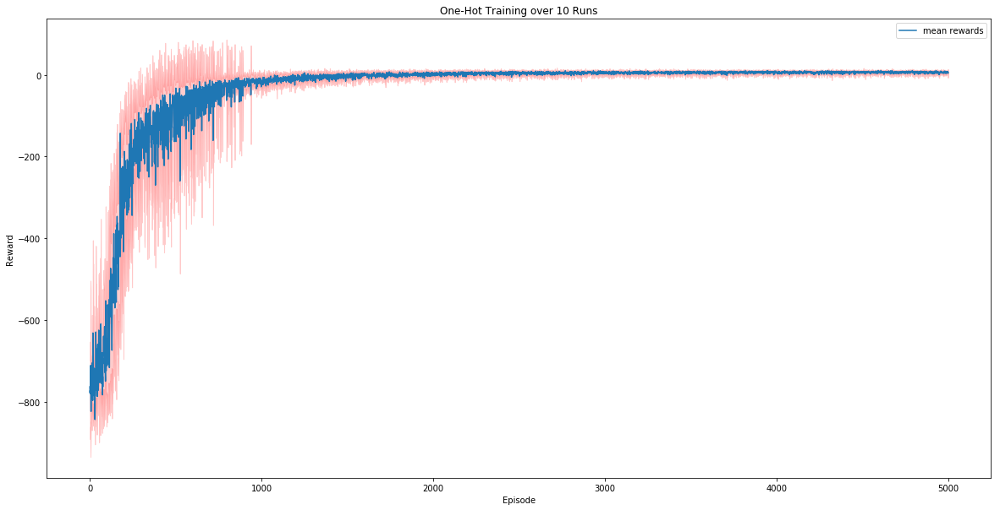

In [15]:
num_agents = 10
# Calculate the mean and variance over the runs
episodes_rewards = []
for i in range(num_agents):
    with open('./taxi_agent_ckpt/one_hot_' + str(i) + '_training.status', 'rb') as fp:
        training_status = pickle.load(fp)
        episodes_rewards.append(training_status['episodes_rewards'])
#         print(len(training_status['episodes_rewards']))

mean_rewards = np.mean(episodes_rewards, axis=0)
var_rewards = np.var(episodes_rewards)
print("Learning Variance: %.3f" % var_rewards)
std_rewards = np.std(episodes_rewards, axis=0)
episodes = list(range(len(mean_rewards)))
# plot
plt.plot(episodes, mean_rewards, label='mean rewards')
plt.fill_between(episodes, mean_rewards - std_rewards, mean_rewards + std_rewards, alpha=0.2, color='r')
plt.title("One-Hot Training over 10 Runs")
plt.xlabel("Episode")
plt.ylabel("Reward")
plt.legend()

In [14]:
with open('./taxi_agent_ckpt/one_hot_2_training.status', 'rb') as fp:
    training_status = pickle.load(fp)
    print(len(training_status['episodes_rewards']))

4974


In [5]:
# One-Hot Representation L1-Regulartization
agent = TaxiAgent(env,
                  name='one_hot_l1',
                  obs_represent='one-hot',
                  exploration=exp_schedule,
                  optimizer='RMSprop',
                  use_l1_regularizer=True,
                  l1_lambda=0.6,
                  learning_rate=0.00025,
                  n_hidden=150,
                  steps_to_start_learn=100,
                  target_update_freq=1000)

Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2


In [7]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 5000
batch_size = 128 # 32
num_episodes = 5000

In [5]:
with open('./taxi_agent_ckpt/one_hot_l1_reg_training.status', 'rb') as fp:
    training_status = pickle.load(fp)
    mean_episode_reward = training_status['mean_episode_reward']
    best_mean_episode_reward = training_status['best_mean_episode_reward']
    episode_durations = training_status['episode_durations'] 
    episodes_rewards = training_status['episodes_rewards']
    total_steps = training_status['total_steps']

In [8]:
# One-Hot Representation L1-Regulartization (MUCH SLOWER)
episode_durations = []
episodes_rewards = []
total_steps = 0
start_time = time.time()
for episode in range(num_episodes):
    episode_start_time = time.time()
    last_obs = env.reset()
    episode_reward = 0
    agent.episodes_seen += 1
    for t in count():
        agent.steps_count += 1
        total_steps += 1
        ### Step the env and store the transition
        # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
        last_idx = agent.replay_buffer.store_frame(agent.one_hot_generator.to_one_hot(last_obs))
        # encode_recent_observation will take the latest observation
        # that you pushed into the buffer and compute the corresponding
        # input that should be given to a Q network by appending some
        # previous frames.
        recent_observation = agent.replay_buffer.encode_recent_observation()
        action = agent.select_greedy_action(recent_observation)
        obs, reward, done, _ = env.step(action)
        episode_reward += reward
        agent.replay_buffer.store_effect(last_idx, action, reward, done)
        ### Perform experience replay and train the network.
        # Note that this is only done if the replay buffer contains enough samples
        # for us to learn something useful -- until then, the model will not be
        # initialized and random actions should be taken
        agent.learn(batch_size)
        ### Log progress and keep track of statistics
        if len(episodes_rewards) > 0:
            mean_episode_reward = np.mean(episodes_rewards[-100:])
        if len(episodes_rewards) > 100:
            best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)
        if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agent.steps_to_start_learn:
            print("Timestep %d" % (agent.steps_count,))
            print("mean reward (100 episodes) %f" % mean_episode_reward)
            print("best mean reward %f" % best_mean_episode_reward)
            print("episodes %d" % len(episodes_rewards))
            print("exploration value %f" % agent.epsilon)
            total_time = time.time() - start_time
            print("time since start: %.2f secs" % total_time)
            training_status = {}
            training_status['mean_episode_reward'] = mean_episode_reward
            training_status['best_mean_episode_reward'] = best_mean_episode_reward
            training_status['episode_durations'] = episode_durations
            training_status['episodes_rewards'] = episodes_rewards
            training_status['total_steps'] = total_steps
            with open('./taxi_agent_ckpt/one_hot_l1_reg_training.status', 'wb') as fp:
                pickle.dump(training_status, fp)
            print("Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status")
        # Resets the environment when reaching an episode boundary.
        if done:
            episode_durations.append(t + 1)
            episodes_rewards.append(episode_reward)
            print("Episode: ", agent.episodes_seen,
                  " Done, Reward: ", episode_reward,
                  " Step: ", agent.steps_count,
                 " Episode Time: %.2f secs" % (time.time() - episode_start_time))
            break
        last_obs = obs
print("Training Complete!")

Episode:  1  Done, Reward:  -848  Step:  200  Episode Time: 0.95 secs
Episode:  2  Done, Reward:  -731  Step:  400  Episode Time: 2.25 secs
Episode:  3  Done, Reward:  -947  Step:  600  Episode Time: 0.88 secs
Episode:  4  Done, Reward:  -794  Step:  800  Episode Time: 0.80 secs
Episode:  5  Done, Reward:  -776  Step:  1000  Episode Time: 1.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  6  Done, Reward:  -740  Step:  1200  Episode Time: 1.62 secs
Episode:  7  Done, Reward:  -839  Step:  1400  Episode Time: 0.88 secs
Episode:  8  Done, Reward:  -803  Step:  1600  Episode Time: 1.08 secs
Episode:  9  Done, Reward:  -704  Step:  1800  Episode Time: 1.01 secs
Episode:  10  Done, Reward:  -659  Step:  2000  Episode Time: 1.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  11  Done, Reward:  -695  Step:  2200  Episode Time: 1.51 secs
Episode:  12  Done, Reward:  -731  Step:  2400  Episode Time: 0.74 secs

Episode:  88  Done, Reward:  -785  Step:  17600  Episode Time: 0.91 secs
Episode:  89  Done, Reward:  -668  Step:  17800  Episode Time: 0.81 secs
Episode:  90  Done, Reward:  -740  Step:  18000  Episode Time: 0.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  91  Done, Reward:  -731  Step:  18200  Episode Time: 0.78 secs
Episode:  92  Done, Reward:  -650  Step:  18400  Episode Time: 1.12 secs
Episode:  93  Done, Reward:  -767  Step:  18600  Episode Time: 2.85 secs
Episode:  94  Done, Reward:  -677  Step:  18800  Episode Time: 2.85 secs
Episode:  95  Done, Reward:  -722  Step:  19000  Episode Time: 1.33 secs
Episode:  96  Done, Reward:  -416  Step:  19122  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  97  Done, Reward:  -695  Step:  19322  Episode Time: 2.18 secs
Episode:  98  Done, Reward:  -749  Step:  19522  Episode Time: 1.26 secs
Episode:  99  Done, Reward:  -758  Step:  19722

Episode:  173  Done, Reward:  -623  Step:  34345  Episode Time: 1.50 secs
Episode:  174  Done, Reward:  -641  Step:  34545  Episode Time: 1.11 secs
Episode:  175  Done, Reward:  -668  Step:  34745  Episode Time: 1.64 secs
Episode:  176  Done, Reward:  -560  Step:  34945  Episode Time: 1.45 secs
Timestep 35000
mean reward (100 episodes) -697.700000
best mean reward -697.700000
episodes 176
exploration value 0.811440
time since start: 194.78 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  177  Done, Reward:  -614  Step:  35145  Episode Time: 0.83 secs
Episode:  178  Done, Reward:  -650  Step:  35345  Episode Time: 0.70 secs
Episode:  179  Done, Reward:  -605  Step:  35545  Episode Time: 0.96 secs
Episode:  180  Done, Reward:  -758  Step:  35745  Episode Time: 0.75 secs
Episode:  181  Done, Reward:  -695  Step:  35945  Episode Time: 1.24 secs
Saved Taxi Agent checkpoint @  ./

Episode:  256  Done, Reward:  -650  Step:  50816  Episode Time: 0.91 secs
Episode:  257  Done, Reward:  -632  Step:  51016  Episode Time: 1.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  258  Done, Reward:  -776  Step:  51216  Episode Time: 1.16 secs
Episode:  259  Done, Reward:  -659  Step:  51416  Episode Time: 1.36 secs
Episode:  260  Done, Reward:  -641  Step:  51616  Episode Time: 1.14 secs
Episode:  261  Done, Reward:  -234  Step:  51718  Episode Time: 0.49 secs
Episode:  262  Done, Reward:  -641  Step:  51918  Episode Time: 0.92 secs
Episode:  263  Done, Reward:  -722  Step:  52118  Episode Time: 0.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  264  Done, Reward:  -596  Step:  52318  Episode Time: 1.28 secs
Episode:  265  Done, Reward:  -632  Step:  52518  Episode Time: 1.03 secs
Episode:  266  Done, Reward:  -551  Step:  52718  Episode Time: 1.23 secs
Episode:  267  Done, Reward:  -722  

Episode:  341  Done, Reward:  -578  Step:  67558  Episode Time: 1.14 secs
Episode:  342  Done, Reward:  -587  Step:  67758  Episode Time: 0.80 secs
Episode:  343  Done, Reward:  -587  Step:  67958  Episode Time: 0.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  344  Done, Reward:  -614  Step:  68158  Episode Time: 0.87 secs
Episode:  345  Done, Reward:  -596  Step:  68358  Episode Time: 1.39 secs
Episode:  346  Done, Reward:  -623  Step:  68558  Episode Time: 0.74 secs
Episode:  347  Done, Reward:  -551  Step:  68758  Episode Time: 0.82 secs
Episode:  348  Done, Reward:  -722  Step:  68958  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  349  Done, Reward:  -560  Step:  69158  Episode Time: 0.83 secs
Episode:  350  Done, Reward:  -668  Step:  69358  Episode Time: 1.03 secs
Episode:  351  Done, Reward:  -605  Step:  69558  Episode Time: 1.29 secs
Episode:  352  Done, Reward:  -425  

Episode:  426  Done, Reward:  -488  Step:  84518  Episode Time: 1.27 secs
Episode:  427  Done, Reward:  -148  Step:  84588  Episode Time: 0.59 secs
Episode:  428  Done, Reward:  -533  Step:  84788  Episode Time: 1.30 secs
Episode:  429  Done, Reward:  -551  Step:  84988  Episode Time: 2.39 secs
Timestep 85000
mean reward (100 episodes) -562.290000
best mean reward -562.290000
episodes 429
exploration value 0.604997
time since start: 536.25 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  430  Done, Reward:  -461  Step:  85188  Episode Time: 2.23 secs
Episode:  431  Done, Reward:  -569  Step:  85388  Episode Time: 2.10 secs
Episode:  432  Done, Reward:  -641  Step:  85588  Episode Time: 1.19 secs
Episode:  433  Done, Reward:  -578  Step:  85788  Episode Time: 0.74 secs
Episode:  434  Done, Reward:  -659  Step:  85988  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./

Episode:  509  Done, Reward:  -542  Step:  100988  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  510  Done, Reward:  -614  Step:  101188  Episode Time: 0.72 secs
Episode:  511  Done, Reward:  -524  Step:  101388  Episode Time: 1.72 secs
Episode:  512  Done, Reward:  -578  Step:  101588  Episode Time: 1.13 secs
Episode:  513  Done, Reward:  -569  Step:  101788  Episode Time: 1.34 secs
Episode:  514  Done, Reward:  -551  Step:  101988  Episode Time: 1.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  515  Done, Reward:  -524  Step:  102188  Episode Time: 1.49 secs
Episode:  516  Done, Reward:  -497  Step:  102388  Episode Time: 1.39 secs
Episode:  517  Done, Reward:  -461  Step:  102588  Episode Time: 1.12 secs
Episode:  518  Done, Reward:  -560  Step:  102788  Episode Time: 1.07 secs
Episode:  519  Done, Reward:  -542  Step:  102988  Episode Time: 1.08 secs
Saved Taxi Agent checkpoi

Episode:  593  Done, Reward:  -452  Step:  117730  Episode Time: 0.89 secs
Episode:  594  Done, Reward:  -461  Step:  117930  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  595  Done, Reward:  -434  Step:  118130  Episode Time: 0.99 secs
Episode:  596  Done, Reward:  -452  Step:  118330  Episode Time: 0.72 secs
Episode:  597  Done, Reward:  -497  Step:  118530  Episode Time: 0.71 secs
Episode:  598  Done, Reward:  -398  Step:  118730  Episode Time: 1.86 secs
Episode:  599  Done, Reward:  -425  Step:  118930  Episode Time: 2.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  600  Done, Reward:  -461  Step:  119130  Episode Time: 2.69 secs
Episode:  601  Done, Reward:  -533  Step:  119330  Episode Time: 1.30 secs
Episode:  602  Done, Reward:  -533  Step:  119530  Episode Time: 0.74 secs
Episode:  603  Done, Reward:  -569  Step:  119730  Episode Time: 0.97 secs
Episode:  604  Done, Rewa

Episode:  677  Done, Reward:  -443  Step:  134412  Episode Time: 0.76 secs
Episode:  678  Done, Reward:  -425  Step:  134612  Episode Time: 1.14 secs
Episode:  679  Done, Reward:  -461  Step:  134812  Episode Time: 0.93 secs
Timestep 135000
mean reward (100 episodes) -468.340000
best mean reward -467.710000
episodes 679
exploration value 0.456044
time since start: 850.97 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Episode:  680  Done, Reward:  -533  Step:  135012  Episode Time: 1.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  681  Done, Reward:  -443  Step:  135212  Episode Time: 1.43 secs
Episode:  682  Done, Reward:  -398  Step:  135412  Episode Time: 1.15 secs
Episode:  683  Done, Reward:  -398  Step:  135612  Episode Time: 1.50 secs
Episode:  684  Done, Reward:  -506  Step:  135812  Episode Time: 2.86 secs
Episode:  685  Done, Reward:  -425  Step:  136012  Episode Time: 2.81 secs
Saved Taxi Agent checkp

Episode:  759  Done, Reward:  -479  Step:  150812  Episode Time: 1.49 secs
Episode:  760  Done, Reward:  -452  Step:  151012  Episode Time: 0.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  761  Done, Reward:  -443  Step:  151212  Episode Time: 1.14 secs
Episode:  762  Done, Reward:  -389  Step:  151412  Episode Time: 1.30 secs
Episode:  763  Done, Reward:  -461  Step:  151612  Episode Time: 1.54 secs
Episode:  764  Done, Reward:  -371  Step:  151812  Episode Time: 1.75 secs
Episode:  765  Done, Reward:  -407  Step:  152012  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  766  Done, Reward:  -353  Step:  152212  Episode Time: 1.13 secs
Episode:  767  Done, Reward:  -479  Step:  152412  Episode Time: 1.13 secs
Episode:  768  Done, Reward:  -398  Step:  152612  Episode Time: 1.38 secs
Episode:  769  Done, Reward:  -407  Step:  152812  Episode Time: 0.72 secs
Episode:  770  Done, Rewa

Episode:  843  Done, Reward:  -434  Step:  167560  Episode Time: 1.18 secs
Episode:  844  Done, Reward:  -470  Step:  167760  Episode Time: 0.95 secs
Episode:  845  Done, Reward:  -389  Step:  167960  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  846  Done, Reward:  -317  Step:  168160  Episode Time: 0.77 secs
Episode:  847  Done, Reward:  -380  Step:  168360  Episode Time: 1.12 secs
Episode:  848  Done, Reward:  -443  Step:  168560  Episode Time: 0.90 secs
Episode:  849  Done, Reward:  -22  Step:  168576  Episode Time: 0.06 secs
Episode:  850  Done, Reward:  -461  Step:  168776  Episode Time: 1.19 secs
Episode:  851  Done, Reward:  -416  Step:  168976  Episode Time: 0.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  852  Done, Reward:  -416  Step:  169176  Episode Time: 1.58 secs
Episode:  853  Done, Reward:  -434  Step:  169376  Episode Time: 1.36 secs
Episode:  854  Done, Rewar

Episode:  927  Done, Reward:  -362  Step:  184176  Episode Time: 0.96 secs
Episode:  928  Done, Reward:  -344  Step:  184376  Episode Time: 1.07 secs
Episode:  929  Done, Reward:  -371  Step:  184576  Episode Time: 1.24 secs
Episode:  930  Done, Reward:  -380  Step:  184776  Episode Time: 0.94 secs
Episode:  931  Done, Reward:  -353  Step:  184976  Episode Time: 0.85 secs
Timestep 185000
mean reward (100 episodes) -402.780000
best mean reward -402.780000
episodes 931
exploration value 0.346327
time since start: 1181.64 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  932  Done, Reward:  -344  Step:  185176  Episode Time: 2.98 secs
Episode:  933  Done, Reward:  -362  Step:  185376  Episode Time: 2.86 secs
Episode:  934  Done, Reward:  -389  Step:  185576  Episode Time: 1.48 secs
Episode:  935  Done, Reward:  -317  Step:  185776  Episode Time: 0.90 secs
Episode:  936  Done, R

Episode:  1008  Done, Reward:  -353  Step:  200376  Episode Time: 0.79 secs
Episode:  1009  Done, Reward:  -317  Step:  200576  Episode Time: 1.54 secs
Episode:  1010  Done, Reward:  -380  Step:  200776  Episode Time: 1.03 secs
Episode:  1011  Done, Reward:  -353  Step:  200976  Episode Time: 1.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1012  Done, Reward:  -335  Step:  201176  Episode Time: 0.75 secs
Episode:  1013  Done, Reward:  -407  Step:  201376  Episode Time: 1.21 secs
Episode:  1014  Done, Reward:  -353  Step:  201576  Episode Time: 0.93 secs
Episode:  1015  Done, Reward:  -326  Step:  201776  Episode Time: 0.95 secs
Episode:  1016  Done, Reward:  -416  Step:  201976  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1017  Done, Reward:  -389  Step:  202176  Episode Time: 2.46 secs
Episode:  1018  Done, Reward:  -353  Step:  202376  Episode Time: 2.75 secs
Episode:  1019

Episode:  1091  Done, Reward:  -344  Step:  216976  Episode Time: 0.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1092  Done, Reward:  -425  Step:  217176  Episode Time: 1.28 secs
Episode:  1093  Done, Reward:  -380  Step:  217376  Episode Time: 1.21 secs
Episode:  1094  Done, Reward:  -407  Step:  217576  Episode Time: 2.60 secs
Episode:  1095  Done, Reward:  -380  Step:  217776  Episode Time: 1.18 secs
Episode:  1096  Done, Reward:  -344  Step:  217976  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1097  Done, Reward:  -389  Step:  218176  Episode Time: 0.99 secs
Episode:  1098  Done, Reward:  -362  Step:  218376  Episode Time: 0.71 secs
Episode:  1099  Done, Reward:  -344  Step:  218576  Episode Time: 0.77 secs
Episode:  1100  Done, Reward:  -407  Step:  218776  Episode Time: 1.41 secs
Episode:  1101  Done, Reward:  -362  Step:  218976  Episode Time: 1.15 secs
Saved Taxi Age

Episode:  1173  Done, Reward:  -353  Step:  233376  Episode Time: 1.37 secs
Episode:  1174  Done, Reward:  -353  Step:  233576  Episode Time: 1.16 secs
Episode:  1175  Done, Reward:  -434  Step:  233776  Episode Time: 1.26 secs
Episode:  1176  Done, Reward:  -380  Step:  233976  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1177  Done, Reward:  -362  Step:  234176  Episode Time: 0.96 secs
Episode:  1178  Done, Reward:  -317  Step:  234376  Episode Time: 2.11 secs
Episode:  1179  Done, Reward:  -398  Step:  234576  Episode Time: 1.33 secs
Episode:  1180  Done, Reward:  -335  Step:  234776  Episode Time: 1.12 secs
Episode:  1181  Done, Reward:  -362  Step:  234976  Episode Time: 1.31 secs
Timestep 235000
mean reward (100 episodes) -363.980000
best mean reward -362.900000
episodes 1181
exploration value 0.266797
time since start: 1485.69 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi A

Episode:  1256  Done, Reward:  -326  Step:  249872  Episode Time: 0.96 secs
Timestep 250000
mean reward (100 episodes) -346.440000
best mean reward -346.440000
episodes 1256
exploration value 0.247396
time since start: 1564.89 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Episode:  1257  Done, Reward:  -308  Step:  250072  Episode Time: 0.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1258  Done, Reward:  -371  Step:  250272  Episode Time: 2.29 secs
Episode:  1259  Done, Reward:  -335  Step:  250472  Episode Time: 3.01 secs
Episode:  1260  Done, Reward:  -317  Step:  250672  Episode Time: 2.89 secs
Episode:  1261  Done, Reward:  -353  Step:  250872  Episode Time: 2.97 secs
Episode:  1262  Done, Reward:  -353  Step:  251072  Episode Time: 1.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1263  Done, Reward:  -362  Step:  251272  Episode Time: 0.85 secs
Episode:  126

Episode:  1336  Done, Reward:  -389  Step:  265872  Episode Time: 0.90 secs
Episode:  1337  Done, Reward:  -344  Step:  266072  Episode Time: 1.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1338  Done, Reward:  -389  Step:  266272  Episode Time: 1.37 secs
Episode:  1339  Done, Reward:  -326  Step:  266472  Episode Time: 1.15 secs
Episode:  1340  Done, Reward:  -326  Step:  266672  Episode Time: 1.35 secs
Episode:  1341  Done, Reward:  -326  Step:  266872  Episode Time: 1.14 secs
Episode:  1342  Done, Reward:  -290  Step:  267072  Episode Time: 1.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1343  Done, Reward:  -317  Step:  267272  Episode Time: 1.07 secs
Episode:  1344  Done, Reward:  -308  Step:  267472  Episode Time: 0.95 secs
Episode:  1345  Done, Reward:  -344  Step:  267672  Episode Time: 0.76 secs
Episode:  1346  Done, Reward:  -335  Step:  267872  Episode Time: 0.83 secs
Episode:  1347

Episode:  1418  Done, Reward:  -272  Step:  282272  Episode Time: 0.84 secs
Episode:  1419  Done, Reward:  -317  Step:  282472  Episode Time: 1.03 secs
Episode:  1420  Done, Reward:  -308  Step:  282672  Episode Time: 0.76 secs
Episode:  1421  Done, Reward:  -272  Step:  282872  Episode Time: 1.40 secs
Episode:  1422  Done, Reward:  -326  Step:  283072  Episode Time: 2.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1423  Done, Reward:  -326  Step:  283272  Episode Time: 0.78 secs
Episode:  1424  Done, Reward:  -317  Step:  283472  Episode Time: 0.99 secs
Episode:  1425  Done, Reward:  -290  Step:  283672  Episode Time: 0.95 secs
Episode:  1426  Done, Reward:  -317  Step:  283872  Episode Time: 0.96 secs
Episode:  1427  Done, Reward:  -317  Step:  284072  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1428  Done, Reward:  -326  Step:  284272  Episode Time: 0.80 secs
Episode:  1429

Episode:  1501  Done, Reward:  -344  Step:  298872  Episode Time: 1.04 secs
Episode:  1502  Done, Reward:  -290  Step:  299072  Episode Time: 1.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1503  Done, Reward:  -254  Step:  299272  Episode Time: 0.93 secs
Episode:  1504  Done, Reward:  -290  Step:  299472  Episode Time: 0.84 secs
Episode:  1505  Done, Reward:  -353  Step:  299672  Episode Time: 1.14 secs
Episode:  1506  Done, Reward:  -299  Step:  299872  Episode Time: 1.52 secs
Timestep 300000
mean reward (100 episodes) -312.680000
best mean reward -312.680000
episodes 1506
exploration value 0.194418
time since start: 1896.12 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Episode:  1507  Done, Reward:  -299  Step:  300072  Episode Time: 1.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1508  Done, Reward:  -380  Step:  300272  Episode Time: 1.13 secs
Episode:  150

Episode:  1582  Done, Reward:  -317  Step:  315072  Episode Time: 1.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1583  Done, Reward:  -308  Step:  315272  Episode Time: 1.17 secs
Episode:  1584  Done, Reward:  -308  Step:  315472  Episode Time: 1.83 secs
Episode:  1585  Done, Reward:  -290  Step:  315672  Episode Time: 2.43 secs
Episode:  1586  Done, Reward:  -272  Step:  315872  Episode Time: 2.83 secs
Episode:  1587  Done, Reward:  -263  Step:  316072  Episode Time: 3.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1588  Done, Reward:  -326  Step:  316272  Episode Time: 1.48 secs
Episode:  1589  Done, Reward:  -299  Step:  316472  Episode Time: 0.88 secs
Episode:  1590  Done, Reward:  -317  Step:  316672  Episode Time: 1.16 secs
Episode:  1591  Done, Reward:  -254  Step:  316872  Episode Time: 0.90 secs
Episode:  1592  Done, Reward:  -317  Step:  317072  Episode Time: 0.72 secs
Saved Taxi Age

Episode:  1664  Done, Reward:  -317  Step:  331369  Episode Time: 1.16 secs
Episode:  1665  Done, Reward:  -353  Step:  331569  Episode Time: 1.35 secs
Episode:  1666  Done, Reward:  -362  Step:  331769  Episode Time: 1.15 secs
Episode:  1667  Done, Reward:  -281  Step:  331969  Episode Time: 1.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1668  Done, Reward:  -335  Step:  332169  Episode Time: 1.36 secs
Episode:  1669  Done, Reward:  -362  Step:  332369  Episode Time: 1.16 secs
Episode:  1670  Done, Reward:  -263  Step:  332569  Episode Time: 1.36 secs
Episode:  1671  Done, Reward:  -299  Step:  332769  Episode Time: 1.16 secs
Episode:  1672  Done, Reward:  -299  Step:  332969  Episode Time: 1.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1673  Done, Reward:  -371  Step:  333169  Episode Time: 1.47 secs
Episode:  1674  Done, Reward:  -290  Step:  333369  Episode Time: 1.29 secs
Episode:  1675

Episode:  1747  Done, Reward:  -290  Step:  347969  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1748  Done, Reward:  -245  Step:  348169  Episode Time: 0.90 secs
Episode:  1749  Done, Reward:  -299  Step:  348369  Episode Time: 1.76 secs
Episode:  1750  Done, Reward:  -299  Step:  348569  Episode Time: 3.03 secs
Episode:  1751  Done, Reward:  -281  Step:  348769  Episode Time: 2.55 secs
Episode:  1752  Done, Reward:  -299  Step:  348969  Episode Time: 1.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1753  Done, Reward:  -254  Step:  349169  Episode Time: 0.77 secs
Episode:  1754  Done, Reward:  -227  Step:  349369  Episode Time: 0.77 secs
Episode:  1755  Done, Reward:  -353  Step:  349569  Episode Time: 1.12 secs
Episode:  1756  Done, Reward:  -263  Step:  349769  Episode Time: 1.30 secs
Episode:  1757  Done, Reward:  -254  Step:  349969  Episode Time: 1.08 secs
Timestep 35000

Episode:  1829  Done, Reward:  -299  Step:  364369  Episode Time: 1.42 secs
Episode:  1830  Done, Reward:  -245  Step:  364569  Episode Time: 2.92 secs
Episode:  1831  Done, Reward:  -263  Step:  364769  Episode Time: 2.40 secs
Episode:  1832  Done, Reward:  -254  Step:  364969  Episode Time: 1.33 secs
Timestep 365000
mean reward (100 episodes) -285.680000
best mean reward -285.680000
episodes 1832
exploration value 0.146083
time since start: 2331.83 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1833  Done, Reward:  -272  Step:  365169  Episode Time: 0.73 secs
Episode:  1834  Done, Reward:  -290  Step:  365369  Episode Time: 1.47 secs
Episode:  1835  Done, Reward:  -236  Step:  365569  Episode Time: 1.16 secs
Episode:  1836  Done, Reward:  -281  Step:  365769  Episode Time: 1.07 secs
Episode:  1837  Done, Reward:  -299  Step:  365969  Episode Time: 0.94 secs
Saved Taxi A

Episode:  1909  Done, Reward:  -272  Step:  380369  Episode Time: 0.75 secs
Episode:  1910  Done, Reward:  -245  Step:  380569  Episode Time: 0.98 secs
Episode:  1911  Done, Reward:  -281  Step:  380769  Episode Time: 1.41 secs
Episode:  1912  Done, Reward:  -254  Step:  380969  Episode Time: 1.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1913  Done, Reward:  -227  Step:  381169  Episode Time: 2.25 secs
Episode:  1914  Done, Reward:  -236  Step:  381369  Episode Time: 2.55 secs
Episode:  1915  Done, Reward:  -245  Step:  381569  Episode Time: 1.26 secs
Episode:  1916  Done, Reward:  -245  Step:  381769  Episode Time: 1.20 secs
Episode:  1917  Done, Reward:  -263  Step:  381969  Episode Time: 1.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1918  Done, Reward:  -204  Step:  382158  Episode Time: 1.46 secs
Episode:  1919  Done, Reward:  -308  Step:  382358  Episode Time: 1.64 secs
Episode:  1920

Episode:  1992  Done, Reward:  -227  Step:  396958  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1993  Done, Reward:  -272  Step:  397158  Episode Time: 1.29 secs
Episode:  1994  Done, Reward:  -272  Step:  397358  Episode Time: 0.75 secs
Episode:  1995  Done, Reward:  -254  Step:  397558  Episode Time: 1.13 secs
Episode:  1996  Done, Reward:  -272  Step:  397758  Episode Time: 0.74 secs
Episode:  1997  Done, Reward:  -281  Step:  397958  Episode Time: 2.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  1998  Done, Reward:  -335  Step:  398158  Episode Time: 1.12 secs
Episode:  1999  Done, Reward:  -299  Step:  398358  Episode Time: 0.85 secs
Episode:  2000  Done, Reward:  -236  Step:  398558  Episode Time: 1.57 secs
Episode:  2001  Done, Reward:  -290  Step:  398758  Episode Time: 0.90 secs
Episode:  2002  Done, Reward:  -263  Step:  398958  Episode Time: 1.69 secs
Saved Taxi Age

Episode:  2074  Done, Reward:  -263  Step:  413358  Episode Time: 1.05 secs
Episode:  2075  Done, Reward:  -245  Step:  413558  Episode Time: 1.28 secs
Episode:  2076  Done, Reward:  -245  Step:  413758  Episode Time: 0.74 secs
Episode:  2077  Done, Reward:  -281  Step:  413958  Episode Time: 0.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2078  Done, Reward:  -263  Step:  414158  Episode Time: 0.84 secs
Episode:  2079  Done, Reward:  -245  Step:  414358  Episode Time: 1.48 secs
Episode:  2080  Done, Reward:  -254  Step:  414558  Episode Time: 2.77 secs
Episode:  2081  Done, Reward:  -245  Step:  414758  Episode Time: 1.15 secs
Episode:  2082  Done, Reward:  -236  Step:  414958  Episode Time: 0.99 secs
Timestep 415000
mean reward (100 episodes) -347.420000
best mean reward -283.610000
episodes 2082
exploration value 0.120296
time since start: 2659.05 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi A

Episode:  2157  Done, Reward:  -236  Step:  429958  Episode Time: 0.76 secs
Timestep 430000
mean reward (100 episodes) -266.780000
best mean reward -266.780000
episodes 2157
exploration value 0.114005
time since start: 2750.86 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2158  Done, Reward:  -254  Step:  430158  Episode Time: 1.07 secs
Episode:  2159  Done, Reward:  -254  Step:  430358  Episode Time: 0.76 secs
Episode:  2160  Done, Reward:  -317  Step:  430558  Episode Time: 0.95 secs
Episode:  2161  Done, Reward:  -236  Step:  430758  Episode Time: 0.76 secs
Episode:  2162  Done, Reward:  -236  Step:  430958  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2163  Done, Reward:  -254  Step:  431158  Episode Time: 1.05 secs
Episode:  2164  Done, Reward:  -281  Step:  431358  Episode Time: 0.75 secs
Episode:  216

Episode:  2237  Done, Reward:  -227  Step:  445958  Episode Time: 0.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2238  Done, Reward:  -254  Step:  446158  Episode Time: 0.72 secs
Episode:  2239  Done, Reward:  -263  Step:  446358  Episode Time: 0.90 secs
Episode:  2240  Done, Reward:  -245  Step:  446558  Episode Time: 0.82 secs
Episode:  2241  Done, Reward:  -254  Step:  446758  Episode Time: 0.72 secs
Episode:  2242  Done, Reward:  -254  Step:  446958  Episode Time: 0.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2243  Done, Reward:  -245  Step:  447158  Episode Time: 0.76 secs
Episode:  2244  Done, Reward:  -245  Step:  447358  Episode Time: 1.35 secs
Episode:  2245  Done, Reward:  -254  Step:  447558  Episode Time: 1.25 secs
Episode:  2246  Done, Reward:  -299  Step:  447758  Episode Time: 1.32 secs
Episode:  2247  Done, Reward:  -254  Step:  447958  Episode Time: 1.13 secs
Saved Taxi Age

Episode:  2319  Done, Reward:  -218  Step:  462358  Episode Time: 1.09 secs
Episode:  2320  Done, Reward:  -227  Step:  462558  Episode Time: 0.82 secs
Episode:  2321  Done, Reward:  -245  Step:  462758  Episode Time: 0.71 secs
Episode:  2322  Done, Reward:  -236  Step:  462958  Episode Time: 1.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2323  Done, Reward:  -254  Step:  463158  Episode Time: 0.74 secs
Episode:  2324  Done, Reward:  -245  Step:  463358  Episode Time: 0.72 secs
Episode:  2325  Done, Reward:  -218  Step:  463558  Episode Time: 1.47 secs
Episode:  2326  Done, Reward:  -218  Step:  463758  Episode Time: 2.66 secs
Episode:  2327  Done, Reward:  -245  Step:  463958  Episode Time: 2.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2328  Done, Reward:  -533  Step:  464158  Episode Time: 1.24 secs
Episode:  2329  Done, Reward:  -1901  Step:  464358  Episode Time: 1.25 secs
Episode:  233

Episode:  2402  Done, Reward:  -245  Step:  478958  Episode Time: 1.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2403  Done, Reward:  -254  Step:  479158  Episode Time: 2.92 secs
Episode:  2404  Done, Reward:  -245  Step:  479358  Episode Time: 2.06 secs
Episode:  2405  Done, Reward:  -254  Step:  479558  Episode Time: 1.15 secs
Episode:  2406  Done, Reward:  -272  Step:  479758  Episode Time: 1.42 secs
Episode:  2407  Done, Reward:  -254  Step:  479958  Episode Time: 0.96 secs
Timestep 480000
mean reward (100 episodes) -418.610000
best mean reward -259.040000
episodes 2407
exploration value 0.096827
time since start: 3066.96 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2408  Done, Reward:  -245  Step:  480158  Episode Time: 1.19 secs
Episode:  2409  Done, Reward:  -281  Step:  480358  Episode Time: 0.76 secs
Episode:  241

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2483  Done, Reward:  -227  Step:  495158  Episode Time: 2.95 secs
Episode:  2484  Done, Reward:  -263  Step:  495358  Episode Time: 1.27 secs
Episode:  2485  Done, Reward:  -227  Step:  495558  Episode Time: 0.77 secs
Episode:  2486  Done, Reward:  -272  Step:  495758  Episode Time: 0.90 secs
Episode:  2487  Done, Reward:  -245  Step:  495958  Episode Time: 1.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2488  Done, Reward:  -218  Step:  496158  Episode Time: 1.36 secs
Episode:  2489  Done, Reward:  -236  Step:  496358  Episode Time: 1.16 secs
Episode:  2490  Done, Reward:  -272  Step:  496558  Episode Time: 1.36 secs
Episode:  2491  Done, Reward:  -263  Step:  496758  Episode Time: 1.16 secs
Episode:  2492  Done, Reward:  -263  Step:  496958  Episode Time: 1.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2493 

Episode:  2565  Done, Reward:  -1883  Step:  511558  Episode Time: 0.80 secs
Episode:  2566  Done, Reward:  -1829  Step:  511758  Episode Time: 1.39 secs
Episode:  2567  Done, Reward:  -1901  Step:  511958  Episode Time: 1.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2568  Done, Reward:  -1640  Step:  512158  Episode Time: 1.20 secs
Episode:  2569  Done, Reward:  -218  Step:  512358  Episode Time: 0.98 secs
Episode:  2570  Done, Reward:  -254  Step:  512558  Episode Time: 1.35 secs
Episode:  2571  Done, Reward:  -272  Step:  512758  Episode Time: 2.13 secs
Episode:  2572  Done, Reward:  -209  Step:  512958  Episode Time: 2.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2573  Done, Reward:  -236  Step:  513158  Episode Time: 1.94 secs
Episode:  2574  Done, Reward:  -263  Step:  513358  Episode Time: 1.02 secs
Episode:  2575  Done, Reward:  -245  Step:  513558  Episode Time: 1.24 secs
Episode:  

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2648  Done, Reward:  -227  Step:  528158  Episode Time: 2.01 secs
Episode:  2649  Done, Reward:  -254  Step:  528358  Episode Time: 2.16 secs
Episode:  2650  Done, Reward:  -263  Step:  528558  Episode Time: 1.01 secs
Episode:  2651  Done, Reward:  -245  Step:  528758  Episode Time: 1.35 secs
Episode:  2652  Done, Reward:  -254  Step:  528958  Episode Time: 1.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2653  Done, Reward:  -218  Step:  529158  Episode Time: 1.16 secs
Episode:  2654  Done, Reward:  -227  Step:  529358  Episode Time: 1.37 secs
Episode:  2655  Done, Reward:  -245  Step:  529558  Episode Time: 1.16 secs
Episode:  2656  Done, Reward:  -236  Step:  529758  Episode Time: 1.37 secs
Episode:  2657  Done, Reward:  -245  Step:  529958  Episode Time: 1.36 secs
Timestep 530000
mean reward (100 episodes) -332.750000
best mean reward -250.400000
episod

Episode:  2730  Done, Reward:  -236  Step:  544558  Episode Time: 0.95 secs
Episode:  2731  Done, Reward:  -245  Step:  544758  Episode Time: 1.17 secs
Episode:  2732  Done, Reward:  -218  Step:  544958  Episode Time: 0.76 secs
Timestep 545000
mean reward (100 episodes) -250.580000
best mean reward -250.220000
episodes 2732
exploration value 0.081194
time since start: 3511.15 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2733  Done, Reward:  -263  Step:  545158  Episode Time: 0.97 secs
Episode:  2734  Done, Reward:  -236  Step:  545358  Episode Time: 0.91 secs
Episode:  2735  Done, Reward:  -254  Step:  545558  Episode Time: 1.16 secs
Episode:  2736  Done, Reward:  -263  Step:  545758  Episode Time: 1.15 secs
Episode:  2737  Done, Reward:  -281  Step:  545958  Episode Time: 1.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  273

Episode:  2810  Done, Reward:  -236  Step:  560558  Episode Time: 1.48 secs
Episode:  2811  Done, Reward:  -272  Step:  560758  Episode Time: 1.10 secs
Episode:  2812  Done, Reward:  -254  Step:  560958  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2813  Done, Reward:  -308  Step:  561158  Episode Time: 0.72 secs
Episode:  2814  Done, Reward:  -245  Step:  561358  Episode Time: 0.91 secs
Episode:  2815  Done, Reward:  -254  Step:  561558  Episode Time: 0.72 secs
Episode:  2816  Done, Reward:  -272  Step:  561758  Episode Time: 1.12 secs
Episode:  2817  Done, Reward:  -281  Step:  561958  Episode Time: 1.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2818  Done, Reward:  -263  Step:  562158  Episode Time: 2.85 secs
Episode:  2819  Done, Reward:  -245  Step:  562358  Episode Time: 2.97 secs
Episode:  2820  Done, Reward:  -236  Step:  562558  Episode Time: 2.94 secs
Episode:  2821

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2893  Done, Reward:  -227  Step:  577158  Episode Time: 1.25 secs
Episode:  2894  Done, Reward:  -263  Step:  577358  Episode Time: 1.81 secs
Episode:  2895  Done, Reward:  -236  Step:  577558  Episode Time: 0.95 secs
Episode:  2896  Done, Reward:  -236  Step:  577758  Episode Time: 1.44 secs
Episode:  2897  Done, Reward:  -227  Step:  577958  Episode Time: 1.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2898  Done, Reward:  -254  Step:  578158  Episode Time: 1.29 secs
Episode:  2899  Done, Reward:  -218  Step:  578358  Episode Time: 1.22 secs
Episode:  2900  Done, Reward:  -245  Step:  578558  Episode Time: 2.29 secs
Episode:  2901  Done, Reward:  -245  Step:  578758  Episode Time: 2.60 secs
Episode:  2902  Done, Reward:  -245  Step:  578958  Episode Time: 2.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2903 

Episode:  2975  Done, Reward:  -254  Step:  593558  Episode Time: 1.80 secs
Episode:  2976  Done, Reward:  -227  Step:  593758  Episode Time: 2.02 secs
Episode:  2977  Done, Reward:  -245  Step:  593958  Episode Time: 1.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  2978  Done, Reward:  -200  Step:  594158  Episode Time: 1.03 secs
Episode:  2979  Done, Reward:  -263  Step:  594358  Episode Time: 1.20 secs
Episode:  2980  Done, Reward:  -272  Step:  594558  Episode Time: 1.36 secs
Episode:  2981  Done, Reward:  -263  Step:  594758  Episode Time: 1.40 secs
Episode:  2982  Done, Reward:  -218  Step:  594958  Episode Time: 1.22 secs
Timestep 595000
mean reward (100 episodes) -409.700000
best mean reward -248.150000
episodes 2982
exploration value 0.072822
time since start: 3891.05 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  298

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3058  Done, Reward:  -245  Step:  610158  Episode Time: 1.16 secs
Episode:  3059  Done, Reward:  -227  Step:  610358  Episode Time: 2.60 secs
Episode:  3060  Done, Reward:  -218  Step:  610558  Episode Time: 2.91 secs
Episode:  3061  Done, Reward:  -245  Step:  610758  Episode Time: 2.36 secs
Episode:  3062  Done, Reward:  -245  Step:  610958  Episode Time: 1.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3063  Done, Reward:  -254  Step:  611158  Episode Time: 2.79 secs
Episode:  3064  Done, Reward:  -236  Step:  611358  Episode Time: 3.05 secs
Episode:  3065  Done, Reward:  -308  Step:  611558  Episode Time: 2.34 secs
Episode:  3066  Done, Reward:  -281  Step:  611758  Episode Time: 1.04 secs
Episode:  3067  Done, Reward:  -227  Step:  611958  Episode Time: 1.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3068 

Episode:  3140  Done, Reward:  -227  Step:  626558  Episode Time: 0.83 secs
Episode:  3141  Done, Reward:  -245  Step:  626758  Episode Time: 0.87 secs
Episode:  3142  Done, Reward:  -209  Step:  626958  Episode Time: 1.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3143  Done, Reward:  -254  Step:  627158  Episode Time: 0.76 secs
Episode:  3144  Done, Reward:  -254  Step:  627358  Episode Time: 1.69 secs
Episode:  3145  Done, Reward:  -245  Step:  627558  Episode Time: 2.93 secs
Episode:  3146  Done, Reward:  -263  Step:  627758  Episode Time: 1.50 secs
Episode:  3147  Done, Reward:  -227  Step:  627958  Episode Time: 2.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3148  Done, Reward:  -236  Step:  628158  Episode Time: 1.90 secs
Episode:  3149  Done, Reward:  -236  Step:  628358  Episode Time: 1.15 secs
Episode:  3150  Done, Reward:  -227  Step:  628558  Episode Time: 0.99 secs
Episode:  3151

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3223  Done, Reward:  -263  Step:  643158  Episode Time: 0.91 secs
Episode:  3224  Done, Reward:  -218  Step:  643358  Episode Time: 0.72 secs
Episode:  3225  Done, Reward:  -263  Step:  643558  Episode Time: 0.78 secs
Episode:  3226  Done, Reward:  -236  Step:  643758  Episode Time: 0.90 secs
Episode:  3227  Done, Reward:  -218  Step:  643958  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3228  Done, Reward:  -227  Step:  644158  Episode Time: 0.72 secs
Episode:  3229  Done, Reward:  -227  Step:  644358  Episode Time: 0.91 secs
Episode:  3230  Done, Reward:  -245  Step:  644558  Episode Time: 0.72 secs
Episode:  3231  Done, Reward:  -245  Step:  644758  Episode Time: 1.13 secs
Episode:  3232  Done, Reward:  -272  Step:  644958  Episode Time: 1.73 secs
Timestep 645000
mean reward (100 episodes) -239.780000
best mean reward -239.060000
episod

Episode:  3305  Done, Reward:  -227  Step:  659558  Episode Time: 0.97 secs
Episode:  3306  Done, Reward:  -227  Step:  659758  Episode Time: 0.79 secs
Episode:  3307  Done, Reward:  -254  Step:  659958  Episode Time: 0.87 secs
Timestep 660000
mean reward (100 episodes) -241.040000
best mean reward -238.790000
episodes 3307
exploration value 0.065203
time since start: 4300.54 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3308  Done, Reward:  -227  Step:  660158  Episode Time: 0.96 secs
Episode:  3309  Done, Reward:  -263  Step:  660358  Episode Time: 0.76 secs
Episode:  3310  Done, Reward:  -200  Step:  660558  Episode Time: 1.14 secs
Episode:  3311  Done, Reward:  -254  Step:  660758  Episode Time: 0.76 secs
Episode:  3312  Done, Reward:  -245  Step:  660958  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  331

Episode:  3385  Done, Reward:  -290  Step:  675558  Episode Time: 2.82 secs
Episode:  3386  Done, Reward:  -227  Step:  675758  Episode Time: 2.37 secs
Episode:  3387  Done, Reward:  -281  Step:  675958  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3388  Done, Reward:  -245  Step:  676158  Episode Time: 1.15 secs
Episode:  3389  Done, Reward:  -236  Step:  676358  Episode Time: 1.16 secs
Episode:  3390  Done, Reward:  -218  Step:  676558  Episode Time: 1.20 secs
Episode:  3391  Done, Reward:  -236  Step:  676758  Episode Time: 0.74 secs
Episode:  3392  Done, Reward:  -245  Step:  676958  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3393  Done, Reward:  -227  Step:  677158  Episode Time: 0.96 secs
Episode:  3394  Done, Reward:  -245  Step:  677358  Episode Time: 1.03 secs
Episode:  3395  Done, Reward:  -209  Step:  677558  Episode Time: 1.36 secs
Episode:  3396

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3468  Done, Reward:  -245  Step:  692158  Episode Time: 1.63 secs
Episode:  3469  Done, Reward:  -254  Step:  692358  Episode Time: 1.39 secs
Episode:  3470  Done, Reward:  -236  Step:  692558  Episode Time: 0.99 secs
Episode:  3471  Done, Reward:  -245  Step:  692758  Episode Time: 2.40 secs
Episode:  3472  Done, Reward:  -236  Step:  692958  Episode Time: 1.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3473  Done, Reward:  -479  Step:  693158  Episode Time: 0.84 secs
Episode:  3474  Done, Reward:  -1955  Step:  693358  Episode Time: 0.96 secs
Episode:  3475  Done, Reward:  -1901  Step:  693558  Episode Time: 1.09 secs
Episode:  3476  Done, Reward:  -1955  Step:  693758  Episode Time: 1.36 secs
Episode:  3477  Done, Reward:  -1928  Step:  693958  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3

Episode:  3550  Done, Reward:  -236  Step:  708558  Episode Time: 1.18 secs
Episode:  3551  Done, Reward:  -218  Step:  708758  Episode Time: 0.82 secs
Episode:  3552  Done, Reward:  -218  Step:  708958  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3553  Done, Reward:  -209  Step:  709158  Episode Time: 0.96 secs
Episode:  3554  Done, Reward:  -218  Step:  709358  Episode Time: 1.13 secs
Episode:  3555  Done, Reward:  -218  Step:  709558  Episode Time: 1.37 secs
Episode:  3556  Done, Reward:  -254  Step:  709758  Episode Time: 1.12 secs
Episode:  3557  Done, Reward:  -218  Step:  709958  Episode Time: 1.05 secs
Timestep 710000
mean reward (100 episodes) -319.520000
best mean reward -234.740000
episodes 3557
exploration value 0.061122
time since start: 4621.73 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  355

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3633  Done, Reward:  -254  Step:  725158  Episode Time: 1.98 secs
Episode:  3634  Done, Reward:  -209  Step:  725358  Episode Time: 2.23 secs
Episode:  3635  Done, Reward:  -272  Step:  725558  Episode Time: 1.95 secs
Episode:  3636  Done, Reward:  -245  Step:  725758  Episode Time: 1.69 secs
Episode:  3637  Done, Reward:  -209  Step:  725958  Episode Time: 1.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3638  Done, Reward:  -227  Step:  726158  Episode Time: 0.96 secs
Episode:  3639  Done, Reward:  -236  Step:  726358  Episode Time: 1.05 secs
Episode:  3640  Done, Reward:  -254  Step:  726558  Episode Time: 1.48 secs
Episode:  3641  Done, Reward:  -245  Step:  726758  Episode Time: 0.79 secs
Episode:  3642  Done, Reward:  -218  Step:  726958  Episode Time: 1.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3643 

Episode:  3715  Done, Reward:  -227  Step:  741558  Episode Time: 2.69 secs
Episode:  3716  Done, Reward:  -218  Step:  741758  Episode Time: 2.83 secs
Episode:  3717  Done, Reward:  -263  Step:  741958  Episode Time: 1.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3718  Done, Reward:  -236  Step:  742158  Episode Time: 1.90 secs
Episode:  3719  Done, Reward:  -254  Step:  742358  Episode Time: 1.42 secs
Episode:  3720  Done, Reward:  -227  Step:  742558  Episode Time: 1.16 secs
Episode:  3721  Done, Reward:  -236  Step:  742758  Episode Time: 1.40 secs
Episode:  3722  Done, Reward:  -200  Step:  742958  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3723  Done, Reward:  -236  Step:  743158  Episode Time: 0.96 secs
Episode:  3724  Done, Reward:  -227  Step:  743358  Episode Time: 2.67 secs
Episode:  3725  Done, Reward:  -218  Step:  743558  Episode Time: 1.88 secs
Episode:  3726

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3798  Done, Reward:  -245  Step:  758158  Episode Time: 0.83 secs
Episode:  3799  Done, Reward:  -218  Step:  758358  Episode Time: 1.88 secs
Episode:  3800  Done, Reward:  -218  Step:  758558  Episode Time: 3.00 secs
Episode:  3801  Done, Reward:  -209  Step:  758758  Episode Time: 1.10 secs
Episode:  3802  Done, Reward:  -254  Step:  758958  Episode Time: 1.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3803  Done, Reward:  -506  Step:  759158  Episode Time: 0.76 secs
Episode:  3804  Done, Reward:  -1901  Step:  759358  Episode Time: 0.76 secs
Episode:  3805  Done, Reward:  -1946  Step:  759558  Episode Time: 1.28 secs
Episode:  3806  Done, Reward:  -1955  Step:  759758  Episode Time: 1.99 secs
Episode:  3807  Done, Reward:  -1874  Step:  759958  Episode Time: 2.20 secs
Timestep 760000
mean reward (100 episodes) -303.680000
best mean reward -233.480000
ep

Episode:  3880  Done, Reward:  -227  Step:  774558  Episode Time: 0.76 secs
Episode:  3881  Done, Reward:  -236  Step:  774758  Episode Time: 0.99 secs
Episode:  3882  Done, Reward:  -236  Step:  774958  Episode Time: 0.72 secs
Timestep 775000
mean reward (100 episodes) -320.150000
best mean reward -233.480000
episodes 3882
exploration value 0.057409
time since start: 5044.46 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3883  Done, Reward:  -236  Step:  775158  Episode Time: 0.72 secs
Episode:  3884  Done, Reward:  -227  Step:  775358  Episode Time: 0.95 secs
Episode:  3885  Done, Reward:  -245  Step:  775558  Episode Time: 1.43 secs
Episode:  3886  Done, Reward:  -227  Step:  775758  Episode Time: 2.43 secs
Episode:  3887  Done, Reward:  -245  Step:  775958  Episode Time: 1.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  388

Episode:  3960  Done, Reward:  -227  Step:  790558  Episode Time: 1.17 secs
Episode:  3961  Done, Reward:  -218  Step:  790758  Episode Time: 1.75 secs
Episode:  3962  Done, Reward:  -218  Step:  790958  Episode Time: 2.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3963  Done, Reward:  -218  Step:  791158  Episode Time: 2.84 secs
Episode:  3964  Done, Reward:  -236  Step:  791358  Episode Time: 1.28 secs
Episode:  3965  Done, Reward:  -236  Step:  791558  Episode Time: 1.27 secs
Episode:  3966  Done, Reward:  -218  Step:  791758  Episode Time: 0.72 secs
Episode:  3967  Done, Reward:  -245  Step:  791958  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  3968  Done, Reward:  -263  Step:  792158  Episode Time: 0.90 secs
Episode:  3969  Done, Reward:  -245  Step:  792358  Episode Time: 0.72 secs
Episode:  3970  Done, Reward:  -209  Step:  792558  Episode Time: 0.72 secs
Episode:  3971

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4043  Done, Reward:  -218  Step:  807158  Episode Time: 0.91 secs
Episode:  4044  Done, Reward:  -209  Step:  807358  Episode Time: 1.14 secs
Episode:  4045  Done, Reward:  -245  Step:  807558  Episode Time: 0.72 secs
Episode:  4046  Done, Reward:  -254  Step:  807758  Episode Time: 0.78 secs
Episode:  4047  Done, Reward:  -236  Step:  807958  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4048  Done, Reward:  -254  Step:  808158  Episode Time: 0.74 secs
Episode:  4049  Done, Reward:  -236  Step:  808358  Episode Time: 1.24 secs
Episode:  4050  Done, Reward:  -245  Step:  808558  Episode Time: 1.05 secs
Episode:  4051  Done, Reward:  -245  Step:  808758  Episode Time: 1.32 secs
Episode:  4052  Done, Reward:  -200  Step:  808958  Episode Time: 1.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4053 

Episode:  4125  Done, Reward:  -218  Step:  823558  Episode Time: 0.88 secs
Episode:  4126  Done, Reward:  -245  Step:  823758  Episode Time: 0.95 secs
Episode:  4127  Done, Reward:  -245  Step:  823958  Episode Time: 1.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4128  Done, Reward:  -245  Step:  824158  Episode Time: 1.99 secs
Episode:  4129  Done, Reward:  -272  Step:  824358  Episode Time: 2.88 secs
Episode:  4130  Done, Reward:  -245  Step:  824558  Episode Time: 2.83 secs
Episode:  4131  Done, Reward:  -227  Step:  824758  Episode Time: 3.04 secs
Episode:  4132  Done, Reward:  -218  Step:  824958  Episode Time: 1.27 secs
Timestep 825000
mean reward (100 episodes) -317.900000
best mean reward -233.480000
episodes 4132
exploration value 0.055421
time since start: 5358.78 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  413

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4208  Done, Reward:  -236  Step:  840158  Episode Time: 2.00 secs
Episode:  4209  Done, Reward:  -227  Step:  840358  Episode Time: 1.47 secs
Episode:  4210  Done, Reward:  -254  Step:  840558  Episode Time: 0.92 secs
Episode:  4211  Done, Reward:  -236  Step:  840758  Episode Time: 1.11 secs
Episode:  4212  Done, Reward:  -236  Step:  840958  Episode Time: 1.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4213  Done, Reward:  -218  Step:  841158  Episode Time: 2.87 secs
Episode:  4214  Done, Reward:  -290  Step:  841358  Episode Time: 2.88 secs
Episode:  4215  Done, Reward:  -227  Step:  841558  Episode Time: 1.47 secs
Episode:  4216  Done, Reward:  -254  Step:  841758  Episode Time: 0.92 secs
Episode:  4217  Done, Reward:  -209  Step:  841958  Episode Time: 1.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4218 

Episode:  4290  Done, Reward:  -227  Step:  856551  Episode Time: 1.41 secs
Episode:  4291  Done, Reward:  -254  Step:  856751  Episode Time: 1.16 secs
Episode:  4292  Done, Reward:  -254  Step:  856951  Episode Time: 1.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4293  Done, Reward:  -227  Step:  857151  Episode Time: 1.36 secs
Episode:  4294  Done, Reward:  -245  Step:  857351  Episode Time: 0.87 secs
Episode:  4295  Done, Reward:  -227  Step:  857551  Episode Time: 0.87 secs
Episode:  4296  Done, Reward:  -236  Step:  857751  Episode Time: 1.60 secs
Episode:  4297  Done, Reward:  -200  Step:  857951  Episode Time: 1.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4298  Done, Reward:  -227  Step:  858151  Episode Time: 2.40 secs
Episode:  4299  Done, Reward:  -254  Step:  858351  Episode Time: 2.83 secs
Episode:  4300  Done, Reward:  -227  Step:  858551  Episode Time: 3.16 secs
Episode:  4301

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4373  Done, Reward:  -236  Step:  873151  Episode Time: 1.31 secs
Episode:  4374  Done, Reward:  -245  Step:  873351  Episode Time: 1.13 secs
Episode:  4375  Done, Reward:  -245  Step:  873551  Episode Time: 1.36 secs
Episode:  4376  Done, Reward:  -263  Step:  873751  Episode Time: 1.16 secs
Episode:  4377  Done, Reward:  -209  Step:  873951  Episode Time: 1.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4378  Done, Reward:  -236  Step:  874151  Episode Time: 1.16 secs
Episode:  4379  Done, Reward:  -236  Step:  874351  Episode Time: 1.38 secs
Episode:  4380  Done, Reward:  -218  Step:  874551  Episode Time: 0.72 secs
Episode:  4381  Done, Reward:  -227  Step:  874751  Episode Time: 0.90 secs
Episode:  4382  Done, Reward:  -245  Step:  874951  Episode Time: 0.72 secs
Timestep 875000
mean reward (100 episodes) -318.800000
best mean reward -231.040000
episod

Episode:  4455  Done, Reward:  -245  Step:  889551  Episode Time: 1.06 secs
Episode:  4456  Done, Reward:  -209  Step:  889751  Episode Time: 0.76 secs
Episode:  4457  Done, Reward:  -263  Step:  889951  Episode Time: 0.99 secs
Timestep 890000
mean reward (100 episodes) -230.510000
best mean reward -229.520000
episodes 4457
exploration value 0.053611
time since start: 5788.80 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4458  Done, Reward:  -218  Step:  890151  Episode Time: 0.98 secs
Episode:  4459  Done, Reward:  -236  Step:  890351  Episode Time: 1.04 secs
Episode:  4460  Done, Reward:  -236  Step:  890551  Episode Time: 1.01 secs
Episode:  4461  Done, Reward:  -236  Step:  890751  Episode Time: 0.75 secs
Episode:  4462  Done, Reward:  -218  Step:  890951  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  446

Episode:  4535  Done, Reward:  -218  Step:  905551  Episode Time: 1.15 secs
Episode:  4536  Done, Reward:  -236  Step:  905751  Episode Time: 1.36 secs
Episode:  4537  Done, Reward:  -245  Step:  905951  Episode Time: 1.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4538  Done, Reward:  -236  Step:  906151  Episode Time: 1.37 secs
Episode:  4539  Done, Reward:  -218  Step:  906351  Episode Time: 1.36 secs
Episode:  4540  Done, Reward:  -209  Step:  906551  Episode Time: 1.16 secs
Episode:  4541  Done, Reward:  -209  Step:  906751  Episode Time: 1.36 secs
Episode:  4542  Done, Reward:  -236  Step:  906951  Episode Time: 1.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4543  Done, Reward:  -227  Step:  907151  Episode Time: 1.46 secs
Episode:  4544  Done, Reward:  -236  Step:  907351  Episode Time: 1.16 secs
Episode:  4545  Done, Reward:  -218  Step:  907551  Episode Time: 1.31 secs
Episode:  4546

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4618  Done, Reward:  -236  Step:  922151  Episode Time: 1.01 secs
Episode:  4619  Done, Reward:  -209  Step:  922351  Episode Time: 1.20 secs
Episode:  4620  Done, Reward:  -218  Step:  922551  Episode Time: 1.24 secs
Episode:  4621  Done, Reward:  -227  Step:  922751  Episode Time: 1.16 secs
Episode:  4622  Done, Reward:  -218  Step:  922951  Episode Time: 0.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4623  Done, Reward:  -245  Step:  923151  Episode Time: 0.72 secs
Episode:  4624  Done, Reward:  -272  Step:  923351  Episode Time: 0.72 secs
Episode:  4625  Done, Reward:  -218  Step:  923551  Episode Time: 0.91 secs
Episode:  4626  Done, Reward:  -254  Step:  923751  Episode Time: 0.72 secs
Episode:  4627  Done, Reward:  -245  Step:  923951  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4628 

Episode:  4700  Done, Reward:  -236  Step:  938551  Episode Time: 0.75 secs
Episode:  4701  Done, Reward:  -227  Step:  938751  Episode Time: 0.96 secs
Episode:  4702  Done, Reward:  -254  Step:  938951  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4703  Done, Reward:  -245  Step:  939151  Episode Time: 0.95 secs
Episode:  4704  Done, Reward:  -227  Step:  939351  Episode Time: 0.75 secs
Episode:  4705  Done, Reward:  -227  Step:  939551  Episode Time: 0.75 secs
Episode:  4706  Done, Reward:  -254  Step:  939751  Episode Time: 1.22 secs
Episode:  4707  Done, Reward:  -218  Step:  939951  Episode Time: 1.03 secs
Timestep 940000
mean reward (100 episodes) -229.790000
best mean reward -227.990000
episodes 4707
exploration value 0.052642
time since start: 6094.59 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  470

Timestep 955000
mean reward (100 episodes) -230.780000
best mean reward -227.990000
episodes 4782
exploration value 0.052405
time since start: 6204.72 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_l1_reg_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4783  Done, Reward:  -245  Step:  955151  Episode Time: 2.88 secs
Episode:  4784  Done, Reward:  -236  Step:  955351  Episode Time: 2.34 secs
Episode:  4785  Done, Reward:  -272  Step:  955551  Episode Time: 2.87 secs
Episode:  4786  Done, Reward:  -218  Step:  955751  Episode Time: 3.06 secs
Episode:  4787  Done, Reward:  -254  Step:  955951  Episode Time: 2.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4788  Done, Reward:  -254  Step:  956151  Episode Time: 2.74 secs
Episode:  4789  Done, Reward:  -209  Step:  956351  Episode Time: 1.18 secs
Episode:  4790  Done, Reward:  -209  Step:  956551  Episode Time: 1.14 secs
Episode:  479

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4863  Done, Reward:  -209  Step:  971151  Episode Time: 0.90 secs
Episode:  4864  Done, Reward:  -218  Step:  971351  Episode Time: 0.76 secs
Episode:  4865  Done, Reward:  -245  Step:  971551  Episode Time: 0.93 secs
Episode:  4866  Done, Reward:  -245  Step:  971751  Episode Time: 1.31 secs
Episode:  4867  Done, Reward:  -254  Step:  971951  Episode Time: 0.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4868  Done, Reward:  -227  Step:  972151  Episode Time: 1.01 secs
Episode:  4869  Done, Reward:  -209  Step:  972351  Episode Time: 0.75 secs
Episode:  4870  Done, Reward:  -236  Step:  972551  Episode Time: 0.90 secs
Episode:  4871  Done, Reward:  -236  Step:  972751  Episode Time: 0.97 secs
Episode:  4872  Done, Reward:  -227  Step:  972951  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4873 

Episode:  4945  Done, Reward:  -227  Step:  987551  Episode Time: 0.75 secs
Episode:  4946  Done, Reward:  -227  Step:  987751  Episode Time: 1.99 secs
Episode:  4947  Done, Reward:  -236  Step:  987951  Episode Time: 2.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4948  Done, Reward:  -236  Step:  988151  Episode Time: 1.56 secs
Episode:  4949  Done, Reward:  -209  Step:  988351  Episode Time: 1.32 secs
Episode:  4950  Done, Reward:  -236  Step:  988551  Episode Time: 0.81 secs
Episode:  4951  Done, Reward:  -245  Step:  988751  Episode Time: 0.83 secs
Episode:  4952  Done, Reward:  -209  Step:  988951  Episode Time: 1.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_l1.pth
Episode:  4953  Done, Reward:  -227  Step:  989151  Episode Time: 0.92 secs
Episode:  4954  Done, Reward:  -218  Step:  989351  Episode Time: 1.06 secs
Episode:  4955  Done, Reward:  -263  Step:  989551  Episode Time: 0.76 secs
Episode:  4956

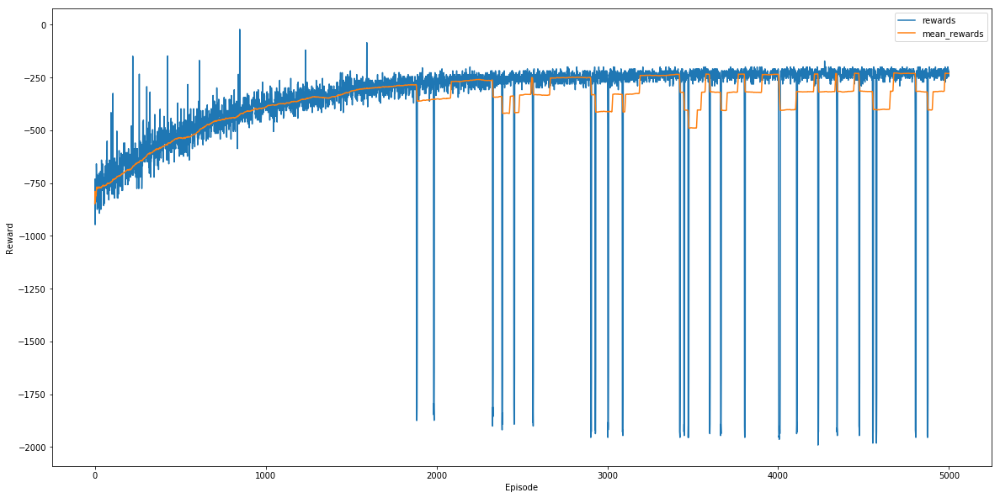

In [9]:
plt.rcParams['figure.figsize'] = (20, 10)
plot_rewards(episodes_rewards, 100)

In [7]:
# One-Hot Representation Dropout
agent = TaxiAgent(env,
                  name='one_hot_dropout',
                  obs_represent='one-hot',
                  exploration=exp_schedule,
                  optimizer='RMSprop',
                  use_dropout=True,
                  dropout_rate=0.4,
                  learning_rate=0.0003,
                  n_hidden=150,
                  steps_to_start_learn=100,
                  target_update_freq=1000)

Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2


In [8]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 1000
batch_size = 128 # 32
num_episodes = 100000

In [ ]:
with open('./taxi_agent_ckpt/one_hot_dropout_training.status', 'rb') as fp:
    training_status = pickle.load(fp)
    mean_episode_reward = training_status['mean_episode_reward']
    best_mean_episode_reward = training_status['best_mean_episode_reward']
    episode_durations = training_status['episode_durations'] 
    episodes_rewards = training_status['episodes_rewards']
    total_steps = training_status['total_steps']

In [9]:
# One-Hot Representation Dropout
episode_durations = []
episodes_rewards = []
total_steps = 0
start_time = time.time()
for episode in range(num_episodes):
    episode_start_time = time.time()
    last_obs = env.reset()
    episode_reward = 0
    agent.episodes_seen += 1
    for t in count():
        agent.steps_count += 1
        total_steps += 1
        ### Step the env and store the transition
        # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
        last_idx = agent.replay_buffer.store_frame(agent.one_hot_generator.to_one_hot(last_obs))
        # encode_recent_observation will take the latest observation
        # that you pushed into the buffer and compute the corresponding
        # input that should be given to a Q network by appending some
        # previous frames.
        recent_observation = agent.replay_buffer.encode_recent_observation()
        # Choose random action if not yet start learning
        action = agent.select_greedy_action(recent_observation)
        obs, reward, done, _ = env.step(action)
        episode_reward += reward
        agent.replay_buffer.store_effect(last_idx, action, reward, done)
        ### Perform experience replay and train the network.
        # Note that this is only done if the replay buffer contains enough samples
        # for us to learn something useful -- until then, the model will not be
        # initialized and random actions should be taken
        agent.learn(batch_size)
        ### Log progress and keep track of statistics
        if len(episodes_rewards) > 0:
            mean_episode_reward = np.mean(episodes_rewards[-100:])
        if len(episodes_rewards) > 100:
            best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)
        if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agent.steps_to_start_learn:
            print("Timestep %d" % (agent.steps_count,))
            print("mean reward (100 episodes) %f" % mean_episode_reward)
            print("best mean reward %f" % best_mean_episode_reward)
            print("episodes %d" % len(episodes_rewards))
            print("exploration value %f" % agent.epsilon)
            total_time = time.time() - start_time
            print("time since start: %.2f secs" % total_time)
            training_status = {}
            training_status['mean_episode_reward'] = mean_episode_reward
            training_status['best_mean_episode_reward'] = best_mean_episode_reward
            training_status['episode_durations'] = episode_durations
            training_status['episodes_rewards'] = episodes_rewards
            training_status['total_steps'] = total_steps
            with open('./taxi_agent_ckpt/one_hot_l1_reg_training.status', 'wb') as fp:
                pickle.dump(training_status, fp)
            print("Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status")
        # Resets the environment when reaching an episode boundary.
        if done:
            episode_durations.append(t + 1)
            episodes_rewards.append(episode_reward)
            print("Episode: ", agent.episodes_seen,
                  " Done, Reward: ", episode_reward,
                  " Step: ", agent.steps_count,
                 " Episode Time: %.2f secs" % (time.time() - episode_start_time))
            break
        last_obs = obs
print("Training Complete!")

Episode:  1  Done, Reward:  -821  Step:  200  Episode Time: 0.48 secs
Episode:  2  Done, Reward:  -803  Step:  400  Episode Time: 1.24 secs
Episode:  3  Done, Reward:  -848  Step:  600  Episode Time: 0.91 secs
Episode:  4  Done, Reward:  -848  Step:  800  Episode Time: 0.77 secs
Timestep 1000
mean reward (100 episodes) -830.000000
best mean reward -inf
episodes 4
exploration value 0.988199
time since start: 4.49 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  5  Done, Reward:  -866  Step:  1000  Episode Time: 1.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  6  Done, Reward:  -695  Step:  1200  Episode Time: 2.05 secs
Episode:  7  Done, Reward:  -794  Step:  1400  Episode Time: 0.82 secs
Episode:  8  Done, Reward:  -749  Step:  1600  Episode Time: 0.82 secs
Episode:  9  Done, Reward:  -695  Step:  1800  Episode Time: 0.92 secs
Episode:  10  Done, Reward:  -315  Step:  1893  Episode Time: 0.55 sec

Episode:  66  Done, Reward:  -623  Step:  12916  Episode Time: 0.90 secs
Timestep 13000
mean reward (100 episodes) -721.787879
best mean reward -inf
episodes 66
exploration value 0.853488
time since start: 70.60 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  67  Done, Reward:  -623  Step:  13116  Episode Time: 1.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  68  Done, Reward:  -740  Step:  13316  Episode Time: 0.80 secs
Episode:  69  Done, Reward:  -848  Step:  13516  Episode Time: 0.99 secs
Episode:  70  Done, Reward:  -668  Step:  13716  Episode Time: 0.97 secs
Episode:  71  Done, Reward:  -686  Step:  13916  Episode Time: 1.04 secs
Timestep 14000
mean reward (100 episodes) -721.169014
best mean reward -inf
episodes 71
exploration value 0.843507
time since start: 75.35 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  72  Done, Reward:  -731  Step:  1411

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  129  Done, Reward:  -587  Step:  25266  Episode Time: 0.84 secs
Episode:  130  Done, Reward:  -578  Step:  25466  Episode Time: 0.78 secs
Episode:  131  Done, Reward:  -632  Step:  25666  Episode Time: 0.68 secs
Episode:  132  Done, Reward:  -542  Step:  25866  Episode Time: 0.48 secs
Timestep 26000
mean reward (100 episodes) -665.370000
best mean reward -665.370000
episodes 132
exploration value 0.731272
time since start: 139.78 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  133  Done, Reward:  -587  Step:  26066  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  134  Done, Reward:  -605  Step:  26266  Episode Time: 0.63 secs
Episode:  135  Done, Reward:  -560  Step:  26466  Episode Time: 1.26 secs
Episode:  136  Done, Reward:  -659  Step:  26666  Episode Time: 0.97 secs
Episode:  137  Done, 

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  191  Done, Reward:  -596  Step:  37220  Episode Time: 1.04 secs
Episode:  192  Done, Reward:  -587  Step:  37420  Episode Time: 0.92 secs
Episode:  193  Done, Reward:  -578  Step:  37620  Episode Time: 0.80 secs
Episode:  194  Done, Reward:  -272  Step:  37733  Episode Time: 0.33 secs
Episode:  195  Done, Reward:  -542  Step:  37933  Episode Time: 0.84 secs
Timestep 38000
mean reward (100 episodes) -573.410000
best mean reward -573.410000
episodes 195
exploration value 0.631995
time since start: 197.13 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  196  Done, Reward:  -659  Step:  38133  Episode Time: 1.31 secs
Episode:  197  Done, Reward:  -533  Step:  38333  Episode Time: 1.06 secs
Episode:  198  Done, Reward:  -267  Step:  38432  Episode Time: 0.68 secs
Episode:  199  Done, 

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  254  Done, Reward:  -596  Step:  49173  Episode Time: 1.17 secs
Episode:  255  Done, Reward:  -362  Step:  49373  Episode Time: 0.92 secs
Episode:  256  Done, Reward:  -488  Step:  49573  Episode Time: 1.03 secs
Episode:  257  Done, Reward:  -425  Step:  49773  Episode Time: 0.65 secs
Episode:  258  Done, Reward:  -569  Step:  49973  Episode Time: 1.02 secs
Timestep 50000
mean reward (100 episodes) -502.690000
best mean reward -502.420000
episodes 258
exploration value 0.547185
time since start: 253.78 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  259  Done, Reward:  -310  Step:  50133  Episode Time: 0.74 secs
Episode:  260  Done, Reward:  -443  Step:  50333  Episode Time: 0.89 secs
Episode:  261  Done, Reward:  -506  Step:  50533  Episode Time: 1.02 secs
Episode:  262  Done, 

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  315  Done, Reward:  -380  Step:  61245  Episode Time: 1.04 secs
Episode:  316  Done, Reward:  -470  Step:  61445  Episode Time: 0.66 secs
Episode:  317  Done, Reward:  -425  Step:  61645  Episode Time: 0.64 secs
Episode:  318  Done, Reward:  -398  Step:  61845  Episode Time: 0.73 secs
Timestep 62000
mean reward (100 episodes) -467.760000
best mean reward -467.760000
episodes 318
exploration value 0.477931
time since start: 315.22 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  319  Done, Reward:  -434  Step:  62045  Episode Time: 1.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  320  Done, Reward:  -398  Step:  62245  Episode Time: 1.91 secs
Episode:  321  Done, Reward:  -142  Step:  62336  Episode Time: 0.44 secs
Episode:  322  Done, Reward:  -506  Step:  62536  Episode Time: 2.67 secs
Episode:  323  Done, 

Episode:  380  Done, Reward:  -461  Step:  72683  Episode Time: 0.81 secs
Episode:  381  Done, Reward:  -443  Step:  72883  Episode Time: 1.43 secs
Timestep 73000
mean reward (100 episodes) -410.450000
best mean reward -410.450000
episodes 381
exploration value 0.415572
time since start: 371.60 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  382  Done, Reward:  -371  Step:  73083  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  383  Done, Reward:  -470  Step:  73283  Episode Time: 0.70 secs
Episode:  384  Done, Reward:  -371  Step:  73483  Episode Time: 0.52 secs
Episode:  385  Done, Reward:  -353  Step:  73683  Episode Time: 0.51 secs
Episode:  386  Done, Reward:  -443  Step:  73883  Episode Time: 0.61 secs
Episode:  387  Done, Reward:  -83  Step:  73924  Episode Time: 0.19 secs
Timestep 74000
mean reward (100 episodes) -402.530000
best mean reward -402.530000
episodes 387
explor

Episode:  446  Done, Reward:  -54  Step:  83335  Episode Time: 0.37 secs
Episode:  447  Done, Reward:  -371  Step:  83535  Episode Time: 0.88 secs
Episode:  448  Done, Reward:  -416  Step:  83735  Episode Time: 0.57 secs
Episode:  449  Done, Reward:  -110  Step:  83803  Episode Time: 0.63 secs
Timestep 84000
mean reward (100 episodes) -325.960000
best mean reward -325.960000
episodes 449
exploration value 0.358420
time since start: 426.39 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  450  Done, Reward:  -425  Step:  84003  Episode Time: 1.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  451  Done, Reward:  -398  Step:  84203  Episode Time: 0.51 secs
Episode:  452  Done, Reward:  -371  Step:  84403  Episode Time: 0.50 secs
Episode:  453  Done, Reward:  -326  Step:  84603  Episode Time: 1.45 secs
Episode:  454  Done, Reward:  -317  Step:  84803  Episode Time: 1.00 secs
Timestep 85000
mean reward (

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  513  Done, Reward:  -308  Step:  94186  Episode Time: 0.99 secs
Episode:  514  Done, Reward:  -371  Step:  94386  Episode Time: 0.54 secs
Episode:  515  Done, Reward:  -326  Step:  94586  Episode Time: 0.58 secs
Episode:  516  Done, Reward:  -326  Step:  94786  Episode Time: 0.54 secs
Episode:  517  Done, Reward:  -353  Step:  94986  Episode Time: 0.72 secs
Timestep 95000
mean reward (100 episodes) -295.470000
best mean reward -290.760000
episodes 517
exploration value 0.310203
time since start: 482.34 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  518  Done, Reward:  -362  Step:  95186  Episode Time: 0.92 secs
Episode:  519  Done, Reward:  -371  Step:  95386  Episode Time: 1.04 secs
Episode:  520  Done, Reward:  -353  Step:  95586  Episode Time: 2.74 secs
Episode:  521  Done, 

Timestep 105000
mean reward (100 episodes) -277.680000
best mean reward -273.390000
episodes 580
exploration value 0.272285
time since start: 542.30 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  581  Done, Reward:  -281  Step:  105176  Episode Time: 0.77 secs
Episode:  582  Done, Reward:  -42  Step:  105212  Episode Time: 0.10 secs
Episode:  583  Done, Reward:  -241  Step:  105375  Episode Time: 0.42 secs
Episode:  584  Done, Reward:  -326  Step:  105575  Episode Time: 0.51 secs
Episode:  585  Done, Reward:  -398  Step:  105775  Episode Time: 0.79 secs
Episode:  586  Done, Reward:  -371  Step:  105975  Episode Time: 0.70 secs
Timestep 106000
mean reward (100 episodes) -273.810000
best mean reward -273.360000
episodes 586
exploration value 0.268976
time since start: 545.33 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Saved Taxi Agen

Timestep 114000
mean reward (100 episodes) -213.290000
best mean reward -207.950000
episodes 653
exploration value 0.235205
time since start: 584.52 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  654  Done, Reward:  -263  Step:  114178  Episode Time: 0.84 secs
Episode:  655  Done, Reward:  -52  Step:  114233  Episode Time: 0.34 secs
Episode:  656  Done, Reward:  -299  Step:  114433  Episode Time: 0.51 secs
Episode:  657  Done, Reward:  14  Step:  114440  Episode Time: 0.02 secs
Episode:  658  Done, Reward:  -127  Step:  114534  Episode Time: 0.25 secs
Episode:  659  Done, Reward:  -8  Step:  114545  Episode Time: 0.03 secs
Episode:  660  Done, Reward:  4  Step:  114553  Episode Time: 0.02 secs
Episode:  661  Done, Reward:  -290  Step:  114753  Episode Time: 0.51 secs
Episode:  662  Done, Reward:  -317  Step:  114953  Episode Time: 0.91 secs
Episode:  663  Done, Rewa

Episode:  727  Done, Reward:  -229  Step:  122330  Episode Time: 1.27 secs
Episode:  728  Done, Reward:  -116  Step:  122422  Episode Time: 0.25 secs
Episode:  729  Done, Reward:  9  Step:  122434  Episode Time: 0.03 secs
Episode:  730  Done, Reward:  -290  Step:  122634  Episode Time: 0.99 secs
Episode:  731  Done, Reward:  4  Step:  122651  Episode Time: 0.11 secs
Episode:  732  Done, Reward:  -308  Step:  122851  Episode Time: 0.66 secs
Episode:  733  Done, Reward:  -32  Step:  122886  Episode Time: 0.09 secs
Episode:  734  Done, Reward:  6  Step:  122901  Episode Time: 0.04 secs
Episode:  735  Done, Reward:  3  Step:  122910  Episode Time: 0.02 secs
Timestep 123000
mean reward (100 episodes) -164.260000
best mean reward -163.270000
episodes 735
exploration value 0.200877
time since start: 634.64 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  736  Done, Reward:  -165  Step:  123033  Episode Time: 0.58 secs
Episode:  737  Done, Reward:  -72  

Episode:  814  Done, Reward:  -38  Step:  128404  Episode Time: 0.37 secs
Episode:  815  Done, Reward:  7  Step:  128418  Episode Time: 0.09 secs
Episode:  816  Done, Reward:  -5  Step:  128435  Episode Time: 0.09 secs
Episode:  817  Done, Reward:  -8  Step:  128455  Episode Time: 0.12 secs
Episode:  818  Done, Reward:  7  Step:  128469  Episode Time: 0.07 secs
Episode:  819  Done, Reward:  -10  Step:  128491  Episode Time: 0.11 secs
Episode:  820  Done, Reward:  -1  Step:  128504  Episode Time: 0.08 secs
Episode:  821  Done, Reward:  -8  Step:  128524  Episode Time: 0.10 secs
Episode:  822  Done, Reward:  -290  Step:  128724  Episode Time: 1.00 secs
Episode:  823  Done, Reward:  8  Step:  128737  Episode Time: 0.07 secs
Episode:  824  Done, Reward:  -41  Step:  128790  Episode Time: 0.59 secs
Episode:  825  Done, Reward:  -97  Step:  128881  Episode Time: 0.49 secs
Episode:  826  Done, Reward:  -121  Step:  128978  Episode Time: 1.16 secs
Timestep 129000
mean reward (100 episodes) -82

Episode:  905  Done, Reward:  -3  Step:  133231  Episode Time: 0.20 secs
Episode:  906  Done, Reward:  -290  Step:  133431  Episode Time: 1.63 secs
Episode:  907  Done, Reward:  9  Step:  133443  Episode Time: 0.03 secs
Episode:  908  Done, Reward:  -13  Step:  133459  Episode Time: 0.04 secs
Episode:  909  Done, Reward:  10  Step:  133470  Episode Time: 0.03 secs
Episode:  910  Done, Reward:  8  Step:  133483  Episode Time: 0.04 secs
Episode:  911  Done, Reward:  -2  Step:  133497  Episode Time: 0.04 secs
Episode:  912  Done, Reward:  -127  Step:  133600  Episode Time: 0.28 secs
Episode:  913  Done, Reward:  -9  Step:  133621  Episode Time: 0.06 secs
Episode:  914  Done, Reward:  3  Step:  133639  Episode Time: 0.05 secs
Episode:  915  Done, Reward:  -2  Step:  133662  Episode Time: 0.06 secs
Episode:  916  Done, Reward:  -79  Step:  133735  Episode Time: 0.37 secs
Episode:  917  Done, Reward:  11  Step:  133745  Episode Time: 0.05 secs
Episode:  918  Done, Reward:  -281  Step:  13394

Episode:  998  Done, Reward:  -299  Step:  138950  Episode Time: 0.99 secs
Timestep 139000
mean reward (100 episodes) -70.720000
best mean reward -48.680000
episodes 998
exploration value 0.128176
time since start: 725.50 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  999  Done, Reward:  -57  Step:  139019  Episode Time: 0.61 secs
Episode:  1000  Done, Reward:  8  Step:  139032  Episode Time: 0.11 secs
Episode:  1001  Done, Reward:  12  Step:  139041  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  1002  Done, Reward:  -218  Step:  139241  Episode Time: 1.90 secs
Episode:  1003  Done, Reward:  8  Step:  139254  Episode Time: 0.06 secs
Episode:  1004  Done, Reward:  -3  Step:  139269  Episode Time: 0.06 secs
Episode:  1005  Done, Reward:  -5  Step:  139286  Episode Time: 0.05 secs
Episode:  1006  Done, Reward:  0  Step:  139307  Episode Time: 0.07 secs
Episode:  1007  Done, Reward

Episode:  1093  Done, Reward:  6  Step:  142406  Episode Time: 0.40 secs
Episode:  1094  Done, Reward:  -2  Step:  142420  Episode Time: 0.13 secs
Episode:  1095  Done, Reward:  1  Step:  142431  Episode Time: 0.12 secs
Episode:  1096  Done, Reward:  -4  Step:  142447  Episode Time: 0.19 secs
Episode:  1097  Done, Reward:  -299  Step:  142647  Episode Time: 2.09 secs
Episode:  1098  Done, Reward:  7  Step:  142661  Episode Time: 0.10 secs
Episode:  1099  Done, Reward:  -44  Step:  142726  Episode Time: 0.42 secs
Episode:  1100  Done, Reward:  11  Step:  142736  Episode Time: 0.05 secs
Episode:  1101  Done, Reward:  -263  Step:  142936  Episode Time: 1.40 secs
Episode:  1102  Done, Reward:  -4  Step:  142952  Episode Time: 0.12 secs
Episode:  1103  Done, Reward:  4  Step:  142969  Episode Time: 0.13 secs
Episode:  1104  Done, Reward:  1  Step:  142989  Episode Time: 0.19 secs
Timestep 143000
mean reward (100 episodes) -30.750000
best mean reward -30.140000
episodes 1104
exploration valu

Episode:  1190  Done, Reward:  -245  Step:  146122  Episode Time: 1.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  1191  Done, Reward:  -21  Step:  146146  Episode Time: 0.17 secs
Episode:  1192  Done, Reward:  -290  Step:  146346  Episode Time: 0.62 secs
Episode:  1193  Done, Reward:  10  Step:  146357  Episode Time: 0.03 secs
Episode:  1194  Done, Reward:  -245  Step:  146557  Episode Time: 0.58 secs
Episode:  1195  Done, Reward:  4  Step:  146574  Episode Time: 0.11 secs
Episode:  1196  Done, Reward:  -254  Step:  146774  Episode Time: 1.81 secs
Episode:  1197  Done, Reward:  0  Step:  146795  Episode Time: 0.06 secs
Episode:  1198  Done, Reward:  10  Step:  146806  Episode Time: 0.03 secs
Episode:  1199  Done, Reward:  -3  Step:  146821  Episode Time: 0.04 secs
Episode:  1200  Done, Reward:  10  Step:  146832  Episode Time: 0.03 secs
Episode:  1201  Done, Reward:  9  Step:  146844  Episode Time: 0.03 secs
Timestep 147000
mean rewar

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  1281  Done, Reward:  -236  Step:  151267  Episode Time: 1.99 secs
Episode:  1282  Done, Reward:  -4  Step:  151283  Episode Time: 0.24 secs
Episode:  1283  Done, Reward:  10  Step:  151294  Episode Time: 0.08 secs
Episode:  1284  Done, Reward:  4  Step:  151311  Episode Time: 0.07 secs
Episode:  1285  Done, Reward:  -13  Step:  151327  Episode Time: 0.05 secs
Episode:  1286  Done, Reward:  -1  Step:  151340  Episode Time: 0.06 secs
Episode:  1287  Done, Reward:  5  Step:  151356  Episode Time: 0.05 secs
Episode:  1288  Done, Reward:  -3  Step:  151371  Episode Time: 0.05 secs
Episode:  1289  Done, Reward:  -4  Step:  151387  Episode Time: 0.08 secs
Episode:  1290  Done, Reward:  8  Step:  151400  Episode Time: 0.11 secs
Episode:  1291  Done, Reward:  -15  Step:  151418  Episode Time: 0.21 secs
Episode:  1292  Done, Reward:  12  Step:  151427  Episode Time: 0.20 secs
Episode:  1293  Done, Reward:  

Timestep 155000
mean reward (100 episodes) -27.080000
best mean reward -23.540000
episodes 1381
exploration value 0.080008
time since start: 824.48 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  1382  Done, Reward:  -290  Step:  155045  Episode Time: 0.83 secs
Episode:  1383  Done, Reward:  3  Step:  155063  Episode Time: 0.06 secs
Episode:  1384  Done, Reward:  -4  Step:  155079  Episode Time: 0.11 secs
Episode:  1385  Done, Reward:  5  Step:  155095  Episode Time: 0.11 secs
Episode:  1386  Done, Reward:  7  Step:  155109  Episode Time: 0.16 secs
Episode:  1387  Done, Reward:  7  Step:  155123  Episode Time: 0.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  1388  Done, Reward:  8  Step:  155136  Episode Time: 0.19 secs
Episode:  1389  Done, Reward:  9  Step:  155148  Episode Time: 0.17 secs
Episode:  1390  Done, Reward:  11  Step:  155158  Episode Time: 0.13 secs
Episode:  1391  Done, Reward:  

Episode:  1481  Done, Reward:  8  Step:  157926  Episode Time: 0.08 secs
Episode:  1482  Done, Reward:  9  Step:  157938  Episode Time: 0.06 secs
Timestep 158000
mean reward (100 episodes) -15.970000
best mean reward -15.550000
episodes 1482
exploration value 0.073312
time since start: 840.84 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  1483  Done, Reward:  -227  Step:  158138  Episode Time: 1.21 secs
Episode:  1484  Done, Reward:  -5  Step:  158155  Episode Time: 0.05 secs
Episode:  1485  Done, Reward:  -3  Step:  158170  Episode Time: 0.05 secs
Episode:  1486  Done, Reward:  8  Step:  158183  Episode Time: 0.06 secs
Episode:  1487  Done, Reward:  7  Step:  158197  Episode Time: 0.13 secs
Episode:  1488  Done, Reward:  11  Step:  158207  Episode Time: 0.08 secs
Episode:  1489  Done, Reward:  5  Step:  158223  Episode Time: 0.12 secs
Episode:  1490  Done, Reward: 

Episode:  1577  Done, Reward:  -4  Step:  161082  Episode Time: 0.17 secs
Episode:  1578  Done, Reward:  13  Step:  161090  Episode Time: 0.05 secs
Episode:  1579  Done, Reward:  10  Step:  161101  Episode Time: 0.06 secs
Episode:  1580  Done, Reward:  7  Step:  161115  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  1581  Done, Reward:  8  Step:  161128  Episode Time: 0.10 secs
Episode:  1582  Done, Reward:  15  Step:  161134  Episode Time: 0.04 secs
Episode:  1583  Done, Reward:  -5  Step:  161151  Episode Time: 0.10 secs
Episode:  1584  Done, Reward:  8  Step:  161164  Episode Time: 0.09 secs
Episode:  1585  Done, Reward:  8  Step:  161177  Episode Time: 0.06 secs
Episode:  1586  Done, Reward:  -3  Step:  161192  Episode Time: 0.09 secs
Episode:  1587  Done, Reward:  2  Step:  161211  Episode Time: 0.12 secs
Episode:  1588  Done, Reward:  10  Step:  161222  Episode Time: 0.07 secs
Episode:  1589  Done, Reward:  5  Ste

Episode:  1677  Done, Reward:  7  Step:  164166  Episode Time: 0.09 secs
Episode:  1678  Done, Reward:  -2  Step:  164180  Episode Time: 0.09 secs
Episode:  1679  Done, Reward:  11  Step:  164190  Episode Time: 0.06 secs
Episode:  1680  Done, Reward:  11  Step:  164200  Episode Time: 0.08 secs
Episode:  1681  Done, Reward:  11  Step:  164210  Episode Time: 0.06 secs
Episode:  1682  Done, Reward:  9  Step:  164222  Episode Time: 0.07 secs
Episode:  1683  Done, Reward:  10  Step:  164233  Episode Time: 0.08 secs
Episode:  1684  Done, Reward:  9  Step:  164245  Episode Time: 0.07 secs
Episode:  1685  Done, Reward:  7  Step:  164259  Episode Time: 0.09 secs
Episode:  1686  Done, Reward:  4  Step:  164276  Episode Time: 0.29 secs
Episode:  1687  Done, Reward:  8  Step:  164289  Episode Time: 0.04 secs
Episode:  1688  Done, Reward:  1  Step:  164300  Episode Time: 0.04 secs
Episode:  1689  Done, Reward:  10  Step:  164311  Episode Time: 0.04 secs
Episode:  1690  Done, Reward:  7  Step:  1643

Episode:  1781  Done, Reward:  -6  Step:  166477  Episode Time: 0.13 secs
Episode:  1782  Done, Reward:  8  Step:  166490  Episode Time: 0.08 secs
Episode:  1783  Done, Reward:  8  Step:  166503  Episode Time: 0.08 secs
Episode:  1784  Done, Reward:  10  Step:  166514  Episode Time: 0.08 secs
Episode:  1785  Done, Reward:  9  Step:  166526  Episode Time: 0.08 secs
Episode:  1786  Done, Reward:  6  Step:  166541  Episode Time: 0.35 secs
Episode:  1787  Done, Reward:  11  Step:  166551  Episode Time: 0.13 secs
Episode:  1788  Done, Reward:  7  Step:  166565  Episode Time: 0.19 secs
Episode:  1789  Done, Reward:  10  Step:  166576  Episode Time: 0.14 secs
Episode:  1790  Done, Reward:  8  Step:  166589  Episode Time: 0.18 secs
Episode:  1791  Done, Reward:  9  Step:  166601  Episode Time: 0.16 secs
Episode:  1792  Done, Reward:  7  Step:  166615  Episode Time: 0.11 secs
Episode:  1793  Done, Reward:  -7  Step:  166625  Episode Time: 0.06 secs
Episode:  1794  Done, Reward:  5  Step:  16664

Episode:  1882  Done, Reward:  9  Step:  169187  Episode Time: 0.08 secs
Episode:  1883  Done, Reward:  -62  Step:  169243  Episode Time: 0.34 secs
Episode:  1884  Done, Reward:  14  Step:  169250  Episode Time: 0.04 secs
Episode:  1885  Done, Reward:  6  Step:  169265  Episode Time: 0.09 secs
Episode:  1886  Done, Reward:  4  Step:  169282  Episode Time: 0.11 secs
Episode:  1887  Done, Reward:  -30  Step:  169333  Episode Time: 0.29 secs
Episode:  1888  Done, Reward:  9  Step:  169345  Episode Time: 0.07 secs
Episode:  1889  Done, Reward:  8  Step:  169358  Episode Time: 0.08 secs
Episode:  1890  Done, Reward:  -6  Step:  169376  Episode Time: 0.11 secs
Episode:  1891  Done, Reward:  -5  Step:  169393  Episode Time: 0.29 secs
Episode:  1892  Done, Reward:  8  Step:  169406  Episode Time: 0.07 secs
Episode:  1893  Done, Reward:  -2  Step:  169420  Episode Time: 0.08 secs
Episode:  1894  Done, Reward:  12  Step:  169429  Episode Time: 0.06 secs
Episode:  1895  Done, Reward:  9  Step:  1

Episode:  1985  Done, Reward:  12  Step:  171677  Episode Time: 0.13 secs
Episode:  1986  Done, Reward:  -28  Step:  171699  Episode Time: 0.19 secs
Episode:  1987  Done, Reward:  -3  Step:  171714  Episode Time: 0.07 secs
Episode:  1988  Done, Reward:  7  Step:  171728  Episode Time: 0.05 secs
Episode:  1989  Done, Reward:  9  Step:  171740  Episode Time: 0.05 secs
Episode:  1990  Done, Reward:  -209  Step:  171940  Episode Time: 0.79 secs
Episode:  1991  Done, Reward:  11  Step:  171950  Episode Time: 0.04 secs
Episode:  1992  Done, Reward:  10  Step:  171961  Episode Time: 0.04 secs
Episode:  1993  Done, Reward:  10  Step:  171972  Episode Time: 0.04 secs
Episode:  1994  Done, Reward:  -7  Step:  171991  Episode Time: 0.07 secs
Timestep 172000
mean reward (100 episodes) -9.600000
best mean reward -2.620000
episodes 1994
exploration value 0.056482
time since start: 936.44 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  1995  Done, Reward:  6  

Episode:  2082  Done, Reward:  6  Step:  175814  Episode Time: 0.07 secs
Episode:  2083  Done, Reward:  9  Step:  175826  Episode Time: 0.07 secs
Episode:  2084  Done, Reward:  9  Step:  175838  Episode Time: 0.10 secs
Episode:  2085  Done, Reward:  10  Step:  175849  Episode Time: 0.07 secs
Episode:  2086  Done, Reward:  5  Step:  175865  Episode Time: 0.06 secs
Episode:  2087  Done, Reward:  3  Step:  175874  Episode Time: 0.03 secs
Episode:  2088  Done, Reward:  11  Step:  175884  Episode Time: 0.04 secs
Episode:  2089  Done, Reward:  2  Step:  175903  Episode Time: 0.08 secs
Episode:  2090  Done, Reward:  7  Step:  175917  Episode Time: 0.06 secs
Episode:  2091  Done, Reward:  9  Step:  175929  Episode Time: 0.04 secs
Episode:  2092  Done, Reward:  -2  Step:  175943  Episode Time: 0.05 secs
Episode:  2093  Done, Reward:  -6  Step:  175970  Episode Time: 0.12 secs
Episode:  2094  Done, Reward:  9  Step:  175982  Episode Time: 0.04 secs
Episode:  2095  Done, Reward:  14  Step:  17598

Episode:  2182  Done, Reward:  6  Step:  178566  Episode Time: 0.10 secs
Episode:  2183  Done, Reward:  5  Step:  178582  Episode Time: 0.06 secs
Episode:  2184  Done, Reward:  -2  Step:  178596  Episode Time: 0.05 secs
Episode:  2185  Done, Reward:  7  Step:  178610  Episode Time: 0.08 secs
Episode:  2186  Done, Reward:  -3  Step:  178625  Episode Time: 0.18 secs
Episode:  2187  Done, Reward:  10  Step:  178636  Episode Time: 0.11 secs
Episode:  2188  Done, Reward:  -1  Step:  178649  Episode Time: 0.08 secs
Episode:  2189  Done, Reward:  11  Step:  178659  Episode Time: 0.06 secs
Episode:  2190  Done, Reward:  9  Step:  178671  Episode Time: 0.08 secs
Episode:  2191  Done, Reward:  8  Step:  178684  Episode Time: 0.10 secs
Episode:  2192  Done, Reward:  9  Step:  178696  Episode Time: 0.08 secs
Episode:  2193  Done, Reward:  7  Step:  178710  Episode Time: 0.08 secs
Episode:  2194  Done, Reward:  -6  Step:  178728  Episode Time: 0.24 secs
Episode:  2195  Done, Reward:  5  Step:  1787

Episode:  2278  Done, Reward:  -236  Step:  182529  Episode Time: 1.95 secs
Episode:  2279  Done, Reward:  9  Step:  182541  Episode Time: 0.05 secs
Episode:  2280  Done, Reward:  12  Step:  182550  Episode Time: 0.04 secs
Episode:  2281  Done, Reward:  -130  Step:  182674  Episode Time: 0.64 secs
Episode:  2282  Done, Reward:  4  Step:  182691  Episode Time: 0.06 secs
Episode:  2283  Done, Reward:  -227  Step:  182891  Episode Time: 1.48 secs
Episode:  2284  Done, Reward:  10  Step:  182902  Episode Time: 0.18 secs
Timestep 183000
mean reward (100 episodes) -31.540000
best mean reward -2.620000
episodes 2284
exploration value 0.053139
time since start: 1019.11 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  2285  Done, Reward:  -227  Step:  183102  Episode Time: 3.09 secs
Episode:  2286  Done, Reward:  -5  Step:  183119  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  2287  Done,

Episode:  2375  Done, Reward:  -1  Step:  186199  Episode Time: 0.08 secs
Episode:  2376  Done, Reward:  0  Step:  186211  Episode Time: 0.09 secs
Episode:  2377  Done, Reward:  -263  Step:  186411  Episode Time: 1.39 secs
Episode:  2378  Done, Reward:  9  Step:  186423  Episode Time: 0.29 secs
Episode:  2379  Done, Reward:  2  Step:  186442  Episode Time: 0.14 secs
Episode:  2380  Done, Reward:  10  Step:  186453  Episode Time: 0.10 secs
Episode:  2381  Done, Reward:  7  Step:  186467  Episode Time: 0.10 secs
Episode:  2382  Done, Reward:  15  Step:  186473  Episode Time: 0.04 secs
Episode:  2383  Done, Reward:  1  Step:  186484  Episode Time: 0.10 secs
Episode:  2384  Done, Reward:  8  Step:  186497  Episode Time: 0.10 secs
Episode:  2385  Done, Reward:  8  Step:  186510  Episode Time: 0.09 secs
Episode:  2386  Done, Reward:  7  Step:  186524  Episode Time: 0.12 secs
Episode:  2387  Done, Reward:  6  Step:  186539  Episode Time: 0.11 secs
Episode:  2388  Done, Reward:  9  Step:  1865

Episode:  2476  Done, Reward:  -119  Step:  189037  Episode Time: 0.92 secs
Episode:  2477  Done, Reward:  8  Step:  189050  Episode Time: 0.08 secs
Episode:  2478  Done, Reward:  9  Step:  189062  Episode Time: 0.07 secs
Episode:  2479  Done, Reward:  9  Step:  189074  Episode Time: 0.13 secs
Episode:  2480  Done, Reward:  1  Step:  189085  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  2481  Done, Reward:  -227  Step:  189285  Episode Time: 1.92 secs
Episode:  2482  Done, Reward:  11  Step:  189295  Episode Time: 0.08 secs
Episode:  2483  Done, Reward:  -236  Step:  189495  Episode Time: 2.41 secs
Episode:  2484  Done, Reward:  2  Step:  189505  Episode Time: 0.32 secs
Episode:  2485  Done, Reward:  -218  Step:  189705  Episode Time: 1.58 secs
Episode:  2486  Done, Reward:  -13  Step:  189721  Episode Time: 0.12 secs
Episode:  2487  Done, Reward:  7  Step:  189735  Episode Time: 0.12 secs
Episode:  2488  Done, Reward:

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  2575  Done, Reward:  -263  Step:  192254  Episode Time: 1.55 secs
Episode:  2576  Done, Reward:  11  Step:  192264  Episode Time: 0.07 secs
Episode:  2577  Done, Reward:  8  Step:  192277  Episode Time: 0.16 secs
Episode:  2578  Done, Reward:  9  Step:  192289  Episode Time: 0.13 secs
Episode:  2579  Done, Reward:  7  Step:  192303  Episode Time: 0.21 secs
Episode:  2580  Done, Reward:  5  Step:  192319  Episode Time: 0.22 secs
Episode:  2581  Done, Reward:  8  Step:  192332  Episode Time: 0.17 secs
Episode:  2582  Done, Reward:  7  Step:  192346  Episode Time: 0.38 secs
Episode:  2583  Done, Reward:  12  Step:  192355  Episode Time: 0.09 secs
Episode:  2584  Done, Reward:  7  Step:  192369  Episode Time: 0.19 secs
Episode:  2585  Done, Reward:  8  Step:  192382  Episode Time: 0.17 secs
Episode:  2586  Done, Reward:  6  Step:  192397  Episode Time: 0.20 secs
Episode:  2587  Done, Reward:  0  Step:

Episode:  2684  Done, Reward:  7  Step:  193952  Episode Time: 0.12 secs
Episode:  2685  Done, Reward:  -3  Step:  193967  Episode Time: 0.11 secs
Episode:  2686  Done, Reward:  3  Step:  193985  Episode Time: 0.15 secs
Episode:  2687  Done, Reward:  8  Step:  193998  Episode Time: 0.16 secs
Timestep 194000
mean reward (100 episodes) 3.010000
best mean reward 3.150000
episodes 2687
exploration value 0.051146
time since start: 1110.91 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  2688  Done, Reward:  10  Step:  194009  Episode Time: 0.36 secs
Episode:  2689  Done, Reward:  -2  Step:  194023  Episode Time: 0.15 secs
Episode:  2690  Done, Reward:  9  Step:  194035  Episode Time: 0.11 secs
Episode:  2691  Done, Reward:  8  Step:  194048  Episode Time: 0.14 secs
Episode:  2692  Done, Reward:  3  Step:  194066  Episode Time: 0.17 secs
Episode:  2693  Done, Reward:  12  Step:  194075  Episode Time: 0.10 secs
Episode:  2694  Done, Reward:  9  Step:  1

Episode:  2790  Done, Reward:  5  Step:  195645  Episode Time: 0.12 secs
Episode:  2791  Done, Reward:  -3  Step:  195660  Episode Time: 0.09 secs
Episode:  2792  Done, Reward:  10  Step:  195671  Episode Time: 0.07 secs
Episode:  2793  Done, Reward:  14  Step:  195678  Episode Time: 0.05 secs
Episode:  2794  Done, Reward:  11  Step:  195688  Episode Time: 0.06 secs
Episode:  2795  Done, Reward:  10  Step:  195699  Episode Time: 0.07 secs
Episode:  2796  Done, Reward:  9  Step:  195711  Episode Time: 0.09 secs
Episode:  2797  Done, Reward:  10  Step:  195722  Episode Time: 0.07 secs
Episode:  2798  Done, Reward:  6  Step:  195737  Episode Time: 0.09 secs
Episode:  2799  Done, Reward:  13  Step:  195745  Episode Time: 0.06 secs
Episode:  2800  Done, Reward:  1  Step:  195765  Episode Time: 0.30 secs
Episode:  2801  Done, Reward:  -6  Step:  195783  Episode Time: 0.11 secs
Episode:  2802  Done, Reward:  -3  Step:  195798  Episode Time: 0.11 secs
Episode:  2803  Done, Reward:  12  Step:  

Episode:  2898  Done, Reward:  -4  Step:  197053  Episode Time: 0.08 secs
Episode:  2899  Done, Reward:  10  Step:  197064  Episode Time: 0.04 secs
Episode:  2900  Done, Reward:  3  Step:  197082  Episode Time: 0.08 secs
Episode:  2901  Done, Reward:  6  Step:  197097  Episode Time: 0.06 secs
Episode:  2902  Done, Reward:  12  Step:  197106  Episode Time: 0.05 secs
Episode:  2903  Done, Reward:  9  Step:  197118  Episode Time: 0.05 secs
Episode:  2904  Done, Reward:  12  Step:  197127  Episode Time: 0.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  2905  Done, Reward:  6  Step:  197142  Episode Time: 0.06 secs
Episode:  2906  Done, Reward:  9  Step:  197154  Episode Time: 0.05 secs
Episode:  2907  Done, Reward:  6  Step:  197169  Episode Time: 0.32 secs
Episode:  2908  Done, Reward:  0  Step:  197190  Episode Time: 0.09 secs
Episode:  2909  Done, Reward:  -218  Step:  197390  Episode Time: 0.85 secs
Episode:  2910  Done, Reward:  10  St

Episode:  2996  Done, Reward:  -11  Step:  200995  Episode Time: 0.23 secs
Timestep 201000
mean reward (100 episodes) -27.550000
best mean reward 7.010000
episodes 2996
exploration value 0.050529
time since start: 1167.86 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  2997  Done, Reward:  4  Step:  201012  Episode Time: 0.14 secs
Episode:  2998  Done, Reward:  -36  Step:  201060  Episode Time: 0.39 secs
Episode:  2999  Done, Reward:  9  Step:  201072  Episode Time: 0.08 secs
Episode:  3000  Done, Reward:  9  Step:  201084  Episode Time: 0.08 secs
Episode:  3001  Done, Reward:  4  Step:  201101  Episode Time: 0.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  3002  Done, Reward:  -10  Step:  201132  Episode Time: 0.38 secs
Episode:  3003  Done, Reward:  5  Step:  201148  Episode Time: 0.12 secs
Episode:  3004  Done, Reward:  11  Step:  201158  Episode Time: 0.17 secs
Episode:  3005  Done, Reward: 

Episode:  3100  Done, Reward:  -82  Step:  202917  Episode Time: 0.74 secs
Episode:  3101  Done, Reward:  6  Step:  202932  Episode Time: 0.09 secs
Episode:  3102  Done, Reward:  6  Step:  202947  Episode Time: 0.09 secs
Episode:  3103  Done, Reward:  7  Step:  202961  Episode Time: 0.12 secs
Episode:  3104  Done, Reward:  7  Step:  202975  Episode Time: 0.26 secs
Episode:  3105  Done, Reward:  7  Step:  202989  Episode Time: 0.14 secs
Timestep 203000
mean reward (100 episodes) 0.640000
best mean reward 7.010000
episodes 3105
exploration value 0.050403
time since start: 1184.37 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  3106  Done, Reward:  -49  Step:  203050  Episode Time: 0.49 secs
Episode:  3107  Done, Reward:  7  Step:  203064  Episode Time: 0.19 secs
Episode:  3108  Done, Reward:  7  Step:  203078  Episode Time: 0.10 secs
Episode:  3109  Done, Reward:  5  Step:  203094  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agen

Episode:  3196  Done, Reward:  5  Step:  206503  Episode Time: 0.09 secs
Episode:  3197  Done, Reward:  -245  Step:  206703  Episode Time: 1.01 secs
Episode:  3198  Done, Reward:  10  Step:  206714  Episode Time: 0.04 secs
Episode:  3199  Done, Reward:  2  Step:  206724  Episode Time: 0.04 secs
Episode:  3200  Done, Reward:  8  Step:  206737  Episode Time: 0.05 secs
Episode:  3201  Done, Reward:  8  Step:  206750  Episode Time: 0.05 secs
Episode:  3202  Done, Reward:  3  Step:  206759  Episode Time: 0.05 secs
Episode:  3203  Done, Reward:  5  Step:  206775  Episode Time: 0.07 secs
Episode:  3204  Done, Reward:  -47  Step:  206843  Episode Time: 0.41 secs
Episode:  3205  Done, Reward:  11  Step:  206853  Episode Time: 0.06 secs
Episode:  3206  Done, Reward:  -11  Step:  206867  Episode Time: 0.09 secs
Episode:  3207  Done, Reward:  -3  Step:  206882  Episode Time: 0.11 secs
Episode:  3208  Done, Reward:  7  Step:  206896  Episode Time: 0.09 secs
Episode:  3209  Done, Reward:  6  Step:  

Episode:  3302  Done, Reward:  6  Step:  208521  Episode Time: 0.15 secs
Episode:  3303  Done, Reward:  6  Step:  208536  Episode Time: 0.15 secs
Episode:  3304  Done, Reward:  9  Step:  208548  Episode Time: 0.13 secs
Episode:  3305  Done, Reward:  5  Step:  208564  Episode Time: 0.15 secs
Episode:  3306  Done, Reward:  12  Step:  208573  Episode Time: 0.09 secs
Episode:  3307  Done, Reward:  11  Step:  208583  Episode Time: 0.11 secs
Episode:  3308  Done, Reward:  13  Step:  208591  Episode Time: 0.06 secs
Episode:  3309  Done, Reward:  8  Step:  208604  Episode Time: 0.08 secs
Episode:  3310  Done, Reward:  6  Step:  208619  Episode Time: 0.09 secs
Episode:  3311  Done, Reward:  10  Step:  208630  Episode Time: 0.07 secs
Episode:  3312  Done, Reward:  6  Step:  208645  Episode Time: 0.28 secs
Episode:  3313  Done, Reward:  6  Step:  208660  Episode Time: 0.06 secs
Episode:  3314  Done, Reward:  9  Step:  208672  Episode Time: 0.05 secs
Episode:  3315  Done, Reward:  -4  Step:  20868

Episode:  3410  Done, Reward:  5  Step:  210015  Episode Time: 0.17 secs
Episode:  3411  Done, Reward:  7  Step:  210029  Episode Time: 0.13 secs
Episode:  3412  Done, Reward:  9  Step:  210041  Episode Time: 0.13 secs
Episode:  3413  Done, Reward:  13  Step:  210049  Episode Time: 0.08 secs
Episode:  3414  Done, Reward:  6  Step:  210064  Episode Time: 0.17 secs
Episode:  3415  Done, Reward:  14  Step:  210071  Episode Time: 0.05 secs
Episode:  3416  Done, Reward:  -4  Step:  210087  Episode Time: 0.07 secs
Episode:  3417  Done, Reward:  15  Step:  210093  Episode Time: 0.02 secs
Episode:  3418  Done, Reward:  11  Step:  210103  Episode Time: 0.04 secs
Episode:  3419  Done, Reward:  5  Step:  210119  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  3420  Done, Reward:  -2  Step:  210133  Episode Time: 0.06 secs
Episode:  3421  Done, Reward:  3  Step:  210142  Episode Time: 0.04 secs
Episode:  3422  Done, Reward:  -13  St

Episode:  3515  Done, Reward:  9  Step:  212248  Episode Time: 0.06 secs
Episode:  3516  Done, Reward:  -9  Step:  212269  Episode Time: 0.08 secs
Episode:  3517  Done, Reward:  8  Step:  212282  Episode Time: 0.05 secs
Episode:  3518  Done, Reward:  5  Step:  212298  Episode Time: 0.06 secs
Episode:  3519  Done, Reward:  8  Step:  212311  Episode Time: 0.13 secs
Episode:  3520  Done, Reward:  7  Step:  212325  Episode Time: 0.16 secs
Episode:  3521  Done, Reward:  13  Step:  212333  Episode Time: 0.07 secs
Episode:  3522  Done, Reward:  7  Step:  212347  Episode Time: 0.09 secs
Episode:  3523  Done, Reward:  10  Step:  212358  Episode Time: 0.07 secs
Episode:  3524  Done, Reward:  7  Step:  212372  Episode Time: 0.10 secs
Episode:  3525  Done, Reward:  4  Step:  212380  Episode Time: 0.07 secs
Episode:  3526  Done, Reward:  8  Step:  212393  Episode Time: 0.20 secs
Episode:  3527  Done, Reward:  -4  Step:  212409  Episode Time: 0.30 secs
Episode:  3528  Done, Reward:  2  Step:  212419

Episode:  3624  Done, Reward:  8  Step:  213801  Episode Time: 0.31 secs
Episode:  3625  Done, Reward:  -6  Step:  213819  Episode Time: 0.20 secs
Episode:  3626  Done, Reward:  11  Step:  213829  Episode Time: 0.10 secs
Episode:  3627  Done, Reward:  6  Step:  213844  Episode Time: 0.10 secs
Episode:  3628  Done, Reward:  11  Step:  213854  Episode Time: 0.16 secs
Episode:  3629  Done, Reward:  9  Step:  213866  Episode Time: 0.13 secs
Episode:  3630  Done, Reward:  14  Step:  213873  Episode Time: 0.06 secs
Episode:  3631  Done, Reward:  4  Step:  213890  Episode Time: 0.14 secs
Episode:  3632  Done, Reward:  11  Step:  213900  Episode Time: 0.07 secs
Episode:  3633  Done, Reward:  -4  Step:  213916  Episode Time: 0.18 secs
Episode:  3634  Done, Reward:  10  Step:  213927  Episode Time: 0.13 secs
Episode:  3635  Done, Reward:  11  Step:  213937  Episode Time: 0.14 secs
Episode:  3636  Done, Reward:  6  Step:  213952  Episode Time: 0.13 secs
Episode:  3637  Done, Reward:  9  Step:  21

Episode:  3730  Done, Reward:  10  Step:  215169  Episode Time: 0.09 secs
Episode:  3731  Done, Reward:  -4  Step:  215185  Episode Time: 0.10 secs
Episode:  3732  Done, Reward:  7  Step:  215199  Episode Time: 0.09 secs
Episode:  3733  Done, Reward:  8  Step:  215212  Episode Time: 0.10 secs
Episode:  3734  Done, Reward:  -3  Step:  215227  Episode Time: 0.18 secs
Episode:  3735  Done, Reward:  11  Step:  215237  Episode Time: 0.14 secs
Episode:  3736  Done, Reward:  12  Step:  215246  Episode Time: 0.04 secs
Episode:  3737  Done, Reward:  -2  Step:  215260  Episode Time: 0.06 secs
Episode:  3738  Done, Reward:  2  Step:  215270  Episode Time: 0.04 secs
Episode:  3739  Done, Reward:  -2  Step:  215284  Episode Time: 0.07 secs
Episode:  3740  Done, Reward:  -4  Step:  215300  Episode Time: 0.26 secs
Episode:  3741  Done, Reward:  -4  Step:  215316  Episode Time: 0.16 secs
Episode:  3742  Done, Reward:  7  Step:  215330  Episode Time: 0.07 secs
Episode:  3743  Done, Reward:  10  Step:  

Episode:  3838  Done, Reward:  12  Step:  216630  Episode Time: 0.04 secs
Episode:  3839  Done, Reward:  9  Step:  216642  Episode Time: 0.14 secs
Episode:  3840  Done, Reward:  9  Step:  216654  Episode Time: 0.41 secs
Episode:  3841  Done, Reward:  10  Step:  216665  Episode Time: 0.25 secs
Episode:  3842  Done, Reward:  10  Step:  216676  Episode Time: 0.17 secs
Episode:  3843  Done, Reward:  11  Step:  216686  Episode Time: 0.15 secs
Episode:  3844  Done, Reward:  8  Step:  216699  Episode Time: 0.19 secs
Episode:  3845  Done, Reward:  11  Step:  216709  Episode Time: 0.15 secs
Episode:  3846  Done, Reward:  10  Step:  216720  Episode Time: 0.12 secs
Episode:  3847  Done, Reward:  -15  Step:  216738  Episode Time: 0.13 secs
Episode:  3848  Done, Reward:  -77  Step:  216800  Episode Time: 0.31 secs
Episode:  3849  Done, Reward:  -1  Step:  216813  Episode Time: 0.16 secs
Episode:  3850  Done, Reward:  11  Step:  216823  Episode Time: 0.09 secs
Timestep 217000
mean reward (100 episod

Episode:  3943  Done, Reward:  7  Step:  218471  Episode Time: 0.33 secs
Episode:  3944  Done, Reward:  7  Step:  218485  Episode Time: 0.11 secs
Episode:  3945  Done, Reward:  8  Step:  218498  Episode Time: 0.08 secs
Episode:  3946  Done, Reward:  -1  Step:  218511  Episode Time: 0.20 secs
Episode:  3947  Done, Reward:  12  Step:  218520  Episode Time: 0.10 secs
Episode:  3948  Done, Reward:  12  Step:  218529  Episode Time: 0.07 secs
Episode:  3949  Done, Reward:  7  Step:  218543  Episode Time: 0.40 secs
Episode:  3950  Done, Reward:  6  Step:  218558  Episode Time: 0.10 secs
Episode:  3951  Done, Reward:  3  Step:  218576  Episode Time: 0.13 secs
Episode:  3952  Done, Reward:  11  Step:  218586  Episode Time: 0.13 secs
Episode:  3953  Done, Reward:  -2  Step:  218600  Episode Time: 0.18 secs
Episode:  3954  Done, Reward:  10  Step:  218611  Episode Time: 0.10 secs
Episode:  3955  Done, Reward:  5  Step:  218627  Episode Time: 0.25 secs
Episode:  3956  Done, Reward:  7  Step:  2186

Episode:  4051  Done, Reward:  -8  Step:  219907  Episode Time: 0.10 secs
Episode:  4052  Done, Reward:  9  Step:  219919  Episode Time: 0.07 secs
Episode:  4053  Done, Reward:  5  Step:  219935  Episode Time: 0.10 secs
Episode:  4054  Done, Reward:  5  Step:  219951  Episode Time: 0.11 secs
Episode:  4055  Done, Reward:  10  Step:  219962  Episode Time: 0.26 secs
Episode:  4056  Done, Reward:  7  Step:  219976  Episode Time: 0.09 secs
Episode:  4057  Done, Reward:  11  Step:  219986  Episode Time: 0.06 secs
Episode:  4058  Done, Reward:  10  Step:  219997  Episode Time: 0.08 secs
Timestep 220000
mean reward (100 episodes) 5.530000
best mean reward 7.010000
episodes 4058
exploration value 0.050037
time since start: 1333.03 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  4059  Done, Reward:  -1  Step:  220010  Episode Time: 0.06 secs
Episode:  4060  Done, Reward:  10  Step:  220021  Episode Time: 0.04 secs
Episode:  4061  Done, Reward:  13  Step:

Episode:  4155  Done, Reward:  -5  Step:  221665  Episode Time: 0.16 secs
Episode:  4156  Done, Reward:  11  Step:  221675  Episode Time: 0.27 secs
Episode:  4157  Done, Reward:  12  Step:  221684  Episode Time: 0.09 secs
Episode:  4158  Done, Reward:  5  Step:  221700  Episode Time: 0.13 secs
Episode:  4159  Done, Reward:  12  Step:  221709  Episode Time: 0.06 secs
Episode:  4160  Done, Reward:  6  Step:  221724  Episode Time: 0.09 secs
Episode:  4161  Done, Reward:  -1  Step:  221737  Episode Time: 0.19 secs
Episode:  4162  Done, Reward:  10  Step:  221748  Episode Time: 0.10 secs
Episode:  4163  Done, Reward:  9  Step:  221760  Episode Time: 0.11 secs
Episode:  4164  Done, Reward:  11  Step:  221770  Episode Time: 0.09 secs
Episode:  4165  Done, Reward:  6  Step:  221785  Episode Time: 0.19 secs
Episode:  4166  Done, Reward:  2  Step:  221804  Episode Time: 0.26 secs
Episode:  4167  Done, Reward:  -6  Step:  221822  Episode Time: 0.24 secs
Episode:  4168  Done, Reward:  7  Step:  22

Episode:  4261  Done, Reward:  6  Step:  223070  Episode Time: 0.11 secs
Episode:  4262  Done, Reward:  5  Step:  223086  Episode Time: 0.10 secs
Episode:  4263  Done, Reward:  4  Step:  223103  Episode Time: 0.12 secs
Episode:  4264  Done, Reward:  10  Step:  223114  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  4265  Done, Reward:  2  Step:  223133  Episode Time: 0.12 secs
Episode:  4266  Done, Reward:  7  Step:  223147  Episode Time: 0.09 secs
Episode:  4267  Done, Reward:  8  Step:  223160  Episode Time: 0.30 secs
Episode:  4268  Done, Reward:  -1  Step:  223173  Episode Time: 0.12 secs
Episode:  4269  Done, Reward:  -3  Step:  223188  Episode Time: 0.14 secs
Episode:  4270  Done, Reward:  7  Step:  223202  Episode Time: 0.13 secs
Episode:  4271  Done, Reward:  5  Step:  223218  Episode Time: 0.15 secs
Episode:  4272  Done, Reward:  -4  Step:  223234  Episode Time: 0.15 secs
Episode:  4273  Done, Reward:  12  Step:

Episode:  4370  Done, Reward:  9  Step:  224996  Episode Time: 0.11 secs
Timestep 225000
mean reward (100 episodes) 0.540000
best mean reward 7.010000
episodes 4370
exploration value 0.050017
time since start: 1374.59 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_dropout_training.status
Episode:  4371  Done, Reward:  -1  Step:  225009  Episode Time: 0.10 secs
Episode:  4372  Done, Reward:  8  Step:  225022  Episode Time: 0.09 secs
Episode:  4373  Done, Reward:  10  Step:  225033  Episode Time: 0.10 secs
Episode:  4374  Done, Reward:  7  Step:  225047  Episode Time: 0.10 secs
Episode:  4375  Done, Reward:  -14  Step:  225064  Episode Time: 0.14 secs
Episode:  4376  Done, Reward:  6  Step:  225079  Episode Time: 0.11 secs
Episode:  4377  Done, Reward:  8  Step:  225092  Episode Time: 0.10 secs
Episode:  4378  Done, Reward:  11  Step:  225102  Episode Time: 0.08 secs
Episode:  4379  Done, Reward:  9  Step:  225114  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_age

Episode:  4476  Done, Reward:  7  Step:  226384  Episode Time: 0.07 secs
Episode:  4477  Done, Reward:  5  Step:  226400  Episode Time: 0.27 secs
Episode:  4478  Done, Reward:  9  Step:  226412  Episode Time: 0.05 secs
Episode:  4479  Done, Reward:  8  Step:  226425  Episode Time: 0.05 secs
Episode:  4480  Done, Reward:  7  Step:  226439  Episode Time: 0.06 secs
Episode:  4481  Done, Reward:  5  Step:  226455  Episode Time: 0.08 secs
Episode:  4482  Done, Reward:  8  Step:  226468  Episode Time: 0.05 secs
Episode:  4483  Done, Reward:  4  Step:  226485  Episode Time: 0.07 secs
Episode:  4484  Done, Reward:  7  Step:  226499  Episode Time: 0.06 secs
Episode:  4485  Done, Reward:  7  Step:  226513  Episode Time: 0.07 secs
Episode:  4486  Done, Reward:  10  Step:  226524  Episode Time: 0.04 secs
Episode:  4487  Done, Reward:  6  Step:  226539  Episode Time: 0.06 secs
Episode:  4488  Done, Reward:  6  Step:  226554  Episode Time: 0.06 secs
Episode:  4489  Done, Reward:  6  Step:  226569  E

Episode:  4585  Done, Reward:  8  Step:  227835  Episode Time: 0.18 secs
Episode:  4586  Done, Reward:  14  Step:  227842  Episode Time: 0.11 secs
Episode:  4587  Done, Reward:  6  Step:  227857  Episode Time: 0.19 secs
Episode:  4588  Done, Reward:  7  Step:  227871  Episode Time: 0.16 secs
Episode:  4589  Done, Reward:  0  Step:  227892  Episode Time: 0.22 secs
Episode:  4590  Done, Reward:  4  Step:  227909  Episode Time: 0.35 secs
Episode:  4591  Done, Reward:  15  Step:  227915  Episode Time: 0.04 secs
Episode:  4592  Done, Reward:  8  Step:  227928  Episode Time: 0.08 secs
Episode:  4593  Done, Reward:  11  Step:  227938  Episode Time: 0.07 secs
Episode:  4594  Done, Reward:  3  Step:  227956  Episode Time: 0.13 secs
Episode:  4595  Done, Reward:  11  Step:  227966  Episode Time: 0.06 secs
Episode:  4596  Done, Reward:  6  Step:  227981  Episode Time: 0.09 secs
Episode:  4597  Done, Reward:  9  Step:  227993  Episode Time: 0.09 secs
Timestep 228000
mean reward (100 episodes) 6.64

Episode:  4686  Done, Reward:  -227  Step:  230115  Episode Time: 1.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  4687  Done, Reward:  8  Step:  230128  Episode Time: 0.18 secs
Episode:  4688  Done, Reward:  6  Step:  230143  Episode Time: 0.40 secs
Episode:  4689  Done, Reward:  10  Step:  230154  Episode Time: 0.15 secs
Episode:  4690  Done, Reward:  -2  Step:  230168  Episode Time: 0.18 secs
Episode:  4691  Done, Reward:  11  Step:  230178  Episode Time: 0.13 secs
Episode:  4692  Done, Reward:  6  Step:  230193  Episode Time: 0.21 secs
Episode:  4693  Done, Reward:  9  Step:  230205  Episode Time: 0.16 secs
Episode:  4694  Done, Reward:  3  Step:  230223  Episode Time: 0.24 secs
Episode:  4695  Done, Reward:  7  Step:  230237  Episode Time: 0.10 secs
Episode:  4696  Done, Reward:  7  Step:  230251  Episode Time: 0.09 secs
Episode:  4697  Done, Reward:  11  Step:  230261  Episode Time: 0.08 secs
Episode:  4698  Done, Reward:  8  Ste

Episode:  4796  Done, Reward:  5  Step:  231683  Episode Time: 0.15 secs
Episode:  4797  Done, Reward:  -4  Step:  231699  Episode Time: 0.15 secs
Episode:  4798  Done, Reward:  5  Step:  231715  Episode Time: 0.16 secs
Episode:  4799  Done, Reward:  6  Step:  231730  Episode Time: 0.14 secs
Episode:  4800  Done, Reward:  9  Step:  231742  Episode Time: 0.10 secs
Episode:  4801  Done, Reward:  -3  Step:  231757  Episode Time: 0.18 secs
Episode:  4802  Done, Reward:  7  Step:  231771  Episode Time: 0.18 secs
Episode:  4803  Done, Reward:  9  Step:  231783  Episode Time: 0.11 secs
Episode:  4804  Done, Reward:  11  Step:  231793  Episode Time: 0.05 secs
Episode:  4805  Done, Reward:  3  Step:  231802  Episode Time: 0.05 secs
Episode:  4806  Done, Reward:  7  Step:  231816  Episode Time: 0.06 secs
Episode:  4807  Done, Reward:  11  Step:  231826  Episode Time: 0.04 secs
Episode:  4808  Done, Reward:  5  Step:  231842  Episode Time: 0.06 secs
Episode:  4809  Done, Reward:  1  Step:  231862

Episode:  4904  Done, Reward:  6  Step:  233158  Episode Time: 0.08 secs
Episode:  4905  Done, Reward:  8  Step:  233171  Episode Time: 0.08 secs
Episode:  4906  Done, Reward:  -3  Step:  233186  Episode Time: 0.15 secs
Episode:  4907  Done, Reward:  9  Step:  233198  Episode Time: 0.13 secs
Episode:  4908  Done, Reward:  5  Step:  233214  Episode Time: 0.15 secs
Episode:  4909  Done, Reward:  6  Step:  233229  Episode Time: 0.10 secs
Episode:  4910  Done, Reward:  7  Step:  233243  Episode Time: 0.09 secs
Episode:  4911  Done, Reward:  9  Step:  233255  Episode Time: 0.12 secs
Episode:  4912  Done, Reward:  6  Step:  233270  Episode Time: 0.16 secs
Episode:  4913  Done, Reward:  8  Step:  233283  Episode Time: 0.30 secs
Episode:  4914  Done, Reward:  0  Step:  233295  Episode Time: 0.10 secs
Episode:  4915  Done, Reward:  12  Step:  233304  Episode Time: 0.12 secs
Episode:  4916  Done, Reward:  12  Step:  233313  Episode Time: 0.12 secs
Episode:  4917  Done, Reward:  8  Step:  233326 

Episode:  5012  Done, Reward:  12  Step:  234604  Episode Time: 0.11 secs
Episode:  5013  Done, Reward:  3  Step:  234622  Episode Time: 0.17 secs
Episode:  5014  Done, Reward:  2  Step:  234641  Episode Time: 0.35 secs
Episode:  5015  Done, Reward:  6  Step:  234656  Episode Time: 0.08 secs
Episode:  5016  Done, Reward:  -5  Step:  234673  Episode Time: 0.10 secs
Episode:  5017  Done, Reward:  8  Step:  234686  Episode Time: 0.22 secs
Episode:  5018  Done, Reward:  6  Step:  234701  Episode Time: 0.14 secs
Episode:  5019  Done, Reward:  -3  Step:  234716  Episode Time: 0.16 secs
Episode:  5020  Done, Reward:  -3  Step:  234731  Episode Time: 0.25 secs
Episode:  5021  Done, Reward:  9  Step:  234743  Episode Time: 0.12 secs
Episode:  5022  Done, Reward:  8  Step:  234756  Episode Time: 0.06 secs
Episode:  5023  Done, Reward:  7  Step:  234770  Episode Time: 0.13 secs
Episode:  5024  Done, Reward:  6  Step:  234785  Episode Time: 0.14 secs
Episode:  5025  Done, Reward:  8  Step:  234798

Episode:  5118  Done, Reward:  8  Step:  236021  Episode Time: 0.33 secs
Episode:  5119  Done, Reward:  9  Step:  236033  Episode Time: 0.08 secs
Episode:  5120  Done, Reward:  4  Step:  236050  Episode Time: 0.11 secs
Episode:  5121  Done, Reward:  12  Step:  236059  Episode Time: 0.24 secs
Episode:  5122  Done, Reward:  -3  Step:  236074  Episode Time: 0.28 secs
Episode:  5123  Done, Reward:  6  Step:  236089  Episode Time: 0.41 secs
Episode:  5124  Done, Reward:  1  Step:  236109  Episode Time: 0.30 secs
Episode:  5125  Done, Reward:  5  Step:  236125  Episode Time: 0.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_dropout.pth
Episode:  5126  Done, Reward:  9  Step:  236137  Episode Time: 0.13 secs
Episode:  5127  Done, Reward:  7  Step:  236151  Episode Time: 0.24 secs
Episode:  5128  Done, Reward:  9  Step:  236163  Episode Time: 0.18 secs
Episode:  5129  Done, Reward:  8  Step:  236176  Episode Time: 0.20 secs
Episode:  5130  Done, Reward:  -1  Step:  

KeyboardInterrupt: 

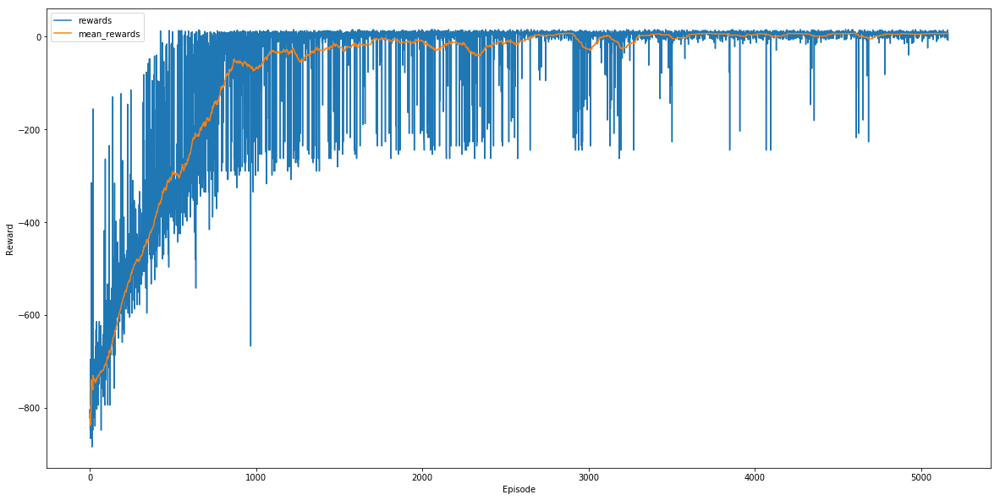

In [10]:
plt.rcParams['figure.figsize'] = (20, 10)
plot_rewards(episodes_rewards, 100)

In [5]:
# Location Tuple Representation
agent = TaxiAgent(env,
                  name='locations_rep',
                  obs_represent='locations',
                  exploration=exp_schedule,
                  optimizer='Adam',
                  clip_grads=True,
                  learning_rate=0.0003,
                  n_hidden=150,
                  steps_to_start_learn=100,
                  target_update_freq=1000)

Using Locations-Tuple representation for states
No checkpoint found...
Created Agent for Taxi-v2


In [6]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 1000
batch_size = 128 # 32
num_episodes = 100000

In [7]:
# Location Tuple Representation
episode_durations = []
episodes_rewards = []
total_steps = 0
start_time = time.time()
for episode in range(num_episodes):
    episode_start_time = time.time()
    last_obs = env.reset()
    last_obs = state_to_location(last_obs) 
    episode_reward = 0
    agent.episodes_seen += 1
#     agent.epsilon = agent.explore_schedule.value(agent.episodes_seen)
    for t in count():
        agent.steps_count += 1
        total_steps += 1
        ### Step the env and store the transition
        # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
        last_idx = agent.replay_buffer.store_frame(last_obs)
        # encode_recent_observation will take the latest observation
        # that you pushed into the buffer and compute the corresponding
        # input that should be given to a Q network by appending some
        # previous frames.
        recent_observation = agent.replay_buffer.encode_recent_observation()
        action = agent.select_greedy_action(recent_observation)
        obs, reward, done, _ = env.step(action)
        episode_reward += reward
        agent.replay_buffer.store_effect(last_idx, action, reward, done)
        ### Perform experience replay and train the network.
        # Note that this is only done if the replay buffer contains enough samples
        # for us to learn something useful -- until then, the model will not be
        # initialized and random actions should be taken
        agent.learn(batch_size)
        ### Log progress and keep track of statistics
        if len(episodes_rewards) > 0:
            mean_episode_reward = np.mean(episodes_rewards[-100:])
        if len(episodes_rewards) > 100:
            best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)
        if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agent.steps_to_start_learn:
            print("Timestep %d" % (agent.steps_count,))
            print("mean reward (100 episodes) %f" % mean_episode_reward)
            print("best mean reward %f" % best_mean_episode_reward)
            print("episodes %d" % len(episodes_rewards))
            print("exploration %f" % agent.epsilon)
            total_time = time.time() - start_time
            print("time since start: %.2f secs" % total_time)
        # Resets the environment when reaching an episode boundary.
        if done:
            episode_durations.append(t + 1)
            episodes_rewards.append(episode_reward)
            print("Episode: ", agent.episodes_seen,
                  " Done, Reward: ", episode_reward,
                  " Step: ", agent.steps_count,
                 " Episode Time: %.2f secs" % (time.time() - episode_start_time))
            break
        last_obs = state_to_location(obs)
print("Training Complete!")

Episode:  1  Done, Reward:  -740  Step:  200  Episode Time: 0.72 secs
Episode:  2  Done, Reward:  -848  Step:  400  Episode Time: 0.55 secs
Episode:  3  Done, Reward:  -794  Step:  600  Episode Time: 0.30 secs
Episode:  4  Done, Reward:  -731  Step:  800  Episode Time: 0.40 secs
Timestep 1000
mean reward (100 episodes) -778.250000
best mean reward -inf
episodes 4
exploration 0.998813
time since start: 2.26 secs
Episode:  5  Done, Reward:  -839  Step:  1000  Episode Time: 0.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6  Done, Reward:  -830  Step:  1200  Episode Time: 0.41 secs
Episode:  7  Done, Reward:  -803  Step:  1400  Episode Time: 0.72 secs
Episode:  8  Done, Reward:  -830  Step:  1600  Episode Time: 0.53 secs
Episode:  9  Done, Reward:  -803  Step:  1800  Episode Time: 0.31 secs
Timestep 2000
mean reward (100 episodes) -802.000000
best mean reward -inf
episodes 9
exploration 0.997628
time since start: 4.54 secs
Episode:  10  Don

Episode:  73  Done, Reward:  -911  Step:  14284  Episode Time: 0.64 secs
Episode:  74  Done, Reward:  -722  Step:  14484  Episode Time: 0.49 secs
Episode:  75  Done, Reward:  -839  Step:  14684  Episode Time: 0.29 secs
Episode:  76  Done, Reward:  -821  Step:  14884  Episode Time: 0.30 secs
Timestep 15000
mean reward (100 episodes) -772.355263
best mean reward -inf
episodes 76
exploration 0.981887
time since start: 43.08 secs
Episode:  77  Done, Reward:  -749  Step:  15084  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78  Done, Reward:  -848  Step:  15284  Episode Time: 0.50 secs
Episode:  79  Done, Reward:  -785  Step:  15484  Episode Time: 0.66 secs
Episode:  80  Done, Reward:  -803  Step:  15684  Episode Time: 0.49 secs
Episode:  81  Done, Reward:  -731  Step:  15884  Episode Time: 0.49 secs
Timestep 16000
mean reward (100 episodes) -773.024691
best mean reward -inf
episodes 81
exploration 0.980723
time since start: 

Episode:  144  Done, Reward:  -875  Step:  28389  Episode Time: 0.51 secs
Episode:  145  Done, Reward:  -821  Step:  28589  Episode Time: 0.51 secs
Episode:  146  Done, Reward:  -776  Step:  28789  Episode Time: 0.51 secs
Episode:  147  Done, Reward:  -785  Step:  28989  Episode Time: 0.69 secs
Timestep 29000
mean reward (100 episodes) -760.980000
best mean reward -757.010000
episodes 147
exploration 0.965492
time since start: 94.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  148  Done, Reward:  -722  Step:  29189  Episode Time: 0.50 secs
Episode:  149  Done, Reward:  -785  Step:  29389  Episode Time: 0.50 secs
Episode:  150  Done, Reward:  -830  Step:  29589  Episode Time: 0.70 secs
Episode:  151  Done, Reward:  -758  Step:  29789  Episode Time: 0.50 secs
Episode:  152  Done, Reward:  -758  Step:  29989  Episode Time: 0.50 secs
Timestep 30000
mean reward (100 episodes) -759.850000
best mean reward -757.010000
episodes 152
exploration 0.

Episode:  214  Done, Reward:  -776  Step:  42116  Episode Time: 0.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  215  Done, Reward:  -659  Step:  42316  Episode Time: 0.50 secs
Episode:  216  Done, Reward:  -776  Step:  42516  Episode Time: 0.54 secs
Episode:  217  Done, Reward:  -740  Step:  42716  Episode Time: 0.70 secs
Episode:  218  Done, Reward:  -785  Step:  42916  Episode Time: 0.33 secs
Timestep 43000
mean reward (100 episodes) -763.820000
best mean reward -755.520000
episodes 218
exploration 0.949386
time since start: 135.43 secs
Episode:  219  Done, Reward:  -776  Step:  43116  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  220  Done, Reward:  -785  Step:  43316  Episode Time: 0.49 secs
Episode:  221  Done, Reward:  -758  Step:  43516  Episode Time: 0.69 secs
Episode:  222  Done, Reward:  -776  Step:  43716  Episode Time: 0.51 secs
Episode:  223  Done, Reward:  -

Episode:  285  Done, Reward:  -749  Step:  55973  Episode Time: 0.55 secs
Timestep 56000
mean reward (100 episodes) -744.470000
best mean reward -735.910000
episodes 285
exploration 0.934446
time since start: 183.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  286  Done, Reward:  -740  Step:  56173  Episode Time: 0.39 secs
Episode:  287  Done, Reward:  -740  Step:  56373  Episode Time: 0.38 secs
Episode:  288  Done, Reward:  -740  Step:  56573  Episode Time: 0.48 secs
Episode:  289  Done, Reward:  -695  Step:  56773  Episode Time: 0.46 secs
Episode:  290  Done, Reward:  -740  Step:  56973  Episode Time: 0.62 secs
Timestep 57000
mean reward (100 episodes) -747.400000
best mean reward -735.910000
episodes 290
exploration 0.933342
time since start: 185.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  291  Done, Reward:  -812  Step:  57173  Episode Time: 0.30 secs
Episode:  292  Done, Reward:  -7

Episode:  354  Done, Reward:  -776  Step:  69361  Episode Time: 0.38 secs
Episode:  355  Done, Reward:  -758  Step:  69561  Episode Time: 0.36 secs
Episode:  356  Done, Reward:  -830  Step:  69761  Episode Time: 0.43 secs
Episode:  357  Done, Reward:  -803  Step:  69961  Episode Time: 0.72 secs
Timestep 70000
mean reward (100 episodes) -725.790000
best mean reward -723.380000
episodes 357
exploration 0.918669
time since start: 220.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  358  Done, Reward:  -758  Step:  70161  Episode Time: 0.56 secs
Episode:  359  Done, Reward:  -686  Step:  70361  Episode Time: 0.63 secs
Episode:  360  Done, Reward:  -767  Step:  70561  Episode Time: 0.44 secs
Episode:  361  Done, Reward:  -794  Step:  70761  Episode Time: 0.63 secs
Episode:  362  Done, Reward:  -776  Step:  70961  Episode Time: 0.65 secs
Timestep 71000
mean reward (100 episodes) -728.310000
best mean reward -723.380000
episodes 362
exploration 0

Episode:  424  Done, Reward:  -794  Step:  83218  Episode Time: 0.49 secs
Episode:  425  Done, Reward:  -650  Step:  83418  Episode Time: 0.45 secs
Episode:  426  Done, Reward:  -686  Step:  83618  Episode Time: 0.30 secs
Episode:  427  Done, Reward:  -704  Step:  83818  Episode Time: 0.47 secs
Timestep 84000
mean reward (100 episodes) -725.060000
best mean reward -721.630000
episodes 427
exploration 0.903599
time since start: 270.03 secs
Episode:  428  Done, Reward:  -848  Step:  84018  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  429  Done, Reward:  -722  Step:  84218  Episode Time: 0.73 secs
Episode:  430  Done, Reward:  -330  Step:  84344  Episode Time: 0.19 secs
Episode:  431  Done, Reward:  -722  Step:  84544  Episode Time: 0.30 secs
Episode:  432  Done, Reward:  -893  Step:  84744  Episode Time: 0.50 secs
Episode:  433  Done, Reward:  -686  Step:  84944  Episode Time: 0.80 secs
Timestep 85000
mean reward (100 epi

Episode:  495  Done, Reward:  -767  Step:  97105  Episode Time: 0.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  496  Done, Reward:  -677  Step:  97305  Episode Time: 0.30 secs
Episode:  497  Done, Reward:  -704  Step:  97505  Episode Time: 0.31 secs
Episode:  498  Done, Reward:  -560  Step:  97705  Episode Time: 0.34 secs
Episode:  499  Done, Reward:  -713  Step:  97905  Episode Time: 0.50 secs
Timestep 98000
mean reward (100 episodes) -701.480000
best mean reward -701.390000
episodes 499
exploration 0.888372
time since start: 309.44 secs
Episode:  500  Done, Reward:  -785  Step:  98105  Episode Time: 0.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  501  Done, Reward:  -677  Step:  98305  Episode Time: 0.33 secs
Episode:  502  Done, Reward:  -740  Step:  98505  Episode Time: 0.51 secs
Episode:  503  Done, Reward:  -794  Step:  98705  Episode Time: 1.10 secs
Episode:  504  Done, Reward:  -

Episode:  565  Done, Reward:  -686  Step:  110752  Episode Time: 0.90 secs
Episode:  566  Done, Reward:  -713  Step:  110952  Episode Time: 0.64 secs
Timestep 111000
mean reward (100 episodes) -699.330000
best mean reward -699.330000
episodes 566
exploration 0.874446
time since start: 355.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  567  Done, Reward:  -713  Step:  111152  Episode Time: 0.52 secs
Episode:  568  Done, Reward:  -722  Step:  111352  Episode Time: 0.73 secs
Episode:  569  Done, Reward:  -632  Step:  111552  Episode Time: 0.50 secs
Episode:  570  Done, Reward:  -776  Step:  111752  Episode Time: 0.70 secs
Episode:  571  Done, Reward:  -731  Step:  111952  Episode Time: 1.61 secs
Timestep 112000
mean reward (100 episodes) -697.710000
best mean reward -697.530000
episodes 571
exploration 0.873416
time since start: 359.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  572  Done, Re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  634  Done, Reward:  -610  Step:  124178  Episode Time: 0.66 secs
Episode:  635  Done, Reward:  -767  Step:  124378  Episode Time: 0.29 secs
Episode:  636  Done, Reward:  -776  Step:  124578  Episode Time: 0.29 secs
Episode:  637  Done, Reward:  -659  Step:  124778  Episode Time: 0.46 secs
Episode:  638  Done, Reward:  -605  Step:  124978  Episode Time: 0.34 secs
Timestep 125000
mean reward (100 episodes) -680.470000
best mean reward -680.470000
episodes 638
exploration 0.859739
time since start: 401.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  639  Done, Reward:  -650  Step:  125178  Episode Time: 0.55 secs
Episode:  640  Done, Reward:  -713  Step:  125378  Episode Time: 0.74 secs
Episode:  641  Done, Reward:  -492  Step:  125531  Episode Time: 0.48 secs
Episode:  642  Done, Reward:  -758  Step:  125731  Episode Time: 1.45 secs
Episode:  643  Done, 

Episode:  704  Done, Reward:  -560  Step:  137338  Episode Time: 1.46 secs
Episode:  705  Done, Reward:  -767  Step:  137538  Episode Time: 1.22 secs
Episode:  706  Done, Reward:  -614  Step:  137738  Episode Time: 1.12 secs
Episode:  707  Done, Reward:  -821  Step:  137938  Episode Time: 2.49 secs
Timestep 138000
mean reward (100 episodes) -659.310000
best mean reward -647.190000
episodes 707
exploration 0.845891
time since start: 459.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  708  Done, Reward:  -794  Step:  138138  Episode Time: 2.56 secs
Episode:  709  Done, Reward:  -632  Step:  138338  Episode Time: 1.12 secs
Episode:  710  Done, Reward:  -623  Step:  138538  Episode Time: 0.55 secs
Episode:  711  Done, Reward:  -776  Step:  138738  Episode Time: 0.52 secs
Episode:  712  Done, Reward:  -641  Step:  138938  Episode Time: 0.75 secs
Timestep 139000
mean reward (100 episodes) -660.620000
best mean reward -647.190000
episodes 712
ex

Episode:  774  Done, Reward:  -641  Step:  151122  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  775  Done, Reward:  -677  Step:  151322  Episode Time: 0.51 secs
Episode:  776  Done, Reward:  -695  Step:  151522  Episode Time: 0.50 secs
Episode:  777  Done, Reward:  -677  Step:  151722  Episode Time: 0.71 secs
Episode:  778  Done, Reward:  -830  Step:  151922  Episode Time: 0.31 secs
Timestep 152000
mean reward (100 episodes) -666.550000
best mean reward -647.190000
episodes 778
exploration 0.831888
time since start: 510.42 secs
Episode:  779  Done, Reward:  -623  Step:  152122  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  780  Done, Reward:  -578  Step:  152322  Episode Time: 0.51 secs
Episode:  781  Done, Reward:  -641  Step:  152522  Episode Time: 0.68 secs
Episode:  782  Done, Reward:  -605  Step:  152722  Episode Time: 0.50 secs
Episode:  783  Done, 

Episode:  844  Done, Reward:  -677  Step:  164592  Episode Time: 0.84 secs
Episode:  845  Done, Reward:  -812  Step:  164792  Episode Time: 0.40 secs
Episode:  846  Done, Reward:  -731  Step:  164992  Episode Time: 0.45 secs
Timestep 165000
mean reward (100 episodes) -663.910000
best mean reward -647.190000
episodes 846
exploration 0.818709
time since start: 556.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  847  Done, Reward:  -704  Step:  165192  Episode Time: 0.52 secs
Episode:  848  Done, Reward:  -650  Step:  165392  Episode Time: 0.59 secs
Episode:  849  Done, Reward:  -713  Step:  165592  Episode Time: 0.38 secs
Episode:  850  Done, Reward:  -623  Step:  165792  Episode Time: 0.61 secs
Episode:  851  Done, Reward:  -623  Step:  165992  Episode Time: 0.52 secs
Timestep 166000
mean reward (100 episodes) -663.550000
best mean reward -647.190000
episodes 851
exploration 0.817748
time since start: 558.73 secs
Saved Taxi Agent checkpoin

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  913  Done, Reward:  -794  Step:  178237  Episode Time: 0.58 secs
Episode:  914  Done, Reward:  -731  Step:  178437  Episode Time: 0.74 secs
Episode:  915  Done, Reward:  -803  Step:  178637  Episode Time: 0.33 secs
Episode:  916  Done, Reward:  -776  Step:  178837  Episode Time: 0.85 secs
Timestep 179000
mean reward (100 episodes) -662.610000
best mean reward -647.190000
episodes 916
exploration 0.805373
time since start: 599.65 secs
Episode:  917  Done, Reward:  -641  Step:  179037  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  918  Done, Reward:  -767  Step:  179237  Episode Time: 1.01 secs
Episode:  919  Done, Reward:  -560  Step:  179437  Episode Time: 0.45 secs
Episode:  920  Done, Reward:  -758  Step:  179637  Episode Time: 0.57 secs
Episode:  921  Done, Reward:  -749  Step:  179837  Episode Time: 0.92 secs
Timestep 180000
mean 

Timestep 192000
mean reward (100 episodes) -656.130000
best mean reward -647.190000
episodes 982
exploration 0.793012
time since start: 648.43 secs
Episode:  983  Done, Reward:  -686  Step:  192113  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  984  Done, Reward:  -596  Step:  192313  Episode Time: 0.57 secs
Episode:  985  Done, Reward:  -479  Step:  192513  Episode Time: 0.75 secs
Episode:  986  Done, Reward:  -713  Step:  192713  Episode Time: 0.57 secs
Episode:  987  Done, Reward:  -695  Step:  192913  Episode Time: 0.56 secs
Timestep 193000
mean reward (100 episodes) -653.610000
best mean reward -647.190000
episodes 987
exploration 0.792084
time since start: 651.55 secs
Episode:  988  Done, Reward:  -713  Step:  193113  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  989  Done, Reward:  -397  Step:  193261  Episode Time: 0.43 secs
Episode:  990  Done, Re

Episode:  1050  Done, Reward:  -533  Step:  205216  Episode Time: 0.56 secs
Episode:  1051  Done, Reward:  -596  Step:  205416  Episode Time: 0.55 secs
Episode:  1052  Done, Reward:  -713  Step:  205616  Episode Time: 0.42 secs
Episode:  1053  Done, Reward:  -722  Step:  205816  Episode Time: 0.32 secs
Timestep 206000
mean reward (100 episodes) -639.500000
best mean reward -633.730000
episodes 1053
exploration 0.779940
time since start: 694.07 secs
Episode:  1054  Done, Reward:  -587  Step:  206016  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1055  Done, Reward:  -668  Step:  206216  Episode Time: 0.58 secs
Episode:  1056  Done, Reward:  -623  Step:  206416  Episode Time: 0.50 secs
Episode:  1057  Done, Reward:  -722  Step:  206616  Episode Time: 0.42 secs
Episode:  1058  Done, Reward:  -249  Step:  206697  Episode Time: 0.13 secs
Episode:  1059  Done, Reward:  -443  Step:  206897  Episode Time: 0.42 secs
Timestep 2070

Episode:  1119  Done, Reward:  -623  Step:  218804  Episode Time: 0.33 secs
Episode:  1120  Done, Reward:  -110  Step:  218854  Episode Time: 0.08 secs
Episode:  1121  Done, Reward:  -138  Step:  218905  Episode Time: 0.08 secs
Timestep 219000
mean reward (100 episodes) -637.190000
best mean reward -631.590000
episodes 1121
exploration 0.767636
time since start: 726.64 secs
Episode:  1122  Done, Reward:  -731  Step:  219105  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1123  Done, Reward:  -659  Step:  219305  Episode Time: 0.57 secs
Episode:  1124  Done, Reward:  -740  Step:  219505  Episode Time: 0.33 secs
Episode:  1125  Done, Reward:  -650  Step:  219705  Episode Time: 0.44 secs
Episode:  1126  Done, Reward:  -605  Step:  219905  Episode Time: 0.47 secs
Timestep 220000
mean reward (100 episodes) -640.540000
best mean reward -631.590000
episodes 1126
exploration 0.766739
time since start: 728.75 secs
Episode:  1127  

Episode:  1187  Done, Reward:  -803  Step:  232105  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1188  Done, Reward:  -632  Step:  232305  Episode Time: 0.53 secs
Episode:  1189  Done, Reward:  -542  Step:  232505  Episode Time: 0.52 secs
Episode:  1190  Done, Reward:  -614  Step:  232705  Episode Time: 0.79 secs
Episode:  1191  Done, Reward:  -596  Step:  232905  Episode Time: 0.31 secs
Timestep 233000
mean reward (100 episodes) -639.660000
best mean reward -631.590000
episodes 1191
exploration 0.755186
time since start: 762.28 secs
Episode:  1192  Done, Reward:  -569  Step:  233105  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1193  Done, Reward:  -587  Step:  233305  Episode Time: 0.34 secs
Episode:  1194  Done, Reward:  -560  Step:  233505  Episode Time: 0.31 secs
Episode:  1195  Done, Reward:  -596  Step:  233705  Episode Time: 0.32 secs
Episode:  1

Episode:  1255  Done, Reward:  -749  Step:  245705  Episode Time: 0.57 secs
Episode:  1256  Done, Reward:  -596  Step:  245905  Episode Time: 0.57 secs
Timestep 246000
mean reward (100 episodes) -643.880000
best mean reward -631.590000
episodes 1256
exploration 0.743820
time since start: 811.40 secs
Episode:  1257  Done, Reward:  -578  Step:  246105  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1258  Done, Reward:  -524  Step:  246305  Episode Time: 0.33 secs
Episode:  1259  Done, Reward:  -704  Step:  246505  Episode Time: 0.40 secs
Episode:  1260  Done, Reward:  -573  Step:  246685  Episode Time: 0.29 secs
Episode:  1261  Done, Reward:  -668  Step:  246885  Episode Time: 0.52 secs
Timestep 247000
mean reward (100 episodes) -642.480000
best mean reward -631.590000
episodes 1261
exploration 0.742953
time since start: 813.75 secs
Episode:  1262  Done, Reward:  -695  Step:  247085  Episode Time: 0.63 secs
Saved Taxi Agent

Episode:  1324  Done, Reward:  -614  Step:  259080  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1325  Done, Reward:  -650  Step:  259280  Episode Time: 0.55 secs
Episode:  1326  Done, Reward:  -758  Step:  259480  Episode Time: 0.31 secs
Episode:  1327  Done, Reward:  -587  Step:  259680  Episode Time: 0.53 secs
Episode:  1328  Done, Reward:  -542  Step:  259880  Episode Time: 0.49 secs
Timestep 260000
mean reward (100 episodes) -615.540000
best mean reward -613.650000
episodes 1328
exploration 0.731443
time since start: 851.76 secs
Episode:  1329  Done, Reward:  -668  Step:  260080  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1330  Done, Reward:  -650  Step:  260280  Episode Time: 0.50 secs
Episode:  1331  Done, Reward:  -668  Step:  260480  Episode Time: 0.39 secs
Episode:  1332  Done, Reward:  -551  Step:  260680  Episode Time: 0.56 secs
Episode:  1

Episode:  1392  Done, Reward:  -551  Step:  272460  Episode Time: 0.32 secs
Episode:  1393  Done, Reward:  -452  Step:  272660  Episode Time: 0.32 secs
Episode:  1394  Done, Reward:  -569  Step:  272860  Episode Time: 0.48 secs
Timestep 273000
mean reward (100 episodes) -608.520000
best mean reward -608.520000
episodes 1394
exploration 0.720291
time since start: 893.23 secs
Episode:  1395  Done, Reward:  -614  Step:  273060  Episode Time: 1.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1396  Done, Reward:  -659  Step:  273260  Episode Time: 1.05 secs
Episode:  1397  Done, Reward:  -587  Step:  273460  Episode Time: 0.76 secs
Episode:  1398  Done, Reward:  -623  Step:  273660  Episode Time: 0.56 secs
Episode:  1399  Done, Reward:  -614  Step:  273860  Episode Time: 0.55 secs
Timestep 274000
mean reward (100 episodes) -607.800000
best mean reward -606.990000
episodes 1399
exploration 0.719454
time since start: 897.05 secs
Episode:  1400  

Timestep 286000
mean reward (100 episodes) -606.380000
best mean reward -603.940000
episodes 1460
exploration 0.709322
time since start: 939.52 secs
Episode:  1461  Done, Reward:  -461  Step:  286062  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1462  Done, Reward:  -623  Step:  286262  Episode Time: 0.32 secs
Episode:  1463  Done, Reward:  -695  Step:  286462  Episode Time: 0.45 secs
Episode:  1464  Done, Reward:  -596  Step:  286662  Episode Time: 0.74 secs
Episode:  1465  Done, Reward:  -623  Step:  286862  Episode Time: 0.59 secs
Episode:  1466  Done, Reward:  -147  Step:  286940  Episode Time: 0.22 secs
Timestep 287000
mean reward (100 episodes) -600.360000
best mean reward -600.360000
episodes 1466
exploration 0.708334
time since start: 942.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1467  Done, Reward:  -686  Step:  287140  Episode Time: 0.56 secs
Episode:  1468

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1529  Done, Reward:  -551  Step:  299165  Episode Time: 0.70 secs
Episode:  1530  Done, Reward:  -560  Step:  299365  Episode Time: 0.31 secs
Episode:  1531  Done, Reward:  -623  Step:  299565  Episode Time: 0.32 secs
Episode:  1532  Done, Reward:  -605  Step:  299765  Episode Time: 0.33 secs
Episode:  1533  Done, Reward:  -533  Step:  299965  Episode Time: 0.50 secs
Timestep 300000
mean reward (100 episodes) -596.190000
best mean reward -594.290000
episodes 1533
exploration 0.697398
time since start: 981.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1534  Done, Reward:  -668  Step:  300165  Episode Time: 0.69 secs
Episode:  1535  Done, Reward:  -632  Step:  300365  Episode Time: 0.45 secs
Episode:  1536  Done, Reward:  -515  Step:  300565  Episode Time: 0.32 secs
Episode:  1537  Done, Reward:  -623  Step:  300765  Episode Time: 0.53 secs
Episode:  1

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1598  Done, Reward:  -623  Step:  312302  Episode Time: 0.48 secs
Episode:  1599  Done, Reward:  -578  Step:  312502  Episode Time: 0.59 secs
Episode:  1600  Done, Reward:  -551  Step:  312702  Episode Time: 0.59 secs
Episode:  1601  Done, Reward:  -740  Step:  312902  Episode Time: 0.57 secs
Episode:  1602  Done, Reward:  -33  Step:  312920  Episode Time: 0.05 secs
Timestep 313000
mean reward (100 episodes) -570.230000
best mean reward -570.230000
episodes 1602
exploration 0.686327
time since start: 1024.24 secs
Episode:  1603  Done, Reward:  -605  Step:  313120  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1604  Done, Reward:  -524  Step:  313320  Episode Time: 0.76 secs
Episode:  1605  Done, Reward:  -569  Step:  313520  Episode Time: 1.72 secs
Episode:  1606  Done, Reward:  -335  Step:  313651  Episode Time: 0.60 secs
Episode:  1

Episode:  1666  Done, Reward:  -632  Step:  325378  Episode Time: 0.45 secs
Episode:  1667  Done, Reward:  -668  Step:  325578  Episode Time: 0.32 secs
Episode:  1668  Done, Reward:  -461  Step:  325778  Episode Time: 0.41 secs
Episode:  1669  Done, Reward:  -614  Step:  325978  Episode Time: 0.58 secs
Timestep 326000
mean reward (100 episodes) -569.990000
best mean reward -559.040000
episodes 1669
exploration 0.675757
time since start: 1065.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1670  Done, Reward:  -605  Step:  326178  Episode Time: 0.40 secs
Episode:  1671  Done, Reward:  -713  Step:  326378  Episode Time: 0.50 secs
Episode:  1672  Done, Reward:  -348  Step:  326522  Episode Time: 0.24 secs
Episode:  1673  Done, Reward:  -659  Step:  326722  Episode Time: 0.32 secs
Episode:  1674  Done, Reward:  -112  Step:  326783  Episode Time: 0.09 secs
Episode:  1675  Done, Reward:  -560  Step:  326983  Episode Time: 0.68 secs
Timestep 327

Episode:  1735  Done, Reward:  -596  Step:  338671  Episode Time: 0.33 secs
Episode:  1736  Done, Reward:  -551  Step:  338871  Episode Time: 0.32 secs
Timestep 339000
mean reward (100 episodes) -573.450000
best mean reward -559.040000
episodes 1736
exploration 0.665363
time since start: 1100.26 secs
Episode:  1737  Done, Reward:  -650  Step:  339071  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1738  Done, Reward:  -632  Step:  339271  Episode Time: 0.48 secs
Episode:  1739  Done, Reward:  -569  Step:  339471  Episode Time: 0.55 secs
Episode:  1740  Done, Reward:  -488  Step:  339671  Episode Time: 1.14 secs
Episode:  1741  Done, Reward:  -605  Step:  339871  Episode Time: 2.21 secs
Timestep 340000
mean reward (100 episodes) -574.170000
best mean reward -559.040000
episodes 1741
exploration 0.664594
time since start: 1105.80 secs
Episode:  1742  Done, Reward:  -515  Step:  340071  Episode Time: 1.44 secs
Saved Taxi Age

Episode:  1802  Done, Reward:  -551  Step:  352071  Episode Time: 1.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1803  Done, Reward:  -623  Step:  352271  Episode Time: 0.51 secs
Episode:  1804  Done, Reward:  -641  Step:  352471  Episode Time: 0.36 secs
Episode:  1805  Done, Reward:  -542  Step:  352671  Episode Time: 0.66 secs
Episode:  1806  Done, Reward:  -587  Step:  352871  Episode Time: 0.32 secs
Timestep 353000
mean reward (100 episodes) -583.350000
best mean reward -559.040000
episodes 1806
exploration 0.654688
time since start: 1156.72 secs
Episode:  1807  Done, Reward:  -560  Step:  353071  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1808  Done, Reward:  -479  Step:  353271  Episode Time: 0.59 secs
Episode:  1809  Done, Reward:  -587  Step:  353471  Episode Time: 0.43 secs
Episode:  1810  Done, Reward:  -587  Step:  353671  Episode Time: 1.14 secs
Episode:  

Episode:  1870  Done, Reward:  -542  Step:  365671  Episode Time: 0.63 secs
Episode:  1871  Done, Reward:  -542  Step:  365871  Episode Time: 0.64 secs
Timestep 366000
mean reward (100 episodes) -575.120000
best mean reward -559.040000
episodes 1871
exploration 0.644941
time since start: 1214.00 secs
Episode:  1872  Done, Reward:  -569  Step:  366071  Episode Time: 0.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1873  Done, Reward:  -578  Step:  366271  Episode Time: 0.71 secs
Episode:  1874  Done, Reward:  -614  Step:  366471  Episode Time: 0.57 secs
Episode:  1875  Done, Reward:  -578  Step:  366671  Episode Time: 0.69 secs
Episode:  1876  Done, Reward:  -497  Step:  366871  Episode Time: 0.36 secs
Timestep 367000
mean reward (100 episodes) -574.850000
best mean reward -559.040000
episodes 1876
exploration 0.644198
time since start: 1217.15 secs
Episode:  1877  Done, Reward:  -515  Step:  367071  Episode Time: 0.32 secs
Saved Taxi Age

Timestep 379000
mean reward (100 episodes) -540.980000
best mean reward -540.980000
episodes 1938
exploration 0.635059
time since start: 1247.40 secs
Episode:  1939  Done, Reward:  -578  Step:  379003  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1940  Done, Reward:  -569  Step:  379203  Episode Time: 0.37 secs
Episode:  1941  Done, Reward:  -533  Step:  379403  Episode Time: 1.50 secs
Episode:  1942  Done, Reward:  -614  Step:  379603  Episode Time: 1.98 secs
Episode:  1943  Done, Reward:  -578  Step:  379803  Episode Time: 1.00 secs
Timestep 380000
mean reward (100 episodes) -541.790000
best mean reward -540.800000
episodes 1943
exploration 0.634328
time since start: 1252.82 secs
Episode:  1944  Done, Reward:  -479  Step:  380003  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  1945  Done, Reward:  -515  Step:  380203  Episode Time: 0.78 secs
Episode:  19

Episode:  2006  Done, Reward:  -434  Step:  392058  Episode Time: 1.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2007  Done, Reward:  -524  Step:  392258  Episode Time: 1.93 secs
Episode:  2008  Done, Reward:  -623  Step:  392458  Episode Time: 1.91 secs
Episode:  2009  Done, Reward:  -641  Step:  392658  Episode Time: 0.58 secs
Episode:  2010  Done, Reward:  -587  Step:  392858  Episode Time: 0.74 secs
Timestep 393000
mean reward (100 episodes) -535.160000
best mean reward -523.780000
episodes 2010
exploration 0.624622
time since start: 1298.99 secs
Episode:  2011  Done, Reward:  -479  Step:  393058  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2012  Done, Reward:  -614  Step:  393258  Episode Time: 0.54 secs
Episode:  2013  Done, Reward:  -560  Step:  393458  Episode Time: 0.33 secs
Episode:  2014  Done, Reward:  -488  Step:  393658  Episode Time: 0.58 secs
Episode:  

Episode:  2074  Done, Reward:  -560  Step:  405376  Episode Time: 1.89 secs
Episode:  2075  Done, Reward:  -488  Step:  405576  Episode Time: 1.58 secs
Episode:  2076  Done, Reward:  -623  Step:  405776  Episode Time: 0.60 secs
Episode:  2077  Done, Reward:  -488  Step:  405976  Episode Time: 0.58 secs
Timestep 406000
mean reward (100 episodes) -536.580000
best mean reward -523.780000
episodes 2077
exploration 0.615077
time since start: 1343.09 secs
Episode:  2078  Done, Reward:  -263  Step:  406062  Episode Time: 0.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2079  Done, Reward:  -497  Step:  406262  Episode Time: 0.75 secs
Episode:  2080  Done, Reward:  -524  Step:  406462  Episode Time: 0.56 secs
Episode:  2081  Done, Reward:  -479  Step:  406662  Episode Time: 0.54 secs
Episode:  2082  Done, Reward:  -578  Step:  406862  Episode Time: 0.74 secs
Timestep 407000
mean reward (100 episodes) -531.900000
best mean reward -523.780000
epis

Timestep 419000
mean reward (100 episodes) -534.080000
best mean reward -523.780000
episodes 2142
exploration 0.605969
time since start: 1396.72 secs
Episode:  2143  Done, Reward:  -515  Step:  419062  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2144  Done, Reward:  -569  Step:  419262  Episode Time: 0.33 secs
Episode:  2145  Done, Reward:  -713  Step:  419462  Episode Time: 0.54 secs
Episode:  2146  Done, Reward:  -587  Step:  419662  Episode Time: 0.57 secs
Episode:  2147  Done, Reward:  -632  Step:  419862  Episode Time: 0.57 secs
Timestep 420000
mean reward (100 episodes) -538.400000
best mean reward -523.780000
episodes 2147
exploration 0.605274
time since start: 1399.39 secs
Episode:  2148  Done, Reward:  -515  Step:  420062  Episode Time: 1.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2149  Done, Reward:  -569  Step:  420262  Episode Time: 1.21 secs
Episode:  21

Episode:  2210  Done, Reward:  -596  Step:  432343  Episode Time: 0.31 secs
Episode:  2211  Done, Reward:  -551  Step:  432543  Episode Time: 0.31 secs
Episode:  2212  Done, Reward:  -515  Step:  432743  Episode Time: 0.32 secs
Episode:  2213  Done, Reward:  -569  Step:  432943  Episode Time: 0.38 secs
Timestep 433000
mean reward (100 episodes) -550.770000
best mean reward -523.780000
episodes 2213
exploration 0.596187
time since start: 1429.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2214  Done, Reward:  -452  Step:  433143  Episode Time: 0.76 secs
Episode:  2215  Done, Reward:  -479  Step:  433343  Episode Time: 0.34 secs
Episode:  2216  Done, Reward:  -524  Step:  433543  Episode Time: 0.31 secs
Episode:  2217  Done, Reward:  -542  Step:  433743  Episode Time: 0.50 secs
Episode:  2218  Done, Reward:  -596  Step:  433943  Episode Time: 0.66 secs
Timestep 434000
mean reward (100 episodes) -549.150000
best mean reward -523.780000
epis

Timestep 446000
mean reward (100 episodes) -547.670000
best mean reward -523.780000
episodes 2278
exploration 0.587383
time since start: 1475.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2279  Done, Reward:  -497  Step:  446143  Episode Time: 1.54 secs
Episode:  2280  Done, Reward:  -605  Step:  446343  Episode Time: 1.07 secs
Episode:  2281  Done, Reward:  -515  Step:  446543  Episode Time: 1.42 secs
Episode:  2282  Done, Reward:  -479  Step:  446743  Episode Time: 2.23 secs
Episode:  2283  Done, Reward:  -650  Step:  446943  Episode Time: 1.79 secs
Timestep 447000
mean reward (100 episodes) -547.580000
best mean reward -523.780000
episodes 2283
exploration 0.586712
time since start: 1483.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2284  Done, Reward:  -488  Step:  447143  Episode Time: 1.64 secs
Episode:  2285  Done, Reward:  -533  Step:  447343  Episode Time: 0.55 secs
Episode:  22

Episode:  2345  Done, Reward:  -650  Step:  459343  Episode Time: 0.72 secs
Episode:  2346  Done, Reward:  -488  Step:  459543  Episode Time: 0.60 secs
Episode:  2347  Done, Reward:  -524  Step:  459743  Episode Time: 0.48 secs
Episode:  2348  Done, Reward:  -587  Step:  459943  Episode Time: 0.47 secs
Timestep 460000
mean reward (100 episodes) -541.460000
best mean reward -523.780000
episodes 2348
exploration 0.578061
time since start: 1523.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2349  Done, Reward:  -506  Step:  460143  Episode Time: 1.69 secs
Episode:  2350  Done, Reward:  -569  Step:  460343  Episode Time: 0.70 secs
Episode:  2351  Done, Reward:  -461  Step:  460543  Episode Time: 0.56 secs
Episode:  2352  Done, Reward:  -587  Step:  460743  Episode Time: 0.90 secs
Episode:  2353  Done, Reward:  -425  Step:  460943  Episode Time: 0.82 secs
Timestep 461000
mean reward (100 episodes) -541.550000
best mean reward -523.780000
epis

Episode:  2414  Done, Reward:  -479  Step:  472989  Episode Time: 0.34 secs
Timestep 473000
mean reward (100 episodes) -531.790000
best mean reward -523.780000
episodes 2414
exploration 0.569420
time since start: 1577.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2415  Done, Reward:  -605  Step:  473189  Episode Time: 0.35 secs
Episode:  2416  Done, Reward:  -416  Step:  473389  Episode Time: 0.34 secs
Episode:  2417  Done, Reward:  -524  Step:  473589  Episode Time: 0.64 secs
Episode:  2418  Done, Reward:  -389  Step:  473789  Episode Time: 0.32 secs
Episode:  2419  Done, Reward:  -452  Step:  473989  Episode Time: 0.34 secs
Timestep 474000
mean reward (100 episodes) -528.100000
best mean reward -523.780000
episodes 2419
exploration 0.568771
time since start: 1579.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2420  Done, Reward:  -506  Step:  474189  Episode Time: 0.42 secs
Episode:  24

Episode:  2481  Done, Reward:  -596  Step:  486343  Episode Time: 0.34 secs
Episode:  2482  Done, Reward:  -632  Step:  486543  Episode Time: 0.47 secs
Episode:  2483  Done, Reward:  -605  Step:  486743  Episode Time: 0.37 secs
Episode:  2484  Done, Reward:  -497  Step:  486943  Episode Time: 0.60 secs
Timestep 487000
mean reward (100 episodes) -527.470000
best mean reward -522.120000
episodes 2484
exploration 0.560409
time since start: 1626.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2485  Done, Reward:  -524  Step:  487143  Episode Time: 0.33 secs
Episode:  2486  Done, Reward:  -551  Step:  487343  Episode Time: 0.45 secs
Episode:  2487  Done, Reward:  -479  Step:  487543  Episode Time: 0.55 secs
Episode:  2488  Done, Reward:  -479  Step:  487743  Episode Time: 1.23 secs
Episode:  2489  Done, Reward:  -506  Step:  487943  Episode Time: 0.45 secs
Timestep 488000
mean reward (100 episodes) -525.940000
best mean reward -522.120000
epis

Episode:  2550  Done, Reward:  -533  Step:  500090  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2551  Done, Reward:  -470  Step:  500290  Episode Time: 0.73 secs
Episode:  2552  Done, Reward:  -542  Step:  500490  Episode Time: 2.26 secs
Episode:  2553  Done, Reward:  -506  Step:  500690  Episode Time: 1.99 secs
Episode:  2554  Done, Reward:  -515  Step:  500890  Episode Time: 0.32 secs
Timestep 501000
mean reward (100 episodes) -519.840000
best mean reward -519.840000
episodes 2554
exploration 0.551554
time since start: 1678.18 secs
Episode:  2555  Done, Reward:  -578  Step:  501090  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2556  Done, Reward:  -542  Step:  501290  Episode Time: 0.43 secs
Episode:  2557  Done, Reward:  -605  Step:  501490  Episode Time: 0.54 secs
Episode:  2558  Done, Reward:  -578  Step:  501690  Episode Time: 0.77 secs
Episode:  

Episode:  2619  Done, Reward:  -578  Step:  513336  Episode Time: 0.76 secs
Episode:  2620  Done, Reward:  -551  Step:  513536  Episode Time: 0.56 secs
Episode:  2621  Done, Reward:  -515  Step:  513736  Episode Time: 0.57 secs
Episode:  2622  Done, Reward:  -452  Step:  513936  Episode Time: 0.57 secs
Timestep 514000
mean reward (100 episodes) -507.430000
best mean reward -507.430000
episodes 2622
exploration 0.543100
time since start: 1714.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2623  Done, Reward:  -623  Step:  514136  Episode Time: 0.79 secs
Episode:  2624  Done, Reward:  -515  Step:  514336  Episode Time: 0.56 secs
Episode:  2625  Done, Reward:  -515  Step:  514536  Episode Time: 0.56 secs
Episode:  2626  Done, Reward:  -569  Step:  514736  Episode Time: 0.73 secs
Episode:  2627  Done, Reward:  -587  Step:  514936  Episode Time: 0.59 secs
Timestep 515000
mean reward (100 episodes) -511.750000
best mean reward -507.430000
epis

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2688  Done, Reward:  -515  Step:  527136  Episode Time: 0.32 secs
Episode:  2689  Done, Reward:  -515  Step:  527336  Episode Time: 0.48 secs
Episode:  2690  Done, Reward:  -470  Step:  527536  Episode Time: 0.38 secs
Episode:  2691  Done, Reward:  -377  Step:  527709  Episode Time: 0.27 secs
Episode:  2692  Done, Reward:  -479  Step:  527909  Episode Time: 0.72 secs
Timestep 528000
mean reward (100 episodes) -512.280000
best mean reward -507.430000
episodes 2692
exploration 0.534546
time since start: 1773.25 secs
Episode:  2693  Done, Reward:  -497  Step:  528109  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2694  Done, Reward:  -145  Step:  528167  Episode Time: 0.25 secs
Episode:  2695  Done, Reward:  -533  Step:  528367  Episode Time: 0.33 secs
Episode:  2696  Done, Reward:  -470  Step:  528567  Episode Time: 0.31 secs
Episode:  

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2757  Done, Reward:  -551  Step:  540207  Episode Time: 0.57 secs
Episode:  2758  Done, Reward:  -398  Step:  540407  Episode Time: 0.53 secs
Episode:  2759  Done, Reward:  -542  Step:  540607  Episode Time: 0.75 secs
Episode:  2760  Done, Reward:  -398  Step:  540807  Episode Time: 0.36 secs
Timestep 541000
mean reward (100 episodes) -482.210000
best mean reward -482.210000
episodes 2760
exploration 0.526378
time since start: 1821.00 secs
Episode:  2761  Done, Reward:  -605  Step:  541007  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2762  Done, Reward:  -551  Step:  541207  Episode Time: 0.54 secs
Episode:  2763  Done, Reward:  -551  Step:  541407  Episode Time: 0.73 secs
Episode:  2764  Done, Reward:  -533  Step:  541607  Episode Time: 0.35 secs
Episode:  2765  Done, Reward:  -443  Step:  541807  Episode Time: 0.44 secs
Timestep 5

Episode:  2825  Done, Reward:  -578  Step:  553752  Episode Time: 0.42 secs
Episode:  2826  Done, Reward:  -515  Step:  553952  Episode Time: 0.33 secs
Timestep 554000
mean reward (100 episodes) -494.810000
best mean reward -482.210000
episodes 2826
exploration 0.518582
time since start: 1864.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2827  Done, Reward:  -497  Step:  554152  Episode Time: 0.42 secs
Episode:  2828  Done, Reward:  -506  Step:  554352  Episode Time: 0.52 secs
Episode:  2829  Done, Reward:  -479  Step:  554552  Episode Time: 0.41 secs
Episode:  2830  Done, Reward:  -569  Step:  554752  Episode Time: 0.54 secs
Episode:  2831  Done, Reward:  -371  Step:  554952  Episode Time: 0.57 secs
Timestep 555000
mean reward (100 episodes) -494.450000
best mean reward -482.210000
episodes 2831
exploration 0.517997
time since start: 1867.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2892  Done, Reward:  -515  Step:  567152  Episode Time: 0.46 secs
Episode:  2893  Done, Reward:  -569  Step:  567352  Episode Time: 0.69 secs
Episode:  2894  Done, Reward:  -569  Step:  567552  Episode Time: 0.44 secs
Episode:  2895  Done, Reward:  -416  Step:  567752  Episode Time: 0.31 secs
Episode:  2896  Done, Reward:  -488  Step:  567952  Episode Time: 0.33 secs
Timestep 568000
mean reward (100 episodes) -496.600000
best mean reward -482.210000
episodes 2896
exploration 0.510454
time since start: 1918.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2897  Done, Reward:  -488  Step:  568152  Episode Time: 0.32 secs
Episode:  2898  Done, Reward:  -461  Step:  568352  Episode Time: 0.41 secs
Episode:  2899  Done, Reward:  -506  Step:  568552  Episode Time: 0.49 secs
Episode:  2900  Done, Reward:  -542  Step:  568752  Episode Time: 0.32 secs
Episode:  

Episode:  2960  Done, Reward:  -470  Step:  580752  Episode Time: 1.81 secs
Episode:  2961  Done, Reward:  -434  Step:  580952  Episode Time: 1.87 secs
Timestep 581000
mean reward (100 episodes) -496.730000
best mean reward -482.210000
episodes 2961
exploration 0.503032
time since start: 1962.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  2962  Done, Reward:  -479  Step:  581152  Episode Time: 1.69 secs
Episode:  2963  Done, Reward:  -533  Step:  581352  Episode Time: 1.44 secs
Episode:  2964  Done, Reward:  -497  Step:  581552  Episode Time: 0.40 secs
Episode:  2965  Done, Reward:  -506  Step:  581752  Episode Time: 0.41 secs
Episode:  2966  Done, Reward:  -148  Step:  581822  Episode Time: 0.19 secs
Timestep 582000
mean reward (100 episodes) -494.050000
best mean reward -482.210000
episodes 2966
exploration 0.502466
time since start: 1966.26 secs
Episode:  2967  Done, Reward:  -542  Step:  582022  Episode Time: 0.80 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3028  Done, Reward:  -578  Step:  594222  Episode Time: 0.34 secs
Episode:  3029  Done, Reward:  -470  Step:  594422  Episode Time: 0.32 secs
Episode:  3030  Done, Reward:  -425  Step:  594622  Episode Time: 0.51 secs
Episode:  3031  Done, Reward:  -533  Step:  594822  Episode Time: 0.45 secs
Timestep 595000
mean reward (100 episodes) -490.630000
best mean reward -482.210000
episodes 3031
exploration 0.495173
time since start: 2002.24 secs
Episode:  3032  Done, Reward:  -452  Step:  595022  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3033  Done, Reward:  -524  Step:  595222  Episode Time: 0.32 secs
Episode:  3034  Done, Reward:  -443  Step:  595422  Episode Time: 0.51 secs
Episode:  3035  Done, Reward:  -362  Step:  595622  Episode Time: 0.33 secs
Episode:  3036  Done, Reward:  -533  Step:  595822  Episode Time: 0.32 secs
Timestep 5

Episode:  3096  Done, Reward:  -515  Step:  607554  Episode Time: 0.32 secs
Episode:  3097  Done, Reward:  -443  Step:  607754  Episode Time: 0.32 secs
Episode:  3098  Done, Reward:  -443  Step:  607954  Episode Time: 0.60 secs
Timestep 608000
mean reward (100 episodes) -469.600000
best mean reward -469.600000
episodes 3098
exploration 0.487778
time since start: 2048.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3099  Done, Reward:  -443  Step:  608154  Episode Time: 0.32 secs
Episode:  3100  Done, Reward:  -488  Step:  608354  Episode Time: 0.36 secs
Episode:  3101  Done, Reward:  -425  Step:  608554  Episode Time: 0.48 secs
Episode:  3102  Done, Reward:  -389  Step:  608754  Episode Time: 0.32 secs
Episode:  3103  Done, Reward:  -443  Step:  608954  Episode Time: 0.32 secs
Timestep 609000
mean reward (100 episodes) -467.440000
best mean reward -466.810000
episodes 3103
exploration 0.487231
time since start: 2050.57 secs
Saved Taxi Age

Episode:  3165  Done, Reward:  -506  Step:  620989  Episode Time: 0.50 secs
Timestep 621000
mean reward (100 episodes) -453.590000
best mean reward -451.340000
episodes 3165
exploration 0.480506
time since start: 2099.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3166  Done, Reward:  -371  Step:  621189  Episode Time: 1.93 secs
Episode:  3167  Done, Reward:  -506  Step:  621389  Episode Time: 0.77 secs
Episode:  3168  Done, Reward:  -488  Step:  621589  Episode Time: 0.55 secs
Episode:  3169  Done, Reward:  -407  Step:  621789  Episode Time: 0.49 secs
Episode:  3170  Done, Reward:  -407  Step:  621989  Episode Time: 0.38 secs
Timestep 622000
mean reward (100 episodes) -452.870000
best mean reward -451.340000
episodes 3170
exploration 0.479969
time since start: 2103.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3171  Done, Reward:  -560  Step:  622189  Episode Time: 0.73 secs
Episode:  31

Episode:  3232  Done, Reward:  -488  Step:  634345  Episode Time: 0.31 secs
Episode:  3233  Done, Reward:  -497  Step:  634545  Episode Time: 0.50 secs
Episode:  3234  Done, Reward:  -425  Step:  634745  Episode Time: 0.44 secs
Episode:  3235  Done, Reward:  -380  Step:  634945  Episode Time: 0.36 secs
Timestep 635000
mean reward (100 episodes) -461.320000
best mean reward -450.890000
episodes 3235
exploration 0.473038
time since start: 2148.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3236  Done, Reward:  -461  Step:  635145  Episode Time: 0.37 secs
Episode:  3237  Done, Reward:  -479  Step:  635345  Episode Time: 0.46 secs
Episode:  3238  Done, Reward:  -443  Step:  635545  Episode Time: 0.71 secs
Episode:  3239  Done, Reward:  -506  Step:  635745  Episode Time: 0.52 secs
Episode:  3240  Done, Reward:  -524  Step:  635945  Episode Time: 1.64 secs
Timestep 636000
mean reward (100 episodes) -462.400000
best mean reward -450.890000
epis

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3301  Done, Reward:  -587  Step:  648145  Episode Time: 0.55 secs
Episode:  3302  Done, Reward:  -479  Step:  648345  Episode Time: 0.73 secs
Episode:  3303  Done, Reward:  -344  Step:  648545  Episode Time: 0.55 secs
Episode:  3304  Done, Reward:  -497  Step:  648745  Episode Time: 0.54 secs
Episode:  3305  Done, Reward:  -533  Step:  648945  Episode Time: 0.73 secs
Timestep 649000
mean reward (100 episodes) -465.320000
best mean reward -450.890000
episodes 3305
exploration 0.465699
time since start: 2188.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3306  Done, Reward:  -425  Step:  649145  Episode Time: 0.57 secs
Episode:  3307  Done, Reward:  -488  Step:  649345  Episode Time: 0.55 secs
Episode:  3308  Done, Reward:  -614  Step:  649545  Episode Time: 0.53 secs
Episode:  3309  Done, Reward:  -425  Step:  649745  Episode Time: 0.72 secs
Episode:  

Episode:  3369  Done, Reward:  -497  Step:  661745  Episode Time: 0.53 secs
Episode:  3370  Done, Reward:  -434  Step:  661945  Episode Time: 0.41 secs
Timestep 662000
mean reward (100 episodes) -477.380000
best mean reward -450.890000
episodes 3370
exploration 0.458999
time since start: 2219.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3371  Done, Reward:  -470  Step:  662145  Episode Time: 0.41 secs
Episode:  3372  Done, Reward:  -515  Step:  662345  Episode Time: 0.31 secs
Episode:  3373  Done, Reward:  -488  Step:  662545  Episode Time: 0.63 secs
Episode:  3374  Done, Reward:  -470  Step:  662745  Episode Time: 0.32 secs
Episode:  3375  Done, Reward:  -524  Step:  662945  Episode Time: 0.54 secs
Timestep 663000
mean reward (100 episodes) -477.920000
best mean reward -450.890000
episodes 3375
exploration 0.458488
time since start: 2222.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33

Episode:  3437  Done, Reward:  -425  Step:  675249  Episode Time: 0.34 secs
Episode:  3438  Done, Reward:  -551  Step:  675449  Episode Time: 0.34 secs
Episode:  3439  Done, Reward:  -434  Step:  675649  Episode Time: 0.51 secs
Episode:  3440  Done, Reward:  -425  Step:  675849  Episode Time: 0.43 secs
Timestep 676000
mean reward (100 episodes) -469.280000
best mean reward -450.890000
episodes 3440
exploration 0.451903
time since start: 2266.97 secs
Episode:  3441  Done, Reward:  -407  Step:  676049  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3442  Done, Reward:  -407  Step:  676249  Episode Time: 1.50 secs
Episode:  3443  Done, Reward:  -407  Step:  676449  Episode Time: 0.58 secs
Episode:  3444  Done, Reward:  -407  Step:  676649  Episode Time: 0.56 secs
Episode:  3445  Done, Reward:  -479  Step:  676849  Episode Time: 0.57 secs
Timestep 677000
mean reward (100 episodes) -465.770000
best mean reward -450.890000
epis

Episode:  3506  Done, Reward:  -326  Step:  688819  Episode Time: 0.91 secs
Timestep 689000
mean reward (100 episodes) -453.150000
best mean reward -449.910000
episodes 3506
exploration 0.445326
time since start: 2305.77 secs
Episode:  3507  Done, Reward:  -479  Step:  689019  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3508  Done, Reward:  -416  Step:  689219  Episode Time: 0.31 secs
Episode:  3509  Done, Reward:  -488  Step:  689419  Episode Time: 0.42 secs
Episode:  3510  Done, Reward:  -416  Step:  689619  Episode Time: 0.76 secs
Episode:  3511  Done, Reward:  -470  Step:  689819  Episode Time: 0.49 secs
Timestep 690000
mean reward (100 episodes) -452.970000
best mean reward -449.910000
episodes 3511
exploration 0.444833
time since start: 2308.06 secs
Episode:  3512  Done, Reward:  -470  Step:  690019  Episode Time: 0.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35

Episode:  3573  Done, Reward:  -479  Step:  702058  Episode Time: 1.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3574  Done, Reward:  -479  Step:  702258  Episode Time: 0.67 secs
Episode:  3575  Done, Reward:  -497  Step:  702458  Episode Time: 0.54 secs
Episode:  3576  Done, Reward:  -398  Step:  702658  Episode Time: 0.72 secs
Episode:  3577  Done, Reward:  -416  Step:  702858  Episode Time: 0.60 secs
Timestep 703000
mean reward (100 episodes) -443.230000
best mean reward -443.230000
episodes 3577
exploration 0.438371
time since start: 2353.65 secs
Episode:  3578  Done, Reward:  -488  Step:  703058  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3579  Done, Reward:  -497  Step:  703258  Episode Time: 0.56 secs
Episode:  3580  Done, Reward:  -461  Step:  703458  Episode Time: 0.37 secs
Episode:  3581  Done, Reward:  -425  Step:  703658  Episode Time: 0.60 secs
Episode:  

Episode:  3641  Done, Reward:  -416  Step:  715658  Episode Time: 0.32 secs
Episode:  3642  Done, Reward:  -452  Step:  715858  Episode Time: 0.49 secs
Timestep 716000
mean reward (100 episodes) -445.680000
best mean reward -442.960000
episodes 3642
exploration 0.432111
time since start: 2391.19 secs
Episode:  3643  Done, Reward:  -380  Step:  716058  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3644  Done, Reward:  -434  Step:  716258  Episode Time: 0.35 secs
Episode:  3645  Done, Reward:  -461  Step:  716458  Episode Time: 0.33 secs
Episode:  3646  Done, Reward:  -326  Step:  716658  Episode Time: 0.43 secs
Episode:  3647  Done, Reward:  -434  Step:  716858  Episode Time: 0.34 secs
Timestep 717000
mean reward (100 episodes) -442.620000
best mean reward -442.440000
episodes 3647
exploration 0.431634
time since start: 2393.41 secs
Episode:  3648  Done, Reward:  -416  Step:  717058  Episode Time: 0.86 secs
Saved Taxi Age

Episode:  3708  Done, Reward:  -479  Step:  729058  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3709  Done, Reward:  -461  Step:  729258  Episode Time: 0.32 secs
Episode:  3710  Done, Reward:  -488  Step:  729458  Episode Time: 0.30 secs
Episode:  3711  Done, Reward:  -407  Step:  729658  Episode Time: 0.45 secs
Episode:  3712  Done, Reward:  -416  Step:  729858  Episode Time: 0.53 secs
Timestep 730000
mean reward (100 episodes) -442.190000
best mean reward -440.930000
episodes 3712
exploration 0.425483
time since start: 2436.29 secs
Episode:  3713  Done, Reward:  -497  Step:  730058  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3714  Done, Reward:  -470  Step:  730258  Episode Time: 0.63 secs
Episode:  3715  Done, Reward:  -533  Step:  730458  Episode Time: 0.61 secs
Episode:  3716  Done, Reward:  -380  Step:  730658  Episode Time: 0.86 secs
Episode:  

Episode:  3776  Done, Reward:  -443  Step:  742658  Episode Time: 0.31 secs
Episode:  3777  Done, Reward:  -470  Step:  742858  Episode Time: 0.69 secs
Timestep 743000
mean reward (100 episodes) -448.760000
best mean reward -440.930000
episodes 3777
exploration 0.419430
time since start: 2473.53 secs
Episode:  3778  Done, Reward:  -425  Step:  743058  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3779  Done, Reward:  -416  Step:  743258  Episode Time: 0.85 secs
Episode:  3780  Done, Reward:  -452  Step:  743458  Episode Time: 0.73 secs
Episode:  3781  Done, Reward:  -452  Step:  743658  Episode Time: 0.59 secs
Episode:  3782  Done, Reward:  -488  Step:  743858  Episode Time: 0.79 secs
Timestep 744000
mean reward (100 episodes) -450.110000
best mean reward -440.930000
episodes 3782
exploration 0.418969
time since start: 2477.30 secs
Episode:  3783  Done, Reward:  -398  Step:  744058  Episode Time: 0.73 secs
Saved Taxi Age

Episode:  3844  Done, Reward:  -488  Step:  756258  Episode Time: 0.31 secs
Episode:  3845  Done, Reward:  -506  Step:  756458  Episode Time: 0.43 secs
Episode:  3846  Done, Reward:  -443  Step:  756658  Episode Time: 0.30 secs
Episode:  3847  Done, Reward:  -470  Step:  756858  Episode Time: 0.56 secs
Timestep 757000
mean reward (100 episodes) -442.010000
best mean reward -440.930000
episodes 3847
exploration 0.413021
time since start: 2512.17 secs
Episode:  3848  Done, Reward:  -407  Step:  757058  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3849  Done, Reward:  -533  Step:  757258  Episode Time: 0.35 secs
Episode:  3850  Done, Reward:  -443  Step:  757458  Episode Time: 0.32 secs
Episode:  3851  Done, Reward:  -515  Step:  757658  Episode Time: 0.31 secs
Episode:  3852  Done, Reward:  -434  Step:  757858  Episode Time: 0.73 secs
Timestep 758000
mean reward (100 episodes) -442.370000
best mean reward -440.930000
epis

Timestep 770000
mean reward (100 episodes) -444.300000
best mean reward -440.930000
episodes 3912
exploration 0.407170
time since start: 2544.71 secs
Episode:  3913  Done, Reward:  -407  Step:  770002  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3914  Done, Reward:  -353  Step:  770202  Episode Time: 0.53 secs
Episode:  3915  Done, Reward:  -416  Step:  770402  Episode Time: 0.54 secs
Episode:  3916  Done, Reward:  -461  Step:  770602  Episode Time: 0.73 secs
Episode:  3917  Done, Reward:  -407  Step:  770802  Episode Time: 0.55 secs
Timestep 771000
mean reward (100 episodes) -441.420000
best mean reward -440.790000
episodes 3917
exploration 0.406724
time since start: 2547.60 secs
Episode:  3918  Done, Reward:  -470  Step:  771002  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3919  Done, Reward:  -461  Step:  771202  Episode Time: 0.32 secs
Episode:  39

Episode:  3979  Done, Reward:  -434  Step:  783202  Episode Time: 0.31 secs
Episode:  3980  Done, Reward:  -461  Step:  783402  Episode Time: 0.50 secs
Episode:  3981  Done, Reward:  -479  Step:  783602  Episode Time: 0.45 secs
Episode:  3982  Done, Reward:  -389  Step:  783802  Episode Time: 0.32 secs
Timestep 784000
mean reward (100 episodes) -431.430000
best mean reward -429.990000
episodes 3982
exploration 0.400974
time since start: 2588.97 secs
Episode:  3983  Done, Reward:  -416  Step:  784002  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  3984  Done, Reward:  -398  Step:  784202  Episode Time: 0.56 secs
Episode:  3985  Done, Reward:  -389  Step:  784402  Episode Time: 0.42 secs
Episode:  3986  Done, Reward:  -362  Step:  784602  Episode Time: 1.86 secs
Episode:  3987  Done, Reward:  -170  Step:  784694  Episode Time: 1.02 secs
Episode:  3988  Done, Reward:  -443  Step:  784894  Episode Time: 1.36 secs
Timestep 785

Episode:  4048  Done, Reward:  -470  Step:  796841  Episode Time: 0.53 secs
Timestep 797000
mean reward (100 episodes) -426.210000
best mean reward -423.960000
episodes 4048
exploration 0.395230
time since start: 2634.18 secs
Episode:  4049  Done, Reward:  -398  Step:  797041  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4050  Done, Reward:  -425  Step:  797241  Episode Time: 0.77 secs
Episode:  4051  Done, Reward:  -371  Step:  797441  Episode Time: 0.98 secs
Episode:  4052  Done, Reward:  -425  Step:  797641  Episode Time: 1.26 secs
Episode:  4053  Done, Reward:  -497  Step:  797841  Episode Time: 0.93 secs
Timestep 798000
mean reward (100 episodes) -425.220000
best mean reward -423.960000
episodes 4053
exploration 0.394799
time since start: 2639.17 secs
Episode:  4054  Done, Reward:  -560  Step:  798041  Episode Time: 1.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4115  Done, Reward:  -461  Step:  810241  Episode Time: 0.44 secs
Episode:  4116  Done, Reward:  -452  Step:  810441  Episode Time: 0.62 secs
Episode:  4117  Done, Reward:  -407  Step:  810641  Episode Time: 1.47 secs
Episode:  4118  Done, Reward:  -371  Step:  810841  Episode Time: 0.52 secs
Timestep 811000
mean reward (100 episodes) -424.280000
best mean reward -419.280000
episodes 4118
exploration 0.389241
time since start: 2681.68 secs
Episode:  4119  Done, Reward:  -452  Step:  811041  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4120  Done, Reward:  -425  Step:  811241  Episode Time: 0.31 secs
Episode:  4121  Done, Reward:  -416  Step:  811441  Episode Time: 0.31 secs
Episode:  4122  Done, Reward:  -461  Step:  811641  Episode Time: 0.70 secs
Episode:  4123  Done, Reward:  -407  Step:  811841  Episode Time: 0.96 secs
Timestep 8

Episode:  4183  Done, Reward:  -389  Step:  823790  Episode Time: 0.31 secs
Episode:  4184  Done, Reward:  -515  Step:  823990  Episode Time: 0.89 secs
Timestep 824000
mean reward (100 episodes) -421.220000
best mean reward -419.280000
episodes 4184
exploration 0.383690
time since start: 2723.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4185  Done, Reward:  -425  Step:  824190  Episode Time: 0.60 secs
Episode:  4186  Done, Reward:  -425  Step:  824390  Episode Time: 0.53 secs
Episode:  4187  Done, Reward:  -443  Step:  824590  Episode Time: 0.33 secs
Episode:  4188  Done, Reward:  -389  Step:  824790  Episode Time: 0.50 secs
Episode:  4189  Done, Reward:  -425  Step:  824990  Episode Time: 0.47 secs
Timestep 825000
mean reward (100 episodes) -420.950000
best mean reward -419.280000
episodes 4189
exploration 0.383273
time since start: 2725.86 secs
Episode:  4190  Done, Reward:  -50  Step:  825034  Episode Time: 0.12 secs
Saved Taxi Agen

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4251  Done, Reward:  -398  Step:  837234  Episode Time: 0.64 secs
Episode:  4252  Done, Reward:  -461  Step:  837434  Episode Time: 0.52 secs
Episode:  4253  Done, Reward:  -434  Step:  837634  Episode Time: 0.53 secs
Episode:  4254  Done, Reward:  -416  Step:  837834  Episode Time: 0.52 secs
Timestep 838000
mean reward (100 episodes) -404.780000
best mean reward -402.980000
episodes 4254
exploration 0.377901
time since start: 2764.37 secs
Episode:  4255  Done, Reward:  -371  Step:  838034  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4256  Done, Reward:  -416  Step:  838234  Episode Time: 0.74 secs
Episode:  4257  Done, Reward:  -452  Step:  838434  Episode Time: 0.31 secs
Episode:  4258  Done, Reward:  -362  Step:  838634  Episode Time: 0.49 secs
Episode:  4259  Done, Reward:  -389  Step:  838834  Episode Time: 0.31 secs
Timestep 8

Episode:  4319  Done, Reward:  -443  Step:  850821  Episode Time: 0.75 secs
Timestep 851000
mean reward (100 episodes) -408.370000
best mean reward -402.980000
episodes 4319
exploration 0.372616
time since start: 2823.08 secs
Episode:  4320  Done, Reward:  -407  Step:  851021  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4321  Done, Reward:  -416  Step:  851221  Episode Time: 0.31 secs
Episode:  4322  Done, Reward:  -362  Step:  851421  Episode Time: 0.40 secs
Episode:  4323  Done, Reward:  -416  Step:  851621  Episode Time: 0.61 secs
Episode:  4324  Done, Reward:  -461  Step:  851821  Episode Time: 0.35 secs
Timestep 852000
mean reward (100 episodes) -407.920000
best mean reward -402.980000
episodes 4324
exploration 0.372213
time since start: 2825.27 secs
Episode:  4325  Done, Reward:  -470  Step:  852021  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4386  Done, Reward:  -353  Step:  864182  Episode Time: 0.66 secs
Episode:  4387  Done, Reward:  -389  Step:  864382  Episode Time: 0.54 secs
Episode:  4388  Done, Reward:  -470  Step:  864582  Episode Time: 0.69 secs
Episode:  4389  Done, Reward:  -452  Step:  864782  Episode Time: 2.20 secs
Episode:  4390  Done, Reward:  -497  Step:  864982  Episode Time: 1.26 secs
Timestep 865000
mean reward (100 episodes) -420.170000
best mean reward -402.980000
episodes 4390
exploration 0.366940
time since start: 2874.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4391  Done, Reward:  -371  Step:  865182  Episode Time: 1.61 secs
Episode:  4392  Done, Reward:  -425  Step:  865382  Episode Time: 0.43 secs
Episode:  4393  Done, Reward:  -425  Step:  865582  Episode Time: 0.87 secs
Episode:  4394  Done, Reward:  -461  Step:  865782  Episode Time: 1.05 secs
Episode:  

Episode:  4454  Done, Reward:  -416  Step:  877662  Episode Time: 0.53 secs
Episode:  4455  Done, Reward:  -434  Step:  877862  Episode Time: 0.73 secs
Timestep 878000
mean reward (100 episodes) -409.550000
best mean reward -402.980000
episodes 4455
exploration 0.361831
time since start: 2911.26 secs
Episode:  4456  Done, Reward:  -299  Step:  878062  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4457  Done, Reward:  -452  Step:  878262  Episode Time: 0.56 secs
Episode:  4458  Done, Reward:  -416  Step:  878462  Episode Time: 0.74 secs
Episode:  4459  Done, Reward:  -371  Step:  878662  Episode Time: 0.55 secs
Episode:  4460  Done, Reward:  -380  Step:  878862  Episode Time: 0.55 secs
Timestep 879000
mean reward (100 episodes) -407.390000
best mean reward -402.980000
episodes 4460
exploration 0.361442
time since start: 2914.34 secs
Episode:  4461  Done, Reward:  -416  Step:  879062  Episode Time: 0.93 secs
Saved Taxi Age

Episode:  4521  Done, Reward:  -362  Step:  891062  Episode Time: 0.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4522  Done, Reward:  -479  Step:  891262  Episode Time: 1.02 secs
Episode:  4523  Done, Reward:  -497  Step:  891462  Episode Time: 0.56 secs
Episode:  4524  Done, Reward:  -353  Step:  891662  Episode Time: 0.51 secs
Episode:  4525  Done, Reward:  -335  Step:  891862  Episode Time: 1.09 secs
Timestep 892000
mean reward (100 episodes) -407.360000
best mean reward -399.560000
episodes 4525
exploration 0.356422
time since start: 2954.40 secs
Episode:  4526  Done, Reward:  -398  Step:  892062  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4527  Done, Reward:  -380  Step:  892262  Episode Time: 0.76 secs
Episode:  4528  Done, Reward:  -407  Step:  892462  Episode Time: 1.15 secs
Episode:  4529  Done, Reward:  -425  Step:  892662  Episode Time: 0.86 secs
Episode:  

Episode:  4589  Done, Reward:  -380  Step:  904510  Episode Time: 0.42 secs
Episode:  4590  Done, Reward:  -434  Step:  904710  Episode Time: 0.75 secs
Episode:  4591  Done, Reward:  -425  Step:  904910  Episode Time: 0.53 secs
Timestep 905000
mean reward (100 episodes) -397.260000
best mean reward -396.540000
episodes 4591
exploration 0.351407
time since start: 3003.99 secs
Episode:  4592  Done, Reward:  -353  Step:  905110  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4593  Done, Reward:  -524  Step:  905310  Episode Time: 0.41 secs
Episode:  4594  Done, Reward:  -452  Step:  905510  Episode Time: 0.56 secs
Episode:  4595  Done, Reward:  -479  Step:  905710  Episode Time: 0.54 secs
Episode:  4596  Done, Reward:  -542  Step:  905910  Episode Time: 0.49 secs
Timestep 906000
mean reward (100 episodes) -401.220000
best mean reward -396.540000
episodes 4596
exploration 0.351031
time since start: 3006.42 secs
Episode:  4597

Episode:  4658  Done, Reward:  -398  Step:  918281  Episode Time: 0.71 secs
Episode:  4659  Done, Reward:  -353  Step:  918481  Episode Time: 0.57 secs
Episode:  4660  Done, Reward:  -380  Step:  918681  Episode Time: 0.54 secs
Episode:  4661  Done, Reward:  -443  Step:  918881  Episode Time: 0.54 secs
Timestep 919000
mean reward (100 episodes) -399.750000
best mean reward -396.540000
episodes 4661
exploration 0.346178
time since start: 3048.55 secs
Episode:  4662  Done, Reward:  -434  Step:  919081  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4663  Done, Reward:  -380  Step:  919281  Episode Time: 0.55 secs
Episode:  4664  Done, Reward:  -425  Step:  919481  Episode Time: 0.54 secs
Episode:  4665  Done, Reward:  -461  Step:  919681  Episode Time: 0.73 secs
Episode:  4666  Done, Reward:  -371  Step:  919881  Episode Time: 0.54 secs
Timestep 920000
mean reward (100 episodes) -400.650000
best mean reward -396.540000
epis

Timestep 932000
mean reward (100 episodes) -398.850000
best mean reward -396.150000
episodes 4726
exploration 0.341404
time since start: 3091.18 secs
Episode:  4727  Done, Reward:  -461  Step:  932081  Episode Time: 2.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4728  Done, Reward:  -335  Step:  932281  Episode Time: 1.99 secs
Episode:  4729  Done, Reward:  -497  Step:  932481  Episode Time: 0.58 secs
Episode:  4730  Done, Reward:  -461  Step:  932681  Episode Time: 1.92 secs
Episode:  4731  Done, Reward:  -407  Step:  932881  Episode Time: 1.02 secs
Timestep 933000
mean reward (100 episodes) -401.280000
best mean reward -396.150000
episodes 4731
exploration 0.341040
time since start: 3098.26 secs
Episode:  4732  Done, Reward:  -416  Step:  933081  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4733  Done, Reward:  -398  Step:  933281  Episode Time: 0.55 secs
Episode:  47

Episode:  4793  Done, Reward:  -371  Step:  945281  Episode Time: 0.31 secs
Episode:  4794  Done, Reward:  -353  Step:  945481  Episode Time: 0.77 secs
Episode:  4795  Done, Reward:  -371  Step:  945681  Episode Time: 0.55 secs
Episode:  4796  Done, Reward:  -371  Step:  945881  Episode Time: 0.55 secs
Timestep 946000
mean reward (100 episodes) -399.080000
best mean reward -396.150000
episodes 4796
exploration 0.336349
time since start: 3136.08 secs
Episode:  4797  Done, Reward:  -380  Step:  946081  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4798  Done, Reward:  -443  Step:  946281  Episode Time: 0.74 secs
Episode:  4799  Done, Reward:  -371  Step:  946481  Episode Time: 0.56 secs
Episode:  4800  Done, Reward:  -380  Step:  946681  Episode Time: 0.55 secs
Episode:  4801  Done, Reward:  -434  Step:  946881  Episode Time: 0.72 secs
Timestep 947000
mean reward (100 episodes) -399.440000
best mean reward -396.150000
epis

Timestep 959000
mean reward (100 episodes) -395.210000
best mean reward -393.230000
episodes 4861
exploration 0.331734
time since start: 3182.00 secs
Episode:  4862  Done, Reward:  -389  Step:  959081  Episode Time: 1.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4863  Done, Reward:  -425  Step:  959281  Episode Time: 2.56 secs
Episode:  4864  Done, Reward:  -407  Step:  959481  Episode Time: 1.36 secs
Episode:  4865  Done, Reward:  -416  Step:  959681  Episode Time: 1.98 secs
Episode:  4866  Done, Reward:  -425  Step:  959881  Episode Time: 2.28 secs
Timestep 960000
mean reward (100 episodes) -394.310000
best mean reward -393.230000
episodes 4866
exploration 0.331382
time since start: 3191.28 secs
Episode:  4867  Done, Reward:  -371  Step:  960081  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4868  Done, Reward:  -398  Step:  960281  Episode Time: 0.55 secs
Episode:  48

Episode:  4929  Done, Reward:  -398  Step:  972392  Episode Time: 0.96 secs
Episode:  4930  Done, Reward:  -452  Step:  972592  Episode Time: 0.57 secs
Episode:  4931  Done, Reward:  -353  Step:  972792  Episode Time: 0.72 secs
Episode:  4932  Done, Reward:  -452  Step:  972992  Episode Time: 0.91 secs
Timestep 973000
mean reward (100 episodes) -393.030000
best mean reward -391.770000
episodes 4932
exploration 0.326777
time since start: 3251.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4933  Done, Reward:  -371  Step:  973192  Episode Time: 0.72 secs
Episode:  4934  Done, Reward:  -443  Step:  973392  Episode Time: 0.36 secs
Episode:  4935  Done, Reward:  -461  Step:  973592  Episode Time: 0.31 secs
Episode:  4936  Done, Reward:  -398  Step:  973792  Episode Time: 0.49 secs
Episode:  4937  Done, Reward:  -407  Step:  973992  Episode Time: 0.31 secs
Timestep 974000
mean reward (100 episodes) -394.380000
best mean reward -391.770000
epis

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  4998  Done, Reward:  -353  Step:  986192  Episode Time: 0.87 secs
Episode:  4999  Done, Reward:  -353  Step:  986392  Episode Time: 0.45 secs
Episode:  5000  Done, Reward:  -380  Step:  986592  Episode Time: 0.31 secs
Episode:  5001  Done, Reward:  -398  Step:  986792  Episode Time: 0.32 secs
Episode:  5002  Done, Reward:  -317  Step:  986992  Episode Time: 0.59 secs
Timestep 987000
mean reward (100 episodes) -392.420000
best mean reward -391.320000
episodes 5002
exploration 0.321975
time since start: 3292.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5003  Done, Reward:  -389  Step:  987192  Episode Time: 0.54 secs
Episode:  5004  Done, Reward:  -344  Step:  987392  Episode Time: 0.53 secs
Episode:  5005  Done, Reward:  -344  Step:  987592  Episode Time: 0.53 secs
Episode:  5006  Done, Reward:  -353  Step:  987792  Episode Time: 0.75 secs
Episode:  

Episode:  5066  Done, Reward:  -389  Step:  999727  Episode Time: 0.31 secs
Episode:  5067  Done, Reward:  -452  Step:  999927  Episode Time: 0.31 secs
Timestep 1000000
mean reward (100 episodes) -380.130000
best mean reward -377.790000
episodes 5067
exploration 0.317592
time since start: 3336.69 secs
Episode:  5068  Done, Reward:  -407  Step:  1000127  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5069  Done, Reward:  -389  Step:  1000327  Episode Time: 0.31 secs
Episode:  5070  Done, Reward:  -425  Step:  1000527  Episode Time: 0.31 secs
Episode:  5071  Done, Reward:  -335  Step:  1000727  Episode Time: 0.31 secs
Episode:  5072  Done, Reward:  -353  Step:  1000927  Episode Time: 0.32 secs
Timestep 1001000
mean reward (100 episodes) -379.860000
best mean reward -377.790000
episodes 5072
exploration 0.317257
time since start: 3338.58 secs
Episode:  5073  Done, Reward:  -398  Step:  1001127  Episode Time: 0.31 secs
Saved 

Episode:  5134  Done, Reward:  -407  Step:  1013327  Episode Time: 0.44 secs
Episode:  5135  Done, Reward:  -407  Step:  1013527  Episode Time: 0.44 secs
Episode:  5136  Done, Reward:  -389  Step:  1013727  Episode Time: 0.41 secs
Episode:  5137  Done, Reward:  -362  Step:  1013927  Episode Time: 0.66 secs
Timestep 1014000
mean reward (100 episodes) -384.230000
best mean reward -376.350000
episodes 5137
exploration 0.312949
time since start: 3380.50 secs
Episode:  5138  Done, Reward:  -398  Step:  1014127  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5139  Done, Reward:  -344  Step:  1014327  Episode Time: 0.31 secs
Episode:  5140  Done, Reward:  -371  Step:  1014527  Episode Time: 0.31 secs
Episode:  5141  Done, Reward:  -398  Step:  1014727  Episode Time: 0.31 secs
Episode:  5142  Done, Reward:  -308  Step:  1014927  Episode Time: 0.31 secs
Timestep 1015000
mean reward (100 episodes) -383.240000
best mean reward -376.

Episode:  5202  Done, Reward:  -371  Step:  1026871  Episode Time: 1.53 secs
Timestep 1027000
mean reward (100 episodes) -375.540000
best mean reward -375.540000
episodes 5202
exploration 0.308711
time since start: 3419.78 secs
Episode:  5203  Done, Reward:  -380  Step:  1027071  Episode Time: 2.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5204  Done, Reward:  -371  Step:  1027271  Episode Time: 0.91 secs
Episode:  5205  Done, Reward:  -335  Step:  1027471  Episode Time: 0.38 secs
Episode:  5206  Done, Reward:  -353  Step:  1027671  Episode Time: 0.57 secs
Episode:  5207  Done, Reward:  -344  Step:  1027871  Episode Time: 0.34 secs
Timestep 1028000
mean reward (100 episodes) -375.000000
best mean reward -375.000000
episodes 5207
exploration 0.308388
time since start: 3423.38 secs
Episode:  5208  Done, Reward:  -434  Step:  1028071  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5269  Done, Reward:  -371  Step:  1040271  Episode Time: 0.91 secs
Episode:  5270  Done, Reward:  -443  Step:  1040471  Episode Time: 0.32 secs
Episode:  5271  Done, Reward:  -371  Step:  1040671  Episode Time: 0.32 secs
Episode:  5272  Done, Reward:  -371  Step:  1040871  Episode Time: 0.75 secs
Timestep 1041000
mean reward (100 episodes) -372.980000
best mean reward -370.910000
episodes 5272
exploration 0.304223
time since start: 3460.84 secs
Episode:  5273  Done, Reward:  -398  Step:  1041071  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5274  Done, Reward:  -398  Step:  1041271  Episode Time: 0.56 secs
Episode:  5275  Done, Reward:  -452  Step:  1041471  Episode Time: 0.74 secs
Episode:  5276  Done, Reward:  -308  Step:  1041671  Episode Time: 0.56 secs
Episode:  5277  Done, Reward:  -362  Step:  1041871  Episode Time: 0.55 secs


Episode:  5336  Done, Reward:  -371  Step:  1053671  Episode Time: 2.29 secs
Episode:  5337  Done, Reward:  -326  Step:  1053871  Episode Time: 1.77 secs
Timestep 1054000
mean reward (100 episodes) -371.450000
best mean reward -368.210000
episodes 5337
exploration 0.300125
time since start: 3499.80 secs
Episode:  5338  Done, Reward:  -281  Step:  1054071  Episode Time: 1.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5339  Done, Reward:  -371  Step:  1054271  Episode Time: 2.43 secs
Episode:  5340  Done, Reward:  -362  Step:  1054471  Episode Time: 0.43 secs
Episode:  5341  Done, Reward:  -199  Step:  1054592  Episode Time: 0.18 secs
Episode:  5342  Done, Reward:  -335  Step:  1054792  Episode Time: 0.32 secs
Episode:  5343  Done, Reward:  -407  Step:  1054992  Episode Time: 0.31 secs
Timestep 1055000
mean reward (100 episodes) -367.570000
best mean reward -367.390000
episodes 5343
exploration 0.299750
time since start: 3504.37 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5404  Done, Reward:  -389  Step:  1067144  Episode Time: 0.39 secs
Episode:  5405  Done, Reward:  -371  Step:  1067344  Episode Time: 0.54 secs
Episode:  5406  Done, Reward:  -371  Step:  1067544  Episode Time: 0.78 secs
Episode:  5407  Done, Reward:  -353  Step:  1067744  Episode Time: 0.55 secs
Episode:  5408  Done, Reward:  -362  Step:  1067944  Episode Time: 0.55 secs
Timestep 1068000
mean reward (100 episodes) -369.280000
best mean reward -367.390000
episodes 5408
exploration 0.295725
time since start: 3539.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5409  Done, Reward:  -452  Step:  1068144  Episode Time: 0.53 secs
Episode:  5410  Done, Reward:  -407  Step:  1068344  Episode Time: 0.79 secs
Episode:  5411  Done, Reward:  -407  Step:  1068544  Episode Time: 0.77 secs
Episode:  5412  Done, Reward:  -371  Step:  1068744  Episode Time: 1.71 secs


Episode:  5471  Done, Reward:  -380  Step:  1080500  Episode Time: 0.69 secs
Episode:  5472  Done, Reward:  -425  Step:  1080700  Episode Time: 0.94 secs
Episode:  5473  Done, Reward:  -389  Step:  1080900  Episode Time: 0.60 secs
Timestep 1081000
mean reward (100 episodes) -372.510000
best mean reward -367.200000
episodes 5473
exploration 0.291764
time since start: 3583.49 secs
Episode:  5474  Done, Reward:  -362  Step:  1081100  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5475  Done, Reward:  -380  Step:  1081300  Episode Time: 0.61 secs
Episode:  5476  Done, Reward:  -380  Step:  1081500  Episode Time: 0.32 secs
Episode:  5477  Done, Reward:  -353  Step:  1081700  Episode Time: 0.70 secs
Episode:  5478  Done, Reward:  -389  Step:  1081900  Episode Time: 0.63 secs
Timestep 1082000
mean reward (100 episodes) -371.070000
best mean reward -367.200000
episodes 5478
exploration 0.291462
time since start: 3586.18 secs
Epis

Episode:  5539  Done, Reward:  -344  Step:  1094100  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5540  Done, Reward:  -452  Step:  1094300  Episode Time: 0.31 secs
Episode:  5541  Done, Reward:  -335  Step:  1094500  Episode Time: 0.35 secs
Episode:  5542  Done, Reward:  -335  Step:  1094700  Episode Time: 0.42 secs
Episode:  5543  Done, Reward:  -380  Step:  1094900  Episode Time: 0.45 secs
Timestep 1095000
mean reward (100 episodes) -368.190000
best mean reward -367.200000
episodes 5543
exploration 0.287570
time since start: 3621.18 secs
Episode:  5544  Done, Reward:  -353  Step:  1095100  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5545  Done, Reward:  -407  Step:  1095300  Episode Time: 0.50 secs
Episode:  5546  Done, Reward:  -389  Step:  1095500  Episode Time: 0.31 secs
Episode:  5547  Done, Reward:  -353  Step:  1095700  Episode Time: 0.48 secs


Episode:  5606  Done, Reward:  -362  Step:  1107500  Episode Time: 0.74 secs
Episode:  5607  Done, Reward:  -371  Step:  1107700  Episode Time: 0.54 secs
Episode:  5608  Done, Reward:  -362  Step:  1107900  Episode Time: 0.55 secs
Timestep 1108000
mean reward (100 episodes) -371.630000
best mean reward -367.200000
episodes 5608
exploration 0.283741
time since start: 3679.28 secs
Episode:  5609  Done, Reward:  -380  Step:  1108100  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5610  Done, Reward:  -398  Step:  1108300  Episode Time: 0.51 secs
Episode:  5611  Done, Reward:  -371  Step:  1108500  Episode Time: 0.31 secs
Episode:  5612  Done, Reward:  -326  Step:  1108700  Episode Time: 0.32 secs
Episode:  5613  Done, Reward:  -299  Step:  1108900  Episode Time: 0.35 secs
Timestep 1109000
mean reward (100 episodes) -372.170000
best mean reward -367.200000
episodes 5613
exploration 0.283449
time since start: 3681.11 secs
Epis

Timestep 1121000
mean reward (100 episodes) -361.790000
best mean reward -360.710000
episodes 5673
exploration 0.279973
time since start: 3723.20 secs
Episode:  5674  Done, Reward:  -326  Step:  1121064  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5675  Done, Reward:  -317  Step:  1121264  Episode Time: 0.51 secs
Episode:  5676  Done, Reward:  -380  Step:  1121464  Episode Time: 0.49 secs
Episode:  5677  Done, Reward:  -281  Step:  1121664  Episode Time: 0.81 secs
Episode:  5678  Done, Reward:  -362  Step:  1121864  Episode Time: 0.32 secs
Timestep 1122000
mean reward (100 episodes) -360.530000
best mean reward -360.530000
episodes 5678
exploration 0.279686
time since start: 3725.87 secs
Episode:  5679  Done, Reward:  -335  Step:  1122064  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5680  Done, Reward:  -371  Step:  1122264  Episode Time: 0.56 secs
Epi

Episode:  5740  Done, Reward:  -317  Step:  1134126  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5741  Done, Reward:  -326  Step:  1134326  Episode Time: 0.31 secs
Episode:  5742  Done, Reward:  -434  Step:  1134526  Episode Time: 1.41 secs
Episode:  5743  Done, Reward:  -344  Step:  1134726  Episode Time: 1.54 secs
Episode:  5744  Done, Reward:  -362  Step:  1134926  Episode Time: 1.86 secs
Timestep 1135000
mean reward (100 episodes) -359.120000
best mean reward -356.420000
episodes 5744
exploration 0.275927
time since start: 3764.75 secs
Episode:  5745  Done, Reward:  -398  Step:  1135126  Episode Time: 1.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5746  Done, Reward:  -416  Step:  1135326  Episode Time: 0.74 secs
Episode:  5747  Done, Reward:  -389  Step:  1135526  Episode Time: 0.49 secs
Episode:  5748  Done, Reward:  -353  Step:  1135726  Episode Time: 0.31 secs


Episode:  5807  Done, Reward:  -353  Step:  1147526  Episode Time: 0.32 secs
Episode:  5808  Done, Reward:  -425  Step:  1147726  Episode Time: 0.31 secs
Episode:  5809  Done, Reward:  -389  Step:  1147926  Episode Time: 0.51 secs
Timestep 1148000
mean reward (100 episodes) -356.600000
best mean reward -355.790000
episodes 5809
exploration 0.272285
time since start: 3800.90 secs
Episode:  5810  Done, Reward:  -398  Step:  1148126  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5811  Done, Reward:  -335  Step:  1148326  Episode Time: 0.32 secs
Episode:  5812  Done, Reward:  -281  Step:  1148526  Episode Time: 0.31 secs
Episode:  5813  Done, Reward:  -335  Step:  1148726  Episode Time: 0.32 secs
Episode:  5814  Done, Reward:  -353  Step:  1148926  Episode Time: 0.68 secs
Timestep 1149000
mean reward (100 episodes) -356.510000
best mean reward -355.790000
episodes 5814
exploration 0.272008
time since start: 3802.94 secs
Epis

Timestep 1161000
mean reward (100 episodes) -352.170000
best mean reward -350.550000
episodes 5874
exploration 0.268702
time since start: 3850.76 secs
Episode:  5875  Done, Reward:  -308  Step:  1161001  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5876  Done, Reward:  -407  Step:  1161201  Episode Time: 0.31 secs
Episode:  5877  Done, Reward:  -326  Step:  1161401  Episode Time: 0.54 secs
Episode:  5878  Done, Reward:  -335  Step:  1161601  Episode Time: 0.75 secs
Episode:  5879  Done, Reward:  -389  Step:  1161801  Episode Time: 0.54 secs
Timestep 1162000
mean reward (100 episodes) -351.810000
best mean reward -350.550000
episodes 5879
exploration 0.268429
time since start: 3853.44 secs
Episode:  5880  Done, Reward:  -281  Step:  1162001  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5881  Done, Reward:  -389  Step:  1162201  Episode Time: 0.65 secs
Epi

Episode:  5941  Done, Reward:  -344  Step:  1174112  Episode Time: 2.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5942  Done, Reward:  -380  Step:  1174312  Episode Time: 2.51 secs
Episode:  5943  Done, Reward:  -443  Step:  1174512  Episode Time: 2.17 secs
Episode:  5944  Done, Reward:  -371  Step:  1174712  Episode Time: 0.37 secs
Episode:  5945  Done, Reward:  -308  Step:  1174912  Episode Time: 0.56 secs
Timestep 1175000
mean reward (100 episodes) -349.240000
best mean reward -346.270000
episodes 5945
exploration 0.264855
time since start: 3917.95 secs
Episode:  5946  Done, Reward:  -353  Step:  1175112  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  5947  Done, Reward:  -344  Step:  1175312  Episode Time: 0.33 secs
Episode:  5948  Done, Reward:  -380  Step:  1175512  Episode Time: 0.31 secs
Episode:  5949  Done, Reward:  -326  Step:  1175712  Episode Time: 0.49 secs


Episode:  6008  Done, Reward:  -380  Step:  1187512  Episode Time: 0.46 secs
Episode:  6009  Done, Reward:  -317  Step:  1187712  Episode Time: 0.56 secs
Episode:  6010  Done, Reward:  -380  Step:  1187912  Episode Time: 0.74 secs
Timestep 1188000
mean reward (100 episodes) -354.290000
best mean reward -346.270000
episodes 6010
exploration 0.261392
time since start: 3960.29 secs
Episode:  6011  Done, Reward:  -344  Step:  1188112  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6012  Done, Reward:  -344  Step:  1188312  Episode Time: 0.55 secs
Episode:  6013  Done, Reward:  -407  Step:  1188512  Episode Time: 0.62 secs
Episode:  6014  Done, Reward:  -425  Step:  1188712  Episode Time: 0.71 secs
Episode:  6015  Done, Reward:  -398  Step:  1188912  Episode Time: 0.31 secs
Timestep 1189000
mean reward (100 episodes) -356.090000
best mean reward -346.270000
episodes 6015
exploration 0.261127
time since start: 3962.92 secs
Epis

Episode:  6076  Done, Reward:  -335  Step:  1200984  Episode Time: 0.48 secs
Timestep 1201000
mean reward (100 episodes) -351.600000
best mean reward -346.270000
episodes 6076
exploration 0.257932
time since start: 4012.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6077  Done, Reward:  -380  Step:  1201184  Episode Time: 0.64 secs
Episode:  6078  Done, Reward:  -326  Step:  1201384  Episode Time: 0.90 secs
Episode:  6079  Done, Reward:  -272  Step:  1201584  Episode Time: 0.63 secs
Episode:  6080  Done, Reward:  -353  Step:  1201784  Episode Time: 0.44 secs
Episode:  6081  Done, Reward:  -344  Step:  1201984  Episode Time: 0.48 secs
Timestep 1202000
mean reward (100 episodes) -351.330000
best mean reward -346.270000
episodes 6081
exploration 0.257672
time since start: 4015.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6082  Done, Reward:  -344  Step:  1202184  Episode Time: 0.99 secs
Epi

Episode:  6142  Done, Reward:  -389  Step:  1214083  Episode Time: 1.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6143  Done, Reward:  -353  Step:  1214283  Episode Time: 0.75 secs
Episode:  6144  Done, Reward:  -290  Step:  1214483  Episode Time: 0.58 secs
Episode:  6145  Done, Reward:  -299  Step:  1214683  Episode Time: 0.33 secs
Episode:  6146  Done, Reward:  -344  Step:  1214883  Episode Time: 0.37 secs
Timestep 1215000
mean reward (100 episodes) -341.680000
best mean reward -341.680000
episodes 6146
exploration 0.254325
time since start: 4056.38 secs
Episode:  6147  Done, Reward:  -362  Step:  1215083  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6148  Done, Reward:  -344  Step:  1215283  Episode Time: 0.64 secs
Episode:  6149  Done, Reward:  -317  Step:  1215483  Episode Time: 0.32 secs
Episode:  6150  Done, Reward:  -371  Step:  1215683  Episode Time: 0.38 secs


Episode:  6209  Done, Reward:  -425  Step:  1227480  Episode Time: 0.76 secs
Episode:  6210  Done, Reward:  -263  Step:  1227680  Episode Time: 0.56 secs
Episode:  6211  Done, Reward:  -308  Step:  1227880  Episode Time: 0.33 secs
Timestep 1228000
mean reward (100 episodes) -350.070000
best mean reward -341.050000
episodes 6211
exploration 0.251032
time since start: 4097.34 secs
Episode:  6212  Done, Reward:  -317  Step:  1228080  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6213  Done, Reward:  -308  Step:  1228280  Episode Time: 0.64 secs
Episode:  6214  Done, Reward:  -299  Step:  1228480  Episode Time: 0.57 secs
Episode:  6215  Done, Reward:  -344  Step:  1228680  Episode Time: 0.55 secs
Episode:  6216  Done, Reward:  -398  Step:  1228880  Episode Time: 0.57 secs
Timestep 1229000
mean reward (100 episodes) -347.910000
best mean reward -341.050000
episodes 6216
exploration 0.250780
time since start: 4100.40 secs
Epis

Episode:  6277  Done, Reward:  -344  Step:  1240968  Episode Time: 0.58 secs
Timestep 1241000
mean reward (100 episodes) -346.660000
best mean reward -341.050000
episodes 6277
exploration 0.247742
time since start: 4144.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6278  Done, Reward:  -281  Step:  1241168  Episode Time: 0.75 secs
Episode:  6279  Done, Reward:  -308  Step:  1241368  Episode Time: 0.79 secs
Episode:  6280  Done, Reward:  -344  Step:  1241568  Episode Time: 0.59 secs
Episode:  6281  Done, Reward:  -326  Step:  1241768  Episode Time: 0.61 secs
Episode:  6282  Done, Reward:  -353  Step:  1241968  Episode Time: 0.70 secs
Timestep 1242000
mean reward (100 episodes) -344.230000
best mean reward -341.050000
episodes 6282
exploration 0.247495
time since start: 4147.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6283  Done, Reward:  -299  Step:  1242168  Episode Time: 0.51 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6344  Done, Reward:  -389  Step:  1254128  Episode Time: 0.85 secs
Episode:  6345  Done, Reward:  -326  Step:  1254328  Episode Time: 0.62 secs
Episode:  6346  Done, Reward:  -290  Step:  1254528  Episode Time: 0.60 secs
Episode:  6347  Done, Reward:  -380  Step:  1254728  Episode Time: 0.84 secs
Episode:  6348  Done, Reward:  -344  Step:  1254928  Episode Time: 2.06 secs
Timestep 1255000
mean reward (100 episodes) -332.030000
best mean reward -331.760000
episodes 6348
exploration 0.244263
time since start: 4187.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6349  Done, Reward:  -398  Step:  1255128  Episode Time: 2.13 secs
Episode:  6350  Done, Reward:  -362  Step:  1255328  Episode Time: 2.17 secs
Episode:  6351  Done, Reward:  -353  Step:  1255528  Episode Time: 1.36 secs
Episode:  6352  Done, Reward:  -157  Step:  1255634  Episode Time: 1.21 secs


Episode:  6412  Done, Reward:  -371  Step:  1267428  Episode Time: 0.41 secs
Episode:  6413  Done, Reward:  -299  Step:  1267628  Episode Time: 0.37 secs
Episode:  6414  Done, Reward:  -299  Step:  1267828  Episode Time: 0.53 secs
Timestep 1268000
mean reward (100 episodes) -333.170000
best mean reward -327.000000
episodes 6414
exploration 0.241084
time since start: 4227.84 secs
Episode:  6415  Done, Reward:  -362  Step:  1268028  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6416  Done, Reward:  -362  Step:  1268228  Episode Time: 0.32 secs
Episode:  6417  Done, Reward:  -152  Step:  1268365  Episode Time: 0.23 secs
Episode:  6418  Done, Reward:  -344  Step:  1268565  Episode Time: 0.39 secs
Episode:  6419  Done, Reward:  -213  Step:  1268718  Episode Time: 0.63 secs
Episode:  6420  Done, Reward:  -344  Step:  1268918  Episode Time: 0.57 secs
Timestep 1269000
mean reward (100 episodes) -330.570000
best mean reward -327.

Episode:  6480  Done, Reward:  -335  Step:  1280918  Episode Time: 0.53 secs
Timestep 1281000
mean reward (100 episodes) -335.870000
best mean reward -327.000000
episodes 6480
exploration 0.237957
time since start: 4278.15 secs
Episode:  6481  Done, Reward:  -380  Step:  1281118  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6482  Done, Reward:  -281  Step:  1281318  Episode Time: 0.91 secs
Episode:  6483  Done, Reward:  -344  Step:  1281518  Episode Time: 0.58 secs
Episode:  6484  Done, Reward:  -290  Step:  1281718  Episode Time: 0.57 secs
Episode:  6485  Done, Reward:  -290  Step:  1281918  Episode Time: 0.77 secs
Timestep 1282000
mean reward (100 episodes) -334.340000
best mean reward -327.000000
episodes 6485
exploration 0.237722
time since start: 4281.55 secs
Episode:  6486  Done, Reward:  -263  Step:  1282118  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Episode:  6546  Done, Reward:  -326  Step:  1294118  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6547  Done, Reward:  -317  Step:  1294318  Episode Time: 0.74 secs
Episode:  6548  Done, Reward:  -335  Step:  1294518  Episode Time: 0.64 secs
Episode:  6549  Done, Reward:  -335  Step:  1294718  Episode Time: 0.59 secs
Episode:  6550  Done, Reward:  -281  Step:  1294918  Episode Time: 0.60 secs
Timestep 1295000
mean reward (100 episodes) -333.830000
best mean reward -327.000000
episodes 6550
exploration 0.234696
time since start: 4324.31 secs
Episode:  6551  Done, Reward:  -335  Step:  1295118  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6552  Done, Reward:  -380  Step:  1295318  Episode Time: 0.32 secs
Episode:  6553  Done, Reward:  -371  Step:  1295518  Episode Time: 0.32 secs
Episode:  6554  Done, Reward:  -398  Step:  1295718  Episode Time: 0.47 secs


Episode:  6613  Done, Reward:  -335  Step:  1307376  Episode Time: 0.33 secs
Episode:  6614  Done, Reward:  -353  Step:  1307576  Episode Time: 0.34 secs
Episode:  6615  Done, Reward:  -263  Step:  1307776  Episode Time: 0.42 secs
Episode:  6616  Done, Reward:  -344  Step:  1307976  Episode Time: 0.68 secs
Timestep 1308000
mean reward (100 episodes) -336.160000
best mean reward -327.000000
episodes 6616
exploration 0.231674
time since start: 4363.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6617  Done, Reward:  -317  Step:  1308176  Episode Time: 0.39 secs
Episode:  6618  Done, Reward:  -344  Step:  1308376  Episode Time: 1.38 secs
Episode:  6619  Done, Reward:  -335  Step:  1308576  Episode Time: 1.20 secs
Episode:  6620  Done, Reward:  -380  Step:  1308776  Episode Time: 0.34 secs
Episode:  6621  Done, Reward:  -335  Step:  1308976  Episode Time: 0.77 secs
Timestep 1309000
mean reward (100 episodes) -336.160000
best mean reward -327.

Episode:  6681  Done, Reward:  -317  Step:  1320923  Episode Time: 0.67 secs
Timestep 1321000
mean reward (100 episodes) -329.210000
best mean reward -327.000000
episodes 6681
exploration 0.228745
time since start: 4415.77 secs
Episode:  6682  Done, Reward:  -362  Step:  1321123  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6683  Done, Reward:  -344  Step:  1321323  Episode Time: 0.92 secs
Episode:  6684  Done, Reward:  -353  Step:  1321523  Episode Time: 0.75 secs
Episode:  6685  Done, Reward:  -326  Step:  1321723  Episode Time: 0.90 secs
Episode:  6686  Done, Reward:  -308  Step:  1321923  Episode Time: 0.98 secs
Timestep 1322000
mean reward (100 episodes) -328.490000
best mean reward -327.000000
episodes 6686
exploration 0.228522
time since start: 4419.95 secs
Episode:  6687  Done, Reward:  -272  Step:  1322123  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6748  Done, Reward:  -371  Step:  1334159  Episode Time: 0.76 secs
Episode:  6749  Done, Reward:  -136  Step:  1334262  Episode Time: 0.40 secs
Episode:  6750  Done, Reward:  -362  Step:  1334462  Episode Time: 0.47 secs
Episode:  6751  Done, Reward:  -281  Step:  1334662  Episode Time: 0.48 secs
Episode:  6752  Done, Reward:  -353  Step:  1334862  Episode Time: 0.55 secs
Timestep 1335000
mean reward (100 episodes) -323.370000
best mean reward -321.310000
episodes 6752
exploration 0.225601
time since start: 4456.09 secs
Episode:  6753  Done, Reward:  -344  Step:  1335062  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6754  Done, Reward:  -335  Step:  1335262  Episode Time: 0.46 secs
Episode:  6755  Done, Reward:  -362  Step:  1335462  Episode Time: 0.81 secs
Episode:  6756  Done, Reward:  -299  Step:  1335662  Episode Time: 0.91 secs


Episode:  6815  Done, Reward:  -380  Step:  1347332  Episode Time: 0.91 secs
Episode:  6816  Done, Reward:  -299  Step:  1347532  Episode Time: 0.61 secs
Episode:  6817  Done, Reward:  -344  Step:  1347732  Episode Time: 0.59 secs
Episode:  6818  Done, Reward:  -335  Step:  1347932  Episode Time: 0.75 secs
Timestep 1348000
mean reward (100 episodes) -327.140000
best mean reward -319.270000
episodes 6818
exploration 0.222727
time since start: 4492.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6819  Done, Reward:  -362  Step:  1348132  Episode Time: 0.68 secs
Episode:  6820  Done, Reward:  -317  Step:  1348332  Episode Time: 0.35 secs
Episode:  6821  Done, Reward:  -353  Step:  1348532  Episode Time: 0.59 secs
Episode:  6822  Done, Reward:  -317  Step:  1348732  Episode Time: 0.57 secs
Episode:  6823  Done, Reward:  -326  Step:  1348932  Episode Time: 0.39 secs
Timestep 1349000
mean reward (100 episodes) -327.950000
best mean reward -319.

Episode:  6883  Done, Reward:  -317  Step:  1360932  Episode Time: 0.46 secs
Timestep 1361000
mean reward (100 episodes) -329.420000
best mean reward -319.270000
episodes 6883
exploration 0.219943
time since start: 4531.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6884  Done, Reward:  -290  Step:  1361132  Episode Time: 0.34 secs
Episode:  6885  Done, Reward:  -362  Step:  1361332  Episode Time: 0.33 secs
Episode:  6886  Done, Reward:  -326  Step:  1361532  Episode Time: 0.36 secs
Episode:  6887  Done, Reward:  -308  Step:  1361732  Episode Time: 0.34 secs
Episode:  6888  Done, Reward:  -371  Step:  1361932  Episode Time: 2.13 secs
Timestep 1362000
mean reward (100 episodes) -330.500000
best mean reward -319.270000
episodes 6888
exploration 0.219731
time since start: 4535.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6889  Done, Reward:  -299  Step:  1362132  Episode Time: 1.66 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6949  Done, Reward:  -272  Step:  1374132  Episode Time: 0.34 secs
Episode:  6950  Done, Reward:  -299  Step:  1374332  Episode Time: 0.68 secs
Episode:  6951  Done, Reward:  -416  Step:  1374532  Episode Time: 0.71 secs
Episode:  6952  Done, Reward:  -245  Step:  1374732  Episode Time: 0.97 secs
Episode:  6953  Done, Reward:  -326  Step:  1374932  Episode Time: 0.34 secs
Timestep 1375000
mean reward (100 episodes) -326.540000
best mean reward -319.270000
episodes 6953
exploration 0.216995
time since start: 4584.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  6954  Done, Reward:  -344  Step:  1375132  Episode Time: 0.87 secs
Episode:  6955  Done, Reward:  -299  Step:  1375332  Episode Time: 0.40 secs
Episode:  6956  Done, Reward:  -299  Step:  1375532  Episode Time: 0.40 secs
Episode:  6957  Done, Reward:  -299  Step:  1375732  Episode Time: 0.48 secs


Episode:  7016  Done, Reward:  -326  Step:  1387532  Episode Time: 0.38 secs
Episode:  7017  Done, Reward:  -371  Step:  1387732  Episode Time: 2.04 secs
Episode:  7018  Done, Reward:  -290  Step:  1387932  Episode Time: 0.80 secs
Timestep 1388000
mean reward (100 episodes) -319.430000
best mean reward -317.720000
episodes 7018
exploration 0.214303
time since start: 4628.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7019  Done, Reward:  -245  Step:  1388132  Episode Time: 0.81 secs
Episode:  7020  Done, Reward:  -317  Step:  1388332  Episode Time: 0.32 secs
Episode:  7021  Done, Reward:  -263  Step:  1388532  Episode Time: 0.42 secs
Episode:  7022  Done, Reward:  -317  Step:  1388732  Episode Time: 0.97 secs
Episode:  7023  Done, Reward:  -308  Step:  1388932  Episode Time: 0.60 secs
Timestep 1389000
mean reward (100 episodes) -318.890000
best mean reward -317.720000
episodes 7023
exploration 0.214098
time since start: 4631.17 secs
Save

Timestep 1401000
mean reward (100 episodes) -323.480000
best mean reward -317.720000
episodes 7083
exploration 0.211655
time since start: 4671.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7084  Done, Reward:  -308  Step:  1401132  Episode Time: 0.64 secs
Episode:  7085  Done, Reward:  -281  Step:  1401332  Episode Time: 0.35 secs
Episode:  7086  Done, Reward:  -344  Step:  1401532  Episode Time: 0.34 secs
Episode:  7087  Done, Reward:  -299  Step:  1401732  Episode Time: 0.56 secs
Episode:  7088  Done, Reward:  -344  Step:  1401932  Episode Time: 0.33 secs
Timestep 1402000
mean reward (100 episodes) -324.020000
best mean reward -317.720000
episodes 7088
exploration 0.211453
time since start: 4673.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7089  Done, Reward:  -317  Step:  1402132  Episode Time: 0.63 secs
Episode:  7090  Done, Reward:  -326  Step:  1402332  Episode Time: 0.34 secs
Epi

Episode:  7150  Done, Reward:  -317  Step:  1414332  Episode Time: 0.56 secs
Episode:  7151  Done, Reward:  -344  Step:  1414532  Episode Time: 0.46 secs
Episode:  7152  Done, Reward:  -344  Step:  1414732  Episode Time: 0.72 secs
Episode:  7153  Done, Reward:  -254  Step:  1414932  Episode Time: 0.96 secs
Timestep 1415000
mean reward (100 episodes) -325.730000
best mean reward -317.720000
episodes 7153
exploration 0.208850
time since start: 4716.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7154  Done, Reward:  -335  Step:  1415132  Episode Time: 0.42 secs
Episode:  7155  Done, Reward:  -281  Step:  1415332  Episode Time: 0.34 secs
Episode:  7156  Done, Reward:  -362  Step:  1415532  Episode Time: 0.46 secs
Episode:  7157  Done, Reward:  -308  Step:  1415732  Episode Time: 0.49 secs
Episode:  7158  Done, Reward:  -326  Step:  1415932  Episode Time: 0.62 secs
Timestep 1416000
mean reward (100 episodes) -324.200000
best mean reward -317.

Episode:  7218  Done, Reward:  -344  Step:  1427932  Episode Time: 0.74 secs
Timestep 1428000
mean reward (100 episodes) -321.770000
best mean reward -317.720000
episodes 7218
exploration 0.206290
time since start: 4760.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7219  Done, Reward:  -272  Step:  1428132  Episode Time: 1.82 secs
Episode:  7220  Done, Reward:  -290  Step:  1428332  Episode Time: 1.39 secs
Episode:  7221  Done, Reward:  -353  Step:  1428532  Episode Time: 1.14 secs
Episode:  7222  Done, Reward:  -308  Step:  1428732  Episode Time: 0.80 secs
Episode:  7223  Done, Reward:  -317  Step:  1428932  Episode Time: 0.71 secs
Timestep 1429000
mean reward (100 episodes) -321.230000
best mean reward -317.720000
episodes 7223
exploration 0.206095
time since start: 4765.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7224  Done, Reward:  -308  Step:  1429132  Episode Time: 0.96 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7285  Done, Reward:  -308  Step:  1441188  Episode Time: 0.63 secs
Episode:  7286  Done, Reward:  -308  Step:  1441388  Episode Time: 0.49 secs
Episode:  7287  Done, Reward:  -272  Step:  1441588  Episode Time: 0.78 secs
Episode:  7288  Done, Reward:  -371  Step:  1441788  Episode Time: 1.35 secs
Episode:  7289  Done, Reward:  -290  Step:  1441988  Episode Time: 0.66 secs
Timestep 1442000
mean reward (100 episodes) -314.090000
best mean reward -313.370000
episodes 7289
exploration 0.203540
time since start: 4812.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7290  Done, Reward:  -326  Step:  1442188  Episode Time: 1.11 secs
Episode:  7291  Done, Reward:  -281  Step:  1442388  Episode Time: 1.08 secs
Episode:  7292  Done, Reward:  -317  Step:  1442588  Episode Time: 1.32 secs
Episode:  7293  Done, Reward:  -317  Step:  1442788  Episode Time: 0.64 secs


Episode:  7352  Done, Reward:  -344  Step:  1454412  Episode Time: 0.89 secs
Episode:  7353  Done, Reward:  -308  Step:  1454612  Episode Time: 1.04 secs
Episode:  7354  Done, Reward:  -326  Step:  1454812  Episode Time: 0.54 secs
Timestep 1455000
mean reward (100 episodes) -314.820000
best mean reward -310.770000
episodes 7354
exploration 0.201065
time since start: 4865.27 secs
Episode:  7355  Done, Reward:  -326  Step:  1455012  Episode Time: 1.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7356  Done, Reward:  -317  Step:  1455212  Episode Time: 0.60 secs
Episode:  7357  Done, Reward:  -398  Step:  1455412  Episode Time: 0.39 secs
Episode:  7358  Done, Reward:  -317  Step:  1455612  Episode Time: 0.59 secs
Episode:  7359  Done, Reward:  -290  Step:  1455812  Episode Time: 0.91 secs
Timestep 1456000
mean reward (100 episodes) -314.820000
best mean reward -310.770000
episodes 7359
exploration 0.200877
time since start: 4868.52 secs
Epis

Timestep 1468000
mean reward (100 episodes) -321.050000
best mean reward -310.770000
episodes 7419
exploration 0.198630
time since start: 4920.70 secs
Episode:  7420  Done, Reward:  -299  Step:  1468012  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7421  Done, Reward:  -308  Step:  1468212  Episode Time: 1.04 secs
Episode:  7422  Done, Reward:  -299  Step:  1468412  Episode Time: 1.27 secs
Episode:  7423  Done, Reward:  -371  Step:  1468612  Episode Time: 1.04 secs
Episode:  7424  Done, Reward:  -344  Step:  1468812  Episode Time: 0.85 secs
Timestep 1469000
mean reward (100 episodes) -321.860000
best mean reward -310.770000
episodes 7424
exploration 0.198445
time since start: 4925.80 secs
Episode:  7425  Done, Reward:  -335  Step:  1469012  Episode Time: 0.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7426  Done, Reward:  -281  Step:  1469212  Episode Time: 0.48 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7486  Done, Reward:  -317  Step:  1481212  Episode Time: 0.74 secs
Episode:  7487  Done, Reward:  -335  Step:  1481412  Episode Time: 0.66 secs
Episode:  7488  Done, Reward:  -326  Step:  1481612  Episode Time: 0.97 secs
Episode:  7489  Done, Reward:  -371  Step:  1481812  Episode Time: 1.21 secs
Timestep 1482000
mean reward (100 episodes) -315.650000
best mean reward -310.770000
episodes 7489
exploration 0.196052
time since start: 4976.35 secs
Episode:  7490  Done, Reward:  -263  Step:  1482012  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7491  Done, Reward:  -326  Step:  1482212  Episode Time: 0.59 secs
Episode:  7492  Done, Reward:  -317  Step:  1482412  Episode Time: 2.10 secs
Episode:  7493  Done, Reward:  -290  Step:  1482612  Episode Time: 1.31 secs
Episode:  7494  Done, Reward:  -308  Step:  1482812  Episode Time: 0.72 secs


Episode:  7553  Done, Reward:  -344  Step:  1494612  Episode Time: 0.56 secs
Episode:  7554  Done, Reward:  -326  Step:  1494812  Episode Time: 0.89 secs
Timestep 1495000
mean reward (100 episodes) -314.390000
best mean reward -310.770000
episodes 7554
exploration 0.193698
time since start: 5031.89 secs
Episode:  7555  Done, Reward:  -245  Step:  1495012  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7556  Done, Reward:  -299  Step:  1495212  Episode Time: 0.71 secs
Episode:  7557  Done, Reward:  -272  Step:  1495412  Episode Time: 0.87 secs
Episode:  7558  Done, Reward:  -326  Step:  1495612  Episode Time: 0.61 secs
Episode:  7559  Done, Reward:  -281  Step:  1495812  Episode Time: 0.52 secs
Timestep 1496000
mean reward (100 episodes) -314.660000
best mean reward -310.770000
episodes 7559
exploration 0.193518
time since start: 5035.72 secs
Episode:  7560  Done, Reward:  -353  Step:  1496012  Episode Time: 1.22 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7621  Done, Reward:  -317  Step:  1508204  Episode Time: 1.12 secs
Episode:  7622  Done, Reward:  -281  Step:  1508404  Episode Time: 1.32 secs
Episode:  7623  Done, Reward:  -299  Step:  1508604  Episode Time: 0.47 secs
Episode:  7624  Done, Reward:  -308  Step:  1508804  Episode Time: 0.35 secs
Timestep 1509000
mean reward (100 episodes) -314.880000
best mean reward -310.770000
episodes 7624
exploration 0.191205
time since start: 5073.72 secs
Episode:  7625  Done, Reward:  -362  Step:  1509004  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7626  Done, Reward:  -281  Step:  1509204  Episode Time: 0.53 secs
Episode:  7627  Done, Reward:  -299  Step:  1509404  Episode Time: 0.41 secs
Episode:  7628  Done, Reward:  -263  Step:  1509604  Episode Time: 0.41 secs
Episode:  7629  Done, Reward:  -317  Step:  1509804  Episode Time: 0.34 secs


Episode:  7688  Done, Reward:  -362  Step:  1521604  Episode Time: 0.59 secs
Episode:  7689  Done, Reward:  -299  Step:  1521804  Episode Time: 0.52 secs
Timestep 1522000
mean reward (100 episodes) -316.320000
best mean reward -310.770000
episodes 7689
exploration 0.188929
time since start: 5120.48 secs
Episode:  7690  Done, Reward:  -371  Step:  1522004  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7691  Done, Reward:  -299  Step:  1522204  Episode Time: 0.54 secs
Episode:  7692  Done, Reward:  -344  Step:  1522404  Episode Time: 1.02 secs
Episode:  7693  Done, Reward:  -326  Step:  1522604  Episode Time: 1.32 secs
Episode:  7694  Done, Reward:  -353  Step:  1522804  Episode Time: 1.15 secs
Timestep 1523000
mean reward (100 episodes) -316.230000
best mean reward -310.770000
episodes 7694
exploration 0.188755
time since start: 5125.14 secs
Episode:  7695  Done, Reward:  -335  Step:  1523004  Episode Time: 0.62 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7756  Done, Reward:  -290  Step:  1535162  Episode Time: 0.32 secs
Episode:  7757  Done, Reward:  -308  Step:  1535362  Episode Time: 0.55 secs
Episode:  7758  Done, Reward:  -317  Step:  1535562  Episode Time: 0.34 secs
Episode:  7759  Done, Reward:  -326  Step:  1535762  Episode Time: 0.35 secs
Episode:  7760  Done, Reward:  -317  Step:  1535962  Episode Time: 0.32 secs
Timestep 1536000
mean reward (100 episodes) -308.420000
best mean reward -308.240000
episodes 7760
exploration 0.186485
time since start: 5161.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7761  Done, Reward:  -308  Step:  1536162  Episode Time: 0.33 secs
Episode:  7762  Done, Reward:  -353  Step:  1536362  Episode Time: 0.70 secs
Episode:  7763  Done, Reward:  -344  Step:  1536562  Episode Time: 1.19 secs
Episode:  7764  Done, Reward:  -335  Step:  1536762  Episode Time: 0.96 secs


Episode:  7823  Done, Reward:  -317  Step:  1548468  Episode Time: 0.41 secs
Episode:  7824  Done, Reward:  -299  Step:  1548668  Episode Time: 0.34 secs
Episode:  7825  Done, Reward:  -290  Step:  1548868  Episode Time: 1.24 secs
Timestep 1549000
mean reward (100 episodes) -305.200000
best mean reward -303.850000
episodes 7825
exploration 0.184285
time since start: 5197.62 secs
Episode:  7826  Done, Reward:  -290  Step:  1549068  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7827  Done, Reward:  -335  Step:  1549268  Episode Time: 0.56 secs
Episode:  7828  Done, Reward:  -326  Step:  1549468  Episode Time: 0.55 secs
Episode:  7829  Done, Reward:  -344  Step:  1549668  Episode Time: 0.78 secs
Episode:  7830  Done, Reward:  -281  Step:  1549868  Episode Time: 0.67 secs
Timestep 1550000
mean reward (100 episodes) -306.090000
best mean reward -303.850000
episodes 7830
exploration 0.184117
time since start: 5201.58 secs
Epis

Episode:  7891  Done, Reward:  -326  Step:  1561788  Episode Time: 0.54 secs
Episode:  7892  Done, Reward:  -263  Step:  1561988  Episode Time: 0.68 secs
Timestep 1562000
mean reward (100 episodes) -303.180000
best mean reward -301.740000
episodes 7892
exploration 0.182054
time since start: 5242.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7893  Done, Reward:  -299  Step:  1562188  Episode Time: 0.47 secs
Episode:  7894  Done, Reward:  -272  Step:  1562388  Episode Time: 0.41 secs
Episode:  7895  Done, Reward:  -290  Step:  1562588  Episode Time: 0.34 secs
Episode:  7896  Done, Reward:  -335  Step:  1562788  Episode Time: 0.99 secs
Episode:  7897  Done, Reward:  -272  Step:  1562988  Episode Time: 1.01 secs
Timestep 1563000
mean reward (100 episodes) -301.920000
best mean reward -301.740000
episodes 7897
exploration 0.181889
time since start: 5245.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7958  Done, Reward:  -317  Step:  1575188  Episode Time: 0.59 secs
Episode:  7959  Done, Reward:  -344  Step:  1575388  Episode Time: 0.33 secs
Episode:  7960  Done, Reward:  -317  Step:  1575588  Episode Time: 0.52 secs
Episode:  7961  Done, Reward:  -344  Step:  1575788  Episode Time: 0.50 secs
Episode:  7962  Done, Reward:  -281  Step:  1575988  Episode Time: 0.59 secs
Timestep 1576000
mean reward (100 episodes) -306.190000
best mean reward -301.470000
episodes 7962
exploration 0.179763
time since start: 5291.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  7963  Done, Reward:  -317  Step:  1576188  Episode Time: 0.56 secs
Episode:  7964  Done, Reward:  -299  Step:  1576388  Episode Time: 0.75 secs
Episode:  7965  Done, Reward:  -290  Step:  1576588  Episode Time: 0.56 secs
Episode:  7966  Done, Reward:  -281  Step:  1576788  Episode Time: 0.56 secs


Episode:  8025  Done, Reward:  -263  Step:  1588588  Episode Time: 0.41 secs
Episode:  8026  Done, Reward:  -299  Step:  1588788  Episode Time: 0.68 secs
Episode:  8027  Done, Reward:  -335  Step:  1588988  Episode Time: 1.38 secs
Timestep 1589000
mean reward (100 episodes) -310.520000
best mean reward -301.470000
episodes 8027
exploration 0.177672
time since start: 5329.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8028  Done, Reward:  -344  Step:  1589188  Episode Time: 1.49 secs
Episode:  8029  Done, Reward:  -290  Step:  1589388  Episode Time: 1.82 secs
Episode:  8030  Done, Reward:  -344  Step:  1589588  Episode Time: 0.34 secs
Episode:  8031  Done, Reward:  -281  Step:  1589788  Episode Time: 0.37 secs
Episode:  8032  Done, Reward:  -281  Step:  1589988  Episode Time: 0.47 secs
Timestep 1590000
mean reward (100 episodes) -310.520000
best mean reward -301.470000
episodes 8032
exploration 0.177512
time since start: 5334.03 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8093  Done, Reward:  -308  Step:  1602188  Episode Time: 0.80 secs
Episode:  8094  Done, Reward:  -281  Step:  1602388  Episode Time: 0.59 secs
Episode:  8095  Done, Reward:  -254  Step:  1602588  Episode Time: 0.43 secs
Episode:  8096  Done, Reward:  -308  Step:  1602788  Episode Time: 0.48 secs
Episode:  8097  Done, Reward:  -272  Step:  1602988  Episode Time: 0.83 secs
Timestep 1603000
mean reward (100 episodes) -304.310000
best mean reward -301.470000
episodes 8097
exploration 0.175457
time since start: 5374.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8098  Done, Reward:  -308  Step:  1603188  Episode Time: 0.35 secs
Episode:  8099  Done, Reward:  -308  Step:  1603388  Episode Time: 0.34 secs
Episode:  8100  Done, Reward:  -299  Step:  1603588  Episode Time: 0.56 secs
Episode:  8101  Done, Reward:  -299  Step:  1603788  Episode Time: 0.68 secs


Episode:  8160  Done, Reward:  -335  Step:  1615588  Episode Time: 0.52 secs
Episode:  8161  Done, Reward:  -299  Step:  1615788  Episode Time: 0.64 secs
Episode:  8162  Done, Reward:  -317  Step:  1615988  Episode Time: 0.81 secs
Timestep 1616000
mean reward (100 episodes) -304.580000
best mean reward -301.470000
episodes 8162
exploration 0.173435
time since start: 5415.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8163  Done, Reward:  -362  Step:  1616188  Episode Time: 0.48 secs
Episode:  8164  Done, Reward:  -290  Step:  1616388  Episode Time: 0.37 secs
Episode:  8165  Done, Reward:  -290  Step:  1616588  Episode Time: 0.46 secs
Episode:  8166  Done, Reward:  -290  Step:  1616788  Episode Time: 0.66 secs
Episode:  8167  Done, Reward:  -272  Step:  1616988  Episode Time: 0.45 secs
Timestep 1617000
mean reward (100 episodes) -305.390000
best mean reward -301.470000
episodes 8167
exploration 0.173280
time since start: 5417.60 secs
Save

Episode:  8228  Done, Reward:  -326  Step:  1629126  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8229  Done, Reward:  -290  Step:  1629326  Episode Time: 0.92 secs
Episode:  8230  Done, Reward:  -281  Step:  1629526  Episode Time: 1.54 secs
Episode:  8231  Done, Reward:  -326  Step:  1629726  Episode Time: 0.54 secs
Episode:  8232  Done, Reward:  -272  Step:  1629926  Episode Time: 0.62 secs
Timestep 1630000
mean reward (100 episodes) -307.080000
best mean reward -301.470000
episodes 8232
exploration 0.171293
time since start: 5453.94 secs
Episode:  8233  Done, Reward:  -281  Step:  1630126  Episode Time: 2.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8234  Done, Reward:  -335  Step:  1630326  Episode Time: 2.46 secs
Episode:  8235  Done, Reward:  -299  Step:  1630526  Episode Time: 2.32 secs
Episode:  8236  Done, Reward:  -263  Step:  1630726  Episode Time: 2.57 secs


Episode:  8295  Done, Reward:  -242  Step:  1642470  Episode Time: 1.69 secs
Episode:  8296  Done, Reward:  -326  Step:  1642670  Episode Time: 2.47 secs
Episode:  8297  Done, Reward:  -272  Step:  1642870  Episode Time: 1.77 secs
Timestep 1643000
mean reward (100 episodes) -297.750000
best mean reward -297.210000
episodes 8297
exploration 0.169338
time since start: 5510.31 secs
Episode:  8298  Done, Reward:  -353  Step:  1643070  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8299  Done, Reward:  -299  Step:  1643270  Episode Time: 0.35 secs
Episode:  8300  Done, Reward:  -326  Step:  1643470  Episode Time: 0.45 secs
Episode:  8301  Done, Reward:  -398  Step:  1643670  Episode Time: 0.55 secs
Episode:  8302  Done, Reward:  -299  Step:  1643870  Episode Time: 0.45 secs
Timestep 1644000
mean reward (100 episodes) -298.920000
best mean reward -297.210000
episodes 8302
exploration 0.169189
time since start: 5512.52 secs
Epis

Timestep 1656000
mean reward (100 episodes) -297.530000
best mean reward -296.560000
episodes 8362
exploration 0.167415
time since start: 5549.61 secs
Episode:  8363  Done, Reward:  -299  Step:  1656027  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8364  Done, Reward:  -299  Step:  1656227  Episode Time: 1.81 secs
Episode:  8365  Done, Reward:  -344  Step:  1656427  Episode Time: 2.61 secs
Episode:  8366  Done, Reward:  -290  Step:  1656627  Episode Time: 2.64 secs
Episode:  8367  Done, Reward:  -344  Step:  1656827  Episode Time: 2.49 secs
Timestep 1657000
mean reward (100 episodes) -299.780000
best mean reward -296.560000
episodes 8367
exploration 0.167268
time since start: 5559.80 secs
Episode:  8368  Done, Reward:  -263  Step:  1657027  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8369  Done, Reward:  -326  Step:  1657227  Episode Time: 0.31 secs
Epi

Episode:  8429  Done, Reward:  -254  Step:  1669212  Episode Time: 0.32 secs
Episode:  8430  Done, Reward:  -299  Step:  1669412  Episode Time: 0.53 secs
Episode:  8431  Done, Reward:  -290  Step:  1669612  Episode Time: 0.31 secs
Episode:  8432  Done, Reward:  -335  Step:  1669812  Episode Time: 0.44 secs
Timestep 1670000
mean reward (100 episodes) -293.330000
best mean reward -292.140000
episodes 8432
exploration 0.165378
time since start: 5596.98 secs
Episode:  8433  Done, Reward:  -335  Step:  1670012  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8434  Done, Reward:  -254  Step:  1670212  Episode Time: 0.58 secs
Episode:  8435  Done, Reward:  -281  Step:  1670412  Episode Time: 0.71 secs
Episode:  8436  Done, Reward:  -281  Step:  1670612  Episode Time: 0.54 secs
Episode:  8437  Done, Reward:  -326  Step:  1670812  Episode Time: 0.55 secs
Timestep 1671000
mean reward (100 episodes) -292.610000
best mean reward -292.

Episode:  8497  Done, Reward:  -254  Step:  1682812  Episode Time: 0.52 secs
Timestep 1683000
mean reward (100 episodes) -289.730000
best mean reward -289.460000
episodes 8497
exploration 0.163518
time since start: 5630.56 secs
Episode:  8498  Done, Reward:  -281  Step:  1683012  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8499  Done, Reward:  -308  Step:  1683212  Episode Time: 0.31 secs
Episode:  8500  Done, Reward:  -371  Step:  1683412  Episode Time: 0.31 secs
Episode:  8501  Done, Reward:  -272  Step:  1683612  Episode Time: 0.54 secs
Episode:  8502  Done, Reward:  -272  Step:  1683812  Episode Time: 0.76 secs
Timestep 1684000
mean reward (100 episodes) -289.730000
best mean reward -289.460000
episodes 8502
exploration 0.163376
time since start: 5633.03 secs
Episode:  8503  Done, Reward:  -317  Step:  1684012  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8564  Done, Reward:  -227  Step:  1696212  Episode Time: 0.90 secs
Episode:  8565  Done, Reward:  -299  Step:  1696412  Episode Time: 2.56 secs
Episode:  8566  Done, Reward:  -308  Step:  1696612  Episode Time: 2.61 secs
Episode:  8567  Done, Reward:  -308  Step:  1696812  Episode Time: 0.56 secs
Timestep 1697000
mean reward (100 episodes) -294.770000
best mean reward -289.460000
episodes 8567
exploration 0.161549
time since start: 5678.77 secs
Episode:  8568  Done, Reward:  -308  Step:  1697012  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8569  Done, Reward:  -272  Step:  1697212  Episode Time: 0.56 secs
Episode:  8570  Done, Reward:  -290  Step:  1697412  Episode Time: 0.88 secs
Episode:  8571  Done, Reward:  -308  Step:  1697612  Episode Time: 0.34 secs
Episode:  8572  Done, Reward:  -308  Step:  1697812  Episode Time: 0.31 secs


Episode:  8631  Done, Reward:  -254  Step:  1709594  Episode Time: 0.33 secs
Episode:  8632  Done, Reward:  -353  Step:  1709794  Episode Time: 0.57 secs
Episode:  8633  Done, Reward:  -263  Step:  1709994  Episode Time: 0.31 secs
Timestep 1710000
mean reward (100 episodes) -294.020000
best mean reward -289.460000
episodes 8633
exploration 0.159723
time since start: 5721.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8634  Done, Reward:  -290  Step:  1710194  Episode Time: 0.31 secs
Episode:  8635  Done, Reward:  -290  Step:  1710394  Episode Time: 0.47 secs
Episode:  8636  Done, Reward:  -299  Step:  1710594  Episode Time: 1.37 secs
Episode:  8637  Done, Reward:  -272  Step:  1710794  Episode Time: 2.15 secs
Episode:  8638  Done, Reward:  -299  Step:  1710994  Episode Time: 0.50 secs
Timestep 1711000
mean reward (100 episodes) -294.380000
best mean reward -289.460000
episodes 8638
exploration 0.159586
time since start: 5726.21 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8699  Done, Reward:  -299  Step:  1723189  Episode Time: 0.56 secs
Episode:  8700  Done, Reward:  -317  Step:  1723389  Episode Time: 0.56 secs
Episode:  8701  Done, Reward:  -326  Step:  1723589  Episode Time: 0.85 secs
Episode:  8702  Done, Reward:  -290  Step:  1723789  Episode Time: 0.70 secs
Episode:  8703  Done, Reward:  -308  Step:  1723989  Episode Time: 0.31 secs
Timestep 1724000
mean reward (100 episodes) -295.410000
best mean reward -289.460000
episodes 8703
exploration 0.157820
time since start: 5769.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8704  Done, Reward:  -299  Step:  1724189  Episode Time: 0.32 secs
Episode:  8705  Done, Reward:  -299  Step:  1724389  Episode Time: 0.89 secs
Episode:  8706  Done, Reward:  -317  Step:  1724589  Episode Time: 0.35 secs
Episode:  8707  Done, Reward:  -353  Step:  1724789  Episode Time: 0.39 secs


Episode:  8766  Done, Reward:  -272  Step:  1736431  Episode Time: 0.57 secs
Episode:  8767  Done, Reward:  -214  Step:  1736621  Episode Time: 0.43 secs
Episode:  8768  Done, Reward:  -227  Step:  1736821  Episode Time: 0.51 secs
Timestep 1737000
mean reward (100 episodes) -283.130000
best mean reward -283.130000
episodes 8768
exploration 0.156082
time since start: 5811.62 secs
Episode:  8769  Done, Reward:  -263  Step:  1737021  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8770  Done, Reward:  -299  Step:  1737221  Episode Time: 0.32 secs
Episode:  8771  Done, Reward:  -344  Step:  1737421  Episode Time: 0.55 secs
Episode:  8772  Done, Reward:  -344  Step:  1737621  Episode Time: 0.47 secs
Episode:  8773  Done, Reward:  -335  Step:  1737821  Episode Time: 0.54 secs
Timestep 1738000
mean reward (100 episodes) -284.570000
best mean reward -283.130000
episodes 8773
exploration 0.155949
time since start: 5813.86 secs
Epis

Episode:  8834  Done, Reward:  -281  Step:  1749930  Episode Time: 0.42 secs
Timestep 1750000
mean reward (100 episodes) -281.170000
best mean reward -279.470000
episodes 8834
exploration 0.154346
time since start: 5853.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8835  Done, Reward:  -317  Step:  1750130  Episode Time: 0.35 secs
Episode:  8836  Done, Reward:  -254  Step:  1750330  Episode Time: 0.42 secs
Episode:  8837  Done, Reward:  -281  Step:  1750530  Episode Time: 0.64 secs
Episode:  8838  Done, Reward:  -272  Step:  1750730  Episode Time: 0.54 secs
Episode:  8839  Done, Reward:  -308  Step:  1750930  Episode Time: 0.54 secs
Timestep 1751000
mean reward (100 episodes) -281.530000
best mean reward -279.470000
episodes 8839
exploration 0.154216
time since start: 5855.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8840  Done, Reward:  -299  Step:  1751130  Episode Time: 0.58 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8900  Done, Reward:  -299  Step:  1763130  Episode Time: 0.32 secs
Episode:  8901  Done, Reward:  -272  Step:  1763330  Episode Time: 0.50 secs
Episode:  8902  Done, Reward:  -263  Step:  1763530  Episode Time: 0.56 secs
Episode:  8903  Done, Reward:  -317  Step:  1763730  Episode Time: 0.54 secs
Episode:  8904  Done, Reward:  -281  Step:  1763930  Episode Time: 0.55 secs
Timestep 1764000
mean reward (100 episodes) -285.310000
best mean reward -279.470000
episodes 8904
exploration 0.152536
time since start: 5888.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8905  Done, Reward:  -281  Step:  1764130  Episode Time: 1.83 secs
Episode:  8906  Done, Reward:  -317  Step:  1764330  Episode Time: 2.58 secs
Episode:  8907  Done, Reward:  -290  Step:  1764530  Episode Time: 0.77 secs
Episode:  8908  Done, Reward:  -290  Step:  1764730  Episode Time: 1.92 secs


Episode:  8967  Done, Reward:  -308  Step:  1776530  Episode Time: 0.56 secs
Episode:  8968  Done, Reward:  -290  Step:  1776730  Episode Time: 0.56 secs
Episode:  8969  Done, Reward:  -281  Step:  1776930  Episode Time: 0.75 secs
Timestep 1777000
mean reward (100 episodes) -286.310000
best mean reward -279.470000
episodes 8969
exploration 0.150883
time since start: 5947.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  8970  Done, Reward:  -281  Step:  1777130  Episode Time: 0.56 secs
Episode:  8971  Done, Reward:  -281  Step:  1777330  Episode Time: 0.57 secs
Episode:  8972  Done, Reward:  -290  Step:  1777530  Episode Time: 0.57 secs
Episode:  8973  Done, Reward:  -290  Step:  1777730  Episode Time: 0.77 secs
Episode:  8974  Done, Reward:  -308  Step:  1777930  Episode Time: 0.56 secs
Timestep 1778000
mean reward (100 episodes) -286.040000
best mean reward -279.470000
episodes 8974
exploration 0.150757
time since start: 5950.31 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9035  Done, Reward:  -299  Step:  1790130  Episode Time: 0.57 secs
Episode:  9036  Done, Reward:  -281  Step:  1790330  Episode Time: 0.54 secs
Episode:  9037  Done, Reward:  -272  Step:  1790530  Episode Time: 0.64 secs
Episode:  9038  Done, Reward:  -272  Step:  1790730  Episode Time: 0.42 secs
Episode:  9039  Done, Reward:  -335  Step:  1790930  Episode Time: 0.31 secs
Timestep 1791000
mean reward (100 episodes) -289.100000
best mean reward -279.470000
episodes 9039
exploration 0.149133
time since start: 5993.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9040  Done, Reward:  -308  Step:  1791130  Episode Time: 0.33 secs
Episode:  9041  Done, Reward:  -299  Step:  1791330  Episode Time: 0.37 secs
Episode:  9042  Done, Reward:  -317  Step:  1791530  Episode Time: 0.72 secs
Episode:  9043  Done, Reward:  -272  Step:  1791730  Episode Time: 0.71 secs


Episode:  9102  Done, Reward:  -290  Step:  1803287  Episode Time: 0.32 secs
Episode:  9103  Done, Reward:  -272  Step:  1803487  Episode Time: 0.43 secs
Episode:  9104  Done, Reward:  -281  Step:  1803687  Episode Time: 0.45 secs
Episode:  9105  Done, Reward:  -263  Step:  1803887  Episode Time: 0.63 secs
Timestep 1804000
mean reward (100 episodes) -285.950000
best mean reward -279.470000
episodes 9105
exploration 0.147511
time since start: 6061.43 secs
Episode:  9106  Done, Reward:  -299  Step:  1804087  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9107  Done, Reward:  -299  Step:  1804287  Episode Time: 0.57 secs
Episode:  9108  Done, Reward:  -281  Step:  1804487  Episode Time: 0.54 secs
Episode:  9109  Done, Reward:  -317  Step:  1804687  Episode Time: 0.75 secs
Episode:  9110  Done, Reward:  -281  Step:  1804887  Episode Time: 0.56 secs
Timestep 1805000
mean reward (100 episodes) -286.760000
best mean reward -279.

Episode:  9170  Done, Reward:  -236  Step:  1816887  Episode Time: 2.02 secs
Timestep 1817000
mean reward (100 episodes) -288.020000
best mean reward -279.470000
episodes 9170
exploration 0.145939
time since start: 6108.00 secs
Episode:  9171  Done, Reward:  -245  Step:  1817087  Episode Time: 1.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9172  Done, Reward:  -848  Step:  1817287  Episode Time: 0.96 secs
Episode:  9173  Done, Reward:  -308  Step:  1817487  Episode Time: 0.51 secs
Episode:  9174  Done, Reward:  -308  Step:  1817687  Episode Time: 0.45 secs
Episode:  9175  Done, Reward:  -263  Step:  1817887  Episode Time: 0.31 secs
Timestep 1818000
mean reward (100 episodes) -292.970000
best mean reward -279.470000
episodes 9175
exploration 0.145819
time since start: 6111.08 secs
Episode:  9176  Done, Reward:  -344  Step:  1818087  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9237  Done, Reward:  -245  Step:  1830153  Episode Time: 0.57 secs
Episode:  9238  Done, Reward:  -281  Step:  1830353  Episode Time: 0.56 secs
Episode:  9239  Done, Reward:  -335  Step:  1830553  Episode Time: 0.61 secs
Episode:  9240  Done, Reward:  -281  Step:  1830753  Episode Time: 0.75 secs
Episode:  9241  Done, Reward:  -299  Step:  1830953  Episode Time: 0.56 secs
Timestep 1831000
mean reward (100 episodes) -283.590000
best mean reward -279.470000
episodes 9241
exploration 0.144251
time since start: 6152.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9242  Done, Reward:  -290  Step:  1831153  Episode Time: 0.57 secs
Episode:  9243  Done, Reward:  -299  Step:  1831353  Episode Time: 0.76 secs
Episode:  9244  Done, Reward:  -290  Step:  1831553  Episode Time: 0.57 secs
Episode:  9245  Done, Reward:  -263  Step:  1831753  Episode Time: 0.56 secs


Episode:  9304  Done, Reward:  -254  Step:  1843447  Episode Time: 0.67 secs
Episode:  9305  Done, Reward:  -281  Step:  1843647  Episode Time: 0.70 secs
Episode:  9306  Done, Reward:  -290  Step:  1843847  Episode Time: 0.45 secs
Timestep 1844000
mean reward (100 episodes) -281.440000
best mean reward -276.290000
episodes 9306
exploration 0.142732
time since start: 6190.27 secs
Episode:  9307  Done, Reward:  -272  Step:  1844047  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9308  Done, Reward:  -308  Step:  1844247  Episode Time: 0.91 secs
Episode:  9309  Done, Reward:  -263  Step:  1844447  Episode Time: 1.87 secs
Episode:  9310  Done, Reward:  -290  Step:  1844647  Episode Time: 0.91 secs
Episode:  9311  Done, Reward:  -290  Step:  1844847  Episode Time: 2.50 secs
Timestep 1845000
mean reward (100 episodes) -281.800000
best mean reward -276.290000
episodes 9311
exploration 0.142616
time since start: 6197.51 secs
Epis

Episode:  9372  Done, Reward:  -272  Step:  1856840  Episode Time: 0.55 secs
Timestep 1857000
mean reward (100 episodes) -279.490000
best mean reward -276.290000
episodes 9372
exploration 0.141214
time since start: 6234.02 secs
Episode:  9373  Done, Reward:  -245  Step:  1857040  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9374  Done, Reward:  -290  Step:  1857240  Episode Time: 0.59 secs
Episode:  9375  Done, Reward:  -290  Step:  1857440  Episode Time: 0.55 secs
Episode:  9376  Done, Reward:  -281  Step:  1857640  Episode Time: 0.76 secs
Episode:  9377  Done, Reward:  -227  Step:  1857840  Episode Time: 0.58 secs
Timestep 1858000
mean reward (100 episodes) -279.850000
best mean reward -276.290000
episodes 9377
exploration 0.141100
time since start: 6237.08 secs
Episode:  9378  Done, Reward:  -281  Step:  1858040  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Episode:  9439  Done, Reward:  -245  Step:  1870112  Episode Time: 1.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9440  Done, Reward:  -290  Step:  1870312  Episode Time: 0.59 secs
Episode:  9441  Done, Reward:  -272  Step:  1870512  Episode Time: 0.82 secs
Episode:  9442  Done, Reward:  -272  Step:  1870712  Episode Time: 0.55 secs
Episode:  9443  Done, Reward:  -299  Step:  1870912  Episode Time: 0.55 secs
Timestep 1871000
mean reward (100 episodes) -274.960000
best mean reward -274.420000
episodes 9443
exploration 0.139610
time since start: 6276.23 secs
Episode:  9444  Done, Reward:  -227  Step:  1871112  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9445  Done, Reward:  -317  Step:  1871312  Episode Time: 0.78 secs
Episode:  9446  Done, Reward:  -254  Step:  1871512  Episode Time: 0.58 secs
Episode:  9447  Done, Reward:  -263  Step:  1871712  Episode Time: 0.71 secs


Episode:  9506  Done, Reward:  -299  Step:  1883512  Episode Time: 0.41 secs
Episode:  9507  Done, Reward:  -254  Step:  1883712  Episode Time: 0.55 secs
Episode:  9508  Done, Reward:  -317  Step:  1883912  Episode Time: 0.75 secs
Timestep 1884000
mean reward (100 episodes) -278.030000
best mean reward -273.250000
episodes 9508
exploration 0.138165
time since start: 6322.41 secs
Episode:  9509  Done, Reward:  -254  Step:  1884112  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9510  Done, Reward:  -281  Step:  1884312  Episode Time: 0.57 secs
Episode:  9511  Done, Reward:  -290  Step:  1884512  Episode Time: 0.56 secs
Episode:  9512  Done, Reward:  -245  Step:  1884712  Episode Time: 0.75 secs
Episode:  9513  Done, Reward:  -254  Step:  1884912  Episode Time: 0.69 secs
Timestep 1885000
mean reward (100 episodes) -277.040000
best mean reward -273.250000
episodes 9513
exploration 0.138055
time since start: 6325.54 secs
Epis

Episode:  9574  Done, Reward:  -245  Step:  1897112  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9575  Done, Reward:  -272  Step:  1897312  Episode Time: 0.54 secs
Episode:  9576  Done, Reward:  -263  Step:  1897512  Episode Time: 0.42 secs
Episode:  9577  Done, Reward:  -272  Step:  1897712  Episode Time: 0.32 secs
Episode:  9578  Done, Reward:  -245  Step:  1897912  Episode Time: 0.54 secs
Timestep 1898000
mean reward (100 episodes) -275.870000
best mean reward -273.250000
episodes 9578
exploration 0.136636
time since start: 6360.53 secs
Episode:  9579  Done, Reward:  -272  Step:  1898112  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9580  Done, Reward:  -317  Step:  1898312  Episode Time: 0.55 secs
Episode:  9581  Done, Reward:  -245  Step:  1898512  Episode Time: 0.54 secs
Episode:  9582  Done, Reward:  -281  Step:  1898712  Episode Time: 0.54 secs


Episode:  9641  Done, Reward:  -254  Step:  1910512  Episode Time: 0.82 secs
Episode:  9642  Done, Reward:  -245  Step:  1910712  Episode Time: 0.49 secs
Episode:  9643  Done, Reward:  -236  Step:  1910912  Episode Time: 0.52 secs
Timestep 1911000
mean reward (100 episodes) -273.080000
best mean reward -271.640000
episodes 9643
exploration 0.135239
time since start: 6402.02 secs
Episode:  9644  Done, Reward:  -272  Step:  1911112  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9645  Done, Reward:  -263  Step:  1911312  Episode Time: 0.55 secs
Episode:  9646  Done, Reward:  -290  Step:  1911512  Episode Time: 0.61 secs
Episode:  9647  Done, Reward:  -263  Step:  1911712  Episode Time: 0.56 secs
Episode:  9648  Done, Reward:  -272  Step:  1911912  Episode Time: 0.56 secs
Timestep 1912000
mean reward (100 episodes) -272.270000
best mean reward -271.640000
episodes 9648
exploration 0.135133
time since start: 6404.74 secs
Epis

Timestep 1924000
mean reward (100 episodes) -276.050000
best mean reward -271.460000
episodes 9708
exploration 0.133865
time since start: 6460.11 secs
Episode:  9709  Done, Reward:  -263  Step:  1924112  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9710  Done, Reward:  -335  Step:  1924312  Episode Time: 0.37 secs
Episode:  9711  Done, Reward:  -290  Step:  1924512  Episode Time: 0.32 secs
Episode:  9712  Done, Reward:  -281  Step:  1924712  Episode Time: 0.37 secs
Episode:  9713  Done, Reward:  -254  Step:  1924912  Episode Time: 0.32 secs
Timestep 1925000
mean reward (100 episodes) -277.400000
best mean reward -271.460000
episodes 9713
exploration 0.133761
time since start: 6461.80 secs
Episode:  9714  Done, Reward:  -245  Step:  1925112  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9715  Done, Reward:  -227  Step:  1925312  Episode Time: 0.74 secs
Epi

Episode:  9775  Done, Reward:  -245  Step:  1937312  Episode Time: 1.32 secs
Episode:  9776  Done, Reward:  -281  Step:  1937512  Episode Time: 0.65 secs
Episode:  9777  Done, Reward:  -290  Step:  1937712  Episode Time: 0.61 secs
Episode:  9778  Done, Reward:  -263  Step:  1937912  Episode Time: 0.75 secs
Timestep 1938000
mean reward (100 episodes) -279.110000
best mean reward -271.460000
episodes 9778
exploration 0.132410
time since start: 6509.82 secs
Episode:  9779  Done, Reward:  -263  Step:  1938112  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9780  Done, Reward:  -308  Step:  1938312  Episode Time: 0.56 secs
Episode:  9781  Done, Reward:  -263  Step:  1938512  Episode Time: 0.55 secs
Episode:  9782  Done, Reward:  -317  Step:  1938712  Episode Time: 0.76 secs
Episode:  9783  Done, Reward:  -227  Step:  1938912  Episode Time: 0.56 secs
Timestep 1939000
mean reward (100 episodes) -278.840000
best mean reward -271.

Episode:  9843  Done, Reward:  -263  Step:  1950912  Episode Time: 0.84 secs
Timestep 1951000
mean reward (100 episodes) -279.110000
best mean reward -271.460000
episodes 9843
exploration 0.131082
time since start: 6548.89 secs
Episode:  9844  Done, Reward:  -263  Step:  1951112  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9845  Done, Reward:  -290  Step:  1951312  Episode Time: 0.43 secs
Episode:  9846  Done, Reward:  -254  Step:  1951512  Episode Time: 0.34 secs
Episode:  9847  Done, Reward:  -281  Step:  1951712  Episode Time: 0.87 secs
Episode:  9848  Done, Reward:  -299  Step:  1951912  Episode Time: 0.32 secs
Timestep 1952000
mean reward (100 episodes) -278.930000
best mean reward -271.460000
episodes 9848
exploration 0.130981
time since start: 6551.17 secs
Episode:  9849  Done, Reward:  -281  Step:  1952112  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Epi

Episode:  9909  Done, Reward:  -299  Step:  1964112  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9910  Done, Reward:  -272  Step:  1964312  Episode Time: 0.45 secs
Episode:  9911  Done, Reward:  -281  Step:  1964512  Episode Time: 0.33 secs
Episode:  9912  Done, Reward:  -299  Step:  1964712  Episode Time: 0.56 secs
Episode:  9913  Done, Reward:  -263  Step:  1964912  Episode Time: 0.79 secs
Timestep 1965000
mean reward (100 episodes) -275.960000
best mean reward -271.460000
episodes 9913
exploration 0.129675
time since start: 6588.21 secs
Episode:  9914  Done, Reward:  -317  Step:  1965112  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9915  Done, Reward:  -272  Step:  1965312  Episode Time: 0.33 secs
Episode:  9916  Done, Reward:  -326  Step:  1965512  Episode Time: 0.31 secs
Episode:  9917  Done, Reward:  -290  Step:  1965712  Episode Time: 0.52 secs


Episode:  9976  Done, Reward:  -263  Step:  1977512  Episode Time: 0.47 secs
Episode:  9977  Done, Reward:  -290  Step:  1977712  Episode Time: 0.59 secs
Episode:  9978  Done, Reward:  -317  Step:  1977912  Episode Time: 0.70 secs
Timestep 1978000
mean reward (100 episodes) -276.770000
best mean reward -271.460000
episodes 9978
exploration 0.128391
time since start: 6631.38 secs
Episode:  9979  Done, Reward:  -272  Step:  1978112  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  9980  Done, Reward:  -263  Step:  1978312  Episode Time: 0.76 secs
Episode:  9981  Done, Reward:  -281  Step:  1978512  Episode Time: 0.66 secs
Episode:  9982  Done, Reward:  -272  Step:  1978712  Episode Time: 0.56 secs
Episode:  9983  Done, Reward:  -254  Step:  1978912  Episode Time: 0.56 secs
Timestep 1979000
mean reward (100 episodes) -276.320000
best mean reward -271.460000
episodes 9983
exploration 0.128293
time since start: 6634.71 secs
Epis

Episode:  10044  Done, Reward:  -263  Step:  1991112  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10045  Done, Reward:  -254  Step:  1991312  Episode Time: 1.00 secs
Episode:  10046  Done, Reward:  -263  Step:  1991512  Episode Time: 2.41 secs
Episode:  10047  Done, Reward:  -281  Step:  1991712  Episode Time: 1.01 secs
Episode:  10048  Done, Reward:  -263  Step:  1991912  Episode Time: 1.00 secs
Timestep 1992000
mean reward (100 episodes) -276.860000
best mean reward -271.460000
episodes 10048
exploration 0.127031
time since start: 6686.57 secs
Episode:  10049  Done, Reward:  -263  Step:  1992112  Episode Time: 1.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10050  Done, Reward:  -299  Step:  1992312  Episode Time: 0.55 secs
Episode:  10051  Done, Reward:  -344  Step:  1992512  Episode Time: 0.94 secs
Episode:  10052  Done, Reward:  -254  Step:  1992712  Episode Time: 

Episode:  10110  Done, Reward:  -308  Step:  2004312  Episode Time: 0.76 secs
Episode:  10111  Done, Reward:  -245  Step:  2004512  Episode Time: 0.56 secs
Episode:  10112  Done, Reward:  -254  Step:  2004712  Episode Time: 0.56 secs
Episode:  10113  Done, Reward:  -254  Step:  2004912  Episode Time: 0.56 secs
Timestep 2005000
mean reward (100 episodes) -274.520000
best mean reward -271.460000
episodes 10113
exploration 0.125790
time since start: 6731.62 secs
Episode:  10114  Done, Reward:  -272  Step:  2005112  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10115  Done, Reward:  -245  Step:  2005312  Episode Time: 0.56 secs
Episode:  10116  Done, Reward:  -290  Step:  2005512  Episode Time: 0.56 secs
Episode:  10117  Done, Reward:  -236  Step:  2005712  Episode Time: 0.76 secs
Episode:  10118  Done, Reward:  -263  Step:  2005912  Episode Time: 0.56 secs
Timestep 2006000
mean reward (100 episodes) -273.710000
best mean re

Episode:  10177  Done, Reward:  -254  Step:  2017712  Episode Time: 0.32 secs
Episode:  10178  Done, Reward:  -308  Step:  2017912  Episode Time: 0.56 secs
Timestep 2018000
mean reward (100 episodes) -273.350000
best mean reward -271.460000
episodes 10178
exploration 0.124568
time since start: 6776.84 secs
Episode:  10179  Done, Reward:  -236  Step:  2018112  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10180  Done, Reward:  -308  Step:  2018312  Episode Time: 0.58 secs
Episode:  10181  Done, Reward:  -272  Step:  2018512  Episode Time: 0.56 secs
Episode:  10182  Done, Reward:  -263  Step:  2018712  Episode Time: 0.73 secs
Episode:  10183  Done, Reward:  -245  Step:  2018912  Episode Time: 0.58 secs
Timestep 2019000
mean reward (100 episodes) -272.540000
best mean reward -271.460000
episodes 10183
exploration 0.124475
time since start: 6779.99 secs
Episode:  10184  Done, Reward:  -236  Step:  2019112  Episode Time: 1.15

Timestep 2031000
mean reward (100 episodes) -273.620000
best mean reward -271.460000
episodes 10243
exploration 0.123366
time since start: 6830.89 secs
Episode:  10244  Done, Reward:  -308  Step:  2031112  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10245  Done, Reward:  -227  Step:  2031312  Episode Time: 0.51 secs
Episode:  10246  Done, Reward:  -263  Step:  2031512  Episode Time: 0.43 secs
Episode:  10247  Done, Reward:  -272  Step:  2031712  Episode Time: 0.95 secs
Episode:  10248  Done, Reward:  -263  Step:  2031912  Episode Time: 1.18 secs
Timestep 2032000
mean reward (100 episodes) -273.350000
best mean reward -271.460000
episodes 10248
exploration 0.123274
time since start: 6834.75 secs
Episode:  10249  Done, Reward:  -227  Step:  2032112  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10250  Done, Reward:  -245  Step:  2032312  Episode Time: 0.61

Episode:  10309  Done, Reward:  -263  Step:  2044112  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10310  Done, Reward:  -272  Step:  2044312  Episode Time: 1.05 secs
Episode:  10311  Done, Reward:  -308  Step:  2044512  Episode Time: 0.45 secs
Episode:  10312  Done, Reward:  -236  Step:  2044712  Episode Time: 0.49 secs
Episode:  10313  Done, Reward:  -272  Step:  2044912  Episode Time: 0.86 secs
Timestep 2045000
mean reward (100 episodes) -272.720000
best mean reward -271.280000
episodes 10313
exploration 0.122093
time since start: 6885.99 secs
Episode:  10314  Done, Reward:  -272  Step:  2045112  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10315  Done, Reward:  -245  Step:  2045312  Episode Time: 0.56 secs
Episode:  10316  Done, Reward:  -272  Step:  2045512  Episode Time: 0.72 secs
Episode:  10317  Done, Reward:  -281  Step:  2045712  Episode Time: 

Episode:  10375  Done, Reward:  -272  Step:  2057312  Episode Time: 0.73 secs
Episode:  10376  Done, Reward:  -299  Step:  2057512  Episode Time: 0.55 secs
Episode:  10377  Done, Reward:  -245  Step:  2057712  Episode Time: 0.55 secs
Episode:  10378  Done, Reward:  -263  Step:  2057912  Episode Time: 0.74 secs
Timestep 2058000
mean reward (100 episodes) -272.270000
best mean reward -271.010000
episodes 10378
exploration 0.120931
time since start: 6949.59 secs
Episode:  10379  Done, Reward:  -290  Step:  2058112  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10380  Done, Reward:  -254  Step:  2058312  Episode Time: 0.56 secs
Episode:  10381  Done, Reward:  -245  Step:  2058512  Episode Time: 0.57 secs
Episode:  10382  Done, Reward:  -281  Step:  2058712  Episode Time: 1.96 secs
Episode:  10383  Done, Reward:  -281  Step:  2058912  Episode Time: 2.71 secs
Timestep 2059000
mean reward (100 episodes) -272.540000
best mean re

Episode:  10442  Done, Reward:  -281  Step:  2070635  Episode Time: 0.51 secs
Episode:  10443  Done, Reward:  -254  Step:  2070835  Episode Time: 0.32 secs
Timestep 2071000
mean reward (100 episodes) -271.380000
best mean reward -271.010000
episodes 10443
exploration 0.119788
time since start: 6997.20 secs
Episode:  10444  Done, Reward:  -227  Step:  2071035  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10445  Done, Reward:  -236  Step:  2071235  Episode Time: 0.45 secs
Episode:  10446  Done, Reward:  -290  Step:  2071435  Episode Time: 0.58 secs
Episode:  10447  Done, Reward:  -290  Step:  2071635  Episode Time: 0.75 secs
Episode:  10448  Done, Reward:  -272  Step:  2071835  Episode Time: 1.53 secs
Timestep 2072000
mean reward (100 episodes) -270.930000
best mean reward -270.750000
episodes 10448
exploration 0.119701
time since start: 7002.73 secs
Episode:  10449  Done, Reward:  -272  Step:  2072035  Episode Time: 2.55

Episode:  10509  Done, Reward:  -290  Step:  2083692  Episode Time: 0.56 secs
Episode:  10510  Done, Reward:  -245  Step:  2083892  Episode Time: 0.45 secs
Timestep 2084000
mean reward (100 episodes) -265.190000
best mean reward -263.570000
episodes 10510
exploration 0.118629
time since start: 7043.52 secs
Episode:  10511  Done, Reward:  -263  Step:  2084092  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10512  Done, Reward:  -254  Step:  2084292  Episode Time: 0.71 secs
Episode:  10513  Done, Reward:  -281  Step:  2084492  Episode Time: 0.59 secs
Episode:  10514  Done, Reward:  -263  Step:  2084692  Episode Time: 0.73 secs
Episode:  10515  Done, Reward:  -236  Step:  2084892  Episode Time: 2.11 secs
Timestep 2085000
mean reward (100 episodes) -264.110000
best mean reward -263.570000
episodes 10515
exploration 0.118543
time since start: 7048.64 secs
Episode:  10516  Done, Reward:  -308  Step:  2085092  Episode Time: 1.42

Episode:  10576  Done, Reward:  -254  Step:  2096710  Episode Time: 0.52 secs
Episode:  10577  Done, Reward:  -245  Step:  2096910  Episode Time: 0.33 secs
Timestep 2097000
mean reward (100 episodes) -264.940000
best mean reward -258.210000
episodes 10577
exploration 0.117489
time since start: 7086.42 secs
Episode:  10578  Done, Reward:  -263  Step:  2097110  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10579  Done, Reward:  -317  Step:  2097310  Episode Time: 0.51 secs
Episode:  10580  Done, Reward:  -263  Step:  2097510  Episode Time: 0.32 secs
Episode:  10581  Done, Reward:  -290  Step:  2097710  Episode Time: 0.32 secs
Episode:  10582  Done, Reward:  13  Step:  2097718  Episode Time: 0.01 secs
Episode:  10583  Done, Reward:  -308  Step:  2097918  Episode Time: 0.34 secs
Timestep 2098000
mean reward (100 episodes) -263.260000
best mean reward -258.210000
episodes 10583
exploration 0.117388
time since start: 7088.32 s

Episode:  10643  Done, Reward:  -272  Step:  2109797  Episode Time: 0.89 secs
Episode:  10644  Done, Reward:  -236  Step:  2109997  Episode Time: 2.82 secs
Timestep 2110000
mean reward (100 episodes) -258.090000
best mean reward -254.250000
episodes 10644
exploration 0.116368
time since start: 7139.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10645  Done, Reward:  -200  Step:  2110197  Episode Time: 1.16 secs
Episode:  10646  Done, Reward:  -281  Step:  2110397  Episode Time: 2.37 secs
Episode:  10647  Done, Reward:  -254  Step:  2110597  Episode Time: 0.73 secs
Episode:  10648  Done, Reward:  -254  Step:  2110797  Episode Time: 0.61 secs
Episode:  10649  Done, Reward:  -299  Step:  2110997  Episode Time: 0.32 secs
Timestep 2111000
mean reward (100 episodes) -258.160000
best mean reward -254.250000
episodes 10649
exploration 0.116285
time since start: 7144.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10710  Done, Reward:  -308  Step:  2123197  Episode Time: 0.55 secs
Episode:  10711  Done, Reward:  -353  Step:  2123397  Episode Time: 0.55 secs
Episode:  10712  Done, Reward:  -290  Step:  2123597  Episode Time: 0.73 secs
Episode:  10713  Done, Reward:  -290  Step:  2123797  Episode Time: 0.55 secs
Episode:  10714  Done, Reward:  -236  Step:  2123997  Episode Time: 0.55 secs
Timestep 2124000
mean reward (100 episodes) -270.610000
best mean reward -254.250000
episodes 10714
exploration 0.115216
time since start: 7196.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10715  Done, Reward:  -254  Step:  2124197  Episode Time: 1.79 secs
Episode:  10716  Done, Reward:  -290  Step:  2124397  Episode Time: 1.61 secs
Episode:  10717  Done, Reward:  -272  Step:  2124597  Episode Time: 0.38 secs
Episode:  10718  Done, Reward:  -245  Step:  2124797  Episode Time: 

Episode:  10776  Done, Reward:  -272  Step:  2136397  Episode Time: 0.32 secs
Episode:  10777  Done, Reward:  -263  Step:  2136597  Episode Time: 0.59 secs
Episode:  10778  Done, Reward:  -272  Step:  2136797  Episode Time: 0.32 secs
Episode:  10779  Done, Reward:  -245  Step:  2136997  Episode Time: 0.32 secs
Timestep 2137000
mean reward (100 episodes) -272.180000
best mean reward -254.250000
episodes 10779
exploration 0.114165
time since start: 7238.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10780  Done, Reward:  -281  Step:  2137197  Episode Time: 0.32 secs
Episode:  10781  Done, Reward:  -263  Step:  2137397  Episode Time: 0.32 secs
Episode:  10782  Done, Reward:  -254  Step:  2137597  Episode Time: 0.67 secs
Episode:  10783  Done, Reward:  -245  Step:  2137797  Episode Time: 0.49 secs
Episode:  10784  Done, Reward:  -263  Step:  2137997  Episode Time: 0.32 secs
Timestep 2138000
mean reward (100 episodes) -271.460000
best mean re

Episode:  10843  Done, Reward:  -236  Step:  2149797  Episode Time: 0.32 secs
Episode:  10844  Done, Reward:  -317  Step:  2149997  Episode Time: 1.16 secs
Timestep 2150000
mean reward (100 episodes) -263.450000
best mean reward -254.250000
episodes 10844
exploration 0.113131
time since start: 7283.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10845  Done, Reward:  -290  Step:  2150197  Episode Time: 2.63 secs
Episode:  10846  Done, Reward:  -263  Step:  2150397  Episode Time: 2.63 secs
Episode:  10847  Done, Reward:  -254  Step:  2150597  Episode Time: 2.59 secs
Episode:  10848  Done, Reward:  -299  Step:  2150797  Episode Time: 0.79 secs
Episode:  10849  Done, Reward:  -254  Step:  2150997  Episode Time: 0.57 secs
Timestep 2151000
mean reward (100 episodes) -264.080000
best mean reward -254.250000
episodes 10849
exploration 0.113052
time since start: 7292.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Episode:  10910  Done, Reward:  -245  Step:  2163096  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10911  Done, Reward:  -245  Step:  2163296  Episode Time: 0.54 secs
Episode:  10912  Done, Reward:  -344  Step:  2163496  Episode Time: 0.50 secs
Episode:  10913  Done, Reward:  -254  Step:  2163696  Episode Time: 0.52 secs
Episode:  10914  Done, Reward:  -272  Step:  2163896  Episode Time: 0.40 secs
Timestep 2164000
mean reward (100 episodes) -268.890000
best mean reward -254.250000
episodes 10914
exploration 0.112036
time since start: 7329.13 secs
Episode:  10915  Done, Reward:  -227  Step:  2164096  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10916  Done, Reward:  -308  Step:  2164296  Episode Time: 0.31 secs
Episode:  10917  Done, Reward:  -245  Step:  2164496  Episode Time: 0.31 secs
Episode:  10918  Done, Reward:  -290  Step:  2164696  Episode Time: 

Episode:  10976  Done, Reward:  -272  Step:  2176203  Episode Time: 0.73 secs
Episode:  10977  Done, Reward:  -281  Step:  2176403  Episode Time: 0.98 secs
Episode:  10978  Done, Reward:  -263  Step:  2176603  Episode Time: 0.99 secs
Episode:  10979  Done, Reward:  -281  Step:  2176803  Episode Time: 0.56 secs
Timestep 2177000
mean reward (100 episodes) -264.060000
best mean reward -254.250000
episodes 10979
exploration 0.111036
time since start: 7376.31 secs
Episode:  10980  Done, Reward:  -227  Step:  2177003  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  10981  Done, Reward:  -254  Step:  2177203  Episode Time: 0.51 secs
Episode:  10982  Done, Reward:  -272  Step:  2177403  Episode Time: 0.59 secs
Episode:  10983  Done, Reward:  -245  Step:  2177603  Episode Time: 0.73 secs
Episode:  10984  Done, Reward:  -272  Step:  2177803  Episode Time: 0.90 secs
Timestep 2178000
mean reward (100 episodes) -265.190000
best mean re

Episode:  11043  Done, Reward:  -272  Step:  2189603  Episode Time: 0.64 secs
Episode:  11044  Done, Reward:  -245  Step:  2189803  Episode Time: 0.75 secs
Timestep 2190000
mean reward (100 episodes) -265.070000
best mean reward -254.250000
episodes 11044
exploration 0.110052
time since start: 7454.29 secs
Episode:  11045  Done, Reward:  -272  Step:  2190003  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11046  Done, Reward:  -290  Step:  2190203  Episode Time: 0.32 secs
Episode:  11047  Done, Reward:  -254  Step:  2190403  Episode Time: 0.52 secs
Episode:  11048  Done, Reward:  -272  Step:  2190603  Episode Time: 0.51 secs
Episode:  11049  Done, Reward:  -254  Step:  2190803  Episode Time: 0.32 secs
Timestep 2191000
mean reward (100 episodes) -266.060000
best mean reward -254.250000
episodes 11049
exploration 0.109977
time since start: 7456.28 secs
Episode:  11050  Done, Reward:  -263  Step:  2191003  Episode Time: 0.32

Timestep 2203000
mean reward (100 episodes) -265.250000
best mean reward -254.250000
episodes 11109
exploration 0.109084
time since start: 7496.01 secs
Episode:  11110  Done, Reward:  -245  Step:  2203003  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11111  Done, Reward:  -263  Step:  2203203  Episode Time: 0.75 secs
Episode:  11112  Done, Reward:  -254  Step:  2203403  Episode Time: 0.56 secs
Episode:  11113  Done, Reward:  -245  Step:  2203603  Episode Time: 0.56 secs
Episode:  11114  Done, Reward:  -272  Step:  2203803  Episode Time: 0.56 secs
Timestep 2204000
mean reward (100 episodes) -264.530000
best mean reward -254.250000
episodes 11114
exploration 0.109010
time since start: 7499.23 secs
Episode:  11115  Done, Reward:  -290  Step:  2204003  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11116  Done, Reward:  -245  Step:  2204203  Episode Time: 0.60

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11176  Done, Reward:  -263  Step:  2216192  Episode Time: 0.47 secs
Episode:  11177  Done, Reward:  -281  Step:  2216392  Episode Time: 0.72 secs
Episode:  11178  Done, Reward:  -281  Step:  2216592  Episode Time: 0.35 secs
Episode:  11179  Done, Reward:  -254  Step:  2216792  Episode Time: 0.49 secs
Episode:  11180  Done, Reward:  -236  Step:  2216992  Episode Time: 0.32 secs
Timestep 2217000
mean reward (100 episodes) -265.920000
best mean reward -254.250000
episodes 11180
exploration 0.108045
time since start: 7539.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11181  Done, Reward:  -299  Step:  2217192  Episode Time: 0.52 secs
Episode:  11182  Done, Reward:  -227  Step:  2217392  Episode Time: 0.41 secs
Episode:  11183  Done, Reward:  -281  Step:  2217592  Episode Time: 0.32 secs
Episode:  11184  Done, Reward:  -245  Step:  2217792  Episode Time: 

Episode:  11242  Done, Reward:  -227  Step:  2229392  Episode Time: 0.35 secs
Episode:  11243  Done, Reward:  -245  Step:  2229592  Episode Time: 0.54 secs
Episode:  11244  Done, Reward:  -245  Step:  2229792  Episode Time: 0.72 secs
Episode:  11245  Done, Reward:  -290  Step:  2229992  Episode Time: 0.55 secs
Timestep 2230000
mean reward (100 episodes) -261.870000
best mean reward -254.250000
episodes 11245
exploration 0.107109
time since start: 7581.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11246  Done, Reward:  -272  Step:  2230192  Episode Time: 0.60 secs
Episode:  11247  Done, Reward:  -272  Step:  2230392  Episode Time: 1.06 secs
Episode:  11248  Done, Reward:  -263  Step:  2230592  Episode Time: 2.33 secs
Episode:  11249  Done, Reward:  -272  Step:  2230792  Episode Time: 1.76 secs
Episode:  11250  Done, Reward:  -41  Step:  2230854  Episode Time: 0.17 secs
Timestep 2231000
mean reward (100 episodes) -260.730000
best mean rew

Episode:  11309  Done, Reward:  -263  Step:  2242490  Episode Time: 0.57 secs
Episode:  11310  Done, Reward:  -290  Step:  2242690  Episode Time: 0.76 secs
Episode:  11311  Done, Reward:  -245  Step:  2242890  Episode Time: 0.57 secs
Timestep 2243000
mean reward (100 episodes) -259.740000
best mean reward -254.250000
episodes 11311
exploration 0.106174
time since start: 7618.34 secs
Episode:  11312  Done, Reward:  -254  Step:  2243090  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11313  Done, Reward:  -281  Step:  2243290  Episode Time: 0.54 secs
Episode:  11314  Done, Reward:  -281  Step:  2243490  Episode Time: 0.69 secs
Episode:  11315  Done, Reward:  -272  Step:  2243690  Episode Time: 0.38 secs
Episode:  11316  Done, Reward:  -245  Step:  2243890  Episode Time: 0.38 secs
Timestep 2244000
mean reward (100 episodes) -259.470000
best mean reward -254.250000
episodes 11316
exploration 0.106104
time since start: 7620.64

Episode:  11376  Done, Reward:  -263  Step:  2255793  Episode Time: 0.33 secs
Episode:  11377  Done, Reward:  -290  Step:  2255993  Episode Time: 0.32 secs
Timestep 2256000
mean reward (100 episodes) -259.030000
best mean reward -254.250000
episodes 11377
exploration 0.105255
time since start: 7666.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11378  Done, Reward:  -263  Step:  2256193  Episode Time: 0.50 secs
Episode:  11379  Done, Reward:  -272  Step:  2256393  Episode Time: 0.56 secs
Episode:  11380  Done, Reward:  -245  Step:  2256593  Episode Time: 0.32 secs
Episode:  11381  Done, Reward:  -281  Step:  2256793  Episode Time: 0.32 secs
Episode:  11382  Done, Reward:  -272  Step:  2256993  Episode Time: 0.44 secs
Timestep 2257000
mean reward (100 episodes) -259.840000
best mean reward -254.250000
episodes 11382
exploration 0.105186
time since start: 7668.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Timestep 2269000
mean reward (100 episodes) -258.040000
best mean reward -254.250000
episodes 11442
exploration 0.104365
time since start: 7705.04 secs
Episode:  11443  Done, Reward:  -236  Step:  2269028  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11444  Done, Reward:  -227  Step:  2269228  Episode Time: 0.68 secs
Episode:  11445  Done, Reward:  -290  Step:  2269428  Episode Time: 0.33 secs
Episode:  11446  Done, Reward:  -218  Step:  2269628  Episode Time: 0.58 secs
Episode:  11447  Done, Reward:  -272  Step:  2269828  Episode Time: 0.54 secs
Timestep 2270000
mean reward (100 episodes) -258.950000
best mean reward -254.250000
episodes 11447
exploration 0.104297
time since start: 7708.50 secs
Episode:  11448  Done, Reward:  -272  Step:  2270028  Episode Time: 1.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11449  Done, Reward:  -263  Step:  2270228  Episode Time: 2.06

Episode:  11509  Done, Reward:  -254  Step:  2282228  Episode Time: 0.32 secs
Episode:  11510  Done, Reward:  -263  Step:  2282428  Episode Time: 0.32 secs
Episode:  11511  Done, Reward:  -272  Step:  2282628  Episode Time: 0.32 secs
Episode:  11512  Done, Reward:  -263  Step:  2282828  Episode Time: 0.32 secs
Timestep 2283000
mean reward (100 episodes) -256.790000
best mean reward -254.250000
episodes 11512
exploration 0.103421
time since start: 7746.82 secs
Episode:  11513  Done, Reward:  -245  Step:  2283028  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11514  Done, Reward:  -263  Step:  2283228  Episode Time: 0.56 secs
Episode:  11515  Done, Reward:  -290  Step:  2283428  Episode Time: 0.54 secs
Episode:  11516  Done, Reward:  -263  Step:  2283628  Episode Time: 0.55 secs
Episode:  11517  Done, Reward:  -236  Step:  2283828  Episode Time: 0.74 secs
Timestep 2284000
mean reward (100 episodes) -257.480000
best mean re

Episode:  11576  Done, Reward:  -272  Step:  2295628  Episode Time: 0.41 secs
Episode:  11577  Done, Reward:  -263  Step:  2295828  Episode Time: 0.56 secs
Timestep 2296000
mean reward (100 episodes) -261.110000
best mean reward -254.250000
episodes 11577
exploration 0.102560
time since start: 7783.25 secs
Episode:  11578  Done, Reward:  -209  Step:  2296028  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11579  Done, Reward:  -272  Step:  2296228  Episode Time: 0.57 secs
Episode:  11580  Done, Reward:  -290  Step:  2296428  Episode Time: 0.55 secs
Episode:  11581  Done, Reward:  -227  Step:  2296628  Episode Time: 0.55 secs
Episode:  11582  Done, Reward:  -263  Step:  2296828  Episode Time: 0.64 secs
Timestep 2297000
mean reward (100 episodes) -260.750000
best mean reward -254.250000
episodes 11582
exploration 0.102495
time since start: 7785.91 secs
Episode:  11583  Done, Reward:  -245  Step:  2297028  Episode Time: 0.33

Timestep 2309000
mean reward (100 episodes) -260.750000
best mean reward -254.250000
episodes 11642
exploration 0.101713
time since start: 7835.51 secs
Episode:  11643  Done, Reward:  -272  Step:  2309028  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11644  Done, Reward:  -263  Step:  2309228  Episode Time: 0.58 secs
Episode:  11645  Done, Reward:  -263  Step:  2309428  Episode Time: 0.57 secs
Episode:  11646  Done, Reward:  -245  Step:  2309628  Episode Time: 0.75 secs
Episode:  11647  Done, Reward:  -218  Step:  2309828  Episode Time: 0.57 secs
Timestep 2310000
mean reward (100 episodes) -259.760000
best mean reward -254.250000
episodes 11647
exploration 0.101649
time since start: 7838.58 secs
Episode:  11648  Done, Reward:  -227  Step:  2310028  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11649  Done, Reward:  -236  Step:  2310228  Episode Time: 0.76

Episode:  11709  Done, Reward:  -272  Step:  2322228  Episode Time: 0.32 secs
Episode:  11710  Done, Reward:  -236  Step:  2322428  Episode Time: 0.32 secs
Episode:  11711  Done, Reward:  -236  Step:  2322628  Episode Time: 0.32 secs
Episode:  11712  Done, Reward:  -281  Step:  2322828  Episode Time: 0.32 secs
Timestep 2323000
mean reward (100 episodes) -260.300000
best mean reward -254.250000
episodes 11712
exploration 0.100816
time since start: 7881.96 secs
Episode:  11713  Done, Reward:  -281  Step:  2323028  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11714  Done, Reward:  -299  Step:  2323228  Episode Time: 0.66 secs
Episode:  11715  Done, Reward:  -263  Step:  2323428  Episode Time: 0.55 secs
Episode:  11716  Done, Reward:  -299  Step:  2323628  Episode Time: 0.54 secs
Episode:  11717  Done, Reward:  -254  Step:  2323828  Episode Time: 0.55 secs
Timestep 2324000
mean reward (100 episodes) -261.470000
best mean re

Episode:  11776  Done, Reward:  -263  Step:  2335628  Episode Time: 0.56 secs
Episode:  11777  Done, Reward:  -263  Step:  2335828  Episode Time: 0.74 secs
Timestep 2336000
mean reward (100 episodes) -259.040000
best mean reward -254.250000
episodes 11777
exploration 0.099997
time since start: 7934.74 secs
Episode:  11778  Done, Reward:  -263  Step:  2336028  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11779  Done, Reward:  -263  Step:  2336228  Episode Time: 0.31 secs
Episode:  11780  Done, Reward:  -227  Step:  2336428  Episode Time: 0.49 secs
Episode:  11781  Done, Reward:  -263  Step:  2336628  Episode Time: 1.76 secs
Episode:  11782  Done, Reward:  -227  Step:  2336828  Episode Time: 2.54 secs
Timestep 2337000
mean reward (100 episodes) -258.410000
best mean reward -254.250000
episodes 11782
exploration 0.099934
time since start: 7941.71 secs
Episode:  11783  Done, Reward:  -254  Step:  2337028  Episode Time: 2.10

Timestep 2349000
mean reward (100 episodes) -254.990000
best mean reward -253.910000
episodes 11842
exploration 0.099191
time since start: 7998.87 secs
Episode:  11843  Done, Reward:  -236  Step:  2349028  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11844  Done, Reward:  -263  Step:  2349228  Episode Time: 0.57 secs
Episode:  11845  Done, Reward:  -254  Step:  2349428  Episode Time: 0.56 secs
Episode:  11846  Done, Reward:  -254  Step:  2349628  Episode Time: 0.56 secs
Episode:  11847  Done, Reward:  -245  Step:  2349828  Episode Time: 0.59 secs
Timestep 2350000
mean reward (100 episodes) -254.810000
best mean reward -253.910000
episodes 11847
exploration 0.099130
time since start: 8001.62 secs
Episode:  11848  Done, Reward:  -272  Step:  2350028  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11849  Done, Reward:  -344  Step:  2350228  Episode Time: 0.53

Episode:  11909  Done, Reward:  -245  Step:  2362228  Episode Time: 0.44 secs
Episode:  11910  Done, Reward:  -272  Step:  2362428  Episode Time: 0.35 secs
Episode:  11911  Done, Reward:  -254  Step:  2362628  Episode Time: 0.36 secs
Episode:  11912  Done, Reward:  -227  Step:  2362828  Episode Time: 0.33 secs
Timestep 2363000
mean reward (100 episodes) -256.880000
best mean reward -253.910000
episodes 11912
exploration 0.098338
time since start: 8046.29 secs
Episode:  11913  Done, Reward:  -254  Step:  2363028  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11914  Done, Reward:  -263  Step:  2363228  Episode Time: 0.39 secs
Episode:  11915  Done, Reward:  -236  Step:  2363428  Episode Time: 0.70 secs
Episode:  11916  Done, Reward:  -227  Step:  2363628  Episode Time: 0.59 secs
Episode:  11917  Done, Reward:  -227  Step:  2363828  Episode Time: 0.77 secs
Timestep 2364000
mean reward (100 episodes) -256.520000
best mean re

Episode:  11976  Done, Reward:  -245  Step:  2375628  Episode Time: 0.66 secs
Episode:  11977  Done, Reward:  -245  Step:  2375828  Episode Time: 0.40 secs
Timestep 2376000
mean reward (100 episodes) -257.690000
best mean reward -253.910000
episodes 11977
exploration 0.097559
time since start: 8088.17 secs
Episode:  11978  Done, Reward:  -281  Step:  2376028  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  11979  Done, Reward:  -254  Step:  2376228  Episode Time: 0.43 secs
Episode:  11980  Done, Reward:  -236  Step:  2376428  Episode Time: 0.32 secs
Episode:  11981  Done, Reward:  -227  Step:  2376628  Episode Time: 0.54 secs
Episode:  11982  Done, Reward:  -236  Step:  2376828  Episode Time: 0.32 secs
Timestep 2377000
mean reward (100 episodes) -256.700000
best mean reward -253.910000
episodes 11982
exploration 0.097499
time since start: 8090.21 secs
Episode:  11983  Done, Reward:  -245  Step:  2377028  Episode Time: 0.43

Timestep 2389000
mean reward (100 episodes) -259.850000
best mean reward -253.910000
episodes 12042
exploration 0.096792
time since start: 8124.06 secs
Episode:  12043  Done, Reward:  -272  Step:  2389028  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12044  Done, Reward:  -290  Step:  2389228  Episode Time: 0.44 secs
Episode:  12045  Done, Reward:  -263  Step:  2389428  Episode Time: 0.68 secs
Episode:  12046  Done, Reward:  -236  Step:  2389628  Episode Time: 0.89 secs
Episode:  12047  Done, Reward:  -254  Step:  2389828  Episode Time: 0.54 secs
Timestep 2390000
mean reward (100 episodes) -258.860000
best mean reward -253.910000
episodes 12047
exploration 0.096734
time since start: 8127.12 secs
Episode:  12048  Done, Reward:  -263  Step:  2390028  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12049  Done, Reward:  -254  Step:  2390228  Episode Time: 0.55

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12109  Done, Reward:  -245  Step:  2402228  Episode Time: 0.57 secs
Episode:  12110  Done, Reward:  -245  Step:  2402428  Episode Time: 0.56 secs
Episode:  12111  Done, Reward:  -227  Step:  2402628  Episode Time: 0.75 secs
Episode:  12112  Done, Reward:  -281  Step:  2402828  Episode Time: 0.56 secs
Timestep 2403000
mean reward (100 episodes) -257.510000
best mean reward -253.910000
episodes 12112
exploration 0.095980
time since start: 8176.97 secs
Episode:  12113  Done, Reward:  -254  Step:  2403028  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12114  Done, Reward:  -236  Step:  2403228  Episode Time: 0.76 secs
Episode:  12115  Done, Reward:  -218  Step:  2403428  Episode Time: 0.57 secs
Episode:  12116  Done, Reward:  -254  Step:  2403628  Episode Time: 0.57 secs
Episode:  12117  Done, Reward:  -281  Step:  2403828  Episode Time: 

Episode:  12175  Done, Reward:  -263  Step:  2415285  Episode Time: 0.49 secs
Episode:  12176  Done, Reward:  -263  Step:  2415485  Episode Time: 0.32 secs
Episode:  12177  Done, Reward:  -227  Step:  2415685  Episode Time: 0.33 secs
Episode:  12178  Done, Reward:  -227  Step:  2415885  Episode Time: 0.36 secs
Timestep 2416000
mean reward (100 episodes) -251.100000
best mean reward -250.740000
episodes 12178
exploration 0.095228
time since start: 8228.96 secs
Episode:  12179  Done, Reward:  -236  Step:  2416085  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12180  Done, Reward:  -263  Step:  2416285  Episode Time: 0.32 secs
Episode:  12181  Done, Reward:  -272  Step:  2416485  Episode Time: 0.32 secs
Episode:  12182  Done, Reward:  -227  Step:  2416685  Episode Time: 0.54 secs
Episode:  12183  Done, Reward:  -308  Step:  2416885  Episode Time: 0.99 secs
Timestep 2417000
mean reward (100 episodes) -251.550000
best mean re

Episode:  12242  Done, Reward:  -218  Step:  2428685  Episode Time: 0.81 secs
Episode:  12243  Done, Reward:  -227  Step:  2428885  Episode Time: 2.26 secs
Timestep 2429000
mean reward (100 episodes) -248.600000
best mean reward -247.770000
episodes 12243
exploration 0.094499
time since start: 8289.02 secs
Episode:  12244  Done, Reward:  -272  Step:  2429085  Episode Time: 2.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12245  Done, Reward:  -254  Step:  2429285  Episode Time: 0.56 secs
Episode:  12246  Done, Reward:  -263  Step:  2429485  Episode Time: 0.42 secs
Episode:  12247  Done, Reward:  -236  Step:  2429685  Episode Time: 0.37 secs
Episode:  12248  Done, Reward:  -236  Step:  2429885  Episode Time: 0.45 secs
Timestep 2430000
mean reward (100 episodes) -248.780000
best mean reward -247.770000
episodes 12248
exploration 0.094443
time since start: 8292.17 secs
Episode:  12249  Done, Reward:  -263  Step:  2430085  Episode Time: 0.89

Timestep 2442000
mean reward (100 episodes) -252.400000
best mean reward -247.770000
episodes 12308
exploration 0.093782
time since start: 8326.03 secs
Episode:  12309  Done, Reward:  -272  Step:  2442045  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12310  Done, Reward:  -281  Step:  2442245  Episode Time: 0.56 secs
Episode:  12311  Done, Reward:  -281  Step:  2442445  Episode Time: 0.54 secs
Episode:  12312  Done, Reward:  -290  Step:  2442645  Episode Time: 1.18 secs
Episode:  12313  Done, Reward:  -263  Step:  2442845  Episode Time: 0.76 secs
Timestep 2443000
mean reward (100 episodes) -253.750000
best mean reward -247.770000
episodes 12313
exploration 0.093727
time since start: 8331.07 secs
Episode:  12314  Done, Reward:  -245  Step:  2443045  Episode Time: 1.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12315  Done, Reward:  -263  Step:  2443245  Episode Time: 0.57

Episode:  12374  Done, Reward:  -245  Step:  2455045  Episode Time: 2.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12375  Done, Reward:  -236  Step:  2455245  Episode Time: 2.16 secs
Episode:  12376  Done, Reward:  -245  Step:  2455445  Episode Time: 2.57 secs
Episode:  12377  Done, Reward:  -254  Step:  2455645  Episode Time: 2.21 secs
Episode:  12378  Done, Reward:  -263  Step:  2455845  Episode Time: 2.50 secs
Timestep 2456000
mean reward (100 episodes) -257.690000
best mean reward -247.770000
episodes 12378
exploration 0.093022
time since start: 8391.07 secs
Episode:  12379  Done, Reward:  -263  Step:  2456045  Episode Time: 1.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12380  Done, Reward:  -218  Step:  2456245  Episode Time: 0.71 secs
Episode:  12381  Done, Reward:  -272  Step:  2456445  Episode Time: 0.49 secs
Episode:  12382  Done, Reward:  -236  Step:  2456645  Episode Time: 

Episode:  12441  Done, Reward:  -272  Step:  2468445  Episode Time: 0.51 secs
Episode:  12442  Done, Reward:  -236  Step:  2468645  Episode Time: 0.32 secs
Episode:  12443  Done, Reward:  -245  Step:  2468845  Episode Time: 0.58 secs
Timestep 2469000
mean reward (100 episodes) -254.270000
best mean reward -247.770000
episodes 12443
exploration 0.092329
time since start: 8435.36 secs
Episode:  12444  Done, Reward:  -272  Step:  2469045  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12445  Done, Reward:  -245  Step:  2469245  Episode Time: 0.32 secs
Episode:  12446  Done, Reward:  -263  Step:  2469445  Episode Time: 0.57 secs
Episode:  12447  Done, Reward:  -236  Step:  2469645  Episode Time: 0.51 secs
Episode:  12448  Done, Reward:  -263  Step:  2469845  Episode Time: 0.32 secs
Timestep 2470000
mean reward (100 episodes) -255.080000
best mean reward -247.770000
episodes 12448
exploration 0.092276
time since start: 8437.49

Episode:  12508  Done, Reward:  -281  Step:  2481845  Episode Time: 0.73 secs
Timestep 2482000
mean reward (100 episodes) -254.810000
best mean reward -247.770000
episodes 12508
exploration 0.091646
time since start: 8476.92 secs
Episode:  12509  Done, Reward:  -236  Step:  2482045  Episode Time: 2.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12510  Done, Reward:  -236  Step:  2482245  Episode Time: 2.07 secs
Episode:  12511  Done, Reward:  -245  Step:  2482445  Episode Time: 0.41 secs
Episode:  12512  Done, Reward:  -245  Step:  2482645  Episode Time: 0.41 secs
Episode:  12513  Done, Reward:  -254  Step:  2482845  Episode Time: 0.32 secs
Timestep 2483000
mean reward (100 episodes) -254.180000
best mean reward -247.770000
episodes 12513
exploration 0.091594
time since start: 8481.05 secs
Episode:  12514  Done, Reward:  -245  Step:  2483045  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Episode:  12575  Done, Reward:  -227  Step:  2495245  Episode Time: 0.46 secs
Episode:  12576  Done, Reward:  -218  Step:  2495445  Episode Time: 1.81 secs
Episode:  12577  Done, Reward:  -254  Step:  2495645  Episode Time: 1.69 secs
Episode:  12578  Done, Reward:  -254  Step:  2495845  Episode Time: 0.56 secs
Timestep 2496000
mean reward (100 episodes) -251.570000
best mean reward -247.770000
episodes 12578
exploration 0.090924
time since start: 8523.68 secs
Episode:  12579  Done, Reward:  -290  Step:  2496045  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12580  Done, Reward:  -236  Step:  2496245  Episode Time: 0.45 secs
Episode:  12581  Done, Reward:  -254  Step:  2496445  Episode Time: 0.58 secs
Episode:  12582  Done, Reward:  -254  Step:  2496645  Episode Time: 0.44 secs
Episode:  12583  Done, Reward:  -245  Step:  2496845  Episode Time: 0.35 secs
Timestep 2497000
mean reward (100 episodes) -251.660000
best mean re

Episode:  12642  Done, Reward:  -236  Step:  2508606  Episode Time: 0.32 secs
Episode:  12643  Done, Reward:  -245  Step:  2508806  Episode Time: 0.33 secs
Timestep 2509000
mean reward (100 episodes) -252.050000
best mean reward -247.770000
episodes 12643
exploration 0.090264
time since start: 8585.93 secs
Episode:  12644  Done, Reward:  -236  Step:  2509006  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12645  Done, Reward:  -272  Step:  2509206  Episode Time: 0.32 secs
Episode:  12646  Done, Reward:  -245  Step:  2509406  Episode Time: 0.32 secs
Episode:  12647  Done, Reward:  -227  Step:  2509606  Episode Time: 0.32 secs
Episode:  12648  Done, Reward:  -245  Step:  2509806  Episode Time: 0.51 secs
Timestep 2510000
mean reward (100 episodes) -251.690000
best mean reward -247.770000
episodes 12648
exploration 0.090214
time since start: 8587.70 secs
Episode:  12649  Done, Reward:  -263  Step:  2510006  Episode Time: 0.32

Timestep 2522000
mean reward (100 episodes) -254.030000
best mean reward -247.770000
episodes 12708
exploration 0.089615
time since start: 8631.36 secs
Episode:  12709  Done, Reward:  -263  Step:  2522006  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12710  Done, Reward:  -227  Step:  2522206  Episode Time: 0.32 secs
Episode:  12711  Done, Reward:  -272  Step:  2522406  Episode Time: 0.34 secs
Episode:  12712  Done, Reward:  -218  Step:  2522606  Episode Time: 0.49 secs
Episode:  12713  Done, Reward:  -227  Step:  2522806  Episode Time: 0.33 secs
Timestep 2523000
mean reward (100 episodes) -252.230000
best mean reward -247.770000
episodes 12713
exploration 0.089566
time since start: 8633.16 secs
Episode:  12714  Done, Reward:  -245  Step:  2523006  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12715  Done, Reward:  -227  Step:  2523206  Episode Time: 0.32

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12775  Done, Reward:  -254  Step:  2535206  Episode Time: 2.47 secs
Episode:  12776  Done, Reward:  -245  Step:  2535406  Episode Time: 2.31 secs
Episode:  12777  Done, Reward:  -254  Step:  2535606  Episode Time: 1.27 secs
Episode:  12778  Done, Reward:  -245  Step:  2535806  Episode Time: 0.56 secs
Timestep 2536000
mean reward (100 episodes) -252.830000
best mean reward -247.770000
episodes 12778
exploration 0.088928
time since start: 8689.89 secs
Episode:  12779  Done, Reward:  -245  Step:  2536006  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12780  Done, Reward:  -245  Step:  2536206  Episode Time: 0.76 secs
Episode:  12781  Done, Reward:  -272  Step:  2536406  Episode Time: 0.57 secs
Episode:  12782  Done, Reward:  -227  Step:  2536606  Episode Time: 0.47 secs
Episode:  12783  Done, Reward:  -218  Step:  2536806  Episode Time: 

Episode:  12841  Done, Reward:  -245  Step:  2548406  Episode Time: 0.80 secs
Episode:  12842  Done, Reward:  -227  Step:  2548606  Episode Time: 0.82 secs
Episode:  12843  Done, Reward:  -227  Step:  2548806  Episode Time: 0.70 secs
Timestep 2549000
mean reward (100 episodes) -251.570000
best mean reward -247.770000
episodes 12843
exploration 0.088300
time since start: 8732.90 secs
Episode:  12844  Done, Reward:  -272  Step:  2549006  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12845  Done, Reward:  -254  Step:  2549206  Episode Time: 0.38 secs
Episode:  12846  Done, Reward:  -299  Step:  2549406  Episode Time: 0.51 secs
Episode:  12847  Done, Reward:  -245  Step:  2549606  Episode Time: 0.41 secs
Episode:  12848  Done, Reward:  -218  Step:  2549806  Episode Time: 0.41 secs
Timestep 2550000
mean reward (100 episodes) -252.380000
best mean reward -247.770000
episodes 12848
exploration 0.088253
time since start: 8735.01

Episode:  12908  Done, Reward:  -281  Step:  2561806  Episode Time: 0.57 secs
Timestep 2562000
mean reward (100 episodes) -255.710000
best mean reward -247.770000
episodes 12908
exploration 0.087683
time since start: 8783.57 secs
Episode:  12909  Done, Reward:  -254  Step:  2562006  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12910  Done, Reward:  -290  Step:  2562206  Episode Time: 0.58 secs
Episode:  12911  Done, Reward:  -290  Step:  2562406  Episode Time: 0.57 secs
Episode:  12912  Done, Reward:  -263  Step:  2562606  Episode Time: 0.78 secs
Episode:  12913  Done, Reward:  -245  Step:  2562806  Episode Time: 0.56 secs
Timestep 2563000
mean reward (100 episodes) -257.150000
best mean reward -247.770000
episodes 12913
exploration 0.087636
time since start: 8787.82 secs
Episode:  12914  Done, Reward:  -227  Step:  2563006  Episode Time: 1.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12975  Done, Reward:  -236  Step:  2575206  Episode Time: 0.58 secs
Episode:  12976  Done, Reward:  -263  Step:  2575406  Episode Time: 0.62 secs
Episode:  12977  Done, Reward:  -254  Step:  2575606  Episode Time: 0.38 secs
Episode:  12978  Done, Reward:  -254  Step:  2575806  Episode Time: 0.42 secs
Timestep 2576000
mean reward (100 episodes) -254.180000
best mean reward -247.770000
episodes 12978
exploration 0.087029
time since start: 8862.27 secs
Episode:  12979  Done, Reward:  -254  Step:  2576006  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  12980  Done, Reward:  -236  Step:  2576206  Episode Time: 0.95 secs
Episode:  12981  Done, Reward:  -218  Step:  2576406  Episode Time: 2.64 secs
Episode:  12982  Done, Reward:  -236  Step:  2576606  Episode Time: 0.50 secs
Episode:  12983  Done, Reward:  -254  Step:  2576806  Episode Time: 

Episode:  13041  Done, Reward:  -263  Step:  2588406  Episode Time: 0.33 secs
Episode:  13042  Done, Reward:  -254  Step:  2588606  Episode Time: 0.32 secs
Episode:  13043  Done, Reward:  -272  Step:  2588806  Episode Time: 0.43 secs
Timestep 2589000
mean reward (100 episodes) -251.840000
best mean reward -247.770000
episodes 13043
exploration 0.086433
time since start: 8919.25 secs
Episode:  13044  Done, Reward:  -245  Step:  2589006  Episode Time: 1.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13045  Done, Reward:  -227  Step:  2589206  Episode Time: 0.54 secs
Episode:  13046  Done, Reward:  -236  Step:  2589406  Episode Time: 0.34 secs
Episode:  13047  Done, Reward:  -236  Step:  2589606  Episode Time: 0.32 secs
Episode:  13048  Done, Reward:  -263  Step:  2589806  Episode Time: 0.32 secs
Timestep 2590000
mean reward (100 episodes) -250.580000
best mean reward -247.770000
episodes 13048
exploration 0.086387
time since start: 8921.28

Episode:  13108  Done, Reward:  -281  Step:  2601806  Episode Time: 0.38 secs
Timestep 2602000
mean reward (100 episodes) -253.550000
best mean reward -247.770000
episodes 13108
exploration 0.085845
time since start: 8963.73 secs
Episode:  13109  Done, Reward:  -272  Step:  2602006  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13110  Done, Reward:  -227  Step:  2602206  Episode Time: 0.68 secs
Episode:  13111  Done, Reward:  -236  Step:  2602406  Episode Time: 0.58 secs
Episode:  13112  Done, Reward:  -227  Step:  2602606  Episode Time: 0.54 secs
Episode:  13113  Done, Reward:  -245  Step:  2602806  Episode Time: 0.54 secs
Timestep 2603000
mean reward (100 episodes) -252.830000
best mean reward -247.770000
episodes 13113
exploration 0.085801
time since start: 8966.81 secs
Episode:  13114  Done, Reward:  -272  Step:  2603006  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13175  Done, Reward:  -254  Step:  2615206  Episode Time: 0.95 secs
Episode:  13176  Done, Reward:  -245  Step:  2615406  Episode Time: 0.57 secs
Episode:  13177  Done, Reward:  -254  Step:  2615606  Episode Time: 0.55 secs
Episode:  13178  Done, Reward:  -281  Step:  2615806  Episode Time: 0.64 secs
Timestep 2616000
mean reward (100 episodes) -252.920000
best mean reward -247.770000
episodes 13178
exploration 0.085223
time since start: 9005.69 secs
Episode:  13179  Done, Reward:  -236  Step:  2616006  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13180  Done, Reward:  -236  Step:  2616206  Episode Time: 0.42 secs
Episode:  13181  Done, Reward:  -254  Step:  2616406  Episode Time: 0.32 secs
Episode:  13182  Done, Reward:  -263  Step:  2616606  Episode Time: 0.32 secs
Episode:  13183  Done, Reward:  -272  Step:  2616806  Episode Time: 

Episode:  13241  Done, Reward:  -227  Step:  2628406  Episode Time: 0.78 secs
Episode:  13242  Done, Reward:  -290  Step:  2628606  Episode Time: 0.33 secs
Episode:  13243  Done, Reward:  -236  Step:  2628806  Episode Time: 0.32 secs
Timestep 2629000
mean reward (100 episodes) -250.580000
best mean reward -247.770000
episodes 13243
exploration 0.084656
time since start: 9047.66 secs
Episode:  13244  Done, Reward:  -236  Step:  2629006  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13245  Done, Reward:  -263  Step:  2629206  Episode Time: 0.81 secs
Episode:  13246  Done, Reward:  -254  Step:  2629406  Episode Time: 0.65 secs
Episode:  13247  Done, Reward:  -245  Step:  2629606  Episode Time: 0.57 secs
Episode:  13248  Done, Reward:  -290  Step:  2629806  Episode Time: 0.76 secs
Timestep 2630000
mean reward (100 episodes) -250.670000
best mean reward -247.770000
episodes 13248
exploration 0.084612
time since start: 9051.01

Episode:  13308  Done, Reward:  -236  Step:  2641806  Episode Time: 0.33 secs
Timestep 2642000
mean reward (100 episodes) -247.970000
best mean reward -247.770000
episodes 13308
exploration 0.084097
time since start: 9087.84 secs
Episode:  13309  Done, Reward:  -263  Step:  2642006  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13310  Done, Reward:  -272  Step:  2642206  Episode Time: 0.32 secs
Episode:  13311  Done, Reward:  -254  Step:  2642406  Episode Time: 0.38 secs
Episode:  13312  Done, Reward:  -227  Step:  2642606  Episode Time: 0.77 secs
Episode:  13313  Done, Reward:  -227  Step:  2642806  Episode Time: 0.37 secs
Timestep 2643000
mean reward (100 episodes) -248.150000
best mean reward -247.770000
episodes 13313
exploration 0.084054
time since start: 9090.02 secs
Episode:  13314  Done, Reward:  -245  Step:  2643006  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13375  Done, Reward:  -245  Step:  2655206  Episode Time: 0.78 secs
Episode:  13376  Done, Reward:  -263  Step:  2655406  Episode Time: 0.58 secs
Episode:  13377  Done, Reward:  -245  Step:  2655606  Episode Time: 0.41 secs
Episode:  13378  Done, Reward:  -281  Step:  2655806  Episode Time: 0.32 secs
Timestep 2656000
mean reward (100 episodes) -247.790000
best mean reward -245.990000
episodes 13378
exploration 0.083506
time since start: 9130.33 secs
Episode:  13379  Done, Reward:  -236  Step:  2656006  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13380  Done, Reward:  -245  Step:  2656206  Episode Time: 0.56 secs
Episode:  13381  Done, Reward:  -218  Step:  2656406  Episode Time: 0.55 secs
Episode:  13382  Done, Reward:  -227  Step:  2656606  Episode Time: 0.54 secs
Episode:  13383  Done, Reward:  -254  Step:  2656806  Episode Time: 

Episode:  13441  Done, Reward:  -245  Step:  2668276  Episode Time: 0.57 secs
Episode:  13442  Done, Reward:  -245  Step:  2668476  Episode Time: 0.74 secs
Episode:  13443  Done, Reward:  -272  Step:  2668676  Episode Time: 0.56 secs
Episode:  13444  Done, Reward:  -263  Step:  2668876  Episode Time: 0.63 secs
Timestep 2669000
mean reward (100 episodes) -243.670000
best mean reward -242.410000
episodes 13444
exploration 0.082957
time since start: 9185.96 secs
Episode:  13445  Done, Reward:  -254  Step:  2669076  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13446  Done, Reward:  -236  Step:  2669276  Episode Time: 0.61 secs
Episode:  13447  Done, Reward:  -218  Step:  2669476  Episode Time: 0.32 secs
Episode:  13448  Done, Reward:  -254  Step:  2669676  Episode Time: 0.47 secs
Episode:  13449  Done, Reward:  -290  Step:  2669876  Episode Time: 0.32 secs
Timestep 2670000
mean reward (100 episodes) -244.210000
best mean re

Episode:  13508  Done, Reward:  -236  Step:  2681676  Episode Time: 0.34 secs
Episode:  13509  Done, Reward:  -254  Step:  2681876  Episode Time: 0.60 secs
Timestep 2682000
mean reward (100 episodes) -246.640000
best mean reward -242.410000
episodes 13509
exploration 0.082426
time since start: 9218.74 secs
Episode:  13510  Done, Reward:  -236  Step:  2682076  Episode Time: 1.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13511  Done, Reward:  -209  Step:  2682276  Episode Time: 1.40 secs
Episode:  13512  Done, Reward:  -236  Step:  2682476  Episode Time: 0.59 secs
Episode:  13513  Done, Reward:  -236  Step:  2682676  Episode Time: 0.40 secs
Episode:  13514  Done, Reward:  -236  Step:  2682876  Episode Time: 0.32 secs
Timestep 2683000
mean reward (100 episodes) -245.650000
best mean reward -242.410000
episodes 13514
exploration 0.082386
time since start: 9222.60 secs
Episode:  13515  Done, Reward:  -272  Step:  2683076  Episode Time: 0.52

Episode:  13575  Done, Reward:  -218  Step:  2694978  Episode Time: 0.33 secs
Timestep 2695000
mean reward (100 episodes) -246.690000
best mean reward -242.410000
episodes 13575
exploration 0.081895
time since start: 9275.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13576  Done, Reward:  -263  Step:  2695178  Episode Time: 0.32 secs
Episode:  13577  Done, Reward:  -227  Step:  2695378  Episode Time: 0.75 secs
Episode:  13578  Done, Reward:  -281  Step:  2695578  Episode Time: 2.54 secs
Episode:  13579  Done, Reward:  -236  Step:  2695778  Episode Time: 2.53 secs
Episode:  13580  Done, Reward:  -236  Step:  2695978  Episode Time: 2.29 secs
Timestep 2696000
mean reward (100 episodes) -246.690000
best mean reward -242.410000
episodes 13580
exploration 0.081856
time since start: 9283.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13581  Done, Reward:  -272  Step:  2696178  Episode Time: 2.03

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13641  Done, Reward:  -281  Step:  2708178  Episode Time: 0.56 secs
Episode:  13642  Done, Reward:  -227  Step:  2708378  Episode Time: 0.56 secs
Episode:  13643  Done, Reward:  -209  Step:  2708578  Episode Time: 0.73 secs
Episode:  13644  Done, Reward:  -308  Step:  2708778  Episode Time: 0.56 secs
Episode:  13645  Done, Reward:  -263  Step:  2708978  Episode Time: 0.56 secs
Timestep 2709000
mean reward (100 episodes) -247.050000
best mean reward -242.410000
episodes 13645
exploration 0.081342
time since start: 9321.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13646  Done, Reward:  -263  Step:  2709178  Episode Time: 0.55 secs
Episode:  13647  Done, Reward:  -236  Step:  2709378  Episode Time: 0.87 secs
Episode:  13648  Done, Reward:  -290  Step:  2709578  Episode Time: 2.59 secs
Episode:  13649  Done, Reward:  -254  Step:  2709778  Episode Time: 

Episode:  13707  Done, Reward:  -245  Step:  2721378  Episode Time: 0.32 secs
Episode:  13708  Done, Reward:  -245  Step:  2721578  Episode Time: 0.64 secs
Episode:  13709  Done, Reward:  -263  Step:  2721778  Episode Time: 0.34 secs
Episode:  13710  Done, Reward:  -245  Step:  2721978  Episode Time: 0.35 secs
Timestep 2722000
mean reward (100 episodes) -259.850000
best mean reward -242.410000
episodes 13710
exploration 0.080837
time since start: 9364.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13711  Done, Reward:  -272  Step:  2722178  Episode Time: 0.32 secs
Episode:  13712  Done, Reward:  -254  Step:  2722378  Episode Time: 0.52 secs
Episode:  13713  Done, Reward:  -254  Step:  2722578  Episode Time: 0.76 secs
Episode:  13714  Done, Reward:  -263  Step:  2722778  Episode Time: 0.56 secs
Episode:  13715  Done, Reward:  -236  Step:  2722978  Episode Time: 0.56 secs
Timestep 2723000
mean reward (100 episodes) -260.480000
best mean re

Episode:  13774  Done, Reward:  -254  Step:  2734778  Episode Time: 0.59 secs
Episode:  13775  Done, Reward:  -263  Step:  2734978  Episode Time: 0.58 secs
Timestep 2735000
mean reward (100 episodes) -257.420000
best mean reward -242.410000
episodes 13775
exploration 0.080340
time since start: 9407.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13776  Done, Reward:  -227  Step:  2735178  Episode Time: 0.81 secs
Episode:  13777  Done, Reward:  -245  Step:  2735378  Episode Time: 0.55 secs
Episode:  13778  Done, Reward:  -263  Step:  2735578  Episode Time: 0.54 secs
Episode:  13779  Done, Reward:  -263  Step:  2735778  Episode Time: 0.74 secs
Episode:  13780  Done, Reward:  -254  Step:  2735978  Episode Time: 0.54 secs
Timestep 2736000
mean reward (100 episodes) -256.880000
best mean reward -242.410000
episodes 13780
exploration 0.080302
time since start: 9411.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13841  Done, Reward:  -272  Step:  2748178  Episode Time: 0.73 secs
Episode:  13842  Done, Reward:  -254  Step:  2748378  Episode Time: 0.45 secs
Episode:  13843  Done, Reward:  -218  Step:  2748578  Episode Time: 0.48 secs
Episode:  13844  Done, Reward:  -263  Step:  2748778  Episode Time: 0.32 secs
Episode:  13845  Done, Reward:  -290  Step:  2748978  Episode Time: 0.32 secs
Timestep 2749000
mean reward (100 episodes) -248.240000
best mean reward -242.410000
episodes 13845
exploration 0.079814
time since start: 9465.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13846  Done, Reward:  -227  Step:  2749178  Episode Time: 0.53 secs
Episode:  13847  Done, Reward:  -245  Step:  2749378  Episode Time: 0.57 secs
Episode:  13848  Done, Reward:  -254  Step:  2749578  Episode Time: 0.59 secs
Episode:  13849  Done, Reward:  -245  Step:  2749778  Episode Time: 

Episode:  13907  Done, Reward:  -272  Step:  2761378  Episode Time: 2.55 secs
Episode:  13908  Done, Reward:  -254  Step:  2761578  Episode Time: 2.61 secs
Episode:  13909  Done, Reward:  -227  Step:  2761778  Episode Time: 1.05 secs
Episode:  13910  Done, Reward:  -245  Step:  2761978  Episode Time: 0.56 secs
Timestep 2762000
mean reward (100 episodes) -248.240000
best mean reward -242.410000
episodes 13910
exploration 0.079333
time since start: 9514.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13911  Done, Reward:  -263  Step:  2762178  Episode Time: 0.48 secs
Episode:  13912  Done, Reward:  -227  Step:  2762378  Episode Time: 0.32 secs
Episode:  13913  Done, Reward:  -236  Step:  2762578  Episode Time: 0.63 secs
Episode:  13914  Done, Reward:  -227  Step:  2762778  Episode Time: 0.59 secs
Episode:  13915  Done, Reward:  -245  Step:  2762978  Episode Time: 0.38 secs
Timestep 2763000
mean reward (100 episodes) -247.790000
best mean re

Episode:  13974  Done, Reward:  -245  Step:  2774778  Episode Time: 0.78 secs
Episode:  13975  Done, Reward:  -272  Step:  2774978  Episode Time: 0.56 secs
Timestep 2775000
mean reward (100 episodes) -245.630000
best mean reward -242.410000
episodes 13975
exploration 0.078860
time since start: 9558.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  13976  Done, Reward:  -254  Step:  2775178  Episode Time: 0.56 secs
Episode:  13977  Done, Reward:  -236  Step:  2775378  Episode Time: 0.76 secs
Episode:  13978  Done, Reward:  -218  Step:  2775578  Episode Time: 0.50 secs
Episode:  13979  Done, Reward:  -245  Step:  2775778  Episode Time: 0.39 secs
Episode:  13980  Done, Reward:  -272  Step:  2775978  Episode Time: 0.56 secs
Timestep 2776000
mean reward (100 episodes) -245.990000
best mean reward -242.410000
episodes 13980
exploration 0.078824
time since start: 9560.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_re

Episode:  14041  Done, Reward:  -218  Step:  2787943  Episode Time: 0.85 secs
Timestep 2788000
mean reward (100 episodes) -248.380000
best mean reward -242.160000
episodes 14041
exploration 0.078388
time since start: 9604.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14042  Done, Reward:  -245  Step:  2788143  Episode Time: 0.32 secs
Episode:  14043  Done, Reward:  -281  Step:  2788343  Episode Time: 0.32 secs
Episode:  14044  Done, Reward:  -236  Step:  2788543  Episode Time: 0.32 secs
Episode:  14045  Done, Reward:  -263  Step:  2788743  Episode Time: 0.32 secs
Episode:  14046  Done, Reward:  -227  Step:  2788943  Episode Time: 0.73 secs
Timestep 2789000
mean reward (100 episodes) -248.830000
best mean reward -242.160000
episodes 14046
exploration 0.078352
time since start: 9606.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14047  Done, Reward:  -236  Step:  2789143  Episode Time: 0.62

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14107  Done, Reward:  -227  Step:  2801143  Episode Time: 1.41 secs
Episode:  14108  Done, Reward:  -236  Step:  2801343  Episode Time: 0.76 secs
Episode:  14109  Done, Reward:  -218  Step:  2801543  Episode Time: 1.98 secs
Episode:  14110  Done, Reward:  -209  Step:  2801743  Episode Time: 1.96 secs
Episode:  14111  Done, Reward:  -245  Step:  2801943  Episode Time: 1.08 secs
Timestep 2802000
mean reward (100 episodes) -252.030000
best mean reward -242.160000
episodes 14111
exploration 0.077895
time since start: 9667.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14112  Done, Reward:  -254  Step:  2802143  Episode Time: 0.57 secs
Episode:  14113  Done, Reward:  -218  Step:  2802343  Episode Time: 0.56 secs
Episode:  14114  Done, Reward:  -245  Step:  2802543  Episode Time: 0.56 secs
Episode:  14115  Done, Reward:  -245  Step:  2802743  Episode Time: 

Episode:  14173  Done, Reward:  -245  Step:  2814343  Episode Time: 0.52 secs
Episode:  14174  Done, Reward:  -272  Step:  2814543  Episode Time: 0.32 secs
Episode:  14175  Done, Reward:  -263  Step:  2814743  Episode Time: 0.55 secs
Episode:  14176  Done, Reward:  -236  Step:  2814943  Episode Time: 0.76 secs
Timestep 2815000
mean reward (100 episodes) -245.090000
best mean reward -242.160000
episodes 14176
exploration 0.077446
time since start: 9716.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14177  Done, Reward:  -272  Step:  2815143  Episode Time: 2.18 secs
Episode:  14178  Done, Reward:  -236  Step:  2815343  Episode Time: 2.09 secs
Episode:  14179  Done, Reward:  -254  Step:  2815543  Episode Time: 2.68 secs
Episode:  14180  Done, Reward:  -263  Step:  2815743  Episode Time: 0.57 secs
Episode:  14181  Done, Reward:  -254  Step:  2815943  Episode Time: 0.57 secs
Timestep 2816000
mean reward (100 episodes) -245.630000
best mean re

Episode:  14240  Done, Reward:  -263  Step:  2827696  Episode Time: 1.70 secs
Episode:  14241  Done, Reward:  -227  Step:  2827896  Episode Time: 0.40 secs
Timestep 2828000
mean reward (100 episodes) -245.760000
best mean reward -242.160000
episodes 14241
exploration 0.077003
time since start: 9767.21 secs
Episode:  14242  Done, Reward:  -263  Step:  2828096  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14243  Done, Reward:  -236  Step:  2828296  Episode Time: 0.33 secs
Episode:  14244  Done, Reward:  -227  Step:  2828496  Episode Time: 0.55 secs
Episode:  14245  Done, Reward:  -218  Step:  2828696  Episode Time: 0.39 secs
Episode:  14246  Done, Reward:  -254  Step:  2828896  Episode Time: 0.49 secs
Timestep 2829000
mean reward (100 episodes) -246.300000
best mean reward -242.160000
episodes 14246
exploration 0.076970
time since start: 9769.28 secs
Episode:  14247  Done, Reward:  -236  Step:  2829096  Episode Time: 0.32

Timestep 2841000
mean reward (100 episodes) -243.690000
best mean reward -242.160000
episodes 14306
exploration 0.076568
time since start: 9817.06 secs
Episode:  14307  Done, Reward:  -263  Step:  2841096  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14308  Done, Reward:  -227  Step:  2841296  Episode Time: 0.72 secs
Episode:  14309  Done, Reward:  -263  Step:  2841496  Episode Time: 0.41 secs
Episode:  14310  Done, Reward:  -254  Step:  2841696  Episode Time: 0.45 secs
Episode:  14311  Done, Reward:  -290  Step:  2841896  Episode Time: 0.51 secs
Timestep 2842000
mean reward (100 episodes) -244.230000
best mean reward -242.160000
episodes 14311
exploration 0.076535
time since start: 9819.60 secs
Episode:  14312  Done, Reward:  -227  Step:  2842096  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14313  Done, Reward:  -227  Step:  2842296  Episode Time: 2.66

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14373  Done, Reward:  -236  Step:  2854261  Episode Time: 0.56 secs
Episode:  14374  Done, Reward:  -245  Step:  2854461  Episode Time: 0.69 secs
Episode:  14375  Done, Reward:  -263  Step:  2854661  Episode Time: 0.31 secs
Episode:  14376  Done, Reward:  -227  Step:  2854861  Episode Time: 0.52 secs
Timestep 2855000
mean reward (100 episodes) -243.000000
best mean reward -242.160000
episodes 14376
exploration 0.076107
time since start: 9864.60 secs
Episode:  14377  Done, Reward:  -263  Step:  2855061  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14378  Done, Reward:  -272  Step:  2855261  Episode Time: 0.77 secs
Episode:  14379  Done, Reward:  -209  Step:  2855461  Episode Time: 0.57 secs
Episode:  14380  Done, Reward:  -254  Step:  2855661  Episode Time: 0.56 secs
Episode:  14381  Done, Reward:  -254  Step:  2855861  Episode Time: 

Episode:  14439  Done, Reward:  -254  Step:  2867316  Episode Time: 0.55 secs
Episode:  14440  Done, Reward:  -218  Step:  2867516  Episode Time: 0.55 secs
Episode:  14441  Done, Reward:  -227  Step:  2867716  Episode Time: 0.72 secs
Episode:  14442  Done, Reward:  -245  Step:  2867916  Episode Time: 0.60 secs
Timestep 2868000
mean reward (100 episodes) -242.680000
best mean reward -240.240000
episodes 14442
exploration 0.075680
time since start: 9909.21 secs
Episode:  14443  Done, Reward:  -245  Step:  2868116  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14444  Done, Reward:  -209  Step:  2868316  Episode Time: 0.32 secs
Episode:  14445  Done, Reward:  -227  Step:  2868516  Episode Time: 0.32 secs
Episode:  14446  Done, Reward:  -281  Step:  2868716  Episode Time: 0.57 secs
Episode:  14447  Done, Reward:  -218  Step:  2868916  Episode Time: 0.32 secs
Timestep 2869000
mean reward (100 episodes) -242.050000
best mean re

Episode:  14506  Done, Reward:  -245  Step:  2880627  Episode Time: 0.74 secs
Episode:  14507  Done, Reward:  -245  Step:  2880827  Episode Time: 0.54 secs
Timestep 2881000
mean reward (100 episodes) -242.180000
best mean reward -240.240000
episodes 14507
exploration 0.075266
time since start: 9967.64 secs
Episode:  14508  Done, Reward:  -254  Step:  2881027  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14509  Done, Reward:  -227  Step:  2881227  Episode Time: 0.61 secs
Episode:  14510  Done, Reward:  -200  Step:  2881427  Episode Time: 0.54 secs
Episode:  14511  Done, Reward:  -227  Step:  2881627  Episode Time: 0.39 secs
Episode:  14512  Done, Reward:  -218  Step:  2881827  Episode Time: 0.32 secs
Timestep 2882000
mean reward (100 episodes) -241.190000
best mean reward -240.240000
episodes 14512
exploration 0.075234
time since start: 9969.85 secs
Episode:  14513  Done, Reward:  -254  Step:  2882027  Episode Time: 0.32

Timestep 2894000
mean reward (100 episodes) -240.480000
best mean reward -239.760000
episodes 14572
exploration 0.074859
time since start: 10004.68 secs
Episode:  14573  Done, Reward:  -245  Step:  2894027  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14574  Done, Reward:  -245  Step:  2894227  Episode Time: 0.65 secs
Episode:  14575  Done, Reward:  -236  Step:  2894427  Episode Time: 0.38 secs
Episode:  14576  Done, Reward:  -272  Step:  2894627  Episode Time: 0.82 secs
Episode:  14577  Done, Reward:  -254  Step:  2894827  Episode Time: 1.87 secs
Timestep 2895000
mean reward (100 episodes) -241.470000
best mean reward -239.760000
episodes 14577
exploration 0.074828
time since start: 10009.17 secs
Episode:  14578  Done, Reward:  -236  Step:  2895027  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14579  Done, Reward:  -245  Step:  2895227  Episode Time: 1.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14639  Done, Reward:  -299  Step:  2907227  Episode Time: 0.33 secs
Episode:  14640  Done, Reward:  -236  Step:  2907427  Episode Time: 0.35 secs
Episode:  14641  Done, Reward:  -254  Step:  2907627  Episode Time: 0.38 secs
Episode:  14642  Done, Reward:  -245  Step:  2907827  Episode Time: 0.55 secs
Timestep 2908000
mean reward (100 episodes) -243.470000
best mean reward -239.760000
episodes 14642
exploration 0.074428
time since start: 10048.69 secs
Episode:  14643  Done, Reward:  -236  Step:  2908027  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14644  Done, Reward:  -209  Step:  2908227  Episode Time: 0.32 secs
Episode:  14645  Done, Reward:  -236  Step:  2908427  Episode Time: 0.47 secs
Episode:  14646  Done, Reward:  -227  Step:  2908627  Episode Time: 0.37 secs
Episode:  14647  Done, Reward:  -227  Step:  2908827  Episode Time:

Episode:  14705  Done, Reward:  -290  Step:  2920427  Episode Time: 0.66 secs
Episode:  14706  Done, Reward:  -218  Step:  2920627  Episode Time: 0.54 secs
Episode:  14707  Done, Reward:  -236  Step:  2920827  Episode Time: 0.75 secs
Timestep 2921000
mean reward (100 episodes) -244.010000
best mean reward -239.760000
episodes 14707
exploration 0.074034
time since start: 10087.59 secs
Episode:  14708  Done, Reward:  -218  Step:  2921027  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14709  Done, Reward:  -272  Step:  2921227  Episode Time: 0.58 secs
Episode:  14710  Done, Reward:  -245  Step:  2921427  Episode Time: 0.32 secs
Episode:  14711  Done, Reward:  -245  Step:  2921627  Episode Time: 0.47 secs
Episode:  14712  Done, Reward:  -227  Step:  2921827  Episode Time: 0.51 secs
Timestep 2922000
mean reward (100 episodes) -244.100000
best mean reward -239.760000
episodes 14712
exploration 0.074004
time since start: 10089.

Episode:  14772  Done, Reward:  -254  Step:  2933827  Episode Time: 0.59 secs
Timestep 2934000
mean reward (100 episodes) -244.820000
best mean reward -239.760000
episodes 14772
exploration 0.073646
time since start: 10141.29 secs
Episode:  14773  Done, Reward:  -272  Step:  2934027  Episode Time: 0.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14774  Done, Reward:  -281  Step:  2934227  Episode Time: 2.59 secs
Episode:  14775  Done, Reward:  -254  Step:  2934427  Episode Time: 2.51 secs
Episode:  14776  Done, Reward:  -236  Step:  2934627  Episode Time: 0.97 secs
Episode:  14777  Done, Reward:  -236  Step:  2934827  Episode Time: 0.56 secs
Timestep 2935000
mean reward (100 episodes) -245.720000
best mean reward -239.760000
episodes 14777
exploration 0.073617
time since start: 10148.64 secs
Episode:  14778  Done, Reward:  -227  Step:  2935027  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14839  Done, Reward:  -236  Step:  2947227  Episode Time: 0.92 secs
Episode:  14840  Done, Reward:  -227  Step:  2947427  Episode Time: 2.28 secs
Episode:  14841  Done, Reward:  -254  Step:  2947627  Episode Time: 2.18 secs
Episode:  14842  Done, Reward:  -272  Step:  2947827  Episode Time: 2.23 secs
Timestep 2948000
mean reward (100 episodes) -245.630000
best mean reward -239.760000
episodes 14842
exploration 0.073236
time since start: 10201.69 secs
Episode:  14843  Done, Reward:  -218  Step:  2948027  Episode Time: 2.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14844  Done, Reward:  -236  Step:  2948227  Episode Time: 1.79 secs
Episode:  14845  Done, Reward:  -209  Step:  2948427  Episode Time: 1.84 secs
Episode:  14846  Done, Reward:  -218  Step:  2948627  Episode Time: 2.21 secs
Episode:  14847  Done, Reward:  -254  Step:  2948827  Episode Time:

Episode:  14905  Done, Reward:  -254  Step:  2960427  Episode Time: 0.60 secs
Episode:  14906  Done, Reward:  -236  Step:  2960627  Episode Time: 0.58 secs
Episode:  14907  Done, Reward:  -272  Step:  2960827  Episode Time: 0.63 secs
Timestep 2961000
mean reward (100 episodes) -242.570000
best mean reward -239.760000
episodes 14907
exploration 0.072862
time since start: 10249.16 secs
Episode:  14908  Done, Reward:  -245  Step:  2961027  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14909  Done, Reward:  -272  Step:  2961227  Episode Time: 2.21 secs
Episode:  14910  Done, Reward:  -200  Step:  2961427  Episode Time: 2.57 secs
Episode:  14911  Done, Reward:  -272  Step:  2961627  Episode Time: 1.48 secs
Episode:  14912  Done, Reward:  -227  Step:  2961827  Episode Time: 0.65 secs
Timestep 2962000
mean reward (100 episodes) -242.570000
best mean reward -239.760000
episodes 14912
exploration 0.072833
time since start: 10257.

Episode:  14972  Done, Reward:  -281  Step:  2973827  Episode Time: 0.51 secs
Timestep 2974000
mean reward (100 episodes) -244.370000
best mean reward -239.760000
episodes 14972
exploration 0.072493
time since start: 10313.89 secs
Episode:  14973  Done, Reward:  -245  Step:  2974027  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  14974  Done, Reward:  -254  Step:  2974227  Episode Time: 0.35 secs
Episode:  14975  Done, Reward:  -236  Step:  2974427  Episode Time: 0.32 secs
Episode:  14976  Done, Reward:  -245  Step:  2974627  Episode Time: 0.32 secs
Episode:  14977  Done, Reward:  -254  Step:  2974827  Episode Time: 0.61 secs
Timestep 2975000
mean reward (100 episodes) -244.460000
best mean reward -239.760000
episodes 14977
exploration 0.072465
time since start: 10315.86 secs
Episode:  14978  Done, Reward:  -245  Step:  2975027  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 2987000
mean reward (100 episodes) -241.400000
best mean reward -239.760000
episodes 15038
exploration 0.072125
time since start: 10353.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15039  Done, Reward:  -263  Step:  2987149  Episode Time: 1.98 secs
Episode:  15040  Done, Reward:  -245  Step:  2987349  Episode Time: 1.95 secs
Episode:  15041  Done, Reward:  -254  Step:  2987549  Episode Time: 1.53 secs
Episode:  15042  Done, Reward:  -236  Step:  2987749  Episode Time: 0.85 secs
Episode:  15043  Done, Reward:  -254  Step:  2987949  Episode Time: 0.64 secs
Timestep 2988000
mean reward (100 episodes) -242.480000
best mean reward -239.760000
episodes 15043
exploration 0.072097
time since start: 10359.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15044  Done, Reward:  -272  Step:  2988149  Episode Time: 0.36 secs
Episode:  15045  Done, Reward:  -227  Step:  2988349  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15104  Done, Reward:  -236  Step:  3000149  Episode Time: 0.33 secs
Episode:  15105  Done, Reward:  -245  Step:  3000349  Episode Time: 0.43 secs
Episode:  15106  Done, Reward:  -272  Step:  3000549  Episode Time: 0.32 secs
Episode:  15107  Done, Reward:  -281  Step:  3000749  Episode Time: 0.36 secs
Episode:  15108  Done, Reward:  -85  Step:  3000837  Episode Time: 0.14 secs
Timestep 3001000
mean reward (100 episodes) -241.870000
best mean reward -239.760000
episodes 15108
exploration 0.071741
time since start: 10399.61 secs
Episode:  15109  Done, Reward:  -218  Step:  3001037  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15110  Done, Reward:  -227  Step:  3001237  Episode Time: 0.34 secs
Episode:  15111  Done, Reward:  -245  Step:  3001437  Episode Time: 0.50 secs
Episode:  15112  Done, Reward:  -236  Step:  3001637  Episode Time: 

Episode:  15170  Done, Reward:  -236  Step:  3013237  Episode Time: 0.32 secs
Episode:  15171  Done, Reward:  -245  Step:  3013437  Episode Time: 0.33 secs
Episode:  15172  Done, Reward:  -245  Step:  3013637  Episode Time: 0.54 secs
Episode:  15173  Done, Reward:  -200  Step:  3013837  Episode Time: 0.52 secs
Timestep 3014000
mean reward (100 episodes) -241.330000
best mean reward -239.760000
episodes 15173
exploration 0.071391
time since start: 10449.91 secs
Episode:  15174  Done, Reward:  -254  Step:  3014037  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15175  Done, Reward:  -245  Step:  3014237  Episode Time: 2.45 secs
Episode:  15176  Done, Reward:  -218  Step:  3014437  Episode Time: 1.71 secs
Episode:  15177  Done, Reward:  -236  Step:  3014637  Episode Time: 0.92 secs
Episode:  15178  Done, Reward:  -254  Step:  3014837  Episode Time: 0.35 secs
Timestep 3015000
mean reward (100 episodes) -241.690000
best mean r

Episode:  15237  Done, Reward:  -218  Step:  3026637  Episode Time: 2.17 secs
Episode:  15238  Done, Reward:  -236  Step:  3026837  Episode Time: 2.12 secs
Timestep 3027000
mean reward (100 episodes) -243.290000
best mean reward -239.760000
episodes 15238
exploration 0.071046
time since start: 10498.84 secs
Episode:  15239  Done, Reward:  -263  Step:  3027037  Episode Time: 1.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15240  Done, Reward:  -245  Step:  3027237  Episode Time: 0.33 secs
Episode:  15241  Done, Reward:  -227  Step:  3027437  Episode Time: 0.57 secs
Episode:  15242  Done, Reward:  -227  Step:  3027637  Episode Time: 0.64 secs
Episode:  15243  Done, Reward:  -236  Step:  3027837  Episode Time: 0.79 secs
Timestep 3028000
mean reward (100 episodes) -242.930000
best mean reward -239.760000
episodes 15243
exploration 0.071020
time since start: 10501.74 secs
Episode:  15244  Done, Reward:  -263  Step:  3028037  Episode Time: 0.

Timestep 3040000
mean reward (100 episodes) -241.670000
best mean reward -239.760000
episodes 15303
exploration 0.070707
time since start: 10538.00 secs
Episode:  15304  Done, Reward:  -236  Step:  3040037  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15305  Done, Reward:  -254  Step:  3040237  Episode Time: 0.57 secs
Episode:  15306  Done, Reward:  -245  Step:  3040437  Episode Time: 0.60 secs
Episode:  15307  Done, Reward:  -227  Step:  3040637  Episode Time: 0.76 secs
Episode:  15308  Done, Reward:  -236  Step:  3040837  Episode Time: 0.38 secs
Timestep 3041000
mean reward (100 episodes) -241.040000
best mean reward -239.760000
episodes 15308
exploration 0.070681
time since start: 10540.80 secs
Episode:  15309  Done, Reward:  -245  Step:  3041037  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15310  Done, Reward:  -281  Step:  3041237  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15370  Done, Reward:  -218  Step:  3053167  Episode Time: 0.41 secs
Episode:  15371  Done, Reward:  -218  Step:  3053367  Episode Time: 0.32 secs
Episode:  15372  Done, Reward:  -254  Step:  3053567  Episode Time: 0.48 secs
Episode:  15373  Done, Reward:  -227  Step:  3053767  Episode Time: 0.73 secs
Episode:  15374  Done, Reward:  -254  Step:  3053967  Episode Time: 0.58 secs
Timestep 3054000
mean reward (100 episodes) -240.760000
best mean reward -239.590000
episodes 15374
exploration 0.070342
time since start: 10583.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15375  Done, Reward:  -236  Step:  3054167  Episode Time: 0.58 secs
Episode:  15376  Done, Reward:  -254  Step:  3054367  Episode Time: 0.75 secs
Episode:  15377  Done, Reward:  -254  Step:  3054567  Episode Time: 0.50 secs
Episode:  15378  Done, Reward:  -263  Step:  3054767  Episode Time:

Episode:  15436  Done, Reward:  -245  Step:  3066367  Episode Time: 0.48 secs
Episode:  15437  Done, Reward:  -236  Step:  3066567  Episode Time: 0.53 secs
Episode:  15438  Done, Reward:  -272  Step:  3066767  Episode Time: 0.59 secs
Episode:  15439  Done, Reward:  -227  Step:  3066967  Episode Time: 0.56 secs
Timestep 3067000
mean reward (100 episodes) -242.570000
best mean reward -239.590000
episodes 15439
exploration 0.070015
time since start: 10642.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15440  Done, Reward:  -227  Step:  3067167  Episode Time: 0.56 secs
Episode:  15441  Done, Reward:  -254  Step:  3067367  Episode Time: 0.79 secs
Episode:  15442  Done, Reward:  -227  Step:  3067567  Episode Time: 0.56 secs
Episode:  15443  Done, Reward:  -236  Step:  3067767  Episode Time: 0.56 secs
Episode:  15444  Done, Reward:  -236  Step:  3067967  Episode Time: 0.80 secs
Timestep 3068000
mean reward (100 episodes) -242.390000
best mean r

Episode:  15503  Done, Reward:  -254  Step:  3079767  Episode Time: 0.54 secs
Episode:  15504  Done, Reward:  -227  Step:  3079967  Episode Time: 0.55 secs
Timestep 3080000
mean reward (100 episodes) -238.340000
best mean reward -238.340000
episodes 15504
exploration 0.069692
time since start: 10683.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15505  Done, Reward:  -236  Step:  3080167  Episode Time: 0.55 secs
Episode:  15506  Done, Reward:  -209  Step:  3080367  Episode Time: 0.72 secs
Episode:  15507  Done, Reward:  -227  Step:  3080567  Episode Time: 0.54 secs
Episode:  15508  Done, Reward:  -245  Step:  3080767  Episode Time: 0.56 secs
Episode:  15509  Done, Reward:  -236  Step:  3080967  Episode Time: 0.38 secs
Timestep 3081000
mean reward (100 episodes) -237.800000
best mean reward -237.530000
episodes 15509
exploration 0.069667
time since start: 10685.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15570  Done, Reward:  -209  Step:  3093167  Episode Time: 0.87 secs
Episode:  15571  Done, Reward:  -227  Step:  3093367  Episode Time: 0.79 secs
Episode:  15572  Done, Reward:  -263  Step:  3093567  Episode Time: 0.39 secs
Episode:  15573  Done, Reward:  -308  Step:  3093767  Episode Time: 0.32 secs
Episode:  15574  Done, Reward:  -227  Step:  3093967  Episode Time: 0.50 secs
Timestep 3094000
mean reward (100 episodes) -238.250000
best mean reward -236.270000
episodes 15574
exploration 0.069350
time since start: 10731.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15575  Done, Reward:  -245  Step:  3094167  Episode Time: 0.77 secs
Episode:  15576  Done, Reward:  -209  Step:  3094367  Episode Time: 0.54 secs
Episode:  15577  Done, Reward:  -245  Step:  3094567  Episode Time: 0.54 secs
Episode:  15578  Done, Reward:  -236  Step:  3094767  Episode Time:

Episode:  15636  Done, Reward:  -281  Step:  3106367  Episode Time: 0.59 secs
Episode:  15637  Done, Reward:  -236  Step:  3106567  Episode Time: 0.33 secs
Episode:  15638  Done, Reward:  -218  Step:  3106767  Episode Time: 1.90 secs
Episode:  15639  Done, Reward:  -272  Step:  3106967  Episode Time: 2.57 secs
Timestep 3107000
mean reward (100 episodes) -238.160000
best mean reward -236.270000
episodes 15639
exploration 0.069038
time since start: 10774.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15640  Done, Reward:  -218  Step:  3107167  Episode Time: 2.79 secs
Episode:  15641  Done, Reward:  -236  Step:  3107367  Episode Time: 2.62 secs
Episode:  15642  Done, Reward:  -245  Step:  3107567  Episode Time: 1.72 secs
Episode:  15643  Done, Reward:  -245  Step:  3107767  Episode Time: 1.51 secs
Episode:  15644  Done, Reward:  -227  Step:  3107967  Episode Time: 0.89 secs
Timestep 3108000
mean reward (100 episodes) -237.980000
best mean r

Episode:  15703  Done, Reward:  -209  Step:  3119767  Episode Time: 0.57 secs
Episode:  15704  Done, Reward:  -245  Step:  3119967  Episode Time: 0.56 secs
Timestep 3120000
mean reward (100 episodes) -236.000000
best mean reward -235.640000
episodes 15704
exploration 0.068732
time since start: 10829.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15705  Done, Reward:  -227  Step:  3120167  Episode Time: 0.57 secs
Episode:  15706  Done, Reward:  -218  Step:  3120367  Episode Time: 0.75 secs
Episode:  15707  Done, Reward:  -254  Step:  3120567  Episode Time: 0.56 secs
Episode:  15708  Done, Reward:  -227  Step:  3120767  Episode Time: 0.54 secs
Episode:  15709  Done, Reward:  -254  Step:  3120967  Episode Time: 0.75 secs
Timestep 3121000
mean reward (100 episodes) -235.910000
best mean reward -235.640000
episodes 15709
exploration 0.068708
time since start: 10832.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15770  Done, Reward:  -218  Step:  3133167  Episode Time: 1.02 secs
Episode:  15771  Done, Reward:  -218  Step:  3133367  Episode Time: 1.37 secs
Episode:  15772  Done, Reward:  -272  Step:  3133567  Episode Time: 0.66 secs
Episode:  15773  Done, Reward:  -245  Step:  3133767  Episode Time: 0.44 secs
Episode:  15774  Done, Reward:  -281  Step:  3133967  Episode Time: 0.40 secs
Timestep 3134000
mean reward (100 episodes) -234.290000
best mean reward -233.210000
episodes 15774
exploration 0.068407
time since start: 10890.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15775  Done, Reward:  -245  Step:  3134167  Episode Time: 0.55 secs
Episode:  15776  Done, Reward:  -236  Step:  3134367  Episode Time: 0.32 secs
Episode:  15777  Done, Reward:  -218  Step:  3134567  Episode Time: 0.32 secs
Episode:  15778  Done, Reward:  -218  Step:  3134767  Episode Time:

Episode:  15836  Done, Reward:  -227  Step:  3146367  Episode Time: 0.38 secs
Episode:  15837  Done, Reward:  -236  Step:  3146567  Episode Time: 0.48 secs
Episode:  15838  Done, Reward:  -254  Step:  3146767  Episode Time: 0.74 secs
Episode:  15839  Done, Reward:  -281  Step:  3146967  Episode Time: 0.43 secs
Timestep 3147000
mean reward (100 episodes) -237.350000
best mean reward -232.760000
episodes 15839
exploration 0.068110
time since start: 10939.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15840  Done, Reward:  -254  Step:  3147167  Episode Time: 0.60 secs
Episode:  15841  Done, Reward:  -245  Step:  3147367  Episode Time: 1.00 secs
Episode:  15842  Done, Reward:  -236  Step:  3147567  Episode Time: 0.32 secs
Episode:  15843  Done, Reward:  -236  Step:  3147767  Episode Time: 0.43 secs
Episode:  15844  Done, Reward:  -254  Step:  3147967  Episode Time: 0.67 secs
Timestep 3148000
mean reward (100 episodes) -238.250000
best mean r

Episode:  15903  Done, Reward:  -218  Step:  3159745  Episode Time: 0.55 secs
Episode:  15904  Done, Reward:  -254  Step:  3159945  Episode Time: 0.51 secs
Timestep 3160000
mean reward (100 episodes) -242.590000
best mean reward -232.760000
episodes 15904
exploration 0.067818
time since start: 10982.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15905  Done, Reward:  -218  Step:  3160145  Episode Time: 0.37 secs
Episode:  15906  Done, Reward:  -254  Step:  3160345  Episode Time: 0.33 secs
Episode:  15907  Done, Reward:  -263  Step:  3160545  Episode Time: 0.62 secs
Episode:  15908  Done, Reward:  -227  Step:  3160745  Episode Time: 0.38 secs
Episode:  15909  Done, Reward:  -263  Step:  3160945  Episode Time: 0.58 secs
Timestep 3161000
mean reward (100 episodes) -243.040000
best mean reward -232.760000
episodes 15909
exploration 0.067796
time since start: 10985.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15970  Done, Reward:  -254  Step:  3173145  Episode Time: 1.49 secs
Episode:  15971  Done, Reward:  -236  Step:  3173345  Episode Time: 1.62 secs
Episode:  15972  Done, Reward:  -254  Step:  3173545  Episode Time: 2.56 secs
Episode:  15973  Done, Reward:  -290  Step:  3173745  Episode Time: 2.48 secs
Episode:  15974  Done, Reward:  -308  Step:  3173945  Episode Time: 0.37 secs
Timestep 3174000
mean reward (100 episodes) -243.380000
best mean reward -232.760000
episodes 15974
exploration 0.067509
time since start: 11027.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  15975  Done, Reward:  -236  Step:  3174145  Episode Time: 0.33 secs
Episode:  15976  Done, Reward:  -236  Step:  3174345  Episode Time: 0.32 secs
Episode:  15977  Done, Reward:  -290  Step:  3174545  Episode Time: 0.40 secs
Episode:  15978  Done, Reward:  -245  Step:  3174745  Episode Time:

Episode:  16036  Done, Reward:  -254  Step:  3186345  Episode Time: 1.27 secs
Episode:  16037  Done, Reward:  -236  Step:  3186545  Episode Time: 2.46 secs
Episode:  16038  Done, Reward:  -263  Step:  3186745  Episode Time: 2.20 secs
Episode:  16039  Done, Reward:  -236  Step:  3186945  Episode Time: 1.10 secs
Timestep 3187000
mean reward (100 episodes) -247.160000
best mean reward -232.760000
episodes 16039
exploration 0.067227
time since start: 11076.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16040  Done, Reward:  -254  Step:  3187145  Episode Time: 1.34 secs
Episode:  16041  Done, Reward:  -236  Step:  3187345  Episode Time: 0.54 secs
Episode:  16042  Done, Reward:  -245  Step:  3187545  Episode Time: 0.68 secs
Episode:  16043  Done, Reward:  -218  Step:  3187745  Episode Time: 0.98 secs
Episode:  16044  Done, Reward:  -254  Step:  3187945  Episode Time: 1.79 secs
Timestep 3188000
mean reward (100 episodes) -246.440000
best mean r

Episode:  16103  Done, Reward:  -218  Step:  3199745  Episode Time: 0.43 secs
Episode:  16104  Done, Reward:  -254  Step:  3199945  Episode Time: 0.73 secs
Timestep 3200000
mean reward (100 episodes) -240.140000
best mean reward -232.760000
episodes 16104
exploration 0.066949
time since start: 11117.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16105  Done, Reward:  -218  Step:  3200145  Episode Time: 0.56 secs
Episode:  16106  Done, Reward:  -272  Step:  3200345  Episode Time: 0.56 secs
Episode:  16107  Done, Reward:  -218  Step:  3200545  Episode Time: 0.76 secs
Episode:  16108  Done, Reward:  -227  Step:  3200745  Episode Time: 0.50 secs
Episode:  16109  Done, Reward:  -245  Step:  3200945  Episode Time: 0.32 secs
Timestep 3201000
mean reward (100 episodes) -240.140000
best mean reward -232.760000
episodes 16109
exploration 0.066928
time since start: 11120.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16170  Done, Reward:  -272  Step:  3213145  Episode Time: 0.75 secs
Episode:  16171  Done, Reward:  -263  Step:  3213345  Episode Time: 0.55 secs
Episode:  16172  Done, Reward:  -254  Step:  3213545  Episode Time: 0.41 secs
Episode:  16173  Done, Reward:  -245  Step:  3213745  Episode Time: 0.82 secs
Episode:  16174  Done, Reward:  -254  Step:  3213945  Episode Time: 0.55 secs
Timestep 3214000
mean reward (100 episodes) -241.760000
best mean reward -232.760000
episodes 16174
exploration 0.066655
time since start: 11154.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16175  Done, Reward:  -254  Step:  3214145  Episode Time: 0.56 secs
Episode:  16176  Done, Reward:  -227  Step:  3214345  Episode Time: 0.56 secs
Episode:  16177  Done, Reward:  -254  Step:  3214545  Episode Time: 0.76 secs
Episode:  16178  Done, Reward:  -263  Step:  3214745  Episode Time:

Episode:  16236  Done, Reward:  -236  Step:  3226345  Episode Time: 0.59 secs
Episode:  16237  Done, Reward:  -236  Step:  3226545  Episode Time: 0.57 secs
Episode:  16238  Done, Reward:  -236  Step:  3226745  Episode Time: 0.72 secs
Episode:  16239  Done, Reward:  -281  Step:  3226945  Episode Time: 0.56 secs
Timestep 3227000
mean reward (100 episodes) -241.220000
best mean reward -232.760000
episodes 16239
exploration 0.066387
time since start: 11191.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16240  Done, Reward:  -236  Step:  3227145  Episode Time: 0.55 secs
Episode:  16241  Done, Reward:  -245  Step:  3227345  Episode Time: 0.74 secs
Episode:  16242  Done, Reward:  -263  Step:  3227545  Episode Time: 0.54 secs
Episode:  16243  Done, Reward:  -254  Step:  3227745  Episode Time: 0.32 secs
Episode:  16244  Done, Reward:  -218  Step:  3227945  Episode Time: 0.44 secs
Timestep 3228000
mean reward (100 episodes) -240.860000
best mean r

Episode:  16303  Done, Reward:  -254  Step:  3239745  Episode Time: 0.33 secs
Episode:  16304  Done, Reward:  -263  Step:  3239945  Episode Time: 0.43 secs
Timestep 3240000
mean reward (100 episodes) -239.870000
best mean reward -232.760000
episodes 16304
exploration 0.066122
time since start: 11230.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16305  Done, Reward:  -209  Step:  3240145  Episode Time: 0.33 secs
Episode:  16306  Done, Reward:  -227  Step:  3240345  Episode Time: 0.32 secs
Episode:  16307  Done, Reward:  -227  Step:  3240545  Episode Time: 0.41 secs
Episode:  16308  Done, Reward:  -227  Step:  3240745  Episode Time: 0.72 secs
Episode:  16309  Done, Reward:  -236  Step:  3240945  Episode Time: 0.54 secs
Timestep 3241000
mean reward (100 episodes) -239.240000
best mean reward -232.760000
episodes 16309
exploration 0.066102
time since start: 11232.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16370  Done, Reward:  -236  Step:  3253145  Episode Time: 0.52 secs
Episode:  16371  Done, Reward:  -218  Step:  3253345  Episode Time: 0.43 secs
Episode:  16372  Done, Reward:  -218  Step:  3253545  Episode Time: 0.32 secs
Episode:  16373  Done, Reward:  -290  Step:  3253745  Episode Time: 0.32 secs
Episode:  16374  Done, Reward:  -263  Step:  3253945  Episode Time: 0.50 secs
Timestep 3254000
mean reward (100 episodes) -237.890000
best mean reward -232.760000
episodes 16374
exploration 0.065843
time since start: 11279.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16375  Done, Reward:  -245  Step:  3254145  Episode Time: 0.32 secs
Episode:  16376  Done, Reward:  -236  Step:  3254345  Episode Time: 0.32 secs
Episode:  16377  Done, Reward:  -245  Step:  3254545  Episode Time: 0.45 secs
Episode:  16378  Done, Reward:  -218  Step:  3254745  Episode Time:

Episode:  16436  Done, Reward:  -254  Step:  3266345  Episode Time: 0.98 secs
Episode:  16437  Done, Reward:  -227  Step:  3266545  Episode Time: 0.80 secs
Episode:  16438  Done, Reward:  -245  Step:  3266745  Episode Time: 1.07 secs
Episode:  16439  Done, Reward:  -254  Step:  3266945  Episode Time: 0.80 secs
Timestep 3267000
mean reward (100 episodes) -239.150000
best mean reward -232.760000
episodes 16439
exploration 0.065587
time since start: 11320.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16440  Done, Reward:  -209  Step:  3267145  Episode Time: 0.81 secs
Episode:  16441  Done, Reward:  -227  Step:  3267345  Episode Time: 0.88 secs
Episode:  16442  Done, Reward:  -236  Step:  3267545  Episode Time: 0.78 secs
Episode:  16443  Done, Reward:  -272  Step:  3267745  Episode Time: 0.39 secs
Episode:  16444  Done, Reward:  -218  Step:  3267945  Episode Time: 0.63 secs
Timestep 3268000
mean reward (100 episodes) -238.610000
best mean r

Episode:  16503  Done, Reward:  -245  Step:  3279745  Episode Time: 0.78 secs
Episode:  16504  Done, Reward:  -254  Step:  3279945  Episode Time: 0.36 secs
Timestep 3280000
mean reward (100 episodes) -239.330000
best mean reward -232.760000
episodes 16504
exploration 0.065336
time since start: 11366.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16505  Done, Reward:  -236  Step:  3280145  Episode Time: 0.36 secs
Episode:  16506  Done, Reward:  -236  Step:  3280345  Episode Time: 0.44 secs
Episode:  16507  Done, Reward:  -245  Step:  3280545  Episode Time: 0.33 secs
Episode:  16508  Done, Reward:  -218  Step:  3280745  Episode Time: 0.75 secs
Episode:  16509  Done, Reward:  -245  Step:  3280945  Episode Time: 0.52 secs
Timestep 3281000
mean reward (100 episodes) -238.700000
best mean reward -232.760000
episodes 16509
exploration 0.065317
time since start: 11368.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16570  Done, Reward:  -218  Step:  3293145  Episode Time: 1.25 secs
Episode:  16571  Done, Reward:  -272  Step:  3293345  Episode Time: 0.87 secs
Episode:  16572  Done, Reward:  -245  Step:  3293545  Episode Time: 0.85 secs
Episode:  16573  Done, Reward:  -263  Step:  3293745  Episode Time: 0.93 secs
Episode:  16574  Done, Reward:  -236  Step:  3293945  Episode Time: 0.80 secs
Timestep 3294000
mean reward (100 episodes) -239.330000
best mean reward -232.760000
episodes 16574
exploration 0.065070
time since start: 11409.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16575  Done, Reward:  -218  Step:  3294145  Episode Time: 0.87 secs
Episode:  16576  Done, Reward:  -236  Step:  3294345  Episode Time: 0.71 secs
Episode:  16577  Done, Reward:  -245  Step:  3294545  Episode Time: 0.76 secs
Episode:  16578  Done, Reward:  -236  Step:  3294745  Episode Time:

Episode:  16636  Done, Reward:  -245  Step:  3306345  Episode Time: 0.66 secs
Episode:  16637  Done, Reward:  -245  Step:  3306545  Episode Time: 0.65 secs
Episode:  16638  Done, Reward:  -209  Step:  3306745  Episode Time: 0.44 secs
Episode:  16639  Done, Reward:  -227  Step:  3306945  Episode Time: 0.41 secs
Timestep 3307000
mean reward (100 episodes) -239.240000
best mean reward -232.760000
episodes 16639
exploration 0.064827
time since start: 11450.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16640  Done, Reward:  -236  Step:  3307145  Episode Time: 0.39 secs
Episode:  16641  Done, Reward:  -290  Step:  3307345  Episode Time: 0.54 secs
Episode:  16642  Done, Reward:  -245  Step:  3307545  Episode Time: 0.37 secs
Episode:  16643  Done, Reward:  -263  Step:  3307745  Episode Time: 0.31 secs
Episode:  16644  Done, Reward:  -227  Step:  3307945  Episode Time: 1.20 secs
Timestep 3308000
mean reward (100 episodes) -240.230000
best mean r

Episode:  16703  Done, Reward:  -227  Step:  3319745  Episode Time: 0.32 secs
Episode:  16704  Done, Reward:  -254  Step:  3319945  Episode Time: 0.59 secs
Timestep 3320000
mean reward (100 episodes) -241.940000
best mean reward -232.760000
episodes 16704
exploration 0.064588
time since start: 11499.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16705  Done, Reward:  -227  Step:  3320145  Episode Time: 0.55 secs
Episode:  16706  Done, Reward:  -281  Step:  3320345  Episode Time: 0.73 secs
Episode:  16707  Done, Reward:  -245  Step:  3320545  Episode Time: 0.55 secs
Episode:  16708  Done, Reward:  -218  Step:  3320745  Episode Time: 0.56 secs
Episode:  16709  Done, Reward:  -290  Step:  3320945  Episode Time: 0.66 secs
Timestep 3321000
mean reward (100 episodes) -243.200000
best mean reward -232.760000
episodes 16709
exploration 0.064570
time since start: 11503.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16770  Done, Reward:  -245  Step:  3333145  Episode Time: 0.32 secs
Episode:  16771  Done, Reward:  -254  Step:  3333345  Episode Time: 0.76 secs
Episode:  16772  Done, Reward:  -236  Step:  3333545  Episode Time: 0.58 secs
Episode:  16773  Done, Reward:  -254  Step:  3333745  Episode Time: 0.92 secs
Episode:  16774  Done, Reward:  -263  Step:  3333945  Episode Time: 0.78 secs
Timestep 3334000
mean reward (100 episodes) -241.850000
best mean reward -232.760000
episodes 16774
exploration 0.064335
time since start: 11546.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16775  Done, Reward:  -236  Step:  3334145  Episode Time: 0.39 secs
Episode:  16776  Done, Reward:  -218  Step:  3334345  Episode Time: 0.31 secs
Episode:  16777  Done, Reward:  -245  Step:  3334545  Episode Time: 0.31 secs
Episode:  16778  Done, Reward:  -218  Step:  3334745  Episode Time:

Episode:  16836  Done, Reward:  -209  Step:  3346301  Episode Time: 0.36 secs
Episode:  16837  Done, Reward:  -254  Step:  3346501  Episode Time: 0.32 secs
Episode:  16838  Done, Reward:  -227  Step:  3346701  Episode Time: 0.32 secs
Episode:  16839  Done, Reward:  -245  Step:  3346901  Episode Time: 0.46 secs
Timestep 3347000
mean reward (100 episodes) -236.130000
best mean reward -232.760000
episodes 16839
exploration 0.064104
time since start: 11595.70 secs
Episode:  16840  Done, Reward:  -236  Step:  3347101  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16841  Done, Reward:  -236  Step:  3347301  Episode Time: 0.67 secs
Episode:  16842  Done, Reward:  -218  Step:  3347501  Episode Time: 0.57 secs
Episode:  16843  Done, Reward:  -227  Step:  3347701  Episode Time: 0.77 secs
Episode:  16844  Done, Reward:  -227  Step:  3347901  Episode Time: 0.57 secs
Timestep 3348000
mean reward (100 episodes) -236.040000
best mean r

Episode:  16903  Done, Reward:  -254  Step:  3359701  Episode Time: 0.33 secs
Episode:  16904  Done, Reward:  -236  Step:  3359901  Episode Time: 0.35 secs
Timestep 3360000
mean reward (100 episodes) -238.200000
best mean reward -232.760000
episodes 16904
exploration 0.063877
time since start: 11641.98 secs
Episode:  16905  Done, Reward:  -227  Step:  3360101  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16906  Done, Reward:  -236  Step:  3360301  Episode Time: 0.59 secs
Episode:  16907  Done, Reward:  -254  Step:  3360501  Episode Time: 0.73 secs
Episode:  16908  Done, Reward:  -254  Step:  3360701  Episode Time: 0.49 secs
Episode:  16909  Done, Reward:  -227  Step:  3360901  Episode Time: 0.37 secs
Timestep 3361000
mean reward (100 episodes) -237.750000
best mean reward -232.760000
episodes 16909
exploration 0.063859
time since start: 11644.63 secs
Episode:  16910  Done, Reward:  -263  Step:  3361101  Episode Time: 0.

Episode:  16970  Done, Reward:  -227  Step:  3373101  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16971  Done, Reward:  -209  Step:  3373301  Episode Time: 0.75 secs
Episode:  16972  Done, Reward:  -200  Step:  3373501  Episode Time: 0.32 secs
Episode:  16973  Done, Reward:  -272  Step:  3373701  Episode Time: 0.32 secs
Episode:  16974  Done, Reward:  -272  Step:  3373901  Episode Time: 0.72 secs
Timestep 3374000
mean reward (100 episodes) -239.150000
best mean reward -232.760000
episodes 16974
exploration 0.063636
time since start: 11688.95 secs
Episode:  16975  Done, Reward:  -236  Step:  3374101  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  16976  Done, Reward:  -218  Step:  3374301  Episode Time: 0.37 secs
Episode:  16977  Done, Reward:  -209  Step:  3374501  Episode Time: 0.54 secs
Episode:  16978  Done, Reward:  -227  Step:  3374701  Episode Time:

Episode:  17036  Done, Reward:  -254  Step:  3386301  Episode Time: 0.83 secs
Episode:  17037  Done, Reward:  -236  Step:  3386501  Episode Time: 0.35 secs
Episode:  17038  Done, Reward:  -263  Step:  3386701  Episode Time: 0.50 secs
Episode:  17039  Done, Reward:  -272  Step:  3386901  Episode Time: 0.32 secs
Timestep 3387000
mean reward (100 episodes) -239.870000
best mean reward -232.760000
episodes 17039
exploration 0.063416
time since start: 11729.99 secs
Episode:  17040  Done, Reward:  -245  Step:  3387101  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17041  Done, Reward:  -263  Step:  3387301  Episode Time: 0.32 secs
Episode:  17042  Done, Reward:  -218  Step:  3387501  Episode Time: 0.38 secs
Episode:  17043  Done, Reward:  -236  Step:  3387701  Episode Time: 0.78 secs
Episode:  17044  Done, Reward:  -218  Step:  3387901  Episode Time: 0.32 secs
Timestep 3388000
mean reward (100 episodes) -239.600000
best mean r

Episode:  17103  Done, Reward:  -236  Step:  3399701  Episode Time: 0.93 secs
Episode:  17104  Done, Reward:  -245  Step:  3399901  Episode Time: 0.45 secs
Timestep 3400000
mean reward (100 episodes) -239.600000
best mean reward -232.760000
episodes 17104
exploration 0.063200
time since start: 11770.88 secs
Episode:  17105  Done, Reward:  -245  Step:  3400101  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17106  Done, Reward:  -272  Step:  3400301  Episode Time: 0.33 secs
Episode:  17107  Done, Reward:  -218  Step:  3400501  Episode Time: 0.32 secs
Episode:  17108  Done, Reward:  -218  Step:  3400701  Episode Time: 0.32 secs
Episode:  17109  Done, Reward:  -227  Step:  3400901  Episode Time: 0.79 secs
Timestep 3401000
mean reward (100 episodes) -239.060000
best mean reward -232.760000
episodes 17109
exploration 0.063183
time since start: 11772.98 secs
Episode:  17110  Done, Reward:  -227  Step:  3401101  Episode Time: 0.

Timestep 3413000
mean reward (100 episodes) -235.640000
best mean reward -232.760000
episodes 17169
exploration 0.062987
time since start: 11811.64 secs
Episode:  17170  Done, Reward:  -245  Step:  3413101  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17171  Done, Reward:  -236  Step:  3413301  Episode Time: 0.66 secs
Episode:  17172  Done, Reward:  -236  Step:  3413501  Episode Time: 1.22 secs
Episode:  17173  Done, Reward:  -227  Step:  3413701  Episode Time: 0.75 secs
Episode:  17174  Done, Reward:  -227  Step:  3413901  Episode Time: 0.59 secs
Timestep 3414000
mean reward (100 episodes) -235.190000
best mean reward -232.760000
episodes 17174
exploration 0.062971
time since start: 11816.02 secs
Episode:  17175  Done, Reward:  -236  Step:  3414101  Episode Time: 2.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17176  Done, Reward:  -218  Step:  3414301  Episode Time: 1.

Episode:  17235  Done, Reward:  -227  Step:  3426101  Episode Time: 0.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17236  Done, Reward:  -227  Step:  3426301  Episode Time: 0.81 secs
Episode:  17237  Done, Reward:  -254  Step:  3426501  Episode Time: 0.91 secs
Episode:  17238  Done, Reward:  -236  Step:  3426701  Episode Time: 0.57 secs
Episode:  17239  Done, Reward:  -236  Step:  3426901  Episode Time: 0.42 secs
Timestep 3427000
mean reward (100 episodes) -233.570000
best mean reward -232.760000
episodes 17239
exploration 0.062762
time since start: 11873.12 secs
Episode:  17240  Done, Reward:  -209  Step:  3427101  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17241  Done, Reward:  -245  Step:  3427301  Episode Time: 0.60 secs
Episode:  17242  Done, Reward:  -218  Step:  3427501  Episode Time: 0.33 secs
Episode:  17243  Done, Reward:  -254  Step:  3427701  Episode Time:

Episode:  17302  Done, Reward:  -236  Step:  3439392  Episode Time: 0.33 secs
Episode:  17303  Done, Reward:  -254  Step:  3439592  Episode Time: 0.69 secs
Episode:  17304  Done, Reward:  -227  Step:  3439792  Episode Time: 0.50 secs
Episode:  17305  Done, Reward:  -227  Step:  3439992  Episode Time: 0.63 secs
Timestep 3440000
mean reward (100 episodes) -235.060000
best mean reward -232.720000
episodes 17305
exploration 0.062553
time since start: 11917.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17306  Done, Reward:  -236  Step:  3440192  Episode Time: 0.32 secs
Episode:  17307  Done, Reward:  -209  Step:  3440392  Episode Time: 0.44 secs
Episode:  17308  Done, Reward:  -227  Step:  3440592  Episode Time: 0.56 secs
Episode:  17309  Done, Reward:  -227  Step:  3440792  Episode Time: 0.33 secs
Episode:  17310  Done, Reward:  -263  Step:  3440992  Episode Time: 0.53 secs
Timestep 3441000
mean reward (100 episodes) -234.790000
best mean r

Episode:  17369  Done, Reward:  -209  Step:  3452792  Episode Time: 0.39 secs
Episode:  17370  Done, Reward:  -254  Step:  3452992  Episode Time: 0.32 secs
Timestep 3453000
mean reward (100 episodes) -236.000000
best mean reward -232.720000
episodes 17370
exploration 0.062351
time since start: 11959.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17371  Done, Reward:  -209  Step:  3453192  Episode Time: 0.73 secs
Episode:  17372  Done, Reward:  -227  Step:  3453392  Episode Time: 0.54 secs
Episode:  17373  Done, Reward:  -254  Step:  3453592  Episode Time: 0.54 secs
Episode:  17374  Done, Reward:  -218  Step:  3453792  Episode Time: 0.54 secs
Episode:  17375  Done, Reward:  -254  Step:  3453992  Episode Time: 0.72 secs
Timestep 3454000
mean reward (100 episodes) -235.640000
best mean reward -232.720000
episodes 17375
exploration 0.062335
time since start: 11962.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17436  Done, Reward:  -245  Step:  3466192  Episode Time: 2.16 secs
Episode:  17437  Done, Reward:  -281  Step:  3466392  Episode Time: 0.32 secs
Episode:  17438  Done, Reward:  -227  Step:  3466592  Episode Time: 0.42 secs
Episode:  17439  Done, Reward:  -218  Step:  3466792  Episode Time: 0.52 secs
Episode:  17440  Done, Reward:  -236  Step:  3466992  Episode Time: 0.32 secs
Timestep 3467000
mean reward (100 episodes) -239.150000
best mean reward -232.720000
episodes 17440
exploration 0.062136
time since start: 12014.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17441  Done, Reward:  -236  Step:  3467192  Episode Time: 0.41 secs
Episode:  17442  Done, Reward:  -218  Step:  3467392  Episode Time: 0.32 secs
Episode:  17443  Done, Reward:  -254  Step:  3467592  Episode Time: 0.42 secs
Episode:  17444  Done, Reward:  -236  Step:  3467792  Episode Time:

Episode:  17502  Done, Reward:  -218  Step:  3479392  Episode Time: 0.55 secs
Episode:  17503  Done, Reward:  -227  Step:  3479592  Episode Time: 0.33 secs
Episode:  17504  Done, Reward:  -254  Step:  3479792  Episode Time: 0.41 secs
Episode:  17505  Done, Reward:  -254  Step:  3479992  Episode Time: 0.36 secs
Timestep 3480000
mean reward (100 episodes) -237.260000
best mean reward -232.720000
episodes 17505
exploration 0.061941
time since start: 12060.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17506  Done, Reward:  -218  Step:  3480192  Episode Time: 0.33 secs
Episode:  17507  Done, Reward:  -227  Step:  3480392  Episode Time: 0.73 secs
Episode:  17508  Done, Reward:  -245  Step:  3480592  Episode Time: 0.46 secs
Episode:  17509  Done, Reward:  -254  Step:  3480792  Episode Time: 0.68 secs
Episode:  17510  Done, Reward:  -254  Step:  3480992  Episode Time: 0.42 secs
Timestep 3481000
mean reward (100 episodes) -237.530000
best mean r

Episode:  17569  Done, Reward:  -218  Step:  3492792  Episode Time: 0.57 secs
Episode:  17570  Done, Reward:  -227  Step:  3492992  Episode Time: 0.53 secs
Timestep 3493000
mean reward (100 episodes) -236.630000
best mean reward -232.720000
episodes 17570
exploration 0.061748
time since start: 12105.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17571  Done, Reward:  -236  Step:  3493192  Episode Time: 0.33 secs
Episode:  17572  Done, Reward:  -245  Step:  3493392  Episode Time: 1.87 secs
Episode:  17573  Done, Reward:  -236  Step:  3493592  Episode Time: 1.10 secs
Episode:  17574  Done, Reward:  -218  Step:  3493792  Episode Time: 0.34 secs
Episode:  17575  Done, Reward:  -209  Step:  3493992  Episode Time: 0.38 secs
Timestep 3494000
mean reward (100 episodes) -236.540000
best mean reward -232.720000
episodes 17575
exploration 0.061734
time since start: 12109.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17636  Done, Reward:  -254  Step:  3506192  Episode Time: 0.35 secs
Episode:  17637  Done, Reward:  -209  Step:  3506392  Episode Time: 0.86 secs
Episode:  17638  Done, Reward:  -218  Step:  3506592  Episode Time: 0.59 secs
Episode:  17639  Done, Reward:  -236  Step:  3506792  Episode Time: 0.60 secs
Episode:  17640  Done, Reward:  -209  Step:  3506992  Episode Time: 0.59 secs
Timestep 3507000
mean reward (100 episodes) -233.840000
best mean reward -232.720000
episodes 17640
exploration 0.061545
time since start: 12164.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17641  Done, Reward:  -245  Step:  3507192  Episode Time: 0.80 secs
Episode:  17642  Done, Reward:  -227  Step:  3507392  Episode Time: 0.60 secs
Episode:  17643  Done, Reward:  -254  Step:  3507592  Episode Time: 0.80 secs
Episode:  17644  Done, Reward:  -218  Step:  3507792  Episode Time:

Episode:  17702  Done, Reward:  -227  Step:  3519392  Episode Time: 0.75 secs
Episode:  17703  Done, Reward:  -227  Step:  3519592  Episode Time: 0.78 secs
Episode:  17704  Done, Reward:  -227  Step:  3519792  Episode Time: 0.60 secs
Episode:  17705  Done, Reward:  -227  Step:  3519992  Episode Time: 0.58 secs
Timestep 3520000
mean reward (100 episodes) -234.470000
best mean reward -232.400000
episodes 17705
exploration 0.061358
time since start: 12200.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17706  Done, Reward:  -227  Step:  3520192  Episode Time: 0.77 secs
Episode:  17707  Done, Reward:  -245  Step:  3520392  Episode Time: 0.82 secs
Episode:  17708  Done, Reward:  -236  Step:  3520592  Episode Time: 0.46 secs
Episode:  17709  Done, Reward:  -209  Step:  3520792  Episode Time: 0.33 secs
Episode:  17710  Done, Reward:  -209  Step:  3520992  Episode Time: 0.52 secs
Timestep 3521000
mean reward (100 episodes) -233.390000
best mean r

Episode:  17769  Done, Reward:  -290  Step:  3532792  Episode Time: 0.34 secs
Episode:  17770  Done, Reward:  -281  Step:  3532992  Episode Time: 0.59 secs
Timestep 3533000
mean reward (100 episodes) -238.070000
best mean reward -232.400000
episodes 17770
exploration 0.061175
time since start: 12238.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17771  Done, Reward:  -227  Step:  3533192  Episode Time: 0.58 secs
Episode:  17772  Done, Reward:  -236  Step:  3533392  Episode Time: 0.61 secs
Episode:  17773  Done, Reward:  -209  Step:  3533592  Episode Time: 0.43 secs
Episode:  17774  Done, Reward:  -245  Step:  3533792  Episode Time: 0.52 secs
Episode:  17775  Done, Reward:  -218  Step:  3533992  Episode Time: 0.38 secs
Timestep 3534000
mean reward (100 episodes) -237.350000
best mean reward -232.400000
episodes 17775
exploration 0.061161
time since start: 12240.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17836  Done, Reward:  -245  Step:  3546192  Episode Time: 0.57 secs
Episode:  17837  Done, Reward:  -227  Step:  3546392  Episode Time: 0.35 secs
Episode:  17838  Done, Reward:  -227  Step:  3546592  Episode Time: 1.21 secs
Episode:  17839  Done, Reward:  -236  Step:  3546792  Episode Time: 0.60 secs
Episode:  17840  Done, Reward:  -236  Step:  3546992  Episode Time: 0.57 secs
Timestep 3547000
mean reward (100 episodes) -238.250000
best mean reward -232.400000
episodes 17840
exploration 0.060981
time since start: 12271.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17841  Done, Reward:  -263  Step:  3547192  Episode Time: 0.77 secs
Episode:  17842  Done, Reward:  -218  Step:  3547392  Episode Time: 0.92 secs
Episode:  17843  Done, Reward:  -218  Step:  3547592  Episode Time: 1.30 secs
Episode:  17844  Done, Reward:  -245  Step:  3547792  Episode Time:

Episode:  17902  Done, Reward:  -236  Step:  3559392  Episode Time: 1.04 secs
Episode:  17903  Done, Reward:  -236  Step:  3559592  Episode Time: 0.77 secs
Episode:  17904  Done, Reward:  -218  Step:  3559792  Episode Time: 0.60 secs
Episode:  17905  Done, Reward:  -218  Step:  3559992  Episode Time: 0.34 secs
Timestep 3560000
mean reward (100 episodes) -236.360000
best mean reward -232.400000
episodes 17905
exploration 0.060804
time since start: 12318.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17906  Done, Reward:  -245  Step:  3560192  Episode Time: 0.33 secs
Episode:  17907  Done, Reward:  -245  Step:  3560392  Episode Time: 0.35 secs
Episode:  17908  Done, Reward:  -245  Step:  3560592  Episode Time: 0.51 secs
Episode:  17909  Done, Reward:  -227  Step:  3560792  Episode Time: 0.53 secs
Episode:  17910  Done, Reward:  -236  Step:  3560992  Episode Time: 0.68 secs
Timestep 3561000
mean reward (100 episodes) -236.000000
best mean r

Episode:  17969  Done, Reward:  -263  Step:  3572792  Episode Time: 0.99 secs
Episode:  17970  Done, Reward:  -218  Step:  3572992  Episode Time: 0.67 secs
Timestep 3573000
mean reward (100 episodes) -234.830000
best mean reward -232.400000
episodes 17970
exploration 0.060630
time since start: 12365.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  17971  Done, Reward:  -227  Step:  3573192  Episode Time: 0.50 secs
Episode:  17972  Done, Reward:  -245  Step:  3573392  Episode Time: 0.50 secs
Episode:  17973  Done, Reward:  -227  Step:  3573592  Episode Time: 0.45 secs
Episode:  17974  Done, Reward:  -227  Step:  3573792  Episode Time: 0.64 secs
Episode:  17975  Done, Reward:  -218  Step:  3573992  Episode Time: 0.54 secs
Timestep 3574000
mean reward (100 episodes) -234.560000
best mean reward -232.400000
episodes 17975
exploration 0.060617
time since start: 12367.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18036  Done, Reward:  -245  Step:  3586192  Episode Time: 0.64 secs
Episode:  18037  Done, Reward:  -209  Step:  3586392  Episode Time: 0.33 secs
Episode:  18038  Done, Reward:  -227  Step:  3586592  Episode Time: 0.49 secs
Episode:  18039  Done, Reward:  -218  Step:  3586792  Episode Time: 0.34 secs
Episode:  18040  Done, Reward:  -263  Step:  3586992  Episode Time: 0.54 secs
Timestep 3587000
mean reward (100 episodes) -235.820000
best mean reward -232.400000
episodes 18040
exploration 0.060446
time since start: 12412.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18041  Done, Reward:  -227  Step:  3587192  Episode Time: 0.92 secs
Episode:  18042  Done, Reward:  -245  Step:  3587392  Episode Time: 0.73 secs
Episode:  18043  Done, Reward:  -236  Step:  3587592  Episode Time: 0.88 secs
Episode:  18044  Done, Reward:  -227  Step:  3587792  Episode Time:

Episode:  18102  Done, Reward:  -254  Step:  3599392  Episode Time: 0.61 secs
Episode:  18103  Done, Reward:  -209  Step:  3599592  Episode Time: 0.61 secs
Episode:  18104  Done, Reward:  -227  Step:  3599792  Episode Time: 0.35 secs
Episode:  18105  Done, Reward:  -254  Step:  3599992  Episode Time: 0.33 secs
Timestep 3600000
mean reward (100 episodes) -238.790000
best mean reward -232.400000
episodes 18105
exploration 0.060278
time since start: 12454.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18106  Done, Reward:  -254  Step:  3600192  Episode Time: 0.81 secs
Episode:  18107  Done, Reward:  -236  Step:  3600392  Episode Time: 0.58 secs
Episode:  18108  Done, Reward:  -227  Step:  3600592  Episode Time: 0.60 secs
Episode:  18109  Done, Reward:  -236  Step:  3600792  Episode Time: 0.48 secs
Episode:  18110  Done, Reward:  -227  Step:  3600992  Episode Time: 0.65 secs
Timestep 3601000
mean reward (100 episodes) -238.430000
best mean r

Episode:  18169  Done, Reward:  -281  Step:  3612685  Episode Time: 0.62 secs
Episode:  18170  Done, Reward:  -245  Step:  3612885  Episode Time: 0.80 secs
Timestep 3613000
mean reward (100 episodes) -237.960000
best mean reward -232.400000
episodes 18170
exploration 0.060112
time since start: 12497.04 secs
Episode:  18171  Done, Reward:  -227  Step:  3613085  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18172  Done, Reward:  -254  Step:  3613285  Episode Time: 0.61 secs
Episode:  18173  Done, Reward:  -218  Step:  3613485  Episode Time: 0.79 secs
Episode:  18174  Done, Reward:  -218  Step:  3613685  Episode Time: 0.59 secs
Episode:  18175  Done, Reward:  -236  Step:  3613885  Episode Time: 0.42 secs
Timestep 3614000
mean reward (100 episodes) -238.140000
best mean reward -232.400000
episodes 18175
exploration 0.060099
time since start: 12499.96 secs
Episode:  18176  Done, Reward:  -218  Step:  3614085  Episode Time: 0.

Timestep 3626000
mean reward (100 episodes) -233.640000
best mean reward -232.400000
episodes 18235
exploration 0.059949
time since start: 12536.88 secs
Episode:  18236  Done, Reward:  -227  Step:  3626085  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18237  Done, Reward:  -209  Step:  3626285  Episode Time: 2.20 secs
Episode:  18238  Done, Reward:  -227  Step:  3626485  Episode Time: 2.72 secs
Episode:  18239  Done, Reward:  -263  Step:  3626685  Episode Time: 2.05 secs
Episode:  18240  Done, Reward:  -227  Step:  3626885  Episode Time: 0.57 secs
Timestep 3627000
mean reward (100 episodes) -233.190000
best mean reward -232.400000
episodes 18240
exploration 0.059936
time since start: 12545.02 secs
Episode:  18241  Done, Reward:  -218  Step:  3627085  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18242  Done, Reward:  -245  Step:  3627285  Episode Time: 0.

Episode:  18301  Done, Reward:  -236  Step:  3639085  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18302  Done, Reward:  -236  Step:  3639285  Episode Time: 0.78 secs
Episode:  18303  Done, Reward:  -236  Step:  3639485  Episode Time: 1.15 secs
Episode:  18304  Done, Reward:  -236  Step:  3639685  Episode Time: 0.80 secs
Episode:  18305  Done, Reward:  -254  Step:  3639885  Episode Time: 0.61 secs
Timestep 3640000
mean reward (100 episodes) -233.570000
best mean reward -231.930000
episodes 18305
exploration 0.059776
time since start: 12601.00 secs
Episode:  18306  Done, Reward:  -227  Step:  3640085  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18307  Done, Reward:  -218  Step:  3640285  Episode Time: 0.35 secs
Episode:  18308  Done, Reward:  -112  Step:  3640409  Episode Time: 0.28 secs
Episode:  18309  Done, Reward:  -263  Step:  3640609  Episode Time:

Episode:  18367  Done, Reward:  -236  Step:  3652209  Episode Time: 1.63 secs
Episode:  18368  Done, Reward:  -218  Step:  3652409  Episode Time: 0.78 secs
Episode:  18369  Done, Reward:  -227  Step:  3652609  Episode Time: 0.33 secs
Episode:  18370  Done, Reward:  -245  Step:  3652809  Episode Time: 0.79 secs
Timestep 3653000
mean reward (100 episodes) -232.600000
best mean reward -230.710000
episodes 18370
exploration 0.059619
time since start: 12644.05 secs
Episode:  18371  Done, Reward:  -236  Step:  3653009  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18372  Done, Reward:  -236  Step:  3653209  Episode Time: 0.36 secs
Episode:  18373  Done, Reward:  -236  Step:  3653409  Episode Time: 0.35 secs
Episode:  18374  Done, Reward:  -236  Step:  3653609  Episode Time: 0.76 secs
Episode:  18375  Done, Reward:  -245  Step:  3653809  Episode Time: 0.41 secs
Timestep 3654000
mean reward (100 episodes) -232.870000
best mean r

Episode:  18434  Done, Reward:  -200  Step:  3665609  Episode Time: 0.56 secs
Episode:  18435  Done, Reward:  -236  Step:  3665809  Episode Time: 0.67 secs
Timestep 3666000
mean reward (100 episodes) -236.000000
best mean reward -230.710000
episodes 18435
exploration 0.059464
time since start: 12688.50 secs
Episode:  18436  Done, Reward:  -263  Step:  3666009  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18437  Done, Reward:  -227  Step:  3666209  Episode Time: 0.35 secs
Episode:  18438  Done, Reward:  -218  Step:  3666409  Episode Time: 0.34 secs
Episode:  18439  Done, Reward:  -254  Step:  3666609  Episode Time: 0.37 secs
Episode:  18440  Done, Reward:  -236  Step:  3666809  Episode Time: 0.63 secs
Timestep 3667000
mean reward (100 episodes) -236.000000
best mean reward -230.710000
episodes 18440
exploration 0.059452
time since start: 12690.75 secs
Episode:  18441  Done, Reward:  -209  Step:  3667009  Episode Time: 0.

Timestep 3679000
mean reward (100 episodes) -233.660000
best mean reward -230.710000
episodes 18500
exploration 0.059311
time since start: 12733.72 secs
Episode:  18501  Done, Reward:  -227  Step:  3679009  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18502  Done, Reward:  -227  Step:  3679209  Episode Time: 0.39 secs
Episode:  18503  Done, Reward:  -236  Step:  3679409  Episode Time: 0.58 secs
Episode:  18504  Done, Reward:  -218  Step:  3679609  Episode Time: 0.57 secs
Episode:  18505  Done, Reward:  -245  Step:  3679809  Episode Time: 0.78 secs
Timestep 3680000
mean reward (100 episodes) -233.210000
best mean reward -230.710000
episodes 18505
exploration 0.059300
time since start: 12736.66 secs
Episode:  18506  Done, Reward:  -218  Step:  3680009  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18507  Done, Reward:  -254  Step:  3680209  Episode Time: 1.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18567  Done, Reward:  -254  Step:  3692209  Episode Time: 0.81 secs
Episode:  18568  Done, Reward:  -245  Step:  3692409  Episode Time: 0.62 secs
Episode:  18569  Done, Reward:  -236  Step:  3692609  Episode Time: 0.65 secs
Episode:  18570  Done, Reward:  -254  Step:  3692809  Episode Time: 0.58 secs
Timestep 3693000
mean reward (100 episodes) -234.740000
best mean reward -230.710000
episodes 18570
exploration 0.059150
time since start: 12779.33 secs
Episode:  18571  Done, Reward:  -254  Step:  3693009  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18572  Done, Reward:  -227  Step:  3693209  Episode Time: 0.42 secs
Episode:  18573  Done, Reward:  -263  Step:  3693409  Episode Time: 0.34 secs
Episode:  18574  Done, Reward:  -236  Step:  3693609  Episode Time: 0.43 secs
Episode:  18575  Done, Reward:  -245  Step:  3693809  Episode Time:

Episode:  18633  Done, Reward:  -218  Step:  3705334  Episode Time: 0.76 secs
Episode:  18634  Done, Reward:  -245  Step:  3705534  Episode Time: 1.08 secs
Episode:  18635  Done, Reward:  -254  Step:  3705734  Episode Time: 0.73 secs
Episode:  18636  Done, Reward:  -272  Step:  3705934  Episode Time: 0.83 secs
Timestep 3706000
mean reward (100 episodes) -239.000000
best mean reward -230.710000
episodes 18636
exploration 0.059000
time since start: 12825.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18637  Done, Reward:  -227  Step:  3706134  Episode Time: 0.68 secs
Episode:  18638  Done, Reward:  -218  Step:  3706334  Episode Time: 0.85 secs
Episode:  18639  Done, Reward:  -209  Step:  3706534  Episode Time: 0.72 secs
Episode:  18640  Done, Reward:  -227  Step:  3706734  Episode Time: 1.09 secs
Episode:  18641  Done, Reward:  -227  Step:  3706934  Episode Time: 0.81 secs
Timestep 3707000
mean reward (100 episodes) -238.730000
best mean r

Episode:  18700  Done, Reward:  -236  Step:  3718734  Episode Time: 0.38 secs
Episode:  18701  Done, Reward:  -218  Step:  3718934  Episode Time: 0.98 secs
Timestep 3719000
mean reward (100 episodes) -238.190000
best mean reward -230.710000
episodes 18701
exploration 0.058855
time since start: 12869.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18702  Done, Reward:  -218  Step:  3719134  Episode Time: 0.46 secs
Episode:  18703  Done, Reward:  -254  Step:  3719334  Episode Time: 0.62 secs
Episode:  18704  Done, Reward:  -236  Step:  3719534  Episode Time: 1.23 secs
Episode:  18705  Done, Reward:  -227  Step:  3719734  Episode Time: 0.54 secs
Episode:  18706  Done, Reward:  -218  Step:  3719934  Episode Time: 0.64 secs
Timestep 3720000
mean reward (100 episodes) -237.650000
best mean reward -230.710000
episodes 18706
exploration 0.058844
time since start: 12873.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18767  Done, Reward:  -236  Step:  3732134  Episode Time: 0.36 secs
Episode:  18768  Done, Reward:  -227  Step:  3732334  Episode Time: 0.35 secs
Episode:  18769  Done, Reward:  -263  Step:  3732534  Episode Time: 0.75 secs
Episode:  18770  Done, Reward:  -236  Step:  3732734  Episode Time: 0.84 secs
Episode:  18771  Done, Reward:  -236  Step:  3732934  Episode Time: 0.47 secs
Timestep 3733000
mean reward (100 episodes) -234.470000
best mean reward -230.710000
episodes 18771
exploration 0.058701
time since start: 12914.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18772  Done, Reward:  -254  Step:  3733134  Episode Time: 0.91 secs
Episode:  18773  Done, Reward:  -254  Step:  3733334  Episode Time: 0.63 secs
Episode:  18774  Done, Reward:  -236  Step:  3733534  Episode Time: 0.45 secs
Episode:  18775  Done, Reward:  -245  Step:  3733734  Episode Time:

Episode:  18833  Done, Reward:  -218  Step:  3745334  Episode Time: 0.33 secs
Episode:  18834  Done, Reward:  -254  Step:  3745534  Episode Time: 0.49 secs
Episode:  18835  Done, Reward:  -227  Step:  3745734  Episode Time: 0.55 secs
Episode:  18836  Done, Reward:  -227  Step:  3745934  Episode Time: 0.84 secs
Timestep 3746000
mean reward (100 episodes) -233.840000
best mean reward -230.710000
episodes 18836
exploration 0.058561
time since start: 12954.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18837  Done, Reward:  -254  Step:  3746134  Episode Time: 0.36 secs
Episode:  18838  Done, Reward:  -263  Step:  3746334  Episode Time: 0.54 secs
Episode:  18839  Done, Reward:  -218  Step:  3746534  Episode Time: 0.32 secs
Episode:  18840  Done, Reward:  -227  Step:  3746734  Episode Time: 0.55 secs
Episode:  18841  Done, Reward:  -218  Step:  3746934  Episode Time: 0.48 secs
Timestep 3747000
mean reward (100 episodes) -234.020000
best mean r

Episode:  18900  Done, Reward:  -236  Step:  3758734  Episode Time: 1.75 secs
Episode:  18901  Done, Reward:  -236  Step:  3758934  Episode Time: 0.55 secs
Timestep 3759000
mean reward (100 episodes) -231.860000
best mean reward -230.710000
episodes 18901
exploration 0.058423
time since start: 12989.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18902  Done, Reward:  -209  Step:  3759134  Episode Time: 0.59 secs
Episode:  18903  Done, Reward:  -218  Step:  3759334  Episode Time: 0.72 secs
Episode:  18904  Done, Reward:  -272  Step:  3759534  Episode Time: 0.57 secs
Episode:  18905  Done, Reward:  -200  Step:  3759734  Episode Time: 0.58 secs
Episode:  18906  Done, Reward:  -254  Step:  3759934  Episode Time: 0.78 secs
Timestep 3760000
mean reward (100 episodes) -231.860000
best mean reward -230.710000
episodes 18906
exploration 0.058412
time since start: 12992.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18967  Done, Reward:  -236  Step:  3772134  Episode Time: 0.65 secs
Episode:  18968  Done, Reward:  -218  Step:  3772334  Episode Time: 0.77 secs
Episode:  18969  Done, Reward:  -227  Step:  3772534  Episode Time: 0.55 secs
Episode:  18970  Done, Reward:  -254  Step:  3772734  Episode Time: 0.65 secs
Episode:  18971  Done, Reward:  -236  Step:  3772934  Episode Time: 0.50 secs
Timestep 3773000
mean reward (100 episodes) -234.200000
best mean reward -230.710000
episodes 18971
exploration 0.058277
time since start: 13028.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  18972  Done, Reward:  -263  Step:  3773134  Episode Time: 0.73 secs
Episode:  18973  Done, Reward:  -236  Step:  3773334  Episode Time: 0.41 secs
Episode:  18974  Done, Reward:  -209  Step:  3773534  Episode Time: 0.32 secs
Episode:  18975  Done, Reward:  -272  Step:  3773734  Episode Time:

Episode:  19033  Done, Reward:  -263  Step:  3785250  Episode Time: 0.61 secs
Episode:  19034  Done, Reward:  -245  Step:  3785450  Episode Time: 0.53 secs
Episode:  19035  Done, Reward:  -227  Step:  3785650  Episode Time: 0.58 secs
Episode:  19036  Done, Reward:  -245  Step:  3785850  Episode Time: 0.98 secs
Timestep 3786000
mean reward (100 episodes) -235.310000
best mean reward -230.710000
episodes 19036
exploration 0.058143
time since start: 13069.35 secs
Episode:  19037  Done, Reward:  -263  Step:  3786050  Episode Time: 2.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19038  Done, Reward:  -263  Step:  3786250  Episode Time: 0.59 secs
Episode:  19039  Done, Reward:  -236  Step:  3786450  Episode Time: 0.60 secs
Episode:  19040  Done, Reward:  -263  Step:  3786650  Episode Time: 0.37 secs
Episode:  19041  Done, Reward:  -245  Step:  3786850  Episode Time: 0.58 secs
Timestep 3787000
mean reward (100 episodes) -236.750000
best mean r

Episode:  19100  Done, Reward:  -245  Step:  3798650  Episode Time: 0.32 secs
Episode:  19101  Done, Reward:  -227  Step:  3798850  Episode Time: 0.32 secs
Timestep 3799000
mean reward (100 episodes) -238.370000
best mean reward -230.710000
episodes 19101
exploration 0.058012
time since start: 13118.78 secs
Episode:  19102  Done, Reward:  -236  Step:  3799050  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19103  Done, Reward:  -218  Step:  3799250  Episode Time: 0.69 secs
Episode:  19104  Done, Reward:  -254  Step:  3799450  Episode Time: 0.36 secs
Episode:  19105  Done, Reward:  -227  Step:  3799650  Episode Time: 0.36 secs
Episode:  19106  Done, Reward:  -227  Step:  3799850  Episode Time: 0.71 secs
Timestep 3800000
mean reward (100 episodes) -237.920000
best mean reward -230.710000
episodes 19106
exploration 0.058002
time since start: 13121.22 secs
Episode:  19107  Done, Reward:  -227  Step:  3800050  Episode Time: 0.

Timestep 3812000
mean reward (100 episodes) -234.380000
best mean reward -230.710000
episodes 19166
exploration 0.057883
time since start: 13152.05 secs
Episode:  19167  Done, Reward:  -236  Step:  3812050  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19168  Done, Reward:  -245  Step:  3812250  Episode Time: 0.59 secs
Episode:  19169  Done, Reward:  -218  Step:  3812450  Episode Time: 0.61 secs
Episode:  19170  Done, Reward:  -227  Step:  3812650  Episode Time: 1.06 secs
Episode:  19171  Done, Reward:  -209  Step:  3812850  Episode Time: 0.93 secs
Timestep 3813000
mean reward (100 episodes) -234.110000
best mean reward -230.710000
episodes 19171
exploration 0.057873
time since start: 13155.78 secs
Episode:  19172  Done, Reward:  -245  Step:  3813050  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19173  Done, Reward:  -245  Step:  3813250  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19233  Done, Reward:  -218  Step:  3825250  Episode Time: 0.62 secs
Episode:  19234  Done, Reward:  -236  Step:  3825450  Episode Time: 0.55 secs
Episode:  19235  Done, Reward:  -209  Step:  3825650  Episode Time: 0.59 secs
Episode:  19236  Done, Reward:  -245  Step:  3825850  Episode Time: 0.55 secs
Timestep 3826000
mean reward (100 episodes) -234.470000
best mean reward -230.710000
episodes 19236
exploration 0.057746
time since start: 13201.64 secs
Episode:  19237  Done, Reward:  -254  Step:  3826050  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19238  Done, Reward:  -236  Step:  3826250  Episode Time: 0.47 secs
Episode:  19239  Done, Reward:  -263  Step:  3826450  Episode Time: 0.49 secs
Episode:  19240  Done, Reward:  -236  Step:  3826650  Episode Time: 0.42 secs
Episode:  19241  Done, Reward:  -209  Step:  3826850  Episode Time:

Episode:  19299  Done, Reward:  -236  Step:  3838450  Episode Time: 0.78 secs
Episode:  19300  Done, Reward:  -227  Step:  3838650  Episode Time: 0.32 secs
Episode:  19301  Done, Reward:  -254  Step:  3838850  Episode Time: 0.51 secs
Timestep 3839000
mean reward (100 episodes) -235.730000
best mean reward -230.710000
episodes 19301
exploration 0.057621
time since start: 13252.25 secs
Episode:  19302  Done, Reward:  -227  Step:  3839050  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19303  Done, Reward:  -236  Step:  3839250  Episode Time: 1.47 secs
Episode:  19304  Done, Reward:  -236  Step:  3839450  Episode Time: 1.78 secs
Episode:  19305  Done, Reward:  -218  Step:  3839650  Episode Time: 0.68 secs
Episode:  19306  Done, Reward:  -218  Step:  3839850  Episode Time: 0.60 secs
Timestep 3840000
mean reward (100 episodes) -235.550000
best mean reward -230.710000
episodes 19306
exploration 0.057612
time since start: 13257.

Episode:  19366  Done, Reward:  -218  Step:  3851850  Episode Time: 0.33 secs
Timestep 3852000
mean reward (100 episodes) -236.540000
best mean reward -230.710000
episodes 19366
exploration 0.057499
time since start: 13311.85 secs
Episode:  19367  Done, Reward:  -209  Step:  3852050  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19368  Done, Reward:  -236  Step:  3852250  Episode Time: 0.41 secs
Episode:  19369  Done, Reward:  -245  Step:  3852450  Episode Time: 0.32 secs
Episode:  19370  Done, Reward:  -263  Step:  3852650  Episode Time: 1.12 secs
Episode:  19371  Done, Reward:  -227  Step:  3852850  Episode Time: 2.52 secs
Timestep 3853000
mean reward (100 episodes) -236.540000
best mean reward -230.710000
episodes 19371
exploration 0.057489
time since start: 13318.27 secs
Episode:  19372  Done, Reward:  -245  Step:  3853050  Episode Time: 2.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19433  Done, Reward:  -209  Step:  3865250  Episode Time: 0.55 secs
Episode:  19434  Done, Reward:  -218  Step:  3865450  Episode Time: 0.77 secs
Episode:  19435  Done, Reward:  -236  Step:  3865650  Episode Time: 0.33 secs
Episode:  19436  Done, Reward:  -236  Step:  3865850  Episode Time: 0.83 secs
Timestep 3866000
mean reward (100 episodes) -231.770000
best mean reward -230.710000
episodes 19436
exploration 0.057368
time since start: 13364.63 secs
Episode:  19437  Done, Reward:  -200  Step:  3866050  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19438  Done, Reward:  -245  Step:  3866250  Episode Time: 0.53 secs
Episode:  19439  Done, Reward:  -200  Step:  3866450  Episode Time: 0.32 secs
Episode:  19440  Done, Reward:  -236  Step:  3866650  Episode Time: 0.65 secs
Episode:  19441  Done, Reward:  -200  Step:  3866850  Episode Time:

Episode:  19499  Done, Reward:  -227  Step:  3878450  Episode Time: 1.16 secs
Episode:  19500  Done, Reward:  -236  Step:  3878650  Episode Time: 0.61 secs
Episode:  19501  Done, Reward:  -236  Step:  3878850  Episode Time: 0.61 secs
Timestep 3879000
mean reward (100 episodes) -231.950000
best mean reward -230.060000
episodes 19501
exploration 0.057250
time since start: 13405.00 secs
Episode:  19502  Done, Reward:  -209  Step:  3879050  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19503  Done, Reward:  -209  Step:  3879250  Episode Time: 0.67 secs
Episode:  19504  Done, Reward:  -254  Step:  3879450  Episode Time: 0.71 secs
Episode:  19505  Done, Reward:  -236  Step:  3879650  Episode Time: 0.50 secs
Episode:  19506  Done, Reward:  -218  Step:  3879850  Episode Time: 0.67 secs
Timestep 3880000
mean reward (100 episodes) -230.690000
best mean reward -230.060000
episodes 19506
exploration 0.057241
time since start: 13408.

Episode:  19566  Done, Reward:  -245  Step:  3891850  Episode Time: 0.40 secs
Timestep 3892000
mean reward (100 episodes) -234.740000
best mean reward -229.970000
episodes 19566
exploration 0.057133
time since start: 13447.60 secs
Episode:  19567  Done, Reward:  -236  Step:  3892050  Episode Time: 1.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19568  Done, Reward:  -245  Step:  3892250  Episode Time: 1.55 secs
Episode:  19569  Done, Reward:  -218  Step:  3892450  Episode Time: 0.57 secs
Episode:  19570  Done, Reward:  -218  Step:  3892650  Episode Time: 0.33 secs
Episode:  19571  Done, Reward:  -272  Step:  3892850  Episode Time: 0.34 secs
Timestep 3893000
mean reward (100 episodes) -234.650000
best mean reward -229.970000
episodes 19571
exploration 0.057124
time since start: 13451.03 secs
Episode:  19572  Done, Reward:  -254  Step:  3893050  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19633  Done, Reward:  -227  Step:  3905250  Episode Time: 0.77 secs
Episode:  19634  Done, Reward:  -227  Step:  3905450  Episode Time: 0.34 secs
Episode:  19635  Done, Reward:  -227  Step:  3905650  Episode Time: 0.56 secs
Episode:  19636  Done, Reward:  -254  Step:  3905850  Episode Time: 1.29 secs
Timestep 3906000
mean reward (100 episodes) -233.300000
best mean reward -229.970000
episodes 19636
exploration 0.057009
time since start: 13499.43 secs
Episode:  19637  Done, Reward:  -245  Step:  3906050  Episode Time: 0.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19638  Done, Reward:  -236  Step:  3906250  Episode Time: 2.11 secs
Episode:  19639  Done, Reward:  -245  Step:  3906450  Episode Time: 1.74 secs
Episode:  19640  Done, Reward:  -227  Step:  3906650  Episode Time: 2.05 secs
Episode:  19641  Done, Reward:  -218  Step:  3906850  Episode Time:

Episode:  19699  Done, Reward:  -218  Step:  3918232  Episode Time: 0.45 secs
Episode:  19700  Done, Reward:  -218  Step:  3918432  Episode Time: 0.73 secs
Episode:  19701  Done, Reward:  -227  Step:  3918632  Episode Time: 1.07 secs
Episode:  19702  Done, Reward:  -245  Step:  3918832  Episode Time: 0.64 secs
Timestep 3919000
mean reward (100 episodes) -229.350000
best mean reward -229.170000
episodes 19702
exploration 0.056894
time since start: 13552.16 secs
Episode:  19703  Done, Reward:  -218  Step:  3919032  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19704  Done, Reward:  -236  Step:  3919232  Episode Time: 1.21 secs
Episode:  19705  Done, Reward:  -227  Step:  3919432  Episode Time: 1.50 secs
Episode:  19706  Done, Reward:  -272  Step:  3919632  Episode Time: 0.60 secs
Episode:  19707  Done, Reward:  -236  Step:  3919832  Episode Time: 0.81 secs
Timestep 3920000
mean reward (100 episodes) -229.710000
best mean r

Episode:  19766  Done, Reward:  -236  Step:  3931632  Episode Time: 0.33 secs
Episode:  19767  Done, Reward:  -200  Step:  3931832  Episode Time: 0.33 secs
Timestep 3932000
mean reward (100 episodes) -230.580000
best mean reward -228.180000
episodes 19767
exploration 0.056783
time since start: 13597.91 secs
Episode:  19768  Done, Reward:  -227  Step:  3932032  Episode Time: 1.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19769  Done, Reward:  -254  Step:  3932232  Episode Time: 1.03 secs
Episode:  19770  Done, Reward:  -272  Step:  3932432  Episode Time: 1.07 secs
Episode:  19771  Done, Reward:  -218  Step:  3932632  Episode Time: 0.66 secs
Episode:  19772  Done, Reward:  -218  Step:  3932832  Episode Time: 0.60 secs
Timestep 3933000
mean reward (100 episodes) -231.210000
best mean reward -228.180000
episodes 19772
exploration 0.056775
time since start: 13602.25 secs
Episode:  19773  Done, Reward:  -227  Step:  3933032  Episode Time: 0.

Timestep 3945000
mean reward (100 episodes) -232.220000
best mean reward -228.180000
episodes 19832
exploration 0.056674
time since start: 13642.87 secs
Episode:  19833  Done, Reward:  -236  Step:  3945032  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19834  Done, Reward:  -209  Step:  3945232  Episode Time: 0.50 secs
Episode:  19835  Done, Reward:  -236  Step:  3945432  Episode Time: 0.34 secs
Episode:  19836  Done, Reward:  -263  Step:  3945632  Episode Time: 0.33 secs
Episode:  19837  Done, Reward:  -200  Step:  3945832  Episode Time: 0.33 secs
Timestep 3946000
mean reward (100 episodes) -231.950000
best mean reward -228.180000
episodes 19837
exploration 0.056666
time since start: 13644.99 secs
Episode:  19838  Done, Reward:  -227  Step:  3946032  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19839  Done, Reward:  -245  Step:  3946232  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19899  Done, Reward:  -263  Step:  3958232  Episode Time: 0.33 secs
Episode:  19900  Done, Reward:  -236  Step:  3958432  Episode Time: 0.34 secs
Episode:  19901  Done, Reward:  -209  Step:  3958632  Episode Time: 0.59 secs
Episode:  19902  Done, Reward:  -227  Step:  3958832  Episode Time: 0.35 secs
Timestep 3959000
mean reward (100 episodes) -232.850000
best mean reward -228.180000
episodes 19902
exploration 0.056558
time since start: 13682.95 secs
Episode:  19903  Done, Reward:  -263  Step:  3959032  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19904  Done, Reward:  -227  Step:  3959232  Episode Time: 1.08 secs
Episode:  19905  Done, Reward:  -218  Step:  3959432  Episode Time: 2.04 secs
Episode:  19906  Done, Reward:  -227  Step:  3959632  Episode Time: 1.63 secs
Episode:  19907  Done, Reward:  -227  Step:  3959832  Episode Time:

Episode:  19965  Done, Reward:  -218  Step:  3971432  Episode Time: 0.58 secs
Episode:  19966  Done, Reward:  -263  Step:  3971632  Episode Time: 0.59 secs
Episode:  19967  Done, Reward:  -245  Step:  3971832  Episode Time: 0.60 secs
Timestep 3972000
mean reward (100 episodes) -233.120000
best mean reward -228.180000
episodes 19967
exploration 0.056452
time since start: 13731.80 secs
Episode:  19968  Done, Reward:  -227  Step:  3972032  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  19969  Done, Reward:  -236  Step:  3972232  Episode Time: 0.62 secs
Episode:  19970  Done, Reward:  -227  Step:  3972432  Episode Time: 0.61 secs
Episode:  19971  Done, Reward:  -218  Step:  3972632  Episode Time: 0.78 secs
Episode:  19972  Done, Reward:  -236  Step:  3972832  Episode Time: 0.43 secs
Timestep 3973000
mean reward (100 episodes) -232.670000
best mean reward -228.180000
episodes 19972
exploration 0.056444
time since start: 13734.

Episode:  20032  Done, Reward:  -227  Step:  3984832  Episode Time: 0.60 secs
Timestep 3985000
mean reward (100 episodes) -232.670000
best mean reward -228.180000
episodes 20032
exploration 0.056348
time since start: 13772.07 secs
Episode:  20033  Done, Reward:  -236  Step:  3985032  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20034  Done, Reward:  -218  Step:  3985232  Episode Time: 0.81 secs
Episode:  20035  Done, Reward:  -218  Step:  3985432  Episode Time: 0.61 secs
Episode:  20036  Done, Reward:  -236  Step:  3985632  Episode Time: 0.61 secs
Episode:  20037  Done, Reward:  -254  Step:  3985832  Episode Time: 0.71 secs
Timestep 3986000
mean reward (100 episodes) -232.040000
best mean reward -228.180000
episodes 20037
exploration 0.056341
time since start: 13775.19 secs
Episode:  20038  Done, Reward:  -218  Step:  3986032  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20099  Done, Reward:  -218  Step:  3998232  Episode Time: 0.35 secs
Episode:  20100  Done, Reward:  -209  Step:  3998432  Episode Time: 0.35 secs
Episode:  20101  Done, Reward:  -227  Step:  3998632  Episode Time: 0.47 secs
Episode:  20102  Done, Reward:  -245  Step:  3998832  Episode Time: 0.34 secs
Timestep 3999000
mean reward (100 episodes) -231.140000
best mean reward -228.180000
episodes 20102
exploration 0.056238
time since start: 13813.42 secs
Episode:  20103  Done, Reward:  -245  Step:  3999032  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20104  Done, Reward:  -236  Step:  3999232  Episode Time: 0.34 secs
Episode:  20105  Done, Reward:  -236  Step:  3999432  Episode Time: 0.35 secs
Episode:  20106  Done, Reward:  -227  Step:  3999632  Episode Time: 0.56 secs
Episode:  20107  Done, Reward:  -227  Step:  3999832  Episode Time:

Episode:  20165  Done, Reward:  -245  Step:  4011432  Episode Time: 0.62 secs
Episode:  20166  Done, Reward:  -218  Step:  4011632  Episode Time: 0.80 secs
Episode:  20167  Done, Reward:  -236  Step:  4011832  Episode Time: 0.89 secs
Timestep 4012000
mean reward (100 episodes) -229.610000
best mean reward -228.180000
episodes 20167
exploration 0.056138
time since start: 13847.35 secs
Episode:  20168  Done, Reward:  -236  Step:  4012032  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20169  Done, Reward:  -227  Step:  4012232  Episode Time: 0.93 secs
Episode:  20170  Done, Reward:  -227  Step:  4012432  Episode Time: 2.29 secs
Episode:  20171  Done, Reward:  -227  Step:  4012632  Episode Time: 1.68 secs
Episode:  20172  Done, Reward:  -218  Step:  4012832  Episode Time: 1.29 secs
Timestep 4013000
mean reward (100 episodes) -229.520000
best mean reward -228.180000
episodes 20172
exploration 0.056130
time since start: 13855.

Episode:  20232  Done, Reward:  -236  Step:  4024832  Episode Time: 0.59 secs
Timestep 4025000
mean reward (100 episodes) -232.040000
best mean reward -228.180000
episodes 20232
exploration 0.056039
time since start: 13897.04 secs
Episode:  20233  Done, Reward:  -236  Step:  4025032  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20234  Done, Reward:  -263  Step:  4025232  Episode Time: 0.79 secs
Episode:  20235  Done, Reward:  -227  Step:  4025432  Episode Time: 0.40 secs
Episode:  20236  Done, Reward:  -263  Step:  4025632  Episode Time: 0.62 secs
Episode:  20237  Done, Reward:  -245  Step:  4025832  Episode Time: 0.79 secs
Timestep 4026000
mean reward (100 episodes) -232.670000
best mean reward -228.180000
episodes 20237
exploration 0.056031
time since start: 13900.24 secs
Episode:  20238  Done, Reward:  -245  Step:  4026032  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  20298  Done, Reward:  -245  Step:  4038032  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20299  Done, Reward:  -200  Step:  4038232  Episode Time: 0.41 secs
Episode:  20300  Done, Reward:  -218  Step:  4038432  Episode Time: 0.35 secs
Episode:  20301  Done, Reward:  -227  Step:  4038632  Episode Time: 0.34 secs
Episode:  20302  Done, Reward:  -218  Step:  4038832  Episode Time: 0.34 secs
Timestep 4039000
mean reward (100 episodes) -233.570000
best mean reward -228.180000
episodes 20302
exploration 0.055934
time since start: 13940.26 secs
Episode:  20303  Done, Reward:  -227  Step:  4039032  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20304  Done, Reward:  -209  Step:  4039232  Episode Time: 0.62 secs
Episode:  20305  Done, Reward:  -236  Step:  4039432  Episode Time: 0.68 secs
Episode:  20306  Done, Reward:  -236  Step:  4039632  Episode Time:

Episode:  20364  Done, Reward:  -245  Step:  4051232  Episode Time: 1.03 secs
Episode:  20365  Done, Reward:  -254  Step:  4051432  Episode Time: 0.61 secs
Episode:  20366  Done, Reward:  -218  Step:  4051632  Episode Time: 0.60 secs
Episode:  20367  Done, Reward:  -245  Step:  4051832  Episode Time: 0.81 secs
Timestep 4052000
mean reward (100 episodes) -233.120000
best mean reward -228.180000
episodes 20367
exploration 0.055838
time since start: 13984.19 secs
Episode:  20368  Done, Reward:  -218  Step:  4052032  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20369  Done, Reward:  -227  Step:  4052232  Episode Time: 0.61 secs
Episode:  20370  Done, Reward:  -227  Step:  4052432  Episode Time: 0.60 secs
Episode:  20371  Done, Reward:  -209  Step:  4052632  Episode Time: 0.79 secs
Episode:  20372  Done, Reward:  -236  Step:  4052832  Episode Time: 0.60 secs
Timestep 4053000
mean reward (100 episodes) -232.850000
best mean r

Episode:  20431  Done, Reward:  -218  Step:  4064632  Episode Time: 0.62 secs
Episode:  20432  Done, Reward:  -236  Step:  4064832  Episode Time: 0.75 secs
Timestep 4065000
mean reward (100 episodes) -233.120000
best mean reward -228.180000
episodes 20432
exploration 0.055744
time since start: 14025.39 secs
Episode:  20433  Done, Reward:  -245  Step:  4065032  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20434  Done, Reward:  -245  Step:  4065232  Episode Time: 0.34 secs
Episode:  20435  Done, Reward:  -263  Step:  4065432  Episode Time: 0.47 secs
Episode:  20436  Done, Reward:  -218  Step:  4065632  Episode Time: 0.70 secs
Episode:  20437  Done, Reward:  -245  Step:  4065832  Episode Time: 0.35 secs
Timestep 4066000
mean reward (100 episodes) -233.840000
best mean reward -228.180000
episodes 20437
exploration 0.055737
time since start: 14027.60 secs
Episode:  20438  Done, Reward:  -245  Step:  4066032  Episode Time: 0.

Timestep 4078000
mean reward (100 episodes) -238.790000
best mean reward -228.180000
episodes 20497
exploration 0.055652
time since start: 14063.10 secs
Episode:  20498  Done, Reward:  -227  Step:  4078032  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20499  Done, Reward:  -218  Step:  4078232  Episode Time: 0.70 secs
Episode:  20500  Done, Reward:  -218  Step:  4078432  Episode Time: 0.46 secs
Episode:  20501  Done, Reward:  -227  Step:  4078632  Episode Time: 0.71 secs
Episode:  20502  Done, Reward:  -263  Step:  4078832  Episode Time: 0.52 secs
Timestep 4079000
mean reward (100 episodes) -238.250000
best mean reward -228.180000
episodes 20502
exploration 0.055645
time since start: 14066.07 secs
Episode:  20503  Done, Reward:  -245  Step:  4079032  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20504  Done, Reward:  -209  Step:  4079232  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20564  Done, Reward:  -227  Step:  4091232  Episode Time: 0.40 secs
Episode:  20565  Done, Reward:  -227  Step:  4091432  Episode Time: 0.71 secs
Episode:  20566  Done, Reward:  -227  Step:  4091632  Episode Time: 0.58 secs
Episode:  20567  Done, Reward:  -245  Step:  4091832  Episode Time: 0.60 secs
Timestep 4092000
mean reward (100 episodes) -238.970000
best mean reward -228.180000
episodes 20567
exploration 0.055554
time since start: 14103.08 secs
Episode:  20568  Done, Reward:  -290  Step:  4092032  Episode Time: 2.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20569  Done, Reward:  -236  Step:  4092232  Episode Time: 1.22 secs
Episode:  20570  Done, Reward:  -236  Step:  4092432  Episode Time: 0.35 secs
Episode:  20571  Done, Reward:  -218  Step:  4092632  Episode Time: 0.58 secs
Episode:  20572  Done, Reward:  -227  Step:  4092832  Episode Time:

Episode:  20630  Done, Reward:  -245  Step:  4104432  Episode Time: 0.64 secs
Episode:  20631  Done, Reward:  -245  Step:  4104632  Episode Time: 2.08 secs
Episode:  20632  Done, Reward:  -236  Step:  4104832  Episode Time: 2.24 secs
Timestep 4105000
mean reward (100 episodes) -235.190000
best mean reward -228.180000
episodes 20632
exploration 0.055464
time since start: 14148.38 secs
Episode:  20633  Done, Reward:  -227  Step:  4105032  Episode Time: 0.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20634  Done, Reward:  -236  Step:  4105232  Episode Time: 2.05 secs
Episode:  20635  Done, Reward:  -254  Step:  4105432  Episode Time: 2.26 secs
Episode:  20636  Done, Reward:  -254  Step:  4105632  Episode Time: 1.36 secs
Episode:  20637  Done, Reward:  -236  Step:  4105832  Episode Time: 0.60 secs
Timestep 4106000
mean reward (100 episodes) -235.280000
best mean reward -228.180000
episodes 20637
exploration 0.055457
time since start: 14155.

Episode:  20697  Done, Reward:  -254  Step:  4117832  Episode Time: 0.35 secs
Timestep 4118000
mean reward (100 episodes) -234.560000
best mean reward -228.180000
episodes 20697
exploration 0.055376
time since start: 14193.41 secs
Episode:  20698  Done, Reward:  -227  Step:  4118032  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20699  Done, Reward:  -209  Step:  4118232  Episode Time: 0.54 secs
Episode:  20700  Done, Reward:  -245  Step:  4118432  Episode Time: 0.83 secs
Episode:  20701  Done, Reward:  -245  Step:  4118632  Episode Time: 1.29 secs
Episode:  20702  Done, Reward:  -236  Step:  4118832  Episode Time: 0.35 secs
Timestep 4119000
mean reward (100 episodes) -235.010000
best mean reward -228.180000
episodes 20702
exploration 0.055369
time since start: 14197.09 secs
Episode:  20703  Done, Reward:  -227  Step:  4119032  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20764  Done, Reward:  -218  Step:  4131232  Episode Time: 0.82 secs
Episode:  20765  Done, Reward:  -263  Step:  4131432  Episode Time: 0.59 secs
Episode:  20766  Done, Reward:  -218  Step:  4131632  Episode Time: 0.59 secs
Episode:  20767  Done, Reward:  -218  Step:  4131832  Episode Time: 0.77 secs
Timestep 4132000
mean reward (100 episodes) -234.920000
best mean reward -228.180000
episodes 20767
exploration 0.055283
time since start: 14234.11 secs
Episode:  20768  Done, Reward:  -236  Step:  4132032  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20769  Done, Reward:  -209  Step:  4132232  Episode Time: 0.60 secs
Episode:  20770  Done, Reward:  -200  Step:  4132432  Episode Time: 0.59 secs
Episode:  20771  Done, Reward:  -245  Step:  4132632  Episode Time: 0.79 secs
Episode:  20772  Done, Reward:  -254  Step:  4132832  Episode Time:

Episode:  20830  Done, Reward:  -236  Step:  4144432  Episode Time: 0.33 secs
Episode:  20831  Done, Reward:  -236  Step:  4144632  Episode Time: 0.32 secs
Episode:  20832  Done, Reward:  -209  Step:  4144832  Episode Time: 0.50 secs
Timestep 4145000
mean reward (100 episodes) -233.840000
best mean reward -228.180000
episodes 20832
exploration 0.055198
time since start: 14272.87 secs
Episode:  20833  Done, Reward:  -245  Step:  4145032  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20834  Done, Reward:  -227  Step:  4145232  Episode Time: 0.54 secs
Episode:  20835  Done, Reward:  -227  Step:  4145432  Episode Time: 1.36 secs
Episode:  20836  Done, Reward:  -227  Step:  4145632  Episode Time: 1.94 secs
Episode:  20837  Done, Reward:  -236  Step:  4145832  Episode Time: 0.57 secs
Timestep 4146000
mean reward (100 episodes) -234.290000
best mean reward -228.180000
episodes 20837
exploration 0.055191
time since start: 14278.

Episode:  20897  Done, Reward:  -209  Step:  4157832  Episode Time: 0.59 secs
Timestep 4158000
mean reward (100 episodes) -231.500000
best mean reward -228.180000
episodes 20897
exploration 0.055114
time since start: 14330.04 secs
Episode:  20898  Done, Reward:  -236  Step:  4158032  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20899  Done, Reward:  -218  Step:  4158232  Episode Time: 0.74 secs
Episode:  20900  Done, Reward:  -236  Step:  4158432  Episode Time: 0.54 secs
Episode:  20901  Done, Reward:  -236  Step:  4158632  Episode Time: 0.40 secs
Episode:  20902  Done, Reward:  -209  Step:  4158832  Episode Time: 0.32 secs
Timestep 4159000
mean reward (100 episodes) -231.410000
best mean reward -228.180000
episodes 20902
exploration 0.055108
time since start: 14332.76 secs
Episode:  20903  Done, Reward:  -218  Step:  4159032  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20964  Done, Reward:  -245  Step:  4171232  Episode Time: 2.44 secs
Episode:  20965  Done, Reward:  -200  Step:  4171432  Episode Time: 2.41 secs
Episode:  20966  Done, Reward:  -209  Step:  4171632  Episode Time: 0.82 secs
Episode:  20967  Done, Reward:  -245  Step:  4171832  Episode Time: 0.59 secs
Timestep 4172000
mean reward (100 episodes) -238.160000
best mean reward -228.180000
episodes 20967
exploration 0.055025
time since start: 14370.79 secs
Episode:  20968  Done, Reward:  -227  Step:  4172032  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  20969  Done, Reward:  -263  Step:  4172232  Episode Time: 0.32 secs
Episode:  20970  Done, Reward:  -218  Step:  4172432  Episode Time: 0.51 secs
Episode:  20971  Done, Reward:  -227  Step:  4172632  Episode Time: 0.44 secs
Episode:  20972  Done, Reward:  -227  Step:  4172832  Episode Time:

Episode:  21030  Done, Reward:  -227  Step:  4184432  Episode Time: 0.58 secs
Episode:  21031  Done, Reward:  -227  Step:  4184632  Episode Time: 0.57 secs
Episode:  21032  Done, Reward:  -227  Step:  4184832  Episode Time: 0.87 secs
Timestep 4185000
mean reward (100 episodes) -238.790000
best mean reward -228.180000
episodes 21032
exploration 0.054944
time since start: 14421.19 secs
Episode:  21033  Done, Reward:  -236  Step:  4185032  Episode Time: 1.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21034  Done, Reward:  -254  Step:  4185232  Episode Time: 0.62 secs
Episode:  21035  Done, Reward:  -245  Step:  4185432  Episode Time: 0.50 secs
Episode:  21036  Done, Reward:  -236  Step:  4185632  Episode Time: 1.71 secs
Episode:  21037  Done, Reward:  -236  Step:  4185832  Episode Time: 0.98 secs
Timestep 4186000
mean reward (100 episodes) -238.880000
best mean reward -228.180000
episodes 21037
exploration 0.054938
time since start: 14425.

Episode:  21097  Done, Reward:  -236  Step:  4197832  Episode Time: 0.54 secs
Timestep 4198000
mean reward (100 episodes) -235.640000
best mean reward -228.180000
episodes 21097
exploration 0.054864
time since start: 14480.68 secs
Episode:  21098  Done, Reward:  -227  Step:  4198032  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21099  Done, Reward:  -236  Step:  4198232  Episode Time: 1.00 secs
Episode:  21100  Done, Reward:  -254  Step:  4198432  Episode Time: 0.54 secs
Episode:  21101  Done, Reward:  -209  Step:  4198632  Episode Time: 0.42 secs
Episode:  21102  Done, Reward:  -236  Step:  4198832  Episode Time: 0.32 secs
Timestep 4199000
mean reward (100 episodes) -235.460000
best mean reward -228.180000
episodes 21102
exploration 0.054858
time since start: 14483.39 secs
Episode:  21103  Done, Reward:  -218  Step:  4199032  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21164  Done, Reward:  -245  Step:  4211232  Episode Time: 0.39 secs
Episode:  21165  Done, Reward:  -218  Step:  4211432  Episode Time: 0.36 secs
Episode:  21166  Done, Reward:  -227  Step:  4211632  Episode Time: 0.32 secs
Episode:  21167  Done, Reward:  -245  Step:  4211832  Episode Time: 0.32 secs
Timestep 4212000
mean reward (100 episodes) -236.090000
best mean reward -228.180000
episodes 21167
exploration 0.054780
time since start: 14520.01 secs
Episode:  21168  Done, Reward:  -236  Step:  4212032  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21169  Done, Reward:  -263  Step:  4212232  Episode Time: 0.57 secs
Episode:  21170  Done, Reward:  -209  Step:  4212432  Episode Time: 1.79 secs
Episode:  21171  Done, Reward:  -254  Step:  4212632  Episode Time: 0.81 secs
Episode:  21172  Done, Reward:  -245  Step:  4212832  Episode Time:

Episode:  21230  Done, Reward:  -272  Step:  4224432  Episode Time: 0.33 secs
Episode:  21231  Done, Reward:  -227  Step:  4224632  Episode Time: 0.51 secs
Episode:  21232  Done, Reward:  -254  Step:  4224832  Episode Time: 0.32 secs
Timestep 4225000
mean reward (100 episodes) -247.250000
best mean reward -228.180000
episodes 21232
exploration 0.054703
time since start: 14568.63 secs
Episode:  21233  Done, Reward:  -245  Step:  4225032  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21234  Done, Reward:  -236  Step:  4225232  Episode Time: 0.57 secs
Episode:  21235  Done, Reward:  -200  Step:  4225432  Episode Time: 0.84 secs
Episode:  21236  Done, Reward:  -236  Step:  4225632  Episode Time: 0.61 secs
Episode:  21237  Done, Reward:  -227  Step:  4225832  Episode Time: 1.27 secs
Timestep 4226000
mean reward (100 episodes) -246.530000
best mean reward -228.180000
episodes 21237
exploration 0.054697
time since start: 14572.

Episode:  21297  Done, Reward:  -263  Step:  4237812  Episode Time: 0.80 secs
Timestep 4238000
mean reward (100 episodes) -255.030000
best mean reward -228.180000
episodes 21297
exploration 0.054627
time since start: 14611.58 secs
Episode:  21298  Done, Reward:  -218  Step:  4238012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21299  Done, Reward:  -218  Step:  4238212  Episode Time: 0.52 secs
Episode:  21300  Done, Reward:  -236  Step:  4238412  Episode Time: 0.90 secs
Episode:  21301  Done, Reward:  -227  Step:  4238612  Episode Time: 0.76 secs
Episode:  21302  Done, Reward:  -218  Step:  4238812  Episode Time: 0.75 secs
Timestep 4239000
mean reward (100 episodes) -254.220000
best mean reward -228.180000
episodes 21302
exploration 0.054621
time since start: 14615.24 secs
Episode:  21303  Done, Reward:  -236  Step:  4239012  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21364  Done, Reward:  -227  Step:  4251212  Episode Time: 0.51 secs
Episode:  21365  Done, Reward:  -236  Step:  4251412  Episode Time: 0.40 secs
Episode:  21366  Done, Reward:  -245  Step:  4251612  Episode Time: 0.36 secs
Episode:  21367  Done, Reward:  -245  Step:  4251812  Episode Time: 0.52 secs
Timestep 4252000
mean reward (100 episodes) -243.240000
best mean reward -228.180000
episodes 21367
exploration 0.054547
time since start: 14656.55 secs
Episode:  21368  Done, Reward:  -236  Step:  4252012  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21369  Done, Reward:  -227  Step:  4252212  Episode Time: 0.46 secs
Episode:  21370  Done, Reward:  -254  Step:  4252412  Episode Time: 0.49 secs
Episode:  21371  Done, Reward:  -236  Step:  4252612  Episode Time: 0.64 secs
Episode:  21372  Done, Reward:  -218  Step:  4252812  Episode Time:

Episode:  21430  Done, Reward:  -245  Step:  4264412  Episode Time: 0.70 secs
Episode:  21431  Done, Reward:  -218  Step:  4264612  Episode Time: 0.93 secs
Episode:  21432  Done, Reward:  -227  Step:  4264812  Episode Time: 0.94 secs
Timestep 4265000
mean reward (100 episodes) -235.460000
best mean reward -228.180000
episodes 21432
exploration 0.054474
time since start: 14702.04 secs
Episode:  21433  Done, Reward:  -245  Step:  4265012  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21434  Done, Reward:  -209  Step:  4265212  Episode Time: 0.56 secs
Episode:  21435  Done, Reward:  -218  Step:  4265412  Episode Time: 0.34 secs
Episode:  21436  Done, Reward:  -254  Step:  4265612  Episode Time: 0.63 secs
Episode:  21437  Done, Reward:  -245  Step:  4265812  Episode Time: 0.41 secs
Timestep 4266000
mean reward (100 episodes) -236.000000
best mean reward -228.180000
episodes 21437
exploration 0.054468
time since start: 14704.

Episode:  21497  Done, Reward:  -209  Step:  4277812  Episode Time: 0.34 secs
Timestep 4278000
mean reward (100 episodes) -241.400000
best mean reward -228.180000
episodes 21497
exploration 0.054402
time since start: 14740.64 secs
Episode:  21498  Done, Reward:  -254  Step:  4278012  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21499  Done, Reward:  -236  Step:  4278212  Episode Time: 0.62 secs
Episode:  21500  Done, Reward:  -245  Step:  4278412  Episode Time: 0.72 secs
Episode:  21501  Done, Reward:  -227  Step:  4278612  Episode Time: 0.68 secs
Episode:  21502  Done, Reward:  -254  Step:  4278812  Episode Time: 0.69 secs
Timestep 4279000
mean reward (100 episodes) -241.580000
best mean reward -228.180000
episodes 21502
exploration 0.054396
time since start: 14743.91 secs
Episode:  21503  Done, Reward:  -227  Step:  4279012  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21564  Done, Reward:  -218  Step:  4291212  Episode Time: 1.40 secs
Episode:  21565  Done, Reward:  -245  Step:  4291412  Episode Time: 0.84 secs
Episode:  21566  Done, Reward:  -227  Step:  4291612  Episode Time: 0.80 secs
Episode:  21567  Done, Reward:  -218  Step:  4291812  Episode Time: 0.33 secs
Timestep 4292000
mean reward (100 episodes) -236.270000
best mean reward -228.180000
episodes 21567
exploration 0.054325
time since start: 14782.16 secs
Episode:  21568  Done, Reward:  -218  Step:  4292012  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21569  Done, Reward:  -245  Step:  4292212  Episode Time: 0.39 secs
Episode:  21570  Done, Reward:  -218  Step:  4292412  Episode Time: 0.62 secs
Episode:  21571  Done, Reward:  -245  Step:  4292612  Episode Time: 0.59 secs
Episode:  21572  Done, Reward:  -227  Step:  4292812  Episode Time:

Episode:  21630  Done, Reward:  -218  Step:  4304412  Episode Time: 0.55 secs
Episode:  21631  Done, Reward:  -254  Step:  4304612  Episode Time: 0.55 secs
Episode:  21632  Done, Reward:  -200  Step:  4304812  Episode Time: 0.72 secs
Timestep 4305000
mean reward (100 episodes) -253.550000
best mean reward -228.180000
episodes 21632
exploration 0.054255
time since start: 14818.55 secs
Episode:  21633  Done, Reward:  -236  Step:  4305012  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21634  Done, Reward:  -236  Step:  4305212  Episode Time: 0.55 secs
Episode:  21635  Done, Reward:  -227  Step:  4305412  Episode Time: 0.74 secs
Episode:  21636  Done, Reward:  -227  Step:  4305612  Episode Time: 0.59 secs
Episode:  21637  Done, Reward:  -245  Step:  4305812  Episode Time: 0.57 secs
Timestep 4306000
mean reward (100 episodes) -253.370000
best mean reward -228.180000
episodes 21637
exploration 0.054250
time since start: 14821.

Episode:  21697  Done, Reward:  -227  Step:  4317812  Episode Time: 2.58 secs
Timestep 4318000
mean reward (100 episodes) -240.140000
best mean reward -228.180000
episodes 21697
exploration 0.054187
time since start: 14867.57 secs
Episode:  21698  Done, Reward:  -236  Step:  4318012  Episode Time: 2.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21699  Done, Reward:  -227  Step:  4318212  Episode Time: 1.92 secs
Episode:  21700  Done, Reward:  -227  Step:  4318412  Episode Time: 2.07 secs
Episode:  21701  Done, Reward:  -236  Step:  4318612  Episode Time: 2.02 secs
Episode:  21702  Done, Reward:  -227  Step:  4318812  Episode Time: 2.37 secs
Timestep 4319000
mean reward (100 episodes) -230.960000
best mean reward -228.180000
episodes 21702
exploration 0.054182
time since start: 14877.05 secs
Episode:  21703  Done, Reward:  -245  Step:  4319012  Episode Time: 1.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21764  Done, Reward:  -236  Step:  4331212  Episode Time: 0.59 secs
Episode:  21765  Done, Reward:  -263  Step:  4331412  Episode Time: 0.57 secs
Episode:  21766  Done, Reward:  -209  Step:  4331612  Episode Time: 0.57 secs
Episode:  21767  Done, Reward:  -236  Step:  4331812  Episode Time: 0.74 secs
Timestep 4332000
mean reward (100 episodes) -228.890000
best mean reward -227.810000
episodes 21767
exploration 0.054114
time since start: 14915.56 secs
Episode:  21768  Done, Reward:  -227  Step:  4332012  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21769  Done, Reward:  -209  Step:  4332212  Episode Time: 0.33 secs
Episode:  21770  Done, Reward:  -227  Step:  4332412  Episode Time: 0.35 secs
Episode:  21771  Done, Reward:  -200  Step:  4332612  Episode Time: 0.63 secs
Episode:  21772  Done, Reward:  -227  Step:  4332812  Episode Time:

Episode:  21830  Done, Reward:  -227  Step:  4344412  Episode Time: 1.05 secs
Episode:  21831  Done, Reward:  -227  Step:  4344612  Episode Time: 0.66 secs
Episode:  21832  Done, Reward:  -236  Step:  4344812  Episode Time: 0.57 secs
Timestep 4345000
mean reward (100 episodes) -239.240000
best mean reward -227.810000
episodes 21832
exploration 0.054048
time since start: 14956.04 secs
Episode:  21833  Done, Reward:  -245  Step:  4345012  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21834  Done, Reward:  -254  Step:  4345212  Episode Time: 0.58 secs
Episode:  21835  Done, Reward:  -227  Step:  4345412  Episode Time: 0.63 secs
Episode:  21836  Done, Reward:  -263  Step:  4345612  Episode Time: 0.67 secs
Episode:  21837  Done, Reward:  -254  Step:  4345812  Episode Time: 0.44 secs
Timestep 4346000
mean reward (100 episodes) -240.590000
best mean reward -227.810000
episodes 21837
exploration 0.054043
time since start: 14960.

Episode:  21897  Done, Reward:  -218  Step:  4357812  Episode Time: 2.25 secs
Timestep 4358000
mean reward (100 episodes) -233.300000
best mean reward -227.810000
episodes 21897
exploration 0.053983
time since start: 15004.49 secs
Episode:  21898  Done, Reward:  -254  Step:  4358012  Episode Time: 2.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21899  Done, Reward:  -227  Step:  4358212  Episode Time: 1.77 secs
Episode:  21900  Done, Reward:  -245  Step:  4358412  Episode Time: 0.51 secs
Episode:  21901  Done, Reward:  -227  Step:  4358612  Episode Time: 0.50 secs
Episode:  21902  Done, Reward:  -227  Step:  4358812  Episode Time: 0.32 secs
Timestep 4359000
mean reward (100 episodes) -233.390000
best mean reward -227.810000
episodes 21902
exploration 0.053978
time since start: 15008.17 secs
Episode:  21903  Done, Reward:  -245  Step:  4359012  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21964  Done, Reward:  -200  Step:  4371212  Episode Time: 1.02 secs
Episode:  21965  Done, Reward:  -209  Step:  4371412  Episode Time: 1.81 secs
Episode:  21966  Done, Reward:  -263  Step:  4371612  Episode Time: 2.61 secs
Episode:  21967  Done, Reward:  -245  Step:  4371812  Episode Time: 2.63 secs
Timestep 4372000
mean reward (100 episodes) -234.740000
best mean reward -227.810000
episodes 21967
exploration 0.053914
time since start: 15064.09 secs
Episode:  21968  Done, Reward:  -245  Step:  4372012  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  21969  Done, Reward:  -218  Step:  4372212  Episode Time: 0.58 secs
Episode:  21970  Done, Reward:  -236  Step:  4372412  Episode Time: 0.55 secs
Episode:  21971  Done, Reward:  -263  Step:  4372612  Episode Time: 0.75 secs
Episode:  21972  Done, Reward:  -218  Step:  4372812  Episode Time:

Episode:  22030  Done, Reward:  -245  Step:  4384412  Episode Time: 2.69 secs
Episode:  22031  Done, Reward:  -218  Step:  4384612  Episode Time: 2.14 secs
Episode:  22032  Done, Reward:  -218  Step:  4384812  Episode Time: 0.43 secs
Timestep 4385000
mean reward (100 episodes) -231.950000
best mean reward -227.810000
episodes 22032
exploration 0.053851
time since start: 15115.14 secs
Episode:  22033  Done, Reward:  -227  Step:  4385012  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22034  Done, Reward:  -227  Step:  4385212  Episode Time: 0.32 secs
Episode:  22035  Done, Reward:  -227  Step:  4385412  Episode Time: 0.51 secs
Episode:  22036  Done, Reward:  -218  Step:  4385612  Episode Time: 0.55 secs
Episode:  22037  Done, Reward:  -236  Step:  4385812  Episode Time: 0.90 secs
Timestep 4386000
mean reward (100 episodes) -232.130000
best mean reward -227.810000
episodes 22037
exploration 0.053846
time since start: 15117.

Episode:  22097  Done, Reward:  -245  Step:  4397812  Episode Time: 0.66 secs
Timestep 4398000
mean reward (100 episodes) -229.520000
best mean reward -227.810000
episodes 22097
exploration 0.053788
time since start: 15152.45 secs
Episode:  22098  Done, Reward:  -254  Step:  4398012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22099  Done, Reward:  -245  Step:  4398212  Episode Time: 0.62 secs
Episode:  22100  Done, Reward:  -209  Step:  4398412  Episode Time: 0.75 secs
Episode:  22101  Done, Reward:  -209  Step:  4398612  Episode Time: 0.56 secs
Episode:  22102  Done, Reward:  -236  Step:  4398812  Episode Time: 0.56 secs
Timestep 4399000
mean reward (100 episodes) -230.150000
best mean reward -227.810000
episodes 22102
exploration 0.053784
time since start: 15155.67 secs
Episode:  22103  Done, Reward:  -209  Step:  4399012  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22164  Done, Reward:  -236  Step:  4411212  Episode Time: 1.13 secs
Episode:  22165  Done, Reward:  -263  Step:  4411412  Episode Time: 0.68 secs
Episode:  22166  Done, Reward:  -245  Step:  4411612  Episode Time: 1.36 secs
Episode:  22167  Done, Reward:  -254  Step:  4411812  Episode Time: 1.07 secs
Timestep 4412000
mean reward (100 episodes) -232.400000
best mean reward -227.810000
episodes 22167
exploration 0.053723
time since start: 15205.71 secs
Episode:  22168  Done, Reward:  -308  Step:  4412012  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22169  Done, Reward:  -218  Step:  4412212  Episode Time: 0.67 secs
Episode:  22170  Done, Reward:  -236  Step:  4412412  Episode Time: 0.87 secs
Episode:  22171  Done, Reward:  -209  Step:  4412612  Episode Time: 0.97 secs
Episode:  22172  Done, Reward:  -245  Step:  4412812  Episode Time:

Episode:  22230  Done, Reward:  -236  Step:  4424412  Episode Time: 0.71 secs
Episode:  22231  Done, Reward:  -245  Step:  4424612  Episode Time: 0.56 secs
Episode:  22232  Done, Reward:  -236  Step:  4424812  Episode Time: 0.39 secs
Timestep 4425000
mean reward (100 episodes) -238.250000
best mean reward -227.810000
episodes 22232
exploration 0.053663
time since start: 15253.32 secs
Episode:  22233  Done, Reward:  -227  Step:  4425012  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22234  Done, Reward:  -209  Step:  4425212  Episode Time: 0.33 secs
Episode:  22235  Done, Reward:  -209  Step:  4425412  Episode Time: 0.58 secs
Episode:  22236  Done, Reward:  -209  Step:  4425612  Episode Time: 0.64 secs
Episode:  22237  Done, Reward:  -236  Step:  4425812  Episode Time: 0.74 secs
Timestep 4426000
mean reward (100 episodes) -237.890000
best mean reward -227.810000
episodes 22237
exploration 0.053658
time since start: 15256.

Episode:  22297  Done, Reward:  -227  Step:  4437812  Episode Time: 0.34 secs
Timestep 4438000
mean reward (100 episodes) -235.910000
best mean reward -227.810000
episodes 22297
exploration 0.053604
time since start: 15295.61 secs
Episode:  22298  Done, Reward:  -272  Step:  4438012  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22299  Done, Reward:  -227  Step:  4438212  Episode Time: 0.52 secs
Episode:  22300  Done, Reward:  -236  Step:  4438412  Episode Time: 0.47 secs
Episode:  22301  Done, Reward:  -236  Step:  4438612  Episode Time: 0.43 secs
Episode:  22302  Done, Reward:  -218  Step:  4438812  Episode Time: 0.32 secs
Timestep 4439000
mean reward (100 episodes) -236.270000
best mean reward -227.810000
episodes 22302
exploration 0.053599
time since start: 15297.97 secs
Episode:  22303  Done, Reward:  -254  Step:  4439012  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22364  Done, Reward:  -236  Step:  4451212  Episode Time: 0.50 secs
Episode:  22365  Done, Reward:  -227  Step:  4451412  Episode Time: 0.57 secs
Episode:  22366  Done, Reward:  -281  Step:  4451612  Episode Time: 0.68 secs
Episode:  22367  Done, Reward:  -236  Step:  4451812  Episode Time: 0.33 secs
Timestep 4452000
mean reward (100 episodes) -232.220000
best mean reward -227.810000
episodes 22367
exploration 0.053541
time since start: 15339.33 secs
Episode:  22368  Done, Reward:  -263  Step:  4452012  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22369  Done, Reward:  -227  Step:  4452212  Episode Time: 0.59 secs
Episode:  22370  Done, Reward:  -227  Step:  4452412  Episode Time: 0.55 secs
Episode:  22371  Done, Reward:  -254  Step:  4452612  Episode Time: 1.09 secs
Episode:  22372  Done, Reward:  -236  Step:  4452812  Episode Time:

Episode:  22430  Done, Reward:  -227  Step:  4464412  Episode Time: 0.60 secs
Episode:  22431  Done, Reward:  -218  Step:  4464612  Episode Time: 0.60 secs
Episode:  22432  Done, Reward:  -254  Step:  4464812  Episode Time: 0.79 secs
Timestep 4465000
mean reward (100 episodes) -232.130000
best mean reward -227.810000
episodes 22432
exploration 0.053484
time since start: 15380.97 secs
Episode:  22433  Done, Reward:  -254  Step:  4465012  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22434  Done, Reward:  -236  Step:  4465212  Episode Time: 0.62 secs
Episode:  22435  Done, Reward:  -227  Step:  4465412  Episode Time: 0.81 secs
Episode:  22436  Done, Reward:  -209  Step:  4465612  Episode Time: 0.62 secs
Episode:  22437  Done, Reward:  -245  Step:  4465812  Episode Time: 0.61 secs
Timestep 4466000
mean reward (100 episodes) -232.310000
best mean reward -227.810000
episodes 22437
exploration 0.053480
time since start: 15384.

Episode:  22497  Done, Reward:  -254  Step:  4477812  Episode Time: 2.29 secs
Timestep 4478000
mean reward (100 episodes) -234.740000
best mean reward -227.810000
episodes 22497
exploration 0.053428
time since start: 15425.94 secs
Episode:  22498  Done, Reward:  -254  Step:  4478012  Episode Time: 1.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22499  Done, Reward:  -272  Step:  4478212  Episode Time: 0.40 secs
Episode:  22500  Done, Reward:  -218  Step:  4478412  Episode Time: 0.34 secs
Episode:  22501  Done, Reward:  -209  Step:  4478612  Episode Time: 0.53 secs
Episode:  22502  Done, Reward:  -236  Step:  4478812  Episode Time: 0.63 secs
Timestep 4479000
mean reward (100 episodes) -234.380000
best mean reward -227.810000
episodes 22502
exploration 0.053424
time since start: 15428.38 secs
Episode:  22503  Done, Reward:  -218  Step:  4479012  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22564  Done, Reward:  -227  Step:  4491212  Episode Time: 0.34 secs
Episode:  22565  Done, Reward:  -236  Step:  4491412  Episode Time: 0.48 secs
Episode:  22566  Done, Reward:  -227  Step:  4491612  Episode Time: 0.60 secs
Episode:  22567  Done, Reward:  -209  Step:  4491812  Episode Time: 0.40 secs
Timestep 4492000
mean reward (100 episodes) -230.870000
best mean reward -227.810000
episodes 22567
exploration 0.053368
time since start: 15464.73 secs
Episode:  22568  Done, Reward:  -218  Step:  4492012  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22569  Done, Reward:  -254  Step:  4492212  Episode Time: 0.57 secs
Episode:  22570  Done, Reward:  -227  Step:  4492412  Episode Time: 0.73 secs
Episode:  22571  Done, Reward:  -218  Step:  4492612  Episode Time: 0.56 secs
Episode:  22572  Done, Reward:  -218  Step:  4492812  Episode Time:

Episode:  22630  Done, Reward:  -236  Step:  4504412  Episode Time: 0.83 secs
Episode:  22631  Done, Reward:  -218  Step:  4504612  Episode Time: 0.60 secs
Episode:  22632  Done, Reward:  -209  Step:  4504812  Episode Time: 0.71 secs
Timestep 4505000
mean reward (100 episodes) -239.690000
best mean reward -227.810000
episodes 22632
exploration 0.053314
time since start: 15514.02 secs
Episode:  22633  Done, Reward:  -209  Step:  4505012  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22634  Done, Reward:  -227  Step:  4505212  Episode Time: 0.52 secs
Episode:  22635  Done, Reward:  -245  Step:  4505412  Episode Time: 0.65 secs
Episode:  22636  Done, Reward:  -209  Step:  4505612  Episode Time: 0.33 secs
Episode:  22637  Done, Reward:  -272  Step:  4505812  Episode Time: 0.65 secs
Timestep 4506000
mean reward (100 episodes) -239.150000
best mean reward -227.810000
episodes 22637
exploration 0.053310
time since start: 15516.

Episode:  22697  Done, Reward:  -218  Step:  4517812  Episode Time: 1.43 secs
Timestep 4518000
mean reward (100 episodes) -240.680000
best mean reward -227.810000
episodes 22697
exploration 0.053261
time since start: 15558.10 secs
Episode:  22698  Done, Reward:  -245  Step:  4518012  Episode Time: 1.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22699  Done, Reward:  -209  Step:  4518212  Episode Time: 0.83 secs
Episode:  22700  Done, Reward:  -218  Step:  4518412  Episode Time: 0.62 secs
Episode:  22701  Done, Reward:  -200  Step:  4518612  Episode Time: 0.79 secs
Episode:  22702  Done, Reward:  -218  Step:  4518812  Episode Time: 1.48 secs
Timestep 4519000
mean reward (100 episodes) -240.140000
best mean reward -227.810000
episodes 22702
exploration 0.053257
time since start: 15562.68 secs
Episode:  22703  Done, Reward:  -218  Step:  4519012  Episode Time: 0.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22764  Done, Reward:  -227  Step:  4531212  Episode Time: 0.62 secs
Episode:  22765  Done, Reward:  -209  Step:  4531412  Episode Time: 0.60 secs
Episode:  22766  Done, Reward:  -227  Step:  4531612  Episode Time: 0.56 secs
Episode:  22767  Done, Reward:  -236  Step:  4531812  Episode Time: 0.51 secs
Timestep 4532000
mean reward (100 episodes) -226.730000
best mean reward -226.460000
episodes 22767
exploration 0.053204
time since start: 15604.95 secs
Episode:  22768  Done, Reward:  -227  Step:  4532012  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22769  Done, Reward:  -209  Step:  4532212  Episode Time: 0.38 secs
Episode:  22770  Done, Reward:  -218  Step:  4532412  Episode Time: 0.33 secs
Episode:  22771  Done, Reward:  -227  Step:  4532612  Episode Time: 0.44 secs
Episode:  22772  Done, Reward:  -227  Step:  4532812  Episode Time:

Episode:  22830  Done, Reward:  -218  Step:  4544412  Episode Time: 0.78 secs
Episode:  22831  Done, Reward:  -236  Step:  4544612  Episode Time: 0.60 secs
Episode:  22832  Done, Reward:  -236  Step:  4544812  Episode Time: 0.84 secs
Timestep 4545000
mean reward (100 episodes) -226.370000
best mean reward -225.560000
episodes 22832
exploration 0.053153
time since start: 15654.72 secs
Episode:  22833  Done, Reward:  -254  Step:  4545012  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22834  Done, Reward:  -254  Step:  4545212  Episode Time: 0.63 secs
Episode:  22835  Done, Reward:  -236  Step:  4545412  Episode Time: 0.79 secs
Episode:  22836  Done, Reward:  -254  Step:  4545612  Episode Time: 0.58 secs
Episode:  22837  Done, Reward:  -263  Step:  4545812  Episode Time: 0.59 secs
Timestep 4546000
mean reward (100 episodes) -227.990000
best mean reward -225.560000
episodes 22837
exploration 0.053149
time since start: 15657.

Episode:  22897  Done, Reward:  -227  Step:  4557812  Episode Time: 0.57 secs
Timestep 4558000
mean reward (100 episodes) -230.330000
best mean reward -225.560000
episodes 22897
exploration 0.053102
time since start: 15701.30 secs
Episode:  22898  Done, Reward:  -254  Step:  4558012  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22899  Done, Reward:  -236  Step:  4558212  Episode Time: 0.52 secs
Episode:  22900  Done, Reward:  -245  Step:  4558412  Episode Time: 0.35 secs
Episode:  22901  Done, Reward:  -218  Step:  4558612  Episode Time: 0.34 secs
Episode:  22902  Done, Reward:  -209  Step:  4558812  Episode Time: 0.45 secs
Timestep 4559000
mean reward (100 episodes) -230.420000
best mean reward -225.560000
episodes 22902
exploration 0.053098
time since start: 15704.34 secs
Episode:  22903  Done, Reward:  -254  Step:  4559012  Episode Time: 1.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  22963  Done, Reward:  -236  Step:  4571012  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22964  Done, Reward:  -227  Step:  4571212  Episode Time: 0.58 secs
Episode:  22965  Done, Reward:  -227  Step:  4571412  Episode Time: 0.32 secs
Episode:  22966  Done, Reward:  -209  Step:  4571612  Episode Time: 0.32 secs
Episode:  22967  Done, Reward:  -209  Step:  4571812  Episode Time: 0.32 secs
Timestep 4572000
mean reward (100 episodes) -229.340000
best mean reward -225.560000
episodes 22967
exploration 0.053048
time since start: 15744.41 secs
Episode:  22968  Done, Reward:  -245  Step:  4572012  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  22969  Done, Reward:  -218  Step:  4572212  Episode Time: 0.33 secs
Episode:  22970  Done, Reward:  -227  Step:  4572412  Episode Time: 0.32 secs
Episode:  22971  Done, Reward:  -236  Step:  4572612  Episode Time:

Episode:  23030  Done, Reward:  -209  Step:  4584412  Episode Time: 0.47 secs
Episode:  23031  Done, Reward:  -218  Step:  4584612  Episode Time: 0.32 secs
Episode:  23032  Done, Reward:  -218  Step:  4584812  Episode Time: 0.32 secs
Timestep 4585000
mean reward (100 episodes) -227.720000
best mean reward -225.560000
episodes 23032
exploration 0.052999
time since start: 15787.01 secs
Episode:  23033  Done, Reward:  -200  Step:  4585012  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23034  Done, Reward:  -218  Step:  4585212  Episode Time: 0.77 secs
Episode:  23035  Done, Reward:  -236  Step:  4585412  Episode Time: 0.56 secs
Episode:  23036  Done, Reward:  -209  Step:  4585612  Episode Time: 0.54 secs
Episode:  23037  Done, Reward:  -254  Step:  4585812  Episode Time: 0.74 secs
Timestep 4586000
mean reward (100 episodes) -227.360000
best mean reward -225.560000
episodes 23037
exploration 0.052995
time since start: 15790.

Episode:  23097  Done, Reward:  -227  Step:  4597812  Episode Time: 0.77 secs
Timestep 4598000
mean reward (100 episodes) -230.870000
best mean reward -225.560000
episodes 23097
exploration 0.052950
time since start: 15847.36 secs
Episode:  23098  Done, Reward:  -218  Step:  4598012  Episode Time: 1.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23099  Done, Reward:  -245  Step:  4598212  Episode Time: 1.97 secs
Episode:  23100  Done, Reward:  -209  Step:  4598412  Episode Time: 0.75 secs
Episode:  23101  Done, Reward:  -227  Step:  4598612  Episode Time: 0.56 secs
Episode:  23102  Done, Reward:  -254  Step:  4598812  Episode Time: 0.57 secs
Timestep 4599000
mean reward (100 episodes) -231.500000
best mean reward -225.560000
episodes 23102
exploration 0.052947
time since start: 15851.90 secs
Episode:  23103  Done, Reward:  -227  Step:  4599012  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23164  Done, Reward:  -218  Step:  4611212  Episode Time: 0.60 secs
Episode:  23165  Done, Reward:  -218  Step:  4611412  Episode Time: 0.42 secs
Episode:  23166  Done, Reward:  -227  Step:  4611612  Episode Time: 0.64 secs
Episode:  23167  Done, Reward:  -245  Step:  4611812  Episode Time: 0.36 secs
Timestep 4612000
mean reward (100 episodes) -228.800000
best mean reward -225.560000
episodes 23167
exploration 0.052899
time since start: 15904.60 secs
Episode:  23168  Done, Reward:  -263  Step:  4612012  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23169  Done, Reward:  -254  Step:  4612212  Episode Time: 0.59 secs
Episode:  23170  Done, Reward:  -245  Step:  4612412  Episode Time: 0.77 secs
Episode:  23171  Done, Reward:  -227  Step:  4612612  Episode Time: 0.32 secs
Episode:  23172  Done, Reward:  -227  Step:  4612812  Episode Time:

Episode:  23230  Done, Reward:  -254  Step:  4624412  Episode Time: 0.75 secs
Episode:  23231  Done, Reward:  -227  Step:  4624612  Episode Time: 0.51 secs
Episode:  23232  Done, Reward:  -272  Step:  4624812  Episode Time: 0.50 secs
Timestep 4625000
mean reward (100 episodes) -231.500000
best mean reward -225.560000
episodes 23232
exploration 0.052853
time since start: 15948.85 secs
Episode:  23233  Done, Reward:  -227  Step:  4625012  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23234  Done, Reward:  -218  Step:  4625212  Episode Time: 0.67 secs
Episode:  23235  Done, Reward:  -245  Step:  4625412  Episode Time: 0.31 secs
Episode:  23236  Done, Reward:  -236  Step:  4625612  Episode Time: 0.31 secs
Episode:  23237  Done, Reward:  -227  Step:  4625812  Episode Time: 0.55 secs
Timestep 4626000
mean reward (100 episodes) -231.680000
best mean reward -225.560000
episodes 23237
exploration 0.052849
time since start: 15951.

Episode:  23297  Done, Reward:  -236  Step:  4637812  Episode Time: 0.56 secs
Timestep 4638000
mean reward (100 episodes) -234.020000
best mean reward -225.560000
episodes 23297
exploration 0.052807
time since start: 15983.32 secs
Episode:  23298  Done, Reward:  -218  Step:  4638012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23299  Done, Reward:  -272  Step:  4638212  Episode Time: 0.85 secs
Episode:  23300  Done, Reward:  -245  Step:  4638412  Episode Time: 0.43 secs
Episode:  23301  Done, Reward:  -236  Step:  4638612  Episode Time: 0.32 secs
Episode:  23302  Done, Reward:  -236  Step:  4638812  Episode Time: 0.32 secs
Timestep 4639000
mean reward (100 episodes) -234.920000
best mean reward -225.560000
episodes 23302
exploration 0.052803
time since start: 15985.77 secs
Episode:  23303  Done, Reward:  -236  Step:  4639012  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  23364  Done, Reward:  -236  Step:  4651212  Episode Time: 0.36 secs
Episode:  23365  Done, Reward:  -254  Step:  4651412  Episode Time: 0.46 secs
Episode:  23366  Done, Reward:  -281  Step:  4651612  Episode Time: 0.31 secs
Episode:  23367  Done, Reward:  -209  Step:  4651812  Episode Time: 0.50 secs
Timestep 4652000
mean reward (100 episodes) -233.570000
best mean reward -225.560000
episodes 23367
exploration 0.052758
time since start: 16024.58 secs
Episode:  23368  Done, Reward:  -236  Step:  4652012  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23369  Done, Reward:  -236  Step:  4652212  Episode Time: 0.37 secs
Episode:  23370  Done, Reward:  -218  Step:  4652412  Episode Time: 0.32 secs
Episode:  23371  Done, Reward:  -236  Step:  4652612  Episode Time: 0.40 secs
Episode:  23372  Done, Reward:  -245  Step:  4652812  Episode Time: 0.32 secs
Timestep 4653000
mean reward (100 episodes) -232.850000
best mean r

Episode:  23431  Done, Reward:  -200  Step:  4664612  Episode Time: 1.13 secs
Episode:  23432  Done, Reward:  -227  Step:  4664812  Episode Time: 0.89 secs
Timestep 4665000
mean reward (100 episodes) -231.410000
best mean reward -225.560000
episodes 23432
exploration 0.052713
time since start: 16065.48 secs
Episode:  23433  Done, Reward:  -245  Step:  4665012  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23434  Done, Reward:  -227  Step:  4665212  Episode Time: 0.48 secs
Episode:  23435  Done, Reward:  -236  Step:  4665412  Episode Time: 0.43 secs
Episode:  23436  Done, Reward:  -272  Step:  4665612  Episode Time: 0.58 secs
Episode:  23437  Done, Reward:  -227  Step:  4665812  Episode Time: 1.24 secs
Timestep 4666000
mean reward (100 episodes) -231.950000
best mean reward -225.560000
episodes 23437
exploration 0.052710
time since start: 16070.67 secs
Episode:  23438  Done, Reward:  -236  Step:  4666012  Episode Time: 2.

Timestep 4678000
mean reward (100 episodes) -231.140000
best mean reward -225.560000
episodes 23497
exploration 0.052670
time since start: 16103.78 secs
Episode:  23498  Done, Reward:  -281  Step:  4678012  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23499  Done, Reward:  -236  Step:  4678212  Episode Time: 0.55 secs
Episode:  23500  Done, Reward:  -227  Step:  4678412  Episode Time: 0.50 secs
Episode:  23501  Done, Reward:  -236  Step:  4678612  Episode Time: 0.32 secs
Episode:  23502  Done, Reward:  -209  Step:  4678812  Episode Time: 0.42 secs
Timestep 4679000
mean reward (100 episodes) -232.130000
best mean reward -225.560000
episodes 23502
exploration 0.052666
time since start: 16105.97 secs
Episode:  23503  Done, Reward:  -236  Step:  4679012  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23504  Done, Reward:  -245  Step:  4679212  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23564  Done, Reward:  -245  Step:  4691212  Episode Time: 0.60 secs
Episode:  23565  Done, Reward:  -209  Step:  4691412  Episode Time: 0.57 secs
Episode:  23566  Done, Reward:  -245  Step:  4691612  Episode Time: 0.75 secs
Episode:  23567  Done, Reward:  -227  Step:  4691812  Episode Time: 0.56 secs
Timestep 4692000
mean reward (100 episodes) -233.390000
best mean reward -225.560000
episodes 23567
exploration 0.052623
time since start: 16151.14 secs
Episode:  23568  Done, Reward:  -227  Step:  4692012  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23569  Done, Reward:  -218  Step:  4692212  Episode Time: 0.78 secs
Episode:  23570  Done, Reward:  -236  Step:  4692412  Episode Time: 0.56 secs
Episode:  23571  Done, Reward:  -200  Step:  4692612  Episode Time: 0.56 secs
Episode:  23572  Done, Reward:  -227  Step:  4692812  Episode Time:

Episode:  23630  Done, Reward:  -209  Step:  4704412  Episode Time: 0.68 secs
Episode:  23631  Done, Reward:  -200  Step:  4704612  Episode Time: 0.70 secs
Episode:  23632  Done, Reward:  -236  Step:  4704812  Episode Time: 0.76 secs
Timestep 4705000
mean reward (100 episodes) -233.660000
best mean reward -225.560000
episodes 23632
exploration 0.052581
time since start: 16197.77 secs
Episode:  23633  Done, Reward:  -209  Step:  4705012  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23634  Done, Reward:  -236  Step:  4705212  Episode Time: 0.58 secs
Episode:  23635  Done, Reward:  -236  Step:  4705412  Episode Time: 0.76 secs
Episode:  23636  Done, Reward:  -227  Step:  4705612  Episode Time: 0.57 secs
Episode:  23637  Done, Reward:  -218  Step:  4705812  Episode Time: 0.57 secs
Timestep 4706000
mean reward (100 episodes) -233.120000
best mean reward -225.560000
episodes 23637
exploration 0.052578
time since start: 16200.

Episode:  23697  Done, Reward:  -245  Step:  4717812  Episode Time: 0.57 secs
Timestep 4718000
mean reward (100 episodes) -231.680000
best mean reward -225.560000
episodes 23697
exploration 0.052539
time since start: 16253.30 secs
Episode:  23698  Done, Reward:  -245  Step:  4718012  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23699  Done, Reward:  -227  Step:  4718212  Episode Time: 0.32 secs
Episode:  23700  Done, Reward:  -200  Step:  4718412  Episode Time: 0.32 secs
Episode:  23701  Done, Reward:  -227  Step:  4718612  Episode Time: 0.32 secs
Episode:  23702  Done, Reward:  -263  Step:  4718812  Episode Time: 0.48 secs
Timestep 4719000
mean reward (100 episodes) -231.140000
best mean reward -225.560000
episodes 23702
exploration 0.052536
time since start: 16255.25 secs
Episode:  23703  Done, Reward:  -236  Step:  4719012  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23764  Done, Reward:  -236  Step:  4731212  Episode Time: 0.69 secs
Episode:  23765  Done, Reward:  -209  Step:  4731412  Episode Time: 0.55 secs
Episode:  23766  Done, Reward:  -209  Step:  4731612  Episode Time: 0.54 secs
Episode:  23767  Done, Reward:  -236  Step:  4731812  Episode Time: 0.54 secs
Timestep 4732000
mean reward (100 episodes) -231.410000
best mean reward -225.560000
episodes 23767
exploration 0.052495
time since start: 16300.81 secs
Episode:  23768  Done, Reward:  -218  Step:  4732012  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23769  Done, Reward:  -200  Step:  4732212  Episode Time: 0.43 secs
Episode:  23770  Done, Reward:  -218  Step:  4732412  Episode Time: 0.43 secs
Episode:  23771  Done, Reward:  -227  Step:  4732612  Episode Time: 0.32 secs
Episode:  23772  Done, Reward:  -236  Step:  4732812  Episode Time:

Episode:  23830  Done, Reward:  -281  Step:  4744412  Episode Time: 0.71 secs
Episode:  23831  Done, Reward:  -236  Step:  4744612  Episode Time: 0.33 secs
Episode:  23832  Done, Reward:  -263  Step:  4744812  Episode Time: 0.81 secs
Timestep 4745000
mean reward (100 episodes) -231.680000
best mean reward -225.560000
episodes 23832
exploration 0.052455
time since start: 16342.10 secs
Episode:  23833  Done, Reward:  -227  Step:  4745012  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23834  Done, Reward:  -263  Step:  4745212  Episode Time: 0.32 secs
Episode:  23835  Done, Reward:  -227  Step:  4745412  Episode Time: 0.32 secs
Episode:  23836  Done, Reward:  -218  Step:  4745612  Episode Time: 0.32 secs
Episode:  23837  Done, Reward:  -236  Step:  4745812  Episode Time: 0.51 secs
Timestep 4746000
mean reward (100 episodes) -231.230000
best mean reward -225.560000
episodes 23837
exploration 0.052452
time since start: 16343.

Episode:  23897  Done, Reward:  -254  Step:  4757812  Episode Time: 0.57 secs
Timestep 4758000
mean reward (100 episodes) -237.530000
best mean reward -225.560000
episodes 23897
exploration 0.052416
time since start: 16388.83 secs
Episode:  23898  Done, Reward:  -290  Step:  4758012  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23899  Done, Reward:  -218  Step:  4758212  Episode Time: 0.57 secs
Episode:  23900  Done, Reward:  -254  Step:  4758412  Episode Time: 0.56 secs
Episode:  23901  Done, Reward:  -227  Step:  4758612  Episode Time: 0.56 secs
Episode:  23902  Done, Reward:  -209  Step:  4758812  Episode Time: 0.75 secs
Timestep 4759000
mean reward (100 episodes) -237.440000
best mean reward -225.560000
episodes 23902
exploration 0.052413
time since start: 16391.84 secs
Episode:  23903  Done, Reward:  -254  Step:  4759012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23964  Done, Reward:  -227  Step:  4771212  Episode Time: 0.47 secs
Episode:  23965  Done, Reward:  -227  Step:  4771412  Episode Time: 0.34 secs
Episode:  23966  Done, Reward:  -227  Step:  4771612  Episode Time: 0.32 secs
Episode:  23967  Done, Reward:  -227  Step:  4771812  Episode Time: 0.32 secs
Timestep 4772000
mean reward (100 episodes) -232.220000
best mean reward -225.560000
episodes 23967
exploration 0.052374
time since start: 16425.83 secs
Episode:  23968  Done, Reward:  -218  Step:  4772012  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  23969  Done, Reward:  -209  Step:  4772212  Episode Time: 0.32 secs
Episode:  23970  Done, Reward:  -218  Step:  4772412  Episode Time: 0.32 secs
Episode:  23971  Done, Reward:  -254  Step:  4772612  Episode Time: 0.32 secs
Episode:  23972  Done, Reward:  -218  Step:  4772812  Episode Time:

Episode:  24030  Done, Reward:  -209  Step:  4784412  Episode Time: 0.58 secs
Episode:  24031  Done, Reward:  -245  Step:  4784612  Episode Time: 0.44 secs
Episode:  24032  Done, Reward:  -236  Step:  4784812  Episode Time: 0.35 secs
Timestep 4785000
mean reward (100 episodes) -228.800000
best mean reward -225.560000
episodes 24032
exploration 0.052335
time since start: 16470.76 secs
Episode:  24033  Done, Reward:  -209  Step:  4785012  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24034  Done, Reward:  -236  Step:  4785212  Episode Time: 0.59 secs
Episode:  24035  Done, Reward:  -245  Step:  4785412  Episode Time: 0.32 secs
Episode:  24036  Done, Reward:  -227  Step:  4785612  Episode Time: 0.40 secs
Episode:  24037  Done, Reward:  -209  Step:  4785812  Episode Time: 0.73 secs
Timestep 4786000
mean reward (100 episodes) -228.170000
best mean reward -225.560000
episodes 24037
exploration 0.052333
time since start: 16473.

Episode:  24097  Done, Reward:  -281  Step:  4797812  Episode Time: 0.57 secs
Timestep 4798000
mean reward (100 episodes) -228.080000
best mean reward -225.560000
episodes 24097
exploration 0.052298
time since start: 16508.69 secs
Episode:  24098  Done, Reward:  -245  Step:  4798012  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24099  Done, Reward:  -236  Step:  4798212  Episode Time: 0.77 secs
Episode:  24100  Done, Reward:  -236  Step:  4798412  Episode Time: 0.57 secs
Episode:  24101  Done, Reward:  -263  Step:  4798612  Episode Time: 0.58 secs
Episode:  24102  Done, Reward:  -218  Step:  4798812  Episode Time: 0.56 secs
Timestep 4799000
mean reward (100 episodes) -228.530000
best mean reward -225.560000
episodes 24102
exploration 0.052295
time since start: 16511.92 secs
Episode:  24103  Done, Reward:  -227  Step:  4799012  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24164  Done, Reward:  -209  Step:  4811212  Episode Time: 0.33 secs
Episode:  24165  Done, Reward:  -236  Step:  4811412  Episode Time: 0.77 secs
Episode:  24166  Done, Reward:  -218  Step:  4811612  Episode Time: 0.56 secs
Episode:  24167  Done, Reward:  -245  Step:  4811812  Episode Time: 0.58 secs
Timestep 4812000
mean reward (100 episodes) -230.420000
best mean reward -225.560000
episodes 24167
exploration 0.052258
time since start: 16578.16 secs
Episode:  24168  Done, Reward:  -227  Step:  4812012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24169  Done, Reward:  -218  Step:  4812212  Episode Time: 0.75 secs
Episode:  24170  Done, Reward:  -236  Step:  4812412  Episode Time: 0.71 secs
Episode:  24171  Done, Reward:  -227  Step:  4812612  Episode Time: 0.58 secs
Episode:  24172  Done, Reward:  -236  Step:  4812812  Episode Time:

Episode:  24230  Done, Reward:  -209  Step:  4824412  Episode Time: 0.53 secs
Episode:  24231  Done, Reward:  -218  Step:  4824612  Episode Time: 0.33 secs
Episode:  24232  Done, Reward:  -209  Step:  4824812  Episode Time: 0.37 secs
Timestep 4825000
mean reward (100 episodes) -261.380000
best mean reward -225.560000
episodes 24232
exploration 0.052222
time since start: 16618.35 secs
Episode:  24233  Done, Reward:  -245  Step:  4825012  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24234  Done, Reward:  -236  Step:  4825212  Episode Time: 0.58 secs
Episode:  24235  Done, Reward:  -254  Step:  4825412  Episode Time: 0.75 secs
Episode:  24236  Done, Reward:  -218  Step:  4825612  Episode Time: 0.56 secs
Episode:  24237  Done, Reward:  -209  Step:  4825812  Episode Time: 0.56 secs
Timestep 4826000
mean reward (100 episodes) -261.560000
best mean reward -225.560000
episodes 24237
exploration 0.052219
time since start: 16621.

Episode:  24297  Done, Reward:  -227  Step:  4837812  Episode Time: 0.43 secs
Timestep 4838000
mean reward (100 episodes) -263.450000
best mean reward -225.560000
episodes 24297
exploration 0.052186
time since start: 16662.64 secs
Episode:  24298  Done, Reward:  -254  Step:  4838012  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24299  Done, Reward:  -236  Step:  4838212  Episode Time: 0.32 secs
Episode:  24300  Done, Reward:  -209  Step:  4838412  Episode Time: 0.34 secs
Episode:  24301  Done, Reward:  -227  Step:  4838612  Episode Time: 0.82 secs
Episode:  24302  Done, Reward:  -227  Step:  4838812  Episode Time: 0.85 secs
Timestep 4839000
mean reward (100 episodes) -263.900000
best mean reward -225.560000
episodes 24302
exploration 0.052183
time since start: 16665.52 secs
Episode:  24303  Done, Reward:  -236  Step:  4839012  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24364  Done, Reward:  -218  Step:  4851212  Episode Time: 0.79 secs
Episode:  24365  Done, Reward:  -209  Step:  4851412  Episode Time: 0.57 secs
Episode:  24366  Done, Reward:  -263  Step:  4851612  Episode Time: 0.57 secs
Episode:  24367  Done, Reward:  -209  Step:  4851812  Episode Time: 0.56 secs
Timestep 4852000
mean reward (100 episodes) -231.860000
best mean reward -225.560000
episodes 24367
exploration 0.052148
time since start: 16703.69 secs
Episode:  24368  Done, Reward:  -236  Step:  4852012  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24369  Done, Reward:  -218  Step:  4852212  Episode Time: 0.58 secs
Episode:  24370  Done, Reward:  -218  Step:  4852412  Episode Time: 0.56 secs
Episode:  24371  Done, Reward:  -218  Step:  4852612  Episode Time: 0.78 secs
Episode:  24372  Done, Reward:  -263  Step:  4852812  Episode Time:

Episode:  24430  Done, Reward:  -209  Step:  4864412  Episode Time: 0.56 secs
Episode:  24431  Done, Reward:  -227  Step:  4864612  Episode Time: 0.59 secs
Episode:  24432  Done, Reward:  -236  Step:  4864812  Episode Time: 0.38 secs
Timestep 4865000
mean reward (100 episodes) -237.260000
best mean reward -225.560000
episodes 24432
exploration 0.052113
time since start: 16741.91 secs
Episode:  24433  Done, Reward:  -227  Step:  4865012  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24434  Done, Reward:  -245  Step:  4865212  Episode Time: 0.53 secs
Episode:  24435  Done, Reward:  -245  Step:  4865412  Episode Time: 0.41 secs
Episode:  24436  Done, Reward:  -461  Step:  4865612  Episode Time: 0.37 secs
Episode:  24437  Done, Reward:  -227  Step:  4865812  Episode Time: 0.32 secs
Timestep 4866000
mean reward (100 episodes) -239.690000
best mean reward -225.560000
episodes 24437
exploration 0.052111
time since start: 16743.

Episode:  24497  Done, Reward:  -218  Step:  4877812  Episode Time: 0.57 secs
Timestep 4878000
mean reward (100 episodes) -242.930000
best mean reward -225.560000
episodes 24497
exploration 0.052079
time since start: 16774.15 secs
Episode:  24498  Done, Reward:  -227  Step:  4878012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24499  Done, Reward:  -236  Step:  4878212  Episode Time: 0.76 secs
Episode:  24500  Done, Reward:  -209  Step:  4878412  Episode Time: 0.56 secs
Episode:  24501  Done, Reward:  -272  Step:  4878612  Episode Time: 0.56 secs
Episode:  24502  Done, Reward:  -227  Step:  4878812  Episode Time: 0.79 secs
Timestep 4879000
mean reward (100 episodes) -235.370000
best mean reward -225.560000
episodes 24502
exploration 0.052077
time since start: 16777.38 secs
Episode:  24503  Done, Reward:  -227  Step:  4879012  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24564  Done, Reward:  -218  Step:  4891212  Episode Time: 0.57 secs
Episode:  24565  Done, Reward:  -227  Step:  4891412  Episode Time: 0.74 secs
Episode:  24566  Done, Reward:  -209  Step:  4891612  Episode Time: 0.55 secs
Episode:  24567  Done, Reward:  -254  Step:  4891812  Episode Time: 0.55 secs
Timestep 4892000
mean reward (100 episodes) -240.050000
best mean reward -225.560000
episodes 24567
exploration 0.052043
time since start: 16823.74 secs
Episode:  24568  Done, Reward:  -227  Step:  4892012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24569  Done, Reward:  -245  Step:  4892212  Episode Time: 0.98 secs
Episode:  24570  Done, Reward:  -218  Step:  4892412  Episode Time: 2.37 secs
Episode:  24571  Done, Reward:  -227  Step:  4892612  Episode Time: 2.09 secs
Episode:  24572  Done, Reward:  -227  Step:  4892812  Episode Time:

Episode:  24630  Done, Reward:  -1514  Step:  4904412  Episode Time: 1.14 secs
Episode:  24631  Done, Reward:  -254  Step:  4904612  Episode Time: 2.40 secs
Episode:  24632  Done, Reward:  -218  Step:  4904812  Episode Time: 1.64 secs
Timestep 4905000
mean reward (100 episodes) -266.150000
best mean reward -225.560000
episodes 24632
exploration 0.052010
time since start: 16889.56 secs
Episode:  24633  Done, Reward:  -236  Step:  4905012  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24634  Done, Reward:  -218  Step:  4905212  Episode Time: 0.32 secs
Episode:  24635  Done, Reward:  -263  Step:  4905412  Episode Time: 0.44 secs
Episode:  24636  Done, Reward:  -209  Step:  4905612  Episode Time: 0.32 secs
Episode:  24637  Done, Reward:  -218  Step:  4905812  Episode Time: 0.50 secs
Timestep 4906000
mean reward (100 episodes) -265.970000
best mean reward -225.560000
episodes 24637
exploration 0.052008
time since start: 16891

Episode:  24697  Done, Reward:  -218  Step:  4917812  Episode Time: 0.76 secs
Timestep 4918000
mean reward (100 episodes) -260.570000
best mean reward -225.560000
episodes 24697
exploration 0.051978
time since start: 16934.81 secs
Episode:  24698  Done, Reward:  -236  Step:  4918012  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24699  Done, Reward:  -236  Step:  4918212  Episode Time: 0.32 secs
Episode:  24700  Done, Reward:  -218  Step:  4918412  Episode Time: 0.32 secs
Episode:  24701  Done, Reward:  -227  Step:  4918612  Episode Time: 0.32 secs
Episode:  24702  Done, Reward:  -218  Step:  4918812  Episode Time: 0.51 secs
Timestep 4919000
mean reward (100 episodes) -260.120000
best mean reward -225.560000
episodes 24702
exploration 0.051975
time since start: 16936.63 secs
Episode:  24703  Done, Reward:  -218  Step:  4919012  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24764  Done, Reward:  -254  Step:  4931212  Episode Time: 0.33 secs
Episode:  24765  Done, Reward:  -254  Step:  4931412  Episode Time: 0.32 secs
Episode:  24766  Done, Reward:  -236  Step:  4931612  Episode Time: 0.37 secs
Episode:  24767  Done, Reward:  -263  Step:  4931812  Episode Time: 0.76 secs
Timestep 4932000
mean reward (100 episodes) -229.340000
best mean reward -225.560000
episodes 24767
exploration 0.051943
time since start: 16978.17 secs
Episode:  24768  Done, Reward:  -245  Step:  4932012  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24769  Done, Reward:  -200  Step:  4932212  Episode Time: 0.57 secs
Episode:  24770  Done, Reward:  -272  Step:  4932412  Episode Time: 0.75 secs
Episode:  24771  Done, Reward:  -245  Step:  4932612  Episode Time: 0.36 secs
Episode:  24772  Done, Reward:  -227  Step:  4932812  Episode Time:

Episode:  24830  Done, Reward:  -236  Step:  4944412  Episode Time: 0.69 secs
Episode:  24831  Done, Reward:  -263  Step:  4944612  Episode Time: 1.03 secs
Episode:  24832  Done, Reward:  -227  Step:  4944812  Episode Time: 1.00 secs
Timestep 4945000
mean reward (100 episodes) -230.870000
best mean reward -225.560000
episodes 24832
exploration 0.051912
time since start: 17033.41 secs
Episode:  24833  Done, Reward:  -227  Step:  4945012  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24834  Done, Reward:  -218  Step:  4945212  Episode Time: 0.49 secs
Episode:  24835  Done, Reward:  -218  Step:  4945412  Episode Time: 0.47 secs
Episode:  24836  Done, Reward:  -236  Step:  4945612  Episode Time: 0.45 secs
Episode:  24837  Done, Reward:  -236  Step:  4945812  Episode Time: 0.90 secs
Timestep 4946000
mean reward (100 episodes) -230.870000
best mean reward -225.560000
episodes 24837
exploration 0.051910
time since start: 17036.

Episode:  24897  Done, Reward:  -227  Step:  4957812  Episode Time: 0.89 secs
Timestep 4958000
mean reward (100 episodes) -230.060000
best mean reward -225.560000
episodes 24897
exploration 0.051881
time since start: 17088.02 secs
Episode:  24898  Done, Reward:  -254  Step:  4958012  Episode Time: 1.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24899  Done, Reward:  -236  Step:  4958212  Episode Time: 2.40 secs
Episode:  24900  Done, Reward:  -218  Step:  4958412  Episode Time: 1.53 secs
Episode:  24901  Done, Reward:  -236  Step:  4958612  Episode Time: 1.99 secs
Episode:  24902  Done, Reward:  -227  Step:  4958812  Episode Time: 2.08 secs
Timestep 4959000
mean reward (100 episodes) -230.780000
best mean reward -225.560000
episodes 24902
exploration 0.051879
time since start: 17097.38 secs
Episode:  24903  Done, Reward:  -254  Step:  4959012  Episode Time: 1.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24964  Done, Reward:  -245  Step:  4971212  Episode Time: 0.50 secs
Episode:  24965  Done, Reward:  -236  Step:  4971412  Episode Time: 0.32 secs
Episode:  24966  Done, Reward:  -254  Step:  4971612  Episode Time: 0.41 secs
Episode:  24967  Done, Reward:  -245  Step:  4971812  Episode Time: 1.24 secs
Timestep 4972000
mean reward (100 episodes) -232.670000
best mean reward -225.560000
episodes 24967
exploration 0.051849
time since start: 17137.33 secs
Episode:  24968  Done, Reward:  -236  Step:  4972012  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  24969  Done, Reward:  -218  Step:  4972212  Episode Time: 2.54 secs
Episode:  24970  Done, Reward:  -218  Step:  4972412  Episode Time: 1.52 secs
Episode:  24971  Done, Reward:  -218  Step:  4972612  Episode Time: 1.94 secs
Episode:  24972  Done, Reward:  -218  Step:  4972812  Episode Time:

Episode:  25030  Done, Reward:  -236  Step:  4984412  Episode Time: 0.55 secs
Episode:  25031  Done, Reward:  -218  Step:  4984612  Episode Time: 0.32 secs
Episode:  25032  Done, Reward:  -227  Step:  4984812  Episode Time: 0.38 secs
Timestep 4985000
mean reward (100 episodes) -229.700000
best mean reward -225.560000
episodes 25032
exploration 0.051819
time since start: 17194.31 secs
Episode:  25033  Done, Reward:  -254  Step:  4985012  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25034  Done, Reward:  -218  Step:  4985212  Episode Time: 0.88 secs
Episode:  25035  Done, Reward:  -218  Step:  4985412  Episode Time: 1.79 secs
Episode:  25036  Done, Reward:  -209  Step:  4985612  Episode Time: 0.41 secs
Episode:  25037  Done, Reward:  -218  Step:  4985812  Episode Time: 0.38 secs
Timestep 4986000
mean reward (100 episodes) -229.520000
best mean reward -225.560000
episodes 25037
exploration 0.051817
time since start: 17198.

Episode:  25097  Done, Reward:  -227  Step:  4997812  Episode Time: 0.59 secs
Timestep 4998000
mean reward (100 episodes) -229.880000
best mean reward -225.560000
episodes 25097
exploration 0.051790
time since start: 17232.16 secs
Episode:  25098  Done, Reward:  -218  Step:  4998012  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25099  Done, Reward:  -227  Step:  4998212  Episode Time: 0.49 secs
Episode:  25100  Done, Reward:  -245  Step:  4998412  Episode Time: 0.32 secs
Episode:  25101  Done, Reward:  -227  Step:  4998612  Episode Time: 0.62 secs
Episode:  25102  Done, Reward:  -200  Step:  4998812  Episode Time: 0.58 secs
Timestep 4999000
mean reward (100 episodes) -229.340000
best mean reward -225.560000
episodes 25102
exploration 0.051787
time since start: 17234.76 secs
Episode:  25103  Done, Reward:  -245  Step:  4999012  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25164  Done, Reward:  -209  Step:  5011212  Episode Time: 2.67 secs
Episode:  25165  Done, Reward:  -263  Step:  5011412  Episode Time: 2.21 secs
Episode:  25166  Done, Reward:  -245  Step:  5011612  Episode Time: 0.48 secs
Episode:  25167  Done, Reward:  -227  Step:  5011812  Episode Time: 0.33 secs
Timestep 5012000
mean reward (100 episodes) -241.940000
best mean reward -225.560000
episodes 25167
exploration 0.051759
time since start: 17280.22 secs
Episode:  25168  Done, Reward:  -236  Step:  5012012  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25169  Done, Reward:  -245  Step:  5012212  Episode Time: 0.75 secs
Episode:  25170  Done, Reward:  -200  Step:  5012412  Episode Time: 0.59 secs
Episode:  25171  Done, Reward:  -236  Step:  5012612  Episode Time: 2.02 secs
Episode:  25172  Done, Reward:  -641  Step:  5012812  Episode Time:

Episode:  25230  Done, Reward:  -227  Step:  5024412  Episode Time: 0.51 secs
Episode:  25231  Done, Reward:  -218  Step:  5024612  Episode Time: 0.33 secs
Episode:  25232  Done, Reward:  -218  Step:  5024812  Episode Time: 0.49 secs
Timestep 5025000
mean reward (100 episodes) -248.960000
best mean reward -225.560000
episodes 25232
exploration 0.051730
time since start: 17321.50 secs
Episode:  25233  Done, Reward:  -245  Step:  5025012  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25234  Done, Reward:  -245  Step:  5025212  Episode Time: 1.78 secs
Episode:  25235  Done, Reward:  -245  Step:  5025412  Episode Time: 0.77 secs
Episode:  25236  Done, Reward:  -227  Step:  5025612  Episode Time: 0.57 secs
Episode:  25237  Done, Reward:  -263  Step:  5025812  Episode Time: 0.57 secs
Timestep 5026000
mean reward (100 episodes) -249.500000
best mean reward -225.560000
episodes 25237
exploration 0.051728
time since start: 17325.

Episode:  25297  Done, Reward:  -227  Step:  5037812  Episode Time: 0.73 secs
Timestep 5038000
mean reward (100 episodes) -238.970000
best mean reward -225.560000
episodes 25297
exploration 0.051702
time since start: 17374.85 secs
Episode:  25298  Done, Reward:  -236  Step:  5038012  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25299  Done, Reward:  -218  Step:  5038212  Episode Time: 0.32 secs
Episode:  25300  Done, Reward:  -218  Step:  5038412  Episode Time: 1.04 secs
Episode:  25301  Done, Reward:  -209  Step:  5038612  Episode Time: 0.32 secs
Episode:  25302  Done, Reward:  -236  Step:  5038812  Episode Time: 0.32 secs
Timestep 5039000
mean reward (100 episodes) -233.300000
best mean reward -225.560000
episodes 25302
exploration 0.051700
time since start: 17377.16 secs
Episode:  25303  Done, Reward:  -245  Step:  5039012  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25364  Done, Reward:  -218  Step:  5051212  Episode Time: 0.56 secs
Episode:  25365  Done, Reward:  -209  Step:  5051412  Episode Time: 0.58 secs
Episode:  25366  Done, Reward:  -227  Step:  5051612  Episode Time: 0.77 secs
Episode:  25367  Done, Reward:  -218  Step:  5051812  Episode Time: 0.63 secs
Timestep 5052000
mean reward (100 episodes) -243.650000
best mean reward -225.560000
episodes 25367
exploration 0.051673
time since start: 17422.30 secs
Episode:  25368  Done, Reward:  -227  Step:  5052012  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25369  Done, Reward:  -245  Step:  5052212  Episode Time: 0.58 secs
Episode:  25370  Done, Reward:  -245  Step:  5052412  Episode Time: 0.56 secs
Episode:  25371  Done, Reward:  -245  Step:  5052612  Episode Time: 0.32 secs
Episode:  25372  Done, Reward:  -227  Step:  5052812  Episode Time:

Episode:  25430  Done, Reward:  -218  Step:  5064412  Episode Time: 0.37 secs
Episode:  25431  Done, Reward:  -200  Step:  5064612  Episode Time: 0.87 secs
Episode:  25432  Done, Reward:  -227  Step:  5064812  Episode Time: 1.28 secs
Timestep 5065000
mean reward (100 episodes) -242.840000
best mean reward -225.560000
episodes 25432
exploration 0.051646
time since start: 17460.26 secs
Episode:  25433  Done, Reward:  -245  Step:  5065012  Episode Time: 0.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25434  Done, Reward:  -236  Step:  5065212  Episode Time: 1.15 secs
Episode:  25435  Done, Reward:  -254  Step:  5065412  Episode Time: 1.81 secs
Episode:  25436  Done, Reward:  -209  Step:  5065612  Episode Time: 1.29 secs
Episode:  25437  Done, Reward:  -227  Step:  5065812  Episode Time: 0.59 secs
Timestep 5066000
mean reward (100 episodes) -242.840000
best mean reward -225.560000
episodes 25437
exploration 0.051644
time since start: 17465.

Episode:  25497  Done, Reward:  -209  Step:  5077812  Episode Time: 0.57 secs
Timestep 5078000
mean reward (100 episodes) -233.480000
best mean reward -225.560000
episodes 25497
exploration 0.051619
time since start: 17508.36 secs
Episode:  25498  Done, Reward:  -263  Step:  5078012  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25499  Done, Reward:  -245  Step:  5078212  Episode Time: 0.73 secs
Episode:  25500  Done, Reward:  -209  Step:  5078412  Episode Time: 0.78 secs
Episode:  25501  Done, Reward:  -236  Step:  5078612  Episode Time: 0.68 secs
Episode:  25502  Done, Reward:  -245  Step:  5078812  Episode Time: 0.74 secs
Timestep 5079000
mean reward (100 episodes) -233.300000
best mean reward -225.560000
episodes 25502
exploration 0.051617
time since start: 17512.21 secs
Episode:  25503  Done, Reward:  -236  Step:  5079012  Episode Time: 1.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25564  Done, Reward:  -209  Step:  5091212  Episode Time: 0.51 secs
Episode:  25565  Done, Reward:  -254  Step:  5091412  Episode Time: 0.33 secs
Episode:  25566  Done, Reward:  -245  Step:  5091612  Episode Time: 0.50 secs
Episode:  25567  Done, Reward:  -236  Step:  5091812  Episode Time: 0.70 secs
Timestep 5092000
mean reward (100 episodes) -244.010000
best mean reward -225.560000
episodes 25567
exploration 0.051591
time since start: 17549.19 secs
Episode:  25568  Done, Reward:  -227  Step:  5092012  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25569  Done, Reward:  -236  Step:  5092212  Episode Time: 0.80 secs
Episode:  25570  Done, Reward:  -227  Step:  5092412  Episode Time: 0.75 secs
Episode:  25571  Done, Reward:  -245  Step:  5092612  Episode Time: 0.41 secs
Episode:  25572  Done, Reward:  -236  Step:  5092812  Episode Time:

Episode:  25630  Done, Reward:  -407  Step:  5104412  Episode Time: 0.33 secs
Episode:  25631  Done, Reward:  -254  Step:  5104612  Episode Time: 0.32 secs
Episode:  25632  Done, Reward:  -218  Step:  5104812  Episode Time: 0.33 secs
Timestep 5105000
mean reward (100 episodes) -241.760000
best mean reward -225.560000
episodes 25632
exploration 0.051566
time since start: 17579.92 secs
Episode:  25633  Done, Reward:  -245  Step:  5105012  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25634  Done, Reward:  -209  Step:  5105212  Episode Time: 0.68 secs
Episode:  25635  Done, Reward:  -227  Step:  5105412  Episode Time: 0.48 secs
Episode:  25636  Done, Reward:  -218  Step:  5105612  Episode Time: 0.32 secs
Episode:  25637  Done, Reward:  -227  Step:  5105812  Episode Time: 0.44 secs
Timestep 5106000
mean reward (100 episodes) -241.670000
best mean reward -225.560000
episodes 25637
exploration 0.051564
time since start: 17582.

Episode:  25697  Done, Reward:  -263  Step:  5117812  Episode Time: 0.45 secs
Timestep 5118000
mean reward (100 episodes) -264.890000
best mean reward -225.560000
episodes 25697
exploration 0.051540
time since start: 17621.83 secs
Episode:  25698  Done, Reward:  -218  Step:  5118012  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25699  Done, Reward:  -227  Step:  5118212  Episode Time: 0.76 secs
Episode:  25700  Done, Reward:  -218  Step:  5118412  Episode Time: 0.72 secs
Episode:  25701  Done, Reward:  -236  Step:  5118612  Episode Time: 0.90 secs
Episode:  25702  Done, Reward:  -245  Step:  5118812  Episode Time: 0.73 secs
Timestep 5119000
mean reward (100 episodes) -264.530000
best mean reward -225.560000
episodes 25702
exploration 0.051538
time since start: 17625.85 secs
Episode:  25703  Done, Reward:  -254  Step:  5119012  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25764  Done, Reward:  -218  Step:  5131158  Episode Time: 0.34 secs
Episode:  25765  Done, Reward:  -218  Step:  5131358  Episode Time: 0.34 secs
Episode:  25766  Done, Reward:  -227  Step:  5131558  Episode Time: 0.46 secs
Episode:  25767  Done, Reward:  -254  Step:  5131758  Episode Time: 0.36 secs
Episode:  25768  Done, Reward:  -227  Step:  5131958  Episode Time: 0.61 secs
Timestep 5132000
mean reward (100 episodes) -255.410000
best mean reward -225.560000
episodes 25768
exploration 0.051513
time since start: 17671.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25769  Done, Reward:  -200  Step:  5132158  Episode Time: 0.40 secs
Episode:  25770  Done, Reward:  -236  Step:  5132358  Episode Time: 0.33 secs
Episode:  25771  Done, Reward:  -227  Step:  5132558  Episode Time: 0.48 secs
Episode:  25772  Done, Reward:  -227  Step:  5132758  Episode Time:

Episode:  25830  Done, Reward:  -218  Step:  5144358  Episode Time: 0.55 secs
Episode:  25831  Done, Reward:  -209  Step:  5144558  Episode Time: 2.59 secs
Episode:  25832  Done, Reward:  -218  Step:  5144758  Episode Time: 1.67 secs
Episode:  25833  Done, Reward:  -209  Step:  5144958  Episode Time: 1.42 secs
Timestep 5145000
mean reward (100 episodes) -233.090000
best mean reward -225.560000
episodes 25833
exploration 0.051489
time since start: 17715.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25834  Done, Reward:  -263  Step:  5145158  Episode Time: 0.62 secs
Episode:  25835  Done, Reward:  -236  Step:  5145358  Episode Time: 0.61 secs
Episode:  25836  Done, Reward:  -236  Step:  5145558  Episode Time: 0.35 secs
Episode:  25837  Done, Reward:  -236  Step:  5145758  Episode Time: 0.53 secs
Episode:  25838  Done, Reward:  -227  Step:  5145958  Episode Time: 1.38 secs
Timestep 5146000
mean reward (100 episodes) -233.450000
best mean r

Episode:  25897  Done, Reward:  -218  Step:  5157758  Episode Time: 0.42 secs
Episode:  25898  Done, Reward:  -209  Step:  5157958  Episode Time: 0.48 secs
Timestep 5158000
mean reward (100 episodes) -231.410000
best mean reward -225.560000
episodes 25898
exploration 0.051465
time since start: 17750.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25899  Done, Reward:  -218  Step:  5158158  Episode Time: 0.41 secs
Episode:  25900  Done, Reward:  -236  Step:  5158358  Episode Time: 0.56 secs
Episode:  25901  Done, Reward:  -227  Step:  5158558  Episode Time: 0.38 secs
Episode:  25902  Done, Reward:  -236  Step:  5158758  Episode Time: 0.35 secs
Episode:  25903  Done, Reward:  -218  Step:  5158958  Episode Time: 0.43 secs
Timestep 5159000
mean reward (100 episodes) -231.950000
best mean reward -225.560000
episodes 25903
exploration 0.051463
time since start: 17752.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25964  Done, Reward:  -236  Step:  5171158  Episode Time: 0.76 secs
Episode:  25965  Done, Reward:  -200  Step:  5171358  Episode Time: 1.58 secs
Episode:  25966  Done, Reward:  -227  Step:  5171558  Episode Time: 0.44 secs
Episode:  25967  Done, Reward:  -236  Step:  5171758  Episode Time: 0.55 secs
Episode:  25968  Done, Reward:  -200  Step:  5171958  Episode Time: 0.71 secs
Timestep 5172000
mean reward (100 episodes) -227.180000
best mean reward -225.560000
episodes 25968
exploration 0.051439
time since start: 17796.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  25969  Done, Reward:  -209  Step:  5172158  Episode Time: 0.81 secs
Episode:  25970  Done, Reward:  -218  Step:  5172358  Episode Time: 0.60 secs
Episode:  25971  Done, Reward:  -209  Step:  5172558  Episode Time: 0.61 secs
Episode:  25972  Done, Reward:  -254  Step:  5172758  Episode Time:

Episode:  26030  Done, Reward:  -200  Step:  5184358  Episode Time: 0.59 secs
Episode:  26031  Done, Reward:  -227  Step:  5184558  Episode Time: 0.56 secs
Episode:  26032  Done, Reward:  -227  Step:  5184758  Episode Time: 0.72 secs
Episode:  26033  Done, Reward:  -209  Step:  5184958  Episode Time: 0.89 secs
Timestep 5185000
mean reward (100 episodes) -226.640000
best mean reward -225.560000
episodes 26033
exploration 0.051416
time since start: 17836.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26034  Done, Reward:  -227  Step:  5185158  Episode Time: 1.17 secs
Episode:  26035  Done, Reward:  -218  Step:  5185358  Episode Time: 0.60 secs
Episode:  26036  Done, Reward:  -236  Step:  5185558  Episode Time: 0.48 secs
Episode:  26037  Done, Reward:  -209  Step:  5185758  Episode Time: 0.36 secs
Episode:  26038  Done, Reward:  -236  Step:  5185958  Episode Time: 0.68 secs
Timestep 5186000
mean reward (100 episodes) -226.730000
best mean r

Episode:  26097  Done, Reward:  -254  Step:  5197758  Episode Time: 0.64 secs
Episode:  26098  Done, Reward:  -200  Step:  5197958  Episode Time: 0.63 secs
Timestep 5198000
mean reward (100 episodes) -229.070000
best mean reward -225.560000
episodes 26098
exploration 0.051393
time since start: 17871.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26099  Done, Reward:  -236  Step:  5198158  Episode Time: 0.81 secs
Episode:  26100  Done, Reward:  -218  Step:  5198358  Episode Time: 0.61 secs
Episode:  26101  Done, Reward:  -281  Step:  5198558  Episode Time: 0.43 secs
Episode:  26102  Done, Reward:  -227  Step:  5198758  Episode Time: 0.56 secs
Episode:  26103  Done, Reward:  -254  Step:  5198958  Episode Time: 0.64 secs
Timestep 5199000
mean reward (100 episodes) -229.880000
best mean reward -225.560000
episodes 26103
exploration 0.051392
time since start: 17874.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26164  Done, Reward:  -227  Step:  5211158  Episode Time: 1.12 secs
Episode:  26165  Done, Reward:  -254  Step:  5211358  Episode Time: 1.98 secs
Episode:  26166  Done, Reward:  -254  Step:  5211558  Episode Time: 1.99 secs
Episode:  26167  Done, Reward:  -209  Step:  5211758  Episode Time: 1.27 secs
Episode:  26168  Done, Reward:  -254  Step:  5211958  Episode Time: 0.80 secs
Timestep 5212000
mean reward (100 episodes) -230.690000
best mean reward -225.560000
episodes 26168
exploration 0.051369
time since start: 17920.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26169  Done, Reward:  -227  Step:  5212158  Episode Time: 2.01 secs
Episode:  26170  Done, Reward:  -263  Step:  5212358  Episode Time: 0.59 secs
Episode:  26171  Done, Reward:  -218  Step:  5212558  Episode Time: 1.89 secs
Episode:  26172  Done, Reward:  -236  Step:  5212758  Episode Time:

Episode:  26230  Done, Reward:  -209  Step:  5224358  Episode Time: 0.83 secs
Episode:  26231  Done, Reward:  -236  Step:  5224558  Episode Time: 0.58 secs
Episode:  26232  Done, Reward:  -227  Step:  5224758  Episode Time: 0.58 secs
Episode:  26233  Done, Reward:  -218  Step:  5224958  Episode Time: 0.43 secs
Timestep 5225000
mean reward (100 episodes) -231.410000
best mean reward -225.560000
episodes 26233
exploration 0.051347
time since start: 17970.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26234  Done, Reward:  -218  Step:  5225158  Episode Time: 0.52 secs
Episode:  26235  Done, Reward:  -218  Step:  5225358  Episode Time: 0.38 secs
Episode:  26236  Done, Reward:  -245  Step:  5225558  Episode Time: 0.49 secs
Episode:  26237  Done, Reward:  -209  Step:  5225758  Episode Time: 0.36 secs
Episode:  26238  Done, Reward:  -236  Step:  5225958  Episode Time: 0.81 secs
Timestep 5226000
mean reward (100 episodes) -231.050000
best mean r

Episode:  26297  Done, Reward:  -227  Step:  5237758  Episode Time: 0.37 secs
Episode:  26298  Done, Reward:  -236  Step:  5237958  Episode Time: 0.42 secs
Timestep 5238000
mean reward (100 episodes) -233.030000
best mean reward -225.560000
episodes 26298
exploration 0.051325
time since start: 18015.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26299  Done, Reward:  -209  Step:  5238158  Episode Time: 0.44 secs
Episode:  26300  Done, Reward:  -218  Step:  5238358  Episode Time: 0.52 secs
Episode:  26301  Done, Reward:  -209  Step:  5238558  Episode Time: 0.43 secs
Episode:  26302  Done, Reward:  -209  Step:  5238758  Episode Time: 0.34 secs
Episode:  26303  Done, Reward:  -218  Step:  5238958  Episode Time: 0.34 secs
Timestep 5239000
mean reward (100 episodes) -232.760000
best mean reward -225.560000
episodes 26303
exploration 0.051324
time since start: 18017.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26364  Done, Reward:  -236  Step:  5251158  Episode Time: 0.59 secs
Episode:  26365  Done, Reward:  -227  Step:  5251358  Episode Time: 0.77 secs
Episode:  26366  Done, Reward:  -218  Step:  5251558  Episode Time: 0.60 secs
Episode:  26367  Done, Reward:  -209  Step:  5251758  Episode Time: 0.58 secs
Episode:  26368  Done, Reward:  -236  Step:  5251958  Episode Time: 0.73 secs
Timestep 5252000
mean reward (100 episodes) -229.430000
best mean reward -225.560000
episodes 26368
exploration 0.051302
time since start: 18059.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26369  Done, Reward:  -254  Step:  5252158  Episode Time: 0.76 secs
Episode:  26370  Done, Reward:  -218  Step:  5252358  Episode Time: 0.60 secs
Episode:  26371  Done, Reward:  -236  Step:  5252558  Episode Time: 0.84 secs
Episode:  26372  Done, Reward:  -254  Step:  5252758  Episode Time:

Episode:  26430  Done, Reward:  -236  Step:  5264358  Episode Time: 0.35 secs
Episode:  26431  Done, Reward:  -254  Step:  5264558  Episode Time: 0.34 secs
Episode:  26432  Done, Reward:  -218  Step:  5264758  Episode Time: 0.45 secs
Episode:  26433  Done, Reward:  -200  Step:  5264958  Episode Time: 0.58 secs
Timestep 5265000
mean reward (100 episodes) -230.120000
best mean reward -225.560000
episodes 26433
exploration 0.051281
time since start: 18110.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26434  Done, Reward:  -227  Step:  5265158  Episode Time: 0.75 secs
Episode:  26435  Done, Reward:  -245  Step:  5265358  Episode Time: 0.72 secs
Episode:  26436  Done, Reward:  -227  Step:  5265558  Episode Time: 1.02 secs
Episode:  26437  Done, Reward:  -209  Step:  5265758  Episode Time: 0.66 secs
Episode:  26438  Done, Reward:  -227  Step:  5265958  Episode Time: 0.63 secs
Timestep 5266000
mean reward (100 episodes) -228.950000
best mean r

Episode:  26497  Done, Reward:  -236  Step:  5277758  Episode Time: 0.45 secs
Episode:  26498  Done, Reward:  -245  Step:  5277958  Episode Time: 0.60 secs
Timestep 5278000
mean reward (100 episodes) -232.010000
best mean reward -225.560000
episodes 26498
exploration 0.051261
time since start: 18164.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26499  Done, Reward:  -236  Step:  5278158  Episode Time: 0.35 secs
Episode:  26500  Done, Reward:  -236  Step:  5278358  Episode Time: 0.58 secs
Episode:  26501  Done, Reward:  -236  Step:  5278558  Episode Time: 0.74 secs
Episode:  26502  Done, Reward:  -218  Step:  5278758  Episode Time: 1.10 secs
Episode:  26503  Done, Reward:  -263  Step:  5278958  Episode Time: 0.82 secs
Timestep 5279000
mean reward (100 episodes) -232.550000
best mean reward -225.560000
episodes 26503
exploration 0.051259
time since start: 18168.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26564  Done, Reward:  -218  Step:  5291158  Episode Time: 0.34 secs
Episode:  26565  Done, Reward:  -236  Step:  5291358  Episode Time: 0.35 secs
Episode:  26566  Done, Reward:  -227  Step:  5291558  Episode Time: 0.45 secs
Episode:  26567  Done, Reward:  -227  Step:  5291758  Episode Time: 0.34 secs
Episode:  26568  Done, Reward:  -236  Step:  5291958  Episode Time: 0.77 secs
Timestep 5292000
mean reward (100 episodes) -230.330000
best mean reward -225.560000
episodes 26568
exploration 0.051239
time since start: 18212.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26569  Done, Reward:  -227  Step:  5292158  Episode Time: 0.78 secs
Episode:  26570  Done, Reward:  -254  Step:  5292358  Episode Time: 0.42 secs
Episode:  26571  Done, Reward:  -236  Step:  5292558  Episode Time: 0.36 secs
Episode:  26572  Done, Reward:  -227  Step:  5292758  Episode Time:

Episode:  26630  Done, Reward:  -236  Step:  5304330  Episode Time: 0.62 secs
Episode:  26631  Done, Reward:  -227  Step:  5304530  Episode Time: 0.81 secs
Episode:  26632  Done, Reward:  -245  Step:  5304730  Episode Time: 0.60 secs
Episode:  26633  Done, Reward:  -245  Step:  5304930  Episode Time: 0.60 secs
Timestep 5305000
mean reward (100 episodes) -226.960000
best mean reward -225.560000
episodes 26633
exploration 0.051219
time since start: 18252.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26634  Done, Reward:  -227  Step:  5305130  Episode Time: 0.81 secs
Episode:  26635  Done, Reward:  -227  Step:  5305330  Episode Time: 0.63 secs
Episode:  26636  Done, Reward:  -209  Step:  5305530  Episode Time: 1.00 secs
Episode:  26637  Done, Reward:  -227  Step:  5305730  Episode Time: 1.13 secs
Episode:  26638  Done, Reward:  -236  Step:  5305930  Episode Time: 0.60 secs
Timestep 5306000
mean reward (100 episodes) -227.500000
best mean r

Episode:  26697  Done, Reward:  -218  Step:  5317730  Episode Time: 0.33 secs
Episode:  26698  Done, Reward:  -254  Step:  5317930  Episode Time: 0.41 secs
Timestep 5318000
mean reward (100 episodes) -227.950000
best mean reward -225.560000
episodes 26698
exploration 0.051199
time since start: 18299.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26699  Done, Reward:  -218  Step:  5318130  Episode Time: 0.35 secs
Episode:  26700  Done, Reward:  -209  Step:  5318330  Episode Time: 0.70 secs
Episode:  26701  Done, Reward:  -236  Step:  5318530  Episode Time: 0.70 secs
Episode:  26702  Done, Reward:  -245  Step:  5318730  Episode Time: 0.34 secs
Episode:  26703  Done, Reward:  -209  Step:  5318930  Episode Time: 0.58 secs
Timestep 5319000
mean reward (100 episodes) -227.590000
best mean reward -225.560000
episodes 26703
exploration 0.051198
time since start: 18302.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 5331000
mean reward (100 episodes) -228.540000
best mean reward -225.560000
episodes 26763
exploration 0.051180
time since start: 18344.65 secs
Episode:  26764  Done, Reward:  -245  Step:  5331116  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26765  Done, Reward:  -236  Step:  5331316  Episode Time: 0.73 secs
Episode:  26766  Done, Reward:  -218  Step:  5331516  Episode Time: 0.64 secs
Episode:  26767  Done, Reward:  -254  Step:  5331716  Episode Time: 0.34 secs
Episode:  26768  Done, Reward:  -218  Step:  5331916  Episode Time: 0.36 secs
Timestep 5332000
mean reward (100 episodes) -228.360000
best mean reward -225.560000
episodes 26768
exploration 0.051178
time since start: 18347.20 secs
Episode:  26769  Done, Reward:  -218  Step:  5332116  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26770  Done, Reward:  -245  Step:  5332316  Episode Time: 0.

Episode:  26829  Done, Reward:  -236  Step:  5344116  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26830  Done, Reward:  -209  Step:  5344316  Episode Time: 0.41 secs
Episode:  26831  Done, Reward:  -218  Step:  5344516  Episode Time: 0.36 secs
Episode:  26832  Done, Reward:  -227  Step:  5344716  Episode Time: 0.74 secs
Episode:  26833  Done, Reward:  -254  Step:  5344916  Episode Time: 0.61 secs
Timestep 5345000
mean reward (100 episodes) -230.700000
best mean reward -225.560000
episodes 26833
exploration 0.051159
time since start: 18383.22 secs
Episode:  26834  Done, Reward:  -290  Step:  5345116  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26835  Done, Reward:  -218  Step:  5345316  Episode Time: 0.60 secs
Episode:  26836  Done, Reward:  -236  Step:  5345516  Episode Time: 0.77 secs
Episode:  26837  Done, Reward:  -245  Step:  5345716  Episode Time:

Episode:  26895  Done, Reward:  -227  Step:  5357316  Episode Time: 0.74 secs
Episode:  26896  Done, Reward:  -227  Step:  5357516  Episode Time: 0.43 secs
Episode:  26897  Done, Reward:  -218  Step:  5357716  Episode Time: 0.50 secs
Episode:  26898  Done, Reward:  -254  Step:  5357916  Episode Time: 0.36 secs
Timestep 5358000
mean reward (100 episodes) -230.330000
best mean reward -225.560000
episodes 26898
exploration 0.051141
time since start: 18422.99 secs
Episode:  26899  Done, Reward:  -209  Step:  5358116  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26900  Done, Reward:  -218  Step:  5358316  Episode Time: 0.63 secs
Episode:  26901  Done, Reward:  -236  Step:  5358516  Episode Time: 0.61 secs
Episode:  26902  Done, Reward:  -227  Step:  5358716  Episode Time: 0.79 secs
Episode:  26903  Done, Reward:  -254  Step:  5358916  Episode Time: 0.61 secs
Timestep 5359000
mean reward (100 episodes) -230.240000
best mean r

Episode:  26962  Done, Reward:  -236  Step:  5370716  Episode Time: 0.80 secs
Episode:  26963  Done, Reward:  -209  Step:  5370916  Episode Time: 0.63 secs
Timestep 5371000
mean reward (100 episodes) -233.390000
best mean reward -225.560000
episodes 26963
exploration 0.051122
time since start: 18469.67 secs
Episode:  26964  Done, Reward:  -209  Step:  5371116  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  26965  Done, Reward:  -245  Step:  5371316  Episode Time: 0.85 secs
Episode:  26966  Done, Reward:  -218  Step:  5371516  Episode Time: 0.59 secs
Episode:  26967  Done, Reward:  -236  Step:  5371716  Episode Time: 0.34 secs
Episode:  26968  Done, Reward:  -245  Step:  5371916  Episode Time: 0.37 secs
Timestep 5372000
mean reward (100 episodes) -233.030000
best mean reward -225.560000
episodes 26968
exploration 0.051121
time since start: 18472.32 secs
Episode:  26969  Done, Reward:  -263  Step:  5372116  Episode Time: 0.

Episode:  27029  Done, Reward:  -209  Step:  5384116  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27030  Done, Reward:  -218  Step:  5384316  Episode Time: 0.34 secs
Episode:  27031  Done, Reward:  -245  Step:  5384516  Episode Time: 0.33 secs
Episode:  27032  Done, Reward:  -254  Step:  5384716  Episode Time: 0.33 secs
Episode:  27033  Done, Reward:  -254  Step:  5384916  Episode Time: 0.56 secs
Timestep 5385000
mean reward (100 episodes) -228.170000
best mean reward -225.560000
episodes 27033
exploration 0.051103
time since start: 18514.11 secs
Episode:  27034  Done, Reward:  -272  Step:  5385116  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27035  Done, Reward:  -227  Step:  5385316  Episode Time: 0.56 secs
Episode:  27036  Done, Reward:  -227  Step:  5385516  Episode Time: 0.58 secs
Episode:  27037  Done, Reward:  -200  Step:  5385716  Episode Time:

Episode:  27095  Done, Reward:  -209  Step:  5397316  Episode Time: 0.34 secs
Episode:  27096  Done, Reward:  -200  Step:  5397516  Episode Time: 0.34 secs
Episode:  27097  Done, Reward:  -245  Step:  5397716  Episode Time: 0.46 secs
Episode:  27098  Done, Reward:  -227  Step:  5397916  Episode Time: 0.86 secs
Timestep 5398000
mean reward (100 episodes) -228.260000
best mean reward -225.560000
episodes 27098
exploration 0.051085
time since start: 18559.46 secs
Episode:  27099  Done, Reward:  -218  Step:  5398116  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27100  Done, Reward:  -227  Step:  5398316  Episode Time: 0.56 secs
Episode:  27101  Done, Reward:  -245  Step:  5398516  Episode Time: 0.56 secs
Episode:  27102  Done, Reward:  -227  Step:  5398716  Episode Time: 0.97 secs
Episode:  27103  Done, Reward:  -236  Step:  5398916  Episode Time: 0.34 secs
Timestep 5399000
mean reward (100 episodes) -228.260000
best mean r

Episode:  27162  Done, Reward:  -218  Step:  5410716  Episode Time: 0.82 secs
Episode:  27163  Done, Reward:  -218  Step:  5410916  Episode Time: 0.97 secs
Timestep 5411000
mean reward (100 episodes) -227.720000
best mean reward -225.560000
episodes 27163
exploration 0.051068
time since start: 18600.93 secs
Episode:  27164  Done, Reward:  -218  Step:  5411116  Episode Time: 0.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27165  Done, Reward:  -236  Step:  5411316  Episode Time: 1.91 secs
Episode:  27166  Done, Reward:  -263  Step:  5411516  Episode Time: 0.45 secs
Episode:  27167  Done, Reward:  -218  Step:  5411716  Episode Time: 0.61 secs
Episode:  27168  Done, Reward:  -227  Step:  5411916  Episode Time: 0.46 secs
Timestep 5412000
mean reward (100 episodes) -227.900000
best mean reward -225.560000
episodes 27168
exploration 0.051066
time since start: 18605.34 secs
Episode:  27169  Done, Reward:  -236  Step:  5412116  Episode Time: 0.

Episode:  27229  Done, Reward:  -218  Step:  5424116  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27230  Done, Reward:  -263  Step:  5424316  Episode Time: 0.44 secs
Episode:  27231  Done, Reward:  -227  Step:  5424516  Episode Time: 0.32 secs
Episode:  27232  Done, Reward:  -218  Step:  5424716  Episode Time: 0.59 secs
Episode:  27233  Done, Reward:  -236  Step:  5424916  Episode Time: 0.32 secs
Timestep 5425000
mean reward (100 episodes) -228.800000
best mean reward -225.560000
episodes 27233
exploration 0.051049
time since start: 18650.12 secs
Episode:  27234  Done, Reward:  -218  Step:  5425116  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27235  Done, Reward:  -218  Step:  5425316  Episode Time: 0.48 secs
Episode:  27236  Done, Reward:  -227  Step:  5425516  Episode Time: 0.56 secs
Episode:  27237  Done, Reward:  -209  Step:  5425716  Episode Time:

Episode:  27295  Done, Reward:  -245  Step:  5437316  Episode Time: 0.69 secs
Episode:  27296  Done, Reward:  -236  Step:  5437516  Episode Time: 0.75 secs
Episode:  27297  Done, Reward:  -200  Step:  5437716  Episode Time: 0.70 secs
Episode:  27298  Done, Reward:  -254  Step:  5437916  Episode Time: 0.77 secs
Timestep 5438000
mean reward (100 episodes) -229.070000
best mean reward -225.560000
episodes 27298
exploration 0.051032
time since start: 18698.27 secs
Episode:  27299  Done, Reward:  -245  Step:  5438116  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27300  Done, Reward:  -245  Step:  5438316  Episode Time: 0.71 secs
Episode:  27301  Done, Reward:  -227  Step:  5438516  Episode Time: 0.32 secs
Episode:  27302  Done, Reward:  -236  Step:  5438716  Episode Time: 0.32 secs
Episode:  27303  Done, Reward:  -227  Step:  5438916  Episode Time: 0.63 secs
Timestep 5439000
mean reward (100 episodes) -229.250000
best mean r

Episode:  27362  Done, Reward:  -245  Step:  5450716  Episode Time: 0.54 secs
Episode:  27363  Done, Reward:  -209  Step:  5450916  Episode Time: 0.33 secs
Timestep 5451000
mean reward (100 episodes) -230.510000
best mean reward -225.560000
episodes 27363
exploration 0.051016
time since start: 18746.51 secs
Episode:  27364  Done, Reward:  -254  Step:  5451116  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27365  Done, Reward:  -200  Step:  5451316  Episode Time: 0.50 secs
Episode:  27366  Done, Reward:  -200  Step:  5451516  Episode Time: 0.67 secs
Episode:  27367  Done, Reward:  -263  Step:  5451716  Episode Time: 0.33 secs
Episode:  27368  Done, Reward:  -272  Step:  5451916  Episode Time: 0.59 secs
Timestep 5452000
mean reward (100 episodes) -231.230000
best mean reward -225.560000
episodes 27368
exploration 0.051014
time since start: 18748.99 secs
Episode:  27369  Done, Reward:  -236  Step:  5452116  Episode Time: 0.

Timestep 5464000
mean reward (100 episodes) -231.320000
best mean reward -225.560000
episodes 27428
exploration 0.050999
time since start: 18782.73 secs
Episode:  27429  Done, Reward:  -209  Step:  5464116  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27430  Done, Reward:  -227  Step:  5464316  Episode Time: 0.57 secs
Episode:  27431  Done, Reward:  -254  Step:  5464516  Episode Time: 1.52 secs
Episode:  27432  Done, Reward:  -236  Step:  5464716  Episode Time: 0.58 secs
Episode:  27433  Done, Reward:  -245  Step:  5464916  Episode Time: 0.78 secs
Timestep 5465000
mean reward (100 episodes) -230.960000
best mean reward -225.560000
episodes 27433
exploration 0.050998
time since start: 18787.12 secs
Episode:  27434  Done, Reward:  -227  Step:  5465116  Episode Time: 1.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27435  Done, Reward:  -227  Step:  5465316  Episode Time: 0.

Episode:  27494  Done, Reward:  -254  Step:  5477116  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27495  Done, Reward:  -200  Step:  5477316  Episode Time: 0.56 secs
Episode:  27496  Done, Reward:  -218  Step:  5477516  Episode Time: 0.32 secs
Episode:  27497  Done, Reward:  -209  Step:  5477716  Episode Time: 0.34 secs
Episode:  27498  Done, Reward:  -272  Step:  5477916  Episode Time: 0.50 secs
Timestep 5478000
mean reward (100 episodes) -246.980000
best mean reward -225.560000
episodes 27498
exploration 0.050982
time since start: 18829.72 secs
Episode:  27499  Done, Reward:  -236  Step:  5478116  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27500  Done, Reward:  -227  Step:  5478316  Episode Time: 0.69 secs
Episode:  27501  Done, Reward:  -263  Step:  5478516  Episode Time: 0.44 secs
Episode:  27502  Done, Reward:  -218  Step:  5478716  Episode Time:

Episode:  27560  Done, Reward:  -227  Step:  5490316  Episode Time: 0.57 secs
Episode:  27561  Done, Reward:  -245  Step:  5490516  Episode Time: 0.57 secs
Episode:  27562  Done, Reward:  -209  Step:  5490716  Episode Time: 0.76 secs
Episode:  27563  Done, Reward:  -227  Step:  5490916  Episode Time: 0.57 secs
Timestep 5491000
mean reward (100 episodes) -244.730000
best mean reward -225.560000
episodes 27563
exploration 0.050966
time since start: 18870.50 secs
Episode:  27564  Done, Reward:  -236  Step:  5491116  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27565  Done, Reward:  -218  Step:  5491316  Episode Time: 0.76 secs
Episode:  27566  Done, Reward:  -227  Step:  5491516  Episode Time: 0.55 secs
Episode:  27567  Done, Reward:  -209  Step:  5491716  Episode Time: 0.56 secs
Episode:  27568  Done, Reward:  -236  Step:  5491916  Episode Time: 0.56 secs
Timestep 5492000
mean reward (100 episodes) -244.280000
best mean r

Episode:  27627  Done, Reward:  -236  Step:  5503716  Episode Time: 0.62 secs
Episode:  27628  Done, Reward:  -218  Step:  5503916  Episode Time: 0.35 secs
Timestep 5504000
mean reward (100 episodes) -228.980000
best mean reward -225.560000
episodes 27628
exploration 0.050950
time since start: 18917.60 secs
Episode:  27629  Done, Reward:  -227  Step:  5504116  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27630  Done, Reward:  -281  Step:  5504316  Episode Time: 0.34 secs
Episode:  27631  Done, Reward:  -245  Step:  5504516  Episode Time: 0.33 secs
Episode:  27632  Done, Reward:  -236  Step:  5504716  Episode Time: 0.53 secs
Episode:  27633  Done, Reward:  -218  Step:  5504916  Episode Time: 0.35 secs
Timestep 5505000
mean reward (100 episodes) -229.430000
best mean reward -225.560000
episodes 27633
exploration 0.050949
time since start: 18919.50 secs
Episode:  27634  Done, Reward:  -227  Step:  5505116  Episode Time: 0.

Episode:  27694  Done, Reward:  -218  Step:  5517116  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27695  Done, Reward:  -236  Step:  5517316  Episode Time: 0.49 secs
Episode:  27696  Done, Reward:  -236  Step:  5517516  Episode Time: 0.82 secs
Episode:  27697  Done, Reward:  -263  Step:  5517716  Episode Time: 2.33 secs
Episode:  27698  Done, Reward:  -209  Step:  5517916  Episode Time: 0.56 secs
Timestep 5518000
mean reward (100 episodes) -229.160000
best mean reward -225.560000
episodes 27698
exploration 0.050934
time since start: 18964.92 secs
Episode:  27699  Done, Reward:  -218  Step:  5518116  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27700  Done, Reward:  -227  Step:  5518316  Episode Time: 0.36 secs
Episode:  27701  Done, Reward:  -236  Step:  5518516  Episode Time: 0.33 secs
Episode:  27702  Done, Reward:  -236  Step:  5518716  Episode Time:

Episode:  27760  Done, Reward:  -236  Step:  5530316  Episode Time: 0.86 secs
Episode:  27761  Done, Reward:  -218  Step:  5530516  Episode Time: 0.76 secs
Episode:  27762  Done, Reward:  -236  Step:  5530716  Episode Time: 0.53 secs
Episode:  27763  Done, Reward:  -218  Step:  5530916  Episode Time: 0.34 secs
Timestep 5531000
mean reward (100 episodes) -227.720000
best mean reward -225.560000
episodes 27763
exploration 0.050919
time since start: 19003.47 secs
Episode:  27764  Done, Reward:  -254  Step:  5531116  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27765  Done, Reward:  -254  Step:  5531316  Episode Time: 0.68 secs
Episode:  27766  Done, Reward:  -218  Step:  5531516  Episode Time: 0.34 secs
Episode:  27767  Done, Reward:  -227  Step:  5531716  Episode Time: 0.52 secs
Episode:  27768  Done, Reward:  -236  Step:  5531916  Episode Time: 0.35 secs
Timestep 5532000
mean reward (100 episodes) -228.350000
best mean r

Episode:  27827  Done, Reward:  -245  Step:  5543716  Episode Time: 0.59 secs
Episode:  27828  Done, Reward:  -227  Step:  5543916  Episode Time: 0.79 secs
Timestep 5544000
mean reward (100 episodes) -231.950000
best mean reward -225.560000
episodes 27828
exploration 0.050904
time since start: 19054.97 secs
Episode:  27829  Done, Reward:  -245  Step:  5544116  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27830  Done, Reward:  -263  Step:  5544316  Episode Time: 0.41 secs
Episode:  27831  Done, Reward:  -218  Step:  5544516  Episode Time: 0.35 secs
Episode:  27832  Done, Reward:  -209  Step:  5544716  Episode Time: 0.40 secs
Episode:  27833  Done, Reward:  -236  Step:  5544916  Episode Time: 0.80 secs
Timestep 5545000
mean reward (100 episodes) -232.670000
best mean reward -225.560000
episodes 27833
exploration 0.050903
time since start: 19057.39 secs
Episode:  27834  Done, Reward:  -236  Step:  5545116  Episode Time: 0.

Timestep 5557000
mean reward (100 episodes) -230.960000
best mean reward -225.560000
episodes 27893
exploration 0.050890
time since start: 19101.48 secs
Episode:  27894  Done, Reward:  -236  Step:  5557116  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27895  Done, Reward:  -245  Step:  5557316  Episode Time: 0.62 secs
Episode:  27896  Done, Reward:  -227  Step:  5557516  Episode Time: 0.61 secs
Episode:  27897  Done, Reward:  -254  Step:  5557716  Episode Time: 0.62 secs
Episode:  27898  Done, Reward:  -200  Step:  5557916  Episode Time: 1.06 secs
Timestep 5558000
mean reward (100 episodes) -230.780000
best mean reward -225.560000
episodes 27898
exploration 0.050888
time since start: 19105.07 secs
Episode:  27899  Done, Reward:  -236  Step:  5558116  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27900  Done, Reward:  -218  Step:  5558316  Episode Time: 1.

Episode:  27959  Done, Reward:  -227  Step:  5570116  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27960  Done, Reward:  -263  Step:  5570316  Episode Time: 1.05 secs
Episode:  27961  Done, Reward:  -227  Step:  5570516  Episode Time: 0.71 secs
Episode:  27962  Done, Reward:  -263  Step:  5570716  Episode Time: 0.52 secs
Episode:  27963  Done, Reward:  -254  Step:  5570916  Episode Time: 0.46 secs
Timestep 5571000
mean reward (100 episodes) -231.320000
best mean reward -225.560000
episodes 27963
exploration 0.050874
time since start: 19164.74 secs
Episode:  27964  Done, Reward:  -236  Step:  5571116  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  27965  Done, Reward:  -200  Step:  5571316  Episode Time: 0.38 secs
Episode:  27966  Done, Reward:  -209  Step:  5571516  Episode Time: 0.64 secs
Episode:  27967  Done, Reward:  -209  Step:  5571716  Episode Time:

Episode:  28025  Done, Reward:  -227  Step:  5583316  Episode Time: 0.38 secs
Episode:  28026  Done, Reward:  -245  Step:  5583516  Episode Time: 0.74 secs
Episode:  28027  Done, Reward:  -209  Step:  5583716  Episode Time: 0.58 secs
Episode:  28028  Done, Reward:  -263  Step:  5583916  Episode Time: 0.64 secs
Timestep 5584000
mean reward (100 episodes) -233.480000
best mean reward -225.560000
episodes 28028
exploration 0.050860
time since start: 19212.70 secs
Episode:  28029  Done, Reward:  -209  Step:  5584116  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28030  Done, Reward:  -272  Step:  5584316  Episode Time: 0.61 secs
Episode:  28031  Done, Reward:  -227  Step:  5584516  Episode Time: 0.89 secs
Episode:  28032  Done, Reward:  -218  Step:  5584716  Episode Time: 0.47 secs
Episode:  28033  Done, Reward:  -209  Step:  5584916  Episode Time: 0.37 secs
Timestep 5585000
mean reward (100 episodes) -233.660000
best mean r

Episode:  28092  Done, Reward:  -209  Step:  5596716  Episode Time: 0.59 secs
Episode:  28093  Done, Reward:  -236  Step:  5596916  Episode Time: 1.26 secs
Timestep 5597000
mean reward (100 episodes) -229.250000
best mean reward -225.560000
episodes 28093
exploration 0.050846
time since start: 19251.65 secs
Episode:  28094  Done, Reward:  -263  Step:  5597116  Episode Time: 1.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28095  Done, Reward:  -227  Step:  5597316  Episode Time: 0.81 secs
Episode:  28096  Done, Reward:  -227  Step:  5597516  Episode Time: 0.60 secs
Episode:  28097  Done, Reward:  -236  Step:  5597716  Episode Time: 0.80 secs
Episode:  28098  Done, Reward:  -200  Step:  5597916  Episode Time: 0.97 secs
Timestep 5598000
mean reward (100 episodes) -229.250000
best mean reward -225.560000
episodes 28098
exploration 0.050845
time since start: 19255.97 secs
Episode:  28099  Done, Reward:  -236  Step:  5598116  Episode Time: 1.

Timestep 5610000
mean reward (100 episodes) -230.600000
best mean reward -225.560000
episodes 28158
exploration 0.050833
time since start: 19297.00 secs
Episode:  28159  Done, Reward:  -227  Step:  5610116  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28160  Done, Reward:  -227  Step:  5610316  Episode Time: 0.35 secs
Episode:  28161  Done, Reward:  -218  Step:  5610516  Episode Time: 0.34 secs
Episode:  28162  Done, Reward:  -209  Step:  5610716  Episode Time: 0.64 secs
Episode:  28163  Done, Reward:  -209  Step:  5610916  Episode Time: 0.35 secs
Timestep 5611000
mean reward (100 episodes) -230.330000
best mean reward -225.560000
episodes 28163
exploration 0.050831
time since start: 19299.21 secs
Episode:  28164  Done, Reward:  -245  Step:  5611116  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28165  Done, Reward:  -209  Step:  5611316  Episode Time: 0.

Episode:  28224  Done, Reward:  -227  Step:  5623116  Episode Time: 0.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28225  Done, Reward:  -245  Step:  5623316  Episode Time: 0.61 secs
Episode:  28226  Done, Reward:  -218  Step:  5623516  Episode Time: 0.60 secs
Episode:  28227  Done, Reward:  -254  Step:  5623716  Episode Time: 0.81 secs
Episode:  28228  Done, Reward:  -227  Step:  5623916  Episode Time: 0.61 secs
Timestep 5624000
mean reward (100 episodes) -231.230000
best mean reward -225.560000
episodes 28228
exploration 0.050818
time since start: 19351.01 secs
Episode:  28229  Done, Reward:  -236  Step:  5624116  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28230  Done, Reward:  -218  Step:  5624316  Episode Time: 0.79 secs
Episode:  28231  Done, Reward:  -218  Step:  5624516  Episode Time: 0.62 secs
Episode:  28232  Done, Reward:  -263  Step:  5624716  Episode Time:

Episode:  28290  Done, Reward:  -209  Step:  5636316  Episode Time: 0.53 secs
Episode:  28291  Done, Reward:  -254  Step:  5636516  Episode Time: 0.63 secs
Episode:  28292  Done, Reward:  -236  Step:  5636716  Episode Time: 0.34 secs
Episode:  28293  Done, Reward:  -245  Step:  5636916  Episode Time: 0.34 secs
Timestep 5637000
mean reward (100 episodes) -228.710000
best mean reward -225.560000
episodes 28293
exploration 0.050805
time since start: 19390.45 secs
Episode:  28294  Done, Reward:  -209  Step:  5637116  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28295  Done, Reward:  -227  Step:  5637316  Episode Time: 0.54 secs
Episode:  28296  Done, Reward:  -245  Step:  5637516  Episode Time: 0.38 secs
Episode:  28297  Done, Reward:  -200  Step:  5637716  Episode Time: 0.54 secs
Episode:  28298  Done, Reward:  -227  Step:  5637916  Episode Time: 0.42 secs
Timestep 5638000
mean reward (100 episodes) -227.810000
best mean r

Episode:  28357  Done, Reward:  -209  Step:  5649646  Episode Time: 0.80 secs
Episode:  28358  Done, Reward:  -245  Step:  5649846  Episode Time: 0.61 secs
Timestep 5650000
mean reward (100 episodes) -227.620000
best mean reward -225.560000
episodes 28358
exploration 0.050792
time since start: 19426.61 secs
Episode:  28359  Done, Reward:  -236  Step:  5650046  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28360  Done, Reward:  -263  Step:  5650246  Episode Time: 0.47 secs
Episode:  28361  Done, Reward:  -209  Step:  5650446  Episode Time: 0.65 secs
Episode:  28362  Done, Reward:  -236  Step:  5650646  Episode Time: 0.35 secs
Episode:  28363  Done, Reward:  -218  Step:  5650846  Episode Time: 0.43 secs
Timestep 5651000
mean reward (100 episodes) -226.990000
best mean reward -225.560000
episodes 28363
exploration 0.050791
time since start: 19429.05 secs
Episode:  28364  Done, Reward:  -704  Step:  5651046  Episode Time: 0.

Timestep 5663000
mean reward (100 episodes) -230.320000
best mean reward -225.560000
episodes 28423
exploration 0.050779
time since start: 19462.99 secs
Episode:  28424  Done, Reward:  -218  Step:  5663046  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28425  Done, Reward:  -218  Step:  5663246  Episode Time: 0.34 secs
Episode:  28426  Done, Reward:  -227  Step:  5663446  Episode Time: 0.35 secs
Episode:  28427  Done, Reward:  -245  Step:  5663646  Episode Time: 0.56 secs
Episode:  28428  Done, Reward:  -218  Step:  5663846  Episode Time: 0.45 secs
Timestep 5664000
mean reward (100 episodes) -230.230000
best mean reward -225.560000
episodes 28428
exploration 0.050778
time since start: 19465.24 secs
Episode:  28429  Done, Reward:  -218  Step:  5664046  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28430  Done, Reward:  -236  Step:  5664246  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28490  Done, Reward:  -245  Step:  5676246  Episode Time: 0.95 secs
Episode:  28491  Done, Reward:  -227  Step:  5676446  Episode Time: 1.78 secs
Episode:  28492  Done, Reward:  -218  Step:  5676646  Episode Time: 1.51 secs
Episode:  28493  Done, Reward:  -209  Step:  5676846  Episode Time: 1.46 secs
Timestep 5677000
mean reward (100 episodes) -227.720000
best mean reward -225.560000
episodes 28493
exploration 0.050766
time since start: 19506.42 secs
Episode:  28494  Done, Reward:  -254  Step:  5677046  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28495  Done, Reward:  -245  Step:  5677246  Episode Time: 1.51 secs
Episode:  28496  Done, Reward:  -218  Step:  5677446  Episode Time: 0.81 secs
Episode:  28497  Done, Reward:  -245  Step:  5677646  Episode Time: 0.84 secs
Episode:  28498  Done, Reward:  -236  Step:  5677846  Episode Time:

Episode:  28556  Done, Reward:  -236  Step:  5689446  Episode Time: 0.90 secs
Episode:  28557  Done, Reward:  -200  Step:  5689646  Episode Time: 0.55 secs
Episode:  28558  Done, Reward:  -218  Step:  5689846  Episode Time: 0.35 secs
Timestep 5690000
mean reward (100 episodes) -227.720000
best mean reward -225.560000
episodes 28558
exploration 0.050753
time since start: 19557.55 secs
Episode:  28559  Done, Reward:  -218  Step:  5690046  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28560  Done, Reward:  -227  Step:  5690246  Episode Time: 0.35 secs
Episode:  28561  Done, Reward:  -209  Step:  5690446  Episode Time: 0.44 secs
Episode:  28562  Done, Reward:  -236  Step:  5690646  Episode Time: 0.53 secs
Episode:  28563  Done, Reward:  -254  Step:  5690846  Episode Time: 0.35 secs
Timestep 5691000
mean reward (100 episodes) -227.630000
best mean reward -225.560000
episodes 28563
exploration 0.050752
time since start: 19559.

Episode:  28623  Done, Reward:  -218  Step:  5702792  Episode Time: 0.45 secs
Episode:  28624  Done, Reward:  -272  Step:  5702992  Episode Time: 0.35 secs
Timestep 5703000
mean reward (100 episodes) -225.980000
best mean reward -225.440000
episodes 28624
exploration 0.050741
time since start: 19605.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28625  Done, Reward:  -245  Step:  5703192  Episode Time: 0.65 secs
Episode:  28626  Done, Reward:  -209  Step:  5703392  Episode Time: 0.92 secs
Episode:  28627  Done, Reward:  -218  Step:  5703592  Episode Time: 0.44 secs
Episode:  28628  Done, Reward:  -218  Step:  5703792  Episode Time: 0.49 secs
Episode:  28629  Done, Reward:  -218  Step:  5703992  Episode Time: 0.72 secs
Timestep 5704000
mean reward (100 episodes) -225.800000
best mean reward -225.440000
episodes 28629
exploration 0.050740
time since start: 19608.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28690  Done, Reward:  -227  Step:  5716192  Episode Time: 0.56 secs
Episode:  28691  Done, Reward:  -218  Step:  5716392  Episode Time: 0.69 secs
Episode:  28692  Done, Reward:  -209  Step:  5716592  Episode Time: 0.76 secs
Episode:  28693  Done, Reward:  -209  Step:  5716792  Episode Time: 0.56 secs
Episode:  28694  Done, Reward:  -236  Step:  5716992  Episode Time: 0.57 secs
Timestep 5717000
mean reward (100 episodes) -227.600000
best mean reward -225.440000
episodes 28694
exploration 0.050728
time since start: 19650.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28695  Done, Reward:  -227  Step:  5717192  Episode Time: 0.57 secs
Episode:  28696  Done, Reward:  -218  Step:  5717392  Episode Time: 0.76 secs
Episode:  28697  Done, Reward:  -263  Step:  5717592  Episode Time: 0.57 secs
Episode:  28698  Done, Reward:  -227  Step:  5717792  Episode Time:

Episode:  28756  Done, Reward:  -209  Step:  5729392  Episode Time: 0.33 secs
Episode:  28757  Done, Reward:  -245  Step:  5729592  Episode Time: 0.35 secs
Episode:  28758  Done, Reward:  -236  Step:  5729792  Episode Time: 0.42 secs
Episode:  28759  Done, Reward:  -245  Step:  5729992  Episode Time: 0.33 secs
Timestep 5730000
mean reward (100 episodes) -230.240000
best mean reward -225.440000
episodes 28759
exploration 0.050716
time since start: 19689.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28760  Done, Reward:  -254  Step:  5730192  Episode Time: 0.33 secs
Episode:  28761  Done, Reward:  -218  Step:  5730392  Episode Time: 0.51 secs
Episode:  28762  Done, Reward:  -227  Step:  5730592  Episode Time: 0.38 secs
Episode:  28763  Done, Reward:  -254  Step:  5730792  Episode Time: 0.59 secs
Episode:  28764  Done, Reward:  -227  Step:  5730992  Episode Time: 0.57 secs
Timestep 5731000
mean reward (100 episodes) -230.780000
best mean r

Episode:  28823  Done, Reward:  -227  Step:  5742792  Episode Time: 0.60 secs
Episode:  28824  Done, Reward:  -254  Step:  5742992  Episode Time: 0.94 secs
Timestep 5743000
mean reward (100 episodes) -232.040000
best mean reward -225.440000
episodes 28824
exploration 0.050705
time since start: 19736.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28825  Done, Reward:  -227  Step:  5743192  Episode Time: 2.06 secs
Episode:  28826  Done, Reward:  -218  Step:  5743392  Episode Time: 2.64 secs
Episode:  28827  Done, Reward:  -236  Step:  5743592  Episode Time: 1.34 secs
Episode:  28828  Done, Reward:  -227  Step:  5743792  Episode Time: 2.18 secs
Episode:  28829  Done, Reward:  -236  Step:  5743992  Episode Time: 2.03 secs
Timestep 5744000
mean reward (100 episodes) -231.950000
best mean reward -225.440000
episodes 28829
exploration 0.050704
time since start: 19746.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28890  Done, Reward:  -263  Step:  5756192  Episode Time: 0.33 secs
Episode:  28891  Done, Reward:  -245  Step:  5756392  Episode Time: 0.33 secs
Episode:  28892  Done, Reward:  -236  Step:  5756592  Episode Time: 0.35 secs
Episode:  28893  Done, Reward:  -245  Step:  5756792  Episode Time: 0.59 secs
Episode:  28894  Done, Reward:  -254  Step:  5756992  Episode Time: 0.76 secs
Timestep 5757000
mean reward (100 episodes) -229.430000
best mean reward -225.440000
episodes 28894
exploration 0.050693
time since start: 19781.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28895  Done, Reward:  -236  Step:  5757192  Episode Time: 0.59 secs
Episode:  28896  Done, Reward:  -236  Step:  5757392  Episode Time: 0.67 secs
Episode:  28897  Done, Reward:  -218  Step:  5757592  Episode Time: 1.99 secs
Episode:  28898  Done, Reward:  -218  Step:  5757792  Episode Time:

Episode:  28956  Done, Reward:  -263  Step:  5769392  Episode Time: 0.57 secs
Episode:  28957  Done, Reward:  -227  Step:  5769592  Episode Time: 1.89 secs
Episode:  28958  Done, Reward:  -209  Step:  5769792  Episode Time: 0.54 secs
Episode:  28959  Done, Reward:  -236  Step:  5769992  Episode Time: 0.33 secs
Timestep 5770000
mean reward (100 episodes) -238.430000
best mean reward -225.440000
episodes 28959
exploration 0.050681
time since start: 19828.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  28960  Done, Reward:  -263  Step:  5770192  Episode Time: 0.33 secs
Episode:  28961  Done, Reward:  -236  Step:  5770392  Episode Time: 0.33 secs
Episode:  28962  Done, Reward:  -236  Step:  5770592  Episode Time: 0.36 secs
Episode:  28963  Done, Reward:  -218  Step:  5770792  Episode Time: 0.33 secs
Episode:  28964  Done, Reward:  -209  Step:  5770992  Episode Time: 0.63 secs
Timestep 5771000
mean reward (100 episodes) -238.610000
best mean r

Episode:  29023  Done, Reward:  -218  Step:  5782782  Episode Time: 2.67 secs
Episode:  29024  Done, Reward:  -209  Step:  5782982  Episode Time: 1.21 secs
Timestep 5783000
mean reward (100 episodes) -228.400000
best mean reward -225.440000
episodes 29024
exploration 0.050670
time since start: 19878.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29025  Done, Reward:  -209  Step:  5783182  Episode Time: 1.97 secs
Episode:  29026  Done, Reward:  -254  Step:  5783382  Episode Time: 1.95 secs
Episode:  29027  Done, Reward:  -227  Step:  5783582  Episode Time: 0.65 secs
Episode:  29028  Done, Reward:  -236  Step:  5783782  Episode Time: 0.57 secs
Episode:  29029  Done, Reward:  -209  Step:  5783982  Episode Time: 0.58 secs
Timestep 5784000
mean reward (100 episodes) -228.400000
best mean reward -225.440000
episodes 29029
exploration 0.050670
time since start: 19884.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29090  Done, Reward:  -236  Step:  5796182  Episode Time: 0.33 secs
Episode:  29091  Done, Reward:  -236  Step:  5796382  Episode Time: 0.54 secs
Episode:  29092  Done, Reward:  -218  Step:  5796582  Episode Time: 0.37 secs
Episode:  29093  Done, Reward:  -245  Step:  5796782  Episode Time: 0.36 secs
Episode:  29094  Done, Reward:  -245  Step:  5796982  Episode Time: 0.56 secs
Timestep 5797000
mean reward (100 episodes) -231.050000
best mean reward -225.440000
episodes 29094
exploration 0.050659
time since start: 19937.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29095  Done, Reward:  -218  Step:  5797182  Episode Time: 0.77 secs
Episode:  29096  Done, Reward:  -218  Step:  5797382  Episode Time: 0.58 secs
Episode:  29097  Done, Reward:  -209  Step:  5797582  Episode Time: 2.37 secs
Episode:  29098  Done, Reward:  -218  Step:  5797782  Episode Time:

Episode:  29156  Done, Reward:  -236  Step:  5809333  Episode Time: 0.51 secs
Episode:  29157  Done, Reward:  -209  Step:  5809533  Episode Time: 0.43 secs
Episode:  29158  Done, Reward:  -200  Step:  5809733  Episode Time: 0.57 secs
Episode:  29159  Done, Reward:  -245  Step:  5809933  Episode Time: 0.56 secs
Timestep 5810000
mean reward (100 episodes) -243.490000
best mean reward -225.440000
episodes 29159
exploration 0.050648
time since start: 19981.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29160  Done, Reward:  -245  Step:  5810133  Episode Time: 0.76 secs
Episode:  29161  Done, Reward:  -209  Step:  5810333  Episode Time: 0.56 secs
Episode:  29162  Done, Reward:  -245  Step:  5810533  Episode Time: 0.62 secs
Episode:  29163  Done, Reward:  -218  Step:  5810733  Episode Time: 0.76 secs
Episode:  29164  Done, Reward:  -227  Step:  5810933  Episode Time: 0.57 secs
Timestep 5811000
mean reward (100 episodes) -243.940000
best mean r

Episode:  29223  Done, Reward:  -209  Step:  5822652  Episode Time: 0.43 secs
Episode:  29224  Done, Reward:  -245  Step:  5822852  Episode Time: 0.55 secs
Timestep 5823000
mean reward (100 episodes) -228.700000
best mean reward -225.440000
episodes 29224
exploration 0.050638
time since start: 20021.30 secs
Episode:  29225  Done, Reward:  -200  Step:  5823052  Episode Time: 1.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29226  Done, Reward:  -263  Step:  5823252  Episode Time: 2.44 secs
Episode:  29227  Done, Reward:  -209  Step:  5823452  Episode Time: 0.91 secs
Episode:  29228  Done, Reward:  -236  Step:  5823652  Episode Time: 0.57 secs
Episode:  29229  Done, Reward:  -200  Step:  5823852  Episode Time: 0.60 secs
Timestep 5824000
mean reward (100 episodes) -228.160000
best mean reward -225.440000
episodes 29229
exploration 0.050637
time since start: 20026.86 secs
Episode:  29230  Done, Reward:  -227  Step:  5824052  Episode Time: 0.

Episode:  29290  Done, Reward:  -236  Step:  5835922  Episode Time: 1.24 secs
Timestep 5836000
mean reward (100 episodes) -230.230000
best mean reward -225.440000
episodes 29290
exploration 0.050627
time since start: 20068.81 secs
Episode:  29291  Done, Reward:  -236  Step:  5836122  Episode Time: 1.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29292  Done, Reward:  -245  Step:  5836322  Episode Time: 0.57 secs
Episode:  29293  Done, Reward:  -245  Step:  5836522  Episode Time: 0.57 secs
Episode:  29294  Done, Reward:  -254  Step:  5836722  Episode Time: 1.53 secs
Episode:  29295  Done, Reward:  -227  Step:  5836922  Episode Time: 1.13 secs
Timestep 5837000
mean reward (100 episodes) -231.790000
best mean reward -225.440000
episodes 29295
exploration 0.050627
time since start: 20073.85 secs
Episode:  29296  Done, Reward:  -236  Step:  5837122  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  29356  Done, Reward:  -218  Step:  5849122  Episode Time: 0.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29357  Done, Reward:  -236  Step:  5849322  Episode Time: 1.22 secs
Episode:  29358  Done, Reward:  -209  Step:  5849522  Episode Time: 0.78 secs
Episode:  29359  Done, Reward:  -218  Step:  5849722  Episode Time: 0.55 secs
Episode:  29360  Done, Reward:  -227  Step:  5849922  Episode Time: 0.51 secs
Timestep 5850000
mean reward (100 episodes) -229.970000
best mean reward -225.440000
episodes 29360
exploration 0.050616
time since start: 20118.45 secs
Episode:  29361  Done, Reward:  -281  Step:  5850122  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29362  Done, Reward:  -245  Step:  5850322  Episode Time: 0.92 secs
Episode:  29363  Done, Reward:  -227  Step:  5850522  Episode Time: 2.03 secs
Episode:  29364  Done, Reward:  -245  Step:  5850722  Episode Time:

Episode:  29422  Done, Reward:  -209  Step:  5862322  Episode Time: 0.35 secs
Episode:  29423  Done, Reward:  -227  Step:  5862522  Episode Time: 0.34 secs
Episode:  29424  Done, Reward:  -218  Step:  5862722  Episode Time: 0.34 secs
Episode:  29425  Done, Reward:  -245  Step:  5862922  Episode Time: 0.34 secs
Timestep 5863000
mean reward (100 episodes) -232.040000
best mean reward -225.440000
episodes 29425
exploration 0.050607
time since start: 20179.72 secs
Episode:  29426  Done, Reward:  -209  Step:  5863122  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29427  Done, Reward:  -200  Step:  5863322  Episode Time: 0.53 secs
Episode:  29428  Done, Reward:  -236  Step:  5863522  Episode Time: 0.55 secs
Episode:  29429  Done, Reward:  -209  Step:  5863722  Episode Time: 0.56 secs
Episode:  29430  Done, Reward:  -227  Step:  5863922  Episode Time: 0.73 secs
Timestep 5864000
mean reward (100 episodes) -231.410000
best mean r

Episode:  29489  Done, Reward:  -254  Step:  5875722  Episode Time: 0.51 secs
Episode:  29490  Done, Reward:  -218  Step:  5875922  Episode Time: 0.43 secs
Timestep 5876000
mean reward (100 episodes) -230.150000
best mean reward -225.440000
episodes 29490
exploration 0.050597
time since start: 20223.63 secs
Episode:  29491  Done, Reward:  -236  Step:  5876122  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29492  Done, Reward:  -200  Step:  5876322  Episode Time: 0.33 secs
Episode:  29493  Done, Reward:  -245  Step:  5876522  Episode Time: 0.45 secs
Episode:  29494  Done, Reward:  -254  Step:  5876722  Episode Time: 0.83 secs
Episode:  29495  Done, Reward:  -227  Step:  5876922  Episode Time: 0.57 secs
Timestep 5877000
mean reward (100 episodes) -229.610000
best mean reward -225.440000
episodes 29495
exploration 0.050596
time since start: 20226.34 secs
Episode:  29496  Done, Reward:  -209  Step:  5877122  Episode Time: 0.

Timestep 5889000
mean reward (100 episodes) -230.010000
best mean reward -225.440000
episodes 29555
exploration 0.050587
time since start: 20290.19 secs
Episode:  29556  Done, Reward:  -218  Step:  5889111  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29557  Done, Reward:  -209  Step:  5889311  Episode Time: 0.43 secs
Episode:  29558  Done, Reward:  -218  Step:  5889511  Episode Time: 0.47 secs
Episode:  29559  Done, Reward:  -227  Step:  5889711  Episode Time: 0.82 secs
Episode:  29560  Done, Reward:  -254  Step:  5889911  Episode Time: 0.61 secs
Timestep 5890000
mean reward (100 episodes) -229.920000
best mean reward -225.440000
episodes 29560
exploration 0.050586
time since start: 20292.98 secs
Episode:  29561  Done, Reward:  -245  Step:  5890111  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29562  Done, Reward:  -245  Step:  5890311  Episode Time: 0.

Episode:  29621  Done, Reward:  -254  Step:  5902111  Episode Time: 1.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29622  Done, Reward:  -218  Step:  5902311  Episode Time: 0.98 secs
Episode:  29623  Done, Reward:  -272  Step:  5902511  Episode Time: 0.61 secs
Episode:  29624  Done, Reward:  -227  Step:  5902711  Episode Time: 0.40 secs
Episode:  29625  Done, Reward:  -218  Step:  5902911  Episode Time: 0.40 secs
Timestep 5903000
mean reward (100 episodes) -228.480000
best mean reward -225.440000
episodes 29625
exploration 0.050577
time since start: 20339.29 secs
Episode:  29626  Done, Reward:  -227  Step:  5903111  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29627  Done, Reward:  -254  Step:  5903311  Episode Time: 0.37 secs
Episode:  29628  Done, Reward:  -209  Step:  5903511  Episode Time: 0.32 secs
Episode:  29629  Done, Reward:  -245  Step:  5903711  Episode Time:

Episode:  29687  Done, Reward:  -236  Step:  5915311  Episode Time: 0.37 secs
Episode:  29688  Done, Reward:  -227  Step:  5915511  Episode Time: 0.61 secs
Episode:  29689  Done, Reward:  -209  Step:  5915711  Episode Time: 0.52 secs
Episode:  29690  Done, Reward:  -236  Step:  5915911  Episode Time: 0.53 secs
Timestep 5916000
mean reward (100 episodes) -228.710000
best mean reward -225.440000
episodes 29690
exploration 0.050568
time since start: 20378.40 secs
Episode:  29691  Done, Reward:  -281  Step:  5916111  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29692  Done, Reward:  -254  Step:  5916311  Episode Time: 0.39 secs
Episode:  29693  Done, Reward:  -209  Step:  5916511  Episode Time: 0.57 secs
Episode:  29694  Done, Reward:  -227  Step:  5916711  Episode Time: 0.75 secs
Episode:  29695  Done, Reward:  -209  Step:  5916911  Episode Time: 0.58 secs
Timestep 5917000
mean reward (100 episodes) -229.790000
best mean r

Episode:  29754  Done, Reward:  -218  Step:  5928686  Episode Time: 0.56 secs
Episode:  29755  Done, Reward:  -236  Step:  5928886  Episode Time: 0.59 secs
Timestep 5929000
mean reward (100 episodes) -233.020000
best mean reward -225.440000
episodes 29755
exploration 0.050558
time since start: 20420.48 secs
Episode:  29756  Done, Reward:  -227  Step:  5929086  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29757  Done, Reward:  -245  Step:  5929286  Episode Time: 0.51 secs
Episode:  29758  Done, Reward:  -254  Step:  5929486  Episode Time: 0.54 secs
Episode:  29759  Done, Reward:  -227  Step:  5929686  Episode Time: 0.60 secs
Episode:  29760  Done, Reward:  -227  Step:  5929886  Episode Time: 0.56 secs
Timestep 5930000
mean reward (100 episodes) -233.380000
best mean reward -225.440000
episodes 29760
exploration 0.050558
time since start: 20423.34 secs
Episode:  29761  Done, Reward:  -218  Step:  5930086  Episode Time: 0.

Timestep 5942000
mean reward (100 episodes) -236.170000
best mean reward -225.440000
episodes 29820
exploration 0.050549
time since start: 20463.61 secs
Episode:  29821  Done, Reward:  -227  Step:  5942086  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29822  Done, Reward:  -218  Step:  5942286  Episode Time: 0.51 secs
Episode:  29823  Done, Reward:  -236  Step:  5942486  Episode Time: 1.26 secs
Episode:  29824  Done, Reward:  -254  Step:  5942686  Episode Time: 0.74 secs
Episode:  29825  Done, Reward:  -209  Step:  5942886  Episode Time: 1.09 secs
Timestep 5943000
mean reward (100 episodes) -236.990000
best mean reward -225.440000
episodes 29825
exploration 0.050549
time since start: 20467.82 secs
Episode:  29826  Done, Reward:  -209  Step:  5943086  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29827  Done, Reward:  -200  Step:  5943286  Episode Time: 0.

Episode:  29886  Done, Reward:  -227  Step:  5955086  Episode Time: 1.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29887  Done, Reward:  -245  Step:  5955286  Episode Time: 0.86 secs
Episode:  29888  Done, Reward:  -236  Step:  5955486  Episode Time: 0.47 secs
Episode:  29889  Done, Reward:  -227  Step:  5955686  Episode Time: 0.64 secs
Episode:  29890  Done, Reward:  -200  Step:  5955886  Episode Time: 1.24 secs
Timestep 5956000
mean reward (100 episodes) -226.190000
best mean reward -225.440000
episodes 29890
exploration 0.050540
time since start: 20511.48 secs
Episode:  29891  Done, Reward:  -209  Step:  5956086  Episode Time: 1.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29892  Done, Reward:  -254  Step:  5956286  Episode Time: 0.61 secs
Episode:  29893  Done, Reward:  -236  Step:  5956486  Episode Time: 0.47 secs
Episode:  29894  Done, Reward:  -218  Step:  5956686  Episode Time:

Episode:  29952  Done, Reward:  -218  Step:  5968286  Episode Time: 0.47 secs
Episode:  29953  Done, Reward:  -227  Step:  5968486  Episode Time: 0.34 secs
Episode:  29954  Done, Reward:  -227  Step:  5968686  Episode Time: 0.71 secs
Episode:  29955  Done, Reward:  -254  Step:  5968886  Episode Time: 0.61 secs
Timestep 5969000
mean reward (100 episodes) -228.620000
best mean reward -225.440000
episodes 29955
exploration 0.050531
time since start: 20553.75 secs
Episode:  29956  Done, Reward:  -236  Step:  5969086  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  29957  Done, Reward:  -236  Step:  5969286  Episode Time: 0.87 secs
Episode:  29958  Done, Reward:  -218  Step:  5969486  Episode Time: 0.49 secs
Episode:  29959  Done, Reward:  -227  Step:  5969686  Episode Time: 0.31 secs
Episode:  29960  Done, Reward:  -236  Step:  5969886  Episode Time: 0.31 secs
Timestep 5970000
mean reward (100 episodes) -228.620000
best mean r

Episode:  30019  Done, Reward:  -227  Step:  5981686  Episode Time: 0.46 secs
Episode:  30020  Done, Reward:  -218  Step:  5981886  Episode Time: 0.79 secs
Timestep 5982000
mean reward (100 episodes) -236.450000
best mean reward -225.440000
episodes 30020
exploration 0.050523
time since start: 20591.99 secs
Episode:  30021  Done, Reward:  -245  Step:  5982086  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30022  Done, Reward:  -245  Step:  5982286  Episode Time: 0.35 secs
Episode:  30023  Done, Reward:  -227  Step:  5982486  Episode Time: 0.58 secs
Episode:  30024  Done, Reward:  -227  Step:  5982686  Episode Time: 0.61 secs
Episode:  30025  Done, Reward:  -254  Step:  5982886  Episode Time: 0.36 secs
Timestep 5983000
mean reward (100 episodes) -237.260000
best mean reward -225.440000
episodes 30025
exploration 0.050522
time since start: 20594.21 secs
Episode:  30026  Done, Reward:  -227  Step:  5983086  Episode Time: 0.

Timestep 5995000
mean reward (100 episodes) -250.670000
best mean reward -225.440000
episodes 30085
exploration 0.050514
time since start: 20636.26 secs
Episode:  30086  Done, Reward:  -227  Step:  5995086  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30087  Done, Reward:  -209  Step:  5995286  Episode Time: 0.60 secs
Episode:  30088  Done, Reward:  -218  Step:  5995486  Episode Time: 0.32 secs
Episode:  30089  Done, Reward:  -227  Step:  5995686  Episode Time: 0.39 secs
Episode:  30090  Done, Reward:  -227  Step:  5995886  Episode Time: 0.32 secs
Timestep 5996000
mean reward (100 episodes) -249.950000
best mean reward -225.440000
episodes 30090
exploration 0.050514
time since start: 20638.77 secs
Episode:  30091  Done, Reward:  -236  Step:  5996086  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30092  Done, Reward:  -218  Step:  5996286  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30152  Done, Reward:  -236  Step:  6008286  Episode Time: 0.33 secs
Episode:  30153  Done, Reward:  -245  Step:  6008486  Episode Time: 0.32 secs
Episode:  30154  Done, Reward:  -227  Step:  6008686  Episode Time: 0.32 secs
Episode:  30155  Done, Reward:  -245  Step:  6008886  Episode Time: 0.52 secs
Timestep 6009000
mean reward (100 episodes) -242.570000
best mean reward -225.440000
episodes 30155
exploration 0.050505
time since start: 20690.80 secs
Episode:  30156  Done, Reward:  -245  Step:  6009086  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30157  Done, Reward:  -236  Step:  6009286  Episode Time: 2.35 secs
Episode:  30158  Done, Reward:  -236  Step:  6009486  Episode Time: 2.16 secs
Episode:  30159  Done, Reward:  -218  Step:  6009686  Episode Time: 2.58 secs
Episode:  30160  Done, Reward:  -236  Step:  6009886  Episode Time:

Episode:  30218  Done, Reward:  -209  Step:  6021486  Episode Time: 0.33 secs
Episode:  30219  Done, Reward:  -218  Step:  6021686  Episode Time: 0.34 secs
Episode:  30220  Done, Reward:  -218  Step:  6021886  Episode Time: 0.34 secs
Timestep 6022000
mean reward (100 episodes) -236.360000
best mean reward -225.440000
episodes 30220
exploration 0.050497
time since start: 20748.26 secs
Episode:  30221  Done, Reward:  -200  Step:  6022086  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30222  Done, Reward:  -272  Step:  6022286  Episode Time: 1.05 secs
Episode:  30223  Done, Reward:  -236  Step:  6022486  Episode Time: 0.77 secs
Episode:  30224  Done, Reward:  -227  Step:  6022686  Episode Time: 0.58 secs
Episode:  30225  Done, Reward:  -209  Step:  6022886  Episode Time: 0.79 secs
Timestep 6023000
mean reward (100 episodes) -236.090000
best mean reward -225.440000
episodes 30225
exploration 0.050497
time since start: 20752.

Episode:  30285  Done, Reward:  -263  Step:  6034886  Episode Time: 0.53 secs
Timestep 6035000
mean reward (100 episodes) -230.960000
best mean reward -225.440000
episodes 30285
exploration 0.050489
time since start: 20794.16 secs
Episode:  30286  Done, Reward:  -218  Step:  6035086  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30287  Done, Reward:  -218  Step:  6035286  Episode Time: 0.34 secs
Episode:  30288  Done, Reward:  -245  Step:  6035486  Episode Time: 0.36 secs
Episode:  30289  Done, Reward:  -254  Step:  6035686  Episode Time: 0.36 secs
Episode:  30290  Done, Reward:  -227  Step:  6035886  Episode Time: 0.44 secs
Timestep 6036000
mean reward (100 episodes) -231.680000
best mean reward -225.440000
episodes 30290
exploration 0.050489
time since start: 20796.32 secs
Episode:  30291  Done, Reward:  -254  Step:  6036086  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  30351  Done, Reward:  -200  Step:  6048086  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30352  Done, Reward:  -209  Step:  6048286  Episode Time: 0.35 secs
Episode:  30353  Done, Reward:  -227  Step:  6048486  Episode Time: 0.34 secs
Episode:  30354  Done, Reward:  -236  Step:  6048686  Episode Time: 0.54 secs
Episode:  30355  Done, Reward:  -227  Step:  6048886  Episode Time: 0.75 secs
Timestep 6049000
mean reward (100 episodes) -236.540000
best mean reward -225.440000
episodes 30355
exploration 0.050481
time since start: 20839.53 secs
Episode:  30356  Done, Reward:  -227  Step:  6049086  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30357  Done, Reward:  -236  Step:  6049286  Episode Time: 0.56 secs
Episode:  30358  Done, Reward:  -245  Step:  6049486  Episode Time: 0.59 secs
Episode:  30359  Done, Reward:  -938  Step:  6049686  Episode Time:

Episode:  30417  Done, Reward:  -209  Step:  6061286  Episode Time: 0.79 secs
Episode:  30418  Done, Reward:  -263  Step:  6061486  Episode Time: 0.58 secs
Episode:  30419  Done, Reward:  -236  Step:  6061686  Episode Time: 0.62 secs
Episode:  30420  Done, Reward:  -200  Step:  6061886  Episode Time: 0.64 secs
Timestep 6062000
mean reward (100 episodes) -236.990000
best mean reward -225.440000
episodes 30420
exploration 0.050473
time since start: 20889.28 secs
Episode:  30421  Done, Reward:  -200  Step:  6062086  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30422  Done, Reward:  -263  Step:  6062286  Episode Time: 0.68 secs
Episode:  30423  Done, Reward:  -254  Step:  6062486  Episode Time: 0.33 secs
Episode:  30424  Done, Reward:  -245  Step:  6062686  Episode Time: 0.55 secs
Episode:  30425  Done, Reward:  -227  Step:  6062886  Episode Time: 0.33 secs
Timestep 6063000
mean reward (100 episodes) -236.720000
best mean r

Episode:  30484  Done, Reward:  -227  Step:  6074686  Episode Time: 1.08 secs
Episode:  30485  Done, Reward:  -227  Step:  6074886  Episode Time: 0.73 secs
Timestep 6075000
mean reward (100 episodes) -243.110000
best mean reward -225.440000
episodes 30485
exploration 0.050465
time since start: 20938.00 secs
Episode:  30486  Done, Reward:  -218  Step:  6075086  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30487  Done, Reward:  -281  Step:  6075286  Episode Time: 0.57 secs
Episode:  30488  Done, Reward:  -218  Step:  6075486  Episode Time: 1.85 secs
Episode:  30489  Done, Reward:  -236  Step:  6075686  Episode Time: 0.68 secs
Episode:  30490  Done, Reward:  -263  Step:  6075886  Episode Time: 0.82 secs
Timestep 6076000
mean reward (100 episodes) -243.740000
best mean reward -225.440000
episodes 30490
exploration 0.050465
time since start: 20942.92 secs
Episode:  30491  Done, Reward:  -209  Step:  6076086  Episode Time: 0.

Timestep 6088000
mean reward (100 episodes) -243.290000
best mean reward -225.440000
episodes 30550
exploration 0.050458
time since start: 20978.67 secs
Episode:  30551  Done, Reward:  -218  Step:  6088086  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30552  Done, Reward:  -236  Step:  6088286  Episode Time: 0.70 secs
Episode:  30553  Done, Reward:  -236  Step:  6088486  Episode Time: 0.38 secs
Episode:  30554  Done, Reward:  -245  Step:  6088686  Episode Time: 0.38 secs
Episode:  30555  Done, Reward:  -245  Step:  6088886  Episode Time: 0.37 secs
Timestep 6089000
mean reward (100 episodes) -244.280000
best mean reward -225.440000
episodes 30555
exploration 0.050457
time since start: 20980.85 secs
Episode:  30556  Done, Reward:  -236  Step:  6089086  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30557  Done, Reward:  -227  Step:  6089286  Episode Time: 0.

Episode:  30616  Done, Reward:  -227  Step:  6101086  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30617  Done, Reward:  -236  Step:  6101286  Episode Time: 0.91 secs
Episode:  30618  Done, Reward:  -218  Step:  6101486  Episode Time: 0.66 secs
Episode:  30619  Done, Reward:  -218  Step:  6101686  Episode Time: 0.43 secs
Episode:  30620  Done, Reward:  -290  Step:  6101886  Episode Time: 0.57 secs
Timestep 6102000
mean reward (100 episodes) -230.960000
best mean reward -225.440000
episodes 30620
exploration 0.050450
time since start: 21023.59 secs
Episode:  30621  Done, Reward:  -209  Step:  6102086  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30622  Done, Reward:  -272  Step:  6102286  Episode Time: 0.41 secs
Episode:  30623  Done, Reward:  -227  Step:  6102486  Episode Time: 0.79 secs
Episode:  30624  Done, Reward:  -236  Step:  6102686  Episode Time:

Episode:  30682  Done, Reward:  -209  Step:  6114286  Episode Time: 0.42 secs
Episode:  30683  Done, Reward:  -245  Step:  6114486  Episode Time: 0.49 secs
Episode:  30684  Done, Reward:  -227  Step:  6114686  Episode Time: 0.32 secs
Episode:  30685  Done, Reward:  -227  Step:  6114886  Episode Time: 0.32 secs
Timestep 6115000
mean reward (100 episodes) -235.100000
best mean reward -225.440000
episodes 30685
exploration 0.050443
time since start: 21080.61 secs
Episode:  30686  Done, Reward:  -290  Step:  6115086  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30687  Done, Reward:  -218  Step:  6115286  Episode Time: 0.32 secs
Episode:  30688  Done, Reward:  -236  Step:  6115486  Episode Time: 0.32 secs
Episode:  30689  Done, Reward:  -227  Step:  6115686  Episode Time: 0.53 secs
Episode:  30690  Done, Reward:  -227  Step:  6115886  Episode Time: 0.78 secs
Timestep 6116000
mean reward (100 episodes) -235.550000
best mean r

Episode:  30749  Done, Reward:  -209  Step:  6127686  Episode Time: 1.42 secs
Episode:  30750  Done, Reward:  -218  Step:  6127886  Episode Time: 0.44 secs
Timestep 6128000
mean reward (100 episodes) -233.300000
best mean reward -225.440000
episodes 30750
exploration 0.050435
time since start: 21133.19 secs
Episode:  30751  Done, Reward:  -236  Step:  6128086  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30752  Done, Reward:  -236  Step:  6128286  Episode Time: 0.56 secs
Episode:  30753  Done, Reward:  -254  Step:  6128486  Episode Time: 0.84 secs
Episode:  30754  Done, Reward:  -227  Step:  6128686  Episode Time: 0.62 secs
Episode:  30755  Done, Reward:  -227  Step:  6128886  Episode Time: 0.33 secs
Timestep 6129000
mean reward (100 episodes) -233.930000
best mean reward -225.440000
episodes 30755
exploration 0.050435
time since start: 21136.03 secs
Episode:  30756  Done, Reward:  -218  Step:  6129086  Episode Time: 0.

Timestep 6141000
mean reward (100 episodes) -233.840000
best mean reward -225.440000
episodes 30815
exploration 0.050428
time since start: 21181.87 secs
Episode:  30816  Done, Reward:  -236  Step:  6141086  Episode Time: 1.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30817  Done, Reward:  -245  Step:  6141286  Episode Time: 0.39 secs
Episode:  30818  Done, Reward:  -272  Step:  6141486  Episode Time: 0.40 secs
Episode:  30819  Done, Reward:  -218  Step:  6141686  Episode Time: 0.33 secs
Episode:  30820  Done, Reward:  -236  Step:  6141886  Episode Time: 0.77 secs
Timestep 6142000
mean reward (100 episodes) -234.920000
best mean reward -225.440000
episodes 30820
exploration 0.050428
time since start: 21184.18 secs
Episode:  30821  Done, Reward:  -245  Step:  6142086  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30822  Done, Reward:  -227  Step:  6142286  Episode Time: 0.

Episode:  30881  Done, Reward:  -236  Step:  6154086  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30882  Done, Reward:  -236  Step:  6154286  Episode Time: 0.58 secs
Episode:  30883  Done, Reward:  -245  Step:  6154486  Episode Time: 0.58 secs
Episode:  30884  Done, Reward:  -209  Step:  6154686  Episode Time: 0.58 secs
Episode:  30885  Done, Reward:  -218  Step:  6154886  Episode Time: 0.76 secs
Timestep 6155000
mean reward (100 episodes) -241.400000
best mean reward -225.440000
episodes 30885
exploration 0.050421
time since start: 21247.18 secs
Episode:  30886  Done, Reward:  -245  Step:  6155086  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30887  Done, Reward:  -227  Step:  6155286  Episode Time: 0.58 secs
Episode:  30888  Done, Reward:  -218  Step:  6155486  Episode Time: 0.87 secs
Episode:  30889  Done, Reward:  -254  Step:  6155686  Episode Time:

Episode:  30947  Done, Reward:  -200  Step:  6167286  Episode Time: 0.58 secs
Episode:  30948  Done, Reward:  -245  Step:  6167486  Episode Time: 0.56 secs
Episode:  30949  Done, Reward:  -254  Step:  6167686  Episode Time: 0.61 secs
Episode:  30950  Done, Reward:  -272  Step:  6167886  Episode Time: 0.44 secs
Timestep 6168000
mean reward (100 episodes) -229.340000
best mean reward -225.440000
episodes 30950
exploration 0.050414
time since start: 21296.06 secs
Episode:  30951  Done, Reward:  -227  Step:  6168086  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  30952  Done, Reward:  -245  Step:  6168286  Episode Time: 0.57 secs
Episode:  30953  Done, Reward:  -218  Step:  6168486  Episode Time: 0.58 secs
Episode:  30954  Done, Reward:  -218  Step:  6168686  Episode Time: 0.74 secs
Episode:  30955  Done, Reward:  -218  Step:  6168886  Episode Time: 0.60 secs
Timestep 6169000
mean reward (100 episodes) -229.520000
best mean r

Episode:  31014  Done, Reward:  -227  Step:  6180686  Episode Time: 0.57 secs
Episode:  31015  Done, Reward:  -227  Step:  6180886  Episode Time: 0.57 secs
Timestep 6181000
mean reward (100 episodes) -240.590000
best mean reward -225.440000
episodes 31015
exploration 0.050408
time since start: 21339.01 secs
Episode:  31016  Done, Reward:  -209  Step:  6181086  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31017  Done, Reward:  -227  Step:  6181286  Episode Time: 0.56 secs
Episode:  31018  Done, Reward:  -218  Step:  6181486  Episode Time: 0.57 secs
Episode:  31019  Done, Reward:  -218  Step:  6181686  Episode Time: 0.56 secs
Episode:  31020  Done, Reward:  -218  Step:  6181886  Episode Time: 1.01 secs
Timestep 6182000
mean reward (100 episodes) -240.320000
best mean reward -225.440000
episodes 31020
exploration 0.050407
time since start: 21342.65 secs
Episode:  31021  Done, Reward:  -218  Step:  6182086  Episode Time: 0.

Timestep 6194000
mean reward (100 episodes) -252.740000
best mean reward -225.440000
episodes 31080
exploration 0.050401
time since start: 21386.84 secs
Episode:  31081  Done, Reward:  -245  Step:  6194086  Episode Time: 1.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31082  Done, Reward:  -236  Step:  6194286  Episode Time: 0.33 secs
Episode:  31083  Done, Reward:  -227  Step:  6194486  Episode Time: 0.49 secs
Episode:  31084  Done, Reward:  -236  Step:  6194686  Episode Time: 0.33 secs
Episode:  31085  Done, Reward:  -236  Step:  6194886  Episode Time: 0.61 secs
Timestep 6195000
mean reward (100 episodes) -253.100000
best mean reward -225.440000
episodes 31085
exploration 0.050401
time since start: 21389.27 secs
Episode:  31086  Done, Reward:  -218  Step:  6195086  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31087  Done, Reward:  -254  Step:  6195286  Episode Time: 0.

Episode:  31146  Done, Reward:  -218  Step:  6207086  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31147  Done, Reward:  -236  Step:  6207286  Episode Time: 0.77 secs
Episode:  31148  Done, Reward:  -218  Step:  6207486  Episode Time: 0.78 secs
Episode:  31149  Done, Reward:  -227  Step:  6207686  Episode Time: 0.57 secs
Episode:  31150  Done, Reward:  -209  Step:  6207886  Episode Time: 0.93 secs
Timestep 6208000
mean reward (100 episodes) -240.680000
best mean reward -225.440000
episodes 31150
exploration 0.050394
time since start: 21428.37 secs
Episode:  31151  Done, Reward:  -236  Step:  6208086  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31152  Done, Reward:  -254  Step:  6208286  Episode Time: 0.36 secs
Episode:  31153  Done, Reward:  -209  Step:  6208486  Episode Time: 0.46 secs
Episode:  31154  Done, Reward:  -245  Step:  6208686  Episode Time:

Episode:  31212  Done, Reward:  -227  Step:  6220286  Episode Time: 0.36 secs
Episode:  31213  Done, Reward:  -218  Step:  6220486  Episode Time: 0.33 secs
Episode:  31214  Done, Reward:  -209  Step:  6220686  Episode Time: 0.33 secs
Episode:  31215  Done, Reward:  -245  Step:  6220886  Episode Time: 0.36 secs
Timestep 6221000
mean reward (100 episodes) -239.240000
best mean reward -225.440000
episodes 31215
exploration 0.050388
time since start: 21468.23 secs
Episode:  31216  Done, Reward:  -245  Step:  6221086  Episode Time: 1.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31217  Done, Reward:  -227  Step:  6221286  Episode Time: 1.02 secs
Episode:  31218  Done, Reward:  -200  Step:  6221486  Episode Time: 1.57 secs
Episode:  31219  Done, Reward:  -236  Step:  6221686  Episode Time: 1.61 secs
Episode:  31220  Done, Reward:  -227  Step:  6221886  Episode Time: 0.68 secs
Timestep 6222000
mean reward (100 episodes) -239.510000
best mean r

Episode:  31279  Done, Reward:  -227  Step:  6233653  Episode Time: 0.82 secs
Episode:  31280  Done, Reward:  -236  Step:  6233853  Episode Time: 0.55 secs
Timestep 6234000
mean reward (100 episodes) -248.060000
best mean reward -225.440000
episodes 31280
exploration 0.050381
time since start: 21508.42 secs
Episode:  31281  Done, Reward:  -227  Step:  6234053  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31282  Done, Reward:  -245  Step:  6234253  Episode Time: 0.58 secs
Episode:  31283  Done, Reward:  -236  Step:  6234453  Episode Time: 0.75 secs
Episode:  31284  Done, Reward:  -272  Step:  6234653  Episode Time: 0.56 secs
Episode:  31285  Done, Reward:  -218  Step:  6234853  Episode Time: 0.55 secs
Timestep 6235000
mean reward (100 episodes) -248.690000
best mean reward -225.440000
episodes 31285
exploration 0.050381
time since start: 21511.65 secs
Episode:  31286  Done, Reward:  -209  Step:  6235053  Episode Time: 0.

Timestep 6247000
mean reward (100 episodes) -231.050000
best mean reward -225.440000
episodes 31345
exploration 0.050375
time since start: 21561.42 secs
Episode:  31346  Done, Reward:  -218  Step:  6247053  Episode Time: 1.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31347  Done, Reward:  -218  Step:  6247253  Episode Time: 1.69 secs
Episode:  31348  Done, Reward:  -209  Step:  6247453  Episode Time: 0.77 secs
Episode:  31349  Done, Reward:  -254  Step:  6247653  Episode Time: 0.41 secs
Episode:  31350  Done, Reward:  -218  Step:  6247853  Episode Time: 0.33 secs
Timestep 6248000
mean reward (100 episodes) -230.870000
best mean reward -225.440000
episodes 31350
exploration 0.050375
time since start: 21565.46 secs
Episode:  31351  Done, Reward:  -245  Step:  6248053  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31352  Done, Reward:  -209  Step:  6248253  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31412  Done, Reward:  -218  Step:  6260253  Episode Time: 0.33 secs
Episode:  31413  Done, Reward:  -209  Step:  6260453  Episode Time: 0.34 secs
Episode:  31414  Done, Reward:  -263  Step:  6260653  Episode Time: 0.33 secs
Episode:  31415  Done, Reward:  -218  Step:  6260853  Episode Time: 0.89 secs
Timestep 6261000
mean reward (100 episodes) -229.430000
best mean reward -225.440000
episodes 31415
exploration 0.050369
time since start: 21605.11 secs
Episode:  31416  Done, Reward:  -236  Step:  6261053  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31417  Done, Reward:  -245  Step:  6261253  Episode Time: 1.39 secs
Episode:  31418  Done, Reward:  -200  Step:  6261453  Episode Time: 0.56 secs
Episode:  31419  Done, Reward:  -236  Step:  6261653  Episode Time: 0.59 secs
Episode:  31420  Done, Reward:  -227  Step:  6261853  Episode Time:

Episode:  31478  Done, Reward:  -254  Step:  6273365  Episode Time: 1.05 secs
Episode:  31479  Done, Reward:  -209  Step:  6273565  Episode Time: 0.47 secs
Episode:  31480  Done, Reward:  -218  Step:  6273765  Episode Time: 2.72 secs
Episode:  31481  Done, Reward:  -227  Step:  6273965  Episode Time: 2.23 secs
Timestep 6274000
mean reward (100 episodes) -226.630000
best mean reward -225.440000
episodes 31481
exploration 0.050363
time since start: 21652.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31482  Done, Reward:  -236  Step:  6274165  Episode Time: 0.70 secs
Episode:  31483  Done, Reward:  -218  Step:  6274365  Episode Time: 0.57 secs
Episode:  31484  Done, Reward:  -236  Step:  6274565  Episode Time: 0.75 secs
Episode:  31485  Done, Reward:  -209  Step:  6274765  Episode Time: 0.57 secs
Episode:  31486  Done, Reward:  -218  Step:  6274965  Episode Time: 0.67 secs
Timestep 6275000
mean reward (100 episodes) -226.000000
best mean r

Episode:  31545  Done, Reward:  -245  Step:  6286765  Episode Time: 0.88 secs
Episode:  31546  Done, Reward:  -236  Step:  6286965  Episode Time: 0.78 secs
Timestep 6287000
mean reward (100 episodes) -224.840000
best mean reward -223.120000
episodes 31546
exploration 0.050357
time since start: 21693.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31547  Done, Reward:  -245  Step:  6287165  Episode Time: 0.68 secs
Episode:  31548  Done, Reward:  -218  Step:  6287365  Episode Time: 0.58 secs
Episode:  31549  Done, Reward:  -263  Step:  6287565  Episode Time: 0.85 secs
Episode:  31550  Done, Reward:  -263  Step:  6287765  Episode Time: 2.39 secs
Episode:  31551  Done, Reward:  -254  Step:  6287965  Episode Time: 2.53 secs
Timestep 6288000
mean reward (100 episodes) -225.920000
best mean reward -223.120000
episodes 31551
exploration 0.050356
time since start: 21700.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31612  Done, Reward:  -245  Step:  6300165  Episode Time: 0.74 secs
Episode:  31613  Done, Reward:  -254  Step:  6300365  Episode Time: 0.56 secs
Episode:  31614  Done, Reward:  -227  Step:  6300565  Episode Time: 0.67 secs
Episode:  31615  Done, Reward:  -218  Step:  6300765  Episode Time: 0.33 secs
Episode:  31616  Done, Reward:  -227  Step:  6300965  Episode Time: 0.60 secs
Timestep 6301000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 31616
exploration 0.050351
time since start: 21748.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31617  Done, Reward:  -236  Step:  6301165  Episode Time: 0.38 secs
Episode:  31618  Done, Reward:  -1253  Step:  6301365  Episode Time: 0.39 secs
Episode:  31619  Done, Reward:  -209  Step:  6301565  Episode Time: 0.33 secs
Episode:  31620  Done, Reward:  -254  Step:  6301765  Episode Time

Episode:  31678  Done, Reward:  -227  Step:  6313365  Episode Time: 1.16 secs
Episode:  31679  Done, Reward:  -209  Step:  6313565  Episode Time: 1.00 secs
Episode:  31680  Done, Reward:  -245  Step:  6313765  Episode Time: 0.35 secs
Episode:  31681  Done, Reward:  -227  Step:  6313965  Episode Time: 0.69 secs
Timestep 6314000
mean reward (100 episodes) -242.390000
best mean reward -223.120000
episodes 31681
exploration 0.050345
time since start: 21795.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31682  Done, Reward:  -209  Step:  6314165  Episode Time: 1.06 secs
Episode:  31683  Done, Reward:  -236  Step:  6314365  Episode Time: 0.80 secs
Episode:  31684  Done, Reward:  -227  Step:  6314565  Episode Time: 1.04 secs
Episode:  31685  Done, Reward:  -218  Step:  6314765  Episode Time: 0.66 secs
Episode:  31686  Done, Reward:  -218  Step:  6314965  Episode Time: 0.95 secs
Timestep 6315000
mean reward (100 episodes) -242.120000
best mean r

Episode:  31745  Done, Reward:  -200  Step:  6326765  Episode Time: 1.72 secs
Episode:  31746  Done, Reward:  -227  Step:  6326965  Episode Time: 0.56 secs
Timestep 6327000
mean reward (100 episodes) -231.950000
best mean reward -223.120000
episodes 31746
exploration 0.050339
time since start: 21845.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31747  Done, Reward:  -236  Step:  6327165  Episode Time: 2.41 secs
Episode:  31748  Done, Reward:  -218  Step:  6327365  Episode Time: 0.71 secs
Episode:  31749  Done, Reward:  -227  Step:  6327565  Episode Time: 0.57 secs
Episode:  31750  Done, Reward:  -245  Step:  6327765  Episode Time: 0.57 secs
Episode:  31751  Done, Reward:  -254  Step:  6327965  Episode Time: 0.78 secs
Timestep 6328000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 31751
exploration 0.050339
time since start: 21850.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31812  Done, Reward:  -227  Step:  6340165  Episode Time: 2.33 secs
Episode:  31813  Done, Reward:  -236  Step:  6340365  Episode Time: 0.66 secs
Episode:  31814  Done, Reward:  -218  Step:  6340565  Episode Time: 1.58 secs
Episode:  31815  Done, Reward:  -245  Step:  6340765  Episode Time: 2.65 secs
Episode:  31816  Done, Reward:  -263  Step:  6340965  Episode Time: 1.33 secs
Timestep 6341000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 31816
exploration 0.050334
time since start: 21898.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31817  Done, Reward:  -218  Step:  6341165  Episode Time: 1.56 secs
Episode:  31818  Done, Reward:  -227  Step:  6341365  Episode Time: 0.92 secs
Episode:  31819  Done, Reward:  -236  Step:  6341565  Episode Time: 1.90 secs
Episode:  31820  Done, Reward:  -227  Step:  6341765  Episode Time:

Episode:  31878  Done, Reward:  -218  Step:  6353365  Episode Time: 2.15 secs
Episode:  31879  Done, Reward:  -245  Step:  6353565  Episode Time: 0.65 secs
Episode:  31880  Done, Reward:  -227  Step:  6353765  Episode Time: 0.57 secs
Episode:  31881  Done, Reward:  -218  Step:  6353965  Episode Time: 0.73 secs
Timestep 6354000
mean reward (100 episodes) -239.150000
best mean reward -223.120000
episodes 31881
exploration 0.050328
time since start: 21951.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31882  Done, Reward:  -218  Step:  6354165  Episode Time: 0.47 secs
Episode:  31883  Done, Reward:  -263  Step:  6354365  Episode Time: 0.69 secs
Episode:  31884  Done, Reward:  -209  Step:  6354565  Episode Time: 2.62 secs
Episode:  31885  Done, Reward:  -245  Step:  6354765  Episode Time: 0.79 secs
Episode:  31886  Done, Reward:  -254  Step:  6354965  Episode Time: 0.59 secs
Timestep 6355000
mean reward (100 episodes) -239.870000
best mean r

Episode:  31945  Done, Reward:  -263  Step:  6366765  Episode Time: 0.58 secs
Episode:  31946  Done, Reward:  -209  Step:  6366965  Episode Time: 0.41 secs
Timestep 6367000
mean reward (100 episodes) -242.030000
best mean reward -223.120000
episodes 31946
exploration 0.050323
time since start: 21990.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  31947  Done, Reward:  -245  Step:  6367165  Episode Time: 0.40 secs
Episode:  31948  Done, Reward:  -218  Step:  6367365  Episode Time: 0.66 secs
Episode:  31949  Done, Reward:  -218  Step:  6367565  Episode Time: 1.13 secs
Episode:  31950  Done, Reward:  -227  Step:  6367765  Episode Time: 0.58 secs
Episode:  31951  Done, Reward:  -218  Step:  6367965  Episode Time: 0.56 secs
Timestep 6368000
mean reward (100 episodes) -241.490000
best mean reward -223.120000
episodes 31951
exploration 0.050323
time since start: 21993.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32012  Done, Reward:  -236  Step:  6380165  Episode Time: 0.41 secs
Episode:  32013  Done, Reward:  -200  Step:  6380365  Episode Time: 0.34 secs
Episode:  32014  Done, Reward:  -254  Step:  6380565  Episode Time: 0.52 secs
Episode:  32015  Done, Reward:  -218  Step:  6380765  Episode Time: 0.33 secs
Episode:  32016  Done, Reward:  -227  Step:  6380965  Episode Time: 0.41 secs
Timestep 6381000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 32016
exploration 0.050317
time since start: 22061.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32017  Done, Reward:  -272  Step:  6381165  Episode Time: 0.36 secs
Episode:  32018  Done, Reward:  -263  Step:  6381365  Episode Time: 0.47 secs
Episode:  32019  Done, Reward:  -227  Step:  6381565  Episode Time: 0.67 secs
Episode:  32020  Done, Reward:  -209  Step:  6381765  Episode Time:

Episode:  32078  Done, Reward:  -218  Step:  6393365  Episode Time: 0.34 secs
Episode:  32079  Done, Reward:  -263  Step:  6393565  Episode Time: 0.46 secs
Episode:  32080  Done, Reward:  -227  Step:  6393765  Episode Time: 0.80 secs
Episode:  32081  Done, Reward:  -254  Step:  6393965  Episode Time: 0.52 secs
Timestep 6394000
mean reward (100 episodes) -233.300000
best mean reward -223.120000
episodes 32081
exploration 0.050312
time since start: 22105.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32082  Done, Reward:  -218  Step:  6394165  Episode Time: 0.42 secs
Episode:  32083  Done, Reward:  -245  Step:  6394365  Episode Time: 0.48 secs
Episode:  32084  Done, Reward:  -227  Step:  6394565  Episode Time: 1.13 secs
Episode:  32085  Done, Reward:  -227  Step:  6394765  Episode Time: 0.40 secs
Episode:  32086  Done, Reward:  -227  Step:  6394965  Episode Time: 0.90 secs
Timestep 6395000
mean reward (100 episodes) -233.210000
best mean r

Episode:  32145  Done, Reward:  -236  Step:  6406765  Episode Time: 0.49 secs
Episode:  32146  Done, Reward:  -218  Step:  6406965  Episode Time: 0.33 secs
Timestep 6407000
mean reward (100 episodes) -249.590000
best mean reward -223.120000
episodes 32146
exploration 0.050307
time since start: 22154.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32147  Done, Reward:  -245  Step:  6407165  Episode Time: 1.46 secs
Episode:  32148  Done, Reward:  -227  Step:  6407365  Episode Time: 0.73 secs
Episode:  32149  Done, Reward:  -254  Step:  6407565  Episode Time: 1.35 secs
Episode:  32150  Done, Reward:  -236  Step:  6407765  Episode Time: 0.49 secs
Episode:  32151  Done, Reward:  -263  Step:  6407965  Episode Time: 0.46 secs
Timestep 6408000
mean reward (100 episodes) -250.850000
best mean reward -223.120000
episodes 32151
exploration 0.050307
time since start: 22159.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32212  Done, Reward:  -254  Step:  6420165  Episode Time: 0.33 secs
Episode:  32213  Done, Reward:  -227  Step:  6420365  Episode Time: 0.38 secs
Episode:  32214  Done, Reward:  -236  Step:  6420565  Episode Time: 0.53 secs
Episode:  32215  Done, Reward:  -236  Step:  6420765  Episode Time: 0.34 secs
Episode:  32216  Done, Reward:  -227  Step:  6420965  Episode Time: 0.36 secs
Timestep 6421000
mean reward (100 episodes) -286.670000
best mean reward -223.120000
episodes 32216
exploration 0.050302
time since start: 22213.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32217  Done, Reward:  -218  Step:  6421165  Episode Time: 0.38 secs
Episode:  32218  Done, Reward:  -227  Step:  6421365  Episode Time: 0.33 secs
Episode:  32219  Done, Reward:  -245  Step:  6421565  Episode Time: 0.57 secs
Episode:  32220  Done, Reward:  -236  Step:  6421765  Episode Time:

Episode:  32278  Done, Reward:  -227  Step:  6433365  Episode Time: 2.39 secs
Episode:  32279  Done, Reward:  -209  Step:  6433565  Episode Time: 2.11 secs
Episode:  32280  Done, Reward:  -245  Step:  6433765  Episode Time: 2.06 secs
Episode:  32281  Done, Reward:  -254  Step:  6433965  Episode Time: 2.05 secs
Timestep 6434000
mean reward (100 episodes) -252.830000
best mean reward -223.120000
episodes 32281
exploration 0.050297
time since start: 22262.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32282  Done, Reward:  -209  Step:  6434165  Episode Time: 0.57 secs
Episode:  32283  Done, Reward:  -272  Step:  6434365  Episode Time: 0.33 secs
Episode:  32284  Done, Reward:  -209  Step:  6434565  Episode Time: 0.34 secs
Episode:  32285  Done, Reward:  -227  Step:  6434765  Episode Time: 0.62 secs
Episode:  32286  Done, Reward:  -254  Step:  6434965  Episode Time: 0.45 secs
Timestep 6435000
mean reward (100 episodes) -253.280000
best mean r

Episode:  32345  Done, Reward:  -227  Step:  6446765  Episode Time: 0.33 secs
Episode:  32346  Done, Reward:  -218  Step:  6446965  Episode Time: 0.32 secs
Timestep 6447000
mean reward (100 episodes) -254.270000
best mean reward -223.120000
episodes 32346
exploration 0.050292
time since start: 22299.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32347  Done, Reward:  -218  Step:  6447165  Episode Time: 0.58 secs
Episode:  32348  Done, Reward:  -209  Step:  6447365  Episode Time: 0.54 secs
Episode:  32349  Done, Reward:  -263  Step:  6447565  Episode Time: 0.32 secs
Episode:  32350  Done, Reward:  -209  Step:  6447765  Episode Time: 0.32 secs
Episode:  32351  Done, Reward:  -263  Step:  6447965  Episode Time: 0.33 secs
Timestep 6448000
mean reward (100 episodes) -254.180000
best mean reward -223.120000
episodes 32351
exploration 0.050292
time since start: 22302.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32412  Done, Reward:  -236  Step:  6460165  Episode Time: 0.77 secs
Episode:  32413  Done, Reward:  -209  Step:  6460365  Episode Time: 0.58 secs
Episode:  32414  Done, Reward:  -245  Step:  6460565  Episode Time: 0.57 secs
Episode:  32415  Done, Reward:  -218  Step:  6460765  Episode Time: 0.78 secs
Episode:  32416  Done, Reward:  -245  Step:  6460965  Episode Time: 0.58 secs
Timestep 6461000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 32416
exploration 0.050287
time since start: 22340.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32417  Done, Reward:  -236  Step:  6461165  Episode Time: 0.58 secs
Episode:  32418  Done, Reward:  -200  Step:  6461365  Episode Time: 0.77 secs
Episode:  32419  Done, Reward:  -218  Step:  6461565  Episode Time: 0.33 secs
Episode:  32420  Done, Reward:  -227  Step:  6461765  Episode Time:

Episode:  32478  Done, Reward:  -218  Step:  6473365  Episode Time: 0.66 secs
Episode:  32479  Done, Reward:  -227  Step:  6473565  Episode Time: 1.78 secs
Episode:  32480  Done, Reward:  -236  Step:  6473765  Episode Time: 0.78 secs
Episode:  32481  Done, Reward:  -227  Step:  6473965  Episode Time: 0.89 secs
Timestep 6474000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 32481
exploration 0.050283
time since start: 22380.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32482  Done, Reward:  -236  Step:  6474165  Episode Time: 0.73 secs
Episode:  32483  Done, Reward:  -227  Step:  6474365  Episode Time: 0.57 secs
Episode:  32484  Done, Reward:  -227  Step:  6474565  Episode Time: 0.82 secs
Episode:  32485  Done, Reward:  -218  Step:  6474765  Episode Time: 0.51 secs
Episode:  32486  Done, Reward:  -218  Step:  6474965  Episode Time: 0.96 secs
Timestep 6475000
mean reward (100 episodes) -229.430000
best mean r

Episode:  32545  Done, Reward:  -236  Step:  6486765  Episode Time: 0.57 secs
Episode:  32546  Done, Reward:  -245  Step:  6486965  Episode Time: 0.64 secs
Timestep 6487000
mean reward (100 episodes) -254.990000
best mean reward -223.120000
episodes 32546
exploration 0.050278
time since start: 22423.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32547  Done, Reward:  -245  Step:  6487165  Episode Time: 0.69 secs
Episode:  32548  Done, Reward:  -209  Step:  6487365  Episode Time: 0.56 secs
Episode:  32549  Done, Reward:  -218  Step:  6487565  Episode Time: 0.56 secs
Episode:  32550  Done, Reward:  -218  Step:  6487765  Episode Time: 0.75 secs
Episode:  32551  Done, Reward:  -227  Step:  6487965  Episode Time: 0.58 secs
Timestep 6488000
mean reward (100 episodes) -254.360000
best mean reward -223.120000
episodes 32551
exploration 0.050278
time since start: 22426.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32612  Done, Reward:  -227  Step:  6500165  Episode Time: 0.33 secs
Episode:  32613  Done, Reward:  -236  Step:  6500365  Episode Time: 0.40 secs
Episode:  32614  Done, Reward:  -227  Step:  6500565  Episode Time: 0.32 secs
Episode:  32615  Done, Reward:  -218  Step:  6500765  Episode Time: 1.20 secs
Episode:  32616  Done, Reward:  -227  Step:  6500965  Episode Time: 1.13 secs
Timestep 6501000
mean reward (100 episodes) -242.570000
best mean reward -223.120000
episodes 32616
exploration 0.050273
time since start: 22474.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32617  Done, Reward:  -236  Step:  6501165  Episode Time: 0.76 secs
Episode:  32618  Done, Reward:  -209  Step:  6501365  Episode Time: 0.51 secs
Episode:  32619  Done, Reward:  -209  Step:  6501565  Episode Time: 0.57 secs
Episode:  32620  Done, Reward:  -236  Step:  6501765  Episode Time:

Episode:  32678  Done, Reward:  -236  Step:  6513365  Episode Time: 0.60 secs
Episode:  32679  Done, Reward:  -209  Step:  6513565  Episode Time: 0.74 secs
Episode:  32680  Done, Reward:  -227  Step:  6513765  Episode Time: 0.55 secs
Episode:  32681  Done, Reward:  -245  Step:  6513965  Episode Time: 0.60 secs
Timestep 6514000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 32681
exploration 0.050269
time since start: 22508.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32682  Done, Reward:  -218  Step:  6514165  Episode Time: 0.39 secs
Episode:  32683  Done, Reward:  -236  Step:  6514365  Episode Time: 0.51 secs
Episode:  32684  Done, Reward:  -227  Step:  6514565  Episode Time: 0.45 secs
Episode:  32685  Done, Reward:  -263  Step:  6514765  Episode Time: 0.33 secs
Episode:  32686  Done, Reward:  -254  Step:  6514965  Episode Time: 0.34 secs
Timestep 6515000
mean reward (100 episodes) -229.970000
best mean r

Episode:  32745  Done, Reward:  -209  Step:  6526765  Episode Time: 2.66 secs
Episode:  32746  Done, Reward:  -236  Step:  6526965  Episode Time: 0.51 secs
Timestep 6527000
mean reward (100 episodes) -229.790000
best mean reward -223.120000
episodes 32746
exploration 0.050264
time since start: 22545.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32747  Done, Reward:  -218  Step:  6527165  Episode Time: 0.55 secs
Episode:  32748  Done, Reward:  -236  Step:  6527365  Episode Time: 0.33 secs
Episode:  32749  Done, Reward:  -236  Step:  6527565  Episode Time: 0.33 secs
Episode:  32750  Done, Reward:  -209  Step:  6527765  Episode Time: 0.48 secs
Episode:  32751  Done, Reward:  -218  Step:  6527965  Episode Time: 0.42 secs
Timestep 6528000
mean reward (100 episodes) -229.340000
best mean reward -223.120000
episodes 32751
exploration 0.050264
time since start: 22547.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32812  Done, Reward:  -218  Step:  6540165  Episode Time: 0.83 secs
Episode:  32813  Done, Reward:  -245  Step:  6540365  Episode Time: 0.57 secs
Episode:  32814  Done, Reward:  -218  Step:  6540565  Episode Time: 0.57 secs
Episode:  32815  Done, Reward:  -218  Step:  6540765  Episode Time: 0.83 secs
Episode:  32816  Done, Reward:  -281  Step:  6540965  Episode Time: 2.02 secs
Timestep 6541000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 32816
exploration 0.050260
time since start: 22587.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32817  Done, Reward:  -236  Step:  6541165  Episode Time: 0.55 secs
Episode:  32818  Done, Reward:  -236  Step:  6541365  Episode Time: 0.32 secs
Episode:  32819  Done, Reward:  -236  Step:  6541565  Episode Time: 0.49 secs
Episode:  32820  Done, Reward:  -218  Step:  6541765  Episode Time:

Episode:  32878  Done, Reward:  -236  Step:  6553365  Episode Time: 1.16 secs
Episode:  32879  Done, Reward:  -200  Step:  6553565  Episode Time: 0.70 secs
Episode:  32880  Done, Reward:  -218  Step:  6553765  Episode Time: 0.71 secs
Episode:  32881  Done, Reward:  -209  Step:  6553965  Episode Time: 0.87 secs
Timestep 6554000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 32881
exploration 0.050256
time since start: 22639.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32882  Done, Reward:  -209  Step:  6554165  Episode Time: 0.56 secs
Episode:  32883  Done, Reward:  -236  Step:  6554365  Episode Time: 1.42 secs
Episode:  32884  Done, Reward:  -218  Step:  6554565  Episode Time: 0.78 secs
Episode:  32885  Done, Reward:  -227  Step:  6554765  Episode Time: 0.62 secs
Episode:  32886  Done, Reward:  -218  Step:  6554965  Episode Time: 0.37 secs
Timestep 6555000
mean reward (100 episodes) -229.250000
best mean r

Episode:  32945  Done, Reward:  -218  Step:  6566765  Episode Time: 0.51 secs
Episode:  32946  Done, Reward:  -236  Step:  6566965  Episode Time: 0.33 secs
Timestep 6567000
mean reward (100 episodes) -227.360000
best mean reward -223.120000
episodes 32946
exploration 0.050252
time since start: 22682.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  32947  Done, Reward:  -227  Step:  6567165  Episode Time: 0.33 secs
Episode:  32948  Done, Reward:  -227  Step:  6567365  Episode Time: 0.33 secs
Episode:  32949  Done, Reward:  -236  Step:  6567565  Episode Time: 0.43 secs
Episode:  32950  Done, Reward:  -218  Step:  6567765  Episode Time: 0.52 secs
Episode:  32951  Done, Reward:  -236  Step:  6567965  Episode Time: 0.35 secs
Timestep 6568000
mean reward (100 episodes) -227.450000
best mean reward -223.120000
episodes 32951
exploration 0.050251
time since start: 22684.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33012  Done, Reward:  -209  Step:  6580165  Episode Time: 0.78 secs
Episode:  33013  Done, Reward:  -227  Step:  6580365  Episode Time: 0.32 secs
Episode:  33014  Done, Reward:  -254  Step:  6580565  Episode Time: 0.54 secs
Episode:  33015  Done, Reward:  -209  Step:  6580765  Episode Time: 0.55 secs
Episode:  33016  Done, Reward:  -200  Step:  6580965  Episode Time: 0.75 secs
Timestep 6581000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 33016
exploration 0.050247
time since start: 22733.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33017  Done, Reward:  -227  Step:  6581165  Episode Time: 0.57 secs
Episode:  33018  Done, Reward:  -272  Step:  6581365  Episode Time: 0.61 secs
Episode:  33019  Done, Reward:  -245  Step:  6581565  Episode Time: 1.21 secs
Episode:  33020  Done, Reward:  -218  Step:  6581765  Episode Time:

Episode:  33078  Done, Reward:  -227  Step:  6593365  Episode Time: 0.82 secs
Episode:  33079  Done, Reward:  -236  Step:  6593565  Episode Time: 2.04 secs
Episode:  33080  Done, Reward:  -263  Step:  6593765  Episode Time: 0.56 secs
Episode:  33081  Done, Reward:  -254  Step:  6593965  Episode Time: 0.58 secs
Timestep 6594000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 33081
exploration 0.050243
time since start: 22790.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33082  Done, Reward:  -272  Step:  6594165  Episode Time: 0.59 secs
Episode:  33083  Done, Reward:  -245  Step:  6594365  Episode Time: 0.74 secs
Episode:  33084  Done, Reward:  -245  Step:  6594565  Episode Time: 0.56 secs
Episode:  33085  Done, Reward:  -218  Step:  6594765  Episode Time: 0.57 secs
Episode:  33086  Done, Reward:  -209  Step:  6594965  Episode Time: 0.77 secs
Timestep 6595000
mean reward (100 episodes) -231.950000
best mean r

Episode:  33145  Done, Reward:  -227  Step:  6606765  Episode Time: 0.33 secs
Episode:  33146  Done, Reward:  -218  Step:  6606965  Episode Time: 0.50 secs
Timestep 6607000
mean reward (100 episodes) -246.170000
best mean reward -223.120000
episodes 33146
exploration 0.050239
time since start: 22835.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33147  Done, Reward:  -263  Step:  6607165  Episode Time: 0.41 secs
Episode:  33148  Done, Reward:  -227  Step:  6607365  Episode Time: 0.44 secs
Episode:  33149  Done, Reward:  -245  Step:  6607565  Episode Time: 0.32 secs
Episode:  33150  Done, Reward:  -218  Step:  6607765  Episode Time: 0.32 secs
Episode:  33151  Done, Reward:  -245  Step:  6607965  Episode Time: 0.53 secs
Timestep 6608000
mean reward (100 episodes) -247.070000
best mean reward -223.120000
episodes 33151
exploration 0.050239
time since start: 22837.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33212  Done, Reward:  -209  Step:  6620165  Episode Time: 0.88 secs
Episode:  33213  Done, Reward:  -227  Step:  6620365  Episode Time: 2.36 secs
Episode:  33214  Done, Reward:  -218  Step:  6620565  Episode Time: 2.79 secs
Episode:  33215  Done, Reward:  -236  Step:  6620765  Episode Time: 0.73 secs
Episode:  33216  Done, Reward:  -245  Step:  6620965  Episode Time: 0.67 secs
Timestep 6621000
mean reward (100 episodes) -244.190000
best mean reward -223.120000
episodes 33216
exploration 0.050235
time since start: 22883.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33217  Done, Reward:  -227  Step:  6621165  Episode Time: 0.33 secs
Episode:  33218  Done, Reward:  -227  Step:  6621365  Episode Time: 0.52 secs
Episode:  33219  Done, Reward:  -200  Step:  6621565  Episode Time: 0.42 secs
Episode:  33220  Done, Reward:  -227  Step:  6621765  Episode Time:

Episode:  33278  Done, Reward:  -227  Step:  6633330  Episode Time: 0.53 secs
Episode:  33279  Done, Reward:  -236  Step:  6633530  Episode Time: 0.55 secs
Episode:  33280  Done, Reward:  -200  Step:  6633730  Episode Time: 0.51 secs
Episode:  33281  Done, Reward:  -218  Step:  6633930  Episode Time: 0.74 secs
Timestep 6634000
mean reward (100 episodes) -227.970000
best mean reward -223.120000
episodes 33281
exploration 0.050231
time since start: 22938.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33282  Done, Reward:  -263  Step:  6634130  Episode Time: 0.97 secs
Episode:  33283  Done, Reward:  -227  Step:  6634330  Episode Time: 0.98 secs
Episode:  33284  Done, Reward:  -227  Step:  6634530  Episode Time: 1.19 secs
Episode:  33285  Done, Reward:  -254  Step:  6634730  Episode Time: 0.69 secs
Episode:  33286  Done, Reward:  -227  Step:  6634930  Episode Time: 0.49 secs
Timestep 6635000
mean reward (100 episodes) -228.510000
best mean r

Episode:  33345  Done, Reward:  -245  Step:  6646730  Episode Time: 0.47 secs
Episode:  33346  Done, Reward:  -218  Step:  6646930  Episode Time: 0.34 secs
Timestep 6647000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 33346
exploration 0.050228
time since start: 22984.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33347  Done, Reward:  -227  Step:  6647130  Episode Time: 0.35 secs
Episode:  33348  Done, Reward:  -209  Step:  6647330  Episode Time: 0.79 secs
Episode:  33349  Done, Reward:  -218  Step:  6647530  Episode Time: 0.85 secs
Episode:  33350  Done, Reward:  -236  Step:  6647730  Episode Time: 0.47 secs
Episode:  33351  Done, Reward:  -236  Step:  6647930  Episode Time: 0.54 secs
Timestep 6648000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 33351
exploration 0.050227
time since start: 22987.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 6660000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 33411
exploration 0.050224
time since start: 23034.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33412  Done, Reward:  -227  Step:  6660130  Episode Time: 1.07 secs
Episode:  33413  Done, Reward:  -227  Step:  6660330  Episode Time: 0.78 secs
Episode:  33414  Done, Reward:  -209  Step:  6660530  Episode Time: 2.18 secs
Episode:  33415  Done, Reward:  -245  Step:  6660730  Episode Time: 0.50 secs
Episode:  33416  Done, Reward:  -218  Step:  6660930  Episode Time: 0.34 secs
Timestep 6661000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 33416
exploration 0.050224
time since start: 23038.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33417  Done, Reward:  -227  Step:  6661130  Episode Time: 0.41 secs
Episode:  33418  Done, Reward:  -245  Step:  6661330  Episode Time: 1.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33477  Done, Reward:  -218  Step:  6673130  Episode Time: 0.50 secs
Episode:  33478  Done, Reward:  -227  Step:  6673330  Episode Time: 0.99 secs
Episode:  33479  Done, Reward:  -200  Step:  6673530  Episode Time: 0.34 secs
Episode:  33480  Done, Reward:  -227  Step:  6673730  Episode Time: 0.35 secs
Episode:  33481  Done, Reward:  -245  Step:  6673930  Episode Time: 0.47 secs
Timestep 6674000
mean reward (100 episodes) -227.630000
best mean reward -223.120000
episodes 33481
exploration 0.050220
time since start: 23088.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33482  Done, Reward:  -218  Step:  6674130  Episode Time: 0.78 secs
Episode:  33483  Done, Reward:  -245  Step:  6674330  Episode Time: 0.40 secs
Episode:  33484  Done, Reward:  -218  Step:  6674530  Episode Time: 0.38 secs
Episode:  33485  Done, Reward:  -227  Step:  6674730  Episode Time:

Episode:  33543  Done, Reward:  -236  Step:  6686330  Episode Time: 0.63 secs
Episode:  33544  Done, Reward:  -245  Step:  6686530  Episode Time: 0.50 secs
Episode:  33545  Done, Reward:  -236  Step:  6686730  Episode Time: 0.35 secs
Episode:  33546  Done, Reward:  -245  Step:  6686930  Episode Time: 0.35 secs
Timestep 6687000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 33546
exploration 0.050216
time since start: 23133.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33547  Done, Reward:  -218  Step:  6687130  Episode Time: 0.39 secs
Episode:  33548  Done, Reward:  -236  Step:  6687330  Episode Time: 0.79 secs
Episode:  33549  Done, Reward:  -236  Step:  6687530  Episode Time: 0.54 secs
Episode:  33550  Done, Reward:  -227  Step:  6687730  Episode Time: 0.51 secs
Episode:  33551  Done, Reward:  -236  Step:  6687930  Episode Time: 0.79 secs
Timestep 6688000
mean reward (100 episodes) -227.900000
best mean r

Episode:  33610  Done, Reward:  -227  Step:  6699730  Episode Time: 1.20 secs
Episode:  33611  Done, Reward:  -227  Step:  6699930  Episode Time: 1.07 secs
Timestep 6700000
mean reward (100 episodes) -239.150000
best mean reward -223.120000
episodes 33611
exploration 0.050213
time since start: 23181.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33612  Done, Reward:  -218  Step:  6700130  Episode Time: 1.11 secs
Episode:  33613  Done, Reward:  -254  Step:  6700330  Episode Time: 1.17 secs
Episode:  33614  Done, Reward:  -218  Step:  6700530  Episode Time: 1.49 secs
Episode:  33615  Done, Reward:  -218  Step:  6700730  Episode Time: 0.39 secs
Episode:  33616  Done, Reward:  -272  Step:  6700930  Episode Time: 0.47 secs
Timestep 6701000
mean reward (100 episodes) -239.240000
best mean reward -223.120000
episodes 33616
exploration 0.050213
time since start: 23185.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33677  Done, Reward:  -245  Step:  6713130  Episode Time: 0.91 secs
Episode:  33678  Done, Reward:  -218  Step:  6713330  Episode Time: 1.15 secs
Episode:  33679  Done, Reward:  -227  Step:  6713530  Episode Time: 0.49 secs
Episode:  33680  Done, Reward:  -227  Step:  6713730  Episode Time: 0.66 secs
Episode:  33681  Done, Reward:  -209  Step:  6713930  Episode Time: 0.68 secs
Timestep 6714000
mean reward (100 episodes) -242.210000
best mean reward -223.120000
episodes 33681
exploration 0.050209
time since start: 23230.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33682  Done, Reward:  -236  Step:  6714130  Episode Time: 0.56 secs
Episode:  33683  Done, Reward:  -227  Step:  6714330  Episode Time: 0.62 secs
Episode:  33684  Done, Reward:  -236  Step:  6714530  Episode Time: 0.50 secs
Episode:  33685  Done, Reward:  -209  Step:  6714730  Episode Time:

Episode:  33743  Done, Reward:  -236  Step:  6726330  Episode Time: 0.82 secs
Episode:  33744  Done, Reward:  -227  Step:  6726530  Episode Time: 0.63 secs
Episode:  33745  Done, Reward:  -227  Step:  6726730  Episode Time: 0.54 secs
Episode:  33746  Done, Reward:  -227  Step:  6726930  Episode Time: 0.36 secs
Timestep 6727000
mean reward (100 episodes) -258.860000
best mean reward -223.120000
episodes 33746
exploration 0.050206
time since start: 23268.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33747  Done, Reward:  -209  Step:  6727130  Episode Time: 0.37 secs
Episode:  33748  Done, Reward:  -254  Step:  6727330  Episode Time: 0.35 secs
Episode:  33749  Done, Reward:  -236  Step:  6727530  Episode Time: 0.49 secs
Episode:  33750  Done, Reward:  -218  Step:  6727730  Episode Time: 0.74 secs
Episode:  33751  Done, Reward:  -218  Step:  6727930  Episode Time: 0.35 secs
Timestep 6728000
mean reward (100 episodes) -258.320000
best mean r

Episode:  33810  Done, Reward:  -254  Step:  6739730  Episode Time: 0.44 secs
Episode:  33811  Done, Reward:  -218  Step:  6739930  Episode Time: 0.43 secs
Timestep 6740000
mean reward (100 episodes) -232.580000
best mean reward -223.120000
episodes 33811
exploration 0.050203
time since start: 23310.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33812  Done, Reward:  -236  Step:  6740130  Episode Time: 1.01 secs
Episode:  33813  Done, Reward:  -227  Step:  6740330  Episode Time: 0.58 secs
Episode:  33814  Done, Reward:  -209  Step:  6740530  Episode Time: 0.75 secs
Episode:  33815  Done, Reward:  -209  Step:  6740730  Episode Time: 1.70 secs
Episode:  33816  Done, Reward:  -218  Step:  6740930  Episode Time: 0.63 secs
Timestep 6741000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 33816
exploration 0.050202
time since start: 23315.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 6753000
mean reward (100 episodes) -230.600000
best mean reward -223.120000
episodes 33876
exploration 0.050199
time since start: 23352.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33877  Done, Reward:  -227  Step:  6753130  Episode Time: 0.62 secs
Episode:  33878  Done, Reward:  -227  Step:  6753330  Episode Time: 0.50 secs
Episode:  33879  Done, Reward:  -236  Step:  6753530  Episode Time: 0.48 secs
Episode:  33880  Done, Reward:  -200  Step:  6753730  Episode Time: 0.61 secs
Episode:  33881  Done, Reward:  -236  Step:  6753930  Episode Time: 0.36 secs
Timestep 6754000
mean reward (100 episodes) -230.060000
best mean reward -223.120000
episodes 33881
exploration 0.050199
time since start: 23354.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33882  Done, Reward:  -236  Step:  6754130  Episode Time: 0.34 secs
Episode:  33883  Done, Reward:  -209  Step:  6754330  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33942  Done, Reward:  -227  Step:  6766130  Episode Time: 1.41 secs
Episode:  33943  Done, Reward:  -218  Step:  6766330  Episode Time: 1.15 secs
Episode:  33944  Done, Reward:  -218  Step:  6766530  Episode Time: 2.10 secs
Episode:  33945  Done, Reward:  -218  Step:  6766730  Episode Time: 0.61 secs
Episode:  33946  Done, Reward:  -245  Step:  6766930  Episode Time: 1.12 secs
Timestep 6767000
mean reward (100 episodes) -234.200000
best mean reward -223.120000
episodes 33946
exploration 0.050196
time since start: 23401.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  33947  Done, Reward:  -209  Step:  6767130  Episode Time: 0.36 secs
Episode:  33948  Done, Reward:  -227  Step:  6767330  Episode Time: 0.58 secs
Episode:  33949  Done, Reward:  -227  Step:  6767530  Episode Time: 0.38 secs
Episode:  33950  Done, Reward:  -236  Step:  6767730  Episode Time:

Episode:  34008  Done, Reward:  -236  Step:  6779330  Episode Time: 0.55 secs
Episode:  34009  Done, Reward:  -263  Step:  6779530  Episode Time: 0.42 secs
Episode:  34010  Done, Reward:  -218  Step:  6779730  Episode Time: 0.73 secs
Episode:  34011  Done, Reward:  -218  Step:  6779930  Episode Time: 0.46 secs
Timestep 6780000
mean reward (100 episodes) -232.580000
best mean reward -223.120000
episodes 34011
exploration 0.050193
time since start: 23445.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34012  Done, Reward:  -218  Step:  6780130  Episode Time: 0.36 secs
Episode:  34013  Done, Reward:  -200  Step:  6780330  Episode Time: 0.50 secs
Episode:  34014  Done, Reward:  -236  Step:  6780530  Episode Time: 1.10 secs
Episode:  34015  Done, Reward:  -218  Step:  6780730  Episode Time: 0.60 secs
Episode:  34016  Done, Reward:  -263  Step:  6780930  Episode Time: 0.56 secs
Timestep 6781000
mean reward (100 episodes) -232.850000
best mean r

Episode:  34075  Done, Reward:  -218  Step:  6792730  Episode Time: 0.77 secs
Episode:  34076  Done, Reward:  -227  Step:  6792930  Episode Time: 0.62 secs
Timestep 6793000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 34076
exploration 0.050190
time since start: 23482.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34077  Done, Reward:  -227  Step:  6793130  Episode Time: 0.63 secs
Episode:  34078  Done, Reward:  -236  Step:  6793330  Episode Time: 0.80 secs
Episode:  34079  Done, Reward:  -209  Step:  6793530  Episode Time: 0.61 secs
Episode:  34080  Done, Reward:  -227  Step:  6793730  Episode Time: 0.61 secs
Episode:  34081  Done, Reward:  -218  Step:  6793930  Episode Time: 0.81 secs
Timestep 6794000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 34081
exploration 0.050189
time since start: 23486.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 6806000
mean reward (100 episodes) -229.430000
best mean reward -223.120000
episodes 34141
exploration 0.050187
time since start: 23531.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34142  Done, Reward:  -236  Step:  6806130  Episode Time: 1.44 secs
Episode:  34143  Done, Reward:  -209  Step:  6806330  Episode Time: 0.57 secs
Episode:  34144  Done, Reward:  -200  Step:  6806530  Episode Time: 0.34 secs
Episode:  34145  Done, Reward:  -209  Step:  6806730  Episode Time: 0.64 secs
Episode:  34146  Done, Reward:  -218  Step:  6806930  Episode Time: 0.41 secs
Timestep 6807000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 34146
exploration 0.050186
time since start: 23533.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34147  Done, Reward:  -245  Step:  6807130  Episode Time: 0.34 secs
Episode:  34148  Done, Reward:  -227  Step:  6807330  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34207  Done, Reward:  -254  Step:  6819130  Episode Time: 0.84 secs
Episode:  34208  Done, Reward:  -218  Step:  6819330  Episode Time: 0.62 secs
Episode:  34209  Done, Reward:  -218  Step:  6819530  Episode Time: 0.60 secs
Episode:  34210  Done, Reward:  -245  Step:  6819730  Episode Time: 0.82 secs
Episode:  34211  Done, Reward:  -227  Step:  6819930  Episode Time: 0.63 secs
Timestep 6820000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 34211
exploration 0.050183
time since start: 23583.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34212  Done, Reward:  -245  Step:  6820130  Episode Time: 0.65 secs
Episode:  34213  Done, Reward:  -227  Step:  6820330  Episode Time: 0.80 secs
Episode:  34214  Done, Reward:  -254  Step:  6820530  Episode Time: 0.63 secs
Episode:  34215  Done, Reward:  -227  Step:  6820730  Episode Time:

Episode:  34273  Done, Reward:  -245  Step:  6832330  Episode Time: 1.35 secs
Episode:  34274  Done, Reward:  -236  Step:  6832530  Episode Time: 0.89 secs
Episode:  34275  Done, Reward:  -227  Step:  6832730  Episode Time: 0.85 secs
Episode:  34276  Done, Reward:  -218  Step:  6832930  Episode Time: 0.79 secs
Timestep 6833000
mean reward (100 episodes) -232.580000
best mean reward -223.120000
episodes 34276
exploration 0.050180
time since start: 23634.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34277  Done, Reward:  -254  Step:  6833130  Episode Time: 0.62 secs
Episode:  34278  Done, Reward:  -227  Step:  6833330  Episode Time: 0.59 secs
Episode:  34279  Done, Reward:  -236  Step:  6833530  Episode Time: 0.81 secs
Episode:  34280  Done, Reward:  -227  Step:  6833730  Episode Time: 0.60 secs
Episode:  34281  Done, Reward:  -209  Step:  6833930  Episode Time: 0.60 secs
Timestep 6834000
mean reward (100 episodes) -232.040000
best mean r

Episode:  34340  Done, Reward:  -218  Step:  6845730  Episode Time: 0.35 secs
Episode:  34341  Done, Reward:  -218  Step:  6845930  Episode Time: 0.47 secs
Timestep 6846000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 34341
exploration 0.050177
time since start: 23674.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34342  Done, Reward:  -227  Step:  6846130  Episode Time: 0.53 secs
Episode:  34343  Done, Reward:  -218  Step:  6846330  Episode Time: 0.43 secs
Episode:  34344  Done, Reward:  -209  Step:  6846530  Episode Time: 0.66 secs
Episode:  34345  Done, Reward:  -245  Step:  6846730  Episode Time: 0.35 secs
Episode:  34346  Done, Reward:  -227  Step:  6846930  Episode Time: 0.35 secs
Timestep 6847000
mean reward (100 episodes) -227.270000
best mean reward -223.120000
episodes 34346
exploration 0.050177
time since start: 23676.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34407  Done, Reward:  -218  Step:  6859130  Episode Time: 0.35 secs
Episode:  34408  Done, Reward:  -245  Step:  6859330  Episode Time: 0.76 secs
Episode:  34409  Done, Reward:  -218  Step:  6859530  Episode Time: 0.64 secs
Episode:  34410  Done, Reward:  -227  Step:  6859730  Episode Time: 0.61 secs
Episode:  34411  Done, Reward:  -227  Step:  6859930  Episode Time: 0.76 secs
Timestep 6860000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 34411
exploration 0.050174
time since start: 23714.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34412  Done, Reward:  -218  Step:  6860130  Episode Time: 0.57 secs
Episode:  34413  Done, Reward:  -254  Step:  6860330  Episode Time: 0.69 secs
Episode:  34414  Done, Reward:  -236  Step:  6860530  Episode Time: 1.93 secs
Episode:  34415  Done, Reward:  -227  Step:  6860730  Episode Time:

Episode:  34473  Done, Reward:  -227  Step:  6872330  Episode Time: 0.61 secs
Episode:  34474  Done, Reward:  -209  Step:  6872530  Episode Time: 0.58 secs
Episode:  34475  Done, Reward:  -209  Step:  6872730  Episode Time: 1.11 secs
Episode:  34476  Done, Reward:  -218  Step:  6872930  Episode Time: 0.44 secs
Timestep 6873000
mean reward (100 episodes) -245.900000
best mean reward -223.120000
episodes 34476
exploration 0.050172
time since start: 23765.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34477  Done, Reward:  -227  Step:  6873130  Episode Time: 0.33 secs
Episode:  34478  Done, Reward:  -236  Step:  6873330  Episode Time: 0.53 secs
Episode:  34479  Done, Reward:  -227  Step:  6873530  Episode Time: 0.33 secs
Episode:  34480  Done, Reward:  -290  Step:  6873730  Episode Time: 0.33 secs
Episode:  34481  Done, Reward:  -218  Step:  6873930  Episode Time: 0.68 secs
Timestep 6874000
mean reward (100 episodes) -246.350000
best mean r

Episode:  34540  Done, Reward:  -227  Step:  6885730  Episode Time: 0.78 secs
Episode:  34541  Done, Reward:  -209  Step:  6885930  Episode Time: 0.65 secs
Timestep 6886000
mean reward (100 episodes) -238.970000
best mean reward -223.120000
episodes 34541
exploration 0.050169
time since start: 23807.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34542  Done, Reward:  -263  Step:  6886130  Episode Time: 0.36 secs
Episode:  34543  Done, Reward:  -209  Step:  6886330  Episode Time: 0.57 secs
Episode:  34544  Done, Reward:  -218  Step:  6886530  Episode Time: 0.34 secs
Episode:  34545  Done, Reward:  -236  Step:  6886730  Episode Time: 0.68 secs
Episode:  34546  Done, Reward:  -227  Step:  6886930  Episode Time: 0.50 secs
Timestep 6887000
mean reward (100 episodes) -238.880000
best mean reward -223.120000
episodes 34546
exploration 0.050169
time since start: 23809.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34607  Done, Reward:  -236  Step:  6899130  Episode Time: 0.82 secs
Episode:  34608  Done, Reward:  -236  Step:  6899330  Episode Time: 0.57 secs
Episode:  34609  Done, Reward:  -236  Step:  6899530  Episode Time: 0.60 secs
Episode:  34610  Done, Reward:  -227  Step:  6899730  Episode Time: 0.81 secs
Episode:  34611  Done, Reward:  -218  Step:  6899930  Episode Time: 0.66 secs
Timestep 6900000
mean reward (100 episodes) -232.310000
best mean reward -223.120000
episodes 34611
exploration 0.050166
time since start: 23852.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34612  Done, Reward:  -245  Step:  6900130  Episode Time: 0.43 secs
Episode:  34613  Done, Reward:  -236  Step:  6900330  Episode Time: 0.61 secs
Episode:  34614  Done, Reward:  -254  Step:  6900530  Episode Time: 0.65 secs
Episode:  34615  Done, Reward:  -245  Step:  6900730  Episode Time:

Episode:  34673  Done, Reward:  -299  Step:  6912330  Episode Time: 0.34 secs
Episode:  34674  Done, Reward:  -218  Step:  6912530  Episode Time: 0.33 secs
Episode:  34675  Done, Reward:  -254  Step:  6912730  Episode Time: 0.34 secs
Episode:  34676  Done, Reward:  -227  Step:  6912930  Episode Time: 0.53 secs
Timestep 6913000
mean reward (100 episodes) -236.000000
best mean reward -223.120000
episodes 34676
exploration 0.050163
time since start: 23895.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34677  Done, Reward:  -218  Step:  6913130  Episode Time: 0.34 secs
Episode:  34678  Done, Reward:  -236  Step:  6913330  Episode Time: 0.57 secs
Episode:  34679  Done, Reward:  -236  Step:  6913530  Episode Time: 1.62 secs
Episode:  34680  Done, Reward:  -209  Step:  6913730  Episode Time: 1.58 secs
Episode:  34681  Done, Reward:  -371  Step:  6913930  Episode Time: 0.61 secs
Timestep 6914000
mean reward (100 episodes) -237.080000
best mean r

Episode:  34740  Done, Reward:  -209  Step:  6925730  Episode Time: 0.35 secs
Episode:  34741  Done, Reward:  -218  Step:  6925930  Episode Time: 0.56 secs
Timestep 6926000
mean reward (100 episodes) -231.770000
best mean reward -223.120000
episodes 34741
exploration 0.050161
time since start: 23933.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34742  Done, Reward:  -218  Step:  6926130  Episode Time: 0.78 secs
Episode:  34743  Done, Reward:  -245  Step:  6926330  Episode Time: 0.59 secs
Episode:  34744  Done, Reward:  -227  Step:  6926530  Episode Time: 0.61 secs
Episode:  34745  Done, Reward:  -209  Step:  6926730  Episode Time: 0.81 secs
Episode:  34746  Done, Reward:  -272  Step:  6926930  Episode Time: 0.63 secs
Timestep 6927000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 34746
exploration 0.050160
time since start: 23937.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34807  Done, Reward:  -245  Step:  6939130  Episode Time: 0.35 secs
Episode:  34808  Done, Reward:  -227  Step:  6939330  Episode Time: 0.40 secs
Episode:  34809  Done, Reward:  -236  Step:  6939530  Episode Time: 0.36 secs
Episode:  34810  Done, Reward:  -227  Step:  6939730  Episode Time: 0.35 secs
Episode:  34811  Done, Reward:  -209  Step:  6939930  Episode Time: 0.34 secs
Timestep 6940000
mean reward (100 episodes) -233.030000
best mean reward -223.120000
episodes 34811
exploration 0.050158
time since start: 23985.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34812  Done, Reward:  -209  Step:  6940130  Episode Time: 0.73 secs
Episode:  34813  Done, Reward:  -209  Step:  6940330  Episode Time: 0.60 secs
Episode:  34814  Done, Reward:  -227  Step:  6940530  Episode Time: 0.58 secs
Episode:  34815  Done, Reward:  -209  Step:  6940730  Episode Time:

Episode:  34873  Done, Reward:  -227  Step:  6952330  Episode Time: 0.76 secs
Episode:  34874  Done, Reward:  -245  Step:  6952530  Episode Time: 0.47 secs
Episode:  34875  Done, Reward:  -209  Step:  6952730  Episode Time: 1.10 secs
Episode:  34876  Done, Reward:  -227  Step:  6952930  Episode Time: 0.49 secs
Timestep 6953000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 34876
exploration 0.050155
time since start: 24031.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34877  Done, Reward:  -200  Step:  6953130  Episode Time: 0.35 secs
Episode:  34878  Done, Reward:  -218  Step:  6953330  Episode Time: 0.34 secs
Episode:  34879  Done, Reward:  -209  Step:  6953530  Episode Time: 0.34 secs
Episode:  34880  Done, Reward:  -209  Step:  6953730  Episode Time: 0.54 secs
Episode:  34881  Done, Reward:  -218  Step:  6953930  Episode Time: 0.34 secs
Timestep 6954000
mean reward (100 episodes) -228.980000
best mean r

Episode:  34940  Done, Reward:  -209  Step:  6965730  Episode Time: 0.71 secs
Episode:  34941  Done, Reward:  -236  Step:  6965930  Episode Time: 0.70 secs
Timestep 6966000
mean reward (100 episodes) -252.830000
best mean reward -223.120000
episodes 34941
exploration 0.050153
time since start: 24072.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  34942  Done, Reward:  -236  Step:  6966130  Episode Time: 0.90 secs
Episode:  34943  Done, Reward:  -227  Step:  6966330  Episode Time: 0.49 secs
Episode:  34944  Done, Reward:  -236  Step:  6966530  Episode Time: 0.56 secs
Episode:  34945  Done, Reward:  -227  Step:  6966730  Episode Time: 0.64 secs
Episode:  34946  Done, Reward:  -227  Step:  6966930  Episode Time: 0.34 secs
Timestep 6967000
mean reward (100 episodes) -253.100000
best mean reward -223.120000
episodes 34946
exploration 0.050153
time since start: 24074.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 6979000
mean reward (100 episodes) -232.940000
best mean reward -223.120000
episodes 35006
exploration 0.050150
time since start: 24112.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35007  Done, Reward:  -227  Step:  6979130  Episode Time: 0.53 secs
Episode:  35008  Done, Reward:  -209  Step:  6979330  Episode Time: 0.42 secs
Episode:  35009  Done, Reward:  -416  Step:  6979530  Episode Time: 0.60 secs
Episode:  35010  Done, Reward:  -209  Step:  6979730  Episode Time: 0.56 secs
Episode:  35011  Done, Reward:  -236  Step:  6979930  Episode Time: 0.74 secs
Timestep 6980000
mean reward (100 episodes) -234.290000
best mean reward -223.120000
episodes 35011
exploration 0.050150
time since start: 24115.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35012  Done, Reward:  -209  Step:  6980130  Episode Time: 1.77 secs
Episode:  35013  Done, Reward:  -227  Step:  6980330  Episode Time: 1.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35072  Done, Reward:  -254  Step:  6992130  Episode Time: 0.53 secs
Episode:  35073  Done, Reward:  -227  Step:  6992330  Episode Time: 0.69 secs
Episode:  35074  Done, Reward:  -227  Step:  6992530  Episode Time: 0.47 secs
Episode:  35075  Done, Reward:  -236  Step:  6992730  Episode Time: 0.42 secs
Episode:  35076  Done, Reward:  -209  Step:  6992930  Episode Time: 0.49 secs
Timestep 6993000
mean reward (100 episodes) -249.680000
best mean reward -223.120000
episodes 35076
exploration 0.050148
time since start: 24170.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35077  Done, Reward:  -218  Step:  6993130  Episode Time: 0.32 secs
Episode:  35078  Done, Reward:  -218  Step:  6993330  Episode Time: 0.79 secs
Episode:  35079  Done, Reward:  -236  Step:  6993530  Episode Time: 0.40 secs
Episode:  35080  Done, Reward:  -254  Step:  6993730  Episode Time:

Episode:  35138  Done, Reward:  -218  Step:  7005330  Episode Time: 0.72 secs
Episode:  35139  Done, Reward:  -263  Step:  7005530  Episode Time: 0.88 secs
Episode:  35140  Done, Reward:  -227  Step:  7005730  Episode Time: 0.61 secs
Episode:  35141  Done, Reward:  -227  Step:  7005930  Episode Time: 0.33 secs
Timestep 7006000
mean reward (100 episodes) -244.640000
best mean reward -223.120000
episodes 35141
exploration 0.050145
time since start: 24215.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35142  Done, Reward:  -218  Step:  7006130  Episode Time: 0.69 secs
Episode:  35143  Done, Reward:  -227  Step:  7006330  Episode Time: 0.32 secs
Episode:  35144  Done, Reward:  -209  Step:  7006530  Episode Time: 0.40 secs
Episode:  35145  Done, Reward:  -227  Step:  7006730  Episode Time: 0.55 secs
Episode:  35146  Done, Reward:  -218  Step:  7006930  Episode Time: 0.91 secs
Timestep 7007000
mean reward (100 episodes) -243.470000
best mean r

Episode:  35205  Done, Reward:  -245  Step:  7018730  Episode Time: 0.56 secs
Episode:  35206  Done, Reward:  -227  Step:  7018930  Episode Time: 0.55 secs
Timestep 7019000
mean reward (100 episodes) -240.320000
best mean reward -223.120000
episodes 35206
exploration 0.050143
time since start: 24257.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35207  Done, Reward:  -236  Step:  7019130  Episode Time: 0.95 secs
Episode:  35208  Done, Reward:  -200  Step:  7019330  Episode Time: 0.70 secs
Episode:  35209  Done, Reward:  -236  Step:  7019530  Episode Time: 0.61 secs
Episode:  35210  Done, Reward:  -218  Step:  7019730  Episode Time: 0.96 secs
Episode:  35211  Done, Reward:  -218  Step:  7019930  Episode Time: 0.71 secs
Timestep 7020000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 35211
exploration 0.050143
time since start: 24260.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 7032000
mean reward (100 episodes) -225.920000
best mean reward -223.120000
episodes 35271
exploration 0.050141
time since start: 24303.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35272  Done, Reward:  -209  Step:  7032130  Episode Time: 2.60 secs
Episode:  35273  Done, Reward:  -245  Step:  7032330  Episode Time: 1.69 secs
Episode:  35274  Done, Reward:  -245  Step:  7032530  Episode Time: 0.59 secs
Episode:  35275  Done, Reward:  -254  Step:  7032730  Episode Time: 0.93 secs
Episode:  35276  Done, Reward:  -218  Step:  7032930  Episode Time: 0.74 secs
Timestep 7033000
mean reward (100 episodes) -226.190000
best mean reward -223.120000
episodes 35276
exploration 0.050140
time since start: 24309.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35277  Done, Reward:  -254  Step:  7033130  Episode Time: 0.59 secs
Episode:  35278  Done, Reward:  -236  Step:  7033330  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35337  Done, Reward:  -236  Step:  7045130  Episode Time: 0.57 secs
Episode:  35338  Done, Reward:  -209  Step:  7045330  Episode Time: 0.55 secs
Episode:  35339  Done, Reward:  -209  Step:  7045530  Episode Time: 2.46 secs
Episode:  35340  Done, Reward:  -218  Step:  7045730  Episode Time: 2.76 secs
Episode:  35341  Done, Reward:  -218  Step:  7045930  Episode Time: 1.02 secs
Timestep 7046000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 35341
exploration 0.050138
time since start: 24359.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35342  Done, Reward:  -209  Step:  7046130  Episode Time: 0.58 secs
Episode:  35343  Done, Reward:  -227  Step:  7046330  Episode Time: 0.56 secs
Episode:  35344  Done, Reward:  -245  Step:  7046530  Episode Time: 0.31 secs
Episode:  35345  Done, Reward:  -227  Step:  7046730  Episode Time:

Episode:  35403  Done, Reward:  -227  Step:  7058330  Episode Time: 0.64 secs
Episode:  35404  Done, Reward:  -218  Step:  7058530  Episode Time: 0.32 secs
Episode:  35405  Done, Reward:  -236  Step:  7058730  Episode Time: 0.52 secs
Episode:  35406  Done, Reward:  -245  Step:  7058930  Episode Time: 0.74 secs
Timestep 7059000
mean reward (100 episodes) -233.210000
best mean reward -223.120000
episodes 35406
exploration 0.050136
time since start: 24397.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35407  Done, Reward:  -200  Step:  7059130  Episode Time: 0.83 secs
Episode:  35408  Done, Reward:  -218  Step:  7059330  Episode Time: 0.74 secs
Episode:  35409  Done, Reward:  -281  Step:  7059530  Episode Time: 1.97 secs
Episode:  35410  Done, Reward:  -227  Step:  7059730  Episode Time: 2.26 secs
Episode:  35411  Done, Reward:  -245  Step:  7059930  Episode Time: 2.49 secs
Timestep 7060000
mean reward (100 episodes) -233.660000
best mean r

Episode:  35470  Done, Reward:  -263  Step:  7071730  Episode Time: 0.33 secs
Episode:  35471  Done, Reward:  -236  Step:  7071930  Episode Time: 0.61 secs
Timestep 7072000
mean reward (100 episodes) -272.180000
best mean reward -223.120000
episodes 35471
exploration 0.050134
time since start: 24447.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35472  Done, Reward:  -263  Step:  7072130  Episode Time: 1.37 secs
Episode:  35473  Done, Reward:  -245  Step:  7072330  Episode Time: 0.71 secs
Episode:  35474  Done, Reward:  -254  Step:  7072530  Episode Time: 0.71 secs
Episode:  35475  Done, Reward:  -245  Step:  7072730  Episode Time: 0.35 secs
Episode:  35476  Done, Reward:  -218  Step:  7072930  Episode Time: 0.35 secs
Timestep 7073000
mean reward (100 episodes) -273.170000
best mean reward -223.120000
episodes 35476
exploration 0.050134
time since start: 24450.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35537  Done, Reward:  -218  Step:  7085130  Episode Time: 0.58 secs
Episode:  35538  Done, Reward:  -218  Step:  7085330  Episode Time: 0.56 secs
Episode:  35539  Done, Reward:  -272  Step:  7085530  Episode Time: 1.10 secs
Episode:  35540  Done, Reward:  -218  Step:  7085730  Episode Time: 0.35 secs
Episode:  35541  Done, Reward:  -236  Step:  7085930  Episode Time: 0.46 secs
Timestep 7086000
mean reward (100 episodes) -266.690000
best mean reward -223.120000
episodes 35541
exploration 0.050131
time since start: 24496.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35542  Done, Reward:  -209  Step:  7086130  Episode Time: 0.59 secs
Episode:  35543  Done, Reward:  -236  Step:  7086330  Episode Time: 0.32 secs
Episode:  35544  Done, Reward:  -218  Step:  7086530  Episode Time: 0.37 secs
Episode:  35545  Done, Reward:  -227  Step:  7086730  Episode Time:

Episode:  35603  Done, Reward:  -218  Step:  7098330  Episode Time: 0.55 secs
Episode:  35604  Done, Reward:  -245  Step:  7098530  Episode Time: 0.59 secs
Episode:  35605  Done, Reward:  -227  Step:  7098730  Episode Time: 0.75 secs
Episode:  35606  Done, Reward:  -218  Step:  7098930  Episode Time: 0.56 secs
Timestep 7099000
mean reward (100 episodes) -249.770000
best mean reward -223.120000
episodes 35606
exploration 0.050129
time since start: 24545.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35607  Done, Reward:  -209  Step:  7099130  Episode Time: 1.20 secs
Episode:  35608  Done, Reward:  -200  Step:  7099330  Episode Time: 2.22 secs
Episode:  35609  Done, Reward:  -209  Step:  7099530  Episode Time: 2.27 secs
Episode:  35610  Done, Reward:  -236  Step:  7099730  Episode Time: 2.21 secs
Episode:  35611  Done, Reward:  -227  Step:  7099930  Episode Time: 1.60 secs
Timestep 7100000
mean reward (100 episodes) -248.690000
best mean r

Episode:  35670  Done, Reward:  -236  Step:  7111730  Episode Time: 0.45 secs
Episode:  35671  Done, Reward:  -236  Step:  7111930  Episode Time: 0.32 secs
Timestep 7112000
mean reward (100 episodes) -270.200000
best mean reward -223.120000
episodes 35671
exploration 0.050127
time since start: 24599.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35672  Done, Reward:  -254  Step:  7112130  Episode Time: 0.77 secs
Episode:  35673  Done, Reward:  -209  Step:  7112330  Episode Time: 0.55 secs
Episode:  35674  Done, Reward:  -227  Step:  7112530  Episode Time: 0.33 secs
Episode:  35675  Done, Reward:  -245  Step:  7112730  Episode Time: 0.32 secs
Episode:  35676  Done, Reward:  -218  Step:  7112930  Episode Time: 0.32 secs
Timestep 7113000
mean reward (100 episodes) -270.110000
best mean reward -223.120000
episodes 35676
exploration 0.050127
time since start: 24601.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35737  Done, Reward:  -236  Step:  7125130  Episode Time: 0.56 secs
Episode:  35738  Done, Reward:  -209  Step:  7125330  Episode Time: 0.79 secs
Episode:  35739  Done, Reward:  -227  Step:  7125530  Episode Time: 0.86 secs
Episode:  35740  Done, Reward:  -227  Step:  7125730  Episode Time: 1.21 secs
Episode:  35741  Done, Reward:  -218  Step:  7125930  Episode Time: 2.22 secs
Timestep 7126000
mean reward (100 episodes) -261.200000
best mean reward -223.120000
episodes 35741
exploration 0.050125
time since start: 24643.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35742  Done, Reward:  -236  Step:  7126130  Episode Time: 0.63 secs
Episode:  35743  Done, Reward:  -227  Step:  7126330  Episode Time: 1.48 secs
Episode:  35744  Done, Reward:  -227  Step:  7126530  Episode Time: 1.16 secs
Episode:  35745  Done, Reward:  -209  Step:  7126730  Episode Time:

Episode:  35803  Done, Reward:  -236  Step:  7138330  Episode Time: 0.56 secs
Episode:  35804  Done, Reward:  -236  Step:  7138530  Episode Time: 0.56 secs
Episode:  35805  Done, Reward:  -218  Step:  7138730  Episode Time: 0.57 secs
Episode:  35806  Done, Reward:  -263  Step:  7138930  Episode Time: 0.76 secs
Timestep 7139000
mean reward (100 episodes) -265.070000
best mean reward -223.120000
episodes 35806
exploration 0.050123
time since start: 24708.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35807  Done, Reward:  -227  Step:  7139130  Episode Time: 0.57 secs
Episode:  35808  Done, Reward:  -227  Step:  7139330  Episode Time: 0.56 secs
Episode:  35809  Done, Reward:  -1559  Step:  7139530  Episode Time: 0.81 secs
Episode:  35810  Done, Reward:  -218  Step:  7139730  Episode Time: 0.54 secs
Episode:  35811  Done, Reward:  -713  Step:  7139930  Episode Time: 0.56 secs
Timestep 7140000
mean reward (100 episodes) -283.160000
best mean 

Episode:  35870  Done, Reward:  -200  Step:  7151726  Episode Time: 0.43 secs
Episode:  35871  Done, Reward:  -236  Step:  7151926  Episode Time: 0.68 secs
Timestep 7152000
mean reward (100 episodes) -342.940000
best mean reward -223.120000
episodes 35871
exploration 0.050121
time since start: 24747.75 secs
Episode:  35872  Done, Reward:  -236  Step:  7152126  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35873  Done, Reward:  -227  Step:  7152326  Episode Time: 0.88 secs
Episode:  35874  Done, Reward:  -236  Step:  7152526  Episode Time: 1.09 secs
Episode:  35875  Done, Reward:  -236  Step:  7152726  Episode Time: 0.39 secs
Episode:  35876  Done, Reward:  -218  Step:  7152926  Episode Time: 0.51 secs
Timestep 7153000
mean reward (100 episodes) -326.110000
best mean reward -223.120000
episodes 35876
exploration 0.050121
time since start: 24750.94 secs
Episode:  35877  Done, Reward:  -209  Step:  7153126  Episode Time: 0.

Timestep 7165000
mean reward (100 episodes) -258.160000
best mean reward -223.120000
episodes 35936
exploration 0.050119
time since start: 24784.41 secs
Episode:  35937  Done, Reward:  -236  Step:  7165126  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35938  Done, Reward:  -254  Step:  7165326  Episode Time: 0.74 secs
Episode:  35939  Done, Reward:  -218  Step:  7165526  Episode Time: 0.56 secs
Episode:  35940  Done, Reward:  -137  Step:  7165666  Episode Time: 0.39 secs
Episode:  35941  Done, Reward:  -245  Step:  7165866  Episode Time: 0.56 secs
Timestep 7166000
mean reward (100 episodes) -257.800000
best mean reward -223.120000
episodes 35941
exploration 0.050119
time since start: 24787.64 secs
Episode:  35942  Done, Reward:  -245  Step:  7166066  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  35943  Done, Reward:  -245  Step:  7166266  Episode Time: 0.

Episode:  36002  Done, Reward:  -227  Step:  7178066  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36003  Done, Reward:  -209  Step:  7178266  Episode Time: 0.36 secs
Episode:  36004  Done, Reward:  -236  Step:  7178466  Episode Time: 0.32 secs
Episode:  36005  Done, Reward:  -227  Step:  7178666  Episode Time: 0.33 secs
Episode:  36006  Done, Reward:  -227  Step:  7178866  Episode Time: 0.56 secs
Timestep 7179000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 36006
exploration 0.050117
time since start: 24848.16 secs
Episode:  36007  Done, Reward:  -236  Step:  7179066  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36008  Done, Reward:  -227  Step:  7179266  Episode Time: 0.52 secs
Episode:  36009  Done, Reward:  -227  Step:  7179466  Episode Time: 0.55 secs
Episode:  36010  Done, Reward:  -218  Step:  7179666  Episode Time:

Episode:  36068  Done, Reward:  -254  Step:  7191266  Episode Time: 0.55 secs
Episode:  36069  Done, Reward:  -227  Step:  7191466  Episode Time: 0.82 secs
Episode:  36070  Done, Reward:  -236  Step:  7191666  Episode Time: 1.08 secs
Episode:  36071  Done, Reward:  -263  Step:  7191866  Episode Time: 0.32 secs
Timestep 7192000
mean reward (100 episodes) -231.590000
best mean reward -223.120000
episodes 36071
exploration 0.050115
time since start: 24907.41 secs
Episode:  36072  Done, Reward:  -200  Step:  7192066  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36073  Done, Reward:  -245  Step:  7192266  Episode Time: 0.79 secs
Episode:  36074  Done, Reward:  -209  Step:  7192466  Episode Time: 0.58 secs
Episode:  36075  Done, Reward:  -236  Step:  7192666  Episode Time: 0.65 secs
Episode:  36076  Done, Reward:  -227  Step:  7192866  Episode Time: 0.33 secs
Timestep 7193000
mean reward (100 episodes) -230.780000
best mean r

Episode:  36135  Done, Reward:  -200  Step:  7204666  Episode Time: 0.59 secs
Episode:  36136  Done, Reward:  -254  Step:  7204866  Episode Time: 0.57 secs
Timestep 7205000
mean reward (100 episodes) -249.320000
best mean reward -223.120000
episodes 36136
exploration 0.050113
time since start: 24960.16 secs
Episode:  36137  Done, Reward:  -218  Step:  7205066  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36138  Done, Reward:  -218  Step:  7205266  Episode Time: 0.58 secs
Episode:  36139  Done, Reward:  -272  Step:  7205466  Episode Time: 0.57 secs
Episode:  36140  Done, Reward:  -218  Step:  7205666  Episode Time: 0.76 secs
Episode:  36141  Done, Reward:  -245  Step:  7205866  Episode Time: 0.55 secs
Timestep 7206000
mean reward (100 episodes) -249.590000
best mean reward -223.120000
episodes 36141
exploration 0.050113
time since start: 24964.26 secs
Episode:  36142  Done, Reward:  -227  Step:  7206066  Episode Time: 2.

Timestep 7218000
mean reward (100 episodes) -238.340000
best mean reward -223.120000
episodes 36201
exploration 0.050111
time since start: 25008.29 secs
Episode:  36202  Done, Reward:  -245  Step:  7218066  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36203  Done, Reward:  -227  Step:  7218266  Episode Time: 0.55 secs
Episode:  36204  Done, Reward:  -200  Step:  7218466  Episode Time: 2.00 secs
Episode:  36205  Done, Reward:  -272  Step:  7218666  Episode Time: 2.03 secs
Episode:  36206  Done, Reward:  -227  Step:  7218866  Episode Time: 1.52 secs
Timestep 7219000
mean reward (100 episodes) -238.790000
best mean reward -223.120000
episodes 36206
exploration 0.050111
time since start: 25014.80 secs
Episode:  36207  Done, Reward:  -236  Step:  7219066  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36208  Done, Reward:  -254  Step:  7219266  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36268  Done, Reward:  -227  Step:  7231266  Episode Time: 0.32 secs
Episode:  36269  Done, Reward:  -227  Step:  7231466  Episode Time: 0.32 secs
Episode:  36270  Done, Reward:  -236  Step:  7231666  Episode Time: 0.51 secs
Episode:  36271  Done, Reward:  -227  Step:  7231866  Episode Time: 0.52 secs
Timestep 7232000
mean reward (100 episodes) -255.260000
best mean reward -223.120000
episodes 36271
exploration 0.050110
time since start: 25061.12 secs
Episode:  36272  Done, Reward:  -254  Step:  7232066  Episode Time: 1.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36273  Done, Reward:  -218  Step:  7232266  Episode Time: 0.50 secs
Episode:  36274  Done, Reward:  -245  Step:  7232466  Episode Time: 0.38 secs
Episode:  36275  Done, Reward:  -227  Step:  7232666  Episode Time: 0.47 secs
Episode:  36276  Done, Reward:  -209  Step:  7232866  Episode Time:

Episode:  36334  Done, Reward:  -218  Step:  7244466  Episode Time: 0.56 secs
Episode:  36335  Done, Reward:  -236  Step:  7244666  Episode Time: 0.56 secs
Episode:  36336  Done, Reward:  -218  Step:  7244866  Episode Time: 0.77 secs
Timestep 7245000
mean reward (100 episodes) -236.720000
best mean reward -223.120000
episodes 36336
exploration 0.050108
time since start: 25100.53 secs
Episode:  36337  Done, Reward:  -218  Step:  7245066  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36338  Done, Reward:  -218  Step:  7245266  Episode Time: 0.44 secs
Episode:  36339  Done, Reward:  -227  Step:  7245466  Episode Time: 0.32 secs
Episode:  36340  Done, Reward:  -245  Step:  7245666  Episode Time: 0.32 secs
Episode:  36341  Done, Reward:  -236  Step:  7245866  Episode Time: 0.52 secs
Timestep 7246000
mean reward (100 episodes) -237.170000
best mean reward -223.120000
episodes 36341
exploration 0.050108
time since start: 25102.

Episode:  36401  Done, Reward:  -245  Step:  7257866  Episode Time: 0.32 secs
Timestep 7258000
mean reward (100 episodes) -233.930000
best mean reward -223.120000
episodes 36401
exploration 0.050106
time since start: 25148.00 secs
Episode:  36402  Done, Reward:  -236  Step:  7258066  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36403  Done, Reward:  -218  Step:  7258266  Episode Time: 0.34 secs
Episode:  36404  Done, Reward:  -236  Step:  7258466  Episode Time: 0.32 secs
Episode:  36405  Done, Reward:  -218  Step:  7258666  Episode Time: 0.45 secs
Episode:  36406  Done, Reward:  -218  Step:  7258866  Episode Time: 0.51 secs
Timestep 7259000
mean reward (100 episodes) -234.110000
best mean reward -223.120000
episodes 36406
exploration 0.050106
time since start: 25149.95 secs
Episode:  36407  Done, Reward:  -254  Step:  7259066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  36467  Done, Reward:  -236  Step:  7271066  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36468  Done, Reward:  -209  Step:  7271266  Episode Time: 0.32 secs
Episode:  36469  Done, Reward:  -209  Step:  7271466  Episode Time: 0.32 secs
Episode:  36470  Done, Reward:  -236  Step:  7271666  Episode Time: 0.45 secs
Episode:  36471  Done, Reward:  -227  Step:  7271866  Episode Time: 1.09 secs
Timestep 7272000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 36471
exploration 0.050104
time since start: 25201.60 secs
Episode:  36472  Done, Reward:  -227  Step:  7272066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36473  Done, Reward:  -254  Step:  7272266  Episode Time: 0.59 secs
Episode:  36474  Done, Reward:  -218  Step:  7272466  Episode Time: 0.59 secs
Episode:  36475  Done, Reward:  -227  Step:  7272666  Episode Time:

Episode:  36533  Done, Reward:  -209  Step:  7284266  Episode Time: 0.41 secs
Episode:  36534  Done, Reward:  -209  Step:  7284466  Episode Time: 0.57 secs
Episode:  36535  Done, Reward:  -227  Step:  7284666  Episode Time: 0.64 secs
Episode:  36536  Done, Reward:  -209  Step:  7284866  Episode Time: 0.36 secs
Timestep 7285000
mean reward (100 episodes) -265.790000
best mean reward -223.120000
episodes 36536
exploration 0.050103
time since start: 25236.74 secs
Episode:  36537  Done, Reward:  -209  Step:  7285066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36538  Done, Reward:  -236  Step:  7285266  Episode Time: 0.56 secs
Episode:  36539  Done, Reward:  -227  Step:  7285466  Episode Time: 0.98 secs
Episode:  36540  Done, Reward:  -227  Step:  7285666  Episode Time: 1.75 secs
Episode:  36541  Done, Reward:  -236  Step:  7285866  Episode Time: 1.42 secs
Timestep 7286000
mean reward (100 episodes) -266.060000
best mean r

Episode:  36600  Done, Reward:  -227  Step:  7297666  Episode Time: 0.36 secs
Episode:  36601  Done, Reward:  -245  Step:  7297866  Episode Time: 0.34 secs
Timestep 7298000
mean reward (100 episodes) -252.200000
best mean reward -223.120000
episodes 36601
exploration 0.050101
time since start: 25294.94 secs
Episode:  36602  Done, Reward:  -209  Step:  7298066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36603  Done, Reward:  -218  Step:  7298266  Episode Time: 0.33 secs
Episode:  36604  Done, Reward:  -218  Step:  7298466  Episode Time: 0.61 secs
Episode:  36605  Done, Reward:  -209  Step:  7298666  Episode Time: 0.31 secs
Episode:  36606  Done, Reward:  -218  Step:  7298866  Episode Time: 0.50 secs
Timestep 7299000
mean reward (100 episodes) -251.390000
best mean reward -223.120000
episodes 36606
exploration 0.050101
time since start: 25297.20 secs
Episode:  36607  Done, Reward:  -218  Step:  7299066  Episode Time: 0.

Timestep 7311000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 36666
exploration 0.050099
time since start: 25334.31 secs
Episode:  36667  Done, Reward:  -254  Step:  7311066  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36668  Done, Reward:  -236  Step:  7311266  Episode Time: 0.54 secs
Episode:  36669  Done, Reward:  -245  Step:  7311466  Episode Time: 0.45 secs
Episode:  36670  Done, Reward:  -218  Step:  7311666  Episode Time: 0.36 secs
Episode:  36671  Done, Reward:  -227  Step:  7311866  Episode Time: 0.39 secs
Timestep 7312000
mean reward (100 episodes) -231.500000
best mean reward -223.120000
episodes 36671
exploration 0.050099
time since start: 25336.61 secs
Episode:  36672  Done, Reward:  -227  Step:  7312066  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36673  Done, Reward:  -245  Step:  7312266  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36733  Done, Reward:  -218  Step:  7324266  Episode Time: 0.32 secs
Episode:  36734  Done, Reward:  -200  Step:  7324466  Episode Time: 0.31 secs
Episode:  36735  Done, Reward:  -227  Step:  7324666  Episode Time: 0.32 secs
Episode:  36736  Done, Reward:  -209  Step:  7324866  Episode Time: 0.58 secs
Timestep 7325000
mean reward (100 episodes) -243.290000
best mean reward -223.120000
episodes 36736
exploration 0.050098
time since start: 25387.18 secs
Episode:  36737  Done, Reward:  -245  Step:  7325066  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36738  Done, Reward:  -218  Step:  7325266  Episode Time: 0.39 secs
Episode:  36739  Done, Reward:  -263  Step:  7325466  Episode Time: 0.52 secs
Episode:  36740  Done, Reward:  -227  Step:  7325666  Episode Time: 0.71 secs
Episode:  36741  Done, Reward:  -227  Step:  7325866  Episode Time:

Episode:  36799  Done, Reward:  -209  Step:  7337466  Episode Time: 0.33 secs
Episode:  36800  Done, Reward:  -236  Step:  7337666  Episode Time: 0.42 secs
Episode:  36801  Done, Reward:  -227  Step:  7337866  Episode Time: 0.54 secs
Timestep 7338000
mean reward (100 episodes) -237.440000
best mean reward -223.120000
episodes 36801
exploration 0.050096
time since start: 25431.52 secs
Episode:  36802  Done, Reward:  -263  Step:  7338066  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36803  Done, Reward:  -227  Step:  7338266  Episode Time: 0.43 secs
Episode:  36804  Done, Reward:  -227  Step:  7338466  Episode Time: 0.56 secs
Episode:  36805  Done, Reward:  -236  Step:  7338666  Episode Time: 0.32 secs
Episode:  36806  Done, Reward:  -200  Step:  7338866  Episode Time: 0.32 secs
Timestep 7339000
mean reward (100 episodes) -238.070000
best mean reward -223.120000
episodes 36806
exploration 0.050096
time since start: 25433.

Episode:  36866  Done, Reward:  -200  Step:  7350866  Episode Time: 0.45 secs
Timestep 7351000
mean reward (100 episodes) -242.210000
best mean reward -223.120000
episodes 36866
exploration 0.050094
time since start: 25476.53 secs
Episode:  36867  Done, Reward:  -263  Step:  7351066  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36868  Done, Reward:  -209  Step:  7351266  Episode Time: 0.63 secs
Episode:  36869  Done, Reward:  -218  Step:  7351466  Episode Time: 0.32 secs
Episode:  36870  Done, Reward:  -236  Step:  7351666  Episode Time: 0.65 secs
Episode:  36871  Done, Reward:  -218  Step:  7351866  Episode Time: 1.16 secs
Timestep 7352000
mean reward (100 episodes) -241.850000
best mean reward -223.120000
episodes 36871
exploration 0.050094
time since start: 25479.77 secs
Episode:  36872  Done, Reward:  -218  Step:  7352066  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36933  Done, Reward:  -209  Step:  7364266  Episode Time: 1.01 secs
Episode:  36934  Done, Reward:  -236  Step:  7364466  Episode Time: 0.51 secs
Episode:  36935  Done, Reward:  -254  Step:  7364666  Episode Time: 0.64 secs
Episode:  36936  Done, Reward:  -227  Step:  7364866  Episode Time: 0.70 secs
Timestep 7365000
mean reward (100 episodes) -241.850000
best mean reward -223.120000
episodes 36936
exploration 0.050093
time since start: 25529.45 secs
Episode:  36937  Done, Reward:  -218  Step:  7365066  Episode Time: 1.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  36938  Done, Reward:  -227  Step:  7365266  Episode Time: 0.43 secs
Episode:  36939  Done, Reward:  -209  Step:  7365466  Episode Time: 0.45 secs
Episode:  36940  Done, Reward:  -218  Step:  7365666  Episode Time: 0.60 secs
Episode:  36941  Done, Reward:  -227  Step:  7365866  Episode Time:

Episode:  36999  Done, Reward:  -209  Step:  7377466  Episode Time: 0.55 secs
Episode:  37000  Done, Reward:  -227  Step:  7377666  Episode Time: 0.55 secs
Episode:  37001  Done, Reward:  -209  Step:  7377866  Episode Time: 0.75 secs
Timestep 7378000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 37001
exploration 0.050091
time since start: 25564.02 secs
Episode:  37002  Done, Reward:  -236  Step:  7378066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37003  Done, Reward:  -236  Step:  7378266  Episode Time: 0.57 secs
Episode:  37004  Done, Reward:  -227  Step:  7378466  Episode Time: 0.78 secs
Episode:  37005  Done, Reward:  -218  Step:  7378666  Episode Time: 0.56 secs
Episode:  37006  Done, Reward:  -218  Step:  7378866  Episode Time: 0.55 secs
Timestep 7379000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 37006
exploration 0.050091
time since start: 25567.

Episode:  37066  Done, Reward:  -236  Step:  7390866  Episode Time: 0.44 secs
Timestep 7391000
mean reward (100 episodes) -234.920000
best mean reward -223.120000
episodes 37066
exploration 0.050090
time since start: 25618.08 secs
Episode:  37067  Done, Reward:  -236  Step:  7391066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37068  Done, Reward:  -245  Step:  7391266  Episode Time: 0.68 secs
Episode:  37069  Done, Reward:  -218  Step:  7391466  Episode Time: 0.62 secs
Episode:  37070  Done, Reward:  -218  Step:  7391666  Episode Time: 0.35 secs
Episode:  37071  Done, Reward:  -227  Step:  7391866  Episode Time: 0.32 secs
Timestep 7392000
mean reward (100 episodes) -234.740000
best mean reward -223.120000
episodes 37071
exploration 0.050090
time since start: 25620.46 secs
Episode:  37072  Done, Reward:  -227  Step:  7392066  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37133  Done, Reward:  -1118  Step:  7404266  Episode Time: 0.46 secs
Episode:  37134  Done, Reward:  -245  Step:  7404466  Episode Time: 0.42 secs
Episode:  37135  Done, Reward:  -245  Step:  7404666  Episode Time: 0.51 secs
Episode:  37136  Done, Reward:  -227  Step:  7404866  Episode Time: 0.32 secs
Timestep 7405000
mean reward (100 episodes) -262.010000
best mean reward -223.120000
episodes 37136
exploration 0.050088
time since start: 25673.87 secs
Episode:  37137  Done, Reward:  -200  Step:  7405066  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37138  Done, Reward:  -218  Step:  7405266  Episode Time: 0.39 secs
Episode:  37139  Done, Reward:  -200  Step:  7405466  Episode Time: 0.39 secs
Episode:  37140  Done, Reward:  -254  Step:  7405666  Episode Time: 0.52 secs
Episode:  37141  Done, Reward:  -218  Step:  7405866  Episode Time

Episode:  37199  Done, Reward:  -218  Step:  7417466  Episode Time: 0.75 secs
Episode:  37200  Done, Reward:  -218  Step:  7417666  Episode Time: 0.55 secs
Episode:  37201  Done, Reward:  -227  Step:  7417866  Episode Time: 0.54 secs
Timestep 7418000
mean reward (100 episodes) -237.440000
best mean reward -223.120000
episodes 37201
exploration 0.050087
time since start: 25716.02 secs
Episode:  37202  Done, Reward:  -209  Step:  7418066  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37203  Done, Reward:  -263  Step:  7418266  Episode Time: 2.01 secs
Episode:  37204  Done, Reward:  -218  Step:  7418466  Episode Time: 2.64 secs
Episode:  37205  Done, Reward:  -245  Step:  7418666  Episode Time: 1.94 secs
Episode:  37206  Done, Reward:  -218  Step:  7418866  Episode Time: 0.56 secs
Timestep 7419000
mean reward (100 episodes) -237.620000
best mean reward -223.120000
episodes 37206
exploration 0.050087
time since start: 25724.

Episode:  37266  Done, Reward:  -245  Step:  7430866  Episode Time: 0.60 secs
Timestep 7431000
mean reward (100 episodes) -260.840000
best mean reward -223.120000
episodes 37266
exploration 0.050085
time since start: 25775.84 secs
Episode:  37267  Done, Reward:  -209  Step:  7431066  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37268  Done, Reward:  -218  Step:  7431266  Episode Time: 0.64 secs
Episode:  37269  Done, Reward:  -236  Step:  7431466  Episode Time: 0.64 secs
Episode:  37270  Done, Reward:  -245  Step:  7431666  Episode Time: 1.00 secs
Episode:  37271  Done, Reward:  -236  Step:  7431866  Episode Time: 1.01 secs
Timestep 7432000
mean reward (100 episodes) -260.930000
best mean reward -223.120000
episodes 37271
exploration 0.050085
time since start: 25779.66 secs
Episode:  37272  Done, Reward:  -236  Step:  7432066  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37333  Done, Reward:  -218  Step:  7444266  Episode Time: 0.89 secs
Episode:  37334  Done, Reward:  -200  Step:  7444466  Episode Time: 0.72 secs
Episode:  37335  Done, Reward:  -209  Step:  7444666  Episode Time: 1.78 secs
Episode:  37336  Done, Reward:  -254  Step:  7444866  Episode Time: 1.83 secs
Timestep 7445000
mean reward (100 episodes) -254.720000
best mean reward -223.120000
episodes 37336
exploration 0.050084
time since start: 25824.90 secs
Episode:  37337  Done, Reward:  -236  Step:  7445066  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37338  Done, Reward:  -209  Step:  7445266  Episode Time: 0.63 secs
Episode:  37339  Done, Reward:  -254  Step:  7445466  Episode Time: 0.56 secs
Episode:  37340  Done, Reward:  -227  Step:  7445666  Episode Time: 0.57 secs
Episode:  37341  Done, Reward:  -236  Step:  7445866  Episode Time:

Episode:  37399  Done, Reward:  -209  Step:  7457466  Episode Time: 0.73 secs
Episode:  37400  Done, Reward:  -218  Step:  7457666  Episode Time: 0.63 secs
Episode:  37401  Done, Reward:  -200  Step:  7457866  Episode Time: 1.15 secs
Timestep 7458000
mean reward (100 episodes) -242.210000
best mean reward -223.120000
episodes 37401
exploration 0.050083
time since start: 25874.49 secs
Episode:  37402  Done, Reward:  -227  Step:  7458066  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37403  Done, Reward:  -245  Step:  7458266  Episode Time: 0.47 secs
Episode:  37404  Done, Reward:  -227  Step:  7458466  Episode Time: 0.38 secs
Episode:  37405  Done, Reward:  -254  Step:  7458666  Episode Time: 0.57 secs
Episode:  37406  Done, Reward:  -236  Step:  7458866  Episode Time: 0.60 secs
Timestep 7459000
mean reward (100 episodes) -242.930000
best mean reward -223.120000
episodes 37406
exploration 0.050082
time since start: 25877.

Episode:  37466  Done, Reward:  -218  Step:  7470866  Episode Time: 0.72 secs
Timestep 7471000
mean reward (100 episodes) -253.820000
best mean reward -223.120000
episodes 37466
exploration 0.050081
time since start: 25913.23 secs
Episode:  37467  Done, Reward:  -236  Step:  7471066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37468  Done, Reward:  -236  Step:  7471266  Episode Time: 0.57 secs
Episode:  37469  Done, Reward:  -272  Step:  7471466  Episode Time: 0.77 secs
Episode:  37470  Done, Reward:  -209  Step:  7471666  Episode Time: 0.59 secs
Episode:  37471  Done, Reward:  -218  Step:  7471866  Episode Time: 0.43 secs
Timestep 7472000
mean reward (100 episodes) -253.730000
best mean reward -223.120000
episodes 37471
exploration 0.050081
time since start: 25916.00 secs
Episode:  37472  Done, Reward:  -236  Step:  7472066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37533  Done, Reward:  -236  Step:  7484266  Episode Time: 0.75 secs
Episode:  37534  Done, Reward:  -218  Step:  7484466  Episode Time: 0.54 secs
Episode:  37535  Done, Reward:  -200  Step:  7484666  Episode Time: 0.54 secs
Episode:  37536  Done, Reward:  -236  Step:  7484866  Episode Time: 0.57 secs
Timestep 7485000
mean reward (100 episodes) -232.400000
best mean reward -223.120000
episodes 37536
exploration 0.050080
time since start: 25972.98 secs
Episode:  37537  Done, Reward:  -218  Step:  7485066  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37538  Done, Reward:  -227  Step:  7485266  Episode Time: 0.59 secs
Episode:  37539  Done, Reward:  -227  Step:  7485466  Episode Time: 1.16 secs
Episode:  37540  Done, Reward:  -209  Step:  7485666  Episode Time: 0.56 secs
Episode:  37541  Done, Reward:  -200  Step:  7485866  Episode Time:

Episode:  37599  Done, Reward:  -227  Step:  7497466  Episode Time: 0.32 secs
Episode:  37600  Done, Reward:  -227  Step:  7497666  Episode Time: 0.82 secs
Episode:  37601  Done, Reward:  -236  Step:  7497866  Episode Time: 0.33 secs
Timestep 7498000
mean reward (100 episodes) -269.840000
best mean reward -223.120000
episodes 37601
exploration 0.050079
time since start: 26010.06 secs
Episode:  37602  Done, Reward:  -218  Step:  7498066  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37603  Done, Reward:  -209  Step:  7498266  Episode Time: 0.57 secs
Episode:  37604  Done, Reward:  -218  Step:  7498466  Episode Time: 0.76 secs
Episode:  37605  Done, Reward:  -218  Step:  7498666  Episode Time: 0.57 secs
Episode:  37606  Done, Reward:  -227  Step:  7498866  Episode Time: 0.56 secs
Timestep 7499000
mean reward (100 episodes) -269.210000
best mean reward -223.120000
episodes 37606
exploration 0.050078
time since start: 26013.

Episode:  37666  Done, Reward:  -218  Step:  7510866  Episode Time: 0.44 secs
Timestep 7511000
mean reward (100 episodes) -267.230000
best mean reward -223.120000
episodes 37666
exploration 0.050077
time since start: 26051.67 secs
Episode:  37667  Done, Reward:  -227  Step:  7511066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37668  Done, Reward:  -218  Step:  7511266  Episode Time: 0.32 secs
Episode:  37669  Done, Reward:  -218  Step:  7511466  Episode Time: 0.50 secs
Episode:  37670  Done, Reward:  -209  Step:  7511666  Episode Time: 0.40 secs
Episode:  37671  Done, Reward:  -227  Step:  7511866  Episode Time: 0.31 secs
Timestep 7512000
mean reward (100 episodes) -261.650000
best mean reward -223.120000
episodes 37671
exploration 0.050077
time since start: 26053.58 secs
Episode:  37672  Done, Reward:  -209  Step:  7512066  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  37732  Done, Reward:  -245  Step:  7524066  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37733  Done, Reward:  -263  Step:  7524266  Episode Time: 0.87 secs
Episode:  37734  Done, Reward:  -236  Step:  7524466  Episode Time: 0.80 secs
Episode:  37735  Done, Reward:  -236  Step:  7524666  Episode Time: 0.67 secs
Episode:  37736  Done, Reward:  -236  Step:  7524866  Episode Time: 0.97 secs
Timestep 7525000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 37736
exploration 0.050076
time since start: 26096.74 secs
Episode:  37737  Done, Reward:  -227  Step:  7525066  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37738  Done, Reward:  -218  Step:  7525266  Episode Time: 0.87 secs
Episode:  37739  Done, Reward:  -218  Step:  7525466  Episode Time: 0.80 secs
Episode:  37740  Done, Reward:  -227  Step:  7525666  Episode Time:

Episode:  37798  Done, Reward:  -200  Step:  7537266  Episode Time: 0.65 secs
Episode:  37799  Done, Reward:  -236  Step:  7537466  Episode Time: 0.74 secs
Episode:  37800  Done, Reward:  -1136  Step:  7537666  Episode Time: 0.56 secs
Episode:  37801  Done, Reward:  -218  Step:  7537866  Episode Time: 0.56 secs
Timestep 7538000
mean reward (100 episodes) -245.540000
best mean reward -223.120000
episodes 37801
exploration 0.050075
time since start: 26142.51 secs
Episode:  37802  Done, Reward:  -236  Step:  7538066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37803  Done, Reward:  -227  Step:  7538266  Episode Time: 0.77 secs
Episode:  37804  Done, Reward:  -236  Step:  7538466  Episode Time: 0.64 secs
Episode:  37805  Done, Reward:  -236  Step:  7538666  Episode Time: 0.56 secs
Episode:  37806  Done, Reward:  -236  Step:  7538866  Episode Time: 0.76 secs
Timestep 7539000
mean reward (100 episodes) -246.440000
best mean 

Episode:  37865  Done, Reward:  -245  Step:  7550666  Episode Time: 0.34 secs
Episode:  37866  Done, Reward:  -200  Step:  7550866  Episode Time: 0.98 secs
Timestep 7551000
mean reward (100 episodes) -251.930000
best mean reward -223.120000
episodes 37866
exploration 0.050074
time since start: 26186.20 secs
Episode:  37867  Done, Reward:  -227  Step:  7551066  Episode Time: 2.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37868  Done, Reward:  -245  Step:  7551266  Episode Time: 2.55 secs
Episode:  37869  Done, Reward:  -209  Step:  7551466  Episode Time: 1.31 secs
Episode:  37870  Done, Reward:  -227  Step:  7551666  Episode Time: 0.56 secs
Episode:  37871  Done, Reward:  -1766  Step:  7551866  Episode Time: 0.59 secs
Timestep 7552000
mean reward (100 episodes) -267.140000
best mean reward -223.120000
episodes 37871
exploration 0.050073
time since start: 26192.29 secs
Episode:  37872  Done, Reward:  -218  Step:  7552066  Episode Time: 0

Timestep 7564000
mean reward (100 episodes) -254.180000
best mean reward -223.120000
episodes 37931
exploration 0.050072
time since start: 26233.72 secs
Episode:  37932  Done, Reward:  -218  Step:  7564066  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37933  Done, Reward:  -272  Step:  7564266  Episode Time: 0.56 secs
Episode:  37934  Done, Reward:  -236  Step:  7564466  Episode Time: 0.55 secs
Episode:  37935  Done, Reward:  -263  Step:  7564666  Episode Time: 0.74 secs
Episode:  37936  Done, Reward:  -227  Step:  7564866  Episode Time: 0.36 secs
Timestep 7565000
mean reward (100 episodes) -254.810000
best mean reward -223.120000
episodes 37936
exploration 0.050072
time since start: 26236.62 secs
Episode:  37937  Done, Reward:  -227  Step:  7565066  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37938  Done, Reward:  -227  Step:  7565266  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  37998  Done, Reward:  -236  Step:  7577266  Episode Time: 0.55 secs
Episode:  37999  Done, Reward:  -218  Step:  7577466  Episode Time: 0.55 secs
Episode:  38000  Done, Reward:  -218  Step:  7577666  Episode Time: 0.72 secs
Episode:  38001  Done, Reward:  -254  Step:  7577866  Episode Time: 0.55 secs
Timestep 7578000
mean reward (100 episodes) -247.250000
best mean reward -223.120000
episodes 38001
exploration 0.050071
time since start: 26284.03 secs
Episode:  38002  Done, Reward:  -218  Step:  7578066  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38003  Done, Reward:  -209  Step:  7578266  Episode Time: 0.55 secs
Episode:  38004  Done, Reward:  -227  Step:  7578466  Episode Time: 0.86 secs
Episode:  38005  Done, Reward:  -227  Step:  7578666  Episode Time: 0.58 secs
Episode:  38006  Done, Reward:  -236  Step:  7578866  Episode Time:

Episode:  38064  Done, Reward:  -227  Step:  7590466  Episode Time: 0.54 secs
Episode:  38065  Done, Reward:  -227  Step:  7590666  Episode Time: 0.73 secs
Episode:  38066  Done, Reward:  -263  Step:  7590866  Episode Time: 0.32 secs
Timestep 7591000
mean reward (100 episodes) -256.520000
best mean reward -223.120000
episodes 38066
exploration 0.050070
time since start: 26334.94 secs
Episode:  38067  Done, Reward:  -272  Step:  7591066  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38068  Done, Reward:  -227  Step:  7591266  Episode Time: 0.37 secs
Episode:  38069  Done, Reward:  -263  Step:  7591466  Episode Time: 0.31 secs
Episode:  38070  Done, Reward:  -263  Step:  7591666  Episode Time: 0.31 secs
Episode:  38071  Done, Reward:  -254  Step:  7591866  Episode Time: 0.31 secs
Timestep 7592000
mean reward (100 episodes) -242.210000
best mean reward -223.120000
episodes 38071
exploration 0.050070
time since start: 26337.

Episode:  38131  Done, Reward:  -227  Step:  7603866  Episode Time: 0.58 secs
Timestep 7604000
mean reward (100 episodes) -239.150000
best mean reward -223.120000
episodes 38131
exploration 0.050069
time since start: 26366.79 secs
Episode:  38132  Done, Reward:  -218  Step:  7604066  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38133  Done, Reward:  -236  Step:  7604266  Episode Time: 0.58 secs
Episode:  38134  Done, Reward:  -245  Step:  7604466  Episode Time: 0.59 secs
Episode:  38135  Done, Reward:  -236  Step:  7604666  Episode Time: 0.34 secs
Episode:  38136  Done, Reward:  -209  Step:  7604866  Episode Time: 0.91 secs
Timestep 7605000
mean reward (100 episodes) -239.600000
best mean reward -223.120000
episodes 38136
exploration 0.050069
time since start: 26370.06 secs
Episode:  38137  Done, Reward:  -272  Step:  7605066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38198  Done, Reward:  -236  Step:  7617266  Episode Time: 0.47 secs
Episode:  38199  Done, Reward:  -209  Step:  7617466  Episode Time: 0.46 secs
Episode:  38200  Done, Reward:  -218  Step:  7617666  Episode Time: 1.11 secs
Episode:  38201  Done, Reward:  -200  Step:  7617866  Episode Time: 1.49 secs
Timestep 7618000
mean reward (100 episodes) -236.000000
best mean reward -223.120000
episodes 38201
exploration 0.050068
time since start: 26425.74 secs
Episode:  38202  Done, Reward:  -236  Step:  7618066  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38203  Done, Reward:  -254  Step:  7618266  Episode Time: 0.35 secs
Episode:  38204  Done, Reward:  -236  Step:  7618466  Episode Time: 0.37 secs
Episode:  38205  Done, Reward:  -209  Step:  7618666  Episode Time: 0.90 secs
Episode:  38206  Done, Reward:  -227  Step:  7618866  Episode Time:

Episode:  38264  Done, Reward:  -209  Step:  7630466  Episode Time: 0.33 secs
Episode:  38265  Done, Reward:  -227  Step:  7630666  Episode Time: 0.33 secs
Episode:  38266  Done, Reward:  -254  Step:  7630866  Episode Time: 0.33 secs
Timestep 7631000
mean reward (100 episodes) -240.770000
best mean reward -223.120000
episodes 38266
exploration 0.050067
time since start: 26463.65 secs
Episode:  38267  Done, Reward:  -272  Step:  7631066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38268  Done, Reward:  -407  Step:  7631266  Episode Time: 0.59 secs
Episode:  38269  Done, Reward:  -227  Step:  7631466  Episode Time: 0.33 secs
Episode:  38270  Done, Reward:  -209  Step:  7631666  Episode Time: 0.33 secs
Episode:  38271  Done, Reward:  -254  Step:  7631866  Episode Time: 0.33 secs
Timestep 7632000
mean reward (100 episodes) -241.040000
best mean reward -223.120000
episodes 38271
exploration 0.050066
time since start: 26465.

Episode:  38331  Done, Reward:  -209  Step:  7643866  Episode Time: 0.56 secs
Timestep 7644000
mean reward (100 episodes) -265.070000
best mean reward -223.120000
episodes 38331
exploration 0.050065
time since start: 26514.64 secs
Episode:  38332  Done, Reward:  -218  Step:  7644066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38333  Done, Reward:  -236  Step:  7644266  Episode Time: 0.62 secs
Episode:  38334  Done, Reward:  -245  Step:  7644466  Episode Time: 0.58 secs
Episode:  38335  Done, Reward:  -227  Step:  7644666  Episode Time: 0.42 secs
Episode:  38336  Done, Reward:  -227  Step:  7644866  Episode Time: 0.56 secs
Timestep 7645000
mean reward (100 episodes) -264.620000
best mean reward -223.120000
episodes 38336
exploration 0.050065
time since start: 26517.40 secs
Episode:  38337  Done, Reward:  -218  Step:  7645066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38398  Done, Reward:  -236  Step:  7657266  Episode Time: 0.57 secs
Episode:  38399  Done, Reward:  -254  Step:  7657466  Episode Time: 0.64 secs
Episode:  38400  Done, Reward:  -227  Step:  7657666  Episode Time: 0.76 secs
Episode:  38401  Done, Reward:  -218  Step:  7657866  Episode Time: 0.64 secs
Timestep 7658000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 38401
exploration 0.050064
time since start: 26570.99 secs
Episode:  38402  Done, Reward:  -236  Step:  7658066  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38403  Done, Reward:  -227  Step:  7658266  Episode Time: 0.34 secs
Episode:  38404  Done, Reward:  -245  Step:  7658466  Episode Time: 0.76 secs
Episode:  38405  Done, Reward:  -254  Step:  7658666  Episode Time: 0.61 secs
Episode:  38406  Done, Reward:  -227  Step:  7658866  Episode Time:

Episode:  38464  Done, Reward:  -218  Step:  7670466  Episode Time: 0.74 secs
Episode:  38465  Done, Reward:  -263  Step:  7670666  Episode Time: 0.33 secs
Episode:  38466  Done, Reward:  -218  Step:  7670866  Episode Time: 0.33 secs
Timestep 7671000
mean reward (100 episodes) -228.620000
best mean reward -223.120000
episodes 38466
exploration 0.050063
time since start: 26613.83 secs
Episode:  38467  Done, Reward:  -245  Step:  7671066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38468  Done, Reward:  -218  Step:  7671266  Episode Time: 0.35 secs
Episode:  38469  Done, Reward:  -254  Step:  7671466  Episode Time: 0.76 secs
Episode:  38470  Done, Reward:  -245  Step:  7671666  Episode Time: 0.56 secs
Episode:  38471  Done, Reward:  -245  Step:  7671866  Episode Time: 0.56 secs
Timestep 7672000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 38471
exploration 0.050063
time since start: 26616.

Episode:  38531  Done, Reward:  -209  Step:  7683866  Episode Time: 0.57 secs
Timestep 7684000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 38531
exploration 0.050062
time since start: 26668.84 secs
Episode:  38532  Done, Reward:  -596  Step:  7684066  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38533  Done, Reward:  -227  Step:  7684266  Episode Time: 0.53 secs
Episode:  38534  Done, Reward:  -209  Step:  7684466  Episode Time: 0.34 secs
Episode:  38535  Done, Reward:  -254  Step:  7684666  Episode Time: 0.60 secs
Episode:  38536  Done, Reward:  -254  Step:  7684866  Episode Time: 0.76 secs
Timestep 7685000
mean reward (100 episodes) -235.460000
best mean reward -223.120000
episodes 38536
exploration 0.050062
time since start: 26671.80 secs
Episode:  38537  Done, Reward:  -227  Step:  7685066  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38598  Done, Reward:  -245  Step:  7697266  Episode Time: 0.58 secs
Episode:  38599  Done, Reward:  -209  Step:  7697466  Episode Time: 0.56 secs
Episode:  38600  Done, Reward:  -1955  Step:  7697666  Episode Time: 0.75 secs
Episode:  38601  Done, Reward:  -218  Step:  7697866  Episode Time: 0.57 secs
Timestep 7698000
mean reward (100 episodes) -271.190000
best mean reward -223.120000
episodes 38601
exploration 0.050061
time since start: 26708.71 secs
Episode:  38602  Done, Reward:  -209  Step:  7698066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38603  Done, Reward:  -218  Step:  7698266  Episode Time: 0.59 secs
Episode:  38604  Done, Reward:  -209  Step:  7698466  Episode Time: 0.75 secs
Episode:  38605  Done, Reward:  -956  Step:  7698666  Episode Time: 0.57 secs
Episode:  38606  Done, Reward:  -236  Step:  7698866  Episode Time

Episode:  38664  Done, Reward:  -227  Step:  7710466  Episode Time: 0.35 secs
Episode:  38665  Done, Reward:  -245  Step:  7710666  Episode Time: 0.33 secs
Episode:  38666  Done, Reward:  -200  Step:  7710866  Episode Time: 0.33 secs
Timestep 7711000
mean reward (100 episodes) -252.740000
best mean reward -223.120000
episodes 38666
exploration 0.050060
time since start: 26758.81 secs
Episode:  38667  Done, Reward:  -236  Step:  7711066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38668  Done, Reward:  -209  Step:  7711266  Episode Time: 0.52 secs
Episode:  38669  Done, Reward:  -227  Step:  7711466  Episode Time: 0.33 secs
Episode:  38670  Done, Reward:  -218  Step:  7711666  Episode Time: 0.56 secs
Episode:  38671  Done, Reward:  -218  Step:  7711866  Episode Time: 0.33 secs
Timestep 7712000
mean reward (100 episodes) -252.560000
best mean reward -223.120000
episodes 38671
exploration 0.050060
time since start: 26760.

Episode:  38731  Done, Reward:  -209  Step:  7723866  Episode Time: 0.35 secs
Timestep 7724000
mean reward (100 episodes) -248.960000
best mean reward -223.120000
episodes 38731
exploration 0.050059
time since start: 26808.56 secs
Episode:  38732  Done, Reward:  -263  Step:  7724066  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38733  Done, Reward:  -218  Step:  7724266  Episode Time: 0.91 secs
Episode:  38734  Done, Reward:  -209  Step:  7724466  Episode Time: 0.62 secs
Episode:  38735  Done, Reward:  -227  Step:  7724666  Episode Time: 0.57 secs
Episode:  38736  Done, Reward:  -200  Step:  7724866  Episode Time: 0.88 secs
Timestep 7725000
mean reward (100 episodes) -249.050000
best mean reward -223.120000
episodes 38736
exploration 0.050059
time since start: 26812.41 secs
Episode:  38737  Done, Reward:  -218  Step:  7725066  Episode Time: 0.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38798  Done, Reward:  -245  Step:  7737266  Episode Time: 0.73 secs
Episode:  38799  Done, Reward:  -218  Step:  7737466  Episode Time: 0.55 secs
Episode:  38800  Done, Reward:  -227  Step:  7737666  Episode Time: 0.55 secs
Episode:  38801  Done, Reward:  -218  Step:  7737866  Episode Time: 0.59 secs
Timestep 7738000
mean reward (100 episodes) -242.570000
best mean reward -223.120000
episodes 38801
exploration 0.050058
time since start: 26860.91 secs
Episode:  38802  Done, Reward:  -236  Step:  7738066  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38803  Done, Reward:  -263  Step:  7738266  Episode Time: 0.39 secs
Episode:  38804  Done, Reward:  -218  Step:  7738466  Episode Time: 0.49 secs
Episode:  38805  Done, Reward:  -245  Step:  7738666  Episode Time: 0.33 secs
Episode:  38806  Done, Reward:  -209  Step:  7738866  Episode Time:

Episode:  38864  Done, Reward:  -227  Step:  7750466  Episode Time: 1.61 secs
Episode:  38865  Done, Reward:  -236  Step:  7750666  Episode Time: 0.58 secs
Episode:  38866  Done, Reward:  -245  Step:  7750866  Episode Time: 0.59 secs
Timestep 7751000
mean reward (100 episodes) -245.900000
best mean reward -223.120000
episodes 38866
exploration 0.050057
time since start: 26901.04 secs
Episode:  38867  Done, Reward:  -218  Step:  7751066  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38868  Done, Reward:  -227  Step:  7751266  Episode Time: 0.55 secs
Episode:  38869  Done, Reward:  -245  Step:  7751466  Episode Time: 0.33 secs
Episode:  38870  Done, Reward:  -272  Step:  7751666  Episode Time: 0.33 secs
Episode:  38871  Done, Reward:  -236  Step:  7751866  Episode Time: 0.33 secs
Timestep 7752000
mean reward (100 episodes) -245.810000
best mean reward -223.120000
episodes 38871
exploration 0.050057
time since start: 26902.

Episode:  38931  Done, Reward:  -227  Step:  7763866  Episode Time: 0.76 secs
Timestep 7764000
mean reward (100 episodes) -255.170000
best mean reward -223.120000
episodes 38931
exploration 0.050056
time since start: 26936.29 secs
Episode:  38932  Done, Reward:  -245  Step:  7764066  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38933  Done, Reward:  -218  Step:  7764266  Episode Time: 0.81 secs
Episode:  38934  Done, Reward:  -218  Step:  7764466  Episode Time: 1.90 secs
Episode:  38935  Done, Reward:  -209  Step:  7764666  Episode Time: 2.65 secs
Episode:  38936  Done, Reward:  -218  Step:  7764866  Episode Time: 2.76 secs
Timestep 7765000
mean reward (100 episodes) -255.260000
best mean reward -223.120000
episodes 38936
exploration 0.050056
time since start: 26946.26 secs
Episode:  38937  Done, Reward:  -236  Step:  7765066  Episode Time: 2.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  38998  Done, Reward:  -209  Step:  7777266  Episode Time: 0.34 secs
Episode:  38999  Done, Reward:  -236  Step:  7777466  Episode Time: 0.63 secs
Episode:  39000  Done, Reward:  -209  Step:  7777666  Episode Time: 0.32 secs
Episode:  39001  Done, Reward:  -236  Step:  7777866  Episode Time: 0.32 secs
Timestep 7778000
mean reward (100 episodes) -236.090000
best mean reward -223.120000
episodes 39001
exploration 0.050055
time since start: 26993.33 secs
Episode:  39002  Done, Reward:  -209  Step:  7778066  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39003  Done, Reward:  -236  Step:  7778266  Episode Time: 2.19 secs
Episode:  39004  Done, Reward:  -218  Step:  7778466  Episode Time: 2.13 secs
Episode:  39005  Done, Reward:  -227  Step:  7778666  Episode Time: 1.25 secs
Episode:  39006  Done, Reward:  -245  Step:  7778866  Episode Time:

Episode:  39064  Done, Reward:  -245  Step:  7790466  Episode Time: 1.20 secs
Episode:  39065  Done, Reward:  -200  Step:  7790666  Episode Time: 1.88 secs
Episode:  39066  Done, Reward:  -254  Step:  7790866  Episode Time: 0.57 secs
Timestep 7791000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 39066
exploration 0.050054
time since start: 27053.72 secs
Episode:  39067  Done, Reward:  -227  Step:  7791066  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39068  Done, Reward:  -227  Step:  7791266  Episode Time: 0.83 secs
Episode:  39069  Done, Reward:  -263  Step:  7791466  Episode Time: 0.62 secs
Episode:  39070  Done, Reward:  -200  Step:  7791666  Episode Time: 0.37 secs
Episode:  39071  Done, Reward:  -227  Step:  7791866  Episode Time: 0.46 secs
Timestep 7792000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 39071
exploration 0.050054
time since start: 27056.

Episode:  39131  Done, Reward:  -218  Step:  7803866  Episode Time: 2.66 secs
Timestep 7804000
mean reward (100 episodes) -234.560000
best mean reward -223.120000
episodes 39131
exploration 0.050054
time since start: 27101.57 secs
Episode:  39132  Done, Reward:  -227  Step:  7804066  Episode Time: 1.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39133  Done, Reward:  -245  Step:  7804266  Episode Time: 2.18 secs
Episode:  39134  Done, Reward:  -218  Step:  7804466  Episode Time: 0.57 secs
Episode:  39135  Done, Reward:  -263  Step:  7804666  Episode Time: 0.56 secs
Episode:  39136  Done, Reward:  -254  Step:  7804866  Episode Time: 0.95 secs
Timestep 7805000
mean reward (100 episodes) -235.280000
best mean reward -223.120000
episodes 39136
exploration 0.050054
time since start: 27106.78 secs
Episode:  39137  Done, Reward:  -227  Step:  7805066  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39198  Done, Reward:  -227  Step:  7817266  Episode Time: 0.59 secs
Episode:  39199  Done, Reward:  -236  Step:  7817466  Episode Time: 0.76 secs
Episode:  39200  Done, Reward:  -227  Step:  7817666  Episode Time: 0.68 secs
Episode:  39201  Done, Reward:  -227  Step:  7817866  Episode Time: 0.90 secs
Timestep 7818000
mean reward (100 episodes) -264.350000
best mean reward -223.120000
episodes 39201
exploration 0.050053
time since start: 27146.05 secs
Episode:  39202  Done, Reward:  -236  Step:  7818066  Episode Time: 2.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39203  Done, Reward:  -245  Step:  7818266  Episode Time: 2.69 secs
Episode:  39204  Done, Reward:  -236  Step:  7818466  Episode Time: 1.02 secs
Episode:  39205  Done, Reward:  -227  Step:  7818666  Episode Time: 0.38 secs
Episode:  39206  Done, Reward:  -974  Step:  7818866  Episode Time:

Episode:  39264  Done, Reward:  -218  Step:  7830466  Episode Time: 0.35 secs
Episode:  39265  Done, Reward:  -227  Step:  7830666  Episode Time: 0.32 secs
Episode:  39266  Done, Reward:  -209  Step:  7830866  Episode Time: 0.32 secs
Timestep 7831000
mean reward (100 episodes) -263.450000
best mean reward -223.120000
episodes 39266
exploration 0.050052
time since start: 27191.85 secs
Episode:  39267  Done, Reward:  -218  Step:  7831066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39268  Done, Reward:  -236  Step:  7831266  Episode Time: 0.34 secs
Episode:  39269  Done, Reward:  -218  Step:  7831466  Episode Time: 0.50 secs
Episode:  39270  Done, Reward:  -218  Step:  7831666  Episode Time: 0.32 secs
Episode:  39271  Done, Reward:  -254  Step:  7831866  Episode Time: 0.32 secs
Timestep 7832000
mean reward (100 episodes) -263.000000
best mean reward -223.120000
episodes 39271
exploration 0.050052
time since start: 27193.

Episode:  39331  Done, Reward:  -227  Step:  7843866  Episode Time: 0.57 secs
Timestep 7844000
mean reward (100 episodes) -256.880000
best mean reward -223.120000
episodes 39331
exploration 0.050051
time since start: 27228.90 secs
Episode:  39332  Done, Reward:  -236  Step:  7844066  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39333  Done, Reward:  -245  Step:  7844266  Episode Time: 0.56 secs
Episode:  39334  Done, Reward:  -218  Step:  7844466  Episode Time: 0.57 secs
Episode:  39335  Done, Reward:  -218  Step:  7844666  Episode Time: 0.57 secs
Episode:  39336  Done, Reward:  -236  Step:  7844866  Episode Time: 0.74 secs
Timestep 7845000
mean reward (100 episodes) -256.970000
best mean reward -223.120000
episodes 39336
exploration 0.050051
time since start: 27232.11 secs
Episode:  39337  Done, Reward:  -209  Step:  7845066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  39397  Done, Reward:  -209  Step:  7857066  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39398  Done, Reward:  -218  Step:  7857266  Episode Time: 0.42 secs
Episode:  39399  Done, Reward:  -218  Step:  7857466  Episode Time: 0.33 secs
Episode:  39400  Done, Reward:  -209  Step:  7857666  Episode Time: 0.33 secs
Episode:  39401  Done, Reward:  -236  Step:  7857866  Episode Time: 0.33 secs
Timestep 7858000
mean reward (100 episodes) -244.820000
best mean reward -223.120000
episodes 39401
exploration 0.050050
time since start: 27271.98 secs
Episode:  39402  Done, Reward:  -227  Step:  7858066  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39403  Done, Reward:  -227  Step:  7858266  Episode Time: 0.56 secs
Episode:  39404  Done, Reward:  -263  Step:  7858466  Episode Time: 0.55 secs
Episode:  39405  Done, Reward:  -236  Step:  7858666  Episode Time:

Episode:  39463  Done, Reward:  -254  Step:  7870266  Episode Time: 0.33 secs
Episode:  39464  Done, Reward:  -254  Step:  7870466  Episode Time: 0.32 secs
Episode:  39465  Done, Reward:  -218  Step:  7870666  Episode Time: 0.54 secs
Episode:  39466  Done, Reward:  -245  Step:  7870866  Episode Time: 0.34 secs
Timestep 7871000
mean reward (100 episodes) -226.550000
best mean reward -223.120000
episodes 39466
exploration 0.050049
time since start: 27311.68 secs
Episode:  39467  Done, Reward:  -227  Step:  7871066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39468  Done, Reward:  -236  Step:  7871266  Episode Time: 0.34 secs
Episode:  39469  Done, Reward:  -200  Step:  7871466  Episode Time: 0.32 secs
Episode:  39470  Done, Reward:  -254  Step:  7871666  Episode Time: 0.50 secs
Episode:  39471  Done, Reward:  -245  Step:  7871866  Episode Time: 0.72 secs
Timestep 7872000
mean reward (100 episodes) -226.460000
best mean r

Episode:  39530  Done, Reward:  -227  Step:  7883666  Episode Time: 0.43 secs
Episode:  39531  Done, Reward:  -218  Step:  7883866  Episode Time: 0.64 secs
Timestep 7884000
mean reward (100 episodes) -233.120000
best mean reward -223.120000
episodes 39531
exploration 0.050048
time since start: 27346.09 secs
Episode:  39532  Done, Reward:  -227  Step:  7884066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39533  Done, Reward:  -209  Step:  7884266  Episode Time: 0.58 secs
Episode:  39534  Done, Reward:  -218  Step:  7884466  Episode Time: 0.33 secs
Episode:  39535  Done, Reward:  -218  Step:  7884666  Episode Time: 0.70 secs
Episode:  39536  Done, Reward:  -218  Step:  7884866  Episode Time: 0.51 secs
Timestep 7885000
mean reward (100 episodes) -232.670000
best mean reward -223.120000
episodes 39536
exploration 0.050048
time since start: 27348.63 secs
Episode:  39537  Done, Reward:  -209  Step:  7885066  Episode Time: 0.

Timestep 7897000
mean reward (100 episodes) -234.740000
best mean reward -223.120000
episodes 39596
exploration 0.050048
time since start: 27384.36 secs
Episode:  39597  Done, Reward:  -254  Step:  7897066  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39598  Done, Reward:  -218  Step:  7897266  Episode Time: 0.51 secs
Episode:  39599  Done, Reward:  -209  Step:  7897466  Episode Time: 0.64 secs
Episode:  39600  Done, Reward:  -668  Step:  7897666  Episode Time: 1.97 secs
Episode:  39601  Done, Reward:  -227  Step:  7897866  Episode Time: 1.45 secs
Timestep 7898000
mean reward (100 episodes) -236.180000
best mean reward -223.120000
episodes 39601
exploration 0.050048
time since start: 27389.35 secs
Episode:  39602  Done, Reward:  -245  Step:  7898066  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39603  Done, Reward:  -227  Step:  7898266  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39663  Done, Reward:  -236  Step:  7910266  Episode Time: 0.61 secs
Episode:  39664  Done, Reward:  -227  Step:  7910466  Episode Time: 0.57 secs
Episode:  39665  Done, Reward:  -227  Step:  7910666  Episode Time: 0.88 secs
Episode:  39666  Done, Reward:  -218  Step:  7910866  Episode Time: 0.53 secs
Timestep 7911000
mean reward (100 episodes) -236.810000
best mean reward -223.120000
episodes 39666
exploration 0.050047
time since start: 27437.31 secs
Episode:  39667  Done, Reward:  -236  Step:  7911066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39668  Done, Reward:  -227  Step:  7911266  Episode Time: 0.34 secs
Episode:  39669  Done, Reward:  -236  Step:  7911466  Episode Time: 0.85 secs
Episode:  39670  Done, Reward:  -209  Step:  7911666  Episode Time: 1.00 secs
Episode:  39671  Done, Reward:  -254  Step:  7911866  Episode Time:

Episode:  39729  Done, Reward:  -209  Step:  7923466  Episode Time: 0.68 secs
Episode:  39730  Done, Reward:  -236  Step:  7923666  Episode Time: 0.76 secs
Episode:  39731  Done, Reward:  -245  Step:  7923866  Episode Time: 0.33 secs
Timestep 7924000
mean reward (100 episodes) -227.990000
best mean reward -223.120000
episodes 39731
exploration 0.050046
time since start: 27478.47 secs
Episode:  39732  Done, Reward:  -245  Step:  7924066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39733  Done, Reward:  -218  Step:  7924266  Episode Time: 0.69 secs
Episode:  39734  Done, Reward:  -227  Step:  7924466  Episode Time: 0.33 secs
Episode:  39735  Done, Reward:  -227  Step:  7924666  Episode Time: 0.33 secs
Episode:  39736  Done, Reward:  -236  Step:  7924866  Episode Time: 0.66 secs
Timestep 7925000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 39736
exploration 0.050046
time since start: 27480.

Episode:  39796  Done, Reward:  -200  Step:  7936866  Episode Time: 0.33 secs
Timestep 7937000
mean reward (100 episodes) -234.290000
best mean reward -223.120000
episodes 39796
exploration 0.050045
time since start: 27535.76 secs
Episode:  39797  Done, Reward:  -227  Step:  7937066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39798  Done, Reward:  -209  Step:  7937266  Episode Time: 0.43 secs
Episode:  39799  Done, Reward:  -236  Step:  7937466  Episode Time: 0.32 secs
Episode:  39800  Done, Reward:  -263  Step:  7937666  Episode Time: 0.50 secs
Episode:  39801  Done, Reward:  -209  Step:  7937866  Episode Time: 0.53 secs
Timestep 7938000
mean reward (100 episodes) -234.290000
best mean reward -223.120000
episodes 39801
exploration 0.050045
time since start: 27537.87 secs
Episode:  39802  Done, Reward:  -245  Step:  7938066  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39863  Done, Reward:  -218  Step:  7950266  Episode Time: 0.58 secs
Episode:  39864  Done, Reward:  -218  Step:  7950466  Episode Time: 0.33 secs
Episode:  39865  Done, Reward:  -218  Step:  7950666  Episode Time: 0.72 secs
Episode:  39866  Done, Reward:  -236  Step:  7950866  Episode Time: 0.35 secs
Timestep 7951000
mean reward (100 episodes) -227.900000
best mean reward -223.120000
episodes 39866
exploration 0.050045
time since start: 27571.58 secs
Episode:  39867  Done, Reward:  -209  Step:  7951066  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39868  Done, Reward:  -218  Step:  7951266  Episode Time: 0.33 secs
Episode:  39869  Done, Reward:  -263  Step:  7951466  Episode Time: 0.44 secs
Episode:  39870  Done, Reward:  -236  Step:  7951666  Episode Time: 0.58 secs
Episode:  39871  Done, Reward:  -218  Step:  7951866  Episode Time:

Episode:  39929  Done, Reward:  -218  Step:  7963466  Episode Time: 0.57 secs
Episode:  39930  Done, Reward:  -245  Step:  7963666  Episode Time: 0.73 secs
Episode:  39931  Done, Reward:  -236  Step:  7963866  Episode Time: 0.57 secs
Timestep 7964000
mean reward (100 episodes) -261.110000
best mean reward -223.120000
episodes 39931
exploration 0.050044
time since start: 27616.36 secs
Episode:  39932  Done, Reward:  -227  Step:  7964066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39933  Done, Reward:  -227  Step:  7964266  Episode Time: 1.50 secs
Episode:  39934  Done, Reward:  -236  Step:  7964466  Episode Time: 2.54 secs
Episode:  39935  Done, Reward:  -227  Step:  7964666  Episode Time: 2.62 secs
Episode:  39936  Done, Reward:  -227  Step:  7964866  Episode Time: 0.87 secs
Timestep 7965000
mean reward (100 episodes) -261.290000
best mean reward -223.120000
episodes 39936
exploration 0.050044
time since start: 27624.

Episode:  39996  Done, Reward:  -245  Step:  7976866  Episode Time: 0.45 secs
Timestep 7977000
mean reward (100 episodes) -237.260000
best mean reward -223.120000
episodes 39996
exploration 0.050043
time since start: 27667.63 secs
Episode:  39997  Done, Reward:  -218  Step:  7977066  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  39998  Done, Reward:  -218  Step:  7977266  Episode Time: 0.58 secs
Episode:  39999  Done, Reward:  -218  Step:  7977466  Episode Time: 0.76 secs
Episode:  40000  Done, Reward:  -236  Step:  7977666  Episode Time: 0.57 secs
Episode:  40001  Done, Reward:  -227  Step:  7977866  Episode Time: 0.56 secs
Timestep 7978000
mean reward (100 episodes) -237.260000
best mean reward -223.120000
episodes 40001
exploration 0.050043
time since start: 27670.65 secs
Episode:  40002  Done, Reward:  -200  Step:  7978066  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40063  Done, Reward:  -245  Step:  7990266  Episode Time: 0.47 secs
Episode:  40064  Done, Reward:  -209  Step:  7990466  Episode Time: 0.36 secs
Episode:  40065  Done, Reward:  -218  Step:  7990666  Episode Time: 0.33 secs
Episode:  40066  Done, Reward:  -200  Step:  7990866  Episode Time: 0.33 secs
Timestep 7991000
mean reward (100 episodes) -242.480000
best mean reward -223.120000
episodes 40066
exploration 0.050042
time since start: 27722.81 secs
Episode:  40067  Done, Reward:  -218  Step:  7991066  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40068  Done, Reward:  -245  Step:  7991266  Episode Time: 0.37 secs
Episode:  40069  Done, Reward:  -245  Step:  7991466  Episode Time: 0.45 secs
Episode:  40070  Done, Reward:  -209  Step:  7991666  Episode Time: 0.56 secs
Episode:  40071  Done, Reward:  -227  Step:  7991866  Episode Time:

Episode:  40129  Done, Reward:  -218  Step:  8003466  Episode Time: 0.38 secs
Episode:  40130  Done, Reward:  -209  Step:  8003666  Episode Time: 0.33 secs
Episode:  40131  Done, Reward:  -227  Step:  8003866  Episode Time: 0.94 secs
Timestep 8004000
mean reward (100 episodes) -244.190000
best mean reward -223.120000
episodes 40131
exploration 0.050042
time since start: 27765.90 secs
Episode:  40132  Done, Reward:  -236  Step:  8004066  Episode Time: 2.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40133  Done, Reward:  -272  Step:  8004266  Episode Time: 0.69 secs
Episode:  40134  Done, Reward:  -218  Step:  8004466  Episode Time: 0.35 secs
Episode:  40135  Done, Reward:  -200  Step:  8004666  Episode Time: 0.42 secs
Episode:  40136  Done, Reward:  -227  Step:  8004866  Episode Time: 0.51 secs
Timestep 8005000
mean reward (100 episodes) -237.980000
best mean reward -223.120000
episodes 40136
exploration 0.050042
time since start: 27768.

Episode:  40196  Done, Reward:  -200  Step:  8016866  Episode Time: 0.74 secs
Timestep 8017000
mean reward (100 episodes) -251.120000
best mean reward -223.120000
episodes 40196
exploration 0.050041
time since start: 27822.73 secs
Episode:  40197  Done, Reward:  -218  Step:  8017066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40198  Done, Reward:  -218  Step:  8017266  Episode Time: 0.58 secs
Episode:  40199  Done, Reward:  -209  Step:  8017466  Episode Time: 0.79 secs
Episode:  40200  Done, Reward:  -209  Step:  8017666  Episode Time: 0.69 secs
Episode:  40201  Done, Reward:  -236  Step:  8017866  Episode Time: 0.35 secs
Timestep 8018000
mean reward (100 episodes) -250.220000
best mean reward -223.120000
episodes 40201
exploration 0.050041
time since start: 27825.72 secs
Episode:  40202  Done, Reward:  -245  Step:  8018066  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  40263  Done, Reward:  -245  Step:  8030266  Episode Time: 0.33 secs
Episode:  40264  Done, Reward:  -227  Step:  8030466  Episode Time: 0.65 secs
Episode:  40265  Done, Reward:  -236  Step:  8030666  Episode Time: 2.22 secs
Episode:  40266  Done, Reward:  -254  Step:  8030866  Episode Time: 2.49 secs
Timestep 8031000
mean reward (100 episodes) -245.270000
best mean reward -223.120000
episodes 40266
exploration 0.050040
time since start: 27872.00 secs
Episode:  40267  Done, Reward:  -254  Step:  8031066  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40268  Done, Reward:  -245  Step:  8031266  Episode Time: 2.12 secs
Episode:  40269  Done, Reward:  -236  Step:  8031466  Episode Time: 0.85 secs
Episode:  40270  Done, Reward:  -236  Step:  8031666  Episode Time: 1.90 secs
Episode:  40271  Done, Reward:  -218  Step:  8031866  Episode Time: 2.83 secs
Timestep 8032000
mean reward (100 episodes) -245.540000
best mean r

Episode:  40330  Done, Reward:  -245  Step:  8043666  Episode Time: 0.33 secs
Episode:  40331  Done, Reward:  -227  Step:  8043866  Episode Time: 0.33 secs
Timestep 8044000
mean reward (100 episodes) -246.260000
best mean reward -223.120000
episodes 40331
exploration 0.050040
time since start: 27929.76 secs
Episode:  40332  Done, Reward:  -227  Step:  8044066  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40333  Done, Reward:  -218  Step:  8044266  Episode Time: 0.53 secs
Episode:  40334  Done, Reward:  -254  Step:  8044466  Episode Time: 2.51 secs
Episode:  40335  Done, Reward:  -227  Step:  8044666  Episode Time: 1.34 secs
Episode:  40336  Done, Reward:  -245  Step:  8044866  Episode Time: 1.89 secs
Timestep 8045000
mean reward (100 episodes) -246.620000
best mean reward -223.120000
episodes 40336
exploration 0.050040
time since start: 27937.27 secs
Episode:  40337  Done, Reward:  -245  Step:  8045066  Episode Time: 1.

Timestep 8057000
mean reward (100 episodes) -246.620000
best mean reward -223.120000
episodes 40396
exploration 0.050039
time since start: 27972.88 secs
Episode:  40397  Done, Reward:  -227  Step:  8057066  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40398  Done, Reward:  -209  Step:  8057266  Episode Time: 0.59 secs
Episode:  40399  Done, Reward:  -209  Step:  8057466  Episode Time: 0.57 secs
Episode:  40400  Done, Reward:  -263  Step:  8057666  Episode Time: 0.75 secs
Episode:  40401  Done, Reward:  -263  Step:  8057866  Episode Time: 0.44 secs
Timestep 8058000
mean reward (100 episodes) -246.440000
best mean reward -223.120000
episodes 40401
exploration 0.050039
time since start: 27975.81 secs
Episode:  40402  Done, Reward:  -227  Step:  8058066  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40403  Done, Reward:  -227  Step:  8058266  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40463  Done, Reward:  -263  Step:  8070266  Episode Time: 0.34 secs
Episode:  40464  Done, Reward:  -227  Step:  8070466  Episode Time: 0.79 secs
Episode:  40465  Done, Reward:  -236  Step:  8070666  Episode Time: 1.44 secs
Episode:  40466  Done, Reward:  -218  Step:  8070866  Episode Time: 2.57 secs
Timestep 8071000
mean reward (100 episodes) -230.780000
best mean reward -223.120000
episodes 40466
exploration 0.050038
time since start: 28027.38 secs
Episode:  40467  Done, Reward:  -227  Step:  8071066  Episode Time: 0.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40468  Done, Reward:  -227  Step:  8071266  Episode Time: 0.77 secs
Episode:  40469  Done, Reward:  -218  Step:  8071466  Episode Time: 0.73 secs
Episode:  40470  Done, Reward:  -245  Step:  8071666  Episode Time: 0.38 secs
Episode:  40471  Done, Reward:  -227  Step:  8071866  Episode Time:

Episode:  40529  Done, Reward:  -218  Step:  8083466  Episode Time: 0.33 secs
Episode:  40530  Done, Reward:  -236  Step:  8083666  Episode Time: 0.61 secs
Episode:  40531  Done, Reward:  -227  Step:  8083866  Episode Time: 0.33 secs
Timestep 8084000
mean reward (100 episodes) -249.410000
best mean reward -223.120000
episodes 40531
exploration 0.050038
time since start: 28068.38 secs
Episode:  40532  Done, Reward:  -209  Step:  8084066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40533  Done, Reward:  -218  Step:  8084266  Episode Time: 0.48 secs
Episode:  40534  Done, Reward:  -218  Step:  8084466  Episode Time: 2.66 secs
Episode:  40535  Done, Reward:  -218  Step:  8084666  Episode Time: 2.84 secs
Episode:  40536  Done, Reward:  -218  Step:  8084866  Episode Time: 2.59 secs
Timestep 8085000
mean reward (100 episodes) -248.960000
best mean reward -223.120000
episodes 40536
exploration 0.050038
time since start: 28078.

Episode:  40596  Done, Reward:  -218  Step:  8096866  Episode Time: 0.75 secs
Timestep 8097000
mean reward (100 episodes) -238.070000
best mean reward -223.120000
episodes 40596
exploration 0.050037
time since start: 28119.99 secs
Episode:  40597  Done, Reward:  -218  Step:  8097066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40598  Done, Reward:  -227  Step:  8097266  Episode Time: 0.56 secs
Episode:  40599  Done, Reward:  -254  Step:  8097466  Episode Time: 0.75 secs
Episode:  40600  Done, Reward:  -263  Step:  8097666  Episode Time: 0.32 secs
Episode:  40601  Done, Reward:  -236  Step:  8097866  Episode Time: 0.32 secs
Timestep 8098000
mean reward (100 episodes) -238.160000
best mean reward -223.120000
episodes 40601
exploration 0.050037
time since start: 28122.35 secs
Episode:  40602  Done, Reward:  -227  Step:  8098066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  40662  Done, Reward:  -236  Step:  8110066  Episode Time: 2.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40663  Done, Reward:  -227  Step:  8110266  Episode Time: 2.51 secs
Episode:  40664  Done, Reward:  -245  Step:  8110466  Episode Time: 1.40 secs
Episode:  40665  Done, Reward:  -218  Step:  8110666  Episode Time: 0.59 secs
Episode:  40666  Done, Reward:  -209  Step:  8110866  Episode Time: 0.57 secs
Timestep 8111000
mean reward (100 episodes) -231.860000
best mean reward -223.120000
episodes 40666
exploration 0.050037
time since start: 28172.81 secs
Episode:  40667  Done, Reward:  -218  Step:  8111066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40668  Done, Reward:  -272  Step:  8111266  Episode Time: 0.52 secs
Episode:  40669  Done, Reward:  -209  Step:  8111466  Episode Time: 0.55 secs
Episode:  40670  Done, Reward:  -209  Step:  8111666  Episode Time:

Episode:  40728  Done, Reward:  -227  Step:  8123266  Episode Time: 2.06 secs
Episode:  40729  Done, Reward:  -218  Step:  8123466  Episode Time: 1.60 secs
Episode:  40730  Done, Reward:  -236  Step:  8123666  Episode Time: 2.66 secs
Episode:  40731  Done, Reward:  -218  Step:  8123866  Episode Time: 2.78 secs
Timestep 8124000
mean reward (100 episodes) -229.790000
best mean reward -223.120000
episodes 40731
exploration 0.050036
time since start: 28240.51 secs
Episode:  40732  Done, Reward:  -245  Step:  8124066  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40733  Done, Reward:  -218  Step:  8124266  Episode Time: 0.43 secs
Episode:  40734  Done, Reward:  -236  Step:  8124466  Episode Time: 0.33 secs
Episode:  40735  Done, Reward:  -200  Step:  8124666  Episode Time: 0.33 secs
Episode:  40736  Done, Reward:  -245  Step:  8124866  Episode Time: 0.68 secs
Timestep 8125000
mean reward (100 episodes) -229.700000
best mean r

Episode:  40795  Done, Reward:  -245  Step:  8136666  Episode Time: 0.67 secs
Episode:  40796  Done, Reward:  -218  Step:  8136866  Episode Time: 0.93 secs
Timestep 8137000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 40796
exploration 0.050035
time since start: 28283.71 secs
Episode:  40797  Done, Reward:  -218  Step:  8137066  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40798  Done, Reward:  -227  Step:  8137266  Episode Time: 0.59 secs
Episode:  40799  Done, Reward:  -218  Step:  8137466  Episode Time: 0.44 secs
Episode:  40800  Done, Reward:  -227  Step:  8137666  Episode Time: 0.73 secs
Episode:  40801  Done, Reward:  -209  Step:  8137866  Episode Time: 0.42 secs
Timestep 8138000
mean reward (100 episodes) -229.790000
best mean reward -223.120000
episodes 40801
exploration 0.050035
time since start: 28286.29 secs
Episode:  40802  Done, Reward:  -236  Step:  8138066  Episode Time: 0.

Timestep 8150000
mean reward (100 episodes) -238.790000
best mean reward -223.120000
episodes 40861
exploration 0.050035
time since start: 28329.44 secs
Episode:  40862  Done, Reward:  -227  Step:  8150066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40863  Done, Reward:  -245  Step:  8150266  Episode Time: 0.34 secs
Episode:  40864  Done, Reward:  -218  Step:  8150466  Episode Time: 0.63 secs
Episode:  40865  Done, Reward:  -236  Step:  8150666  Episode Time: 0.55 secs
Episode:  40866  Done, Reward:  -218  Step:  8150866  Episode Time: 0.60 secs
Timestep 8151000
mean reward (100 episodes) -239.150000
best mean reward -223.120000
episodes 40866
exploration 0.050035
time since start: 28332.13 secs
Episode:  40867  Done, Reward:  -1451  Step:  8151066  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40868  Done, Reward:  -227  Step:  8151266  Episode Time: 0

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40928  Done, Reward:  -200  Step:  8163266  Episode Time: 0.39 secs
Episode:  40929  Done, Reward:  -236  Step:  8163466  Episode Time: 0.36 secs
Episode:  40930  Done, Reward:  -236  Step:  8163666  Episode Time: 0.57 secs
Episode:  40931  Done, Reward:  -209  Step:  8163866  Episode Time: 0.40 secs
Timestep 8164000
mean reward (100 episodes) -250.760000
best mean reward -223.120000
episodes 40931
exploration 0.050034
time since start: 28376.68 secs
Episode:  40932  Done, Reward:  -209  Step:  8164066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40933  Done, Reward:  -218  Step:  8164266  Episode Time: 0.57 secs
Episode:  40934  Done, Reward:  -209  Step:  8164466  Episode Time: 0.77 secs
Episode:  40935  Done, Reward:  -209  Step:  8164666  Episode Time: 0.55 secs
Episode:  40936  Done, Reward:  -236  Step:  8164866  Episode Time:

Episode:  40994  Done, Reward:  -254  Step:  8176466  Episode Time: 0.42 secs
Episode:  40995  Done, Reward:  -245  Step:  8176666  Episode Time: 0.39 secs
Episode:  40996  Done, Reward:  -1370  Step:  8176866  Episode Time: 0.32 secs
Timestep 8177000
mean reward (100 episodes) -272.540000
best mean reward -223.120000
episodes 40996
exploration 0.050034
time since start: 28424.66 secs
Episode:  40997  Done, Reward:  -227  Step:  8177066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  40998  Done, Reward:  -263  Step:  8177266  Episode Time: 0.53 secs
Episode:  40999  Done, Reward:  -272  Step:  8177466  Episode Time: 0.42 secs
Episode:  41000  Done, Reward:  -227  Step:  8177666  Episode Time: 0.42 secs
Episode:  41001  Done, Reward:  -281  Step:  8177866  Episode Time: 0.42 secs
Timestep 8178000
mean reward (100 episodes) -272.810000
best mean reward -223.120000
episodes 41001
exploration 0.050034
time since start: 28427

Episode:  41061  Done, Reward:  -209  Step:  8189866  Episode Time: 0.47 secs
Timestep 8190000
mean reward (100 episodes) -276.140000
best mean reward -223.120000
episodes 41061
exploration 0.050033
time since start: 28473.97 secs
Episode:  41062  Done, Reward:  -227  Step:  8190066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41063  Done, Reward:  -218  Step:  8190266  Episode Time: 0.34 secs
Episode:  41064  Done, Reward:  -245  Step:  8190466  Episode Time: 0.53 secs
Episode:  41065  Done, Reward:  -245  Step:  8190666  Episode Time: 0.33 secs
Episode:  41066  Done, Reward:  -209  Step:  8190866  Episode Time: 0.33 secs
Timestep 8191000
mean reward (100 episodes) -276.230000
best mean reward -223.120000
episodes 41066
exploration 0.050033
time since start: 28475.82 secs
Episode:  41067  Done, Reward:  -227  Step:  8191066  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41128  Done, Reward:  -218  Step:  8203266  Episode Time: 1.00 secs
Episode:  41129  Done, Reward:  -245  Step:  8203466  Episode Time: 0.35 secs
Episode:  41130  Done, Reward:  -218  Step:  8203666  Episode Time: 0.50 secs
Episode:  41131  Done, Reward:  -236  Step:  8203866  Episode Time: 1.93 secs
Timestep 8204000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 41131
exploration 0.050032
time since start: 28519.44 secs
Episode:  41132  Done, Reward:  -227  Step:  8204066  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41133  Done, Reward:  -218  Step:  8204266  Episode Time: 0.61 secs
Episode:  41134  Done, Reward:  -254  Step:  8204466  Episode Time: 0.38 secs
Episode:  41135  Done, Reward:  -245  Step:  8204666  Episode Time: 0.60 secs
Episode:  41136  Done, Reward:  -200  Step:  8204866  Episode Time:

Episode:  41194  Done, Reward:  -227  Step:  8216466  Episode Time: 0.33 secs
Episode:  41195  Done, Reward:  -218  Step:  8216666  Episode Time: 0.54 secs
Episode:  41196  Done, Reward:  -263  Step:  8216866  Episode Time: 0.57 secs
Timestep 8217000
mean reward (100 episodes) -275.960000
best mean reward -223.120000
episodes 41196
exploration 0.050032
time since start: 28585.18 secs
Episode:  41197  Done, Reward:  -218  Step:  8217066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41198  Done, Reward:  -227  Step:  8217266  Episode Time: 0.35 secs
Episode:  41199  Done, Reward:  -218  Step:  8217466  Episode Time: 0.53 secs
Episode:  41200  Done, Reward:  -209  Step:  8217666  Episode Time: 0.34 secs
Episode:  41201  Done, Reward:  -254  Step:  8217866  Episode Time: 0.50 secs
Timestep 8218000
mean reward (100 episodes) -275.510000
best mean reward -223.120000
episodes 41201
exploration 0.050032
time since start: 28587.

Episode:  41261  Done, Reward:  -218  Step:  8229866  Episode Time: 0.33 secs
Timestep 8230000
mean reward (100 episodes) -275.690000
best mean reward -223.120000
episodes 41261
exploration 0.050031
time since start: 28626.89 secs
Episode:  41262  Done, Reward:  -200  Step:  8230066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41263  Done, Reward:  -254  Step:  8230266  Episode Time: 0.34 secs
Episode:  41264  Done, Reward:  -218  Step:  8230466  Episode Time: 0.79 secs
Episode:  41265  Done, Reward:  -227  Step:  8230666  Episode Time: 0.53 secs
Episode:  41266  Done, Reward:  -227  Step:  8230866  Episode Time: 0.37 secs
Timestep 8231000
mean reward (100 episodes) -258.320000
best mean reward -223.120000
episodes 41266
exploration 0.050031
time since start: 28629.26 secs
Episode:  41267  Done, Reward:  -281  Step:  8231066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  41327  Done, Reward:  -227  Step:  8243066  Episode Time: 2.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41328  Done, Reward:  -245  Step:  8243266  Episode Time: 1.27 secs
Episode:  41329  Done, Reward:  -236  Step:  8243466  Episode Time: 0.33 secs
Episode:  41330  Done, Reward:  -218  Step:  8243666  Episode Time: 0.51 secs
Episode:  41331  Done, Reward:  -209  Step:  8243866  Episode Time: 0.55 secs
Timestep 8244000
mean reward (100 episodes) -237.890000
best mean reward -223.120000
episodes 41331
exploration 0.050031
time since start: 28681.93 secs
Episode:  41332  Done, Reward:  -236  Step:  8244066  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41333  Done, Reward:  -236  Step:  8244266  Episode Time: 0.63 secs
Episode:  41334  Done, Reward:  -218  Step:  8244466  Episode Time: 0.32 secs
Episode:  41335  Done, Reward:  -245  Step:  8244666  Episode Time:

Episode:  41393  Done, Reward:  -227  Step:  8256266  Episode Time: 0.60 secs
Episode:  41394  Done, Reward:  -236  Step:  8256466  Episode Time: 0.57 secs
Episode:  41395  Done, Reward:  -236  Step:  8256666  Episode Time: 1.57 secs
Episode:  41396  Done, Reward:  -254  Step:  8256866  Episode Time: 2.52 secs
Timestep 8257000
mean reward (100 episodes) -248.690000
best mean reward -223.120000
episodes 41396
exploration 0.050030
time since start: 28725.12 secs
Episode:  41397  Done, Reward:  -1730  Step:  8257066  Episode Time: 1.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41398  Done, Reward:  -236  Step:  8257266  Episode Time: 1.37 secs
Episode:  41399  Done, Reward:  -227  Step:  8257466  Episode Time: 0.80 secs
Episode:  41400  Done, Reward:  -218  Step:  8257666  Episode Time: 0.64 secs
Episode:  41401  Done, Reward:  -209  Step:  8257866  Episode Time: 0.47 secs
Timestep 8258000
mean reward (100 episodes) -263.450000
best mean 

Episode:  41460  Done, Reward:  -236  Step:  8269666  Episode Time: 0.33 secs
Episode:  41461  Done, Reward:  -209  Step:  8269866  Episode Time: 0.54 secs
Timestep 8270000
mean reward (100 episodes) -256.970000
best mean reward -223.120000
episodes 41461
exploration 0.050030
time since start: 28776.63 secs
Episode:  41462  Done, Reward:  -218  Step:  8270066  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41463  Done, Reward:  -227  Step:  8270266  Episode Time: 0.40 secs
Episode:  41464  Done, Reward:  -227  Step:  8270466  Episode Time: 0.59 secs
Episode:  41465  Done, Reward:  -1037  Step:  8270666  Episode Time: 0.32 secs
Episode:  41466  Done, Reward:  -236  Step:  8270866  Episode Time: 0.47 secs
Timestep 8271000
mean reward (100 episodes) -264.980000
best mean reward -223.120000
episodes 41466
exploration 0.050030
time since start: 28778.92 secs
Episode:  41467  Done, Reward:  -209  Step:  8271066  Episode Time: 0

Timestep 8283000
mean reward (100 episodes) -256.340000
best mean reward -223.120000
episodes 41526
exploration 0.050029
time since start: 28825.19 secs
Episode:  41527  Done, Reward:  -236  Step:  8283066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41528  Done, Reward:  -227  Step:  8283266  Episode Time: 0.34 secs
Episode:  41529  Done, Reward:  -236  Step:  8283466  Episode Time: 0.67 secs
Episode:  41530  Done, Reward:  -218  Step:  8283666  Episode Time: 0.60 secs
Episode:  41531  Done, Reward:  -227  Step:  8283866  Episode Time: 0.47 secs
Timestep 8284000
mean reward (100 episodes) -247.160000
best mean reward -223.120000
episodes 41531
exploration 0.050029
time since start: 28827.61 secs
Episode:  41532  Done, Reward:  -236  Step:  8284066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41533  Done, Reward:  -209  Step:  8284266  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41593  Done, Reward:  -227  Step:  8296266  Episode Time: 2.26 secs
Episode:  41594  Done, Reward:  -236  Step:  8296466  Episode Time: 1.19 secs
Episode:  41595  Done, Reward:  -236  Step:  8296666  Episode Time: 0.58 secs
Episode:  41596  Done, Reward:  -236  Step:  8296866  Episode Time: 0.75 secs
Timestep 8297000
mean reward (100 episodes) -236.450000
best mean reward -223.120000
episodes 41596
exploration 0.050029
time since start: 28874.02 secs
Episode:  41597  Done, Reward:  -209  Step:  8297066  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41598  Done, Reward:  -227  Step:  8297266  Episode Time: 0.34 secs
Episode:  41599  Done, Reward:  -227  Step:  8297466  Episode Time: 0.32 secs
Episode:  41600  Done, Reward:  -218  Step:  8297666  Episode Time: 0.32 secs
Episode:  41601  Done, Reward:  -236  Step:  8297866  Episode Time:

Episode:  41659  Done, Reward:  -209  Step:  8309466  Episode Time: 0.57 secs
Episode:  41660  Done, Reward:  -236  Step:  8309666  Episode Time: 0.76 secs
Episode:  41661  Done, Reward:  -254  Step:  8309866  Episode Time: 0.57 secs
Timestep 8310000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 41661
exploration 0.050028
time since start: 28913.51 secs
Episode:  41662  Done, Reward:  -236  Step:  8310066  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41663  Done, Reward:  -209  Step:  8310266  Episode Time: 0.59 secs
Episode:  41664  Done, Reward:  -236  Step:  8310466  Episode Time: 1.35 secs
Episode:  41665  Done, Reward:  -227  Step:  8310666  Episode Time: 2.24 secs
Episode:  41666  Done, Reward:  -236  Step:  8310866  Episode Time: 2.44 secs
Timestep 8311000
mean reward (100 episodes) -229.250000
best mean reward -223.120000
episodes 41666
exploration 0.050028
time since start: 28920.

Episode:  41726  Done, Reward:  -227  Step:  8322866  Episode Time: 0.33 secs
Timestep 8323000
mean reward (100 episodes) -231.770000
best mean reward -223.120000
episodes 41726
exploration 0.050028
time since start: 28985.20 secs
Episode:  41727  Done, Reward:  -227  Step:  8323066  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41728  Done, Reward:  -227  Step:  8323266  Episode Time: 0.53 secs
Episode:  41729  Done, Reward:  -245  Step:  8323466  Episode Time: 0.33 secs
Episode:  41730  Done, Reward:  -245  Step:  8323666  Episode Time: 0.33 secs
Episode:  41731  Done, Reward:  -254  Step:  8323866  Episode Time: 0.42 secs
Timestep 8324000
mean reward (100 episodes) -232.670000
best mean reward -223.120000
episodes 41731
exploration 0.050028
time since start: 28987.14 secs
Episode:  41732  Done, Reward:  -254  Step:  8324066  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  41792  Done, Reward:  -227  Step:  8336066  Episode Time: 1.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41793  Done, Reward:  -236  Step:  8336266  Episode Time: 2.06 secs
Episode:  41794  Done, Reward:  -236  Step:  8336466  Episode Time: 0.83 secs
Episode:  41795  Done, Reward:  -245  Step:  8336666  Episode Time: 1.52 secs
Episode:  41796  Done, Reward:  -227  Step:  8336866  Episode Time: 2.01 secs
Timestep 8337000
mean reward (100 episodes) -233.030000
best mean reward -223.120000
episodes 41796
exploration 0.050028
time since start: 29032.73 secs
Episode:  41797  Done, Reward:  -227  Step:  8337066  Episode Time: 1.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41798  Done, Reward:  -236  Step:  8337266  Episode Time: 0.42 secs
Episode:  41799  Done, Reward:  -236  Step:  8337466  Episode Time: 0.58 secs
Episode:  41800  Done, Reward:  -254  Step:  8337666  Episode Time:

Episode:  41858  Done, Reward:  -290  Step:  8349266  Episode Time: 0.58 secs
Episode:  41859  Done, Reward:  -227  Step:  8349466  Episode Time: 0.40 secs
Episode:  41860  Done, Reward:  -245  Step:  8349666  Episode Time: 0.33 secs
Episode:  41861  Done, Reward:  -434  Step:  8349866  Episode Time: 0.35 secs
Timestep 8350000
mean reward (100 episodes) -266.420000
best mean reward -223.120000
episodes 41861
exploration 0.050027
time since start: 29082.20 secs
Episode:  41862  Done, Reward:  -227  Step:  8350066  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41863  Done, Reward:  -227  Step:  8350266  Episode Time: 0.79 secs
Episode:  41864  Done, Reward:  -209  Step:  8350466  Episode Time: 0.58 secs
Episode:  41865  Done, Reward:  -209  Step:  8350666  Episode Time: 0.56 secs
Episode:  41866  Done, Reward:  -209  Step:  8350866  Episode Time: 0.62 secs
Timestep 8351000
mean reward (100 episodes) -266.060000
best mean r

Episode:  41925  Done, Reward:  -227  Step:  8362666  Episode Time: 0.39 secs
Episode:  41926  Done, Reward:  -245  Step:  8362866  Episode Time: 0.35 secs
Timestep 8363000
mean reward (100 episodes) -246.260000
best mean reward -223.120000
episodes 41926
exploration 0.050027
time since start: 29126.92 secs
Episode:  41927  Done, Reward:  -245  Step:  8363066  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41928  Done, Reward:  -227  Step:  8363266  Episode Time: 0.34 secs
Episode:  41929  Done, Reward:  -236  Step:  8363466  Episode Time: 0.53 secs
Episode:  41930  Done, Reward:  -218  Step:  8363666  Episode Time: 0.81 secs
Episode:  41931  Done, Reward:  -218  Step:  8363866  Episode Time: 0.57 secs
Timestep 8364000
mean reward (100 episodes) -235.190000
best mean reward -223.120000
episodes 41931
exploration 0.050027
time since start: 29129.66 secs
Episode:  41932  Done, Reward:  -200  Step:  8364066  Episode Time: 0.

Timestep 8376000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 41991
exploration 0.050026
time since start: 29168.39 secs
Episode:  41992  Done, Reward:  -209  Step:  8376066  Episode Time: 1.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41993  Done, Reward:  -254  Step:  8376266  Episode Time: 0.62 secs
Episode:  41994  Done, Reward:  -218  Step:  8376466  Episode Time: 0.57 secs
Episode:  41995  Done, Reward:  -227  Step:  8376666  Episode Time: 0.57 secs
Episode:  41996  Done, Reward:  -254  Step:  8376866  Episode Time: 0.83 secs
Timestep 8377000
mean reward (100 episodes) -229.790000
best mean reward -223.120000
episodes 41996
exploration 0.050026
time since start: 29172.38 secs
Episode:  41997  Done, Reward:  -209  Step:  8377066  Episode Time: 1.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  41998  Done, Reward:  -209  Step:  8377266  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42058  Done, Reward:  -218  Step:  8389266  Episode Time: 0.77 secs
Episode:  42059  Done, Reward:  -254  Step:  8389466  Episode Time: 0.56 secs
Episode:  42060  Done, Reward:  -227  Step:  8389666  Episode Time: 0.68 secs
Episode:  42061  Done, Reward:  -254  Step:  8389866  Episode Time: 0.42 secs
Timestep 8390000
mean reward (100 episodes) -231.590000
best mean reward -223.120000
episodes 42061
exploration 0.050026
time since start: 29211.97 secs
Episode:  42062  Done, Reward:  -236  Step:  8390066  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42063  Done, Reward:  -245  Step:  8390266  Episode Time: 0.39 secs
Episode:  42064  Done, Reward:  -227  Step:  8390466  Episode Time: 0.59 secs
Episode:  42065  Done, Reward:  -209  Step:  8390666  Episode Time: 0.51 secs
Episode:  42066  Done, Reward:  -236  Step:  8390866  Episode Time:

Episode:  42124  Done, Reward:  -245  Step:  8402466  Episode Time: 0.57 secs
Episode:  42125  Done, Reward:  -245  Step:  8402666  Episode Time: 0.59 secs
Episode:  42126  Done, Reward:  -254  Step:  8402866  Episode Time: 0.38 secs
Timestep 8403000
mean reward (100 episodes) -243.470000
best mean reward -223.120000
episodes 42126
exploration 0.050025
time since start: 29261.19 secs
Episode:  42127  Done, Reward:  -236  Step:  8403066  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42128  Done, Reward:  -218  Step:  8403266  Episode Time: 0.60 secs
Episode:  42129  Done, Reward:  -218  Step:  8403466  Episode Time: 0.38 secs
Episode:  42130  Done, Reward:  -209  Step:  8403666  Episode Time: 0.32 secs
Episode:  42131  Done, Reward:  -236  Step:  8403866  Episode Time: 0.37 secs
Timestep 8404000
mean reward (100 episodes) -240.140000
best mean reward -223.120000
episodes 42131
exploration 0.050025
time since start: 29263.

Episode:  42191  Done, Reward:  -227  Step:  8415866  Episode Time: 0.82 secs
Timestep 8416000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 42191
exploration 0.050025
time since start: 29311.78 secs
Episode:  42192  Done, Reward:  -227  Step:  8416066  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42193  Done, Reward:  -209  Step:  8416266  Episode Time: 2.54 secs
Episode:  42194  Done, Reward:  -218  Step:  8416466  Episode Time: 0.51 secs
Episode:  42195  Done, Reward:  -209  Step:  8416666  Episode Time: 0.50 secs
Episode:  42196  Done, Reward:  -227  Step:  8416866  Episode Time: 0.71 secs
Timestep 8417000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 42196
exploration 0.050025
time since start: 29316.85 secs
Episode:  42197  Done, Reward:  -254  Step:  8417066  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42258  Done, Reward:  -227  Step:  8429266  Episode Time: 0.59 secs
Episode:  42259  Done, Reward:  -227  Step:  8429466  Episode Time: 0.49 secs
Episode:  42260  Done, Reward:  -227  Step:  8429666  Episode Time: 0.53 secs
Episode:  42261  Done, Reward:  -236  Step:  8429866  Episode Time: 0.33 secs
Timestep 8430000
mean reward (100 episodes) -234.290000
best mean reward -223.120000
episodes 42261
exploration 0.050025
time since start: 29389.63 secs
Episode:  42262  Done, Reward:  -209  Step:  8430066  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42263  Done, Reward:  -227  Step:  8430266  Episode Time: 0.34 secs
Episode:  42264  Done, Reward:  -236  Step:  8430466  Episode Time: 0.38 secs
Episode:  42265  Done, Reward:  -227  Step:  8430666  Episode Time: 0.57 secs
Episode:  42266  Done, Reward:  -227  Step:  8430866  Episode Time:

Episode:  42324  Done, Reward:  -218  Step:  8442466  Episode Time: 0.56 secs
Episode:  42325  Done, Reward:  -209  Step:  8442666  Episode Time: 0.56 secs
Episode:  42326  Done, Reward:  -236  Step:  8442866  Episode Time: 0.74 secs
Timestep 8443000
mean reward (100 episodes) -235.190000
best mean reward -223.120000
episodes 42326
exploration 0.050024
time since start: 29425.70 secs
Episode:  42327  Done, Reward:  -218  Step:  8443066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42328  Done, Reward:  -245  Step:  8443266  Episode Time: 0.58 secs
Episode:  42329  Done, Reward:  -218  Step:  8443466  Episode Time: 0.59 secs
Episode:  42330  Done, Reward:  -236  Step:  8443666  Episode Time: 0.56 secs
Episode:  42331  Done, Reward:  -200  Step:  8443866  Episode Time: 0.49 secs
Timestep 8444000
mean reward (100 episodes) -235.100000
best mean reward -223.120000
episodes 42331
exploration 0.050024
time since start: 29428.

Episode:  42391  Done, Reward:  -236  Step:  8455866  Episode Time: 0.33 secs
Timestep 8456000
mean reward (100 episodes) -237.440000
best mean reward -223.120000
episodes 42391
exploration 0.050024
time since start: 29469.14 secs
Episode:  42392  Done, Reward:  -200  Step:  8456066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42393  Done, Reward:  -236  Step:  8456266  Episode Time: 0.34 secs
Episode:  42394  Done, Reward:  -236  Step:  8456466  Episode Time: 0.34 secs
Episode:  42395  Done, Reward:  -236  Step:  8456666  Episode Time: 0.32 secs
Episode:  42396  Done, Reward:  -218  Step:  8456866  Episode Time: 0.50 secs
Timestep 8457000
mean reward (100 episodes) -237.080000
best mean reward -223.120000
episodes 42396
exploration 0.050024
time since start: 29471.00 secs
Episode:  42397  Done, Reward:  -227  Step:  8457066  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42458  Done, Reward:  -254  Step:  8469266  Episode Time: 0.40 secs
Episode:  42459  Done, Reward:  -236  Step:  8469466  Episode Time: 0.34 secs
Episode:  42460  Done, Reward:  -227  Step:  8469666  Episode Time: 0.58 secs
Episode:  42461  Done, Reward:  -245  Step:  8469866  Episode Time: 0.33 secs
Timestep 8470000
mean reward (100 episodes) -228.620000
best mean reward -223.120000
episodes 42461
exploration 0.050023
time since start: 29520.84 secs
Episode:  42462  Done, Reward:  -272  Step:  8470066  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42463  Done, Reward:  -254  Step:  8470266  Episode Time: 0.35 secs
Episode:  42464  Done, Reward:  -218  Step:  8470466  Episode Time: 0.47 secs
Episode:  42465  Done, Reward:  -227  Step:  8470666  Episode Time: 0.98 secs
Episode:  42466  Done, Reward:  -227  Step:  8470866  Episode Time:

Episode:  42524  Done, Reward:  -227  Step:  8482466  Episode Time: 0.39 secs
Episode:  42525  Done, Reward:  -218  Step:  8482666  Episode Time: 0.34 secs
Episode:  42526  Done, Reward:  -245  Step:  8482866  Episode Time: 0.73 secs
Timestep 8483000
mean reward (100 episodes) -244.280000
best mean reward -223.120000
episodes 42526
exploration 0.050023
time since start: 29559.59 secs
Episode:  42527  Done, Reward:  -227  Step:  8483066  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42528  Done, Reward:  -236  Step:  8483266  Episode Time: 0.43 secs
Episode:  42529  Done, Reward:  -227  Step:  8483466  Episode Time: 0.49 secs
Episode:  42530  Done, Reward:  -218  Step:  8483666  Episode Time: 0.77 secs
Episode:  42531  Done, Reward:  -227  Step:  8483866  Episode Time: 0.37 secs
Timestep 8484000
mean reward (100 episodes) -244.190000
best mean reward -223.120000
episodes 42531
exploration 0.050023
time since start: 29562.

Episode:  42591  Done, Reward:  -245  Step:  8495866  Episode Time: 0.57 secs
Timestep 8496000
mean reward (100 episodes) -240.230000
best mean reward -223.120000
episodes 42591
exploration 0.050023
time since start: 29604.29 secs
Episode:  42592  Done, Reward:  -227  Step:  8496066  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42593  Done, Reward:  -236  Step:  8496266  Episode Time: 0.59 secs
Episode:  42594  Done, Reward:  -236  Step:  8496466  Episode Time: 0.57 secs
Episode:  42595  Done, Reward:  -227  Step:  8496666  Episode Time: 0.77 secs
Episode:  42596  Done, Reward:  -236  Step:  8496866  Episode Time: 0.66 secs
Timestep 8497000
mean reward (100 episodes) -240.500000
best mean reward -223.120000
episodes 42596
exploration 0.050023
time since start: 29607.47 secs
Episode:  42597  Done, Reward:  -245  Step:  8497066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42658  Done, Reward:  -218  Step:  8509266  Episode Time: 0.34 secs
Episode:  42659  Done, Reward:  -209  Step:  8509466  Episode Time: 0.33 secs
Episode:  42660  Done, Reward:  -209  Step:  8509666  Episode Time: 0.33 secs
Episode:  42661  Done, Reward:  -227  Step:  8509866  Episode Time: 0.37 secs
Timestep 8510000
mean reward (100 episodes) -251.570000
best mean reward -223.120000
episodes 42661
exploration 0.050022
time since start: 29646.96 secs
Episode:  42662  Done, Reward:  -209  Step:  8510066  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42663  Done, Reward:  -227  Step:  8510266  Episode Time: 0.42 secs
Episode:  42664  Done, Reward:  -254  Step:  8510466  Episode Time: 0.33 secs
Episode:  42665  Done, Reward:  -236  Step:  8510666  Episode Time: 0.34 secs
Episode:  42666  Done, Reward:  -236  Step:  8510866  Episode Time:

Episode:  42724  Done, Reward:  -218  Step:  8522466  Episode Time: 1.15 secs
Episode:  42725  Done, Reward:  -218  Step:  8522666  Episode Time: 0.57 secs
Episode:  42726  Done, Reward:  -218  Step:  8522866  Episode Time: 0.59 secs
Timestep 8523000
mean reward (100 episodes) -240.590000
best mean reward -223.120000
episodes 42726
exploration 0.050022
time since start: 29702.92 secs
Episode:  42727  Done, Reward:  -218  Step:  8523066  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42728  Done, Reward:  -227  Step:  8523266  Episode Time: 2.39 secs
Episode:  42729  Done, Reward:  -227  Step:  8523466  Episode Time: 1.08 secs
Episode:  42730  Done, Reward:  -254  Step:  8523666  Episode Time: 2.10 secs
Episode:  42731  Done, Reward:  -227  Step:  8523866  Episode Time: 2.08 secs
Timestep 8524000
mean reward (100 episodes) -240.860000
best mean reward -223.120000
episodes 42731
exploration 0.050022
time since start: 29712.

Episode:  42791  Done, Reward:  -236  Step:  8535866  Episode Time: 0.39 secs
Timestep 8536000
mean reward (100 episodes) -231.770000
best mean reward -223.120000
episodes 42791
exploration 0.050021
time since start: 29754.48 secs
Episode:  42792  Done, Reward:  -218  Step:  8536066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42793  Done, Reward:  -1190  Step:  8536266  Episode Time: 0.60 secs
Episode:  42794  Done, Reward:  -254  Step:  8536466  Episode Time: 0.52 secs
Episode:  42795  Done, Reward:  -218  Step:  8536666  Episode Time: 1.99 secs
Episode:  42796  Done, Reward:  -272  Step:  8536866  Episode Time: 2.47 secs
Timestep 8537000
mean reward (100 episodes) -242.030000
best mean reward -223.120000
episodes 42796
exploration 0.050021
time since start: 29761.60 secs
Episode:  42797  Done, Reward:  -227  Step:  8537066  Episode Time: 1.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42858  Done, Reward:  -218  Step:  8549266  Episode Time: 0.37 secs
Episode:  42859  Done, Reward:  -245  Step:  8549466  Episode Time: 0.33 secs
Episode:  42860  Done, Reward:  -254  Step:  8549666  Episode Time: 0.32 secs
Episode:  42861  Done, Reward:  -236  Step:  8549866  Episode Time: 0.61 secs
Timestep 8550000
mean reward (100 episodes) -240.590000
best mean reward -223.120000
episodes 42861
exploration 0.050021
time since start: 29804.84 secs
Episode:  42862  Done, Reward:  -227  Step:  8550066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42863  Done, Reward:  -209  Step:  8550266  Episode Time: 0.38 secs
Episode:  42864  Done, Reward:  -218  Step:  8550466  Episode Time: 0.39 secs
Episode:  42865  Done, Reward:  -227  Step:  8550666  Episode Time: 1.15 secs
Episode:  42866  Done, Reward:  -209  Step:  8550866  Episode Time:

Episode:  42924  Done, Reward:  -245  Step:  8562466  Episode Time: 2.05 secs
Episode:  42925  Done, Reward:  -245  Step:  8562666  Episode Time: 1.08 secs
Episode:  42926  Done, Reward:  -218  Step:  8562866  Episode Time: 0.82 secs
Timestep 8563000
mean reward (100 episodes) -247.250000
best mean reward -223.120000
episodes 42926
exploration 0.050021
time since start: 29850.39 secs
Episode:  42927  Done, Reward:  -227  Step:  8563066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42928  Done, Reward:  -236  Step:  8563266  Episode Time: 0.59 secs
Episode:  42929  Done, Reward:  -209  Step:  8563466  Episode Time: 0.57 secs
Episode:  42930  Done, Reward:  -245  Step:  8563666  Episode Time: 0.74 secs
Episode:  42931  Done, Reward:  -236  Step:  8563866  Episode Time: 0.48 secs
Timestep 8564000
mean reward (100 episodes) -247.250000
best mean reward -223.120000
episodes 42931
exploration 0.050021
time since start: 29853.

Episode:  42991  Done, Reward:  -227  Step:  8575866  Episode Time: 0.33 secs
Timestep 8576000
mean reward (100 episodes) -276.230000
best mean reward -223.120000
episodes 42991
exploration 0.050020
time since start: 29902.57 secs
Episode:  42992  Done, Reward:  -236  Step:  8576066  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  42993  Done, Reward:  -236  Step:  8576266  Episode Time: 0.34 secs
Episode:  42994  Done, Reward:  -236  Step:  8576466  Episode Time: 0.35 secs
Episode:  42995  Done, Reward:  -236  Step:  8576666  Episode Time: 0.78 secs
Episode:  42996  Done, Reward:  -200  Step:  8576866  Episode Time: 0.55 secs
Timestep 8577000
mean reward (100 episodes) -276.680000
best mean reward -223.120000
episodes 42996
exploration 0.050020
time since start: 29905.17 secs
Episode:  42997  Done, Reward:  -245  Step:  8577066  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  43057  Done, Reward:  -272  Step:  8589066  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43058  Done, Reward:  -210  Step:  8589243  Episode Time: 2.27 secs
Episode:  43059  Done, Reward:  -200  Step:  8589443  Episode Time: 2.17 secs
Episode:  43060  Done, Reward:  -200  Step:  8589643  Episode Time: 0.51 secs
Episode:  43061  Done, Reward:  -227  Step:  8589843  Episode Time: 0.55 secs
Timestep 8590000
mean reward (100 episodes) -233.670000
best mean reward -223.120000
episodes 43061
exploration 0.050020
time since start: 29953.81 secs
Episode:  43062  Done, Reward:  -227  Step:  8590043  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43063  Done, Reward:  -227  Step:  8590243  Episode Time: 0.55 secs
Episode:  43064  Done, Reward:  -227  Step:  8590443  Episode Time: 0.57 secs
Episode:  43065  Done, Reward:  -227  Step:  8590643  Episode Time:

Episode:  43124  Done, Reward:  -236  Step:  8602443  Episode Time: 0.33 secs
Episode:  43125  Done, Reward:  -245  Step:  8602643  Episode Time: 0.36 secs
Episode:  43126  Done, Reward:  -209  Step:  8602843  Episode Time: 0.37 secs
Timestep 8603000
mean reward (100 episodes) -254.190000
best mean reward -223.120000
episodes 43126
exploration 0.050020
time since start: 30006.83 secs
Episode:  43127  Done, Reward:  -236  Step:  8603043  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43128  Done, Reward:  -218  Step:  8603243  Episode Time: 0.75 secs
Episode:  43129  Done, Reward:  -236  Step:  8603443  Episode Time: 0.56 secs
Episode:  43130  Done, Reward:  -218  Step:  8603643  Episode Time: 0.59 secs
Episode:  43131  Done, Reward:  -227  Step:  8603843  Episode Time: 0.75 secs
Timestep 8604000
mean reward (100 episodes) -254.010000
best mean reward -223.120000
episodes 43131
exploration 0.050020
time since start: 30010.

Episode:  43191  Done, Reward:  -218  Step:  8615843  Episode Time: 0.56 secs
Timestep 8616000
mean reward (100 episodes) -262.550000
best mean reward -223.120000
episodes 43191
exploration 0.050019
time since start: 30043.12 secs
Episode:  43192  Done, Reward:  -245  Step:  8616043  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43193  Done, Reward:  -236  Step:  8616243  Episode Time: 0.68 secs
Episode:  43194  Done, Reward:  -218  Step:  8616443  Episode Time: 0.33 secs
Episode:  43195  Done, Reward:  -254  Step:  8616643  Episode Time: 0.33 secs
Episode:  43196  Done, Reward:  -245  Step:  8616843  Episode Time: 0.33 secs
Timestep 8617000
mean reward (100 episodes) -260.210000
best mean reward -223.120000
episodes 43196
exploration 0.050019
time since start: 30045.17 secs
Episode:  43197  Done, Reward:  -200  Step:  8617043  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43258  Done, Reward:  -227  Step:  8629243  Episode Time: 0.51 secs
Episode:  43259  Done, Reward:  -218  Step:  8629443  Episode Time: 0.32 secs
Episode:  43260  Done, Reward:  -245  Step:  8629643  Episode Time: 0.60 secs
Episode:  43261  Done, Reward:  -209  Step:  8629843  Episode Time: 0.57 secs
Timestep 8630000
mean reward (100 episodes) -257.960000
best mean reward -223.120000
episodes 43261
exploration 0.050019
time since start: 30081.63 secs
Episode:  43262  Done, Reward:  -200  Step:  8630043  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43263  Done, Reward:  -236  Step:  8630243  Episode Time: 0.59 secs
Episode:  43264  Done, Reward:  -245  Step:  8630443  Episode Time: 0.75 secs
Episode:  43265  Done, Reward:  -227  Step:  8630643  Episode Time: 0.70 secs
Episode:  43266  Done, Reward:  -245  Step:  8630843  Episode Time:

Episode:  43324  Done, Reward:  -1937  Step:  8642443  Episode Time: 1.58 secs
Episode:  43325  Done, Reward:  -1586  Step:  8642643  Episode Time: 0.53 secs
Episode:  43326  Done, Reward:  -254  Step:  8642843  Episode Time: 0.36 secs
Timestep 8643000
mean reward (100 episodes) -307.370000
best mean reward -223.120000
episodes 43326
exploration 0.050019
time since start: 30127.16 secs
Episode:  43327  Done, Reward:  -236  Step:  8643043  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43328  Done, Reward:  -254  Step:  8643243  Episode Time: 0.32 secs
Episode:  43329  Done, Reward:  -236  Step:  8643443  Episode Time: 0.51 secs
Episode:  43330  Done, Reward:  -236  Step:  8643643  Episode Time: 0.41 secs
Episode:  43331  Done, Reward:  -245  Step:  8643843  Episode Time: 0.32 secs
Timestep 8644000
mean reward (100 episodes) -307.550000
best mean reward -223.120000
episodes 43331
exploration 0.050019
time since start: 3012

Episode:  43391  Done, Reward:  -209  Step:  8655843  Episode Time: 0.74 secs
Timestep 8656000
mean reward (100 episodes) -286.400000
best mean reward -223.120000
episodes 43391
exploration 0.050018
time since start: 30167.01 secs
Episode:  43392  Done, Reward:  -227  Step:  8656043  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43393  Done, Reward:  -209  Step:  8656243  Episode Time: 0.57 secs
Episode:  43394  Done, Reward:  -245  Step:  8656443  Episode Time: 0.56 secs
Episode:  43395  Done, Reward:  -218  Step:  8656643  Episode Time: 0.76 secs
Episode:  43396  Done, Reward:  -236  Step:  8656843  Episode Time: 0.56 secs
Timestep 8657000
mean reward (100 episodes) -286.580000
best mean reward -223.120000
episodes 43396
exploration 0.050018
time since start: 30170.03 secs
Episode:  43397  Done, Reward:  -218  Step:  8657043  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43458  Done, Reward:  -218  Step:  8669214  Episode Time: 0.61 secs
Episode:  43459  Done, Reward:  -209  Step:  8669414  Episode Time: 0.59 secs
Episode:  43460  Done, Reward:  -254  Step:  8669614  Episode Time: 0.44 secs
Episode:  43461  Done, Reward:  -209  Step:  8669814  Episode Time: 0.52 secs
Timestep 8670000
mean reward (100 episodes) -246.750000
best mean reward -223.120000
episodes 43461
exploration 0.050018
time since start: 30208.00 secs
Episode:  43462  Done, Reward:  -227  Step:  8670014  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43463  Done, Reward:  -236  Step:  8670214  Episode Time: 0.54 secs
Episode:  43464  Done, Reward:  -236  Step:  8670414  Episode Time: 0.33 secs
Episode:  43465  Done, Reward:  -218  Step:  8670614  Episode Time: 0.32 secs
Episode:  43466  Done, Reward:  -236  Step:  8670814  Episode Time:

Episode:  43524  Done, Reward:  -218  Step:  8682376  Episode Time: 0.33 secs
Episode:  43525  Done, Reward:  -227  Step:  8682576  Episode Time: 0.34 secs
Episode:  43526  Done, Reward:  -209  Step:  8682776  Episode Time: 0.79 secs
Episode:  43527  Done, Reward:  -218  Step:  8682976  Episode Time: 0.37 secs
Timestep 8683000
mean reward (100 episodes) -255.750000
best mean reward -223.120000
episodes 43527
exploration 0.050018
time since start: 30272.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43528  Done, Reward:  -200  Step:  8683176  Episode Time: 0.33 secs
Episode:  43529  Done, Reward:  -209  Step:  8683376  Episode Time: 0.42 secs
Episode:  43530  Done, Reward:  -236  Step:  8683576  Episode Time: 0.39 secs
Episode:  43531  Done, Reward:  -209  Step:  8683776  Episode Time: 0.53 secs
Episode:  43532  Done, Reward:  -200  Step:  8683976  Episode Time: 0.45 secs
Timestep 8684000
mean reward (100 episodes) -255.570000
best mean r

Episode:  43591  Done, Reward:  -227  Step:  8695776  Episode Time: 0.75 secs
Episode:  43592  Done, Reward:  -209  Step:  8695976  Episode Time: 0.56 secs
Timestep 8696000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 43592
exploration 0.050018
time since start: 30318.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43593  Done, Reward:  -218  Step:  8696176  Episode Time: 0.57 secs
Episode:  43594  Done, Reward:  -209  Step:  8696376  Episode Time: 0.77 secs
Episode:  43595  Done, Reward:  -236  Step:  8696576  Episode Time: 0.56 secs
Episode:  43596  Done, Reward:  -218  Step:  8696776  Episode Time: 0.57 secs
Episode:  43597  Done, Reward:  -218  Step:  8696976  Episode Time: 0.58 secs
Timestep 8697000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 43597
exploration 0.050018
time since start: 30321.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43658  Done, Reward:  -209  Step:  8709176  Episode Time: 0.58 secs
Episode:  43659  Done, Reward:  -218  Step:  8709376  Episode Time: 0.90 secs
Episode:  43660  Done, Reward:  -236  Step:  8709576  Episode Time: 0.50 secs
Episode:  43661  Done, Reward:  -236  Step:  8709776  Episode Time: 0.36 secs
Episode:  43662  Done, Reward:  -236  Step:  8709976  Episode Time: 0.35 secs
Timestep 8710000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 43662
exploration 0.050017
time since start: 30366.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43663  Done, Reward:  -236  Step:  8710176  Episode Time: 0.33 secs
Episode:  43664  Done, Reward:  -227  Step:  8710376  Episode Time: 0.52 secs
Episode:  43665  Done, Reward:  -120  Step:  8710508  Episode Time: 0.22 secs
Episode:  43666  Done, Reward:  -218  Step:  8710708  Episode Time:

Episode:  43725  Done, Reward:  -245  Step:  8722414  Episode Time: 0.59 secs
Episode:  43726  Done, Reward:  -218  Step:  8722614  Episode Time: 0.35 secs
Episode:  43727  Done, Reward:  -218  Step:  8722814  Episode Time: 0.40 secs
Timestep 8723000
mean reward (100 episodes) -244.940000
best mean reward -223.120000
episodes 43727
exploration 0.050017
time since start: 30414.74 secs
Episode:  43728  Done, Reward:  -245  Step:  8723014  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43729  Done, Reward:  -236  Step:  8723214  Episode Time: 0.85 secs
Episode:  43730  Done, Reward:  -209  Step:  8723414  Episode Time: 1.37 secs
Episode:  43731  Done, Reward:  -245  Step:  8723614  Episode Time: 0.60 secs
Episode:  43732  Done, Reward:  -236  Step:  8723814  Episode Time: 2.26 secs
Timestep 8724000
mean reward (100 episodes) -245.300000
best mean reward -223.120000
episodes 43732
exploration 0.050017
time since start: 30421.

Episode:  43792  Done, Reward:  -245  Step:  8735814  Episode Time: 0.57 secs
Timestep 8736000
mean reward (100 episodes) -261.220000
best mean reward -223.120000
episodes 43792
exploration 0.050017
time since start: 30465.75 secs
Episode:  43793  Done, Reward:  -236  Step:  8736014  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43794  Done, Reward:  -200  Step:  8736214  Episode Time: 0.78 secs
Episode:  43795  Done, Reward:  -227  Step:  8736414  Episode Time: 0.57 secs
Episode:  43796  Done, Reward:  -236  Step:  8736614  Episode Time: 0.57 secs
Episode:  43797  Done, Reward:  -245  Step:  8736814  Episode Time: 0.80 secs
Timestep 8737000
mean reward (100 episodes) -260.950000
best mean reward -223.120000
episodes 43797
exploration 0.050017
time since start: 30469.98 secs
Episode:  43798  Done, Reward:  -227  Step:  8737014  Episode Time: 1.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43859  Done, Reward:  -209  Step:  8749214  Episode Time: 0.72 secs
Episode:  43860  Done, Reward:  -245  Step:  8749414  Episode Time: 0.68 secs
Episode:  43861  Done, Reward:  -218  Step:  8749614  Episode Time: 0.95 secs
Episode:  43862  Done, Reward:  -218  Step:  8749814  Episode Time: 0.35 secs
Timestep 8750000
mean reward (100 episodes) -258.770000
best mean reward -223.120000
episodes 43862
exploration 0.050016
time since start: 30523.37 secs
Episode:  43863  Done, Reward:  -200  Step:  8750014  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43864  Done, Reward:  -153  Step:  8750179  Episode Time: 0.27 secs
Episode:  43865  Done, Reward:  -209  Step:  8750379  Episode Time: 0.42 secs
Episode:  43866  Done, Reward:  -209  Step:  8750579  Episode Time: 0.70 secs
Episode:  43867  Done, Reward:  -263  Step:  8750779  Episode Time:

Episode:  43925  Done, Reward:  -218  Step:  8762379  Episode Time: 0.46 secs
Episode:  43926  Done, Reward:  -209  Step:  8762579  Episode Time: 0.32 secs
Episode:  43927  Done, Reward:  -209  Step:  8762779  Episode Time: 0.33 secs
Episode:  43928  Done, Reward:  -236  Step:  8762979  Episode Time: 0.36 secs
Timestep 8763000
mean reward (100 episodes) -288.540000
best mean reward -223.120000
episodes 43928
exploration 0.050016
time since start: 30569.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43929  Done, Reward:  -245  Step:  8763179  Episode Time: 0.57 secs
Episode:  43930  Done, Reward:  -236  Step:  8763379  Episode Time: 0.49 secs
Episode:  43931  Done, Reward:  -227  Step:  8763579  Episode Time: 0.35 secs
Episode:  43932  Done, Reward:  -227  Step:  8763779  Episode Time: 0.59 secs
Episode:  43933  Done, Reward:  -236  Step:  8763979  Episode Time: 0.62 secs
Timestep 8764000
mean reward (100 episodes) -277.020000
best mean r

Episode:  43992  Done, Reward:  -227  Step:  8775779  Episode Time: 0.57 secs
Episode:  43993  Done, Reward:  -254  Step:  8775979  Episode Time: 0.50 secs
Timestep 8776000
mean reward (100 episodes) -235.910000
best mean reward -223.120000
episodes 43993
exploration 0.050016
time since start: 30606.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  43994  Done, Reward:  -227  Step:  8776179  Episode Time: 0.38 secs
Episode:  43995  Done, Reward:  -263  Step:  8776379  Episode Time: 0.34 secs
Episode:  43996  Done, Reward:  -227  Step:  8776579  Episode Time: 0.37 secs
Episode:  43997  Done, Reward:  -209  Step:  8776779  Episode Time: 0.32 secs
Episode:  43998  Done, Reward:  -227  Step:  8776979  Episode Time: 0.64 secs
Timestep 8777000
mean reward (100 episodes) -236.180000
best mean reward -223.120000
episodes 43998
exploration 0.050016
time since start: 30608.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 8789000
mean reward (100 episodes) -229.410000
best mean reward -223.120000
episodes 44058
exploration 0.050016
time since start: 30664.09 secs
Episode:  44059  Done, Reward:  -209  Step:  8789126  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44060  Done, Reward:  -236  Step:  8789326  Episode Time: 0.56 secs
Episode:  44061  Done, Reward:  -272  Step:  8789526  Episode Time: 0.56 secs
Episode:  44062  Done, Reward:  -227  Step:  8789726  Episode Time: 0.53 secs
Episode:  44063  Done, Reward:  -218  Step:  8789926  Episode Time: 0.51 secs
Timestep 8790000
mean reward (100 episodes) -229.140000
best mean reward -223.120000
episodes 44063
exploration 0.050016
time since start: 30666.90 secs
Episode:  44064  Done, Reward:  -236  Step:  8790126  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44065  Done, Reward:  -218  Step:  8790326  Episode Time: 0.

Episode:  44124  Done, Reward:  -245  Step:  8802126  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44125  Done, Reward:  -254  Step:  8802326  Episode Time: 0.49 secs
Episode:  44126  Done, Reward:  -236  Step:  8802526  Episode Time: 0.58 secs
Episode:  44127  Done, Reward:  -209  Step:  8802726  Episode Time: 0.59 secs
Episode:  44128  Done, Reward:  -218  Step:  8802926  Episode Time: 0.57 secs
Timestep 8803000
mean reward (100 episodes) -244.010000
best mean reward -223.120000
episodes 44128
exploration 0.050015
time since start: 30709.10 secs
Episode:  44129  Done, Reward:  -236  Step:  8803126  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44130  Done, Reward:  -218  Step:  8803326  Episode Time: 0.71 secs
Episode:  44131  Done, Reward:  -245  Step:  8803526  Episode Time: 0.32 secs
Episode:  44132  Done, Reward:  -227  Step:  8803726  Episode Time:

Episode:  44190  Done, Reward:  -245  Step:  8815326  Episode Time: 0.57 secs
Episode:  44191  Done, Reward:  -200  Step:  8815526  Episode Time: 0.55 secs
Episode:  44192  Done, Reward:  -245  Step:  8815726  Episode Time: 0.74 secs
Episode:  44193  Done, Reward:  -245  Step:  8815926  Episode Time: 0.55 secs
Timestep 8816000
mean reward (100 episodes) -263.450000
best mean reward -223.120000
episodes 44193
exploration 0.050015
time since start: 30757.99 secs
Episode:  44194  Done, Reward:  -254  Step:  8816126  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44195  Done, Reward:  -209  Step:  8816326  Episode Time: 0.57 secs
Episode:  44196  Done, Reward:  -236  Step:  8816526  Episode Time: 0.74 secs
Episode:  44197  Done, Reward:  -236  Step:  8816726  Episode Time: 0.63 secs
Episode:  44198  Done, Reward:  -227  Step:  8816926  Episode Time: 2.04 secs
Timestep 8817000
mean reward (100 episodes) -263.450000
best mean r

Episode:  44257  Done, Reward:  -200  Step:  8828726  Episode Time: 0.58 secs
Episode:  44258  Done, Reward:  -236  Step:  8828926  Episode Time: 0.38 secs
Timestep 8829000
mean reward (100 episodes) -238.520000
best mean reward -223.120000
episodes 44258
exploration 0.050015
time since start: 30810.04 secs
Episode:  44259  Done, Reward:  -236  Step:  8829126  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44260  Done, Reward:  -227  Step:  8829326  Episode Time: 0.32 secs
Episode:  44261  Done, Reward:  -263  Step:  8829526  Episode Time: 0.51 secs
Episode:  44262  Done, Reward:  -254  Step:  8829726  Episode Time: 0.47 secs
Episode:  44263  Done, Reward:  -290  Step:  8829926  Episode Time: 0.32 secs
Timestep 8830000
mean reward (100 episodes) -239.150000
best mean reward -223.120000
episodes 44263
exploration 0.050015
time since start: 30811.99 secs
Episode:  44264  Done, Reward:  -209  Step:  8830126  Episode Time: 0.

Timestep 8842000
mean reward (100 episodes) -247.790000
best mean reward -223.120000
episodes 44323
exploration 0.050015
time since start: 30859.55 secs
Episode:  44324  Done, Reward:  -227  Step:  8842126  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44325  Done, Reward:  -263  Step:  8842326  Episode Time: 0.78 secs
Episode:  44326  Done, Reward:  -227  Step:  8842526  Episode Time: 0.57 secs
Episode:  44327  Done, Reward:  -245  Step:  8842726  Episode Time: 0.56 secs
Episode:  44328  Done, Reward:  -245  Step:  8842926  Episode Time: 0.55 secs
Timestep 8843000
mean reward (100 episodes) -248.600000
best mean reward -223.120000
episodes 44328
exploration 0.050015
time since start: 30862.76 secs
Episode:  44329  Done, Reward:  -218  Step:  8843126  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44330  Done, Reward:  -218  Step:  8843326  Episode Time: 0.

Episode:  44389  Done, Reward:  -209  Step:  8855126  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44390  Done, Reward:  -236  Step:  8855326  Episode Time: 0.56 secs
Episode:  44391  Done, Reward:  -227  Step:  8855526  Episode Time: 0.60 secs
Episode:  44392  Done, Reward:  -227  Step:  8855726  Episode Time: 0.97 secs
Episode:  44393  Done, Reward:  -227  Step:  8855926  Episode Time: 0.36 secs
Timestep 8856000
mean reward (100 episodes) -236.180000
best mean reward -223.120000
episodes 44393
exploration 0.050014
time since start: 30896.13 secs
Episode:  44394  Done, Reward:  -236  Step:  8856126  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44395  Done, Reward:  -236  Step:  8856326  Episode Time: 0.48 secs
Episode:  44396  Done, Reward:  -1901  Step:  8856526  Episode Time: 0.89 secs
Episode:  44397  Done, Reward:  -1910  Step:  8856726  Episode Tim

Episode:  44455  Done, Reward:  -272  Step:  8868326  Episode Time: 0.64 secs
Episode:  44456  Done, Reward:  -236  Step:  8868526  Episode Time: 0.90 secs
Episode:  44457  Done, Reward:  -236  Step:  8868726  Episode Time: 0.61 secs
Episode:  44458  Done, Reward:  -1469  Step:  8868926  Episode Time: 1.39 secs
Timestep 8869000
mean reward (100 episodes) -330.500000
best mean reward -223.120000
episodes 44458
exploration 0.050014
time since start: 30951.91 secs
Episode:  44459  Done, Reward:  -1919  Step:  8869126  Episode Time: 1.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44460  Done, Reward:  -1892  Step:  8869326  Episode Time: 2.06 secs
Episode:  44461  Done, Reward:  -227  Step:  8869526  Episode Time: 1.25 secs
Episode:  44462  Done, Reward:  -1910  Step:  8869726  Episode Time: 2.14 secs
Episode:  44463  Done, Reward:  -1946  Step:  8869926  Episode Time: 2.17 secs
Timestep 8870000
mean reward (100 episodes) -397.640000
best m

Episode:  44522  Done, Reward:  -209  Step:  8881726  Episode Time: 0.75 secs
Episode:  44523  Done, Reward:  -227  Step:  8881926  Episode Time: 0.45 secs
Timestep 8882000
mean reward (100 episodes) -472.790000
best mean reward -223.120000
episodes 44523
exploration 0.050014
time since start: 31018.82 secs
Episode:  44524  Done, Reward:  -290  Step:  8882126  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44525  Done, Reward:  -218  Step:  8882326  Episode Time: 0.56 secs
Episode:  44526  Done, Reward:  -218  Step:  8882526  Episode Time: 0.74 secs
Episode:  44527  Done, Reward:  -218  Step:  8882726  Episode Time: 0.56 secs
Episode:  44528  Done, Reward:  -1946  Step:  8882926  Episode Time: 0.61 secs
Timestep 8883000
mean reward (100 episodes) -489.440000
best mean reward -223.120000
episodes 44528
exploration 0.050014
time since start: 31021.82 secs
Episode:  44529  Done, Reward:  -1883  Step:  8883126  Episode Time: 

Timestep 8895000
mean reward (100 episodes) -504.920000
best mean reward -223.120000
episodes 44588
exploration 0.050014
time since start: 31089.17 secs
Episode:  44589  Done, Reward:  -1415  Step:  8895126  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44590  Done, Reward:  -218  Step:  8895326  Episode Time: 0.56 secs
Episode:  44591  Done, Reward:  -839  Step:  8895526  Episode Time: 0.59 secs
Episode:  44592  Done, Reward:  -245  Step:  8895726  Episode Time: 0.76 secs
Episode:  44593  Done, Reward:  -263  Step:  8895926  Episode Time: 0.58 secs
Timestep 8896000
mean reward (100 episodes) -506.810000
best mean reward -223.120000
episodes 44593
exploration 0.050014
time since start: 31092.26 secs
Episode:  44594  Done, Reward:  -236  Step:  8896126  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44595  Done, Reward:  -218  Step:  8896326  Episode Time: 0

Episode:  44654  Done, Reward:  -227  Step:  8908083  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44655  Done, Reward:  -272  Step:  8908283  Episode Time: 0.47 secs
Episode:  44656  Done, Reward:  -245  Step:  8908483  Episode Time: 0.32 secs
Episode:  44657  Done, Reward:  -227  Step:  8908683  Episode Time: 0.33 secs
Episode:  44658  Done, Reward:  -1919  Step:  8908883  Episode Time: 0.33 secs
Timestep 8909000
mean reward (100 episodes) -543.790000
best mean reward -223.120000
episodes 44658
exploration 0.050013
time since start: 31138.20 secs
Episode:  44659  Done, Reward:  -227  Step:  8909083  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44660  Done, Reward:  -731  Step:  8909283  Episode Time: 0.56 secs
Episode:  44661  Done, Reward:  -227  Step:  8909483  Episode Time: 0.56 secs
Episode:  44662  Done, Reward:  -1874  Step:  8909683  Episode Tim

Episode:  44720  Done, Reward:  -236  Step:  8921283  Episode Time: 0.34 secs
Episode:  44721  Done, Reward:  -218  Step:  8921483  Episode Time: 0.32 secs
Episode:  44722  Done, Reward:  -254  Step:  8921683  Episode Time: 0.63 secs
Episode:  44723  Done, Reward:  -209  Step:  8921883  Episode Time: 0.45 secs
Timestep 8922000
mean reward (100 episodes) -497.260000
best mean reward -223.120000
episodes 44723
exploration 0.050013
time since start: 31185.01 secs
Episode:  44724  Done, Reward:  -227  Step:  8922083  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44725  Done, Reward:  -236  Step:  8922283  Episode Time: 0.40 secs
Episode:  44726  Done, Reward:  -281  Step:  8922483  Episode Time: 0.52 secs
Episode:  44727  Done, Reward:  -236  Step:  8922683  Episode Time: 0.34 secs
Episode:  44728  Done, Reward:  -227  Step:  8922883  Episode Time: 0.34 secs
Timestep 8923000
mean reward (100 episodes) -498.710000
best mean r

Episode:  44787  Done, Reward:  -209  Step:  8934683  Episode Time: 0.75 secs
Episode:  44788  Done, Reward:  -227  Step:  8934883  Episode Time: 0.60 secs
Timestep 8935000
mean reward (100 episodes) -366.230000
best mean reward -223.120000
episodes 44788
exploration 0.050013
time since start: 31221.98 secs
Episode:  44789  Done, Reward:  -254  Step:  8935083  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44790  Done, Reward:  -236  Step:  8935283  Episode Time: 0.93 secs
Episode:  44791  Done, Reward:  -1892  Step:  8935483  Episode Time: 0.37 secs
Episode:  44792  Done, Reward:  -218  Step:  8935683  Episode Time: 0.41 secs
Episode:  44793  Done, Reward:  -263  Step:  8935883  Episode Time: 0.33 secs
Timestep 8936000
mean reward (100 episodes) -383.240000
best mean reward -223.120000
episodes 44793
exploration 0.050013
time since start: 31224.45 secs
Episode:  44794  Done, Reward:  -227  Step:  8936083  Episode Time: 0

Timestep 8948000
mean reward (100 episodes) -297.650000
best mean reward -223.120000
episodes 44853
exploration 0.050013
time since start: 31264.25 secs
Episode:  44854  Done, Reward:  -209  Step:  8948083  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44855  Done, Reward:  -218  Step:  8948283  Episode Time: 0.58 secs
Episode:  44856  Done, Reward:  -218  Step:  8948483  Episode Time: 0.79 secs
Episode:  44857  Done, Reward:  -218  Step:  8948683  Episode Time: 0.60 secs
Episode:  44858  Done, Reward:  -227  Step:  8948883  Episode Time: 0.60 secs
Timestep 8949000
mean reward (100 episodes) -296.840000
best mean reward -223.120000
episodes 44858
exploration 0.050013
time since start: 31267.38 secs
Episode:  44859  Done, Reward:  -209  Step:  8949083  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44860  Done, Reward:  -254  Step:  8949283  Episode Time: 0.

Episode:  44919  Done, Reward:  -209  Step:  8961083  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44920  Done, Reward:  -227  Step:  8961283  Episode Time: 0.40 secs
Episode:  44921  Done, Reward:  -236  Step:  8961483  Episode Time: 0.34 secs
Episode:  44922  Done, Reward:  -227  Step:  8961683  Episode Time: 0.56 secs
Episode:  44923  Done, Reward:  -209  Step:  8961883  Episode Time: 0.38 secs
Timestep 8962000
mean reward (100 episodes) -335.270000
best mean reward -223.120000
episodes 44923
exploration 0.050013
time since start: 31307.79 secs
Episode:  44924  Done, Reward:  -227  Step:  8962083  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44925  Done, Reward:  -254  Step:  8962283  Episode Time: 0.55 secs
Episode:  44926  Done, Reward:  -218  Step:  8962483  Episode Time: 0.75 secs
Episode:  44927  Done, Reward:  -200  Step:  8962683  Episode Time:

Episode:  44985  Done, Reward:  -461  Step:  8974283  Episode Time: 0.58 secs
Episode:  44986  Done, Reward:  -227  Step:  8974483  Episode Time: 0.69 secs
Episode:  44987  Done, Reward:  -758  Step:  8974683  Episode Time: 2.29 secs
Episode:  44988  Done, Reward:  -209  Step:  8974883  Episode Time: 2.85 secs
Timestep 8975000
mean reward (100 episodes) -290.000000
best mean reward -223.120000
episodes 44988
exploration 0.050012
time since start: 31358.02 secs
Episode:  44989  Done, Reward:  -227  Step:  8975083  Episode Time: 2.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  44990  Done, Reward:  -1973  Step:  8975283  Episode Time: 1.38 secs
Episode:  44991  Done, Reward:  -245  Step:  8975483  Episode Time: 1.02 secs
Episode:  44992  Done, Reward:  -227  Step:  8975683  Episode Time: 1.88 secs
Episode:  44993  Done, Reward:  -218  Step:  8975883  Episode Time: 0.39 secs
Timestep 8976000
mean reward (100 episodes) -307.820000
best mean 

Episode:  45052  Done, Reward:  -227  Step:  8987683  Episode Time: 0.57 secs
Episode:  45053  Done, Reward:  -209  Step:  8987883  Episode Time: 0.66 secs
Timestep 8988000
mean reward (100 episodes) -312.230000
best mean reward -223.120000
episodes 45053
exploration 0.050012
time since start: 31407.74 secs
Episode:  45054  Done, Reward:  -245  Step:  8988083  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45055  Done, Reward:  -200  Step:  8988283  Episode Time: 0.33 secs
Episode:  45056  Done, Reward:  -254  Step:  8988483  Episode Time: 0.33 secs
Episode:  45057  Done, Reward:  -254  Step:  8988683  Episode Time: 0.66 secs
Episode:  45058  Done, Reward:  -227  Step:  8988883  Episode Time: 0.38 secs
Timestep 8989000
mean reward (100 episodes) -312.950000
best mean reward -223.120000
episodes 45058
exploration 0.050012
time since start: 31410.27 secs
Episode:  45059  Done, Reward:  -227  Step:  8989083  Episode Time: 0.

Timestep 9001000
mean reward (100 episodes) -302.870000
best mean reward -223.120000
episodes 45118
exploration 0.050012
time since start: 31452.79 secs
Episode:  45119  Done, Reward:  -245  Step:  9001083  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45120  Done, Reward:  -542  Step:  9001283  Episode Time: 0.52 secs
Episode:  45121  Done, Reward:  -209  Step:  9001483  Episode Time: 0.63 secs
Episode:  45122  Done, Reward:  -245  Step:  9001683  Episode Time: 0.66 secs
Episode:  45123  Done, Reward:  -1910  Step:  9001883  Episode Time: 0.34 secs
Timestep 9002000
mean reward (100 episodes) -307.010000
best mean reward -223.120000
episodes 45123
exploration 0.050012
time since start: 31455.46 secs
Episode:  45124  Done, Reward:  -254  Step:  9002083  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45125  Done, Reward:  -200  Step:  9002283  Episode Time: 0

Episode:  45184  Done, Reward:  -236  Step:  9014083  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45185  Done, Reward:  -227  Step:  9014283  Episode Time: 0.33 secs
Episode:  45186  Done, Reward:  -245  Step:  9014483  Episode Time: 0.56 secs
Episode:  45187  Done, Reward:  -263  Step:  9014683  Episode Time: 0.51 secs
Episode:  45188  Done, Reward:  -263  Step:  9014883  Episode Time: 0.32 secs
Timestep 9015000
mean reward (100 episodes) -336.260000
best mean reward -223.120000
episodes 45188
exploration 0.050012
time since start: 31503.42 secs
Episode:  45189  Done, Reward:  -218  Step:  9015083  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45190  Done, Reward:  -200  Step:  9015283  Episode Time: 0.44 secs
Episode:  45191  Done, Reward:  -218  Step:  9015483  Episode Time: 1.35 secs
Episode:  45192  Done, Reward:  -227  Step:  9015683  Episode Time:

Episode:  45250  Done, Reward:  -218  Step:  9027283  Episode Time: 0.34 secs
Episode:  45251  Done, Reward:  -209  Step:  9027483  Episode Time: 0.32 secs
Episode:  45252  Done, Reward:  -227  Step:  9027683  Episode Time: 0.49 secs
Episode:  45253  Done, Reward:  -245  Step:  9027883  Episode Time: 0.72 secs
Timestep 9028000
mean reward (100 episodes) -297.920000
best mean reward -223.120000
episodes 45253
exploration 0.050012
time since start: 31564.03 secs
Episode:  45254  Done, Reward:  -227  Step:  9028083  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45255  Done, Reward:  -227  Step:  9028283  Episode Time: 0.41 secs
Episode:  45256  Done, Reward:  -227  Step:  9028483  Episode Time: 2.16 secs
Episode:  45257  Done, Reward:  -245  Step:  9028683  Episode Time: 2.80 secs
Episode:  45258  Done, Reward:  -227  Step:  9028883  Episode Time: 2.18 secs
Timestep 9029000
mean reward (100 episodes) -298.100000
best mean r

Episode:  45317  Done, Reward:  -209  Step:  9040683  Episode Time: 0.60 secs
Episode:  45318  Done, Reward:  -245  Step:  9040883  Episode Time: 0.59 secs
Timestep 9041000
mean reward (100 episodes) -284.420000
best mean reward -223.120000
episodes 45318
exploration 0.050011
time since start: 31618.84 secs
Episode:  45319  Done, Reward:  -227  Step:  9041083  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45320  Done, Reward:  -218  Step:  9041283  Episode Time: 0.60 secs
Episode:  45321  Done, Reward:  -209  Step:  9041483  Episode Time: 0.59 secs
Episode:  45322  Done, Reward:  -236  Step:  9041683  Episode Time: 0.59 secs
Episode:  45323  Done, Reward:  -227  Step:  9041883  Episode Time: 0.56 secs
Timestep 9042000
mean reward (100 episodes) -270.020000
best mean reward -223.120000
episodes 45323
exploration 0.050011
time since start: 31621.80 secs
Episode:  45324  Done, Reward:  -236  Step:  9042083  Episode Time: 0.

Timestep 9054000
mean reward (100 episodes) -245.000000
best mean reward -223.120000
episodes 45383
exploration 0.050011
time since start: 31676.71 secs
Episode:  45384  Done, Reward:  -245  Step:  9054083  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45385  Done, Reward:  -218  Step:  9054283  Episode Time: 0.62 secs
Episode:  45386  Done, Reward:  -254  Step:  9054483  Episode Time: 0.32 secs
Episode:  45387  Done, Reward:  -263  Step:  9054683  Episode Time: 0.32 secs
Episode:  45388  Done, Reward:  -209  Step:  9054883  Episode Time: 0.38 secs
Timestep 9055000
mean reward (100 episodes) -245.360000
best mean reward -223.120000
episodes 45388
exploration 0.050011
time since start: 31678.97 secs
Episode:  45389  Done, Reward:  -227  Step:  9055083  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45390  Done, Reward:  -236  Step:  9055283  Episode Time: 2.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45450  Done, Reward:  -218  Step:  9067283  Episode Time: 0.71 secs
Episode:  45451  Done, Reward:  -227  Step:  9067483  Episode Time: 2.37 secs
Episode:  45452  Done, Reward:  -236  Step:  9067683  Episode Time: 2.70 secs
Episode:  45453  Done, Reward:  -218  Step:  9067883  Episode Time: 0.57 secs
Timestep 9068000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 45453
exploration 0.050011
time since start: 31721.44 secs
Episode:  45454  Done, Reward:  -254  Step:  9068083  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45455  Done, Reward:  -218  Step:  9068283  Episode Time: 0.57 secs
Episode:  45456  Done, Reward:  -227  Step:  9068483  Episode Time: 0.77 secs
Episode:  45457  Done, Reward:  -209  Step:  9068683  Episode Time: 0.55 secs
Episode:  45458  Done, Reward:  -218  Step:  9068883  Episode Time:

Episode:  45516  Done, Reward:  -254  Step:  9080483  Episode Time: 0.70 secs
Episode:  45517  Done, Reward:  -227  Step:  9080683  Episode Time: 1.39 secs
Episode:  45518  Done, Reward:  -200  Step:  9080883  Episode Time: 1.86 secs
Timestep 9081000
mean reward (100 episodes) -245.630000
best mean reward -223.120000
episodes 45518
exploration 0.050011
time since start: 31760.66 secs
Episode:  45519  Done, Reward:  -236  Step:  9081083  Episode Time: 2.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45520  Done, Reward:  -263  Step:  9081283  Episode Time: 2.35 secs
Episode:  45521  Done, Reward:  -227  Step:  9081483  Episode Time: 2.43 secs
Episode:  45522  Done, Reward:  -281  Step:  9081683  Episode Time: 2.07 secs
Episode:  45523  Done, Reward:  -281  Step:  9081883  Episode Time: 1.09 secs
Timestep 9082000
mean reward (100 episodes) -246.530000
best mean reward -223.120000
episodes 45523
exploration 0.050011
time since start: 31769.

Episode:  45583  Done, Reward:  -218  Step:  9093883  Episode Time: 0.66 secs
Timestep 9094000
mean reward (100 episodes) -267.140000
best mean reward -223.120000
episodes 45583
exploration 0.050011
time since start: 31807.98 secs
Episode:  45584  Done, Reward:  -218  Step:  9094083  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45585  Done, Reward:  -209  Step:  9094283  Episode Time: 0.35 secs
Episode:  45586  Done, Reward:  -236  Step:  9094483  Episode Time: 0.53 secs
Episode:  45587  Done, Reward:  -227  Step:  9094683  Episode Time: 0.47 secs
Episode:  45588  Done, Reward:  -227  Step:  9094883  Episode Time: 1.79 secs
Timestep 9095000
mean reward (100 episodes) -254.990000
best mean reward -223.120000
episodes 45588
exploration 0.050011
time since start: 31811.59 secs
Episode:  45589  Done, Reward:  -218  Step:  9095083  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45650  Done, Reward:  -227  Step:  9107283  Episode Time: 0.34 secs
Episode:  45651  Done, Reward:  -236  Step:  9107483  Episode Time: 0.33 secs
Episode:  45652  Done, Reward:  -227  Step:  9107683  Episode Time: 0.43 secs
Episode:  45653  Done, Reward:  -236  Step:  9107883  Episode Time: 0.60 secs
Timestep 9108000
mean reward (100 episodes) -253.100000
best mean reward -223.120000
episodes 45653
exploration 0.050010
time since start: 31854.58 secs
Episode:  45654  Done, Reward:  -236  Step:  9108083  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45655  Done, Reward:  -263  Step:  9108283  Episode Time: 0.38 secs
Episode:  45656  Done, Reward:  -227  Step:  9108483  Episode Time: 0.50 secs
Episode:  45657  Done, Reward:  -209  Step:  9108683  Episode Time: 1.09 secs
Episode:  45658  Done, Reward:  -254  Step:  9108883  Episode Time:

Episode:  45716  Done, Reward:  -236  Step:  9120483  Episode Time: 0.52 secs
Episode:  45717  Done, Reward:  -218  Step:  9120683  Episode Time: 0.32 secs
Episode:  45718  Done, Reward:  -227  Step:  9120883  Episode Time: 0.68 secs
Timestep 9121000
mean reward (100 episodes) -299.090000
best mean reward -223.120000
episodes 45718
exploration 0.050010
time since start: 31901.88 secs
Episode:  45719  Done, Reward:  -254  Step:  9121083  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45720  Done, Reward:  -209  Step:  9121283  Episode Time: 0.56 secs
Episode:  45721  Done, Reward:  -209  Step:  9121483  Episode Time: 1.51 secs
Episode:  45722  Done, Reward:  -245  Step:  9121683  Episode Time: 2.50 secs
Episode:  45723  Done, Reward:  -218  Step:  9121883  Episode Time: 2.10 secs
Timestep 9122000
mean reward (100 episodes) -298.910000
best mean reward -223.120000
episodes 45723
exploration 0.050010
time since start: 31910.

Episode:  45783  Done, Reward:  -245  Step:  9133856  Episode Time: 0.56 secs
Timestep 9134000
mean reward (100 episodes) -234.800000
best mean reward -223.120000
episodes 45783
exploration 0.050010
time since start: 31953.39 secs
Episode:  45784  Done, Reward:  -218  Step:  9134056  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45785  Done, Reward:  -227  Step:  9134256  Episode Time: 0.60 secs
Episode:  45786  Done, Reward:  -227  Step:  9134456  Episode Time: 0.39 secs
Episode:  45787  Done, Reward:  -227  Step:  9134656  Episode Time: 0.41 secs
Episode:  45788  Done, Reward:  -200  Step:  9134856  Episode Time: 0.59 secs
Timestep 9135000
mean reward (100 episodes) -234.890000
best mean reward -223.120000
episodes 45788
exploration 0.050010
time since start: 31955.77 secs
Episode:  45789  Done, Reward:  -236  Step:  9135056  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Episode:  45850  Done, Reward:  -218  Step:  9147256  Episode Time: 0.33 secs
Episode:  45851  Done, Reward:  -227  Step:  9147456  Episode Time: 0.72 secs
Episode:  45852  Done, Reward:  -209  Step:  9147656  Episode Time: 0.32 secs
Episode:  45853  Done, Reward:  -218  Step:  9147856  Episode Time: 0.33 secs
Timestep 9148000
mean reward (100 episodes) -245.990000
best mean reward -223.120000
episodes 45853
exploration 0.050010
time since start: 31995.50 secs
Episode:  45854  Done, Reward:  -218  Step:  9148056  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45855  Done, Reward:  -218  Step:  9148256  Episode Time: 0.83 secs
Episode:  45856  Done, Reward:  -236  Step:  9148456  Episode Time: 0.57 secs
Episode:  45857  Done, Reward:  -227  Step:  9148656  Episode Time: 0.57 secs
Episode:  45858  Done, Reward:  -227  Step:  9148856  Episode Time: 0.56 secs
Timestep 9149000
mean reward (100 episodes) -245.270000
best mean r

Episode:  45917  Done, Reward:  -218  Step:  9160656  Episode Time: 2.04 secs
Episode:  45918  Done, Reward:  -236  Step:  9160856  Episode Time: 0.80 secs
Timestep 9161000
mean reward (100 episodes) -263.090000
best mean reward -223.120000
episodes 45918
exploration 0.050010
time since start: 32055.15 secs
Episode:  45919  Done, Reward:  -200  Step:  9161056  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45920  Done, Reward:  -245  Step:  9161256  Episode Time: 0.58 secs
Episode:  45921  Done, Reward:  -254  Step:  9161456  Episode Time: 0.57 secs
Episode:  45922  Done, Reward:  -236  Step:  9161656  Episode Time: 0.75 secs
Episode:  45923  Done, Reward:  -227  Step:  9161856  Episode Time: 0.48 secs
Timestep 9162000
mean reward (100 episodes) -257.870000
best mean reward -223.120000
episodes 45923
exploration 0.050010
time since start: 32058.10 secs
Episode:  45924  Done, Reward:  -245  Step:  9162056  Episode Time: 0.

Episode:  45984  Done, Reward:  -245  Step:  9173889  Episode Time: 0.55 secs
Timestep 9174000
mean reward (100 episodes) -274.770000
best mean reward -223.120000
episodes 45984
exploration 0.050010
time since start: 32088.31 secs
Episode:  45985  Done, Reward:  -227  Step:  9174089  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  45986  Done, Reward:  -245  Step:  9174289  Episode Time: 1.75 secs
Episode:  45987  Done, Reward:  -245  Step:  9174489  Episode Time: 2.34 secs
Episode:  45988  Done, Reward:  -236  Step:  9174689  Episode Time: 1.81 secs
Episode:  45989  Done, Reward:  -236  Step:  9174889  Episode Time: 0.65 secs
Timestep 9175000
mean reward (100 episodes) -274.590000
best mean reward -223.120000
episodes 45989
exploration 0.050010
time since start: 32095.55 secs
Episode:  45990  Done, Reward:  -227  Step:  9175089  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46051  Done, Reward:  -245  Step:  9187170  Episode Time: 0.66 secs
Episode:  46052  Done, Reward:  -218  Step:  9187370  Episode Time: 0.61 secs
Episode:  46053  Done, Reward:  -209  Step:  9187570  Episode Time: 0.74 secs
Episode:  46054  Done, Reward:  -218  Step:  9187770  Episode Time: 0.59 secs
Episode:  46055  Done, Reward:  -218  Step:  9187970  Episode Time: 0.57 secs
Timestep 9188000
mean reward (100 episodes) -275.460000
best mean reward -223.120000
episodes 46055
exploration 0.050009
time since start: 32133.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46056  Done, Reward:  -227  Step:  9188170  Episode Time: 0.91 secs
Episode:  46057  Done, Reward:  -830  Step:  9188370  Episode Time: 0.34 secs
Episode:  46058  Done, Reward:  -236  Step:  9188570  Episode Time: 0.42 secs
Episode:  46059  Done, Reward:  -209  Step:  9188770  Episode Time:

Episode:  46117  Done, Reward:  -245  Step:  9200370  Episode Time: 1.98 secs
Episode:  46118  Done, Reward:  -227  Step:  9200570  Episode Time: 1.19 secs
Episode:  46119  Done, Reward:  -218  Step:  9200770  Episode Time: 1.96 secs
Episode:  46120  Done, Reward:  -209  Step:  9200970  Episode Time: 0.50 secs
Timestep 9201000
mean reward (100 episodes) -260.700000
best mean reward -223.120000
episodes 46120
exploration 0.050009
time since start: 32178.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46121  Done, Reward:  -263  Step:  9201170  Episode Time: 0.33 secs
Episode:  46122  Done, Reward:  -1946  Step:  9201370  Episode Time: 0.32 secs
Episode:  46123  Done, Reward:  -1901  Step:  9201570  Episode Time: 0.32 secs
Episode:  46124  Done, Reward:  -218  Step:  9201770  Episode Time: 0.51 secs
Episode:  46125  Done, Reward:  -236  Step:  9201970  Episode Time: 0.41 secs
Timestep 9202000
mean reward (100 episodes) -286.620000
best mean

Episode:  46184  Done, Reward:  -209  Step:  9213770  Episode Time: 0.47 secs
Episode:  46185  Done, Reward:  -209  Step:  9213970  Episode Time: 0.75 secs
Timestep 9214000
mean reward (100 episodes) -267.860000
best mean reward -223.120000
episodes 46185
exploration 0.050009
time since start: 32216.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46186  Done, Reward:  -263  Step:  9214170  Episode Time: 0.56 secs
Episode:  46187  Done, Reward:  -200  Step:  9214370  Episode Time: 0.66 secs
Episode:  46188  Done, Reward:  -209  Step:  9214570  Episode Time: 0.32 secs
Episode:  46189  Done, Reward:  -218  Step:  9214770  Episode Time: 0.61 secs
Episode:  46190  Done, Reward:  -236  Step:  9214970  Episode Time: 0.32 secs
Timestep 9215000
mean reward (100 episodes) -268.220000
best mean reward -223.120000
episodes 46190
exploration 0.050009
time since start: 32218.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46251  Done, Reward:  -227  Step:  9227170  Episode Time: 0.59 secs
Episode:  46252  Done, Reward:  -236  Step:  9227370  Episode Time: 0.78 secs
Episode:  46253  Done, Reward:  -218  Step:  9227570  Episode Time: 0.67 secs
Episode:  46254  Done, Reward:  -254  Step:  9227770  Episode Time: 0.57 secs
Episode:  46255  Done, Reward:  -227  Step:  9227970  Episode Time: 0.76 secs
Timestep 9228000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 46255
exploration 0.050009
time since start: 32270.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46256  Done, Reward:  -218  Step:  9228170  Episode Time: 0.58 secs
Episode:  46257  Done, Reward:  -218  Step:  9228370  Episode Time: 0.57 secs
Episode:  46258  Done, Reward:  -227  Step:  9228570  Episode Time: 0.76 secs
Episode:  46259  Done, Reward:  -218  Step:  9228770  Episode Time:

Episode:  46317  Done, Reward:  -227  Step:  9240370  Episode Time: 0.75 secs
Episode:  46318  Done, Reward:  -209  Step:  9240570  Episode Time: 0.57 secs
Episode:  46319  Done, Reward:  -236  Step:  9240770  Episode Time: 0.57 secs
Episode:  46320  Done, Reward:  -245  Step:  9240970  Episode Time: 1.02 secs
Timestep 9241000
mean reward (100 episodes) -227.810000
best mean reward -223.120000
episodes 46320
exploration 0.050009
time since start: 32326.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46321  Done, Reward:  -254  Step:  9241170  Episode Time: 0.52 secs
Episode:  46322  Done, Reward:  -227  Step:  9241370  Episode Time: 0.32 secs
Episode:  46323  Done, Reward:  -218  Step:  9241570  Episode Time: 0.32 secs
Episode:  46324  Done, Reward:  -218  Step:  9241770  Episode Time: 0.33 secs
Episode:  46325  Done, Reward:  -227  Step:  9241970  Episode Time: 0.50 secs
Timestep 9242000
mean reward (100 episodes) -228.080000
best mean r

Episode:  46384  Done, Reward:  -245  Step:  9253770  Episode Time: 1.48 secs
Episode:  46385  Done, Reward:  -218  Step:  9253970  Episode Time: 0.33 secs
Timestep 9254000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 46385
exploration 0.050009
time since start: 32367.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46386  Done, Reward:  -254  Step:  9254170  Episode Time: 0.33 secs
Episode:  46387  Done, Reward:  -236  Step:  9254370  Episode Time: 0.32 secs
Episode:  46388  Done, Reward:  -245  Step:  9254570  Episode Time: 0.32 secs
Episode:  46389  Done, Reward:  -218  Step:  9254770  Episode Time: 0.53 secs
Episode:  46390  Done, Reward:  -218  Step:  9254970  Episode Time: 0.32 secs
Timestep 9255000
mean reward (100 episodes) -229.790000
best mean reward -223.120000
episodes 46390
exploration 0.050009
time since start: 32369.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46451  Done, Reward:  -218  Step:  9267170  Episode Time: 1.38 secs
Episode:  46452  Done, Reward:  -209  Step:  9267370  Episode Time: 0.57 secs
Episode:  46453  Done, Reward:  -200  Step:  9267570  Episode Time: 0.59 secs
Episode:  46454  Done, Reward:  -236  Step:  9267770  Episode Time: 0.59 secs
Episode:  46455  Done, Reward:  -236  Step:  9267970  Episode Time: 0.63 secs
Timestep 9268000
mean reward (100 episodes) -245.180000
best mean reward -223.120000
episodes 46455
exploration 0.050009
time since start: 32408.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46456  Done, Reward:  -227  Step:  9268170  Episode Time: 0.40 secs
Episode:  46457  Done, Reward:  -245  Step:  9268370  Episode Time: 0.55 secs
Episode:  46458  Done, Reward:  -218  Step:  9268570  Episode Time: 0.40 secs
Episode:  46459  Done, Reward:  -218  Step:  9268770  Episode Time:

Episode:  46517  Done, Reward:  -236  Step:  9280370  Episode Time: 0.33 secs
Episode:  46518  Done, Reward:  -209  Step:  9280570  Episode Time: 0.64 secs
Episode:  46519  Done, Reward:  -218  Step:  9280770  Episode Time: 0.32 secs
Episode:  46520  Done, Reward:  -227  Step:  9280970  Episode Time: 0.64 secs
Timestep 9281000
mean reward (100 episodes) -257.780000
best mean reward -223.120000
episodes 46520
exploration 0.050008
time since start: 32450.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46521  Done, Reward:  -209  Step:  9281170  Episode Time: 0.60 secs
Episode:  46522  Done, Reward:  -200  Step:  9281370  Episode Time: 2.17 secs
Episode:  46523  Done, Reward:  -245  Step:  9281570  Episode Time: 1.37 secs
Episode:  46524  Done, Reward:  -218  Step:  9281770  Episode Time: 1.13 secs
Episode:  46525  Done, Reward:  -236  Step:  9281970  Episode Time: 0.61 secs
Timestep 9282000
mean reward (100 episodes) -257.690000
best mean r

Episode:  46584  Done, Reward:  -245  Step:  9293770  Episode Time: 0.75 secs
Episode:  46585  Done, Reward:  -245  Step:  9293970  Episode Time: 0.56 secs
Timestep 9294000
mean reward (100 episodes) -230.600000
best mean reward -223.120000
episodes 46585
exploration 0.050008
time since start: 32499.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46586  Done, Reward:  -218  Step:  9294170  Episode Time: 0.57 secs
Episode:  46587  Done, Reward:  -263  Step:  9294370  Episode Time: 0.57 secs
Episode:  46588  Done, Reward:  -236  Step:  9294570  Episode Time: 0.81 secs
Episode:  46589  Done, Reward:  -236  Step:  9294770  Episode Time: 0.57 secs
Episode:  46590  Done, Reward:  -209  Step:  9294970  Episode Time: 0.55 secs
Timestep 9295000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 46590
exploration 0.050008
time since start: 32502.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46651  Done, Reward:  -236  Step:  9307170  Episode Time: 0.33 secs
Episode:  46652  Done, Reward:  -254  Step:  9307370  Episode Time: 0.33 secs
Episode:  46653  Done, Reward:  -209  Step:  9307570  Episode Time: 0.33 secs
Episode:  46654  Done, Reward:  -272  Step:  9307770  Episode Time: 0.55 secs
Episode:  46655  Done, Reward:  -236  Step:  9307970  Episode Time: 0.88 secs
Timestep 9308000
mean reward (100 episodes) -232.310000
best mean reward -223.120000
episodes 46655
exploration 0.050008
time since start: 32535.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46656  Done, Reward:  -227  Step:  9308170  Episode Time: 0.59 secs
Episode:  46657  Done, Reward:  -209  Step:  9308370  Episode Time: 0.56 secs
Episode:  46658  Done, Reward:  -200  Step:  9308570  Episode Time: 0.45 secs
Episode:  46659  Done, Reward:  -227  Step:  9308770  Episode Time:

Episode:  46717  Done, Reward:  -227  Step:  9320370  Episode Time: 0.55 secs
Episode:  46718  Done, Reward:  -272  Step:  9320570  Episode Time: 0.55 secs
Episode:  46719  Done, Reward:  -236  Step:  9320770  Episode Time: 0.74 secs
Episode:  46720  Done, Reward:  -218  Step:  9320970  Episode Time: 0.57 secs
Timestep 9321000
mean reward (100 episodes) -231.860000
best mean reward -223.120000
episodes 46720
exploration 0.050008
time since start: 32581.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46721  Done, Reward:  -227  Step:  9321170  Episode Time: 0.59 secs
Episode:  46722  Done, Reward:  -227  Step:  9321370  Episode Time: 0.49 secs
Episode:  46723  Done, Reward:  -218  Step:  9321570  Episode Time: 0.51 secs
Episode:  46724  Done, Reward:  -227  Step:  9321770  Episode Time: 0.43 secs
Episode:  46725  Done, Reward:  -209  Step:  9321970  Episode Time: 1.99 secs
Timestep 9322000
mean reward (100 episodes) -231.500000
best mean r

Episode:  46784  Done, Reward:  -227  Step:  9333770  Episode Time: 0.38 secs
Episode:  46785  Done, Reward:  -218  Step:  9333970  Episode Time: 0.57 secs
Timestep 9334000
mean reward (100 episodes) -233.570000
best mean reward -223.120000
episodes 46785
exploration 0.050008
time since start: 32632.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46786  Done, Reward:  -236  Step:  9334170  Episode Time: 0.33 secs
Episode:  46787  Done, Reward:  -236  Step:  9334370  Episode Time: 0.46 secs
Episode:  46788  Done, Reward:  -245  Step:  9334570  Episode Time: 0.32 secs
Episode:  46789  Done, Reward:  -209  Step:  9334770  Episode Time: 0.32 secs
Episode:  46790  Done, Reward:  -245  Step:  9334970  Episode Time: 0.32 secs
Timestep 9335000
mean reward (100 episodes) -234.020000
best mean reward -223.120000
episodes 46790
exploration 0.050008
time since start: 32633.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46851  Done, Reward:  -245  Step:  9347170  Episode Time: 0.60 secs
Episode:  46852  Done, Reward:  -209  Step:  9347370  Episode Time: 0.50 secs
Episode:  46853  Done, Reward:  -236  Step:  9347570  Episode Time: 0.35 secs
Episode:  46854  Done, Reward:  -218  Step:  9347770  Episode Time: 0.51 secs
Episode:  46855  Done, Reward:  -227  Step:  9347970  Episode Time: 0.32 secs
Timestep 9348000
mean reward (100 episodes) -231.770000
best mean reward -223.120000
episodes 46855
exploration 0.050008
time since start: 32679.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46856  Done, Reward:  -227  Step:  9348170  Episode Time: 0.33 secs
Episode:  46857  Done, Reward:  -218  Step:  9348370  Episode Time: 0.32 secs
Episode:  46858  Done, Reward:  -227  Step:  9348570  Episode Time: 0.32 secs
Episode:  46859  Done, Reward:  -236  Step:  9348770  Episode Time:

Episode:  46917  Done, Reward:  -236  Step:  9360370  Episode Time: 0.77 secs
Episode:  46918  Done, Reward:  -245  Step:  9360570  Episode Time: 0.46 secs
Episode:  46919  Done, Reward:  -227  Step:  9360770  Episode Time: 0.32 secs
Episode:  46920  Done, Reward:  -227  Step:  9360970  Episode Time: 1.37 secs
Timestep 9361000
mean reward (100 episodes) -256.700000
best mean reward -223.120000
episodes 46920
exploration 0.050008
time since start: 32720.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46921  Done, Reward:  -236  Step:  9361170  Episode Time: 0.56 secs
Episode:  46922  Done, Reward:  -200  Step:  9361370  Episode Time: 0.58 secs
Episode:  46923  Done, Reward:  -218  Step:  9361570  Episode Time: 0.59 secs
Episode:  46924  Done, Reward:  -209  Step:  9361770  Episode Time: 0.56 secs
Episode:  46925  Done, Reward:  -227  Step:  9361970  Episode Time: 0.51 secs
Timestep 9362000
mean reward (100 episodes) -256.070000
best mean r

Episode:  46984  Done, Reward:  -227  Step:  9373770  Episode Time: 0.45 secs
Episode:  46985  Done, Reward:  -281  Step:  9373970  Episode Time: 0.59 secs
Timestep 9374000
mean reward (100 episodes) -274.970000
best mean reward -223.120000
episodes 46985
exploration 0.050008
time since start: 32767.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  46986  Done, Reward:  -254  Step:  9374170  Episode Time: 0.77 secs
Episode:  46987  Done, Reward:  -227  Step:  9374370  Episode Time: 0.58 secs
Episode:  46988  Done, Reward:  -227  Step:  9374570  Episode Time: 0.60 secs
Episode:  46989  Done, Reward:  -218  Step:  9374770  Episode Time: 0.64 secs
Episode:  46990  Done, Reward:  -236  Step:  9374970  Episode Time: 0.52 secs
Timestep 9375000
mean reward (100 episodes) -275.420000
best mean reward -223.120000
episodes 46990
exploration 0.050008
time since start: 32770.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47051  Done, Reward:  -218  Step:  9387170  Episode Time: 0.53 secs
Episode:  47052  Done, Reward:  -227  Step:  9387370  Episode Time: 0.77 secs
Episode:  47053  Done, Reward:  -209  Step:  9387570  Episode Time: 0.69 secs
Episode:  47054  Done, Reward:  -209  Step:  9387770  Episode Time: 0.32 secs
Episode:  47055  Done, Reward:  -236  Step:  9387970  Episode Time: 0.34 secs
Timestep 9388000
mean reward (100 episodes) -249.500000
best mean reward -223.120000
episodes 47055
exploration 0.050007
time since start: 32819.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47056  Done, Reward:  -245  Step:  9388170  Episode Time: 0.75 secs
Episode:  47057  Done, Reward:  -236  Step:  9388370  Episode Time: 0.55 secs
Episode:  47058  Done, Reward:  -254  Step:  9388570  Episode Time: 0.55 secs
Episode:  47059  Done, Reward:  -209  Step:  9388770  Episode Time:

Episode:  47117  Done, Reward:  -245  Step:  9400370  Episode Time: 0.33 secs
Episode:  47118  Done, Reward:  -227  Step:  9400570  Episode Time: 0.32 secs
Episode:  47119  Done, Reward:  -227  Step:  9400770  Episode Time: 0.38 secs
Episode:  47120  Done, Reward:  -245  Step:  9400970  Episode Time: 0.56 secs
Timestep 9401000
mean reward (100 episodes) -252.380000
best mean reward -223.120000
episodes 47120
exploration 0.050007
time since start: 32862.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47121  Done, Reward:  -236  Step:  9401170  Episode Time: 0.80 secs
Episode:  47122  Done, Reward:  -227  Step:  9401370  Episode Time: 0.58 secs
Episode:  47123  Done, Reward:  -227  Step:  9401570  Episode Time: 0.60 secs
Episode:  47124  Done, Reward:  -218  Step:  9401770  Episode Time: 0.53 secs
Episode:  47125  Done, Reward:  -245  Step:  9401970  Episode Time: 0.33 secs
Timestep 9402000
mean reward (100 episodes) -252.290000
best mean r

Episode:  47184  Done, Reward:  -245  Step:  9413770  Episode Time: 1.86 secs
Episode:  47185  Done, Reward:  -263  Step:  9413970  Episode Time: 1.48 secs
Timestep 9414000
mean reward (100 episodes) -245.630000
best mean reward -223.120000
episodes 47185
exploration 0.050007
time since start: 32921.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47186  Done, Reward:  -227  Step:  9414170  Episode Time: 0.56 secs
Episode:  47187  Done, Reward:  -236  Step:  9414370  Episode Time: 0.55 secs
Episode:  47188  Done, Reward:  -209  Step:  9414570  Episode Time: 0.70 secs
Episode:  47189  Done, Reward:  -209  Step:  9414770  Episode Time: 0.56 secs
Episode:  47190  Done, Reward:  -227  Step:  9414970  Episode Time: 0.57 secs
Timestep 9415000
mean reward (100 episodes) -245.540000
best mean reward -223.120000
episodes 47190
exploration 0.050007
time since start: 32924.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 9427000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 47250
exploration 0.050007
time since start: 32954.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47251  Done, Reward:  -218  Step:  9427170  Episode Time: 2.11 secs
Episode:  47252  Done, Reward:  -254  Step:  9427370  Episode Time: 2.61 secs
Episode:  47253  Done, Reward:  -236  Step:  9427570  Episode Time: 1.36 secs
Episode:  47254  Done, Reward:  -245  Step:  9427770  Episode Time: 1.82 secs
Episode:  47255  Done, Reward:  -200  Step:  9427970  Episode Time: 0.60 secs
Timestep 9428000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 47255
exploration 0.050007
time since start: 32962.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47256  Done, Reward:  -218  Step:  9428170  Episode Time: 0.59 secs
Episode:  47257  Done, Reward:  -236  Step:  9428370  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47316  Done, Reward:  -227  Step:  9440170  Episode Time: 0.57 secs
Episode:  47317  Done, Reward:  -227  Step:  9440370  Episode Time: 0.33 secs
Episode:  47318  Done, Reward:  -218  Step:  9440570  Episode Time: 0.46 secs
Episode:  47319  Done, Reward:  -227  Step:  9440770  Episode Time: 0.74 secs
Episode:  47320  Done, Reward:  -227  Step:  9440970  Episode Time: 1.76 secs
Timestep 9441000
mean reward (100 episodes) -235.640000
best mean reward -223.120000
episodes 47320
exploration 0.050007
time since start: 33002.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47321  Done, Reward:  -218  Step:  9441170  Episode Time: 0.61 secs
Episode:  47322  Done, Reward:  -236  Step:  9441370  Episode Time: 0.56 secs
Episode:  47323  Done, Reward:  -1046  Step:  9441570  Episode Time: 0.56 secs
Episode:  47324  Done, Reward:  -1172  Step:  9441770  Episode Tim

Episode:  47382  Done, Reward:  -218  Step:  9453370  Episode Time: 0.56 secs
Episode:  47383  Done, Reward:  -245  Step:  9453570  Episode Time: 0.55 secs
Episode:  47384  Done, Reward:  -227  Step:  9453770  Episode Time: 0.68 secs
Episode:  47385  Done, Reward:  -218  Step:  9453970  Episode Time: 0.38 secs
Timestep 9454000
mean reward (100 episodes) -251.570000
best mean reward -223.120000
episodes 47385
exploration 0.050007
time since start: 33057.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47386  Done, Reward:  -218  Step:  9454170  Episode Time: 0.39 secs
Episode:  47387  Done, Reward:  -218  Step:  9454370  Episode Time: 0.59 secs
Episode:  47388  Done, Reward:  -209  Step:  9454570  Episode Time: 1.48 secs
Episode:  47389  Done, Reward:  -227  Step:  9454770  Episode Time: 1.53 secs
Episode:  47390  Done, Reward:  -245  Step:  9454970  Episode Time: 0.55 secs
Timestep 9455000
mean reward (100 episodes) -251.390000
best mean r

Episode:  47449  Done, Reward:  -236  Step:  9466770  Episode Time: 0.33 secs
Episode:  47450  Done, Reward:  -227  Step:  9466970  Episode Time: 0.32 secs
Timestep 9467000
mean reward (100 episodes) -231.230000
best mean reward -223.120000
episodes 47450
exploration 0.050007
time since start: 33113.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47451  Done, Reward:  -227  Step:  9467170  Episode Time: 0.49 secs
Episode:  47452  Done, Reward:  -254  Step:  9467370  Episode Time: 0.81 secs
Episode:  47453  Done, Reward:  -218  Step:  9467570  Episode Time: 2.54 secs
Episode:  47454  Done, Reward:  -245  Step:  9467770  Episode Time: 2.58 secs
Episode:  47455  Done, Reward:  -200  Step:  9467970  Episode Time: 2.59 secs
Timestep 9468000
mean reward (100 episodes) -230.870000
best mean reward -223.120000
episodes 47455
exploration 0.050007
time since start: 33122.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47516  Done, Reward:  -209  Step:  9480170  Episode Time: 0.33 secs
Episode:  47517  Done, Reward:  -254  Step:  9480370  Episode Time: 0.32 secs
Episode:  47518  Done, Reward:  -227  Step:  9480570  Episode Time: 0.44 secs
Episode:  47519  Done, Reward:  -227  Step:  9480770  Episode Time: 0.53 secs
Episode:  47520  Done, Reward:  -227  Step:  9480970  Episode Time: 0.33 secs
Timestep 9481000
mean reward (100 episodes) -229.430000
best mean reward -223.120000
episodes 47520
exploration 0.050007
time since start: 33171.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47521  Done, Reward:  -209  Step:  9481170  Episode Time: 0.38 secs
Episode:  47522  Done, Reward:  -227  Step:  9481370  Episode Time: 0.46 secs
Episode:  47523  Done, Reward:  -236  Step:  9481570  Episode Time: 0.54 secs
Episode:  47524  Done, Reward:  -245  Step:  9481770  Episode Time:

Episode:  47582  Done, Reward:  -227  Step:  9493370  Episode Time: 0.87 secs
Episode:  47583  Done, Reward:  -227  Step:  9493570  Episode Time: 0.60 secs
Episode:  47584  Done, Reward:  -254  Step:  9493770  Episode Time: 0.43 secs
Episode:  47585  Done, Reward:  -227  Step:  9493970  Episode Time: 0.33 secs
Timestep 9494000
mean reward (100 episodes) -238.880000
best mean reward -223.120000
episodes 47585
exploration 0.050006
time since start: 33220.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47586  Done, Reward:  -227  Step:  9494170  Episode Time: 0.51 secs
Episode:  47587  Done, Reward:  -218  Step:  9494370  Episode Time: 0.42 secs
Episode:  47588  Done, Reward:  -236  Step:  9494570  Episode Time: 0.32 secs
Episode:  47589  Done, Reward:  -245  Step:  9494770  Episode Time: 0.32 secs
Episode:  47590  Done, Reward:  -272  Step:  9494970  Episode Time: 0.88 secs
Timestep 9495000
mean reward (100 episodes) -239.510000
best mean r

Episode:  47649  Done, Reward:  -236  Step:  9506770  Episode Time: 0.76 secs
Episode:  47650  Done, Reward:  -236  Step:  9506970  Episode Time: 0.57 secs
Timestep 9507000
mean reward (100 episodes) -248.330000
best mean reward -223.120000
episodes 47650
exploration 0.050006
time since start: 33262.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47651  Done, Reward:  -236  Step:  9507170  Episode Time: 0.58 secs
Episode:  47652  Done, Reward:  -236  Step:  9507370  Episode Time: 1.47 secs
Episode:  47653  Done, Reward:  -218  Step:  9507570  Episode Time: 2.20 secs
Episode:  47654  Done, Reward:  -218  Step:  9507770  Episode Time: 2.66 secs
Episode:  47655  Done, Reward:  -263  Step:  9507970  Episode Time: 1.60 secs
Timestep 9508000
mean reward (100 episodes) -248.330000
best mean reward -223.120000
episodes 47655
exploration 0.050006
time since start: 33270.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47716  Done, Reward:  -209  Step:  9520170  Episode Time: 0.43 secs
Episode:  47717  Done, Reward:  -227  Step:  9520370  Episode Time: 0.32 secs
Episode:  47718  Done, Reward:  -227  Step:  9520570  Episode Time: 0.51 secs
Episode:  47719  Done, Reward:  -236  Step:  9520770  Episode Time: 0.34 secs
Episode:  47720  Done, Reward:  -218  Step:  9520970  Episode Time: 0.33 secs
Timestep 9521000
mean reward (100 episodes) -239.510000
best mean reward -223.120000
episodes 47720
exploration 0.050006
time since start: 33322.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47721  Done, Reward:  -245  Step:  9521170  Episode Time: 0.32 secs
Episode:  47722  Done, Reward:  -227  Step:  9521370  Episode Time: 0.32 secs
Episode:  47723  Done, Reward:  -218  Step:  9521570  Episode Time: 0.37 secs
Episode:  47724  Done, Reward:  -227  Step:  9521770  Episode Time:

Episode:  47782  Done, Reward:  -227  Step:  9533370  Episode Time: 0.77 secs
Episode:  47783  Done, Reward:  -209  Step:  9533570  Episode Time: 0.58 secs
Episode:  47784  Done, Reward:  -245  Step:  9533770  Episode Time: 0.57 secs
Episode:  47785  Done, Reward:  -245  Step:  9533970  Episode Time: 0.58 secs
Timestep 9534000
mean reward (100 episodes) -241.760000
best mean reward -223.120000
episodes 47785
exploration 0.050006
time since start: 33380.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47786  Done, Reward:  -218  Step:  9534170  Episode Time: 0.79 secs
Episode:  47787  Done, Reward:  -227  Step:  9534370  Episode Time: 0.57 secs
Episode:  47788  Done, Reward:  -254  Step:  9534570  Episode Time: 0.57 secs
Episode:  47789  Done, Reward:  -218  Step:  9534770  Episode Time: 0.77 secs
Episode:  47790  Done, Reward:  -245  Step:  9534970  Episode Time: 0.58 secs
Timestep 9535000
mean reward (100 episodes) -242.030000
best mean r

Episode:  47849  Done, Reward:  -218  Step:  9546770  Episode Time: 0.46 secs
Episode:  47850  Done, Reward:  -209  Step:  9546970  Episode Time: 0.74 secs
Timestep 9547000
mean reward (100 episodes) -240.320000
best mean reward -223.120000
episodes 47850
exploration 0.050006
time since start: 33438.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47851  Done, Reward:  -227  Step:  9547170  Episode Time: 0.58 secs
Episode:  47852  Done, Reward:  -236  Step:  9547370  Episode Time: 2.44 secs
Episode:  47853  Done, Reward:  -236  Step:  9547570  Episode Time: 2.41 secs
Episode:  47854  Done, Reward:  -245  Step:  9547770  Episode Time: 2.84 secs
Episode:  47855  Done, Reward:  -200  Step:  9547970  Episode Time: 2.13 secs
Timestep 9548000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 47855
exploration 0.050006
time since start: 33449.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Timestep 9560000
mean reward (100 episodes) -243.560000
best mean reward -223.120000
episodes 47915
exploration 0.050006
time since start: 33500.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47916  Done, Reward:  -218  Step:  9560170  Episode Time: 1.00 secs
Episode:  47917  Done, Reward:  -254  Step:  9560370  Episode Time: 0.32 secs
Episode:  47918  Done, Reward:  -263  Step:  9560570  Episode Time: 0.54 secs
Episode:  47919  Done, Reward:  -227  Step:  9560770  Episode Time: 0.56 secs
Episode:  47920  Done, Reward:  -236  Step:  9560970  Episode Time: 0.74 secs
Timestep 9561000
mean reward (100 episodes) -244.010000
best mean reward -223.120000
episodes 47920
exploration 0.050006
time since start: 33503.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47921  Done, Reward:  -209  Step:  9561170  Episode Time: 0.56 secs
Episode:  47922  Done, Reward:  -245  Step:  9561370  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47981  Done, Reward:  -218  Step:  9573170  Episode Time: 0.63 secs
Episode:  47982  Done, Reward:  -245  Step:  9573370  Episode Time: 1.04 secs
Episode:  47983  Done, Reward:  -236  Step:  9573570  Episode Time: 0.91 secs
Episode:  47984  Done, Reward:  -218  Step:  9573770  Episode Time: 0.96 secs
Episode:  47985  Done, Reward:  -218  Step:  9573970  Episode Time: 0.48 secs
Timestep 9574000
mean reward (100 episodes) -240.320000
best mean reward -223.120000
episodes 47985
exploration 0.050006
time since start: 33549.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  47986  Done, Reward:  -209  Step:  9574170  Episode Time: 0.45 secs
Episode:  47987  Done, Reward:  -218  Step:  9574370  Episode Time: 0.78 secs
Episode:  47988  Done, Reward:  -218  Step:  9574570  Episode Time: 0.59 secs
Episode:  47989  Done, Reward:  -209  Step:  9574770  Episode Time:

Episode:  48047  Done, Reward:  -218  Step:  9586370  Episode Time: 0.32 secs
Episode:  48048  Done, Reward:  -236  Step:  9586570  Episode Time: 0.65 secs
Episode:  48049  Done, Reward:  -227  Step:  9586770  Episode Time: 0.32 secs
Episode:  48050  Done, Reward:  -236  Step:  9586970  Episode Time: 0.36 secs
Timestep 9587000
mean reward (100 episodes) -242.660000
best mean reward -223.120000
episodes 48050
exploration 0.050006
time since start: 33593.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48051  Done, Reward:  -236  Step:  9587170  Episode Time: 0.51 secs
Episode:  48052  Done, Reward:  -236  Step:  9587370  Episode Time: 0.42 secs
Episode:  48053  Done, Reward:  -245  Step:  9587570  Episode Time: 0.38 secs
Episode:  48054  Done, Reward:  -236  Step:  9587770  Episode Time: 0.33 secs
Episode:  48055  Done, Reward:  -218  Step:  9587970  Episode Time: 0.33 secs
Timestep 9588000
mean reward (100 episodes) -242.750000
best mean r

Episode:  48114  Done, Reward:  -218  Step:  9599770  Episode Time: 0.33 secs
Episode:  48115  Done, Reward:  -254  Step:  9599970  Episode Time: 0.43 secs
Timestep 9600000
mean reward (100 episodes) -267.320000
best mean reward -223.120000
episodes 48115
exploration 0.050006
time since start: 33631.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48116  Done, Reward:  -236  Step:  9600170  Episode Time: 0.56 secs
Episode:  48117  Done, Reward:  -227  Step:  9600370  Episode Time: 0.54 secs
Episode:  48118  Done, Reward:  -218  Step:  9600570  Episode Time: 1.67 secs
Episode:  48119  Done, Reward:  -227  Step:  9600770  Episode Time: 1.95 secs
Episode:  48120  Done, Reward:  -218  Step:  9600970  Episode Time: 0.33 secs
Timestep 9601000
mean reward (100 episodes) -267.680000
best mean reward -223.120000
episodes 48120
exploration 0.050006
time since start: 33636.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48181  Done, Reward:  -236  Step:  9613170  Episode Time: 0.52 secs
Episode:  48182  Done, Reward:  -236  Step:  9613370  Episode Time: 0.63 secs
Episode:  48183  Done, Reward:  -254  Step:  9613570  Episode Time: 0.58 secs
Episode:  48184  Done, Reward:  -200  Step:  9613770  Episode Time: 0.32 secs
Episode:  48185  Done, Reward:  -218  Step:  9613970  Episode Time: 0.32 secs
Timestep 9614000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 48185
exploration 0.050006
time since start: 33678.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48186  Done, Reward:  -236  Step:  9614170  Episode Time: 0.45 secs
Episode:  48187  Done, Reward:  -227  Step:  9614370  Episode Time: 0.69 secs
Episode:  48188  Done, Reward:  -236  Step:  9614570  Episode Time: 0.60 secs
Episode:  48189  Done, Reward:  -227  Step:  9614770  Episode Time:

Episode:  48247  Done, Reward:  -227  Step:  9626370  Episode Time: 0.45 secs
Episode:  48248  Done, Reward:  -227  Step:  9626570  Episode Time: 0.40 secs
Episode:  48249  Done, Reward:  -254  Step:  9626770  Episode Time: 0.55 secs
Episode:  48250  Done, Reward:  -227  Step:  9626970  Episode Time: 0.33 secs
Timestep 9627000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 48250
exploration 0.050005
time since start: 33725.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48251  Done, Reward:  -236  Step:  9627170  Episode Time: 0.33 secs
Episode:  48252  Done, Reward:  -218  Step:  9627370  Episode Time: 0.33 secs
Episode:  48253  Done, Reward:  -209  Step:  9627570  Episode Time: 0.37 secs
Episode:  48254  Done, Reward:  -254  Step:  9627770  Episode Time: 0.78 secs
Episode:  48255  Done, Reward:  -218  Step:  9627970  Episode Time: 0.56 secs
Timestep 9628000
mean reward (100 episodes) -229.340000
best mean r

Episode:  48314  Done, Reward:  -218  Step:  9639770  Episode Time: 0.32 secs
Episode:  48315  Done, Reward:  -938  Step:  9639970  Episode Time: 0.53 secs
Timestep 9640000
mean reward (100 episodes) -260.570000
best mean reward -223.120000
episodes 48315
exploration 0.050005
time since start: 33771.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48316  Done, Reward:  -209  Step:  9640170  Episode Time: 0.89 secs
Episode:  48317  Done, Reward:  -218  Step:  9640370  Episode Time: 0.34 secs
Episode:  48318  Done, Reward:  -227  Step:  9640570  Episode Time: 0.32 secs
Episode:  48319  Done, Reward:  -227  Step:  9640770  Episode Time: 0.36 secs
Episode:  48320  Done, Reward:  -254  Step:  9640970  Episode Time: 0.32 secs
Timestep 9641000
mean reward (100 episodes) -260.300000
best mean reward -223.120000
episodes 48320
exploration 0.050005
time since start: 33774.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48381  Done, Reward:  -236  Step:  9653170  Episode Time: 0.39 secs
Episode:  48382  Done, Reward:  -218  Step:  9653370  Episode Time: 0.35 secs
Episode:  48383  Done, Reward:  -227  Step:  9653570  Episode Time: 0.33 secs
Episode:  48384  Done, Reward:  -218  Step:  9653770  Episode Time: 0.33 secs
Episode:  48385  Done, Reward:  -236  Step:  9653970  Episode Time: 0.33 secs
Timestep 9654000
mean reward (100 episodes) -279.110000
best mean reward -223.120000
episodes 48385
exploration 0.050005
time since start: 33817.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48386  Done, Reward:  -236  Step:  9654170  Episode Time: 0.51 secs
Episode:  48387  Done, Reward:  -236  Step:  9654370  Episode Time: 0.32 secs
Episode:  48388  Done, Reward:  -209  Step:  9654570  Episode Time: 0.56 secs
Episode:  48389  Done, Reward:  -227  Step:  9654770  Episode Time:

Episode:  48447  Done, Reward:  -200  Step:  9666370  Episode Time: 0.58 secs
Episode:  48448  Done, Reward:  -218  Step:  9666570  Episode Time: 0.76 secs
Episode:  48449  Done, Reward:  -254  Step:  9666770  Episode Time: 0.57 secs
Episode:  48450  Done, Reward:  -245  Step:  9666970  Episode Time: 0.58 secs
Timestep 9667000
mean reward (100 episodes) -244.640000
best mean reward -223.120000
episodes 48450
exploration 0.050005
time since start: 33870.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48451  Done, Reward:  -218  Step:  9667170  Episode Time: 0.76 secs
Episode:  48452  Done, Reward:  -227  Step:  9667370  Episode Time: 0.56 secs
Episode:  48453  Done, Reward:  -236  Step:  9667570  Episode Time: 0.57 secs
Episode:  48454  Done, Reward:  -227  Step:  9667770  Episode Time: 0.57 secs
Episode:  48455  Done, Reward:  -227  Step:  9667970  Episode Time: 0.74 secs
Timestep 9668000
mean reward (100 episodes) -244.010000
best mean r

Episode:  48514  Done, Reward:  -227  Step:  9679770  Episode Time: 0.50 secs
Episode:  48515  Done, Reward:  -209  Step:  9679970  Episode Time: 0.40 secs
Timestep 9680000
mean reward (100 episodes) -232.940000
best mean reward -223.120000
episodes 48515
exploration 0.050005
time since start: 33913.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48516  Done, Reward:  -218  Step:  9680170  Episode Time: 0.57 secs
Episode:  48517  Done, Reward:  -218  Step:  9680370  Episode Time: 0.57 secs
Episode:  48518  Done, Reward:  -551  Step:  9680570  Episode Time: 0.73 secs
Episode:  48519  Done, Reward:  -236  Step:  9680770  Episode Time: 0.59 secs
Episode:  48520  Done, Reward:  -227  Step:  9680970  Episode Time: 0.83 secs
Timestep 9681000
mean reward (100 episodes) -235.820000
best mean reward -223.120000
episodes 48520
exploration 0.050005
time since start: 33916.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48581  Done, Reward:  -227  Step:  9693170  Episode Time: 0.77 secs
Episode:  48582  Done, Reward:  -245  Step:  9693370  Episode Time: 0.67 secs
Episode:  48583  Done, Reward:  -263  Step:  9693570  Episode Time: 0.96 secs
Episode:  48584  Done, Reward:  -236  Step:  9693770  Episode Time: 2.09 secs
Episode:  48585  Done, Reward:  -1046  Step:  9693970  Episode Time: 2.81 secs
Timestep 9694000
mean reward (100 episodes) -259.220000
best mean reward -223.120000
episodes 48585
exploration 0.050005
time since start: 33977.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48586  Done, Reward:  -263  Step:  9694170  Episode Time: 0.73 secs
Episode:  48587  Done, Reward:  -218  Step:  9694370  Episode Time: 0.62 secs
Episode:  48588  Done, Reward:  -236  Step:  9694570  Episode Time: 0.35 secs
Episode:  48589  Done, Reward:  -236  Step:  9694770  Episode Time

Episode:  48647  Done, Reward:  -218  Step:  9706370  Episode Time: 0.39 secs
Episode:  48648  Done, Reward:  -218  Step:  9706570  Episode Time: 0.83 secs
Episode:  48649  Done, Reward:  -209  Step:  9706770  Episode Time: 2.65 secs
Episode:  48650  Done, Reward:  -236  Step:  9706970  Episode Time: 1.15 secs
Timestep 9707000
mean reward (100 episodes) -251.570000
best mean reward -223.120000
episodes 48650
exploration 0.050005
time since start: 34014.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48651  Done, Reward:  -272  Step:  9707170  Episode Time: 0.61 secs
Episode:  48652  Done, Reward:  -218  Step:  9707370  Episode Time: 0.45 secs
Episode:  48653  Done, Reward:  -218  Step:  9707570  Episode Time: 0.50 secs
Episode:  48654  Done, Reward:  -200  Step:  9707770  Episode Time: 0.32 secs
Episode:  48655  Done, Reward:  -218  Step:  9707970  Episode Time: 0.87 secs
Timestep 9708000
mean reward (100 episodes) -240.140000
best mean r

Episode:  48714  Done, Reward:  -479  Step:  9719770  Episode Time: 0.33 secs
Episode:  48715  Done, Reward:  -245  Step:  9719970  Episode Time: 0.32 secs
Timestep 9720000
mean reward (100 episodes) -232.580000
best mean reward -223.120000
episodes 48715
exploration 0.050005
time since start: 34050.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48716  Done, Reward:  -227  Step:  9720170  Episode Time: 0.74 secs
Episode:  48717  Done, Reward:  -236  Step:  9720370  Episode Time: 2.11 secs
Episode:  48718  Done, Reward:  -254  Step:  9720570  Episode Time: 2.65 secs
Episode:  48719  Done, Reward:  -209  Step:  9720770  Episode Time: 1.64 secs
Episode:  48720  Done, Reward:  -236  Step:  9720970  Episode Time: 0.57 secs
Timestep 9721000
mean reward (100 episodes) -232.580000
best mean reward -223.120000
episodes 48720
exploration 0.050005
time since start: 34057.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48781  Done, Reward:  -218  Step:  9733170  Episode Time: 0.61 secs
Episode:  48782  Done, Reward:  -254  Step:  9733370  Episode Time: 1.78 secs
Episode:  48783  Done, Reward:  -245  Step:  9733570  Episode Time: 2.38 secs
Episode:  48784  Done, Reward:  -227  Step:  9733770  Episode Time: 2.31 secs
Episode:  48785  Done, Reward:  -254  Step:  9733970  Episode Time: 2.08 secs
Timestep 9734000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 48785
exploration 0.050005
time since start: 34108.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48786  Done, Reward:  -227  Step:  9734170  Episode Time: 2.56 secs
Episode:  48787  Done, Reward:  -245  Step:  9734370  Episode Time: 2.19 secs
Episode:  48788  Done, Reward:  -227  Step:  9734570  Episode Time: 0.62 secs
Episode:  48789  Done, Reward:  -209  Step:  9734770  Episode Time:

Episode:  48847  Done, Reward:  -218  Step:  9746370  Episode Time: 0.52 secs
Episode:  48848  Done, Reward:  -263  Step:  9746570  Episode Time: 0.32 secs
Episode:  48849  Done, Reward:  -236  Step:  9746770  Episode Time: 0.55 secs
Episode:  48850  Done, Reward:  -227  Step:  9746970  Episode Time: 0.53 secs
Timestep 9747000
mean reward (100 episodes) -252.740000
best mean reward -223.120000
episodes 48850
exploration 0.050005
time since start: 34155.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48851  Done, Reward:  -200  Step:  9747170  Episode Time: 0.45 secs
Episode:  48852  Done, Reward:  -254  Step:  9747370  Episode Time: 0.42 secs
Episode:  48853  Done, Reward:  -245  Step:  9747570  Episode Time: 0.40 secs
Episode:  48854  Done, Reward:  -236  Step:  9747770  Episode Time: 0.33 secs
Episode:  48855  Done, Reward:  -848  Step:  9747970  Episode Time: 0.60 secs
Timestep 9748000
mean reward (100 episodes) -259.220000
best mean r

Episode:  48914  Done, Reward:  -236  Step:  9759770  Episode Time: 0.61 secs
Episode:  48915  Done, Reward:  -236  Step:  9759970  Episode Time: 0.56 secs
Timestep 9760000
mean reward (100 episodes) -271.190000
best mean reward -223.120000
episodes 48915
exploration 0.050005
time since start: 34193.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48916  Done, Reward:  -1595  Step:  9760170  Episode Time: 0.60 secs
Episode:  48917  Done, Reward:  -218  Step:  9760370  Episode Time: 0.60 secs
Episode:  48918  Done, Reward:  -245  Step:  9760570  Episode Time: 0.77 secs
Episode:  48919  Done, Reward:  -209  Step:  9760770  Episode Time: 0.58 secs
Episode:  48920  Done, Reward:  -236  Step:  9760970  Episode Time: 0.56 secs
Timestep 9761000
mean reward (100 episodes) -284.330000
best mean reward -223.120000
episodes 48920
exploration 0.050005
time since start: 34196.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48981  Done, Reward:  -236  Step:  9773170  Episode Time: 0.53 secs
Episode:  48982  Done, Reward:  -245  Step:  9773370  Episode Time: 0.33 secs
Episode:  48983  Done, Reward:  -254  Step:  9773570  Episode Time: 0.35 secs
Episode:  48984  Done, Reward:  -245  Step:  9773770  Episode Time: 0.47 secs
Episode:  48985  Done, Reward:  -200  Step:  9773970  Episode Time: 0.33 secs
Timestep 9774000
mean reward (100 episodes) -295.940000
best mean reward -223.120000
episodes 48985
exploration 0.050005
time since start: 34237.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  48986  Done, Reward:  -227  Step:  9774170  Episode Time: 0.34 secs
Episode:  48987  Done, Reward:  -245  Step:  9774370  Episode Time: 0.77 secs
Episode:  48988  Done, Reward:  -227  Step:  9774570  Episode Time: 0.57 secs
Episode:  48989  Done, Reward:  -236  Step:  9774770  Episode Time:

Episode:  49047  Done, Reward:  -254  Step:  9786370  Episode Time: 2.33 secs
Episode:  49048  Done, Reward:  -218  Step:  9786570  Episode Time: 2.11 secs
Episode:  49049  Done, Reward:  -236  Step:  9786770  Episode Time: 2.13 secs
Episode:  49050  Done, Reward:  -236  Step:  9786970  Episode Time: 0.96 secs
Timestep 9787000
mean reward (100 episodes) -267.770000
best mean reward -223.120000
episodes 49050
exploration 0.050004
time since start: 34295.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49051  Done, Reward:  -218  Step:  9787170  Episode Time: 0.97 secs
Episode:  49052  Done, Reward:  -218  Step:  9787370  Episode Time: 0.48 secs
Episode:  49053  Done, Reward:  -236  Step:  9787570  Episode Time: 0.58 secs
Episode:  49054  Done, Reward:  -263  Step:  9787770  Episode Time: 0.33 secs
Episode:  49055  Done, Reward:  -227  Step:  9787970  Episode Time: 0.33 secs
Timestep 9788000
mean reward (100 episodes) -267.860000
best mean r

Episode:  49114  Done, Reward:  -254  Step:  9799770  Episode Time: 0.33 secs
Episode:  49115  Done, Reward:  -209  Step:  9799970  Episode Time: 0.41 secs
Timestep 9800000
mean reward (100 episodes) -260.840000
best mean reward -223.120000
episodes 49115
exploration 0.050004
time since start: 34338.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49116  Done, Reward:  -209  Step:  9800170  Episode Time: 0.51 secs
Episode:  49117  Done, Reward:  -209  Step:  9800370  Episode Time: 0.37 secs
Episode:  49118  Done, Reward:  -227  Step:  9800570  Episode Time: 0.43 secs
Episode:  49119  Done, Reward:  -227  Step:  9800770  Episode Time: 0.48 secs
Episode:  49120  Done, Reward:  -209  Step:  9800970  Episode Time: 0.61 secs
Timestep 9801000
mean reward (100 episodes) -260.300000
best mean reward -223.120000
episodes 49120
exploration 0.050004
time since start: 34341.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49181  Done, Reward:  -236  Step:  9813170  Episode Time: 0.57 secs
Episode:  49182  Done, Reward:  -236  Step:  9813370  Episode Time: 0.58 secs
Episode:  49183  Done, Reward:  -209  Step:  9813570  Episode Time: 0.56 secs
Episode:  49184  Done, Reward:  -263  Step:  9813770  Episode Time: 0.56 secs
Episode:  49185  Done, Reward:  -245  Step:  9813970  Episode Time: 0.73 secs
Timestep 9814000
mean reward (100 episodes) -277.670000
best mean reward -223.120000
episodes 49185
exploration 0.050004
time since start: 34386.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49186  Done, Reward:  -236  Step:  9814170  Episode Time: 0.63 secs
Episode:  49187  Done, Reward:  -245  Step:  9814370  Episode Time: 0.32 secs
Episode:  49188  Done, Reward:  -236  Step:  9814570  Episode Time: 0.32 secs
Episode:  49189  Done, Reward:  -218  Step:  9814770  Episode Time:

Episode:  49247  Done, Reward:  -236  Step:  9826370  Episode Time: 0.33 secs
Episode:  49248  Done, Reward:  -218  Step:  9826570  Episode Time: 0.32 secs
Episode:  49249  Done, Reward:  -254  Step:  9826770  Episode Time: 0.32 secs
Episode:  49250  Done, Reward:  -227  Step:  9826970  Episode Time: 0.32 secs
Timestep 9827000
mean reward (100 episodes) -264.530000
best mean reward -223.120000
episodes 49250
exploration 0.050004
time since start: 34431.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49251  Done, Reward:  -245  Step:  9827170  Episode Time: 0.33 secs
Episode:  49252  Done, Reward:  -218  Step:  9827370  Episode Time: 0.51 secs
Episode:  49253  Done, Reward:  -1541  Step:  9827570  Episode Time: 0.41 secs
Episode:  49254  Done, Reward:  -227  Step:  9827770  Episode Time: 0.57 secs
Episode:  49255  Done, Reward:  -200  Step:  9827970  Episode Time: 1.18 secs
Timestep 9828000
mean reward (100 episodes) -276.500000
best mean 

Episode:  49314  Done, Reward:  -218  Step:  9839770  Episode Time: 0.37 secs
Episode:  49315  Done, Reward:  -245  Step:  9839970  Episode Time: 0.70 secs
Timestep 9840000
mean reward (100 episodes) -254.720000
best mean reward -223.120000
episodes 49315
exploration 0.050004
time since start: 34472.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49316  Done, Reward:  -245  Step:  9840170  Episode Time: 0.39 secs
Episode:  49317  Done, Reward:  -218  Step:  9840370  Episode Time: 0.51 secs
Episode:  49318  Done, Reward:  -227  Step:  9840570  Episode Time: 0.42 secs
Episode:  49319  Done, Reward:  -227  Step:  9840770  Episode Time: 0.35 secs
Episode:  49320  Done, Reward:  -245  Step:  9840970  Episode Time: 0.52 secs
Timestep 9841000
mean reward (100 episodes) -255.170000
best mean reward -223.120000
episodes 49320
exploration 0.050004
time since start: 34474.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49381  Done, Reward:  -245  Step:  9853170  Episode Time: 1.92 secs
Episode:  49382  Done, Reward:  -218  Step:  9853370  Episode Time: 1.93 secs
Episode:  49383  Done, Reward:  -218  Step:  9853570  Episode Time: 1.71 secs
Episode:  49384  Done, Reward:  -218  Step:  9853770  Episode Time: 0.83 secs
Episode:  49385  Done, Reward:  -209  Step:  9853970  Episode Time: 0.34 secs
Timestep 9854000
mean reward (100 episodes) -232.400000
best mean reward -223.120000
episodes 49385
exploration 0.050004
time since start: 34536.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49386  Done, Reward:  -209  Step:  9854170  Episode Time: 0.32 secs
Episode:  49387  Done, Reward:  -245  Step:  9854370  Episode Time: 0.32 secs
Episode:  49388  Done, Reward:  -245  Step:  9854570  Episode Time: 0.68 secs
Episode:  49389  Done, Reward:  -236  Step:  9854770  Episode Time:

Episode:  49447  Done, Reward:  -200  Step:  9866370  Episode Time: 0.94 secs
Episode:  49448  Done, Reward:  -245  Step:  9866570  Episode Time: 0.55 secs
Episode:  49449  Done, Reward:  -245  Step:  9866770  Episode Time: 0.87 secs
Episode:  49450  Done, Reward:  -209  Step:  9866970  Episode Time: 0.62 secs
Timestep 9867000
mean reward (100 episodes) -228.530000
best mean reward -223.120000
episodes 49450
exploration 0.050004
time since start: 34596.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49451  Done, Reward:  -227  Step:  9867170  Episode Time: 0.32 secs
Episode:  49452  Done, Reward:  -209  Step:  9867370  Episode Time: 0.32 secs
Episode:  49453  Done, Reward:  -227  Step:  9867570  Episode Time: 0.32 secs
Episode:  49454  Done, Reward:  -236  Step:  9867770  Episode Time: 0.50 secs
Episode:  49455  Done, Reward:  -218  Step:  9867970  Episode Time: 0.39 secs
Timestep 9868000
mean reward (100 episodes) -228.530000
best mean r

Episode:  49514  Done, Reward:  -263  Step:  9879770  Episode Time: 0.85 secs
Episode:  49515  Done, Reward:  -218  Step:  9879970  Episode Time: 0.36 secs
Timestep 9880000
mean reward (100 episodes) -242.300000
best mean reward -223.120000
episodes 49515
exploration 0.050004
time since start: 34644.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49516  Done, Reward:  -236  Step:  9880170  Episode Time: 0.76 secs
Episode:  49517  Done, Reward:  -227  Step:  9880370  Episode Time: 0.58 secs
Episode:  49518  Done, Reward:  -209  Step:  9880570  Episode Time: 0.46 secs
Episode:  49519  Done, Reward:  -245  Step:  9880770  Episode Time: 0.33 secs
Episode:  49520  Done, Reward:  -218  Step:  9880970  Episode Time: 0.68 secs
Timestep 9881000
mean reward (100 episodes) -242.300000
best mean reward -223.120000
episodes 49520
exploration 0.050004
time since start: 34647.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49581  Done, Reward:  -245  Step:  9893170  Episode Time: 0.60 secs
Episode:  49582  Done, Reward:  -254  Step:  9893370  Episode Time: 0.57 secs
Episode:  49583  Done, Reward:  -281  Step:  9893570  Episode Time: 0.60 secs
Episode:  49584  Done, Reward:  -236  Step:  9893770  Episode Time: 0.56 secs
Episode:  49585  Done, Reward:  -209  Step:  9893970  Episode Time: 0.73 secs
Timestep 9894000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 49585
exploration 0.050004
time since start: 34697.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49586  Done, Reward:  -209  Step:  9894170  Episode Time: 0.59 secs
Episode:  49587  Done, Reward:  -236  Step:  9894370  Episode Time: 0.45 secs
Episode:  49588  Done, Reward:  -227  Step:  9894570  Episode Time: 0.32 secs
Episode:  49589  Done, Reward:  -218  Step:  9894770  Episode Time:

Episode:  49647  Done, Reward:  -218  Step:  9906370  Episode Time: 0.33 secs
Episode:  49648  Done, Reward:  -218  Step:  9906570  Episode Time: 0.33 secs
Episode:  49649  Done, Reward:  -209  Step:  9906770  Episode Time: 0.33 secs
Episode:  49650  Done, Reward:  -227  Step:  9906970  Episode Time: 0.42 secs
Timestep 9907000
mean reward (100 episodes) -245.360000
best mean reward -223.120000
episodes 49650
exploration 0.050004
time since start: 34737.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49651  Done, Reward:  -245  Step:  9907170  Episode Time: 0.68 secs
Episode:  49652  Done, Reward:  -218  Step:  9907370  Episode Time: 0.44 secs
Episode:  49653  Done, Reward:  -218  Step:  9907570  Episode Time: 0.33 secs
Episode:  49654  Done, Reward:  -227  Step:  9907770  Episode Time: 0.33 secs
Episode:  49655  Done, Reward:  -218  Step:  9907970  Episode Time: 0.33 secs
Timestep 9908000
mean reward (100 episodes) -245.270000
best mean r

Episode:  49714  Done, Reward:  -218  Step:  9919770  Episode Time: 0.57 secs
Episode:  49715  Done, Reward:  -227  Step:  9919970  Episode Time: 0.75 secs
Timestep 9920000
mean reward (100 episodes) -259.490000
best mean reward -223.120000
episodes 49715
exploration 0.050004
time since start: 34772.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49716  Done, Reward:  -236  Step:  9920170  Episode Time: 0.58 secs
Episode:  49717  Done, Reward:  -227  Step:  9920370  Episode Time: 0.57 secs
Episode:  49718  Done, Reward:  -209  Step:  9920570  Episode Time: 0.77 secs
Episode:  49719  Done, Reward:  -218  Step:  9920770  Episode Time: 0.58 secs
Episode:  49720  Done, Reward:  -236  Step:  9920970  Episode Time: 0.58 secs
Timestep 9921000
mean reward (100 episodes) -259.040000
best mean reward -223.120000
episodes 49720
exploration 0.050004
time since start: 34775.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49781  Done, Reward:  -218  Step:  9933170  Episode Time: 0.34 secs
Episode:  49782  Done, Reward:  -218  Step:  9933370  Episode Time: 0.51 secs
Episode:  49783  Done, Reward:  -209  Step:  9933570  Episode Time: 0.33 secs
Episode:  49784  Done, Reward:  -209  Step:  9933770  Episode Time: 0.33 secs
Episode:  49785  Done, Reward:  -218  Step:  9933970  Episode Time: 0.33 secs
Timestep 9934000
mean reward (100 episodes) -250.490000
best mean reward -223.120000
episodes 49785
exploration 0.050004
time since start: 34812.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49786  Done, Reward:  -227  Step:  9934170  Episode Time: 0.33 secs
Episode:  49787  Done, Reward:  -254  Step:  9934370  Episode Time: 0.33 secs
Episode:  49788  Done, Reward:  -218  Step:  9934570  Episode Time: 0.69 secs
Episode:  49789  Done, Reward:  -254  Step:  9934770  Episode Time:

Episode:  49847  Done, Reward:  -263  Step:  9946370  Episode Time: 2.66 secs
Episode:  49848  Done, Reward:  -209  Step:  9946570  Episode Time: 2.51 secs
Episode:  49849  Done, Reward:  -218  Step:  9946770  Episode Time: 2.43 secs
Episode:  49850  Done, Reward:  -209  Step:  9946970  Episode Time: 0.33 secs
Timestep 9947000
mean reward (100 episodes) -274.430000
best mean reward -223.120000
episodes 49850
exploration 0.050004
time since start: 34867.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49851  Done, Reward:  -227  Step:  9947170  Episode Time: 0.43 secs
Episode:  49852  Done, Reward:  -218  Step:  9947370  Episode Time: 0.34 secs
Episode:  49853  Done, Reward:  -200  Step:  9947570  Episode Time: 0.33 secs
Episode:  49854  Done, Reward:  -227  Step:  9947770  Episode Time: 0.73 secs
Episode:  49855  Done, Reward:  -236  Step:  9947970  Episode Time: 0.56 secs
Timestep 9948000
mean reward (100 episodes) -274.070000
best mean r

Episode:  49914  Done, Reward:  -272  Step:  9959770  Episode Time: 0.32 secs
Episode:  49915  Done, Reward:  -245  Step:  9959970  Episode Time: 0.32 secs
Timestep 9960000
mean reward (100 episodes) -261.920000
best mean reward -223.120000
episodes 49915
exploration 0.050004
time since start: 34909.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49916  Done, Reward:  -227  Step:  9960170  Episode Time: 0.32 secs
Episode:  49917  Done, Reward:  -281  Step:  9960370  Episode Time: 0.32 secs
Episode:  49918  Done, Reward:  -218  Step:  9960570  Episode Time: 0.68 secs
Episode:  49919  Done, Reward:  -227  Step:  9960770  Episode Time: 0.44 secs
Episode:  49920  Done, Reward:  -236  Step:  9960970  Episode Time: 0.32 secs
Timestep 9961000
mean reward (100 episodes) -262.100000
best mean reward -223.120000
episodes 49920
exploration 0.050004
time since start: 34911.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49981  Done, Reward:  -227  Step:  9973170  Episode Time: 0.56 secs
Episode:  49982  Done, Reward:  -263  Step:  9973370  Episode Time: 0.60 secs
Episode:  49983  Done, Reward:  -218  Step:  9973570  Episode Time: 0.69 secs
Episode:  49984  Done, Reward:  -209  Step:  9973770  Episode Time: 0.32 secs
Episode:  49985  Done, Reward:  -209  Step:  9973970  Episode Time: 0.32 secs
Timestep 9974000
mean reward (100 episodes) -231.770000
best mean reward -223.120000
episodes 49985
exploration 0.050004
time since start: 34962.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  49986  Done, Reward:  -209  Step:  9974170  Episode Time: 0.50 secs
Episode:  49987  Done, Reward:  -254  Step:  9974370  Episode Time: 0.37 secs
Episode:  49988  Done, Reward:  -245  Step:  9974570  Episode Time: 0.51 secs
Episode:  49989  Done, Reward:  -218  Step:  9974770  Episode Time:

Episode:  50047  Done, Reward:  -245  Step:  9986370  Episode Time: 0.35 secs
Episode:  50048  Done, Reward:  -281  Step:  9986570  Episode Time: 0.33 secs
Episode:  50049  Done, Reward:  -236  Step:  9986770  Episode Time: 0.50 secs
Episode:  50050  Done, Reward:  -218  Step:  9986970  Episode Time: 0.54 secs
Timestep 9987000
mean reward (100 episodes) -263.630000
best mean reward -223.120000
episodes 50050
exploration 0.050003
time since start: 35016.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50051  Done, Reward:  -209  Step:  9987170  Episode Time: 0.72 secs
Episode:  50052  Done, Reward:  -236  Step:  9987370  Episode Time: 0.33 secs
Episode:  50053  Done, Reward:  -227  Step:  9987570  Episode Time: 0.51 secs
Episode:  50054  Done, Reward:  -245  Step:  9987770  Episode Time: 0.34 secs
Episode:  50055  Done, Reward:  -227  Step:  9987970  Episode Time: 0.33 secs
Timestep 9988000
mean reward (100 episodes) -264.080000
best mean r

Episode:  50114  Done, Reward:  -245  Step:  9999770  Episode Time: 0.56 secs
Episode:  50115  Done, Reward:  -236  Step:  9999970  Episode Time: 0.63 secs
Timestep 10000000
mean reward (100 episodes) -252.380000
best mean reward -223.120000
episodes 50115
exploration 0.050003
time since start: 35062.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50116  Done, Reward:  -254  Step:  10000170  Episode Time: 0.80 secs
Episode:  50117  Done, Reward:  -254  Step:  10000370  Episode Time: 0.33 secs
Episode:  50118  Done, Reward:  -227  Step:  10000570  Episode Time: 0.52 secs
Episode:  50119  Done, Reward:  -236  Step:  10000770  Episode Time: 0.57 secs
Episode:  50120  Done, Reward:  -218  Step:  10000970  Episode Time: 0.75 secs
Timestep 10001000
mean reward (100 episodes) -253.460000
best mean reward -223.120000
episodes 50120
exploration 0.050003
time since start: 35065.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_loc

Episode:  50180  Done, Reward:  -227  Step:  10012970  Episode Time: 0.46 secs
Timestep 10013000
mean reward (100 episodes) -235.730000
best mean reward -223.120000
episodes 50180
exploration 0.050003
time since start: 35123.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50181  Done, Reward:  -1604  Step:  10013170  Episode Time: 0.73 secs
Episode:  50182  Done, Reward:  -254  Step:  10013370  Episode Time: 0.53 secs
Episode:  50183  Done, Reward:  -227  Step:  10013570  Episode Time: 0.55 secs
Episode:  50184  Done, Reward:  -227  Step:  10013770  Episode Time: 0.33 secs
Episode:  50185  Done, Reward:  -218  Step:  10013970  Episode Time: 0.51 secs
Timestep 10014000
mean reward (100 episodes) -249.950000
best mean reward -223.120000
episodes 50185
exploration 0.050003
time since start: 35125.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50186  Done, Reward:  -227  Step:  10014170  Episod

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50246  Done, Reward:  -209  Step:  10026170  Episode Time: 0.61 secs
Episode:  50247  Done, Reward:  -245  Step:  10026370  Episode Time: 1.92 secs
Episode:  50248  Done, Reward:  -227  Step:  10026570  Episode Time: 0.60 secs
Episode:  50249  Done, Reward:  -236  Step:  10026770  Episode Time: 0.79 secs
Episode:  50250  Done, Reward:  -200  Step:  10026970  Episode Time: 1.34 secs
Timestep 10027000
mean reward (100 episodes) -244.370000
best mean reward -223.120000
episodes 50250
exploration 0.050003
time since start: 35188.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50251  Done, Reward:  -236  Step:  10027170  Episode Time: 0.83 secs
Episode:  50252  Done, Reward:  -209  Step:  10027370  Episode Time: 0.80 secs
Episode:  50253  Done, Reward:  -209  Step:  10027570  Episode Time: 0.64 secs
Episode:  50254  Done, Reward:  -227  Step:  10027770  Epi

Episode:  50312  Done, Reward:  -227  Step:  10039370  Episode Time: 0.90 secs
Episode:  50313  Done, Reward:  -227  Step:  10039570  Episode Time: 0.93 secs
Episode:  50314  Done, Reward:  -218  Step:  10039770  Episode Time: 1.74 secs
Episode:  50315  Done, Reward:  -218  Step:  10039970  Episode Time: 0.59 secs
Timestep 10040000
mean reward (100 episodes) -247.520000
best mean reward -223.120000
episodes 50315
exploration 0.050003
time since start: 35228.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50316  Done, Reward:  -218  Step:  10040170  Episode Time: 0.78 secs
Episode:  50317  Done, Reward:  -218  Step:  10040370  Episode Time: 0.56 secs
Episode:  50318  Done, Reward:  -209  Step:  10040570  Episode Time: 0.57 secs
Episode:  50319  Done, Reward:  -236  Step:  10040770  Episode Time: 0.57 secs
Episode:  50320  Done, Reward:  -236  Step:  10040970  Episode Time: 0.56 secs
Timestep 10041000
mean reward (100 episodes) -247.610000


Episode:  50378  Done, Reward:  -218  Step:  10052570  Episode Time: 0.33 secs
Episode:  50379  Done, Reward:  -236  Step:  10052770  Episode Time: 0.33 secs
Episode:  50380  Done, Reward:  -218  Step:  10052970  Episode Time: 0.39 secs
Timestep 10053000
mean reward (100 episodes) -228.260000
best mean reward -223.120000
episodes 50380
exploration 0.050003
time since start: 35286.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50381  Done, Reward:  -236  Step:  10053170  Episode Time: 0.33 secs
Episode:  50382  Done, Reward:  -218  Step:  10053370  Episode Time: 0.51 secs
Episode:  50383  Done, Reward:  -236  Step:  10053570  Episode Time: 0.33 secs
Episode:  50384  Done, Reward:  -218  Step:  10053770  Episode Time: 0.47 secs
Episode:  50385  Done, Reward:  -218  Step:  10053970  Episode Time: 0.49 secs
Timestep 10054000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 50385
exploration 0.050003
time since sta

Episode:  50444  Done, Reward:  -245  Step:  10065770  Episode Time: 2.13 secs
Episode:  50445  Done, Reward:  -236  Step:  10065970  Episode Time: 0.96 secs
Timestep 10066000
mean reward (100 episodes) -227.540000
best mean reward -223.120000
episodes 50445
exploration 0.050003
time since start: 35327.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50446  Done, Reward:  -227  Step:  10066170  Episode Time: 0.35 secs
Episode:  50447  Done, Reward:  -254  Step:  10066370  Episode Time: 0.66 secs
Episode:  50448  Done, Reward:  -200  Step:  10066570  Episode Time: 0.33 secs
Episode:  50449  Done, Reward:  -209  Step:  10066770  Episode Time: 0.38 secs
Episode:  50450  Done, Reward:  -218  Step:  10066970  Episode Time: 0.33 secs
Timestep 10067000
mean reward (100 episodes) -226.820000
best mean reward -223.120000
episodes 50450
exploration 0.050003
time since start: 35329.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  50510  Done, Reward:  -209  Step:  10078970  Episode Time: 2.10 secs
Timestep 10079000
mean reward (100 episodes) -224.930000
best mean reward -223.120000
episodes 50510
exploration 0.050003
time since start: 35377.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50511  Done, Reward:  -245  Step:  10079170  Episode Time: 0.63 secs
Episode:  50512  Done, Reward:  -245  Step:  10079370  Episode Time: 0.58 secs
Episode:  50513  Done, Reward:  -200  Step:  10079570  Episode Time: 1.05 secs
Episode:  50514  Done, Reward:  -245  Step:  10079770  Episode Time: 2.08 secs
Episode:  50515  Done, Reward:  -218  Step:  10079970  Episode Time: 0.60 secs
Timestep 10080000
mean reward (100 episodes) -225.290000
best mean reward -223.120000
episodes 50515
exploration 0.050003
time since start: 35382.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50516  Done, Reward:  -236  Step:  10080170  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50576  Done, Reward:  -227  Step:  10092170  Episode Time: 0.73 secs
Episode:  50577  Done, Reward:  -218  Step:  10092370  Episode Time: 0.52 secs
Episode:  50578  Done, Reward:  -227  Step:  10092570  Episode Time: 0.37 secs
Episode:  50579  Done, Reward:  -236  Step:  10092770  Episode Time: 0.32 secs
Episode:  50580  Done, Reward:  -227  Step:  10092970  Episode Time: 0.38 secs
Timestep 10093000
mean reward (100 episodes) -240.410000
best mean reward -223.120000
episodes 50580
exploration 0.050003
time since start: 35427.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50581  Done, Reward:  -200  Step:  10093170  Episode Time: 0.75 secs
Episode:  50582  Done, Reward:  -245  Step:  10093370  Episode Time: 0.80 secs
Episode:  50583  Done, Reward:  -218  Step:  10093570  Episode Time: 0.39 secs
Episode:  50584  Done, Reward:  -263  Step:  10093770  Epi

Episode:  50642  Done, Reward:  -272  Step:  10105370  Episode Time: 0.33 secs
Episode:  50643  Done, Reward:  -218  Step:  10105570  Episode Time: 0.55 secs
Episode:  50644  Done, Reward:  -236  Step:  10105770  Episode Time: 0.45 secs
Episode:  50645  Done, Reward:  -1919  Step:  10105970  Episode Time: 0.38 secs
Timestep 10106000
mean reward (100 episodes) -250.760000
best mean reward -223.120000
episodes 50645
exploration 0.050003
time since start: 35476.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50646  Done, Reward:  -227  Step:  10106170  Episode Time: 0.76 secs
Episode:  50647  Done, Reward:  -218  Step:  10106370  Episode Time: 0.84 secs
Episode:  50648  Done, Reward:  -281  Step:  10106570  Episode Time: 1.48 secs
Episode:  50649  Done, Reward:  -227  Step:  10106770  Episode Time: 1.95 secs
Episode:  50650  Done, Reward:  -227  Step:  10106970  Episode Time: 0.53 secs
Timestep 10107000
mean reward (100 episodes) -251.030000

Episode:  50708  Done, Reward:  -245  Step:  10118570  Episode Time: 0.56 secs
Episode:  50709  Done, Reward:  -218  Step:  10118770  Episode Time: 0.79 secs
Episode:  50710  Done, Reward:  -245  Step:  10118970  Episode Time: 0.35 secs
Timestep 10119000
mean reward (100 episodes) -276.050000
best mean reward -223.120000
episodes 50710
exploration 0.050003
time since start: 35529.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50711  Done, Reward:  -200  Step:  10119170  Episode Time: 0.54 secs
Episode:  50712  Done, Reward:  -227  Step:  10119370  Episode Time: 0.56 secs
Episode:  50713  Done, Reward:  -245  Step:  10119570  Episode Time: 0.75 secs
Episode:  50714  Done, Reward:  -227  Step:  10119770  Episode Time: 0.60 secs
Episode:  50715  Done, Reward:  -236  Step:  10119970  Episode Time: 0.57 secs
Timestep 10120000
mean reward (100 episodes) -276.860000
best mean reward -223.120000
episodes 50715
exploration 0.050003
time since sta

Episode:  50774  Done, Reward:  -254  Step:  10131770  Episode Time: 0.33 secs
Episode:  50775  Done, Reward:  -236  Step:  10131970  Episode Time: 0.33 secs
Timestep 10132000
mean reward (100 episodes) -250.310000
best mean reward -223.120000
episodes 50775
exploration 0.050003
time since start: 35573.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50776  Done, Reward:  -200  Step:  10132170  Episode Time: 0.51 secs
Episode:  50777  Done, Reward:  -209  Step:  10132370  Episode Time: 0.38 secs
Episode:  50778  Done, Reward:  -227  Step:  10132570  Episode Time: 0.46 secs
Episode:  50779  Done, Reward:  -236  Step:  10132770  Episode Time: 0.33 secs
Episode:  50780  Done, Reward:  -209  Step:  10132970  Episode Time: 0.57 secs
Timestep 10133000
mean reward (100 episodes) -249.590000
best mean reward -223.120000
episodes 50780
exploration 0.050003
time since start: 35575.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  50840  Done, Reward:  -227  Step:  10144970  Episode Time: 0.33 secs
Timestep 10145000
mean reward (100 episodes) -234.920000
best mean reward -223.120000
episodes 50840
exploration 0.050003
time since start: 35611.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50841  Done, Reward:  -227  Step:  10145170  Episode Time: 0.33 secs
Episode:  50842  Done, Reward:  -236  Step:  10145370  Episode Time: 0.33 secs
Episode:  50843  Done, Reward:  -218  Step:  10145570  Episode Time: 0.33 secs
Episode:  50844  Done, Reward:  -218  Step:  10145770  Episode Time: 0.69 secs
Episode:  50845  Done, Reward:  -209  Step:  10145970  Episode Time: 0.72 secs
Timestep 10146000
mean reward (100 episodes) -234.560000
best mean reward -223.120000
episodes 50845
exploration 0.050003
time since start: 35613.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50846  Done, Reward:  -227  Step:  10146170  Episode

Timestep 10158000
mean reward (100 episodes) -238.340000
best mean reward -223.120000
episodes 50905
exploration 0.050003
time since start: 35668.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50906  Done, Reward:  -236  Step:  10158170  Episode Time: 2.16 secs
Episode:  50907  Done, Reward:  -218  Step:  10158370  Episode Time: 2.69 secs
Episode:  50908  Done, Reward:  -236  Step:  10158570  Episode Time: 0.56 secs
Episode:  50909  Done, Reward:  -263  Step:  10158770  Episode Time: 0.42 secs
Episode:  50910  Done, Reward:  -218  Step:  10158970  Episode Time: 0.42 secs
Timestep 10159000
mean reward (100 episodes) -238.700000
best mean reward -223.120000
episodes 50910
exploration 0.050003
time since start: 35674.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50911  Done, Reward:  -218  Step:  10159170  Episode Time: 0.73 secs
Episode:  50912  Done, Reward:  -227  Step:  10159370  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50971  Done, Reward:  -218  Step:  10171170  Episode Time: 0.69 secs
Episode:  50972  Done, Reward:  -218  Step:  10171370  Episode Time: 0.32 secs
Episode:  50973  Done, Reward:  -209  Step:  10171570  Episode Time: 0.32 secs
Episode:  50974  Done, Reward:  -209  Step:  10171770  Episode Time: 0.48 secs
Episode:  50975  Done, Reward:  -218  Step:  10171970  Episode Time: 0.33 secs
Timestep 10172000
mean reward (100 episodes) -253.550000
best mean reward -223.120000
episodes 50975
exploration 0.050003
time since start: 35717.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  50976  Done, Reward:  -218  Step:  10172170  Episode Time: 0.39 secs
Episode:  50977  Done, Reward:  -209  Step:  10172370  Episode Time: 0.53 secs
Episode:  50978  Done, Reward:  -254  Step:  10172570  Episode Time: 0.35 secs
Episode:  50979  Done, Reward:  -200  Step:  10172770  Epi

Episode:  51037  Done, Reward:  -245  Step:  10184370  Episode Time: 0.87 secs
Episode:  51038  Done, Reward:  -209  Step:  10184570  Episode Time: 0.57 secs
Episode:  51039  Done, Reward:  -236  Step:  10184770  Episode Time: 0.56 secs
Episode:  51040  Done, Reward:  -272  Step:  10184970  Episode Time: 0.55 secs
Timestep 10185000
mean reward (100 episodes) -247.700000
best mean reward -223.120000
episodes 51040
exploration 0.050003
time since start: 35754.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51041  Done, Reward:  -209  Step:  10185170  Episode Time: 0.59 secs
Episode:  51042  Done, Reward:  -236  Step:  10185370  Episode Time: 0.50 secs
Episode:  51043  Done, Reward:  -209  Step:  10185570  Episode Time: 0.59 secs
Episode:  51044  Done, Reward:  -209  Step:  10185770  Episode Time: 0.55 secs
Episode:  51045  Done, Reward:  -209  Step:  10185970  Episode Time: 0.73 secs
Timestep 10186000
mean reward (100 episodes) -246.800000


Episode:  51103  Done, Reward:  -218  Step:  10197570  Episode Time: 0.49 secs
Episode:  51104  Done, Reward:  -236  Step:  10197770  Episode Time: 0.33 secs
Episode:  51105  Done, Reward:  -263  Step:  10197970  Episode Time: 0.41 secs
Timestep 10198000
mean reward (100 episodes) -251.120000
best mean reward -223.120000
episodes 51105
exploration 0.050003
time since start: 35797.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51106  Done, Reward:  -209  Step:  10198170  Episode Time: 0.66 secs
Episode:  51107  Done, Reward:  -227  Step:  10198370  Episode Time: 0.43 secs
Episode:  51108  Done, Reward:  -254  Step:  10198570  Episode Time: 0.44 secs
Episode:  51109  Done, Reward:  -218  Step:  10198770  Episode Time: 1.54 secs
Episode:  51110  Done, Reward:  -227  Step:  10198970  Episode Time: 2.00 secs
Timestep 10199000
mean reward (100 episodes) -246.170000
best mean reward -223.120000
episodes 51110
exploration 0.050003
time since sta

Episode:  51169  Done, Reward:  -254  Step:  10210770  Episode Time: 0.36 secs
Episode:  51170  Done, Reward:  -263  Step:  10210970  Episode Time: 0.52 secs
Timestep 10211000
mean reward (100 episodes) -264.170000
best mean reward -223.120000
episodes 51170
exploration 0.050003
time since start: 35844.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51171  Done, Reward:  -209  Step:  10211170  Episode Time: 0.57 secs
Episode:  51172  Done, Reward:  -245  Step:  10211370  Episode Time: 0.62 secs
Episode:  51173  Done, Reward:  -254  Step:  10211570  Episode Time: 0.34 secs
Episode:  51174  Done, Reward:  -254  Step:  10211770  Episode Time: 0.53 secs
Episode:  51175  Done, Reward:  -218  Step:  10211970  Episode Time: 0.32 secs
Timestep 10212000
mean reward (100 episodes) -259.130000
best mean reward -223.120000
episodes 51175
exploration 0.050003
time since start: 35846.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  51235  Done, Reward:  -218  Step:  10223970  Episode Time: 0.48 secs
Timestep 10224000
mean reward (100 episodes) -304.670000
best mean reward -223.120000
episodes 51235
exploration 0.050003
time since start: 35895.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51236  Done, Reward:  -227  Step:  10224170  Episode Time: 0.51 secs
Episode:  51237  Done, Reward:  -245  Step:  10224370  Episode Time: 0.39 secs
Episode:  51238  Done, Reward:  -209  Step:  10224570  Episode Time: 0.40 secs
Episode:  51239  Done, Reward:  -227  Step:  10224770  Episode Time: 0.58 secs
Episode:  51240  Done, Reward:  -227  Step:  10224970  Episode Time: 0.33 secs
Timestep 10225000
mean reward (100 episodes) -299.090000
best mean reward -223.120000
episodes 51240
exploration 0.050003
time since start: 35897.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51241  Done, Reward:  -209  Step:  10225170  Episode

Timestep 10237000
mean reward (100 episodes) -245.800000
best mean reward -223.120000
episodes 51300
exploration 0.050003
time since start: 35948.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51301  Done, Reward:  -650  Step:  10237163  Episode Time: 1.35 secs
Episode:  51302  Done, Reward:  -245  Step:  10237363  Episode Time: 2.02 secs
Episode:  51303  Done, Reward:  -263  Step:  10237563  Episode Time: 0.57 secs
Episode:  51304  Done, Reward:  -1442  Step:  10237763  Episode Time: 0.60 secs
Episode:  51305  Done, Reward:  -227  Step:  10237963  Episode Time: 1.78 secs
Timestep 10238000
mean reward (100 episodes) -262.270000
best mean reward -223.120000
episodes 51305
exploration 0.050003
time since start: 35954.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51306  Done, Reward:  -236  Step:  10238163  Episode Time: 0.61 secs
Episode:  51307  Done, Reward:  -218  Step:  10238363  Episod

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51366  Done, Reward:  -218  Step:  10250163  Episode Time: 1.69 secs
Episode:  51367  Done, Reward:  -236  Step:  10250363  Episode Time: 2.74 secs
Episode:  51368  Done, Reward:  -245  Step:  10250563  Episode Time: 2.60 secs
Episode:  51369  Done, Reward:  -389  Step:  10250763  Episode Time: 2.29 secs
Episode:  51370  Done, Reward:  -236  Step:  10250963  Episode Time: 2.11 secs
Timestep 10251000
mean reward (100 episodes) -250.130000
best mean reward -223.120000
episodes 51370
exploration 0.050003
time since start: 36001.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51371  Done, Reward:  -218  Step:  10251163  Episode Time: 2.64 secs
Episode:  51372  Done, Reward:  -1352  Step:  10251363  Episode Time: 2.57 secs
Episode:  51373  Done, Reward:  -218  Step:  10251563  Episode Time: 2.26 secs
Episode:  51374  Done, Reward:  -218  Step:  10251763  Ep

Episode:  51432  Done, Reward:  -200  Step:  10263349  Episode Time: 0.59 secs
Episode:  51433  Done, Reward:  -236  Step:  10263549  Episode Time: 0.49 secs
Episode:  51434  Done, Reward:  -245  Step:  10263749  Episode Time: 0.46 secs
Episode:  51435  Done, Reward:  -227  Step:  10263949  Episode Time: 0.32 secs
Timestep 10264000
mean reward (100 episodes) -257.340000
best mean reward -223.120000
episodes 51435
exploration 0.050002
time since start: 36045.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51436  Done, Reward:  -218  Step:  10264149  Episode Time: 0.32 secs
Episode:  51437  Done, Reward:  -227  Step:  10264349  Episode Time: 0.98 secs
Episode:  51438  Done, Reward:  -209  Step:  10264549  Episode Time: 0.87 secs
Episode:  51439  Done, Reward:  -209  Step:  10264749  Episode Time: 0.33 secs
Episode:  51440  Done, Reward:  -227  Step:  10264949  Episode Time: 0.61 secs
Timestep 10265000
mean reward (100 episodes) -256.980000


Episode:  51498  Done, Reward:  -218  Step:  10276549  Episode Time: 0.33 secs
Episode:  51499  Done, Reward:  -236  Step:  10276749  Episode Time: 0.32 secs
Episode:  51500  Done, Reward:  -218  Step:  10276949  Episode Time: 0.51 secs
Timestep 10277000
mean reward (100 episodes) -241.220000
best mean reward -223.120000
episodes 51500
exploration 0.050002
time since start: 36077.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51501  Done, Reward:  -236  Step:  10277149  Episode Time: 0.75 secs
Episode:  51502  Done, Reward:  -245  Step:  10277349  Episode Time: 0.64 secs
Episode:  51503  Done, Reward:  -254  Step:  10277549  Episode Time: 0.33 secs
Episode:  51504  Done, Reward:  -227  Step:  10277749  Episode Time: 0.33 secs
Episode:  51505  Done, Reward:  -245  Step:  10277949  Episode Time: 0.42 secs
Timestep 10278000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 51505
exploration 0.050002
time since sta

Episode:  51564  Done, Reward:  -245  Step:  10289675  Episode Time: 0.58 secs
Episode:  51565  Done, Reward:  -218  Step:  10289875  Episode Time: 0.57 secs
Timestep 10290000
mean reward (100 episodes) -233.700000
best mean reward -223.120000
episodes 51565
exploration 0.050002
time since start: 36115.03 secs
Episode:  51566  Done, Reward:  -227  Step:  10290075  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51567  Done, Reward:  -236  Step:  10290275  Episode Time: 0.57 secs
Episode:  51568  Done, Reward:  -218  Step:  10290475  Episode Time: 0.56 secs
Episode:  51569  Done, Reward:  -236  Step:  10290675  Episode Time: 0.75 secs
Episode:  51570  Done, Reward:  -236  Step:  10290875  Episode Time: 0.57 secs
Timestep 10291000
mean reward (100 episodes) -234.150000
best mean reward -223.120000
episodes 51570
exploration 0.050002
time since start: 36118.08 secs
Episode:  51571  Done, Reward:  -227  Step:  10291075  Episod

Episode:  51630  Done, Reward:  -227  Step:  10302875  Episode Time: 0.58 secs
Timestep 10303000
mean reward (100 episodes) -259.530000
best mean reward -223.120000
episodes 51630
exploration 0.050002
time since start: 36168.36 secs
Episode:  51631  Done, Reward:  -236  Step:  10303075  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51632  Done, Reward:  -236  Step:  10303275  Episode Time: 0.64 secs
Episode:  51633  Done, Reward:  -281  Step:  10303475  Episode Time: 0.57 secs
Episode:  51634  Done, Reward:  -299  Step:  10303675  Episode Time: 0.58 secs
Episode:  51635  Done, Reward:  -236  Step:  10303875  Episode Time: 0.73 secs
Timestep 10304000
mean reward (100 episodes) -260.880000
best mean reward -223.120000
episodes 51635
exploration 0.050002
time since start: 36171.65 secs
Episode:  51636  Done, Reward:  -227  Step:  10304075  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  51696  Done, Reward:  -227  Step:  10316075  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51697  Done, Reward:  -227  Step:  10316275  Episode Time: 0.67 secs
Episode:  51698  Done, Reward:  -227  Step:  10316475  Episode Time: 0.33 secs
Episode:  51699  Done, Reward:  -245  Step:  10316675  Episode Time: 0.48 secs
Episode:  51700  Done, Reward:  -245  Step:  10316875  Episode Time: 1.24 secs
Timestep 10317000
mean reward (100 episodes) -261.560000
best mean reward -223.120000
episodes 51700
exploration 0.050002
time since start: 36243.15 secs
Episode:  51701  Done, Reward:  -227  Step:  10317075  Episode Time: 1.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51702  Done, Reward:  -227  Step:  10317275  Episode Time: 2.83 secs
Episode:  51703  Done, Reward:  -245  Step:  10317475  Episode Time: 1.95 secs
Episode:  51704  Done, Reward:  -218  Step:  10317675  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51762  Done, Reward:  -227  Step:  10329275  Episode Time: 0.78 secs
Episode:  51763  Done, Reward:  -218  Step:  10329475  Episode Time: 0.40 secs
Episode:  51764  Done, Reward:  -218  Step:  10329675  Episode Time: 0.40 secs
Episode:  51765  Done, Reward:  -227  Step:  10329875  Episode Time: 0.33 secs
Timestep 10330000
mean reward (100 episodes) -243.650000
best mean reward -223.120000
episodes 51765
exploration 0.050002
time since start: 36300.38 secs
Episode:  51766  Done, Reward:  -227  Step:  10330075  Episode Time: 0.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51767  Done, Reward:  -263  Step:  10330275  Episode Time: 2.52 secs
Episode:  51768  Done, Reward:  -218  Step:  10330475  Episode Time: 2.25 secs
Episode:  51769  Done, Reward:  -218  Step:  10330675  Episode Time: 1.69 secs
Episode:  51770  Done, Reward:  -227  Step:  10330875  Epi

Episode:  51827  Done, Reward:  -218  Step:  10342275  Episode Time: 2.18 secs
Episode:  51828  Done, Reward:  -209  Step:  10342475  Episode Time: 1.93 secs
Episode:  51829  Done, Reward:  -236  Step:  10342675  Episode Time: 2.49 secs
Episode:  51830  Done, Reward:  -236  Step:  10342875  Episode Time: 1.17 secs
Timestep 10343000
mean reward (100 episodes) -244.010000
best mean reward -223.120000
episodes 51830
exploration 0.050002
time since start: 36350.69 secs
Episode:  51831  Done, Reward:  -227  Step:  10343075  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51832  Done, Reward:  -236  Step:  10343275  Episode Time: 0.58 secs
Episode:  51833  Done, Reward:  -209  Step:  10343475  Episode Time: 1.87 secs
Episode:  51834  Done, Reward:  -209  Step:  10343675  Episode Time: 1.35 secs
Episode:  51835  Done, Reward:  -209  Step:  10343875  Episode Time: 0.58 secs
Timestep 10344000
mean reward (100 episodes) -243.020000


Episode:  51893  Done, Reward:  -200  Step:  10355475  Episode Time: 0.57 secs
Episode:  51894  Done, Reward:  -245  Step:  10355675  Episode Time: 0.59 secs
Episode:  51895  Done, Reward:  -209  Step:  10355875  Episode Time: 0.91 secs
Timestep 10356000
mean reward (100 episodes) -243.920000
best mean reward -223.120000
episodes 51895
exploration 0.050002
time since start: 36402.12 secs
Episode:  51896  Done, Reward:  -254  Step:  10356075  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51897  Done, Reward:  -263  Step:  10356275  Episode Time: 0.58 secs
Episode:  51898  Done, Reward:  -218  Step:  10356475  Episode Time: 0.75 secs
Episode:  51899  Done, Reward:  -218  Step:  10356675  Episode Time: 0.57 secs
Episode:  51900  Done, Reward:  -227  Step:  10356875  Episode Time: 0.56 secs
Timestep 10357000
mean reward (100 episodes) -243.740000
best mean reward -223.120000
episodes 51900
exploration 0.050002
time since sta

Episode:  51959  Done, Reward:  -227  Step:  10368675  Episode Time: 0.62 secs
Episode:  51960  Done, Reward:  -254  Step:  10368875  Episode Time: 0.58 secs
Timestep 10369000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 51960
exploration 0.050002
time since start: 36452.65 secs
Episode:  51961  Done, Reward:  -227  Step:  10369075  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  51962  Done, Reward:  -236  Step:  10369275  Episode Time: 0.77 secs
Episode:  51963  Done, Reward:  -227  Step:  10369475  Episode Time: 0.58 secs
Episode:  51964  Done, Reward:  -272  Step:  10369675  Episode Time: 0.57 secs
Episode:  51965  Done, Reward:  -254  Step:  10369875  Episode Time: 0.75 secs
Timestep 10370000
mean reward (100 episodes) -232.220000
best mean reward -223.120000
episodes 51965
exploration 0.050002
time since start: 36455.93 secs
Episode:  51966  Done, Reward:  -218  Step:  10370075  Episod

Episode:  52025  Done, Reward:  -254  Step:  10381875  Episode Time: 0.44 secs
Timestep 10382000
mean reward (100 episodes) -236.270000
best mean reward -223.120000
episodes 52025
exploration 0.050002
time since start: 36522.89 secs
Episode:  52026  Done, Reward:  -245  Step:  10382075  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52027  Done, Reward:  -227  Step:  10382275  Episode Time: 0.35 secs
Episode:  52028  Done, Reward:  -227  Step:  10382475  Episode Time: 0.51 secs
Episode:  52029  Done, Reward:  -236  Step:  10382675  Episode Time: 0.72 secs
Episode:  52030  Done, Reward:  -254  Step:  10382875  Episode Time: 0.57 secs
Timestep 10383000
mean reward (100 episodes) -236.720000
best mean reward -223.120000
episodes 52030
exploration 0.050002
time since start: 36525.56 secs
Episode:  52031  Done, Reward:  -209  Step:  10383075  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 10395000
mean reward (100 episodes) -258.500000
best mean reward -223.120000
episodes 52090
exploration 0.050002
time since start: 36559.74 secs
Episode:  52091  Done, Reward:  -218  Step:  10395075  Episode Time: 1.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52092  Done, Reward:  -218  Step:  10395275  Episode Time: 2.73 secs
Episode:  52093  Done, Reward:  -254  Step:  10395475  Episode Time: 2.64 secs
Episode:  52094  Done, Reward:  -245  Step:  10395675  Episode Time: 1.68 secs
Episode:  52095  Done, Reward:  -218  Step:  10395875  Episode Time: 0.55 secs
Timestep 10396000
mean reward (100 episodes) -258.770000
best mean reward -223.120000
episodes 52095
exploration 0.050002
time since start: 36568.77 secs
Episode:  52096  Done, Reward:  -218  Step:  10396075  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52097  Done, Reward:  -245  Step:  10396275  Episode

Episode:  52156  Done, Reward:  -236  Step:  10408075  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52157  Done, Reward:  -254  Step:  10408275  Episode Time: 0.64 secs
Episode:  52158  Done, Reward:  -227  Step:  10408475  Episode Time: 0.72 secs
Episode:  52159  Done, Reward:  -218  Step:  10408675  Episode Time: 0.57 secs
Episode:  52160  Done, Reward:  -227  Step:  10408875  Episode Time: 0.33 secs
Timestep 10409000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 52160
exploration 0.050002
time since start: 36626.42 secs
Episode:  52161  Done, Reward:  -227  Step:  10409075  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52162  Done, Reward:  -263  Step:  10409275  Episode Time: 0.41 secs
Episode:  52163  Done, Reward:  -236  Step:  10409475  Episode Time: 0.33 secs
Episode:  52164  Done, Reward:  -227  Step:  10409675  Epi

Episode:  52222  Done, Reward:  -218  Step:  10421275  Episode Time: 0.52 secs
Episode:  52223  Done, Reward:  -254  Step:  10421475  Episode Time: 0.34 secs
Episode:  52224  Done, Reward:  -245  Step:  10421675  Episode Time: 0.58 secs
Episode:  52225  Done, Reward:  -218  Step:  10421875  Episode Time: 0.57 secs
Timestep 10422000
mean reward (100 episodes) -234.650000
best mean reward -223.120000
episodes 52225
exploration 0.050002
time since start: 36673.87 secs
Episode:  52226  Done, Reward:  -227  Step:  10422075  Episode Time: 2.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52227  Done, Reward:  -245  Step:  10422275  Episode Time: 2.65 secs
Episode:  52228  Done, Reward:  -236  Step:  10422475  Episode Time: 2.19 secs
Episode:  52229  Done, Reward:  -245  Step:  10422675  Episode Time: 2.01 secs
Episode:  52230  Done, Reward:  -227  Step:  10422875  Episode Time: 0.51 secs
Timestep 10423000
mean reward (100 episodes) -235.190000


Episode:  52288  Done, Reward:  -236  Step:  10434475  Episode Time: 0.56 secs
Episode:  52289  Done, Reward:  -218  Step:  10434675  Episode Time: 0.56 secs
Episode:  52290  Done, Reward:  -209  Step:  10434875  Episode Time: 1.29 secs
Timestep 10435000
mean reward (100 episodes) -276.680000
best mean reward -223.120000
episodes 52290
exploration 0.050002
time since start: 36743.57 secs
Episode:  52291  Done, Reward:  -218  Step:  10435075  Episode Time: 1.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52292  Done, Reward:  -218  Step:  10435275  Episode Time: 0.82 secs
Episode:  52293  Done, Reward:  -227  Step:  10435475  Episode Time: 1.19 secs
Episode:  52294  Done, Reward:  -227  Step:  10435675  Episode Time: 0.58 secs
Episode:  52295  Done, Reward:  -227  Step:  10435875  Episode Time: 0.58 secs
Timestep 10436000
mean reward (100 episodes) -276.770000
best mean reward -223.120000
episodes 52295
exploration 0.050002
time since sta

Episode:  52354  Done, Reward:  -218  Step:  10447675  Episode Time: 0.43 secs
Episode:  52355  Done, Reward:  -163  Step:  10447841  Episode Time: 0.31 secs
Timestep 10448000
mean reward (100 episodes) -272.800000
best mean reward -223.120000
episodes 52355
exploration 0.050002
time since start: 36791.63 secs
Episode:  52356  Done, Reward:  -1334  Step:  10448041  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52357  Done, Reward:  -209  Step:  10448241  Episode Time: 0.36 secs
Episode:  52358  Done, Reward:  -245  Step:  10448441  Episode Time: 0.32 secs
Episode:  52359  Done, Reward:  -236  Step:  10448641  Episode Time: 0.41 secs
Episode:  52360  Done, Reward:  -218  Step:  10448841  Episode Time: 0.60 secs
Timestep 10449000
mean reward (100 episodes) -266.320000
best mean reward -223.120000
episodes 52360
exploration 0.050002
time since start: 36794.11 secs
Episode:  52361  Done, Reward:  -254  Step:  10449041  Episo

Episode:  52420  Done, Reward:  -227  Step:  10460841  Episode Time: 0.33 secs
Timestep 10461000
mean reward (100 episodes) -254.080000
best mean reward -223.120000
episodes 52420
exploration 0.050002
time since start: 36822.69 secs
Episode:  52421  Done, Reward:  -236  Step:  10461041  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52422  Done, Reward:  -218  Step:  10461241  Episode Time: 0.56 secs
Episode:  52423  Done, Reward:  -236  Step:  10461441  Episode Time: 0.80 secs
Episode:  52424  Done, Reward:  -245  Step:  10461641  Episode Time: 0.42 secs
Episode:  52425  Done, Reward:  -200  Step:  10461841  Episode Time: 0.45 secs
Timestep 10462000
mean reward (100 episodes) -253.900000
best mean reward -223.120000
episodes 52425
exploration 0.050002
time since start: 36825.43 secs
Episode:  52426  Done, Reward:  -245  Step:  10462041  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 10474000
mean reward (100 episodes) -228.260000
best mean reward -223.120000
episodes 52485
exploration 0.050002
time since start: 36860.02 secs
Episode:  52486  Done, Reward:  -218  Step:  10474041  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52487  Done, Reward:  -254  Step:  10474241  Episode Time: 0.52 secs
Episode:  52488  Done, Reward:  -281  Step:  10474441  Episode Time: 0.32 secs
Episode:  52489  Done, Reward:  -236  Step:  10474641  Episode Time: 0.32 secs
Episode:  52490  Done, Reward:  -227  Step:  10474841  Episode Time: 0.34 secs
Timestep 10475000
mean reward (100 episodes) -228.620000
best mean reward -223.120000
episodes 52490
exploration 0.050002
time since start: 36861.86 secs
Episode:  52491  Done, Reward:  -236  Step:  10475041  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52492  Done, Reward:  -263  Step:  10475241  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52552  Done, Reward:  -227  Step:  10487241  Episode Time: 0.65 secs
Episode:  52553  Done, Reward:  -263  Step:  10487441  Episode Time: 0.81 secs
Episode:  52554  Done, Reward:  -227  Step:  10487641  Episode Time: 2.01 secs
Episode:  52555  Done, Reward:  -227  Step:  10487841  Episode Time: 2.65 secs
Timestep 10488000
mean reward (100 episodes) -229.790000
best mean reward -223.120000
episodes 52555
exploration 0.050002
time since start: 36901.89 secs
Episode:  52556  Done, Reward:  -236  Step:  10488041  Episode Time: 2.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52557  Done, Reward:  -218  Step:  10488241  Episode Time: 2.29 secs
Episode:  52558  Done, Reward:  -227  Step:  10488441  Episode Time: 2.49 secs
Episode:  52559  Done, Reward:  -209  Step:  10488641  Episode Time: 1.41 secs
Episode:  52560  Done, Reward:  -209  Step:  10488841  Epi

Episode:  52617  Done, Reward:  -218  Step:  10500241  Episode Time: 0.84 secs
Episode:  52618  Done, Reward:  -200  Step:  10500441  Episode Time: 0.32 secs
Episode:  52619  Done, Reward:  -218  Step:  10500641  Episode Time: 0.60 secs
Episode:  52620  Done, Reward:  -227  Step:  10500841  Episode Time: 0.33 secs
Timestep 10501000
mean reward (100 episodes) -242.840000
best mean reward -223.120000
episodes 52620
exploration 0.050002
time since start: 36946.14 secs
Episode:  52621  Done, Reward:  -218  Step:  10501041  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52622  Done, Reward:  -209  Step:  10501241  Episode Time: 0.33 secs
Episode:  52623  Done, Reward:  -200  Step:  10501441  Episode Time: 0.55 secs
Episode:  52624  Done, Reward:  -254  Step:  10501641  Episode Time: 0.37 secs
Episode:  52625  Done, Reward:  -227  Step:  10501841  Episode Time: 0.37 secs
Timestep 10502000
mean reward (100 episodes) -242.750000


Episode:  52683  Done, Reward:  -227  Step:  10513441  Episode Time: 0.61 secs
Episode:  52684  Done, Reward:  -236  Step:  10513641  Episode Time: 0.84 secs
Episode:  52685  Done, Reward:  -227  Step:  10513841  Episode Time: 0.78 secs
Timestep 10514000
mean reward (100 episodes) -261.200000
best mean reward -223.120000
episodes 52685
exploration 0.050002
time since start: 37007.81 secs
Episode:  52686  Done, Reward:  -236  Step:  10514041  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52687  Done, Reward:  -218  Step:  10514241  Episode Time: 0.56 secs
Episode:  52688  Done, Reward:  -209  Step:  10514441  Episode Time: 0.33 secs
Episode:  52689  Done, Reward:  -236  Step:  10514641  Episode Time: 0.56 secs
Episode:  52690  Done, Reward:  -209  Step:  10514841  Episode Time: 0.33 secs
Timestep 10515000
mean reward (100 episodes) -261.380000
best mean reward -223.120000
episodes 52690
exploration 0.050002
time since sta

Episode:  52749  Done, Reward:  -245  Step:  10526641  Episode Time: 0.61 secs
Episode:  52750  Done, Reward:  -254  Step:  10526841  Episode Time: 0.44 secs
Timestep 10527000
mean reward (100 episodes) -271.910000
best mean reward -223.120000
episodes 52750
exploration 0.050002
time since start: 37057.52 secs
Episode:  52751  Done, Reward:  -227  Step:  10527041  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52752  Done, Reward:  -245  Step:  10527241  Episode Time: 0.51 secs
Episode:  52753  Done, Reward:  -209  Step:  10527441  Episode Time: 0.43 secs
Episode:  52754  Done, Reward:  -209  Step:  10527641  Episode Time: 0.51 secs
Episode:  52755  Done, Reward:  -227  Step:  10527841  Episode Time: 0.33 secs
Timestep 10528000
mean reward (100 episodes) -271.910000
best mean reward -223.120000
episodes 52755
exploration 0.050002
time since start: 37059.63 secs
Episode:  52756  Done, Reward:  -227  Step:  10528041  Episod

Episode:  52815  Done, Reward:  -245  Step:  10539833  Episode Time: 0.33 secs
Timestep 10540000
mean reward (100 episodes) -249.210000
best mean reward -223.120000
episodes 52815
exploration 0.050002
time since start: 37109.33 secs
Episode:  52816  Done, Reward:  -209  Step:  10540033  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52817  Done, Reward:  -236  Step:  10540233  Episode Time: 0.44 secs
Episode:  52818  Done, Reward:  -236  Step:  10540433  Episode Time: 0.33 secs
Episode:  52819  Done, Reward:  -200  Step:  10540633  Episode Time: 0.63 secs
Episode:  52820  Done, Reward:  -71  Step:  10540725  Episode Time: 0.26 secs
Episode:  52821  Done, Reward:  -245  Step:  10540925  Episode Time: 0.56 secs
Timestep 10541000
mean reward (100 episodes) -248.010000
best mean reward -223.120000
episodes 52821
exploration 0.050002
time since start: 37111.86 secs
Episode:  52822  Done, Reward:  -245  Step:  10541125  Episode

Episode:  52881  Done, Reward:  -263  Step:  10552925  Episode Time: 0.59 secs
Timestep 10553000
mean reward (100 episodes) -247.490000
best mean reward -223.120000
episodes 52881
exploration 0.050002
time since start: 37148.91 secs
Episode:  52882  Done, Reward:  -263  Step:  10553125  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52883  Done, Reward:  -227  Step:  10553325  Episode Time: 0.42 secs
Episode:  52884  Done, Reward:  -236  Step:  10553525  Episode Time: 0.36 secs
Episode:  52885  Done, Reward:  -209  Step:  10553725  Episode Time: 0.58 secs
Episode:  52886  Done, Reward:  -254  Step:  10553925  Episode Time: 0.77 secs
Timestep 10554000
mean reward (100 episodes) -247.670000
best mean reward -223.120000
episodes 52886
exploration 0.050002
time since start: 37151.82 secs
Episode:  52887  Done, Reward:  -227  Step:  10554125  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  52947  Done, Reward:  -245  Step:  10566125  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52948  Done, Reward:  -200  Step:  10566325  Episode Time: 0.63 secs
Episode:  52949  Done, Reward:  -227  Step:  10566525  Episode Time: 0.32 secs
Episode:  52950  Done, Reward:  -200  Step:  10566725  Episode Time: 0.40 secs
Episode:  52951  Done, Reward:  -227  Step:  10566925  Episode Time: 0.32 secs
Timestep 10567000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 52951
exploration 0.050002
time since start: 37193.78 secs
Episode:  52952  Done, Reward:  -236  Step:  10567125  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  52953  Done, Reward:  -200  Step:  10567325  Episode Time: 0.32 secs
Episode:  52954  Done, Reward:  -227  Step:  10567525  Episode Time: 0.68 secs
Episode:  52955  Done, Reward:  -227  Step:  10567725  Epi

Episode:  53013  Done, Reward:  -209  Step:  10579325  Episode Time: 0.58 secs
Episode:  53014  Done, Reward:  -209  Step:  10579525  Episode Time: 0.51 secs
Episode:  53015  Done, Reward:  -236  Step:  10579725  Episode Time: 0.60 secs
Episode:  53016  Done, Reward:  -236  Step:  10579925  Episode Time: 0.34 secs
Timestep 10580000
mean reward (100 episodes) -259.670000
best mean reward -223.120000
episodes 53016
exploration 0.050002
time since start: 37229.72 secs
Episode:  53017  Done, Reward:  -236  Step:  10580125  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53018  Done, Reward:  -209  Step:  10580325  Episode Time: 0.37 secs
Episode:  53019  Done, Reward:  -245  Step:  10580525  Episode Time: 0.45 secs
Episode:  53020  Done, Reward:  -227  Step:  10580725  Episode Time: 0.52 secs
Episode:  53021  Done, Reward:  -236  Step:  10580925  Episode Time: 0.33 secs
Timestep 10581000
mean reward (100 episodes) -260.030000


Episode:  53079  Done, Reward:  -263  Step:  10592525  Episode Time: 0.56 secs
Episode:  53080  Done, Reward:  -209  Step:  10592725  Episode Time: 0.80 secs
Episode:  53081  Done, Reward:  -218  Step:  10592925  Episode Time: 0.75 secs
Timestep 10593000
mean reward (100 episodes) -261.830000
best mean reward -223.120000
episodes 53081
exploration 0.050002
time since start: 37269.23 secs
Episode:  53082  Done, Reward:  -218  Step:  10593125  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53083  Done, Reward:  -218  Step:  10593325  Episode Time: 0.74 secs
Episode:  53084  Done, Reward:  -245  Step:  10593525  Episode Time: 0.55 secs
Episode:  53085  Done, Reward:  -227  Step:  10593725  Episode Time: 0.50 secs
Episode:  53086  Done, Reward:  -200  Step:  10593925  Episode Time: 0.33 secs
Timestep 10594000
mean reward (100 episodes) -227.270000
best mean reward -223.120000
episodes 53086
exploration 0.050002
time since sta

Episode:  53145  Done, Reward:  -227  Step:  10605725  Episode Time: 0.58 secs
Episode:  53146  Done, Reward:  -245  Step:  10605925  Episode Time: 0.85 secs
Timestep 10606000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 53146
exploration 0.050002
time since start: 37306.88 secs
Episode:  53147  Done, Reward:  -218  Step:  10606125  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53148  Done, Reward:  -209  Step:  10606325  Episode Time: 1.58 secs
Episode:  53149  Done, Reward:  -209  Step:  10606525  Episode Time: 0.57 secs
Episode:  53150  Done, Reward:  -236  Step:  10606725  Episode Time: 0.57 secs
Episode:  53151  Done, Reward:  -227  Step:  10606925  Episode Time: 0.56 secs
Timestep 10607000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 53151
exploration 0.050002
time since start: 37311.04 secs
Episode:  53152  Done, Reward:  -263  Step:  10607125  Episod

Episode:  53211  Done, Reward:  -209  Step:  10618925  Episode Time: 1.04 secs
Timestep 10619000
mean reward (100 episodes) -247.340000
best mean reward -223.120000
episodes 53211
exploration 0.050002
time since start: 37367.95 secs
Episode:  53212  Done, Reward:  -245  Step:  10619125  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53213  Done, Reward:  -227  Step:  10619325  Episode Time: 0.43 secs
Episode:  53214  Done, Reward:  -209  Step:  10619525  Episode Time: 0.82 secs
Episode:  53215  Done, Reward:  -263  Step:  10619725  Episode Time: 0.38 secs
Episode:  53216  Done, Reward:  -227  Step:  10619925  Episode Time: 0.48 secs
Timestep 10620000
mean reward (100 episodes) -247.430000
best mean reward -223.120000
episodes 53216
exploration 0.050002
time since start: 37370.40 secs
Episode:  53217  Done, Reward:  -227  Step:  10620125  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 10632000
mean reward (100 episodes) -233.480000
best mean reward -223.120000
episodes 53276
exploration 0.050002
time since start: 37416.59 secs
Episode:  53277  Done, Reward:  -245  Step:  10632125  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53278  Done, Reward:  -263  Step:  10632325  Episode Time: 0.40 secs
Episode:  53279  Done, Reward:  -227  Step:  10632525  Episode Time: 0.42 secs
Episode:  53280  Done, Reward:  -227  Step:  10632725  Episode Time: 0.54 secs
Episode:  53281  Done, Reward:  -236  Step:  10632925  Episode Time: 0.59 secs
Timestep 10633000
mean reward (100 episodes) -234.200000
best mean reward -223.120000
episodes 53281
exploration 0.050002
time since start: 37418.85 secs
Episode:  53282  Done, Reward:  -227  Step:  10633125  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53283  Done, Reward:  -227  Step:  10633325  Episode

Episode:  53342  Done, Reward:  -263  Step:  10645125  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53343  Done, Reward:  -245  Step:  10645325  Episode Time: 0.57 secs
Episode:  53344  Done, Reward:  -209  Step:  10645525  Episode Time: 0.57 secs
Episode:  53345  Done, Reward:  -227  Step:  10645725  Episode Time: 0.74 secs
Episode:  53346  Done, Reward:  -218  Step:  10645925  Episode Time: 0.79 secs
Timestep 10646000
mean reward (100 episodes) -234.200000
best mean reward -223.120000
episodes 53346
exploration 0.050002
time since start: 37487.01 secs
Episode:  53347  Done, Reward:  -209  Step:  10646125  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53348  Done, Reward:  -200  Step:  10646325  Episode Time: 0.50 secs
Episode:  53349  Done, Reward:  -272  Step:  10646525  Episode Time: 0.32 secs
Episode:  53350  Done, Reward:  -236  Step:  10646725  Epi

Episode:  53408  Done, Reward:  -218  Step:  10658325  Episode Time: 0.57 secs
Episode:  53409  Done, Reward:  -1316  Step:  10658525  Episode Time: 0.56 secs
Episode:  53410  Done, Reward:  -227  Step:  10658725  Episode Time: 0.75 secs
Episode:  53411  Done, Reward:  -218  Step:  10658925  Episode Time: 0.56 secs
Timestep 10659000
mean reward (100 episodes) -270.290000
best mean reward -223.120000
episodes 53411
exploration 0.050002
time since start: 37527.53 secs
Episode:  53412  Done, Reward:  -200  Step:  10659125  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53413  Done, Reward:  -236  Step:  10659325  Episode Time: 0.77 secs
Episode:  53414  Done, Reward:  -245  Step:  10659525  Episode Time: 0.58 secs
Episode:  53415  Done, Reward:  -218  Step:  10659725  Episode Time: 0.58 secs
Episode:  53416  Done, Reward:  -236  Step:  10659925  Episode Time: 0.58 secs
Timestep 10660000
mean reward (100 episodes) -269.840000

Episode:  53474  Done, Reward:  -245  Step:  10671525  Episode Time: 0.58 secs
Episode:  53475  Done, Reward:  -227  Step:  10671725  Episode Time: 0.58 secs
Episode:  53476  Done, Reward:  -245  Step:  10671925  Episode Time: 0.57 secs
Timestep 10672000
mean reward (100 episodes) -316.190000
best mean reward -223.120000
episodes 53476
exploration 0.050001
time since start: 37569.66 secs
Episode:  53477  Done, Reward:  -227  Step:  10672125  Episode Time: 1.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53478  Done, Reward:  -200  Step:  10672325  Episode Time: 1.57 secs
Episode:  53479  Done, Reward:  -272  Step:  10672525  Episode Time: 0.38 secs
Episode:  53480  Done, Reward:  -209  Step:  10672725  Episode Time: 0.33 secs
Episode:  53481  Done, Reward:  -236  Step:  10672925  Episode Time: 0.33 secs
Timestep 10673000
mean reward (100 episodes) -315.920000
best mean reward -223.120000
episodes 53481
exploration 0.050001
time since sta

Episode:  53540  Done, Reward:  -254  Step:  10684725  Episode Time: 0.56 secs
Episode:  53541  Done, Reward:  -227  Step:  10684925  Episode Time: 0.48 secs
Timestep 10685000
mean reward (100 episodes) -283.970000
best mean reward -223.120000
episodes 53541
exploration 0.050001
time since start: 37611.32 secs
Episode:  53542  Done, Reward:  -218  Step:  10685125  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53543  Done, Reward:  -200  Step:  10685325  Episode Time: 0.33 secs
Episode:  53544  Done, Reward:  -254  Step:  10685525  Episode Time: 0.36 secs
Episode:  53545  Done, Reward:  -218  Step:  10685725  Episode Time: 0.56 secs
Episode:  53546  Done, Reward:  -209  Step:  10685925  Episode Time: 0.63 secs
Timestep 10686000
mean reward (100 episodes) -266.330000
best mean reward -223.120000
episodes 53546
exploration 0.050001
time since start: 37614.16 secs
Episode:  53547  Done, Reward:  -236  Step:  10686125  Episod

Episode:  53606  Done, Reward:  -263  Step:  10697925  Episode Time: 0.58 secs
Timestep 10698000
mean reward (100 episodes) -247.700000
best mean reward -223.120000
episodes 53606
exploration 0.050001
time since start: 37670.39 secs
Episode:  53607  Done, Reward:  -245  Step:  10698125  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53608  Done, Reward:  -209  Step:  10698325  Episode Time: 2.54 secs
Episode:  53609  Done, Reward:  -227  Step:  10698525  Episode Time: 2.19 secs
Episode:  53610  Done, Reward:  -236  Step:  10698725  Episode Time: 0.58 secs
Episode:  53611  Done, Reward:  -236  Step:  10698925  Episode Time: 0.64 secs
Timestep 10699000
mean reward (100 episodes) -248.420000
best mean reward -223.120000
episodes 53611
exploration 0.050001
time since start: 37676.80 secs
Episode:  53612  Done, Reward:  -218  Step:  10699125  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  53672  Done, Reward:  -236  Step:  10711093  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53673  Done, Reward:  -245  Step:  10711293  Episode Time: 0.42 secs
Episode:  53674  Done, Reward:  -236  Step:  10711493  Episode Time: 0.58 secs
Episode:  53675  Done, Reward:  -236  Step:  10711693  Episode Time: 0.36 secs
Episode:  53676  Done, Reward:  -227  Step:  10711893  Episode Time: 0.33 secs
Timestep 10712000
mean reward (100 episodes) -250.950000
best mean reward -223.120000
episodes 53676
exploration 0.050001
time since start: 37715.11 secs
Episode:  53677  Done, Reward:  -227  Step:  10712093  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53678  Done, Reward:  -245  Step:  10712293  Episode Time: 0.91 secs
Episode:  53679  Done, Reward:  -236  Step:  10712493  Episode Time: 0.66 secs
Episode:  53680  Done, Reward:  -254  Step:  10712693  Epi

Episode:  53738  Done, Reward:  -209  Step:  10724293  Episode Time: 0.68 secs
Episode:  53739  Done, Reward:  -200  Step:  10724493  Episode Time: 0.77 secs
Episode:  53740  Done, Reward:  -209  Step:  10724693  Episode Time: 0.58 secs
Episode:  53741  Done, Reward:  -218  Step:  10724893  Episode Time: 0.34 secs
Timestep 10725000
mean reward (100 episodes) -234.030000
best mean reward -223.120000
episodes 53741
exploration 0.050001
time since start: 37756.24 secs
Episode:  53742  Done, Reward:  -236  Step:  10725093  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53743  Done, Reward:  -236  Step:  10725293  Episode Time: 0.77 secs
Episode:  53744  Done, Reward:  -218  Step:  10725493  Episode Time: 0.58 secs
Episode:  53745  Done, Reward:  -245  Step:  10725693  Episode Time: 0.58 secs
Episode:  53746  Done, Reward:  -263  Step:  10725893  Episode Time: 0.49 secs
Timestep 10726000
mean reward (100 episodes) -234.840000


Episode:  53804  Done, Reward:  -1550  Step:  10737493  Episode Time: 0.46 secs
Episode:  53805  Done, Reward:  -209  Step:  10737693  Episode Time: 0.69 secs
Episode:  53806  Done, Reward:  -227  Step:  10737893  Episode Time: 0.56 secs
Timestep 10738000
mean reward (100 episodes) -242.750000
best mean reward -223.120000
episodes 53806
exploration 0.050001
time since start: 37796.89 secs
Episode:  53807  Done, Reward:  -218  Step:  10738093  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53808  Done, Reward:  -245  Step:  10738293  Episode Time: 0.58 secs
Episode:  53809  Done, Reward:  -272  Step:  10738493  Episode Time: 0.78 secs
Episode:  53810  Done, Reward:  -281  Step:  10738693  Episode Time: 1.33 secs
Episode:  53811  Done, Reward:  -218  Step:  10738893  Episode Time: 0.93 secs
Timestep 10739000
mean reward (100 episodes) -243.110000
best mean reward -223.120000
episodes 53811
exploration 0.050001
time since st

Episode:  53870  Done, Reward:  -236  Step:  10750693  Episode Time: 2.18 secs
Episode:  53871  Done, Reward:  -227  Step:  10750893  Episode Time: 2.12 secs
Timestep 10751000
mean reward (100 episodes) -244.730000
best mean reward -223.120000
episodes 53871
exploration 0.050001
time since start: 37867.51 secs
Episode:  53872  Done, Reward:  -227  Step:  10751093  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53873  Done, Reward:  -227  Step:  10751293  Episode Time: 1.62 secs
Episode:  53874  Done, Reward:  -218  Step:  10751493  Episode Time: 2.30 secs
Episode:  53875  Done, Reward:  -290  Step:  10751693  Episode Time: 0.97 secs
Episode:  53876  Done, Reward:  -227  Step:  10751893  Episode Time: 0.56 secs
Timestep 10752000
mean reward (100 episodes) -245.270000
best mean reward -223.120000
episodes 53876
exploration 0.050001
time since start: 37874.65 secs
Episode:  53877  Done, Reward:  -209  Step:  10752093  Episod

Episode:  53936  Done, Reward:  -218  Step:  10763893  Episode Time: 0.77 secs
Timestep 10764000
mean reward (100 episodes) -256.520000
best mean reward -223.120000
episodes 53936
exploration 0.050001
time since start: 37915.00 secs
Episode:  53937  Done, Reward:  -227  Step:  10764093  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  53938  Done, Reward:  -245  Step:  10764293  Episode Time: 0.33 secs
Episode:  53939  Done, Reward:  -245  Step:  10764493  Episode Time: 0.36 secs
Episode:  53940  Done, Reward:  -236  Step:  10764693  Episode Time: 0.33 secs
Episode:  53941  Done, Reward:  -236  Step:  10764893  Episode Time: 0.50 secs
Timestep 10765000
mean reward (100 episodes) -256.970000
best mean reward -223.120000
episodes 53941
exploration 0.050001
time since start: 37917.07 secs
Episode:  53942  Done, Reward:  -209  Step:  10765093  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 10777000
mean reward (100 episodes) -259.580000
best mean reward -223.120000
episodes 54001
exploration 0.050001
time since start: 37954.34 secs
Episode:  54002  Done, Reward:  -200  Step:  10777093  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54003  Done, Reward:  -227  Step:  10777293  Episode Time: 0.78 secs
Episode:  54004  Done, Reward:  -236  Step:  10777493  Episode Time: 0.57 secs
Episode:  54005  Done, Reward:  -227  Step:  10777693  Episode Time: 0.65 secs
Episode:  54006  Done, Reward:  -263  Step:  10777893  Episode Time: 0.57 secs
Timestep 10778000
mean reward (100 episodes) -259.040000
best mean reward -223.120000
episodes 54006
exploration 0.050001
time since start: 37957.73 secs
Episode:  54007  Done, Reward:  -209  Step:  10778093  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54008  Done, Reward:  -218  Step:  10778293  Episode

Episode:  54067  Done, Reward:  -227  Step:  10790093  Episode Time: 2.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54068  Done, Reward:  -1937  Step:  10790293  Episode Time: 2.54 secs
Episode:  54069  Done, Reward:  -227  Step:  10790493  Episode Time: 2.31 secs
Episode:  54070  Done, Reward:  -236  Step:  10790693  Episode Time: 2.65 secs
Episode:  54071  Done, Reward:  -200  Step:  10790893  Episode Time: 1.77 secs
Timestep 10791000
mean reward (100 episodes) -267.590000
best mean reward -223.120000
episodes 54071
exploration 0.050001
time since start: 38009.91 secs
Episode:  54072  Done, Reward:  -209  Step:  10791093  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54073  Done, Reward:  -200  Step:  10791293  Episode Time: 1.97 secs
Episode:  54074  Done, Reward:  -218  Step:  10791493  Episode Time: 0.96 secs
Episode:  54075  Done, Reward:  -227  Step:  10791693  Ep

Episode:  54133  Done, Reward:  -200  Step:  10803293  Episode Time: 0.33 secs
Episode:  54134  Done, Reward:  -209  Step:  10803493  Episode Time: 2.01 secs
Episode:  54135  Done, Reward:  -218  Step:  10803693  Episode Time: 0.82 secs
Episode:  54136  Done, Reward:  -245  Step:  10803893  Episode Time: 0.44 secs
Timestep 10804000
mean reward (100 episodes) -272.270000
best mean reward -223.120000
episodes 54136
exploration 0.050001
time since start: 38064.91 secs
Episode:  54137  Done, Reward:  -245  Step:  10804093  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54138  Done, Reward:  -218  Step:  10804293  Episode Time: 0.33 secs
Episode:  54139  Done, Reward:  -254  Step:  10804493  Episode Time: 0.32 secs
Episode:  54140  Done, Reward:  -362  Step:  10804693  Episode Time: 0.55 secs
Episode:  54141  Done, Reward:  -227  Step:  10804893  Episode Time: 1.00 secs
Timestep 10805000
mean reward (100 episodes) -274.340000


Episode:  54199  Done, Reward:  -254  Step:  10816493  Episode Time: 0.52 secs
Episode:  54200  Done, Reward:  -218  Step:  10816693  Episode Time: 0.50 secs
Episode:  54201  Done, Reward:  -209  Step:  10816893  Episode Time: 0.66 secs
Timestep 10817000
mean reward (100 episodes) -254.090000
best mean reward -223.120000
episodes 54201
exploration 0.050001
time since start: 38104.42 secs
Episode:  54202  Done, Reward:  -245  Step:  10817093  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54203  Done, Reward:  -209  Step:  10817293  Episode Time: 0.33 secs
Episode:  54204  Done, Reward:  -218  Step:  10817493  Episode Time: 0.33 secs
Episode:  54205  Done, Reward:  -236  Step:  10817693  Episode Time: 0.33 secs
Episode:  54206  Done, Reward:  -218  Step:  10817893  Episode Time: 0.34 secs
Timestep 10818000
mean reward (100 episodes) -253.640000
best mean reward -223.120000
episodes 54206
exploration 0.050001
time since sta

Episode:  54265  Done, Reward:  -236  Step:  10829693  Episode Time: 0.56 secs
Episode:  54266  Done, Reward:  -209  Step:  10829893  Episode Time: 0.93 secs
Timestep 10830000
mean reward (100 episodes) -247.700000
best mean reward -223.120000
episodes 54266
exploration 0.050001
time since start: 38147.56 secs
Episode:  54267  Done, Reward:  -227  Step:  10830093  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54268  Done, Reward:  -209  Step:  10830293  Episode Time: 0.96 secs
Episode:  54269  Done, Reward:  -245  Step:  10830493  Episode Time: 2.58 secs
Episode:  54270  Done, Reward:  -254  Step:  10830693  Episode Time: 0.68 secs
Episode:  54271  Done, Reward:  -218  Step:  10830893  Episode Time: 0.59 secs
Timestep 10831000
mean reward (100 episodes) -245.990000
best mean reward -223.120000
episodes 54271
exploration 0.050001
time since start: 38153.03 secs
Episode:  54272  Done, Reward:  -236  Step:  10831093  Episod

Episode:  54331  Done, Reward:  -209  Step:  10842893  Episode Time: 0.58 secs
Timestep 10843000
mean reward (100 episodes) -243.920000
best mean reward -223.120000
episodes 54331
exploration 0.050001
time since start: 38194.75 secs
Episode:  54332  Done, Reward:  -245  Step:  10843093  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54333  Done, Reward:  -227  Step:  10843293  Episode Time: 0.41 secs
Episode:  54334  Done, Reward:  -209  Step:  10843493  Episode Time: 0.56 secs
Episode:  54335  Done, Reward:  -461  Step:  10843693  Episode Time: 0.77 secs
Episode:  54336  Done, Reward:  -218  Step:  10843893  Episode Time: 0.32 secs
Timestep 10844000
mean reward (100 episodes) -245.900000
best mean reward -223.120000
episodes 54336
exploration 0.050001
time since start: 38197.30 secs
Episode:  54337  Done, Reward:  -245  Step:  10844093  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 10856000
mean reward (100 episodes) -232.850000
best mean reward -223.120000
episodes 54396
exploration 0.050001
time since start: 38235.89 secs
Episode:  54397  Done, Reward:  -236  Step:  10856093  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54398  Done, Reward:  -209  Step:  10856293  Episode Time: 0.33 secs
Episode:  54399  Done, Reward:  -263  Step:  10856493  Episode Time: 0.34 secs
Episode:  54400  Done, Reward:  -227  Step:  10856693  Episode Time: 0.33 secs
Episode:  54401  Done, Reward:  -227  Step:  10856893  Episode Time: 0.33 secs
Timestep 10857000
mean reward (100 episodes) -232.850000
best mean reward -223.120000
episodes 54401
exploration 0.050001
time since start: 38237.84 secs
Episode:  54402  Done, Reward:  -245  Step:  10857093  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54403  Done, Reward:  -218  Step:  10857293  Episode

Episode:  54462  Done, Reward:  -236  Step:  10869093  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54463  Done, Reward:  -236  Step:  10869293  Episode Time: 0.50 secs
Episode:  54464  Done, Reward:  -209  Step:  10869493  Episode Time: 0.32 secs
Episode:  54465  Done, Reward:  -767  Step:  10869693  Episode Time: 0.45 secs
Episode:  54466  Done, Reward:  -236  Step:  10869893  Episode Time: 0.75 secs
Timestep 10870000
mean reward (100 episodes) -237.080000
best mean reward -223.120000
episodes 54466
exploration 0.050001
time since start: 38296.67 secs
Episode:  54467  Done, Reward:  -227  Step:  10870093  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54468  Done, Reward:  -227  Step:  10870293  Episode Time: 0.56 secs
Episode:  54469  Done, Reward:  -227  Step:  10870493  Episode Time: 0.85 secs
Episode:  54470  Done, Reward:  -236  Step:  10870693  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54528  Done, Reward:  -209  Step:  10882293  Episode Time: 1.59 secs
Episode:  54529  Done, Reward:  -263  Step:  10882493  Episode Time: 0.64 secs
Episode:  54530  Done, Reward:  -236  Step:  10882693  Episode Time: 0.59 secs
Episode:  54531  Done, Reward:  -218  Step:  10882893  Episode Time: 0.42 secs
Timestep 10883000
mean reward (100 episodes) -236.810000
best mean reward -223.120000
episodes 54531
exploration 0.050001
time since start: 38336.61 secs
Episode:  54532  Done, Reward:  -236  Step:  10883093  Episode Time: 1.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54533  Done, Reward:  -209  Step:  10883293  Episode Time: 2.61 secs
Episode:  54534  Done, Reward:  -209  Step:  10883493  Episode Time: 1.56 secs
Episode:  54535  Done, Reward:  -254  Step:  10883693  Episode Time: 0.42 secs
Episode:  54536  Done, Reward:  -209  Step:  10883893  Epi

Episode:  54593  Done, Reward:  -245  Step:  10895293  Episode Time: 0.33 secs
Episode:  54594  Done, Reward:  -245  Step:  10895493  Episode Time: 0.47 secs
Episode:  54595  Done, Reward:  -236  Step:  10895693  Episode Time: 0.42 secs
Episode:  54596  Done, Reward:  -254  Step:  10895893  Episode Time: 0.36 secs
Timestep 10896000
mean reward (100 episodes) -243.920000
best mean reward -223.120000
episodes 54596
exploration 0.050001
time since start: 38383.90 secs
Episode:  54597  Done, Reward:  -245  Step:  10896093  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54598  Done, Reward:  -236  Step:  10896293  Episode Time: 0.33 secs
Episode:  54599  Done, Reward:  -218  Step:  10896493  Episode Time: 0.33 secs
Episode:  54600  Done, Reward:  -254  Step:  10896693  Episode Time: 0.33 secs
Episode:  54601  Done, Reward:  -218  Step:  10896893  Episode Time: 0.33 secs
Timestep 10897000
mean reward (100 episodes) -243.830000


Episode:  54659  Done, Reward:  -227  Step:  10908493  Episode Time: 0.41 secs
Episode:  54660  Done, Reward:  -218  Step:  10908693  Episode Time: 1.59 secs
Episode:  54661  Done, Reward:  -227  Step:  10908893  Episode Time: 2.65 secs
Timestep 10909000
mean reward (100 episodes) -241.400000
best mean reward -223.120000
episodes 54661
exploration 0.050001
time since start: 38432.34 secs
Episode:  54662  Done, Reward:  -272  Step:  10909093  Episode Time: 2.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54663  Done, Reward:  -236  Step:  10909293  Episode Time: 2.84 secs
Episode:  54664  Done, Reward:  -263  Step:  10909493  Episode Time: 2.66 secs
Episode:  54665  Done, Reward:  -236  Step:  10909693  Episode Time: 1.41 secs
Episode:  54666  Done, Reward:  -236  Step:  10909893  Episode Time: 0.56 secs
Timestep 10910000
mean reward (100 episodes) -234.110000
best mean reward -223.120000
episodes 54666
exploration 0.050001
time since sta

Episode:  54725  Done, Reward:  -218  Step:  10921693  Episode Time: 0.34 secs
Episode:  54726  Done, Reward:  -227  Step:  10921893  Episode Time: 0.41 secs
Timestep 10922000
mean reward (100 episodes) -249.860000
best mean reward -223.120000
episodes 54726
exploration 0.050001
time since start: 38478.68 secs
Episode:  54727  Done, Reward:  -245  Step:  10922093  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54728  Done, Reward:  -209  Step:  10922293  Episode Time: 0.58 secs
Episode:  54729  Done, Reward:  -227  Step:  10922493  Episode Time: 0.57 secs
Episode:  54730  Done, Reward:  -245  Step:  10922693  Episode Time: 0.58 secs
Episode:  54731  Done, Reward:  -254  Step:  10922893  Episode Time: 0.77 secs
Timestep 10923000
mean reward (100 episodes) -250.310000
best mean reward -223.120000
episodes 54731
exploration 0.050001
time since start: 38482.01 secs
Episode:  54732  Done, Reward:  -236  Step:  10923093  Episod

Episode:  54791  Done, Reward:  -218  Step:  10934893  Episode Time: 2.52 secs
Timestep 10935000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 54791
exploration 0.050001
time since start: 38541.80 secs
Episode:  54792  Done, Reward:  -245  Step:  10935093  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54793  Done, Reward:  -200  Step:  10935293  Episode Time: 0.57 secs
Episode:  54794  Done, Reward:  -236  Step:  10935493  Episode Time: 0.60 secs
Episode:  54795  Done, Reward:  -200  Step:  10935693  Episode Time: 0.77 secs
Episode:  54796  Done, Reward:  -218  Step:  10935893  Episode Time: 0.58 secs
Timestep 10936000
mean reward (100 episodes) -234.560000
best mean reward -223.120000
episodes 54796
exploration 0.050001
time since start: 38544.76 secs
Episode:  54797  Done, Reward:  -209  Step:  10936093  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 10948000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 54856
exploration 0.050001
time since start: 38591.67 secs
Episode:  54857  Done, Reward:  -218  Step:  10948093  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54858  Done, Reward:  -245  Step:  10948293  Episode Time: 0.48 secs
Episode:  54859  Done, Reward:  -254  Step:  10948493  Episode Time: 0.53 secs
Episode:  54860  Done, Reward:  -236  Step:  10948693  Episode Time: 0.66 secs
Episode:  54861  Done, Reward:  -245  Step:  10948893  Episode Time: 0.56 secs
Timestep 10949000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 54861
exploration 0.050001
time since start: 38594.40 secs
Episode:  54862  Done, Reward:  -236  Step:  10949093  Episode Time: 1.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54863  Done, Reward:  -227  Step:  10949293  Episode

Episode:  54922  Done, Reward:  -245  Step:  10961093  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54923  Done, Reward:  -227  Step:  10961293  Episode Time: 0.36 secs
Episode:  54924  Done, Reward:  -227  Step:  10961493  Episode Time: 0.57 secs
Episode:  54925  Done, Reward:  -227  Step:  10961693  Episode Time: 0.33 secs
Episode:  54926  Done, Reward:  -236  Step:  10961893  Episode Time: 0.59 secs
Timestep 10962000
mean reward (100 episodes) -233.660000
best mean reward -223.120000
episodes 54926
exploration 0.050001
time since start: 38640.03 secs
Episode:  54927  Done, Reward:  -227  Step:  10962093  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54928  Done, Reward:  -218  Step:  10962293  Episode Time: 1.35 secs
Episode:  54929  Done, Reward:  -236  Step:  10962493  Episode Time: 1.86 secs
Episode:  54930  Done, Reward:  -236  Step:  10962693  Epi

Episode:  54988  Done, Reward:  -200  Step:  10974293  Episode Time: 0.44 secs
Episode:  54989  Done, Reward:  -200  Step:  10974493  Episode Time: 0.56 secs
Episode:  54990  Done, Reward:  -245  Step:  10974693  Episode Time: 0.71 secs
Episode:  54991  Done, Reward:  -218  Step:  10974893  Episode Time: 0.43 secs
Timestep 10975000
mean reward (100 episodes) -238.790000
best mean reward -223.120000
episodes 54991
exploration 0.050001
time since start: 38691.00 secs
Episode:  54992  Done, Reward:  -209  Step:  10975093  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  54993  Done, Reward:  -236  Step:  10975293  Episode Time: 0.40 secs
Episode:  54994  Done, Reward:  -227  Step:  10975493  Episode Time: 0.78 secs
Episode:  54995  Done, Reward:  -227  Step:  10975693  Episode Time: 0.56 secs
Episode:  54996  Done, Reward:  -209  Step:  10975893  Episode Time: 0.58 secs
Timestep 10976000
mean reward (100 episodes) -238.340000


Episode:  55054  Done, Reward:  -227  Step:  10987493  Episode Time: 0.62 secs
Episode:  55055  Done, Reward:  -911  Step:  10987693  Episode Time: 0.57 secs
Episode:  55056  Done, Reward:  -236  Step:  10987893  Episode Time: 0.77 secs
Timestep 10988000
mean reward (100 episodes) -242.480000
best mean reward -223.120000
episodes 55056
exploration 0.050001
time since start: 38729.93 secs
Episode:  55057  Done, Reward:  -209  Step:  10988093  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55058  Done, Reward:  -218  Step:  10988293  Episode Time: 0.32 secs
Episode:  55059  Done, Reward:  -236  Step:  10988493  Episode Time: 0.35 secs
Episode:  55060  Done, Reward:  -218  Step:  10988693  Episode Time: 0.76 secs
Episode:  55061  Done, Reward:  -227  Step:  10988893  Episode Time: 0.65 secs
Timestep 10989000
mean reward (100 episodes) -241.760000
best mean reward -223.120000
episodes 55061
exploration 0.050001
time since sta

Episode:  55120  Done, Reward:  -227  Step:  11000693  Episode Time: 0.37 secs
Episode:  55121  Done, Reward:  -200  Step:  11000893  Episode Time: 0.41 secs
Timestep 11001000
mean reward (100 episodes) -273.260000
best mean reward -223.120000
episodes 55121
exploration 0.050001
time since start: 38767.64 secs
Episode:  55122  Done, Reward:  -245  Step:  11001093  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55123  Done, Reward:  -209  Step:  11001293  Episode Time: 0.58 secs
Episode:  55124  Done, Reward:  -227  Step:  11001493  Episode Time: 0.57 secs
Episode:  55125  Done, Reward:  -218  Step:  11001693  Episode Time: 0.76 secs
Episode:  55126  Done, Reward:  -245  Step:  11001893  Episode Time: 0.60 secs
Timestep 11002000
mean reward (100 episodes) -273.890000
best mean reward -223.120000
episodes 55126
exploration 0.050001
time since start: 38771.07 secs
Episode:  55127  Done, Reward:  -236  Step:  11002093  Episod

Episode:  55186  Done, Reward:  -218  Step:  11013893  Episode Time: 0.56 secs
Timestep 11014000
mean reward (100 episodes) -270.920000
best mean reward -223.120000
episodes 55186
exploration 0.050001
time since start: 38816.71 secs
Episode:  55187  Done, Reward:  -218  Step:  11014093  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55188  Done, Reward:  -227  Step:  11014293  Episode Time: 0.50 secs
Episode:  55189  Done, Reward:  -227  Step:  11014493  Episode Time: 0.42 secs
Episode:  55190  Done, Reward:  -227  Step:  11014693  Episode Time: 1.95 secs
Episode:  55191  Done, Reward:  -227  Step:  11014893  Episode Time: 2.56 secs
Timestep 11015000
mean reward (100 episodes) -264.620000
best mean reward -223.120000
episodes 55191
exploration 0.050001
time since start: 38823.65 secs
Episode:  55192  Done, Reward:  -272  Step:  11015093  Episode Time: 2.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  55252  Done, Reward:  -254  Step:  11027093  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55253  Done, Reward:  -209  Step:  11027293  Episode Time: 0.68 secs
Episode:  55254  Done, Reward:  -245  Step:  11027493  Episode Time: 0.81 secs
Episode:  55255  Done, Reward:  -227  Step:  11027693  Episode Time: 0.80 secs
Episode:  55256  Done, Reward:  -236  Step:  11027893  Episode Time: 1.05 secs
Timestep 11028000
mean reward (100 episodes) -288.200000
best mean reward -223.120000
episodes 55256
exploration 0.050001
time since start: 38870.67 secs
Episode:  55257  Done, Reward:  -245  Step:  11028093  Episode Time: 2.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55258  Done, Reward:  -227  Step:  11028293  Episode Time: 0.58 secs
Episode:  55259  Done, Reward:  -227  Step:  11028493  Episode Time: 0.45 secs
Episode:  55260  Done, Reward:  -218  Step:  11028693  Epi

Episode:  55318  Done, Reward:  -218  Step:  11040293  Episode Time: 0.33 secs
Episode:  55319  Done, Reward:  -254  Step:  11040493  Episode Time: 0.53 secs
Episode:  55320  Done, Reward:  -209  Step:  11040693  Episode Time: 0.33 secs
Episode:  55321  Done, Reward:  -236  Step:  11040893  Episode Time: 0.33 secs
Timestep 11041000
mean reward (100 episodes) -265.520000
best mean reward -223.120000
episodes 55321
exploration 0.050001
time since start: 38902.77 secs
Episode:  55322  Done, Reward:  -209  Step:  11041093  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55323  Done, Reward:  -263  Step:  11041293  Episode Time: 0.71 secs
Episode:  55324  Done, Reward:  -317  Step:  11041493  Episode Time: 0.84 secs
Episode:  55325  Done, Reward:  -236  Step:  11041693  Episode Time: 0.52 secs
Episode:  55326  Done, Reward:  -830  Step:  11041893  Episode Time: 0.37 secs
Timestep 11042000
mean reward (100 episodes) -272.270000


Episode:  55384  Done, Reward:  -245  Step:  11053493  Episode Time: 0.33 secs
Episode:  55385  Done, Reward:  -218  Step:  11053693  Episode Time: 0.33 secs
Episode:  55386  Done, Reward:  -236  Step:  11053893  Episode Time: 0.33 secs
Timestep 11054000
mean reward (100 episodes) -261.650000
best mean reward -223.120000
episodes 55386
exploration 0.050001
time since start: 38951.35 secs
Episode:  55387  Done, Reward:  -227  Step:  11054093  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55388  Done, Reward:  -209  Step:  11054293  Episode Time: 1.95 secs
Episode:  55389  Done, Reward:  -245  Step:  11054493  Episode Time: 0.79 secs
Episode:  55390  Done, Reward:  -218  Step:  11054693  Episode Time: 0.33 secs
Episode:  55391  Done, Reward:  -218  Step:  11054893  Episode Time: 0.56 secs
Timestep 11055000
mean reward (100 episodes) -261.290000
best mean reward -223.120000
episodes 55391
exploration 0.050001
time since sta

Episode:  55450  Done, Reward:  -236  Step:  11066693  Episode Time: 0.51 secs
Episode:  55451  Done, Reward:  -245  Step:  11066893  Episode Time: 0.33 secs
Timestep 11067000
mean reward (100 episodes) -274.790000
best mean reward -223.120000
episodes 55451
exploration 0.050001
time since start: 38988.55 secs
Episode:  55452  Done, Reward:  -263  Step:  11067093  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55453  Done, Reward:  -236  Step:  11067293  Episode Time: 0.42 secs
Episode:  55454  Done, Reward:  -218  Step:  11067493  Episode Time: 0.32 secs
Episode:  55455  Done, Reward:  -209  Step:  11067693  Episode Time: 0.70 secs
Episode:  55456  Done, Reward:  -236  Step:  11067893  Episode Time: 0.60 secs
Timestep 11068000
mean reward (100 episodes) -274.340000
best mean reward -223.120000
episodes 55456
exploration 0.050001
time since start: 38991.18 secs
Episode:  55457  Done, Reward:  -209  Step:  11068093  Episod

Episode:  55516  Done, Reward:  -227  Step:  11079893  Episode Time: 0.59 secs
Timestep 11080000
mean reward (100 episodes) -290.540000
best mean reward -223.120000
episodes 55516
exploration 0.050001
time since start: 39018.36 secs
Episode:  55517  Done, Reward:  -227  Step:  11080093  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55518  Done, Reward:  -218  Step:  11080293  Episode Time: 0.64 secs
Episode:  55519  Done, Reward:  -245  Step:  11080493  Episode Time: 0.84 secs
Episode:  55520  Done, Reward:  -227  Step:  11080693  Episode Time: 0.56 secs
Episode:  55521  Done, Reward:  -218  Step:  11080893  Episode Time: 0.58 secs
Timestep 11081000
mean reward (100 episodes) -290.360000
best mean reward -223.120000
episodes 55521
exploration 0.050001
time since start: 39021.56 secs
Episode:  55522  Done, Reward:  -272  Step:  11081093  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 11093000
mean reward (100 episodes) -269.570000
best mean reward -223.120000
episodes 55581
exploration 0.050001
time since start: 39064.21 secs
Episode:  55582  Done, Reward:  -227  Step:  11093093  Episode Time: 2.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55583  Done, Reward:  -236  Step:  11093293  Episode Time: 2.33 secs
Episode:  55584  Done, Reward:  -254  Step:  11093493  Episode Time: 2.20 secs
Episode:  55585  Done, Reward:  -209  Step:  11093693  Episode Time: 1.94 secs
Episode:  55586  Done, Reward:  -227  Step:  11093893  Episode Time: 2.03 secs
Timestep 11094000
mean reward (100 episodes) -266.600000
best mean reward -223.120000
episodes 55586
exploration 0.050001
time since start: 39075.28 secs
Episode:  55587  Done, Reward:  -209  Step:  11094093  Episode Time: 2.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55588  Done, Reward:  -227  Step:  11094293  Episode

Episode:  55647  Done, Reward:  -218  Step:  11106093  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55648  Done, Reward:  -209  Step:  11106293  Episode Time: 0.32 secs
Episode:  55649  Done, Reward:  -227  Step:  11106493  Episode Time: 0.32 secs
Episode:  55650  Done, Reward:  -218  Step:  11106693  Episode Time: 0.32 secs
Episode:  55651  Done, Reward:  -236  Step:  11106893  Episode Time: 0.32 secs
Timestep 11107000
mean reward (100 episodes) -299.630000
best mean reward -223.120000
episodes 55651
exploration 0.050001
time since start: 39121.32 secs
Episode:  55652  Done, Reward:  -227  Step:  11107093  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55653  Done, Reward:  -218  Step:  11107293  Episode Time: 0.56 secs
Episode:  55654  Done, Reward:  -236  Step:  11107493  Episode Time: 0.56 secs
Episode:  55655  Done, Reward:  -227  Step:  11107693  Epi

Episode:  55713  Done, Reward:  -227  Step:  11119293  Episode Time: 0.58 secs
Episode:  55714  Done, Reward:  -218  Step:  11119493  Episode Time: 0.57 secs
Episode:  55715  Done, Reward:  -218  Step:  11119693  Episode Time: 0.64 secs
Episode:  55716  Done, Reward:  -236  Step:  11119893  Episode Time: 0.33 secs
Timestep 11120000
mean reward (100 episodes) -295.490000
best mean reward -223.120000
episodes 55716
exploration 0.050001
time since start: 39158.66 secs
Episode:  55717  Done, Reward:  -200  Step:  11120093  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55718  Done, Reward:  -227  Step:  11120293  Episode Time: 0.58 secs
Episode:  55719  Done, Reward:  -218  Step:  11120493  Episode Time: 0.78 secs
Episode:  55720  Done, Reward:  -236  Step:  11120693  Episode Time: 0.58 secs
Episode:  55721  Done, Reward:  -218  Step:  11120893  Episode Time: 0.57 secs
Timestep 11121000
mean reward (100 episodes) -294.770000


Episode:  55779  Done, Reward:  -236  Step:  11132493  Episode Time: 2.12 secs
Episode:  55780  Done, Reward:  -200  Step:  11132693  Episode Time: 0.72 secs
Episode:  55781  Done, Reward:  -236  Step:  11132893  Episode Time: 1.53 secs
Timestep 11133000
mean reward (100 episodes) -298.100000
best mean reward -223.120000
episodes 55781
exploration 0.050001
time since start: 39199.50 secs
Episode:  55782  Done, Reward:  -218  Step:  11133093  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55783  Done, Reward:  -254  Step:  11133293  Episode Time: 0.57 secs
Episode:  55784  Done, Reward:  -236  Step:  11133493  Episode Time: 0.76 secs
Episode:  55785  Done, Reward:  -209  Step:  11133693  Episode Time: 0.57 secs
Episode:  55786  Done, Reward:  -227  Step:  11133893  Episode Time: 0.58 secs
Timestep 11134000
mean reward (100 episodes) -298.100000
best mean reward -223.120000
episodes 55786
exploration 0.050001
time since sta

Episode:  55845  Done, Reward:  -227  Step:  11145693  Episode Time: 0.60 secs
Episode:  55846  Done, Reward:  -218  Step:  11145893  Episode Time: 0.60 secs
Timestep 11146000
mean reward (100 episodes) -255.350000
best mean reward -223.120000
episodes 55846
exploration 0.050001
time since start: 39251.04 secs
Episode:  55847  Done, Reward:  -236  Step:  11146093  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55848  Done, Reward:  -245  Step:  11146293  Episode Time: 0.33 secs
Episode:  55849  Done, Reward:  -227  Step:  11146493  Episode Time: 0.33 secs
Episode:  55850  Done, Reward:  -227  Step:  11146693  Episode Time: 0.34 secs
Episode:  55851  Done, Reward:  -236  Step:  11146893  Episode Time: 0.50 secs
Timestep 11147000
mean reward (100 episodes) -255.710000
best mean reward -223.120000
episodes 55851
exploration 0.050001
time since start: 39253.04 secs
Episode:  55852  Done, Reward:  -245  Step:  11147093  Episod

Episode:  55911  Done, Reward:  -245  Step:  11158893  Episode Time: 0.49 secs
Timestep 11159000
mean reward (100 episodes) -239.240000
best mean reward -223.120000
episodes 55911
exploration 0.050001
time since start: 39288.12 secs
Episode:  55912  Done, Reward:  -236  Step:  11159093  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55913  Done, Reward:  -227  Step:  11159293  Episode Time: 0.53 secs
Episode:  55914  Done, Reward:  -272  Step:  11159493  Episode Time: 0.62 secs
Episode:  55915  Done, Reward:  -245  Step:  11159693  Episode Time: 0.32 secs
Episode:  55916  Done, Reward:  -236  Step:  11159893  Episode Time: 0.45 secs
Timestep 11160000
mean reward (100 episodes) -240.680000
best mean reward -223.120000
episodes 55916
exploration 0.050001
time since start: 39290.36 secs
Episode:  55917  Done, Reward:  -218  Step:  11160093  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  55977  Done, Reward:  -218  Step:  11172093  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55978  Done, Reward:  -236  Step:  11172293  Episode Time: 0.39 secs
Episode:  55979  Done, Reward:  -218  Step:  11172493  Episode Time: 0.45 secs
Episode:  55980  Done, Reward:  -236  Step:  11172693  Episode Time: 0.32 secs
Episode:  55981  Done, Reward:  -209  Step:  11172893  Episode Time: 0.56 secs
Timestep 11173000
mean reward (100 episodes) -232.670000
best mean reward -223.120000
episodes 55981
exploration 0.050001
time since start: 39349.95 secs
Episode:  55982  Done, Reward:  -218  Step:  11173093  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  55983  Done, Reward:  -245  Step:  11173293  Episode Time: 0.42 secs
Episode:  55984  Done, Reward:  -245  Step:  11173493  Episode Time: 0.32 secs
Episode:  55985  Done, Reward:  -1208  Step:  11173693  Ep

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56043  Done, Reward:  -254  Step:  11185293  Episode Time: 2.56 secs
Episode:  56044  Done, Reward:  -254  Step:  11185493  Episode Time: 2.24 secs
Episode:  56045  Done, Reward:  -218  Step:  11185693  Episode Time: 2.65 secs
Episode:  56046  Done, Reward:  -254  Step:  11185893  Episode Time: 2.12 secs
Timestep 11186000
mean reward (100 episodes) -265.520000
best mean reward -223.120000
episodes 56046
exploration 0.050001
time since start: 39404.10 secs
Episode:  56047  Done, Reward:  -218  Step:  11186093  Episode Time: 1.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56048  Done, Reward:  -227  Step:  11186293  Episode Time: 0.58 secs
Episode:  56049  Done, Reward:  -227  Step:  11186493  Episode Time: 0.55 secs
Episode:  56050  Done, Reward:  -227  Step:  11186693  Episode Time: 1.26 secs
Episode:  56051  Done, Reward:  -218  Step:  11186893  Epi

Episode:  56108  Done, Reward:  -263  Step:  11198293  Episode Time: 0.33 secs
Episode:  56109  Done, Reward:  -236  Step:  11198493  Episode Time: 0.33 secs
Episode:  56110  Done, Reward:  -236  Step:  11198693  Episode Time: 0.32 secs
Episode:  56111  Done, Reward:  -218  Step:  11198893  Episode Time: 0.39 secs
Timestep 11199000
mean reward (100 episodes) -248.420000
best mean reward -223.120000
episodes 56111
exploration 0.050001
time since start: 39444.32 secs
Episode:  56112  Done, Reward:  -218  Step:  11199093  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56113  Done, Reward:  -200  Step:  11199293  Episode Time: 0.33 secs
Episode:  56114  Done, Reward:  -227  Step:  11199493  Episode Time: 0.40 secs
Episode:  56115  Done, Reward:  -218  Step:  11199693  Episode Time: 0.36 secs
Episode:  56116  Done, Reward:  -254  Step:  11199893  Episode Time: 0.58 secs
Timestep 11200000
mean reward (100 episodes) -248.690000


Episode:  56174  Done, Reward:  -209  Step:  11211493  Episode Time: 0.66 secs
Episode:  56175  Done, Reward:  -236  Step:  11211693  Episode Time: 0.57 secs
Episode:  56176  Done, Reward:  -227  Step:  11211893  Episode Time: 0.56 secs
Timestep 11212000
mean reward (100 episodes) -312.500000
best mean reward -223.120000
episodes 56176
exploration 0.050001
time since start: 39502.85 secs
Episode:  56177  Done, Reward:  -218  Step:  11212093  Episode Time: 1.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56178  Done, Reward:  -236  Step:  11212293  Episode Time: 0.97 secs
Episode:  56179  Done, Reward:  -227  Step:  11212493  Episode Time: 1.16 secs
Episode:  56180  Done, Reward:  -227  Step:  11212693  Episode Time: 0.64 secs
Episode:  56181  Done, Reward:  -218  Step:  11212893  Episode Time: 0.58 secs
Timestep 11213000
mean reward (100 episodes) -312.680000
best mean reward -223.120000
episodes 56181
exploration 0.050001
time since sta

Episode:  56240  Done, Reward:  -209  Step:  11224693  Episode Time: 1.42 secs
Episode:  56241  Done, Reward:  -218  Step:  11224893  Episode Time: 2.66 secs
Timestep 11225000
mean reward (100 episodes) -270.380000
best mean reward -223.120000
episodes 56241
exploration 0.050001
time since start: 39552.46 secs
Episode:  56242  Done, Reward:  -227  Step:  11225093  Episode Time: 1.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56243  Done, Reward:  -218  Step:  11225293  Episode Time: 0.34 secs
Episode:  56244  Done, Reward:  -236  Step:  11225493  Episode Time: 0.33 secs
Episode:  56245  Done, Reward:  -263  Step:  11225693  Episode Time: 0.63 secs
Episode:  56246  Done, Reward:  -290  Step:  11225893  Episode Time: 0.73 secs
Timestep 11226000
mean reward (100 episodes) -257.240000
best mean reward -223.120000
episodes 56246
exploration 0.050001
time since start: 39554.95 secs
Episode:  56247  Done, Reward:  -218  Step:  11226093  Episod

Episode:  56306  Done, Reward:  -236  Step:  11237893  Episode Time: 0.42 secs
Timestep 11238000
mean reward (100 episodes) -256.340000
best mean reward -223.120000
episodes 56306
exploration 0.050001
time since start: 39596.21 secs
Episode:  56307  Done, Reward:  -218  Step:  11238093  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56308  Done, Reward:  -1604  Step:  11238293  Episode Time: 0.35 secs
Episode:  56309  Done, Reward:  -254  Step:  11238493  Episode Time: 0.47 secs
Episode:  56310  Done, Reward:  -227  Step:  11238693  Episode Time: 0.99 secs
Episode:  56311  Done, Reward:  -227  Step:  11238893  Episode Time: 0.51 secs
Timestep 11239000
mean reward (100 episodes) -270.200000
best mean reward -223.120000
episodes 56311
exploration 0.050001
time since start: 39598.84 secs
Episode:  56312  Done, Reward:  -245  Step:  11239093  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Timestep 11251000
mean reward (100 episodes) -274.160000
best mean reward -223.120000
episodes 56371
exploration 0.050001
time since start: 39643.42 secs
Episode:  56372  Done, Reward:  -218  Step:  11251093  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56373  Done, Reward:  -245  Step:  11251293  Episode Time: 0.56 secs
Episode:  56374  Done, Reward:  -227  Step:  11251493  Episode Time: 0.75 secs
Episode:  56375  Done, Reward:  -218  Step:  11251693  Episode Time: 0.55 secs
Episode:  56376  Done, Reward:  -218  Step:  11251893  Episode Time: 0.75 secs
Timestep 11252000
mean reward (100 episodes) -273.440000
best mean reward -223.120000
episodes 56376
exploration 0.050001
time since start: 39646.73 secs
Episode:  56377  Done, Reward:  -236  Step:  11252093  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56378  Done, Reward:  -236  Step:  11252293  Episode

Episode:  56437  Done, Reward:  -236  Step:  11264093  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56438  Done, Reward:  -254  Step:  11264293  Episode Time: 0.32 secs
Episode:  56439  Done, Reward:  -218  Step:  11264493  Episode Time: 0.32 secs
Episode:  56440  Done, Reward:  -227  Step:  11264693  Episode Time: 0.50 secs
Episode:  56441  Done, Reward:  -668  Step:  11264893  Episode Time: 0.33 secs
Timestep 11265000
mean reward (100 episodes) -259.400000
best mean reward -223.120000
episodes 56441
exploration 0.050001
time since start: 39691.04 secs
Episode:  56442  Done, Reward:  -218  Step:  11265093  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56443  Done, Reward:  -245  Step:  11265293  Episode Time: 0.32 secs
Episode:  56444  Done, Reward:  -218  Step:  11265493  Episode Time: 0.58 secs
Episode:  56445  Done, Reward:  -236  Step:  11265693  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56503  Done, Reward:  -236  Step:  11277293  Episode Time: 1.35 secs
Episode:  56504  Done, Reward:  -227  Step:  11277493  Episode Time: 2.26 secs
Episode:  56505  Done, Reward:  -236  Step:  11277693  Episode Time: 0.83 secs
Episode:  56506  Done, Reward:  -218  Step:  11277893  Episode Time: 0.40 secs
Timestep 11278000
mean reward (100 episodes) -251.030000
best mean reward -223.120000
episodes 56506
exploration 0.050001
time since start: 39739.42 secs
Episode:  56507  Done, Reward:  -236  Step:  11278093  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56508  Done, Reward:  -218  Step:  11278293  Episode Time: 0.45 secs
Episode:  56509  Done, Reward:  -209  Step:  11278493  Episode Time: 0.43 secs
Episode:  56510  Done, Reward:  -227  Step:  11278693  Episode Time: 0.34 secs
Episode:  56511  Done, Reward:  -209  Step:  11278893  Epi

Episode:  56568  Done, Reward:  -209  Step:  11290293  Episode Time: 0.55 secs
Episode:  56569  Done, Reward:  -200  Step:  11290493  Episode Time: 0.45 secs
Episode:  56570  Done, Reward:  -209  Step:  11290693  Episode Time: 0.33 secs
Episode:  56571  Done, Reward:  -227  Step:  11290893  Episode Time: 0.65 secs
Timestep 11291000
mean reward (100 episodes) -255.530000
best mean reward -223.120000
episodes 56571
exploration 0.050001
time since start: 39783.54 secs
Episode:  56572  Done, Reward:  -236  Step:  11291093  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56573  Done, Reward:  -200  Step:  11291293  Episode Time: 0.58 secs
Episode:  56574  Done, Reward:  -236  Step:  11291493  Episode Time: 0.82 secs
Episode:  56575  Done, Reward:  -227  Step:  11291693  Episode Time: 0.83 secs
Episode:  56576  Done, Reward:  -218  Step:  11291893  Episode Time: 0.66 secs
Timestep 11292000
mean reward (100 episodes) -254.720000


Episode:  56634  Done, Reward:  -245  Step:  11303493  Episode Time: 0.58 secs
Episode:  56635  Done, Reward:  -200  Step:  11303693  Episode Time: 0.78 secs
Episode:  56636  Done, Reward:  -227  Step:  11303893  Episode Time: 0.33 secs
Timestep 11304000
mean reward (100 episodes) -254.000000
best mean reward -223.120000
episodes 56636
exploration 0.050001
time since start: 39835.49 secs
Episode:  56637  Done, Reward:  -209  Step:  11304093  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56638  Done, Reward:  -218  Step:  11304293  Episode Time: 0.33 secs
Episode:  56639  Done, Reward:  -227  Step:  11304493  Episode Time: 0.33 secs
Episode:  56640  Done, Reward:  -245  Step:  11304693  Episode Time: 0.62 secs
Episode:  56641  Done, Reward:  -218  Step:  11304893  Episode Time: 0.33 secs
Timestep 11305000
mean reward (100 episodes) -253.730000
best mean reward -223.120000
episodes 56641
exploration 0.050001
time since sta

Episode:  56700  Done, Reward:  -227  Step:  11316693  Episode Time: 0.76 secs
Episode:  56701  Done, Reward:  -281  Step:  11316893  Episode Time: 0.35 secs
Timestep 11317000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 56701
exploration 0.050001
time since start: 39888.09 secs
Episode:  56702  Done, Reward:  -218  Step:  11317093  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56703  Done, Reward:  -200  Step:  11317293  Episode Time: 0.49 secs
Episode:  56704  Done, Reward:  -218  Step:  11317493  Episode Time: 0.34 secs
Episode:  56705  Done, Reward:  -254  Step:  11317693  Episode Time: 0.51 secs
Episode:  56706  Done, Reward:  -245  Step:  11317893  Episode Time: 0.32 secs
Timestep 11318000
mean reward (100 episodes) -235.280000
best mean reward -223.120000
episodes 56706
exploration 0.050001
time since start: 39890.38 secs
Episode:  56707  Done, Reward:  -236  Step:  11318093  Episod

Episode:  56766  Done, Reward:  -236  Step:  11329887  Episode Time: 2.25 secs
Timestep 11330000
mean reward (100 episodes) -248.780000
best mean reward -223.120000
episodes 56766
exploration 0.050001
time since start: 39931.68 secs
Episode:  56767  Done, Reward:  -245  Step:  11330087  Episode Time: 2.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56768  Done, Reward:  -209  Step:  11330287  Episode Time: 2.61 secs
Episode:  56769  Done, Reward:  -218  Step:  11330487  Episode Time: 0.87 secs
Episode:  56770  Done, Reward:  -209  Step:  11330687  Episode Time: 0.46 secs
Episode:  56771  Done, Reward:  -245  Step:  11330887  Episode Time: 0.33 secs
Timestep 11331000
mean reward (100 episodes) -248.510000
best mean reward -223.120000
episodes 56771
exploration 0.050001
time since start: 39937.31 secs
Episode:  56772  Done, Reward:  -227  Step:  11331087  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 11343000
mean reward (100 episodes) -260.760000
best mean reward -223.120000
episodes 56831
exploration 0.050001
time since start: 39987.92 secs
Episode:  56832  Done, Reward:  -227  Step:  11343082  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56833  Done, Reward:  -263  Step:  11343282  Episode Time: 0.57 secs
Episode:  56834  Done, Reward:  -227  Step:  11343482  Episode Time: 0.57 secs
Episode:  56835  Done, Reward:  -236  Step:  11343682  Episode Time: 0.65 secs
Episode:  56836  Done, Reward:  -245  Step:  11343882  Episode Time: 0.35 secs
Timestep 11344000
mean reward (100 episodes) -261.570000
best mean reward -223.120000
episodes 56836
exploration 0.050001
time since start: 39990.54 secs
Episode:  56837  Done, Reward:  -227  Step:  11344082  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56838  Done, Reward:  -227  Step:  11344282  Episode

Episode:  56897  Done, Reward:  -236  Step:  11356082  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56898  Done, Reward:  -218  Step:  11356282  Episode Time: 0.56 secs
Episode:  56899  Done, Reward:  -227  Step:  11356482  Episode Time: 0.55 secs
Episode:  56900  Done, Reward:  -218  Step:  11356682  Episode Time: 0.66 secs
Episode:  56901  Done, Reward:  -245  Step:  11356882  Episode Time: 0.75 secs
Timestep 11357000
mean reward (100 episodes) -245.540000
best mean reward -223.120000
episodes 56901
exploration 0.050001
time since start: 40042.29 secs
Episode:  56902  Done, Reward:  -245  Step:  11357082  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56903  Done, Reward:  -218  Step:  11357282  Episode Time: 0.57 secs
Episode:  56904  Done, Reward:  -587  Step:  11357482  Episode Time: 0.76 secs
Episode:  56905  Done, Reward:  -236  Step:  11357682  Epi

Episode:  56963  Done, Reward:  -218  Step:  11369282  Episode Time: 0.75 secs
Episode:  56964  Done, Reward:  -218  Step:  11369482  Episode Time: 0.57 secs
Episode:  56965  Done, Reward:  -209  Step:  11369682  Episode Time: 0.56 secs
Episode:  56966  Done, Reward:  -227  Step:  11369882  Episode Time: 1.10 secs
Timestep 11370000
mean reward (100 episodes) -233.390000
best mean reward -223.120000
episodes 56966
exploration 0.050001
time since start: 40088.35 secs
Episode:  56967  Done, Reward:  -236  Step:  11370082  Episode Time: 1.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  56968  Done, Reward:  -227  Step:  11370282  Episode Time: 1.96 secs
Episode:  56969  Done, Reward:  -236  Step:  11370482  Episode Time: 0.63 secs
Episode:  56970  Done, Reward:  -254  Step:  11370682  Episode Time: 0.56 secs
Episode:  56971  Done, Reward:  -209  Step:  11370882  Episode Time: 0.56 secs
Timestep 11371000
mean reward (100 episodes) -233.570000


Episode:  57029  Done, Reward:  -218  Step:  11382482  Episode Time: 0.57 secs
Episode:  57030  Done, Reward:  -227  Step:  11382682  Episode Time: 0.75 secs
Episode:  57031  Done, Reward:  -218  Step:  11382882  Episode Time: 1.29 secs
Timestep 11383000
mean reward (100 episodes) -245.810000
best mean reward -223.120000
episodes 57031
exploration 0.050001
time since start: 40140.90 secs
Episode:  57032  Done, Reward:  -236  Step:  11383082  Episode Time: 1.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57033  Done, Reward:  -218  Step:  11383282  Episode Time: 1.22 secs
Episode:  57034  Done, Reward:  -209  Step:  11383482  Episode Time: 0.56 secs
Episode:  57035  Done, Reward:  -227  Step:  11383682  Episode Time: 0.33 secs
Episode:  57036  Done, Reward:  -227  Step:  11383882  Episode Time: 0.42 secs
Timestep 11384000
mean reward (100 episodes) -245.450000
best mean reward -223.120000
episodes 57036
exploration 0.050001
time since sta

Episode:  57095  Done, Reward:  -218  Step:  11395682  Episode Time: 0.57 secs
Episode:  57096  Done, Reward:  -218  Step:  11395882  Episode Time: 0.52 secs
Timestep 11396000
mean reward (100 episodes) -244.010000
best mean reward -223.120000
episodes 57096
exploration 0.050001
time since start: 40185.33 secs
Episode:  57097  Done, Reward:  -245  Step:  11396082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57098  Done, Reward:  -218  Step:  11396282  Episode Time: 0.51 secs
Episode:  57099  Done, Reward:  -200  Step:  11396482  Episode Time: 0.37 secs
Episode:  57100  Done, Reward:  -218  Step:  11396682  Episode Time: 0.57 secs
Episode:  57101  Done, Reward:  -254  Step:  11396882  Episode Time: 0.67 secs
Timestep 11397000
mean reward (100 episodes) -243.200000
best mean reward -223.120000
episodes 57101
exploration 0.050001
time since start: 40187.78 secs
Episode:  57102  Done, Reward:  -218  Step:  11397082  Episod

Episode:  57161  Done, Reward:  -218  Step:  11408882  Episode Time: 0.90 secs
Timestep 11409000
mean reward (100 episodes) -252.560000
best mean reward -223.120000
episodes 57161
exploration 0.050001
time since start: 40239.40 secs
Episode:  57162  Done, Reward:  -245  Step:  11409082  Episode Time: 2.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57163  Done, Reward:  -209  Step:  11409282  Episode Time: 2.02 secs
Episode:  57164  Done, Reward:  -218  Step:  11409482  Episode Time: 0.61 secs
Episode:  57165  Done, Reward:  -218  Step:  11409682  Episode Time: 0.49 secs
Episode:  57166  Done, Reward:  -218  Step:  11409882  Episode Time: 0.52 secs
Timestep 11410000
mean reward (100 episodes) -252.650000
best mean reward -223.120000
episodes 57166
exploration 0.050001
time since start: 40244.47 secs
Episode:  57167  Done, Reward:  -245  Step:  11410082  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 11422000
mean reward (100 episodes) -245.810000
best mean reward -223.120000
episodes 57226
exploration 0.050001
time since start: 40276.94 secs
Episode:  57227  Done, Reward:  -236  Step:  11422082  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57228  Done, Reward:  -236  Step:  11422282  Episode Time: 0.55 secs
Episode:  57229  Done, Reward:  -209  Step:  11422482  Episode Time: 0.36 secs
Episode:  57230  Done, Reward:  -227  Step:  11422682  Episode Time: 0.75 secs
Episode:  57231  Done, Reward:  -236  Step:  11422882  Episode Time: 0.56 secs
Timestep 11423000
mean reward (100 episodes) -243.110000
best mean reward -223.120000
episodes 57231
exploration 0.050001
time since start: 40279.76 secs
Episode:  57232  Done, Reward:  -245  Step:  11423082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57233  Done, Reward:  -245  Step:  11423282  Episode

Episode:  57292  Done, Reward:  -236  Step:  11435082  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57293  Done, Reward:  -218  Step:  11435282  Episode Time: 0.75 secs
Episode:  57294  Done, Reward:  -227  Step:  11435482  Episode Time: 0.56 secs
Episode:  57295  Done, Reward:  -218  Step:  11435682  Episode Time: 1.96 secs
Episode:  57296  Done, Reward:  -263  Step:  11435882  Episode Time: 0.67 secs
Timestep 11436000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 57296
exploration 0.050001
time since start: 40342.87 secs
Episode:  57297  Done, Reward:  -200  Step:  11436082  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57298  Done, Reward:  -254  Step:  11436282  Episode Time: 0.47 secs
Episode:  57299  Done, Reward:  -209  Step:  11436482  Episode Time: 0.70 secs
Episode:  57300  Done, Reward:  -200  Step:  11436682  Epi

Episode:  57358  Done, Reward:  -263  Step:  11448282  Episode Time: 0.79 secs
Episode:  57359  Done, Reward:  -227  Step:  11448482  Episode Time: 0.32 secs
Episode:  57360  Done, Reward:  -218  Step:  11448682  Episode Time: 0.60 secs
Episode:  57361  Done, Reward:  -236  Step:  11448882  Episode Time: 0.58 secs
Timestep 11449000
mean reward (100 episodes) -228.440000
best mean reward -223.120000
episodes 57361
exploration 0.050001
time since start: 40387.47 secs
Episode:  57362  Done, Reward:  -236  Step:  11449082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57363  Done, Reward:  -236  Step:  11449282  Episode Time: 0.53 secs
Episode:  57364  Done, Reward:  -236  Step:  11449482  Episode Time: 0.50 secs
Episode:  57365  Done, Reward:  -245  Step:  11449682  Episode Time: 0.54 secs
Episode:  57366  Done, Reward:  -218  Step:  11449882  Episode Time: 0.33 secs
Timestep 11450000
mean reward (100 episodes) -228.800000


Episode:  57424  Done, Reward:  -218  Step:  11461482  Episode Time: 0.44 secs
Episode:  57425  Done, Reward:  -218  Step:  11461682  Episode Time: 0.32 secs
Episode:  57426  Done, Reward:  -209  Step:  11461882  Episode Time: 0.32 secs
Timestep 11462000
mean reward (100 episodes) -234.920000
best mean reward -223.120000
episodes 57426
exploration 0.050001
time since start: 40436.05 secs
Episode:  57427  Done, Reward:  -236  Step:  11462082  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57428  Done, Reward:  -227  Step:  11462282  Episode Time: 0.66 secs
Episode:  57429  Done, Reward:  -236  Step:  11462482  Episode Time: 0.45 secs
Episode:  57430  Done, Reward:  -236  Step:  11462682  Episode Time: 0.54 secs
Episode:  57431  Done, Reward:  -218  Step:  11462882  Episode Time: 0.69 secs
Timestep 11463000
mean reward (100 episodes) -234.920000
best mean reward -223.120000
episodes 57431
exploration 0.050001
time since sta

Episode:  57490  Done, Reward:  -236  Step:  11474682  Episode Time: 0.57 secs
Episode:  57491  Done, Reward:  -272  Step:  11474882  Episode Time: 0.63 secs
Timestep 11475000
mean reward (100 episodes) -245.090000
best mean reward -223.120000
episodes 57491
exploration 0.050001
time since start: 40478.42 secs
Episode:  57492  Done, Reward:  -227  Step:  11475082  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57493  Done, Reward:  -227  Step:  11475282  Episode Time: 0.65 secs
Episode:  57494  Done, Reward:  -227  Step:  11475482  Episode Time: 0.43 secs
Episode:  57495  Done, Reward:  -218  Step:  11475682  Episode Time: 0.39 secs
Episode:  57496  Done, Reward:  -227  Step:  11475882  Episode Time: 0.34 secs
Timestep 11476000
mean reward (100 episodes) -245.090000
best mean reward -223.120000
episodes 57496
exploration 0.050001
time since start: 40480.58 secs
Episode:  57497  Done, Reward:  -218  Step:  11476082  Episod

Episode:  57556  Done, Reward:  -236  Step:  11487882  Episode Time: 0.52 secs
Timestep 11488000
mean reward (100 episodes) -244.010000
best mean reward -223.120000
episodes 57556
exploration 0.050001
time since start: 40526.69 secs
Episode:  57557  Done, Reward:  -200  Step:  11488082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57558  Done, Reward:  -227  Step:  11488282  Episode Time: 0.33 secs
Episode:  57559  Done, Reward:  -263  Step:  11488482  Episode Time: 0.33 secs
Episode:  57560  Done, Reward:  -227  Step:  11488682  Episode Time: 0.33 secs
Episode:  57561  Done, Reward:  -254  Step:  11488882  Episode Time: 0.55 secs
Timestep 11489000
mean reward (100 episodes) -244.640000
best mean reward -223.120000
episodes 57561
exploration 0.050001
time since start: 40528.89 secs
Episode:  57562  Done, Reward:  -227  Step:  11489082  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  57622  Done, Reward:  -254  Step:  11501082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57623  Done, Reward:  -236  Step:  11501282  Episode Time: 0.33 secs
Episode:  57624  Done, Reward:  -1928  Step:  11501482  Episode Time: 0.63 secs
Episode:  57625  Done, Reward:  -245  Step:  11501682  Episode Time: 0.33 secs
Episode:  57626  Done, Reward:  -1937  Step:  11501882  Episode Time: 0.33 secs
Timestep 11502000
mean reward (100 episodes) -295.040000
best mean reward -223.120000
episodes 57626
exploration 0.050001
time since start: 40566.14 secs
Episode:  57627  Done, Reward:  -236  Step:  11502082  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57628  Done, Reward:  -263  Step:  11502282  Episode Time: 0.58 secs
Episode:  57629  Done, Reward:  -245  Step:  11502482  Episode Time: 0.76 secs
Episode:  57630  Done, Reward:  -236  Step:  11502682  E

Episode:  57688  Done, Reward:  -236  Step:  11514282  Episode Time: 0.33 secs
Episode:  57689  Done, Reward:  -236  Step:  11514482  Episode Time: 0.52 secs
Episode:  57690  Done, Reward:  -209  Step:  11514682  Episode Time: 0.44 secs
Episode:  57691  Done, Reward:  -209  Step:  11514882  Episode Time: 0.49 secs
Timestep 11515000
mean reward (100 episodes) -282.170000
best mean reward -223.120000
episodes 57691
exploration 0.050001
time since start: 40609.50 secs
Episode:  57692  Done, Reward:  -236  Step:  11515082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57693  Done, Reward:  -227  Step:  11515282  Episode Time: 0.33 secs
Episode:  57694  Done, Reward:  -209  Step:  11515482  Episode Time: 0.87 secs
Episode:  57695  Done, Reward:  -227  Step:  11515682  Episode Time: 0.57 secs
Episode:  57696  Done, Reward:  -245  Step:  11515882  Episode Time: 0.56 secs
Timestep 11516000
mean reward (100 episodes) -281.720000


Episode:  57754  Done, Reward:  -200  Step:  11527482  Episode Time: 0.57 secs
Episode:  57755  Done, Reward:  -218  Step:  11527682  Episode Time: 0.54 secs
Episode:  57756  Done, Reward:  -272  Step:  11527882  Episode Time: 0.32 secs
Timestep 11528000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 57756
exploration 0.050001
time since start: 40647.77 secs
Episode:  57757  Done, Reward:  -209  Step:  11528082  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57758  Done, Reward:  -263  Step:  11528282  Episode Time: 0.57 secs
Episode:  57759  Done, Reward:  -254  Step:  11528482  Episode Time: 0.80 secs
Episode:  57760  Done, Reward:  -245  Step:  11528682  Episode Time: 0.58 secs
Episode:  57761  Done, Reward:  -245  Step:  11528882  Episode Time: 0.72 secs
Timestep 11529000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 57761
exploration 0.050001
time since sta

Episode:  57820  Done, Reward:  -227  Step:  11540682  Episode Time: 0.61 secs
Episode:  57821  Done, Reward:  -506  Step:  11540882  Episode Time: 0.58 secs
Timestep 11541000
mean reward (100 episodes) -232.400000
best mean reward -223.120000
episodes 57821
exploration 0.050001
time since start: 40697.79 secs
Episode:  57822  Done, Reward:  -227  Step:  11541082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57823  Done, Reward:  -236  Step:  11541282  Episode Time: 0.63 secs
Episode:  57824  Done, Reward:  -209  Step:  11541482  Episode Time: 0.77 secs
Episode:  57825  Done, Reward:  -200  Step:  11541682  Episode Time: 0.57 secs
Episode:  57826  Done, Reward:  -209  Step:  11541882  Episode Time: 0.46 secs
Timestep 11542000
mean reward (100 episodes) -231.950000
best mean reward -223.120000
episodes 57826
exploration 0.050001
time since start: 40700.71 secs
Episode:  57827  Done, Reward:  -200  Step:  11542082  Episod

Episode:  57886  Done, Reward:  -227  Step:  11553882  Episode Time: 0.49 secs
Timestep 11554000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 57886
exploration 0.050000
time since start: 40747.74 secs
Episode:  57887  Done, Reward:  -236  Step:  11554082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57888  Done, Reward:  -272  Step:  11554282  Episode Time: 2.12 secs
Episode:  57889  Done, Reward:  -209  Step:  11554482  Episode Time: 2.38 secs
Episode:  57890  Done, Reward:  -209  Step:  11554682  Episode Time: 1.57 secs
Episode:  57891  Done, Reward:  -218  Step:  11554882  Episode Time: 0.89 secs
Timestep 11555000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 57891
exploration 0.050000
time since start: 40755.51 secs
Episode:  57892  Done, Reward:  -218  Step:  11555082  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  57952  Done, Reward:  -218  Step:  11567082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57953  Done, Reward:  -245  Step:  11567282  Episode Time: 0.40 secs
Episode:  57954  Done, Reward:  -245  Step:  11567482  Episode Time: 0.42 secs
Episode:  57955  Done, Reward:  -218  Step:  11567682  Episode Time: 0.79 secs
Episode:  57956  Done, Reward:  -236  Step:  11567882  Episode Time: 0.37 secs
Timestep 11568000
mean reward (100 episodes) -233.030000
best mean reward -223.120000
episodes 57956
exploration 0.050000
time since start: 40796.48 secs
Episode:  57957  Done, Reward:  -236  Step:  11568082  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  57958  Done, Reward:  -254  Step:  11568282  Episode Time: 0.56 secs
Episode:  57959  Done, Reward:  -227  Step:  11568482  Episode Time: 0.76 secs
Episode:  57960  Done, Reward:  -227  Step:  11568682  Epi

Episode:  58018  Done, Reward:  -218  Step:  11580282  Episode Time: 0.33 secs
Episode:  58019  Done, Reward:  -254  Step:  11580482  Episode Time: 0.84 secs
Episode:  58020  Done, Reward:  -200  Step:  11580682  Episode Time: 0.33 secs
Episode:  58021  Done, Reward:  -236  Step:  11580882  Episode Time: 0.35 secs
Timestep 11581000
mean reward (100 episodes) -239.330000
best mean reward -223.120000
episodes 58021
exploration 0.050000
time since start: 40853.31 secs
Episode:  58022  Done, Reward:  -227  Step:  11581082  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58023  Done, Reward:  -218  Step:  11581282  Episode Time: 0.78 secs
Episode:  58024  Done, Reward:  -209  Step:  11581482  Episode Time: 0.57 secs
Episode:  58025  Done, Reward:  -245  Step:  11581682  Episode Time: 0.58 secs
Episode:  58026  Done, Reward:  -227  Step:  11581882  Episode Time: 0.77 secs
Timestep 11582000
mean reward (100 episodes) -238.970000


Episode:  58084  Done, Reward:  -227  Step:  11593482  Episode Time: 0.57 secs
Episode:  58085  Done, Reward:  -227  Step:  11593682  Episode Time: 0.56 secs
Episode:  58086  Done, Reward:  -218  Step:  11593882  Episode Time: 0.65 secs
Timestep 11594000
mean reward (100 episodes) -279.290000
best mean reward -223.120000
episodes 58086
exploration 0.050000
time since start: 40899.36 secs
Episode:  58087  Done, Reward:  -227  Step:  11594082  Episode Time: 1.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58088  Done, Reward:  -218  Step:  11594282  Episode Time: 2.59 secs
Episode:  58089  Done, Reward:  -236  Step:  11594482  Episode Time: 2.63 secs
Episode:  58090  Done, Reward:  -209  Step:  11594682  Episode Time: 2.43 secs
Episode:  58091  Done, Reward:  -263  Step:  11594882  Episode Time: 0.81 secs
Timestep 11595000
mean reward (100 episodes) -279.470000
best mean reward -223.120000
episodes 58091
exploration 0.050000
time since sta

Episode:  58150  Done, Reward:  -218  Step:  11606682  Episode Time: 1.39 secs
Episode:  58151  Done, Reward:  -209  Step:  11606882  Episode Time: 0.55 secs
Timestep 11607000
mean reward (100 episodes) -251.030000
best mean reward -223.120000
episodes 58151
exploration 0.050000
time since start: 40968.04 secs
Episode:  58152  Done, Reward:  -227  Step:  11607082  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58153  Done, Reward:  -218  Step:  11607282  Episode Time: 0.32 secs
Episode:  58154  Done, Reward:  -236  Step:  11607482  Episode Time: 0.34 secs
Episode:  58155  Done, Reward:  -218  Step:  11607682  Episode Time: 0.52 secs
Episode:  58156  Done, Reward:  -227  Step:  11607882  Episode Time: 0.95 secs
Timestep 11608000
mean reward (100 episodes) -249.410000
best mean reward -223.120000
episodes 58156
exploration 0.050000
time since start: 40970.88 secs
Episode:  58157  Done, Reward:  -227  Step:  11608082  Episod

Episode:  58216  Done, Reward:  -245  Step:  11619882  Episode Time: 0.39 secs
Timestep 11620000
mean reward (100 episodes) -247.340000
best mean reward -223.120000
episodes 58216
exploration 0.050000
time since start: 41006.11 secs
Episode:  58217  Done, Reward:  -218  Step:  11620082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58218  Done, Reward:  -218  Step:  11620282  Episode Time: 0.33 secs
Episode:  58219  Done, Reward:  -245  Step:  11620482  Episode Time: 0.71 secs
Episode:  58220  Done, Reward:  -245  Step:  11620682  Episode Time: 0.56 secs
Episode:  58221  Done, Reward:  -236  Step:  11620882  Episode Time: 0.56 secs
Timestep 11621000
mean reward (100 episodes) -230.060000
best mean reward -223.120000
episodes 58221
exploration 0.050000
time since start: 41008.75 secs
Episode:  58222  Done, Reward:  -227  Step:  11621082  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  58282  Done, Reward:  -236  Step:  11633082  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58283  Done, Reward:  -227  Step:  11633282  Episode Time: 1.44 secs
Episode:  58284  Done, Reward:  -560  Step:  11633482  Episode Time: 0.98 secs
Episode:  58285  Done, Reward:  -209  Step:  11633682  Episode Time: 1.52 secs
Episode:  58286  Done, Reward:  -236  Step:  11633882  Episode Time: 2.65 secs
Timestep 11634000
mean reward (100 episodes) -245.000000
best mean reward -223.120000
episodes 58286
exploration 0.050000
time since start: 41063.29 secs
Episode:  58287  Done, Reward:  -263  Step:  11634082  Episode Time: 1.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58288  Done, Reward:  -209  Step:  11634282  Episode Time: 0.40 secs
Episode:  58289  Done, Reward:  -209  Step:  11634482  Episode Time: 0.34 secs
Episode:  58290  Done, Reward:  -209  Step:  11634682  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58348  Done, Reward:  -227  Step:  11646282  Episode Time: 0.35 secs
Episode:  58349  Done, Reward:  -218  Step:  11646482  Episode Time: 0.57 secs
Episode:  58350  Done, Reward:  -218  Step:  11646682  Episode Time: 0.33 secs
Episode:  58351  Done, Reward:  -209  Step:  11646882  Episode Time: 0.33 secs
Timestep 11647000
mean reward (100 episodes) -242.930000
best mean reward -223.120000
episodes 58351
exploration 0.050000
time since start: 41105.01 secs
Episode:  58352  Done, Reward:  -227  Step:  11647082  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58353  Done, Reward:  -218  Step:  11647282  Episode Time: 0.56 secs
Episode:  58354  Done, Reward:  -227  Step:  11647482  Episode Time: 0.74 secs
Episode:  58355  Done, Reward:  -218  Step:  11647682  Episode Time: 0.56 secs
Episode:  58356  Done, Reward:  -227  Step:  11647882  Epi

Episode:  58413  Done, Reward:  -218  Step:  11659282  Episode Time: 0.88 secs
Episode:  58414  Done, Reward:  -227  Step:  11659482  Episode Time: 0.75 secs
Episode:  58415  Done, Reward:  -218  Step:  11659682  Episode Time: 0.58 secs
Episode:  58416  Done, Reward:  -200  Step:  11659882  Episode Time: 0.58 secs
Timestep 11660000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 58416
exploration 0.050000
time since start: 41153.40 secs
Episode:  58417  Done, Reward:  -452  Step:  11660082  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58418  Done, Reward:  -317  Step:  11660282  Episode Time: 0.58 secs
Episode:  58419  Done, Reward:  -236  Step:  11660482  Episode Time: 0.58 secs
Episode:  58420  Done, Reward:  -218  Step:  11660682  Episode Time: 0.78 secs
Episode:  58421  Done, Reward:  -245  Step:  11660882  Episode Time: 0.74 secs
Timestep 11661000
mean reward (100 episodes) -233.750000


Episode:  58479  Done, Reward:  -227  Step:  11672482  Episode Time: 0.56 secs
Episode:  58480  Done, Reward:  -254  Step:  11672682  Episode Time: 0.55 secs
Episode:  58481  Done, Reward:  -218  Step:  11672882  Episode Time: 0.79 secs
Timestep 11673000
mean reward (100 episodes) -268.220000
best mean reward -223.120000
episodes 58481
exploration 0.050000
time since start: 41199.71 secs
Episode:  58482  Done, Reward:  -254  Step:  11673082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58483  Done, Reward:  -227  Step:  11673282  Episode Time: 0.57 secs
Episode:  58484  Done, Reward:  -245  Step:  11673482  Episode Time: 1.86 secs
Episode:  58485  Done, Reward:  -218  Step:  11673682  Episode Time: 2.65 secs
Episode:  58486  Done, Reward:  -218  Step:  11673882  Episode Time: 1.40 secs
Timestep 11674000
mean reward (100 episodes) -268.400000
best mean reward -223.120000
episodes 58486
exploration 0.050000
time since sta

Episode:  58545  Done, Reward:  -218  Step:  11685682  Episode Time: 0.55 secs
Episode:  58546  Done, Reward:  -227  Step:  11685882  Episode Time: 0.38 secs
Timestep 11686000
mean reward (100 episodes) -270.290000
best mean reward -223.120000
episodes 58546
exploration 0.050000
time since start: 41249.96 secs
Episode:  58547  Done, Reward:  -281  Step:  11686082  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58548  Done, Reward:  -218  Step:  11686282  Episode Time: 0.77 secs
Episode:  58549  Done, Reward:  -218  Step:  11686482  Episode Time: 0.52 secs
Episode:  58550  Done, Reward:  -245  Step:  11686682  Episode Time: 0.32 secs
Episode:  58551  Done, Reward:  -227  Step:  11686882  Episode Time: 0.47 secs
Timestep 11687000
mean reward (100 episodes) -270.650000
best mean reward -223.120000
episodes 58551
exploration 0.050000
time since start: 41252.46 secs
Episode:  58552  Done, Reward:  -245  Step:  11687082  Episod

Episode:  58611  Done, Reward:  -209  Step:  11698882  Episode Time: 0.58 secs
Timestep 11699000
mean reward (100 episodes) -267.050000
best mean reward -223.120000
episodes 58611
exploration 0.050000
time since start: 41301.69 secs
Episode:  58612  Done, Reward:  -209  Step:  11699082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58613  Done, Reward:  -236  Step:  11699282  Episode Time: 0.93 secs
Episode:  58614  Done, Reward:  -236  Step:  11699482  Episode Time: 0.98 secs
Episode:  58615  Done, Reward:  -254  Step:  11699682  Episode Time: 1.91 secs
Episode:  58616  Done, Reward:  -245  Step:  11699882  Episode Time: 1.58 secs
Timestep 11700000
mean reward (100 episodes) -267.320000
best mean reward -223.120000
episodes 58616
exploration 0.050000
time since start: 41307.67 secs
Episode:  58617  Done, Reward:  -218  Step:  11700082  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 11712000
mean reward (100 episodes) -275.600000
best mean reward -223.120000
episodes 58676
exploration 0.050000
time since start: 41357.34 secs
Episode:  58677  Done, Reward:  -227  Step:  11712082  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58678  Done, Reward:  -227  Step:  11712282  Episode Time: 0.77 secs
Episode:  58679  Done, Reward:  -209  Step:  11712482  Episode Time: 0.58 secs
Episode:  58680  Done, Reward:  -263  Step:  11712682  Episode Time: 0.58 secs
Episode:  58681  Done, Reward:  -263  Step:  11712882  Episode Time: 0.58 secs
Timestep 11713000
mean reward (100 episodes) -259.760000
best mean reward -223.120000
episodes 58681
exploration 0.050000
time since start: 41360.73 secs
Episode:  58682  Done, Reward:  -245  Step:  11713082  Episode Time: 1.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58683  Done, Reward:  -884  Step:  11713282  Episode

Episode:  58742  Done, Reward:  -218  Step:  11725082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58743  Done, Reward:  -245  Step:  11725282  Episode Time: 0.51 secs
Episode:  58744  Done, Reward:  -254  Step:  11725482  Episode Time: 0.32 secs
Episode:  58745  Done, Reward:  -236  Step:  11725682  Episode Time: 0.32 secs
Episode:  58746  Done, Reward:  -254  Step:  11725882  Episode Time: 0.41 secs
Timestep 11726000
mean reward (100 episodes) -288.560000
best mean reward -223.120000
episodes 58746
exploration 0.050000
time since start: 41414.76 secs
Episode:  58747  Done, Reward:  -236  Step:  11726082  Episode Time: 1.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58748  Done, Reward:  -218  Step:  11726282  Episode Time: 0.33 secs
Episode:  58749  Done, Reward:  -254  Step:  11726482  Episode Time: 0.62 secs
Episode:  58750  Done, Reward:  -227  Step:  11726682  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58808  Done, Reward:  -245  Step:  11738282  Episode Time: 2.41 secs
Episode:  58809  Done, Reward:  -227  Step:  11738482  Episode Time: 2.47 secs
Episode:  58810  Done, Reward:  -245  Step:  11738682  Episode Time: 2.63 secs
Episode:  58811  Done, Reward:  -236  Step:  11738882  Episode Time: 2.82 secs
Timestep 11739000
mean reward (100 episodes) -297.020000
best mean reward -223.120000
episodes 58811
exploration 0.050000
time since start: 41477.70 secs
Episode:  58812  Done, Reward:  -236  Step:  11739082  Episode Time: 0.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58813  Done, Reward:  -218  Step:  11739282  Episode Time: 0.58 secs
Episode:  58814  Done, Reward:  -218  Step:  11739482  Episode Time: 0.66 secs
Episode:  58815  Done, Reward:  -236  Step:  11739682  Episode Time: 0.32 secs
Episode:  58816  Done, Reward:  -263  Step:  11739882  Epi

Episode:  58873  Done, Reward:  -263  Step:  11751282  Episode Time: 0.33 secs
Episode:  58874  Done, Reward:  -218  Step:  11751482  Episode Time: 0.52 secs
Episode:  58875  Done, Reward:  -236  Step:  11751682  Episode Time: 0.32 secs
Episode:  58876  Done, Reward:  -245  Step:  11751882  Episode Time: 0.68 secs
Timestep 11752000
mean reward (100 episodes) -252.290000
best mean reward -223.120000
episodes 58876
exploration 0.050000
time since start: 41531.38 secs
Episode:  58877  Done, Reward:  -263  Step:  11752082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58878  Done, Reward:  -227  Step:  11752282  Episode Time: 0.58 secs
Episode:  58879  Done, Reward:  -227  Step:  11752482  Episode Time: 0.81 secs
Episode:  58880  Done, Reward:  -236  Step:  11752682  Episode Time: 0.64 secs
Episode:  58881  Done, Reward:  -227  Step:  11752882  Episode Time: 0.57 secs
Timestep 11753000
mean reward (100 episodes) -252.200000


Episode:  58939  Done, Reward:  -236  Step:  11764482  Episode Time: 0.76 secs
Episode:  58940  Done, Reward:  -227  Step:  11764682  Episode Time: 0.58 secs
Episode:  58941  Done, Reward:  -218  Step:  11764882  Episode Time: 0.36 secs
Timestep 11765000
mean reward (100 episodes) -246.260000
best mean reward -223.120000
episodes 58941
exploration 0.050000
time since start: 41577.48 secs
Episode:  58942  Done, Reward:  -209  Step:  11765082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  58943  Done, Reward:  -218  Step:  11765282  Episode Time: 0.62 secs
Episode:  58944  Done, Reward:  -227  Step:  11765482  Episode Time: 0.32 secs
Episode:  58945  Done, Reward:  -218  Step:  11765682  Episode Time: 0.59 secs
Episode:  58946  Done, Reward:  -245  Step:  11765882  Episode Time: 0.32 secs
Timestep 11766000
mean reward (100 episodes) -245.360000
best mean reward -223.120000
episodes 58946
exploration 0.050000
time since sta

Episode:  59005  Done, Reward:  -227  Step:  11777682  Episode Time: 0.78 secs
Episode:  59006  Done, Reward:  -218  Step:  11777882  Episode Time: 0.58 secs
Timestep 11778000
mean reward (100 episodes) -243.290000
best mean reward -223.120000
episodes 59006
exploration 0.050000
time since start: 41613.75 secs
Episode:  59007  Done, Reward:  -245  Step:  11778082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59008  Done, Reward:  -227  Step:  11778282  Episode Time: 0.58 secs
Episode:  59009  Done, Reward:  -245  Step:  11778482  Episode Time: 0.76 secs
Episode:  59010  Done, Reward:  -236  Step:  11778682  Episode Time: 0.54 secs
Episode:  59011  Done, Reward:  -218  Step:  11778882  Episode Time: 0.42 secs
Timestep 11779000
mean reward (100 episodes) -243.470000
best mean reward -223.120000
episodes 59011
exploration 0.050000
time since start: 41616.57 secs
Episode:  59012  Done, Reward:  -218  Step:  11779082  Episod

Episode:  59071  Done, Reward:  -218  Step:  11790882  Episode Time: 0.58 secs
Timestep 11791000
mean reward (100 episodes) -248.420000
best mean reward -223.120000
episodes 59071
exploration 0.050000
time since start: 41676.94 secs
Episode:  59072  Done, Reward:  -227  Step:  11791082  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59073  Done, Reward:  -245  Step:  11791282  Episode Time: 0.32 secs
Episode:  59074  Done, Reward:  -227  Step:  11791482  Episode Time: 0.32 secs
Episode:  59075  Done, Reward:  -218  Step:  11791682  Episode Time: 0.32 secs
Episode:  59076  Done, Reward:  -236  Step:  11791882  Episode Time: 0.32 secs
Timestep 11792000
mean reward (100 episodes) -248.240000
best mean reward -223.120000
episodes 59076
exploration 0.050000
time since start: 41678.84 secs
Episode:  59077  Done, Reward:  -218  Step:  11792082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 11804000
mean reward (100 episodes) -251.480000
best mean reward -223.120000
episodes 59136
exploration 0.050000
time since start: 41733.35 secs
Episode:  59137  Done, Reward:  -218  Step:  11804082  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59138  Done, Reward:  -218  Step:  11804282  Episode Time: 0.58 secs
Episode:  59139  Done, Reward:  -245  Step:  11804482  Episode Time: 0.58 secs
Episode:  59140  Done, Reward:  -245  Step:  11804682  Episode Time: 0.77 secs
Episode:  59141  Done, Reward:  -218  Step:  11804882  Episode Time: 0.58 secs
Timestep 11805000
mean reward (100 episodes) -251.480000
best mean reward -223.120000
episodes 59141
exploration 0.050000
time since start: 41736.45 secs
Episode:  59142  Done, Reward:  -236  Step:  11805082  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59143  Done, Reward:  -209  Step:  11805282  Episode

Episode:  59202  Done, Reward:  -245  Step:  11817082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59203  Done, Reward:  -236  Step:  11817282  Episode Time: 0.33 secs
Episode:  59204  Done, Reward:  -227  Step:  11817482  Episode Time: 0.33 secs
Episode:  59205  Done, Reward:  -236  Step:  11817682  Episode Time: 0.42 secs
Episode:  59206  Done, Reward:  -254  Step:  11817882  Episode Time: 0.55 secs
Timestep 11818000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 59206
exploration 0.050000
time since start: 41772.77 secs
Episode:  59207  Done, Reward:  -227  Step:  11818082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59208  Done, Reward:  -254  Step:  11818282  Episode Time: 0.48 secs
Episode:  59209  Done, Reward:  -245  Step:  11818482  Episode Time: 0.62 secs
Episode:  59210  Done, Reward:  -263  Step:  11818682  Epi

Episode:  59268  Done, Reward:  -209  Step:  11830282  Episode Time: 0.35 secs
Episode:  59269  Done, Reward:  -209  Step:  11830482  Episode Time: 0.42 secs
Episode:  59270  Done, Reward:  -200  Step:  11830682  Episode Time: 0.49 secs
Episode:  59271  Done, Reward:  -272  Step:  11830882  Episode Time: 0.60 secs
Timestep 11831000
mean reward (100 episodes) -231.320000
best mean reward -223.120000
episodes 59271
exploration 0.050000
time since start: 41812.50 secs
Episode:  59272  Done, Reward:  -218  Step:  11831082  Episode Time: 1.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59273  Done, Reward:  -227  Step:  11831282  Episode Time: 0.58 secs
Episode:  59274  Done, Reward:  -227  Step:  11831482  Episode Time: 0.62 secs
Episode:  59275  Done, Reward:  -254  Step:  11831682  Episode Time: 0.83 secs
Episode:  59276  Done, Reward:  -218  Step:  11831882  Episode Time: 0.62 secs
Timestep 11832000
mean reward (100 episodes) -231.140000


Episode:  59334  Done, Reward:  -299  Step:  11843482  Episode Time: 0.33 secs
Episode:  59335  Done, Reward:  -200  Step:  11843682  Episode Time: 0.32 secs
Episode:  59336  Done, Reward:  -218  Step:  11843882  Episode Time: 0.32 secs
Timestep 11844000
mean reward (100 episodes) -231.950000
best mean reward -223.120000
episodes 59336
exploration 0.050000
time since start: 41853.75 secs
Episode:  59337  Done, Reward:  -245  Step:  11844082  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59338  Done, Reward:  -236  Step:  11844282  Episode Time: 0.33 secs
Episode:  59339  Done, Reward:  -227  Step:  11844482  Episode Time: 0.60 secs
Episode:  59340  Done, Reward:  -218  Step:  11844682  Episode Time: 0.40 secs
Episode:  59341  Done, Reward:  -227  Step:  11844882  Episode Time: 0.40 secs
Timestep 11845000
mean reward (100 episodes) -231.950000
best mean reward -223.120000
episodes 59341
exploration 0.050000
time since sta

Episode:  59400  Done, Reward:  -209  Step:  11856682  Episode Time: 0.76 secs
Episode:  59401  Done, Reward:  -245  Step:  11856882  Episode Time: 0.48 secs
Timestep 11857000
mean reward (100 episodes) -270.920000
best mean reward -223.120000
episodes 59401
exploration 0.050000
time since start: 41887.29 secs
Episode:  59402  Done, Reward:  -236  Step:  11857082  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59403  Done, Reward:  -245  Step:  11857282  Episode Time: 0.37 secs
Episode:  59404  Done, Reward:  -245  Step:  11857482  Episode Time: 1.64 secs
Episode:  59405  Done, Reward:  -236  Step:  11857682  Episode Time: 0.72 secs
Episode:  59406  Done, Reward:  -227  Step:  11857882  Episode Time: 0.51 secs
Timestep 11858000
mean reward (100 episodes) -271.370000
best mean reward -223.120000
episodes 59406
exploration 0.050000
time since start: 41890.87 secs
Episode:  59407  Done, Reward:  -227  Step:  11858082  Episod

Episode:  59466  Done, Reward:  -209  Step:  11869882  Episode Time: 0.75 secs
Timestep 11870000
mean reward (100 episodes) -269.030000
best mean reward -223.120000
episodes 59466
exploration 0.050000
time since start: 41941.01 secs
Episode:  59467  Done, Reward:  -227  Step:  11870082  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59468  Done, Reward:  -236  Step:  11870282  Episode Time: 1.62 secs
Episode:  59469  Done, Reward:  -200  Step:  11870482  Episode Time: 2.12 secs
Episode:  59470  Done, Reward:  -209  Step:  11870682  Episode Time: 1.81 secs
Episode:  59471  Done, Reward:  -245  Step:  11870882  Episode Time: 0.57 secs
Timestep 11871000
mean reward (100 episodes) -262.730000
best mean reward -223.120000
episodes 59471
exploration 0.050000
time since start: 41948.12 secs
Episode:  59472  Done, Reward:  -236  Step:  11871082  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 11883000
mean reward (100 episodes) -273.440000
best mean reward -223.120000
episodes 59531
exploration 0.050000
time since start: 41999.94 secs
Episode:  59532  Done, Reward:  -236  Step:  11883082  Episode Time: 2.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59533  Done, Reward:  -227  Step:  11883282  Episode Time: 2.07 secs
Episode:  59534  Done, Reward:  -236  Step:  11883482  Episode Time: 2.55 secs
Episode:  59535  Done, Reward:  -218  Step:  11883682  Episode Time: 1.69 secs
Episode:  59536  Done, Reward:  -227  Step:  11883882  Episode Time: 0.56 secs
Timestep 11884000
mean reward (100 episodes) -264.980000
best mean reward -223.120000
episodes 59536
exploration 0.050000
time since start: 42008.21 secs
Episode:  59537  Done, Reward:  -236  Step:  11884082  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59538  Done, Reward:  -236  Step:  11884282  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59598  Done, Reward:  -236  Step:  11896282  Episode Time: 0.37 secs
Episode:  59599  Done, Reward:  -236  Step:  11896482  Episode Time: 0.75 secs
Episode:  59600  Done, Reward:  -236  Step:  11896682  Episode Time: 0.56 secs
Episode:  59601  Done, Reward:  -236  Step:  11896882  Episode Time: 0.57 secs
Timestep 11897000
mean reward (100 episodes) -266.780000
best mean reward -223.120000
episodes 59601
exploration 0.050000
time since start: 42055.10 secs
Episode:  59602  Done, Reward:  -218  Step:  11897082  Episode Time: 2.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59603  Done, Reward:  -218  Step:  11897282  Episode Time: 1.58 secs
Episode:  59604  Done, Reward:  -254  Step:  11897482  Episode Time: 0.61 secs
Episode:  59605  Done, Reward:  -245  Step:  11897682  Episode Time: 0.36 secs
Episode:  59606  Done, Reward:  -236  Step:  11897882  Epi

Episode:  59663  Done, Reward:  -218  Step:  11909282  Episode Time: 0.33 secs
Episode:  59664  Done, Reward:  -245  Step:  11909482  Episode Time: 0.62 secs
Episode:  59665  Done, Reward:  -218  Step:  11909682  Episode Time: 0.53 secs
Episode:  59666  Done, Reward:  -218  Step:  11909882  Episode Time: 0.47 secs
Timestep 11910000
mean reward (100 episodes) -266.330000
best mean reward -223.120000
episodes 59666
exploration 0.050000
time since start: 42088.10 secs
Episode:  59667  Done, Reward:  -227  Step:  11910082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59668  Done, Reward:  -254  Step:  11910282  Episode Time: 0.87 secs
Episode:  59669  Done, Reward:  -200  Step:  11910482  Episode Time: 2.00 secs
Episode:  59670  Done, Reward:  -218  Step:  11910682  Episode Time: 2.45 secs
Episode:  59671  Done, Reward:  -227  Step:  11910882  Episode Time: 2.65 secs
Timestep 11911000
mean reward (100 episodes) -265.880000


Episode:  59729  Done, Reward:  -227  Step:  11922482  Episode Time: 0.57 secs
Episode:  59730  Done, Reward:  -227  Step:  11922682  Episode Time: 0.56 secs
Episode:  59731  Done, Reward:  -218  Step:  11922882  Episode Time: 0.75 secs
Timestep 11923000
mean reward (100 episodes) -243.830000
best mean reward -223.120000
episodes 59731
exploration 0.050000
time since start: 42149.74 secs
Episode:  59732  Done, Reward:  -227  Step:  11923082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59733  Done, Reward:  -227  Step:  11923282  Episode Time: 1.64 secs
Episode:  59734  Done, Reward:  -236  Step:  11923482  Episode Time: 2.40 secs
Episode:  59735  Done, Reward:  -227  Step:  11923682  Episode Time: 0.50 secs
Episode:  59736  Done, Reward:  -254  Step:  11923882  Episode Time: 0.34 secs
Timestep 11924000
mean reward (100 episodes) -243.920000
best mean reward -223.120000
episodes 59736
exploration 0.050000
time since sta

Episode:  59795  Done, Reward:  -227  Step:  11935682  Episode Time: 1.36 secs
Episode:  59796  Done, Reward:  -236  Step:  11935882  Episode Time: 1.67 secs
Timestep 11936000
mean reward (100 episodes) -229.520000
best mean reward -223.120000
episodes 59796
exploration 0.050000
time since start: 42191.65 secs
Episode:  59797  Done, Reward:  -218  Step:  11936082  Episode Time: 1.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59798  Done, Reward:  -263  Step:  11936282  Episode Time: 0.41 secs
Episode:  59799  Done, Reward:  -245  Step:  11936482  Episode Time: 0.59 secs
Episode:  59800  Done, Reward:  -245  Step:  11936682  Episode Time: 0.59 secs
Episode:  59801  Done, Reward:  -434  Step:  11936882  Episode Time: 0.63 secs
Timestep 11937000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 59801
exploration 0.050000
time since start: 42194.95 secs
Episode:  59802  Done, Reward:  -227  Step:  11937082  Episod

Episode:  59861  Done, Reward:  -272  Step:  11948882  Episode Time: 1.61 secs
Timestep 11949000
mean reward (100 episodes) -235.370000
best mean reward -223.120000
episodes 59861
exploration 0.050000
time since start: 42253.39 secs
Episode:  59862  Done, Reward:  -236  Step:  11949082  Episode Time: 2.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59863  Done, Reward:  -236  Step:  11949282  Episode Time: 0.88 secs
Episode:  59864  Done, Reward:  -227  Step:  11949482  Episode Time: 0.32 secs
Episode:  59865  Done, Reward:  -209  Step:  11949682  Episode Time: 0.32 secs
Episode:  59866  Done, Reward:  -236  Step:  11949882  Episode Time: 0.51 secs
Timestep 11950000
mean reward (100 episodes) -235.460000
best mean reward -223.120000
episodes 59866
exploration 0.050000
time since start: 42256.30 secs
Episode:  59867  Done, Reward:  -227  Step:  11950082  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 11962000
mean reward (100 episodes) -252.290000
best mean reward -223.120000
episodes 59926
exploration 0.050000
time since start: 42290.67 secs
Episode:  59927  Done, Reward:  -254  Step:  11962082  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59928  Done, Reward:  -245  Step:  11962282  Episode Time: 0.36 secs
Episode:  59929  Done, Reward:  -209  Step:  11962482  Episode Time: 0.51 secs
Episode:  59930  Done, Reward:  -245  Step:  11962682  Episode Time: 0.42 secs
Episode:  59931  Done, Reward:  -227  Step:  11962882  Episode Time: 0.32 secs
Timestep 11963000
mean reward (100 episodes) -252.740000
best mean reward -223.120000
episodes 59931
exploration 0.050000
time since start: 42292.59 secs
Episode:  59932  Done, Reward:  -1559  Step:  11963082  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59933  Done, Reward:  -218  Step:  11963282  Episod

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59993  Done, Reward:  -236  Step:  11975282  Episode Time: 0.35 secs
Episode:  59994  Done, Reward:  -218  Step:  11975482  Episode Time: 0.34 secs
Episode:  59995  Done, Reward:  -254  Step:  11975682  Episode Time: 0.34 secs
Episode:  59996  Done, Reward:  -236  Step:  11975882  Episode Time: 0.32 secs
Timestep 11976000
mean reward (100 episodes) -253.640000
best mean reward -223.120000
episodes 59996
exploration 0.050000
time since start: 42351.59 secs
Episode:  59997  Done, Reward:  -218  Step:  11976082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  59998  Done, Reward:  -200  Step:  11976282  Episode Time: 0.60 secs
Episode:  59999  Done, Reward:  -200  Step:  11976482  Episode Time: 0.58 secs
Episode:  60000  Done, Reward:  -236  Step:  11976682  Episode Time: 0.58 secs
Episode:  60001  Done, Reward:  -236  Step:  11976882  Epi

Episode:  60058  Done, Reward:  -272  Step:  11988282  Episode Time: 0.40 secs
Episode:  60059  Done, Reward:  -227  Step:  11988482  Episode Time: 0.33 secs
Episode:  60060  Done, Reward:  -245  Step:  11988682  Episode Time: 0.33 secs
Episode:  60061  Done, Reward:  -200  Step:  11988882  Episode Time: 0.51 secs
Timestep 11989000
mean reward (100 episodes) -243.110000
best mean reward -223.120000
episodes 60061
exploration 0.050000
time since start: 42395.29 secs
Episode:  60062  Done, Reward:  -236  Step:  11989082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60063  Done, Reward:  -236  Step:  11989282  Episode Time: 0.33 secs
Episode:  60064  Done, Reward:  -227  Step:  11989482  Episode Time: 0.33 secs
Episode:  60065  Done, Reward:  -245  Step:  11989682  Episode Time: 0.33 secs
Episode:  60066  Done, Reward:  -245  Step:  11989882  Episode Time: 0.83 secs
Timestep 11990000
mean reward (100 episodes) -242.930000


Episode:  60124  Done, Reward:  -236  Step:  12001482  Episode Time: 0.55 secs
Episode:  60125  Done, Reward:  -227  Step:  12001682  Episode Time: 0.32 secs
Episode:  60126  Done, Reward:  -218  Step:  12001882  Episode Time: 0.32 secs
Timestep 12002000
mean reward (100 episodes) -228.530000
best mean reward -223.120000
episodes 60126
exploration 0.050000
time since start: 42434.84 secs
Episode:  60127  Done, Reward:  -218  Step:  12002082  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60128  Done, Reward:  -218  Step:  12002282  Episode Time: 0.36 secs
Episode:  60129  Done, Reward:  -218  Step:  12002482  Episode Time: 0.77 secs
Episode:  60130  Done, Reward:  -218  Step:  12002682  Episode Time: 0.33 secs
Episode:  60131  Done, Reward:  -263  Step:  12002882  Episode Time: 0.46 secs
Timestep 12003000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 60131
exploration 0.050000
time since sta

Episode:  60190  Done, Reward:  -227  Step:  12014682  Episode Time: 1.82 secs
Episode:  60191  Done, Reward:  -218  Step:  12014882  Episode Time: 1.45 secs
Timestep 12015000
mean reward (100 episodes) -237.980000
best mean reward -223.120000
episodes 60191
exploration 0.050000
time since start: 42480.25 secs
Episode:  60192  Done, Reward:  -227  Step:  12015082  Episode Time: 1.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60193  Done, Reward:  -218  Step:  12015282  Episode Time: 0.33 secs
Episode:  60194  Done, Reward:  -236  Step:  12015482  Episode Time: 0.51 secs
Episode:  60195  Done, Reward:  -263  Step:  12015682  Episode Time: 0.33 secs
Episode:  60196  Done, Reward:  -218  Step:  12015882  Episode Time: 0.39 secs
Timestep 12016000
mean reward (100 episodes) -238.700000
best mean reward -223.120000
episodes 60196
exploration 0.050000
time since start: 42482.47 secs
Episode:  60197  Done, Reward:  -218  Step:  12016082  Episod

Episode:  60256  Done, Reward:  -236  Step:  12027882  Episode Time: 0.38 secs
Timestep 12028000
mean reward (100 episodes) -232.310000
best mean reward -223.120000
episodes 60256
exploration 0.050000
time since start: 42531.76 secs
Episode:  60257  Done, Reward:  -218  Step:  12028082  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60258  Done, Reward:  -254  Step:  12028282  Episode Time: 0.33 secs
Episode:  60259  Done, Reward:  -209  Step:  12028482  Episode Time: 0.32 secs
Episode:  60260  Done, Reward:  -236  Step:  12028682  Episode Time: 0.50 secs
Episode:  60261  Done, Reward:  -218  Step:  12028882  Episode Time: 0.42 secs
Timestep 12029000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 60261
exploration 0.050000
time since start: 42533.81 secs
Episode:  60262  Done, Reward:  -227  Step:  12029082  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12041000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 60321
exploration 0.050000
time since start: 42570.74 secs
Episode:  60322  Done, Reward:  -245  Step:  12041082  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60323  Done, Reward:  -236  Step:  12041282  Episode Time: 0.35 secs
Episode:  60324  Done, Reward:  -263  Step:  12041482  Episode Time: 0.50 secs
Episode:  60325  Done, Reward:  -218  Step:  12041682  Episode Time: 0.32 secs
Episode:  60326  Done, Reward:  -236  Step:  12041882  Episode Time: 0.34 secs
Timestep 12042000
mean reward (100 episodes) -231.860000
best mean reward -223.120000
episodes 60326
exploration 0.050000
time since start: 42572.84 secs
Episode:  60327  Done, Reward:  -245  Step:  12042082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60328  Done, Reward:  -227  Step:  12042282  Episode

Episode:  60387  Done, Reward:  -236  Step:  12054082  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60388  Done, Reward:  -236  Step:  12054282  Episode Time: 0.83 secs
Episode:  60389  Done, Reward:  -227  Step:  12054482  Episode Time: 0.36 secs
Episode:  60390  Done, Reward:  -227  Step:  12054682  Episode Time: 0.44 secs
Episode:  60391  Done, Reward:  -236  Step:  12054882  Episode Time: 0.66 secs
Timestep 12055000
mean reward (100 episodes) -241.130000
best mean reward -223.120000
episodes 60391
exploration 0.050000
time since start: 42610.85 secs
Episode:  60392  Done, Reward:  -209  Step:  12055082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60393  Done, Reward:  -236  Step:  12055282  Episode Time: 0.33 secs
Episode:  60394  Done, Reward:  -227  Step:  12055482  Episode Time: 0.54 secs
Episode:  60395  Done, Reward:  -245  Step:  12055682  Epi

Episode:  60453  Done, Reward:  -209  Step:  12067282  Episode Time: 0.35 secs
Episode:  60454  Done, Reward:  -227  Step:  12067482  Episode Time: 0.38 secs
Episode:  60455  Done, Reward:  -209  Step:  12067682  Episode Time: 0.39 secs
Episode:  60456  Done, Reward:  -227  Step:  12067882  Episode Time: 0.42 secs
Timestep 12068000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 60456
exploration 0.050000
time since start: 42662.34 secs
Episode:  60457  Done, Reward:  -245  Step:  12068082  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60458  Done, Reward:  -218  Step:  12068282  Episode Time: 0.32 secs
Episode:  60459  Done, Reward:  -209  Step:  12068482  Episode Time: 0.38 secs
Episode:  60460  Done, Reward:  -254  Step:  12068682  Episode Time: 0.37 secs
Episode:  60461  Done, Reward:  -236  Step:  12068882  Episode Time: 0.49 secs
Timestep 12069000
mean reward (100 episodes) -230.330000


Episode:  60519  Done, Reward:  -245  Step:  12080482  Episode Time: 0.35 secs
Episode:  60520  Done, Reward:  -209  Step:  12080682  Episode Time: 0.32 secs
Episode:  60521  Done, Reward:  -254  Step:  12080882  Episode Time: 0.52 secs
Timestep 12081000
mean reward (100 episodes) -231.950000
best mean reward -223.120000
episodes 60521
exploration 0.050000
time since start: 42701.41 secs
Episode:  60522  Done, Reward:  -227  Step:  12081082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60523  Done, Reward:  -236  Step:  12081282  Episode Time: 0.32 secs
Episode:  60524  Done, Reward:  -209  Step:  12081482  Episode Time: 0.32 secs
Episode:  60525  Done, Reward:  -245  Step:  12081682  Episode Time: 0.48 secs
Episode:  60526  Done, Reward:  -236  Step:  12081882  Episode Time: 0.82 secs
Timestep 12082000
mean reward (100 episodes) -232.490000
best mean reward -223.120000
episodes 60526
exploration 0.050000
time since sta

Episode:  60585  Done, Reward:  -236  Step:  12093682  Episode Time: 2.27 secs
Episode:  60586  Done, Reward:  -218  Step:  12093882  Episode Time: 0.57 secs
Timestep 12094000
mean reward (100 episodes) -237.260000
best mean reward -223.120000
episodes 60586
exploration 0.050000
time since start: 42745.62 secs
Episode:  60587  Done, Reward:  -209  Step:  12094082  Episode Time: 1.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60588  Done, Reward:  -227  Step:  12094282  Episode Time: 0.64 secs
Episode:  60589  Done, Reward:  -209  Step:  12094482  Episode Time: 0.55 secs
Episode:  60590  Done, Reward:  -227  Step:  12094682  Episode Time: 0.71 secs
Episode:  60591  Done, Reward:  -254  Step:  12094882  Episode Time: 0.33 secs
Timestep 12095000
mean reward (100 episodes) -236.990000
best mean reward -223.120000
episodes 60591
exploration 0.050000
time since start: 42749.25 secs
Episode:  60592  Done, Reward:  -200  Step:  12095082  Episod

Episode:  60651  Done, Reward:  -218  Step:  12106882  Episode Time: 0.34 secs
Timestep 12107000
mean reward (100 episodes) -236.450000
best mean reward -223.120000
episodes 60651
exploration 0.050000
time since start: 42795.51 secs
Episode:  60652  Done, Reward:  -200  Step:  12107082  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60653  Done, Reward:  -236  Step:  12107282  Episode Time: 0.32 secs
Episode:  60654  Done, Reward:  -245  Step:  12107482  Episode Time: 0.32 secs
Episode:  60655  Done, Reward:  -227  Step:  12107682  Episode Time: 0.32 secs
Episode:  60656  Done, Reward:  -236  Step:  12107882  Episode Time: 0.40 secs
Timestep 12108000
mean reward (100 episodes) -236.630000
best mean reward -223.120000
episodes 60656
exploration 0.050000
time since start: 42797.39 secs
Episode:  60657  Done, Reward:  -254  Step:  12108082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  60717  Done, Reward:  -218  Step:  12120082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60718  Done, Reward:  -245  Step:  12120282  Episode Time: 0.32 secs
Episode:  60719  Done, Reward:  -227  Step:  12120482  Episode Time: 0.50 secs
Episode:  60720  Done, Reward:  -218  Step:  12120682  Episode Time: 0.32 secs
Episode:  60721  Done, Reward:  -245  Step:  12120882  Episode Time: 0.39 secs
Timestep 12121000
mean reward (100 episodes) -250.940000
best mean reward -223.120000
episodes 60721
exploration 0.050000
time since start: 42846.45 secs
Episode:  60722  Done, Reward:  -236  Step:  12121082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60723  Done, Reward:  -218  Step:  12121282  Episode Time: 0.34 secs
Episode:  60724  Done, Reward:  -227  Step:  12121482  Episode Time: 0.34 secs
Episode:  60725  Done, Reward:  -281  Step:  12121682  Epi

Episode:  60783  Done, Reward:  -245  Step:  12133282  Episode Time: 0.87 secs
Episode:  60784  Done, Reward:  -218  Step:  12133482  Episode Time: 0.35 secs
Episode:  60785  Done, Reward:  -245  Step:  12133682  Episode Time: 0.32 secs
Episode:  60786  Done, Reward:  -218  Step:  12133882  Episode Time: 0.56 secs
Timestep 12134000
mean reward (100 episodes) -277.310000
best mean reward -223.120000
episodes 60786
exploration 0.050000
time since start: 42888.77 secs
Episode:  60787  Done, Reward:  -209  Step:  12134082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60788  Done, Reward:  -227  Step:  12134282  Episode Time: 0.49 secs
Episode:  60789  Done, Reward:  -227  Step:  12134482  Episode Time: 0.32 secs
Episode:  60790  Done, Reward:  -245  Step:  12134682  Episode Time: 0.36 secs
Episode:  60791  Done, Reward:  -218  Step:  12134882  Episode Time: 0.78 secs
Timestep 12135000
mean reward (100 episodes) -277.220000


Episode:  60849  Done, Reward:  -236  Step:  12146482  Episode Time: 0.70 secs
Episode:  60850  Done, Reward:  -254  Step:  12146682  Episode Time: 0.33 secs
Episode:  60851  Done, Reward:  -227  Step:  12146882  Episode Time: 0.50 secs
Timestep 12147000
mean reward (100 episodes) -251.840000
best mean reward -223.120000
episodes 60851
exploration 0.050000
time since start: 42950.65 secs
Episode:  60852  Done, Reward:  -209  Step:  12147082  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60853  Done, Reward:  -263  Step:  12147282  Episode Time: 0.35 secs
Episode:  60854  Done, Reward:  -245  Step:  12147482  Episode Time: 0.58 secs
Episode:  60855  Done, Reward:  -236  Step:  12147682  Episode Time: 0.32 secs
Episode:  60856  Done, Reward:  -209  Step:  12147882  Episode Time: 0.51 secs
Timestep 12148000
mean reward (100 episodes) -252.650000
best mean reward -223.120000
episodes 60856
exploration 0.050000
time since sta

Episode:  60915  Done, Reward:  -200  Step:  12159682  Episode Time: 0.47 secs
Episode:  60916  Done, Reward:  -236  Step:  12159882  Episode Time: 0.74 secs
Timestep 12160000
mean reward (100 episodes) -253.280000
best mean reward -223.120000
episodes 60916
exploration 0.050000
time since start: 42992.77 secs
Episode:  60917  Done, Reward:  -254  Step:  12160082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60918  Done, Reward:  -245  Step:  12160282  Episode Time: 0.50 secs
Episode:  60919  Done, Reward:  -227  Step:  12160482  Episode Time: 0.60 secs
Episode:  60920  Done, Reward:  -209  Step:  12160682  Episode Time: 0.33 secs
Episode:  60921  Done, Reward:  -209  Step:  12160882  Episode Time: 0.47 secs
Timestep 12161000
mean reward (100 episodes) -247.160000
best mean reward -223.120000
episodes 60921
exploration 0.050000
time since start: 42995.10 secs
Episode:  60922  Done, Reward:  -227  Step:  12161082  Episod

Episode:  60981  Done, Reward:  -236  Step:  12172882  Episode Time: 0.33 secs
Timestep 12173000
mean reward (100 episodes) -251.210000
best mean reward -223.120000
episodes 60981
exploration 0.050000
time since start: 43045.92 secs
Episode:  60982  Done, Reward:  -227  Step:  12173082  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  60983  Done, Reward:  -236  Step:  12173282  Episode Time: 0.63 secs
Episode:  60984  Done, Reward:  -245  Step:  12173482  Episode Time: 0.39 secs
Episode:  60985  Done, Reward:  -236  Step:  12173682  Episode Time: 0.46 secs
Episode:  60986  Done, Reward:  -236  Step:  12173882  Episode Time: 0.75 secs
Timestep 12174000
mean reward (100 episodes) -252.290000
best mean reward -223.120000
episodes 60986
exploration 0.050000
time since start: 43048.73 secs
Episode:  60987  Done, Reward:  -227  Step:  12174082  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  61047  Done, Reward:  -263  Step:  12186082  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61048  Done, Reward:  -209  Step:  12186282  Episode Time: 0.33 secs
Episode:  61049  Done, Reward:  -200  Step:  12186482  Episode Time: 0.64 secs
Episode:  61050  Done, Reward:  -236  Step:  12186682  Episode Time: 0.33 secs
Episode:  61051  Done, Reward:  -245  Step:  12186882  Episode Time: 0.33 secs
Timestep 12187000
mean reward (100 episodes) -245.720000
best mean reward -223.120000
episodes 61051
exploration 0.050000
time since start: 43102.96 secs
Episode:  61052  Done, Reward:  -254  Step:  12187082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61053  Done, Reward:  -209  Step:  12187282  Episode Time: 0.70 secs
Episode:  61054  Done, Reward:  -227  Step:  12187482  Episode Time: 0.50 secs
Episode:  61055  Done, Reward:  -1541  Step:  12187682  Ep

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61113  Done, Reward:  -218  Step:  12199282  Episode Time: 0.75 secs
Episode:  61114  Done, Reward:  -245  Step:  12199482  Episode Time: 0.58 secs
Episode:  61115  Done, Reward:  -236  Step:  12199682  Episode Time: 0.41 secs
Episode:  61116  Done, Reward:  -209  Step:  12199882  Episode Time: 0.71 secs
Timestep 12200000
mean reward (100 episodes) -246.800000
best mean reward -223.120000
episodes 61116
exploration 0.050000
time since start: 43143.25 secs
Episode:  61117  Done, Reward:  -227  Step:  12200082  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61118  Done, Reward:  -245  Step:  12200282  Episode Time: 0.56 secs
Episode:  61119  Done, Reward:  -227  Step:  12200482  Episode Time: 0.56 secs
Episode:  61120  Done, Reward:  -254  Step:  12200682  Episode Time: 0.73 secs
Episode:  61121  Done, Reward:  -218  Step:  12200882  Epi

Episode:  61178  Done, Reward:  -227  Step:  12212282  Episode Time: 2.53 secs
Episode:  61179  Done, Reward:  -218  Step:  12212482  Episode Time: 1.92 secs
Episode:  61180  Done, Reward:  -218  Step:  12212682  Episode Time: 2.09 secs
Episode:  61181  Done, Reward:  -227  Step:  12212882  Episode Time: 2.55 secs
Timestep 12213000
mean reward (100 episodes) -241.850000
best mean reward -223.120000
episodes 61181
exploration 0.050000
time since start: 43207.84 secs
Episode:  61182  Done, Reward:  -209  Step:  12213082  Episode Time: 1.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61183  Done, Reward:  -218  Step:  12213282  Episode Time: 1.15 secs
Episode:  61184  Done, Reward:  -218  Step:  12213482  Episode Time: 0.60 secs
Episode:  61185  Done, Reward:  -209  Step:  12213682  Episode Time: 0.35 secs
Episode:  61186  Done, Reward:  -236  Step:  12213882  Episode Time: 0.35 secs
Timestep 12214000
mean reward (100 episodes) -241.760000


Episode:  61244  Done, Reward:  -236  Step:  12225482  Episode Time: 0.67 secs
Episode:  61245  Done, Reward:  -218  Step:  12225682  Episode Time: 0.76 secs
Episode:  61246  Done, Reward:  -245  Step:  12225882  Episode Time: 0.55 secs
Timestep 12226000
mean reward (100 episodes) -252.830000
best mean reward -223.120000
episodes 61246
exploration 0.050000
time since start: 43255.82 secs
Episode:  61247  Done, Reward:  -236  Step:  12226082  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61248  Done, Reward:  -227  Step:  12226282  Episode Time: 0.57 secs
Episode:  61249  Done, Reward:  -209  Step:  12226482  Episode Time: 0.77 secs
Episode:  61250  Done, Reward:  -227  Step:  12226682  Episode Time: 0.59 secs
Episode:  61251  Done, Reward:  -227  Step:  12226882  Episode Time: 0.60 secs
Timestep 12227000
mean reward (100 episodes) -252.380000
best mean reward -223.120000
episodes 61251
exploration 0.050000
time since sta

Episode:  61310  Done, Reward:  -218  Step:  12238682  Episode Time: 0.95 secs
Episode:  61311  Done, Reward:  -254  Step:  12238882  Episode Time: 1.65 secs
Timestep 12239000
mean reward (100 episodes) -246.980000
best mean reward -223.120000
episodes 61311
exploration 0.050000
time since start: 43302.79 secs
Episode:  61312  Done, Reward:  -245  Step:  12239082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61313  Done, Reward:  -227  Step:  12239282  Episode Time: 0.56 secs
Episode:  61314  Done, Reward:  -209  Step:  12239482  Episode Time: 0.60 secs
Episode:  61315  Done, Reward:  -227  Step:  12239682  Episode Time: 0.78 secs
Episode:  61316  Done, Reward:  -245  Step:  12239882  Episode Time: 0.49 secs
Timestep 12240000
mean reward (100 episodes) -247.790000
best mean reward -223.120000
episodes 61316
exploration 0.050000
time since start: 43305.64 secs
Episode:  61317  Done, Reward:  -200  Step:  12240082  Episod

Episode:  61376  Done, Reward:  -245  Step:  12251882  Episode Time: 1.11 secs
Timestep 12252000
mean reward (100 episodes) -263.450000
best mean reward -223.120000
episodes 61376
exploration 0.050000
time since start: 43344.24 secs
Episode:  61377  Done, Reward:  -227  Step:  12252082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61378  Done, Reward:  -209  Step:  12252282  Episode Time: 0.58 secs
Episode:  61379  Done, Reward:  -227  Step:  12252482  Episode Time: 0.76 secs
Episode:  61380  Done, Reward:  -245  Step:  12252682  Episode Time: 0.39 secs
Episode:  61381  Done, Reward:  -227  Step:  12252882  Episode Time: 0.45 secs
Timestep 12253000
mean reward (100 episodes) -263.360000
best mean reward -223.120000
episodes 61381
exploration 0.050000
time since start: 43346.84 secs
Episode:  61382  Done, Reward:  -236  Step:  12253082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12265000
mean reward (100 episodes) -260.030000
best mean reward -223.120000
episodes 61441
exploration 0.050000
time since start: 43391.88 secs
Episode:  61442  Done, Reward:  -218  Step:  12265082  Episode Time: 2.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61443  Done, Reward:  -245  Step:  12265282  Episode Time: 2.24 secs
Episode:  61444  Done, Reward:  -236  Step:  12265482  Episode Time: 0.92 secs
Episode:  61445  Done, Reward:  -245  Step:  12265682  Episode Time: 1.83 secs
Episode:  61446  Done, Reward:  -236  Step:  12265882  Episode Time: 2.65 secs
Timestep 12266000
mean reward (100 episodes) -253.550000
best mean reward -223.120000
episodes 61446
exploration 0.050000
time since start: 43402.23 secs
Episode:  61447  Done, Reward:  -245  Step:  12266082  Episode Time: 2.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61448  Done, Reward:  -245  Step:  12266282  Episode

Episode:  61507  Done, Reward:  -236  Step:  12278082  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61508  Done, Reward:  -245  Step:  12278282  Episode Time: 0.33 secs
Episode:  61509  Done, Reward:  -227  Step:  12278482  Episode Time: 0.48 secs
Episode:  61510  Done, Reward:  -236  Step:  12278682  Episode Time: 0.57 secs
Episode:  61511  Done, Reward:  -245  Step:  12278882  Episode Time: 0.64 secs
Timestep 12279000
mean reward (100 episodes) -255.170000
best mean reward -223.120000
episodes 61511
exploration 0.050000
time since start: 43442.77 secs
Episode:  61512  Done, Reward:  -218  Step:  12279082  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61513  Done, Reward:  -209  Step:  12279282  Episode Time: 0.56 secs
Episode:  61514  Done, Reward:  -236  Step:  12279482  Episode Time: 0.67 secs
Episode:  61515  Done, Reward:  -254  Step:  12279682  Epi

Episode:  61573  Done, Reward:  -245  Step:  12291282  Episode Time: 0.58 secs
Episode:  61574  Done, Reward:  -227  Step:  12291482  Episode Time: 0.58 secs
Episode:  61575  Done, Reward:  -236  Step:  12291682  Episode Time: 0.58 secs
Episode:  61576  Done, Reward:  -227  Step:  12291882  Episode Time: 1.01 secs
Timestep 12292000
mean reward (100 episodes) -280.460000
best mean reward -223.120000
episodes 61576
exploration 0.050000
time since start: 43486.49 secs
Episode:  61577  Done, Reward:  -227  Step:  12292082  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61578  Done, Reward:  -209  Step:  12292282  Episode Time: 0.87 secs
Episode:  61579  Done, Reward:  -200  Step:  12292482  Episode Time: 0.33 secs
Episode:  61580  Done, Reward:  -227  Step:  12292682  Episode Time: 0.40 secs
Episode:  61581  Done, Reward:  -227  Step:  12292882  Episode Time: 0.79 secs
Timestep 12293000
mean reward (100 episodes) -279.560000


Episode:  61639  Done, Reward:  -245  Step:  12304482  Episode Time: 0.90 secs
Episode:  61640  Done, Reward:  -200  Step:  12304682  Episode Time: 0.50 secs
Episode:  61641  Done, Reward:  -227  Step:  12304882  Episode Time: 0.32 secs
Timestep 12305000
mean reward (100 episodes) -286.670000
best mean reward -223.120000
episodes 61641
exploration 0.050000
time since start: 43518.88 secs
Episode:  61642  Done, Reward:  -227  Step:  12305082  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61643  Done, Reward:  -227  Step:  12305282  Episode Time: 0.56 secs
Episode:  61644  Done, Reward:  -227  Step:  12305482  Episode Time: 0.55 secs
Episode:  61645  Done, Reward:  -236  Step:  12305682  Episode Time: 0.41 secs
Episode:  61646  Done, Reward:  -218  Step:  12305882  Episode Time: 0.49 secs
Timestep 12306000
mean reward (100 episodes) -286.760000
best mean reward -223.120000
episodes 61646
exploration 0.050000
time since sta

Episode:  61705  Done, Reward:  -254  Step:  12317682  Episode Time: 2.56 secs
Episode:  61706  Done, Reward:  -236  Step:  12317882  Episode Time: 2.55 secs
Timestep 12318000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 61706
exploration 0.050000
time since start: 43587.22 secs
Episode:  61707  Done, Reward:  -227  Step:  12318082  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61708  Done, Reward:  -236  Step:  12318282  Episode Time: 0.36 secs
Episode:  61709  Done, Reward:  -218  Step:  12318482  Episode Time: 0.33 secs
Episode:  61710  Done, Reward:  -263  Step:  12318682  Episode Time: 0.33 secs
Episode:  61711  Done, Reward:  -227  Step:  12318882  Episode Time: 0.63 secs
Timestep 12319000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 61711
exploration 0.050000
time since start: 43589.30 secs
Episode:  61712  Done, Reward:  -200  Step:  12319082  Episod

Episode:  61771  Done, Reward:  -227  Step:  12330882  Episode Time: 0.56 secs
Timestep 12331000
mean reward (100 episodes) -227.630000
best mean reward -223.120000
episodes 61771
exploration 0.050000
time since start: 43622.46 secs
Episode:  61772  Done, Reward:  -218  Step:  12331082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61773  Done, Reward:  -245  Step:  12331282  Episode Time: 0.78 secs
Episode:  61774  Done, Reward:  -263  Step:  12331482  Episode Time: 0.46 secs
Episode:  61775  Done, Reward:  -227  Step:  12331682  Episode Time: 0.47 secs
Episode:  61776  Done, Reward:  -254  Step:  12331882  Episode Time: 0.50 secs
Timestep 12332000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 61776
exploration 0.050000
time since start: 43625.09 secs
Episode:  61777  Done, Reward:  -227  Step:  12332082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12344000
mean reward (100 episodes) -286.670000
best mean reward -223.120000
episodes 61836
exploration 0.050000
time since start: 43665.10 secs
Episode:  61837  Done, Reward:  -227  Step:  12344082  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61838  Done, Reward:  -245  Step:  12344282  Episode Time: 0.49 secs
Episode:  61839  Done, Reward:  -218  Step:  12344482  Episode Time: 0.32 secs
Episode:  61840  Done, Reward:  -218  Step:  12344682  Episode Time: 0.60 secs
Episode:  61841  Done, Reward:  -236  Step:  12344882  Episode Time: 0.33 secs
Timestep 12345000
mean reward (100 episodes) -286.580000
best mean reward -223.120000
episodes 61841
exploration 0.050000
time since start: 43667.39 secs
Episode:  61842  Done, Reward:  -254  Step:  12345082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61843  Done, Reward:  -209  Step:  12345282  Episode

Episode:  61902  Done, Reward:  -209  Step:  12357082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61903  Done, Reward:  -245  Step:  12357282  Episode Time: 0.57 secs
Episode:  61904  Done, Reward:  -227  Step:  12357482  Episode Time: 0.61 secs
Episode:  61905  Done, Reward:  -227  Step:  12357682  Episode Time: 0.77 secs
Episode:  61906  Done, Reward:  -236  Step:  12357882  Episode Time: 0.66 secs
Timestep 12358000
mean reward (100 episodes) -260.930000
best mean reward -223.120000
episodes 61906
exploration 0.050000
time since start: 43711.88 secs
Episode:  61907  Done, Reward:  -209  Step:  12358082  Episode Time: 1.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61908  Done, Reward:  -218  Step:  12358282  Episode Time: 2.26 secs
Episode:  61909  Done, Reward:  -209  Step:  12358482  Episode Time: 1.74 secs
Episode:  61910  Done, Reward:  -218  Step:  12358682  Epi

Episode:  61968  Done, Reward:  -236  Step:  12370282  Episode Time: 0.44 secs
Episode:  61969  Done, Reward:  -209  Step:  12370482  Episode Time: 0.61 secs
Episode:  61970  Done, Reward:  -254  Step:  12370682  Episode Time: 0.78 secs
Episode:  61971  Done, Reward:  -263  Step:  12370882  Episode Time: 0.48 secs
Timestep 12371000
mean reward (100 episodes) -229.520000
best mean reward -223.120000
episodes 61971
exploration 0.050000
time since start: 43762.43 secs
Episode:  61972  Done, Reward:  -245  Step:  12371082  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  61973  Done, Reward:  -227  Step:  12371282  Episode Time: 0.37 secs
Episode:  61974  Done, Reward:  -218  Step:  12371482  Episode Time: 0.52 secs
Episode:  61975  Done, Reward:  -218  Step:  12371682  Episode Time: 0.46 secs
Episode:  61976  Done, Reward:  -272  Step:  12371882  Episode Time: 0.49 secs
Timestep 12372000
mean reward (100 episodes) -229.790000


Episode:  62034  Done, Reward:  -236  Step:  12383482  Episode Time: 0.33 secs
Episode:  62035  Done, Reward:  -227  Step:  12383682  Episode Time: 0.32 secs
Episode:  62036  Done, Reward:  -227  Step:  12383882  Episode Time: 0.32 secs
Timestep 12384000
mean reward (100 episodes) -242.750000
best mean reward -223.120000
episodes 62036
exploration 0.050000
time since start: 43802.33 secs
Episode:  62037  Done, Reward:  -236  Step:  12384082  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62038  Done, Reward:  -218  Step:  12384282  Episode Time: 0.38 secs
Episode:  62039  Done, Reward:  -245  Step:  12384482  Episode Time: 0.57 secs
Episode:  62040  Done, Reward:  -218  Step:  12384682  Episode Time: 0.56 secs
Episode:  62041  Done, Reward:  -236  Step:  12384882  Episode Time: 0.75 secs
Timestep 12385000
mean reward (100 episodes) -242.840000
best mean reward -223.120000
episodes 62041
exploration 0.050000
time since sta

Episode:  62100  Done, Reward:  -245  Step:  12396682  Episode Time: 0.33 secs
Episode:  62101  Done, Reward:  -209  Step:  12396882  Episode Time: 0.38 secs
Timestep 12397000
mean reward (100 episodes) -261.470000
best mean reward -223.120000
episodes 62101
exploration 0.050000
time since start: 43849.46 secs
Episode:  62102  Done, Reward:  -227  Step:  12397082  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62103  Done, Reward:  -227  Step:  12397282  Episode Time: 0.50 secs
Episode:  62104  Done, Reward:  -200  Step:  12397482  Episode Time: 0.58 secs
Episode:  62105  Done, Reward:  -245  Step:  12397682  Episode Time: 0.56 secs
Episode:  62106  Done, Reward:  -209  Step:  12397882  Episode Time: 0.60 secs
Timestep 12398000
mean reward (100 episodes) -261.290000
best mean reward -223.120000
episodes 62106
exploration 0.050000
time since start: 43852.36 secs
Episode:  62107  Done, Reward:  -218  Step:  12398082  Episod

Episode:  62166  Done, Reward:  -227  Step:  12409882  Episode Time: 0.73 secs
Timestep 12410000
mean reward (100 episodes) -282.980000
best mean reward -223.120000
episodes 62166
exploration 0.050000
time since start: 43890.19 secs
Episode:  62167  Done, Reward:  -245  Step:  12410082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62168  Done, Reward:  -218  Step:  12410282  Episode Time: 0.77 secs
Episode:  62169  Done, Reward:  -254  Step:  12410482  Episode Time: 0.57 secs
Episode:  62170  Done, Reward:  -209  Step:  12410682  Episode Time: 0.68 secs
Episode:  62171  Done, Reward:  -218  Step:  12410882  Episode Time: 0.75 secs
Timestep 12411000
mean reward (100 episodes) -282.620000
best mean reward -223.120000
episodes 62171
exploration 0.050000
time since start: 43893.39 secs
Episode:  62172  Done, Reward:  -227  Step:  12411082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12423000
mean reward (100 episodes) -259.580000
best mean reward -223.120000
episodes 62231
exploration 0.050000
time since start: 43943.30 secs
Episode:  62232  Done, Reward:  -227  Step:  12423082  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62233  Done, Reward:  -218  Step:  12423282  Episode Time: 2.64 secs
Episode:  62234  Done, Reward:  -227  Step:  12423482  Episode Time: 1.10 secs
Episode:  62235  Done, Reward:  -227  Step:  12423682  Episode Time: 0.96 secs
Episode:  62236  Done, Reward:  -227  Step:  12423882  Episode Time: 0.86 secs
Timestep 12424000
mean reward (100 episodes) -258.860000
best mean reward -223.120000
episodes 62236
exploration 0.050000
time since start: 43949.54 secs
Episode:  62237  Done, Reward:  -218  Step:  12424082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62238  Done, Reward:  -218  Step:  12424282  Episode

Episode:  62297  Done, Reward:  -236  Step:  12436082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62298  Done, Reward:  -236  Step:  12436282  Episode Time: 0.58 secs
Episode:  62299  Done, Reward:  -236  Step:  12436482  Episode Time: 0.84 secs
Episode:  62300  Done, Reward:  -209  Step:  12436682  Episode Time: 0.74 secs
Episode:  62301  Done, Reward:  -227  Step:  12436882  Episode Time: 0.71 secs
Timestep 12437000
mean reward (100 episodes) -257.510000
best mean reward -223.120000
episodes 62301
exploration 0.050000
time since start: 43993.86 secs
Episode:  62302  Done, Reward:  -263  Step:  12437082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62303  Done, Reward:  -236  Step:  12437282  Episode Time: 0.33 secs
Episode:  62304  Done, Reward:  -218  Step:  12437482  Episode Time: 0.33 secs
Episode:  62305  Done, Reward:  -218  Step:  12437682  Epi

Episode:  62363  Done, Reward:  -227  Step:  12449282  Episode Time: 0.33 secs
Episode:  62364  Done, Reward:  -218  Step:  12449482  Episode Time: 0.48 secs
Episode:  62365  Done, Reward:  -200  Step:  12449682  Episode Time: 0.33 secs
Episode:  62366  Done, Reward:  -218  Step:  12449882  Episode Time: 0.41 secs
Timestep 12450000
mean reward (100 episodes) -272.720000
best mean reward -223.120000
episodes 62366
exploration 0.050000
time since start: 44030.97 secs
Episode:  62367  Done, Reward:  -272  Step:  12450082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62368  Done, Reward:  -227  Step:  12450282  Episode Time: 0.35 secs
Episode:  62369  Done, Reward:  -209  Step:  12450482  Episode Time: 0.48 secs
Episode:  62370  Done, Reward:  -218  Step:  12450682  Episode Time: 0.43 secs
Episode:  62371  Done, Reward:  -218  Step:  12450882  Episode Time: 0.58 secs
Timestep 12451000
mean reward (100 episodes) -269.480000


Episode:  62429  Done, Reward:  -236  Step:  12462482  Episode Time: 0.50 secs
Episode:  62430  Done, Reward:  -227  Step:  12462682  Episode Time: 0.60 secs
Episode:  62431  Done, Reward:  -236  Step:  12462882  Episode Time: 0.57 secs
Timestep 12463000
mean reward (100 episodes) -263.810000
best mean reward -223.120000
episodes 62431
exploration 0.050000
time since start: 44072.80 secs
Episode:  62432  Done, Reward:  -209  Step:  12463082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62433  Done, Reward:  -272  Step:  12463282  Episode Time: 0.57 secs
Episode:  62434  Done, Reward:  -218  Step:  12463482  Episode Time: 0.74 secs
Episode:  62435  Done, Reward:  -218  Step:  12463682  Episode Time: 0.56 secs
Episode:  62436  Done, Reward:  -209  Step:  12463882  Episode Time: 0.57 secs
Timestep 12464000
mean reward (100 episodes) -263.630000
best mean reward -223.120000
episodes 62436
exploration 0.050000
time since sta

Episode:  62495  Done, Reward:  -227  Step:  12475682  Episode Time: 0.36 secs
Episode:  62496  Done, Reward:  -236  Step:  12475882  Episode Time: 0.77 secs
Timestep 12476000
mean reward (100 episodes) -262.730000
best mean reward -223.120000
episodes 62496
exploration 0.050000
time since start: 44117.39 secs
Episode:  62497  Done, Reward:  -272  Step:  12476082  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62498  Done, Reward:  -245  Step:  12476282  Episode Time: 0.34 secs
Episode:  62499  Done, Reward:  -209  Step:  12476482  Episode Time: 0.33 secs
Episode:  62500  Done, Reward:  -218  Step:  12476682  Episode Time: 0.36 secs
Episode:  62501  Done, Reward:  -236  Step:  12476882  Episode Time: 0.51 secs
Timestep 12477000
mean reward (100 episodes) -262.730000
best mean reward -223.120000
episodes 62501
exploration 0.050000
time since start: 44119.31 secs
Episode:  62502  Done, Reward:  -236  Step:  12477082  Episod

Episode:  62561  Done, Reward:  -209  Step:  12488882  Episode Time: 0.43 secs
Timestep 12489000
mean reward (100 episodes) -254.270000
best mean reward -223.120000
episodes 62561
exploration 0.050000
time since start: 44156.70 secs
Episode:  62562  Done, Reward:  -236  Step:  12489082  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62563  Done, Reward:  -272  Step:  12489282  Episode Time: 0.44 secs
Episode:  62564  Done, Reward:  -218  Step:  12489482  Episode Time: 0.52 secs
Episode:  62565  Done, Reward:  -209  Step:  12489682  Episode Time: 0.33 secs
Episode:  62566  Done, Reward:  -245  Step:  12489882  Episode Time: 0.38 secs
Timestep 12490000
mean reward (100 episodes) -254.990000
best mean reward -223.120000
episodes 62566
exploration 0.050000
time since start: 44158.80 secs
Episode:  62567  Done, Reward:  -227  Step:  12490082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12502000
mean reward (100 episodes) -234.380000
best mean reward -223.120000
episodes 62626
exploration 0.050000
time since start: 44200.04 secs
Episode:  62627  Done, Reward:  -236  Step:  12502082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62628  Done, Reward:  -227  Step:  12502282  Episode Time: 0.78 secs
Episode:  62629  Done, Reward:  -236  Step:  12502482  Episode Time: 0.58 secs
Episode:  62630  Done, Reward:  -245  Step:  12502682  Episode Time: 0.55 secs
Episode:  62631  Done, Reward:  -227  Step:  12502882  Episode Time: 0.45 secs
Timestep 12503000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 62631
exploration 0.050000
time since start: 44202.83 secs
Episode:  62632  Done, Reward:  -227  Step:  12503082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62633  Done, Reward:  -209  Step:  12503282  Episode

Episode:  62692  Done, Reward:  -245  Step:  12515082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62693  Done, Reward:  -227  Step:  12515282  Episode Time: 0.33 secs
Episode:  62694  Done, Reward:  -245  Step:  12515482  Episode Time: 0.51 secs
Episode:  62695  Done, Reward:  -227  Step:  12515682  Episode Time: 0.33 secs
Episode:  62696  Done, Reward:  -209  Step:  12515882  Episode Time: 0.33 secs
Timestep 12516000
mean reward (100 episodes) -233.210000
best mean reward -223.120000
episodes 62696
exploration 0.050000
time since start: 44236.46 secs
Episode:  62697  Done, Reward:  -236  Step:  12516082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62698  Done, Reward:  -245  Step:  12516282  Episode Time: 0.54 secs
Episode:  62699  Done, Reward:  -227  Step:  12516482  Episode Time: 0.77 secs
Episode:  62700  Done, Reward:  -209  Step:  12516682  Epi

Episode:  62758  Done, Reward:  -254  Step:  12528282  Episode Time: 0.51 secs
Episode:  62759  Done, Reward:  -254  Step:  12528482  Episode Time: 0.33 secs
Episode:  62760  Done, Reward:  -245  Step:  12528682  Episode Time: 0.45 secs
Episode:  62761  Done, Reward:  -218  Step:  12528882  Episode Time: 0.57 secs
Timestep 12529000
mean reward (100 episodes) -239.510000
best mean reward -223.120000
episodes 62761
exploration 0.050000
time since start: 44299.78 secs
Episode:  62762  Done, Reward:  -236  Step:  12529082  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62763  Done, Reward:  -254  Step:  12529282  Episode Time: 0.58 secs
Episode:  62764  Done, Reward:  -200  Step:  12529482  Episode Time: 0.58 secs
Episode:  62765  Done, Reward:  -263  Step:  12529682  Episode Time: 0.58 secs
Episode:  62766  Done, Reward:  -236  Step:  12529882  Episode Time: 0.76 secs
Timestep 12530000
mean reward (100 episodes) -239.240000


Episode:  62824  Done, Reward:  -218  Step:  12541482  Episode Time: 0.69 secs
Episode:  62825  Done, Reward:  -236  Step:  12541682  Episode Time: 0.60 secs
Episode:  62826  Done, Reward:  -200  Step:  12541882  Episode Time: 0.70 secs
Timestep 12542000
mean reward (100 episodes) -254.900000
best mean reward -223.120000
episodes 62826
exploration 0.050000
time since start: 44356.24 secs
Episode:  62827  Done, Reward:  -218  Step:  12542082  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62828  Done, Reward:  -218  Step:  12542282  Episode Time: 0.58 secs
Episode:  62829  Done, Reward:  -227  Step:  12542482  Episode Time: 0.58 secs
Episode:  62830  Done, Reward:  -236  Step:  12542682  Episode Time: 0.77 secs
Episode:  62831  Done, Reward:  -245  Step:  12542882  Episode Time: 0.58 secs
Timestep 12543000
mean reward (100 episodes) -254.540000
best mean reward -223.120000
episodes 62831
exploration 0.050000
time since sta

Episode:  62890  Done, Reward:  -227  Step:  12554682  Episode Time: 0.33 secs
Episode:  62891  Done, Reward:  -245  Step:  12554882  Episode Time: 0.37 secs
Timestep 12555000
mean reward (100 episodes) -268.670000
best mean reward -223.120000
episodes 62891
exploration 0.050000
time since start: 44407.93 secs
Episode:  62892  Done, Reward:  -254  Step:  12555082  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62893  Done, Reward:  -236  Step:  12555282  Episode Time: 0.34 secs
Episode:  62894  Done, Reward:  -218  Step:  12555482  Episode Time: 0.56 secs
Episode:  62895  Done, Reward:  -218  Step:  12555682  Episode Time: 0.59 secs
Episode:  62896  Done, Reward:  -209  Step:  12555882  Episode Time: 0.85 secs
Timestep 12556000
mean reward (100 episodes) -268.850000
best mean reward -223.120000
episodes 62896
exploration 0.050000
time since start: 44410.73 secs
Episode:  62897  Done, Reward:  -209  Step:  12556082  Episod

Episode:  62956  Done, Reward:  -254  Step:  12567882  Episode Time: 0.48 secs
Timestep 12568000
mean reward (100 episodes) -242.930000
best mean reward -223.120000
episodes 62956
exploration 0.050000
time since start: 44456.86 secs
Episode:  62957  Done, Reward:  -218  Step:  12568082  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  62958  Done, Reward:  -209  Step:  12568282  Episode Time: 0.62 secs
Episode:  62959  Done, Reward:  -209  Step:  12568482  Episode Time: 0.48 secs
Episode:  62960  Done, Reward:  -245  Step:  12568682  Episode Time: 0.37 secs
Episode:  62961  Done, Reward:  -254  Step:  12568882  Episode Time: 0.59 secs
Timestep 12569000
mean reward (100 episodes) -243.560000
best mean reward -223.120000
episodes 62961
exploration 0.050000
time since start: 44459.65 secs
Episode:  62962  Done, Reward:  -218  Step:  12569082  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12581000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 63021
exploration 0.050000
time since start: 44495.73 secs
Episode:  63022  Done, Reward:  -218  Step:  12581082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63023  Done, Reward:  -236  Step:  12581282  Episode Time: 0.76 secs
Episode:  63024  Done, Reward:  -245  Step:  12581482  Episode Time: 0.62 secs
Episode:  63025  Done, Reward:  -209  Step:  12581682  Episode Time: 0.37 secs
Episode:  63026  Done, Reward:  -209  Step:  12581882  Episode Time: 0.38 secs
Timestep 12582000
mean reward (100 episodes) -228.350000
best mean reward -223.120000
episodes 63026
exploration 0.050000
time since start: 44498.65 secs
Episode:  63027  Done, Reward:  -227  Step:  12582082  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63028  Done, Reward:  -218  Step:  12582282  Episode

Episode:  63087  Done, Reward:  -209  Step:  12594082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63088  Done, Reward:  -263  Step:  12594282  Episode Time: 0.88 secs
Episode:  63089  Done, Reward:  -227  Step:  12594482  Episode Time: 0.33 secs
Episode:  63090  Done, Reward:  -209  Step:  12594682  Episode Time: 0.32 secs
Episode:  63091  Done, Reward:  -218  Step:  12594882  Episode Time: 0.54 secs
Timestep 12595000
mean reward (100 episodes) -239.060000
best mean reward -223.120000
episodes 63091
exploration 0.050000
time since start: 44561.06 secs
Episode:  63092  Done, Reward:  -236  Step:  12595082  Episode Time: 1.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63093  Done, Reward:  -227  Step:  12595282  Episode Time: 0.42 secs
Episode:  63094  Done, Reward:  -200  Step:  12595482  Episode Time: 0.56 secs
Episode:  63095  Done, Reward:  -236  Step:  12595682  Epi

Episode:  63153  Done, Reward:  -245  Step:  12607282  Episode Time: 0.56 secs
Episode:  63154  Done, Reward:  -209  Step:  12607482  Episode Time: 1.78 secs
Episode:  63155  Done, Reward:  -227  Step:  12607682  Episode Time: 1.00 secs
Episode:  63156  Done, Reward:  -236  Step:  12607882  Episode Time: 0.33 secs
Timestep 12608000
mean reward (100 episodes) -273.710000
best mean reward -223.120000
episodes 63156
exploration 0.050000
time since start: 44607.02 secs
Episode:  63157  Done, Reward:  -245  Step:  12608082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63158  Done, Reward:  -236  Step:  12608282  Episode Time: 0.47 secs
Episode:  63159  Done, Reward:  -227  Step:  12608482  Episode Time: 0.32 secs
Episode:  63160  Done, Reward:  -209  Step:  12608682  Episode Time: 0.57 secs
Episode:  63161  Done, Reward:  -227  Step:  12608882  Episode Time: 0.58 secs
Timestep 12609000
mean reward (100 episodes) -273.710000


Episode:  63219  Done, Reward:  -254  Step:  12620482  Episode Time: 0.33 secs
Episode:  63220  Done, Reward:  -209  Step:  12620682  Episode Time: 0.38 secs
Episode:  63221  Done, Reward:  -506  Step:  12620882  Episode Time: 0.69 secs
Timestep 12621000
mean reward (100 episodes) -267.770000
best mean reward -223.120000
episodes 63221
exploration 0.050000
time since start: 44647.58 secs
Episode:  63222  Done, Reward:  -245  Step:  12621082  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63223  Done, Reward:  -218  Step:  12621282  Episode Time: 0.60 secs
Episode:  63224  Done, Reward:  -218  Step:  12621482  Episode Time: 0.57 secs
Episode:  63225  Done, Reward:  -218  Step:  12621682  Episode Time: 0.74 secs
Episode:  63226  Done, Reward:  -209  Step:  12621882  Episode Time: 0.58 secs
Timestep 12622000
mean reward (100 episodes) -264.800000
best mean reward -223.120000
episodes 63226
exploration 0.050000
time since sta

Episode:  63285  Done, Reward:  -245  Step:  12633682  Episode Time: 0.58 secs
Episode:  63286  Done, Reward:  -200  Step:  12633882  Episode Time: 0.80 secs
Timestep 12634000
mean reward (100 episodes) -232.760000
best mean reward -223.120000
episodes 63286
exploration 0.050000
time since start: 44692.84 secs
Episode:  63287  Done, Reward:  -245  Step:  12634082  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63288  Done, Reward:  -227  Step:  12634282  Episode Time: 0.78 secs
Episode:  63289  Done, Reward:  -218  Step:  12634482  Episode Time: 1.27 secs
Episode:  63290  Done, Reward:  -218  Step:  12634682  Episode Time: 0.38 secs
Episode:  63291  Done, Reward:  -254  Step:  12634882  Episode Time: 0.33 secs
Timestep 12635000
mean reward (100 episodes) -233.300000
best mean reward -223.120000
episodes 63291
exploration 0.050000
time since start: 44696.26 secs
Episode:  63292  Done, Reward:  -254  Step:  12635082  Episod

Episode:  63351  Done, Reward:  -236  Step:  12646882  Episode Time: 0.57 secs
Timestep 12647000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 63351
exploration 0.050000
time since start: 44727.95 secs
Episode:  63352  Done, Reward:  -218  Step:  12647082  Episode Time: 0.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63353  Done, Reward:  -209  Step:  12647282  Episode Time: 0.40 secs
Episode:  63354  Done, Reward:  -200  Step:  12647482  Episode Time: 0.74 secs
Episode:  63355  Done, Reward:  -254  Step:  12647682  Episode Time: 0.57 secs
Episode:  63356  Done, Reward:  -245  Step:  12647882  Episode Time: 0.58 secs
Timestep 12648000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 63356
exploration 0.050000
time since start: 44730.88 secs
Episode:  63357  Done, Reward:  -236  Step:  12648082  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12660000
mean reward (100 episodes) -256.160000
best mean reward -223.120000
episodes 63416
exploration 0.050000
time since start: 44783.54 secs
Episode:  63417  Done, Reward:  -236  Step:  12660082  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63418  Done, Reward:  -227  Step:  12660282  Episode Time: 0.33 secs
Episode:  63419  Done, Reward:  -227  Step:  12660482  Episode Time: 0.33 secs
Episode:  63420  Done, Reward:  -245  Step:  12660682  Episode Time: 0.33 secs
Episode:  63421  Done, Reward:  -272  Step:  12660882  Episode Time: 0.51 secs
Timestep 12661000
mean reward (100 episodes) -256.520000
best mean reward -223.120000
episodes 63421
exploration 0.050000
time since start: 44785.52 secs
Episode:  63422  Done, Reward:  -218  Step:  12661082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63423  Done, Reward:  -209  Step:  12661282  Episode

Episode:  63482  Done, Reward:  -254  Step:  12673082  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63483  Done, Reward:  -254  Step:  12673282  Episode Time: 0.33 secs
Episode:  63484  Done, Reward:  -227  Step:  12673482  Episode Time: 0.52 secs
Episode:  63485  Done, Reward:  -218  Step:  12673682  Episode Time: 0.33 secs
Episode:  63486  Done, Reward:  -209  Step:  12673882  Episode Time: 0.33 secs
Timestep 12674000
mean reward (100 episodes) -246.170000
best mean reward -223.120000
episodes 63486
exploration 0.050000
time since start: 44835.74 secs
Episode:  63487  Done, Reward:  -227  Step:  12674082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63488  Done, Reward:  -236  Step:  12674282  Episode Time: 0.79 secs
Episode:  63489  Done, Reward:  -254  Step:  12674482  Episode Time: 0.56 secs
Episode:  63490  Done, Reward:  -218  Step:  12674682  Epi

Episode:  63548  Done, Reward:  -218  Step:  12686282  Episode Time: 0.56 secs
Episode:  63549  Done, Reward:  -200  Step:  12686482  Episode Time: 0.39 secs
Episode:  63550  Done, Reward:  -209  Step:  12686682  Episode Time: 0.39 secs
Episode:  63551  Done, Reward:  -245  Step:  12686882  Episode Time: 0.46 secs
Timestep 12687000
mean reward (100 episodes) -229.250000
best mean reward -223.120000
episodes 63551
exploration 0.050000
time since start: 44881.44 secs
Episode:  63552  Done, Reward:  -227  Step:  12687082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63553  Done, Reward:  -209  Step:  12687282  Episode Time: 0.53 secs
Episode:  63554  Done, Reward:  -218  Step:  12687482  Episode Time: 0.33 secs
Episode:  63555  Done, Reward:  -263  Step:  12687682  Episode Time: 0.41 secs
Episode:  63556  Done, Reward:  -236  Step:  12687882  Episode Time: 0.43 secs
Timestep 12688000
mean reward (100 episodes) -229.520000


Episode:  63614  Done, Reward:  -227  Step:  12699482  Episode Time: 0.57 secs
Episode:  63615  Done, Reward:  -245  Step:  12699682  Episode Time: 0.74 secs
Episode:  63616  Done, Reward:  -227  Step:  12699882  Episode Time: 0.56 secs
Timestep 12700000
mean reward (100 episodes) -237.170000
best mean reward -223.120000
episodes 63616
exploration 0.050000
time since start: 44924.24 secs
Episode:  63617  Done, Reward:  -236  Step:  12700082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63618  Done, Reward:  -236  Step:  12700282  Episode Time: 0.76 secs
Episode:  63619  Done, Reward:  -227  Step:  12700482  Episode Time: 0.37 secs
Episode:  63620  Done, Reward:  -209  Step:  12700682  Episode Time: 0.69 secs
Episode:  63621  Done, Reward:  -245  Step:  12700882  Episode Time: 1.10 secs
Timestep 12701000
mean reward (100 episodes) -236.990000
best mean reward -223.120000
episodes 63621
exploration 0.050000
time since sta

Episode:  63680  Done, Reward:  -227  Step:  12712682  Episode Time: 1.51 secs
Episode:  63681  Done, Reward:  -227  Step:  12712882  Episode Time: 0.72 secs
Timestep 12713000
mean reward (100 episodes) -255.890000
best mean reward -223.120000
episodes 63681
exploration 0.050000
time since start: 44968.22 secs
Episode:  63682  Done, Reward:  -218  Step:  12713082  Episode Time: 2.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63683  Done, Reward:  -272  Step:  12713282  Episode Time: 0.89 secs
Episode:  63684  Done, Reward:  -227  Step:  12713482  Episode Time: 0.74 secs
Episode:  63685  Done, Reward:  -227  Step:  12713682  Episode Time: 0.61 secs
Episode:  63686  Done, Reward:  -218  Step:  12713882  Episode Time: 0.42 secs
Timestep 12714000
mean reward (100 episodes) -256.430000
best mean reward -223.120000
episodes 63686
exploration 0.050000
time since start: 44972.17 secs
Episode:  63687  Done, Reward:  -209  Step:  12714082  Episod

Episode:  63746  Done, Reward:  -200  Step:  12725882  Episode Time: 1.51 secs
Timestep 12726000
mean reward (100 episodes) -264.350000
best mean reward -223.120000
episodes 63746
exploration 0.050000
time since start: 45013.17 secs
Episode:  63747  Done, Reward:  -218  Step:  12726082  Episode Time: 2.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63748  Done, Reward:  -209  Step:  12726282  Episode Time: 2.12 secs
Episode:  63749  Done, Reward:  -218  Step:  12726482  Episode Time: 2.65 secs
Episode:  63750  Done, Reward:  -218  Step:  12726682  Episode Time: 2.66 secs
Episode:  63751  Done, Reward:  -236  Step:  12726882  Episode Time: 1.03 secs
Timestep 12727000
mean reward (100 episodes) -263.450000
best mean reward -223.120000
episodes 63751
exploration 0.050000
time since start: 45023.07 secs
Episode:  63752  Done, Reward:  -209  Step:  12727082  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12739000
mean reward (100 episodes) -250.400000
best mean reward -223.120000
episodes 63811
exploration 0.050000
time since start: 45060.92 secs
Episode:  63812  Done, Reward:  -200  Step:  12739082  Episode Time: 2.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63813  Done, Reward:  -236  Step:  12739282  Episode Time: 0.88 secs
Episode:  63814  Done, Reward:  -209  Step:  12739482  Episode Time: 0.68 secs
Episode:  63815  Done, Reward:  -227  Step:  12739682  Episode Time: 0.50 secs
Episode:  63816  Done, Reward:  -227  Step:  12739882  Episode Time: 0.33 secs
Timestep 12740000
mean reward (100 episodes) -250.310000
best mean reward -223.120000
episodes 63816
exploration 0.050000
time since start: 45064.50 secs
Episode:  63817  Done, Reward:  -254  Step:  12740082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63818  Done, Reward:  -254  Step:  12740282  Episode

Episode:  63877  Done, Reward:  -209  Step:  12752082  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63878  Done, Reward:  -227  Step:  12752282  Episode Time: 0.66 secs
Episode:  63879  Done, Reward:  -263  Step:  12752482  Episode Time: 0.32 secs
Episode:  63880  Done, Reward:  -200  Step:  12752682  Episode Time: 0.32 secs
Episode:  63881  Done, Reward:  -227  Step:  12752882  Episode Time: 0.32 secs
Timestep 12753000
mean reward (100 episodes) -275.150000
best mean reward -223.120000
episodes 63881
exploration 0.050000
time since start: 45109.76 secs
Episode:  63882  Done, Reward:  -227  Step:  12753082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63883  Done, Reward:  -254  Step:  12753282  Episode Time: 0.33 secs
Episode:  63884  Done, Reward:  -227  Step:  12753482  Episode Time: 0.50 secs
Episode:  63885  Done, Reward:  -227  Step:  12753682  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63943  Done, Reward:  -236  Step:  12765282  Episode Time: 0.84 secs
Episode:  63944  Done, Reward:  -218  Step:  12765482  Episode Time: 0.33 secs
Episode:  63945  Done, Reward:  -209  Step:  12765682  Episode Time: 0.33 secs
Episode:  63946  Done, Reward:  -254  Step:  12765882  Episode Time: 0.33 secs
Timestep 12766000
mean reward (100 episodes) -250.490000
best mean reward -223.120000
episodes 63946
exploration 0.050000
time since start: 45153.21 secs
Episode:  63947  Done, Reward:  -236  Step:  12766082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  63948  Done, Reward:  -245  Step:  12766282  Episode Time: 0.78 secs
Episode:  63949  Done, Reward:  -227  Step:  12766482  Episode Time: 0.59 secs
Episode:  63950  Done, Reward:  -254  Step:  12766682  Episode Time: 0.60 secs
Episode:  63951  Done, Reward:  -227  Step:  12766882  Epi

Episode:  64008  Done, Reward:  -245  Step:  12778282  Episode Time: 0.59 secs
Episode:  64009  Done, Reward:  -209  Step:  12778482  Episode Time: 0.57 secs
Episode:  64010  Done, Reward:  -227  Step:  12778682  Episode Time: 1.95 secs
Episode:  64011  Done, Reward:  -209  Step:  12778882  Episode Time: 2.54 secs
Timestep 12779000
mean reward (100 episodes) -252.560000
best mean reward -223.120000
episodes 64011
exploration 0.050000
time since start: 45193.64 secs
Episode:  64012  Done, Reward:  -272  Step:  12779082  Episode Time: 2.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64013  Done, Reward:  -200  Step:  12779282  Episode Time: 0.82 secs
Episode:  64014  Done, Reward:  -209  Step:  12779482  Episode Time: 2.44 secs
Episode:  64015  Done, Reward:  -218  Step:  12779682  Episode Time: 1.30 secs
Episode:  64016  Done, Reward:  -254  Step:  12779882  Episode Time: 1.79 secs
Timestep 12780000
mean reward (100 episodes) -246.710000


Episode:  64074  Done, Reward:  -236  Step:  12791482  Episode Time: 0.41 secs
Episode:  64075  Done, Reward:  -218  Step:  12791682  Episode Time: 0.56 secs
Episode:  64076  Done, Reward:  -218  Step:  12791882  Episode Time: 0.57 secs
Timestep 12792000
mean reward (100 episodes) -251.480000
best mean reward -223.120000
episodes 64076
exploration 0.050000
time since start: 45235.70 secs
Episode:  64077  Done, Reward:  -245  Step:  12792082  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64078  Done, Reward:  -263  Step:  12792282  Episode Time: 0.57 secs
Episode:  64079  Done, Reward:  -227  Step:  12792482  Episode Time: 0.58 secs
Episode:  64080  Done, Reward:  -236  Step:  12792682  Episode Time: 1.14 secs
Episode:  64081  Done, Reward:  -218  Step:  12792882  Episode Time: 0.57 secs
Timestep 12793000
mean reward (100 episodes) -251.750000
best mean reward -223.120000
episodes 64081
exploration 0.050000
time since sta

Episode:  64140  Done, Reward:  -209  Step:  12804682  Episode Time: 0.75 secs
Episode:  64141  Done, Reward:  -209  Step:  12804882  Episode Time: 0.57 secs
Timestep 12805000
mean reward (100 episodes) -260.030000
best mean reward -223.120000
episodes 64141
exploration 0.050000
time since start: 45273.32 secs
Episode:  64142  Done, Reward:  -245  Step:  12805082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64143  Done, Reward:  -218  Step:  12805282  Episode Time: 0.79 secs
Episode:  64144  Done, Reward:  -245  Step:  12805482  Episode Time: 0.37 secs
Episode:  64145  Done, Reward:  -227  Step:  12805682  Episode Time: 0.33 secs
Episode:  64146  Done, Reward:  -245  Step:  12805882  Episode Time: 0.47 secs
Timestep 12806000
mean reward (100 episodes) -260.390000
best mean reward -223.120000
episodes 64146
exploration 0.050000
time since start: 45275.71 secs
Episode:  64147  Done, Reward:  -389  Step:  12806082  Episod

Episode:  64206  Done, Reward:  -218  Step:  12817882  Episode Time: 0.33 secs
Timestep 12818000
mean reward (100 episodes) -238.700000
best mean reward -223.120000
episodes 64206
exploration 0.050000
time since start: 45312.01 secs
Episode:  64207  Done, Reward:  -227  Step:  12818082  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64208  Done, Reward:  -209  Step:  12818282  Episode Time: 0.88 secs
Episode:  64209  Done, Reward:  -227  Step:  12818482  Episode Time: 0.56 secs
Episode:  64210  Done, Reward:  -209  Step:  12818682  Episode Time: 0.45 secs
Episode:  64211  Done, Reward:  -209  Step:  12818882  Episode Time: 0.38 secs
Timestep 12819000
mean reward (100 episodes) -237.440000
best mean reward -223.120000
episodes 64211
exploration 0.050000
time since start: 45314.77 secs
Episode:  64212  Done, Reward:  -218  Step:  12819082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 12831000
mean reward (100 episodes) -247.790000
best mean reward -223.120000
episodes 64271
exploration 0.050000
time since start: 45355.85 secs
Episode:  64272  Done, Reward:  -245  Step:  12831082  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64273  Done, Reward:  -200  Step:  12831282  Episode Time: 0.32 secs
Episode:  64274  Done, Reward:  -227  Step:  12831482  Episode Time: 0.32 secs
Episode:  64275  Done, Reward:  -218  Step:  12831682  Episode Time: 0.53 secs
Episode:  64276  Done, Reward:  -236  Step:  12831882  Episode Time: 0.46 secs
Timestep 12832000
mean reward (100 episodes) -247.070000
best mean reward -223.120000
episodes 64276
exploration 0.050000
time since start: 45358.08 secs
Episode:  64277  Done, Reward:  -245  Step:  12832082  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64278  Done, Reward:  -1532  Step:  12832282  Episod

Episode:  64337  Done, Reward:  -245  Step:  12844082  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64338  Done, Reward:  -245  Step:  12844282  Episode Time: 0.32 secs
Episode:  64339  Done, Reward:  -245  Step:  12844482  Episode Time: 0.90 secs
Episode:  64340  Done, Reward:  -218  Step:  12844682  Episode Time: 2.46 secs
Episode:  64341  Done, Reward:  -200  Step:  12844882  Episode Time: 1.83 secs
Timestep 12845000
mean reward (100 episodes) -280.190000
best mean reward -223.120000
episodes 64341
exploration 0.050000
time since start: 45406.81 secs
Episode:  64342  Done, Reward:  -236  Step:  12845082  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64343  Done, Reward:  -227  Step:  12845282  Episode Time: 0.85 secs
Episode:  64344  Done, Reward:  -218  Step:  12845482  Episode Time: 0.37 secs
Episode:  64345  Done, Reward:  -227  Step:  12845682  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64403  Done, Reward:  -227  Step:  12857282  Episode Time: 1.86 secs
Episode:  64404  Done, Reward:  -236  Step:  12857482  Episode Time: 1.95 secs
Episode:  64405  Done, Reward:  -218  Step:  12857682  Episode Time: 2.59 secs
Episode:  64406  Done, Reward:  -218  Step:  12857882  Episode Time: 1.96 secs
Timestep 12858000
mean reward (100 episodes) -271.910000
best mean reward -223.120000
episodes 64406
exploration 0.050000
time since start: 45463.10 secs
Episode:  64407  Done, Reward:  -218  Step:  12858082  Episode Time: 1.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64408  Done, Reward:  -245  Step:  12858282  Episode Time: 2.26 secs
Episode:  64409  Done, Reward:  -200  Step:  12858482  Episode Time: 2.60 secs
Episode:  64410  Done, Reward:  -245  Step:  12858682  Episode Time: 1.89 secs
Episode:  64411  Done, Reward:  -254  Step:  12858882  Epi

Episode:  64468  Done, Reward:  -254  Step:  12870282  Episode Time: 0.84 secs
Episode:  64469  Done, Reward:  -227  Step:  12870482  Episode Time: 0.57 secs
Episode:  64470  Done, Reward:  -254  Step:  12870682  Episode Time: 0.57 secs
Episode:  64471  Done, Reward:  -209  Step:  12870882  Episode Time: 0.64 secs
Timestep 12871000
mean reward (100 episodes) -245.180000
best mean reward -223.120000
episodes 64471
exploration 0.050000
time since start: 45531.27 secs
Episode:  64472  Done, Reward:  -236  Step:  12871082  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64473  Done, Reward:  -209  Step:  12871282  Episode Time: 0.43 secs
Episode:  64474  Done, Reward:  -236  Step:  12871482  Episode Time: 0.38 secs
Episode:  64475  Done, Reward:  -227  Step:  12871682  Episode Time: 0.33 secs
Episode:  64476  Done, Reward:  -245  Step:  12871882  Episode Time: 0.66 secs
Timestep 12872000
mean reward (100 episodes) -245.540000


Episode:  64534  Done, Reward:  -227  Step:  12883482  Episode Time: 0.84 secs
Episode:  64535  Done, Reward:  -245  Step:  12883682  Episode Time: 0.53 secs
Episode:  64536  Done, Reward:  -956  Step:  12883882  Episode Time: 0.33 secs
Timestep 12884000
mean reward (100 episodes) -264.800000
best mean reward -223.120000
episodes 64536
exploration 0.050000
time since start: 45570.14 secs
Episode:  64537  Done, Reward:  -938  Step:  12884082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64538  Done, Reward:  -245  Step:  12884282  Episode Time: 0.33 secs
Episode:  64539  Done, Reward:  -218  Step:  12884482  Episode Time: 0.52 secs
Episode:  64540  Done, Reward:  -227  Step:  12884682  Episode Time: 2.03 secs
Episode:  64541  Done, Reward:  -218  Step:  12884882  Episode Time: 2.83 secs
Timestep 12885000
mean reward (100 episodes) -271.910000
best mean reward -223.120000
episodes 64541
exploration 0.050000
time since sta

Episode:  64600  Done, Reward:  -236  Step:  12896682  Episode Time: 0.59 secs
Episode:  64601  Done, Reward:  -236  Step:  12896882  Episode Time: 0.57 secs
Timestep 12897000
mean reward (100 episodes) -278.480000
best mean reward -223.120000
episodes 64601
exploration 0.050000
time since start: 45625.14 secs
Episode:  64602  Done, Reward:  -218  Step:  12897082  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64603  Done, Reward:  -245  Step:  12897282  Episode Time: 0.39 secs
Episode:  64604  Done, Reward:  -218  Step:  12897482  Episode Time: 0.60 secs
Episode:  64605  Done, Reward:  -236  Step:  12897682  Episode Time: 0.51 secs
Episode:  64606  Done, Reward:  -218  Step:  12897882  Episode Time: 0.32 secs
Timestep 12898000
mean reward (100 episodes) -269.930000
best mean reward -223.120000
episodes 64606
exploration 0.050000
time since start: 45627.94 secs
Episode:  64607  Done, Reward:  -236  Step:  12898082  Episod

Episode:  64666  Done, Reward:  -254  Step:  12909882  Episode Time: 0.57 secs
Timestep 12910000
mean reward (100 episodes) -299.180000
best mean reward -223.120000
episodes 64666
exploration 0.050000
time since start: 45677.53 secs
Episode:  64667  Done, Reward:  -218  Step:  12910082  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64668  Done, Reward:  -209  Step:  12910282  Episode Time: 0.57 secs
Episode:  64669  Done, Reward:  -245  Step:  12910482  Episode Time: 0.38 secs
Episode:  64670  Done, Reward:  -236  Step:  12910682  Episode Time: 0.33 secs
Episode:  64671  Done, Reward:  -254  Step:  12910882  Episode Time: 0.71 secs
Timestep 12911000
mean reward (100 episodes) -299.180000
best mean reward -223.120000
episodes 64671
exploration 0.050000
time since start: 45680.14 secs
Episode:  64672  Done, Reward:  -1127  Step:  12911082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Timestep 12923000
mean reward (100 episodes) -323.120000
best mean reward -223.120000
episodes 64731
exploration 0.050000
time since start: 45719.20 secs
Episode:  64732  Done, Reward:  -227  Step:  12923082  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64733  Done, Reward:  -209  Step:  12923282  Episode Time: 0.48 secs
Episode:  64734  Done, Reward:  -236  Step:  12923482  Episode Time: 0.51 secs
Episode:  64735  Done, Reward:  -227  Step:  12923682  Episode Time: 0.33 secs
Episode:  64736  Done, Reward:  -227  Step:  12923882  Episode Time: 0.57 secs
Timestep 12924000
mean reward (100 episodes) -322.940000
best mean reward -223.120000
episodes 64736
exploration 0.050000
time since start: 45721.74 secs
Episode:  64737  Done, Reward:  -218  Step:  12924082  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64738  Done, Reward:  -227  Step:  12924282  Episode

Episode:  64797  Done, Reward:  -236  Step:  12936082  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64798  Done, Reward:  -218  Step:  12936282  Episode Time: 1.48 secs
Episode:  64799  Done, Reward:  -281  Step:  12936482  Episode Time: 0.84 secs
Episode:  64800  Done, Reward:  -227  Step:  12936682  Episode Time: 0.53 secs
Episode:  64801  Done, Reward:  -218  Step:  12936882  Episode Time: 0.44 secs
Timestep 12937000
mean reward (100 episodes) -271.370000
best mean reward -223.120000
episodes 64801
exploration 0.050000
time since start: 45784.54 secs
Episode:  64802  Done, Reward:  -254  Step:  12937082  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64803  Done, Reward:  -227  Step:  12937282  Episode Time: 0.55 secs
Episode:  64804  Done, Reward:  -254  Step:  12937482  Episode Time: 0.38 secs
Episode:  64805  Done, Reward:  -218  Step:  12937682  Epi

Episode:  64863  Done, Reward:  -209  Step:  12949282  Episode Time: 0.49 secs
Episode:  64864  Done, Reward:  -245  Step:  12949482  Episode Time: 0.51 secs
Episode:  64865  Done, Reward:  -227  Step:  12949682  Episode Time: 0.40 secs
Episode:  64866  Done, Reward:  -209  Step:  12949882  Episode Time: 0.78 secs
Timestep 12950000
mean reward (100 episodes) -265.250000
best mean reward -223.120000
episodes 64866
exploration 0.050000
time since start: 45826.96 secs
Episode:  64867  Done, Reward:  -245  Step:  12950082  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64868  Done, Reward:  -218  Step:  12950282  Episode Time: 1.11 secs
Episode:  64869  Done, Reward:  -218  Step:  12950482  Episode Time: 1.94 secs
Episode:  64870  Done, Reward:  -263  Step:  12950682  Episode Time: 0.51 secs
Episode:  64871  Done, Reward:  -209  Step:  12950882  Episode Time: 0.51 secs
Timestep 12951000
mean reward (100 episodes) -265.700000


Episode:  64929  Done, Reward:  -209  Step:  12962482  Episode Time: 0.56 secs
Episode:  64930  Done, Reward:  -218  Step:  12962682  Episode Time: 0.56 secs
Episode:  64931  Done, Reward:  -218  Step:  12962882  Episode Time: 0.44 secs
Timestep 12963000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 64931
exploration 0.050000
time since start: 45869.09 secs
Episode:  64932  Done, Reward:  -245  Step:  12963082  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64933  Done, Reward:  -209  Step:  12963282  Episode Time: 0.36 secs
Episode:  64934  Done, Reward:  -218  Step:  12963482  Episode Time: 0.46 secs
Episode:  64935  Done, Reward:  -227  Step:  12963682  Episode Time: 0.58 secs
Episode:  64936  Done, Reward:  -245  Step:  12963882  Episode Time: 0.83 secs
Timestep 12964000
mean reward (100 episodes) -232.310000
best mean reward -223.120000
episodes 64936
exploration 0.050000
time since sta

Episode:  64995  Done, Reward:  -254  Step:  12975682  Episode Time: 0.77 secs
Episode:  64996  Done, Reward:  -227  Step:  12975882  Episode Time: 0.96 secs
Timestep 12976000
mean reward (100 episodes) -235.550000
best mean reward -223.120000
episodes 64996
exploration 0.050000
time since start: 45911.72 secs
Episode:  64997  Done, Reward:  -1469  Step:  12976082  Episode Time: 1.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  64998  Done, Reward:  -236  Step:  12976282  Episode Time: 1.79 secs
Episode:  64999  Done, Reward:  -218  Step:  12976482  Episode Time: 0.58 secs
Episode:  65000  Done, Reward:  -254  Step:  12976682  Episode Time: 0.60 secs
Episode:  65001  Done, Reward:  -218  Step:  12976882  Episode Time: 0.42 secs
Timestep 12977000
mean reward (100 episodes) -247.520000
best mean reward -223.120000
episodes 65001
exploration 0.050000
time since start: 45916.57 secs
Episode:  65002  Done, Reward:  -209  Step:  12977082  Episo

Episode:  65061  Done, Reward:  -236  Step:  12988882  Episode Time: 0.59 secs
Timestep 12989000
mean reward (100 episodes) -246.620000
best mean reward -223.120000
episodes 65061
exploration 0.050000
time since start: 45970.96 secs
Episode:  65062  Done, Reward:  -236  Step:  12989082  Episode Time: 1.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65063  Done, Reward:  -236  Step:  12989282  Episode Time: 2.60 secs
Episode:  65064  Done, Reward:  -1874  Step:  12989482  Episode Time: 1.40 secs
Episode:  65065  Done, Reward:  -1883  Step:  12989682  Episode Time: 2.24 secs
Episode:  65066  Done, Reward:  -200  Step:  12989882  Episode Time: 2.66 secs
Timestep 12990000
mean reward (100 episodes) -279.200000
best mean reward -223.120000
episodes 65066
exploration 0.050000
time since start: 45981.88 secs
Episode:  65067  Done, Reward:  -209  Step:  12990082  Episode Time: 2.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent

Episode:  65127  Done, Reward:  -227  Step:  13002082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65128  Done, Reward:  -236  Step:  13002282  Episode Time: 0.50 secs
Episode:  65129  Done, Reward:  -236  Step:  13002482  Episode Time: 0.39 secs
Episode:  65130  Done, Reward:  -227  Step:  13002682  Episode Time: 0.58 secs
Episode:  65131  Done, Reward:  -227  Step:  13002882  Episode Time: 0.32 secs
Timestep 13003000
mean reward (100 episodes) -281.810000
best mean reward -223.120000
episodes 65131
exploration 0.050000
time since start: 46027.16 secs
Episode:  65132  Done, Reward:  -209  Step:  13003082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65133  Done, Reward:  -218  Step:  13003282  Episode Time: 0.49 secs
Episode:  65134  Done, Reward:  -236  Step:  13003482  Episode Time: 0.78 secs
Episode:  65135  Done, Reward:  -263  Step:  13003682  Epi

Episode:  65193  Done, Reward:  -209  Step:  13015282  Episode Time: 0.65 secs
Episode:  65194  Done, Reward:  -218  Step:  13015482  Episode Time: 0.74 secs
Episode:  65195  Done, Reward:  -254  Step:  13015682  Episode Time: 0.58 secs
Episode:  65196  Done, Reward:  -263  Step:  13015882  Episode Time: 0.55 secs
Timestep 13016000
mean reward (100 episodes) -244.280000
best mean reward -223.120000
episodes 65196
exploration 0.050000
time since start: 46070.91 secs
Episode:  65197  Done, Reward:  -236  Step:  13016082  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65198  Done, Reward:  -218  Step:  13016282  Episode Time: 0.36 secs
Episode:  65199  Done, Reward:  -236  Step:  13016482  Episode Time: 0.69 secs
Episode:  65200  Done, Reward:  -209  Step:  13016682  Episode Time: 0.45 secs
Episode:  65201  Done, Reward:  -227  Step:  13016882  Episode Time: 0.35 secs
Timestep 13017000
mean reward (100 episodes) -243.830000


Episode:  65259  Done, Reward:  -218  Step:  13028482  Episode Time: 0.34 secs
Episode:  65260  Done, Reward:  -227  Step:  13028682  Episode Time: 0.55 secs
Episode:  65261  Done, Reward:  -236  Step:  13028882  Episode Time: 0.43 secs
Timestep 13029000
mean reward (100 episodes) -243.740000
best mean reward -223.120000
episodes 65261
exploration 0.050000
time since start: 46109.30 secs
Episode:  65262  Done, Reward:  -254  Step:  13029082  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65263  Done, Reward:  -236  Step:  13029282  Episode Time: 0.33 secs
Episode:  65264  Done, Reward:  -218  Step:  13029482  Episode Time: 0.38 secs
Episode:  65265  Done, Reward:  -254  Step:  13029682  Episode Time: 0.77 secs
Episode:  65266  Done, Reward:  -290  Step:  13029882  Episode Time: 0.56 secs
Timestep 13030000
mean reward (100 episodes) -244.910000
best mean reward -223.120000
episodes 65266
exploration 0.050000
time since sta

Episode:  65325  Done, Reward:  -245  Step:  13041682  Episode Time: 0.33 secs
Episode:  65326  Done, Reward:  -227  Step:  13041882  Episode Time: 0.32 secs
Timestep 13042000
mean reward (100 episodes) -243.740000
best mean reward -223.120000
episodes 65326
exploration 0.050000
time since start: 46146.03 secs
Episode:  65327  Done, Reward:  -236  Step:  13042082  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65328  Done, Reward:  -272  Step:  13042282  Episode Time: 0.59 secs
Episode:  65329  Done, Reward:  -245  Step:  13042482  Episode Time: 0.74 secs
Episode:  65330  Done, Reward:  -209  Step:  13042682  Episode Time: 0.58 secs
Episode:  65331  Done, Reward:  -218  Step:  13042882  Episode Time: 0.56 secs
Timestep 13043000
mean reward (100 episodes) -243.920000
best mean reward -223.120000
episodes 65331
exploration 0.050000
time since start: 46149.29 secs
Episode:  65332  Done, Reward:  -245  Step:  13043082  Episod

Episode:  65391  Done, Reward:  -236  Step:  13054882  Episode Time: 0.42 secs
Timestep 13055000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 65391
exploration 0.050000
time since start: 46198.47 secs
Episode:  65392  Done, Reward:  -236  Step:  13055082  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65393  Done, Reward:  -254  Step:  13055282  Episode Time: 0.66 secs
Episode:  65394  Done, Reward:  -236  Step:  13055482  Episode Time: 0.52 secs
Episode:  65395  Done, Reward:  -218  Step:  13055682  Episode Time: 0.41 secs
Episode:  65396  Done, Reward:  -479  Step:  13055882  Episode Time: 0.39 secs
Timestep 13056000
mean reward (100 episodes) -233.660000
best mean reward -223.120000
episodes 65396
exploration 0.050000
time since start: 46200.98 secs
Episode:  65397  Done, Reward:  -236  Step:  13056082  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13068000
mean reward (100 episodes) -243.650000
best mean reward -223.120000
episodes 65456
exploration 0.050000
time since start: 46239.39 secs
Episode:  65457  Done, Reward:  -227  Step:  13068082  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65458  Done, Reward:  -209  Step:  13068282  Episode Time: 0.52 secs
Episode:  65459  Done, Reward:  -1046  Step:  13068482  Episode Time: 0.33 secs
Episode:  65460  Done, Reward:  -218  Step:  13068682  Episode Time: 0.33 secs
Episode:  65461  Done, Reward:  -218  Step:  13068882  Episode Time: 0.33 secs
Timestep 13069000
mean reward (100 episodes) -250.940000
best mean reward -223.120000
episodes 65461
exploration 0.050000
time since start: 46241.21 secs
Episode:  65462  Done, Reward:  -254  Step:  13069082  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65463  Done, Reward:  -227  Step:  13069282  Episod

Episode:  65522  Done, Reward:  -227  Step:  13081082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65523  Done, Reward:  -254  Step:  13081282  Episode Time: 0.78 secs
Episode:  65524  Done, Reward:  -209  Step:  13081482  Episode Time: 0.57 secs
Episode:  65525  Done, Reward:  -1946  Step:  13081682  Episode Time: 0.33 secs
Episode:  65526  Done, Reward:  -263  Step:  13081882  Episode Time: 0.33 secs
Timestep 13082000
mean reward (100 episodes) -282.980000
best mean reward -223.120000
episodes 65526
exploration 0.050000
time since start: 46288.94 secs
Episode:  65527  Done, Reward:  -209  Step:  13082082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65528  Done, Reward:  -254  Step:  13082282  Episode Time: 0.52 secs
Episode:  65529  Done, Reward:  -245  Step:  13082482  Episode Time: 0.41 secs
Episode:  65530  Done, Reward:  -218  Step:  13082682  Ep

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65588  Done, Reward:  -227  Step:  13094282  Episode Time: 2.85 secs
Episode:  65589  Done, Reward:  -227  Step:  13094482  Episode Time: 2.38 secs
Episode:  65590  Done, Reward:  -227  Step:  13094682  Episode Time: 2.57 secs
Episode:  65591  Done, Reward:  -209  Step:  13094882  Episode Time: 2.47 secs
Timestep 13095000
mean reward (100 episodes) -281.900000
best mean reward -223.120000
episodes 65591
exploration 0.050000
time since start: 46350.12 secs
Episode:  65592  Done, Reward:  -218  Step:  13095082  Episode Time: 2.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65593  Done, Reward:  -227  Step:  13095282  Episode Time: 2.21 secs
Episode:  65594  Done, Reward:  -200  Step:  13095482  Episode Time: 2.57 secs
Episode:  65595  Done, Reward:  -227  Step:  13095682  Episode Time: 1.35 secs
Episode:  65596  Done, Reward:  -1856  Step:  13095882  Ep

Episode:  65653  Done, Reward:  -1730  Step:  13107282  Episode Time: 0.35 secs
Episode:  65654  Done, Reward:  -263  Step:  13107482  Episode Time: 0.50 secs
Episode:  65655  Done, Reward:  -218  Step:  13107682  Episode Time: 0.33 secs
Episode:  65656  Done, Reward:  -236  Step:  13107882  Episode Time: 0.46 secs
Timestep 13108000
mean reward (100 episodes) -283.250000
best mean reward -223.120000
episodes 65656
exploration 0.050000
time since start: 46406.85 secs
Episode:  65657  Done, Reward:  -245  Step:  13108082  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65658  Done, Reward:  -227  Step:  13108282  Episode Time: 0.84 secs
Episode:  65659  Done, Reward:  -236  Step:  13108482  Episode Time: 2.07 secs
Episode:  65660  Done, Reward:  -227  Step:  13108682  Episode Time: 2.23 secs
Episode:  65661  Done, Reward:  -218  Step:  13108882  Episode Time: 0.42 secs
Timestep 13109000
mean reward (100 episodes) -283.790000

Episode:  65719  Done, Reward:  -227  Step:  13120482  Episode Time: 0.36 secs
Episode:  65720  Done, Reward:  -209  Step:  13120682  Episode Time: 0.33 secs
Episode:  65721  Done, Reward:  -227  Step:  13120882  Episode Time: 0.40 secs
Timestep 13121000
mean reward (100 episodes) -258.320000
best mean reward -223.120000
episodes 65721
exploration 0.050000
time since start: 46456.56 secs
Episode:  65722  Done, Reward:  -218  Step:  13121082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65723  Done, Reward:  -236  Step:  13121282  Episode Time: 0.38 secs
Episode:  65724  Done, Reward:  -218  Step:  13121482  Episode Time: 0.74 secs
Episode:  65725  Done, Reward:  -227  Step:  13121682  Episode Time: 0.59 secs
Episode:  65726  Done, Reward:  -209  Step:  13121882  Episode Time: 0.59 secs
Timestep 13122000
mean reward (100 episodes) -257.690000
best mean reward -223.120000
episodes 65726
exploration 0.050000
time since sta

Episode:  65785  Done, Reward:  -218  Step:  13133682  Episode Time: 0.55 secs
Episode:  65786  Done, Reward:  -200  Step:  13133882  Episode Time: 0.73 secs
Timestep 13134000
mean reward (100 episodes) -264.530000
best mean reward -223.120000
episodes 65786
exploration 0.050000
time since start: 46503.37 secs
Episode:  65787  Done, Reward:  -227  Step:  13134082  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65788  Done, Reward:  -245  Step:  13134282  Episode Time: 0.36 secs
Episode:  65789  Done, Reward:  -236  Step:  13134482  Episode Time: 0.49 secs
Episode:  65790  Done, Reward:  -236  Step:  13134682  Episode Time: 0.76 secs
Episode:  65791  Done, Reward:  -569  Step:  13134882  Episode Time: 0.59 secs
Timestep 13135000
mean reward (100 episodes) -268.130000
best mean reward -223.120000
episodes 65791
exploration 0.050000
time since start: 46506.05 secs
Episode:  65792  Done, Reward:  -200  Step:  13135082  Episod

Episode:  65851  Done, Reward:  -272  Step:  13146882  Episode Time: 0.44 secs
Timestep 13147000
mean reward (100 episodes) -270.470000
best mean reward -223.120000
episodes 65851
exploration 0.050000
time since start: 46549.88 secs
Episode:  65852  Done, Reward:  -254  Step:  13147082  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65853  Done, Reward:  -227  Step:  13147282  Episode Time: 0.35 secs
Episode:  65854  Done, Reward:  -209  Step:  13147482  Episode Time: 0.33 secs
Episode:  65855  Done, Reward:  -245  Step:  13147682  Episode Time: 0.46 secs
Episode:  65856  Done, Reward:  -1145  Step:  13147882  Episode Time: 0.34 secs
Timestep 13148000
mean reward (100 episodes) -263.090000
best mean reward -223.120000
episodes 65856
exploration 0.050000
time since start: 46551.87 secs
Episode:  65857  Done, Reward:  -227  Step:  13148082  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Timestep 13160000
mean reward (100 episodes) -318.260000
best mean reward -223.120000
episodes 65916
exploration 0.050000
time since start: 46590.34 secs
Episode:  65917  Done, Reward:  -236  Step:  13160082  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65918  Done, Reward:  -209  Step:  13160282  Episode Time: 0.84 secs
Episode:  65919  Done, Reward:  -227  Step:  13160482  Episode Time: 0.56 secs
Episode:  65920  Done, Reward:  -227  Step:  13160682  Episode Time: 0.56 secs
Episode:  65921  Done, Reward:  -245  Step:  13160882  Episode Time: 0.76 secs
Timestep 13161000
mean reward (100 episodes) -318.530000
best mean reward -223.120000
episodes 65921
exploration 0.050000
time since start: 46593.74 secs
Episode:  65922  Done, Reward:  -209  Step:  13161082  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65923  Done, Reward:  -218  Step:  13161282  Episode

Episode:  65982  Done, Reward:  -236  Step:  13173082  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65983  Done, Reward:  -218  Step:  13173282  Episode Time: 0.73 secs
Episode:  65984  Done, Reward:  -254  Step:  13173482  Episode Time: 1.09 secs
Episode:  65985  Done, Reward:  -254  Step:  13173682  Episode Time: 0.33 secs
Episode:  65986  Done, Reward:  -209  Step:  13173882  Episode Time: 0.33 secs
Timestep 13174000
mean reward (100 episodes) -271.910000
best mean reward -223.120000
episodes 65986
exploration 0.050000
time since start: 46631.22 secs
Episode:  65987  Done, Reward:  -227  Step:  13174082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  65988  Done, Reward:  -218  Step:  13174282  Episode Time: 1.60 secs
Episode:  65989  Done, Reward:  -227  Step:  13174482  Episode Time: 2.52 secs
Episode:  65990  Done, Reward:  -245  Step:  13174682  Epi

Episode:  66048  Done, Reward:  -272  Step:  13186282  Episode Time: 0.58 secs
Episode:  66049  Done, Reward:  -245  Step:  13186482  Episode Time: 0.92 secs
Episode:  66050  Done, Reward:  -236  Step:  13186682  Episode Time: 0.33 secs
Episode:  66051  Done, Reward:  -209  Step:  13186882  Episode Time: 0.33 secs
Timestep 13187000
mean reward (100 episodes) -262.820000
best mean reward -223.120000
episodes 66051
exploration 0.050000
time since start: 46693.47 secs
Episode:  66052  Done, Reward:  -236  Step:  13187082  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66053  Done, Reward:  -209  Step:  13187282  Episode Time: 0.33 secs
Episode:  66054  Done, Reward:  -218  Step:  13187482  Episode Time: 0.33 secs
Episode:  66055  Done, Reward:  -209  Step:  13187682  Episode Time: 0.51 secs
Episode:  66056  Done, Reward:  -227  Step:  13187882  Episode Time: 0.33 secs
Timestep 13188000
mean reward (100 episodes) -262.550000


Episode:  66114  Done, Reward:  -236  Step:  13199482  Episode Time: 0.57 secs
Episode:  66115  Done, Reward:  -236  Step:  13199682  Episode Time: 0.66 secs
Episode:  66116  Done, Reward:  -236  Step:  13199882  Episode Time: 0.85 secs
Timestep 13200000
mean reward (100 episodes) -283.880000
best mean reward -223.120000
episodes 66116
exploration 0.050000
time since start: 46748.93 secs
Episode:  66117  Done, Reward:  -227  Step:  13200082  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66118  Done, Reward:  -218  Step:  13200282  Episode Time: 0.45 secs
Episode:  66119  Done, Reward:  -218  Step:  13200482  Episode Time: 0.34 secs
Episode:  66120  Done, Reward:  -227  Step:  13200682  Episode Time: 0.34 secs
Episode:  66121  Done, Reward:  -218  Step:  13200882  Episode Time: 0.72 secs
Timestep 13201000
mean reward (100 episodes) -283.610000
best mean reward -223.120000
episodes 66121
exploration 0.050000
time since sta

Episode:  66180  Done, Reward:  -227  Step:  13212682  Episode Time: 0.55 secs
Episode:  66181  Done, Reward:  -236  Step:  13212882  Episode Time: 0.78 secs
Timestep 13213000
mean reward (100 episodes) -262.820000
best mean reward -223.120000
episodes 66181
exploration 0.050000
time since start: 46798.97 secs
Episode:  66182  Done, Reward:  -218  Step:  13213082  Episode Time: 1.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66183  Done, Reward:  -263  Step:  13213282  Episode Time: 2.24 secs
Episode:  66184  Done, Reward:  -227  Step:  13213482  Episode Time: 0.50 secs
Episode:  66185  Done, Reward:  -245  Step:  13213682  Episode Time: 0.54 secs
Episode:  66186  Done, Reward:  -227  Step:  13213882  Episode Time: 0.58 secs
Timestep 13214000
mean reward (100 episodes) -263.630000
best mean reward -223.120000
episodes 66186
exploration 0.050000
time since start: 46804.51 secs
Episode:  66187  Done, Reward:  -227  Step:  13214082  Episod

Episode:  66246  Done, Reward:  -227  Step:  13225882  Episode Time: 0.81 secs
Timestep 13226000
mean reward (100 episodes) -277.580000
best mean reward -223.120000
episodes 66246
exploration 0.050000
time since start: 46846.66 secs
Episode:  66247  Done, Reward:  -218  Step:  13226082  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66248  Done, Reward:  -236  Step:  13226282  Episode Time: 0.71 secs
Episode:  66249  Done, Reward:  -245  Step:  13226482  Episode Time: 0.33 secs
Episode:  66250  Done, Reward:  -236  Step:  13226682  Episode Time: 0.46 secs
Episode:  66251  Done, Reward:  -227  Step:  13226882  Episode Time: 0.45 secs
Timestep 13227000
mean reward (100 episodes) -277.580000
best mean reward -223.120000
episodes 66251
exploration 0.050000
time since start: 46849.20 secs
Episode:  66252  Done, Reward:  -218  Step:  13227082  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13239000
mean reward (100 episodes) -253.540000
best mean reward -223.120000
episodes 66311
exploration 0.050000
time since start: 46895.73 secs
Episode:  66312  Done, Reward:  -209  Step:  13239066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66313  Done, Reward:  -236  Step:  13239266  Episode Time: 0.57 secs
Episode:  66314  Done, Reward:  -236  Step:  13239466  Episode Time: 0.74 secs
Episode:  66315  Done, Reward:  -236  Step:  13239666  Episode Time: 0.56 secs
Episode:  66316  Done, Reward:  -245  Step:  13239866  Episode Time: 0.56 secs
Timestep 13240000
mean reward (100 episodes) -253.450000
best mean reward -223.120000
episodes 66316
exploration 0.050000
time since start: 46898.73 secs
Episode:  66317  Done, Reward:  -218  Step:  13240066  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66318  Done, Reward:  -263  Step:  13240266  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66378  Done, Reward:  -245  Step:  13252266  Episode Time: 0.55 secs
Episode:  66379  Done, Reward:  -218  Step:  13252466  Episode Time: 0.45 secs
Episode:  66380  Done, Reward:  -209  Step:  13252666  Episode Time: 0.70 secs
Episode:  66381  Done, Reward:  -218  Step:  13252866  Episode Time: 0.32 secs
Timestep 13253000
mean reward (100 episodes) -261.380000
best mean reward -223.120000
episodes 66381
exploration 0.050000
time since start: 46943.03 secs
Episode:  66382  Done, Reward:  -200  Step:  13253066  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66383  Done, Reward:  -227  Step:  13253266  Episode Time: 0.34 secs
Episode:  66384  Done, Reward:  -218  Step:  13253466  Episode Time: 0.33 secs
Episode:  66385  Done, Reward:  -209  Step:  13253666  Episode Time: 0.34 secs
Episode:  66386  Done, Reward:  -218  Step:  13253866  Epi

Episode:  66443  Done, Reward:  -209  Step:  13265266  Episode Time: 0.53 secs
Episode:  66444  Done, Reward:  -272  Step:  13265466  Episode Time: 0.33 secs
Episode:  66445  Done, Reward:  -245  Step:  13265666  Episode Time: 0.33 secs
Episode:  66446  Done, Reward:  -218  Step:  13265866  Episode Time: 0.44 secs
Timestep 13266000
mean reward (100 episodes) -260.750000
best mean reward -223.120000
episodes 66446
exploration 0.050000
time since start: 46980.46 secs
Episode:  66447  Done, Reward:  -236  Step:  13266066  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66448  Done, Reward:  -227  Step:  13266266  Episode Time: 0.59 secs
Episode:  66449  Done, Reward:  -227  Step:  13266466  Episode Time: 1.06 secs
Episode:  66450  Done, Reward:  -245  Step:  13266666  Episode Time: 0.46 secs
Episode:  66451  Done, Reward:  -209  Step:  13266866  Episode Time: 0.63 secs
Timestep 13267000
mean reward (100 episodes) -261.110000


Episode:  66509  Done, Reward:  -218  Step:  13278466  Episode Time: 0.57 secs
Episode:  66510  Done, Reward:  -236  Step:  13278666  Episode Time: 0.77 secs
Episode:  66511  Done, Reward:  -209  Step:  13278866  Episode Time: 0.60 secs
Timestep 13279000
mean reward (100 episodes) -273.440000
best mean reward -223.120000
episodes 66511
exploration 0.050000
time since start: 47015.01 secs
Episode:  66512  Done, Reward:  -254  Step:  13279066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66513  Done, Reward:  -263  Step:  13279266  Episode Time: 1.30 secs
Episode:  66514  Done, Reward:  -245  Step:  13279466  Episode Time: 0.57 secs
Episode:  66515  Done, Reward:  -1847  Step:  13279666  Episode Time: 0.43 secs
Episode:  66516  Done, Reward:  -245  Step:  13279866  Episode Time: 0.50 secs
Timestep 13280000
mean reward (100 episodes) -284.330000
best mean reward -223.120000
episodes 66516
exploration 0.050000
time since st

Episode:  66575  Done, Reward:  -209  Step:  13291666  Episode Time: 0.62 secs
Episode:  66576  Done, Reward:  -236  Step:  13291866  Episode Time: 0.36 secs
Timestep 13292000
mean reward (100 episodes) -245.810000
best mean reward -223.120000
episodes 66576
exploration 0.050000
time since start: 47069.80 secs
Episode:  66577  Done, Reward:  -227  Step:  13292066  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66578  Done, Reward:  -227  Step:  13292266  Episode Time: 0.34 secs
Episode:  66579  Done, Reward:  -200  Step:  13292466  Episode Time: 0.33 secs
Episode:  66580  Done, Reward:  -227  Step:  13292666  Episode Time: 0.50 secs
Episode:  66581  Done, Reward:  -236  Step:  13292866  Episode Time: 0.56 secs
Timestep 13293000
mean reward (100 episodes) -245.180000
best mean reward -223.120000
episodes 66581
exploration 0.050000
time since start: 47072.05 secs
Episode:  66582  Done, Reward:  -254  Step:  13293066  Episod

Episode:  66641  Done, Reward:  -245  Step:  13304866  Episode Time: 0.95 secs
Timestep 13305000
mean reward (100 episodes) -241.490000
best mean reward -223.120000
episodes 66641
exploration 0.050000
time since start: 47115.42 secs
Episode:  66642  Done, Reward:  -236  Step:  13305066  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66643  Done, Reward:  -227  Step:  13305266  Episode Time: 0.50 secs
Episode:  66644  Done, Reward:  -218  Step:  13305466  Episode Time: 0.32 secs
Episode:  66645  Done, Reward:  -227  Step:  13305666  Episode Time: 0.55 secs
Episode:  66646  Done, Reward:  -227  Step:  13305866  Episode Time: 0.62 secs
Timestep 13306000
mean reward (100 episodes) -241.670000
best mean reward -223.120000
episodes 66646
exploration 0.050000
time since start: 47117.83 secs
Episode:  66647  Done, Reward:  -236  Step:  13306066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13318000
mean reward (100 episodes) -246.800000
best mean reward -223.120000
episodes 66706
exploration 0.050000
time since start: 47180.05 secs
Episode:  66707  Done, Reward:  -218  Step:  13318066  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66708  Done, Reward:  -218  Step:  13318266  Episode Time: 1.45 secs
Episode:  66709  Done, Reward:  -218  Step:  13318466  Episode Time: 0.65 secs
Episode:  66710  Done, Reward:  -209  Step:  13318666  Episode Time: 0.58 secs
Episode:  66711  Done, Reward:  -218  Step:  13318866  Episode Time: 0.58 secs
Timestep 13319000
mean reward (100 episodes) -246.890000
best mean reward -223.120000
episodes 66711
exploration 0.050000
time since start: 47185.18 secs
Episode:  66712  Done, Reward:  -227  Step:  13319066  Episode Time: 2.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66713  Done, Reward:  -227  Step:  13319266  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66773  Done, Reward:  -209  Step:  13331266  Episode Time: 0.47 secs
Episode:  66774  Done, Reward:  -245  Step:  13331466  Episode Time: 0.56 secs
Episode:  66775  Done, Reward:  -227  Step:  13331666  Episode Time: 1.80 secs
Episode:  66776  Done, Reward:  -245  Step:  13331866  Episode Time: 2.64 secs
Timestep 13332000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 66776
exploration 0.050000
time since start: 47237.65 secs
Episode:  66777  Done, Reward:  -209  Step:  13332066  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66778  Done, Reward:  -245  Step:  13332266  Episode Time: 0.36 secs
Episode:  66779  Done, Reward:  -227  Step:  13332466  Episode Time: 0.52 secs
Episode:  66780  Done, Reward:  -245  Step:  13332666  Episode Time: 0.33 secs
Episode:  66781  Done, Reward:  -236  Step:  13332866  Epi

Episode:  66838  Done, Reward:  -218  Step:  13344266  Episode Time: 0.34 secs
Episode:  66839  Done, Reward:  -200  Step:  13344466  Episode Time: 0.33 secs
Episode:  66840  Done, Reward:  -218  Step:  13344666  Episode Time: 0.50 secs
Episode:  66841  Done, Reward:  -236  Step:  13344866  Episode Time: 0.35 secs
Timestep 13345000
mean reward (100 episodes) -252.470000
best mean reward -223.120000
episodes 66841
exploration 0.050000
time since start: 47275.17 secs
Episode:  66842  Done, Reward:  -263  Step:  13345066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66843  Done, Reward:  -290  Step:  13345266  Episode Time: 0.58 secs
Episode:  66844  Done, Reward:  -371  Step:  13345466  Episode Time: 0.81 secs
Episode:  66845  Done, Reward:  -263  Step:  13345666  Episode Time: 0.98 secs
Episode:  66846  Done, Reward:  -245  Step:  13345866  Episode Time: 2.07 secs
Timestep 13346000
mean reward (100 episodes) -255.620000


Episode:  66904  Done, Reward:  -209  Step:  13357466  Episode Time: 0.50 secs
Episode:  66905  Done, Reward:  -209  Step:  13357666  Episode Time: 0.45 secs
Episode:  66906  Done, Reward:  -416  Step:  13357866  Episode Time: 0.59 secs
Timestep 13358000
mean reward (100 episodes) -254.090000
best mean reward -223.120000
episodes 66906
exploration 0.050000
time since start: 47318.97 secs
Episode:  66907  Done, Reward:  -209  Step:  13358066  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66908  Done, Reward:  -254  Step:  13358266  Episode Time: 0.77 secs
Episode:  66909  Done, Reward:  -218  Step:  13358466  Episode Time: 0.56 secs
Episode:  66910  Done, Reward:  -254  Step:  13358666  Episode Time: 0.56 secs
Episode:  66911  Done, Reward:  -218  Step:  13358866  Episode Time: 0.75 secs
Timestep 13359000
mean reward (100 episodes) -254.270000
best mean reward -223.120000
episodes 66911
exploration 0.050000
time since sta

Episode:  66970  Done, Reward:  -236  Step:  13370666  Episode Time: 2.58 secs
Episode:  66971  Done, Reward:  -245  Step:  13370866  Episode Time: 2.67 secs
Timestep 13371000
mean reward (100 episodes) -248.780000
best mean reward -223.120000
episodes 66971
exploration 0.050000
time since start: 47375.22 secs
Episode:  66972  Done, Reward:  -209  Step:  13371066  Episode Time: 2.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  66973  Done, Reward:  -227  Step:  13371266  Episode Time: 2.55 secs
Episode:  66974  Done, Reward:  -218  Step:  13371466  Episode Time: 1.80 secs
Episode:  66975  Done, Reward:  -470  Step:  13371666  Episode Time: 1.80 secs
Episode:  66976  Done, Reward:  -416  Step:  13371866  Episode Time: 2.20 secs
Timestep 13372000
mean reward (100 episodes) -251.840000
best mean reward -223.120000
episodes 66976
exploration 0.050000
time since start: 47386.33 secs
Episode:  66977  Done, Reward:  -218  Step:  13372066  Episod

Episode:  67036  Done, Reward:  -227  Step:  13383866  Episode Time: 2.60 secs
Timestep 13384000
mean reward (100 episodes) -281.720000
best mean reward -223.120000
episodes 67036
exploration 0.050000
time since start: 47457.01 secs
Episode:  67037  Done, Reward:  -263  Step:  13384066  Episode Time: 2.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67038  Done, Reward:  -227  Step:  13384266  Episode Time: 1.89 secs
Episode:  67039  Done, Reward:  -218  Step:  13384466  Episode Time: 0.67 secs
Episode:  67040  Done, Reward:  -218  Step:  13384666  Episode Time: 0.62 secs
Episode:  67041  Done, Reward:  -218  Step:  13384866  Episode Time: 0.57 secs
Timestep 13385000
mean reward (100 episodes) -279.560000
best mean reward -223.120000
episodes 67041
exploration 0.050000
time since start: 47461.99 secs
Episode:  67042  Done, Reward:  -236  Step:  13385066  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13397000
mean reward (100 episodes) -290.090000
best mean reward -223.120000
episodes 67101
exploration 0.050000
time since start: 47494.34 secs
Episode:  67102  Done, Reward:  -227  Step:  13397066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67103  Done, Reward:  -209  Step:  13397266  Episode Time: 0.34 secs
Episode:  67104  Done, Reward:  -236  Step:  13397466  Episode Time: 0.32 secs
Episode:  67105  Done, Reward:  -218  Step:  13397666  Episode Time: 0.32 secs
Episode:  67106  Done, Reward:  -236  Step:  13397866  Episode Time: 0.32 secs
Timestep 13398000
mean reward (100 episodes) -289.190000
best mean reward -223.120000
episodes 67106
exploration 0.050000
time since start: 47495.98 secs
Episode:  67107  Done, Reward:  -245  Step:  13398066  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67108  Done, Reward:  -227  Step:  13398266  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67168  Done, Reward:  -200  Step:  13410266  Episode Time: 0.62 secs
Episode:  67169  Done, Reward:  -200  Step:  13410466  Episode Time: 0.32 secs
Episode:  67170  Done, Reward:  -218  Step:  13410666  Episode Time: 0.57 secs
Episode:  67171  Done, Reward:  -227  Step:  13410866  Episode Time: 0.60 secs
Timestep 13411000
mean reward (100 episodes) -276.770000
best mean reward -223.120000
episodes 67171
exploration 0.050000
time since start: 47537.92 secs
Episode:  67172  Done, Reward:  -254  Step:  13411066  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67173  Done, Reward:  -245  Step:  13411266  Episode Time: 0.69 secs
Episode:  67174  Done, Reward:  -236  Step:  13411466  Episode Time: 0.93 secs
Episode:  67175  Done, Reward:  -227  Step:  13411666  Episode Time: 2.63 secs
Episode:  67176  Done, Reward:  -218  Step:  13411866  Epi

Episode:  67233  Done, Reward:  -254  Step:  13423266  Episode Time: 0.60 secs
Episode:  67234  Done, Reward:  -236  Step:  13423466  Episode Time: 0.58 secs
Episode:  67235  Done, Reward:  -209  Step:  13423666  Episode Time: 0.78 secs
Episode:  67236  Done, Reward:  -236  Step:  13423866  Episode Time: 0.58 secs
Timestep 13424000
mean reward (100 episodes) -302.780000
best mean reward -223.120000
episodes 67236
exploration 0.050000
time since start: 47587.85 secs
Episode:  67237  Done, Reward:  -245  Step:  13424066  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67238  Done, Reward:  -776  Step:  13424266  Episode Time: 0.60 secs
Episode:  67239  Done, Reward:  -227  Step:  13424466  Episode Time: 0.75 secs
Episode:  67240  Done, Reward:  -218  Step:  13424666  Episode Time: 0.58 secs
Episode:  67241  Done, Reward:  -227  Step:  13424866  Episode Time: 0.56 secs
Timestep 13425000
mean reward (100 episodes) -291.890000


Episode:  67299  Done, Reward:  -236  Step:  13436466  Episode Time: 0.66 secs
Episode:  67300  Done, Reward:  -245  Step:  13436666  Episode Time: 0.57 secs
Episode:  67301  Done, Reward:  -200  Step:  13436866  Episode Time: 0.56 secs
Timestep 13437000
mean reward (100 episodes) -251.840000
best mean reward -223.120000
episodes 67301
exploration 0.050000
time since start: 47638.14 secs
Episode:  67302  Done, Reward:  -236  Step:  13437066  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67303  Done, Reward:  -245  Step:  13437266  Episode Time: 0.56 secs
Episode:  67304  Done, Reward:  -227  Step:  13437466  Episode Time: 0.67 secs
Episode:  67305  Done, Reward:  -227  Step:  13437666  Episode Time: 0.65 secs
Episode:  67306  Done, Reward:  -227  Step:  13437866  Episode Time: 0.82 secs
Timestep 13438000
mean reward (100 episodes) -251.840000
best mean reward -223.120000
episodes 67306
exploration 0.050000
time since sta

Episode:  67365  Done, Reward:  -281  Step:  13449666  Episode Time: 0.76 secs
Episode:  67366  Done, Reward:  -218  Step:  13449866  Episode Time: 0.58 secs
Timestep 13450000
mean reward (100 episodes) -245.360000
best mean reward -223.120000
episodes 67366
exploration 0.050000
time since start: 47676.11 secs
Episode:  67367  Done, Reward:  -236  Step:  13450066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67368  Done, Reward:  -218  Step:  13450266  Episode Time: 0.64 secs
Episode:  67369  Done, Reward:  -245  Step:  13450466  Episode Time: 0.68 secs
Episode:  67370  Done, Reward:  -209  Step:  13450666  Episode Time: 0.42 secs
Episode:  67371  Done, Reward:  -236  Step:  13450866  Episode Time: 0.33 secs
Timestep 13451000
mean reward (100 episodes) -244.820000
best mean reward -223.120000
episodes 67371
exploration 0.050000
time since start: 47678.62 secs
Episode:  67372  Done, Reward:  -236  Step:  13451066  Episod

Episode:  67431  Done, Reward:  -245  Step:  13462866  Episode Time: 0.54 secs
Timestep 13463000
mean reward (100 episodes) -248.960000
best mean reward -223.120000
episodes 67431
exploration 0.050000
time since start: 47713.18 secs
Episode:  67432  Done, Reward:  -245  Step:  13463066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67433  Done, Reward:  -290  Step:  13463266  Episode Time: 0.34 secs
Episode:  67434  Done, Reward:  -236  Step:  13463466  Episode Time: 0.51 secs
Episode:  67435  Done, Reward:  -281  Step:  13463666  Episode Time: 0.55 secs
Episode:  67436  Done, Reward:  -245  Step:  13463866  Episode Time: 0.56 secs
Timestep 13464000
mean reward (100 episodes) -250.130000
best mean reward -223.120000
episodes 67436
exploration 0.050000
time since start: 47715.48 secs
Episode:  67437  Done, Reward:  -227  Step:  13464066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13476000
mean reward (100 episodes) -237.530000
best mean reward -223.120000
episodes 67496
exploration 0.050000
time since start: 47755.49 secs
Episode:  67497  Done, Reward:  -209  Step:  13476066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67498  Done, Reward:  -209  Step:  13476266  Episode Time: 0.35 secs
Episode:  67499  Done, Reward:  -263  Step:  13476466  Episode Time: 0.33 secs
Episode:  67500  Done, Reward:  -218  Step:  13476666  Episode Time: 0.33 secs
Episode:  67501  Done, Reward:  -236  Step:  13476866  Episode Time: 0.62 secs
Timestep 13477000
mean reward (100 episodes) -237.350000
best mean reward -223.120000
episodes 67501
exploration 0.050000
time since start: 47757.44 secs
Episode:  67502  Done, Reward:  -200  Step:  13477066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67503  Done, Reward:  -227  Step:  13477266  Episode

Episode:  67562  Done, Reward:  -245  Step:  13489066  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67563  Done, Reward:  -254  Step:  13489266  Episode Time: 0.72 secs
Episode:  67564  Done, Reward:  -236  Step:  13489466  Episode Time: 0.42 secs
Episode:  67565  Done, Reward:  -218  Step:  13489666  Episode Time: 0.32 secs
Episode:  67566  Done, Reward:  -227  Step:  13489866  Episode Time: 0.32 secs
Timestep 13490000
mean reward (100 episodes) -237.620000
best mean reward -223.120000
episodes 67566
exploration 0.050000
time since start: 47794.99 secs
Episode:  67567  Done, Reward:  -272  Step:  13490066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67568  Done, Reward:  -218  Step:  13490266  Episode Time: 0.34 secs
Episode:  67569  Done, Reward:  -236  Step:  13490466  Episode Time: 0.65 secs
Episode:  67570  Done, Reward:  -236  Step:  13490666  Epi

Episode:  67628  Done, Reward:  -227  Step:  13502266  Episode Time: 0.56 secs
Episode:  67629  Done, Reward:  -227  Step:  13502466  Episode Time: 0.32 secs
Episode:  67630  Done, Reward:  -218  Step:  13502666  Episode Time: 0.32 secs
Episode:  67631  Done, Reward:  -218  Step:  13502866  Episode Time: 0.46 secs
Timestep 13503000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 67631
exploration 0.050000
time since start: 47827.42 secs
Episode:  67632  Done, Reward:  -218  Step:  13503066  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67633  Done, Reward:  -236  Step:  13503266  Episode Time: 0.65 secs
Episode:  67634  Done, Reward:  -218  Step:  13503466  Episode Time: 0.32 secs
Episode:  67635  Done, Reward:  -254  Step:  13503666  Episode Time: 0.32 secs
Episode:  67636  Done, Reward:  -209  Step:  13503866  Episode Time: 0.33 secs
Timestep 13504000
mean reward (100 episodes) -230.330000


Episode:  67694  Done, Reward:  -245  Step:  13515466  Episode Time: 0.51 secs
Episode:  67695  Done, Reward:  -227  Step:  13515666  Episode Time: 0.32 secs
Episode:  67696  Done, Reward:  -200  Step:  13515866  Episode Time: 0.32 secs
Timestep 13516000
mean reward (100 episodes) -232.220000
best mean reward -223.120000
episodes 67696
exploration 0.050000
time since start: 47887.22 secs
Episode:  67697  Done, Reward:  -227  Step:  13516066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67698  Done, Reward:  -254  Step:  13516266  Episode Time: 0.37 secs
Episode:  67699  Done, Reward:  -245  Step:  13516466  Episode Time: 0.37 secs
Episode:  67700  Done, Reward:  -218  Step:  13516666  Episode Time: 0.76 secs
Episode:  67701  Done, Reward:  -218  Step:  13516866  Episode Time: 0.56 secs
Timestep 13517000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 67701
exploration 0.050000
time since sta

Episode:  67760  Done, Reward:  -227  Step:  13528666  Episode Time: 0.48 secs
Episode:  67761  Done, Reward:  -245  Step:  13528866  Episode Time: 0.49 secs
Timestep 13529000
mean reward (100 episodes) -244.730000
best mean reward -223.120000
episodes 67761
exploration 0.050000
time since start: 47929.05 secs
Episode:  67762  Done, Reward:  -227  Step:  13529066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67763  Done, Reward:  -209  Step:  13529266  Episode Time: 0.54 secs
Episode:  67764  Done, Reward:  -236  Step:  13529466  Episode Time: 0.32 secs
Episode:  67765  Done, Reward:  -236  Step:  13529666  Episode Time: 0.32 secs
Episode:  67766  Done, Reward:  -227  Step:  13529866  Episode Time: 0.33 secs
Timestep 13530000
mean reward (100 episodes) -244.100000
best mean reward -223.120000
episodes 67766
exploration 0.050000
time since start: 47931.06 secs
Episode:  67767  Done, Reward:  -227  Step:  13530066  Episod

Episode:  67826  Done, Reward:  -227  Step:  13541866  Episode Time: 0.55 secs
Timestep 13542000
mean reward (100 episodes) -243.650000
best mean reward -223.120000
episodes 67826
exploration 0.050000
time since start: 47973.32 secs
Episode:  67827  Done, Reward:  -236  Step:  13542066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67828  Done, Reward:  -218  Step:  13542266  Episode Time: 0.61 secs
Episode:  67829  Done, Reward:  -263  Step:  13542466  Episode Time: 0.77 secs
Episode:  67830  Done, Reward:  -209  Step:  13542666  Episode Time: 0.69 secs
Episode:  67831  Done, Reward:  -236  Step:  13542866  Episode Time: 0.42 secs
Timestep 13543000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 67831
exploration 0.050000
time since start: 47976.28 secs
Episode:  67832  Done, Reward:  -209  Step:  13543066  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13555000
mean reward (100 episodes) -228.440000
best mean reward -223.120000
episodes 67891
exploration 0.050000
time since start: 48011.62 secs
Episode:  67892  Done, Reward:  -218  Step:  13555066  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67893  Done, Reward:  -218  Step:  13555266  Episode Time: 0.59 secs
Episode:  67894  Done, Reward:  -209  Step:  13555466  Episode Time: 0.56 secs
Episode:  67895  Done, Reward:  -209  Step:  13555666  Episode Time: 0.77 secs
Episode:  67896  Done, Reward:  -227  Step:  13555866  Episode Time: 0.57 secs
Timestep 13556000
mean reward (100 episodes) -227.810000
best mean reward -223.120000
episodes 67896
exploration 0.050000
time since start: 48014.70 secs
Episode:  67897  Done, Reward:  -236  Step:  13556066  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67898  Done, Reward:  -218  Step:  13556266  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67958  Done, Reward:  -236  Step:  13568266  Episode Time: 0.35 secs
Episode:  67959  Done, Reward:  -263  Step:  13568466  Episode Time: 0.56 secs
Episode:  67960  Done, Reward:  -236  Step:  13568666  Episode Time: 0.37 secs
Episode:  67961  Done, Reward:  -218  Step:  13568866  Episode Time: 0.33 secs
Timestep 13569000
mean reward (100 episodes) -232.490000
best mean reward -223.120000
episodes 67961
exploration 0.050000
time since start: 48066.25 secs
Episode:  67962  Done, Reward:  -245  Step:  13569066  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  67963  Done, Reward:  -218  Step:  13569266  Episode Time: 0.33 secs
Episode:  67964  Done, Reward:  -245  Step:  13569466  Episode Time: 0.81 secs
Episode:  67965  Done, Reward:  -236  Step:  13569666  Episode Time: 0.57 secs
Episode:  67966  Done, Reward:  -209  Step:  13569866  Epi

Episode:  68023  Done, Reward:  -218  Step:  13581266  Episode Time: 0.60 secs
Episode:  68024  Done, Reward:  -227  Step:  13581466  Episode Time: 0.72 secs
Episode:  68025  Done, Reward:  -227  Step:  13581666  Episode Time: 0.52 secs
Episode:  68026  Done, Reward:  -227  Step:  13581866  Episode Time: 0.33 secs
Timestep 13582000
mean reward (100 episodes) -229.340000
best mean reward -223.120000
episodes 68026
exploration 0.050000
time since start: 48110.99 secs
Episode:  68027  Done, Reward:  -245  Step:  13582066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68028  Done, Reward:  -263  Step:  13582266  Episode Time: 0.52 secs
Episode:  68029  Done, Reward:  -227  Step:  13582466  Episode Time: 0.33 secs
Episode:  68030  Done, Reward:  -218  Step:  13582666  Episode Time: 0.34 secs
Episode:  68031  Done, Reward:  -236  Step:  13582866  Episode Time: 0.53 secs
Timestep 13583000
mean reward (100 episodes) -230.150000


Episode:  68089  Done, Reward:  -200  Step:  13594466  Episode Time: 0.58 secs
Episode:  68090  Done, Reward:  -236  Step:  13594666  Episode Time: 0.73 secs
Episode:  68091  Done, Reward:  -236  Step:  13594866  Episode Time: 0.48 secs
Timestep 13595000
mean reward (100 episodes) -229.160000
best mean reward -223.120000
episodes 68091
exploration 0.050000
time since start: 48156.87 secs
Episode:  68092  Done, Reward:  -254  Step:  13595066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68093  Done, Reward:  -227  Step:  13595266  Episode Time: 0.34 secs
Episode:  68094  Done, Reward:  -227  Step:  13595466  Episode Time: 0.52 secs
Episode:  68095  Done, Reward:  -209  Step:  13595666  Episode Time: 0.36 secs
Episode:  68096  Done, Reward:  -236  Step:  13595866  Episode Time: 0.33 secs
Timestep 13596000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 68096
exploration 0.050000
time since sta

Episode:  68155  Done, Reward:  -218  Step:  13607666  Episode Time: 0.46 secs
Episode:  68156  Done, Reward:  -416  Step:  13607866  Episode Time: 0.69 secs
Timestep 13608000
mean reward (100 episodes) -230.870000
best mean reward -223.120000
episodes 68156
exploration 0.050000
time since start: 48201.41 secs
Episode:  68157  Done, Reward:  -218  Step:  13608066  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68158  Done, Reward:  -236  Step:  13608266  Episode Time: 0.38 secs
Episode:  68159  Done, Reward:  -236  Step:  13608466  Episode Time: 0.33 secs
Episode:  68160  Done, Reward:  -236  Step:  13608666  Episode Time: 0.33 secs
Episode:  68161  Done, Reward:  -236  Step:  13608866  Episode Time: 0.33 secs
Timestep 13609000
mean reward (100 episodes) -230.780000
best mean reward -223.120000
episodes 68161
exploration 0.050000
time since start: 48203.44 secs
Episode:  68162  Done, Reward:  -218  Step:  13609066  Episod

Episode:  68221  Done, Reward:  -227  Step:  13620866  Episode Time: 1.45 secs
Timestep 13621000
mean reward (100 episodes) -246.350000
best mean reward -223.120000
episodes 68221
exploration 0.050000
time since start: 48259.42 secs
Episode:  68222  Done, Reward:  -218  Step:  13621066  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68223  Done, Reward:  -218  Step:  13621266  Episode Time: 0.71 secs
Episode:  68224  Done, Reward:  -236  Step:  13621466  Episode Time: 0.33 secs
Episode:  68225  Done, Reward:  -209  Step:  13621666  Episode Time: 0.33 secs
Episode:  68226  Done, Reward:  -236  Step:  13621866  Episode Time: 0.57 secs
Timestep 13622000
mean reward (100 episodes) -246.710000
best mean reward -223.120000
episodes 68226
exploration 0.050000
time since start: 48261.78 secs
Episode:  68227  Done, Reward:  -218  Step:  13622066  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13634000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 68286
exploration 0.050000
time since start: 48294.56 secs
Episode:  68287  Done, Reward:  -245  Step:  13634066  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68288  Done, Reward:  -227  Step:  13634266  Episode Time: 0.62 secs
Episode:  68289  Done, Reward:  -263  Step:  13634466  Episode Time: 0.81 secs
Episode:  68290  Done, Reward:  -227  Step:  13634666  Episode Time: 0.32 secs
Episode:  68291  Done, Reward:  -218  Step:  13634866  Episode Time: 0.32 secs
Timestep 13635000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 68291
exploration 0.050000
time since start: 48297.06 secs
Episode:  68292  Done, Reward:  -236  Step:  13635066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68293  Done, Reward:  -254  Step:  13635266  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68353  Done, Reward:  -1397  Step:  13647266  Episode Time: 0.58 secs
Episode:  68354  Done, Reward:  -236  Step:  13647466  Episode Time: 0.56 secs
Episode:  68355  Done, Reward:  -209  Step:  13647666  Episode Time: 0.69 secs
Episode:  68356  Done, Reward:  -218  Step:  13647866  Episode Time: 0.63 secs
Timestep 13648000
mean reward (100 episodes) -267.950000
best mean reward -223.120000
episodes 68356
exploration 0.050000
time since start: 48344.13 secs
Episode:  68357  Done, Reward:  -218  Step:  13648066  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68358  Done, Reward:  -218  Step:  13648266  Episode Time: 0.58 secs
Episode:  68359  Done, Reward:  -1577  Step:  13648466  Episode Time: 0.76 secs
Episode:  68360  Done, Reward:  -218  Step:  13648666  Episode Time: 0.56 secs
Episode:  68361  Done, Reward:  -209  Step:  13648866  E

Episode:  68418  Done, Reward:  -236  Step:  13660266  Episode Time: 0.35 secs
Episode:  68419  Done, Reward:  -236  Step:  13660466  Episode Time: 0.50 secs
Episode:  68420  Done, Reward:  -425  Step:  13660666  Episode Time: 0.33 secs
Episode:  68421  Done, Reward:  -200  Step:  13660866  Episode Time: 0.62 secs
Timestep 13661000
mean reward (100 episodes) -275.780000
best mean reward -223.120000
episodes 68421
exploration 0.050000
time since start: 48401.74 secs
Episode:  68422  Done, Reward:  -218  Step:  13661066  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68423  Done, Reward:  -1145  Step:  13661266  Episode Time: 0.61 secs
Episode:  68424  Done, Reward:  -200  Step:  13661466  Episode Time: 0.46 secs
Episode:  68425  Done, Reward:  -227  Step:  13661666  Episode Time: 0.75 secs
Episode:  68426  Done, Reward:  -218  Step:  13661866  Episode Time: 0.57 secs
Timestep 13662000
mean reward (100 episodes) -283.790000

Episode:  68484  Done, Reward:  -218  Step:  13673466  Episode Time: 0.57 secs
Episode:  68485  Done, Reward:  -236  Step:  13673666  Episode Time: 0.58 secs
Episode:  68486  Done, Reward:  -227  Step:  13673866  Episode Time: 1.76 secs
Timestep 13674000
mean reward (100 episodes) -242.030000
best mean reward -223.120000
episodes 68486
exploration 0.050000
time since start: 48445.35 secs
Episode:  68487  Done, Reward:  -218  Step:  13674066  Episode Time: 2.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68488  Done, Reward:  -227  Step:  13674266  Episode Time: 1.27 secs
Episode:  68489  Done, Reward:  -245  Step:  13674466  Episode Time: 1.79 secs
Episode:  68490  Done, Reward:  -200  Step:  13674666  Episode Time: 1.93 secs
Episode:  68491  Done, Reward:  -218  Step:  13674866  Episode Time: 0.61 secs
Timestep 13675000
mean reward (100 episodes) -241.130000
best mean reward -223.120000
episodes 68491
exploration 0.050000
time since sta

Episode:  68550  Done, Reward:  -254  Step:  13686666  Episode Time: 0.33 secs
Episode:  68551  Done, Reward:  -236  Step:  13686866  Episode Time: 0.55 secs
Timestep 13687000
mean reward (100 episodes) -227.990000
best mean reward -223.120000
episodes 68551
exploration 0.050000
time since start: 48493.02 secs
Episode:  68552  Done, Reward:  -218  Step:  13687066  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68553  Done, Reward:  -236  Step:  13687266  Episode Time: 0.45 secs
Episode:  68554  Done, Reward:  -227  Step:  13687466  Episode Time: 0.52 secs
Episode:  68555  Done, Reward:  -236  Step:  13687666  Episode Time: 0.33 secs
Episode:  68556  Done, Reward:  -641  Step:  13687866  Episode Time: 0.57 secs
Timestep 13688000
mean reward (100 episodes) -232.670000
best mean reward -223.120000
episodes 68556
exploration 0.050000
time since start: 48495.41 secs
Episode:  68557  Done, Reward:  -218  Step:  13688066  Episod

Episode:  68616  Done, Reward:  -227  Step:  13699866  Episode Time: 0.66 secs
Timestep 13700000
mean reward (100 episodes) -235.370000
best mean reward -223.120000
episodes 68616
exploration 0.050000
time since start: 48528.75 secs
Episode:  68617  Done, Reward:  -209  Step:  13700066  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68618  Done, Reward:  -227  Step:  13700266  Episode Time: 0.44 secs
Episode:  68619  Done, Reward:  -227  Step:  13700466  Episode Time: 0.37 secs
Episode:  68620  Done, Reward:  -218  Step:  13700666  Episode Time: 0.33 secs
Episode:  68621  Done, Reward:  -227  Step:  13700866  Episode Time: 0.33 secs
Timestep 13701000
mean reward (100 episodes) -235.190000
best mean reward -223.120000
episodes 68621
exploration 0.050000
time since start: 48530.73 secs
Episode:  68622  Done, Reward:  -227  Step:  13701066  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13713000
mean reward (100 episodes) -235.100000
best mean reward -223.120000
episodes 68681
exploration 0.050000
time since start: 48568.06 secs
Episode:  68682  Done, Reward:  -218  Step:  13713066  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68683  Done, Reward:  -209  Step:  13713266  Episode Time: 0.42 secs
Episode:  68684  Done, Reward:  -218  Step:  13713466  Episode Time: 0.45 secs
Episode:  68685  Done, Reward:  -227  Step:  13713666  Episode Time: 0.61 secs
Episode:  68686  Done, Reward:  -218  Step:  13713866  Episode Time: 0.33 secs
Timestep 13714000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 68686
exploration 0.050000
time since start: 48570.21 secs
Episode:  68687  Done, Reward:  -236  Step:  13714066  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68688  Done, Reward:  -227  Step:  13714266  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68748  Done, Reward:  -227  Step:  13726266  Episode Time: 0.77 secs
Episode:  68749  Done, Reward:  -236  Step:  13726466  Episode Time: 0.58 secs
Episode:  68750  Done, Reward:  -236  Step:  13726666  Episode Time: 0.58 secs
Episode:  68751  Done, Reward:  -227  Step:  13726866  Episode Time: 0.58 secs
Timestep 13727000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 68751
exploration 0.050000
time since start: 48617.23 secs
Episode:  68752  Done, Reward:  -227  Step:  13727066  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68753  Done, Reward:  -263  Step:  13727266  Episode Time: 1.11 secs
Episode:  68754  Done, Reward:  -227  Step:  13727466  Episode Time: 0.99 secs
Episode:  68755  Done, Reward:  -209  Step:  13727666  Episode Time: 0.58 secs
Episode:  68756  Done, Reward:  -209  Step:  13727866  Epi

Episode:  68813  Done, Reward:  -227  Step:  13739266  Episode Time: 0.59 secs
Episode:  68814  Done, Reward:  -245  Step:  13739466  Episode Time: 0.58 secs
Episode:  68815  Done, Reward:  -236  Step:  13739666  Episode Time: 0.74 secs
Episode:  68816  Done, Reward:  -245  Step:  13739866  Episode Time: 0.56 secs
Timestep 13740000
mean reward (100 episodes) -247.520000
best mean reward -223.120000
episodes 68816
exploration 0.050000
time since start: 48670.09 secs
Episode:  68817  Done, Reward:  -227  Step:  13740066  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68818  Done, Reward:  -254  Step:  13740266  Episode Time: 0.80 secs
Episode:  68819  Done, Reward:  -236  Step:  13740466  Episode Time: 0.57 secs
Episode:  68820  Done, Reward:  -254  Step:  13740666  Episode Time: 0.67 secs
Episode:  68821  Done, Reward:  -218  Step:  13740866  Episode Time: 0.77 secs
Timestep 13741000
mean reward (100 episodes) -248.150000


Episode:  68879  Done, Reward:  -236  Step:  13752466  Episode Time: 0.47 secs
Episode:  68880  Done, Reward:  -209  Step:  13752666  Episode Time: 2.27 secs
Episode:  68881  Done, Reward:  -218  Step:  13752866  Episode Time: 2.76 secs
Timestep 13753000
mean reward (100 episodes) -274.250000
best mean reward -223.120000
episodes 68881
exploration 0.050000
time since start: 48712.55 secs
Episode:  68882  Done, Reward:  -218  Step:  13753066  Episode Time: 1.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68883  Done, Reward:  -209  Step:  13753266  Episode Time: 0.78 secs
Episode:  68884  Done, Reward:  -209  Step:  13753466  Episode Time: 0.79 secs
Episode:  68885  Done, Reward:  -227  Step:  13753666  Episode Time: 0.57 secs
Episode:  68886  Done, Reward:  -236  Step:  13753866  Episode Time: 0.57 secs
Timestep 13754000
mean reward (100 episodes) -273.800000
best mean reward -223.120000
episodes 68886
exploration 0.050000
time since sta

Episode:  68945  Done, Reward:  -218  Step:  13765666  Episode Time: 0.53 secs
Episode:  68946  Done, Reward:  -245  Step:  13765866  Episode Time: 0.86 secs
Timestep 13766000
mean reward (100 episodes) -254.630000
best mean reward -223.120000
episodes 68946
exploration 0.050000
time since start: 48767.46 secs
Episode:  68947  Done, Reward:  -236  Step:  13766066  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  68948  Done, Reward:  -236  Step:  13766266  Episode Time: 0.38 secs
Episode:  68949  Done, Reward:  -227  Step:  13766466  Episode Time: 0.33 secs
Episode:  68950  Done, Reward:  -218  Step:  13766666  Episode Time: 0.39 secs
Episode:  68951  Done, Reward:  -209  Step:  13766866  Episode Time: 0.65 secs
Timestep 13767000
mean reward (100 episodes) -236.990000
best mean reward -223.120000
episodes 68951
exploration 0.050000
time since start: 48769.98 secs
Episode:  68952  Done, Reward:  -218  Step:  13767066  Episod

Episode:  69011  Done, Reward:  -227  Step:  13778866  Episode Time: 0.38 secs
Timestep 13779000
mean reward (100 episodes) -239.060000
best mean reward -223.120000
episodes 69011
exploration 0.050000
time since start: 48808.89 secs
Episode:  69012  Done, Reward:  -227  Step:  13779066  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69013  Done, Reward:  -227  Step:  13779266  Episode Time: 0.34 secs
Episode:  69014  Done, Reward:  -227  Step:  13779466  Episode Time: 0.33 secs
Episode:  69015  Done, Reward:  -200  Step:  13779666  Episode Time: 0.33 secs
Episode:  69016  Done, Reward:  -209  Step:  13779866  Episode Time: 0.33 secs
Timestep 13780000
mean reward (100 episodes) -238.250000
best mean reward -223.120000
episodes 69016
exploration 0.050000
time since start: 48810.56 secs
Episode:  69017  Done, Reward:  -236  Step:  13780066  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13792000
mean reward (100 episodes) -228.750000
best mean reward -223.120000
episodes 69076
exploration 0.050000
time since start: 48855.61 secs
Episode:  69077  Done, Reward:  -218  Step:  13792028  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69078  Done, Reward:  -227  Step:  13792228  Episode Time: 0.64 secs
Episode:  69079  Done, Reward:  -218  Step:  13792428  Episode Time: 0.41 secs
Episode:  69080  Done, Reward:  -218  Step:  13792628  Episode Time: 0.44 secs
Episode:  69081  Done, Reward:  -245  Step:  13792828  Episode Time: 0.33 secs
Timestep 13793000
mean reward (100 episodes) -228.840000
best mean reward -223.120000
episodes 69081
exploration 0.050000
time since start: 48857.80 secs
Episode:  69082  Done, Reward:  -218  Step:  13793028  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69083  Done, Reward:  -236  Step:  13793228  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69143  Done, Reward:  -209  Step:  13805228  Episode Time: 0.59 secs
Episode:  69144  Done, Reward:  -236  Step:  13805428  Episode Time: 0.83 secs
Episode:  69145  Done, Reward:  -227  Step:  13805628  Episode Time: 0.65 secs
Episode:  69146  Done, Reward:  -245  Step:  13805828  Episode Time: 0.57 secs
Timestep 13806000
mean reward (100 episodes) -273.620000
best mean reward -223.120000
episodes 69146
exploration 0.050000
time since start: 48901.50 secs
Episode:  69147  Done, Reward:  -218  Step:  13806028  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69148  Done, Reward:  -236  Step:  13806228  Episode Time: 0.62 secs
Episode:  69149  Done, Reward:  -272  Step:  13806428  Episode Time: 0.73 secs
Episode:  69150  Done, Reward:  -209  Step:  13806628  Episode Time: 0.40 secs
Episode:  69151  Done, Reward:  -218  Step:  13806828  Epi

Episode:  69209  Done, Reward:  -245  Step:  13818428  Episode Time: 0.34 secs
Episode:  69210  Done, Reward:  -227  Step:  13818628  Episode Time: 0.65 secs
Episode:  69211  Done, Reward:  -200  Step:  13818828  Episode Time: 0.32 secs
Timestep 13819000
mean reward (100 episodes) -283.970000
best mean reward -223.120000
episodes 69211
exploration 0.050000
time since start: 48949.96 secs
Episode:  69212  Done, Reward:  -227  Step:  13819028  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69213  Done, Reward:  -218  Step:  13819228  Episode Time: 0.38 secs
Episode:  69214  Done, Reward:  -227  Step:  13819428  Episode Time: 0.32 secs
Episode:  69215  Done, Reward:  -209  Step:  13819628  Episode Time: 0.51 secs
Episode:  69216  Done, Reward:  -254  Step:  13819828  Episode Time: 0.43 secs
Timestep 13820000
mean reward (100 episodes) -274.700000
best mean reward -223.120000
episodes 69216
exploration 0.050000
time since sta

Episode:  69275  Done, Reward:  -236  Step:  13831628  Episode Time: 0.57 secs
Episode:  69276  Done, Reward:  -227  Step:  13831828  Episode Time: 0.56 secs
Timestep 13832000
mean reward (100 episodes) -241.490000
best mean reward -223.120000
episodes 69276
exploration 0.050000
time since start: 49002.40 secs
Episode:  69277  Done, Reward:  -263  Step:  13832028  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69278  Done, Reward:  -227  Step:  13832228  Episode Time: 0.66 secs
Episode:  69279  Done, Reward:  -227  Step:  13832428  Episode Time: 0.64 secs
Episode:  69280  Done, Reward:  -227  Step:  13832628  Episode Time: 2.24 secs
Episode:  69281  Done, Reward:  -200  Step:  13832828  Episode Time: 1.10 secs
Timestep 13833000
mean reward (100 episodes) -241.760000
best mean reward -223.120000
episodes 69281
exploration 0.050000
time since start: 49007.75 secs
Episode:  69282  Done, Reward:  -236  Step:  13833028  Episod

Episode:  69341  Done, Reward:  -263  Step:  13844828  Episode Time: 1.66 secs
Timestep 13845000
mean reward (100 episodes) -238.340000
best mean reward -223.120000
episodes 69341
exploration 0.050000
time since start: 49066.44 secs
Episode:  69342  Done, Reward:  -227  Step:  13845028  Episode Time: 2.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69343  Done, Reward:  -209  Step:  13845228  Episode Time: 0.69 secs
Episode:  69344  Done, Reward:  -470  Step:  13845428  Episode Time: 0.33 secs
Episode:  69345  Done, Reward:  -218  Step:  13845628  Episode Time: 0.33 secs
Episode:  69346  Done, Reward:  -209  Step:  13845828  Episode Time: 0.51 secs
Timestep 13846000
mean reward (100 episodes) -240.320000
best mean reward -223.120000
episodes 69346
exploration 0.050000
time since start: 49069.02 secs
Episode:  69347  Done, Reward:  -227  Step:  13846028  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13858000
mean reward (100 episodes) -242.030000
best mean reward -223.120000
episodes 69406
exploration 0.050000
time since start: 49125.68 secs
Episode:  69407  Done, Reward:  -227  Step:  13858028  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69408  Done, Reward:  -218  Step:  13858228  Episode Time: 0.71 secs
Episode:  69409  Done, Reward:  -236  Step:  13858428  Episode Time: 0.95 secs
Episode:  69410  Done, Reward:  -227  Step:  13858628  Episode Time: 0.88 secs
Episode:  69411  Done, Reward:  -236  Step:  13858828  Episode Time: 0.70 secs
Timestep 13859000
mean reward (100 episodes) -241.760000
best mean reward -223.120000
episodes 69411
exploration 0.050000
time since start: 49130.81 secs
Episode:  69412  Done, Reward:  -227  Step:  13859028  Episode Time: 2.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69413  Done, Reward:  -209  Step:  13859228  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69473  Done, Reward:  -227  Step:  13871228  Episode Time: 0.52 secs
Episode:  69474  Done, Reward:  -218  Step:  13871428  Episode Time: 0.34 secs
Episode:  69475  Done, Reward:  -227  Step:  13871628  Episode Time: 0.33 secs
Episode:  69476  Done, Reward:  -236  Step:  13871828  Episode Time: 0.46 secs
Timestep 13872000
mean reward (100 episodes) -244.550000
best mean reward -223.120000
episodes 69476
exploration 0.050000
time since start: 49177.89 secs
Episode:  69477  Done, Reward:  -254  Step:  13872028  Episode Time: 0.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69478  Done, Reward:  -218  Step:  13872228  Episode Time: 1.82 secs
Episode:  69479  Done, Reward:  -245  Step:  13872428  Episode Time: 2.61 secs
Episode:  69480  Done, Reward:  -227  Step:  13872628  Episode Time: 1.75 secs
Episode:  69481  Done, Reward:  -200  Step:  13872828  Epi

Episode:  69539  Done, Reward:  -245  Step:  13884428  Episode Time: 0.34 secs
Episode:  69540  Done, Reward:  -254  Step:  13884628  Episode Time: 0.36 secs
Episode:  69541  Done, Reward:  -614  Step:  13884828  Episode Time: 0.33 secs
Timestep 13885000
mean reward (100 episodes) -251.570000
best mean reward -223.120000
episodes 69541
exploration 0.050000
time since start: 49229.17 secs
Episode:  69542  Done, Reward:  -227  Step:  13885028  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69543  Done, Reward:  -209  Step:  13885228  Episode Time: 0.33 secs
Episode:  69544  Done, Reward:  -245  Step:  13885428  Episode Time: 0.33 secs
Episode:  69545  Done, Reward:  -245  Step:  13885628  Episode Time: 0.33 secs
Episode:  69546  Done, Reward:  -236  Step:  13885828  Episode Time: 0.33 secs
Timestep 13886000
mean reward (100 episodes) -251.480000
best mean reward -223.120000
episodes 69546
exploration 0.050000
time since sta

Episode:  69605  Done, Reward:  -227  Step:  13897628  Episode Time: 0.64 secs
Episode:  69606  Done, Reward:  -209  Step:  13897828  Episode Time: 0.36 secs
Timestep 13898000
mean reward (100 episodes) -252.290000
best mean reward -223.120000
episodes 69606
exploration 0.050000
time since start: 49268.67 secs
Episode:  69607  Done, Reward:  -209  Step:  13898028  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69608  Done, Reward:  -254  Step:  13898228  Episode Time: 0.33 secs
Episode:  69609  Done, Reward:  -227  Step:  13898428  Episode Time: 0.32 secs
Episode:  69610  Done, Reward:  -245  Step:  13898628  Episode Time: 0.63 secs
Episode:  69611  Done, Reward:  -209  Step:  13898828  Episode Time: 0.57 secs
Timestep 13899000
mean reward (100 episodes) -252.200000
best mean reward -223.120000
episodes 69611
exploration 0.050000
time since start: 49271.06 secs
Episode:  69612  Done, Reward:  -227  Step:  13899028  Episod

Episode:  69671  Done, Reward:  -209  Step:  13910828  Episode Time: 0.33 secs
Timestep 13911000
mean reward (100 episodes) -268.490000
best mean reward -223.120000
episodes 69671
exploration 0.050000
time since start: 49313.74 secs
Episode:  69672  Done, Reward:  -254  Step:  13911028  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69673  Done, Reward:  -749  Step:  13911228  Episode Time: 0.32 secs
Episode:  69674  Done, Reward:  -227  Step:  13911428  Episode Time: 0.32 secs
Episode:  69675  Done, Reward:  -236  Step:  13911628  Episode Time: 0.37 secs
Episode:  69676  Done, Reward:  -236  Step:  13911828  Episode Time: 0.61 secs
Timestep 13912000
mean reward (100 episodes) -274.340000
best mean reward -223.120000
episodes 69676
exploration 0.050000
time since start: 49315.69 secs
Episode:  69677  Done, Reward:  -218  Step:  13912028  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 13924000
mean reward (100 episodes) -252.920000
best mean reward -223.120000
episodes 69736
exploration 0.050000
time since start: 49359.74 secs
Episode:  69737  Done, Reward:  -236  Step:  13924028  Episode Time: 0.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69738  Done, Reward:  -218  Step:  13924228  Episode Time: 1.18 secs
Episode:  69739  Done, Reward:  -290  Step:  13924428  Episode Time: 0.37 secs
Episode:  69740  Done, Reward:  -254  Step:  13924628  Episode Time: 0.44 secs
Episode:  69741  Done, Reward:  -227  Step:  13924828  Episode Time: 0.38 secs
Timestep 13925000
mean reward (100 episodes) -253.730000
best mean reward -223.120000
episodes 69741
exploration 0.050000
time since start: 49362.73 secs
Episode:  69742  Done, Reward:  -200  Step:  13925028  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69743  Done, Reward:  -236  Step:  13925228  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69803  Done, Reward:  -236  Step:  13937228  Episode Time: 0.77 secs
Episode:  69804  Done, Reward:  -209  Step:  13937428  Episode Time: 0.76 secs
Episode:  69805  Done, Reward:  -245  Step:  13937628  Episode Time: 0.63 secs
Episode:  69806  Done, Reward:  -209  Step:  13937828  Episode Time: 1.74 secs
Timestep 13938000
mean reward (100 episodes) -255.260000
best mean reward -223.120000
episodes 69806
exploration 0.050000
time since start: 49403.60 secs
Episode:  69807  Done, Reward:  -209  Step:  13938028  Episode Time: 2.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69808  Done, Reward:  -254  Step:  13938228  Episode Time: 2.08 secs
Episode:  69809  Done, Reward:  -236  Step:  13938428  Episode Time: 0.58 secs
Episode:  69810  Done, Reward:  -218  Step:  13938628  Episode Time: 0.53 secs
Episode:  69811  Done, Reward:  -236  Step:  13938828  Epi

Episode:  69868  Done, Reward:  -227  Step:  13950228  Episode Time: 0.80 secs
Episode:  69869  Done, Reward:  -236  Step:  13950428  Episode Time: 0.57 secs
Episode:  69870  Done, Reward:  -236  Step:  13950628  Episode Time: 0.54 secs
Episode:  69871  Done, Reward:  -227  Step:  13950828  Episode Time: 0.32 secs
Timestep 13951000
mean reward (100 episodes) -264.350000
best mean reward -223.120000
episodes 69871
exploration 0.050000
time since start: 49457.59 secs
Episode:  69872  Done, Reward:  -245  Step:  13951028  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69873  Done, Reward:  -236  Step:  13951228  Episode Time: 0.45 secs
Episode:  69874  Done, Reward:  -218  Step:  13951428  Episode Time: 0.33 secs
Episode:  69875  Done, Reward:  -236  Step:  13951628  Episode Time: 0.33 secs
Episode:  69876  Done, Reward:  -227  Step:  13951828  Episode Time: 0.33 secs
Timestep 13952000
mean reward (100 episodes) -264.530000


Episode:  69934  Done, Reward:  -218  Step:  13963428  Episode Time: 0.59 secs
Episode:  69935  Done, Reward:  -236  Step:  13963628  Episode Time: 0.53 secs
Episode:  69936  Done, Reward:  -254  Step:  13963828  Episode Time: 0.62 secs
Timestep 13964000
mean reward (100 episodes) -236.270000
best mean reward -223.120000
episodes 69936
exploration 0.050000
time since start: 49499.09 secs
Episode:  69937  Done, Reward:  -218  Step:  13964028  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  69938  Done, Reward:  -236  Step:  13964228  Episode Time: 0.58 secs
Episode:  69939  Done, Reward:  -236  Step:  13964428  Episode Time: 0.78 secs
Episode:  69940  Done, Reward:  -236  Step:  13964628  Episode Time: 0.33 secs
Episode:  69941  Done, Reward:  -236  Step:  13964828  Episode Time: 0.33 secs
Timestep 13965000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 69941
exploration 0.050000
time since sta

Episode:  70000  Done, Reward:  -218  Step:  13976628  Episode Time: 0.33 secs
Episode:  70001  Done, Reward:  -245  Step:  13976828  Episode Time: 0.33 secs
Timestep 13977000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 70001
exploration 0.050000
time since start: 49554.74 secs
Episode:  70002  Done, Reward:  -254  Step:  13977028  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70003  Done, Reward:  -227  Step:  13977228  Episode Time: 0.58 secs
Episode:  70004  Done, Reward:  -254  Step:  13977428  Episode Time: 0.57 secs
Episode:  70005  Done, Reward:  -245  Step:  13977628  Episode Time: 0.75 secs
Episode:  70006  Done, Reward:  -227  Step:  13977828  Episode Time: 0.57 secs
Timestep 13978000
mean reward (100 episodes) -231.230000
best mean reward -223.120000
episodes 70006
exploration 0.050000
time since start: 49557.79 secs
Episode:  70007  Done, Reward:  -200  Step:  13978028  Episod

Episode:  70066  Done, Reward:  -236  Step:  13989826  Episode Time: 0.79 secs
Timestep 13990000
mean reward (100 episodes) -244.500000
best mean reward -223.120000
episodes 70066
exploration 0.050000
time since start: 49590.69 secs
Episode:  70067  Done, Reward:  -245  Step:  13990026  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70068  Done, Reward:  -200  Step:  13990226  Episode Time: 0.78 secs
Episode:  70069  Done, Reward:  -236  Step:  13990426  Episode Time: 0.58 secs
Episode:  70070  Done, Reward:  -209  Step:  13990626  Episode Time: 0.58 secs
Episode:  70071  Done, Reward:  -227  Step:  13990826  Episode Time: 0.77 secs
Timestep 13991000
mean reward (100 episodes) -243.420000
best mean reward -223.120000
episodes 70071
exploration 0.050000
time since start: 49593.97 secs
Episode:  70072  Done, Reward:  -254  Step:  13991026  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14003000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 70131
exploration 0.050000
time since start: 49630.96 secs
Episode:  70132  Done, Reward:  -218  Step:  14003026  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70133  Done, Reward:  -245  Step:  14003226  Episode Time: 0.35 secs
Episode:  70134  Done, Reward:  -218  Step:  14003426  Episode Time: 0.74 secs
Episode:  70135  Done, Reward:  -236  Step:  14003626  Episode Time: 0.57 secs
Episode:  70136  Done, Reward:  -209  Step:  14003826  Episode Time: 0.33 secs
Timestep 14004000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 70136
exploration 0.050000
time since start: 49633.29 secs
Episode:  70137  Done, Reward:  -227  Step:  14004026  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70138  Done, Reward:  -245  Step:  14004226  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70198  Done, Reward:  -227  Step:  14016226  Episode Time: 0.60 secs
Episode:  70199  Done, Reward:  -218  Step:  14016426  Episode Time: 0.56 secs
Episode:  70200  Done, Reward:  -227  Step:  14016626  Episode Time: 0.76 secs
Episode:  70201  Done, Reward:  -218  Step:  14016826  Episode Time: 0.58 secs
Timestep 14017000
mean reward (100 episodes) -228.260000
best mean reward -223.120000
episodes 70201
exploration 0.050000
time since start: 49676.21 secs
Episode:  70202  Done, Reward:  -254  Step:  14017026  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70203  Done, Reward:  -218  Step:  14017226  Episode Time: 0.33 secs
Episode:  70204  Done, Reward:  -254  Step:  14017426  Episode Time: 0.33 secs
Episode:  70205  Done, Reward:  -218  Step:  14017626  Episode Time: 0.50 secs
Episode:  70206  Done, Reward:  -245  Step:  14017826  Epi

Episode:  70263  Done, Reward:  -272  Step:  14029226  Episode Time: 0.62 secs
Episode:  70264  Done, Reward:  -236  Step:  14029426  Episode Time: 0.33 secs
Episode:  70265  Done, Reward:  -236  Step:  14029626  Episode Time: 0.52 secs
Episode:  70266  Done, Reward:  -218  Step:  14029826  Episode Time: 0.77 secs
Timestep 14030000
mean reward (100 episodes) -229.340000
best mean reward -223.120000
episodes 70266
exploration 0.050000
time since start: 49714.74 secs
Episode:  70267  Done, Reward:  -254  Step:  14030026  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70268  Done, Reward:  -263  Step:  14030226  Episode Time: 0.46 secs
Episode:  70269  Done, Reward:  -227  Step:  14030426  Episode Time: 0.34 secs
Episode:  70270  Done, Reward:  -209  Step:  14030626  Episode Time: 0.75 secs
Episode:  70271  Done, Reward:  -245  Step:  14030826  Episode Time: 0.71 secs
Timestep 14031000
mean reward (100 episodes) -230.690000


Episode:  70329  Done, Reward:  -209  Step:  14042426  Episode Time: 0.48 secs
Episode:  70330  Done, Reward:  -227  Step:  14042626  Episode Time: 0.65 secs
Episode:  70331  Done, Reward:  -218  Step:  14042826  Episode Time: 0.59 secs
Timestep 14043000
mean reward (100 episodes) -244.820000
best mean reward -223.120000
episodes 70331
exploration 0.050000
time since start: 49756.24 secs
Episode:  70332  Done, Reward:  -236  Step:  14043026  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70333  Done, Reward:  -236  Step:  14043226  Episode Time: 0.67 secs
Episode:  70334  Done, Reward:  -218  Step:  14043426  Episode Time: 0.73 secs
Episode:  70335  Done, Reward:  -218  Step:  14043626  Episode Time: 0.93 secs
Episode:  70336  Done, Reward:  -245  Step:  14043826  Episode Time: 2.23 secs
Timestep 14044000
mean reward (100 episodes) -245.270000
best mean reward -223.120000
episodes 70336
exploration 0.050000
time since sta

Episode:  70395  Done, Reward:  -245  Step:  14055626  Episode Time: 0.74 secs
Episode:  70396  Done, Reward:  -209  Step:  14055826  Episode Time: 2.52 secs
Timestep 14056000
mean reward (100 episodes) -253.010000
best mean reward -223.120000
episodes 70396
exploration 0.050000
time since start: 49803.85 secs
Episode:  70397  Done, Reward:  -272  Step:  14056026  Episode Time: 1.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70398  Done, Reward:  -236  Step:  14056226  Episode Time: 2.37 secs
Episode:  70399  Done, Reward:  -218  Step:  14056426  Episode Time: 1.79 secs
Episode:  70400  Done, Reward:  -218  Step:  14056626  Episode Time: 0.74 secs
Episode:  70401  Done, Reward:  -218  Step:  14056826  Episode Time: 0.59 secs
Timestep 14057000
mean reward (100 episodes) -253.640000
best mean reward -223.120000
episodes 70401
exploration 0.050000
time since start: 49810.20 secs
Episode:  70402  Done, Reward:  -236  Step:  14057026  Episod

Episode:  70461  Done, Reward:  -236  Step:  14068826  Episode Time: 0.84 secs
Timestep 14069000
mean reward (100 episodes) -236.810000
best mean reward -223.120000
episodes 70461
exploration 0.050000
time since start: 49848.49 secs
Episode:  70462  Done, Reward:  -254  Step:  14069026  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70463  Done, Reward:  -227  Step:  14069226  Episode Time: 0.40 secs
Episode:  70464  Done, Reward:  -236  Step:  14069426  Episode Time: 0.47 secs
Episode:  70465  Done, Reward:  -218  Step:  14069626  Episode Time: 2.82 secs
Episode:  70466  Done, Reward:  -227  Step:  14069826  Episode Time: 2.16 secs
Timestep 14070000
mean reward (100 episodes) -236.450000
best mean reward -223.120000
episodes 70466
exploration 0.050000
time since start: 49856.46 secs
Episode:  70467  Done, Reward:  -218  Step:  14070026  Episode Time: 2.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14082000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 70526
exploration 0.050000
time since start: 49896.30 secs
Episode:  70527  Done, Reward:  -218  Step:  14082026  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70528  Done, Reward:  -218  Step:  14082226  Episode Time: 0.33 secs
Episode:  70529  Done, Reward:  -218  Step:  14082426  Episode Time: 0.53 secs
Episode:  70530  Done, Reward:  -218  Step:  14082626  Episode Time: 0.33 secs
Episode:  70531  Done, Reward:  -227  Step:  14082826  Episode Time: 0.33 secs
Timestep 14083000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 70531
exploration 0.050000
time since start: 49898.21 secs
Episode:  70532  Done, Reward:  -245  Step:  14083026  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70533  Done, Reward:  -218  Step:  14083226  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70593  Done, Reward:  -236  Step:  14095226  Episode Time: 0.33 secs
Episode:  70594  Done, Reward:  -245  Step:  14095426  Episode Time: 0.33 secs
Episode:  70595  Done, Reward:  -299  Step:  14095626  Episode Time: 0.50 secs
Episode:  70596  Done, Reward:  -245  Step:  14095826  Episode Time: 0.32 secs
Timestep 14096000
mean reward (100 episodes) -227.540000
best mean reward -223.120000
episodes 70596
exploration 0.050000
time since start: 49956.21 secs
Episode:  70597  Done, Reward:  -218  Step:  14096026  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70598  Done, Reward:  -236  Step:  14096226  Episode Time: 0.33 secs
Episode:  70599  Done, Reward:  -227  Step:  14096426  Episode Time: 0.33 secs
Episode:  70600  Done, Reward:  -236  Step:  14096626  Episode Time: 0.67 secs
Episode:  70601  Done, Reward:  -236  Step:  14096826  Epi

Episode:  70658  Done, Reward:  -227  Step:  14108226  Episode Time: 1.07 secs
Episode:  70659  Done, Reward:  -218  Step:  14108426  Episode Time: 2.66 secs
Episode:  70660  Done, Reward:  -218  Step:  14108626  Episode Time: 2.70 secs
Episode:  70661  Done, Reward:  -218  Step:  14108826  Episode Time: 1.06 secs
Timestep 14109000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 70661
exploration 0.050000
time since start: 50000.79 secs
Episode:  70662  Done, Reward:  -227  Step:  14109026  Episode Time: 1.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70663  Done, Reward:  -227  Step:  14109226  Episode Time: 0.61 secs
Episode:  70664  Done, Reward:  -209  Step:  14109426  Episode Time: 0.42 secs
Episode:  70665  Done, Reward:  -218  Step:  14109626  Episode Time: 0.52 secs
Episode:  70666  Done, Reward:  -209  Step:  14109826  Episode Time: 2.66 secs
Timestep 14110000
mean reward (100 episodes) -227.360000


Episode:  70724  Done, Reward:  -227  Step:  14121426  Episode Time: 0.66 secs
Episode:  70725  Done, Reward:  -245  Step:  14121626  Episode Time: 2.19 secs
Episode:  70726  Done, Reward:  -218  Step:  14121826  Episode Time: 1.20 secs
Timestep 14122000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 70726
exploration 0.050000
time since start: 50061.78 secs
Episode:  70727  Done, Reward:  -218  Step:  14122026  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70728  Done, Reward:  -218  Step:  14122226  Episode Time: 0.62 secs
Episode:  70729  Done, Reward:  -218  Step:  14122426  Episode Time: 0.61 secs
Episode:  70730  Done, Reward:  -209  Step:  14122626  Episode Time: 0.40 secs
Episode:  70731  Done, Reward:  -227  Step:  14122826  Episode Time: 0.42 secs
Timestep 14123000
mean reward (100 episodes) -226.730000
best mean reward -223.120000
episodes 70731
exploration 0.050000
time since sta

Episode:  70790  Done, Reward:  -245  Step:  14134626  Episode Time: 0.59 secs
Episode:  70791  Done, Reward:  -209  Step:  14134826  Episode Time: 0.44 secs
Timestep 14135000
mean reward (100 episodes) -229.520000
best mean reward -223.120000
episodes 70791
exploration 0.050000
time since start: 50101.31 secs
Episode:  70792  Done, Reward:  -245  Step:  14135026  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70793  Done, Reward:  -254  Step:  14135226  Episode Time: 0.89 secs
Episode:  70794  Done, Reward:  -209  Step:  14135426  Episode Time: 0.64 secs
Episode:  70795  Done, Reward:  -218  Step:  14135626  Episode Time: 0.49 secs
Episode:  70796  Done, Reward:  -254  Step:  14135826  Episode Time: 0.38 secs
Timestep 14136000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 70796
exploration 0.050000
time since start: 50104.23 secs
Episode:  70797  Done, Reward:  -236  Step:  14136026  Episod

Episode:  70856  Done, Reward:  -218  Step:  14147826  Episode Time: 0.39 secs
Timestep 14148000
mean reward (100 episodes) -237.530000
best mean reward -223.120000
episodes 70856
exploration 0.050000
time since start: 50173.13 secs
Episode:  70857  Done, Reward:  -209  Step:  14148026  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70858  Done, Reward:  -245  Step:  14148226  Episode Time: 0.33 secs
Episode:  70859  Done, Reward:  -236  Step:  14148426  Episode Time: 0.32 secs
Episode:  70860  Done, Reward:  -227  Step:  14148626  Episode Time: 0.33 secs
Episode:  70861  Done, Reward:  -227  Step:  14148826  Episode Time: 0.40 secs
Timestep 14149000
mean reward (100 episodes) -237.710000
best mean reward -223.120000
episodes 70861
exploration 0.050000
time since start: 50174.83 secs
Episode:  70862  Done, Reward:  -218  Step:  14149026  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14161000
mean reward (100 episodes) -228.260000
best mean reward -223.120000
episodes 70921
exploration 0.050000
time since start: 50208.63 secs
Episode:  70922  Done, Reward:  -236  Step:  14161026  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70923  Done, Reward:  -227  Step:  14161226  Episode Time: 0.43 secs
Episode:  70924  Done, Reward:  -227  Step:  14161426  Episode Time: 0.84 secs
Episode:  70925  Done, Reward:  -227  Step:  14161626  Episode Time: 0.56 secs
Episode:  70926  Done, Reward:  -236  Step:  14161826  Episode Time: 0.59 secs
Timestep 14162000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 70926
exploration 0.050000
time since start: 50211.80 secs
Episode:  70927  Done, Reward:  -236  Step:  14162026  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70928  Done, Reward:  -236  Step:  14162226  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70988  Done, Reward:  -866  Step:  14174226  Episode Time: 0.52 secs
Episode:  70989  Done, Reward:  -200  Step:  14174426  Episode Time: 0.33 secs
Episode:  70990  Done, Reward:  -245  Step:  14174626  Episode Time: 0.49 secs
Episode:  70991  Done, Reward:  -245  Step:  14174826  Episode Time: 0.37 secs
Timestep 14175000
mean reward (100 episodes) -236.630000
best mean reward -223.120000
episodes 70991
exploration 0.050000
time since start: 50247.82 secs
Episode:  70992  Done, Reward:  -209  Step:  14175026  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  70993  Done, Reward:  -245  Step:  14175226  Episode Time: 0.55 secs
Episode:  70994  Done, Reward:  -227  Step:  14175426  Episode Time: 0.57 secs
Episode:  70995  Done, Reward:  -218  Step:  14175626  Episode Time: 1.66 secs
Episode:  70996  Done, Reward:  -245  Step:  14175826  Epi

Episode:  71054  Done, Reward:  -227  Step:  14187426  Episode Time: 0.33 secs
Episode:  71055  Done, Reward:  -236  Step:  14187626  Episode Time: 0.36 secs
Episode:  71056  Done, Reward:  -254  Step:  14187826  Episode Time: 0.39 secs
Timestep 14188000
mean reward (100 episodes) -237.170000
best mean reward -223.120000
episodes 71056
exploration 0.050000
time since start: 50304.64 secs
Episode:  71057  Done, Reward:  -236  Step:  14188026  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71058  Done, Reward:  -290  Step:  14188226  Episode Time: 0.59 secs
Episode:  71059  Done, Reward:  -245  Step:  14188426  Episode Time: 0.58 secs
Episode:  71060  Done, Reward:  -272  Step:  14188626  Episode Time: 0.78 secs
Episode:  71061  Done, Reward:  -236  Step:  14188826  Episode Time: 0.57 secs
Timestep 14189000
mean reward (100 episodes) -238.340000
best mean reward -223.120000
episodes 71061
exploration 0.050000
time since sta

Episode:  71120  Done, Reward:  -236  Step:  14200626  Episode Time: 0.58 secs
Episode:  71121  Done, Reward:  -245  Step:  14200826  Episode Time: 0.54 secs
Timestep 14201000
mean reward (100 episodes) -231.500000
best mean reward -223.120000
episodes 71121
exploration 0.050000
time since start: 50355.87 secs
Episode:  71122  Done, Reward:  -227  Step:  14201026  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71123  Done, Reward:  -227  Step:  14201226  Episode Time: 0.41 secs
Episode:  71124  Done, Reward:  -245  Step:  14201426  Episode Time: 0.52 secs
Episode:  71125  Done, Reward:  -209  Step:  14201626  Episode Time: 0.85 secs
Episode:  71126  Done, Reward:  -209  Step:  14201826  Episode Time: 2.17 secs
Timestep 14202000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 71126
exploration 0.050000
time since start: 50361.88 secs
Episode:  71127  Done, Reward:  -236  Step:  14202026  Episod

Episode:  71186  Done, Reward:  -209  Step:  14213826  Episode Time: 0.92 secs
Timestep 14214000
mean reward (100 episodes) -232.220000
best mean reward -223.120000
episodes 71186
exploration 0.050000
time since start: 50421.27 secs
Episode:  71187  Done, Reward:  -218  Step:  14214026  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71188  Done, Reward:  -218  Step:  14214226  Episode Time: 0.33 secs
Episode:  71189  Done, Reward:  -227  Step:  14214426  Episode Time: 0.44 secs
Episode:  71190  Done, Reward:  -245  Step:  14214626  Episode Time: 0.45 secs
Episode:  71191  Done, Reward:  -200  Step:  14214826  Episode Time: 0.63 secs
Timestep 14215000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 71191
exploration 0.050000
time since start: 50423.59 secs
Episode:  71192  Done, Reward:  -218  Step:  14215026  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14227000
mean reward (100 episodes) -233.120000
best mean reward -223.120000
episodes 71251
exploration 0.050000
time since start: 50468.60 secs
Episode:  71252  Done, Reward:  -227  Step:  14227026  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71253  Done, Reward:  -200  Step:  14227226  Episode Time: 0.34 secs
Episode:  71254  Done, Reward:  -236  Step:  14227426  Episode Time: 0.33 secs
Episode:  71255  Done, Reward:  -227  Step:  14227626  Episode Time: 0.33 secs
Episode:  71256  Done, Reward:  -1019  Step:  14227826  Episode Time: 0.33 secs
Timestep 14228000
mean reward (100 episodes) -240.950000
best mean reward -223.120000
episodes 71256
exploration 0.050000
time since start: 50470.54 secs
Episode:  71257  Done, Reward:  -1127  Step:  14228026  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71258  Done, Reward:  -263  Step:  14228226  Episo

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71318  Done, Reward:  -218  Step:  14240226  Episode Time: 0.58 secs
Episode:  71319  Done, Reward:  -227  Step:  14240426  Episode Time: 0.34 secs
Episode:  71320  Done, Reward:  -227  Step:  14240626  Episode Time: 0.52 secs
Episode:  71321  Done, Reward:  -236  Step:  14240826  Episode Time: 0.33 secs
Timestep 14241000
mean reward (100 episodes) -255.260000
best mean reward -223.120000
episodes 71321
exploration 0.050000
time since start: 50514.10 secs
Episode:  71322  Done, Reward:  -227  Step:  14241026  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71323  Done, Reward:  -272  Step:  14241226  Episode Time: 0.35 secs
Episode:  71324  Done, Reward:  -209  Step:  14241426  Episode Time: 0.34 secs
Episode:  71325  Done, Reward:  -227  Step:  14241626  Episode Time: 0.40 secs
Episode:  71326  Done, Reward:  -209  Step:  14241826  Epi

Episode:  71383  Done, Reward:  -227  Step:  14253226  Episode Time: 0.59 secs
Episode:  71384  Done, Reward:  -218  Step:  14253426  Episode Time: 0.57 secs
Episode:  71385  Done, Reward:  -236  Step:  14253626  Episode Time: 0.74 secs
Episode:  71386  Done, Reward:  -218  Step:  14253826  Episode Time: 0.42 secs
Timestep 14254000
mean reward (100 episodes) -228.530000
best mean reward -223.120000
episodes 71386
exploration 0.050000
time since start: 50550.88 secs
Episode:  71387  Done, Reward:  -236  Step:  14254026  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71388  Done, Reward:  -236  Step:  14254226  Episode Time: 0.59 secs
Episode:  71389  Done, Reward:  -254  Step:  14254426  Episode Time: 0.76 secs
Episode:  71390  Done, Reward:  -227  Step:  14254626  Episode Time: 0.58 secs
Episode:  71391  Done, Reward:  -209  Step:  14254826  Episode Time: 0.68 secs
Timestep 14255000
mean reward (100 episodes) -228.710000


Episode:  71449  Done, Reward:  -209  Step:  14266426  Episode Time: 0.60 secs
Episode:  71450  Done, Reward:  -236  Step:  14266626  Episode Time: 0.60 secs
Episode:  71451  Done, Reward:  -218  Step:  14266826  Episode Time: 0.70 secs
Timestep 14267000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 71451
exploration 0.050000
time since start: 50602.66 secs
Episode:  71452  Done, Reward:  -209  Step:  14267026  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71453  Done, Reward:  -254  Step:  14267226  Episode Time: 0.58 secs
Episode:  71454  Done, Reward:  -218  Step:  14267426  Episode Time: 0.75 secs
Episode:  71455  Done, Reward:  -236  Step:  14267626  Episode Time: 0.56 secs
Episode:  71456  Done, Reward:  -236  Step:  14267826  Episode Time: 1.91 secs
Timestep 14268000
mean reward (100 episodes) -230.780000
best mean reward -223.120000
episodes 71456
exploration 0.050000
time since sta

Episode:  71515  Done, Reward:  -218  Step:  14279626  Episode Time: 0.60 secs
Episode:  71516  Done, Reward:  -236  Step:  14279826  Episode Time: 0.65 secs
Timestep 14280000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 71516
exploration 0.050000
time since start: 50651.90 secs
Episode:  71517  Done, Reward:  -263  Step:  14280026  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71518  Done, Reward:  -227  Step:  14280226  Episode Time: 0.61 secs
Episode:  71519  Done, Reward:  -218  Step:  14280426  Episode Time: 0.45 secs
Episode:  71520  Done, Reward:  -218  Step:  14280626  Episode Time: 0.60 secs
Episode:  71521  Done, Reward:  -236  Step:  14280826  Episode Time: 0.74 secs
Timestep 14281000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 71521
exploration 0.050000
time since start: 50654.87 secs
Episode:  71522  Done, Reward:  -218  Step:  14281026  Episod

Episode:  71581  Done, Reward:  -218  Step:  14292826  Episode Time: 0.78 secs
Timestep 14293000
mean reward (100 episodes) -252.110000
best mean reward -223.120000
episodes 71581
exploration 0.050000
time since start: 50699.36 secs
Episode:  71582  Done, Reward:  -245  Step:  14293026  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71583  Done, Reward:  -209  Step:  14293226  Episode Time: 1.66 secs
Episode:  71584  Done, Reward:  -245  Step:  14293426  Episode Time: 0.56 secs
Episode:  71585  Done, Reward:  -227  Step:  14293626  Episode Time: 0.79 secs
Episode:  71586  Done, Reward:  -218  Step:  14293826  Episode Time: 0.77 secs
Timestep 14294000
mean reward (100 episodes) -252.020000
best mean reward -223.120000
episodes 71586
exploration 0.050000
time since start: 50703.76 secs
Episode:  71587  Done, Reward:  -218  Step:  14294026  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14306000
mean reward (100 episodes) -236.900000
best mean reward -223.120000
episodes 71646
exploration 0.050000
time since start: 50755.67 secs
Episode:  71647  Done, Reward:  -254  Step:  14306026  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71648  Done, Reward:  -245  Step:  14306226  Episode Time: 0.39 secs
Episode:  71649  Done, Reward:  -218  Step:  14306426  Episode Time: 0.44 secs
Episode:  71650  Done, Reward:  -1388  Step:  14306626  Episode Time: 0.78 secs
Episode:  71651  Done, Reward:  -227  Step:  14306826  Episode Time: 0.58 secs
Timestep 14307000
mean reward (100 episodes) -248.510000
best mean reward -223.120000
episodes 71651
exploration 0.050000
time since start: 50758.55 secs
Episode:  71652  Done, Reward:  -245  Step:  14307026  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71653  Done, Reward:  -236  Step:  14307226  Episod

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71713  Done, Reward:  -209  Step:  14319226  Episode Time: 0.62 secs
Episode:  71714  Done, Reward:  -245  Step:  14319426  Episode Time: 0.58 secs
Episode:  71715  Done, Reward:  -236  Step:  14319626  Episode Time: 0.77 secs
Episode:  71716  Done, Reward:  -209  Step:  14319826  Episode Time: 0.58 secs
Timestep 14320000
mean reward (100 episodes) -245.810000
best mean reward -223.120000
episodes 71716
exploration 0.050000
time since start: 50812.20 secs
Episode:  71717  Done, Reward:  -245  Step:  14320026  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71718  Done, Reward:  -236  Step:  14320226  Episode Time: 0.75 secs
Episode:  71719  Done, Reward:  -245  Step:  14320426  Episode Time: 0.62 secs
Episode:  71720  Done, Reward:  -236  Step:  14320626  Episode Time: 0.32 secs
Episode:  71721  Done, Reward:  -263  Step:  14320826  Epi

Episode:  71778  Done, Reward:  -209  Step:  14332226  Episode Time: 0.61 secs
Episode:  71779  Done, Reward:  -227  Step:  14332426  Episode Time: 0.76 secs
Episode:  71780  Done, Reward:  -245  Step:  14332626  Episode Time: 0.57 secs
Episode:  71781  Done, Reward:  -236  Step:  14332826  Episode Time: 0.56 secs
Timestep 14333000
mean reward (100 episodes) -232.310000
best mean reward -223.120000
episodes 71781
exploration 0.050000
time since start: 50851.85 secs
Episode:  71782  Done, Reward:  -209  Step:  14333026  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71783  Done, Reward:  -236  Step:  14333226  Episode Time: 0.60 secs
Episode:  71784  Done, Reward:  -227  Step:  14333426  Episode Time: 0.58 secs
Episode:  71785  Done, Reward:  -236  Step:  14333626  Episode Time: 0.58 secs
Episode:  71786  Done, Reward:  -1937  Step:  14333826  Episode Time: 0.77 secs
Timestep 14334000
mean reward (100 episodes) -248.960000

Episode:  71844  Done, Reward:  -218  Step:  14345402  Episode Time: 0.33 secs
Episode:  71845  Done, Reward:  -254  Step:  14345602  Episode Time: 0.38 secs
Episode:  71846  Done, Reward:  -218  Step:  14345802  Episode Time: 0.49 secs
Timestep 14346000
mean reward (100 episodes) -260.750000
best mean reward -223.120000
episodes 71846
exploration 0.050000
time since start: 50899.90 secs
Episode:  71847  Done, Reward:  -218  Step:  14346002  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71848  Done, Reward:  -245  Step:  14346202  Episode Time: 1.89 secs
Episode:  71849  Done, Reward:  -227  Step:  14346402  Episode Time: 0.59 secs
Episode:  71850  Done, Reward:  -209  Step:  14346602  Episode Time: 0.40 secs
Episode:  71851  Done, Reward:  -236  Step:  14346802  Episode Time: 0.76 secs
Timestep 14347000
mean reward (100 episodes) -260.750000
best mean reward -223.120000
episodes 71851
exploration 0.050000
time since sta

Episode:  71910  Done, Reward:  -227  Step:  14358602  Episode Time: 0.59 secs
Episode:  71911  Done, Reward:  -209  Step:  14358802  Episode Time: 0.57 secs
Timestep 14359000
mean reward (100 episodes) -228.440000
best mean reward -223.120000
episodes 71911
exploration 0.050000
time since start: 50952.82 secs
Episode:  71912  Done, Reward:  -245  Step:  14359002  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71913  Done, Reward:  -236  Step:  14359202  Episode Time: 0.51 secs
Episode:  71914  Done, Reward:  -236  Step:  14359402  Episode Time: 0.32 secs
Episode:  71915  Done, Reward:  -200  Step:  14359602  Episode Time: 0.52 secs
Episode:  71916  Done, Reward:  -245  Step:  14359802  Episode Time: 0.66 secs
Timestep 14360000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 71916
exploration 0.050000
time since start: 50955.72 secs
Episode:  71917  Done, Reward:  -209  Step:  14360002  Episod

Episode:  71976  Done, Reward:  -236  Step:  14371802  Episode Time: 0.98 secs
Timestep 14372000
mean reward (100 episodes) -228.530000
best mean reward -223.120000
episodes 71976
exploration 0.050000
time since start: 51007.35 secs
Episode:  71977  Done, Reward:  -227  Step:  14372002  Episode Time: 1.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  71978  Done, Reward:  -218  Step:  14372202  Episode Time: 2.47 secs
Episode:  71979  Done, Reward:  -227  Step:  14372402  Episode Time: 2.54 secs
Episode:  71980  Done, Reward:  -245  Step:  14372602  Episode Time: 2.57 secs
Episode:  71981  Done, Reward:  -236  Step:  14372802  Episode Time: 2.78 secs
Timestep 14373000
mean reward (100 episodes) -227.900000
best mean reward -223.120000
episodes 71981
exploration 0.050000
time since start: 51018.38 secs
Episode:  71982  Done, Reward:  -236  Step:  14373002  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  72042  Done, Reward:  -227  Step:  14384842  Episode Time: 1.15 secs
Timestep 14385000
mean reward (100 episodes) -227.170000
best mean reward -223.120000
episodes 72042
exploration 0.050000
time since start: 51065.20 secs
Episode:  72043  Done, Reward:  -227  Step:  14385042  Episode Time: 1.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72044  Done, Reward:  -218  Step:  14385242  Episode Time: 2.05 secs
Episode:  72045  Done, Reward:  -218  Step:  14385442  Episode Time: 1.02 secs
Episode:  72046  Done, Reward:  -236  Step:  14385642  Episode Time: 0.96 secs
Episode:  72047  Done, Reward:  -209  Step:  14385842  Episode Time: 2.56 secs
Timestep 14386000
mean reward (100 episodes) -226.540000
best mean reward -223.120000
episodes 72047
exploration 0.050000
time since start: 51073.87 secs
Episode:  72048  Done, Reward:  -245  Step:  14386042  Episode Time: 1.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14398000
mean reward (100 episodes) -226.630000
best mean reward -223.120000
episodes 72107
exploration 0.050000
time since start: 51108.38 secs
Episode:  72108  Done, Reward:  -254  Step:  14398042  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72109  Done, Reward:  -227  Step:  14398242  Episode Time: 0.58 secs
Episode:  72110  Done, Reward:  -236  Step:  14398442  Episode Time: 0.57 secs
Episode:  72111  Done, Reward:  -227  Step:  14398642  Episode Time: 0.76 secs
Episode:  72112  Done, Reward:  -254  Step:  14398842  Episode Time: 0.56 secs
Timestep 14399000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 72112
exploration 0.050000
time since start: 51111.42 secs
Episode:  72113  Done, Reward:  -236  Step:  14399042  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72114  Done, Reward:  -236  Step:  14399242  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72174  Done, Reward:  -254  Step:  14411208  Episode Time: 0.57 secs
Episode:  72175  Done, Reward:  -227  Step:  14411408  Episode Time: 0.58 secs
Episode:  72176  Done, Reward:  -227  Step:  14411608  Episode Time: 0.57 secs
Episode:  72177  Done, Reward:  -254  Step:  14411808  Episode Time: 0.57 secs
Timestep 14412000
mean reward (100 episodes) -245.890000
best mean reward -223.120000
episodes 72177
exploration 0.050000
time since start: 51153.85 secs
Episode:  72178  Done, Reward:  -209  Step:  14412008  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72179  Done, Reward:  -515  Step:  14412208  Episode Time: 0.59 secs
Episode:  72180  Done, Reward:  -227  Step:  14412408  Episode Time: 0.60 secs
Episode:  72181  Done, Reward:  -227  Step:  14412608  Episode Time: 2.47 secs
Episode:  72182  Done, Reward:  -254  Step:  14412808  Epi

Episode:  72239  Done, Reward:  -227  Step:  14424208  Episode Time: 0.44 secs
Episode:  72240  Done, Reward:  -200  Step:  14424408  Episode Time: 0.36 secs
Episode:  72241  Done, Reward:  -209  Step:  14424608  Episode Time: 0.80 secs
Episode:  72242  Done, Reward:  -227  Step:  14424808  Episode Time: 1.60 secs
Timestep 14425000
mean reward (100 episodes) -259.570000
best mean reward -223.120000
episodes 72242
exploration 0.050000
time since start: 51205.68 secs
Episode:  72243  Done, Reward:  -200  Step:  14425008  Episode Time: 2.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72244  Done, Reward:  -218  Step:  14425208  Episode Time: 1.99 secs
Episode:  72245  Done, Reward:  -236  Step:  14425408  Episode Time: 1.98 secs
Episode:  72246  Done, Reward:  -227  Step:  14425608  Episode Time: 0.78 secs
Episode:  72247  Done, Reward:  -245  Step:  14425808  Episode Time: 1.66 secs
Timestep 14426000
mean reward (100 episodes) -259.480000


Episode:  72305  Done, Reward:  -227  Step:  14437408  Episode Time: 2.45 secs
Episode:  72306  Done, Reward:  -218  Step:  14437608  Episode Time: 2.24 secs
Episode:  72307  Done, Reward:  -227  Step:  14437808  Episode Time: 0.62 secs
Timestep 14438000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 72307
exploration 0.050000
time since start: 51254.05 secs
Episode:  72308  Done, Reward:  -227  Step:  14438008  Episode Time: 0.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72309  Done, Reward:  -227  Step:  14438208  Episode Time: 0.51 secs
Episode:  72310  Done, Reward:  -227  Step:  14438408  Episode Time: 0.92 secs
Episode:  72311  Done, Reward:  -209  Step:  14438608  Episode Time: 0.40 secs
Episode:  72312  Done, Reward:  -218  Step:  14438808  Episode Time: 0.38 secs
Timestep 14439000
mean reward (100 episodes) -228.530000
best mean reward -223.120000
episodes 72312
exploration 0.050000
time since sta

Episode:  72371  Done, Reward:  -236  Step:  14450524  Episode Time: 0.58 secs
Episode:  72372  Done, Reward:  -209  Step:  14450724  Episode Time: 0.59 secs
Episode:  72373  Done, Reward:  -236  Step:  14450924  Episode Time: 0.77 secs
Timestep 14451000
mean reward (100 episodes) -249.890000
best mean reward -223.120000
episodes 72373
exploration 0.050000
time since start: 51293.90 secs
Episode:  72374  Done, Reward:  -236  Step:  14451124  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72375  Done, Reward:  -245  Step:  14451324  Episode Time: 0.58 secs
Episode:  72376  Done, Reward:  -272  Step:  14451524  Episode Time: 0.58 secs
Episode:  72377  Done, Reward:  -209  Step:  14451724  Episode Time: 0.76 secs
Episode:  72378  Done, Reward:  -236  Step:  14451924  Episode Time: 0.57 secs
Timestep 14452000
mean reward (100 episodes) -250.340000
best mean reward -223.120000
episodes 72378
exploration 0.050000
time since sta

Episode:  72437  Done, Reward:  -227  Step:  14463724  Episode Time: 0.46 secs
Episode:  72438  Done, Reward:  -227  Step:  14463924  Episode Time: 0.64 secs
Timestep 14464000
mean reward (100 episodes) -227.930000
best mean reward -223.120000
episodes 72438
exploration 0.050000
time since start: 51348.01 secs
Episode:  72439  Done, Reward:  -245  Step:  14464124  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72440  Done, Reward:  -227  Step:  14464324  Episode Time: 0.33 secs
Episode:  72441  Done, Reward:  -227  Step:  14464524  Episode Time: 0.33 secs
Episode:  72442  Done, Reward:  -245  Step:  14464724  Episode Time: 0.79 secs
Episode:  72443  Done, Reward:  -254  Step:  14464924  Episode Time: 0.58 secs
Timestep 14465000
mean reward (100 episodes) -229.250000
best mean reward -223.120000
episodes 72443
exploration 0.050000
time since start: 51350.61 secs
Episode:  72444  Done, Reward:  -227  Step:  14465124  Episod

Episode:  72503  Done, Reward:  -227  Step:  14476862  Episode Time: 0.33 secs
Timestep 14477000
mean reward (100 episodes) -248.220000
best mean reward -223.120000
episodes 72503
exploration 0.050000
time since start: 51389.00 secs
Episode:  72504  Done, Reward:  -218  Step:  14477062  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72505  Done, Reward:  -218  Step:  14477262  Episode Time: 0.36 secs
Episode:  72506  Done, Reward:  -227  Step:  14477462  Episode Time: 0.43 secs
Episode:  72507  Done, Reward:  -236  Step:  14477662  Episode Time: 0.37 secs
Episode:  72508  Done, Reward:  -245  Step:  14477862  Episode Time: 0.52 secs
Timestep 14478000
mean reward (100 episodes) -248.040000
best mean reward -223.120000
episodes 72508
exploration 0.050000
time since start: 51390.99 secs
Episode:  72509  Done, Reward:  -227  Step:  14478062  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14490000
mean reward (100 episodes) -257.490000
best mean reward -223.120000
episodes 72568
exploration 0.050000
time since start: 51430.12 secs
Episode:  72569  Done, Reward:  -236  Step:  14490062  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72570  Done, Reward:  -236  Step:  14490262  Episode Time: 1.62 secs
Episode:  72571  Done, Reward:  -236  Step:  14490462  Episode Time: 0.57 secs
Episode:  72572  Done, Reward:  -227  Step:  14490662  Episode Time: 0.32 secs
Episode:  72573  Done, Reward:  -227  Step:  14490862  Episode Time: 0.32 secs
Timestep 14491000
mean reward (100 episodes) -258.120000
best mean reward -223.120000
episodes 72573
exploration 0.050000
time since start: 51433.36 secs
Episode:  72574  Done, Reward:  -245  Step:  14491062  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72575  Done, Reward:  -236  Step:  14491262  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72635  Done, Reward:  -254  Step:  14503262  Episode Time: 0.34 secs
Episode:  72636  Done, Reward:  -209  Step:  14503462  Episode Time: 0.40 secs
Episode:  72637  Done, Reward:  -200  Step:  14503662  Episode Time: 0.76 secs
Episode:  72638  Done, Reward:  -236  Step:  14503862  Episode Time: 0.62 secs
Timestep 14504000
mean reward (100 episodes) -263.990000
best mean reward -223.120000
episodes 72638
exploration 0.050000
time since start: 51475.09 secs
Episode:  72639  Done, Reward:  -218  Step:  14504062  Episode Time: 2.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72640  Done, Reward:  -227  Step:  14504262  Episode Time: 2.55 secs
Episode:  72641  Done, Reward:  -227  Step:  14504462  Episode Time: 2.59 secs
Episode:  72642  Done, Reward:  -236  Step:  14504662  Episode Time: 0.71 secs
Episode:  72643  Done, Reward:  -227  Step:  14504862  Epi

Episode:  72700  Done, Reward:  -227  Step:  14516262  Episode Time: 0.35 secs
Episode:  72701  Done, Reward:  -227  Step:  14516462  Episode Time: 0.33 secs
Episode:  72702  Done, Reward:  -263  Step:  14516662  Episode Time: 0.40 secs
Episode:  72703  Done, Reward:  -218  Step:  14516862  Episode Time: 0.57 secs
Timestep 14517000
mean reward (100 episodes) -231.500000
best mean reward -223.120000
episodes 72703
exploration 0.050000
time since start: 51547.15 secs
Episode:  72704  Done, Reward:  -236  Step:  14517062  Episode Time: 2.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72705  Done, Reward:  -263  Step:  14517262  Episode Time: 0.54 secs
Episode:  72706  Done, Reward:  -236  Step:  14517462  Episode Time: 0.51 secs
Episode:  72707  Done, Reward:  -236  Step:  14517662  Episode Time: 0.39 secs
Episode:  72708  Done, Reward:  -245  Step:  14517862  Episode Time: 0.40 secs
Timestep 14518000
mean reward (100 episodes) -231.590000


Episode:  72766  Done, Reward:  -236  Step:  14529385  Episode Time: 0.58 secs
Episode:  72767  Done, Reward:  -218  Step:  14529585  Episode Time: 0.57 secs
Episode:  72768  Done, Reward:  -218  Step:  14529785  Episode Time: 0.75 secs
Episode:  72769  Done, Reward:  -245  Step:  14529985  Episode Time: 0.56 secs
Timestep 14530000
mean reward (100 episodes) -240.330000
best mean reward -223.120000
episodes 72769
exploration 0.050000
time since start: 51589.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72770  Done, Reward:  -227  Step:  14530185  Episode Time: 0.57 secs
Episode:  72771  Done, Reward:  -209  Step:  14530385  Episode Time: 0.56 secs
Episode:  72772  Done, Reward:  -236  Step:  14530585  Episode Time: 0.78 secs
Episode:  72773  Done, Reward:  -218  Step:  14530785  Episode Time: 0.57 secs
Episode:  72774  Done, Reward:  -245  Step:  14530985  Episode Time: 0.57 secs
Timestep 14531000
mean reward (100 episodes) -239.520000


Episode:  72832  Done, Reward:  -209  Step:  14542585  Episode Time: 0.76 secs
Episode:  72833  Done, Reward:  -236  Step:  14542785  Episode Time: 0.57 secs
Episode:  72834  Done, Reward:  -218  Step:  14542985  Episode Time: 0.89 secs
Timestep 14543000
mean reward (100 episodes) -227.730000
best mean reward -223.120000
episodes 72834
exploration 0.050000
time since start: 51646.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72835  Done, Reward:  -263  Step:  14543185  Episode Time: 0.87 secs
Episode:  72836  Done, Reward:  -254  Step:  14543385  Episode Time: 0.32 secs
Episode:  72837  Done, Reward:  -245  Step:  14543585  Episode Time: 0.32 secs
Episode:  72838  Done, Reward:  -245  Step:  14543785  Episode Time: 0.52 secs
Episode:  72839  Done, Reward:  -200  Step:  14543985  Episode Time: 0.32 secs
Timestep 14544000
mean reward (100 episodes) -227.820000
best mean reward -223.120000
episodes 72839
exploration 0.050000
time since sta

Episode:  72898  Done, Reward:  -227  Step:  14555764  Episode Time: 0.33 secs
Episode:  72899  Done, Reward:  -236  Step:  14555964  Episode Time: 0.62 secs
Timestep 14556000
mean reward (100 episodes) -228.830000
best mean reward -223.120000
episodes 72899
exploration 0.050000
time since start: 51684.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72900  Done, Reward:  -200  Step:  14556164  Episode Time: 0.60 secs
Episode:  72901  Done, Reward:  -218  Step:  14556364  Episode Time: 0.60 secs
Episode:  72902  Done, Reward:  -236  Step:  14556564  Episode Time: 0.75 secs
Episode:  72903  Done, Reward:  -200  Step:  14556764  Episode Time: 0.57 secs
Episode:  72904  Done, Reward:  -209  Step:  14556964  Episode Time: 0.57 secs
Timestep 14557000
mean reward (100 episodes) -228.470000
best mean reward -223.120000
episodes 72904
exploration 0.050000
time since start: 51687.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  72964  Done, Reward:  -236  Step:  14568964  Episode Time: 0.33 secs
Timestep 14569000
mean reward (100 episodes) -244.460000
best mean reward -223.120000
episodes 72964
exploration 0.050000
time since start: 51729.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72965  Done, Reward:  -218  Step:  14569164  Episode Time: 0.78 secs
Episode:  72966  Done, Reward:  -227  Step:  14569364  Episode Time: 2.44 secs
Episode:  72967  Done, Reward:  -209  Step:  14569564  Episode Time: 2.64 secs
Episode:  72968  Done, Reward:  -209  Step:  14569764  Episode Time: 0.58 secs
Episode:  72969  Done, Reward:  -236  Step:  14569964  Episode Time: 0.71 secs
Timestep 14570000
mean reward (100 episodes) -242.660000
best mean reward -223.120000
episodes 72969
exploration 0.050000
time since start: 51735.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  72970  Done, Reward:  -236  Step:  14570164  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73030  Done, Reward:  -263  Step:  14582164  Episode Time: 0.33 secs
Episode:  73031  Done, Reward:  -245  Step:  14582364  Episode Time: 0.56 secs
Episode:  73032  Done, Reward:  -227  Step:  14582564  Episode Time: 0.33 secs
Episode:  73033  Done, Reward:  -218  Step:  14582764  Episode Time: 0.69 secs
Episode:  73034  Done, Reward:  -218  Step:  14582964  Episode Time: 0.34 secs
Timestep 14583000
mean reward (100 episodes) -261.290000
best mean reward -223.120000
episodes 73034
exploration 0.050000
time since start: 51781.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73035  Done, Reward:  -263  Step:  14583164  Episode Time: 0.56 secs
Episode:  73036  Done, Reward:  -218  Step:  14583364  Episode Time: 0.69 secs
Episode:  73037  Done, Reward:  -227  Step:  14583564  Episode Time: 0.88 secs
Episode:  73038  Done, Reward:  -236  Step:  14583764  Epi

Episode:  73095  Done, Reward:  -218  Step:  14595164  Episode Time: 1.29 secs
Episode:  73096  Done, Reward:  -218  Step:  14595364  Episode Time: 2.65 secs
Episode:  73097  Done, Reward:  -218  Step:  14595564  Episode Time: 2.12 secs
Episode:  73098  Done, Reward:  -245  Step:  14595764  Episode Time: 2.19 secs
Episode:  73099  Done, Reward:  -236  Step:  14595964  Episode Time: 2.59 secs
Timestep 14596000
mean reward (100 episodes) -287.750000
best mean reward -223.120000
episodes 73099
exploration 0.050000
time since start: 51838.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73100  Done, Reward:  -227  Step:  14596164  Episode Time: 1.28 secs
Episode:  73101  Done, Reward:  -218  Step:  14596364  Episode Time: 0.38 secs
Episode:  73102  Done, Reward:  -236  Step:  14596564  Episode Time: 0.61 secs
Episode:  73103  Done, Reward:  -245  Step:  14596764  Episode Time: 0.52 secs
Episode:  73104  Done, Reward:  -227  Step:  14596964  Ep

Episode:  73161  Done, Reward:  -218  Step:  14608364  Episode Time: 0.58 secs
Episode:  73162  Done, Reward:  -209  Step:  14608564  Episode Time: 0.77 secs
Episode:  73163  Done, Reward:  -227  Step:  14608764  Episode Time: 0.58 secs
Episode:  73164  Done, Reward:  -227  Step:  14608964  Episode Time: 0.58 secs
Timestep 14609000
mean reward (100 episodes) -268.670000
best mean reward -223.120000
episodes 73164
exploration 0.050000
time since start: 51874.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73165  Done, Reward:  -254  Step:  14609164  Episode Time: 0.58 secs
Episode:  73166  Done, Reward:  -209  Step:  14609364  Episode Time: 1.08 secs
Episode:  73167  Done, Reward:  -236  Step:  14609564  Episode Time: 0.77 secs
Episode:  73168  Done, Reward:  -227  Step:  14609764  Episode Time: 0.80 secs
Episode:  73169  Done, Reward:  -227  Step:  14609964  Episode Time: 0.62 secs
Timestep 14610000
mean reward (100 episodes) -268.850000


Episode:  73227  Done, Reward:  -245  Step:  14621564  Episode Time: 0.56 secs
Episode:  73228  Done, Reward:  -227  Step:  14621764  Episode Time: 0.56 secs
Episode:  73229  Done, Reward:  -209  Step:  14621964  Episode Time: 0.57 secs
Timestep 14622000
mean reward (100 episodes) -231.590000
best mean reward -223.120000
episodes 73229
exploration 0.050000
time since start: 51916.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73230  Done, Reward:  -236  Step:  14622164  Episode Time: 0.87 secs
Episode:  73231  Done, Reward:  -236  Step:  14622364  Episode Time: 0.34 secs
Episode:  73232  Done, Reward:  -245  Step:  14622564  Episode Time: 0.33 secs
Episode:  73233  Done, Reward:  -227  Step:  14622764  Episode Time: 0.46 secs
Episode:  73234  Done, Reward:  -209  Step:  14622964  Episode Time: 0.59 secs
Timestep 14623000
mean reward (100 episodes) -231.320000
best mean reward -223.120000
episodes 73234
exploration 0.050000
time since sta

Episode:  73293  Done, Reward:  -218  Step:  14634663  Episode Time: 0.34 secs
Episode:  73294  Done, Reward:  -236  Step:  14634863  Episode Time: 1.32 secs
Timestep 14635000
mean reward (100 episodes) -229.170000
best mean reward -223.120000
episodes 73294
exploration 0.050000
time since start: 51954.27 secs
Episode:  73295  Done, Reward:  -245  Step:  14635063  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73296  Done, Reward:  -236  Step:  14635263  Episode Time: 0.34 secs
Episode:  73297  Done, Reward:  -236  Step:  14635463  Episode Time: 0.55 secs
Episode:  73298  Done, Reward:  -272  Step:  14635663  Episode Time: 0.33 secs
Episode:  73299  Done, Reward:  -218  Step:  14635863  Episode Time: 0.33 secs
Timestep 14636000
mean reward (100 episodes) -230.430000
best mean reward -223.120000
episodes 73299
exploration 0.050000
time since start: 51956.15 secs
Episode:  73300  Done, Reward:  -209  Step:  14636063  Episod

Episode:  73359  Done, Reward:  -227  Step:  14647707  Episode Time: 0.58 secs
Episode:  73360  Done, Reward:  -236  Step:  14647907  Episode Time: 0.58 secs
Timestep 14648000
mean reward (100 episodes) -225.100000
best mean reward -223.120000
episodes 73360
exploration 0.050000
time since start: 51995.90 secs
Episode:  73361  Done, Reward:  -281  Step:  14648107  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73362  Done, Reward:  -218  Step:  14648307  Episode Time: 1.50 secs
Episode:  73363  Done, Reward:  -227  Step:  14648507  Episode Time: 1.37 secs
Episode:  73364  Done, Reward:  -254  Step:  14648707  Episode Time: 0.34 secs
Episode:  73365  Done, Reward:  -218  Step:  14648907  Episode Time: 0.33 secs
Timestep 14649000
mean reward (100 episodes) -225.550000
best mean reward -223.120000
episodes 73365
exploration 0.050000
time since start: 52000.19 secs
Episode:  73366  Done, Reward:  -218  Step:  14649107  Episod

Episode:  73425  Done, Reward:  -227  Step:  14660907  Episode Time: 0.34 secs
Timestep 14661000
mean reward (100 episodes) -239.270000
best mean reward -223.120000
episodes 73425
exploration 0.050000
time since start: 52036.65 secs
Episode:  73426  Done, Reward:  -227  Step:  14661107  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73427  Done, Reward:  -236  Step:  14661307  Episode Time: 0.58 secs
Episode:  73428  Done, Reward:  -227  Step:  14661507  Episode Time: 0.58 secs
Episode:  73429  Done, Reward:  -227  Step:  14661707  Episode Time: 0.58 secs
Episode:  73430  Done, Reward:  -1370  Step:  14661907  Episode Time: 0.88 secs
Timestep 14662000
mean reward (100 episodes) -250.700000
best mean reward -223.120000
episodes 73430
exploration 0.050000
time since start: 52040.15 secs
Episode:  73431  Done, Reward:  -209  Step:  14662107  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Timestep 14674000
mean reward (100 episodes) -266.330000
best mean reward -223.120000
episodes 73490
exploration 0.050000
time since start: 52085.36 secs
Episode:  73491  Done, Reward:  -236  Step:  14674107  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73492  Done, Reward:  -236  Step:  14674307  Episode Time: 0.95 secs
Episode:  73493  Done, Reward:  -200  Step:  14674507  Episode Time: 0.61 secs
Episode:  73494  Done, Reward:  -245  Step:  14674707  Episode Time: 0.58 secs
Episode:  73495  Done, Reward:  -227  Step:  14674907  Episode Time: 0.59 secs
Timestep 14675000
mean reward (100 episodes) -266.600000
best mean reward -223.120000
episodes 73495
exploration 0.050000
time since start: 52088.90 secs
Episode:  73496  Done, Reward:  -218  Step:  14675107  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73497  Done, Reward:  -245  Step:  14675307  Episode

Episode:  73556  Done, Reward:  -254  Step:  14687107  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73557  Done, Reward:  -209  Step:  14687307  Episode Time: 0.32 secs
Episode:  73558  Done, Reward:  -218  Step:  14687507  Episode Time: 0.33 secs
Episode:  73559  Done, Reward:  -218  Step:  14687707  Episode Time: 0.95 secs
Episode:  73560  Done, Reward:  -227  Step:  14687907  Episode Time: 2.14 secs
Timestep 14688000
mean reward (100 episodes) -269.570000
best mean reward -223.120000
episodes 73560
exploration 0.050000
time since start: 52134.43 secs
Episode:  73561  Done, Reward:  -236  Step:  14688107  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73562  Done, Reward:  -236  Step:  14688307  Episode Time: 0.48 secs
Episode:  73563  Done, Reward:  -178  Step:  14688497  Episode Time: 0.55 secs
Episode:  73564  Done, Reward:  -227  Step:  14688697  Epi

Episode:  73622  Done, Reward:  -218  Step:  14700296  Episode Time: 0.83 secs
Episode:  73623  Done, Reward:  -218  Step:  14700496  Episode Time: 0.76 secs
Episode:  73624  Done, Reward:  -209  Step:  14700696  Episode Time: 1.88 secs
Episode:  73625  Done, Reward:  -218  Step:  14700896  Episode Time: 1.23 secs
Timestep 14701000
mean reward (100 episodes) -256.170000
best mean reward -223.120000
episodes 73625
exploration 0.050000
time since start: 52190.83 secs
Episode:  73626  Done, Reward:  -254  Step:  14701096  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73627  Done, Reward:  -218  Step:  14701296  Episode Time: 0.33 secs
Episode:  73628  Done, Reward:  -236  Step:  14701496  Episode Time: 0.33 secs
Episode:  73629  Done, Reward:  -209  Step:  14701696  Episode Time: 0.33 secs
Episode:  73630  Done, Reward:  -245  Step:  14701896  Episode Time: 0.77 secs
Timestep 14702000
mean reward (100 episodes) -255.540000


Episode:  73688  Done, Reward:  -227  Step:  14713395  Episode Time: 0.56 secs
Episode:  73689  Done, Reward:  -236  Step:  14713595  Episode Time: 1.26 secs
Episode:  73690  Done, Reward:  -227  Step:  14713795  Episode Time: 2.65 secs
Episode:  73691  Done, Reward:  -200  Step:  14713995  Episode Time: 2.66 secs
Timestep 14714000
mean reward (100 episodes) -275.600000
best mean reward -223.120000
episodes 73691
exploration 0.050000
time since start: 52232.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73692  Done, Reward:  -218  Step:  14714195  Episode Time: 2.12 secs
Episode:  73693  Done, Reward:  -227  Step:  14714395  Episode Time: 0.78 secs
Episode:  73694  Done, Reward:  -218  Step:  14714595  Episode Time: 0.53 secs
Episode:  73695  Done, Reward:  -227  Step:  14714795  Episode Time: 0.40 secs
Episode:  73696  Done, Reward:  -236  Step:  14714995  Episode Time: 0.57 secs
Timestep 14715000
mean reward (100 episodes) -275.330000


Episode:  73754  Done, Reward:  -254  Step:  14726542  Episode Time: 0.58 secs
Episode:  73755  Done, Reward:  -209  Step:  14726742  Episode Time: 0.75 secs
Episode:  73756  Done, Reward:  -227  Step:  14726942  Episode Time: 0.58 secs
Timestep 14727000
mean reward (100 episodes) -254.200000
best mean reward -223.120000
episodes 73756
exploration 0.050000
time since start: 52281.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73757  Done, Reward:  -245  Step:  14727142  Episode Time: 0.58 secs
Episode:  73758  Done, Reward:  -218  Step:  14727342  Episode Time: 0.78 secs
Episode:  73759  Done, Reward:  -218  Step:  14727542  Episode Time: 0.58 secs
Episode:  73760  Done, Reward:  -245  Step:  14727742  Episode Time: 0.59 secs
Episode:  73761  Done, Reward:  -227  Step:  14727942  Episode Time: 0.53 secs
Timestep 14728000
mean reward (100 episodes) -254.290000
best mean reward -223.120000
episodes 73761
exploration 0.050000
time since sta

Episode:  73820  Done, Reward:  -218  Step:  14739742  Episode Time: 0.48 secs
Episode:  73821  Done, Reward:  -263  Step:  14739942  Episode Time: 0.50 secs
Timestep 14740000
mean reward (100 episodes) -239.130000
best mean reward -223.120000
episodes 73821
exploration 0.050000
time since start: 52324.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73822  Done, Reward:  -209  Step:  14740142  Episode Time: 0.33 secs
Episode:  73823  Done, Reward:  -236  Step:  14740342  Episode Time: 0.32 secs
Episode:  73824  Done, Reward:  -218  Step:  14740542  Episode Time: 0.32 secs
Episode:  73825  Done, Reward:  -209  Step:  14740742  Episode Time: 0.32 secs
Episode:  73826  Done, Reward:  -209  Step:  14740942  Episode Time: 0.72 secs
Timestep 14741000
mean reward (100 episodes) -238.500000
best mean reward -223.120000
episodes 73826
exploration 0.050000
time since start: 52326.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  73886  Done, Reward:  -236  Step:  14752852  Episode Time: 0.49 secs
Timestep 14753000
mean reward (100 episodes) -227.510000
best mean reward -223.120000
episodes 73886
exploration 0.050000
time since start: 52368.81 secs
Episode:  73887  Done, Reward:  -236  Step:  14753052  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73888  Done, Reward:  -254  Step:  14753252  Episode Time: 1.47 secs
Episode:  73889  Done, Reward:  -218  Step:  14753452  Episode Time: 1.01 secs
Episode:  73890  Done, Reward:  -236  Step:  14753652  Episode Time: 0.59 secs
Episode:  73891  Done, Reward:  -236  Step:  14753852  Episode Time: 0.70 secs
Timestep 14754000
mean reward (100 episodes) -227.690000
best mean reward -223.120000
episodes 73891
exploration 0.050000
time since start: 52373.49 secs
Episode:  73892  Done, Reward:  -245  Step:  14754052  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14766000
mean reward (100 episodes) -227.420000
best mean reward -223.120000
episodes 73951
exploration 0.050000
time since start: 52410.18 secs
Episode:  73952  Done, Reward:  -263  Step:  14766052  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73953  Done, Reward:  -218  Step:  14766252  Episode Time: 0.59 secs
Episode:  73954  Done, Reward:  -218  Step:  14766452  Episode Time: 0.57 secs
Episode:  73955  Done, Reward:  -227  Step:  14766652  Episode Time: 0.83 secs
Episode:  73956  Done, Reward:  -218  Step:  14766852  Episode Time: 1.98 secs
Timestep 14767000
mean reward (100 episodes) -227.870000
best mean reward -223.120000
episodes 73956
exploration 0.050000
time since start: 52415.57 secs
Episode:  73957  Done, Reward:  -209  Step:  14767052  Episode Time: 1.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  73958  Done, Reward:  -209  Step:  14767252  Episode

Episode:  74017  Done, Reward:  -236  Step:  14779052  Episode Time: 1.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74018  Done, Reward:  -218  Step:  14779252  Episode Time: 0.33 secs
Episode:  74019  Done, Reward:  -236  Step:  14779452  Episode Time: 0.33 secs
Episode:  74020  Done, Reward:  -218  Step:  14779652  Episode Time: 0.39 secs
Episode:  74021  Done, Reward:  -218  Step:  14779852  Episode Time: 0.68 secs
Timestep 14780000
mean reward (100 episodes) -245.360000
best mean reward -223.120000
episodes 74021
exploration 0.050000
time since start: 52457.93 secs
Episode:  74022  Done, Reward:  -209  Step:  14780052  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74023  Done, Reward:  -218  Step:  14780252  Episode Time: 0.58 secs
Episode:  74024  Done, Reward:  -245  Step:  14780452  Episode Time: 0.51 secs
Episode:  74025  Done, Reward:  -236  Step:  14780652  Epi

Episode:  74083  Done, Reward:  -236  Step:  14792252  Episode Time: 0.33 secs
Episode:  74084  Done, Reward:  -218  Step:  14792452  Episode Time: 0.33 secs
Episode:  74085  Done, Reward:  -200  Step:  14792652  Episode Time: 0.50 secs
Episode:  74086  Done, Reward:  -263  Step:  14792852  Episode Time: 0.34 secs
Timestep 14793000
mean reward (100 episodes) -269.930000
best mean reward -223.120000
episodes 74086
exploration 0.050000
time since start: 52499.06 secs
Episode:  74087  Done, Reward:  -245  Step:  14793052  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74088  Done, Reward:  -245  Step:  14793252  Episode Time: 0.33 secs
Episode:  74089  Done, Reward:  -245  Step:  14793452  Episode Time: 0.34 secs
Episode:  74090  Done, Reward:  -218  Step:  14793652  Episode Time: 0.33 secs
Episode:  74091  Done, Reward:  -236  Step:  14793852  Episode Time: 0.57 secs
Timestep 14794000
mean reward (100 episodes) -270.650000


Episode:  74149  Done, Reward:  -209  Step:  14805452  Episode Time: 0.33 secs
Episode:  74150  Done, Reward:  -236  Step:  14805652  Episode Time: 0.33 secs
Episode:  74151  Done, Reward:  -236  Step:  14805852  Episode Time: 0.37 secs
Timestep 14806000
mean reward (100 episodes) -258.230000
best mean reward -223.120000
episodes 74151
exploration 0.050000
time since start: 52543.32 secs
Episode:  74152  Done, Reward:  -245  Step:  14806052  Episode Time: 1.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74153  Done, Reward:  -209  Step:  14806252  Episode Time: 1.66 secs
Episode:  74154  Done, Reward:  -263  Step:  14806452  Episode Time: 0.33 secs
Episode:  74155  Done, Reward:  -209  Step:  14806652  Episode Time: 0.33 secs
Episode:  74156  Done, Reward:  -227  Step:  14806852  Episode Time: 0.69 secs
Timestep 14807000
mean reward (100 episodes) -258.500000
best mean reward -223.120000
episodes 74156
exploration 0.050000
time since sta

Episode:  74215  Done, Reward:  -209  Step:  14818652  Episode Time: 0.33 secs
Episode:  74216  Done, Reward:  -209  Step:  14818852  Episode Time: 0.35 secs
Timestep 14819000
mean reward (100 episodes) -242.300000
best mean reward -223.120000
episodes 74216
exploration 0.050000
time since start: 52579.43 secs
Episode:  74217  Done, Reward:  -1433  Step:  14819052  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74218  Done, Reward:  -236  Step:  14819252  Episode Time: 0.74 secs
Episode:  74219  Done, Reward:  -218  Step:  14819452  Episode Time: 0.59 secs
Episode:  74220  Done, Reward:  -200  Step:  14819652  Episode Time: 2.52 secs
Episode:  74221  Done, Reward:  -209  Step:  14819852  Episode Time: 2.62 secs
Timestep 14820000
mean reward (100 episodes) -253.730000
best mean reward -223.120000
episodes 74221
exploration 0.050000
time since start: 52587.48 secs
Episode:  74222  Done, Reward:  -245  Step:  14820052  Episo

Episode:  74281  Done, Reward:  -227  Step:  14831852  Episode Time: 0.33 secs
Timestep 14832000
mean reward (100 episodes) -243.380000
best mean reward -223.120000
episodes 74281
exploration 0.050000
time since start: 52629.87 secs
Episode:  74282  Done, Reward:  -218  Step:  14832052  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74283  Done, Reward:  -227  Step:  14832252  Episode Time: 0.98 secs
Episode:  74284  Done, Reward:  -263  Step:  14832452  Episode Time: 2.66 secs
Episode:  74285  Done, Reward:  -200  Step:  14832652  Episode Time: 2.83 secs
Episode:  74286  Done, Reward:  -227  Step:  14832852  Episode Time: 2.18 secs
Timestep 14833000
mean reward (100 episodes) -243.200000
best mean reward -223.120000
episodes 74286
exploration 0.050000
time since start: 52639.37 secs
Episode:  74287  Done, Reward:  -227  Step:  14833052  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14845000
mean reward (100 episodes) -247.880000
best mean reward -223.120000
episodes 74346
exploration 0.050000
time since start: 52688.42 secs
Episode:  74347  Done, Reward:  -209  Step:  14845052  Episode Time: 2.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74348  Done, Reward:  -200  Step:  14845252  Episode Time: 0.77 secs
Episode:  74349  Done, Reward:  -254  Step:  14845452  Episode Time: 0.51 secs
Episode:  74350  Done, Reward:  -245  Step:  14845652  Episode Time: 0.32 secs
Episode:  74351  Done, Reward:  -227  Step:  14845852  Episode Time: 0.34 secs
Timestep 14846000
mean reward (100 episodes) -247.700000
best mean reward -223.120000
episodes 74351
exploration 0.050000
time since start: 52691.31 secs
Episode:  74352  Done, Reward:  -236  Step:  14846052  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74353  Done, Reward:  -245  Step:  14846252  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74413  Done, Reward:  -236  Step:  14858252  Episode Time: 0.93 secs
Episode:  74414  Done, Reward:  -236  Step:  14858452  Episode Time: 0.45 secs
Episode:  74415  Done, Reward:  -236  Step:  14858652  Episode Time: 0.42 secs
Episode:  74416  Done, Reward:  -236  Step:  14858852  Episode Time: 0.46 secs
Timestep 14859000
mean reward (100 episodes) -249.320000
best mean reward -223.120000
episodes 74416
exploration 0.050000
time since start: 52745.64 secs
Episode:  74417  Done, Reward:  -218  Step:  14859052  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74418  Done, Reward:  -200  Step:  14859252  Episode Time: 0.52 secs
Episode:  74419  Done, Reward:  -227  Step:  14859452  Episode Time: 0.32 secs
Episode:  74420  Done, Reward:  -218  Step:  14859652  Episode Time: 0.51 secs
Episode:  74421  Done, Reward:  -209  Step:  14859852  Epi

Episode:  74478  Done, Reward:  -236  Step:  14871252  Episode Time: 0.62 secs
Episode:  74479  Done, Reward:  -227  Step:  14871452  Episode Time: 0.53 secs
Episode:  74480  Done, Reward:  -218  Step:  14871652  Episode Time: 0.44 secs
Episode:  74481  Done, Reward:  -245  Step:  14871852  Episode Time: 0.33 secs
Timestep 14872000
mean reward (100 episodes) -247.250000
best mean reward -223.120000
episodes 74481
exploration 0.050000
time since start: 52793.14 secs
Episode:  74482  Done, Reward:  -245  Step:  14872052  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74483  Done, Reward:  -227  Step:  14872252  Episode Time: 0.53 secs
Episode:  74484  Done, Reward:  -227  Step:  14872452  Episode Time: 0.33 secs
Episode:  74485  Done, Reward:  -218  Step:  14872652  Episode Time: 0.37 secs
Episode:  74486  Done, Reward:  -218  Step:  14872852  Episode Time: 0.33 secs
Timestep 14873000
mean reward (100 episodes) -247.160000


Episode:  74544  Done, Reward:  -236  Step:  14884452  Episode Time: 0.58 secs
Episode:  74545  Done, Reward:  -209  Step:  14884652  Episode Time: 0.58 secs
Episode:  74546  Done, Reward:  -254  Step:  14884852  Episode Time: 0.58 secs
Timestep 14885000
mean reward (100 episodes) -257.510000
best mean reward -223.120000
episodes 74546
exploration 0.050000
time since start: 52839.11 secs
Episode:  74547  Done, Reward:  -254  Step:  14885052  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74548  Done, Reward:  -236  Step:  14885252  Episode Time: 0.66 secs
Episode:  74549  Done, Reward:  -227  Step:  14885452  Episode Time: 2.29 secs
Episode:  74550  Done, Reward:  -236  Step:  14885652  Episode Time: 2.63 secs
Episode:  74551  Done, Reward:  -200  Step:  14885852  Episode Time: 1.37 secs
Timestep 14886000
mean reward (100 episodes) -239.960000
best mean reward -223.120000
episodes 74551
exploration 0.050000
time since sta

Episode:  74610  Done, Reward:  -218  Step:  14897652  Episode Time: 0.33 secs
Episode:  74611  Done, Reward:  -236  Step:  14897852  Episode Time: 0.60 secs
Timestep 14898000
mean reward (100 episodes) -271.640000
best mean reward -223.120000
episodes 74611
exploration 0.050000
time since start: 52882.66 secs
Episode:  74612  Done, Reward:  -245  Step:  14898052  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74613  Done, Reward:  -200  Step:  14898252  Episode Time: 0.59 secs
Episode:  74614  Done, Reward:  -236  Step:  14898452  Episode Time: 0.76 secs
Episode:  74615  Done, Reward:  -227  Step:  14898652  Episode Time: 0.58 secs
Episode:  74616  Done, Reward:  -227  Step:  14898852  Episode Time: 0.60 secs
Timestep 14899000
mean reward (100 episodes) -271.460000
best mean reward -223.120000
episodes 74616
exploration 0.050000
time since start: 52885.77 secs
Episode:  74617  Done, Reward:  -200  Step:  14899052  Episod

Episode:  74676  Done, Reward:  -218  Step:  14910852  Episode Time: 0.50 secs
Timestep 14911000
mean reward (100 episodes) -242.030000
best mean reward -223.120000
episodes 74676
exploration 0.050000
time since start: 52940.20 secs
Episode:  74677  Done, Reward:  -218  Step:  14911052  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74678  Done, Reward:  -596  Step:  14911252  Episode Time: 0.33 secs
Episode:  74679  Done, Reward:  -245  Step:  14911452  Episode Time: 0.33 secs
Episode:  74680  Done, Reward:  -218  Step:  14911652  Episode Time: 0.42 secs
Episode:  74681  Done, Reward:  -209  Step:  14911852  Episode Time: 0.33 secs
Timestep 14912000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 74681
exploration 0.050000
time since start: 52941.93 secs
Episode:  74682  Done, Reward:  -227  Step:  14912052  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  74742  Done, Reward:  -227  Step:  14923869  Episode Time: 0.35 secs
Timestep 14924000
mean reward (100 episodes) -228.830000
best mean reward -223.120000
episodes 74742
exploration 0.050000
time since start: 52987.71 secs
Episode:  74743  Done, Reward:  -200  Step:  14924069  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74744  Done, Reward:  -236  Step:  14924269  Episode Time: 0.36 secs
Episode:  74745  Done, Reward:  -227  Step:  14924469  Episode Time: 0.34 secs
Episode:  74746  Done, Reward:  -209  Step:  14924669  Episode Time: 0.33 secs
Episode:  74747  Done, Reward:  -254  Step:  14924869  Episode Time: 0.33 secs
Timestep 14925000
mean reward (100 episodes) -229.100000
best mean reward -223.120000
episodes 74747
exploration 0.050000
time since start: 52989.39 secs
Episode:  74748  Done, Reward:  -200  Step:  14925069  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 14937000
mean reward (100 episodes) -228.470000
best mean reward -223.120000
episodes 74807
exploration 0.050000
time since start: 53029.97 secs
Episode:  74808  Done, Reward:  -236  Step:  14937069  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74809  Done, Reward:  -227  Step:  14937269  Episode Time: 0.76 secs
Episode:  74810  Done, Reward:  -227  Step:  14937469  Episode Time: 0.48 secs
Episode:  74811  Done, Reward:  -227  Step:  14937669  Episode Time: 0.48 secs
Episode:  74812  Done, Reward:  -236  Step:  14937869  Episode Time: 0.47 secs
Timestep 14938000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 74812
exploration 0.050000
time since start: 53032.84 secs
Episode:  74813  Done, Reward:  -236  Step:  14938069  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74814  Done, Reward:  -209  Step:  14938269  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74874  Done, Reward:  -209  Step:  14950269  Episode Time: 0.61 secs
Episode:  74875  Done, Reward:  -227  Step:  14950469  Episode Time: 0.78 secs
Episode:  74876  Done, Reward:  -209  Step:  14950669  Episode Time: 0.77 secs
Episode:  74877  Done, Reward:  -263  Step:  14950869  Episode Time: 0.58 secs
Timestep 14951000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 74877
exploration 0.050000
time since start: 53071.77 secs
Episode:  74878  Done, Reward:  -245  Step:  14951069  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74879  Done, Reward:  -254  Step:  14951269  Episode Time: 0.59 secs
Episode:  74880  Done, Reward:  -227  Step:  14951469  Episode Time: 0.56 secs
Episode:  74881  Done, Reward:  -245  Step:  14951669  Episode Time: 0.84 secs
Episode:  74882  Done, Reward:  -236  Step:  14951869  Epi

Episode:  74939  Done, Reward:  -209  Step:  14963269  Episode Time: 0.35 secs
Episode:  74940  Done, Reward:  -227  Step:  14963469  Episode Time: 0.33 secs
Episode:  74941  Done, Reward:  -236  Step:  14963669  Episode Time: 0.51 secs
Episode:  74942  Done, Reward:  -236  Step:  14963869  Episode Time: 0.33 secs
Timestep 14964000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 74942
exploration 0.050000
time since start: 53111.18 secs
Episode:  74943  Done, Reward:  -245  Step:  14964069  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  74944  Done, Reward:  -218  Step:  14964269  Episode Time: 0.35 secs
Episode:  74945  Done, Reward:  -218  Step:  14964469  Episode Time: 0.33 secs
Episode:  74946  Done, Reward:  -227  Step:  14964669  Episode Time: 0.33 secs
Episode:  74947  Done, Reward:  -236  Step:  14964869  Episode Time: 0.57 secs
Timestep 14965000
mean reward (100 episodes) -231.320000


Episode:  75005  Done, Reward:  -308  Step:  14976469  Episode Time: 0.73 secs
Episode:  75006  Done, Reward:  -218  Step:  14976669  Episode Time: 0.59 secs
Episode:  75007  Done, Reward:  -236  Step:  14976869  Episode Time: 0.35 secs
Timestep 14977000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 75007
exploration 0.050000
time since start: 53146.54 secs
Episode:  75008  Done, Reward:  -1586  Step:  14977069  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75009  Done, Reward:  -209  Step:  14977269  Episode Time: 0.52 secs
Episode:  75010  Done, Reward:  -263  Step:  14977469  Episode Time: 0.39 secs
Episode:  75011  Done, Reward:  -245  Step:  14977669  Episode Time: 0.58 secs
Episode:  75012  Done, Reward:  -245  Step:  14977869  Episode Time: 0.58 secs
Timestep 14978000
mean reward (100 episodes) -245.000000
best mean reward -223.120000
episodes 75012
exploration 0.050000
time since st

Episode:  75071  Done, Reward:  -227  Step:  14989535  Episode Time: 0.63 secs
Episode:  75072  Done, Reward:  -236  Step:  14989735  Episode Time: 0.33 secs
Episode:  75073  Done, Reward:  -227  Step:  14989935  Episode Time: 0.46 secs
Timestep 14990000
mean reward (100 episodes) -258.930000
best mean reward -223.120000
episodes 75073
exploration 0.050000
time since start: 53183.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75074  Done, Reward:  -227  Step:  14990135  Episode Time: 0.52 secs
Episode:  75075  Done, Reward:  -209  Step:  14990335  Episode Time: 0.91 secs
Episode:  75076  Done, Reward:  -209  Step:  14990535  Episode Time: 0.33 secs
Episode:  75077  Done, Reward:  -227  Step:  14990735  Episode Time: 0.43 secs
Episode:  75078  Done, Reward:  -254  Step:  14990935  Episode Time: 0.32 secs
Timestep 14991000
mean reward (100 episodes) -259.470000
best mean reward -223.120000
episodes 75078
exploration 0.050000
time since sta

Episode:  75137  Done, Reward:  -236  Step:  15002576  Episode Time: 0.64 secs
Episode:  75138  Done, Reward:  -227  Step:  15002776  Episode Time: 0.40 secs
Episode:  75139  Done, Reward:  -245  Step:  15002976  Episode Time: 0.40 secs
Timestep 15003000
mean reward (100 episodes) -265.590000
best mean reward -223.120000
episodes 75139
exploration 0.050000
time since start: 53223.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75140  Done, Reward:  -227  Step:  15003176  Episode Time: 0.60 secs
Episode:  75141  Done, Reward:  -245  Step:  15003376  Episode Time: 0.79 secs
Episode:  75142  Done, Reward:  -209  Step:  15003576  Episode Time: 0.64 secs
Episode:  75143  Done, Reward:  -209  Step:  15003776  Episode Time: 0.34 secs
Episode:  75144  Done, Reward:  -200  Step:  15003976  Episode Time: 0.44 secs
Timestep 15004000
mean reward (100 episodes) -264.960000
best mean reward -223.120000
episodes 75144
exploration 0.050000
time since sta

Episode:  75203  Done, Reward:  -218  Step:  15015776  Episode Time: 0.33 secs
Episode:  75204  Done, Reward:  -245  Step:  15015976  Episode Time: 0.70 secs
Timestep 15016000
mean reward (100 episodes) -285.230000
best mean reward -223.120000
episodes 75204
exploration 0.050000
time since start: 53274.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75205  Done, Reward:  -227  Step:  15016176  Episode Time: 0.69 secs
Episode:  75206  Done, Reward:  -236  Step:  15016376  Episode Time: 0.36 secs
Episode:  75207  Done, Reward:  -272  Step:  15016576  Episode Time: 0.32 secs
Episode:  75208  Done, Reward:  -218  Step:  15016776  Episode Time: 0.69 secs
Episode:  75209  Done, Reward:  -236  Step:  15016976  Episode Time: 0.33 secs
Timestep 15017000
mean reward (100 episodes) -284.960000
best mean reward -223.120000
episodes 75209
exploration 0.050000
time since start: 53276.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  75269  Done, Reward:  -218  Step:  15028976  Episode Time: 0.93 secs
Timestep 15029000
mean reward (100 episodes) -271.010000
best mean reward -223.120000
episodes 75269
exploration 0.050000
time since start: 53323.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75270  Done, Reward:  -254  Step:  15029176  Episode Time: 0.63 secs
Episode:  75271  Done, Reward:  -227  Step:  15029376  Episode Time: 0.58 secs
Episode:  75272  Done, Reward:  -227  Step:  15029576  Episode Time: 0.58 secs
Episode:  75273  Done, Reward:  -227  Step:  15029776  Episode Time: 1.12 secs
Episode:  75274  Done, Reward:  -236  Step:  15029976  Episode Time: 0.90 secs
Timestep 15030000
mean reward (100 episodes) -272.000000
best mean reward -223.120000
episodes 75274
exploration 0.050000
time since start: 53327.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75275  Done, Reward:  -218  Step:  15030176  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75335  Done, Reward:  -218  Step:  15042176  Episode Time: 0.42 secs
Episode:  75336  Done, Reward:  -227  Step:  15042376  Episode Time: 0.74 secs
Episode:  75337  Done, Reward:  -218  Step:  15042576  Episode Time: 0.56 secs
Episode:  75338  Done, Reward:  -236  Step:  15042776  Episode Time: 0.56 secs
Episode:  75339  Done, Reward:  -227  Step:  15042976  Episode Time: 0.56 secs
Timestep 15043000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 75339
exploration 0.050000
time since start: 53366.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75340  Done, Reward:  -227  Step:  15043176  Episode Time: 0.76 secs
Episode:  75341  Done, Reward:  -227  Step:  15043376  Episode Time: 0.40 secs
Episode:  75342  Done, Reward:  -227  Step:  15043576  Episode Time: 0.46 secs
Episode:  75343  Done, Reward:  -209  Step:  15043776  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75401  Done, Reward:  -209  Step:  15055312  Episode Time: 0.89 secs
Episode:  75402  Done, Reward:  -200  Step:  15055512  Episode Time: 0.33 secs
Episode:  75403  Done, Reward:  -218  Step:  15055712  Episode Time: 0.33 secs
Episode:  75404  Done, Reward:  -236  Step:  15055912  Episode Time: 0.43 secs
Timestep 15056000
mean reward (100 episodes) -232.900000
best mean reward -223.120000
episodes 75404
exploration 0.050000
time since start: 53405.38 secs
Episode:  75405  Done, Reward:  -236  Step:  15056112  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75406  Done, Reward:  -227  Step:  15056312  Episode Time: 0.44 secs
Episode:  75407  Done, Reward:  -227  Step:  15056512  Episode Time: 0.33 secs
Episode:  75408  Done, Reward:  -245  Step:  15056712  Episode Time: 0.44 secs
Episode:  75409  Done, Reward:  -236  Step:  15056912  Epi

Episode:  75466  Done, Reward:  -236  Step:  15068279  Episode Time: 0.33 secs
Episode:  75467  Done, Reward:  -1838  Step:  15068479  Episode Time: 0.51 secs
Episode:  75468  Done, Reward:  -227  Step:  15068679  Episode Time: 0.43 secs
Episode:  75469  Done, Reward:  -227  Step:  15068879  Episode Time: 0.39 secs
Timestep 15069000
mean reward (100 episodes) -241.000000
best mean reward -223.120000
episodes 75469
exploration 0.050000
time since start: 53439.45 secs
Episode:  75470  Done, Reward:  -245  Step:  15069079  Episode Time: 1.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75471  Done, Reward:  -254  Step:  15069279  Episode Time: 2.26 secs
Episode:  75472  Done, Reward:  -200  Step:  15069479  Episode Time: 2.21 secs
Episode:  75473  Done, Reward:  -236  Step:  15069679  Episode Time: 0.60 secs
Episode:  75474  Done, Reward:  -236  Step:  15069879  Episode Time: 0.58 secs
Timestep 15070000
mean reward (100 episodes) -241.360000

Episode:  75532  Done, Reward:  -236  Step:  15081440  Episode Time: 0.58 secs
Episode:  75533  Done, Reward:  -209  Step:  15081640  Episode Time: 0.59 secs
Episode:  75534  Done, Reward:  -236  Step:  15081840  Episode Time: 0.75 secs
Timestep 15082000
mean reward (100 episodes) -247.460000
best mean reward -223.120000
episodes 75534
exploration 0.050000
time since start: 53503.40 secs
Episode:  75535  Done, Reward:  -200  Step:  15082040  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75536  Done, Reward:  -560  Step:  15082240  Episode Time: 0.44 secs
Episode:  75537  Done, Reward:  -218  Step:  15082440  Episode Time: 0.32 secs
Episode:  75538  Done, Reward:  -245  Step:  15082640  Episode Time: 0.32 secs
Episode:  75539  Done, Reward:  -218  Step:  15082840  Episode Time: 0.78 secs
Timestep 15083000
mean reward (100 episodes) -249.980000
best mean reward -223.120000
episodes 75539
exploration 0.050000
time since sta

Episode:  75598  Done, Reward:  -245  Step:  15094640  Episode Time: 0.60 secs
Episode:  75599  Done, Reward:  -236  Step:  15094840  Episode Time: 1.01 secs
Timestep 15095000
mean reward (100 episodes) -257.090000
best mean reward -223.120000
episodes 75599
exploration 0.050000
time since start: 53555.08 secs
Episode:  75600  Done, Reward:  -227  Step:  15095040  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75601  Done, Reward:  -209  Step:  15095240  Episode Time: 0.39 secs
Episode:  75602  Done, Reward:  -236  Step:  15095440  Episode Time: 0.55 secs
Episode:  75603  Done, Reward:  -1397  Step:  15095640  Episode Time: 0.59 secs
Episode:  75604  Done, Reward:  -218  Step:  15095840  Episode Time: 0.58 secs
Timestep 15096000
mean reward (100 episodes) -267.890000
best mean reward -223.120000
episodes 75604
exploration 0.050000
time since start: 53557.77 secs
Episode:  75605  Done, Reward:  -245  Step:  15096040  Episo

Episode:  75664  Done, Reward:  -218  Step:  15107676  Episode Time: 0.60 secs
Episode:  75665  Done, Reward:  -254  Step:  15107876  Episode Time: 0.76 secs
Timestep 15108000
mean reward (100 episodes) -276.180000
best mean reward -223.120000
episodes 75665
exploration 0.050000
time since start: 53600.11 secs
Episode:  75666  Done, Reward:  -245  Step:  15108076  Episode Time: 1.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75667  Done, Reward:  -218  Step:  15108276  Episode Time: 1.22 secs
Episode:  75668  Done, Reward:  -218  Step:  15108476  Episode Time: 0.57 secs
Episode:  75669  Done, Reward:  -236  Step:  15108676  Episode Time: 0.57 secs
Episode:  75670  Done, Reward:  -245  Step:  15108876  Episode Time: 0.71 secs
Timestep 15109000
mean reward (100 episodes) -275.910000
best mean reward -223.120000
episodes 75670
exploration 0.050000
time since start: 53604.20 secs
Episode:  75671  Done, Reward:  -227  Step:  15109076  Episod

Episode:  75730  Done, Reward:  -200  Step:  15120876  Episode Time: 0.34 secs
Timestep 15121000
mean reward (100 episodes) -246.980000
best mean reward -223.120000
episodes 75730
exploration 0.050000
time since start: 53656.41 secs
Episode:  75731  Done, Reward:  -218  Step:  15121076  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75732  Done, Reward:  -227  Step:  15121276  Episode Time: 0.33 secs
Episode:  75733  Done, Reward:  -218  Step:  15121476  Episode Time: 0.33 secs
Episode:  75734  Done, Reward:  -218  Step:  15121676  Episode Time: 0.67 secs
Episode:  75735  Done, Reward:  -209  Step:  15121876  Episode Time: 0.33 secs
Timestep 15122000
mean reward (100 episodes) -246.440000
best mean reward -223.120000
episodes 75735
exploration 0.050000
time since start: 53658.40 secs
Episode:  75736  Done, Reward:  -153  Step:  15122041  Episode Time: 0.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 15134000
mean reward (100 episodes) -238.680000
best mean reward -223.120000
episodes 75795
exploration 0.050000
time since start: 53696.72 secs
Episode:  75796  Done, Reward:  -218  Step:  15134041  Episode Time: 1.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75797  Done, Reward:  -236  Step:  15134241  Episode Time: 0.60 secs
Episode:  75798  Done, Reward:  -245  Step:  15134441  Episode Time: 0.58 secs
Episode:  75799  Done, Reward:  -209  Step:  15134641  Episode Time: 0.80 secs
Episode:  75800  Done, Reward:  -254  Step:  15134841  Episode Time: 0.45 secs
Timestep 15135000
mean reward (100 episodes) -238.500000
best mean reward -223.120000
episodes 75800
exploration 0.050000
time since start: 53699.55 secs
Episode:  75801  Done, Reward:  -227  Step:  15135041  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75802  Done, Reward:  -209  Step:  15135241  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75862  Done, Reward:  -218  Step:  15147241  Episode Time: 0.33 secs
Episode:  75863  Done, Reward:  -156  Step:  15147418  Episode Time: 0.30 secs
Episode:  75864  Done, Reward:  -236  Step:  15147618  Episode Time: 0.37 secs
Episode:  75865  Done, Reward:  -236  Step:  15147818  Episode Time: 0.74 secs
Timestep 15148000
mean reward (100 episodes) -256.800000
best mean reward -223.120000
episodes 75865
exploration 0.050000
time since start: 53740.72 secs
Episode:  75866  Done, Reward:  -218  Step:  15148018  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75867  Done, Reward:  -218  Step:  15148218  Episode Time: 0.59 secs
Episode:  75868  Done, Reward:  -209  Step:  15148418  Episode Time: 0.77 secs
Episode:  75869  Done, Reward:  -218  Step:  15148618  Episode Time: 0.58 secs
Episode:  75870  Done, Reward:  -236  Step:  15148818  Epi

Episode:  75927  Done, Reward:  -209  Step:  15160218  Episode Time: 0.76 secs
Episode:  75928  Done, Reward:  -218  Step:  15160418  Episode Time: 0.58 secs
Episode:  75929  Done, Reward:  -236  Step:  15160618  Episode Time: 0.58 secs
Episode:  75930  Done, Reward:  -218  Step:  15160818  Episode Time: 0.58 secs
Timestep 15161000
mean reward (100 episodes) -228.000000
best mean reward -223.120000
episodes 75930
exploration 0.050000
time since start: 53785.43 secs
Episode:  75931  Done, Reward:  -227  Step:  15161018  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75932  Done, Reward:  -227  Step:  15161218  Episode Time: 0.60 secs
Episode:  75933  Done, Reward:  -245  Step:  15161418  Episode Time: 0.58 secs
Episode:  75934  Done, Reward:  -209  Step:  15161618  Episode Time: 0.77 secs
Episode:  75935  Done, Reward:  -227  Step:  15161818  Episode Time: 0.57 secs
Timestep 15162000
mean reward (100 episodes) -227.460000


Episode:  75993  Done, Reward:  -236  Step:  15173418  Episode Time: 0.59 secs
Episode:  75994  Done, Reward:  -209  Step:  15173618  Episode Time: 0.64 secs
Episode:  75995  Done, Reward:  -254  Step:  15173818  Episode Time: 0.61 secs
Timestep 15174000
mean reward (100 episodes) -229.250000
best mean reward -223.120000
episodes 75995
exploration 0.050000
time since start: 53828.76 secs
Episode:  75996  Done, Reward:  -218  Step:  15174018  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  75997  Done, Reward:  -254  Step:  15174218  Episode Time: 0.33 secs
Episode:  75998  Done, Reward:  -227  Step:  15174418  Episode Time: 0.33 secs
Episode:  75999  Done, Reward:  -227  Step:  15174618  Episode Time: 0.81 secs
Episode:  76000  Done, Reward:  -227  Step:  15174818  Episode Time: 2.34 secs
Timestep 15175000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 76000
exploration 0.050000
time since sta

Episode:  76059  Done, Reward:  -227  Step:  15186618  Episode Time: 2.22 secs
Episode:  76060  Done, Reward:  -227  Step:  15186818  Episode Time: 0.92 secs
Timestep 15187000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 76060
exploration 0.050000
time since start: 53901.62 secs
Episode:  76061  Done, Reward:  -227  Step:  15187018  Episode Time: 1.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76062  Done, Reward:  -227  Step:  15187218  Episode Time: 2.18 secs
Episode:  76063  Done, Reward:  -236  Step:  15187418  Episode Time: 0.41 secs
Episode:  76064  Done, Reward:  -209  Step:  15187618  Episode Time: 0.52 secs
Episode:  76065  Done, Reward:  -245  Step:  15187818  Episode Time: 0.43 secs
Timestep 15188000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 76065
exploration 0.050000
time since start: 53906.14 secs
Episode:  76066  Done, Reward:  -254  Step:  15188018  Episod

Episode:  76125  Done, Reward:  -236  Step:  15199658  Episode Time: 0.49 secs
Episode:  76126  Done, Reward:  -236  Step:  15199858  Episode Time: 0.60 secs
Timestep 15200000
mean reward (100 episodes) -238.960000
best mean reward -223.120000
episodes 76126
exploration 0.050000
time since start: 53956.98 secs
Episode:  76127  Done, Reward:  -218  Step:  15200058  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76128  Done, Reward:  -218  Step:  15200258  Episode Time: 0.66 secs
Episode:  76129  Done, Reward:  -1325  Step:  15200458  Episode Time: 0.43 secs
Episode:  76130  Done, Reward:  -236  Step:  15200658  Episode Time: 0.56 secs
Episode:  76131  Done, Reward:  -227  Step:  15200858  Episode Time: 0.78 secs
Timestep 15201000
mean reward (100 episodes) -249.670000
best mean reward -223.120000
episodes 76131
exploration 0.050000
time since start: 53959.86 secs
Episode:  76132  Done, Reward:  -254  Step:  15201058  Episo

Episode:  76191  Done, Reward:  -236  Step:  15212858  Episode Time: 0.57 secs
Timestep 15213000
mean reward (100 episodes) -247.780000
best mean reward -223.120000
episodes 76191
exploration 0.050000
time since start: 54000.06 secs
Episode:  76192  Done, Reward:  -218  Step:  15213058  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76193  Done, Reward:  -236  Step:  15213258  Episode Time: 2.09 secs
Episode:  76194  Done, Reward:  -218  Step:  15213458  Episode Time: 1.20 secs
Episode:  76195  Done, Reward:  -227  Step:  15213658  Episode Time: 1.89 secs
Episode:  76196  Done, Reward:  -218  Step:  15213858  Episode Time: 0.50 secs
Timestep 15214000
mean reward (100 episodes) -248.500000
best mean reward -223.120000
episodes 76196
exploration 0.050000
time since start: 54006.20 secs
Episode:  76197  Done, Reward:  -236  Step:  15214058  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 15226000
mean reward (100 episodes) -230.600000
best mean reward -223.120000
episodes 76256
exploration 0.050000
time since start: 54056.56 secs
Episode:  76257  Done, Reward:  -227  Step:  15226058  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76258  Done, Reward:  -209  Step:  15226258  Episode Time: 0.38 secs
Episode:  76259  Done, Reward:  -218  Step:  15226458  Episode Time: 0.33 secs
Episode:  76260  Done, Reward:  -218  Step:  15226658  Episode Time: 0.43 secs
Episode:  76261  Done, Reward:  -263  Step:  15226858  Episode Time: 0.49 secs
Timestep 15227000
mean reward (100 episodes) -230.870000
best mean reward -223.120000
episodes 76261
exploration 0.050000
time since start: 54058.90 secs
Episode:  76262  Done, Reward:  -227  Step:  15227058  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76263  Done, Reward:  -245  Step:  15227258  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76323  Done, Reward:  -227  Step:  15239258  Episode Time: 0.45 secs
Episode:  76324  Done, Reward:  -227  Step:  15239458  Episode Time: 0.60 secs
Episode:  76325  Done, Reward:  -209  Step:  15239658  Episode Time: 0.51 secs
Episode:  76326  Done, Reward:  -200  Step:  15239858  Episode Time: 0.34 secs
Timestep 15240000
mean reward (100 episodes) -229.520000
best mean reward -223.120000
episodes 76326
exploration 0.050000
time since start: 54121.79 secs
Episode:  76327  Done, Reward:  -227  Step:  15240058  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76328  Done, Reward:  -218  Step:  15240258  Episode Time: 0.32 secs
Episode:  76329  Done, Reward:  -218  Step:  15240458  Episode Time: 0.32 secs
Episode:  76330  Done, Reward:  -245  Step:  15240658  Episode Time: 0.32 secs
Episode:  76331  Done, Reward:  -218  Step:  15240858  Epi

Episode:  76388  Done, Reward:  -209  Step:  15252258  Episode Time: 0.78 secs
Episode:  76389  Done, Reward:  -218  Step:  15252458  Episode Time: 0.58 secs
Episode:  76390  Done, Reward:  -209  Step:  15252658  Episode Time: 0.58 secs
Episode:  76391  Done, Reward:  -218  Step:  15252858  Episode Time: 0.78 secs
Timestep 15253000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 76391
exploration 0.050000
time since start: 54175.47 secs
Episode:  76392  Done, Reward:  -263  Step:  15253058  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76393  Done, Reward:  -200  Step:  15253258  Episode Time: 0.60 secs
Episode:  76394  Done, Reward:  -218  Step:  15253458  Episode Time: 0.58 secs
Episode:  76395  Done, Reward:  -236  Step:  15253658  Episode Time: 0.79 secs
Episode:  76396  Done, Reward:  -254  Step:  15253858  Episode Time: 0.69 secs
Timestep 15254000
mean reward (100 episodes) -227.540000


Episode:  76454  Done, Reward:  -245  Step:  15265458  Episode Time: 0.41 secs
Episode:  76455  Done, Reward:  -236  Step:  15265658  Episode Time: 0.43 secs
Episode:  76456  Done, Reward:  -218  Step:  15265858  Episode Time: 0.33 secs
Timestep 15266000
mean reward (100 episodes) -227.990000
best mean reward -223.120000
episodes 76456
exploration 0.050000
time since start: 54208.92 secs
Episode:  76457  Done, Reward:  -227  Step:  15266058  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76458  Done, Reward:  -200  Step:  15266258  Episode Time: 0.77 secs
Episode:  76459  Done, Reward:  -209  Step:  15266458  Episode Time: 0.66 secs
Episode:  76460  Done, Reward:  -245  Step:  15266658  Episode Time: 1.20 secs
Episode:  76461  Done, Reward:  -218  Step:  15266858  Episode Time: 0.59 secs
Timestep 15267000
mean reward (100 episodes) -227.090000
best mean reward -223.120000
episodes 76461
exploration 0.050000
time since sta

Episode:  76520  Done, Reward:  -245  Step:  15278658  Episode Time: 0.37 secs
Episode:  76521  Done, Reward:  -236  Step:  15278858  Episode Time: 0.53 secs
Timestep 15279000
mean reward (100 episodes) -228.890000
best mean reward -223.120000
episodes 76521
exploration 0.050000
time since start: 54246.49 secs
Episode:  76522  Done, Reward:  -236  Step:  15279058  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76523  Done, Reward:  -218  Step:  15279258  Episode Time: 0.34 secs
Episode:  76524  Done, Reward:  -209  Step:  15279458  Episode Time: 0.37 secs
Episode:  76525  Done, Reward:  -236  Step:  15279658  Episode Time: 0.51 secs
Episode:  76526  Done, Reward:  -263  Step:  15279858  Episode Time: 0.77 secs
Timestep 15280000
mean reward (100 episodes) -229.790000
best mean reward -223.120000
episodes 76526
exploration 0.050000
time since start: 54248.98 secs
Episode:  76527  Done, Reward:  -236  Step:  15280058  Episod

Episode:  76586  Done, Reward:  -218  Step:  15291701  Episode Time: 2.35 secs
Episode:  76587  Done, Reward:  -272  Step:  15291901  Episode Time: 2.61 secs
Timestep 15292000
mean reward (100 episodes) -228.550000
best mean reward -223.120000
episodes 76587
exploration 0.050000
time since start: 54298.76 secs
Episode:  76588  Done, Reward:  -245  Step:  15292101  Episode Time: 2.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76589  Done, Reward:  -218  Step:  15292301  Episode Time: 2.31 secs
Episode:  76590  Done, Reward:  -218  Step:  15292501  Episode Time: 0.45 secs
Episode:  76591  Done, Reward:  -209  Step:  15292701  Episode Time: 0.63 secs
Episode:  76592  Done, Reward:  -227  Step:  15292901  Episode Time: 0.44 secs
Timestep 15293000
mean reward (100 episodes) -228.550000
best mean reward -223.120000
episodes 76592
exploration 0.050000
time since start: 54304.04 secs
Episode:  76593  Done, Reward:  -227  Step:  15293101  Episod

Episode:  76652  Done, Reward:  -218  Step:  15304889  Episode Time: 0.46 secs
Timestep 15305000
mean reward (100 episodes) -227.770000
best mean reward -223.120000
episodes 76652
exploration 0.050000
time since start: 54342.33 secs
Episode:  76653  Done, Reward:  -227  Step:  15305089  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76654  Done, Reward:  -227  Step:  15305289  Episode Time: 0.34 secs
Episode:  76655  Done, Reward:  -218  Step:  15305489  Episode Time: 0.50 secs
Episode:  76656  Done, Reward:  -254  Step:  15305689  Episode Time: 0.32 secs
Episode:  76657  Done, Reward:  -227  Step:  15305889  Episode Time: 0.32 secs
Timestep 15306000
mean reward (100 episodes) -228.130000
best mean reward -223.120000
episodes 76657
exploration 0.050000
time since start: 54344.16 secs
Episode:  76658  Done, Reward:  -236  Step:  15306089  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 15318000
mean reward (100 episodes) -229.430000
best mean reward -223.120000
episodes 76717
exploration 0.050000
time since start: 54379.12 secs
Episode:  76718  Done, Reward:  -218  Step:  15318065  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76719  Done, Reward:  -254  Step:  15318265  Episode Time: 0.76 secs
Episode:  76720  Done, Reward:  -227  Step:  15318465  Episode Time: 0.47 secs
Episode:  76721  Done, Reward:  -204  Step:  15318663  Episode Time: 0.32 secs
Episode:  76722  Done, Reward:  -254  Step:  15318863  Episode Time: 0.33 secs
Timestep 15319000
mean reward (100 episodes) -229.380000
best mean reward -223.120000
episodes 76722
exploration 0.050000
time since start: 54381.41 secs
Episode:  76723  Done, Reward:  -218  Step:  15319063  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76724  Done, Reward:  -209  Step:  15319263  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76784  Done, Reward:  -227  Step:  15331263  Episode Time: 0.53 secs
Episode:  76785  Done, Reward:  -227  Step:  15331463  Episode Time: 0.67 secs
Episode:  76786  Done, Reward:  -254  Step:  15331663  Episode Time: 0.41 secs
Episode:  76787  Done, Reward:  -227  Step:  15331863  Episode Time: 0.33 secs
Timestep 15332000
mean reward (100 episodes) -229.560000
best mean reward -223.120000
episodes 76787
exploration 0.050000
time since start: 54429.12 secs
Episode:  76788  Done, Reward:  -218  Step:  15332063  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76789  Done, Reward:  -272  Step:  15332263  Episode Time: 0.34 secs
Episode:  76790  Done, Reward:  -236  Step:  15332463  Episode Time: 0.58 secs
Episode:  76791  Done, Reward:  -245  Step:  15332663  Episode Time: 0.57 secs
Episode:  76792  Done, Reward:  -236  Step:  15332863  Epi

Episode:  76849  Done, Reward:  -263  Step:  15344263  Episode Time: 0.70 secs
Episode:  76850  Done, Reward:  -209  Step:  15344463  Episode Time: 0.63 secs
Episode:  76851  Done, Reward:  -227  Step:  15344663  Episode Time: 0.33 secs
Episode:  76852  Done, Reward:  -218  Step:  15344863  Episode Time: 0.33 secs
Timestep 15345000
mean reward (100 episodes) -244.280000
best mean reward -223.120000
episodes 76852
exploration 0.050000
time since start: 54503.67 secs
Episode:  76853  Done, Reward:  -218  Step:  15345063  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76854  Done, Reward:  -218  Step:  15345263  Episode Time: 0.43 secs
Episode:  76855  Done, Reward:  -227  Step:  15345463  Episode Time: 0.33 secs
Episode:  76856  Done, Reward:  -236  Step:  15345663  Episode Time: 0.51 secs
Episode:  76857  Done, Reward:  -209  Step:  15345863  Episode Time: 0.33 secs
Timestep 15346000
mean reward (100 episodes) -243.920000


Episode:  76915  Done, Reward:  -227  Step:  15357463  Episode Time: 0.57 secs
Episode:  76916  Done, Reward:  -200  Step:  15357663  Episode Time: 0.58 secs
Episode:  76917  Done, Reward:  -227  Step:  15357863  Episode Time: 0.33 secs
Timestep 15358000
mean reward (100 episodes) -257.600000
best mean reward -223.120000
episodes 76917
exploration 0.050000
time since start: 54544.24 secs
Episode:  76918  Done, Reward:  -218  Step:  15358063  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76919  Done, Reward:  -227  Step:  15358263  Episode Time: 0.34 secs
Episode:  76920  Done, Reward:  -254  Step:  15358463  Episode Time: 0.41 secs
Episode:  76921  Done, Reward:  -245  Step:  15358663  Episode Time: 0.33 secs
Episode:  76922  Done, Reward:  -227  Step:  15358863  Episode Time: 0.51 secs
Timestep 15359000
mean reward (100 episodes) -257.960000
best mean reward -223.120000
episodes 76922
exploration 0.050000
time since sta

Episode:  76981  Done, Reward:  -236  Step:  15370663  Episode Time: 0.58 secs
Episode:  76982  Done, Reward:  -236  Step:  15370863  Episode Time: 0.57 secs
Timestep 15371000
mean reward (100 episodes) -249.770000
best mean reward -223.120000
episodes 76982
exploration 0.050000
time since start: 54592.60 secs
Episode:  76983  Done, Reward:  -236  Step:  15371063  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  76984  Done, Reward:  -218  Step:  15371263  Episode Time: 0.76 secs
Episode:  76985  Done, Reward:  -227  Step:  15371463  Episode Time: 0.70 secs
Episode:  76986  Done, Reward:  -227  Step:  15371663  Episode Time: 0.52 secs
Episode:  76987  Done, Reward:  -218  Step:  15371863  Episode Time: 0.42 secs
Timestep 15372000
mean reward (100 episodes) -249.500000
best mean reward -223.120000
episodes 76987
exploration 0.050000
time since start: 54595.52 secs
Episode:  76988  Done, Reward:  -236  Step:  15372063  Episod

Episode:  77047  Done, Reward:  -209  Step:  15383863  Episode Time: 2.02 secs
Timestep 15384000
mean reward (100 episodes) -227.630000
best mean reward -223.120000
episodes 77047
exploration 0.050000
time since start: 54633.32 secs
Episode:  77048  Done, Reward:  -227  Step:  15384063  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77049  Done, Reward:  -245  Step:  15384263  Episode Time: 0.72 secs
Episode:  77050  Done, Reward:  -218  Step:  15384463  Episode Time: 2.65 secs
Episode:  77051  Done, Reward:  -254  Step:  15384663  Episode Time: 2.57 secs
Episode:  77052  Done, Reward:  -218  Step:  15384863  Episode Time: 2.55 secs
Timestep 15385000
mean reward (100 episodes) -227.810000
best mean reward -223.120000
episodes 77052
exploration 0.050000
time since start: 54643.22 secs
Episode:  77053  Done, Reward:  -236  Step:  15385063  Episode Time: 2.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 15397000
mean reward (100 episodes) -240.590000
best mean reward -223.120000
episodes 77112
exploration 0.050000
time since start: 54690.85 secs
Episode:  77113  Done, Reward:  -218  Step:  15397063  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77114  Done, Reward:  -209  Step:  15397263  Episode Time: 0.41 secs
Episode:  77115  Done, Reward:  -245  Step:  15397463  Episode Time: 0.48 secs
Episode:  77116  Done, Reward:  -218  Step:  15397663  Episode Time: 2.48 secs
Episode:  77117  Done, Reward:  -236  Step:  15397863  Episode Time: 2.49 secs
Timestep 15398000
mean reward (100 episodes) -240.320000
best mean reward -223.120000
episodes 77117
exploration 0.050000
time since start: 54698.78 secs
Episode:  77118  Done, Reward:  -236  Step:  15398063  Episode Time: 2.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77119  Done, Reward:  -245  Step:  15398263  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77179  Done, Reward:  -236  Step:  15410263  Episode Time: 0.58 secs
Episode:  77180  Done, Reward:  -254  Step:  15410463  Episode Time: 0.33 secs
Episode:  77181  Done, Reward:  -236  Step:  15410663  Episode Time: 0.45 secs
Episode:  77182  Done, Reward:  -236  Step:  15410863  Episode Time: 0.33 secs
Timestep 15411000
mean reward (100 episodes) -240.590000
best mean reward -223.120000
episodes 77182
exploration 0.050000
time since start: 54756.44 secs
Episode:  77183  Done, Reward:  -227  Step:  15411063  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77184  Done, Reward:  -227  Step:  15411263  Episode Time: 0.69 secs
Episode:  77185  Done, Reward:  -236  Step:  15411463  Episode Time: 0.58 secs
Episode:  77186  Done, Reward:  -218  Step:  15411663  Episode Time: 0.58 secs
Episode:  77187  Done, Reward:  -254  Step:  15411863  Epi

Episode:  77244  Done, Reward:  -254  Step:  15423263  Episode Time: 0.56 secs
Episode:  77245  Done, Reward:  -200  Step:  15423463  Episode Time: 0.57 secs
Episode:  77246  Done, Reward:  -200  Step:  15423663  Episode Time: 0.78 secs
Episode:  77247  Done, Reward:  -263  Step:  15423863  Episode Time: 0.57 secs
Timestep 15424000
mean reward (100 episodes) -226.190000
best mean reward -223.120000
episodes 77247
exploration 0.050000
time since start: 54803.25 secs
Episode:  77248  Done, Reward:  -200  Step:  15424063  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77249  Done, Reward:  -218  Step:  15424263  Episode Time: 2.57 secs
Episode:  77250  Done, Reward:  -236  Step:  15424463  Episode Time: 0.98 secs
Episode:  77251  Done, Reward:  -209  Step:  15424663  Episode Time: 0.56 secs
Episode:  77252  Done, Reward:  -254  Step:  15424863  Episode Time: 0.58 secs
Timestep 15425000
mean reward (100 episodes) -226.280000


Episode:  77310  Done, Reward:  -272  Step:  15436463  Episode Time: 0.33 secs
Episode:  77311  Done, Reward:  -245  Step:  15436663  Episode Time: 0.33 secs
Episode:  77312  Done, Reward:  -236  Step:  15436863  Episode Time: 0.53 secs
Timestep 15437000
mean reward (100 episodes) -227.090000
best mean reward -223.120000
episodes 77312
exploration 0.050000
time since start: 54845.61 secs
Episode:  77313  Done, Reward:  -227  Step:  15437063  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77314  Done, Reward:  -218  Step:  15437263  Episode Time: 0.34 secs
Episode:  77315  Done, Reward:  -209  Step:  15437463  Episode Time: 0.61 secs
Episode:  77316  Done, Reward:  -227  Step:  15437663  Episode Time: 0.77 secs
Episode:  77317  Done, Reward:  -236  Step:  15437863  Episode Time: 0.59 secs
Timestep 15438000
mean reward (100 episodes) -226.730000
best mean reward -223.120000
episodes 77317
exploration 0.050000
time since sta

Episode:  77376  Done, Reward:  -236  Step:  15449663  Episode Time: 0.33 secs
Episode:  77377  Done, Reward:  -218  Step:  15449863  Episode Time: 0.50 secs
Timestep 15450000
mean reward (100 episodes) -241.580000
best mean reward -223.120000
episodes 77377
exploration 0.050000
time since start: 54897.40 secs
Episode:  77378  Done, Reward:  -245  Step:  15450063  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77379  Done, Reward:  -227  Step:  15450263  Episode Time: 0.34 secs
Episode:  77380  Done, Reward:  -263  Step:  15450463  Episode Time: 0.37 secs
Episode:  77381  Done, Reward:  -236  Step:  15450663  Episode Time: 0.36 secs
Episode:  77382  Done, Reward:  -218  Step:  15450863  Episode Time: 0.32 secs
Timestep 15451000
mean reward (100 episodes) -242.030000
best mean reward -223.120000
episodes 77382
exploration 0.050000
time since start: 54899.39 secs
Episode:  77383  Done, Reward:  -236  Step:  15451063  Episod

Episode:  77442  Done, Reward:  -209  Step:  15462863  Episode Time: 2.56 secs
Timestep 15463000
mean reward (100 episodes) -241.490000
best mean reward -223.120000
episodes 77442
exploration 0.050000
time since start: 54945.93 secs
Episode:  77443  Done, Reward:  -218  Step:  15463063  Episode Time: 2.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77444  Done, Reward:  -245  Step:  15463263  Episode Time: 2.39 secs
Episode:  77445  Done, Reward:  -227  Step:  15463463  Episode Time: 2.59 secs
Episode:  77446  Done, Reward:  -227  Step:  15463663  Episode Time: 1.51 secs
Episode:  77447  Done, Reward:  -218  Step:  15463863  Episode Time: 0.60 secs
Timestep 15464000
mean reward (100 episodes) -241.670000
best mean reward -223.120000
episodes 77447
exploration 0.050000
time since start: 54954.42 secs
Episode:  77448  Done, Reward:  -236  Step:  15464063  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 15476000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 77507
exploration 0.050000
time since start: 54997.15 secs
Episode:  77508  Done, Reward:  -272  Step:  15476063  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77509  Done, Reward:  -209  Step:  15476263  Episode Time: 0.66 secs
Episode:  77510  Done, Reward:  -227  Step:  15476463  Episode Time: 0.77 secs
Episode:  77511  Done, Reward:  -227  Step:  15476663  Episode Time: 0.48 secs
Episode:  77512  Done, Reward:  -236  Step:  15476863  Episode Time: 0.32 secs
Timestep 15477000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 77512
exploration 0.050000
time since start: 54999.79 secs
Episode:  77513  Done, Reward:  -245  Step:  15477063  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77514  Done, Reward:  -218  Step:  15477263  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77574  Done, Reward:  -227  Step:  15489263  Episode Time: 0.40 secs
Episode:  77575  Done, Reward:  -299  Step:  15489463  Episode Time: 0.64 secs
Episode:  77576  Done, Reward:  -236  Step:  15489663  Episode Time: 0.48 secs
Episode:  77577  Done, Reward:  -200  Step:  15489863  Episode Time: 0.41 secs
Timestep 15490000
mean reward (100 episodes) -233.030000
best mean reward -223.120000
episodes 77577
exploration 0.050000
time since start: 55040.58 secs
Episode:  77578  Done, Reward:  -218  Step:  15490063  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77579  Done, Reward:  -227  Step:  15490263  Episode Time: 1.37 secs
Episode:  77580  Done, Reward:  -254  Step:  15490463  Episode Time: 1.71 secs
Episode:  77581  Done, Reward:  -209  Step:  15490663  Episode Time: 0.58 secs
Episode:  77582  Done, Reward:  -209  Step:  15490863  Epi

Episode:  77639  Done, Reward:  -245  Step:  15502263  Episode Time: 0.62 secs
Episode:  77640  Done, Reward:  -227  Step:  15502463  Episode Time: 0.70 secs
Episode:  77641  Done, Reward:  -209  Step:  15502663  Episode Time: 0.75 secs
Episode:  77642  Done, Reward:  -236  Step:  15502863  Episode Time: 0.33 secs
Timestep 15503000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 77642
exploration 0.050000
time since start: 55087.46 secs
Episode:  77643  Done, Reward:  -236  Step:  15503063  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77644  Done, Reward:  -227  Step:  15503263  Episode Time: 0.34 secs
Episode:  77645  Done, Reward:  -281  Step:  15503463  Episode Time: 0.46 secs
Episode:  77646  Done, Reward:  -254  Step:  15503663  Episode Time: 0.80 secs
Episode:  77647  Done, Reward:  -236  Step:  15503863  Episode Time: 0.59 secs
Timestep 15504000
mean reward (100 episodes) -231.500000


Episode:  77705  Done, Reward:  -254  Step:  15515463  Episode Time: 0.57 secs
Episode:  77706  Done, Reward:  -254  Step:  15515663  Episode Time: 0.38 secs
Episode:  77707  Done, Reward:  -218  Step:  15515863  Episode Time: 0.51 secs
Timestep 15516000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 77707
exploration 0.050000
time since start: 55131.52 secs
Episode:  77708  Done, Reward:  -209  Step:  15516063  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77709  Done, Reward:  -236  Step:  15516263  Episode Time: 0.53 secs
Episode:  77710  Done, Reward:  -209  Step:  15516463  Episode Time: 0.34 secs
Episode:  77711  Done, Reward:  -245  Step:  15516663  Episode Time: 0.33 secs
Episode:  77712  Done, Reward:  -245  Step:  15516863  Episode Time: 0.40 secs
Timestep 15517000
mean reward (100 episodes) -230.060000
best mean reward -223.120000
episodes 77712
exploration 0.050000
time since sta

Episode:  77771  Done, Reward:  -209  Step:  15528663  Episode Time: 0.33 secs
Episode:  77772  Done, Reward:  -227  Step:  15528863  Episode Time: 0.50 secs
Timestep 15529000
mean reward (100 episodes) -227.990000
best mean reward -223.120000
episodes 77772
exploration 0.050000
time since start: 55175.35 secs
Episode:  77773  Done, Reward:  -263  Step:  15529063  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77774  Done, Reward:  -245  Step:  15529263  Episode Time: 0.60 secs
Episode:  77775  Done, Reward:  -209  Step:  15529463  Episode Time: 0.57 secs
Episode:  77776  Done, Reward:  -245  Step:  15529663  Episode Time: 0.77 secs
Episode:  77777  Done, Reward:  -236  Step:  15529863  Episode Time: 0.58 secs
Timestep 15530000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 77777
exploration 0.050000
time since start: 55178.40 secs
Episode:  77778  Done, Reward:  -245  Step:  15530063  Episod

Episode:  77837  Done, Reward:  -209  Step:  15541863  Episode Time: 0.71 secs
Timestep 15542000
mean reward (100 episodes) -226.100000
best mean reward -223.120000
episodes 77837
exploration 0.050000
time since start: 55221.39 secs
Episode:  77838  Done, Reward:  -218  Step:  15542063  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77839  Done, Reward:  -200  Step:  15542263  Episode Time: 1.66 secs
Episode:  77840  Done, Reward:  -218  Step:  15542463  Episode Time: 1.60 secs
Episode:  77841  Done, Reward:  -236  Step:  15542663  Episode Time: 0.60 secs
Episode:  77842  Done, Reward:  -227  Step:  15542863  Episode Time: 0.50 secs
Timestep 15543000
mean reward (100 episodes) -226.190000
best mean reward -223.120000
episodes 77842
exploration 0.050000
time since start: 55226.22 secs
Episode:  77843  Done, Reward:  -227  Step:  15543063  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 15555000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 77902
exploration 0.050000
time since start: 55270.45 secs
Episode:  77903  Done, Reward:  -209  Step:  15555063  Episode Time: 1.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77904  Done, Reward:  -227  Step:  15555263  Episode Time: 0.65 secs
Episode:  77905  Done, Reward:  -209  Step:  15555463  Episode Time: 0.86 secs
Episode:  77906  Done, Reward:  -263  Step:  15555663  Episode Time: 1.16 secs
Episode:  77907  Done, Reward:  -236  Step:  15555863  Episode Time: 1.52 secs
Timestep 15556000
mean reward (100 episodes) -227.270000
best mean reward -223.120000
episodes 77907
exploration 0.050000
time since start: 55275.42 secs
Episode:  77908  Done, Reward:  -236  Step:  15556063  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77909  Done, Reward:  -218  Step:  15556263  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77969  Done, Reward:  -236  Step:  15568263  Episode Time: 0.60 secs
Episode:  77970  Done, Reward:  -245  Step:  15568463  Episode Time: 0.75 secs
Episode:  77971  Done, Reward:  -218  Step:  15568663  Episode Time: 0.62 secs
Episode:  77972  Done, Reward:  -254  Step:  15568863  Episode Time: 0.55 secs
Timestep 15569000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 77972
exploration 0.050000
time since start: 55312.74 secs
Episode:  77973  Done, Reward:  -209  Step:  15569063  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  77974  Done, Reward:  -236  Step:  15569263  Episode Time: 0.34 secs
Episode:  77975  Done, Reward:  -236  Step:  15569463  Episode Time: 0.33 secs
Episode:  77976  Done, Reward:  -263  Step:  15569663  Episode Time: 0.52 secs
Episode:  77977  Done, Reward:  -245  Step:  15569863  Epi

Episode:  78034  Done, Reward:  -236  Step:  15581263  Episode Time: 0.47 secs
Episode:  78035  Done, Reward:  -254  Step:  15581463  Episode Time: 0.57 secs
Episode:  78036  Done, Reward:  -227  Step:  15581663  Episode Time: 0.76 secs
Episode:  78037  Done, Reward:  -218  Step:  15581863  Episode Time: 0.77 secs
Timestep 15582000
mean reward (100 episodes) -230.780000
best mean reward -223.120000
episodes 78037
exploration 0.050000
time since start: 55362.74 secs
Episode:  78038  Done, Reward:  -227  Step:  15582063  Episode Time: 1.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78039  Done, Reward:  -236  Step:  15582263  Episode Time: 2.04 secs
Episode:  78040  Done, Reward:  -209  Step:  15582463  Episode Time: 1.55 secs
Episode:  78041  Done, Reward:  -227  Step:  15582663  Episode Time: 0.88 secs
Episode:  78042  Done, Reward:  -236  Step:  15582863  Episode Time: 0.47 secs
Timestep 15583000
mean reward (100 episodes) -229.970000


Episode:  78100  Done, Reward:  -227  Step:  15594463  Episode Time: 0.41 secs
Episode:  78101  Done, Reward:  -218  Step:  15594663  Episode Time: 0.83 secs
Episode:  78102  Done, Reward:  -218  Step:  15594863  Episode Time: 0.44 secs
Timestep 15595000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 78102
exploration 0.050000
time since start: 55400.07 secs
Episode:  78103  Done, Reward:  -227  Step:  15595063  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78104  Done, Reward:  -272  Step:  15595263  Episode Time: 0.34 secs
Episode:  78105  Done, Reward:  -218  Step:  15595463  Episode Time: 0.37 secs
Episode:  78106  Done, Reward:  -236  Step:  15595663  Episode Time: 0.55 secs
Episode:  78107  Done, Reward:  -227  Step:  15595863  Episode Time: 0.37 secs
Timestep 15596000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 78107
exploration 0.050000
time since sta

Episode:  78166  Done, Reward:  -245  Step:  15607663  Episode Time: 0.48 secs
Episode:  78167  Done, Reward:  -227  Step:  15607863  Episode Time: 0.48 secs
Timestep 15608000
mean reward (100 episodes) -234.290000
best mean reward -223.120000
episodes 78167
exploration 0.050000
time since start: 55451.06 secs
Episode:  78168  Done, Reward:  -227  Step:  15608063  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78169  Done, Reward:  -209  Step:  15608263  Episode Time: 0.32 secs
Episode:  78170  Done, Reward:  -218  Step:  15608463  Episode Time: 0.32 secs
Episode:  78171  Done, Reward:  -236  Step:  15608663  Episode Time: 0.50 secs
Episode:  78172  Done, Reward:  -236  Step:  15608863  Episode Time: 0.32 secs
Timestep 15609000
mean reward (100 episodes) -233.570000
best mean reward -223.120000
episodes 78172
exploration 0.050000
time since start: 55453.04 secs
Episode:  78173  Done, Reward:  -263  Step:  15609063  Episod

Episode:  78232  Done, Reward:  -254  Step:  15620761  Episode Time: 0.52 secs
Episode:  78233  Done, Reward:  -254  Step:  15620961  Episode Time: 0.34 secs
Timestep 15621000
mean reward (100 episodes) -238.910000
best mean reward -223.120000
episodes 78233
exploration 0.050000
time since start: 55492.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78234  Done, Reward:  -245  Step:  15621161  Episode Time: 0.37 secs
Episode:  78235  Done, Reward:  -209  Step:  15621361  Episode Time: 0.38 secs
Episode:  78236  Done, Reward:  -245  Step:  15621561  Episode Time: 0.33 secs
Episode:  78237  Done, Reward:  -218  Step:  15621761  Episode Time: 0.34 secs
Episode:  78238  Done, Reward:  -254  Step:  15621961  Episode Time: 0.51 secs
Timestep 15622000
mean reward (100 episodes) -239.450000
best mean reward -223.120000
episodes 78238
exploration 0.050000
time since start: 55494.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  78298  Done, Reward:  -1460  Step:  15633961  Episode Time: 0.79 secs
Timestep 15634000
mean reward (100 episodes) -241.790000
best mean reward -223.120000
episodes 78298
exploration 0.050000
time since start: 55541.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78299  Done, Reward:  -227  Step:  15634161  Episode Time: 0.59 secs
Episode:  78300  Done, Reward:  -227  Step:  15634361  Episode Time: 0.58 secs
Episode:  78301  Done, Reward:  -254  Step:  15634561  Episode Time: 0.58 secs
Episode:  78302  Done, Reward:  -227  Step:  15634761  Episode Time: 0.77 secs
Episode:  78303  Done, Reward:  -218  Step:  15634961  Episode Time: 0.38 secs
Timestep 15635000
mean reward (100 episodes) -242.060000
best mean reward -223.120000
episodes 78303
exploration 0.050000
time since start: 55544.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78304  Done, Reward:  -263  Step:  15635161  Episod

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78364  Done, Reward:  -254  Step:  15647161  Episode Time: 0.53 secs
Episode:  78365  Done, Reward:  -227  Step:  15647361  Episode Time: 0.57 secs
Episode:  78366  Done, Reward:  -236  Step:  15647561  Episode Time: 0.75 secs
Episode:  78367  Done, Reward:  -200  Step:  15647761  Episode Time: 0.57 secs
Episode:  78368  Done, Reward:  -263  Step:  15647961  Episode Time: 0.57 secs
Timestep 15648000
mean reward (100 episodes) -249.410000
best mean reward -223.120000
episodes 78368
exploration 0.050000
time since start: 55588.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78369  Done, Reward:  -209  Step:  15648161  Episode Time: 0.77 secs
Episode:  78370  Done, Reward:  -236  Step:  15648361  Episode Time: 0.58 secs
Episode:  78371  Done, Reward:  -263  Step:  15648561  Episode Time: 0.57 secs
Episode:  78372  Done, Reward:  -209  Step:  15648761  Epi

Episode:  78430  Done, Reward:  -218  Step:  15660361  Episode Time: 0.59 secs
Episode:  78431  Done, Reward:  -218  Step:  15660561  Episode Time: 0.58 secs
Episode:  78432  Done, Reward:  -245  Step:  15660761  Episode Time: 0.76 secs
Episode:  78433  Done, Reward:  -209  Step:  15660961  Episode Time: 0.58 secs
Timestep 15661000
mean reward (100 episodes) -236.270000
best mean reward -223.120000
episodes 78433
exploration 0.050000
time since start: 55634.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78434  Done, Reward:  -227  Step:  15661161  Episode Time: 0.58 secs
Episode:  78435  Done, Reward:  -254  Step:  15661361  Episode Time: 0.58 secs
Episode:  78436  Done, Reward:  -209  Step:  15661561  Episode Time: 0.80 secs
Episode:  78437  Done, Reward:  -218  Step:  15661761  Episode Time: 0.33 secs
Episode:  78438  Done, Reward:  -218  Step:  15661961  Episode Time: 0.33 secs
Timestep 15662000
mean reward (100 episodes) -229.250000


Episode:  78496  Done, Reward:  -227  Step:  15673561  Episode Time: 0.59 secs
Episode:  78497  Done, Reward:  -218  Step:  15673761  Episode Time: 0.57 secs
Episode:  78498  Done, Reward:  -227  Step:  15673961  Episode Time: 0.53 secs
Timestep 15674000
mean reward (100 episodes) -269.030000
best mean reward -223.120000
episodes 78498
exploration 0.050000
time since start: 55675.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78499  Done, Reward:  -218  Step:  15674161  Episode Time: 0.33 secs
Episode:  78500  Done, Reward:  -218  Step:  15674361  Episode Time: 0.39 secs
Episode:  78501  Done, Reward:  -218  Step:  15674561  Episode Time: 0.33 secs
Episode:  78502  Done, Reward:  -227  Step:  15674761  Episode Time: 0.33 secs
Episode:  78503  Done, Reward:  -236  Step:  15674961  Episode Time: 0.33 secs
Timestep 15675000
mean reward (100 episodes) -268.850000
best mean reward -223.120000
episodes 78503
exploration 0.050000
time since sta

Episode:  78562  Done, Reward:  -1271  Step:  15686761  Episode Time: 0.75 secs
Episode:  78563  Done, Reward:  -245  Step:  15686961  Episode Time: 0.57 secs
Timestep 15687000
mean reward (100 episodes) -281.720000
best mean reward -223.120000
episodes 78563
exploration 0.050000
time since start: 55714.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78564  Done, Reward:  -1055  Step:  15687161  Episode Time: 0.57 secs
Episode:  78565  Done, Reward:  -227  Step:  15687361  Episode Time: 0.32 secs
Episode:  78566  Done, Reward:  -272  Step:  15687561  Episode Time: 0.73 secs
Episode:  78567  Done, Reward:  -218  Step:  15687761  Episode Time: 0.61 secs
Episode:  78568  Done, Reward:  -209  Step:  15687961  Episode Time: 0.38 secs
Timestep 15688000
mean reward (100 episodes) -289.370000
best mean reward -223.120000
episodes 78568
exploration 0.050000
time since start: 55717.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent

Episode:  78628  Done, Reward:  -218  Step:  15699961  Episode Time: 0.57 secs
Timestep 15700000
mean reward (100 episodes) -250.580000
best mean reward -223.120000
episodes 78628
exploration 0.050000
time since start: 55750.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78629  Done, Reward:  -218  Step:  15700161  Episode Time: 0.76 secs
Episode:  78630  Done, Reward:  -227  Step:  15700361  Episode Time: 1.97 secs
Episode:  78631  Done, Reward:  -236  Step:  15700561  Episode Time: 1.38 secs
Episode:  78632  Done, Reward:  -245  Step:  15700761  Episode Time: 0.94 secs
Episode:  78633  Done, Reward:  -218  Step:  15700961  Episode Time: 0.71 secs
Timestep 15701000
mean reward (100 episodes) -250.220000
best mean reward -223.120000
episodes 78633
exploration 0.050000
time since start: 55755.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78634  Done, Reward:  -236  Step:  15701161  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78694  Done, Reward:  -227  Step:  15713161  Episode Time: 0.57 secs
Episode:  78695  Done, Reward:  -236  Step:  15713361  Episode Time: 0.57 secs
Episode:  78696  Done, Reward:  -200  Step:  15713561  Episode Time: 0.64 secs
Episode:  78697  Done, Reward:  -227  Step:  15713761  Episode Time: 0.35 secs
Episode:  78698  Done, Reward:  -227  Step:  15713961  Episode Time: 0.35 secs
Timestep 15714000
mean reward (100 episodes) -254.450000
best mean reward -223.120000
episodes 78698
exploration 0.050000
time since start: 55792.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78699  Done, Reward:  -236  Step:  15714161  Episode Time: 0.43 secs
Episode:  78700  Done, Reward:  -218  Step:  15714361  Episode Time: 0.34 secs
Episode:  78701  Done, Reward:  -263  Step:  15714561  Episode Time: 0.35 secs
Episode:  78702  Done, Reward:  -227  Step:  15714761  Epi

Episode:  78760  Done, Reward:  -218  Step:  15726361  Episode Time: 0.60 secs
Episode:  78761  Done, Reward:  -209  Step:  15726561  Episode Time: 0.79 secs
Episode:  78762  Done, Reward:  -236  Step:  15726761  Episode Time: 0.60 secs
Episode:  78763  Done, Reward:  -218  Step:  15726961  Episode Time: 0.37 secs
Timestep 15727000
mean reward (100 episodes) -229.430000
best mean reward -223.120000
episodes 78763
exploration 0.050000
time since start: 55839.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78764  Done, Reward:  -227  Step:  15727161  Episode Time: 0.56 secs
Episode:  78765  Done, Reward:  -245  Step:  15727361  Episode Time: 0.75 secs
Episode:  78766  Done, Reward:  -227  Step:  15727561  Episode Time: 0.57 secs
Episode:  78767  Done, Reward:  -236  Step:  15727761  Episode Time: 1.94 secs
Episode:  78768  Done, Reward:  -218  Step:  15727961  Episode Time: 2.43 secs
Timestep 15728000
mean reward (100 episodes) -229.520000


Episode:  78826  Done, Reward:  -218  Step:  15739561  Episode Time: 0.57 secs
Episode:  78827  Done, Reward:  -209  Step:  15739761  Episode Time: 1.12 secs
Episode:  78828  Done, Reward:  -227  Step:  15739961  Episode Time: 0.76 secs
Timestep 15740000
mean reward (100 episodes) -244.730000
best mean reward -223.120000
episodes 78828
exploration 0.050000
time since start: 55883.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78829  Done, Reward:  -209  Step:  15740161  Episode Time: 0.58 secs
Episode:  78830  Done, Reward:  -245  Step:  15740361  Episode Time: 0.78 secs
Episode:  78831  Done, Reward:  -227  Step:  15740561  Episode Time: 0.58 secs
Episode:  78832  Done, Reward:  -1667  Step:  15740761  Episode Time: 0.58 secs
Episode:  78833  Done, Reward:  -254  Step:  15740961  Episode Time: 0.58 secs
Timestep 15741000
mean reward (100 episodes) -259.220000
best mean reward -223.120000
episodes 78833
exploration 0.050000
time since st

Episode:  78892  Done, Reward:  -245  Step:  15752761  Episode Time: 0.62 secs
Episode:  78893  Done, Reward:  -236  Step:  15752961  Episode Time: 0.59 secs
Timestep 15753000
mean reward (100 episodes) -256.880000
best mean reward -223.120000
episodes 78893
exploration 0.050000
time since start: 55930.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78894  Done, Reward:  -227  Step:  15753161  Episode Time: 0.33 secs
Episode:  78895  Done, Reward:  -236  Step:  15753361  Episode Time: 0.33 secs
Episode:  78896  Done, Reward:  -218  Step:  15753561  Episode Time: 0.33 secs
Episode:  78897  Done, Reward:  -227  Step:  15753761  Episode Time: 0.61 secs
Episode:  78898  Done, Reward:  -209  Step:  15753961  Episode Time: 0.57 secs
Timestep 15754000
mean reward (100 episodes) -256.610000
best mean reward -223.120000
episodes 78898
exploration 0.050000
time since start: 55932.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  78958  Done, Reward:  -254  Step:  15765961  Episode Time: 0.51 secs
Timestep 15766000
mean reward (100 episodes) -245.000000
best mean reward -223.120000
episodes 78958
exploration 0.050000
time since start: 55970.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78959  Done, Reward:  -272  Step:  15766161  Episode Time: 0.33 secs
Episode:  78960  Done, Reward:  -227  Step:  15766361  Episode Time: 0.33 secs
Episode:  78961  Done, Reward:  -227  Step:  15766561  Episode Time: 0.33 secs
Episode:  78962  Done, Reward:  -263  Step:  15766761  Episode Time: 0.39 secs
Episode:  78963  Done, Reward:  -209  Step:  15766961  Episode Time: 0.80 secs
Timestep 15767000
mean reward (100 episodes) -245.810000
best mean reward -223.120000
episodes 78963
exploration 0.050000
time since start: 55972.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  78964  Done, Reward:  -236  Step:  15767161  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79024  Done, Reward:  -245  Step:  15779161  Episode Time: 0.67 secs
Episode:  79025  Done, Reward:  -218  Step:  15779361  Episode Time: 0.81 secs
Episode:  79026  Done, Reward:  -218  Step:  15779561  Episode Time: 0.58 secs
Episode:  79027  Done, Reward:  -245  Step:  15779761  Episode Time: 0.58 secs
Episode:  79028  Done, Reward:  -245  Step:  15779961  Episode Time: 0.77 secs
Timestep 15780000
mean reward (100 episodes) -265.340000
best mean reward -223.120000
episodes 79028
exploration 0.050000
time since start: 56026.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79029  Done, Reward:  -227  Step:  15780161  Episode Time: 0.57 secs
Episode:  79030  Done, Reward:  -218  Step:  15780361  Episode Time: 0.59 secs
Episode:  79031  Done, Reward:  -254  Step:  15780561  Episode Time: 0.77 secs
Episode:  79032  Done, Reward:  -236  Step:  15780761  Epi

Episode:  79090  Done, Reward:  -272  Step:  15792361  Episode Time: 0.44 secs
Episode:  79091  Done, Reward:  -209  Step:  15792561  Episode Time: 0.52 secs
Episode:  79092  Done, Reward:  -227  Step:  15792761  Episode Time: 0.32 secs
Episode:  79093  Done, Reward:  -398  Step:  15792961  Episode Time: 0.32 secs
Timestep 15793000
mean reward (100 episodes) -266.240000
best mean reward -223.120000
episodes 79093
exploration 0.050000
time since start: 56063.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79094  Done, Reward:  -722  Step:  15793161  Episode Time: 0.59 secs
Episode:  79095  Done, Reward:  -245  Step:  15793361  Episode Time: 0.58 secs
Episode:  79096  Done, Reward:  -209  Step:  15793561  Episode Time: 0.74 secs
Episode:  79097  Done, Reward:  -236  Step:  15793761  Episode Time: 0.75 secs
Episode:  79098  Done, Reward:  -236  Step:  15793961  Episode Time: 0.38 secs
Timestep 15794000
mean reward (100 episodes) -271.100000


Episode:  79156  Done, Reward:  -236  Step:  15805561  Episode Time: 0.51 secs
Episode:  79157  Done, Reward:  -236  Step:  15805761  Episode Time: 0.55 secs
Episode:  79158  Done, Reward:  -218  Step:  15805961  Episode Time: 0.78 secs
Timestep 15806000
mean reward (100 episodes) -257.240000
best mean reward -223.120000
episodes 79158
exploration 0.050000
time since start: 56116.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79159  Done, Reward:  -227  Step:  15806161  Episode Time: 2.05 secs
Episode:  79160  Done, Reward:  -236  Step:  15806361  Episode Time: 1.20 secs
Episode:  79161  Done, Reward:  -227  Step:  15806561  Episode Time: 0.42 secs
Episode:  79162  Done, Reward:  -236  Step:  15806761  Episode Time: 0.60 secs
Episode:  79163  Done, Reward:  -209  Step:  15806961  Episode Time: 0.92 secs
Timestep 15807000
mean reward (100 episodes) -256.430000
best mean reward -223.120000
episodes 79163
exploration 0.050000
time since sta

Episode:  79222  Done, Reward:  -200  Step:  15818761  Episode Time: 0.58 secs
Episode:  79223  Done, Reward:  -218  Step:  15818961  Episode Time: 0.58 secs
Timestep 15819000
mean reward (100 episodes) -294.230000
best mean reward -223.120000
episodes 79223
exploration 0.050000
time since start: 56152.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79224  Done, Reward:  -218  Step:  15819161  Episode Time: 0.58 secs
Episode:  79225  Done, Reward:  -245  Step:  15819361  Episode Time: 0.76 secs
Episode:  79226  Done, Reward:  -245  Step:  15819561  Episode Time: 0.61 secs
Episode:  79227  Done, Reward:  -245  Step:  15819761  Episode Time: 1.42 secs
Episode:  79228  Done, Reward:  -200  Step:  15819961  Episode Time: 0.59 secs
Timestep 15820000
mean reward (100 episodes) -294.680000
best mean reward -223.120000
episodes 79228
exploration 0.050000
time since start: 56156.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  79288  Done, Reward:  -227  Step:  15831961  Episode Time: 0.58 secs
Timestep 15832000
mean reward (100 episodes) -265.340000
best mean reward -223.120000
episodes 79288
exploration 0.050000
time since start: 56193.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79289  Done, Reward:  -236  Step:  15832161  Episode Time: 0.58 secs
Episode:  79290  Done, Reward:  -227  Step:  15832361  Episode Time: 0.58 secs
Episode:  79291  Done, Reward:  -218  Step:  15832561  Episode Time: 0.67 secs
Episode:  79292  Done, Reward:  -254  Step:  15832761  Episode Time: 0.33 secs
Episode:  79293  Done, Reward:  -218  Step:  15832961  Episode Time: 0.33 secs
Timestep 15833000
mean reward (100 episodes) -265.610000
best mean reward -223.120000
episodes 79293
exploration 0.050000
time since start: 56195.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79294  Done, Reward:  -209  Step:  15833161  Episode

Timestep 15845000
mean reward (100 episodes) -225.740000
best mean reward -223.120000
episodes 79353
exploration 0.050000
time since start: 56239.76 secs
Episode:  79354  Done, Reward:  -200  Step:  15845047  Episode Time: 2.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79355  Done, Reward:  -236  Step:  15845247  Episode Time: 2.04 secs
Episode:  79356  Done, Reward:  -227  Step:  15845447  Episode Time: 2.65 secs
Episode:  79357  Done, Reward:  -200  Step:  15845647  Episode Time: 1.48 secs
Episode:  79358  Done, Reward:  -245  Step:  15845847  Episode Time: 1.95 secs
Timestep 15846000
mean reward (100 episodes) -225.290000
best mean reward -223.120000
episodes 79358
exploration 0.050000
time since start: 56249.87 secs
Episode:  79359  Done, Reward:  -245  Step:  15846047  Episode Time: 2.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79360  Done, Reward:  -227  Step:  15846247  Episode

Episode:  79419  Done, Reward:  -200  Step:  15858047  Episode Time: 2.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79420  Done, Reward:  -218  Step:  15858247  Episode Time: 1.72 secs
Episode:  79421  Done, Reward:  -218  Step:  15858447  Episode Time: 0.46 secs
Episode:  79422  Done, Reward:  -227  Step:  15858647  Episode Time: 0.32 secs
Episode:  79423  Done, Reward:  -227  Step:  15858847  Episode Time: 0.44 secs
Timestep 15859000
mean reward (100 episodes) -230.780000
best mean reward -223.120000
episodes 79423
exploration 0.050000
time since start: 56310.43 secs
Episode:  79424  Done, Reward:  -209  Step:  15859047  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79425  Done, Reward:  -227  Step:  15859247  Episode Time: 0.50 secs
Episode:  79426  Done, Reward:  -245  Step:  15859447  Episode Time: 0.32 secs
Episode:  79427  Done, Reward:  -227  Step:  15859647  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79485  Done, Reward:  -227  Step:  15871247  Episode Time: 0.58 secs
Episode:  79486  Done, Reward:  -245  Step:  15871447  Episode Time: 0.94 secs
Episode:  79487  Done, Reward:  -236  Step:  15871647  Episode Time: 0.85 secs
Episode:  79488  Done, Reward:  -227  Step:  15871847  Episode Time: 0.56 secs
Timestep 15872000
mean reward (100 episodes) -235.370000
best mean reward -223.120000
episodes 79488
exploration 0.050000
time since start: 56356.78 secs
Episode:  79489  Done, Reward:  -254  Step:  15872047  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79490  Done, Reward:  -218  Step:  15872247  Episode Time: 0.33 secs
Episode:  79491  Done, Reward:  -254  Step:  15872447  Episode Time: 0.33 secs
Episode:  79492  Done, Reward:  -245  Step:  15872647  Episode Time: 0.84 secs
Episode:  79493  Done, Reward:  -236  Step:  15872847  Epi

Episode:  79550  Done, Reward:  -236  Step:  15884247  Episode Time: 0.71 secs
Episode:  79551  Done, Reward:  -245  Step:  15884447  Episode Time: 0.46 secs
Episode:  79552  Done, Reward:  -236  Step:  15884647  Episode Time: 0.61 secs
Episode:  79553  Done, Reward:  -227  Step:  15884847  Episode Time: 0.34 secs
Timestep 15885000
mean reward (100 episodes) -229.340000
best mean reward -223.120000
episodes 79553
exploration 0.050000
time since start: 56422.47 secs
Episode:  79554  Done, Reward:  -254  Step:  15885047  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79555  Done, Reward:  -236  Step:  15885247  Episode Time: 0.50 secs
Episode:  79556  Done, Reward:  -209  Step:  15885447  Episode Time: 0.48 secs
Episode:  79557  Done, Reward:  -218  Step:  15885647  Episode Time: 0.58 secs
Episode:  79558  Done, Reward:  -218  Step:  15885847  Episode Time: 0.58 secs
Episode:  79559  Done, Reward:  -31  Step:  15885899  Epi

Episode:  79617  Done, Reward:  -236  Step:  15897356  Episode Time: 0.62 secs
Episode:  79618  Done, Reward:  -218  Step:  15897556  Episode Time: 0.58 secs
Episode:  79619  Done, Reward:  -209  Step:  15897756  Episode Time: 0.87 secs
Episode:  79620  Done, Reward:  -254  Step:  15897956  Episode Time: 1.61 secs
Timestep 15898000
mean reward (100 episodes) -234.740000
best mean reward -223.120000
episodes 79620
exploration 0.050000
time since start: 56468.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79621  Done, Reward:  -236  Step:  15898156  Episode Time: 1.56 secs
Episode:  79622  Done, Reward:  -236  Step:  15898356  Episode Time: 2.71 secs
Episode:  79623  Done, Reward:  -254  Step:  15898556  Episode Time: 0.34 secs
Episode:  79624  Done, Reward:  -209  Step:  15898756  Episode Time: 0.70 secs
Episode:  79625  Done, Reward:  -254  Step:  15898956  Episode Time: 0.47 secs
Timestep 15899000
mean reward (100 episodes) -235.010000


Episode:  79683  Done, Reward:  -236  Step:  15910556  Episode Time: 0.58 secs
Episode:  79684  Done, Reward:  -200  Step:  15910756  Episode Time: 0.59 secs
Episode:  79685  Done, Reward:  -218  Step:  15910956  Episode Time: 0.80 secs
Timestep 15911000
mean reward (100 episodes) -240.320000
best mean reward -223.120000
episodes 79685
exploration 0.050000
time since start: 56524.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79686  Done, Reward:  -236  Step:  15911156  Episode Time: 0.43 secs
Episode:  79687  Done, Reward:  -209  Step:  15911356  Episode Time: 0.33 secs
Episode:  79688  Done, Reward:  -227  Step:  15911556  Episode Time: 0.33 secs
Episode:  79689  Done, Reward:  -245  Step:  15911756  Episode Time: 0.33 secs
Episode:  79690  Done, Reward:  -254  Step:  15911956  Episode Time: 0.33 secs
Timestep 15912000
mean reward (100 episodes) -240.770000
best mean reward -223.120000
episodes 79690
exploration 0.050000
time since sta

Episode:  79749  Done, Reward:  -263  Step:  15923756  Episode Time: 1.02 secs
Episode:  79750  Done, Reward:  -272  Step:  15923956  Episode Time: 0.60 secs
Timestep 15924000
mean reward (100 episodes) -228.890000
best mean reward -223.120000
episodes 79750
exploration 0.050000
time since start: 56568.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79751  Done, Reward:  -236  Step:  15924156  Episode Time: 0.46 secs
Episode:  79752  Done, Reward:  -263  Step:  15924356  Episode Time: 0.35 secs
Episode:  79753  Done, Reward:  -236  Step:  15924556  Episode Time: 2.17 secs
Episode:  79754  Done, Reward:  -236  Step:  15924756  Episode Time: 2.74 secs
Episode:  79755  Done, Reward:  -209  Step:  15924956  Episode Time: 0.58 secs
Timestep 15925000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 79755
exploration 0.050000
time since start: 56574.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  79815  Done, Reward:  -236  Step:  15936956  Episode Time: 0.53 secs
Timestep 15937000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 79815
exploration 0.050000
time since start: 56624.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79816  Done, Reward:  -245  Step:  15937156  Episode Time: 0.59 secs
Episode:  79817  Done, Reward:  -218  Step:  15937356  Episode Time: 0.57 secs
Episode:  79818  Done, Reward:  -227  Step:  15937556  Episode Time: 0.72 secs
Episode:  79819  Done, Reward:  -200  Step:  15937756  Episode Time: 0.57 secs
Episode:  79820  Done, Reward:  -227  Step:  15937956  Episode Time: 0.57 secs
Timestep 15938000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 79820
exploration 0.050000
time since start: 56627.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79821  Done, Reward:  -245  Step:  15938156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79881  Done, Reward:  -263  Step:  15950156  Episode Time: 0.59 secs
Episode:  79882  Done, Reward:  -227  Step:  15950356  Episode Time: 0.91 secs
Episode:  79883  Done, Reward:  -218  Step:  15950556  Episode Time: 1.66 secs
Episode:  79884  Done, Reward:  -236  Step:  15950756  Episode Time: 0.71 secs
Episode:  79885  Done, Reward:  -218  Step:  15950956  Episode Time: 1.94 secs
Timestep 15951000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 79885
exploration 0.050000
time since start: 56673.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79886  Done, Reward:  -236  Step:  15951156  Episode Time: 2.65 secs
Episode:  79887  Done, Reward:  -209  Step:  15951356  Episode Time: 1.45 secs
Episode:  79888  Done, Reward:  -236  Step:  15951556  Episode Time: 1.82 secs
Episode:  79889  Done, Reward:  -227  Step:  15951756  Epi

Episode:  79947  Done, Reward:  -227  Step:  15963356  Episode Time: 0.58 secs
Episode:  79948  Done, Reward:  -227  Step:  15963556  Episode Time: 0.82 secs
Episode:  79949  Done, Reward:  -209  Step:  15963756  Episode Time: 0.61 secs
Episode:  79950  Done, Reward:  -236  Step:  15963956  Episode Time: 0.58 secs
Timestep 15964000
mean reward (100 episodes) -227.990000
best mean reward -223.120000
episodes 79950
exploration 0.050000
time since start: 56717.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  79951  Done, Reward:  -227  Step:  15964156  Episode Time: 0.66 secs
Episode:  79952  Done, Reward:  -209  Step:  15964356  Episode Time: 0.45 secs
Episode:  79953  Done, Reward:  -245  Step:  15964556  Episode Time: 0.42 secs
Episode:  79954  Done, Reward:  -218  Step:  15964756  Episode Time: 0.39 secs
Episode:  79955  Done, Reward:  -209  Step:  15964956  Episode Time: 0.78 secs
Timestep 15965000
mean reward (100 episodes) -227.540000


Episode:  80013  Done, Reward:  -218  Step:  15976556  Episode Time: 0.73 secs
Episode:  80014  Done, Reward:  -254  Step:  15976756  Episode Time: 0.58 secs
Episode:  80015  Done, Reward:  -245  Step:  15976956  Episode Time: 0.77 secs
Timestep 15977000
mean reward (100 episodes) -248.510000
best mean reward -223.120000
episodes 80015
exploration 0.050000
time since start: 56761.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80016  Done, Reward:  -227  Step:  15977156  Episode Time: 0.69 secs
Episode:  80017  Done, Reward:  -236  Step:  15977356  Episode Time: 0.61 secs
Episode:  80018  Done, Reward:  -236  Step:  15977556  Episode Time: 0.58 secs
Episode:  80019  Done, Reward:  -218  Step:  15977756  Episode Time: 0.74 secs
Episode:  80020  Done, Reward:  -218  Step:  15977956  Episode Time: 0.69 secs
Timestep 15978000
mean reward (100 episodes) -247.700000
best mean reward -223.120000
episodes 80020
exploration 0.050000
time since sta

Episode:  80079  Done, Reward:  -209  Step:  15989756  Episode Time: 0.54 secs
Episode:  80080  Done, Reward:  -218  Step:  15989956  Episode Time: 0.59 secs
Timestep 15990000
mean reward (100 episodes) -253.010000
best mean reward -223.120000
episodes 80080
exploration 0.050000
time since start: 56801.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80081  Done, Reward:  -227  Step:  15990156  Episode Time: 0.58 secs
Episode:  80082  Done, Reward:  -227  Step:  15990356  Episode Time: 0.80 secs
Episode:  80083  Done, Reward:  -245  Step:  15990556  Episode Time: 0.33 secs
Episode:  80084  Done, Reward:  -209  Step:  15990756  Episode Time: 0.51 secs
Episode:  80085  Done, Reward:  -218  Step:  15990956  Episode Time: 0.34 secs
Timestep 15991000
mean reward (100 episodes) -252.290000
best mean reward -223.120000
episodes 80085
exploration 0.050000
time since start: 56803.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  80145  Done, Reward:  -209  Step:  16002956  Episode Time: 0.51 secs
Timestep 16003000
mean reward (100 episodes) -281.630000
best mean reward -223.120000
episodes 80145
exploration 0.050000
time since start: 56842.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80146  Done, Reward:  -209  Step:  16003156  Episode Time: 0.68 secs
Episode:  80147  Done, Reward:  -218  Step:  16003356  Episode Time: 0.75 secs
Episode:  80148  Done, Reward:  -236  Step:  16003556  Episode Time: 0.32 secs
Episode:  80149  Done, Reward:  -227  Step:  16003756  Episode Time: 0.38 secs
Episode:  80150  Done, Reward:  -209  Step:  16003956  Episode Time: 0.78 secs
Timestep 16004000
mean reward (100 episodes) -281.540000
best mean reward -223.120000
episodes 80150
exploration 0.050000
time since start: 56845.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80151  Done, Reward:  -200  Step:  16004156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80211  Done, Reward:  -218  Step:  16016156  Episode Time: 0.43 secs
Episode:  80212  Done, Reward:  -218  Step:  16016356  Episode Time: 0.57 secs
Episode:  80213  Done, Reward:  -245  Step:  16016556  Episode Time: 0.57 secs
Episode:  80214  Done, Reward:  -227  Step:  16016756  Episode Time: 2.48 secs
Episode:  80215  Done, Reward:  -227  Step:  16016956  Episode Time: 0.70 secs
Timestep 16017000
mean reward (100 episodes) -254.270000
best mean reward -223.120000
episodes 80215
exploration 0.050000
time since start: 56889.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80216  Done, Reward:  -227  Step:  16017156  Episode Time: 2.23 secs
Episode:  80217  Done, Reward:  -200  Step:  16017356  Episode Time: 0.99 secs
Episode:  80218  Done, Reward:  -218  Step:  16017556  Episode Time: 0.96 secs
Episode:  80219  Done, Reward:  -245  Step:  16017756  Epi

Episode:  80277  Done, Reward:  -236  Step:  16029356  Episode Time: 0.58 secs
Episode:  80278  Done, Reward:  -254  Step:  16029556  Episode Time: 0.70 secs
Episode:  80279  Done, Reward:  -218  Step:  16029756  Episode Time: 0.92 secs
Episode:  80280  Done, Reward:  -227  Step:  16029956  Episode Time: 0.64 secs
Timestep 16030000
mean reward (100 episodes) -277.400000
best mean reward -223.120000
episodes 80280
exploration 0.050000
time since start: 56943.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80281  Done, Reward:  -254  Step:  16030156  Episode Time: 0.58 secs
Episode:  80282  Done, Reward:  -227  Step:  16030356  Episode Time: 0.76 secs
Episode:  80283  Done, Reward:  -254  Step:  16030556  Episode Time: 0.58 secs
Episode:  80284  Done, Reward:  -245  Step:  16030756  Episode Time: 0.57 secs
Episode:  80285  Done, Reward:  -218  Step:  16030956  Episode Time: 0.75 secs
Timestep 16031000
mean reward (100 episodes) -278.210000


Episode:  80343  Done, Reward:  -236  Step:  16042556  Episode Time: 1.69 secs
Episode:  80344  Done, Reward:  -263  Step:  16042756  Episode Time: 0.99 secs
Episode:  80345  Done, Reward:  -209  Step:  16042956  Episode Time: 0.59 secs
Timestep 16043000
mean reward (100 episodes) -306.290000
best mean reward -223.120000
episodes 80345
exploration 0.050000
time since start: 56990.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80346  Done, Reward:  -227  Step:  16043156  Episode Time: 0.52 secs
Episode:  80347  Done, Reward:  -218  Step:  16043356  Episode Time: 0.57 secs
Episode:  80348  Done, Reward:  -209  Step:  16043556  Episode Time: 0.57 secs
Episode:  80349  Done, Reward:  -209  Step:  16043756  Episode Time: 0.57 secs
Episode:  80350  Done, Reward:  -245  Step:  16043956  Episode Time: 0.65 secs
Timestep 16044000
mean reward (100 episodes) -306.110000
best mean reward -223.120000
episodes 80350
exploration 0.050000
time since sta

Episode:  80409  Done, Reward:  -227  Step:  16055756  Episode Time: 0.33 secs
Episode:  80410  Done, Reward:  -218  Step:  16055956  Episode Time: 0.35 secs
Timestep 16056000
mean reward (100 episodes) -240.050000
best mean reward -223.120000
episodes 80410
exploration 0.050000
time since start: 57038.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80411  Done, Reward:  -236  Step:  16056156  Episode Time: 0.51 secs
Episode:  80412  Done, Reward:  -227  Step:  16056356  Episode Time: 0.32 secs
Episode:  80413  Done, Reward:  -236  Step:  16056556  Episode Time: 0.32 secs
Episode:  80414  Done, Reward:  -218  Step:  16056756  Episode Time: 0.44 secs
Episode:  80415  Done, Reward:  -254  Step:  16056956  Episode Time: 0.32 secs
Timestep 16057000
mean reward (100 episodes) -231.950000
best mean reward -223.120000
episodes 80415
exploration 0.050000
time since start: 57040.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  80475  Done, Reward:  -227  Step:  16068956  Episode Time: 0.58 secs
Timestep 16069000
mean reward (100 episodes) -234.380000
best mean reward -223.120000
episodes 80475
exploration 0.050000
time since start: 57078.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80476  Done, Reward:  -254  Step:  16069156  Episode Time: 0.74 secs
Episode:  80477  Done, Reward:  -236  Step:  16069356  Episode Time: 0.44 secs
Episode:  80478  Done, Reward:  -209  Step:  16069556  Episode Time: 0.55 secs
Episode:  80479  Done, Reward:  -254  Step:  16069756  Episode Time: 0.39 secs
Episode:  80480  Done, Reward:  -227  Step:  16069956  Episode Time: 0.49 secs
Timestep 16070000
mean reward (100 episodes) -235.280000
best mean reward -223.120000
episodes 80480
exploration 0.050000
time since start: 57081.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80481  Done, Reward:  -227  Step:  16070156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80541  Done, Reward:  -209  Step:  16082156  Episode Time: 0.33 secs
Episode:  80542  Done, Reward:  -236  Step:  16082356  Episode Time: 0.33 secs
Episode:  80543  Done, Reward:  -263  Step:  16082556  Episode Time: 0.69 secs
Episode:  80544  Done, Reward:  -236  Step:  16082756  Episode Time: 0.56 secs
Episode:  80545  Done, Reward:  -245  Step:  16082956  Episode Time: 0.56 secs
Timestep 16083000
mean reward (100 episodes) -311.600000
best mean reward -223.120000
episodes 80545
exploration 0.050000
time since start: 57124.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80546  Done, Reward:  -227  Step:  16083156  Episode Time: 0.76 secs
Episode:  80547  Done, Reward:  -227  Step:  16083356  Episode Time: 0.56 secs
Episode:  80548  Done, Reward:  -236  Step:  16083556  Episode Time: 0.32 secs
Episode:  80549  Done, Reward:  -227  Step:  16083756  Epi

Episode:  80607  Done, Reward:  -209  Step:  16095356  Episode Time: 0.60 secs
Episode:  80608  Done, Reward:  -236  Step:  16095556  Episode Time: 2.51 secs
Episode:  80609  Done, Reward:  -209  Step:  16095756  Episode Time: 2.53 secs
Episode:  80610  Done, Reward:  -218  Step:  16095956  Episode Time: 1.60 secs
Timestep 16096000
mean reward (100 episodes) -289.910000
best mean reward -223.120000
episodes 80610
exploration 0.050000
time since start: 57182.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80611  Done, Reward:  -209  Step:  16096156  Episode Time: 0.66 secs
Episode:  80612  Done, Reward:  -227  Step:  16096356  Episode Time: 0.78 secs
Episode:  80613  Done, Reward:  -227  Step:  16096556  Episode Time: 0.80 secs
Episode:  80614  Done, Reward:  -227  Step:  16096756  Episode Time: 1.45 secs
Episode:  80615  Done, Reward:  -236  Step:  16096956  Episode Time: 1.80 secs
Timestep 16097000
mean reward (100 episodes) -289.910000


Episode:  80673  Done, Reward:  -236  Step:  16108556  Episode Time: 0.57 secs
Episode:  80674  Done, Reward:  -218  Step:  16108756  Episode Time: 0.68 secs
Episode:  80675  Done, Reward:  -227  Step:  16108956  Episode Time: 1.01 secs
Timestep 16109000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 80675
exploration 0.050000
time since start: 57236.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80676  Done, Reward:  -218  Step:  16109156  Episode Time: 0.59 secs
Episode:  80677  Done, Reward:  -209  Step:  16109356  Episode Time: 0.58 secs
Episode:  80678  Done, Reward:  -245  Step:  16109556  Episode Time: 0.76 secs
Episode:  80679  Done, Reward:  -218  Step:  16109756  Episode Time: 0.58 secs
Episode:  80680  Done, Reward:  -236  Step:  16109956  Episode Time: 0.58 secs
Timestep 16110000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 80680
exploration 0.050000
time since sta

Episode:  80739  Done, Reward:  -227  Step:  16121756  Episode Time: 0.95 secs
Episode:  80740  Done, Reward:  -236  Step:  16121956  Episode Time: 0.57 secs
Timestep 16122000
mean reward (100 episodes) -246.350000
best mean reward -223.120000
episodes 80740
exploration 0.050000
time since start: 57288.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80741  Done, Reward:  -218  Step:  16122156  Episode Time: 0.56 secs
Episode:  80742  Done, Reward:  -245  Step:  16122356  Episode Time: 0.98 secs
Episode:  80743  Done, Reward:  -227  Step:  16122556  Episode Time: 1.81 secs
Episode:  80744  Done, Reward:  -236  Step:  16122756  Episode Time: 2.29 secs
Episode:  80745  Done, Reward:  -254  Step:  16122956  Episode Time: 2.15 secs
Timestep 16123000
mean reward (100 episodes) -247.070000
best mean reward -223.120000
episodes 80745
exploration 0.050000
time since start: 57296.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  80805  Done, Reward:  -245  Step:  16134956  Episode Time: 0.33 secs
Timestep 16135000
mean reward (100 episodes) -245.270000
best mean reward -223.120000
episodes 80805
exploration 0.050000
time since start: 57339.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80806  Done, Reward:  -254  Step:  16135156  Episode Time: 0.51 secs
Episode:  80807  Done, Reward:  -236  Step:  16135356  Episode Time: 0.57 secs
Episode:  80808  Done, Reward:  -290  Step:  16135556  Episode Time: 0.78 secs
Episode:  80809  Done, Reward:  -227  Step:  16135756  Episode Time: 0.58 secs
Episode:  80810  Done, Reward:  -236  Step:  16135956  Episode Time: 0.58 secs
Timestep 16136000
mean reward (100 episodes) -246.530000
best mean reward -223.120000
episodes 80810
exploration 0.050000
time since start: 57342.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80811  Done, Reward:  -236  Step:  16136156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80871  Done, Reward:  -245  Step:  16148156  Episode Time: 0.64 secs
Episode:  80872  Done, Reward:  -218  Step:  16148356  Episode Time: 0.33 secs
Episode:  80873  Done, Reward:  -227  Step:  16148556  Episode Time: 0.94 secs
Episode:  80874  Done, Reward:  -209  Step:  16148756  Episode Time: 1.36 secs
Episode:  80875  Done, Reward:  -227  Step:  16148956  Episode Time: 1.81 secs
Timestep 16149000
mean reward (100 episodes) -256.790000
best mean reward -223.120000
episodes 80875
exploration 0.050000
time since start: 57391.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80876  Done, Reward:  -263  Step:  16149156  Episode Time: 1.43 secs
Episode:  80877  Done, Reward:  -218  Step:  16149356  Episode Time: 0.59 secs
Episode:  80878  Done, Reward:  -209  Step:  16149556  Episode Time: 0.57 secs
Episode:  80879  Done, Reward:  -218  Step:  16149756  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80937  Done, Reward:  -200  Step:  16161263  Episode Time: 0.65 secs
Episode:  80938  Done, Reward:  -218  Step:  16161463  Episode Time: 0.60 secs
Episode:  80939  Done, Reward:  -236  Step:  16161663  Episode Time: 0.66 secs
Episode:  80940  Done, Reward:  -218  Step:  16161863  Episode Time: 0.46 secs
Timestep 16162000
mean reward (100 episodes) -229.730000
best mean reward -223.120000
episodes 80940
exploration 0.050000
time since start: 57431.00 secs
Episode:  80941  Done, Reward:  -218  Step:  16162063  Episode Time: 2.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  80942  Done, Reward:  -218  Step:  16162263  Episode Time: 0.51 secs
Episode:  80943  Done, Reward:  -227  Step:  16162463  Episode Time: 0.42 secs
Episode:  80944  Done, Reward:  -245  Step:  16162663  Episode Time: 0.33 secs
Episode:  80945  Done, Reward:  -209  Step:  16162863  Epi

Episode:  81003  Done, Reward:  -245  Step:  16174356  Episode Time: 0.33 secs
Episode:  81004  Done, Reward:  -227  Step:  16174556  Episode Time: 0.35 secs
Episode:  81005  Done, Reward:  -236  Step:  16174756  Episode Time: 0.51 secs
Episode:  81006  Done, Reward:  -254  Step:  16174956  Episode Time: 0.33 secs
Timestep 16175000
mean reward (100 episodes) -246.090000
best mean reward -223.120000
episodes 81006
exploration 0.050000
time since start: 57479.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81007  Done, Reward:  -254  Step:  16175156  Episode Time: 0.33 secs
Episode:  81008  Done, Reward:  -236  Step:  16175356  Episode Time: 0.33 secs
Episode:  81009  Done, Reward:  -245  Step:  16175556  Episode Time: 0.33 secs
Episode:  81010  Done, Reward:  -227  Step:  16175756  Episode Time: 0.33 secs
Episode:  81011  Done, Reward:  -200  Step:  16175956  Episode Time: 0.50 secs
Timestep 16176000
mean reward (100 episodes) -246.180000


Episode:  81069  Done, Reward:  -227  Step:  16187556  Episode Time: 0.33 secs
Episode:  81070  Done, Reward:  -227  Step:  16187756  Episode Time: 0.34 secs
Episode:  81071  Done, Reward:  -1343  Step:  16187956  Episode Time: 0.77 secs
Timestep 16188000
mean reward (100 episodes) -266.600000
best mean reward -223.120000
episodes 81071
exploration 0.050000
time since start: 57518.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81072  Done, Reward:  -209  Step:  16188156  Episode Time: 0.58 secs
Episode:  81073  Done, Reward:  -218  Step:  16188356  Episode Time: 0.60 secs
Episode:  81074  Done, Reward:  -227  Step:  16188556  Episode Time: 0.67 secs
Episode:  81075  Done, Reward:  -218  Step:  16188756  Episode Time: 0.33 secs
Episode:  81076  Done, Reward:  -218  Step:  16188956  Episode Time: 0.40 secs
Timestep 16189000
mean reward (100 episodes) -265.700000
best mean reward -223.120000
episodes 81076
exploration 0.050000
time since st

Episode:  81135  Done, Reward:  -218  Step:  16200756  Episode Time: 0.33 secs
Episode:  81136  Done, Reward:  -218  Step:  16200956  Episode Time: 0.32 secs
Timestep 16201000
mean reward (100 episodes) -273.260000
best mean reward -223.120000
episodes 81136
exploration 0.050000
time since start: 57558.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81137  Done, Reward:  -254  Step:  16201156  Episode Time: 0.71 secs
Episode:  81138  Done, Reward:  -218  Step:  16201356  Episode Time: 0.56 secs
Episode:  81139  Done, Reward:  -209  Step:  16201556  Episode Time: 0.56 secs
Episode:  81140  Done, Reward:  -218  Step:  16201756  Episode Time: 0.94 secs
Episode:  81141  Done, Reward:  -245  Step:  16201956  Episode Time: 0.35 secs
Timestep 16202000
mean reward (100 episodes) -273.350000
best mean reward -223.120000
episodes 81141
exploration 0.050000
time since start: 57561.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  81201  Done, Reward:  -317  Step:  16213956  Episode Time: 2.60 secs
Timestep 16214000
mean reward (100 episodes) -253.820000
best mean reward -223.120000
episodes 81201
exploration 0.050000
time since start: 57616.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81202  Done, Reward:  -200  Step:  16214156  Episode Time: 0.86 secs
Episode:  81203  Done, Reward:  -200  Step:  16214356  Episode Time: 0.58 secs
Episode:  81204  Done, Reward:  -254  Step:  16214556  Episode Time: 0.58 secs
Episode:  81205  Done, Reward:  -227  Step:  16214756  Episode Time: 0.77 secs
Episode:  81206  Done, Reward:  -227  Step:  16214956  Episode Time: 0.58 secs
Timestep 16215000
mean reward (100 episodes) -253.460000
best mean reward -223.120000
episodes 81206
exploration 0.050000
time since start: 57620.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81207  Done, Reward:  -236  Step:  16215156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81267  Done, Reward:  -218  Step:  16227156  Episode Time: 0.36 secs
Episode:  81268  Done, Reward:  -263  Step:  16227356  Episode Time: 0.34 secs
Episode:  81269  Done, Reward:  -218  Step:  16227556  Episode Time: 0.80 secs
Episode:  81270  Done, Reward:  -227  Step:  16227756  Episode Time: 0.61 secs
Episode:  81271  Done, Reward:  -209  Step:  16227956  Episode Time: 0.56 secs
Timestep 16228000
mean reward (100 episodes) -272.720000
best mean reward -223.120000
episodes 81271
exploration 0.050000
time since start: 57663.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81272  Done, Reward:  -263  Step:  16228156  Episode Time: 0.75 secs
Episode:  81273  Done, Reward:  -218  Step:  16228356  Episode Time: 0.57 secs
Episode:  81274  Done, Reward:  -227  Step:  16228556  Episode Time: 0.56 secs
Episode:  81275  Done, Reward:  -254  Step:  16228756  Epi

Episode:  81333  Done, Reward:  -236  Step:  16240356  Episode Time: 0.33 secs
Episode:  81334  Done, Reward:  -236  Step:  16240556  Episode Time: 0.59 secs
Episode:  81335  Done, Reward:  -227  Step:  16240756  Episode Time: 0.33 secs
Episode:  81336  Done, Reward:  -227  Step:  16240956  Episode Time: 0.33 secs
Timestep 16241000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 81336
exploration 0.050000
time since start: 57710.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81337  Done, Reward:  -200  Step:  16241156  Episode Time: 0.37 secs
Episode:  81338  Done, Reward:  -236  Step:  16241356  Episode Time: 0.52 secs
Episode:  81339  Done, Reward:  -263  Step:  16241556  Episode Time: 0.69 secs
Episode:  81340  Done, Reward:  -209  Step:  16241756  Episode Time: 0.58 secs
Episode:  81341  Done, Reward:  -218  Step:  16241956  Episode Time: 0.59 secs
Timestep 16242000
mean reward (100 episodes) -230.600000


Episode:  81399  Done, Reward:  -209  Step:  16253556  Episode Time: 0.76 secs
Episode:  81400  Done, Reward:  -263  Step:  16253756  Episode Time: 0.56 secs
Episode:  81401  Done, Reward:  -209  Step:  16253956  Episode Time: 0.56 secs
Timestep 16254000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 81401
exploration 0.050000
time since start: 57756.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81402  Done, Reward:  -236  Step:  16254156  Episode Time: 0.63 secs
Episode:  81403  Done, Reward:  -245  Step:  16254356  Episode Time: 2.54 secs
Episode:  81404  Done, Reward:  -227  Step:  16254556  Episode Time: 0.70 secs
Episode:  81405  Done, Reward:  -209  Step:  16254756  Episode Time: 0.60 secs
Episode:  81406  Done, Reward:  -218  Step:  16254956  Episode Time: 0.33 secs
Timestep 16255000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 81406
exploration 0.050000
time since sta

Episode:  81465  Done, Reward:  -209  Step:  16266756  Episode Time: 0.61 secs
Episode:  81466  Done, Reward:  -227  Step:  16266956  Episode Time: 0.37 secs
Timestep 16267000
mean reward (100 episodes) -234.740000
best mean reward -223.120000
episodes 81466
exploration 0.050000
time since start: 57796.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81467  Done, Reward:  -227  Step:  16267156  Episode Time: 0.69 secs
Episode:  81468  Done, Reward:  -236  Step:  16267356  Episode Time: 0.58 secs
Episode:  81469  Done, Reward:  -254  Step:  16267556  Episode Time: 0.87 secs
Episode:  81470  Done, Reward:  -254  Step:  16267756  Episode Time: 0.60 secs
Episode:  81471  Done, Reward:  -227  Step:  16267956  Episode Time: 0.38 secs
Timestep 16268000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 81471
exploration 0.050000
time since start: 57799.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  81531  Done, Reward:  -236  Step:  16279956  Episode Time: 1.99 secs
Timestep 16280000
mean reward (100 episodes) -281.810000
best mean reward -223.120000
episodes 81531
exploration 0.050000
time since start: 57858.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81532  Done, Reward:  -218  Step:  16280156  Episode Time: 2.56 secs
Episode:  81533  Done, Reward:  -272  Step:  16280356  Episode Time: 2.82 secs
Episode:  81534  Done, Reward:  -218  Step:  16280556  Episode Time: 2.55 secs
Episode:  81535  Done, Reward:  -1730  Step:  16280756  Episode Time: 2.66 secs
Episode:  81536  Done, Reward:  -227  Step:  16280956  Episode Time: 0.93 secs
Timestep 16281000
mean reward (100 episodes) -297.380000
best mean reward -223.120000
episodes 81536
exploration 0.050000
time since start: 57869.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81537  Done, Reward:  -218  Step:  16281156  Episod

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81597  Done, Reward:  -200  Step:  16293156  Episode Time: 0.53 secs
Episode:  81598  Done, Reward:  -245  Step:  16293356  Episode Time: 0.36 secs
Episode:  81599  Done, Reward:  -245  Step:  16293556  Episode Time: 0.43 secs
Episode:  81600  Done, Reward:  -479  Step:  16293756  Episode Time: 0.62 secs
Episode:  81601  Done, Reward:  -254  Step:  16293956  Episode Time: 1.58 secs
Timestep 16294000
mean reward (100 episodes) -268.040000
best mean reward -223.120000
episodes 81601
exploration 0.050000
time since start: 57904.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81602  Done, Reward:  -209  Step:  16294156  Episode Time: 0.94 secs
Episode:  81603  Done, Reward:  -218  Step:  16294356  Episode Time: 2.53 secs
Episode:  81604  Done, Reward:  -209  Step:  16294556  Episode Time: 2.23 secs
Episode:  81605  Done, Reward:  -227  Step:  16294756  Epi

Episode:  81663  Done, Reward:  -218  Step:  16306356  Episode Time: 0.54 secs
Episode:  81664  Done, Reward:  -245  Step:  16306556  Episode Time: 0.57 secs
Episode:  81665  Done, Reward:  -245  Step:  16306756  Episode Time: 0.68 secs
Episode:  81666  Done, Reward:  -1973  Step:  16306956  Episode Time: 0.32 secs
Timestep 16307000
mean reward (100 episodes) -275.060000
best mean reward -223.120000
episodes 81666
exploration 0.050000
time since start: 57955.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81667  Done, Reward:  -479  Step:  16307156  Episode Time: 0.61 secs
Episode:  81668  Done, Reward:  -227  Step:  16307356  Episode Time: 2.01 secs
Episode:  81669  Done, Reward:  -218  Step:  16307556  Episode Time: 1.65 secs
Episode:  81670  Done, Reward:  -245  Step:  16307756  Episode Time: 0.60 secs
Episode:  81671  Done, Reward:  -209  Step:  16307956  Episode Time: 0.60 secs
Timestep 16308000
mean reward (100 episodes) -277.580000

Episode:  81729  Done, Reward:  -209  Step:  16319556  Episode Time: 0.76 secs
Episode:  81730  Done, Reward:  -632  Step:  16319756  Episode Time: 0.59 secs
Episode:  81731  Done, Reward:  -218  Step:  16319956  Episode Time: 0.79 secs
Timestep 16320000
mean reward (100 episodes) -401.150000
best mean reward -223.120000
episodes 81731
exploration 0.050000
time since start: 58009.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81732  Done, Reward:  -263  Step:  16320156  Episode Time: 0.70 secs
Episode:  81733  Done, Reward:  -236  Step:  16320356  Episode Time: 0.33 secs
Episode:  81734  Done, Reward:  -227  Step:  16320556  Episode Time: 0.48 secs
Episode:  81735  Done, Reward:  -218  Step:  16320756  Episode Time: 0.78 secs
Episode:  81736  Done, Reward:  -236  Step:  16320956  Episode Time: 0.58 secs
Timestep 16321000
mean reward (100 episodes) -402.140000
best mean reward -223.120000
episodes 81736
exploration 0.050000
time since sta

Episode:  81795  Done, Reward:  -218  Step:  16332756  Episode Time: 0.39 secs
Episode:  81796  Done, Reward:  -281  Step:  16332956  Episode Time: 0.51 secs
Timestep 16333000
mean reward (100 episodes) -271.640000
best mean reward -223.120000
episodes 81796
exploration 0.050000
time since start: 58052.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81797  Done, Reward:  -218  Step:  16333156  Episode Time: 0.61 secs
Episode:  81798  Done, Reward:  -254  Step:  16333356  Episode Time: 0.59 secs
Episode:  81799  Done, Reward:  -236  Step:  16333556  Episode Time: 0.60 secs
Episode:  81800  Done, Reward:  -227  Step:  16333756  Episode Time: 2.20 secs
Episode:  81801  Done, Reward:  -281  Step:  16333956  Episode Time: 1.94 secs
Timestep 16334000
mean reward (100 episodes) -272.360000
best mean reward -223.120000
episodes 81801
exploration 0.050000
time since start: 58058.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  81861  Done, Reward:  -218  Step:  16345956  Episode Time: 0.58 secs
Timestep 16346000
mean reward (100 episodes) -231.320000
best mean reward -223.120000
episodes 81861
exploration 0.050000
time since start: 58107.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81862  Done, Reward:  -227  Step:  16346156  Episode Time: 0.59 secs
Episode:  81863  Done, Reward:  -218  Step:  16346356  Episode Time: 0.86 secs
Episode:  81864  Done, Reward:  -236  Step:  16346556  Episode Time: 0.58 secs
Episode:  81865  Done, Reward:  -254  Step:  16346756  Episode Time: 0.58 secs
Episode:  81866  Done, Reward:  -227  Step:  16346956  Episode Time: 0.91 secs
Timestep 16347000
mean reward (100 episodes) -231.050000
best mean reward -223.120000
episodes 81866
exploration 0.050000
time since start: 58110.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81867  Done, Reward:  -245  Step:  16347156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81927  Done, Reward:  -254  Step:  16359156  Episode Time: 0.78 secs
Episode:  81928  Done, Reward:  -218  Step:  16359356  Episode Time: 0.58 secs
Episode:  81929  Done, Reward:  -236  Step:  16359556  Episode Time: 0.56 secs
Episode:  81930  Done, Reward:  -227  Step:  16359756  Episode Time: 1.00 secs
Episode:  81931  Done, Reward:  -227  Step:  16359956  Episode Time: 0.46 secs
Timestep 16360000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 81931
exploration 0.050000
time since start: 58162.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81932  Done, Reward:  -200  Step:  16360156  Episode Time: 0.53 secs
Episode:  81933  Done, Reward:  -200  Step:  16360356  Episode Time: 0.56 secs
Episode:  81934  Done, Reward:  -245  Step:  16360556  Episode Time: 0.65 secs
Episode:  81935  Done, Reward:  -236  Step:  16360756  Epi

Episode:  81993  Done, Reward:  -200  Step:  16372356  Episode Time: 0.36 secs
Episode:  81994  Done, Reward:  -209  Step:  16372556  Episode Time: 0.48 secs
Episode:  81995  Done, Reward:  -272  Step:  16372756  Episode Time: 1.24 secs
Episode:  81996  Done, Reward:  -254  Step:  16372956  Episode Time: 1.75 secs
Timestep 16373000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 81996
exploration 0.050000
time since start: 58212.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  81997  Done, Reward:  -218  Step:  16373156  Episode Time: 2.58 secs
Episode:  81998  Done, Reward:  -245  Step:  16373356  Episode Time: 2.15 secs
Episode:  81999  Done, Reward:  -227  Step:  16373556  Episode Time: 0.59 secs
Episode:  82000  Done, Reward:  -245  Step:  16373756  Episode Time: 0.43 secs
Episode:  82001  Done, Reward:  -254  Step:  16373956  Episode Time: 0.39 secs
Timestep 16374000
mean reward (100 episodes) -229.340000


Episode:  82059  Done, Reward:  -209  Step:  16385556  Episode Time: 0.37 secs
Episode:  82060  Done, Reward:  -263  Step:  16385756  Episode Time: 0.32 secs
Episode:  82061  Done, Reward:  -209  Step:  16385956  Episode Time: 0.38 secs
Timestep 16386000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 82061
exploration 0.050000
time since start: 58263.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82062  Done, Reward:  -281  Step:  16386156  Episode Time: 0.55 secs
Episode:  82063  Done, Reward:  -254  Step:  16386356  Episode Time: 0.89 secs
Episode:  82064  Done, Reward:  -1937  Step:  16386556  Episode Time: 0.97 secs
Episode:  82065  Done, Reward:  -218  Step:  16386756  Episode Time: 2.22 secs
Episode:  82066  Done, Reward:  -245  Step:  16386956  Episode Time: 1.06 secs
Timestep 16387000
mean reward (100 episodes) -246.710000
best mean reward -223.120000
episodes 82066
exploration 0.050000
time since st

Episode:  82125  Done, Reward:  -245  Step:  16398756  Episode Time: 0.33 secs
Episode:  82126  Done, Reward:  -245  Step:  16398956  Episode Time: 0.32 secs
Timestep 16399000
mean reward (100 episodes) -254.450000
best mean reward -223.120000
episodes 82126
exploration 0.050000
time since start: 58309.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82127  Done, Reward:  -245  Step:  16399156  Episode Time: 0.41 secs
Episode:  82128  Done, Reward:  -218  Step:  16399356  Episode Time: 0.45 secs
Episode:  82129  Done, Reward:  -227  Step:  16399556  Episode Time: 1.63 secs
Episode:  82130  Done, Reward:  -218  Step:  16399756  Episode Time: 1.59 secs
Episode:  82131  Done, Reward:  -227  Step:  16399956  Episode Time: 0.58 secs
Timestep 16400000
mean reward (100 episodes) -254.540000
best mean reward -223.120000
episodes 82131
exploration 0.050000
time since start: 58314.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  82191  Done, Reward:  -245  Step:  16411956  Episode Time: 0.33 secs
Timestep 16412000
mean reward (100 episodes) -238.970000
best mean reward -223.120000
episodes 82191
exploration 0.050000
time since start: 58379.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82192  Done, Reward:  -227  Step:  16412156  Episode Time: 0.68 secs
Episode:  82193  Done, Reward:  -254  Step:  16412356  Episode Time: 0.33 secs
Episode:  82194  Done, Reward:  -209  Step:  16412556  Episode Time: 0.33 secs
Episode:  82195  Done, Reward:  -227  Step:  16412756  Episode Time: 0.39 secs
Episode:  82196  Done, Reward:  -209  Step:  16412956  Episode Time: 0.40 secs
Timestep 16413000
mean reward (100 episodes) -238.340000
best mean reward -223.120000
episodes 82196
exploration 0.050000
time since start: 58381.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82197  Done, Reward:  -218  Step:  16413156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82257  Done, Reward:  -209  Step:  16425156  Episode Time: 0.78 secs
Episode:  82258  Done, Reward:  -263  Step:  16425356  Episode Time: 0.57 secs
Episode:  82259  Done, Reward:  -200  Step:  16425556  Episode Time: 0.57 secs
Episode:  82260  Done, Reward:  -227  Step:  16425756  Episode Time: 0.47 secs
Episode:  82261  Done, Reward:  -236  Step:  16425956  Episode Time: 0.57 secs
Timestep 16426000
mean reward (100 episodes) -244.550000
best mean reward -223.120000
episodes 82261
exploration 0.050000
time since start: 58431.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82262  Done, Reward:  -227  Step:  16426156  Episode Time: 0.51 secs
Episode:  82263  Done, Reward:  -200  Step:  16426356  Episode Time: 0.63 secs
Episode:  82264  Done, Reward:  -218  Step:  16426556  Episode Time: 0.58 secs
Episode:  82265  Done, Reward:  -236  Step:  16426756  Epi

Episode:  82323  Done, Reward:  -236  Step:  16438356  Episode Time: 1.75 secs
Episode:  82324  Done, Reward:  -209  Step:  16438556  Episode Time: 1.53 secs
Episode:  82325  Done, Reward:  -236  Step:  16438756  Episode Time: 0.62 secs
Episode:  82326  Done, Reward:  -236  Step:  16438956  Episode Time: 2.16 secs
Timestep 16439000
mean reward (100 episodes) -251.300000
best mean reward -223.120000
episodes 82326
exploration 0.050000
time since start: 58499.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82327  Done, Reward:  -209  Step:  16439156  Episode Time: 1.80 secs
Episode:  82328  Done, Reward:  -245  Step:  16439356  Episode Time: 1.15 secs
Episode:  82329  Done, Reward:  -209  Step:  16439556  Episode Time: 0.98 secs
Episode:  82330  Done, Reward:  -236  Step:  16439756  Episode Time: 0.58 secs
Episode:  82331  Done, Reward:  -227  Step:  16439956  Episode Time: 0.59 secs
Timestep 16440000
mean reward (100 episodes) -243.560000


Episode:  82389  Done, Reward:  -245  Step:  16451556  Episode Time: 2.29 secs
Episode:  82390  Done, Reward:  -227  Step:  16451756  Episode Time: 2.80 secs
Episode:  82391  Done, Reward:  -227  Step:  16451956  Episode Time: 0.83 secs
Timestep 16452000
mean reward (100 episodes) -233.030000
best mean reward -223.120000
episodes 82391
exploration 0.050000
time since start: 58546.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82392  Done, Reward:  -254  Step:  16452156  Episode Time: 0.58 secs
Episode:  82393  Done, Reward:  -218  Step:  16452356  Episode Time: 0.78 secs
Episode:  82394  Done, Reward:  -218  Step:  16452556  Episode Time: 0.58 secs
Episode:  82395  Done, Reward:  -236  Step:  16452756  Episode Time: 0.62 secs
Episode:  82396  Done, Reward:  -236  Step:  16452956  Episode Time: 0.60 secs
Timestep 16453000
mean reward (100 episodes) -233.210000
best mean reward -223.120000
episodes 82396
exploration 0.050000
time since sta

Episode:  82455  Done, Reward:  -209  Step:  16464756  Episode Time: 0.56 secs
Episode:  82456  Done, Reward:  -218  Step:  16464956  Episode Time: 0.39 secs
Timestep 16465000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 82456
exploration 0.050000
time since start: 58600.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82457  Done, Reward:  -227  Step:  16465156  Episode Time: 0.34 secs
Episode:  82458  Done, Reward:  -218  Step:  16465356  Episode Time: 0.33 secs
Episode:  82459  Done, Reward:  -227  Step:  16465556  Episode Time: 0.39 secs
Episode:  82460  Done, Reward:  -236  Step:  16465756  Episode Time: 0.58 secs
Episode:  82461  Done, Reward:  -209  Step:  16465956  Episode Time: 0.56 secs
Timestep 16466000
mean reward (100 episodes) -234.740000
best mean reward -223.120000
episodes 82461
exploration 0.050000
time since start: 58602.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  82521  Done, Reward:  -209  Step:  16477956  Episode Time: 2.53 secs
Timestep 16478000
mean reward (100 episodes) -273.980000
best mean reward -223.120000
episodes 82521
exploration 0.050000
time since start: 58648.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82522  Done, Reward:  -218  Step:  16478156  Episode Time: 2.14 secs
Episode:  82523  Done, Reward:  -218  Step:  16478356  Episode Time: 0.67 secs
Episode:  82524  Done, Reward:  -236  Step:  16478556  Episode Time: 0.66 secs
Episode:  82525  Done, Reward:  -209  Step:  16478756  Episode Time: 0.50 secs
Episode:  82526  Done, Reward:  -218  Step:  16478956  Episode Time: 0.58 secs
Timestep 16479000
mean reward (100 episodes) -273.800000
best mean reward -223.120000
episodes 82526
exploration 0.050000
time since start: 58652.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82527  Done, Reward:  -227  Step:  16479156  Episode

Timestep 16491000
mean reward (100 episodes) -259.940000
best mean reward -223.120000
episodes 82586
exploration 0.050000
time since start: 58690.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82587  Done, Reward:  -254  Step:  16491156  Episode Time: 0.59 secs
Episode:  82588  Done, Reward:  -236  Step:  16491356  Episode Time: 0.33 secs
Episode:  82589  Done, Reward:  -254  Step:  16491556  Episode Time: 0.41 secs
Episode:  82590  Done, Reward:  -236  Step:  16491756  Episode Time: 0.60 secs
Episode:  82591  Done, Reward:  -236  Step:  16491956  Episode Time: 0.77 secs
Timestep 16492000
mean reward (100 episodes) -256.880000
best mean reward -223.120000
episodes 82591
exploration 0.050000
time since start: 58692.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82592  Done, Reward:  -227  Step:  16492156  Episode Time: 1.55 secs
Episode:  82593  Done, Reward:  -227  Step:  16492356  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82652  Done, Reward:  -227  Step:  16504156  Episode Time: 0.59 secs
Episode:  82653  Done, Reward:  -218  Step:  16504356  Episode Time: 0.75 secs
Episode:  82654  Done, Reward:  -245  Step:  16504556  Episode Time: 0.58 secs
Episode:  82655  Done, Reward:  -227  Step:  16504756  Episode Time: 0.58 secs
Episode:  82656  Done, Reward:  -209  Step:  16504956  Episode Time: 0.78 secs
Timestep 16505000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 82656
exploration 0.050000
time since start: 58748.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82657  Done, Reward:  -236  Step:  16505156  Episode Time: 0.59 secs
Episode:  82658  Done, Reward:  -218  Step:  16505356  Episode Time: 0.58 secs
Episode:  82659  Done, Reward:  -200  Step:  16505556  Episode Time: 0.78 secs
Episode:  82660  Done, Reward:  -227  Step:  16505756  Epi

Episode:  82718  Done, Reward:  -218  Step:  16517356  Episode Time: 0.33 secs
Episode:  82719  Done, Reward:  -236  Step:  16517556  Episode Time: 0.33 secs
Episode:  82720  Done, Reward:  -254  Step:  16517756  Episode Time: 0.33 secs
Episode:  82721  Done, Reward:  -218  Step:  16517956  Episode Time: 0.33 secs
Timestep 16518000
mean reward (100 episodes) -229.160000
best mean reward -223.120000
episodes 82721
exploration 0.050000
time since start: 58795.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82722  Done, Reward:  -254  Step:  16518156  Episode Time: 0.51 secs
Episode:  82723  Done, Reward:  -893  Step:  16518356  Episode Time: 0.33 secs
Episode:  82724  Done, Reward:  -227  Step:  16518556  Episode Time: 0.34 secs
Episode:  82725  Done, Reward:  -227  Step:  16518756  Episode Time: 0.59 secs
Episode:  82726  Done, Reward:  -236  Step:  16518956  Episode Time: 0.81 secs
Timestep 16519000
mean reward (100 episodes) -236.180000


Episode:  82784  Done, Reward:  -209  Step:  16530556  Episode Time: 0.84 secs
Episode:  82785  Done, Reward:  -236  Step:  16530756  Episode Time: 2.01 secs
Episode:  82786  Done, Reward:  -236  Step:  16530956  Episode Time: 1.53 secs
Timestep 16531000
mean reward (100 episodes) -252.020000
best mean reward -223.120000
episodes 82786
exploration 0.050000
time since start: 58846.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82787  Done, Reward:  -236  Step:  16531156  Episode Time: 0.73 secs
Episode:  82788  Done, Reward:  -236  Step:  16531356  Episode Time: 0.70 secs
Episode:  82789  Done, Reward:  -218  Step:  16531556  Episode Time: 0.44 secs
Episode:  82790  Done, Reward:  -218  Step:  16531756  Episode Time: 0.45 secs
Episode:  82791  Done, Reward:  -245  Step:  16531956  Episode Time: 0.43 secs
Timestep 16532000
mean reward (100 episodes) -251.480000
best mean reward -223.120000
episodes 82791
exploration 0.050000
time since sta

Episode:  82850  Done, Reward:  -245  Step:  16543756  Episode Time: 0.37 secs
Episode:  82851  Done, Reward:  -209  Step:  16543956  Episode Time: 0.68 secs
Timestep 16544000
mean reward (100 episodes) -244.010000
best mean reward -223.120000
episodes 82851
exploration 0.050000
time since start: 58887.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82852  Done, Reward:  -209  Step:  16544156  Episode Time: 0.33 secs
Episode:  82853  Done, Reward:  -200  Step:  16544356  Episode Time: 0.54 secs
Episode:  82854  Done, Reward:  -218  Step:  16544556  Episode Time: 0.33 secs
Episode:  82855  Done, Reward:  -218  Step:  16544756  Episode Time: 0.40 secs
Episode:  82856  Done, Reward:  -218  Step:  16544956  Episode Time: 0.33 secs
Timestep 16545000
mean reward (100 episodes) -229.430000
best mean reward -223.120000
episodes 82856
exploration 0.050000
time since start: 58889.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  82916  Done, Reward:  -227  Step:  16556956  Episode Time: 0.37 secs
Timestep 16557000
mean reward (100 episodes) -230.060000
best mean reward -223.120000
episodes 82916
exploration 0.050000
time since start: 58936.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82917  Done, Reward:  -254  Step:  16557156  Episode Time: 0.38 secs
Episode:  82918  Done, Reward:  -218  Step:  16557356  Episode Time: 0.33 secs
Episode:  82919  Done, Reward:  -218  Step:  16557556  Episode Time: 0.42 secs
Episode:  82920  Done, Reward:  -218  Step:  16557756  Episode Time: 0.52 secs
Episode:  82921  Done, Reward:  -236  Step:  16557956  Episode Time: 0.33 secs
Timestep 16558000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 82921
exploration 0.050000
time since start: 58938.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82922  Done, Reward:  -200  Step:  16558156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82982  Done, Reward:  -245  Step:  16570156  Episode Time: 0.58 secs
Episode:  82983  Done, Reward:  -200  Step:  16570356  Episode Time: 0.78 secs
Episode:  82984  Done, Reward:  -218  Step:  16570556  Episode Time: 0.53 secs
Episode:  82985  Done, Reward:  -209  Step:  16570756  Episode Time: 0.33 secs
Episode:  82986  Done, Reward:  -227  Step:  16570956  Episode Time: 0.47 secs
Timestep 16571000
mean reward (100 episodes) -235.550000
best mean reward -223.120000
episodes 82986
exploration 0.050000
time since start: 58987.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  82987  Done, Reward:  -218  Step:  16571156  Episode Time: 0.33 secs
Episode:  82988  Done, Reward:  -245  Step:  16571356  Episode Time: 0.51 secs
Episode:  82989  Done, Reward:  -245  Step:  16571556  Episode Time: 0.69 secs
Episode:  82990  Done, Reward:  -218  Step:  16571756  Epi

Episode:  83048  Done, Reward:  -209  Step:  16583356  Episode Time: 0.57 secs
Episode:  83049  Done, Reward:  -227  Step:  16583556  Episode Time: 0.57 secs
Episode:  83050  Done, Reward:  -200  Step:  16583756  Episode Time: 0.57 secs
Episode:  83051  Done, Reward:  -245  Step:  16583956  Episode Time: 0.65 secs
Timestep 16584000
mean reward (100 episodes) -241.040000
best mean reward -223.120000
episodes 83051
exploration 0.050000
time since start: 59035.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83052  Done, Reward:  -245  Step:  16584156  Episode Time: 0.52 secs
Episode:  83053  Done, Reward:  -209  Step:  16584356  Episode Time: 0.49 secs
Episode:  83054  Done, Reward:  -236  Step:  16584556  Episode Time: 0.78 secs
Episode:  83055  Done, Reward:  -263  Step:  16584756  Episode Time: 0.41 secs
Episode:  83056  Done, Reward:  -245  Step:  16584956  Episode Time: 0.57 secs
Timestep 16585000
mean reward (100 episodes) -241.310000


Episode:  83114  Done, Reward:  -236  Step:  16596556  Episode Time: 0.66 secs
Episode:  83115  Done, Reward:  -245  Step:  16596756  Episode Time: 0.71 secs
Episode:  83116  Done, Reward:  -245  Step:  16596956  Episode Time: 0.62 secs
Timestep 16597000
mean reward (100 episodes) -233.120000
best mean reward -223.120000
episodes 83116
exploration 0.050000
time since start: 59103.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83117  Done, Reward:  -227  Step:  16597156  Episode Time: 0.60 secs
Episode:  83118  Done, Reward:  -209  Step:  16597356  Episode Time: 0.76 secs
Episode:  83119  Done, Reward:  -218  Step:  16597556  Episode Time: 0.33 secs
Episode:  83120  Done, Reward:  -1928  Step:  16597756  Episode Time: 0.33 secs
Episode:  83121  Done, Reward:  -245  Step:  16597956  Episode Time: 0.42 secs
Timestep 16598000
mean reward (100 episodes) -244.370000
best mean reward -223.120000
episodes 83121
exploration 0.050000
time since st

Episode:  83180  Done, Reward:  -236  Step:  16609756  Episode Time: 0.60 secs
Episode:  83181  Done, Reward:  -245  Step:  16609956  Episode Time: 0.64 secs
Timestep 16610000
mean reward (100 episodes) -244.190000
best mean reward -223.120000
episodes 83181
exploration 0.050000
time since start: 59140.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83182  Done, Reward:  -218  Step:  16610156  Episode Time: 0.33 secs
Episode:  83183  Done, Reward:  -227  Step:  16610356  Episode Time: 0.37 secs
Episode:  83184  Done, Reward:  -227  Step:  16610556  Episode Time: 0.49 secs
Episode:  83185  Done, Reward:  -227  Step:  16610756  Episode Time: 0.33 secs
Episode:  83186  Done, Reward:  -227  Step:  16610956  Episode Time: 0.77 secs
Timestep 16611000
mean reward (100 episodes) -243.470000
best mean reward -223.120000
episodes 83186
exploration 0.050000
time since start: 59143.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  83246  Done, Reward:  -254  Step:  16622956  Episode Time: 0.58 secs
Timestep 16623000
mean reward (100 episodes) -227.810000
best mean reward -223.120000
episodes 83246
exploration 0.050000
time since start: 59187.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83247  Done, Reward:  -227  Step:  16623156  Episode Time: 0.57 secs
Episode:  83248  Done, Reward:  -236  Step:  16623356  Episode Time: 0.88 secs
Episode:  83249  Done, Reward:  -227  Step:  16623556  Episode Time: 0.58 secs
Episode:  83250  Done, Reward:  -209  Step:  16623756  Episode Time: 1.32 secs
Episode:  83251  Done, Reward:  -254  Step:  16623956  Episode Time: 0.57 secs
Timestep 16624000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 83251
exploration 0.050000
time since start: 59191.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83252  Done, Reward:  -227  Step:  16624156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83312  Done, Reward:  -236  Step:  16636156  Episode Time: 0.62 secs
Episode:  83313  Done, Reward:  -218  Step:  16636356  Episode Time: 0.59 secs
Episode:  83314  Done, Reward:  -245  Step:  16636556  Episode Time: 0.67 secs
Episode:  83315  Done, Reward:  -218  Step:  16636756  Episode Time: 0.77 secs
Episode:  83316  Done, Reward:  -227  Step:  16636956  Episode Time: 0.41 secs
Timestep 16637000
mean reward (100 episodes) -231.950000
best mean reward -223.120000
episodes 83316
exploration 0.050000
time since start: 59242.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83317  Done, Reward:  -236  Step:  16637156  Episode Time: 0.51 secs
Episode:  83318  Done, Reward:  -245  Step:  16637356  Episode Time: 2.14 secs
Episode:  83319  Done, Reward:  -371  Step:  16637556  Episode Time: 1.33 secs
Episode:  83320  Done, Reward:  -236  Step:  16637756  Epi

Episode:  83378  Done, Reward:  -209  Step:  16649356  Episode Time: 0.78 secs
Episode:  83379  Done, Reward:  -209  Step:  16649556  Episode Time: 0.57 secs
Episode:  83380  Done, Reward:  -218  Step:  16649756  Episode Time: 0.57 secs
Episode:  83381  Done, Reward:  -227  Step:  16649956  Episode Time: 0.88 secs
Timestep 16650000
mean reward (100 episodes) -258.410000
best mean reward -223.120000
episodes 83381
exploration 0.050000
time since start: 59311.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83382  Done, Reward:  -218  Step:  16650156  Episode Time: 0.57 secs
Episode:  83383  Done, Reward:  -245  Step:  16650356  Episode Time: 0.62 secs
Episode:  83384  Done, Reward:  -209  Step:  16650556  Episode Time: 0.48 secs
Episode:  83385  Done, Reward:  -236  Step:  16650756  Episode Time: 0.71 secs
Episode:  83386  Done, Reward:  -236  Step:  16650956  Episode Time: 0.51 secs
Timestep 16651000
mean reward (100 episodes) -258.680000


Episode:  83444  Done, Reward:  -227  Step:  16662556  Episode Time: 0.57 secs
Episode:  83445  Done, Reward:  -209  Step:  16662756  Episode Time: 0.57 secs
Episode:  83446  Done, Reward:  -209  Step:  16662956  Episode Time: 0.83 secs
Timestep 16663000
mean reward (100 episodes) -356.420000
best mean reward -223.120000
episodes 83446
exploration 0.050000
time since start: 59352.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83447  Done, Reward:  -218  Step:  16663156  Episode Time: 0.33 secs
Episode:  83448  Done, Reward:  -236  Step:  16663356  Episode Time: 0.80 secs
Episode:  83449  Done, Reward:  -1073  Step:  16663556  Episode Time: 1.13 secs
Episode:  83450  Done, Reward:  -1946  Step:  16663756  Episode Time: 0.70 secs
Episode:  83451  Done, Reward:  -227  Step:  16663956  Episode Time: 0.78 secs
Timestep 16664000
mean reward (100 episodes) -381.710000
best mean reward -223.120000
episodes 83451
exploration 0.050000
time since s

Episode:  83510  Done, Reward:  -1316  Step:  16675756  Episode Time: 0.49 secs
Episode:  83511  Done, Reward:  -236  Step:  16675956  Episode Time: 0.51 secs
Timestep 16676000
mean reward (100 episodes) -316.730000
best mean reward -223.120000
episodes 83511
exploration 0.050000
time since start: 59398.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83512  Done, Reward:  -236  Step:  16676156  Episode Time: 1.37 secs
Episode:  83513  Done, Reward:  -236  Step:  16676356  Episode Time: 0.33 secs
Episode:  83514  Done, Reward:  -227  Step:  16676556  Episode Time: 0.56 secs
Episode:  83515  Done, Reward:  -218  Step:  16676756  Episode Time: 0.77 secs
Episode:  83516  Done, Reward:  -227  Step:  16676956  Episode Time: 0.58 secs
Timestep 16677000
mean reward (100 episodes) -301.340000
best mean reward -223.120000
episodes 83516
exploration 0.050000
time since start: 59402.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Episode:  83576  Done, Reward:  -227  Step:  16688956  Episode Time: 0.59 secs
Timestep 16689000
mean reward (100 episodes) -257.960000
best mean reward -223.120000
episodes 83576
exploration 0.050000
time since start: 59456.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83577  Done, Reward:  -263  Step:  16689156  Episode Time: 0.59 secs
Episode:  83578  Done, Reward:  -236  Step:  16689356  Episode Time: 0.76 secs
Episode:  83579  Done, Reward:  -218  Step:  16689556  Episode Time: 0.42 secs
Episode:  83580  Done, Reward:  -218  Step:  16689756  Episode Time: 0.57 secs
Episode:  83581  Done, Reward:  -227  Step:  16689956  Episode Time: 0.36 secs
Timestep 16690000
mean reward (100 episodes) -257.690000
best mean reward -223.120000
episodes 83581
exploration 0.050000
time since start: 59459.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83582  Done, Reward:  -245  Step:  16690156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83642  Done, Reward:  -236  Step:  16702156  Episode Time: 1.59 secs
Episode:  83643  Done, Reward:  -245  Step:  16702356  Episode Time: 2.48 secs
Episode:  83644  Done, Reward:  -200  Step:  16702556  Episode Time: 2.15 secs
Episode:  83645  Done, Reward:  -209  Step:  16702756  Episode Time: 2.59 secs
Episode:  83646  Done, Reward:  -236  Step:  16702956  Episode Time: 1.00 secs
Timestep 16703000
mean reward (100 episodes) -254.000000
best mean reward -223.120000
episodes 83646
exploration 0.050000
time since start: 59511.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83647  Done, Reward:  -218  Step:  16703156  Episode Time: 0.58 secs
Episode:  83648  Done, Reward:  -236  Step:  16703356  Episode Time: 0.58 secs
Episode:  83649  Done, Reward:  -218  Step:  16703556  Episode Time: 0.79 secs
Episode:  83650  Done, Reward:  -236  Step:  16703756  Epi

Episode:  83708  Done, Reward:  -209  Step:  16715356  Episode Time: 0.56 secs
Episode:  83709  Done, Reward:  -227  Step:  16715556  Episode Time: 0.75 secs
Episode:  83710  Done, Reward:  -236  Step:  16715756  Episode Time: 0.57 secs
Episode:  83711  Done, Reward:  -218  Step:  16715956  Episode Time: 0.56 secs
Timestep 16716000
mean reward (100 episodes) -240.770000
best mean reward -223.120000
episodes 83711
exploration 0.050000
time since start: 59560.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83712  Done, Reward:  -218  Step:  16716156  Episode Time: 0.78 secs
Episode:  83713  Done, Reward:  -263  Step:  16716356  Episode Time: 0.57 secs
Episode:  83714  Done, Reward:  -209  Step:  16716556  Episode Time: 2.36 secs
Episode:  83715  Done, Reward:  -245  Step:  16716756  Episode Time: 2.36 secs
Episode:  83716  Done, Reward:  -236  Step:  16716956  Episode Time: 1.30 secs
Timestep 16717000
mean reward (100 episodes) -241.490000


Episode:  83774  Done, Reward:  -236  Step:  16728556  Episode Time: 1.70 secs
Episode:  83775  Done, Reward:  -200  Step:  16728756  Episode Time: 0.33 secs
Episode:  83776  Done, Reward:  -218  Step:  16728956  Episode Time: 0.36 secs
Timestep 16729000
mean reward (100 episodes) -271.280000
best mean reward -223.120000
episodes 83776
exploration 0.050000
time since start: 59613.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83777  Done, Reward:  -209  Step:  16729156  Episode Time: 0.34 secs
Episode:  83778  Done, Reward:  -254  Step:  16729356  Episode Time: 0.42 secs
Episode:  83779  Done, Reward:  -227  Step:  16729556  Episode Time: 0.32 secs
Episode:  83780  Done, Reward:  -254  Step:  16729756  Episode Time: 0.52 secs
Episode:  83781  Done, Reward:  -227  Step:  16729956  Episode Time: 0.65 secs
Timestep 16730000
mean reward (100 episodes) -271.910000
best mean reward -223.120000
episodes 83781
exploration 0.050000
time since sta

Episode:  83840  Done, Reward:  -218  Step:  16741756  Episode Time: 0.33 secs
Episode:  83841  Done, Reward:  -218  Step:  16741956  Episode Time: 0.33 secs
Timestep 16742000
mean reward (100 episodes) -269.030000
best mean reward -223.120000
episodes 83841
exploration 0.050000
time since start: 59664.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83842  Done, Reward:  -263  Step:  16742156  Episode Time: 0.73 secs
Episode:  83843  Done, Reward:  -1262  Step:  16742356  Episode Time: 0.57 secs
Episode:  83844  Done, Reward:  -227  Step:  16742556  Episode Time: 0.54 secs
Episode:  83845  Done, Reward:  -245  Step:  16742756  Episode Time: 0.64 secs
Episode:  83846  Done, Reward:  -254  Step:  16742956  Episode Time: 0.57 secs
Timestep 16743000
mean reward (100 episodes) -279.920000
best mean reward -223.120000
episodes 83846
exploration 0.050000
time since start: 59667.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Episode:  83906  Done, Reward:  -236  Step:  16754956  Episode Time: 0.62 secs
Timestep 16755000
mean reward (100 episodes) -365.780000
best mean reward -223.120000
episodes 83906
exploration 0.050000
time since start: 59718.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83907  Done, Reward:  -659  Step:  16755156  Episode Time: 0.58 secs
Episode:  83908  Done, Reward:  -245  Step:  16755356  Episode Time: 0.57 secs
Episode:  83909  Done, Reward:  -218  Step:  16755556  Episode Time: 0.58 secs
Episode:  83910  Done, Reward:  -227  Step:  16755756  Episode Time: 0.73 secs
Episode:  83911  Done, Reward:  -218  Step:  16755956  Episode Time: 0.58 secs
Timestep 16756000
mean reward (100 episodes) -362.180000
best mean reward -223.120000
episodes 83911
exploration 0.050000
time since start: 59721.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83912  Done, Reward:  -236  Step:  16756156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83972  Done, Reward:  -254  Step:  16768156  Episode Time: 0.58 secs
Episode:  83973  Done, Reward:  -209  Step:  16768356  Episode Time: 0.58 secs
Episode:  83974  Done, Reward:  -245  Step:  16768556  Episode Time: 0.76 secs
Episode:  83975  Done, Reward:  -227  Step:  16768756  Episode Time: 0.42 secs
Episode:  83976  Done, Reward:  -236  Step:  16768956  Episode Time: 0.33 secs
Timestep 16769000
mean reward (100 episodes) -297.110000
best mean reward -223.120000
episodes 83976
exploration 0.050000
time since start: 59773.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  83977  Done, Reward:  -209  Step:  16769156  Episode Time: 0.33 secs
Episode:  83978  Done, Reward:  -236  Step:  16769356  Episode Time: 0.33 secs
Episode:  83979  Done, Reward:  -218  Step:  16769556  Episode Time: 0.72 secs
Episode:  83980  Done, Reward:  -272  Step:  16769756  Epi

Episode:  84038  Done, Reward:  -236  Step:  16781356  Episode Time: 0.35 secs
Episode:  84039  Done, Reward:  -254  Step:  16781556  Episode Time: 0.45 secs
Episode:  84040  Done, Reward:  -227  Step:  16781756  Episode Time: 0.58 secs
Episode:  84041  Done, Reward:  -236  Step:  16781956  Episode Time: 0.76 secs
Timestep 16782000
mean reward (100 episodes) -276.680000
best mean reward -223.120000
episodes 84041
exploration 0.050000
time since start: 59826.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84042  Done, Reward:  -227  Step:  16782156  Episode Time: 0.59 secs
Episode:  84043  Done, Reward:  -236  Step:  16782356  Episode Time: 0.58 secs
Episode:  84044  Done, Reward:  -227  Step:  16782556  Episode Time: 0.89 secs
Episode:  84045  Done, Reward:  -236  Step:  16782756  Episode Time: 0.58 secs
Episode:  84046  Done, Reward:  -254  Step:  16782956  Episode Time: 0.58 secs
Timestep 16783000
mean reward (100 episodes) -272.180000


Episode:  84104  Done, Reward:  -218  Step:  16794556  Episode Time: 0.75 secs
Episode:  84105  Done, Reward:  -236  Step:  16794756  Episode Time: 0.57 secs
Episode:  84106  Done, Reward:  -209  Step:  16794956  Episode Time: 0.81 secs
Timestep 16795000
mean reward (100 episodes) -300.980000
best mean reward -223.120000
episodes 84106
exploration 0.050000
time since start: 59866.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84107  Done, Reward:  -245  Step:  16795156  Episode Time: 0.65 secs
Episode:  84108  Done, Reward:  -236  Step:  16795356  Episode Time: 0.57 secs
Episode:  84109  Done, Reward:  -218  Step:  16795556  Episode Time: 0.79 secs
Episode:  84110  Done, Reward:  -209  Step:  16795756  Episode Time: 0.79 secs
Episode:  84111  Done, Reward:  -227  Step:  16795956  Episode Time: 0.45 secs
Timestep 16796000
mean reward (100 episodes) -301.160000
best mean reward -223.120000
episodes 84111
exploration 0.050000
time since sta

Episode:  84170  Done, Reward:  -209  Step:  16807756  Episode Time: 0.33 secs
Episode:  84171  Done, Reward:  -218  Step:  16807956  Episode Time: 0.34 secs
Timestep 16808000
mean reward (100 episodes) -266.330000
best mean reward -223.120000
episodes 84171
exploration 0.050000
time since start: 59917.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84172  Done, Reward:  -218  Step:  16808156  Episode Time: 0.79 secs
Episode:  84173  Done, Reward:  -218  Step:  16808356  Episode Time: 0.59 secs
Episode:  84174  Done, Reward:  -236  Step:  16808556  Episode Time: 0.61 secs
Episode:  84175  Done, Reward:  -236  Step:  16808756  Episode Time: 0.57 secs
Episode:  84176  Done, Reward:  -254  Step:  16808956  Episode Time: 0.77 secs
Timestep 16809000
mean reward (100 episodes) -266.330000
best mean reward -223.120000
episodes 84176
exploration 0.050000
time since start: 59921.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  84236  Done, Reward:  -263  Step:  16820956  Episode Time: 0.34 secs
Timestep 16821000
mean reward (100 episodes) -239.060000
best mean reward -223.120000
episodes 84236
exploration 0.050000
time since start: 59962.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84237  Done, Reward:  -245  Step:  16821156  Episode Time: 0.46 secs
Episode:  84238  Done, Reward:  -227  Step:  16821356  Episode Time: 0.33 secs
Episode:  84239  Done, Reward:  -227  Step:  16821556  Episode Time: 0.33 secs
Episode:  84240  Done, Reward:  -227  Step:  16821756  Episode Time: 0.77 secs
Episode:  84241  Done, Reward:  -254  Step:  16821956  Episode Time: 0.33 secs
Timestep 16822000
mean reward (100 episodes) -239.330000
best mean reward -223.120000
episodes 84241
exploration 0.050000
time since start: 59964.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84242  Done, Reward:  -227  Step:  16822156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84302  Done, Reward:  -218  Step:  16834156  Episode Time: 0.78 secs
Episode:  84303  Done, Reward:  -227  Step:  16834356  Episode Time: 0.58 secs
Episode:  84304  Done, Reward:  -209  Step:  16834556  Episode Time: 0.58 secs
Episode:  84305  Done, Reward:  -227  Step:  16834756  Episode Time: 0.78 secs
Episode:  84306  Done, Reward:  -218  Step:  16834956  Episode Time: 0.59 secs
Timestep 16835000
mean reward (100 episodes) -239.510000
best mean reward -223.120000
episodes 84306
exploration 0.050000
time since start: 60003.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84307  Done, Reward:  -290  Step:  16835156  Episode Time: 0.58 secs
Episode:  84308  Done, Reward:  -218  Step:  16835356  Episode Time: 0.58 secs
Episode:  84309  Done, Reward:  -200  Step:  16835556  Episode Time: 0.88 secs
Episode:  84310  Done, Reward:  -236  Step:  16835756  Epi

Episode:  84368  Done, Reward:  -218  Step:  16847356  Episode Time: 0.85 secs
Episode:  84369  Done, Reward:  -209  Step:  16847556  Episode Time: 0.95 secs
Episode:  84370  Done, Reward:  -236  Step:  16847756  Episode Time: 0.66 secs
Episode:  84371  Done, Reward:  -218  Step:  16847956  Episode Time: 0.79 secs
Timestep 16848000
mean reward (100 episodes) -225.920000
best mean reward -223.120000
episodes 84371
exploration 0.050000
time since start: 60049.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84372  Done, Reward:  -227  Step:  16848156  Episode Time: 0.76 secs
Episode:  84373  Done, Reward:  -218  Step:  16848356  Episode Time: 0.58 secs
Episode:  84374  Done, Reward:  -236  Step:  16848556  Episode Time: 0.58 secs
Episode:  84375  Done, Reward:  -218  Step:  16848756  Episode Time: 0.76 secs
Episode:  84376  Done, Reward:  -236  Step:  16848956  Episode Time: 0.58 secs
Timestep 16849000
mean reward (100 episodes) -226.100000


Episode:  84434  Done, Reward:  -218  Step:  16860556  Episode Time: 0.34 secs
Episode:  84435  Done, Reward:  -209  Step:  16860756  Episode Time: 0.40 secs
Episode:  84436  Done, Reward:  -218  Step:  16860956  Episode Time: 0.33 secs
Timestep 16861000
mean reward (100 episodes) -226.460000
best mean reward -223.120000
episodes 84436
exploration 0.050000
time since start: 60092.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84437  Done, Reward:  -227  Step:  16861156  Episode Time: 0.55 secs
Episode:  84438  Done, Reward:  -236  Step:  16861356  Episode Time: 0.76 secs
Episode:  84439  Done, Reward:  -1469  Step:  16861556  Episode Time: 0.56 secs
Episode:  84440  Done, Reward:  -263  Step:  16861756  Episode Time: 0.56 secs
Episode:  84441  Done, Reward:  -236  Step:  16861956  Episode Time: 0.79 secs
Timestep 16862000
mean reward (100 episodes) -239.780000
best mean reward -223.120000
episodes 84441
exploration 0.050000
time since st

Episode:  84500  Done, Reward:  -218  Step:  16873756  Episode Time: 0.33 secs
Episode:  84501  Done, Reward:  -218  Step:  16873956  Episode Time: 0.33 secs
Timestep 16874000
mean reward (100 episodes) -241.130000
best mean reward -223.120000
episodes 84501
exploration 0.050000
time since start: 60138.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84502  Done, Reward:  -236  Step:  16874156  Episode Time: 0.76 secs
Episode:  84503  Done, Reward:  -209  Step:  16874356  Episode Time: 0.39 secs
Episode:  84504  Done, Reward:  -227  Step:  16874556  Episode Time: 0.57 secs
Episode:  84505  Done, Reward:  -218  Step:  16874756  Episode Time: 0.56 secs
Episode:  84506  Done, Reward:  -218  Step:  16874956  Episode Time: 0.68 secs
Timestep 16875000
mean reward (100 episodes) -240.770000
best mean reward -223.120000
episodes 84506
exploration 0.050000
time since start: 60140.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  84566  Done, Reward:  -245  Step:  16886956  Episode Time: 0.33 secs
Timestep 16887000
mean reward (100 episodes) -247.790000
best mean reward -223.120000
episodes 84566
exploration 0.050000
time since start: 60178.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84567  Done, Reward:  -218  Step:  16887156  Episode Time: 0.70 secs
Episode:  84568  Done, Reward:  -227  Step:  16887356  Episode Time: 0.84 secs
Episode:  84569  Done, Reward:  -209  Step:  16887556  Episode Time: 2.41 secs
Episode:  84570  Done, Reward:  -218  Step:  16887756  Episode Time: 2.68 secs
Episode:  84571  Done, Reward:  -209  Step:  16887956  Episode Time: 2.51 secs
Timestep 16888000
mean reward (100 episodes) -247.340000
best mean reward -223.120000
episodes 84571
exploration 0.050000
time since start: 60188.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84572  Done, Reward:  -245  Step:  16888156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84632  Done, Reward:  -227  Step:  16900156  Episode Time: 0.36 secs
Episode:  84633  Done, Reward:  -218  Step:  16900356  Episode Time: 0.32 secs
Episode:  84634  Done, Reward:  -227  Step:  16900556  Episode Time: 0.65 secs
Episode:  84635  Done, Reward:  -227  Step:  16900756  Episode Time: 1.23 secs
Episode:  84636  Done, Reward:  -218  Step:  16900956  Episode Time: 0.56 secs
Timestep 16901000
mean reward (100 episodes) -275.510000
best mean reward -223.120000
episodes 84636
exploration 0.050000
time since start: 60234.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84637  Done, Reward:  -227  Step:  16901156  Episode Time: 0.57 secs
Episode:  84638  Done, Reward:  -209  Step:  16901356  Episode Time: 0.85 secs
Episode:  84639  Done, Reward:  -245  Step:  16901556  Episode Time: 0.59 secs
Episode:  84640  Done, Reward:  -218  Step:  16901756  Epi

Episode:  84698  Done, Reward:  -218  Step:  16913356  Episode Time: 0.75 secs
Episode:  84699  Done, Reward:  -245  Step:  16913556  Episode Time: 0.57 secs
Episode:  84700  Done, Reward:  -218  Step:  16913756  Episode Time: 0.69 secs
Episode:  84701  Done, Reward:  -245  Step:  16913956  Episode Time: 1.03 secs
Timestep 16914000
mean reward (100 episodes) -255.530000
best mean reward -223.120000
episodes 84701
exploration 0.050000
time since start: 60293.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84702  Done, Reward:  -245  Step:  16914156  Episode Time: 0.42 secs
Episode:  84703  Done, Reward:  -227  Step:  16914356  Episode Time: 0.32 secs
Episode:  84704  Done, Reward:  -209  Step:  16914556  Episode Time: 0.32 secs
Episode:  84705  Done, Reward:  -236  Step:  16914756  Episode Time: 0.48 secs
Episode:  84706  Done, Reward:  -218  Step:  16914956  Episode Time: 0.73 secs
Timestep 16915000
mean reward (100 episodes) -255.800000


Episode:  84764  Done, Reward:  -245  Step:  16926556  Episode Time: 0.57 secs
Episode:  84765  Done, Reward:  -227  Step:  16926756  Episode Time: 0.84 secs
Episode:  84766  Done, Reward:  -218  Step:  16926956  Episode Time: 0.59 secs
Timestep 16927000
mean reward (100 episodes) -254.270000
best mean reward -223.120000
episodes 84766
exploration 0.050000
time since start: 60331.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84767  Done, Reward:  -218  Step:  16927156  Episode Time: 0.59 secs
Episode:  84768  Done, Reward:  -218  Step:  16927356  Episode Time: 0.77 secs
Episode:  84769  Done, Reward:  -236  Step:  16927556  Episode Time: 0.58 secs
Episode:  84770  Done, Reward:  -218  Step:  16927756  Episode Time: 0.65 secs
Episode:  84771  Done, Reward:  -218  Step:  16927956  Episode Time: 0.79 secs
Timestep 16928000
mean reward (100 episodes) -254.450000
best mean reward -223.120000
episodes 84771
exploration 0.050000
time since sta

Episode:  84830  Done, Reward:  -227  Step:  16939756  Episode Time: 0.59 secs
Episode:  84831  Done, Reward:  -218  Step:  16939956  Episode Time: 0.72 secs
Timestep 16940000
mean reward (100 episodes) -237.530000
best mean reward -223.120000
episodes 84831
exploration 0.050000
time since start: 60371.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84832  Done, Reward:  -254  Step:  16940156  Episode Time: 0.64 secs
Episode:  84833  Done, Reward:  -209  Step:  16940356  Episode Time: 0.66 secs
Episode:  84834  Done, Reward:  -200  Step:  16940556  Episode Time: 0.32 secs
Episode:  84835  Done, Reward:  -227  Step:  16940756  Episode Time: 0.33 secs
Episode:  84836  Done, Reward:  -218  Step:  16940956  Episode Time: 0.53 secs
Timestep 16941000
mean reward (100 episodes) -237.620000
best mean reward -223.120000
episodes 84836
exploration 0.050000
time since start: 60373.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  84896  Done, Reward:  -263  Step:  16952956  Episode Time: 0.75 secs
Timestep 16953000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 84896
exploration 0.050000
time since start: 60418.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84897  Done, Reward:  -254  Step:  16953156  Episode Time: 0.57 secs
Episode:  84898  Done, Reward:  -218  Step:  16953356  Episode Time: 0.39 secs
Episode:  84899  Done, Reward:  -209  Step:  16953556  Episode Time: 0.41 secs
Episode:  84900  Done, Reward:  -218  Step:  16953756  Episode Time: 0.75 secs
Episode:  84901  Done, Reward:  -227  Step:  16953956  Episode Time: 0.39 secs
Timestep 16954000
mean reward (100 episodes) -229.430000
best mean reward -223.120000
episodes 84901
exploration 0.050000
time since start: 60421.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84902  Done, Reward:  -218  Step:  16954156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84962  Done, Reward:  -218  Step:  16966156  Episode Time: 0.60 secs
Episode:  84963  Done, Reward:  -209  Step:  16966356  Episode Time: 0.55 secs
Episode:  84964  Done, Reward:  -218  Step:  16966556  Episode Time: 0.67 secs
Episode:  84965  Done, Reward:  -200  Step:  16966756  Episode Time: 0.32 secs
Episode:  84966  Done, Reward:  -254  Step:  16966956  Episode Time: 0.63 secs
Timestep 16967000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 84966
exploration 0.050000
time since start: 60466.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  84967  Done, Reward:  -227  Step:  16967156  Episode Time: 0.68 secs
Episode:  84968  Done, Reward:  -263  Step:  16967356  Episode Time: 0.58 secs
Episode:  84969  Done, Reward:  -218  Step:  16967556  Episode Time: 0.77 secs
Episode:  84970  Done, Reward:  -218  Step:  16967756  Epi

Episode:  85028  Done, Reward:  -227  Step:  16979356  Episode Time: 0.33 secs
Episode:  85029  Done, Reward:  -209  Step:  16979556  Episode Time: 0.49 secs
Episode:  85030  Done, Reward:  -227  Step:  16979756  Episode Time: 0.57 secs
Episode:  85031  Done, Reward:  -227  Step:  16979956  Episode Time: 0.76 secs
Timestep 16980000
mean reward (100 episodes) -229.250000
best mean reward -223.120000
episodes 85031
exploration 0.050000
time since start: 60524.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85032  Done, Reward:  -227  Step:  16980156  Episode Time: 0.64 secs
Episode:  85033  Done, Reward:  -218  Step:  16980356  Episode Time: 0.58 secs
Episode:  85034  Done, Reward:  -227  Step:  16980556  Episode Time: 0.92 secs
Episode:  85035  Done, Reward:  -254  Step:  16980756  Episode Time: 0.97 secs
Episode:  85036  Done, Reward:  -218  Step:  16980956  Episode Time: 0.57 secs
Timestep 16981000
mean reward (100 episodes) -229.790000


Episode:  85094  Done, Reward:  -218  Step:  16992556  Episode Time: 0.76 secs
Episode:  85095  Done, Reward:  -236  Step:  16992756  Episode Time: 0.58 secs
Episode:  85096  Done, Reward:  -218  Step:  16992956  Episode Time: 0.59 secs
Timestep 16993000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 85096
exploration 0.050000
time since start: 60571.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85097  Done, Reward:  -209  Step:  16993156  Episode Time: 0.91 secs
Episode:  85098  Done, Reward:  -272  Step:  16993356  Episode Time: 0.65 secs
Episode:  85099  Done, Reward:  -218  Step:  16993556  Episode Time: 0.57 secs
Episode:  85100  Done, Reward:  -227  Step:  16993756  Episode Time: 0.93 secs
Episode:  85101  Done, Reward:  -227  Step:  16993956  Episode Time: 0.32 secs
Timestep 16994000
mean reward (100 episodes) -229.430000
best mean reward -223.120000
episodes 85101
exploration 0.050000
time since sta

Episode:  85160  Done, Reward:  -227  Step:  17005756  Episode Time: 0.35 secs
Episode:  85161  Done, Reward:  -236  Step:  17005956  Episode Time: 0.46 secs
Timestep 17006000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 85161
exploration 0.050000
time since start: 60619.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85162  Done, Reward:  -218  Step:  17006156  Episode Time: 0.47 secs
Episode:  85163  Done, Reward:  -218  Step:  17006356  Episode Time: 0.33 secs
Episode:  85164  Done, Reward:  -227  Step:  17006556  Episode Time: 0.52 secs
Episode:  85165  Done, Reward:  -227  Step:  17006756  Episode Time: 0.55 secs
Episode:  85166  Done, Reward:  -236  Step:  17006956  Episode Time: 0.45 secs
Timestep 17007000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 85166
exploration 0.050000
time since start: 60622.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  85226  Done, Reward:  -227  Step:  17018956  Episode Time: 0.58 secs
Timestep 17019000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 85226
exploration 0.050000
time since start: 60668.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85227  Done, Reward:  -236  Step:  17019156  Episode Time: 0.82 secs
Episode:  85228  Done, Reward:  -227  Step:  17019356  Episode Time: 0.84 secs
Episode:  85229  Done, Reward:  -236  Step:  17019556  Episode Time: 0.34 secs
Episode:  85230  Done, Reward:  -209  Step:  17019756  Episode Time: 0.33 secs
Episode:  85231  Done, Reward:  -236  Step:  17019956  Episode Time: 0.76 secs
Timestep 17020000
mean reward (100 episodes) -228.350000
best mean reward -223.120000
episodes 85231
exploration 0.050000
time since start: 60671.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85232  Done, Reward:  -236  Step:  17020156  Episode

Timestep 17032000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 85291
exploration 0.050000
time since start: 60715.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85292  Done, Reward:  -227  Step:  17032156  Episode Time: 0.85 secs
Episode:  85293  Done, Reward:  -218  Step:  17032356  Episode Time: 0.39 secs
Episode:  85294  Done, Reward:  -209  Step:  17032556  Episode Time: 0.51 secs
Episode:  85295  Done, Reward:  -236  Step:  17032756  Episode Time: 0.81 secs
Episode:  85296  Done, Reward:  -209  Step:  17032956  Episode Time: 0.60 secs
Timestep 17033000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 85296
exploration 0.050000
time since start: 60718.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85297  Done, Reward:  -227  Step:  17033156  Episode Time: 0.55 secs
Episode:  85298  Done, Reward:  -209  Step:  17033356  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85357  Done, Reward:  -254  Step:  17045156  Episode Time: 0.57 secs
Episode:  85358  Done, Reward:  -263  Step:  17045356  Episode Time: 0.74 secs
Episode:  85359  Done, Reward:  -236  Step:  17045556  Episode Time: 0.45 secs
Episode:  85360  Done, Reward:  -200  Step:  17045756  Episode Time: 0.57 secs
Episode:  85361  Done, Reward:  -200  Step:  17045956  Episode Time: 0.33 secs
Timestep 17046000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 85361
exploration 0.050000
time since start: 60754.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85362  Done, Reward:  -227  Step:  17046156  Episode Time: 0.82 secs
Episode:  85363  Done, Reward:  -227  Step:  17046356  Episode Time: 0.58 secs
Episode:  85364  Done, Reward:  -227  Step:  17046556  Episode Time: 0.58 secs
Episode:  85365  Done, Reward:  -227  Step:  17046756  Epi

Episode:  85423  Done, Reward:  -200  Step:  17058356  Episode Time: 0.51 secs
Episode:  85424  Done, Reward:  -227  Step:  17058556  Episode Time: 0.57 secs
Episode:  85425  Done, Reward:  -218  Step:  17058756  Episode Time: 0.32 secs
Episode:  85426  Done, Reward:  -227  Step:  17058956  Episode Time: 0.47 secs
Timestep 17059000
mean reward (100 episodes) -229.340000
best mean reward -223.120000
episodes 85426
exploration 0.050000
time since start: 60790.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85427  Done, Reward:  -200  Step:  17059156  Episode Time: 0.37 secs
Episode:  85428  Done, Reward:  -227  Step:  17059356  Episode Time: 0.32 secs
Episode:  85429  Done, Reward:  -209  Step:  17059556  Episode Time: 0.32 secs
Episode:  85430  Done, Reward:  -209  Step:  17059756  Episode Time: 0.73 secs
Episode:  85431  Done, Reward:  -227  Step:  17059956  Episode Time: 0.57 secs
Timestep 17060000
mean reward (100 episodes) -228.800000


Episode:  85489  Done, Reward:  -209  Step:  17071556  Episode Time: 0.58 secs
Episode:  85490  Done, Reward:  -236  Step:  17071756  Episode Time: 0.75 secs
Episode:  85491  Done, Reward:  -218  Step:  17071956  Episode Time: 0.58 secs
Timestep 17072000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 85491
exploration 0.050000
time since start: 60837.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85492  Done, Reward:  -245  Step:  17072156  Episode Time: 0.58 secs
Episode:  85493  Done, Reward:  -227  Step:  17072356  Episode Time: 0.86 secs
Episode:  85494  Done, Reward:  -236  Step:  17072556  Episode Time: 0.57 secs
Episode:  85495  Done, Reward:  -227  Step:  17072756  Episode Time: 0.56 secs
Episode:  85496  Done, Reward:  -209  Step:  17072956  Episode Time: 1.13 secs
Timestep 17073000
mean reward (100 episodes) -228.350000
best mean reward -223.120000
episodes 85496
exploration 0.050000
time since sta

Episode:  85555  Done, Reward:  -227  Step:  17084756  Episode Time: 0.44 secs
Episode:  85556  Done, Reward:  -218  Step:  17084956  Episode Time: 0.41 secs
Timestep 17085000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 85556
exploration 0.050000
time since start: 60878.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85557  Done, Reward:  -218  Step:  17085156  Episode Time: 0.40 secs
Episode:  85558  Done, Reward:  -218  Step:  17085356  Episode Time: 0.47 secs
Episode:  85559  Done, Reward:  -227  Step:  17085556  Episode Time: 0.49 secs
Episode:  85560  Done, Reward:  -236  Step:  17085756  Episode Time: 0.33 secs
Episode:  85561  Done, Reward:  -218  Step:  17085956  Episode Time: 0.33 secs
Timestep 17086000
mean reward (100 episodes) -234.470000
best mean reward -223.120000
episodes 85561
exploration 0.050000
time since start: 60880.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  85621  Done, Reward:  -236  Step:  17097956  Episode Time: 1.44 secs
Timestep 17098000
mean reward (100 episodes) -231.050000
best mean reward -223.120000
episodes 85621
exploration 0.050000
time since start: 60923.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85622  Done, Reward:  -218  Step:  17098156  Episode Time: 0.57 secs
Episode:  85623  Done, Reward:  -200  Step:  17098356  Episode Time: 0.60 secs
Episode:  85624  Done, Reward:  -254  Step:  17098556  Episode Time: 0.73 secs
Episode:  85625  Done, Reward:  -236  Step:  17098756  Episode Time: 0.32 secs
Episode:  85626  Done, Reward:  -218  Step:  17098956  Episode Time: 0.32 secs
Timestep 17099000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 85626
exploration 0.050000
time since start: 60925.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85627  Done, Reward:  -245  Step:  17099156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85687  Done, Reward:  -236  Step:  17111156  Episode Time: 0.50 secs
Episode:  85688  Done, Reward:  -254  Step:  17111356  Episode Time: 0.36 secs
Episode:  85689  Done, Reward:  -236  Step:  17111556  Episode Time: 0.45 secs
Episode:  85690  Done, Reward:  -209  Step:  17111756  Episode Time: 0.33 secs
Episode:  85691  Done, Reward:  -236  Step:  17111956  Episode Time: 0.72 secs
Timestep 17112000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 85691
exploration 0.050000
time since start: 60994.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85692  Done, Reward:  -236  Step:  17112156  Episode Time: 0.64 secs
Episode:  85693  Done, Reward:  -236  Step:  17112356  Episode Time: 1.67 secs
Episode:  85694  Done, Reward:  -236  Step:  17112556  Episode Time: 2.07 secs
Episode:  85695  Done, Reward:  -227  Step:  17112756  Epi

Episode:  85753  Done, Reward:  -245  Step:  17124356  Episode Time: 0.63 secs
Episode:  85754  Done, Reward:  -227  Step:  17124556  Episode Time: 0.58 secs
Episode:  85755  Done, Reward:  -263  Step:  17124756  Episode Time: 0.77 secs
Episode:  85756  Done, Reward:  -236  Step:  17124956  Episode Time: 0.58 secs
Timestep 17125000
mean reward (100 episodes) -234.020000
best mean reward -223.120000
episodes 85756
exploration 0.050000
time since start: 61038.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85757  Done, Reward:  -245  Step:  17125156  Episode Time: 0.59 secs
Episode:  85758  Done, Reward:  -200  Step:  17125356  Episode Time: 0.80 secs
Episode:  85759  Done, Reward:  -200  Step:  17125556  Episode Time: 0.58 secs
Episode:  85760  Done, Reward:  -209  Step:  17125756  Episode Time: 0.58 secs
Episode:  85761  Done, Reward:  -218  Step:  17125956  Episode Time: 0.78 secs
Timestep 17126000
mean reward (100 episodes) -233.750000


Episode:  85819  Done, Reward:  -227  Step:  17137556  Episode Time: 0.37 secs
Episode:  85820  Done, Reward:  -245  Step:  17137756  Episode Time: 0.89 secs
Episode:  85821  Done, Reward:  -218  Step:  17137956  Episode Time: 0.62 secs
Timestep 17138000
mean reward (100 episodes) -241.400000
best mean reward -223.120000
episodes 85821
exploration 0.050000
time since start: 61081.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85822  Done, Reward:  -218  Step:  17138156  Episode Time: 0.42 secs
Episode:  85823  Done, Reward:  -218  Step:  17138356  Episode Time: 0.45 secs
Episode:  85824  Done, Reward:  -227  Step:  17138556  Episode Time: 0.60 secs
Episode:  85825  Done, Reward:  -227  Step:  17138756  Episode Time: 0.47 secs
Episode:  85826  Done, Reward:  -254  Step:  17138956  Episode Time: 0.33 secs
Timestep 17139000
mean reward (100 episodes) -241.130000
best mean reward -223.120000
episodes 85826
exploration 0.050000
time since sta

Episode:  85885  Done, Reward:  -245  Step:  17150756  Episode Time: 0.75 secs
Episode:  85886  Done, Reward:  -227  Step:  17150956  Episode Time: 0.86 secs
Timestep 17151000
mean reward (100 episodes) -227.090000
best mean reward -223.120000
episodes 85886
exploration 0.050000
time since start: 61126.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85887  Done, Reward:  -209  Step:  17151156  Episode Time: 0.69 secs
Episode:  85888  Done, Reward:  -227  Step:  17151356  Episode Time: 0.81 secs
Episode:  85889  Done, Reward:  -227  Step:  17151556  Episode Time: 0.57 secs
Episode:  85890  Done, Reward:  -245  Step:  17151756  Episode Time: 0.57 secs
Episode:  85891  Done, Reward:  -254  Step:  17151956  Episode Time: 0.79 secs
Timestep 17152000
mean reward (100 episodes) -227.180000
best mean reward -223.120000
episodes 85891
exploration 0.050000
time since start: 61130.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  85951  Done, Reward:  -218  Step:  17163956  Episode Time: 0.35 secs
Timestep 17164000
mean reward (100 episodes) -228.530000
best mean reward -223.120000
episodes 85951
exploration 0.050000
time since start: 61169.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85952  Done, Reward:  -227  Step:  17164156  Episode Time: 0.33 secs
Episode:  85953  Done, Reward:  -209  Step:  17164356  Episode Time: 0.38 secs
Episode:  85954  Done, Reward:  -236  Step:  17164556  Episode Time: 0.42 secs
Episode:  85955  Done, Reward:  -227  Step:  17164756  Episode Time: 0.76 secs
Episode:  85956  Done, Reward:  -245  Step:  17164956  Episode Time: 0.52 secs
Timestep 17165000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 85956
exploration 0.050000
time since start: 61171.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  85957  Done, Reward:  -245  Step:  17165156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86017  Done, Reward:  -227  Step:  17177156  Episode Time: 1.76 secs
Episode:  86018  Done, Reward:  -263  Step:  17177356  Episode Time: 1.04 secs
Episode:  86019  Done, Reward:  -245  Step:  17177556  Episode Time: 1.80 secs
Episode:  86020  Done, Reward:  -218  Step:  17177756  Episode Time: 0.56 secs
Episode:  86021  Done, Reward:  -236  Step:  17177956  Episode Time: 0.76 secs
Timestep 17178000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 86021
exploration 0.050000
time since start: 61218.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86022  Done, Reward:  -227  Step:  17178156  Episode Time: 0.60 secs
Episode:  86023  Done, Reward:  -200  Step:  17178356  Episode Time: 0.56 secs
Episode:  86024  Done, Reward:  -236  Step:  17178556  Episode Time: 0.38 secs
Episode:  86025  Done, Reward:  -200  Step:  17178756  Epi

Episode:  86083  Done, Reward:  -227  Step:  17190356  Episode Time: 0.33 secs
Episode:  86084  Done, Reward:  -209  Step:  17190556  Episode Time: 0.44 secs
Episode:  86085  Done, Reward:  -218  Step:  17190756  Episode Time: 0.36 secs
Episode:  86086  Done, Reward:  -218  Step:  17190956  Episode Time: 0.61 secs
Timestep 17191000
mean reward (100 episodes) -224.120000
best mean reward -223.120000
episodes 86086
exploration 0.050000
time since start: 61255.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86087  Done, Reward:  -227  Step:  17191156  Episode Time: 0.58 secs
Episode:  86088  Done, Reward:  -200  Step:  17191356  Episode Time: 0.84 secs
Episode:  86089  Done, Reward:  -218  Step:  17191556  Episode Time: 0.53 secs
Episode:  86090  Done, Reward:  -236  Step:  17191756  Episode Time: 2.13 secs
Episode:  86091  Done, Reward:  -227  Step:  17191956  Episode Time: 1.20 secs
Timestep 17192000
mean reward (100 episodes) -223.490000


Episode:  86149  Done, Reward:  -272  Step:  17203556  Episode Time: 2.63 secs
Episode:  86150  Done, Reward:  -209  Step:  17203756  Episode Time: 2.53 secs
Episode:  86151  Done, Reward:  -218  Step:  17203956  Episode Time: 1.12 secs
Timestep 17204000
mean reward (100 episodes) -244.640000
best mean reward -223.120000
episodes 86151
exploration 0.050000
time since start: 61302.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86152  Done, Reward:  -227  Step:  17204156  Episode Time: 0.58 secs
Episode:  86153  Done, Reward:  -227  Step:  17204356  Episode Time: 0.58 secs
Episode:  86154  Done, Reward:  -209  Step:  17204556  Episode Time: 0.78 secs
Episode:  86155  Done, Reward:  -227  Step:  17204756  Episode Time: 0.58 secs
Episode:  86156  Done, Reward:  -227  Step:  17204956  Episode Time: 0.58 secs
Timestep 17205000
mean reward (100 episodes) -244.370000
best mean reward -223.120000
episodes 86156
exploration 0.050000
time since sta

Episode:  86215  Done, Reward:  -218  Step:  17216756  Episode Time: 0.89 secs
Episode:  86216  Done, Reward:  -236  Step:  17216956  Episode Time: 0.85 secs
Timestep 17217000
mean reward (100 episodes) -246.440000
best mean reward -223.120000
episodes 86216
exploration 0.050000
time since start: 61357.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86217  Done, Reward:  -218  Step:  17217156  Episode Time: 0.39 secs
Episode:  86218  Done, Reward:  -299  Step:  17217356  Episode Time: 0.50 secs
Episode:  86219  Done, Reward:  -245  Step:  17217556  Episode Time: 0.33 secs
Episode:  86220  Done, Reward:  -236  Step:  17217756  Episode Time: 0.33 secs
Episode:  86221  Done, Reward:  -1910  Step:  17217956  Episode Time: 0.33 secs
Timestep 17218000
mean reward (100 episodes) -264.530000
best mean reward -223.120000
episodes 86221
exploration 0.050000
time since start: 61359.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_

Episode:  86281  Done, Reward:  -218  Step:  17229956  Episode Time: 0.63 secs
Timestep 17230000
mean reward (100 episodes) -246.980000
best mean reward -223.120000
episodes 86281
exploration 0.050000
time since start: 61401.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86282  Done, Reward:  -236  Step:  17230156  Episode Time: 0.81 secs
Episode:  86283  Done, Reward:  -245  Step:  17230356  Episode Time: 0.39 secs
Episode:  86284  Done, Reward:  -245  Step:  17230556  Episode Time: 0.33 secs
Episode:  86285  Done, Reward:  -254  Step:  17230756  Episode Time: 0.43 secs
Episode:  86286  Done, Reward:  -245  Step:  17230956  Episode Time: 0.57 secs
Timestep 17231000
mean reward (100 episodes) -248.060000
best mean reward -223.120000
episodes 86286
exploration 0.050000
time since start: 61403.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86287  Done, Reward:  -209  Step:  17231156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86347  Done, Reward:  -227  Step:  17243156  Episode Time: 0.56 secs
Episode:  86348  Done, Reward:  -209  Step:  17243356  Episode Time: 0.57 secs
Episode:  86349  Done, Reward:  -227  Step:  17243556  Episode Time: 0.57 secs
Episode:  86350  Done, Reward:  -218  Step:  17243756  Episode Time: 0.50 secs
Episode:  86351  Done, Reward:  -218  Step:  17243956  Episode Time: 0.67 secs
Timestep 17244000
mean reward (100 episodes) -231.500000
best mean reward -223.120000
episodes 86351
exploration 0.050000
time since start: 61444.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86352  Done, Reward:  -245  Step:  17244156  Episode Time: 0.46 secs
Episode:  86353  Done, Reward:  -218  Step:  17244356  Episode Time: 0.41 secs
Episode:  86354  Done, Reward:  -218  Step:  17244556  Episode Time: 0.48 secs
Episode:  86355  Done, Reward:  -209  Step:  17244756  Epi

Episode:  86413  Done, Reward:  -200  Step:  17256356  Episode Time: 0.47 secs
Episode:  86414  Done, Reward:  -227  Step:  17256556  Episode Time: 0.58 secs
Episode:  86415  Done, Reward:  -218  Step:  17256756  Episode Time: 0.58 secs
Episode:  86416  Done, Reward:  -236  Step:  17256956  Episode Time: 0.43 secs
Timestep 17257000
mean reward (100 episodes) -268.400000
best mean reward -223.120000
episodes 86416
exploration 0.050000
time since start: 61496.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86417  Done, Reward:  -245  Step:  17257156  Episode Time: 0.40 secs
Episode:  86418  Done, Reward:  -236  Step:  17257356  Episode Time: 0.33 secs
Episode:  86419  Done, Reward:  -209  Step:  17257556  Episode Time: 0.33 secs
Episode:  86420  Done, Reward:  -236  Step:  17257756  Episode Time: 0.54 secs
Episode:  86421  Done, Reward:  -245  Step:  17257956  Episode Time: 0.44 secs
Timestep 17258000
mean reward (100 episodes) -268.130000


Episode:  86479  Done, Reward:  -218  Step:  17269556  Episode Time: 0.42 secs
Episode:  86480  Done, Reward:  -209  Step:  17269756  Episode Time: 0.50 secs
Episode:  86481  Done, Reward:  -227  Step:  17269956  Episode Time: 0.36 secs
Timestep 17270000
mean reward (100 episodes) -241.310000
best mean reward -223.120000
episodes 86481
exploration 0.050000
time since start: 61558.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86482  Done, Reward:  -245  Step:  17270156  Episode Time: 0.42 secs
Episode:  86483  Done, Reward:  -236  Step:  17270356  Episode Time: 0.51 secs
Episode:  86484  Done, Reward:  -227  Step:  17270556  Episode Time: 0.33 secs
Episode:  86485  Done, Reward:  -209  Step:  17270756  Episode Time: 0.53 secs
Episode:  86486  Done, Reward:  -236  Step:  17270956  Episode Time: 0.61 secs
Timestep 17271000
mean reward (100 episodes) -241.310000
best mean reward -223.120000
episodes 86486
exploration 0.050000
time since sta

Episode:  86545  Done, Reward:  -209  Step:  17282756  Episode Time: 0.79 secs
Episode:  86546  Done, Reward:  -218  Step:  17282956  Episode Time: 0.76 secs
Timestep 17283000
mean reward (100 episodes) -228.620000
best mean reward -223.120000
episodes 86546
exploration 0.050000
time since start: 61608.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86547  Done, Reward:  -281  Step:  17283156  Episode Time: 0.59 secs
Episode:  86548  Done, Reward:  -227  Step:  17283356  Episode Time: 0.69 secs
Episode:  86549  Done, Reward:  -218  Step:  17283556  Episode Time: 1.57 secs
Episode:  86550  Done, Reward:  -245  Step:  17283756  Episode Time: 2.18 secs
Episode:  86551  Done, Reward:  -218  Step:  17283956  Episode Time: 1.64 secs
Timestep 17284000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 86551
exploration 0.050000
time since start: 61615.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  86611  Done, Reward:  -254  Step:  17295956  Episode Time: 2.15 secs
Timestep 17296000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 86611
exploration 0.050000
time since start: 61657.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86612  Done, Reward:  -263  Step:  17296156  Episode Time: 1.28 secs
Episode:  86613  Done, Reward:  -245  Step:  17296356  Episode Time: 0.60 secs
Episode:  86614  Done, Reward:  -218  Step:  17296556  Episode Time: 0.58 secs
Episode:  86615  Done, Reward:  -254  Step:  17296756  Episode Time: 0.76 secs
Episode:  86616  Done, Reward:  -227  Step:  17296956  Episode Time: 0.61 secs
Timestep 17297000
mean reward (100 episodes) -231.770000
best mean reward -223.120000
episodes 86616
exploration 0.050000
time since start: 61661.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86617  Done, Reward:  -263  Step:  17297156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86677  Done, Reward:  -245  Step:  17309156  Episode Time: 0.33 secs
Episode:  86678  Done, Reward:  -218  Step:  17309356  Episode Time: 0.38 secs
Episode:  86679  Done, Reward:  -218  Step:  17309556  Episode Time: 0.33 secs
Episode:  86680  Done, Reward:  -227  Step:  17309756  Episode Time: 0.33 secs
Episode:  86681  Done, Reward:  -254  Step:  17309956  Episode Time: 0.61 secs
Timestep 17310000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 86681
exploration 0.050000
time since start: 61701.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86682  Done, Reward:  -245  Step:  17310156  Episode Time: 0.43 secs
Episode:  86683  Done, Reward:  -209  Step:  17310356  Episode Time: 0.33 secs
Episode:  86684  Done, Reward:  -218  Step:  17310556  Episode Time: 0.51 secs
Episode:  86685  Done, Reward:  -218  Step:  17310756  Epi

Episode:  86743  Done, Reward:  -218  Step:  17322356  Episode Time: 0.42 secs
Episode:  86744  Done, Reward:  -236  Step:  17322556  Episode Time: 0.42 secs
Episode:  86745  Done, Reward:  -227  Step:  17322756  Episode Time: 0.80 secs
Episode:  86746  Done, Reward:  -209  Step:  17322956  Episode Time: 0.34 secs
Timestep 17323000
mean reward (100 episodes) -228.440000
best mean reward -223.120000
episodes 86746
exploration 0.050000
time since start: 61748.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86747  Done, Reward:  -254  Step:  17323156  Episode Time: 0.63 secs
Episode:  86748  Done, Reward:  -254  Step:  17323356  Episode Time: 0.32 secs
Episode:  86749  Done, Reward:  -218  Step:  17323556  Episode Time: 0.78 secs
Episode:  86750  Done, Reward:  -227  Step:  17323756  Episode Time: 0.57 secs
Episode:  86751  Done, Reward:  -209  Step:  17323956  Episode Time: 0.46 secs
Timestep 17324000
mean reward (100 episodes) -228.530000


Episode:  86809  Done, Reward:  -236  Step:  17335556  Episode Time: 0.59 secs
Episode:  86810  Done, Reward:  -254  Step:  17335756  Episode Time: 0.76 secs
Episode:  86811  Done, Reward:  -218  Step:  17335956  Episode Time: 0.58 secs
Timestep 17336000
mean reward (100 episodes) -250.130000
best mean reward -223.120000
episodes 86811
exploration 0.050000
time since start: 61803.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86812  Done, Reward:  -218  Step:  17336156  Episode Time: 0.58 secs
Episode:  86813  Done, Reward:  -245  Step:  17336356  Episode Time: 0.58 secs
Episode:  86814  Done, Reward:  -254  Step:  17336556  Episode Time: 0.76 secs
Episode:  86815  Done, Reward:  -227  Step:  17336756  Episode Time: 0.80 secs
Episode:  86816  Done, Reward:  -200  Step:  17336956  Episode Time: 0.58 secs
Timestep 17337000
mean reward (100 episodes) -248.330000
best mean reward -223.120000
episodes 86816
exploration 0.050000
time since sta

Episode:  86875  Done, Reward:  -236  Step:  17348756  Episode Time: 0.58 secs
Episode:  86876  Done, Reward:  -218  Step:  17348956  Episode Time: 0.58 secs
Timestep 17349000
mean reward (100 episodes) -263.270000
best mean reward -223.120000
episodes 86876
exploration 0.050000
time since start: 61843.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86877  Done, Reward:  -200  Step:  17349156  Episode Time: 0.79 secs
Episode:  86878  Done, Reward:  -218  Step:  17349356  Episode Time: 0.51 secs
Episode:  86879  Done, Reward:  -254  Step:  17349556  Episode Time: 0.56 secs
Episode:  86880  Done, Reward:  -236  Step:  17349756  Episode Time: 0.79 secs
Episode:  86881  Done, Reward:  -236  Step:  17349956  Episode Time: 0.84 secs
Timestep 17350000
mean reward (100 episodes) -262.460000
best mean reward -223.120000
episodes 86881
exploration 0.050000
time since start: 61846.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  86941  Done, Reward:  -200  Step:  17361956  Episode Time: 0.77 secs
Timestep 17362000
mean reward (100 episodes) -250.400000
best mean reward -223.120000
episodes 86941
exploration 0.050000
time since start: 61891.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86942  Done, Reward:  -209  Step:  17362156  Episode Time: 0.43 secs
Episode:  86943  Done, Reward:  -218  Step:  17362356  Episode Time: 0.33 secs
Episode:  86944  Done, Reward:  -218  Step:  17362556  Episode Time: 0.33 secs
Episode:  86945  Done, Reward:  -263  Step:  17362756  Episode Time: 0.67 secs
Episode:  86946  Done, Reward:  -218  Step:  17362956  Episode Time: 0.64 secs
Timestep 17363000
mean reward (100 episodes) -250.670000
best mean reward -223.120000
episodes 86946
exploration 0.050000
time since start: 61893.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  86947  Done, Reward:  -254  Step:  17363156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87007  Done, Reward:  -218  Step:  17375156  Episode Time: 0.79 secs
Episode:  87008  Done, Reward:  -218  Step:  17375356  Episode Time: 0.47 secs
Episode:  87009  Done, Reward:  -263  Step:  17375556  Episode Time: 0.32 secs
Episode:  87010  Done, Reward:  -227  Step:  17375756  Episode Time: 0.33 secs
Episode:  87011  Done, Reward:  -227  Step:  17375956  Episode Time: 0.38 secs
Timestep 17376000
mean reward (100 episodes) -244.730000
best mean reward -223.120000
episodes 87011
exploration 0.050000
time since start: 61941.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87012  Done, Reward:  -209  Step:  17376156  Episode Time: 0.32 secs
Episode:  87013  Done, Reward:  -218  Step:  17376356  Episode Time: 0.50 secs
Episode:  87014  Done, Reward:  -236  Step:  17376556  Episode Time: 0.60 secs
Episode:  87015  Done, Reward:  -236  Step:  17376756  Epi

Episode:  87073  Done, Reward:  -245  Step:  17388356  Episode Time: 0.59 secs
Episode:  87074  Done, Reward:  -227  Step:  17388556  Episode Time: 0.78 secs
Episode:  87075  Done, Reward:  -227  Step:  17388756  Episode Time: 0.58 secs
Episode:  87076  Done, Reward:  -209  Step:  17388956  Episode Time: 0.58 secs
Timestep 17389000
mean reward (100 episodes) -227.630000
best mean reward -223.120000
episodes 87076
exploration 0.050000
time since start: 61991.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87077  Done, Reward:  -245  Step:  17389156  Episode Time: 0.78 secs
Episode:  87078  Done, Reward:  -272  Step:  17389356  Episode Time: 0.58 secs
Episode:  87079  Done, Reward:  -218  Step:  17389556  Episode Time: 0.59 secs
Episode:  87080  Done, Reward:  -218  Step:  17389756  Episode Time: 0.59 secs
Episode:  87081  Done, Reward:  -227  Step:  17389956  Episode Time: 0.76 secs
Timestep 17390000
mean reward (100 episodes) -228.170000


Episode:  87139  Done, Reward:  -218  Step:  17401556  Episode Time: 0.62 secs
Episode:  87140  Done, Reward:  -227  Step:  17401756  Episode Time: 1.04 secs
Episode:  87141  Done, Reward:  -227  Step:  17401956  Episode Time: 0.61 secs
Timestep 17402000
mean reward (100 episodes) -246.440000
best mean reward -223.120000
episodes 87141
exploration 0.050000
time since start: 62029.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87142  Done, Reward:  -218  Step:  17402156  Episode Time: 0.60 secs
Episode:  87143  Done, Reward:  -263  Step:  17402356  Episode Time: 0.57 secs
Episode:  87144  Done, Reward:  -218  Step:  17402556  Episode Time: 0.76 secs
Episode:  87145  Done, Reward:  -236  Step:  17402756  Episode Time: 0.42 secs
Episode:  87146  Done, Reward:  -227  Step:  17402956  Episode Time: 1.53 secs
Timestep 17403000
mean reward (100 episodes) -246.350000
best mean reward -223.120000
episodes 87146
exploration 0.050000
time since sta

Episode:  87205  Done, Reward:  -227  Step:  17414756  Episode Time: 0.85 secs
Episode:  87206  Done, Reward:  -209  Step:  17414956  Episode Time: 1.84 secs
Timestep 17415000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 87206
exploration 0.050000
time since start: 62081.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87207  Done, Reward:  -209  Step:  17415156  Episode Time: 1.33 secs
Episode:  87208  Done, Reward:  -218  Step:  17415356  Episode Time: 0.60 secs
Episode:  87209  Done, Reward:  -209  Step:  17415556  Episode Time: 0.33 secs
Episode:  87210  Done, Reward:  -236  Step:  17415756  Episode Time: 0.38 secs
Episode:  87211  Done, Reward:  -236  Step:  17415956  Episode Time: 0.51 secs
Timestep 17416000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 87211
exploration 0.050000
time since start: 62084.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  87271  Done, Reward:  -245  Step:  17427956  Episode Time: 0.74 secs
Timestep 17428000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 87271
exploration 0.050000
time since start: 62126.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87272  Done, Reward:  -227  Step:  17428156  Episode Time: 0.44 secs
Episode:  87273  Done, Reward:  -236  Step:  17428356  Episode Time: 0.51 secs
Episode:  87274  Done, Reward:  -236  Step:  17428556  Episode Time: 0.68 secs
Episode:  87275  Done, Reward:  -236  Step:  17428756  Episode Time: 0.65 secs
Episode:  87276  Done, Reward:  -227  Step:  17428956  Episode Time: 0.87 secs
Timestep 17429000
mean reward (100 episodes) -229.250000
best mean reward -223.120000
episodes 87276
exploration 0.050000
time since start: 62129.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87277  Done, Reward:  -245  Step:  17429156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87337  Done, Reward:  -236  Step:  17441156  Episode Time: 0.39 secs
Episode:  87338  Done, Reward:  -236  Step:  17441356  Episode Time: 0.37 secs
Episode:  87339  Done, Reward:  -227  Step:  17441556  Episode Time: 0.50 secs
Episode:  87340  Done, Reward:  -209  Step:  17441756  Episode Time: 0.74 secs
Episode:  87341  Done, Reward:  -254  Step:  17441956  Episode Time: 0.56 secs
Timestep 17442000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 87341
exploration 0.050000
time since start: 62171.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87342  Done, Reward:  -236  Step:  17442156  Episode Time: 0.52 secs
Episode:  87343  Done, Reward:  -218  Step:  17442356  Episode Time: 0.57 secs
Episode:  87344  Done, Reward:  -236  Step:  17442556  Episode Time: 0.77 secs
Episode:  87345  Done, Reward:  -218  Step:  17442756  Epi

Episode:  87403  Done, Reward:  -200  Step:  17454356  Episode Time: 0.58 secs
Episode:  87404  Done, Reward:  -218  Step:  17454556  Episode Time: 0.58 secs
Episode:  87405  Done, Reward:  -227  Step:  17454756  Episode Time: 0.77 secs
Episode:  87406  Done, Reward:  -200  Step:  17454956  Episode Time: 0.54 secs
Timestep 17455000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 87406
exploration 0.050000
time since start: 62214.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87407  Done, Reward:  -263  Step:  17455156  Episode Time: 0.33 secs
Episode:  87408  Done, Reward:  -236  Step:  17455356  Episode Time: 0.33 secs
Episode:  87409  Done, Reward:  -263  Step:  17455556  Episode Time: 0.33 secs
Episode:  87410  Done, Reward:  -218  Step:  17455756  Episode Time: 0.33 secs
Episode:  87411  Done, Reward:  -227  Step:  17455956  Episode Time: 0.52 secs
Timestep 17456000
mean reward (100 episodes) -232.760000


Episode:  87469  Done, Reward:  -227  Step:  17467556  Episode Time: 0.33 secs
Episode:  87470  Done, Reward:  -245  Step:  17467756  Episode Time: 0.32 secs
Episode:  87471  Done, Reward:  -272  Step:  17467956  Episode Time: 0.32 secs
Timestep 17468000
mean reward (100 episodes) -253.010000
best mean reward -223.120000
episodes 87471
exploration 0.050000
time since start: 62249.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87472  Done, Reward:  -218  Step:  17468156  Episode Time: 0.37 secs
Episode:  87473  Done, Reward:  -578  Step:  17468356  Episode Time: 0.65 secs
Episode:  87474  Done, Reward:  -209  Step:  17468556  Episode Time: 0.59 secs
Episode:  87475  Done, Reward:  -245  Step:  17468756  Episode Time: 0.57 secs
Episode:  87476  Done, Reward:  -389  Step:  17468956  Episode Time: 0.66 secs
Timestep 17469000
mean reward (100 episodes) -258.410000
best mean reward -223.120000
episodes 87476
exploration 0.050000
time since sta

Episode:  87535  Done, Reward:  -236  Step:  17480756  Episode Time: 0.51 secs
Episode:  87536  Done, Reward:  -263  Step:  17480956  Episode Time: 0.45 secs
Timestep 17481000
mean reward (100 episodes) -256.070000
best mean reward -223.120000
episodes 87536
exploration 0.050000
time since start: 62295.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87537  Done, Reward:  -227  Step:  17481156  Episode Time: 0.55 secs
Episode:  87538  Done, Reward:  -200  Step:  17481356  Episode Time: 0.33 secs
Episode:  87539  Done, Reward:  -209  Step:  17481556  Episode Time: 0.33 secs
Episode:  87540  Done, Reward:  -245  Step:  17481756  Episode Time: 0.33 secs
Episode:  87541  Done, Reward:  -218  Step:  17481956  Episode Time: 0.36 secs
Timestep 17482000
mean reward (100 episodes) -255.350000
best mean reward -223.120000
episodes 87541
exploration 0.050000
time since start: 62297.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  87601  Done, Reward:  -218  Step:  17493956  Episode Time: 0.54 secs
Timestep 17494000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 87601
exploration 0.050000
time since start: 62335.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87602  Done, Reward:  -200  Step:  17494156  Episode Time: 0.77 secs
Episode:  87603  Done, Reward:  -227  Step:  17494356  Episode Time: 0.33 secs
Episode:  87604  Done, Reward:  -218  Step:  17494556  Episode Time: 0.33 secs
Episode:  87605  Done, Reward:  -209  Step:  17494756  Episode Time: 0.45 secs
Episode:  87606  Done, Reward:  -236  Step:  17494956  Episode Time: 0.33 secs
Timestep 17495000
mean reward (100 episodes) -228.620000
best mean reward -223.120000
episodes 87606
exploration 0.050000
time since start: 62338.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87607  Done, Reward:  -209  Step:  17495156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87667  Done, Reward:  -254  Step:  17507156  Episode Time: 0.58 secs
Episode:  87668  Done, Reward:  -236  Step:  17507356  Episode Time: 0.57 secs
Episode:  87669  Done, Reward:  -218  Step:  17507556  Episode Time: 0.45 secs
Episode:  87670  Done, Reward:  -236  Step:  17507756  Episode Time: 0.32 secs
Episode:  87671  Done, Reward:  -227  Step:  17507956  Episode Time: 0.32 secs
Timestep 17508000
mean reward (100 episodes) -226.550000
best mean reward -223.120000
episodes 87671
exploration 0.050000
time since start: 62381.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87672  Done, Reward:  -227  Step:  17508156  Episode Time: 0.60 secs
Episode:  87673  Done, Reward:  -245  Step:  17508356  Episode Time: 2.81 secs
Episode:  87674  Done, Reward:  -209  Step:  17508556  Episode Time: 1.99 secs
Episode:  87675  Done, Reward:  -218  Step:  17508756  Epi

Episode:  87733  Done, Reward:  -227  Step:  17520356  Episode Time: 0.59 secs
Episode:  87734  Done, Reward:  -218  Step:  17520556  Episode Time: 0.91 secs
Episode:  87735  Done, Reward:  -218  Step:  17520756  Episode Time: 0.75 secs
Episode:  87736  Done, Reward:  -227  Step:  17520956  Episode Time: 0.68 secs
Timestep 17521000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 87736
exploration 0.050000
time since start: 62426.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87737  Done, Reward:  -200  Step:  17521156  Episode Time: 0.76 secs
Episode:  87738  Done, Reward:  -227  Step:  17521356  Episode Time: 0.58 secs
Episode:  87739  Done, Reward:  -218  Step:  17521556  Episode Time: 0.59 secs
Episode:  87740  Done, Reward:  -236  Step:  17521756  Episode Time: 0.58 secs
Episode:  87741  Done, Reward:  -245  Step:  17521956  Episode Time: 0.98 secs
Timestep 17522000
mean reward (100 episodes) -229.970000


Episode:  87799  Done, Reward:  -245  Step:  17533556  Episode Time: 0.47 secs
Episode:  87800  Done, Reward:  -236  Step:  17533756  Episode Time: 0.39 secs
Episode:  87801  Done, Reward:  -227  Step:  17533956  Episode Time: 0.64 secs
Timestep 17534000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 87801
exploration 0.050000
time since start: 62468.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87802  Done, Reward:  -236  Step:  17534156  Episode Time: 0.57 secs
Episode:  87803  Done, Reward:  -236  Step:  17534356  Episode Time: 0.82 secs
Episode:  87804  Done, Reward:  -236  Step:  17534556  Episode Time: 0.64 secs
Episode:  87805  Done, Reward:  -227  Step:  17534756  Episode Time: 0.53 secs
Episode:  87806  Done, Reward:  -209  Step:  17534956  Episode Time: 0.57 secs
Timestep 17535000
mean reward (100 episodes) -229.250000
best mean reward -223.120000
episodes 87806
exploration 0.050000
time since sta

Episode:  87865  Done, Reward:  -209  Step:  17546756  Episode Time: 0.76 secs
Episode:  87866  Done, Reward:  -209  Step:  17546956  Episode Time: 0.58 secs
Timestep 17547000
mean reward (100 episodes) -226.280000
best mean reward -223.120000
episodes 87866
exploration 0.050000
time since start: 62521.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87867  Done, Reward:  -209  Step:  17547156  Episode Time: 0.59 secs
Episode:  87868  Done, Reward:  -254  Step:  17547356  Episode Time: 0.78 secs
Episode:  87869  Done, Reward:  -236  Step:  17547556  Episode Time: 0.58 secs
Episode:  87870  Done, Reward:  -218  Step:  17547756  Episode Time: 0.58 secs
Episode:  87871  Done, Reward:  -236  Step:  17547956  Episode Time: 0.77 secs
Timestep 17548000
mean reward (100 episodes) -226.640000
best mean reward -223.120000
episodes 87871
exploration 0.050000
time since start: 62524.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  87931  Done, Reward:  -245  Step:  17559956  Episode Time: 0.57 secs
Timestep 17560000
mean reward (100 episodes) -226.280000
best mean reward -223.120000
episodes 87931
exploration 0.050000
time since start: 62570.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87932  Done, Reward:  -218  Step:  17560156  Episode Time: 1.78 secs
Episode:  87933  Done, Reward:  -245  Step:  17560356  Episode Time: 1.45 secs
Episode:  87934  Done, Reward:  -227  Step:  17560556  Episode Time: 0.61 secs
Episode:  87935  Done, Reward:  -209  Step:  17560756  Episode Time: 0.57 secs
Episode:  87936  Done, Reward:  -245  Step:  17560956  Episode Time: 0.78 secs
Timestep 17561000
mean reward (100 episodes) -226.730000
best mean reward -223.120000
episodes 87936
exploration 0.050000
time since start: 62576.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87937  Done, Reward:  -227  Step:  17561156  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  87997  Done, Reward:  -209  Step:  17573156  Episode Time: 0.33 secs
Episode:  87998  Done, Reward:  -254  Step:  17573356  Episode Time: 0.69 secs
Episode:  87999  Done, Reward:  -218  Step:  17573556  Episode Time: 0.58 secs
Episode:  88000  Done, Reward:  -245  Step:  17573756  Episode Time: 0.78 secs
Episode:  88001  Done, Reward:  -227  Step:  17573956  Episode Time: 0.58 secs
Timestep 17574000
mean reward (100 episodes) -227.540000
best mean reward -223.120000
episodes 88001
exploration 0.050000
time since start: 62617.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88002  Done, Reward:  -200  Step:  17574156  Episode Time: 0.56 secs
Episode:  88003  Done, Reward:  -218  Step:  17574356  Episode Time: 0.75 secs
Episode:  88004  Done, Reward:  -236  Step:  17574556  Episode Time: 0.75 secs
Episode:  88005  Done, Reward:  -236  Step:  17574756  Epi

Episode:  88063  Done, Reward:  -236  Step:  17586351  Episode Time: 0.77 secs
Episode:  88064  Done, Reward:  -209  Step:  17586551  Episode Time: 0.41 secs
Episode:  88065  Done, Reward:  -254  Step:  17586751  Episode Time: 0.33 secs
Episode:  88066  Done, Reward:  -236  Step:  17586951  Episode Time: 0.51 secs
Timestep 17587000
mean reward (100 episodes) -238.350000
best mean reward -223.120000
episodes 88066
exploration 0.050000
time since start: 62665.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88067  Done, Reward:  -200  Step:  17587151  Episode Time: 0.76 secs
Episode:  88068  Done, Reward:  -236  Step:  17587351  Episode Time: 0.68 secs
Episode:  88069  Done, Reward:  -254  Step:  17587551  Episode Time: 0.76 secs
Episode:  88070  Done, Reward:  -209  Step:  17587751  Episode Time: 0.35 secs
Episode:  88071  Done, Reward:  -236  Step:  17587951  Episode Time: 0.52 secs
Timestep 17588000
mean reward (100 episodes) -237.360000


Episode:  88129  Done, Reward:  -227  Step:  17599551  Episode Time: 0.59 secs
Episode:  88130  Done, Reward:  -209  Step:  17599751  Episode Time: 0.54 secs
Episode:  88131  Done, Reward:  -218  Step:  17599951  Episode Time: 0.33 secs
Timestep 17600000
mean reward (100 episodes) -230.070000
best mean reward -223.120000
episodes 88131
exploration 0.050000
time since start: 62705.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88132  Done, Reward:  -227  Step:  17600151  Episode Time: 0.42 secs
Episode:  88133  Done, Reward:  -227  Step:  17600351  Episode Time: 2.37 secs
Episode:  88134  Done, Reward:  -245  Step:  17600551  Episode Time: 1.49 secs
Episode:  88135  Done, Reward:  -209  Step:  17600751  Episode Time: 2.03 secs
Episode:  88136  Done, Reward:  -236  Step:  17600951  Episode Time: 2.41 secs
Timestep 17601000
mean reward (100 episodes) -230.520000
best mean reward -223.120000
episodes 88136
exploration 0.050000
time since sta

Episode:  88195  Done, Reward:  -245  Step:  17612751  Episode Time: 0.58 secs
Episode:  88196  Done, Reward:  -218  Step:  17612951  Episode Time: 0.78 secs
Timestep 17613000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 88196
exploration 0.050000
time since start: 62748.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88197  Done, Reward:  -227  Step:  17613151  Episode Time: 0.56 secs
Episode:  88198  Done, Reward:  -263  Step:  17613351  Episode Time: 0.57 secs
Episode:  88199  Done, Reward:  -218  Step:  17613551  Episode Time: 0.33 secs
Episode:  88200  Done, Reward:  -218  Step:  17613751  Episode Time: 0.51 secs
Episode:  88201  Done, Reward:  -209  Step:  17613951  Episode Time: 0.33 secs
Timestep 17614000
mean reward (100 episodes) -227.990000
best mean reward -223.120000
episodes 88201
exploration 0.050000
time since start: 62750.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  88261  Done, Reward:  -236  Step:  17625951  Episode Time: 1.56 secs
Timestep 17626000
mean reward (100 episodes) -228.440000
best mean reward -223.120000
episodes 88261
exploration 0.050000
time since start: 62792.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88262  Done, Reward:  -218  Step:  17626151  Episode Time: 1.90 secs
Episode:  88263  Done, Reward:  -209  Step:  17626351  Episode Time: 2.58 secs
Episode:  88264  Done, Reward:  -227  Step:  17626551  Episode Time: 1.88 secs
Episode:  88265  Done, Reward:  -227  Step:  17626751  Episode Time: 0.42 secs
Episode:  88266  Done, Reward:  -245  Step:  17626951  Episode Time: 0.47 secs
Timestep 17627000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 88266
exploration 0.050000
time since start: 62799.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88267  Done, Reward:  -218  Step:  17627151  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88327  Done, Reward:  -254  Step:  17639151  Episode Time: 0.63 secs
Episode:  88328  Done, Reward:  -236  Step:  17639351  Episode Time: 2.01 secs
Episode:  88329  Done, Reward:  -236  Step:  17639551  Episode Time: 0.70 secs
Episode:  88330  Done, Reward:  -236  Step:  17639751  Episode Time: 2.22 secs
Episode:  88331  Done, Reward:  -209  Step:  17639951  Episode Time: 1.61 secs
Timestep 17640000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 88331
exploration 0.050000
time since start: 62847.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88332  Done, Reward:  -218  Step:  17640151  Episode Time: 0.57 secs
Episode:  88333  Done, Reward:  -218  Step:  17640351  Episode Time: 0.59 secs
Episode:  88334  Done, Reward:  -227  Step:  17640551  Episode Time: 1.09 secs
Episode:  88335  Done, Reward:  -236  Step:  17640751  Epi

Episode:  88393  Done, Reward:  -218  Step:  17652351  Episode Time: 0.58 secs
Episode:  88394  Done, Reward:  -236  Step:  17652551  Episode Time: 0.44 secs
Episode:  88395  Done, Reward:  -263  Step:  17652751  Episode Time: 0.61 secs
Episode:  88396  Done, Reward:  -254  Step:  17652951  Episode Time: 0.35 secs
Timestep 17653000
mean reward (100 episodes) -235.100000
best mean reward -223.120000
episodes 88396
exploration 0.050000
time since start: 62893.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88397  Done, Reward:  -218  Step:  17653151  Episode Time: 0.59 secs
Episode:  88398  Done, Reward:  -245  Step:  17653351  Episode Time: 0.58 secs
Episode:  88399  Done, Reward:  -218  Step:  17653551  Episode Time: 0.56 secs
Episode:  88400  Done, Reward:  -218  Step:  17653751  Episode Time: 0.58 secs
Episode:  88401  Done, Reward:  -227  Step:  17653951  Episode Time: 0.57 secs
Timestep 17654000
mean reward (100 episodes) -234.740000


Episode:  88459  Done, Reward:  -200  Step:  17665551  Episode Time: 0.58 secs
Episode:  88460  Done, Reward:  -254  Step:  17665751  Episode Time: 2.11 secs
Episode:  88461  Done, Reward:  -218  Step:  17665951  Episode Time: 1.64 secs
Timestep 17666000
mean reward (100 episodes) -234.290000
best mean reward -223.120000
episodes 88461
exploration 0.050000
time since start: 62942.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88462  Done, Reward:  -245  Step:  17666151  Episode Time: 0.84 secs
Episode:  88463  Done, Reward:  -245  Step:  17666351  Episode Time: 0.98 secs
Episode:  88464  Done, Reward:  -254  Step:  17666551  Episode Time: 0.69 secs
Episode:  88465  Done, Reward:  -218  Step:  17666751  Episode Time: 0.54 secs
Episode:  88466  Done, Reward:  -263  Step:  17666951  Episode Time: 0.39 secs
Timestep 17667000
mean reward (100 episodes) -235.280000
best mean reward -223.120000
episodes 88466
exploration 0.050000
time since sta

Episode:  88525  Done, Reward:  -209  Step:  17678751  Episode Time: 1.47 secs
Episode:  88526  Done, Reward:  -200  Step:  17678951  Episode Time: 2.05 secs
Timestep 17679000
mean reward (100 episodes) -228.890000
best mean reward -223.120000
episodes 88526
exploration 0.050000
time since start: 62986.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88527  Done, Reward:  -218  Step:  17679151  Episode Time: 2.59 secs
Episode:  88528  Done, Reward:  -209  Step:  17679351  Episode Time: 0.57 secs
Episode:  88529  Done, Reward:  -218  Step:  17679551  Episode Time: 1.36 secs
Episode:  88530  Done, Reward:  -209  Step:  17679751  Episode Time: 0.50 secs
Episode:  88531  Done, Reward:  -263  Step:  17679951  Episode Time: 0.37 secs
Timestep 17680000
mean reward (100 episodes) -228.620000
best mean reward -223.120000
episodes 88531
exploration 0.050000
time since start: 62991.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  88591  Done, Reward:  -227  Step:  17691951  Episode Time: 0.59 secs
Timestep 17692000
mean reward (100 episodes) -229.160000
best mean reward -223.120000
episodes 88591
exploration 0.050000
time since start: 63042.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88592  Done, Reward:  -218  Step:  17692151  Episode Time: 0.58 secs
Episode:  88593  Done, Reward:  -209  Step:  17692351  Episode Time: 0.77 secs
Episode:  88594  Done, Reward:  -200  Step:  17692551  Episode Time: 1.22 secs
Episode:  88595  Done, Reward:  -245  Step:  17692751  Episode Time: 1.50 secs
Episode:  88596  Done, Reward:  -236  Step:  17692951  Episode Time: 1.48 secs
Timestep 17693000
mean reward (100 episodes) -228.260000
best mean reward -223.120000
episodes 88596
exploration 0.050000
time since start: 63047.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88597  Done, Reward:  -227  Step:  17693151  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88657  Done, Reward:  -209  Step:  17705151  Episode Time: 0.33 secs
Episode:  88658  Done, Reward:  -254  Step:  17705351  Episode Time: 0.39 secs
Episode:  88659  Done, Reward:  -272  Step:  17705551  Episode Time: 0.43 secs
Episode:  88660  Done, Reward:  -218  Step:  17705751  Episode Time: 1.58 secs
Episode:  88661  Done, Reward:  -227  Step:  17705951  Episode Time: 1.18 secs
Timestep 17706000
mean reward (100 episodes) -240.680000
best mean reward -223.120000
episodes 88661
exploration 0.050000
time since start: 63093.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88662  Done, Reward:  -218  Step:  17706151  Episode Time: 0.33 secs
Episode:  88663  Done, Reward:  -218  Step:  17706351  Episode Time: 0.32 secs
Episode:  88664  Done, Reward:  -236  Step:  17706551  Episode Time: 0.48 secs
Episode:  88665  Done, Reward:  -218  Step:  17706751  Epi

Episode:  88723  Done, Reward:  -236  Step:  17718351  Episode Time: 0.59 secs
Episode:  88724  Done, Reward:  -209  Step:  17718551  Episode Time: 0.78 secs
Episode:  88725  Done, Reward:  -254  Step:  17718751  Episode Time: 0.73 secs
Episode:  88726  Done, Reward:  -227  Step:  17718951  Episode Time: 1.55 secs
Timestep 17719000
mean reward (100 episodes) -243.110000
best mean reward -223.120000
episodes 88726
exploration 0.050000
time since start: 63134.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88727  Done, Reward:  -218  Step:  17719151  Episode Time: 0.36 secs
Episode:  88728  Done, Reward:  -209  Step:  17719351  Episode Time: 0.53 secs
Episode:  88729  Done, Reward:  -209  Step:  17719551  Episode Time: 0.84 secs
Episode:  88730  Done, Reward:  -209  Step:  17719751  Episode Time: 0.60 secs
Episode:  88731  Done, Reward:  -236  Step:  17719951  Episode Time: 0.53 secs
Timestep 17720000
mean reward (100 episodes) -228.890000


Episode:  88789  Done, Reward:  -236  Step:  17731551  Episode Time: 0.58 secs
Episode:  88790  Done, Reward:  -209  Step:  17731751  Episode Time: 0.58 secs
Episode:  88791  Done, Reward:  -254  Step:  17731951  Episode Time: 0.77 secs
Timestep 17732000
mean reward (100 episodes) -228.890000
best mean reward -223.120000
episodes 88791
exploration 0.050000
time since start: 63177.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88792  Done, Reward:  -245  Step:  17732151  Episode Time: 0.58 secs
Episode:  88793  Done, Reward:  -236  Step:  17732351  Episode Time: 0.58 secs
Episode:  88794  Done, Reward:  -227  Step:  17732551  Episode Time: 0.56 secs
Episode:  88795  Done, Reward:  -245  Step:  17732751  Episode Time: 0.79 secs
Episode:  88796  Done, Reward:  -218  Step:  17732951  Episode Time: 0.38 secs
Timestep 17733000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 88796
exploration 0.050000
time since sta

Episode:  88855  Done, Reward:  -200  Step:  17744751  Episode Time: 0.59 secs
Episode:  88856  Done, Reward:  -236  Step:  17744951  Episode Time: 0.82 secs
Timestep 17745000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 88856
exploration 0.050000
time since start: 63244.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88857  Done, Reward:  -236  Step:  17745151  Episode Time: 0.59 secs
Episode:  88858  Done, Reward:  -218  Step:  17745351  Episode Time: 0.68 secs
Episode:  88859  Done, Reward:  -236  Step:  17745551  Episode Time: 0.77 secs
Episode:  88860  Done, Reward:  -218  Step:  17745751  Episode Time: 0.58 secs
Episode:  88861  Done, Reward:  -254  Step:  17745951  Episode Time: 0.58 secs
Timestep 17746000
mean reward (100 episodes) -229.610000
best mean reward -223.120000
episodes 88861
exploration 0.050000
time since start: 63247.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  88921  Done, Reward:  -236  Step:  17757951  Episode Time: 0.63 secs
Timestep 17758000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 88921
exploration 0.050000
time since start: 63288.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88922  Done, Reward:  -236  Step:  17758151  Episode Time: 0.77 secs
Episode:  88923  Done, Reward:  -245  Step:  17758351  Episode Time: 0.65 secs
Episode:  88924  Done, Reward:  -218  Step:  17758551  Episode Time: 0.49 secs
Episode:  88925  Done, Reward:  -245  Step:  17758751  Episode Time: 0.55 secs
Episode:  88926  Done, Reward:  -218  Step:  17758951  Episode Time: 0.62 secs
Timestep 17759000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 88926
exploration 0.050000
time since start: 63291.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88927  Done, Reward:  -209  Step:  17759151  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88987  Done, Reward:  -218  Step:  17771151  Episode Time: 0.75 secs
Episode:  88988  Done, Reward:  -218  Step:  17771351  Episode Time: 0.57 secs
Episode:  88989  Done, Reward:  -218  Step:  17771551  Episode Time: 0.59 secs
Episode:  88990  Done, Reward:  -209  Step:  17771751  Episode Time: 0.79 secs
Episode:  88991  Done, Reward:  -254  Step:  17771951  Episode Time: 0.33 secs
Timestep 17772000
mean reward (100 episodes) -227.540000
best mean reward -223.120000
episodes 88991
exploration 0.050000
time since start: 63358.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  88992  Done, Reward:  -236  Step:  17772151  Episode Time: 0.56 secs
Episode:  88993  Done, Reward:  -227  Step:  17772351  Episode Time: 0.57 secs
Episode:  88994  Done, Reward:  -218  Step:  17772551  Episode Time: 0.82 secs
Episode:  88995  Done, Reward:  -227  Step:  17772751  Epi

Episode:  89053  Done, Reward:  -236  Step:  17784351  Episode Time: 0.57 secs
Episode:  89054  Done, Reward:  -227  Step:  17784551  Episode Time: 0.57 secs
Episode:  89055  Done, Reward:  -218  Step:  17784751  Episode Time: 1.99 secs
Episode:  89056  Done, Reward:  -218  Step:  17784951  Episode Time: 1.52 secs
Timestep 17785000
mean reward (100 episodes) -228.530000
best mean reward -223.120000
episodes 89056
exploration 0.050000
time since start: 63406.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89057  Done, Reward:  -218  Step:  17785151  Episode Time: 1.29 secs
Episode:  89058  Done, Reward:  -236  Step:  17785351  Episode Time: 0.42 secs
Episode:  89059  Done, Reward:  -272  Step:  17785551  Episode Time: 0.43 secs
Episode:  89060  Done, Reward:  -227  Step:  17785751  Episode Time: 0.60 secs
Episode:  89061  Done, Reward:  -254  Step:  17785951  Episode Time: 0.94 secs
Timestep 17786000
mean reward (100 episodes) -229.160000


Episode:  89119  Done, Reward:  -200  Step:  17797551  Episode Time: 0.67 secs
Episode:  89120  Done, Reward:  -236  Step:  17797751  Episode Time: 0.57 secs
Episode:  89121  Done, Reward:  -245  Step:  17797951  Episode Time: 0.56 secs
Timestep 17798000
mean reward (100 episodes) -235.190000
best mean reward -223.120000
episodes 89121
exploration 0.050000
time since start: 63445.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89122  Done, Reward:  -245  Step:  17798151  Episode Time: 0.76 secs
Episode:  89123  Done, Reward:  -209  Step:  17798351  Episode Time: 0.57 secs
Episode:  89124  Done, Reward:  -236  Step:  17798551  Episode Time: 0.40 secs
Episode:  89125  Done, Reward:  -227  Step:  17798751  Episode Time: 0.55 secs
Episode:  89126  Done, Reward:  -245  Step:  17798951  Episode Time: 0.75 secs
Timestep 17799000
mean reward (100 episodes) -234.920000
best mean reward -223.120000
episodes 89126
exploration 0.050000
time since sta

Episode:  89185  Done, Reward:  -245  Step:  17810751  Episode Time: 0.53 secs
Episode:  89186  Done, Reward:  -209  Step:  17810951  Episode Time: 0.49 secs
Timestep 17811000
mean reward (100 episodes) -233.120000
best mean reward -223.120000
episodes 89186
exploration 0.050000
time since start: 63493.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89187  Done, Reward:  -227  Step:  17811151  Episode Time: 0.73 secs
Episode:  89188  Done, Reward:  -254  Step:  17811351  Episode Time: 0.52 secs
Episode:  89189  Done, Reward:  -200  Step:  17811551  Episode Time: 0.43 secs
Episode:  89190  Done, Reward:  -218  Step:  17811751  Episode Time: 0.33 secs
Episode:  89191  Done, Reward:  -218  Step:  17811951  Episode Time: 0.33 secs
Timestep 17812000
mean reward (100 episodes) -232.940000
best mean reward -223.120000
episodes 89191
exploration 0.050000
time since start: 63495.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  89251  Done, Reward:  -245  Step:  17823951  Episode Time: 0.58 secs
Timestep 17824000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 89251
exploration 0.050000
time since start: 63533.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89252  Done, Reward:  -227  Step:  17824151  Episode Time: 0.58 secs
Episode:  89253  Done, Reward:  -245  Step:  17824351  Episode Time: 0.78 secs
Episode:  89254  Done, Reward:  -245  Step:  17824551  Episode Time: 0.58 secs
Episode:  89255  Done, Reward:  -218  Step:  17824751  Episode Time: 0.58 secs
Episode:  89256  Done, Reward:  -263  Step:  17824951  Episode Time: 1.01 secs
Timestep 17825000
mean reward (100 episodes) -231.590000
best mean reward -223.120000
episodes 89256
exploration 0.050000
time since start: 63537.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89257  Done, Reward:  -236  Step:  17825151  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89317  Done, Reward:  -227  Step:  17837144  Episode Time: 0.33 secs
Episode:  89318  Done, Reward:  -218  Step:  17837344  Episode Time: 0.33 secs
Episode:  89319  Done, Reward:  -236  Step:  17837544  Episode Time: 0.33 secs
Episode:  89320  Done, Reward:  -236  Step:  17837744  Episode Time: 0.33 secs
Episode:  89321  Done, Reward:  -209  Step:  17837944  Episode Time: 0.33 secs
Timestep 17838000
mean reward (100 episodes) -230.500000
best mean reward -223.120000
episodes 89321
exploration 0.050000
time since start: 63573.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89322  Done, Reward:  -200  Step:  17838144  Episode Time: 1.36 secs
Episode:  89323  Done, Reward:  -218  Step:  17838344  Episode Time: 1.49 secs
Episode:  89324  Done, Reward:  -236  Step:  17838544  Episode Time: 0.59 secs
Episode:  89325  Done, Reward:  -200  Step:  17838744  Epi

Episode:  89383  Done, Reward:  -218  Step:  17850344  Episode Time: 2.52 secs
Episode:  89384  Done, Reward:  -227  Step:  17850544  Episode Time: 0.60 secs
Episode:  89385  Done, Reward:  -218  Step:  17850744  Episode Time: 0.55 secs
Episode:  89386  Done, Reward:  -227  Step:  17850944  Episode Time: 0.33 secs
Timestep 17851000
mean reward (100 episodes) -233.930000
best mean reward -223.120000
episodes 89386
exploration 0.050000
time since start: 63611.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89387  Done, Reward:  -227  Step:  17851144  Episode Time: 0.86 secs
Episode:  89388  Done, Reward:  -227  Step:  17851344  Episode Time: 0.72 secs
Episode:  89389  Done, Reward:  -236  Step:  17851544  Episode Time: 0.33 secs
Episode:  89390  Done, Reward:  -218  Step:  17851744  Episode Time: 0.55 secs
Episode:  89391  Done, Reward:  -209  Step:  17851944  Episode Time: 0.52 secs
Timestep 17852000
mean reward (100 episodes) -233.210000


Episode:  89449  Done, Reward:  -236  Step:  17863544  Episode Time: 0.48 secs
Episode:  89450  Done, Reward:  -209  Step:  17863744  Episode Time: 0.57 secs
Episode:  89451  Done, Reward:  -236  Step:  17863944  Episode Time: 0.77 secs
Timestep 17864000
mean reward (100 episodes) -232.850000
best mean reward -223.120000
episodes 89451
exploration 0.050000
time since start: 63655.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89452  Done, Reward:  -254  Step:  17864144  Episode Time: 0.58 secs
Episode:  89453  Done, Reward:  -218  Step:  17864344  Episode Time: 0.57 secs
Episode:  89454  Done, Reward:  -227  Step:  17864544  Episode Time: 0.59 secs
Episode:  89455  Done, Reward:  -218  Step:  17864744  Episode Time: 2.00 secs
Episode:  89456  Done, Reward:  -245  Step:  17864944  Episode Time: 1.33 secs
Timestep 17865000
mean reward (100 episodes) -233.210000
best mean reward -223.120000
episodes 89456
exploration 0.050000
time since sta

Episode:  89515  Done, Reward:  -227  Step:  17876744  Episode Time: 0.62 secs
Episode:  89516  Done, Reward:  -227  Step:  17876944  Episode Time: 0.84 secs
Timestep 17877000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 89516
exploration 0.050000
time since start: 63699.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89517  Done, Reward:  -236  Step:  17877144  Episode Time: 0.59 secs
Episode:  89518  Done, Reward:  -227  Step:  17877344  Episode Time: 0.68 secs
Episode:  89519  Done, Reward:  -209  Step:  17877544  Episode Time: 0.97 secs
Episode:  89520  Done, Reward:  -209  Step:  17877744  Episode Time: 0.41 secs
Episode:  89521  Done, Reward:  -209  Step:  17877944  Episode Time: 0.51 secs
Timestep 17878000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 89521
exploration 0.050000
time since start: 63702.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  89581  Done, Reward:  -236  Step:  17889944  Episode Time: 0.59 secs
Timestep 17890000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 89581
exploration 0.050000
time since start: 63757.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89582  Done, Reward:  -227  Step:  17890144  Episode Time: 0.58 secs
Episode:  89583  Done, Reward:  -218  Step:  17890344  Episode Time: 0.58 secs
Episode:  89584  Done, Reward:  -218  Step:  17890544  Episode Time: 0.76 secs
Episode:  89585  Done, Reward:  -245  Step:  17890744  Episode Time: 0.58 secs
Episode:  89586  Done, Reward:  -236  Step:  17890944  Episode Time: 0.58 secs
Timestep 17891000
mean reward (100 episodes) -229.160000
best mean reward -223.120000
episodes 89586
exploration 0.050000
time since start: 63760.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89587  Done, Reward:  -236  Step:  17891144  Episode

Timestep 17903000
mean reward (100 episodes) -226.280000
best mean reward -223.120000
episodes 89646
exploration 0.050000
time since start: 63806.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89647  Done, Reward:  -263  Step:  17903144  Episode Time: 2.21 secs
Episode:  89648  Done, Reward:  -236  Step:  17903344  Episode Time: 1.43 secs
Episode:  89649  Done, Reward:  -227  Step:  17903544  Episode Time: 1.52 secs
Episode:  89650  Done, Reward:  -218  Step:  17903744  Episode Time: 0.35 secs
Episode:  89651  Done, Reward:  -263  Step:  17903944  Episode Time: 0.46 secs
Timestep 17904000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 89651
exploration 0.050000
time since start: 63812.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89652  Done, Reward:  -236  Step:  17904144  Episode Time: 0.36 secs
Episode:  89653  Done, Reward:  -209  Step:  17904344  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89712  Done, Reward:  -272  Step:  17916144  Episode Time: 0.44 secs
Episode:  89713  Done, Reward:  -227  Step:  17916344  Episode Time: 1.01 secs
Episode:  89714  Done, Reward:  -227  Step:  17916544  Episode Time: 0.87 secs
Episode:  89715  Done, Reward:  -236  Step:  17916744  Episode Time: 2.15 secs
Episode:  89716  Done, Reward:  -227  Step:  17916944  Episode Time: 2.84 secs
Timestep 17917000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 89716
exploration 0.050000
time since start: 63861.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89717  Done, Reward:  -209  Step:  17917144  Episode Time: 2.23 secs
Episode:  89718  Done, Reward:  -218  Step:  17917344  Episode Time: 1.00 secs
Episode:  89719  Done, Reward:  -227  Step:  17917544  Episode Time: 1.85 secs
Episode:  89720  Done, Reward:  -218  Step:  17917744  Epi

Episode:  89778  Done, Reward:  -200  Step:  17929344  Episode Time: 2.59 secs
Episode:  89779  Done, Reward:  -209  Step:  17929544  Episode Time: 1.87 secs
Episode:  89780  Done, Reward:  -218  Step:  17929744  Episode Time: 1.69 secs
Episode:  89781  Done, Reward:  -218  Step:  17929944  Episode Time: 2.63 secs
Timestep 17930000
mean reward (100 episodes) -237.080000
best mean reward -223.120000
episodes 89781
exploration 0.050000
time since start: 63918.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89782  Done, Reward:  -245  Step:  17930144  Episode Time: 2.72 secs
Episode:  89783  Done, Reward:  -254  Step:  17930344  Episode Time: 1.07 secs
Episode:  89784  Done, Reward:  -254  Step:  17930544  Episode Time: 2.23 secs
Episode:  89785  Done, Reward:  -236  Step:  17930744  Episode Time: 1.96 secs
Episode:  89786  Done, Reward:  -245  Step:  17930944  Episode Time: 0.72 secs
Timestep 17931000
mean reward (100 episodes) -237.890000


Episode:  89844  Done, Reward:  -263  Step:  17942544  Episode Time: 0.57 secs
Episode:  89845  Done, Reward:  -236  Step:  17942744  Episode Time: 0.79 secs
Episode:  89846  Done, Reward:  -200  Step:  17942944  Episode Time: 0.33 secs
Timestep 17943000
mean reward (100 episodes) -277.760000
best mean reward -223.120000
episodes 89846
exploration 0.050000
time since start: 63974.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89847  Done, Reward:  -254  Step:  17943144  Episode Time: 0.33 secs
Episode:  89848  Done, Reward:  -227  Step:  17943344  Episode Time: 0.48 secs
Episode:  89849  Done, Reward:  -227  Step:  17943544  Episode Time: 0.42 secs
Episode:  89850  Done, Reward:  -254  Step:  17943744  Episode Time: 0.33 secs
Episode:  89851  Done, Reward:  -227  Step:  17943944  Episode Time: 0.92 secs
Timestep 17944000
mean reward (100 episodes) -278.390000
best mean reward -223.120000
episodes 89851
exploration 0.050000
time since sta

Episode:  89910  Done, Reward:  -218  Step:  17955744  Episode Time: 0.54 secs
Episode:  89911  Done, Reward:  -227  Step:  17955944  Episode Time: 0.76 secs
Timestep 17956000
mean reward (100 episodes) -268.760000
best mean reward -223.120000
episodes 89911
exploration 0.050000
time since start: 64031.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89912  Done, Reward:  -236  Step:  17956144  Episode Time: 0.59 secs
Episode:  89913  Done, Reward:  -218  Step:  17956344  Episode Time: 0.58 secs
Episode:  89914  Done, Reward:  -236  Step:  17956544  Episode Time: 0.78 secs
Episode:  89915  Done, Reward:  -200  Step:  17956744  Episode Time: 0.58 secs
Episode:  89916  Done, Reward:  -209  Step:  17956944  Episode Time: 0.58 secs
Timestep 17957000
mean reward (100 episodes) -253.010000
best mean reward -223.120000
episodes 89916
exploration 0.050000
time since start: 64034.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  89976  Done, Reward:  -281  Step:  17968944  Episode Time: 0.57 secs
Timestep 17969000
mean reward (100 episodes) -237.260000
best mean reward -223.120000
episodes 89976
exploration 0.050000
time since start: 64072.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89977  Done, Reward:  -227  Step:  17969144  Episode Time: 0.57 secs
Episode:  89978  Done, Reward:  -227  Step:  17969344  Episode Time: 0.57 secs
Episode:  89979  Done, Reward:  -218  Step:  17969544  Episode Time: 0.75 secs
Episode:  89980  Done, Reward:  -209  Step:  17969744  Episode Time: 0.58 secs
Episode:  89981  Done, Reward:  -236  Step:  17969944  Episode Time: 0.58 secs
Timestep 17970000
mean reward (100 episodes) -236.540000
best mean reward -223.120000
episodes 89981
exploration 0.050000
time since start: 64075.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  89982  Done, Reward:  -218  Step:  17970144  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90042  Done, Reward:  -218  Step:  17982144  Episode Time: 0.37 secs
Episode:  90043  Done, Reward:  -254  Step:  17982344  Episode Time: 0.35 secs
Episode:  90044  Done, Reward:  -218  Step:  17982544  Episode Time: 0.75 secs
Episode:  90045  Done, Reward:  -236  Step:  17982744  Episode Time: 0.82 secs
Episode:  90046  Done, Reward:  -245  Step:  17982944  Episode Time: 0.68 secs
Timestep 17983000
mean reward (100 episodes) -257.510000
best mean reward -223.120000
episodes 90046
exploration 0.050000
time since start: 64136.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90047  Done, Reward:  -227  Step:  17983144  Episode Time: 0.53 secs
Episode:  90048  Done, Reward:  -227  Step:  17983344  Episode Time: 0.33 secs
Episode:  90049  Done, Reward:  -254  Step:  17983544  Episode Time: 0.33 secs
Episode:  90050  Done, Reward:  -245  Step:  17983744  Epi

Episode:  90108  Done, Reward:  -272  Step:  17995344  Episode Time: 0.73 secs
Episode:  90109  Done, Reward:  -227  Step:  17995544  Episode Time: 0.95 secs
Episode:  90110  Done, Reward:  -254  Step:  17995744  Episode Time: 0.56 secs
Episode:  90111  Done, Reward:  -227  Step:  17995944  Episode Time: 0.33 secs
Timestep 17996000
mean reward (100 episodes) -234.290000
best mean reward -223.120000
episodes 90111
exploration 0.050000
time since start: 64184.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90112  Done, Reward:  -245  Step:  17996144  Episode Time: 0.55 secs
Episode:  90113  Done, Reward:  -227  Step:  17996344  Episode Time: 0.44 secs
Episode:  90114  Done, Reward:  -200  Step:  17996544  Episode Time: 0.77 secs
Episode:  90115  Done, Reward:  -218  Step:  17996744  Episode Time: 0.60 secs
Episode:  90116  Done, Reward:  -209  Step:  17996944  Episode Time: 0.57 secs
Timestep 17997000
mean reward (100 episodes) -234.020000


Episode:  90174  Done, Reward:  -236  Step:  18008544  Episode Time: 0.62 secs
Episode:  90175  Done, Reward:  -218  Step:  18008744  Episode Time: 0.33 secs
Episode:  90176  Done, Reward:  -263  Step:  18008944  Episode Time: 0.33 secs
Timestep 18009000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 90176
exploration 0.050000
time since start: 64224.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90177  Done, Reward:  -218  Step:  18009144  Episode Time: 0.61 secs
Episode:  90178  Done, Reward:  -227  Step:  18009344  Episode Time: 0.43 secs
Episode:  90179  Done, Reward:  -218  Step:  18009544  Episode Time: 0.56 secs
Episode:  90180  Done, Reward:  -218  Step:  18009744  Episode Time: 0.62 secs
Episode:  90181  Done, Reward:  -254  Step:  18009944  Episode Time: 1.11 secs
Timestep 18010000
mean reward (100 episodes) -227.540000
best mean reward -223.120000
episodes 90181
exploration 0.050000
time since sta

Episode:  90240  Done, Reward:  -218  Step:  18021744  Episode Time: 0.57 secs
Episode:  90241  Done, Reward:  -245  Step:  18021944  Episode Time: 1.55 secs
Timestep 18022000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 90241
exploration 0.050000
time since start: 64271.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90242  Done, Reward:  -236  Step:  18022144  Episode Time: 1.75 secs
Episode:  90243  Done, Reward:  -254  Step:  18022344  Episode Time: 0.72 secs
Episode:  90244  Done, Reward:  -254  Step:  18022544  Episode Time: 2.62 secs
Episode:  90245  Done, Reward:  -209  Step:  18022744  Episode Time: 2.61 secs
Episode:  90246  Done, Reward:  -209  Step:  18022944  Episode Time: 2.25 secs
Timestep 18023000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 90246
exploration 0.050000
time since start: 64280.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  90306  Done, Reward:  -227  Step:  18034944  Episode Time: 0.39 secs
Timestep 18035000
mean reward (100 episodes) -226.820000
best mean reward -223.120000
episodes 90306
exploration 0.050000
time since start: 64317.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90307  Done, Reward:  -227  Step:  18035144  Episode Time: 0.95 secs
Episode:  90308  Done, Reward:  -218  Step:  18035344  Episode Time: 2.25 secs
Episode:  90309  Done, Reward:  -227  Step:  18035544  Episode Time: 2.65 secs
Episode:  90310  Done, Reward:  -218  Step:  18035744  Episode Time: 1.36 secs
Episode:  90311  Done, Reward:  -227  Step:  18035944  Episode Time: 2.47 secs
Timestep 18036000
mean reward (100 episodes) -227.180000
best mean reward -223.120000
episodes 90311
exploration 0.050000
time since start: 64327.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90312  Done, Reward:  -236  Step:  18036144  Episode

Timestep 18048000
mean reward (100 episodes) -226.460000
best mean reward -223.120000
episodes 90371
exploration 0.050000
time since start: 64373.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90372  Done, Reward:  -236  Step:  18048144  Episode Time: 0.55 secs
Episode:  90373  Done, Reward:  -209  Step:  18048344  Episode Time: 0.33 secs
Episode:  90374  Done, Reward:  -209  Step:  18048544  Episode Time: 0.33 secs
Episode:  90375  Done, Reward:  -263  Step:  18048744  Episode Time: 0.33 secs
Episode:  90376  Done, Reward:  -209  Step:  18048944  Episode Time: 0.45 secs
Timestep 18049000
mean reward (100 episodes) -226.190000
best mean reward -223.120000
episodes 90376
exploration 0.050000
time since start: 64375.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90377  Done, Reward:  -236  Step:  18049144  Episode Time: 0.51 secs
Episode:  90378  Done, Reward:  -227  Step:  18049344  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90437  Done, Reward:  -236  Step:  18061144  Episode Time: 0.33 secs
Episode:  90438  Done, Reward:  -218  Step:  18061344  Episode Time: 0.41 secs
Episode:  90439  Done, Reward:  -227  Step:  18061544  Episode Time: 0.35 secs
Episode:  90440  Done, Reward:  -209  Step:  18061744  Episode Time: 0.33 secs
Episode:  90441  Done, Reward:  -209  Step:  18061944  Episode Time: 0.75 secs
Timestep 18062000
mean reward (100 episodes) -226.820000
best mean reward -223.120000
episodes 90441
exploration 0.050000
time since start: 64425.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90442  Done, Reward:  -227  Step:  18062144  Episode Time: 0.59 secs
Episode:  90443  Done, Reward:  -263  Step:  18062344  Episode Time: 0.70 secs
Episode:  90444  Done, Reward:  -218  Step:  18062544  Episode Time: 2.28 secs
Episode:  90445  Done, Reward:  -245  Step:  18062744  Epi

Episode:  90503  Done, Reward:  -218  Step:  18074344  Episode Time: 0.58 secs
Episode:  90504  Done, Reward:  -218  Step:  18074544  Episode Time: 0.58 secs
Episode:  90505  Done, Reward:  -209  Step:  18074744  Episode Time: 0.58 secs
Episode:  90506  Done, Reward:  -227  Step:  18074944  Episode Time: 0.81 secs
Timestep 18075000
mean reward (100 episodes) -240.230000
best mean reward -223.120000
episodes 90506
exploration 0.050000
time since start: 64466.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90507  Done, Reward:  -227  Step:  18075144  Episode Time: 0.62 secs
Episode:  90508  Done, Reward:  -218  Step:  18075344  Episode Time: 0.65 secs
Episode:  90509  Done, Reward:  -218  Step:  18075544  Episode Time: 0.51 secs
Episode:  90510  Done, Reward:  -236  Step:  18075744  Episode Time: 0.34 secs
Episode:  90511  Done, Reward:  -218  Step:  18075944  Episode Time: 0.33 secs
Timestep 18076000
mean reward (100 episodes) -239.870000


Episode:  90569  Done, Reward:  -227  Step:  18087544  Episode Time: 0.75 secs
Episode:  90570  Done, Reward:  -209  Step:  18087744  Episode Time: 0.56 secs
Episode:  90571  Done, Reward:  -209  Step:  18087944  Episode Time: 0.56 secs
Timestep 18088000
mean reward (100 episodes) -234.110000
best mean reward -223.120000
episodes 90571
exploration 0.050000
time since start: 64512.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90572  Done, Reward:  -227  Step:  18088144  Episode Time: 0.58 secs
Episode:  90573  Done, Reward:  -245  Step:  18088344  Episode Time: 0.77 secs
Episode:  90574  Done, Reward:  -209  Step:  18088544  Episode Time: 0.56 secs
Episode:  90575  Done, Reward:  -254  Step:  18088744  Episode Time: 0.57 secs
Episode:  90576  Done, Reward:  -236  Step:  18088944  Episode Time: 0.79 secs
Timestep 18089000
mean reward (100 episodes) -234.380000
best mean reward -223.120000
episodes 90576
exploration 0.050000
time since sta

Episode:  90635  Done, Reward:  -218  Step:  18100744  Episode Time: 0.33 secs
Episode:  90636  Done, Reward:  -218  Step:  18100944  Episode Time: 0.61 secs
Timestep 18101000
mean reward (100 episodes) -230.870000
best mean reward -223.120000
episodes 90636
exploration 0.050000
time since start: 64560.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90637  Done, Reward:  -218  Step:  18101144  Episode Time: 0.78 secs
Episode:  90638  Done, Reward:  -218  Step:  18101344  Episode Time: 0.58 secs
Episode:  90639  Done, Reward:  -227  Step:  18101544  Episode Time: 0.58 secs
Episode:  90640  Done, Reward:  -254  Step:  18101744  Episode Time: 0.78 secs
Episode:  90641  Done, Reward:  -227  Step:  18101944  Episode Time: 0.58 secs
Timestep 18102000
mean reward (100 episodes) -230.690000
best mean reward -223.120000
episodes 90641
exploration 0.050000
time since start: 64563.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  90701  Done, Reward:  -227  Step:  18113944  Episode Time: 0.91 secs
Timestep 18114000
mean reward (100 episodes) -245.000000
best mean reward -223.120000
episodes 90701
exploration 0.050000
time since start: 64607.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90702  Done, Reward:  -209  Step:  18114144  Episode Time: 0.89 secs
Episode:  90703  Done, Reward:  -227  Step:  18114344  Episode Time: 0.53 secs
Episode:  90704  Done, Reward:  -209  Step:  18114544  Episode Time: 0.34 secs
Episode:  90705  Done, Reward:  -245  Step:  18114744  Episode Time: 0.60 secs
Episode:  90706  Done, Reward:  -209  Step:  18114944  Episode Time: 0.63 secs
Timestep 18115000
mean reward (100 episodes) -245.270000
best mean reward -223.120000
episodes 90706
exploration 0.050000
time since start: 64610.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90707  Done, Reward:  -227  Step:  18115144  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90767  Done, Reward:  -254  Step:  18127144  Episode Time: 0.57 secs
Episode:  90768  Done, Reward:  -236  Step:  18127344  Episode Time: 0.57 secs
Episode:  90769  Done, Reward:  -245  Step:  18127544  Episode Time: 0.58 secs
Episode:  90770  Done, Reward:  -218  Step:  18127744  Episode Time: 0.80 secs
Episode:  90771  Done, Reward:  -209  Step:  18127944  Episode Time: 0.58 secs
Timestep 18128000
mean reward (100 episodes) -228.260000
best mean reward -223.120000
episodes 90771
exploration 0.050000
time since start: 64646.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90772  Done, Reward:  -236  Step:  18128144  Episode Time: 0.59 secs
Episode:  90773  Done, Reward:  -299  Step:  18128344  Episode Time: 0.77 secs
Episode:  90774  Done, Reward:  -218  Step:  18128544  Episode Time: 0.57 secs
Episode:  90775  Done, Reward:  -254  Step:  18128744  Epi

Episode:  90833  Done, Reward:  -686  Step:  18140344  Episode Time: 0.50 secs
Episode:  90834  Done, Reward:  -236  Step:  18140544  Episode Time: 0.35 secs
Episode:  90835  Done, Reward:  -209  Step:  18140744  Episode Time: 0.47 secs
Episode:  90836  Done, Reward:  -227  Step:  18140944  Episode Time: 1.88 secs
Timestep 18141000
mean reward (100 episodes) -249.500000
best mean reward -223.120000
episodes 90836
exploration 0.050000
time since start: 64697.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90837  Done, Reward:  -236  Step:  18141144  Episode Time: 2.66 secs
Episode:  90838  Done, Reward:  -209  Step:  18141344  Episode Time: 2.66 secs
Episode:  90839  Done, Reward:  -218  Step:  18141544  Episode Time: 2.55 secs
Episode:  90840  Done, Reward:  -254  Step:  18141744  Episode Time: 0.49 secs
Episode:  90841  Done, Reward:  -236  Step:  18141944  Episode Time: 0.34 secs
Timestep 18142000
mean reward (100 episodes) -250.040000


Episode:  90899  Done, Reward:  -227  Step:  18153544  Episode Time: 0.73 secs
Episode:  90900  Done, Reward:  -218  Step:  18153744  Episode Time: 0.32 secs
Episode:  90901  Done, Reward:  -254  Step:  18153944  Episode Time: 0.60 secs
Timestep 18154000
mean reward (100 episodes) -230.420000
best mean reward -223.120000
episodes 90901
exploration 0.050000
time since start: 64758.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90902  Done, Reward:  -209  Step:  18154144  Episode Time: 0.36 secs
Episode:  90903  Done, Reward:  -245  Step:  18154344  Episode Time: 0.63 secs
Episode:  90904  Done, Reward:  -236  Step:  18154544  Episode Time: 0.33 secs
Episode:  90905  Done, Reward:  -245  Step:  18154744  Episode Time: 0.35 secs
Episode:  90906  Done, Reward:  -227  Step:  18154944  Episode Time: 0.35 secs
Timestep 18155000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 90906
exploration 0.050000
time since sta

Episode:  90965  Done, Reward:  -245  Step:  18166717  Episode Time: 0.72 secs
Episode:  90966  Done, Reward:  -227  Step:  18166917  Episode Time: 0.33 secs
Timestep 18167000
mean reward (100 episodes) -227.510000
best mean reward -223.120000
episodes 90966
exploration 0.050000
time since start: 64824.38 secs
Episode:  90967  Done, Reward:  -209  Step:  18167117  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  90968  Done, Reward:  -245  Step:  18167317  Episode Time: 0.57 secs
Episode:  90969  Done, Reward:  -236  Step:  18167517  Episode Time: 0.76 secs
Episode:  90970  Done, Reward:  -209  Step:  18167717  Episode Time: 0.57 secs
Episode:  90971  Done, Reward:  -218  Step:  18167917  Episode Time: 0.57 secs
Timestep 18168000
mean reward (100 episodes) -227.240000
best mean reward -223.120000
episodes 90971
exploration 0.050000
time since start: 64827.29 secs
Episode:  90972  Done, Reward:  -209  Step:  18168117  Episod

Episode:  91031  Done, Reward:  -218  Step:  18179917  Episode Time: 0.57 secs
Timestep 18180000
mean reward (100 episodes) -229.040000
best mean reward -223.120000
episodes 91031
exploration 0.050000
time since start: 64862.12 secs
Episode:  91032  Done, Reward:  -209  Step:  18180117  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91033  Done, Reward:  -227  Step:  18180317  Episode Time: 0.62 secs
Episode:  91034  Done, Reward:  -245  Step:  18180517  Episode Time: 0.62 secs
Episode:  91035  Done, Reward:  -218  Step:  18180717  Episode Time: 0.75 secs
Episode:  91036  Done, Reward:  -218  Step:  18180917  Episode Time: 0.32 secs
Timestep 18181000
mean reward (100 episodes) -228.770000
best mean reward -223.120000
episodes 91036
exploration 0.050000
time since start: 64865.09 secs
Episode:  91037  Done, Reward:  -236  Step:  18181117  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  91097  Done, Reward:  -209  Step:  18193117  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91098  Done, Reward:  -218  Step:  18193317  Episode Time: 0.33 secs
Episode:  91099  Done, Reward:  -245  Step:  18193517  Episode Time: 0.56 secs
Episode:  91100  Done, Reward:  -245  Step:  18193717  Episode Time: 0.64 secs
Episode:  91101  Done, Reward:  -254  Step:  18193917  Episode Time: 0.60 secs
Timestep 18194000
mean reward (100 episodes) -241.400000
best mean reward -223.120000
episodes 91101
exploration 0.050000
time since start: 64905.01 secs
Episode:  91102  Done, Reward:  -227  Step:  18194117  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91103  Done, Reward:  -254  Step:  18194317  Episode Time: 2.60 secs
Episode:  91104  Done, Reward:  -218  Step:  18194517  Episode Time: 2.13 secs
Episode:  91105  Done, Reward:  -236  Step:  18194717  Epi

Episode:  91163  Done, Reward:  -236  Step:  18206317  Episode Time: 0.34 secs
Episode:  91164  Done, Reward:  -236  Step:  18206517  Episode Time: 0.33 secs
Episode:  91165  Done, Reward:  -254  Step:  18206717  Episode Time: 0.33 secs
Episode:  91166  Done, Reward:  -227  Step:  18206917  Episode Time: 0.44 secs
Timestep 18207000
mean reward (100 episodes) -259.940000
best mean reward -223.120000
episodes 91166
exploration 0.050000
time since start: 64957.02 secs
Episode:  91167  Done, Reward:  -227  Step:  18207117  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91168  Done, Reward:  -245  Step:  18207317  Episode Time: 0.62 secs
Episode:  91169  Done, Reward:  -209  Step:  18207517  Episode Time: 0.75 secs
Episode:  91170  Done, Reward:  -227  Step:  18207717  Episode Time: 0.78 secs
Episode:  91171  Done, Reward:  -209  Step:  18207917  Episode Time: 0.59 secs
Timestep 18208000
mean reward (100 episodes) -259.490000


Episode:  91229  Done, Reward:  -200  Step:  18219517  Episode Time: 0.33 secs
Episode:  91230  Done, Reward:  -245  Step:  18219717  Episode Time: 0.33 secs
Episode:  91231  Done, Reward:  -218  Step:  18219917  Episode Time: 0.33 secs
Timestep 18220000
mean reward (100 episodes) -264.350000
best mean reward -223.120000
episodes 91231
exploration 0.050000
time since start: 65002.65 secs
Episode:  91232  Done, Reward:  -236  Step:  18220117  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91233  Done, Reward:  -209  Step:  18220317  Episode Time: 0.35 secs
Episode:  91234  Done, Reward:  -236  Step:  18220517  Episode Time: 0.54 secs
Episode:  91235  Done, Reward:  -209  Step:  18220717  Episode Time: 0.53 secs
Episode:  91236  Done, Reward:  -227  Step:  18220917  Episode Time: 0.59 secs
Timestep 18221000
mean reward (100 episodes) -264.080000
best mean reward -223.120000
episodes 91236
exploration 0.050000
time since sta

Episode:  91295  Done, Reward:  -218  Step:  18232717  Episode Time: 0.58 secs
Episode:  91296  Done, Reward:  -209  Step:  18232917  Episode Time: 2.04 secs
Timestep 18233000
mean reward (100 episodes) -227.450000
best mean reward -223.120000
episodes 91296
exploration 0.050000
time since start: 65045.16 secs
Episode:  91297  Done, Reward:  -236  Step:  18233117  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91298  Done, Reward:  -263  Step:  18233317  Episode Time: 0.51 secs
Episode:  91299  Done, Reward:  -227  Step:  18233517  Episode Time: 0.58 secs
Episode:  91300  Done, Reward:  -236  Step:  18233717  Episode Time: 0.59 secs
Episode:  91301  Done, Reward:  -218  Step:  18233917  Episode Time: 0.75 secs
Timestep 18234000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 91301
exploration 0.050000
time since start: 65048.07 secs
Episode:  91302  Done, Reward:  -218  Step:  18234117  Episod

Episode:  91361  Done, Reward:  -236  Step:  18245917  Episode Time: 0.39 secs
Timestep 18246000
mean reward (100 episodes) -240.950000
best mean reward -223.120000
episodes 91361
exploration 0.050000
time since start: 65084.54 secs
Episode:  91362  Done, Reward:  -263  Step:  18246117  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91363  Done, Reward:  -227  Step:  18246317  Episode Time: 0.61 secs
Episode:  91364  Done, Reward:  -218  Step:  18246517  Episode Time: 0.72 secs
Episode:  91365  Done, Reward:  -209  Step:  18246717  Episode Time: 0.84 secs
Episode:  91366  Done, Reward:  -209  Step:  18246917  Episode Time: 0.73 secs
Timestep 18247000
mean reward (100 episodes) -240.860000
best mean reward -223.120000
episodes 91366
exploration 0.050000
time since start: 65088.01 secs
Episode:  91367  Done, Reward:  -245  Step:  18247117  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  91427  Done, Reward:  -245  Step:  18259117  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91428  Done, Reward:  -227  Step:  18259317  Episode Time: 0.33 secs
Episode:  91429  Done, Reward:  -209  Step:  18259517  Episode Time: 0.38 secs
Episode:  91430  Done, Reward:  -227  Step:  18259717  Episode Time: 0.55 secs
Episode:  91431  Done, Reward:  -227  Step:  18259917  Episode Time: 0.40 secs
Timestep 18260000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 91431
exploration 0.050000
time since start: 65137.00 secs
Episode:  91432  Done, Reward:  -227  Step:  18260117  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91433  Done, Reward:  -209  Step:  18260317  Episode Time: 0.56 secs
Episode:  91434  Done, Reward:  -245  Step:  18260517  Episode Time: 0.69 secs
Episode:  91435  Done, Reward:  -245  Step:  18260717  Epi

Episode:  91493  Done, Reward:  -218  Step:  18272317  Episode Time: 0.58 secs
Episode:  91494  Done, Reward:  -236  Step:  18272517  Episode Time: 0.73 secs
Episode:  91495  Done, Reward:  -254  Step:  18272717  Episode Time: 0.57 secs
Episode:  91496  Done, Reward:  -245  Step:  18272917  Episode Time: 0.61 secs
Timestep 18273000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 91496
exploration 0.050000
time since start: 65172.54 secs
Episode:  91497  Done, Reward:  -218  Step:  18273117  Episode Time: 0.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91498  Done, Reward:  -218  Step:  18273317  Episode Time: 2.29 secs
Episode:  91499  Done, Reward:  -236  Step:  18273517  Episode Time: 0.51 secs
Episode:  91500  Done, Reward:  -263  Step:  18273717  Episode Time: 0.50 secs
Episode:  91501  Done, Reward:  -209  Step:  18273917  Episode Time: 0.42 secs
Timestep 18274000
mean reward (100 episodes) -229.700000


Episode:  91559  Done, Reward:  -245  Step:  18285517  Episode Time: 0.58 secs
Episode:  91560  Done, Reward:  -218  Step:  18285717  Episode Time: 0.57 secs
Episode:  91561  Done, Reward:  -236  Step:  18285917  Episode Time: 0.87 secs
Timestep 18286000
mean reward (100 episodes) -226.190000
best mean reward -223.120000
episodes 91561
exploration 0.050000
time since start: 65214.26 secs
Episode:  91562  Done, Reward:  -245  Step:  18286117  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91563  Done, Reward:  -227  Step:  18286317  Episode Time: 0.35 secs
Episode:  91564  Done, Reward:  -227  Step:  18286517  Episode Time: 0.33 secs
Episode:  91565  Done, Reward:  -227  Step:  18286717  Episode Time: 0.40 secs
Episode:  91566  Done, Reward:  -227  Step:  18286917  Episode Time: 0.52 secs
Timestep 18287000
mean reward (100 episodes) -226.280000
best mean reward -223.120000
episodes 91566
exploration 0.050000
time since sta

Episode:  91625  Done, Reward:  -245  Step:  18298717  Episode Time: 1.85 secs
Episode:  91626  Done, Reward:  -236  Step:  18298917  Episode Time: 2.52 secs
Timestep 18299000
mean reward (100 episodes) -229.340000
best mean reward -223.120000
episodes 91626
exploration 0.050000
time since start: 65263.33 secs
Episode:  91627  Done, Reward:  -227  Step:  18299117  Episode Time: 2.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91628  Done, Reward:  -245  Step:  18299317  Episode Time: 1.13 secs
Episode:  91629  Done, Reward:  -227  Step:  18299517  Episode Time: 1.88 secs
Episode:  91630  Done, Reward:  -245  Step:  18299717  Episode Time: 0.55 secs
Episode:  91631  Done, Reward:  -236  Step:  18299917  Episode Time: 0.41 secs
Timestep 18300000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 91631
exploration 0.050000
time since start: 65269.00 secs
Episode:  91632  Done, Reward:  -200  Step:  18300117  Episod

Episode:  91691  Done, Reward:  -200  Step:  18311917  Episode Time: 0.71 secs
Timestep 18312000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 91691
exploration 0.050000
time since start: 65327.68 secs
Episode:  91692  Done, Reward:  -236  Step:  18312117  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91693  Done, Reward:  -236  Step:  18312317  Episode Time: 1.57 secs
Episode:  91694  Done, Reward:  -227  Step:  18312517  Episode Time: 0.82 secs
Episode:  91695  Done, Reward:  -209  Step:  18312717  Episode Time: 1.91 secs
Episode:  91696  Done, Reward:  -218  Step:  18312917  Episode Time: 0.59 secs
Timestep 18313000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 91696
exploration 0.050000
time since start: 65333.29 secs
Episode:  91697  Done, Reward:  -245  Step:  18313117  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 18325000
mean reward (100 episodes) -232.760000
best mean reward -223.120000
episodes 91756
exploration 0.050000
time since start: 65382.69 secs
Episode:  91757  Done, Reward:  -245  Step:  18325117  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91758  Done, Reward:  -209  Step:  18325317  Episode Time: 0.60 secs
Episode:  91759  Done, Reward:  -200  Step:  18325517  Episode Time: 0.87 secs
Episode:  91760  Done, Reward:  -227  Step:  18325717  Episode Time: 0.77 secs
Episode:  91761  Done, Reward:  -209  Step:  18325917  Episode Time: 0.47 secs
Timestep 18326000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 91761
exploration 0.050000
time since start: 65385.88 secs
Episode:  91762  Done, Reward:  -209  Step:  18326117  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91763  Done, Reward:  -218  Step:  18326317  Episode

Episode:  91822  Done, Reward:  -209  Step:  18338117  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91823  Done, Reward:  -218  Step:  18338317  Episode Time: 0.57 secs
Episode:  91824  Done, Reward:  -245  Step:  18338517  Episode Time: 1.63 secs
Episode:  91825  Done, Reward:  -200  Step:  18338717  Episode Time: 0.58 secs
Episode:  91826  Done, Reward:  -200  Step:  18338917  Episode Time: 0.59 secs
Timestep 18339000
mean reward (100 episodes) -242.750000
best mean reward -223.120000
episodes 91826
exploration 0.050000
time since start: 65426.40 secs
Episode:  91827  Done, Reward:  -236  Step:  18339117  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91828  Done, Reward:  -254  Step:  18339317  Episode Time: 0.73 secs
Episode:  91829  Done, Reward:  -200  Step:  18339517  Episode Time: 0.63 secs
Episode:  91830  Done, Reward:  -227  Step:  18339717  Epi

Episode:  91888  Done, Reward:  -236  Step:  18351317  Episode Time: 0.59 secs
Episode:  91889  Done, Reward:  -245  Step:  18351517  Episode Time: 0.58 secs
Episode:  91890  Done, Reward:  -236  Step:  18351717  Episode Time: 0.58 secs
Episode:  91891  Done, Reward:  -227  Step:  18351917  Episode Time: 0.54 secs
Timestep 18352000
mean reward (100 episodes) -244.640000
best mean reward -223.120000
episodes 91891
exploration 0.050000
time since start: 65492.18 secs
Episode:  91892  Done, Reward:  -236  Step:  18352117  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91893  Done, Reward:  -227  Step:  18352317  Episode Time: 0.33 secs
Episode:  91894  Done, Reward:  -218  Step:  18352517  Episode Time: 0.33 secs
Episode:  91895  Done, Reward:  -218  Step:  18352717  Episode Time: 0.33 secs
Episode:  91896  Done, Reward:  -209  Step:  18352917  Episode Time: 0.53 secs
Timestep 18353000
mean reward (100 episodes) -229.970000


Episode:  91954  Done, Reward:  -209  Step:  18364517  Episode Time: 0.33 secs
Episode:  91955  Done, Reward:  -227  Step:  18364717  Episode Time: 0.35 secs
Episode:  91956  Done, Reward:  -254  Step:  18364917  Episode Time: 0.38 secs
Timestep 18365000
mean reward (100 episodes) -240.770000
best mean reward -223.120000
episodes 91956
exploration 0.050000
time since start: 65542.98 secs
Episode:  91957  Done, Reward:  -236  Step:  18365117  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  91958  Done, Reward:  -209  Step:  18365317  Episode Time: 2.46 secs
Episode:  91959  Done, Reward:  -236  Step:  18365517  Episode Time: 2.28 secs
Episode:  91960  Done, Reward:  -200  Step:  18365717  Episode Time: 2.20 secs
Episode:  91961  Done, Reward:  -227  Step:  18365917  Episode Time: 0.33 secs
Timestep 18366000
mean reward (100 episodes) -240.230000
best mean reward -223.120000
episodes 91961
exploration 0.050000
time since sta

Episode:  92021  Done, Reward:  -335  Step:  18377803  Episode Time: 0.33 secs
Timestep 18378000
mean reward (100 episodes) -386.840000
best mean reward -223.120000
episodes 92021
exploration 0.050000
time since start: 65605.63 secs
Episode:  92022  Done, Reward:  -218  Step:  18378003  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92023  Done, Reward:  -227  Step:  18378203  Episode Time: 1.50 secs
Episode:  92024  Done, Reward:  -218  Step:  18378403  Episode Time: 2.65 secs
Episode:  92025  Done, Reward:  -236  Step:  18378603  Episode Time: 1.09 secs
Episode:  92026  Done, Reward:  -236  Step:  18378803  Episode Time: 0.58 secs
Timestep 18379000
mean reward (100 episodes) -375.860000
best mean reward -223.120000
episodes 92026
exploration 0.050000
time since start: 65612.02 secs
Episode:  92027  Done, Reward:  -245  Step:  18379003  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  92087  Done, Reward:  -245  Step:  18390962  Episode Time: 0.71 secs
Timestep 18391000
mean reward (100 episodes) -375.150000
best mean reward -223.120000
episodes 92087
exploration 0.050000
time since start: 65649.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92088  Done, Reward:  -227  Step:  18391162  Episode Time: 0.35 secs
Episode:  92089  Done, Reward:  -218  Step:  18391362  Episode Time: 0.59 secs
Episode:  92090  Done, Reward:  -218  Step:  18391562  Episode Time: 0.75 secs
Episode:  92091  Done, Reward:  -218  Step:  18391762  Episode Time: 0.61 secs
Episode:  92092  Done, Reward:  -227  Step:  18391962  Episode Time: 0.33 secs
Timestep 18392000
mean reward (100 episodes) -358.410000
best mean reward -223.120000
episodes 92092
exploration 0.050000
time since start: 65652.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92093  Done, Reward:  -209  Step:  18392162  Episode

Timestep 18404000
mean reward (100 episodes) -230.510000
best mean reward -223.120000
episodes 92152
exploration 0.050000
time since start: 65692.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92153  Done, Reward:  -236  Step:  18404162  Episode Time: 2.53 secs
Episode:  92154  Done, Reward:  -227  Step:  18404362  Episode Time: 0.58 secs
Episode:  92155  Done, Reward:  -236  Step:  18404562  Episode Time: 0.60 secs
Episode:  92156  Done, Reward:  -227  Step:  18404762  Episode Time: 0.42 secs
Episode:  92157  Done, Reward:  -236  Step:  18404962  Episode Time: 0.53 secs
Timestep 18405000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 92157
exploration 0.050000
time since start: 65696.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92158  Done, Reward:  -227  Step:  18405162  Episode Time: 0.45 secs
Episode:  92159  Done, Reward:  -254  Step:  18405362  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92218  Done, Reward:  -209  Step:  18417162  Episode Time: 0.70 secs
Episode:  92219  Done, Reward:  -227  Step:  18417362  Episode Time: 0.35 secs
Episode:  92220  Done, Reward:  -218  Step:  18417562  Episode Time: 0.33 secs
Episode:  92221  Done, Reward:  -236  Step:  18417762  Episode Time: 0.43 secs
Episode:  92222  Done, Reward:  -236  Step:  18417962  Episode Time: 0.33 secs
Timestep 18418000
mean reward (100 episodes) -230.960000
best mean reward -223.120000
episodes 92222
exploration 0.050000
time since start: 65741.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92223  Done, Reward:  -245  Step:  18418162  Episode Time: 0.56 secs
Episode:  92224  Done, Reward:  -236  Step:  18418362  Episode Time: 0.33 secs
Episode:  92225  Done, Reward:  -218  Step:  18418562  Episode Time: 0.33 secs
Episode:  92226  Done, Reward:  -245  Step:  18418762  Epi

Episode:  92284  Done, Reward:  -236  Step:  18430362  Episode Time: 0.80 secs
Episode:  92285  Done, Reward:  -200  Step:  18430562  Episode Time: 0.60 secs
Episode:  92286  Done, Reward:  -236  Step:  18430762  Episode Time: 0.57 secs
Episode:  92287  Done, Reward:  -218  Step:  18430962  Episode Time: 0.75 secs
Timestep 18431000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 92287
exploration 0.050000
time since start: 65800.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92288  Done, Reward:  -218  Step:  18431162  Episode Time: 0.57 secs
Episode:  92289  Done, Reward:  -227  Step:  18431362  Episode Time: 0.56 secs
Episode:  92290  Done, Reward:  -236  Step:  18431562  Episode Time: 0.60 secs
Episode:  92291  Done, Reward:  -245  Step:  18431762  Episode Time: 0.61 secs
Episode:  92292  Done, Reward:  -227  Step:  18431962  Episode Time: 0.41 secs
Timestep 18432000
mean reward (100 episodes) -230.510000


Episode:  92350  Done, Reward:  -218  Step:  18443562  Episode Time: 2.83 secs
Episode:  92351  Done, Reward:  -245  Step:  18443762  Episode Time: 2.41 secs
Episode:  92352  Done, Reward:  -254  Step:  18443962  Episode Time: 0.86 secs
Timestep 18444000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 92352
exploration 0.050000
time since start: 65855.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92353  Done, Reward:  -218  Step:  18444162  Episode Time: 0.59 secs
Episode:  92354  Done, Reward:  -227  Step:  18444362  Episode Time: 0.61 secs
Episode:  92355  Done, Reward:  -254  Step:  18444562  Episode Time: 0.46 secs
Episode:  92356  Done, Reward:  -236  Step:  18444762  Episode Time: 0.60 secs
Episode:  92357  Done, Reward:  -227  Step:  18444962  Episode Time: 0.58 secs
Timestep 18445000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 92357
exploration 0.050000
time since sta

Episode:  92416  Done, Reward:  -236  Step:  18456762  Episode Time: 2.54 secs
Episode:  92417  Done, Reward:  -245  Step:  18456962  Episode Time: 0.93 secs
Timestep 18457000
mean reward (100 episodes) -249.680000
best mean reward -223.120000
episodes 92417
exploration 0.050000
time since start: 65916.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92418  Done, Reward:  -218  Step:  18457162  Episode Time: 0.76 secs
Episode:  92419  Done, Reward:  -245  Step:  18457362  Episode Time: 0.57 secs
Episode:  92420  Done, Reward:  -236  Step:  18457562  Episode Time: 0.69 secs
Episode:  92421  Done, Reward:  -236  Step:  18457762  Episode Time: 0.56 secs
Episode:  92422  Done, Reward:  -227  Step:  18457962  Episode Time: 0.62 secs
Timestep 18458000
mean reward (100 episodes) -249.860000
best mean reward -223.120000
episodes 92422
exploration 0.050000
time since start: 65919.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  92482  Done, Reward:  -236  Step:  18469962  Episode Time: 0.34 secs
Timestep 18470000
mean reward (100 episodes) -254.090000
best mean reward -223.120000
episodes 92482
exploration 0.050000
time since start: 65965.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92483  Done, Reward:  -236  Step:  18470162  Episode Time: 0.33 secs
Episode:  92484  Done, Reward:  -218  Step:  18470362  Episode Time: 0.80 secs
Episode:  92485  Done, Reward:  -227  Step:  18470562  Episode Time: 1.70 secs
Episode:  92486  Done, Reward:  -227  Step:  18470762  Episode Time: 1.20 secs
Episode:  92487  Done, Reward:  -218  Step:  18470962  Episode Time: 0.43 secs
Timestep 18471000
mean reward (100 episodes) -235.640000
best mean reward -223.120000
episodes 92487
exploration 0.050000
time since start: 65969.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92488  Done, Reward:  -209  Step:  18471162  Episode

Timestep 18483000
mean reward (100 episodes) -237.980000
best mean reward -223.120000
episodes 92547
exploration 0.050000
time since start: 66000.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92548  Done, Reward:  -236  Step:  18483156  Episode Time: 0.84 secs
Episode:  92549  Done, Reward:  -209  Step:  18483356  Episode Time: 0.49 secs
Episode:  92550  Done, Reward:  -245  Step:  18483556  Episode Time: 0.33 secs
Episode:  92551  Done, Reward:  -236  Step:  18483756  Episode Time: 0.37 secs
Episode:  92552  Done, Reward:  -227  Step:  18483956  Episode Time: 0.58 secs
Timestep 18484000
mean reward (100 episodes) -238.610000
best mean reward -223.120000
episodes 92552
exploration 0.050000
time since start: 66002.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92553  Done, Reward:  -227  Step:  18484156  Episode Time: 0.39 secs
Episode:  92554  Done, Reward:  -218  Step:  18484356  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92613  Done, Reward:  -209  Step:  18496156  Episode Time: 0.57 secs
Episode:  92614  Done, Reward:  -227  Step:  18496356  Episode Time: 0.57 secs
Episode:  92615  Done, Reward:  -209  Step:  18496556  Episode Time: 0.78 secs
Episode:  92616  Done, Reward:  -218  Step:  18496756  Episode Time: 0.57 secs
Episode:  92617  Done, Reward:  -245  Step:  18496956  Episode Time: 0.56 secs
Timestep 18497000
mean reward (100 episodes) -233.030000
best mean reward -223.120000
episodes 92617
exploration 0.050000
time since start: 66040.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92618  Done, Reward:  -227  Step:  18497156  Episode Time: 0.56 secs
Episode:  92619  Done, Reward:  -245  Step:  18497356  Episode Time: 0.93 secs
Episode:  92620  Done, Reward:  -200  Step:  18497556  Episode Time: 1.85 secs
Episode:  92621  Done, Reward:  -209  Step:  18497756  Epi

Episode:  92679  Done, Reward:  -236  Step:  18509349  Episode Time: 0.42 secs
Episode:  92680  Done, Reward:  -227  Step:  18509549  Episode Time: 0.87 secs
Episode:  92681  Done, Reward:  -245  Step:  18509749  Episode Time: 2.58 secs
Episode:  92682  Done, Reward:  -200  Step:  18509949  Episode Time: 0.63 secs
Timestep 18510000
mean reward (100 episodes) -226.270000
best mean reward -223.120000
episodes 92682
exploration 0.050000
time since start: 66091.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92683  Done, Reward:  -236  Step:  18510149  Episode Time: 0.37 secs
Episode:  92684  Done, Reward:  -245  Step:  18510349  Episode Time: 0.34 secs
Episode:  92685  Done, Reward:  -245  Step:  18510549  Episode Time: 0.33 secs
Episode:  92686  Done, Reward:  -209  Step:  18510749  Episode Time: 0.51 secs
Episode:  92687  Done, Reward:  -236  Step:  18510949  Episode Time: 0.33 secs
Timestep 18511000
mean reward (100 episodes) -226.900000


Episode:  92745  Done, Reward:  -245  Step:  18522549  Episode Time: 0.33 secs
Episode:  92746  Done, Reward:  -218  Step:  18522749  Episode Time: 0.33 secs
Episode:  92747  Done, Reward:  -236  Step:  18522949  Episode Time: 0.33 secs
Timestep 18523000
mean reward (100 episodes) -255.980000
best mean reward -223.120000
episodes 92747
exploration 0.050000
time since start: 66142.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92748  Done, Reward:  -209  Step:  18523149  Episode Time: 0.68 secs
Episode:  92749  Done, Reward:  -227  Step:  18523349  Episode Time: 0.61 secs
Episode:  92750  Done, Reward:  -236  Step:  18523549  Episode Time: 0.83 secs
Episode:  92751  Done, Reward:  -236  Step:  18523749  Episode Time: 1.78 secs
Episode:  92752  Done, Reward:  -227  Step:  18523949  Episode Time: 1.30 secs
Timestep 18524000
mean reward (100 episodes) -255.800000
best mean reward -223.120000
episodes 92752
exploration 0.050000
time since sta

Episode:  92811  Done, Reward:  -272  Step:  18535749  Episode Time: 0.45 secs
Episode:  92812  Done, Reward:  -209  Step:  18535949  Episode Time: 0.44 secs
Timestep 18536000
mean reward (100 episodes) -250.130000
best mean reward -223.120000
episodes 92812
exploration 0.050000
time since start: 66191.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92813  Done, Reward:  -254  Step:  18536149  Episode Time: 0.66 secs
Episode:  92814  Done, Reward:  -218  Step:  18536349  Episode Time: 2.15 secs
Episode:  92815  Done, Reward:  -272  Step:  18536549  Episode Time: 2.59 secs
Episode:  92816  Done, Reward:  -218  Step:  18536749  Episode Time: 0.57 secs
Episode:  92817  Done, Reward:  -227  Step:  18536949  Episode Time: 0.59 secs
Timestep 18537000
mean reward (100 episodes) -250.940000
best mean reward -223.120000
episodes 92817
exploration 0.050000
time since start: 66197.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  92877  Done, Reward:  -218  Step:  18548949  Episode Time: 0.81 secs
Timestep 18549000
mean reward (100 episodes) -237.440000
best mean reward -223.120000
episodes 92877
exploration 0.050000
time since start: 66240.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92878  Done, Reward:  -263  Step:  18549149  Episode Time: 0.58 secs
Episode:  92879  Done, Reward:  -245  Step:  18549349  Episode Time: 0.59 secs
Episode:  92880  Done, Reward:  -254  Step:  18549549  Episode Time: 0.78 secs
Episode:  92881  Done, Reward:  -218  Step:  18549749  Episode Time: 0.66 secs
Episode:  92882  Done, Reward:  -236  Step:  18549949  Episode Time: 0.41 secs
Timestep 18550000
mean reward (100 episodes) -238.340000
best mean reward -223.120000
episodes 92882
exploration 0.050000
time since start: 66243.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92883  Done, Reward:  -218  Step:  18550149  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92943  Done, Reward:  -254  Step:  18562149  Episode Time: 0.47 secs
Episode:  92944  Done, Reward:  -236  Step:  18562349  Episode Time: 0.40 secs
Episode:  92945  Done, Reward:  -218  Step:  18562549  Episode Time: 0.36 secs
Episode:  92946  Done, Reward:  -254  Step:  18562749  Episode Time: 0.74 secs
Episode:  92947  Done, Reward:  -245  Step:  18562949  Episode Time: 0.68 secs
Timestep 18563000
mean reward (100 episodes) -243.650000
best mean reward -223.120000
episodes 92947
exploration 0.050000
time since start: 66292.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  92948  Done, Reward:  -245  Step:  18563149  Episode Time: 1.89 secs
Episode:  92949  Done, Reward:  -236  Step:  18563349  Episode Time: 2.65 secs
Episode:  92950  Done, Reward:  -236  Step:  18563549  Episode Time: 2.65 secs
Episode:  92951  Done, Reward:  -245  Step:  18563749  Epi

Episode:  93009  Done, Reward:  -227  Step:  18575349  Episode Time: 0.58 secs
Episode:  93010  Done, Reward:  -263  Step:  18575549  Episode Time: 0.47 secs
Episode:  93011  Done, Reward:  -200  Step:  18575749  Episode Time: 0.64 secs
Episode:  93012  Done, Reward:  -227  Step:  18575949  Episode Time: 0.69 secs
Timestep 18576000
mean reward (100 episodes) -231.860000
best mean reward -223.120000
episodes 93012
exploration 0.050000
time since start: 66344.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93013  Done, Reward:  -209  Step:  18576149  Episode Time: 0.33 secs
Episode:  93014  Done, Reward:  -227  Step:  18576349  Episode Time: 0.33 secs
Episode:  93015  Done, Reward:  -200  Step:  18576549  Episode Time: 0.73 secs
Episode:  93016  Done, Reward:  -218  Step:  18576749  Episode Time: 0.35 secs
Episode:  93017  Done, Reward:  -686  Step:  18576949  Episode Time: 0.40 secs
Timestep 18577000
mean reward (100 episodes) -236.090000


Episode:  93075  Done, Reward:  -254  Step:  18588549  Episode Time: 0.33 secs
Episode:  93076  Done, Reward:  -236  Step:  18588749  Episode Time: 0.51 secs
Episode:  93077  Done, Reward:  -218  Step:  18588949  Episode Time: 0.33 secs
Timestep 18589000
mean reward (100 episodes) -235.460000
best mean reward -223.120000
episodes 93077
exploration 0.050000
time since start: 66393.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93078  Done, Reward:  -218  Step:  18589149  Episode Time: 0.33 secs
Episode:  93079  Done, Reward:  -245  Step:  18589349  Episode Time: 0.53 secs
Episode:  93080  Done, Reward:  -209  Step:  18589549  Episode Time: 0.79 secs
Episode:  93081  Done, Reward:  -254  Step:  18589749  Episode Time: 0.57 secs
Episode:  93082  Done, Reward:  -218  Step:  18589949  Episode Time: 0.57 secs
Timestep 18590000
mean reward (100 episodes) -234.380000
best mean reward -223.120000
episodes 93082
exploration 0.050000
time since sta

Episode:  93141  Done, Reward:  -236  Step:  18601749  Episode Time: 0.37 secs
Episode:  93142  Done, Reward:  -227  Step:  18601949  Episode Time: 0.46 secs
Timestep 18602000
mean reward (100 episodes) -237.980000
best mean reward -223.120000
episodes 93142
exploration 0.050000
time since start: 66443.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93143  Done, Reward:  -218  Step:  18602149  Episode Time: 0.58 secs
Episode:  93144  Done, Reward:  -218  Step:  18602349  Episode Time: 0.83 secs
Episode:  93145  Done, Reward:  -236  Step:  18602549  Episode Time: 0.63 secs
Episode:  93146  Done, Reward:  -245  Step:  18602749  Episode Time: 0.58 secs
Episode:  93147  Done, Reward:  -245  Step:  18602949  Episode Time: 0.58 secs
Timestep 18603000
mean reward (100 episodes) -238.970000
best mean reward -223.120000
episodes 93147
exploration 0.050000
time since start: 66446.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  93207  Done, Reward:  -227  Step:  18614949  Episode Time: 1.49 secs
Timestep 18615000
mean reward (100 episodes) -249.950000
best mean reward -223.120000
episodes 93207
exploration 0.050000
time since start: 66504.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93208  Done, Reward:  -236  Step:  18615149  Episode Time: 2.63 secs
Episode:  93209  Done, Reward:  -200  Step:  18615349  Episode Time: 0.80 secs
Episode:  93210  Done, Reward:  -236  Step:  18615549  Episode Time: 0.67 secs
Episode:  93211  Done, Reward:  -227  Step:  18615749  Episode Time: 1.97 secs
Episode:  93212  Done, Reward:  -200  Step:  18615949  Episode Time: 2.21 secs
Timestep 18616000
mean reward (100 episodes) -241.490000
best mean reward -223.120000
episodes 93212
exploration 0.050000
time since start: 66512.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93213  Done, Reward:  -227  Step:  18616149  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93273  Done, Reward:  -245  Step:  18628149  Episode Time: 0.41 secs
Episode:  93274  Done, Reward:  -245  Step:  18628349  Episode Time: 0.56 secs
Episode:  93275  Done, Reward:  -200  Step:  18628549  Episode Time: 0.64 secs
Episode:  93276  Done, Reward:  -245  Step:  18628749  Episode Time: 0.49 secs
Episode:  93277  Done, Reward:  -245  Step:  18628949  Episode Time: 0.39 secs
Timestep 18629000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 93277
exploration 0.050000
time since start: 66566.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93278  Done, Reward:  -245  Step:  18629149  Episode Time: 0.36 secs
Episode:  93279  Done, Reward:  -245  Step:  18629349  Episode Time: 0.42 secs
Episode:  93280  Done, Reward:  -254  Step:  18629549  Episode Time: 0.75 secs
Episode:  93281  Done, Reward:  -254  Step:  18629749  Epi

Episode:  93339  Done, Reward:  -200  Step:  18641349  Episode Time: 0.33 secs
Episode:  93340  Done, Reward:  -254  Step:  18641549  Episode Time: 0.33 secs
Episode:  93341  Done, Reward:  -281  Step:  18641749  Episode Time: 0.33 secs
Episode:  93342  Done, Reward:  -236  Step:  18641949  Episode Time: 0.74 secs
Timestep 18642000
mean reward (100 episodes) -230.690000
best mean reward -223.120000
episodes 93342
exploration 0.050000
time since start: 66608.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93343  Done, Reward:  -218  Step:  18642149  Episode Time: 0.59 secs
Episode:  93344  Done, Reward:  -236  Step:  18642349  Episode Time: 0.60 secs
Episode:  93345  Done, Reward:  -236  Step:  18642549  Episode Time: 0.72 secs
Episode:  93346  Done, Reward:  -245  Step:  18642749  Episode Time: 0.57 secs
Episode:  93347  Done, Reward:  -245  Step:  18642949  Episode Time: 0.51 secs
Timestep 18643000
mean reward (100 episodes) -230.870000


Episode:  93405  Done, Reward:  -209  Step:  18654549  Episode Time: 0.61 secs
Episode:  93406  Done, Reward:  -218  Step:  18654749  Episode Time: 0.58 secs
Episode:  93407  Done, Reward:  -218  Step:  18654949  Episode Time: 0.87 secs
Timestep 18655000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 93407
exploration 0.050000
time since start: 66656.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93408  Done, Reward:  -218  Step:  18655149  Episode Time: 0.33 secs
Episode:  93409  Done, Reward:  -227  Step:  18655349  Episode Time: 0.55 secs
Episode:  93410  Done, Reward:  -218  Step:  18655549  Episode Time: 1.15 secs
Episode:  93411  Done, Reward:  -695  Step:  18655749  Episode Time: 2.50 secs
Episode:  93412  Done, Reward:  -236  Step:  18655949  Episode Time: 2.03 secs
Timestep 18656000
mean reward (100 episodes) -234.830000
best mean reward -223.120000
episodes 93412
exploration 0.050000
time since sta

Episode:  93471  Done, Reward:  -218  Step:  18667749  Episode Time: 0.58 secs
Episode:  93472  Done, Reward:  -245  Step:  18667949  Episode Time: 0.58 secs
Timestep 18668000
mean reward (100 episodes) -239.870000
best mean reward -223.120000
episodes 93472
exploration 0.050000
time since start: 66702.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93473  Done, Reward:  -218  Step:  18668149  Episode Time: 0.75 secs
Episode:  93474  Done, Reward:  -227  Step:  18668349  Episode Time: 0.58 secs
Episode:  93475  Done, Reward:  -227  Step:  18668549  Episode Time: 0.66 secs
Episode:  93476  Done, Reward:  -209  Step:  18668749  Episode Time: 0.82 secs
Episode:  93477  Done, Reward:  -218  Step:  18668949  Episode Time: 0.58 secs
Timestep 18669000
mean reward (100 episodes) -239.690000
best mean reward -223.120000
episodes 93477
exploration 0.050000
time since start: 66706.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  93537  Done, Reward:  -209  Step:  18680949  Episode Time: 2.02 secs
Timestep 18681000
mean reward (100 episodes) -230.150000
best mean reward -223.120000
episodes 93537
exploration 0.050000
time since start: 66764.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93538  Done, Reward:  -209  Step:  18681149  Episode Time: 2.40 secs
Episode:  93539  Done, Reward:  -218  Step:  18681349  Episode Time: 0.71 secs
Episode:  93540  Done, Reward:  -209  Step:  18681549  Episode Time: 0.69 secs
Episode:  93541  Done, Reward:  -209  Step:  18681749  Episode Time: 0.76 secs
Episode:  93542  Done, Reward:  -245  Step:  18681949  Episode Time: 0.33 secs
Timestep 18682000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 93542
exploration 0.050000
time since start: 66768.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93543  Done, Reward:  -209  Step:  18682149  Episode

Timestep 18694000
mean reward (100 episodes) -251.750000
best mean reward -223.120000
episodes 93602
exploration 0.050000
time since start: 66826.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93603  Done, Reward:  -218  Step:  18694149  Episode Time: 0.49 secs
Episode:  93604  Done, Reward:  -236  Step:  18694349  Episode Time: 0.60 secs
Episode:  93605  Done, Reward:  -245  Step:  18694549  Episode Time: 0.79 secs
Episode:  93606  Done, Reward:  -227  Step:  18694749  Episode Time: 0.58 secs
Episode:  93607  Done, Reward:  -218  Step:  18694949  Episode Time: 0.58 secs
Timestep 18695000
mean reward (100 episodes) -251.300000
best mean reward -223.120000
episodes 93607
exploration 0.050000
time since start: 66829.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93608  Done, Reward:  -209  Step:  18695149  Episode Time: 0.78 secs
Episode:  93609  Done, Reward:  -245  Step:  18695349  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93668  Done, Reward:  -227  Step:  18707149  Episode Time: 1.94 secs
Episode:  93669  Done, Reward:  -218  Step:  18707349  Episode Time: 0.73 secs
Episode:  93670  Done, Reward:  -245  Step:  18707549  Episode Time: 0.66 secs
Episode:  93671  Done, Reward:  -488  Step:  18707749  Episode Time: 0.57 secs
Episode:  93672  Done, Reward:  -218  Step:  18707949  Episode Time: 1.85 secs
Timestep 18708000
mean reward (100 episodes) -243.380000
best mean reward -223.120000
episodes 93672
exploration 0.050000
time since start: 66883.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93673  Done, Reward:  -218  Step:  18708149  Episode Time: 1.79 secs
Episode:  93674  Done, Reward:  -218  Step:  18708349  Episode Time: 0.59 secs
Episode:  93675  Done, Reward:  -209  Step:  18708549  Episode Time: 0.62 secs
Episode:  93676  Done, Reward:  -227  Step:  18708749  Epi

Episode:  93734  Done, Reward:  -236  Step:  18720349  Episode Time: 0.59 secs
Episode:  93735  Done, Reward:  -227  Step:  18720549  Episode Time: 0.78 secs
Episode:  93736  Done, Reward:  -227  Step:  18720749  Episode Time: 0.59 secs
Episode:  93737  Done, Reward:  -200  Step:  18720949  Episode Time: 0.58 secs
Timestep 18721000
mean reward (100 episodes) -232.310000
best mean reward -223.120000
episodes 93737
exploration 0.050000
time since start: 66922.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93738  Done, Reward:  -227  Step:  18721149  Episode Time: 0.59 secs
Episode:  93739  Done, Reward:  -218  Step:  18721349  Episode Time: 0.76 secs
Episode:  93740  Done, Reward:  -209  Step:  18721549  Episode Time: 0.58 secs
Episode:  93741  Done, Reward:  -236  Step:  18721749  Episode Time: 0.58 secs
Episode:  93742  Done, Reward:  -245  Step:  18721949  Episode Time: 0.78 secs
Timestep 18722000
mean reward (100 episodes) -232.400000


Episode:  93800  Done, Reward:  -218  Step:  18733549  Episode Time: 0.33 secs
Episode:  93801  Done, Reward:  -245  Step:  18733749  Episode Time: 0.72 secs
Episode:  93802  Done, Reward:  -200  Step:  18733949  Episode Time: 0.59 secs
Timestep 18734000
mean reward (100 episodes) -270.560000
best mean reward -223.120000
episodes 93802
exploration 0.050000
time since start: 66962.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93803  Done, Reward:  -254  Step:  18734149  Episode Time: 0.61 secs
Episode:  93804  Done, Reward:  -218  Step:  18734349  Episode Time: 0.57 secs
Episode:  93805  Done, Reward:  -227  Step:  18734549  Episode Time: 2.64 secs
Episode:  93806  Done, Reward:  -263  Step:  18734749  Episode Time: 0.93 secs
Episode:  93807  Done, Reward:  -236  Step:  18734949  Episode Time: 0.33 secs
Timestep 18735000
mean reward (100 episodes) -270.920000
best mean reward -223.120000
episodes 93807
exploration 0.050000
time since sta

Episode:  93866  Done, Reward:  -227  Step:  18746749  Episode Time: 0.53 secs
Episode:  93867  Done, Reward:  -209  Step:  18746949  Episode Time: 0.53 secs
Timestep 18747000
mean reward (100 episodes) -348.950000
best mean reward -223.120000
episodes 93867
exploration 0.050000
time since start: 67009.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93868  Done, Reward:  -245  Step:  18747149  Episode Time: 0.33 secs
Episode:  93869  Done, Reward:  -227  Step:  18747349  Episode Time: 0.33 secs
Episode:  93870  Done, Reward:  -218  Step:  18747549  Episode Time: 0.33 secs
Episode:  93871  Done, Reward:  -218  Step:  18747749  Episode Time: 0.51 secs
Episode:  93872  Done, Reward:  -218  Step:  18747949  Episode Time: 0.33 secs
Timestep 18748000
mean reward (100 episodes) -348.410000
best mean reward -223.120000
episodes 93872
exploration 0.050000
time since start: 67011.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  93932  Done, Reward:  -200  Step:  18759949  Episode Time: 0.58 secs
Timestep 18760000
mean reward (100 episodes) -296.750000
best mean reward -223.120000
episodes 93932
exploration 0.050000
time since start: 67057.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93933  Done, Reward:  -218  Step:  18760149  Episode Time: 0.58 secs
Episode:  93934  Done, Reward:  -245  Step:  18760349  Episode Time: 0.77 secs
Episode:  93935  Done, Reward:  -236  Step:  18760549  Episode Time: 0.63 secs
Episode:  93936  Done, Reward:  -209  Step:  18760749  Episode Time: 2.51 secs
Episode:  93937  Done, Reward:  -245  Step:  18760949  Episode Time: 1.17 secs
Timestep 18761000
mean reward (100 episodes) -297.290000
best mean reward -223.120000
episodes 93937
exploration 0.050000
time since start: 67063.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93938  Done, Reward:  -245  Step:  18761149  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  93998  Done, Reward:  -227  Step:  18773149  Episode Time: 0.42 secs
Episode:  93999  Done, Reward:  -245  Step:  18773349  Episode Time: 0.33 secs
Episode:  94000  Done, Reward:  -245  Step:  18773549  Episode Time: 0.33 secs
Episode:  94001  Done, Reward:  -218  Step:  18773749  Episode Time: 0.33 secs
Episode:  94002  Done, Reward:  -263  Step:  18773949  Episode Time: 0.33 secs
Timestep 18774000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 94002
exploration 0.050000
time since start: 67114.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94003  Done, Reward:  -209  Step:  18774149  Episode Time: 0.72 secs
Episode:  94004  Done, Reward:  -236  Step:  18774349  Episode Time: 0.57 secs
Episode:  94005  Done, Reward:  -236  Step:  18774549  Episode Time: 1.49 secs
Episode:  94006  Done, Reward:  -254  Step:  18774749  Epi

Episode:  94064  Done, Reward:  -209  Step:  18786349  Episode Time: 0.34 secs
Episode:  94065  Done, Reward:  -209  Step:  18786549  Episode Time: 0.52 secs
Episode:  94066  Done, Reward:  -245  Step:  18786749  Episode Time: 0.59 secs
Episode:  94067  Done, Reward:  -236  Step:  18786949  Episode Time: 0.40 secs
Timestep 18787000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 94067
exploration 0.050000
time since start: 67156.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94068  Done, Reward:  -227  Step:  18787149  Episode Time: 0.42 secs
Episode:  94069  Done, Reward:  -218  Step:  18787349  Episode Time: 0.55 secs
Episode:  94070  Done, Reward:  -227  Step:  18787549  Episode Time: 0.57 secs
Episode:  94071  Done, Reward:  -245  Step:  18787749  Episode Time: 0.57 secs
Episode:  94072  Done, Reward:  -209  Step:  18787949  Episode Time: 0.58 secs
Timestep 18788000
mean reward (100 episodes) -228.440000


Episode:  94130  Done, Reward:  -245  Step:  18799549  Episode Time: 0.33 secs
Episode:  94131  Done, Reward:  -236  Step:  18799749  Episode Time: 0.37 secs
Episode:  94132  Done, Reward:  -245  Step:  18799949  Episode Time: 0.63 secs
Timestep 18800000
mean reward (100 episodes) -226.370000
best mean reward -223.120000
episodes 94132
exploration 0.050000
time since start: 67198.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94133  Done, Reward:  -209  Step:  18800149  Episode Time: 0.40 secs
Episode:  94134  Done, Reward:  -236  Step:  18800349  Episode Time: 0.48 secs
Episode:  94135  Done, Reward:  -209  Step:  18800549  Episode Time: 0.34 secs
Episode:  94136  Done, Reward:  -236  Step:  18800749  Episode Time: 0.33 secs
Episode:  94137  Done, Reward:  -227  Step:  18800949  Episode Time: 0.58 secs
Timestep 18801000
mean reward (100 episodes) -226.460000
best mean reward -223.120000
episodes 94137
exploration 0.050000
time since sta

Episode:  94196  Done, Reward:  -218  Step:  18812749  Episode Time: 0.33 secs
Episode:  94197  Done, Reward:  -209  Step:  18812949  Episode Time: 0.65 secs
Timestep 18813000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 94197
exploration 0.050000
time since start: 67237.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94198  Done, Reward:  -218  Step:  18813149  Episode Time: 0.66 secs
Episode:  94199  Done, Reward:  -227  Step:  18813349  Episode Time: 0.40 secs
Episode:  94200  Done, Reward:  -236  Step:  18813549  Episode Time: 0.47 secs
Episode:  94201  Done, Reward:  -209  Step:  18813749  Episode Time: 0.70 secs
Episode:  94202  Done, Reward:  -236  Step:  18813949  Episode Time: 0.57 secs
Timestep 18814000
mean reward (100 episodes) -228.710000
best mean reward -223.120000
episodes 94202
exploration 0.050000
time since start: 67240.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  94262  Done, Reward:  -227  Step:  18825949  Episode Time: 0.33 secs
Timestep 18826000
mean reward (100 episodes) -230.240000
best mean reward -223.120000
episodes 94262
exploration 0.050000
time since start: 67276.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94263  Done, Reward:  -218  Step:  18826149  Episode Time: 0.35 secs
Episode:  94264  Done, Reward:  -218  Step:  18826349  Episode Time: 0.33 secs
Episode:  94265  Done, Reward:  -218  Step:  18826549  Episode Time: 0.33 secs
Episode:  94266  Done, Reward:  -227  Step:  18826749  Episode Time: 0.36 secs
Episode:  94267  Done, Reward:  -245  Step:  18826949  Episode Time: 0.55 secs
Timestep 18827000
mean reward (100 episodes) -230.690000
best mean reward -223.120000
episodes 94267
exploration 0.050000
time since start: 67278.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94268  Done, Reward:  -236  Step:  18827149  Episode

Timestep 18839000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 94327
exploration 0.050000
time since start: 67329.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94328  Done, Reward:  -236  Step:  18839149  Episode Time: 1.26 secs
Episode:  94329  Done, Reward:  -218  Step:  18839349  Episode Time: 0.33 secs
Episode:  94330  Done, Reward:  -209  Step:  18839549  Episode Time: 0.43 secs
Episode:  94331  Done, Reward:  -245  Step:  18839749  Episode Time: 0.73 secs
Episode:  94332  Done, Reward:  -209  Step:  18839949  Episode Time: 0.79 secs
Timestep 18840000
mean reward (100 episodes) -226.550000
best mean reward -223.120000
episodes 94332
exploration 0.050000
time since start: 67332.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94333  Done, Reward:  -218  Step:  18840149  Episode Time: 0.59 secs
Episode:  94334  Done, Reward:  -209  Step:  18840349  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94393  Done, Reward:  -209  Step:  18852149  Episode Time: 0.54 secs
Episode:  94394  Done, Reward:  -227  Step:  18852349  Episode Time: 2.04 secs
Episode:  94395  Done, Reward:  -245  Step:  18852549  Episode Time: 0.33 secs
Episode:  94396  Done, Reward:  -245  Step:  18852749  Episode Time: 0.33 secs
Episode:  94397  Done, Reward:  -236  Step:  18852949  Episode Time: 0.38 secs
Timestep 18853000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 94397
exploration 0.050000
time since start: 67371.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94398  Done, Reward:  -200  Step:  18853149  Episode Time: 0.57 secs
Episode:  94399  Done, Reward:  -236  Step:  18853349  Episode Time: 0.67 secs
Episode:  94400  Done, Reward:  -200  Step:  18853549  Episode Time: 0.91 secs
Episode:  94401  Done, Reward:  -218  Step:  18853749  Epi

Episode:  94459  Done, Reward:  -227  Step:  18865349  Episode Time: 0.60 secs
Episode:  94460  Done, Reward:  -272  Step:  18865549  Episode Time: 0.78 secs
Episode:  94461  Done, Reward:  -245  Step:  18865749  Episode Time: 0.57 secs
Episode:  94462  Done, Reward:  -209  Step:  18865949  Episode Time: 0.57 secs
Timestep 18866000
mean reward (100 episodes) -227.900000
best mean reward -223.120000
episodes 94462
exploration 0.050000
time since start: 67409.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94463  Done, Reward:  -200  Step:  18866149  Episode Time: 0.57 secs
Episode:  94464  Done, Reward:  -209  Step:  18866349  Episode Time: 0.75 secs
Episode:  94465  Done, Reward:  -236  Step:  18866549  Episode Time: 0.86 secs
Episode:  94466  Done, Reward:  -236  Step:  18866749  Episode Time: 0.36 secs
Episode:  94467  Done, Reward:  -227  Step:  18866949  Episode Time: 0.33 secs
Timestep 18867000
mean reward (100 episodes) -227.720000


Episode:  94525  Done, Reward:  -218  Step:  18878549  Episode Time: 0.74 secs
Episode:  94526  Done, Reward:  -227  Step:  18878749  Episode Time: 0.42 secs
Episode:  94527  Done, Reward:  -236  Step:  18878949  Episode Time: 0.57 secs
Timestep 18879000
mean reward (100 episodes) -248.600000
best mean reward -223.120000
episodes 94527
exploration 0.050000
time since start: 67447.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94528  Done, Reward:  -227  Step:  18879149  Episode Time: 0.58 secs
Episode:  94529  Done, Reward:  -236  Step:  18879349  Episode Time: 0.76 secs
Episode:  94530  Done, Reward:  -227  Step:  18879549  Episode Time: 0.57 secs
Episode:  94531  Done, Reward:  -209  Step:  18879749  Episode Time: 0.79 secs
Episode:  94532  Done, Reward:  -245  Step:  18879949  Episode Time: 2.50 secs
Timestep 18880000
mean reward (100 episodes) -248.690000
best mean reward -223.120000
episodes 94532
exploration 0.050000
time since sta

Episode:  94591  Done, Reward:  -218  Step:  18891749  Episode Time: 0.59 secs
Episode:  94592  Done, Reward:  -245  Step:  18891949  Episode Time: 0.58 secs
Timestep 18892000
mean reward (100 episodes) -249.500000
best mean reward -223.120000
episodes 94592
exploration 0.050000
time since start: 67495.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94593  Done, Reward:  -200  Step:  18892149  Episode Time: 0.79 secs
Episode:  94594  Done, Reward:  -245  Step:  18892349  Episode Time: 0.58 secs
Episode:  94595  Done, Reward:  -209  Step:  18892549  Episode Time: 0.59 secs
Episode:  94596  Done, Reward:  -272  Step:  18892749  Episode Time: 0.78 secs
Episode:  94597  Done, Reward:  -218  Step:  18892949  Episode Time: 0.58 secs
Timestep 18893000
mean reward (100 episodes) -249.590000
best mean reward -223.120000
episodes 94597
exploration 0.050000
time since start: 67498.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  94657  Done, Reward:  -227  Step:  18904949  Episode Time: 2.59 secs
Timestep 18905000
mean reward (100 episodes) -237.980000
best mean reward -223.120000
episodes 94657
exploration 0.050000
time since start: 67542.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94658  Done, Reward:  -227  Step:  18905149  Episode Time: 0.54 secs
Episode:  94659  Done, Reward:  -218  Step:  18905349  Episode Time: 0.50 secs
Episode:  94660  Done, Reward:  -245  Step:  18905549  Episode Time: 0.33 secs
Episode:  94661  Done, Reward:  -227  Step:  18905749  Episode Time: 0.33 secs
Episode:  94662  Done, Reward:  -245  Step:  18905949  Episode Time: 0.33 secs
Timestep 18906000
mean reward (100 episodes) -237.350000
best mean reward -223.120000
episodes 94662
exploration 0.050000
time since start: 67544.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94663  Done, Reward:  -227  Step:  18906149  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94723  Done, Reward:  -227  Step:  18918149  Episode Time: 0.76 secs
Episode:  94724  Done, Reward:  -218  Step:  18918349  Episode Time: 0.57 secs
Episode:  94725  Done, Reward:  -227  Step:  18918549  Episode Time: 0.57 secs
Episode:  94726  Done, Reward:  -236  Step:  18918749  Episode Time: 0.47 secs
Episode:  94727  Done, Reward:  -236  Step:  18918949  Episode Time: 0.52 secs
Timestep 18919000
mean reward (100 episodes) -240.230000
best mean reward -223.120000
episodes 94727
exploration 0.050000
time since start: 67588.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94728  Done, Reward:  -254  Step:  18919149  Episode Time: 0.33 secs
Episode:  94729  Done, Reward:  -209  Step:  18919349  Episode Time: 0.33 secs
Episode:  94730  Done, Reward:  -245  Step:  18919549  Episode Time: 0.33 secs
Episode:  94731  Done, Reward:  -209  Step:  18919749  Epi

Episode:  94789  Done, Reward:  -218  Step:  18931349  Episode Time: 0.79 secs
Episode:  94790  Done, Reward:  -263  Step:  18931549  Episode Time: 0.57 secs
Episode:  94791  Done, Reward:  -200  Step:  18931749  Episode Time: 0.58 secs
Episode:  94792  Done, Reward:  -263  Step:  18931949  Episode Time: 0.58 secs
Timestep 18932000
mean reward (100 episodes) -247.520000
best mean reward -223.120000
episodes 94792
exploration 0.050000
time since start: 67634.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94793  Done, Reward:  -236  Step:  18932149  Episode Time: 0.86 secs
Episode:  94794  Done, Reward:  -245  Step:  18932349  Episode Time: 0.50 secs
Episode:  94795  Done, Reward:  -263  Step:  18932549  Episode Time: 0.33 secs
Episode:  94796  Done, Reward:  -245  Step:  18932749  Episode Time: 0.33 secs
Episode:  94797  Done, Reward:  -236  Step:  18932949  Episode Time: 0.73 secs
Timestep 18933000
mean reward (100 episodes) -245.630000


Episode:  94855  Done, Reward:  -254  Step:  18944549  Episode Time: 0.75 secs
Episode:  94856  Done, Reward:  -218  Step:  18944749  Episode Time: 0.56 secs
Episode:  94857  Done, Reward:  -227  Step:  18944949  Episode Time: 0.56 secs
Timestep 18945000
mean reward (100 episodes) -258.230000
best mean reward -223.120000
episodes 94857
exploration 0.050000
time since start: 67678.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94858  Done, Reward:  -245  Step:  18945149  Episode Time: 0.76 secs
Episode:  94859  Done, Reward:  -227  Step:  18945349  Episode Time: 0.56 secs
Episode:  94860  Done, Reward:  -227  Step:  18945549  Episode Time: 0.57 secs
Episode:  94861  Done, Reward:  -236  Step:  18945749  Episode Time: 0.56 secs
Episode:  94862  Done, Reward:  -245  Step:  18945949  Episode Time: 0.83 secs
Timestep 18946000
mean reward (100 episodes) -258.770000
best mean reward -223.120000
episodes 94862
exploration 0.050000
time since sta

Episode:  94921  Done, Reward:  -209  Step:  18957749  Episode Time: 0.45 secs
Episode:  94922  Done, Reward:  -236  Step:  18957949  Episode Time: 0.88 secs
Timestep 18958000
mean reward (100 episodes) -232.130000
best mean reward -223.120000
episodes 94922
exploration 0.050000
time since start: 67729.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94923  Done, Reward:  -236  Step:  18958149  Episode Time: 0.47 secs
Episode:  94924  Done, Reward:  -236  Step:  18958349  Episode Time: 0.36 secs
Episode:  94925  Done, Reward:  -218  Step:  18958549  Episode Time: 0.58 secs
Episode:  94926  Done, Reward:  -218  Step:  18958749  Episode Time: 0.73 secs
Episode:  94927  Done, Reward:  -227  Step:  18958949  Episode Time: 0.57 secs
Timestep 18959000
mean reward (100 episodes) -231.860000
best mean reward -223.120000
episodes 94927
exploration 0.050000
time since start: 67732.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  94987  Done, Reward:  -227  Step:  18970949  Episode Time: 0.33 secs
Timestep 18971000
mean reward (100 episodes) -231.320000
best mean reward -223.120000
episodes 94987
exploration 0.050000
time since start: 67764.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94988  Done, Reward:  -209  Step:  18971149  Episode Time: 0.55 secs
Episode:  94989  Done, Reward:  -236  Step:  18971349  Episode Time: 0.75 secs
Episode:  94990  Done, Reward:  -209  Step:  18971549  Episode Time: 0.57 secs
Episode:  94991  Done, Reward:  -236  Step:  18971749  Episode Time: 0.57 secs
Episode:  94992  Done, Reward:  -245  Step:  18971949  Episode Time: 0.57 secs
Timestep 18972000
mean reward (100 episodes) -231.590000
best mean reward -223.120000
episodes 94992
exploration 0.050000
time since start: 67767.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  94993  Done, Reward:  -254  Step:  18972149  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95053  Done, Reward:  -245  Step:  18984149  Episode Time: 0.34 secs
Episode:  95054  Done, Reward:  -227  Step:  18984349  Episode Time: 0.73 secs
Episode:  95055  Done, Reward:  -218  Step:  18984549  Episode Time: 0.37 secs
Episode:  95056  Done, Reward:  -236  Step:  18984749  Episode Time: 0.37 secs
Episode:  95057  Done, Reward:  -227  Step:  18984949  Episode Time: 0.33 secs
Timestep 18985000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 95057
exploration 0.050000
time since start: 67805.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95058  Done, Reward:  -218  Step:  18985149  Episode Time: 0.46 secs
Episode:  95059  Done, Reward:  -209  Step:  18985349  Episode Time: 0.78 secs
Episode:  95060  Done, Reward:  -209  Step:  18985549  Episode Time: 0.58 secs
Episode:  95061  Done, Reward:  -209  Step:  18985749  Epi

Episode:  95119  Done, Reward:  -227  Step:  18997349  Episode Time: 0.33 secs
Episode:  95120  Done, Reward:  -227  Step:  18997549  Episode Time: 0.55 secs
Episode:  95121  Done, Reward:  -236  Step:  18997749  Episode Time: 0.49 secs
Episode:  95122  Done, Reward:  -236  Step:  18997949  Episode Time: 1.63 secs
Timestep 18998000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 95122
exploration 0.050000
time since start: 67852.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95123  Done, Reward:  -227  Step:  18998149  Episode Time: 0.58 secs
Episode:  95124  Done, Reward:  -245  Step:  18998349  Episode Time: 0.60 secs
Episode:  95125  Done, Reward:  -227  Step:  18998549  Episode Time: 0.79 secs
Episode:  95126  Done, Reward:  -236  Step:  18998749  Episode Time: 0.33 secs
Episode:  95127  Done, Reward:  -227  Step:  18998949  Episode Time: 0.50 secs
Timestep 18999000
mean reward (100 episodes) -230.240000


Episode:  95185  Done, Reward:  -245  Step:  19010549  Episode Time: 0.55 secs
Episode:  95186  Done, Reward:  -245  Step:  19010749  Episode Time: 0.34 secs
Episode:  95187  Done, Reward:  -245  Step:  19010949  Episode Time: 0.34 secs
Timestep 19011000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 95187
exploration 0.050000
time since start: 67893.69 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95188  Done, Reward:  -209  Step:  19011149  Episode Time: 0.57 secs
Episode:  95189  Done, Reward:  -227  Step:  19011349  Episode Time: 0.33 secs
Episode:  95190  Done, Reward:  -254  Step:  19011549  Episode Time: 0.51 secs
Episode:  95191  Done, Reward:  -245  Step:  19011749  Episode Time: 0.40 secs
Episode:  95192  Done, Reward:  -227  Step:  19011949  Episode Time: 0.42 secs
Timestep 19012000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 95192
exploration 0.050000
time since sta

Episode:  95251  Done, Reward:  -200  Step:  19023749  Episode Time: 0.33 secs
Episode:  95252  Done, Reward:  -218  Step:  19023949  Episode Time: 0.60 secs
Timestep 19024000
mean reward (100 episodes) -228.890000
best mean reward -223.120000
episodes 95252
exploration 0.050000
time since start: 67944.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95253  Done, Reward:  -227  Step:  19024149  Episode Time: 0.32 secs
Episode:  95254  Done, Reward:  -209  Step:  19024349  Episode Time: 0.38 secs
Episode:  95255  Done, Reward:  -236  Step:  19024549  Episode Time: 0.60 secs
Episode:  95256  Done, Reward:  -254  Step:  19024749  Episode Time: 0.78 secs
Episode:  95257  Done, Reward:  -218  Step:  19024949  Episode Time: 0.35 secs
Timestep 19025000
mean reward (100 episodes) -229.070000
best mean reward -223.120000
episodes 95257
exploration 0.050000
time since start: 67947.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  95317  Done, Reward:  -236  Step:  19036949  Episode Time: 0.94 secs
Timestep 19037000
mean reward (100 episodes) -246.170000
best mean reward -223.120000
episodes 95317
exploration 0.050000
time since start: 67983.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95318  Done, Reward:  -218  Step:  19037149  Episode Time: 0.65 secs
Episode:  95319  Done, Reward:  -209  Step:  19037349  Episode Time: 0.76 secs
Episode:  95320  Done, Reward:  -218  Step:  19037549  Episode Time: 0.87 secs
Episode:  95321  Done, Reward:  -236  Step:  19037749  Episode Time: 0.67 secs
Episode:  95322  Done, Reward:  -209  Step:  19037949  Episode Time: 0.34 secs
Timestep 19038000
mean reward (100 episodes) -245.630000
best mean reward -223.120000
episodes 95322
exploration 0.050000
time since start: 67986.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95323  Done, Reward:  -209  Step:  19038149  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95383  Done, Reward:  -245  Step:  19050149  Episode Time: 1.94 secs
Episode:  95384  Done, Reward:  -236  Step:  19050349  Episode Time: 2.04 secs
Episode:  95385  Done, Reward:  -209  Step:  19050549  Episode Time: 1.96 secs
Episode:  95386  Done, Reward:  -209  Step:  19050749  Episode Time: 2.18 secs
Episode:  95387  Done, Reward:  -209  Step:  19050949  Episode Time: 0.62 secs
Timestep 19051000
mean reward (100 episodes) -231.230000
best mean reward -223.120000
episodes 95387
exploration 0.050000
time since start: 68035.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95388  Done, Reward:  -236  Step:  19051149  Episode Time: 0.33 secs
Episode:  95389  Done, Reward:  -209  Step:  19051349  Episode Time: 0.59 secs
Episode:  95390  Done, Reward:  -218  Step:  19051549  Episode Time: 0.33 secs
Episode:  95391  Done, Reward:  -227  Step:  19051749  Epi

Episode:  95449  Done, Reward:  -236  Step:  19063349  Episode Time: 0.68 secs
Episode:  95450  Done, Reward:  -209  Step:  19063549  Episode Time: 1.13 secs
Episode:  95451  Done, Reward:  -236  Step:  19063749  Episode Time: 0.69 secs
Episode:  95452  Done, Reward:  -209  Step:  19063949  Episode Time: 0.37 secs
Timestep 19064000
mean reward (100 episodes) -297.830000
best mean reward -223.120000
episodes 95452
exploration 0.050000
time since start: 68088.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95453  Done, Reward:  -227  Step:  19064149  Episode Time: 0.54 secs
Episode:  95454  Done, Reward:  -227  Step:  19064349  Episode Time: 0.34 secs
Episode:  95455  Done, Reward:  -218  Step:  19064549  Episode Time: 0.40 secs
Episode:  95456  Done, Reward:  -209  Step:  19064749  Episode Time: 0.46 secs
Episode:  95457  Done, Reward:  -218  Step:  19064949  Episode Time: 0.42 secs
Timestep 19065000
mean reward (100 episodes) -297.920000


Episode:  95515  Done, Reward:  -218  Step:  19076549  Episode Time: 0.61 secs
Episode:  95516  Done, Reward:  -218  Step:  19076749  Episode Time: 0.58 secs
Episode:  95517  Done, Reward:  -254  Step:  19076949  Episode Time: 0.81 secs
Timestep 19077000
mean reward (100 episodes) -305.480000
best mean reward -223.120000
episodes 95517
exploration 0.050000
time since start: 68134.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95518  Done, Reward:  -254  Step:  19077149  Episode Time: 0.33 secs
Episode:  95519  Done, Reward:  -209  Step:  19077349  Episode Time: 0.49 secs
Episode:  95520  Done, Reward:  -218  Step:  19077549  Episode Time: 0.33 secs
Episode:  95521  Done, Reward:  -209  Step:  19077749  Episode Time: 0.47 secs
Episode:  95522  Done, Reward:  -227  Step:  19077949  Episode Time: 0.78 secs
Timestep 19078000
mean reward (100 episodes) -282.260000
best mean reward -223.120000
episodes 95522
exploration 0.050000
time since sta

Episode:  95581  Done, Reward:  -236  Step:  19089749  Episode Time: 0.59 secs
Episode:  95582  Done, Reward:  -218  Step:  19089949  Episode Time: 0.57 secs
Timestep 19090000
mean reward (100 episodes) -269.570000
best mean reward -223.120000
episodes 95582
exploration 0.050000
time since start: 68180.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95583  Done, Reward:  -218  Step:  19090149  Episode Time: 0.67 secs
Episode:  95584  Done, Reward:  -245  Step:  19090349  Episode Time: 0.33 secs
Episode:  95585  Done, Reward:  -236  Step:  19090549  Episode Time: 0.37 secs
Episode:  95586  Done, Reward:  -209  Step:  19090749  Episode Time: 0.47 secs
Episode:  95587  Done, Reward:  -227  Step:  19090949  Episode Time: 0.56 secs
Timestep 19091000
mean reward (100 episodes) -252.470000
best mean reward -223.120000
episodes 95587
exploration 0.050000
time since start: 68183.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  95647  Done, Reward:  -218  Step:  19102949  Episode Time: 0.61 secs
Timestep 19103000
mean reward (100 episodes) -232.040000
best mean reward -223.120000
episodes 95647
exploration 0.050000
time since start: 68219.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95648  Done, Reward:  -254  Step:  19103149  Episode Time: 0.60 secs
Episode:  95649  Done, Reward:  -209  Step:  19103349  Episode Time: 0.80 secs
Episode:  95650  Done, Reward:  -236  Step:  19103549  Episode Time: 0.40 secs
Episode:  95651  Done, Reward:  -245  Step:  19103749  Episode Time: 0.40 secs
Episode:  95652  Done, Reward:  -218  Step:  19103949  Episode Time: 0.60 secs
Timestep 19104000
mean reward (100 episodes) -232.220000
best mean reward -223.120000
episodes 95652
exploration 0.050000
time since start: 68222.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95653  Done, Reward:  -236  Step:  19104149  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95713  Done, Reward:  -236  Step:  19116149  Episode Time: 0.40 secs
Episode:  95714  Done, Reward:  -218  Step:  19116349  Episode Time: 0.45 secs
Episode:  95715  Done, Reward:  -209  Step:  19116549  Episode Time: 0.53 secs
Episode:  95716  Done, Reward:  -227  Step:  19116749  Episode Time: 0.33 secs
Episode:  95717  Done, Reward:  -227  Step:  19116949  Episode Time: 0.42 secs
Timestep 19117000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 95717
exploration 0.050000
time since start: 68262.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95718  Done, Reward:  -245  Step:  19117149  Episode Time: 0.50 secs
Episode:  95719  Done, Reward:  -218  Step:  19117349  Episode Time: 0.57 secs
Episode:  95720  Done, Reward:  -245  Step:  19117549  Episode Time: 0.75 secs
Episode:  95721  Done, Reward:  -227  Step:  19117749  Epi

Episode:  95779  Done, Reward:  -209  Step:  19129349  Episode Time: 0.45 secs
Episode:  95780  Done, Reward:  -245  Step:  19129549  Episode Time: 0.58 secs
Episode:  95781  Done, Reward:  -245  Step:  19129749  Episode Time: 0.58 secs
Episode:  95782  Done, Reward:  -218  Step:  19129949  Episode Time: 0.78 secs
Timestep 19130000
mean reward (100 episodes) -227.900000
best mean reward -223.120000
episodes 95782
exploration 0.050000
time since start: 68313.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95783  Done, Reward:  -254  Step:  19130149  Episode Time: 0.58 secs
Episode:  95784  Done, Reward:  -227  Step:  19130349  Episode Time: 0.58 secs
Episode:  95785  Done, Reward:  -78  Step:  19130430  Episode Time: 0.24 secs
Episode:  95786  Done, Reward:  -227  Step:  19130630  Episode Time: 0.77 secs
Episode:  95787  Done, Reward:  -227  Step:  19130830  Episode Time: 0.57 secs
Timestep 19131000
mean reward (100 episodes) -226.590000
b

Episode:  95845  Done, Reward:  -218  Step:  19142430  Episode Time: 0.34 secs
Episode:  95846  Done, Reward:  -209  Step:  19142630  Episode Time: 0.73 secs
Episode:  95847  Done, Reward:  -236  Step:  19142830  Episode Time: 0.58 secs
Timestep 19143000
mean reward (100 episodes) -228.030000
best mean reward -223.120000
episodes 95847
exploration 0.050000
time since start: 68354.23 secs
Episode:  95848  Done, Reward:  -227  Step:  19143030  Episode Time: 0.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95849  Done, Reward:  -200  Step:  19143230  Episode Time: 0.44 secs
Episode:  95850  Done, Reward:  -227  Step:  19143430  Episode Time: 0.32 secs
Episode:  95851  Done, Reward:  -245  Step:  19143630  Episode Time: 0.33 secs
Episode:  95852  Done, Reward:  -236  Step:  19143830  Episode Time: 0.50 secs
Timestep 19144000
mean reward (100 episodes) -227.670000
best mean reward -223.120000
episodes 95852
exploration 0.050000
time since sta

Episode:  95911  Done, Reward:  -245  Step:  19155630  Episode Time: 0.33 secs
Episode:  95912  Done, Reward:  -254  Step:  19155830  Episode Time: 0.32 secs
Timestep 19156000
mean reward (100 episodes) -232.490000
best mean reward -223.120000
episodes 95912
exploration 0.050000
time since start: 68421.76 secs
Episode:  95913  Done, Reward:  -209  Step:  19156030  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95914  Done, Reward:  -227  Step:  19156230  Episode Time: 0.62 secs
Episode:  95915  Done, Reward:  -227  Step:  19156430  Episode Time: 0.75 secs
Episode:  95916  Done, Reward:  -236  Step:  19156630  Episode Time: 1.84 secs
Episode:  95917  Done, Reward:  -254  Step:  19156830  Episode Time: 2.62 secs
Timestep 19157000
mean reward (100 episodes) -231.680000
best mean reward -223.120000
episodes 95917
exploration 0.050000
time since start: 68429.48 secs
Episode:  95918  Done, Reward:  -236  Step:  19157030  Episod

Episode:  95977  Done, Reward:  -227  Step:  19168830  Episode Time: 0.55 secs
Timestep 19169000
mean reward (100 episodes) -246.710000
best mean reward -223.120000
episodes 95977
exploration 0.050000
time since start: 68474.76 secs
Episode:  95978  Done, Reward:  -236  Step:  19169030  Episode Time: 1.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  95979  Done, Reward:  -227  Step:  19169230  Episode Time: 2.18 secs
Episode:  95980  Done, Reward:  -254  Step:  19169430  Episode Time: 2.50 secs
Episode:  95981  Done, Reward:  -218  Step:  19169630  Episode Time: 1.54 secs
Episode:  95982  Done, Reward:  -236  Step:  19169830  Episode Time: 1.60 secs
Timestep 19170000
mean reward (100 episodes) -246.170000
best mean reward -223.120000
episodes 95982
exploration 0.050000
time since start: 68484.52 secs
Episode:  95983  Done, Reward:  -209  Step:  19170030  Episode Time: 2.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 19182000
mean reward (100 episodes) -235.370000
best mean reward -223.120000
episodes 96042
exploration 0.050000
time since start: 68538.72 secs
Episode:  96043  Done, Reward:  -245  Step:  19182030  Episode Time: 2.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96044  Done, Reward:  -218  Step:  19182230  Episode Time: 0.43 secs
Episode:  96045  Done, Reward:  -209  Step:  19182430  Episode Time: 0.46 secs
Episode:  96046  Done, Reward:  -209  Step:  19182630  Episode Time: 0.33 secs
Episode:  96047  Done, Reward:  -227  Step:  19182830  Episode Time: 0.39 secs
Timestep 19183000
mean reward (100 episodes) -235.010000
best mean reward -223.120000
episodes 96047
exploration 0.050000
time since start: 68541.06 secs
Episode:  96048  Done, Reward:  -236  Step:  19183030  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96049  Done, Reward:  -200  Step:  19183230  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96109  Done, Reward:  -209  Step:  19195230  Episode Time: 0.63 secs
Episode:  96110  Done, Reward:  -227  Step:  19195430  Episode Time: 0.76 secs
Episode:  96111  Done, Reward:  -218  Step:  19195630  Episode Time: 0.66 secs
Episode:  96112  Done, Reward:  -263  Step:  19195830  Episode Time: 0.44 secs
Timestep 19196000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 96112
exploration 0.050000
time since start: 68590.02 secs
Episode:  96113  Done, Reward:  -236  Step:  19196030  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96114  Done, Reward:  -209  Step:  19196230  Episode Time: 0.45 secs
Episode:  96115  Done, Reward:  -218  Step:  19196430  Episode Time: 0.75 secs
Episode:  96116  Done, Reward:  -227  Step:  19196630  Episode Time: 1.80 secs
Episode:  96117  Done, Reward:  -254  Step:  19196830  Epi

Episode:  96174  Done, Reward:  -236  Step:  19208230  Episode Time: 0.79 secs
Episode:  96175  Done, Reward:  -398  Step:  19208430  Episode Time: 0.60 secs
Episode:  96176  Done, Reward:  -218  Step:  19208630  Episode Time: 0.60 secs
Episode:  96177  Done, Reward:  -263  Step:  19208830  Episode Time: 0.70 secs
Timestep 19209000
mean reward (100 episodes) -348.950000
best mean reward -223.120000
episodes 96177
exploration 0.050000
time since start: 68632.38 secs
Episode:  96178  Done, Reward:  -236  Step:  19209030  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96179  Done, Reward:  -218  Step:  19209230  Episode Time: 0.43 secs
Episode:  96180  Done, Reward:  -227  Step:  19209430  Episode Time: 0.33 secs
Episode:  96181  Done, Reward:  -218  Step:  19209630  Episode Time: 0.83 secs
Episode:  96182  Done, Reward:  -227  Step:  19209830  Episode Time: 0.74 secs
Timestep 19210000
mean reward (100 episodes) -348.590000


Episode:  96240  Done, Reward:  -236  Step:  19221308  Episode Time: 0.58 secs
Episode:  96241  Done, Reward:  -227  Step:  19221508  Episode Time: 0.57 secs
Episode:  96242  Done, Reward:  -218  Step:  19221708  Episode Time: 0.57 secs
Episode:  96243  Done, Reward:  -227  Step:  19221908  Episode Time: 0.77 secs
Timestep 19222000
mean reward (100 episodes) -272.910000
best mean reward -223.120000
episodes 96243
exploration 0.050000
time since start: 68671.24 secs
Episode:  96244  Done, Reward:  -218  Step:  19222108  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96245  Done, Reward:  -245  Step:  19222308  Episode Time: 0.59 secs
Episode:  96246  Done, Reward:  -1505  Step:  19222508  Episode Time: 0.79 secs
Episode:  96247  Done, Reward:  -218  Step:  19222708  Episode Time: 0.57 secs
Episode:  96248  Done, Reward:  -254  Step:  19222908  Episode Time: 0.59 secs
Timestep 19223000
mean reward (100 episodes) -268.950000

Episode:  96306  Done, Reward:  -245  Step:  19234508  Episode Time: 0.75 secs
Episode:  96307  Done, Reward:  -245  Step:  19234708  Episode Time: 0.57 secs
Episode:  96308  Done, Reward:  -218  Step:  19234908  Episode Time: 0.83 secs
Timestep 19235000
mean reward (100 episodes) -248.520000
best mean reward -223.120000
episodes 96308
exploration 0.050000
time since start: 68709.59 secs
Episode:  96309  Done, Reward:  -218  Step:  19235108  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96310  Done, Reward:  -218  Step:  19235308  Episode Time: 0.59 secs
Episode:  96311  Done, Reward:  -200  Step:  19235508  Episode Time: 0.59 secs
Episode:  96312  Done, Reward:  -245  Step:  19235708  Episode Time: 0.76 secs
Episode:  96313  Done, Reward:  -245  Step:  19235908  Episode Time: 0.59 secs
Timestep 19236000
mean reward (100 episodes) -247.800000
best mean reward -223.120000
episodes 96313
exploration 0.050000
time since sta

Episode:  96372  Done, Reward:  -227  Step:  19247708  Episode Time: 0.37 secs
Episode:  96373  Done, Reward:  -236  Step:  19247908  Episode Time: 0.48 secs
Timestep 19248000
mean reward (100 episodes) -245.360000
best mean reward -223.120000
episodes 96373
exploration 0.050000
time since start: 68747.62 secs
Episode:  96374  Done, Reward:  -236  Step:  19248108  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96375  Done, Reward:  -236  Step:  19248308  Episode Time: 0.51 secs
Episode:  96376  Done, Reward:  -209  Step:  19248508  Episode Time: 0.33 secs
Episode:  96377  Done, Reward:  -227  Step:  19248708  Episode Time: 0.33 secs
Episode:  96378  Done, Reward:  -200  Step:  19248908  Episode Time: 0.33 secs
Timestep 19249000
mean reward (100 episodes) -245.090000
best mean reward -223.120000
episodes 96378
exploration 0.050000
time since start: 68749.46 secs
Episode:  96379  Done, Reward:  -218  Step:  19249108  Episod

Episode:  96438  Done, Reward:  -236  Step:  19260908  Episode Time: 0.57 secs
Timestep 19261000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 96438
exploration 0.050000
time since start: 68788.06 secs
Episode:  96439  Done, Reward:  -227  Step:  19261108  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96440  Done, Reward:  -236  Step:  19261308  Episode Time: 0.80 secs
Episode:  96441  Done, Reward:  -209  Step:  19261508  Episode Time: 0.57 secs
Episode:  96442  Done, Reward:  -263  Step:  19261708  Episode Time: 0.33 secs
Episode:  96443  Done, Reward:  -227  Step:  19261908  Episode Time: 0.40 secs
Timestep 19262000
mean reward (100 episodes) -230.600000
best mean reward -223.120000
episodes 96443
exploration 0.050000
time since start: 68790.64 secs
Episode:  96444  Done, Reward:  -227  Step:  19262108  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  96504  Done, Reward:  -245  Step:  19274108  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96505  Done, Reward:  -218  Step:  19274308  Episode Time: 0.60 secs
Episode:  96506  Done, Reward:  -218  Step:  19274508  Episode Time: 0.58 secs
Episode:  96507  Done, Reward:  -218  Step:  19274708  Episode Time: 0.78 secs
Episode:  96508  Done, Reward:  -245  Step:  19274908  Episode Time: 0.58 secs
Timestep 19275000
mean reward (100 episodes) -241.310000
best mean reward -223.120000
episodes 96508
exploration 0.050000
time since start: 68837.78 secs
Episode:  96509  Done, Reward:  -236  Step:  19275108  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96510  Done, Reward:  -227  Step:  19275308  Episode Time: 0.87 secs
Episode:  96511  Done, Reward:  -254  Step:  19275508  Episode Time: 0.33 secs
Episode:  96512  Done, Reward:  -209  Step:  19275708  Epi

Episode:  96570  Done, Reward:  -236  Step:  19287308  Episode Time: 0.79 secs
Episode:  96571  Done, Reward:  -236  Step:  19287508  Episode Time: 0.81 secs
Episode:  96572  Done, Reward:  -245  Step:  19287708  Episode Time: 0.57 secs
Episode:  96573  Done, Reward:  -245  Step:  19287908  Episode Time: 0.80 secs
Timestep 19288000
mean reward (100 episodes) -231.230000
best mean reward -223.120000
episodes 96573
exploration 0.050000
time since start: 68875.65 secs
Episode:  96574  Done, Reward:  -218  Step:  19288108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96575  Done, Reward:  -236  Step:  19288308  Episode Time: 0.45 secs
Episode:  96576  Done, Reward:  -245  Step:  19288508  Episode Time: 0.33 secs
Episode:  96577  Done, Reward:  -218  Step:  19288708  Episode Time: 0.33 secs
Episode:  96578  Done, Reward:  -236  Step:  19288908  Episode Time: 0.52 secs
Timestep 19289000
mean reward (100 episodes) -231.320000


Episode:  96636  Done, Reward:  -218  Step:  19300508  Episode Time: 0.57 secs
Episode:  96637  Done, Reward:  -218  Step:  19300708  Episode Time: 0.68 secs
Episode:  96638  Done, Reward:  -236  Step:  19300908  Episode Time: 0.83 secs
Timestep 19301000
mean reward (100 episodes) -230.870000
best mean reward -223.120000
episodes 96638
exploration 0.050000
time since start: 68925.42 secs
Episode:  96639  Done, Reward:  -263  Step:  19301108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96640  Done, Reward:  -254  Step:  19301308  Episode Time: 0.85 secs
Episode:  96641  Done, Reward:  -218  Step:  19301508  Episode Time: 1.08 secs
Episode:  96642  Done, Reward:  -245  Step:  19301708  Episode Time: 0.42 secs
Episode:  96643  Done, Reward:  -254  Step:  19301908  Episode Time: 0.69 secs
Timestep 19302000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 96643
exploration 0.050000
time since sta

Episode:  96702  Done, Reward:  -236  Step:  19313708  Episode Time: 0.73 secs
Episode:  96703  Done, Reward:  -227  Step:  19313908  Episode Time: 0.60 secs
Timestep 19314000
mean reward (100 episodes) -229.880000
best mean reward -223.120000
episodes 96703
exploration 0.050000
time since start: 68963.49 secs
Episode:  96704  Done, Reward:  -236  Step:  19314108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96705  Done, Reward:  -227  Step:  19314308  Episode Time: 0.47 secs
Episode:  96706  Done, Reward:  -209  Step:  19314508  Episode Time: 0.33 secs
Episode:  96707  Done, Reward:  -200  Step:  19314708  Episode Time: 1.54 secs
Episode:  96708  Done, Reward:  -200  Step:  19314908  Episode Time: 2.61 secs
Timestep 19315000
mean reward (100 episodes) -229.340000
best mean reward -223.120000
episodes 96708
exploration 0.050000
time since start: 68969.93 secs
Episode:  96709  Done, Reward:  -227  Step:  19315108  Episod

Episode:  96768  Done, Reward:  -218  Step:  19326908  Episode Time: 0.33 secs
Timestep 19327000
mean reward (100 episodes) -247.160000
best mean reward -223.120000
episodes 96768
exploration 0.050000
time since start: 69005.76 secs
Episode:  96769  Done, Reward:  -263  Step:  19327108  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96770  Done, Reward:  -218  Step:  19327308  Episode Time: 0.33 secs
Episode:  96771  Done, Reward:  -254  Step:  19327508  Episode Time: 0.53 secs
Episode:  96772  Done, Reward:  -209  Step:  19327708  Episode Time: 0.55 secs
Episode:  96773  Done, Reward:  -236  Step:  19327908  Episode Time: 0.33 secs
Timestep 19328000
mean reward (100 episodes) -247.430000
best mean reward -223.120000
episodes 96773
exploration 0.050000
time since start: 69007.84 secs
Episode:  96774  Done, Reward:  -218  Step:  19328108  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 19340000
mean reward (100 episodes) -232.670000
best mean reward -223.120000
episodes 96833
exploration 0.050000
time since start: 69051.71 secs
Episode:  96834  Done, Reward:  -218  Step:  19340108  Episode Time: 0.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96835  Done, Reward:  -218  Step:  19340308  Episode Time: 0.59 secs
Episode:  96836  Done, Reward:  -218  Step:  19340508  Episode Time: 0.59 secs
Episode:  96837  Done, Reward:  -254  Step:  19340708  Episode Time: 0.79 secs
Episode:  96838  Done, Reward:  -209  Step:  19340908  Episode Time: 0.57 secs
Timestep 19341000
mean reward (100 episodes) -232.220000
best mean reward -223.120000
episodes 96838
exploration 0.050000
time since start: 69055.07 secs
Episode:  96839  Done, Reward:  -209  Step:  19341108  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96840  Done, Reward:  -218  Step:  19341308  Episode

Episode:  96899  Done, Reward:  -209  Step:  19353108  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96900  Done, Reward:  -227  Step:  19353308  Episode Time: 0.95 secs
Episode:  96901  Done, Reward:  -236  Step:  19353508  Episode Time: 0.58 secs
Episode:  96902  Done, Reward:  -209  Step:  19353708  Episode Time: 0.59 secs
Episode:  96903  Done, Reward:  -227  Step:  19353908  Episode Time: 0.85 secs
Timestep 19354000
mean reward (100 episodes) -239.060000
best mean reward -223.120000
episodes 96903
exploration 0.050000
time since start: 69104.89 secs
Episode:  96904  Done, Reward:  -245  Step:  19354108  Episode Time: 1.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96905  Done, Reward:  -218  Step:  19354308  Episode Time: 0.59 secs
Episode:  96906  Done, Reward:  -218  Step:  19354508  Episode Time: 0.59 secs
Episode:  96907  Done, Reward:  -236  Step:  19354708  Epi

Episode:  96965  Done, Reward:  -218  Step:  19366308  Episode Time: 0.56 secs
Episode:  96966  Done, Reward:  -218  Step:  19366508  Episode Time: 0.36 secs
Episode:  96967  Done, Reward:  -227  Step:  19366708  Episode Time: 0.62 secs
Episode:  96968  Done, Reward:  -218  Step:  19366908  Episode Time: 0.33 secs
Timestep 19367000
mean reward (100 episodes) -255.170000
best mean reward -223.120000
episodes 96968
exploration 0.050000
time since start: 69143.09 secs
Episode:  96969  Done, Reward:  -245  Step:  19367108  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  96970  Done, Reward:  -263  Step:  19367308  Episode Time: 0.33 secs
Episode:  96971  Done, Reward:  -218  Step:  19367508  Episode Time: 0.33 secs
Episode:  96972  Done, Reward:  -227  Step:  19367708  Episode Time: 0.33 secs
Episode:  96973  Done, Reward:  -236  Step:  19367908  Episode Time: 0.64 secs
Timestep 19368000
mean reward (100 episodes) -255.260000


Episode:  97031  Done, Reward:  -209  Step:  19379508  Episode Time: 0.73 secs
Episode:  97032  Done, Reward:  -209  Step:  19379708  Episode Time: 2.46 secs
Episode:  97033  Done, Reward:  -218  Step:  19379908  Episode Time: 1.02 secs
Timestep 19380000
mean reward (100 episodes) -272.000000
best mean reward -223.120000
episodes 97033
exploration 0.050000
time since start: 69187.61 secs
Episode:  97034  Done, Reward:  -218  Step:  19380108  Episode Time: 1.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97035  Done, Reward:  -218  Step:  19380308  Episode Time: 0.60 secs
Episode:  97036  Done, Reward:  -254  Step:  19380508  Episode Time: 0.59 secs
Episode:  97037  Done, Reward:  -218  Step:  19380708  Episode Time: 0.50 secs
Episode:  97038  Done, Reward:  -209  Step:  19380908  Episode Time: 0.33 secs
Timestep 19381000
mean reward (100 episodes) -268.040000
best mean reward -223.120000
episodes 97038
exploration 0.050000
time since sta

Episode:  97097  Done, Reward:  -254  Step:  19392708  Episode Time: 0.76 secs
Episode:  97098  Done, Reward:  -218  Step:  19392908  Episode Time: 0.52 secs
Timestep 19393000
mean reward (100 episodes) -230.060000
best mean reward -223.120000
episodes 97098
exploration 0.050000
time since start: 69239.04 secs
Episode:  97099  Done, Reward:  -245  Step:  19393108  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97100  Done, Reward:  -245  Step:  19393308  Episode Time: 0.50 secs
Episode:  97101  Done, Reward:  -245  Step:  19393508  Episode Time: 0.33 secs
Episode:  97102  Done, Reward:  -254  Step:  19393708  Episode Time: 0.33 secs
Episode:  97103  Done, Reward:  -200  Step:  19393908  Episode Time: 0.33 secs
Timestep 19394000
mean reward (100 episodes) -227.990000
best mean reward -223.120000
episodes 97103
exploration 0.050000
time since start: 69240.86 secs
Episode:  97104  Done, Reward:  -209  Step:  19394108  Episod

Episode:  97163  Done, Reward:  -245  Step:  19405908  Episode Time: 0.84 secs
Timestep 19406000
mean reward (100 episodes) -237.440000
best mean reward -223.120000
episodes 97163
exploration 0.050000
time since start: 69270.57 secs
Episode:  97164  Done, Reward:  -209  Step:  19406108  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97165  Done, Reward:  -245  Step:  19406308  Episode Time: 1.06 secs
Episode:  97166  Done, Reward:  -263  Step:  19406508  Episode Time: 0.61 secs
Episode:  97167  Done, Reward:  -245  Step:  19406708  Episode Time: 0.33 secs
Episode:  97168  Done, Reward:  -236  Step:  19406908  Episode Time: 0.59 secs
Timestep 19407000
mean reward (100 episodes) -238.250000
best mean reward -223.120000
episodes 97168
exploration 0.050000
time since start: 69273.70 secs
Episode:  97169  Done, Reward:  -236  Step:  19407108  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  97229  Done, Reward:  -218  Step:  19419108  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97230  Done, Reward:  -245  Step:  19419308  Episode Time: 0.40 secs
Episode:  97231  Done, Reward:  -209  Step:  19419508  Episode Time: 0.49 secs
Episode:  97232  Done, Reward:  -227  Step:  19419708  Episode Time: 0.40 secs
Episode:  97233  Done, Reward:  -236  Step:  19419908  Episode Time: 0.50 secs
Timestep 19420000
mean reward (100 episodes) -245.090000
best mean reward -223.120000
episodes 97233
exploration 0.050000
time since start: 69308.59 secs
Episode:  97234  Done, Reward:  -227  Step:  19420108  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97235  Done, Reward:  -227  Step:  19420308  Episode Time: 0.53 secs
Episode:  97236  Done, Reward:  -227  Step:  19420508  Episode Time: 0.57 secs
Episode:  97237  Done, Reward:  -236  Step:  19420708  Epi

Episode:  97295  Done, Reward:  -227  Step:  19432308  Episode Time: 0.33 secs
Episode:  97296  Done, Reward:  -218  Step:  19432508  Episode Time: 0.33 secs
Episode:  97297  Done, Reward:  -236  Step:  19432708  Episode Time: 0.42 secs
Episode:  97298  Done, Reward:  -236  Step:  19432908  Episode Time: 0.77 secs
Timestep 19433000
mean reward (100 episodes) -241.760000
best mean reward -223.120000
episodes 97298
exploration 0.050000
time since start: 69347.65 secs
Episode:  97299  Done, Reward:  -218  Step:  19433108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97300  Done, Reward:  -227  Step:  19433308  Episode Time: 0.57 secs
Episode:  97301  Done, Reward:  -236  Step:  19433508  Episode Time: 0.57 secs
Episode:  97302  Done, Reward:  -227  Step:  19433708  Episode Time: 0.74 secs
Episode:  97303  Done, Reward:  -200  Step:  19433908  Episode Time: 0.57 secs
Timestep 19434000
mean reward (100 episodes) -241.490000


Episode:  97361  Done, Reward:  -245  Step:  19445508  Episode Time: 0.59 secs
Episode:  97362  Done, Reward:  -218  Step:  19445708  Episode Time: 0.76 secs
Episode:  97363  Done, Reward:  -236  Step:  19445908  Episode Time: 0.58 secs
Timestep 19446000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 97363
exploration 0.050000
time since start: 69396.02 secs
Episode:  97364  Done, Reward:  -227  Step:  19446108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97365  Done, Reward:  -263  Step:  19446308  Episode Time: 0.76 secs
Episode:  97366  Done, Reward:  -209  Step:  19446508  Episode Time: 0.58 secs
Episode:  97367  Done, Reward:  -218  Step:  19446708  Episode Time: 0.59 secs
Episode:  97368  Done, Reward:  -236  Step:  19446908  Episode Time: 0.78 secs
Timestep 19447000
mean reward (100 episodes) -231.230000
best mean reward -223.120000
episodes 97368
exploration 0.050000
time since sta

Episode:  97427  Done, Reward:  -218  Step:  19458708  Episode Time: 0.33 secs
Episode:  97428  Done, Reward:  -254  Step:  19458908  Episode Time: 0.33 secs
Timestep 19459000
mean reward (100 episodes) -228.080000
best mean reward -223.120000
episodes 97428
exploration 0.050000
time since start: 69452.02 secs
Episode:  97429  Done, Reward:  -218  Step:  19459108  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97430  Done, Reward:  -245  Step:  19459308  Episode Time: 0.37 secs
Episode:  97431  Done, Reward:  -209  Step:  19459508  Episode Time: 0.50 secs
Episode:  97432  Done, Reward:  -218  Step:  19459708  Episode Time: 0.32 secs
Episode:  97433  Done, Reward:  -209  Step:  19459908  Episode Time: 0.33 secs
Timestep 19460000
mean reward (100 episodes) -227.540000
best mean reward -223.120000
episodes 97433
exploration 0.050000
time since start: 69454.10 secs
Episode:  97434  Done, Reward:  -1226  Step:  19460108  Episo

Episode:  97493  Done, Reward:  -227  Step:  19471908  Episode Time: 0.79 secs
Timestep 19472000
mean reward (100 episodes) -248.600000
best mean reward -223.120000
episodes 97493
exploration 0.050000
time since start: 69507.40 secs
Episode:  97494  Done, Reward:  -209  Step:  19472108  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97495  Done, Reward:  -209  Step:  19472308  Episode Time: 0.59 secs
Episode:  97496  Done, Reward:  -245  Step:  19472508  Episode Time: 0.76 secs
Episode:  97497  Done, Reward:  -209  Step:  19472708  Episode Time: 0.59 secs
Episode:  97498  Done, Reward:  -209  Step:  19472908  Episode Time: 0.60 secs
Timestep 19473000
mean reward (100 episodes) -248.150000
best mean reward -223.120000
episodes 97498
exploration 0.050000
time since start: 69510.55 secs
Episode:  97499  Done, Reward:  -227  Step:  19473108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 19485000
mean reward (100 episodes) -245.450000
best mean reward -223.120000
episodes 97558
exploration 0.050000
time since start: 69549.43 secs
Episode:  97559  Done, Reward:  -236  Step:  19485108  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97560  Done, Reward:  -236  Step:  19485308  Episode Time: 0.57 secs
Episode:  97561  Done, Reward:  -254  Step:  19485508  Episode Time: 0.57 secs
Episode:  97562  Done, Reward:  -227  Step:  19485708  Episode Time: 1.65 secs
Episode:  97563  Done, Reward:  -227  Step:  19485908  Episode Time: 1.84 secs
Timestep 19486000
mean reward (100 episodes) -245.630000
best mean reward -223.120000
episodes 97563
exploration 0.050000
time since start: 69554.98 secs
Episode:  97564  Done, Reward:  -245  Step:  19486108  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97565  Done, Reward:  -218  Step:  19486308  Episode

Episode:  97624  Done, Reward:  -236  Step:  19498108  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97625  Done, Reward:  -236  Step:  19498308  Episode Time: 0.59 secs
Episode:  97626  Done, Reward:  -227  Step:  19498508  Episode Time: 0.57 secs
Episode:  97627  Done, Reward:  -218  Step:  19498708  Episode Time: 0.77 secs
Episode:  97628  Done, Reward:  -236  Step:  19498908  Episode Time: 0.57 secs
Timestep 19499000
mean reward (100 episodes) -250.490000
best mean reward -223.120000
episodes 97628
exploration 0.050000
time since start: 69604.94 secs
Episode:  97629  Done, Reward:  -209  Step:  19499108  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97630  Done, Reward:  -245  Step:  19499308  Episode Time: 0.82 secs
Episode:  97631  Done, Reward:  -218  Step:  19499508  Episode Time: 2.60 secs
Episode:  97632  Done, Reward:  -218  Step:  19499708  Epi

Episode:  97690  Done, Reward:  -218  Step:  19511308  Episode Time: 0.46 secs
Episode:  97691  Done, Reward:  -227  Step:  19511508  Episode Time: 0.32 secs
Episode:  97692  Done, Reward:  -236  Step:  19511708  Episode Time: 0.51 secs
Episode:  97693  Done, Reward:  -227  Step:  19511908  Episode Time: 0.60 secs
Timestep 19512000
mean reward (100 episodes) -233.210000
best mean reward -223.120000
episodes 97693
exploration 0.050000
time since start: 69643.62 secs
Episode:  97694  Done, Reward:  -236  Step:  19512108  Episode Time: 0.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97695  Done, Reward:  -245  Step:  19512308  Episode Time: 1.82 secs
Episode:  97696  Done, Reward:  -236  Step:  19512508  Episode Time: 1.39 secs
Episode:  97697  Done, Reward:  -218  Step:  19512708  Episode Time: 0.81 secs
Episode:  97698  Done, Reward:  -236  Step:  19512908  Episode Time: 1.53 secs
Timestep 19513000
mean reward (100 episodes) -234.380000


Episode:  97756  Done, Reward:  -227  Step:  19524508  Episode Time: 0.54 secs
Episode:  97757  Done, Reward:  -236  Step:  19524708  Episode Time: 0.65 secs
Episode:  97758  Done, Reward:  -209  Step:  19524908  Episode Time: 0.61 secs
Timestep 19525000
mean reward (100 episodes) -270.200000
best mean reward -223.120000
episodes 97758
exploration 0.050000
time since start: 69682.99 secs
Episode:  97759  Done, Reward:  -218  Step:  19525108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97760  Done, Reward:  -218  Step:  19525308  Episode Time: 0.87 secs
Episode:  97761  Done, Reward:  -254  Step:  19525508  Episode Time: 0.58 secs
Episode:  97762  Done, Reward:  -236  Step:  19525708  Episode Time: 0.58 secs
Episode:  97763  Done, Reward:  -227  Step:  19525908  Episode Time: 0.74 secs
Timestep 19526000
mean reward (100 episodes) -270.830000
best mean reward -223.120000
episodes 97763
exploration 0.050000
time since sta

Episode:  97822  Done, Reward:  -245  Step:  19537708  Episode Time: 0.59 secs
Episode:  97823  Done, Reward:  -227  Step:  19537908  Episode Time: 0.76 secs
Timestep 19538000
mean reward (100 episodes) -245.540000
best mean reward -223.120000
episodes 97823
exploration 0.050000
time since start: 69727.27 secs
Episode:  97824  Done, Reward:  -245  Step:  19538108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97825  Done, Reward:  -245  Step:  19538308  Episode Time: 0.60 secs
Episode:  97826  Done, Reward:  -218  Step:  19538508  Episode Time: 0.79 secs
Episode:  97827  Done, Reward:  -209  Step:  19538708  Episode Time: 0.58 secs
Episode:  97828  Done, Reward:  -236  Step:  19538908  Episode Time: 0.57 secs
Timestep 19539000
mean reward (100 episodes) -245.450000
best mean reward -223.120000
episodes 97828
exploration 0.050000
time since start: 69730.41 secs
Episode:  97829  Done, Reward:  -227  Step:  19539108  Episod

Episode:  97888  Done, Reward:  -218  Step:  19550908  Episode Time: 0.38 secs
Timestep 19551000
mean reward (100 episodes) -246.890000
best mean reward -223.120000
episodes 97888
exploration 0.050000
time since start: 69783.49 secs
Episode:  97889  Done, Reward:  -209  Step:  19551108  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97890  Done, Reward:  -245  Step:  19551308  Episode Time: 0.59 secs
Episode:  97891  Done, Reward:  -218  Step:  19551508  Episode Time: 0.83 secs
Episode:  97892  Done, Reward:  -218  Step:  19551708  Episode Time: 2.26 secs
Episode:  97893  Done, Reward:  -245  Step:  19551908  Episode Time: 1.91 secs
Timestep 19552000
mean reward (100 episodes) -246.170000
best mean reward -223.120000
episodes 97893
exploration 0.050000
time since start: 69789.65 secs
Episode:  97894  Done, Reward:  -209  Step:  19552108  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  97954  Done, Reward:  -227  Step:  19564108  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97955  Done, Reward:  -209  Step:  19564308  Episode Time: 0.72 secs
Episode:  97956  Done, Reward:  -209  Step:  19564508  Episode Time: 0.57 secs
Episode:  97957  Done, Reward:  -218  Step:  19564708  Episode Time: 0.56 secs
Episode:  97958  Done, Reward:  -245  Step:  19564908  Episode Time: 0.76 secs
Timestep 19565000
mean reward (100 episodes) -235.190000
best mean reward -223.120000
episodes 97958
exploration 0.050000
time since start: 69841.35 secs
Episode:  97959  Done, Reward:  -209  Step:  19565108  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  97960  Done, Reward:  -218  Step:  19565308  Episode Time: 0.42 secs
Episode:  97961  Done, Reward:  -218  Step:  19565508  Episode Time: 0.52 secs
Episode:  97962  Done, Reward:  -227  Step:  19565708  Epi

Episode:  98020  Done, Reward:  -344  Step:  19577308  Episode Time: 0.86 secs
Episode:  98021  Done, Reward:  -218  Step:  19577508  Episode Time: 0.82 secs
Episode:  98022  Done, Reward:  -227  Step:  19577708  Episode Time: 0.74 secs
Episode:  98023  Done, Reward:  -200  Step:  19577908  Episode Time: 0.75 secs
Timestep 19578000
mean reward (100 episodes) -278.660000
best mean reward -223.120000
episodes 98023
exploration 0.050000
time since start: 69889.51 secs
Episode:  98024  Done, Reward:  -227  Step:  19578108  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98025  Done, Reward:  -245  Step:  19578308  Episode Time: 0.75 secs
Episode:  98026  Done, Reward:  -416  Step:  19578508  Episode Time: 0.57 secs
Episode:  98027  Done, Reward:  -1388  Step:  19578708  Episode Time: 0.61 secs
Episode:  98028  Done, Reward:  -254  Step:  19578908  Episode Time: 1.16 secs
Timestep 19579000
mean reward (100 episodes) -292.340000

Episode:  98086  Done, Reward:  -218  Step:  19590508  Episode Time: 0.58 secs
Episode:  98087  Done, Reward:  -245  Step:  19590708  Episode Time: 0.76 secs
Episode:  98088  Done, Reward:  -227  Step:  19590908  Episode Time: 0.57 secs
Timestep 19591000
mean reward (100 episodes) -313.760000
best mean reward -223.120000
episodes 98088
exploration 0.050000
time since start: 69943.43 secs
Episode:  98089  Done, Reward:  -218  Step:  19591108  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98090  Done, Reward:  -209  Step:  19591308  Episode Time: 0.78 secs
Episode:  98091  Done, Reward:  -218  Step:  19591508  Episode Time: 0.59 secs
Episode:  98092  Done, Reward:  -218  Step:  19591708  Episode Time: 0.43 secs
Episode:  98093  Done, Reward:  -209  Step:  19591908  Episode Time: 0.33 secs
Timestep 19592000
mean reward (100 episodes) -312.410000
best mean reward -223.120000
episodes 98093
exploration 0.050000
time since sta

Episode:  98152  Done, Reward:  -290  Step:  19603708  Episode Time: 0.59 secs
Episode:  98153  Done, Reward:  -218  Step:  19603908  Episode Time: 0.92 secs
Timestep 19604000
mean reward (100 episodes) -228.620000
best mean reward -223.120000
episodes 98153
exploration 0.050000
time since start: 69983.78 secs
Episode:  98154  Done, Reward:  -209  Step:  19604108  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98155  Done, Reward:  -254  Step:  19604308  Episode Time: 0.58 secs
Episode:  98156  Done, Reward:  -227  Step:  19604508  Episode Time: 0.78 secs
Episode:  98157  Done, Reward:  -245  Step:  19604708  Episode Time: 0.57 secs
Episode:  98158  Done, Reward:  -254  Step:  19604908  Episode Time: 0.59 secs
Timestep 19605000
mean reward (100 episodes) -228.890000
best mean reward -223.120000
episodes 98158
exploration 0.050000
time since start: 69986.91 secs
Episode:  98159  Done, Reward:  -209  Step:  19605108  Episod

Episode:  98218  Done, Reward:  -254  Step:  19616908  Episode Time: 0.44 secs
Timestep 19617000
mean reward (100 episodes) -230.870000
best mean reward -223.120000
episodes 98218
exploration 0.050000
time since start: 70022.76 secs
Episode:  98219  Done, Reward:  -218  Step:  19617108  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98220  Done, Reward:  -227  Step:  19617308  Episode Time: 0.83 secs
Episode:  98221  Done, Reward:  -218  Step:  19617508  Episode Time: 0.38 secs
Episode:  98222  Done, Reward:  -236  Step:  19617708  Episode Time: 0.58 secs
Episode:  98223  Done, Reward:  -245  Step:  19617908  Episode Time: 0.57 secs
Timestep 19618000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 98223
exploration 0.050000
time since start: 70025.87 secs
Episode:  98224  Done, Reward:  -236  Step:  19618108  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 19630000
mean reward (100 episodes) -231.410000
best mean reward -223.120000
episodes 98283
exploration 0.050000
time since start: 70077.26 secs
Episode:  98284  Done, Reward:  -227  Step:  19630108  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98285  Done, Reward:  -218  Step:  19630308  Episode Time: 0.67 secs
Episode:  98286  Done, Reward:  -218  Step:  19630508  Episode Time: 0.47 secs
Episode:  98287  Done, Reward:  -254  Step:  19630708  Episode Time: 0.51 secs
Episode:  98288  Done, Reward:  -236  Step:  19630908  Episode Time: 0.45 secs
Timestep 19631000
mean reward (100 episodes) -231.320000
best mean reward -223.120000
episodes 98288
exploration 0.050000
time since start: 70079.84 secs
Episode:  98289  Done, Reward:  -236  Step:  19631108  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98290  Done, Reward:  -236  Step:  19631308  Episode

Episode:  98349  Done, Reward:  -236  Step:  19643108  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98350  Done, Reward:  -227  Step:  19643308  Episode Time: 0.59 secs
Episode:  98351  Done, Reward:  -218  Step:  19643508  Episode Time: 0.76 secs
Episode:  98352  Done, Reward:  -209  Step:  19643708  Episode Time: 0.70 secs
Episode:  98353  Done, Reward:  -254  Step:  19643908  Episode Time: 0.57 secs
Timestep 19644000
mean reward (100 episodes) -227.630000
best mean reward -223.120000
episodes 98353
exploration 0.050000
time since start: 70133.97 secs
Episode:  98354  Done, Reward:  -209  Step:  19644108  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98355  Done, Reward:  -209  Step:  19644308  Episode Time: 0.58 secs
Episode:  98356  Done, Reward:  -227  Step:  19644508  Episode Time: 0.58 secs
Episode:  98357  Done, Reward:  -236  Step:  19644708  Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98415  Done, Reward:  -227  Step:  19656308  Episode Time: 0.55 secs
Episode:  98416  Done, Reward:  -263  Step:  19656508  Episode Time: 0.42 secs
Episode:  98417  Done, Reward:  -227  Step:  19656708  Episode Time: 0.37 secs
Episode:  98418  Done, Reward:  -245  Step:  19656908  Episode Time: 0.52 secs
Timestep 19657000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 98418
exploration 0.050000
time since start: 70176.48 secs
Episode:  98419  Done, Reward:  -236  Step:  19657108  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98420  Done, Reward:  -227  Step:  19657308  Episode Time: 0.75 secs
Episode:  98421  Done, Reward:  -245  Step:  19657508  Episode Time: 0.57 secs
Episode:  98422  Done, Reward:  -209  Step:  19657708  Episode Time: 0.57 secs
Episode:  98423  Done, Reward:  -263  Step:  19657908  Epi

Episode:  98480  Done, Reward:  -209  Step:  19669308  Episode Time: 0.44 secs
Episode:  98481  Done, Reward:  -209  Step:  19669508  Episode Time: 0.59 secs
Episode:  98482  Done, Reward:  -218  Step:  19669708  Episode Time: 0.79 secs
Episode:  98483  Done, Reward:  -209  Step:  19669908  Episode Time: 0.58 secs
Timestep 19670000
mean reward (100 episodes) -230.060000
best mean reward -223.120000
episodes 98483
exploration 0.050000
time since start: 70218.88 secs
Episode:  98484  Done, Reward:  -200  Step:  19670108  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98485  Done, Reward:  -254  Step:  19670308  Episode Time: 0.85 secs
Episode:  98486  Done, Reward:  -245  Step:  19670508  Episode Time: 0.50 secs
Episode:  98487  Done, Reward:  -236  Step:  19670708  Episode Time: 0.33 secs
Episode:  98488  Done, Reward:  -227  Step:  19670908  Episode Time: 0.33 secs
Timestep 19671000
mean reward (100 episodes) -230.600000


Episode:  98546  Done, Reward:  -227  Step:  19682508  Episode Time: 0.82 secs
Episode:  98547  Done, Reward:  -209  Step:  19682708  Episode Time: 0.57 secs
Episode:  98548  Done, Reward:  -209  Step:  19682908  Episode Time: 0.60 secs
Timestep 19683000
mean reward (100 episodes) -237.440000
best mean reward -223.120000
episodes 98548
exploration 0.050000
time since start: 70264.61 secs
Episode:  98549  Done, Reward:  -209  Step:  19683108  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98550  Done, Reward:  -245  Step:  19683308  Episode Time: 0.73 secs
Episode:  98551  Done, Reward:  -209  Step:  19683508  Episode Time: 0.60 secs
Episode:  98552  Done, Reward:  -209  Step:  19683708  Episode Time: 0.60 secs
Episode:  98553  Done, Reward:  -200  Step:  19683908  Episode Time: 0.47 secs
Timestep 19684000
mean reward (100 episodes) -236.630000
best mean reward -223.120000
episodes 98553
exploration 0.050000
time since sta

Episode:  98612  Done, Reward:  -227  Step:  19695708  Episode Time: 0.42 secs
Episode:  98613  Done, Reward:  -200  Step:  19695908  Episode Time: 0.33 secs
Timestep 19696000
mean reward (100 episodes) -233.570000
best mean reward -223.120000
episodes 98613
exploration 0.050000
time since start: 70311.61 secs
Episode:  98614  Done, Reward:  -227  Step:  19696108  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98615  Done, Reward:  -227  Step:  19696308  Episode Time: 1.01 secs
Episode:  98616  Done, Reward:  -227  Step:  19696508  Episode Time: 0.59 secs
Episode:  98617  Done, Reward:  -236  Step:  19696708  Episode Time: 0.63 secs
Episode:  98618  Done, Reward:  -209  Step:  19696908  Episode Time: 0.95 secs
Timestep 19697000
mean reward (100 episodes) -233.480000
best mean reward -223.120000
episodes 98618
exploration 0.050000
time since start: 70315.51 secs
Episode:  98619  Done, Reward:  -227  Step:  19697108  Episod

Episode:  98678  Done, Reward:  -227  Step:  19708908  Episode Time: 1.02 secs
Timestep 19709000
mean reward (100 episodes) -227.900000
best mean reward -223.120000
episodes 98678
exploration 0.050000
time since start: 70367.15 secs
Episode:  98679  Done, Reward:  -236  Step:  19709108  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98680  Done, Reward:  -218  Step:  19709308  Episode Time: 0.36 secs
Episode:  98681  Done, Reward:  -245  Step:  19709508  Episode Time: 0.33 secs
Episode:  98682  Done, Reward:  -209  Step:  19709708  Episode Time: 0.78 secs
Episode:  98683  Done, Reward:  -236  Step:  19709908  Episode Time: 0.60 secs
Timestep 19710000
mean reward (100 episodes) -228.170000
best mean reward -223.120000
episodes 98683
exploration 0.050000
time since start: 70370.03 secs
Episode:  98684  Done, Reward:  -236  Step:  19710108  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  98744  Done, Reward:  -218  Step:  19722108  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98745  Done, Reward:  -227  Step:  19722308  Episode Time: 0.74 secs
Episode:  98746  Done, Reward:  -245  Step:  19722508  Episode Time: 0.60 secs
Episode:  98747  Done, Reward:  -227  Step:  19722708  Episode Time: 0.57 secs
Episode:  98748  Done, Reward:  -227  Step:  19722908  Episode Time: 0.75 secs
Timestep 19723000
mean reward (100 episodes) -230.330000
best mean reward -223.120000
episodes 98748
exploration 0.050000
time since start: 70427.59 secs
Episode:  98749  Done, Reward:  -218  Step:  19723108  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98750  Done, Reward:  -209  Step:  19723308  Episode Time: 0.57 secs
Episode:  98751  Done, Reward:  -245  Step:  19723508  Episode Time: 0.77 secs
Episode:  98752  Done, Reward:  -209  Step:  19723708  Epi

Episode:  98810  Done, Reward:  -218  Step:  19735308  Episode Time: 0.35 secs
Episode:  98811  Done, Reward:  -227  Step:  19735508  Episode Time: 0.61 secs
Episode:  98812  Done, Reward:  -236  Step:  19735708  Episode Time: 0.52 secs
Episode:  98813  Done, Reward:  -218  Step:  19735908  Episode Time: 0.33 secs
Timestep 19736000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 98813
exploration 0.050000
time since start: 70470.28 secs
Episode:  98814  Done, Reward:  -200  Step:  19736108  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98815  Done, Reward:  -227  Step:  19736308  Episode Time: 0.60 secs
Episode:  98816  Done, Reward:  -227  Step:  19736508  Episode Time: 0.60 secs
Episode:  98817  Done, Reward:  -227  Step:  19736708  Episode Time: 0.79 secs
Episode:  98818  Done, Reward:  -218  Step:  19736908  Episode Time: 0.57 secs
Timestep 19737000
mean reward (100 episodes) -229.610000


Episode:  98876  Done, Reward:  -236  Step:  19748487  Episode Time: 0.58 secs
Episode:  98877  Done, Reward:  -218  Step:  19748687  Episode Time: 0.76 secs
Episode:  98878  Done, Reward:  -236  Step:  19748887  Episode Time: 0.70 secs
Timestep 19749000
mean reward (100 episodes) -228.650000
best mean reward -223.120000
episodes 98878
exploration 0.050000
time since start: 70517.58 secs
Episode:  98879  Done, Reward:  -227  Step:  19749087  Episode Time: 2.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98880  Done, Reward:  -236  Step:  19749287  Episode Time: 1.44 secs
Episode:  98881  Done, Reward:  -218  Step:  19749487  Episode Time: 0.42 secs
Episode:  98882  Done, Reward:  -263  Step:  19749687  Episode Time: 0.50 secs
Episode:  98883  Done, Reward:  -227  Step:  19749887  Episode Time: 0.45 secs
Timestep 19750000
mean reward (100 episodes) -228.740000
best mean reward -223.120000
episodes 98883
exploration 0.050000
time since sta

Episode:  98942  Done, Reward:  -218  Step:  19761643  Episode Time: 0.58 secs
Episode:  98943  Done, Reward:  -236  Step:  19761843  Episode Time: 1.93 secs
Timestep 19762000
mean reward (100 episodes) -227.100000
best mean reward -223.120000
episodes 98943
exploration 0.050000
time since start: 70569.42 secs
Episode:  98944  Done, Reward:  -281  Step:  19762043  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  98945  Done, Reward:  -209  Step:  19762243  Episode Time: 0.60 secs
Episode:  98946  Done, Reward:  -218  Step:  19762443  Episode Time: 0.59 secs
Episode:  98947  Done, Reward:  -200  Step:  19762643  Episode Time: 0.79 secs
Episode:  98948  Done, Reward:  -236  Step:  19762843  Episode Time: 0.60 secs
Timestep 19763000
mean reward (100 episodes) -227.010000
best mean reward -223.120000
episodes 98948
exploration 0.050000
time since start: 70572.59 secs
Episode:  98949  Done, Reward:  -236  Step:  19763043  Episod

Episode:  99008  Done, Reward:  -236  Step:  19774843  Episode Time: 0.50 secs
Timestep 19775000
mean reward (100 episodes) -226.170000
best mean reward -223.120000
episodes 99008
exploration 0.050000
time since start: 70601.25 secs
Episode:  99009  Done, Reward:  -218  Step:  19775043  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99010  Done, Reward:  -218  Step:  19775243  Episode Time: 0.51 secs
Episode:  99011  Done, Reward:  -209  Step:  19775443  Episode Time: 0.33 secs
Episode:  99012  Done, Reward:  -209  Step:  19775643  Episode Time: 0.33 secs
Episode:  99013  Done, Reward:  -227  Step:  19775843  Episode Time: 0.33 secs
Timestep 19776000
mean reward (100 episodes) -225.990000
best mean reward -223.120000
episodes 99013
exploration 0.050000
time since start: 70603.09 secs
Episode:  99014  Done, Reward:  -227  Step:  19776043  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 19788000
mean reward (100 episodes) -229.970000
best mean reward -223.120000
episodes 99073
exploration 0.050000
time since start: 70654.89 secs
Episode:  99074  Done, Reward:  -254  Step:  19788043  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99075  Done, Reward:  -236  Step:  19788243  Episode Time: 0.44 secs
Episode:  99076  Done, Reward:  -245  Step:  19788443  Episode Time: 0.60 secs
Episode:  99077  Done, Reward:  -227  Step:  19788643  Episode Time: 0.57 secs
Episode:  99078  Done, Reward:  -227  Step:  19788843  Episode Time: 0.56 secs
Timestep 19789000
mean reward (100 episodes) -231.140000
best mean reward -223.120000
episodes 99078
exploration 0.050000
time since start: 70657.77 secs
Episode:  99079  Done, Reward:  -227  Step:  19789043  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99080  Done, Reward:  -218  Step:  19789243  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99140  Done, Reward:  -254  Step:  19801243  Episode Time: 0.64 secs
Episode:  99141  Done, Reward:  -236  Step:  19801443  Episode Time: 0.33 secs
Episode:  99142  Done, Reward:  -200  Step:  19801643  Episode Time: 0.50 secs
Episode:  99143  Done, Reward:  -227  Step:  19801843  Episode Time: 0.57 secs
Timestep 19802000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 99143
exploration 0.050000
time since start: 70698.83 secs
Episode:  99144  Done, Reward:  -227  Step:  19802043  Episode Time: 1.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99145  Done, Reward:  -218  Step:  19802243  Episode Time: 2.13 secs
Episode:  99146  Done, Reward:  -218  Step:  19802443  Episode Time: 1.71 secs
Episode:  99147  Done, Reward:  -209  Step:  19802643  Episode Time: 0.60 secs
Episode:  99148  Done, Reward:  -218  Step:  19802843  Epi

Episode:  99205  Done, Reward:  -245  Step:  19814243  Episode Time: 0.61 secs
Episode:  99206  Done, Reward:  -227  Step:  19814443  Episode Time: 0.95 secs
Episode:  99207  Done, Reward:  -236  Step:  19814643  Episode Time: 0.33 secs
Episode:  99208  Done, Reward:  -254  Step:  19814843  Episode Time: 0.34 secs
Timestep 19815000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 99208
exploration 0.050000
time since start: 70755.75 secs
Episode:  99209  Done, Reward:  -245  Step:  19815043  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99210  Done, Reward:  -218  Step:  19815243  Episode Time: 0.58 secs
Episode:  99211  Done, Reward:  -209  Step:  19815443  Episode Time: 0.50 secs
Episode:  99212  Done, Reward:  -227  Step:  19815643  Episode Time: 0.33 secs
Episode:  99213  Done, Reward:  -227  Step:  19815843  Episode Time: 0.34 secs
Timestep 19816000
mean reward (100 episodes) -227.540000


Episode:  99271  Done, Reward:  -236  Step:  19827443  Episode Time: 2.73 secs
Episode:  99272  Done, Reward:  -227  Step:  19827643  Episode Time: 0.59 secs
Episode:  99273  Done, Reward:  -236  Step:  19827843  Episode Time: 0.59 secs
Timestep 19828000
mean reward (100 episodes) -235.910000
best mean reward -223.120000
episodes 99273
exploration 0.050000
time since start: 70816.62 secs
Episode:  99274  Done, Reward:  -218  Step:  19828043  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99275  Done, Reward:  -209  Step:  19828243  Episode Time: 0.80 secs
Episode:  99276  Done, Reward:  -272  Step:  19828443  Episode Time: 0.58 secs
Episode:  99277  Done, Reward:  -218  Step:  19828643  Episode Time: 0.46 secs
Episode:  99278  Done, Reward:  -218  Step:  19828843  Episode Time: 0.33 secs
Timestep 19829000
mean reward (100 episodes) -235.910000
best mean reward -223.120000
episodes 99278
exploration 0.050000
time since sta

Episode:  99337  Done, Reward:  -209  Step:  19840643  Episode Time: 0.53 secs
Episode:  99338  Done, Reward:  -227  Step:  19840843  Episode Time: 0.42 secs
Timestep 19841000
mean reward (100 episodes) -229.700000
best mean reward -223.120000
episodes 99338
exploration 0.050000
time since start: 70869.70 secs
Episode:  99339  Done, Reward:  -227  Step:  19841043  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99340  Done, Reward:  -254  Step:  19841243  Episode Time: 0.43 secs
Episode:  99341  Done, Reward:  -218  Step:  19841443  Episode Time: 0.33 secs
Episode:  99342  Done, Reward:  -218  Step:  19841643  Episode Time: 0.80 secs
Episode:  99343  Done, Reward:  -209  Step:  19841843  Episode Time: 0.57 secs
Timestep 19842000
mean reward (100 episodes) -228.800000
best mean reward -223.120000
episodes 99343
exploration 0.050000
time since start: 70872.35 secs
Episode:  99344  Done, Reward:  -227  Step:  19842043  Episod

Episode:  99403  Done, Reward:  -227  Step:  19853843  Episode Time: 1.54 secs
Timestep 19854000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 99403
exploration 0.050000
time since start: 70914.90 secs
Episode:  99404  Done, Reward:  -209  Step:  19854043  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99405  Done, Reward:  -209  Step:  19854243  Episode Time: 0.62 secs
Episode:  99406  Done, Reward:  -227  Step:  19854443  Episode Time: 0.79 secs
Episode:  99407  Done, Reward:  -236  Step:  19854643  Episode Time: 0.64 secs
Episode:  99408  Done, Reward:  -227  Step:  19854843  Episode Time: 0.60 secs
Timestep 19855000
mean reward (100 episodes) -227.720000
best mean reward -223.120000
episodes 99408
exploration 0.050000
time since start: 70918.16 secs
Episode:  99409  Done, Reward:  -218  Step:  19855043  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Timestep 19867000
mean reward (100 episodes) -227.000000
best mean reward -223.120000
episodes 99468
exploration 0.050000
time since start: 70956.60 secs
Episode:  99469  Done, Reward:  -254  Step:  19867043  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99470  Done, Reward:  -218  Step:  19867243  Episode Time: 0.84 secs
Episode:  99471  Done, Reward:  -236  Step:  19867443  Episode Time: 0.58 secs
Episode:  99472  Done, Reward:  -245  Step:  19867643  Episode Time: 0.71 secs
Episode:  99473  Done, Reward:  -218  Step:  19867843  Episode Time: 0.81 secs
Timestep 19868000
mean reward (100 episodes) -227.360000
best mean reward -223.120000
episodes 99473
exploration 0.050000
time since start: 70961.14 secs
Episode:  99474  Done, Reward:  -227  Step:  19868043  Episode Time: 2.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99475  Done, Reward:  -245  Step:  19868243  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99535  Done, Reward:  -245  Step:  19880243  Episode Time: 1.70 secs
Episode:  99536  Done, Reward:  -236  Step:  19880443  Episode Time: 0.64 secs
Episode:  99537  Done, Reward:  -227  Step:  19880643  Episode Time: 0.66 secs
Episode:  99538  Done, Reward:  -227  Step:  19880843  Episode Time: 0.78 secs
Timestep 19881000
mean reward (100 episodes) -229.160000
best mean reward -223.120000
episodes 99538
exploration 0.050000
time since start: 71007.39 secs
Episode:  99539  Done, Reward:  -236  Step:  19881043  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99540  Done, Reward:  -200  Step:  19881243  Episode Time: 0.61 secs
Episode:  99541  Done, Reward:  -218  Step:  19881443  Episode Time: 0.59 secs
Episode:  99542  Done, Reward:  -209  Step:  19881643  Episode Time: 0.92 secs
Episode:  99543  Done, Reward:  -236  Step:  19881843  Epi

Episode:  99600  Done, Reward:  -245  Step:  19893243  Episode Time: 0.62 secs
Episode:  99601  Done, Reward:  -200  Step:  19893443  Episode Time: 0.58 secs
Episode:  99602  Done, Reward:  -218  Step:  19893643  Episode Time: 0.87 secs
Episode:  99603  Done, Reward:  -218  Step:  19893843  Episode Time: 0.34 secs
Timestep 19894000
mean reward (100 episodes) -228.980000
best mean reward -223.120000
episodes 99603
exploration 0.050000
time since start: 71055.02 secs
Episode:  99604  Done, Reward:  -227  Step:  19894043  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99605  Done, Reward:  -209  Step:  19894243  Episode Time: 0.44 secs
Episode:  99606  Done, Reward:  -236  Step:  19894443  Episode Time: 0.33 secs
Episode:  99607  Done, Reward:  -227  Step:  19894643  Episode Time: 0.53 secs
Episode:  99608  Done, Reward:  -218  Step:  19894843  Episode Time: 0.56 secs
Timestep 19895000
mean reward (100 episodes) -228.710000


Episode:  99666  Done, Reward:  -245  Step:  19906443  Episode Time: 0.33 secs
Episode:  99667  Done, Reward:  -209  Step:  19906643  Episode Time: 0.49 secs
Episode:  99668  Done, Reward:  -245  Step:  19906843  Episode Time: 0.58 secs
Timestep 19907000
mean reward (100 episodes) -258.320000
best mean reward -223.120000
episodes 99668
exploration 0.050000
time since start: 71101.94 secs
Episode:  99669  Done, Reward:  -236  Step:  19907043  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99670  Done, Reward:  -227  Step:  19907243  Episode Time: 0.74 secs
Episode:  99671  Done, Reward:  -209  Step:  19907443  Episode Time: 0.99 secs
Episode:  99672  Done, Reward:  -245  Step:  19907643  Episode Time: 0.58 secs
Episode:  99673  Done, Reward:  -227  Step:  19907843  Episode Time: 0.43 secs
Timestep 19908000
mean reward (100 episodes) -258.050000
best mean reward -223.120000
episodes 99673
exploration 0.050000
time since sta

Episode:  99732  Done, Reward:  -227  Step:  19919550  Episode Time: 2.56 secs
Episode:  99733  Done, Reward:  -218  Step:  19919750  Episode Time: 2.64 secs
Episode:  99734  Done, Reward:  -209  Step:  19919950  Episode Time: 2.16 secs
Timestep 19920000
mean reward (100 episodes) -249.170000
best mean reward -223.120000
episodes 99734
exploration 0.050000
time since start: 71152.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99735  Done, Reward:  -209  Step:  19920150  Episode Time: 1.68 secs
Episode:  99736  Done, Reward:  -200  Step:  19920350  Episode Time: 0.33 secs
Episode:  99737  Done, Reward:  -218  Step:  19920550  Episode Time: 0.45 secs
Episode:  99738  Done, Reward:  -245  Step:  19920750  Episode Time: 0.38 secs
Episode:  99739  Done, Reward:  -236  Step:  19920950  Episode Time: 0.54 secs
Timestep 19921000
mean reward (100 episodes) -248.990000
best mean reward -223.120000
episodes 99739
exploration 0.050000
time since sta

Episode:  99798  Done, Reward:  -254  Step:  19932750  Episode Time: 0.42 secs
Episode:  99799  Done, Reward:  -218  Step:  19932950  Episode Time: 0.51 secs
Timestep 19933000
mean reward (100 episodes) -235.370000
best mean reward -223.120000
episodes 99799
exploration 0.050000
time since start: 71194.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99800  Done, Reward:  -209  Step:  19933150  Episode Time: 0.33 secs
Episode:  99801  Done, Reward:  -245  Step:  19933350  Episode Time: 0.33 secs
Episode:  99802  Done, Reward:  -218  Step:  19933550  Episode Time: 0.33 secs
Episode:  99803  Done, Reward:  -218  Step:  19933750  Episode Time: 0.33 secs
Episode:  99804  Done, Reward:  -209  Step:  19933950  Episode Time: 0.33 secs
Timestep 19934000
mean reward (100 episodes) -235.280000
best mean reward -223.120000
episodes 99804
exploration 0.050000
time since start: 71196.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_l

Episode:  99864  Done, Reward:  -236  Step:  19945950  Episode Time: 0.35 secs
Timestep 19946000
mean reward (100 episodes) -264.800000
best mean reward -223.120000
episodes 99864
exploration 0.050000
time since start: 71233.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99865  Done, Reward:  -236  Step:  19946150  Episode Time: 0.38 secs
Episode:  99866  Done, Reward:  -236  Step:  19946350  Episode Time: 0.34 secs
Episode:  99867  Done, Reward:  -218  Step:  19946550  Episode Time: 0.34 secs
Episode:  99868  Done, Reward:  -263  Step:  19946750  Episode Time: 0.33 secs
Episode:  99869  Done, Reward:  -236  Step:  19946950  Episode Time: 0.66 secs
Timestep 19947000
mean reward (100 episodes) -265.160000
best mean reward -223.120000
episodes 99869
exploration 0.050000
time since start: 71235.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99870  Done, Reward:  -254  Step:  19947150  Episode

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99930  Done, Reward:  -245  Step:  19959150  Episode Time: 0.33 secs
Episode:  99931  Done, Reward:  -254  Step:  19959350  Episode Time: 0.33 secs
Episode:  99932  Done, Reward:  -263  Step:  19959550  Episode Time: 0.49 secs
Episode:  99933  Done, Reward:  -236  Step:  19959750  Episode Time: 0.77 secs
Episode:  99934  Done, Reward:  -236  Step:  19959950  Episode Time: 0.75 secs
Timestep 19960000
mean reward (100 episodes) -245.360000
best mean reward -223.120000
episodes 99934
exploration 0.050000
time since start: 71279.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  99935  Done, Reward:  -218  Step:  19960150  Episode Time: 1.09 secs
Episode:  99936  Done, Reward:  -218  Step:  19960350  Episode Time: 0.59 secs
Episode:  99937  Done, Reward:  -245  Step:  19960550  Episode Time: 0.64 secs
Episode:  99938  Done, Reward:  -218  Step:  19960750  Epi

Episode:  99995  Done, Reward:  -209  Step:  19972150  Episode Time: 2.35 secs
Episode:  99996  Done, Reward:  -200  Step:  19972350  Episode Time: 2.35 secs
Episode:  99997  Done, Reward:  -218  Step:  19972550  Episode Time: 0.58 secs
Episode:  99998  Done, Reward:  -227  Step:  19972750  Episode Time: 0.62 secs
Episode:  99999  Done, Reward:  -209  Step:  19972950  Episode Time: 0.83 secs
Timestep 19973000
mean reward (100 episodes) -232.670000
best mean reward -223.120000
episodes 99999
exploration 0.050000
time since start: 71343.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_locations_rep.pth
Episode:  100000  Done, Reward:  -209  Step:  19973150  Episode Time: 0.65 secs
Training Complete!


In [16]:
agent.save_agent_state()

Saved Taxi Agent checkpoint @ ./taxi_agent_ckpt/taxi_agent.pth


In [4]:
# State Integer Representation
agent = TaxiAgent(env,
                  name='state_int_rep',
                  obs_represent='state-int',
                  exploration=exp_schedule,
                  optimizer='RMSprop',
                  clip_grads=True,
                  learning_rate=0.0003,
                  n_hidden=300,
                  steps_to_start_learn=100,
                  target_update_freq=1000)

Using State-Integer representation for states
No checkpoint found...
Created Agent for Taxi-v2


In [5]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 1000
batch_size = 128 # 32
num_episodes = 100000

In [10]:
# State Integer Representation
episode_durations = []
episodes_rewards = []
total_steps = 0
start_time = time.time()
for episode in range(num_episodes):
    episode_start_time = time.time()
    last_obs = env.reset()
    episode_reward = 0
    agent.episodes_seen += 1
    for t in count():
        agent.steps_count += 1
        total_steps += 1
        ### Step the env and store the transition
        # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
        last_idx = agent.replay_buffer.store_frame(np.array([last_obs], dtype=np.float))
        # encode_recent_observation will take the latest observation
        # that you pushed into the buffer and compute the corresponding
        # input that should be given to a Q network by appending some
        # previous frames.
        recent_observation = agent.replay_buffer.encode_recent_observation()
        # Choose random action if not yet start learning
#         print(recent_observation)
        action = agent.select_greedy_action(recent_observation)
        obs, reward, done, _ = env.step(action)
        episode_reward += reward
        agent.replay_buffer.store_effect(last_idx, action, reward, done)
        ### Perform experience replay and train the network.
        # Note that this is only done if the replay buffer contains enough samples
        # for us to learn something useful -- until then, the model will not be
        # initialized and random actions should be taken
        agent.learn(batch_size)
        ### Log progress and keep track of statistics
        if len(episodes_rewards) > 0:
            mean_episode_reward = np.mean(episodes_rewards[-100:])
        if len(episodes_rewards) > 100:
            best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)

        if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agent.steps_to_start_learn:
            print("Timestep %d" % (agent.steps_count,))
            print("mean reward (100 episodes) %f" % mean_episode_reward)
            print("best mean reward %f" % best_mean_episode_reward)
            print("episodes %d" % len(episodes_rewards))
            print("exploration %f" % agent.epsilon)
            total_time = time.time() - start_time
            print("time since start: %.2f secs" % total_time)
        # Resets the environment when reaching an episode boundary.
        if done:
            episode_durations.append(t + 1)
            episodes_rewards.append(episode_reward)
            print("Episode: ", agent.episodes_seen,
                  " Done, Reward: ", episode_reward,100000
                  " Step: ", agent.steps_count,
                 " Episode Time: %.2f secs" % (time.time() - episode_start_time))
            break
        last_obs = obs
print("Training Complete!")

Episode:  2  Done, Reward:  -794  Step:  201  Episode Time: 0.35 secs
Episode:  3  Done, Reward:  -641  Step:  401  Episode Time: 0.55 secs
Episode:  4  Done, Reward:  -785  Step:  601  Episode Time: 0.54 secs
Episode:  5  Done, Reward:  -902  Step:  801  Episode Time: 0.41 secs
Timestep 1001
mean reward (100 episodes) -780.500000
best mean reward -inf
episodes 4
exploration 0.998576
time since start: 2.61 secs
Episode:  6  Done, Reward:  -776  Step:  1001  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7  Done, Reward:  -731  Step:  1201  Episode Time: 0.70 secs
Episode:  8  Done, Reward:  -866  Step:  1401  Episode Time: 0.53 secs
Episode:  9  Done, Reward:  -758  Step:  1601  Episode Time: 0.41 secs
Episode:  10  Done, Reward:  -740  Step:  1801  Episode Time: 0.91 secs
Timestep 2001
mean reward (100 episodes) -777.000000
best mean reward -inf
episodes 9
exploration 0.997391
time since start: 5.99 secs
Episode:  11  Do

Episode:  75  Done, Reward:  -794  Step:  14502  Episode Time: 0.55 secs
Episode:  76  Done, Reward:  -803  Step:  14702  Episode Time: 0.69 secs
Episode:  77  Done, Reward:  -812  Step:  14902  Episode Time: 0.31 secs
Timestep 15001
mean reward (100 episodes) -748.026316
best mean reward -inf
episodes 76
exploration 0.981654
time since start: 47.34 secs
Episode:  78  Done, Reward:  -794  Step:  15102  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  79  Done, Reward:  -794  Step:  15302  Episode Time: 0.31 secs
Episode:  80  Done, Reward:  -884  Step:  15502  Episode Time: 0.31 secs
Episode:  81  Done, Reward:  -731  Step:  15702  Episode Time: 0.31 secs
Episode:  82  Done, Reward:  -722  Step:  15902  Episode Time: 0.31 secs
Timestep 16001
mean reward (100 episodes) -750.308642
best mean reward -inf
episodes 81
exploration 0.980491
time since start: 49.08 secs
Episode:  83  Done, Reward:  -749  Step:  16102  Episode Time:

Episode:  145  Done, Reward:  -785  Step:  28498  Episode Time: 1.16 secs
Episode:  146  Done, Reward:  -722  Step:  28698  Episode Time: 1.24 secs
Episode:  147  Done, Reward:  -659  Step:  28898  Episode Time: 0.36 secs
Timestep 29001
mean reward (100 episodes) -751.340000
best mean reward -749.360000
episodes 146
exploration 0.965492
time since start: 95.00 secs
Episode:  148  Done, Reward:  -812  Step:  29098  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  149  Done, Reward:  -857  Step:  29298  Episode Time: 0.79 secs
Episode:  150  Done, Reward:  -875  Step:  29498  Episode Time: 0.31 secs
Episode:  151  Done, Reward:  -758  Step:  29698  Episode Time: 0.34 secs
Episode:  152  Done, Reward:  -758  Step:  29898  Episode Time: 0.33 secs
Timestep 30001
mean reward (100 episodes) -755.210000
best mean reward -749.360000
episodes 151
exploration 0.964349
time since start: 97.14 secs
Episode:  153  Done, Reward:  -767  St

Episode:  214  Done, Reward:  -623  Step:  42298  Episode Time: 0.67 secs
Episode:  215  Done, Reward:  -237  Step:  42367  Episode Time: 0.24 secs
Episode:  216  Done, Reward:  -884  Step:  42567  Episode Time: 0.78 secs
Episode:  217  Done, Reward:  -731  Step:  42767  Episode Time: 1.33 secs
Episode:  218  Done, Reward:  -686  Step:  42967  Episode Time: 0.32 secs
Timestep 43001
mean reward (100 episodes) -755.580000
best mean reward -749.360000
episodes 217
exploration 0.949386
time since start: 133.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  219  Done, Reward:  -767  Step:  43167  Episode Time: 0.52 secs
Episode:  220  Done, Reward:  -812  Step:  43367  Episode Time: 0.71 secs
Episode:  221  Done, Reward:  -740  Step:  43567  Episode Time: 1.52 secs
Episode:  222  Done, Reward:  -740  Step:  43767  Episode Time: 0.56 secs
Episode:  223  Done, Reward:  -794  Step:  43967  Episode Time: 0.44 secs
Timestep 44001
mean reward (100 epi

Episode:  284  Done, Reward:  -839  Step:  56097  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  285  Done, Reward:  -722  Step:  56297  Episode Time: 0.54 secs
Episode:  286  Done, Reward:  -785  Step:  56497  Episode Time: 0.71 secs
Episode:  287  Done, Reward:  -695  Step:  56697  Episode Time: 0.30 secs
Episode:  288  Done, Reward:  -425  Step:  56810  Episode Time: 0.16 secs
Timestep 57001
mean reward (100 episodes) -734.930000
best mean reward -734.930000
episodes 287
exploration 0.933783
time since start: 183.29 secs
Episode:  289  Done, Reward:  -695  Step:  57010  Episode Time: 0.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  290  Done, Reward:  -758  Step:  57210  Episode Time: 0.33 secs
Episode:  291  Done, Reward:  -758  Step:  57410  Episode Time: 1.18 secs
Episode:  292  Done, Reward:  -731  Step:  57610  Episode Time: 1.77 secs
Episode:  293  Done, Reward:  -

Timestep 70001
mean reward (100 episodes) -734.650000
best mean reward -732.380000
episodes 353
exploration 0.919321
time since start: 229.10 secs
Episode:  355  Done, Reward:  -650  Step:  70051  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  356  Done, Reward:  -731  Step:  70251  Episode Time: 0.61 secs
Episode:  357  Done, Reward:  -704  Step:  70451  Episode Time: 0.53 secs
Episode:  358  Done, Reward:  -749  Step:  70651  Episode Time: 0.55 secs
Episode:  359  Done, Reward:  -695  Step:  70851  Episode Time: 0.74 secs
Timestep 71001
mean reward (100 episodes) -733.210000
best mean reward -732.380000
episodes 358
exploration 0.918235
time since start: 231.99 secs
Episode:  360  Done, Reward:  -686  Step:  71051  Episode Time: 0.40 secs
Episode:  361  Done, Reward:  -56  Step:  71083  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  362  Done, Reward:  -53

Episode:  424  Done, Reward:  -767  Step:  83275  Episode Time: 1.04 secs
Episode:  425  Done, Reward:  -794  Step:  83475  Episode Time: 0.39 secs
Episode:  426  Done, Reward:  -731  Step:  83675  Episode Time: 0.82 secs
Episode:  427  Done, Reward:  -776  Step:  83875  Episode Time: 2.42 secs
Timestep 84001
mean reward (100 episodes) -701.360000
best mean reward -700.010000
episodes 426
exploration 0.903599
time since start: 281.21 secs
Episode:  428  Done, Reward:  -632  Step:  84075  Episode Time: 0.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  429  Done, Reward:  -749  Step:  84275  Episode Time: 1.18 secs
Episode:  430  Done, Reward:  -695  Step:  84475  Episode Time: 0.54 secs
Episode:  431  Done, Reward:  -740  Step:  84675  Episode Time: 0.54 secs
Episode:  432  Done, Reward:  -650  Step:  84875  Episode Time: 0.71 secs
Timestep 85001
mean reward (100 episodes) -700.190000
best mean reward -700.010000
episodes 431
exploration 0

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  495  Done, Reward:  -695  Step:  97198  Episode Time: 0.51 secs
Episode:  496  Done, Reward:  -585  Step:  97363  Episode Time: 0.26 secs
Episode:  497  Done, Reward:  -686  Step:  97563  Episode Time: 0.31 secs
Episode:  498  Done, Reward:  -767  Step:  97763  Episode Time: 0.31 secs
Episode:  499  Done, Reward:  -857  Step:  97963  Episode Time: 0.37 secs
Timestep 98001
mean reward (100 episodes) -714.770000
best mean reward -697.130000
episodes 498
exploration 0.888372
time since start: 321.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  500  Done, Reward:  -686  Step:  98163  Episode Time: 0.32 secs
Episode:  501  Done, Reward:  -749  Step:  98363  Episode Time: 0.51 secs
Episode:  502  Done, Reward:  -677  Step:  98563  Episode Time: 0.31 secs
Episode:  503  Done, Reward:  -731  Step:  98763  Episode Time: 0.32 secs
Episode:  504  Done, Reward:  -

Timestep 111001
mean reward (100 episodes) -693.740000
best mean reward -691.530000
episodes 563
exploration 0.874859
time since start: 357.19 secs
Episode:  565  Done, Reward:  -740  Step:  111017  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  566  Done, Reward:  -749  Step:  111217  Episode Time: 0.48 secs
Episode:  567  Done, Reward:  -821  Step:  111417  Episode Time: 0.72 secs
Episode:  568  Done, Reward:  -650  Step:  111617  Episode Time: 0.52 secs
Episode:  569  Done, Reward:  -677  Step:  111817  Episode Time: 0.52 secs
Timestep 112001
mean reward (100 episodes) -697.360000
best mean reward -691.530000
episodes 568
exploration 0.873828
time since start: 359.94 secs
Episode:  570  Done, Reward:  -713  Step:  112017  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  571  Done, Reward:  -731  Step:  112217  Episode Time: 0.73 secs
Episode:  572  Done, Re

Episode:  633  Done, Reward:  -740  Step:  124476  Episode Time: 0.37 secs
Episode:  634  Done, Reward:  -686  Step:  124676  Episode Time: 0.39 secs
Episode:  635  Done, Reward:  -704  Step:  124876  Episode Time: 0.31 secs
Timestep 125001
mean reward (100 episodes) -710.300000
best mean reward -691.530000
episodes 634
exploration 0.860347
time since start: 407.09 secs
Episode:  636  Done, Reward:  -641  Step:  125076  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  637  Done, Reward:  -722  Step:  125276  Episode Time: 0.54 secs
Episode:  638  Done, Reward:  -425  Step:  125416  Episode Time: 0.37 secs
Episode:  639  Done, Reward:  -659  Step:  125616  Episode Time: 0.53 secs
Episode:  640  Done, Reward:  -686  Step:  125816  Episode Time: 0.72 secs
Timestep 126001
mean reward (100 episodes) -704.810000
best mean reward -691.530000
episodes 639
exploration 0.859334
time since start: 409.92 secs
Episode:  641  Done, Rewar

Episode:  702  Done, Reward:  -767  Step:  138093  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  703  Done, Reward:  -668  Step:  138293  Episode Time: 1.90 secs
Episode:  704  Done, Reward:  -740  Step:  138493  Episode Time: 1.92 secs
Episode:  705  Done, Reward:  -713  Step:  138693  Episode Time: 0.46 secs
Episode:  706  Done, Reward:  -731  Step:  138893  Episode Time: 0.54 secs
Timestep 139001
mean reward (100 episodes) -694.730000
best mean reward -691.530000
episodes 705
exploration 0.846090
time since start: 448.46 secs
Episode:  707  Done, Reward:  -686  Step:  139093  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  708  Done, Reward:  -695  Step:  139293  Episode Time: 0.69 secs
Episode:  709  Done, Reward:  -713  Step:  139493  Episode Time: 0.42 secs
Episode:  710  Done, Reward:  -686  Step:  139693  Episode Time: 0.44 secs
Episode:  711  Done, 

Episode:  772  Done, Reward:  -587  Step:  151687  Episode Time: 2.53 secs
Episode:  773  Done, Reward:  -632  Step:  151887  Episode Time: 2.34 secs
Timestep 152001
mean reward (100 episodes) -670.210000
best mean reward -670.210000
episodes 772
exploration 0.832866
time since start: 497.41 secs
Episode:  774  Done, Reward:  -605  Step:  152087  Episode Time: 2.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  775  Done, Reward:  -659  Step:  152287  Episode Time: 2.18 secs
Episode:  776  Done, Reward:  -185  Step:  152349  Episode Time: 0.49 secs
Episode:  777  Done, Reward:  -704  Step:  152549  Episode Time: 0.63 secs
Episode:  778  Done, Reward:  -695  Step:  152749  Episode Time: 0.51 secs
Episode:  779  Done, Reward:  -533  Step:  152949  Episode Time: 0.64 secs
Timestep 153001
mean reward (100 episodes) -661.960000
best mean reward -661.960000
episodes 778
exploration 0.831693
time since start: 502.75 secs
Saved Taxi Agent checkpoin

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  842  Done, Reward:  -659  Step:  165131  Episode Time: 0.51 secs
Episode:  843  Done, Reward:  -596  Step:  165331  Episode Time: 1.01 secs
Episode:  844  Done, Reward:  -596  Step:  165531  Episode Time: 0.31 secs
Episode:  845  Done, Reward:  -677  Step:  165731  Episode Time: 0.31 secs
Episode:  846  Done, Reward:  -740  Step:  165931  Episode Time: 0.31 secs
Timestep 166001
mean reward (100 episodes) -647.770000
best mean reward -641.350000
episodes 845
exploration 0.818709
time since start: 542.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  847  Done, Reward:  -686  Step:  166131  Episode Time: 0.31 secs
Episode:  848  Done, Reward:  -695  Step:  166331  Episode Time: 0.51 secs
Episode:  849  Done, Reward:  -650  Step:  166531  Episode Time: 0.41 secs
Episode:  850  Done, Reward:  -614  Step:  166731  Episode Time: 0.31 secs
Episode:  851  Done, 

Timestep 179001
mean reward (100 episodes) -683.940000
best mean reward -641.350000
episodes 910
exploration 0.806318
time since start: 596.84 secs
Episode:  912  Done, Reward:  -650  Step:  179093  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  913  Done, Reward:  -722  Step:  179293  Episode Time: 0.71 secs
Episode:  914  Done, Reward:  -821  Step:  179493  Episode Time: 0.98 secs
Episode:  915  Done, Reward:  -713  Step:  179693  Episode Time: 1.87 secs
Episode:  916  Done, Reward:  -695  Step:  179893  Episode Time: 0.56 secs
Timestep 180001
mean reward (100 episodes) -690.290000
best mean reward -641.350000
episodes 915
exploration 0.805373
time since start: 601.51 secs
Episode:  917  Done, Reward:  -686  Step:  180093  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  918  Done, Reward:  -731  Step:  180293  Episode Time: 0.46 secs
Episode:  919  Done, Re

Episode:  980  Done, Reward:  -686  Step:  192551  Episode Time: 0.54 secs
Episode:  981  Done, Reward:  -596  Step:  192751  Episode Time: 0.69 secs
Episode:  982  Done, Reward:  -623  Step:  192951  Episode Time: 0.52 secs
Timestep 193001
mean reward (100 episodes) -679.840000
best mean reward -641.350000
episodes 981
exploration 0.793012
time since start: 652.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  983  Done, Reward:  -596  Step:  193151  Episode Time: 0.51 secs
Episode:  984  Done, Reward:  -677  Step:  193351  Episode Time: 0.47 secs
Episode:  985  Done, Reward:  -677  Step:  193551  Episode Time: 0.63 secs
Episode:  986  Done, Reward:  -722  Step:  193751  Episode Time: 0.54 secs
Episode:  987  Done, Reward:  -596  Step:  193951  Episode Time: 0.56 secs
Timestep 194001
mean reward (100 episodes) -678.130000
best mean reward -641.350000
episodes 986
exploration 0.792084
time since start: 655.31 secs
Saved Taxi Agent checkpoin

Episode:  1049  Done, Reward:  -596  Step:  206228  Episode Time: 0.31 secs
Episode:  1050  Done, Reward:  -632  Step:  206428  Episode Time: 0.49 secs
Episode:  1051  Done, Reward:  -632  Step:  206628  Episode Time: 0.31 secs
Episode:  1052  Done, Reward:  -614  Step:  206828  Episode Time: 0.48 secs
Timestep 207001
mean reward (100 episodes) -643.590000
best mean reward -641.350000
episodes 1051
exploration 0.780122
time since start: 706.70 secs
Episode:  1053  Done, Reward:  -632  Step:  207028  Episode Time: 0.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1054  Done, Reward:  -560  Step:  207228  Episode Time: 0.90 secs
Episode:  1055  Done, Reward:  -623  Step:  207428  Episode Time: 0.53 secs
Episode:  1056  Done, Reward:  -614  Step:  207628  Episode Time: 0.56 secs
Episode:  1057  Done, Reward:  -713  Step:  207828  Episode Time: 0.79 secs
Timestep 208001
mean reward (100 episodes) -643.590000
best mean reward -641.350000
episo

Episode:  1118  Done, Reward:  -713  Step:  219815  Episode Time: 0.43 secs
Timestep 220001
mean reward (100 episodes) -634.670000
best mean reward -628.030000
episodes 1117
exploration 0.768174
time since start: 745.02 secs
Episode:  1119  Done, Reward:  -686  Step:  220015  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1120  Done, Reward:  -623  Step:  220215  Episode Time: 0.86 secs
Episode:  1121  Done, Reward:  -695  Step:  220415  Episode Time: 2.48 secs
Episode:  1122  Done, Reward:  -668  Step:  220615  Episode Time: 1.49 secs
Episode:  1123  Done, Reward:  -524  Step:  220815  Episode Time: 0.60 secs
Timestep 221001
mean reward (100 episodes) -634.760000
best mean reward -628.030000
episodes 1122
exploration 0.767277
time since start: 750.99 secs
Episode:  1124  Done, Reward:  -677  Step:  221015  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1125

Episode:  1185  Done, Reward:  -650  Step:  233200  Episode Time: 0.90 secs
Episode:  1186  Done, Reward:  -776  Step:  233400  Episode Time: 0.56 secs
Episode:  1187  Done, Reward:  -488  Step:  233600  Episode Time: 0.56 secs
Episode:  1188  Done, Reward:  -713  Step:  233800  Episode Time: 0.76 secs
Episode:  1189  Done, Reward:  -659  Step:  234000  Episode Time: 0.53 secs
Timestep 234001
mean reward (100 episodes) -635.750000
best mean reward -628.030000
episodes 1188
exploration 0.755539
time since start: 794.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1190  Done, Reward:  -589  Step:  234169  Episode Time: 0.45 secs
Episode:  1191  Done, Reward:  -659  Step:  234369  Episode Time: 0.37 secs
Episode:  1192  Done, Reward:  -632  Step:  234569  Episode Time: 0.34 secs
Episode:  1193  Done, Reward:  -614  Step:  234769  Episode Time: 0.71 secs
Episode:  1194  Done, Reward:  -686  Step:  234969  Episode Time: 0.69 secs
Timestep 2350

Episode:  1254  Done, Reward:  -551  Step:  246840  Episode Time: 0.54 secs
Timestep 247001
mean reward (100 episodes) -631.210000
best mean reward -628.030000
episodes 1253
exploration 0.744167
time since start: 837.45 secs
Episode:  1255  Done, Reward:  -623  Step:  247040  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1256  Done, Reward:  -605  Step:  247240  Episode Time: 0.53 secs
Episode:  1257  Done, Reward:  -641  Step:  247440  Episode Time: 0.79 secs
Episode:  1258  Done, Reward:  -596  Step:  247640  Episode Time: 0.68 secs
Episode:  1259  Done, Reward:  -623  Step:  247840  Episode Time: 0.32 secs
Timestep 248001
mean reward (100 episodes) -630.400000
best mean reward -628.030000
episodes 1258
exploration 0.743299
time since start: 840.17 secs
Episode:  1260  Done, Reward:  -668  Step:  248040  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1261

Episode:  1322  Done, Reward:  -650  Step:  260265  Episode Time: 0.31 secs
Episode:  1323  Done, Reward:  -596  Step:  260465  Episode Time: 0.63 secs
Episode:  1324  Done, Reward:  -659  Step:  260665  Episode Time: 0.51 secs
Episode:  1325  Done, Reward:  -596  Step:  260865  Episode Time: 0.51 secs
Timestep 261001
mean reward (100 episodes) -626.820000
best mean reward -624.120000
episodes 1324
exploration 0.731954
time since start: 877.71 secs
Episode:  1326  Done, Reward:  -614  Step:  261065  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1327  Done, Reward:  -515  Step:  261265  Episode Time: 0.84 secs
Episode:  1328  Done, Reward:  -470  Step:  261465  Episode Time: 2.23 secs
Episode:  1329  Done, Reward:  -695  Step:  261665  Episode Time: 0.51 secs
Episode:  1330  Done, Reward:  -614  Step:  261865  Episode Time: 0.54 secs
Timestep 262001
mean reward (100 episodes) -625.470000
best mean reward -624.120000
episo

Timestep 274001
mean reward (100 episodes) -608.050000
best mean reward -608.050000
episodes 1389
exploration 0.720962
time since start: 919.36 secs
Episode:  1391  Done, Reward:  -686  Step:  274065  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1392  Done, Reward:  -578  Step:  274265  Episode Time: 0.58 secs
Episode:  1393  Done, Reward:  -515  Step:  274465  Episode Time: 0.73 secs
Episode:  1394  Done, Reward:  -677  Step:  274665  Episode Time: 0.51 secs
Episode:  1395  Done, Reward:  -569  Step:  274865  Episode Time: 0.53 secs
Timestep 275001
mean reward (100 episodes) -605.890000
best mean reward -605.890000
episodes 1394
exploration 0.720123
time since start: 922.27 secs
Episode:  1396  Done, Reward:  -677  Step:  275065  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1397  Done, Reward:  -614  Step:  275265  Episode Time: 0.77 secs
Episode:  1398

Episode:  1457  Done, Reward:  -596  Step:  287231  Episode Time: 0.35 secs
Episode:  1458  Done, Reward:  -578  Step:  287431  Episode Time: 0.49 secs
Episode:  1459  Done, Reward:  -578  Step:  287631  Episode Time: 0.31 secs
Episode:  1460  Done, Reward:  -587  Step:  287831  Episode Time: 0.45 secs
Timestep 288001
mean reward (100 episodes) -603.640000
best mean reward -601.930000
episodes 1459
exploration 0.709322
time since start: 963.02 secs
Episode:  1461  Done, Reward:  -650  Step:  288031  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1462  Done, Reward:  -605  Step:  288231  Episode Time: 0.57 secs
Episode:  1463  Done, Reward:  -569  Step:  288431  Episode Time: 0.33 secs
Episode:  1464  Done, Reward:  -569  Step:  288631  Episode Time: 0.31 secs
Episode:  1465  Done, Reward:  -641  Step:  288831  Episode Time: 0.31 secs
Timestep 289001
mean reward (100 episodes) -603.370000
best mean reward -601.930000
episo

Episode:  1526  Done, Reward:  -533  Step:  300874  Episode Time: 0.52 secs
Timestep 301001
mean reward (100 episodes) -597.070000
best mean reward -595.440000
episodes 1525
exploration 0.698532
time since start: 1012.75 secs
Episode:  1527  Done, Reward:  -659  Step:  301074  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1528  Done, Reward:  -659  Step:  301274  Episode Time: 0.53 secs
Episode:  1529  Done, Reward:  -650  Step:  301474  Episode Time: 0.75 secs
Episode:  1530  Done, Reward:  -659  Step:  301674  Episode Time: 0.70 secs
Episode:  1531  Done, Reward:  -596  Step:  301874  Episode Time: 0.54 secs
Timestep 302001
mean reward (100 episodes) -600.670000
best mean reward -595.440000
episodes 1530
exploration 0.697722
time since start: 1015.78 secs
Episode:  1532  Done, Reward:  -533  Step:  302074  Episode Time: 0.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1593  Done, Reward:  -578  Step:  314155  Episode Time: 1.00 secs
Episode:  1594  Done, Reward:  -623  Step:  314355  Episode Time: 1.09 secs
Episode:  1595  Done, Reward:  -515  Step:  314555  Episode Time: 1.00 secs
Episode:  1596  Done, Reward:  -641  Step:  314755  Episode Time: 0.49 secs
Episode:  1597  Done, Reward:  -578  Step:  314955  Episode Time: 0.40 secs
Timestep 315001
mean reward (100 episodes) -598.830000
best mean reward -589.100000
episodes 1596
exploration 0.687123
time since start: 1062.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1598  Done, Reward:  -614  Step:  315155  Episode Time: 0.37 secs
Episode:  1599  Done, Reward:  -695  Step:  315355  Episode Time: 0.64 secs
Episode:  1600  Done, Reward:  -470  Step:  315555  Episode Time: 0.37 secs
Episode:  1601  Done, Reward:  -632  Step:  315755  Episode Time: 0.36 secs
Episode:  

Episode:  1661  Done, Reward:  -641  Step:  327723  Episode Time: 0.88 secs
Episode:  1662  Done, Reward:  -542  Step:  327923  Episode Time: 0.53 secs
Timestep 328001
mean reward (100 episodes) -601.140000
best mean reward -589.100000
episodes 1661
exploration 0.676853
time since start: 1099.10 secs
Episode:  1663  Done, Reward:  -578  Step:  328123  Episode Time: 0.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1664  Done, Reward:  -614  Step:  328323  Episode Time: 0.34 secs
Episode:  1665  Done, Reward:  -614  Step:  328523  Episode Time: 0.49 secs
Episode:  1666  Done, Reward:  -668  Step:  328723  Episode Time: 1.58 secs
Episode:  1667  Done, Reward:  -551  Step:  328923  Episode Time: 0.61 secs
Timestep 329001
mean reward (100 episodes) -600.240000
best mean reward -589.100000
episodes 1666
exploration 0.676070
time since start: 1102.54 secs
Episode:  1668  Done, Reward:  -623  Step:  329123  Episode Time: 0.77 secs
Saved Taxi Age

Episode:  1728  Done, Reward:  -596  Step:  341123  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1729  Done, Reward:  -533  Step:  341323  Episode Time: 0.55 secs
Episode:  1730  Done, Reward:  -650  Step:  341523  Episode Time: 0.62 secs
Episode:  1731  Done, Reward:  -578  Step:  341723  Episode Time: 0.74 secs
Episode:  1732  Done, Reward:  -560  Step:  341923  Episode Time: 0.59 secs
Timestep 342001
mean reward (100 episodes) -597.890000
best mean reward -589.100000
episodes 1731
exploration 0.665978
time since start: 1141.98 secs
Episode:  1733  Done, Reward:  -659  Step:  342123  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1734  Done, Reward:  -641  Step:  342323  Episode Time: 0.42 secs
Episode:  1735  Done, Reward:  -650  Step:  342523  Episode Time: 0.77 secs
Episode:  1736  Done, Reward:  -641  Step:  342723  Episode Time: 0.56 secs
Episode:  

Episode:  1796  Done, Reward:  -497  Step:  354562  Episode Time: 0.57 secs
Episode:  1797  Done, Reward:  -704  Step:  354762  Episode Time: 0.75 secs
Episode:  1798  Done, Reward:  -596  Step:  354962  Episode Time: 0.40 secs
Timestep 355001
mean reward (100 episodes) -592.650000
best mean reward -589.100000
episodes 1797
exploration 0.655898
time since start: 1194.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1799  Done, Reward:  -515  Step:  355162  Episode Time: 0.53 secs
Episode:  1800  Done, Reward:  -506  Step:  355362  Episode Time: 0.45 secs
Episode:  1801  Done, Reward:  -372  Step:  355530  Episode Time: 0.57 secs
Episode:  1802  Done, Reward:  -533  Step:  355730  Episode Time: 0.33 secs
Episode:  1803  Done, Reward:  -587  Step:  355930  Episode Time: 0.34 secs
Timestep 356001
mean reward (100 episodes) -588.340000
best mean reward -588.340000
episodes 1802
exploration 0.655141
time since start: 1197.24 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1865  Done, Reward:  -569  Step:  368186  Episode Time: 0.61 secs
Episode:  1866  Done, Reward:  -524  Step:  368386  Episode Time: 0.34 secs
Episode:  1867  Done, Reward:  -533  Step:  368586  Episode Time: 0.53 secs
Episode:  1868  Done, Reward:  -470  Step:  368786  Episode Time: 0.52 secs
Episode:  1869  Done, Reward:  -569  Step:  368986  Episode Time: 0.46 secs
Timestep 369001
mean reward (100 episodes) -575.550000
best mean reward -575.550000
episodes 1868
exploration 0.645238
time since start: 1239.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1870  Done, Reward:  -542  Step:  369186  Episode Time: 0.58 secs
Episode:  1871  Done, Reward:  -416  Step:  369386  Episode Time: 0.61 secs
Episode:  1872  Done, Reward:  -497  Step:  369586  Episode Time: 0.46 secs
Episode:  1873  Done, Reward:  -479  Step:  369786  Episode Time: 0.35 secs
Episode:  

Episode:  1933  Done, Reward:  -596  Step:  381492  Episode Time: 0.60 secs
Episode:  1934  Done, Reward:  -569  Step:  381692  Episode Time: 0.60 secs
Episode:  1935  Done, Reward:  -614  Step:  381892  Episode Time: 0.79 secs
Timestep 382001
mean reward (100 episodes) -563.540000
best mean reward -560.930000
episodes 1934
exploration 0.635498
time since start: 1285.72 secs
Episode:  1936  Done, Reward:  -578  Step:  382092  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  1937  Done, Reward:  -506  Step:  382292  Episode Time: 0.58 secs
Episode:  1938  Done, Reward:  -668  Step:  382492  Episode Time: 0.58 secs
Episode:  1939  Done, Reward:  -587  Step:  382692  Episode Time: 0.84 secs
Episode:  1940  Done, Reward:  -524  Step:  382892  Episode Time: 0.59 secs
Timestep 383001
mean reward (100 episodes) -561.380000
best mean reward -560.930000
episodes 1939
exploration 0.634766
time since start: 1288.92 secs
Episode:  1941

Episode:  2002  Done, Reward:  -614  Step:  394974  Episode Time: 0.64 secs
Timestep 395001
mean reward (100 episodes) -551.670000
best mean reward -549.650000
episodes 2001
exploration 0.625772
time since start: 1330.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2003  Done, Reward:  -515  Step:  395174  Episode Time: 0.57 secs
Episode:  2004  Done, Reward:  -587  Step:  395374  Episode Time: 0.54 secs
Episode:  2005  Done, Reward:  -560  Step:  395574  Episode Time: 0.95 secs
Episode:  2006  Done, Reward:  -470  Step:  395774  Episode Time: 1.79 secs
Episode:  2007  Done, Reward:  -560  Step:  395974  Episode Time: 0.79 secs
Timestep 396001
mean reward (100 episodes) -549.780000
best mean reward -549.650000
episodes 2006
exploration 0.625053
time since start: 1334.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2008  Done, Reward:  -614  Step:  396174  Episode Time: 0.50 secs
Episode:  20

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2069  Done, Reward:  -605  Step:  408260  Episode Time: 0.61 secs
Episode:  2070  Done, Reward:  -623  Step:  408460  Episode Time: 0.53 secs
Episode:  2071  Done, Reward:  -497  Step:  408660  Episode Time: 0.69 secs
Episode:  2072  Done, Reward:  -560  Step:  408860  Episode Time: 0.54 secs
Timestep 409001
mean reward (100 episodes) -548.630000
best mean reward -545.990000
episodes 2071
exploration 0.615784
time since start: 1397.74 secs
Episode:  2073  Done, Reward:  -614  Step:  409060  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2074  Done, Reward:  -488  Step:  409260  Episode Time: 0.51 secs
Episode:  2075  Done, Reward:  -524  Step:  409460  Episode Time: 0.54 secs
Episode:  2076  Done, Reward:  -515  Step:  409660  Episode Time: 0.50 secs
Episode:  2077  Done, Reward:  -632  Step:  409860  Episode Time: 0.36 secs
Timestep 4

Episode:  2137  Done, Reward:  -470  Step:  421860  Episode Time: 0.45 secs
Timestep 422001
mean reward (100 episodes) -551.360000
best mean reward -545.990000
episodes 2136
exploration 0.606664
time since start: 1445.46 secs
Episode:  2138  Done, Reward:  -578  Step:  422060  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2139  Done, Reward:  -524  Step:  422260  Episode Time: 0.54 secs
Episode:  2140  Done, Reward:  -569  Step:  422460  Episode Time: 0.58 secs
Episode:  2141  Done, Reward:  -551  Step:  422660  Episode Time: 0.80 secs
Episode:  2142  Done, Reward:  -506  Step:  422860  Episode Time: 0.64 secs
Timestep 423001
mean reward (100 episodes) -552.530000
best mean reward -545.990000
episodes 2141
exploration 0.605969
time since start: 1448.57 secs
Episode:  2143  Done, Reward:  -605  Step:  423060  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  21

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2205  Done, Reward:  -614  Step:  435226  Episode Time: 0.59 secs
Episode:  2206  Done, Reward:  -551  Step:  435426  Episode Time: 0.58 secs
Episode:  2207  Done, Reward:  -641  Step:  435626  Episode Time: 0.77 secs
Episode:  2208  Done, Reward:  -623  Step:  435826  Episode Time: 0.58 secs
Timestep 436001
mean reward (100 episodes) -544.790000
best mean reward -539.910000
episodes 2207
exploration 0.596870
time since start: 1491.19 secs
Episode:  2209  Done, Reward:  -524  Step:  436026  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2210  Done, Reward:  -632  Step:  436226  Episode Time: 0.80 secs
Episode:  2211  Done, Reward:  -452  Step:  436426  Episode Time: 0.58 secs
Episode:  2212  Done, Reward:  -497  Step:  436626  Episode Time: 0.66 secs
Episode:  2213  Done, Reward:  -578  Step:  436826  Episode Time: 1.67 secs
Timestep 4

Episode:  2273  Done, Reward:  -515  Step:  448688  Episode Time: 0.79 secs
Episode:  2274  Done, Reward:  -398  Step:  448888  Episode Time: 0.57 secs
Timestep 449001
mean reward (100 episodes) -535.030000
best mean reward -531.830000
episodes 2273
exploration 0.587921
time since start: 1537.76 secs
Episode:  2275  Done, Reward:  -560  Step:  449088  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2276  Done, Reward:  -506  Step:  449288  Episode Time: 0.43 secs
Episode:  2277  Done, Reward:  -515  Step:  449488  Episode Time: 0.54 secs
Episode:  2278  Done, Reward:  -569  Step:  449688  Episode Time: 0.34 secs
Episode:  2279  Done, Reward:  -515  Step:  449888  Episode Time: 0.33 secs
Timestep 450001
mean reward (100 episodes) -533.680000
best mean reward -531.830000
episodes 2278
exploration 0.587249
time since start: 1539.86 secs
Episode:  2280  Done, Reward:  -560  Step:  450088  Episode Time: 0.35 secs
Saved Taxi Age

Episode:  2340  Done, Reward:  -425  Step:  462088  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2341  Done, Reward:  -488  Step:  462288  Episode Time: 0.35 secs
Episode:  2342  Done, Reward:  -551  Step:  462488  Episode Time: 0.59 secs
Episode:  2343  Done, Reward:  -614  Step:  462688  Episode Time: 0.44 secs
Episode:  2344  Done, Reward:  -533  Step:  462888  Episode Time: 0.54 secs
Timestep 463001
mean reward (100 episodes) -538.130000
best mean reward -531.830000
episodes 2343
exploration 0.578589
time since start: 1583.43 secs
Episode:  2345  Done, Reward:  -524  Step:  463088  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2346  Done, Reward:  -187  Step:  463215  Episode Time: 0.22 secs
Episode:  2347  Done, Reward:  -551  Step:  463415  Episode Time: 0.34 secs
Episode:  2348  Done, Reward:  -479  Step:  463615  Episode Time: 0.34 secs
Episode:  

Episode:  2408  Done, Reward:  -497  Step:  475615  Episode Time: 0.77 secs
Episode:  2409  Done, Reward:  -524  Step:  475815  Episode Time: 0.57 secs
Timestep 476001
mean reward (100 episodes) -527.830000
best mean reward -527.830000
episodes 2408
exploration 0.570069
time since start: 1631.60 secs
Episode:  2410  Done, Reward:  -542  Step:  476015  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2411  Done, Reward:  -479  Step:  476215  Episode Time: 0.63 secs
Episode:  2412  Done, Reward:  -578  Step:  476415  Episode Time: 1.09 secs
Episode:  2413  Done, Reward:  -524  Step:  476615  Episode Time: 1.44 secs
Episode:  2414  Done, Reward:  -587  Step:  476815  Episode Time: 0.59 secs
Timestep 477001
mean reward (100 episodes) -528.820000
best mean reward -527.740000
episodes 2413
exploration 0.569420
time since start: 1635.71 secs
Episode:  2415  Done, Reward:  -407  Step:  477015  Episode Time: 0.35 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2476  Done, Reward:  -497  Step:  489215  Episode Time: 0.77 secs
Episode:  2477  Done, Reward:  -587  Step:  489415  Episode Time: 0.53 secs
Episode:  2478  Done, Reward:  -416  Step:  489615  Episode Time: 0.47 secs
Episode:  2479  Done, Reward:  -407  Step:  489815  Episode Time: 0.63 secs
Timestep 490001
mean reward (100 episodes) -522.020000
best mean reward -521.890000
episodes 2478
exploration 0.561047
time since start: 1683.32 secs
Episode:  2480  Done, Reward:  -461  Step:  490015  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2481  Done, Reward:  -497  Step:  490215  Episode Time: 0.35 secs
Episode:  2482  Done, Reward:  -578  Step:  490415  Episode Time: 0.35 secs
Episode:  2483  Done, Reward:  -560  Step:  490615  Episode Time: 0.36 secs
Episode:  2484  Done, Reward:  -578  Step:  490815  Episode Time: 0.34 secs
Timestep 4

Episode:  2544  Done, Reward:  -488  Step:  502688  Episode Time: 2.36 secs
Episode:  2545  Done, Reward:  -398  Step:  502888  Episode Time: 2.11 secs
Timestep 503001
mean reward (100 episodes) -510.100000
best mean reward -510.100000
episodes 2544
exploration 0.552684
time since start: 1727.72 secs
Episode:  2546  Done, Reward:  -551  Step:  503088  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2547  Done, Reward:  -497  Step:  503288  Episode Time: 0.49 secs
Episode:  2548  Done, Reward:  -443  Step:  503488  Episode Time: 0.46 secs
Episode:  2549  Done, Reward:  -524  Step:  503688  Episode Time: 0.33 secs
Episode:  2550  Done, Reward:  -614  Step:  503888  Episode Time: 0.79 secs
Timestep 504001
mean reward (100 episodes) -510.730000
best mean reward -508.300000
episodes 2549
exploration 0.552056
time since start: 1730.37 secs
Episode:  2551  Done, Reward:  -578  Step:  504088  Episode Time: 0.60 secs
Saved Taxi Age

Episode:  2612  Done, Reward:  -569  Step:  516288  Episode Time: 0.33 secs
Episode:  2613  Done, Reward:  -497  Step:  516488  Episode Time: 0.32 secs
Episode:  2614  Done, Reward:  -434  Step:  516688  Episode Time: 0.50 secs
Episode:  2615  Done, Reward:  -551  Step:  516888  Episode Time: 0.73 secs
Timestep 517001
mean reward (100 episodes) -517.120000
best mean reward -508.300000
episodes 2614
exploration 0.543964
time since start: 1774.83 secs
Episode:  2616  Done, Reward:  -623  Step:  517088  Episode Time: 0.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2617  Done, Reward:  -515  Step:  517288  Episode Time: 1.12 secs
Episode:  2618  Done, Reward:  -497  Step:  517488  Episode Time: 0.90 secs
Episode:  2619  Done, Reward:  -434  Step:  517688  Episode Time: 0.54 secs
Episode:  2620  Done, Reward:  -488  Step:  517888  Episode Time: 0.60 secs
Timestep 518001
mean reward (100 episodes) -516.310000
best mean reward -508.300000
epis

Episode:  2681  Done, Reward:  -506  Step:  530088  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2682  Done, Reward:  -461  Step:  530288  Episode Time: 0.47 secs
Episode:  2683  Done, Reward:  -506  Step:  530488  Episode Time: 0.52 secs
Episode:  2684  Done, Reward:  -587  Step:  530688  Episode Time: 0.33 secs
Episode:  2685  Done, Reward:  -443  Step:  530888  Episode Time: 0.34 secs
Timestep 531001
mean reward (100 episodes) -504.110000
best mean reward -503.390000
episodes 2684
exploration 0.535395
time since start: 1817.62 secs
Episode:  2686  Done, Reward:  -614  Step:  531088  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2687  Done, Reward:  -524  Step:  531288  Episode Time: 0.34 secs
Episode:  2688  Done, Reward:  -605  Step:  531488  Episode Time: 0.34 secs
Episode:  2689  Done, Reward:  -524  Step:  531688  Episode Time: 0.53 secs
Episode:  

Episode:  2749  Done, Reward:  -560  Step:  543688  Episode Time: 0.57 secs
Episode:  2750  Done, Reward:  -578  Step:  543888  Episode Time: 0.54 secs
Timestep 544001
mean reward (100 episodes) -510.770000
best mean reward -497.810000
episodes 2749
exploration 0.527571
time since start: 1861.39 secs
Episode:  2751  Done, Reward:  -551  Step:  544088  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2752  Done, Reward:  -380  Step:  544288  Episode Time: 0.35 secs
Episode:  2753  Done, Reward:  -461  Step:  544488  Episode Time: 0.35 secs
Episode:  2754  Done, Reward:  -524  Step:  544688  Episode Time: 0.50 secs
Episode:  2755  Done, Reward:  -497  Step:  544888  Episode Time: 0.84 secs
Timestep 545001
mean reward (100 episodes) -508.430000
best mean reward -497.810000
episodes 2754
exploration 0.526974
time since start: 1863.92 secs
Episode:  2756  Done, Reward:  -506  Step:  545088  Episode Time: 0.46 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2817  Done, Reward:  -470  Step:  557195  Episode Time: 0.61 secs
Episode:  2818  Done, Reward:  -524  Step:  557395  Episode Time: 0.85 secs
Episode:  2819  Done, Reward:  -515  Step:  557595  Episode Time: 0.35 secs
Episode:  2820  Done, Reward:  -551  Step:  557795  Episode Time: 0.45 secs
Episode:  2821  Done, Reward:  -533  Step:  557995  Episode Time: 0.35 secs
Timestep 558001
mean reward (100 episodes) -508.010000
best mean reward -497.810000
episodes 2820
exploration 0.519169
time since start: 1913.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2822  Done, Reward:  -533  Step:  558195  Episode Time: 0.60 secs
Episode:  2823  Done, Reward:  -497  Step:  558395  Episode Time: 0.46 secs
Episode:  2824  Done, Reward:  -587  Step:  558595  Episode Time: 0.34 secs
Episode:  2825  Done, Reward:  -470  Step:  558795  Episode Time: 0.37 secs
Episode:  

Episode:  2885  Done, Reward:  -452  Step:  570795  Episode Time: 0.35 secs
Episode:  2886  Done, Reward:  -533  Step:  570995  Episode Time: 0.35 secs
Timestep 571001
mean reward (100 episodes) -500.990000
best mean reward -497.810000
episodes 2885
exploration 0.511606
time since start: 1957.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2887  Done, Reward:  -587  Step:  571195  Episode Time: 0.34 secs
Episode:  2888  Done, Reward:  -542  Step:  571395  Episode Time: 0.56 secs
Episode:  2889  Done, Reward:  -434  Step:  571595  Episode Time: 0.35 secs
Episode:  2890  Done, Reward:  -560  Step:  571795  Episode Time: 0.56 secs
Episode:  2891  Done, Reward:  -461  Step:  571995  Episode Time: 0.34 secs
Timestep 572001
mean reward (100 episodes) -502.700000
best mean reward -497.810000
episodes 2890
exploration 0.511029
time since start: 1959.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  28

Episode:  2952  Done, Reward:  -515  Step:  584126  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2953  Done, Reward:  -470  Step:  584326  Episode Time: 0.60 secs
Episode:  2954  Done, Reward:  -533  Step:  584526  Episode Time: 0.81 secs
Episode:  2955  Done, Reward:  -524  Step:  584726  Episode Time: 0.60 secs
Episode:  2956  Done, Reward:  -452  Step:  584926  Episode Time: 0.61 secs
Timestep 585001
mean reward (100 episodes) -486.110000
best mean reward -486.110000
episodes 2955
exploration 0.503598
time since start: 2002.73 secs
Episode:  2957  Done, Reward:  -443  Step:  585126  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  2958  Done, Reward:  -542  Step:  585326  Episode Time: 0.97 secs
Episode:  2959  Done, Reward:  -488  Step:  585526  Episode Time: 0.53 secs
Episode:  2960  Done, Reward:  -452  Step:  585726  Episode Time: 0.36 secs
Episode:  

Episode:  3020  Done, Reward:  -542  Step:  597726  Episode Time: 0.71 secs
Episode:  3021  Done, Reward:  -425  Step:  597926  Episode Time: 0.39 secs
Timestep 598001
mean reward (100 episodes) -487.370000
best mean reward -481.520000
episodes 3020
exploration 0.496287
time since start: 2048.82 secs
Episode:  3022  Done, Reward:  -524  Step:  598126  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3023  Done, Reward:  -479  Step:  598326  Episode Time: 0.57 secs
Episode:  3024  Done, Reward:  -515  Step:  598526  Episode Time: 0.74 secs
Episode:  3025  Done, Reward:  -515  Step:  598726  Episode Time: 0.57 secs
Episode:  3026  Done, Reward:  -407  Step:  598926  Episode Time: 0.94 secs
Timestep 599001
mean reward (100 episodes) -486.560000
best mean reward -481.520000
episodes 3025
exploration 0.495729
time since start: 2052.64 secs
Episode:  3027  Done, Reward:  -389  Step:  599126  Episode Time: 2.17 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3088  Done, Reward:  -524  Step:  611197  Episode Time: 0.56 secs
Episode:  3089  Done, Reward:  -452  Step:  611397  Episode Time: 0.59 secs
Episode:  3090  Done, Reward:  -515  Step:  611597  Episode Time: 0.80 secs
Episode:  3091  Done, Reward:  -488  Step:  611797  Episode Time: 0.56 secs
Episode:  3092  Done, Reward:  -497  Step:  611997  Episode Time: 0.58 secs
Timestep 612001
mean reward (100 episodes) -483.170000
best mean reward -481.520000
episodes 3091
exploration 0.488435
time since start: 2095.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3093  Done, Reward:  -416  Step:  612197  Episode Time: 0.55 secs
Episode:  3094  Done, Reward:  -515  Step:  612397  Episode Time: 0.69 secs
Episode:  3095  Done, Reward:  -506  Step:  612597  Episode Time: 0.58 secs
Episode:  3096  Done, Reward:  -443  Step:  612797  Episode Time: 0.58 secs
Episode:  

Episode:  3156  Done, Reward:  -434  Step:  624797  Episode Time: 0.77 secs
Episode:  3157  Done, Reward:  -380  Step:  624997  Episode Time: 0.40 secs
Timestep 625001
mean reward (100 episodes) -470.840000
best mean reward -468.140000
episodes 3156
exploration 0.481368
time since start: 2137.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3158  Done, Reward:  -461  Step:  625197  Episode Time: 1.32 secs
Episode:  3159  Done, Reward:  -443  Step:  625397  Episode Time: 0.53 secs
Episode:  3160  Done, Reward:  -479  Step:  625597  Episode Time: 0.35 secs
Episode:  3161  Done, Reward:  -515  Step:  625797  Episode Time: 0.36 secs
Episode:  3162  Done, Reward:  -533  Step:  625997  Episode Time: 0.35 secs
Timestep 626001
mean reward (100 episodes) -469.760000
best mean reward -468.140000
episodes 3161
exploration 0.480829
time since start: 2140.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  31

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3223  Done, Reward:  -479  Step:  638197  Episode Time: 0.89 secs
Episode:  3224  Done, Reward:  -488  Step:  638397  Episode Time: 0.77 secs
Episode:  3225  Done, Reward:  -452  Step:  638597  Episode Time: 0.36 secs
Episode:  3226  Done, Reward:  -515  Step:  638797  Episode Time: 0.34 secs
Episode:  3227  Done, Reward:  -479  Step:  638997  Episode Time: 0.57 secs
Timestep 639001
mean reward (100 episodes) -469.460000
best mean reward -464.450000
episodes 3226
exploration 0.473885
time since start: 2176.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3228  Done, Reward:  -524  Step:  639197  Episode Time: 0.80 secs
Episode:  3229  Done, Reward:  -515  Step:  639397  Episode Time: 0.55 secs
Episode:  3230  Done, Reward:  -443  Step:  639597  Episode Time: 0.54 secs
Episode:  3231  Done, Reward:  -515  Step:  639797  Episode Time: 0.54 secs
Episode:  

Episode:  3291  Done, Reward:  -506  Step:  651675  Episode Time: 1.12 secs
Episode:  3292  Done, Reward:  -533  Step:  651875  Episode Time: 1.69 secs
Timestep 652001
mean reward (100 episodes) -470.280000
best mean reward -464.450000
episodes 3291
exploration 0.467052
time since start: 2222.81 secs
Episode:  3293  Done, Reward:  -452  Step:  652075  Episode Time: 1.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3294  Done, Reward:  -488  Step:  652275  Episode Time: 0.78 secs
Episode:  3295  Done, Reward:  -488  Step:  652475  Episode Time: 0.56 secs
Episode:  3296  Done, Reward:  -515  Step:  652675  Episode Time: 0.60 secs
Episode:  3297  Done, Reward:  -470  Step:  652875  Episode Time: 0.55 secs
Timestep 653001
mean reward (100 episodes) -470.910000
best mean reward -464.450000
episodes 3296
exploration 0.466531
time since start: 2226.25 secs
Episode:  3298  Done, Reward:  -470  Step:  653075  Episode Time: 1.07 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3359  Done, Reward:  -461  Step:  665152  Episode Time: 0.35 secs
Episode:  3360  Done, Reward:  -407  Step:  665352  Episode Time: 0.74 secs
Episode:  3361  Done, Reward:  -452  Step:  665552  Episode Time: 0.34 secs
Episode:  3362  Done, Reward:  -407  Step:  665752  Episode Time: 0.55 secs
Episode:  3363  Done, Reward:  -452  Step:  665952  Episode Time: 0.61 secs
Timestep 666001
mean reward (100 episodes) -457.770000
best mean reward -456.690000
episodes 3362
exploration 0.459715
time since start: 2274.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3364  Done, Reward:  -434  Step:  666152  Episode Time: 0.70 secs
Episode:  3365  Done, Reward:  -452  Step:  666352  Episode Time: 0.57 secs
Episode:  3366  Done, Reward:  -335  Step:  666528  Episode Time: 0.42 secs
Episode:  3367  Done, Reward:  -434  Step:  666728  Episode Time: 0.35 secs
Episode:  

Episode:  3427  Done, Reward:  -533  Step:  678728  Episode Time: 0.68 secs
Episode:  3428  Done, Reward:  -515  Step:  678928  Episode Time: 0.48 secs
Timestep 679001
mean reward (100 episodes) -451.280000
best mean reward -450.740000
episodes 3427
exploration 0.453111
time since start: 2317.78 secs
Episode:  3429  Done, Reward:  -452  Step:  679128  Episode Time: 0.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3430  Done, Reward:  -551  Step:  679328  Episode Time: 0.51 secs
Episode:  3431  Done, Reward:  -452  Step:  679528  Episode Time: 0.69 secs
Episode:  3432  Done, Reward:  -470  Step:  679728  Episode Time: 0.89 secs
Episode:  3433  Done, Reward:  -515  Step:  679928  Episode Time: 0.58 secs
Timestep 680001
mean reward (100 episodes) -452.270000
best mean reward -450.650000
episodes 3432
exploration 0.452607
time since start: 2320.93 secs
Episode:  3434  Done, Reward:  -434  Step:  680128  Episode Time: 0.74 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3495  Done, Reward:  -434  Step:  692177  Episode Time: 0.67 secs
Episode:  3496  Done, Reward:  -335  Step:  692377  Episode Time: 0.60 secs
Episode:  3497  Done, Reward:  -569  Step:  692577  Episode Time: 0.58 secs
Episode:  3498  Done, Reward:  -398  Step:  692777  Episode Time: 0.58 secs
Episode:  3499  Done, Reward:  -497  Step:  692977  Episode Time: 0.78 secs
Timestep 693001
mean reward (100 episodes) -454.870000
best mean reward -450.650000
episodes 3498
exploration 0.446019
time since start: 2359.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3500  Done, Reward:  -362  Step:  693177  Episode Time: 0.59 secs
Episode:  3501  Done, Reward:  -443  Step:  693377  Episode Time: 0.60 secs
Episode:  3502  Done, Reward:  -524  Step:  693577  Episode Time: 0.88 secs
Episode:  3503  Done, Reward:  -434  Step:  693777  Episode Time: 0.37 secs
Episode:  

Episode:  3563  Done, Reward:  -479  Step:  705777  Episode Time: 0.59 secs
Episode:  3564  Done, Reward:  -434  Step:  705977  Episode Time: 0.33 secs
Timestep 706001
mean reward (100 episodes) -452.990000
best mean reward -450.650000
episodes 3563
exploration 0.439636
time since start: 2405.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3565  Done, Reward:  -524  Step:  706177  Episode Time: 0.59 secs
Episode:  3566  Done, Reward:  -497  Step:  706377  Episode Time: 0.61 secs
Episode:  3567  Done, Reward:  -479  Step:  706577  Episode Time: 0.55 secs
Episode:  3568  Done, Reward:  -524  Step:  706777  Episode Time: 0.55 secs
Episode:  3569  Done, Reward:  -380  Step:  706977  Episode Time: 0.77 secs
Timestep 707001
mean reward (100 episodes) -453.080000
best mean reward -450.650000
episodes 3568
exploration 0.439149
time since start: 2408.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  35

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3630  Done, Reward:  -470  Step:  719177  Episode Time: 0.57 secs
Episode:  3631  Done, Reward:  -488  Step:  719377  Episode Time: 0.56 secs
Episode:  3632  Done, Reward:  -434  Step:  719577  Episode Time: 0.72 secs
Episode:  3633  Done, Reward:  -452  Step:  719777  Episode Time: 0.35 secs
Episode:  3634  Done, Reward:  -452  Step:  719977  Episode Time: 0.46 secs
Timestep 720001
mean reward (100 episodes) -446.510000
best mean reward -446.060000
episodes 3633
exploration 0.432876
time since start: 2449.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3635  Done, Reward:  -515  Step:  720177  Episode Time: 0.39 secs
Episode:  3636  Done, Reward:  -452  Step:  720377  Episode Time: 0.57 secs
Episode:  3637  Done, Reward:  -398  Step:  720577  Episode Time: 0.50 secs
Episode:  3638  Done, Reward:  -461  Step:  720777  Episode Time: 0.56 secs
Episode:  

Episode:  3698  Done, Reward:  -434  Step:  732777  Episode Time: 0.54 secs
Episode:  3699  Done, Reward:  -434  Step:  732977  Episode Time: 0.55 secs
Timestep 733001
mean reward (100 episodes) -452.990000
best mean reward -444.980000
episodes 3698
exploration 0.426705
time since start: 2496.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3700  Done, Reward:  -479  Step:  733177  Episode Time: 0.52 secs
Episode:  3701  Done, Reward:  -389  Step:  733377  Episode Time: 0.34 secs
Episode:  3702  Done, Reward:  -416  Step:  733577  Episode Time: 0.33 secs
Episode:  3703  Done, Reward:  -479  Step:  733777  Episode Time: 0.33 secs
Episode:  3704  Done, Reward:  -452  Step:  733977  Episode Time: 0.33 secs
Timestep 734001
mean reward (100 episodes) -453.440000
best mean reward -444.980000
episodes 3703
exploration 0.426234
time since start: 2498.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  37

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3765  Done, Reward:  -479  Step:  746177  Episode Time: 1.59 secs
Episode:  3766  Done, Reward:  -452  Step:  746377  Episode Time: 0.78 secs
Episode:  3767  Done, Reward:  -389  Step:  746577  Episode Time: 0.68 secs
Episode:  3768  Done, Reward:  -533  Step:  746777  Episode Time: 0.33 secs
Episode:  3769  Done, Reward:  -452  Step:  746977  Episode Time: 0.33 secs
Timestep 747001
mean reward (100 episodes) -448.670000
best mean reward -444.980000
episodes 3768
exploration 0.420170
time since start: 2549.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3770  Done, Reward:  -461  Step:  747177  Episode Time: 0.35 secs
Episode:  3771  Done, Reward:  -497  Step:  747377  Episode Time: 0.41 secs
Episode:  3772  Done, Reward:  -398  Step:  747577  Episode Time: 0.69 secs
Episode:  3773  Done, Reward:  -452  Step:  747777  Episode Time: 0.62 secs
Episode:  

Episode:  3833  Done, Reward:  -434  Step:  759768  Episode Time: 0.54 secs
Episode:  3834  Done, Reward:  -425  Step:  759968  Episode Time: 0.55 secs
Timestep 760001
mean reward (100 episodes) -444.050000
best mean reward -442.070000
episodes 3833
exploration 0.414203
time since start: 2587.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3835  Done, Reward:  -479  Step:  760168  Episode Time: 0.75 secs
Episode:  3836  Done, Reward:  -515  Step:  760368  Episode Time: 1.16 secs
Episode:  3837  Done, Reward:  -434  Step:  760568  Episode Time: 2.79 secs
Episode:  3838  Done, Reward:  -425  Step:  760768  Episode Time: 0.72 secs
Episode:  3839  Done, Reward:  -479  Step:  760968  Episode Time: 0.61 secs
Timestep 761001
mean reward (100 episodes) -443.780000
best mean reward -442.070000
episodes 3838
exploration 0.413748
time since start: 2593.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  38

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3900  Done, Reward:  -479  Step:  773168  Episode Time: 1.10 secs
Episode:  3901  Done, Reward:  -515  Step:  773368  Episode Time: 2.13 secs
Episode:  3902  Done, Reward:  -560  Step:  773568  Episode Time: 0.60 secs
Episode:  3903  Done, Reward:  -470  Step:  773768  Episode Time: 0.46 secs
Episode:  3904  Done, Reward:  -434  Step:  773968  Episode Time: 0.33 secs
Timestep 774001
mean reward (100 episodes) -440.570000
best mean reward -435.680000
episodes 3903
exploration 0.407885
time since start: 2638.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3905  Done, Reward:  -295  Step:  774140  Episode Time: 0.29 secs
Episode:  3906  Done, Reward:  -443  Step:  774340  Episode Time: 0.70 secs
Episode:  3907  Done, Reward:  -452  Step:  774540  Episode Time: 0.39 secs
Episode:  3908  Done, Reward:  -443  Step:  774740  Episode Time: 0.47 secs
Episode:  

Episode:  3968  Done, Reward:  -380  Step:  786740  Episode Time: 0.40 secs
Episode:  3969  Done, Reward:  -425  Step:  786940  Episode Time: 0.62 secs
Timestep 787001
mean reward (100 episodes) -431.980000
best mean reward -429.280000
episodes 3968
exploration 0.402116
time since start: 2685.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  3970  Done, Reward:  -461  Step:  787140  Episode Time: 0.65 secs
Episode:  3971  Done, Reward:  -452  Step:  787340  Episode Time: 0.49 secs
Episode:  3972  Done, Reward:  -398  Step:  787540  Episode Time: 0.57 secs
Episode:  3973  Done, Reward:  -398  Step:  787740  Episode Time: 0.55 secs
Episode:  3974  Done, Reward:  -398  Step:  787940  Episode Time: 0.74 secs
Timestep 788001
mean reward (100 episodes) -431.800000
best mean reward -429.280000
episodes 3973
exploration 0.401677
time since start: 2688.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  39

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4035  Done, Reward:  -407  Step:  800140  Episode Time: 0.57 secs
Episode:  4036  Done, Reward:  -443  Step:  800340  Episode Time: 0.61 secs
Episode:  4037  Done, Reward:  -443  Step:  800540  Episode Time: 0.94 secs
Episode:  4038  Done, Reward:  -452  Step:  800740  Episode Time: 0.34 secs
Episode:  4039  Done, Reward:  -389  Step:  800940  Episode Time: 0.44 secs
Timestep 801001
mean reward (100 episodes) -424.730000
best mean reward -421.040000
episodes 4038
exploration 0.396008
time since start: 2733.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4040  Done, Reward:  -443  Step:  801140  Episode Time: 0.34 secs
Episode:  4041  Done, Reward:  -488  Step:  801340  Episode Time: 0.34 secs
Episode:  4042  Done, Reward:  -479  Step:  801540  Episode Time: 0.72 secs
Episode:  4043  Done, Reward:  -470  Step:  801740  Episode Time: 0.34 secs
Episode:  

Episode:  4103  Done, Reward:  -425  Step:  813740  Episode Time: 0.90 secs
Episode:  4104  Done, Reward:  -389  Step:  813940  Episode Time: 1.18 secs
Timestep 814001
mean reward (100 episodes) -432.560000
best mean reward -421.040000
episodes 4103
exploration 0.390431
time since start: 2776.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4105  Done, Reward:  -452  Step:  814140  Episode Time: 2.01 secs
Episode:  4106  Done, Reward:  -371  Step:  814340  Episode Time: 1.80 secs
Episode:  4107  Done, Reward:  -515  Step:  814540  Episode Time: 0.81 secs
Episode:  4108  Done, Reward:  -443  Step:  814740  Episode Time: 0.81 secs
Episode:  4109  Done, Reward:  -380  Step:  814940  Episode Time: 0.76 secs
Timestep 815001
mean reward (100 episodes) -430.760000
best mean reward -421.040000
episodes 4108
exploration 0.390006
time since start: 2782.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  41

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4170  Done, Reward:  -371  Step:  827140  Episode Time: 0.44 secs
Episode:  4171  Done, Reward:  -371  Step:  827340  Episode Time: 0.56 secs
Episode:  4172  Done, Reward:  -407  Step:  827540  Episode Time: 0.39 secs
Episode:  4173  Done, Reward:  -497  Step:  827740  Episode Time: 0.52 secs
Episode:  4174  Done, Reward:  -461  Step:  827940  Episode Time: 0.40 secs
Timestep 828001
mean reward (100 episodes) -430.850000
best mean reward -421.040000
episodes 4173
exploration 0.384525
time since start: 2827.66 secs
Episode:  4175  Done, Reward:  -154  Step:  828034  Episode Time: 0.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4176  Done, Reward:  -407  Step:  828234  Episode Time: 0.81 secs
Episode:  4177  Done, Reward:  -425  Step:  828434  Episode Time: 0.65 secs
Episode:  4178  Done, Reward:  -425  Step:  828634  Episode Time: 1.69 secs
Episode:  

Episode:  4238  Done, Reward:  -443  Step:  840628  Episode Time: 0.35 secs
Episode:  4239  Done, Reward:  -398  Step:  840828  Episode Time: 0.62 secs
Timestep 841001
mean reward (100 episodes) -416.530000
best mean reward -416.440000
episodes 4238
exploration 0.379133
time since start: 2871.18 secs
Episode:  4240  Done, Reward:  -416  Step:  841028  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4241  Done, Reward:  -407  Step:  841228  Episode Time: 0.46 secs
Episode:  4242  Done, Reward:  -317  Step:  841428  Episode Time: 0.39 secs
Episode:  4243  Done, Reward:  -398  Step:  841628  Episode Time: 0.42 secs
Episode:  4244  Done, Reward:  -407  Step:  841828  Episode Time: 0.74 secs
Timestep 842001
mean reward (100 episodes) -413.920000
best mean reward -413.920000
episodes 4243
exploration 0.378722
time since start: 2873.72 secs
Episode:  4245  Done, Reward:  -416  Step:  842028  Episode Time: 0.56 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4306  Done, Reward:  -362  Step:  854218  Episode Time: 0.34 secs
Episode:  4307  Done, Reward:  -416  Step:  854418  Episode Time: 0.34 secs
Episode:  4308  Done, Reward:  -335  Step:  854618  Episode Time: 0.34 secs
Episode:  4309  Done, Reward:  -425  Step:  854818  Episode Time: 0.53 secs
Timestep 855001
mean reward (100 episodes) -415.510000
best mean reward -410.550000
episodes 4308
exploration 0.373423
time since start: 2924.51 secs
Episode:  4310  Done, Reward:  -425  Step:  855018  Episode Time: 0.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4311  Done, Reward:  -353  Step:  855218  Episode Time: 0.33 secs
Episode:  4312  Done, Reward:  -326  Step:  855418  Episode Time: 0.34 secs
Episode:  4313  Done, Reward:  -108  Step:  855493  Episode Time: 0.12 secs
Episode:  4314  Done, Reward:  -488  Step:  855693  Episode Time: 0.34 secs
Episode:  

Episode:  4374  Done, Reward:  -362  Step:  867693  Episode Time: 0.74 secs
Episode:  4375  Done, Reward:  -371  Step:  867893  Episode Time: 0.60 secs
Timestep 868001
mean reward (100 episodes) -416.880000
best mean reward -410.550000
episodes 4374
exploration 0.368131
time since start: 2958.52 secs
Episode:  4376  Done, Reward:  -371  Step:  868093  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4377  Done, Reward:  -398  Step:  868293  Episode Time: 0.77 secs
Episode:  4378  Done, Reward:  -443  Step:  868493  Episode Time: 0.58 secs
Episode:  4379  Done, Reward:  -425  Step:  868693  Episode Time: 0.60 secs
Episode:  4380  Done, Reward:  -461  Step:  868893  Episode Time: 0.61 secs
Timestep 869001
mean reward (100 episodes) -417.780000
best mean reward -410.550000
episodes 4379
exploration 0.367733
time since start: 2961.88 secs
Episode:  4381  Done, Reward:  -443  Step:  869093  Episode Time: 0.81 secs
Saved Taxi Age

Episode:  4441  Done, Reward:  -371  Step:  881093  Episode Time: 1.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4442  Done, Reward:  -398  Step:  881293  Episode Time: 0.62 secs
Episode:  4443  Done, Reward:  -389  Step:  881493  Episode Time: 0.59 secs
Episode:  4444  Done, Reward:  -416  Step:  881693  Episode Time: 0.69 secs
Episode:  4445  Done, Reward:  -398  Step:  881893  Episode Time: 0.75 secs
Timestep 882001
mean reward (100 episodes) -415.010000
best mean reward -410.550000
episodes 4444
exploration 0.362612
time since start: 3004.34 secs
Episode:  4446  Done, Reward:  -398  Step:  882093  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4447  Done, Reward:  -497  Step:  882293  Episode Time: 0.35 secs
Episode:  4448  Done, Reward:  -407  Step:  882493  Episode Time: 0.45 secs
Episode:  4449  Done, Reward:  -443  Step:  882693  Episode Time: 0.58 secs
Episode:  

Episode:  4509  Done, Reward:  -416  Step:  894606  Episode Time: 0.62 secs
Episode:  4510  Done, Reward:  -398  Step:  894806  Episode Time: 0.82 secs
Timestep 895001
mean reward (100 episodes) -406.700000
best mean reward -406.430000
episodes 4509
exploration 0.357573
time since start: 3042.41 secs
Episode:  4511  Done, Reward:  -434  Step:  895006  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4512  Done, Reward:  -371  Step:  895206  Episode Time: 0.62 secs
Episode:  4513  Done, Reward:  -371  Step:  895406  Episode Time: 0.62 secs
Episode:  4514  Done, Reward:  -371  Step:  895606  Episode Time: 0.77 secs
Episode:  4515  Done, Reward:  -470  Step:  895806  Episode Time: 0.35 secs
Timestep 896001
mean reward (100 episodes) -405.170000
best mean reward -405.170000
episodes 4514
exploration 0.357189
time since start: 3045.14 secs
Episode:  4516  Done, Reward:  -425  Step:  896006  Episode Time: 0.35 secs
Saved Taxi Age

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4578  Done, Reward:  -425  Step:  908242  Episode Time: 0.56 secs
Episode:  4579  Done, Reward:  -479  Step:  908442  Episode Time: 1.12 secs
Episode:  4580  Done, Reward:  -416  Step:  908642  Episode Time: 0.86 secs
Episode:  4581  Done, Reward:  -407  Step:  908842  Episode Time: 0.59 secs
Timestep 909001
mean reward (100 episodes) -398.940000
best mean reward -396.780000
episodes 4580
exploration 0.352162
time since start: 3091.25 secs
Episode:  4582  Done, Reward:  -452  Step:  909042  Episode Time: 1.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4583  Done, Reward:  -389  Step:  909242  Episode Time: 0.72 secs
Episode:  4584  Done, Reward:  -407  Step:  909442  Episode Time: 0.87 secs
Episode:  4585  Done, Reward:  -335  Step:  909642  Episode Time: 0.79 secs
Episode:  4586  Done, Reward:  -344  Step:  909842  Episode Time: 0.80 secs
Timestep 9

Episode:  4646  Done, Reward:  -380  Step:  921842  Episode Time: 0.56 secs
Timestep 922001
mean reward (100 episodes) -407.900000
best mean reward -396.780000
episodes 4645
exploration 0.347291
time since start: 3136.35 secs
Episode:  4647  Done, Reward:  -407  Step:  922042  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4648  Done, Reward:  -443  Step:  922242  Episode Time: 0.55 secs
Episode:  4649  Done, Reward:  -380  Step:  922442  Episode Time: 0.72 secs
Episode:  4650  Done, Reward:  -353  Step:  922642  Episode Time: 0.94 secs
Episode:  4651  Done, Reward:  -389  Step:  922842  Episode Time: 2.70 secs
Timestep 923001
mean reward (100 episodes) -406.190000
best mean reward -396.780000
episodes 4650
exploration 0.346920
time since start: 3143.49 secs
Episode:  4652  Done, Reward:  -299  Step:  923042  Episode Time: 2.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  46

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4713  Done, Reward:  -416  Step:  935242  Episode Time: 1.68 secs
Episode:  4714  Done, Reward:  -362  Step:  935442  Episode Time: 0.39 secs
Episode:  4715  Done, Reward:  -425  Step:  935642  Episode Time: 0.33 secs
Episode:  4716  Done, Reward:  -461  Step:  935842  Episode Time: 0.33 secs
Timestep 936001
mean reward (100 episodes) -406.010000
best mean reward -396.780000
episodes 4715
exploration 0.342134
time since start: 3188.23 secs
Episode:  4717  Done, Reward:  -371  Step:  936042  Episode Time: 0.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4718  Done, Reward:  -362  Step:  936242  Episode Time: 0.57 secs
Episode:  4719  Done, Reward:  -371  Step:  936442  Episode Time: 0.56 secs
Episode:  4720  Done, Reward:  -407  Step:  936642  Episode Time: 0.56 secs
Episode:  4721  Done, Reward:  -380  Step:  936842  Episode Time: 0.77 secs
Timestep 9

Episode:  4781  Done, Reward:  -353  Step:  948842  Episode Time: 0.69 secs
Timestep 949001
mean reward (100 episodes) -393.860000
best mean reward -393.860000
episodes 4780
exploration 0.337425
time since start: 3224.69 secs
Episode:  4782  Done, Reward:  -389  Step:  949042  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4783  Done, Reward:  -452  Step:  949242  Episode Time: 0.32 secs
Episode:  4784  Done, Reward:  -335  Step:  949442  Episode Time: 0.51 secs
Episode:  4785  Done, Reward:  -407  Step:  949642  Episode Time: 1.27 secs
Episode:  4786  Done, Reward:  -488  Step:  949842  Episode Time: 0.88 secs
Timestep 950001
mean reward (100 episodes) -394.940000
best mean reward -393.500000
episodes 4785
exploration 0.337066
time since start: 3228.28 secs
Episode:  4787  Done, Reward:  -362  Step:  950042  Episode Time: 0.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  47

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4848  Done, Reward:  -380  Step:  962178  Episode Time: 1.03 secs
Episode:  4849  Done, Reward:  -416  Step:  962378  Episode Time: 2.56 secs
Episode:  4850  Done, Reward:  -353  Step:  962578  Episode Time: 0.86 secs
Episode:  4851  Done, Reward:  -452  Step:  962778  Episode Time: 0.70 secs
Episode:  4852  Done, Reward:  -362  Step:  962978  Episode Time: 0.33 secs
Timestep 963001
mean reward (100 episodes) -391.900000
best mean reward -391.080000
episodes 4851
exploration 0.332368
time since start: 3273.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4853  Done, Reward:  -371  Step:  963178  Episode Time: 0.37 secs
Episode:  4854  Done, Reward:  -353  Step:  963378  Episode Time: 0.33 secs
Episode:  4855  Done, Reward:  -461  Step:  963578  Episode Time: 0.33 secs
Episode:  4856  Done, Reward:  -398  Step:  963778  Episode Time: 0.54 secs
Episode:  

Episode:  4916  Done, Reward:  -407  Step:  975778  Episode Time: 0.43 secs
Episode:  4917  Done, Reward:  -344  Step:  975978  Episode Time: 0.43 secs
Timestep 976001
mean reward (100 episodes) -384.150000
best mean reward -384.060000
episodes 4916
exploration 0.327817
time since start: 3318.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4918  Done, Reward:  -380  Step:  976178  Episode Time: 0.54 secs
Episode:  4919  Done, Reward:  -407  Step:  976378  Episode Time: 0.53 secs
Episode:  4920  Done, Reward:  -407  Step:  976578  Episode Time: 1.72 secs
Episode:  4921  Done, Reward:  -344  Step:  976778  Episode Time: 0.76 secs
Episode:  4922  Done, Reward:  -479  Step:  976978  Episode Time: 0.56 secs
Timestep 977001
mean reward (100 episodes) -383.430000
best mean reward -382.260000
episodes 4921
exploration 0.327470
time since start: 3322.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  49

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4983  Done, Reward:  -389  Step:  989178  Episode Time: 2.63 secs
Episode:  4984  Done, Reward:  -353  Step:  989378  Episode Time: 1.04 secs
Episode:  4985  Done, Reward:  -317  Step:  989578  Episode Time: 1.02 secs
Episode:  4986  Done, Reward:  -371  Step:  989778  Episode Time: 0.73 secs
Episode:  4987  Done, Reward:  -416  Step:  989978  Episode Time: 0.32 secs
Timestep 990001
mean reward (100 episodes) -380.630000
best mean reward -379.910000
episodes 4986
exploration 0.322997
time since start: 3376.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  4988  Done, Reward:  -542  Step:  990178  Episode Time: 0.60 secs
Episode:  4989  Done, Reward:  -371  Step:  990378  Episode Time: 0.50 secs
Episode:  4990  Done, Reward:  -326  Step:  990578  Episode Time: 0.46 secs
Episode:  4991  Done, Reward:  -389  Step:  990778  Episode Time: 2.23 secs
Episode:  

Episode:  5051  Done, Reward:  -344  Step:  1002722  Episode Time: 0.32 secs
Episode:  5052  Done, Reward:  -344  Step:  1002922  Episode Time: 0.32 secs
Timestep 1003001
mean reward (100 episodes) -382.020000
best mean reward -379.050000
episodes 5051
exploration 0.318597
time since start: 3416.32 secs
Episode:  5053  Done, Reward:  -398  Step:  1003122  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5054  Done, Reward:  -425  Step:  1003322  Episode Time: 0.39 secs
Episode:  5055  Done, Reward:  -389  Step:  1003522  Episode Time: 0.60 secs
Episode:  5056  Done, Reward:  -371  Step:  1003722  Episode Time: 0.38 secs
Episode:  5057  Done, Reward:  -326  Step:  1003922  Episode Time: 0.56 secs
Timestep 1004001
mean reward (100 episodes) -381.390000
best mean reward -379.050000
episodes 5056
exploration 0.318261
time since start: 3418.67 secs
Episode:  5058  Done, Reward:  -380  Step:  1004122  Episode Time: 0.55 secs
Save

Episode:  5118  Done, Reward:  -416  Step:  1016122  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5119  Done, Reward:  -407  Step:  1016322  Episode Time: 0.68 secs
Episode:  5120  Done, Reward:  -362  Step:  1016522  Episode Time: 0.55 secs
Episode:  5121  Done, Reward:  -380  Step:  1016722  Episode Time: 0.52 secs
Episode:  5122  Done, Reward:  -389  Step:  1016922  Episode Time: 0.64 secs
Timestep 1017001
mean reward (100 episodes) -382.250000
best mean reward -379.050000
episodes 5121
exploration 0.313937
time since start: 3455.03 secs
Episode:  5123  Done, Reward:  -335  Step:  1017122  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5124  Done, Reward:  -371  Step:  1017322  Episode Time: 0.33 secs
Episode:  5125  Done, Reward:  -362  Step:  1017522  Episode Time: 0.33 secs
Episode:  5126  Done, Reward:  -290  Step:  1017722  Episode Time: 0.33 secs


Episode:  5185  Done, Reward:  -443  Step:  1029353  Episode Time: 0.32 secs
Episode:  5186  Done, Reward:  -398  Step:  1029553  Episode Time: 0.33 secs
Episode:  5187  Done, Reward:  -371  Step:  1029753  Episode Time: 0.99 secs
Episode:  5188  Done, Reward:  -362  Step:  1029953  Episode Time: 0.82 secs
Timestep 1030001
mean reward (100 episodes) -378.910000
best mean reward -375.850000
episodes 5187
exploration 0.309618
time since start: 3489.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5189  Done, Reward:  -371  Step:  1030153  Episode Time: 0.45 secs
Episode:  5190  Done, Reward:  -434  Step:  1030353  Episode Time: 0.33 secs
Episode:  5191  Done, Reward:  -407  Step:  1030553  Episode Time: 0.34 secs
Episode:  5192  Done, Reward:  -398  Step:  1030753  Episode Time: 0.33 secs
Episode:  5193  Done, Reward:  -335  Step:  1030953  Episode Time: 0.50 secs
Timestep 1031001
mean reward (100 episodes) -378.190000
best mean reward -375.

Episode:  5253  Done, Reward:  -371  Step:  1042823  Episode Time: 0.33 secs
Timestep 1043001
mean reward (100 episodes) -377.290000
best mean reward -375.850000
episodes 5252
exploration 0.305433
time since start: 3526.62 secs
Episode:  5254  Done, Reward:  -452  Step:  1043023  Episode Time: 0.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5255  Done, Reward:  -326  Step:  1043223  Episode Time: 0.33 secs
Episode:  5256  Done, Reward:  -326  Step:  1043423  Episode Time: 0.33 secs
Episode:  5257  Done, Reward:  -344  Step:  1043623  Episode Time: 1.69 secs
Episode:  5258  Done, Reward:  -353  Step:  1043823  Episode Time: 2.36 secs
Timestep 1044001
mean reward (100 episodes) -376.660000
best mean reward -375.850000
episodes 5257
exploration 0.305114
time since start: 3532.13 secs
Episode:  5259  Done, Reward:  -326  Step:  1044023  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5320  Done, Reward:  -317  Step:  1056147  Episode Time: 0.33 secs
Episode:  5321  Done, Reward:  -398  Step:  1056347  Episode Time: 0.41 secs
Episode:  5322  Done, Reward:  -371  Step:  1056547  Episode Time: 0.75 secs
Episode:  5323  Done, Reward:  -362  Step:  1056747  Episode Time: 0.53 secs
Episode:  5324  Done, Reward:  -407  Step:  1056947  Episode Time: 0.74 secs
Timestep 1057001
mean reward (100 episodes) -369.660000
best mean reward -368.850000
episodes 5323
exploration 0.300940
time since start: 3574.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5325  Done, Reward:  -371  Step:  1057147  Episode Time: 1.14 secs
Episode:  5326  Done, Reward:  -308  Step:  1057347  Episode Time: 0.58 secs
Episode:  5327  Done, Reward:  -416  Step:  1057547  Episode Time: 0.71 secs
Episode:  5328  Done, Reward:  -371  Step:  1057747  Episode Time: 0.86 secs


Episode:  5387  Done, Reward:  -398  Step:  1069547  Episode Time: 1.25 secs
Episode:  5388  Done, Reward:  -380  Step:  1069747  Episode Time: 2.16 secs
Episode:  5389  Done, Reward:  -326  Step:  1069947  Episode Time: 0.45 secs
Timestep 1070001
mean reward (100 episodes) -374.420000
best mean reward -367.510000
episodes 5388
exploration 0.296895
time since start: 3620.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5390  Done, Reward:  -443  Step:  1070147  Episode Time: 0.37 secs
Episode:  5391  Done, Reward:  -407  Step:  1070347  Episode Time: 0.33 secs
Episode:  5392  Done, Reward:  -317  Step:  1070547  Episode Time: 0.33 secs
Episode:  5393  Done, Reward:  -335  Step:  1070747  Episode Time: 0.33 secs
Episode:  5394  Done, Reward:  -362  Step:  1070947  Episode Time: 0.57 secs
Timestep 1071001
mean reward (100 episodes) -372.350000
best mean reward -367.510000
episodes 5393
exploration 0.296586
time since start: 3622.38 secs
Save

Timestep 1083001
mean reward (100 episodes) -371.000000
best mean reward -367.510000
episodes 5453
exploration 0.292915
time since start: 3671.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5455  Done, Reward:  -371  Step:  1083147  Episode Time: 0.62 secs
Episode:  5456  Done, Reward:  -299  Step:  1083347  Episode Time: 0.33 secs
Episode:  5457  Done, Reward:  -461  Step:  1083547  Episode Time: 0.33 secs
Episode:  5458  Done, Reward:  -344  Step:  1083747  Episode Time: 0.33 secs
Episode:  5459  Done, Reward:  -380  Step:  1083947  Episode Time: 0.33 secs
Timestep 1084001
mean reward (100 episodes) -370.370000
best mean reward -367.510000
episodes 5458
exploration 0.292612
time since start: 3672.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5460  Done, Reward:  -371  Step:  1084147  Episode Time: 1.35 secs
Episode:  5461  Done, Reward:  -353  Step:  1084347  Episode Time: 0.60 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5521  Done, Reward:  -434  Step:  1096199  Episode Time: 0.38 secs
Episode:  5522  Done, Reward:  -470  Step:  1096399  Episode Time: 0.33 secs
Episode:  5523  Done, Reward:  -371  Step:  1096599  Episode Time: 0.55 secs
Episode:  5524  Done, Reward:  -407  Step:  1096799  Episode Time: 0.74 secs
Episode:  5525  Done, Reward:  -303  Step:  1096952  Episode Time: 0.42 secs
Timestep 1097001
mean reward (100 episodes) -367.550000
best mean reward -362.560000
episodes 5524
exploration 0.288641
time since start: 3711.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5526  Done, Reward:  -380  Step:  1097152  Episode Time: 0.54 secs
Episode:  5527  Done, Reward:  -353  Step:  1097352  Episode Time: 0.55 secs
Episode:  5528  Done, Reward:  -281  Step:  1097552  Episode Time: 0.74 secs
Episode:  5529  Done, Reward:  -398  Step:  1097752  Episode Time: 0.32 secs


Episode:  5588  Done, Reward:  -371  Step:  1109552  Episode Time: 0.66 secs
Episode:  5589  Done, Reward:  -362  Step:  1109752  Episode Time: 0.33 secs
Episode:  5590  Done, Reward:  -272  Step:  1109952  Episode Time: 0.33 secs
Timestep 1110001
mean reward (100 episodes) -363.120000
best mean reward -361.160000
episodes 5589
exploration 0.284795
time since start: 3756.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5591  Done, Reward:  -416  Step:  1110152  Episode Time: 0.67 secs
Episode:  5592  Done, Reward:  -335  Step:  1110352  Episode Time: 1.22 secs
Episode:  5593  Done, Reward:  -317  Step:  1110552  Episode Time: 0.59 secs
Episode:  5594  Done, Reward:  -416  Step:  1110752  Episode Time: 0.33 secs
Episode:  5595  Done, Reward:  -353  Step:  1110952  Episode Time: 0.72 secs
Timestep 1111001
mean reward (100 episodes) -362.670000
best mean reward -361.160000
episodes 5594
exploration 0.284502
time since start: 3760.13 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5656  Done, Reward:  -362  Step:  1123152  Episode Time: 0.62 secs
Episode:  5657  Done, Reward:  -344  Step:  1123352  Episode Time: 0.90 secs
Episode:  5658  Done, Reward:  -371  Step:  1123552  Episode Time: 0.67 secs
Episode:  5659  Done, Reward:  -335  Step:  1123752  Episode Time: 0.53 secs
Episode:  5660  Done, Reward:  -407  Step:  1123952  Episode Time: 1.14 secs
Timestep 1124001
mean reward (100 episodes) -363.440000
best mean reward -357.320000
episodes 5659
exploration 0.280722
time since start: 3803.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5661  Done, Reward:  -407  Step:  1124152  Episode Time: 0.60 secs
Episode:  5662  Done, Reward:  -362  Step:  1124352  Episode Time: 0.46 secs
Episode:  5663  Done, Reward:  -344  Step:  1124552  Episode Time: 0.81 secs
Episode:  5664  Done, Reward:  -326  Step:  1124752  Episode Time: 0.71 secs


Episode:  5723  Done, Reward:  -398  Step:  1136525  Episode Time: 0.56 secs
Episode:  5724  Done, Reward:  -317  Step:  1136725  Episode Time: 0.56 secs
Episode:  5725  Done, Reward:  -434  Step:  1136925  Episode Time: 0.56 secs
Timestep 1137001
mean reward (100 episodes) -364.580000
best mean reward -357.320000
episodes 5724
exploration 0.277003
time since start: 3842.38 secs
Episode:  5726  Done, Reward:  -326  Step:  1137125  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5727  Done, Reward:  -326  Step:  1137325  Episode Time: 0.63 secs
Episode:  5728  Done, Reward:  -353  Step:  1137525  Episode Time: 0.33 secs
Episode:  5729  Done, Reward:  -389  Step:  1137725  Episode Time: 0.77 secs
Episode:  5730  Done, Reward:  -326  Step:  1137925  Episode Time: 0.45 secs
Timestep 1138001
mean reward (100 episodes) -362.510000
best mean reward -357.320000
episodes 5729
exploration 0.276719
time since start: 3845.03 secs
Epis

Timestep 1150001
mean reward (100 episodes) -361.160000
best mean reward -357.320000
episodes 5789
exploration 0.273344
time since start: 3888.65 secs
Episode:  5791  Done, Reward:  -407  Step:  1150125  Episode Time: 0.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5792  Done, Reward:  -95  Step:  1150214  Episode Time: 0.24 secs
Episode:  5793  Done, Reward:  -371  Step:  1150414  Episode Time: 0.58 secs
Episode:  5794  Done, Reward:  -398  Step:  1150614  Episode Time: 0.46 secs
Episode:  5795  Done, Reward:  -398  Step:  1150814  Episode Time: 0.80 secs
Timestep 1151001
mean reward (100 episodes) -360.110000
best mean reward -357.320000
episodes 5794
exploration 0.273065
time since start: 3891.79 secs
Episode:  5796  Done, Reward:  -335  Step:  1151014  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5797  Done, Reward:  -362  Step:  1151214  Episode Time: 0.62 secs
Epis

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5857  Done, Reward:  -308  Step:  1163214  Episode Time: 0.75 secs
Episode:  5858  Done, Reward:  -326  Step:  1163414  Episode Time: 0.70 secs
Episode:  5859  Done, Reward:  -299  Step:  1163614  Episode Time: 1.23 secs
Episode:  5860  Done, Reward:  -362  Step:  1163814  Episode Time: 0.88 secs
Timestep 1164001
mean reward (100 episodes) -359.510000
best mean reward -357.320000
episodes 5859
exploration 0.269469
time since start: 3934.09 secs
Episode:  5861  Done, Reward:  -344  Step:  1164014  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5862  Done, Reward:  -353  Step:  1164214  Episode Time: 0.54 secs
Episode:  5863  Done, Reward:  -335  Step:  1164414  Episode Time: 0.47 secs
Episode:  5864  Done, Reward:  -263  Step:  1164614  Episode Time: 0.63 secs
Episode:  5865  Done, Reward:  -326  Step:  1164814  Episode Time: 0.66 secs


Episode:  5924  Done, Reward:  -290  Step:  1176614  Episode Time: 1.28 secs
Episode:  5925  Done, Reward:  -290  Step:  1176814  Episode Time: 1.12 secs
Timestep 1177001
mean reward (100 episodes) -348.770000
best mean reward -348.500000
episodes 5924
exploration 0.265932
time since start: 3974.77 secs
Episode:  5926  Done, Reward:  -299  Step:  1177014  Episode Time: 0.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5927  Done, Reward:  -362  Step:  1177214  Episode Time: 0.39 secs
Episode:  5928  Done, Reward:  -290  Step:  1177414  Episode Time: 0.53 secs
Episode:  5929  Done, Reward:  -362  Step:  1177614  Episode Time: 0.33 secs
Episode:  5930  Done, Reward:  -317  Step:  1177814  Episode Time: 0.34 secs
Timestep 1178001
mean reward (100 episodes) -347.240000
best mean reward -347.240000
episodes 5929
exploration 0.265662
time since start: 3976.72 secs
Episode:  5931  Done, Reward:  -380  Step:  1178014  Episode Time: 0.33 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5992  Done, Reward:  -425  Step:  1190214  Episode Time: 0.33 secs
Episode:  5993  Done, Reward:  -317  Step:  1190414  Episode Time: 0.33 secs
Episode:  5994  Done, Reward:  -416  Step:  1190614  Episode Time: 0.33 secs
Episode:  5995  Done, Reward:  -335  Step:  1190814  Episode Time: 0.33 secs
Timestep 1191001
mean reward (100 episodes) -350.930000
best mean reward -343.910000
episodes 5994
exploration 0.262186
time since start: 4017.55 secs
Episode:  5996  Done, Reward:  -380  Step:  1191014  Episode Time: 0.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  5997  Done, Reward:  -371  Step:  1191214  Episode Time: 0.96 secs
Episode:  5998  Done, Reward:  -371  Step:  1191414  Episode Time: 1.79 secs
Episode:  5999  Done, Reward:  -389  Step:  1191614  Episode Time: 0.65 secs
Episode:  6000  Done, Reward:  -335  Step:  1191814  Episode Time: 0.54 secs


Episode:  6059  Done, Reward:  -317  Step:  1203614  Episode Time: 0.60 secs
Episode:  6060  Done, Reward:  -407  Step:  1203814  Episode Time: 0.38 secs
Timestep 1204001
mean reward (100 episodes) -354.710000
best mean reward -343.910000
episodes 6059
exploration 0.258766
time since start: 4058.98 secs
Episode:  6061  Done, Reward:  -407  Step:  1204014  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6062  Done, Reward:  -362  Step:  1204214  Episode Time: 0.33 secs
Episode:  6063  Done, Reward:  -317  Step:  1204414  Episode Time: 0.79 secs
Episode:  6064  Done, Reward:  -362  Step:  1204614  Episode Time: 0.54 secs
Episode:  6065  Done, Reward:  -335  Step:  1204814  Episode Time: 1.83 secs
Timestep 1205001
mean reward (100 episodes) -354.890000
best mean reward -343.910000
episodes 6064
exploration 0.258505
time since start: 4063.35 secs
Episode:  6066  Done, Reward:  -353  Step:  1205014  Episode Time: 0.92 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6127  Done, Reward:  -335  Step:  1217214  Episode Time: 0.61 secs
Episode:  6128  Done, Reward:  -272  Step:  1217414  Episode Time: 0.50 secs
Episode:  6129  Done, Reward:  -389  Step:  1217614  Episode Time: 0.44 secs
Episode:  6130  Done, Reward:  -362  Step:  1217814  Episode Time: 0.41 secs
Timestep 1218001
mean reward (100 episodes) -349.670000
best mean reward -343.910000
episodes 6129
exploration 0.255144
time since start: 4106.78 secs
Episode:  6131  Done, Reward:  -371  Step:  1218014  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6132  Done, Reward:  -326  Step:  1218214  Episode Time: 0.59 secs
Episode:  6133  Done, Reward:  -272  Step:  1218414  Episode Time: 0.59 secs
Episode:  6134  Done, Reward:  -371  Step:  1218614  Episode Time: 0.58 secs
Episode:  6135  Done, Reward:  -362  Step:  1218814  Episode Time: 0.84 secs


Episode:  6194  Done, Reward:  -371  Step:  1230507  Episode Time: 0.39 secs
Episode:  6195  Done, Reward:  -380  Step:  1230707  Episode Time: 0.59 secs
Episode:  6196  Done, Reward:  -371  Step:  1230907  Episode Time: 0.61 secs
Timestep 1231001
mean reward (100 episodes) -343.440000
best mean reward -340.740000
episodes 6195
exploration 0.251787
time since start: 4153.68 secs
Episode:  6197  Done, Reward:  -317  Step:  1231107  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6198  Done, Reward:  -407  Step:  1231307  Episode Time: 0.46 secs
Episode:  6199  Done, Reward:  -326  Step:  1231507  Episode Time: 0.50 secs
Episode:  6200  Done, Reward:  -398  Step:  1231707  Episode Time: 0.37 secs
Episode:  6201  Done, Reward:  -461  Step:  1231907  Episode Time: 0.56 secs
Timestep 1232001
mean reward (100 episodes) -346.050000
best mean reward -340.740000
episodes 6200
exploration 0.251535
time since start: 4156.03 secs
Epis

Timestep 1244001
mean reward (100 episodes) -343.980000
best mean reward -340.740000
episodes 6260
exploration 0.248534
time since start: 4194.89 secs
Episode:  6262  Done, Reward:  -380  Step:  1244107  Episode Time: 2.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6263  Done, Reward:  -272  Step:  1244307  Episode Time: 2.34 secs
Episode:  6264  Done, Reward:  -407  Step:  1244507  Episode Time: 1.58 secs
Episode:  6265  Done, Reward:  -344  Step:  1244707  Episode Time: 2.51 secs
Episode:  6266  Done, Reward:  -353  Step:  1244907  Episode Time: 1.19 secs
Timestep 1245001
mean reward (100 episodes) -343.350000
best mean reward -340.740000
episodes 6265
exploration 0.248286
time since start: 4203.92 secs
Episode:  6267  Done, Reward:  -308  Step:  1245107  Episode Time: 0.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6268  Done, Reward:  -308  Step:  1245307  Episode Time: 0.76 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6328  Done, Reward:  -335  Step:  1257182  Episode Time: 0.58 secs
Episode:  6329  Done, Reward:  -353  Step:  1257382  Episode Time: 1.54 secs
Episode:  6330  Done, Reward:  -353  Step:  1257582  Episode Time: 0.62 secs
Episode:  6331  Done, Reward:  -335  Step:  1257782  Episode Time: 0.62 secs
Episode:  6332  Done, Reward:  -308  Step:  1257982  Episode Time: 0.82 secs
Timestep 1258001
mean reward (100 episodes) -342.180000
best mean reward -340.740000
episodes 6331
exploration 0.245041
time since start: 4255.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6333  Done, Reward:  -317  Step:  1258182  Episode Time: 0.62 secs
Episode:  6334  Done, Reward:  -326  Step:  1258382  Episode Time: 0.61 secs
Episode:  6335  Done, Reward:  -380  Step:  1258582  Episode Time: 0.62 secs
Episode:  6336  Done, Reward:  -353  Step:  1258782  Episode Time: 0.80 secs


Episode:  6395  Done, Reward:  -353  Step:  1270433  Episode Time: 0.77 secs
Episode:  6396  Done, Reward:  -371  Step:  1270633  Episode Time: 0.58 secs
Episode:  6397  Done, Reward:  -272  Step:  1270833  Episode Time: 1.32 secs
Timestep 1271001
mean reward (100 episodes) -342.840000
best mean reward -340.740000
episodes 6396
exploration 0.241898
time since start: 4298.24 secs
Episode:  6398  Done, Reward:  -344  Step:  1271033  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6399  Done, Reward:  -353  Step:  1271233  Episode Time: 0.46 secs
Episode:  6400  Done, Reward:  -380  Step:  1271433  Episode Time: 0.56 secs
Episode:  6401  Done, Reward:  -326  Step:  1271633  Episode Time: 0.56 secs
Episode:  6402  Done, Reward:  -317  Step:  1271833  Episode Time: 0.77 secs
Timestep 1272001
mean reward (100 episodes) -342.750000
best mean reward -340.740000
episodes 6401
exploration 0.241658
time since start: 4301.44 secs
Epis

Timestep 1284001
mean reward (100 episodes) -338.700000
best mean reward -338.520000
episodes 6461
exploration 0.238804
time since start: 4340.86 secs
Episode:  6463  Done, Reward:  -290  Step:  1284033  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6464  Done, Reward:  -272  Step:  1284233  Episode Time: 0.62 secs
Episode:  6465  Done, Reward:  -344  Step:  1284433  Episode Time: 0.57 secs
Episode:  6466  Done, Reward:  -344  Step:  1284633  Episode Time: 2.12 secs
Episode:  6467  Done, Reward:  -362  Step:  1284833  Episode Time: 2.02 secs
Timestep 1285001
mean reward (100 episodes) -336.450000
best mean reward -336.450000
episodes 6466
exploration 0.238569
time since start: 4346.67 secs
Episode:  6468  Done, Reward:  -362  Step:  1285033  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6469  Done, Reward:  -353  Step:  1285233  Episode Time: 0.50 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6529  Done, Reward:  -362  Step:  1297233  Episode Time: 0.69 secs
Episode:  6530  Done, Reward:  -389  Step:  1297433  Episode Time: 0.35 secs
Episode:  6531  Done, Reward:  -407  Step:  1297633  Episode Time: 0.34 secs
Episode:  6532  Done, Reward:  -335  Step:  1297833  Episode Time: 0.45 secs
Timestep 1298001
mean reward (100 episodes) -331.670000
best mean reward -330.500000
episodes 6531
exploration 0.235529
time since start: 4386.31 secs
Episode:  6533  Done, Reward:  -344  Step:  1298033  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6534  Done, Reward:  -308  Step:  1298233  Episode Time: 0.56 secs
Episode:  6535  Done, Reward:  -335  Step:  1298433  Episode Time: 0.36 secs
Episode:  6536  Done, Reward:  -317  Step:  1298633  Episode Time: 0.36 secs
Episode:  6537  Done, Reward:  -317  Step:  1298833  Episode Time: 0.50 secs


Episode:  6596  Done, Reward:  -326  Step:  1310633  Episode Time: 0.70 secs
Episode:  6597  Done, Reward:  -398  Step:  1310833  Episode Time: 0.62 secs
Timestep 1311001
mean reward (100 episodes) -332.840000
best mean reward -330.050000
episodes 6596
exploration 0.232539
time since start: 4431.19 secs
Episode:  6598  Done, Reward:  -389  Step:  1311033  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6599  Done, Reward:  -272  Step:  1311233  Episode Time: 0.62 secs
Episode:  6600  Done, Reward:  -299  Step:  1311433  Episode Time: 0.60 secs
Episode:  6601  Done, Reward:  -308  Step:  1311633  Episode Time: 0.61 secs
Episode:  6602  Done, Reward:  -299  Step:  1311833  Episode Time: 0.81 secs
Timestep 1312001
mean reward (100 episodes) -330.950000
best mean reward -330.050000
episodes 6601
exploration 0.232311
time since start: 4434.64 secs
Episode:  6603  Done, Reward:  -407  Step:  1312033  Episode Time: 0.58 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6664  Done, Reward:  -290  Step:  1324233  Episode Time: 0.49 secs
Episode:  6665  Done, Reward:  -308  Step:  1324433  Episode Time: 0.34 secs
Episode:  6666  Done, Reward:  -362  Step:  1324633  Episode Time: 0.78 secs
Episode:  6667  Done, Reward:  -281  Step:  1324833  Episode Time: 0.34 secs
Timestep 1325001
mean reward (100 episodes) -331.580000
best mean reward -330.050000
episodes 6666
exploration 0.229372
time since start: 4474.63 secs
Episode:  6668  Done, Reward:  -371  Step:  1325033  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6669  Done, Reward:  -353  Step:  1325233  Episode Time: 0.38 secs
Episode:  6670  Done, Reward:  -344  Step:  1325433  Episode Time: 0.91 secs
Episode:  6671  Done, Reward:  -236  Step:  1325633  Episode Time: 0.53 secs
Episode:  6672  Done, Reward:  -326  Step:  1325833  Episode Time: 0.41 secs


Episode:  6731  Done, Reward:  -317  Step:  1337633  Episode Time: 1.46 secs
Episode:  6732  Done, Reward:  -380  Step:  1337833  Episode Time: 0.35 secs
Timestep 1338001
mean reward (100 episodes) -322.580000
best mean reward -322.040000
episodes 6731
exploration 0.226481
time since start: 4526.34 secs
Episode:  6733  Done, Reward:  -317  Step:  1338033  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6734  Done, Reward:  -326  Step:  1338233  Episode Time: 0.36 secs
Episode:  6735  Done, Reward:  -362  Step:  1338433  Episode Time: 0.55 secs
Episode:  6736  Done, Reward:  -362  Step:  1338633  Episode Time: 0.34 secs
Episode:  6737  Done, Reward:  -299  Step:  1338833  Episode Time: 0.36 secs
Timestep 1339001
mean reward (100 episodes) -323.930000
best mean reward -322.040000
episodes 6736
exploration 0.226260
time since start: 4528.30 secs
Episode:  6738  Done, Reward:  -353  Step:  1339033  Episode Time: 0.34 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6799  Done, Reward:  -317  Step:  1351233  Episode Time: 0.39 secs
Episode:  6800  Done, Reward:  -317  Step:  1351433  Episode Time: 0.59 secs
Episode:  6801  Done, Reward:  -290  Step:  1351633  Episode Time: 0.63 secs
Episode:  6802  Done, Reward:  -362  Step:  1351833  Episode Time: 0.76 secs
Timestep 1352001
mean reward (100 episodes) -331.130000
best mean reward -322.040000
episodes 6801
exploration 0.223419
time since start: 4568.19 secs
Episode:  6803  Done, Reward:  -371  Step:  1352033  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6804  Done, Reward:  -290  Step:  1352233  Episode Time: 1.00 secs
Episode:  6805  Done, Reward:  -362  Step:  1352433  Episode Time: 0.38 secs
Episode:  6806  Done, Reward:  -326  Step:  1352633  Episode Time: 0.35 secs
Episode:  6807  Done, Reward:  -281  Step:  1352833  Episode Time: 0.60 secs


Episode:  6866  Done, Reward:  -308  Step:  1364633  Episode Time: 1.35 secs
Episode:  6867  Done, Reward:  -344  Step:  1364833  Episode Time: 0.43 secs
Timestep 1365001
mean reward (100 episodes) -335.900000
best mean reward -322.040000
episodes 6866
exploration 0.220624
time since start: 4611.16 secs
Episode:  6868  Done, Reward:  -344  Step:  1365033  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6869  Done, Reward:  -236  Step:  1365233  Episode Time: 0.77 secs
Episode:  6870  Done, Reward:  -344  Step:  1365433  Episode Time: 0.75 secs
Episode:  6871  Done, Reward:  -299  Step:  1365633  Episode Time: 0.77 secs
Episode:  6872  Done, Reward:  -317  Step:  1365833  Episode Time: 0.56 secs
Timestep 1366001
mean reward (100 episodes) -333.920000
best mean reward -322.040000
episodes 6871
exploration 0.220411
time since start: 4614.36 secs
Episode:  6873  Done, Reward:  -326  Step:  1366033  Episode Time: 0.55 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6934  Done, Reward:  -236  Step:  1378233  Episode Time: 0.47 secs
Episode:  6935  Done, Reward:  -335  Step:  1378433  Episode Time: 0.61 secs
Episode:  6936  Done, Reward:  -317  Step:  1378633  Episode Time: 0.78 secs
Episode:  6937  Done, Reward:  -308  Step:  1378833  Episode Time: 0.56 secs
Timestep 1379001
mean reward (100 episodes) -329.510000
best mean reward -322.040000
episodes 6936
exploration 0.217664
time since start: 4657.03 secs
Episode:  6938  Done, Reward:  -380  Step:  1379033  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  6939  Done, Reward:  -344  Step:  1379233  Episode Time: 0.77 secs
Episode:  6940  Done, Reward:  -299  Step:  1379433  Episode Time: 0.80 secs
Episode:  6941  Done, Reward:  -272  Step:  1379633  Episode Time: 0.62 secs
Episode:  6942  Done, Reward:  -362  Step:  1379833  Episode Time: 0.53 secs


Episode:  7001  Done, Reward:  -326  Step:  1391633  Episode Time: 0.50 secs
Episode:  7002  Done, Reward:  -308  Step:  1391833  Episode Time: 1.14 secs
Timestep 1392001
mean reward (100 episodes) -328.520000
best mean reward -322.040000
episodes 7001
exploration 0.214961
time since start: 4702.00 secs
Episode:  7003  Done, Reward:  -371  Step:  1392033  Episode Time: 1.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7004  Done, Reward:  -299  Step:  1392233  Episode Time: 1.50 secs
Episode:  7005  Done, Reward:  -290  Step:  1392433  Episode Time: 1.08 secs
Episode:  7006  Done, Reward:  -290  Step:  1392633  Episode Time: 1.47 secs
Episode:  7007  Done, Reward:  -308  Step:  1392833  Episode Time: 1.24 secs
Timestep 1393001
mean reward (100 episodes) -326.540000
best mean reward -322.040000
episodes 7006
exploration 0.214755
time since start: 4708.23 secs
Episode:  7008  Done, Reward:  -299  Step:  1393033  Episode Time: 0.73 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7069  Done, Reward:  -335  Step:  1405222  Episode Time: 0.66 secs
Episode:  7070  Done, Reward:  -353  Step:  1405422  Episode Time: 0.80 secs
Episode:  7071  Done, Reward:  -353  Step:  1405622  Episode Time: 0.55 secs
Episode:  7072  Done, Reward:  -335  Step:  1405822  Episode Time: 0.60 secs
Timestep 1406001
mean reward (100 episodes) -323.430000
best mean reward -322.040000
episodes 7071
exploration 0.212100
time since start: 4747.21 secs
Episode:  7073  Done, Reward:  -335  Step:  1406022  Episode Time: 0.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7074  Done, Reward:  -272  Step:  1406222  Episode Time: 0.42 secs
Episode:  7075  Done, Reward:  -317  Step:  1406422  Episode Time: 0.36 secs
Episode:  7076  Done, Reward:  -326  Step:  1406622  Episode Time: 0.50 secs
Episode:  7077  Done, Reward:  -245  Step:  1406822  Episode Time: 0.59 secs


Episode:  7136  Done, Reward:  -344  Step:  1418622  Episode Time: 0.48 secs
Episode:  7137  Done, Reward:  -344  Step:  1418822  Episode Time: 0.60 secs
Timestep 1419001
mean reward (100 episodes) -325.820000
best mean reward -321.720000
episodes 7136
exploration 0.209487
time since start: 4796.08 secs
Episode:  7138  Done, Reward:  -272  Step:  1419022  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7139  Done, Reward:  -308  Step:  1419222  Episode Time: 0.50 secs
Episode:  7140  Done, Reward:  -308  Step:  1419422  Episode Time: 0.37 secs
Episode:  7141  Done, Reward:  -344  Step:  1419622  Episode Time: 0.35 secs
Episode:  7142  Done, Reward:  -254  Step:  1419822  Episode Time: 0.34 secs
Timestep 1420001
mean reward (100 episodes) -324.290000
best mean reward -321.720000
episodes 7141
exploration 0.209288
time since start: 4798.34 secs
Episode:  7143  Done, Reward:  -272  Step:  1420022  Episode Time: 0.72 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7204  Done, Reward:  -317  Step:  1432222  Episode Time: 0.60 secs
Episode:  7205  Done, Reward:  -326  Step:  1432422  Episode Time: 0.58 secs
Episode:  7206  Done, Reward:  -362  Step:  1432622  Episode Time: 1.65 secs
Episode:  7207  Done, Reward:  -335  Step:  1432822  Episode Time: 1.57 secs
Timestep 1433001
mean reward (100 episodes) -317.810000
best mean reward -315.920000
episodes 7206
exploration 0.206720
time since start: 4864.00 secs
Episode:  7208  Done, Reward:  -272  Step:  1433022  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7209  Done, Reward:  -299  Step:  1433222  Episode Time: 0.61 secs
Episode:  7210  Done, Reward:  -317  Step:  1433422  Episode Time: 0.73 secs
Episode:  7211  Done, Reward:  -335  Step:  1433622  Episode Time: 0.34 secs
Episode:  7212  Done, Reward:  -362  Step:  1433822  Episode Time: 0.61 secs


Episode:  7271  Done, Reward:  -344  Step:  1445622  Episode Time: 0.39 secs
Episode:  7272  Done, Reward:  -299  Step:  1445822  Episode Time: 0.34 secs
Timestep 1446001
mean reward (100 episodes) -318.620000
best mean reward -314.480000
episodes 7271
exploration 0.204194
time since start: 4910.62 secs
Episode:  7273  Done, Reward:  -299  Step:  1446022  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7274  Done, Reward:  -254  Step:  1446222  Episode Time: 0.48 secs
Episode:  7275  Done, Reward:  -353  Step:  1446422  Episode Time: 0.54 secs
Episode:  7276  Done, Reward:  -326  Step:  1446622  Episode Time: 0.56 secs
Episode:  7277  Done, Reward:  -353  Step:  1446822  Episode Time: 0.55 secs
Timestep 1447001
mean reward (100 episodes) -318.800000
best mean reward -314.480000
episodes 7276
exploration 0.204001
time since start: 4913.27 secs
Episode:  7278  Done, Reward:  -362  Step:  1447022  Episode Time: 0.55 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7339  Done, Reward:  -335  Step:  1459158  Episode Time: 0.74 secs
Episode:  7340  Done, Reward:  -353  Step:  1459358  Episode Time: 0.62 secs
Episode:  7341  Done, Reward:  -353  Step:  1459558  Episode Time: 0.38 secs
Episode:  7342  Done, Reward:  -344  Step:  1459758  Episode Time: 0.34 secs
Episode:  7343  Done, Reward:  -353  Step:  1459958  Episode Time: 0.34 secs
Timestep 1460001
mean reward (100 episodes) -315.700000
best mean reward -313.810000
episodes 7342
exploration 0.201481
time since start: 4960.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7344  Done, Reward:  -344  Step:  1460158  Episode Time: 0.74 secs
Episode:  7345  Done, Reward:  -281  Step:  1460358  Episode Time: 0.58 secs
Episode:  7346  Done, Reward:  -299  Step:  1460558  Episode Time: 0.58 secs
Episode:  7347  Done, Reward:  -344  Step:  1460758  Episode Time: 0.91 secs


Episode:  7406  Done, Reward:  -308  Step:  1472558  Episode Time: 1.10 secs
Episode:  7407  Done, Reward:  -281  Step:  1472758  Episode Time: 0.34 secs
Episode:  7408  Done, Reward:  -335  Step:  1472958  Episode Time: 0.55 secs
Timestep 1473001
mean reward (100 episodes) -318.260000
best mean reward -313.810000
episodes 7407
exploration 0.199040
time since start: 5006.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7409  Done, Reward:  -317  Step:  1473158  Episode Time: 0.55 secs
Episode:  7410  Done, Reward:  -290  Step:  1473358  Episode Time: 0.76 secs
Episode:  7411  Done, Reward:  -290  Step:  1473558  Episode Time: 0.65 secs
Episode:  7412  Done, Reward:  -317  Step:  1473758  Episode Time: 0.42 secs
Episode:  7413  Done, Reward:  -308  Step:  1473958  Episode Time: 0.34 secs
Timestep 1474001
mean reward (100 episodes) -317.810000
best mean reward -313.810000
episodes 7412
exploration 0.198853
time since start: 5008.84 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7474  Done, Reward:  -299  Step:  1486158  Episode Time: 0.72 secs
Episode:  7475  Done, Reward:  -254  Step:  1486358  Episode Time: 0.58 secs
Episode:  7476  Done, Reward:  -326  Step:  1486558  Episode Time: 0.54 secs
Episode:  7477  Done, Reward:  -299  Step:  1486758  Episode Time: 0.44 secs
Episode:  7478  Done, Reward:  -317  Step:  1486958  Episode Time: 0.34 secs
Timestep 1487001
mean reward (100 episodes) -312.320000
best mean reward -311.060000
episodes 7477
exploration 0.196454
time since start: 5052.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7479  Done, Reward:  -308  Step:  1487158  Episode Time: 0.44 secs
Episode:  7480  Done, Reward:  -308  Step:  1487358  Episode Time: 0.34 secs
Episode:  7481  Done, Reward:  -326  Step:  1487558  Episode Time: 0.53 secs
Episode:  7482  Done, Reward:  -317  Step:  1487758  Episode Time: 0.34 secs


Episode:  7541  Done, Reward:  -290  Step:  1499558  Episode Time: 0.60 secs
Episode:  7542  Done, Reward:  -299  Step:  1499758  Episode Time: 0.59 secs
Episode:  7543  Done, Reward:  -272  Step:  1499958  Episode Time: 1.33 secs
Timestep 1500001
mean reward (100 episodes) -308.000000
best mean reward -307.910000
episodes 7542
exploration 0.194093
time since start: 5099.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7544  Done, Reward:  -263  Step:  1500158  Episode Time: 2.75 secs
Episode:  7545  Done, Reward:  -335  Step:  1500358  Episode Time: 1.10 secs
Episode:  7546  Done, Reward:  -353  Step:  1500558  Episode Time: 0.57 secs
Episode:  7547  Done, Reward:  -335  Step:  1500758  Episode Time: 0.58 secs
Episode:  7548  Done, Reward:  -308  Step:  1500958  Episode Time: 0.58 secs
Timestep 1501001
mean reward (100 episodes) -308.720000
best mean reward -307.550000
episodes 7547
exploration 0.193913
time since start: 5104.78 secs
Save

Timestep 1513001
mean reward (100 episodes) -314.030000
best mean reward -307.550000
episodes 7607
exploration 0.191771
time since start: 5154.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7609  Done, Reward:  -308  Step:  1513158  Episode Time: 0.56 secs
Episode:  7610  Done, Reward:  -263  Step:  1513358  Episode Time: 0.40 secs
Episode:  7611  Done, Reward:  -281  Step:  1513558  Episode Time: 0.59 secs
Episode:  7612  Done, Reward:  -299  Step:  1513758  Episode Time: 0.59 secs
Episode:  7613  Done, Reward:  -344  Step:  1513958  Episode Time: 0.78 secs
Timestep 1514001
mean reward (100 episodes) -313.040000
best mean reward -307.550000
episodes 7612
exploration 0.191594
time since start: 5156.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7614  Done, Reward:  -362  Step:  1514158  Episode Time: 0.59 secs
Episode:  7615  Done, Reward:  -308  Step:  1514358  Episode Time: 0.76 secs
Epi

Episode:  7675  Done, Reward:  -290  Step:  1526358  Episode Time: 0.35 secs
Episode:  7676  Done, Reward:  -290  Step:  1526558  Episode Time: 0.65 secs
Episode:  7677  Done, Reward:  -353  Step:  1526758  Episode Time: 0.34 secs
Episode:  7678  Done, Reward:  -263  Step:  1526958  Episode Time: 0.34 secs
Timestep 1527001
mean reward (100 episodes) -310.790000
best mean reward -307.550000
episodes 7677
exploration 0.189311
time since start: 5197.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7679  Done, Reward:  -335  Step:  1527158  Episode Time: 0.56 secs
Episode:  7680  Done, Reward:  -290  Step:  1527358  Episode Time: 0.79 secs
Episode:  7681  Done, Reward:  -308  Step:  1527558  Episode Time: 0.58 secs
Episode:  7682  Done, Reward:  -290  Step:  1527758  Episode Time: 0.53 secs
Episode:  7683  Done, Reward:  -362  Step:  1527958  Episode Time: 0.34 secs
Timestep 1528001
mean reward (100 episodes) -311.600000
best mean reward -307.

Episode:  7743  Done, Reward:  -299  Step:  1539958  Episode Time: 0.75 secs
Timestep 1540001
mean reward (100 episodes) -312.680000
best mean reward -307.550000
episodes 7742
exploration 0.187066
time since start: 5234.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7744  Done, Reward:  -326  Step:  1540158  Episode Time: 0.66 secs
Episode:  7745  Done, Reward:  -281  Step:  1540358  Episode Time: 0.68 secs
Episode:  7746  Done, Reward:  -299  Step:  1540558  Episode Time: 1.64 secs
Episode:  7747  Done, Reward:  -290  Step:  1540758  Episode Time: 1.49 secs
Episode:  7748  Done, Reward:  -326  Step:  1540958  Episode Time: 1.26 secs
Timestep 1541001
mean reward (100 episodes) -312.050000
best mean reward -307.550000
episodes 7747
exploration 0.186895
time since start: 5240.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7749  Done, Reward:  -317  Step:  1541158  Episode Time: 0.95 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7809  Done, Reward:  -299  Step:  1553158  Episode Time: 0.99 secs
Episode:  7810  Done, Reward:  -272  Step:  1553358  Episode Time: 0.56 secs
Episode:  7811  Done, Reward:  -272  Step:  1553558  Episode Time: 1.18 secs
Episode:  7812  Done, Reward:  -263  Step:  1553758  Episode Time: 0.59 secs
Episode:  7813  Done, Reward:  -290  Step:  1553958  Episode Time: 0.59 secs
Timestep 1554001
mean reward (100 episodes) -308.180000
best mean reward -307.550000
episodes 7812
exploration 0.184688
time since start: 5279.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7814  Done, Reward:  -254  Step:  1554158  Episode Time: 0.44 secs
Episode:  7815  Done, Reward:  -272  Step:  1554358  Episode Time: 0.53 secs
Episode:  7816  Done, Reward:  -344  Step:  1554558  Episode Time: 0.38 secs
Episode:  7817  Done, Reward:  -245  Step:  1554758  Episode Time: 0.39 secs


Episode:  7876  Done, Reward:  -308  Step:  1566558  Episode Time: 2.73 secs
Episode:  7877  Done, Reward:  -335  Step:  1566758  Episode Time: 0.67 secs
Episode:  7878  Done, Reward:  -317  Step:  1566958  Episode Time: 0.63 secs
Timestep 1567001
mean reward (100 episodes) -305.750000
best mean reward -305.210000
episodes 7877
exploration 0.182517
time since start: 5339.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7879  Done, Reward:  -245  Step:  1567158  Episode Time: 0.58 secs
Episode:  7880  Done, Reward:  -290  Step:  1567358  Episode Time: 0.87 secs
Episode:  7881  Done, Reward:  -308  Step:  1567558  Episode Time: 0.49 secs
Episode:  7882  Done, Reward:  -272  Step:  1567758  Episode Time: 0.34 secs
Episode:  7883  Done, Reward:  -263  Step:  1567958  Episode Time: 0.34 secs
Timestep 1568001
mean reward (100 episodes) -303.860000
best mean reward -303.860000
episodes 7882
exploration 0.182352
time since start: 5342.47 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7944  Done, Reward:  -281  Step:  1580158  Episode Time: 0.34 secs
Episode:  7945  Done, Reward:  -299  Step:  1580358  Episode Time: 0.34 secs
Episode:  7946  Done, Reward:  -308  Step:  1580558  Episode Time: 0.53 secs
Episode:  7947  Done, Reward:  -272  Step:  1580758  Episode Time: 0.52 secs
Episode:  7948  Done, Reward:  -326  Step:  1580958  Episode Time: 0.44 secs
Timestep 1581001
mean reward (100 episodes) -306.380000
best mean reward -303.860000
episodes 7947
exploration 0.180218
time since start: 5390.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  7949  Done, Reward:  -281  Step:  1581158  Episode Time: 0.38 secs
Episode:  7950  Done, Reward:  -353  Step:  1581358  Episode Time: 0.94 secs
Episode:  7951  Done, Reward:  -308  Step:  1581558  Episode Time: 1.00 secs
Episode:  7952  Done, Reward:  -308  Step:  1581758  Episode Time: 1.27 secs


Episode:  8011  Done, Reward:  -299  Step:  1593558  Episode Time: 0.76 secs
Episode:  8012  Done, Reward:  -317  Step:  1593758  Episode Time: 0.80 secs
Episode:  8013  Done, Reward:  -362  Step:  1593958  Episode Time: 0.94 secs
Timestep 1594001
mean reward (100 episodes) -301.070000
best mean reward -299.810000
episodes 8012
exploration 0.178119
time since start: 5434.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8014  Done, Reward:  -299  Step:  1594158  Episode Time: 0.79 secs
Episode:  8015  Done, Reward:  -263  Step:  1594358  Episode Time: 1.47 secs
Episode:  8016  Done, Reward:  -290  Step:  1594558  Episode Time: 1.11 secs
Episode:  8017  Done, Reward:  -281  Step:  1594758  Episode Time: 0.87 secs
Episode:  8018  Done, Reward:  -254  Step:  1594958  Episode Time: 0.52 secs
Timestep 1595001
mean reward (100 episodes) -300.350000
best mean reward -299.810000
episodes 8017
exploration 0.177959
time since start: 5439.33 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8079  Done, Reward:  -254  Step:  1607158  Episode Time: 0.60 secs
Episode:  8080  Done, Reward:  -353  Step:  1607358  Episode Time: 0.89 secs
Episode:  8081  Done, Reward:  -326  Step:  1607558  Episode Time: 0.34 secs
Episode:  8082  Done, Reward:  -299  Step:  1607758  Episode Time: 0.35 secs
Episode:  8083  Done, Reward:  -326  Step:  1607958  Episode Time: 0.44 secs
Timestep 1608001
mean reward (100 episodes) -299.810000
best mean reward -297.560000
episodes 8082
exploration 0.175897
time since start: 5489.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8084  Done, Reward:  -353  Step:  1608158  Episode Time: 0.85 secs
Episode:  8085  Done, Reward:  -335  Step:  1608358  Episode Time: 0.62 secs
Episode:  8086  Done, Reward:  -317  Step:  1608558  Episode Time: 0.59 secs
Episode:  8087  Done, Reward:  -326  Step:  1608758  Episode Time: 0.58 secs


Episode:  8146  Done, Reward:  -308  Step:  1620558  Episode Time: 0.57 secs
Episode:  8147  Done, Reward:  -272  Step:  1620758  Episode Time: 0.57 secs
Episode:  8148  Done, Reward:  -263  Step:  1620958  Episode Time: 0.61 secs
Timestep 1621001
mean reward (100 episodes) -302.330000
best mean reward -297.560000
episodes 8147
exploration 0.173867
time since start: 5536.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8149  Done, Reward:  -272  Step:  1621158  Episode Time: 0.34 secs
Episode:  8150  Done, Reward:  -308  Step:  1621358  Episode Time: 0.40 secs
Episode:  8151  Done, Reward:  -344  Step:  1621558  Episode Time: 0.34 secs
Episode:  8152  Done, Reward:  -281  Step:  1621758  Episode Time: 0.34 secs
Episode:  8153  Done, Reward:  -308  Step:  1621958  Episode Time: 0.34 secs
Timestep 1622001
mean reward (100 episodes) -300.710000
best mean reward -297.560000
episodes 8152
exploration 0.173713
time since start: 5538.72 secs
Save

Timestep 1634001
mean reward (100 episodes) -304.220000
best mean reward -297.560000
episodes 8212
exploration 0.171871
time since start: 5588.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8214  Done, Reward:  -263  Step:  1634158  Episode Time: 1.14 secs
Episode:  8215  Done, Reward:  -326  Step:  1634358  Episode Time: 0.99 secs
Episode:  8216  Done, Reward:  -362  Step:  1634558  Episode Time: 0.34 secs
Episode:  8217  Done, Reward:  -317  Step:  1634758  Episode Time: 0.42 secs
Episode:  8218  Done, Reward:  -299  Step:  1634958  Episode Time: 0.45 secs
Timestep 1635001
mean reward (100 episodes) -304.760000
best mean reward -297.560000
episodes 8217
exploration 0.171719
time since start: 5591.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8219  Done, Reward:  -317  Step:  1635158  Episode Time: 0.34 secs
Episode:  8220  Done, Reward:  -308  Step:  1635358  Episode Time: 0.59 secs
Epi

Episode:  8280  Done, Reward:  -326  Step:  1647358  Episode Time: 0.91 secs
Episode:  8281  Done, Reward:  -281  Step:  1647558  Episode Time: 0.55 secs
Episode:  8282  Done, Reward:  -326  Step:  1647758  Episode Time: 0.60 secs
Episode:  8283  Done, Reward:  -272  Step:  1647958  Episode Time: 0.98 secs
Timestep 1648001
mean reward (100 episodes) -306.920000
best mean reward -297.560000
episodes 8282
exploration 0.169757
time since start: 5632.85 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8284  Done, Reward:  -236  Step:  1648158  Episode Time: 1.10 secs
Episode:  8285  Done, Reward:  -299  Step:  1648358  Episode Time: 1.19 secs
Episode:  8286  Done, Reward:  -335  Step:  1648558  Episode Time: 2.01 secs
Episode:  8287  Done, Reward:  -326  Step:  1648758  Episode Time: 2.05 secs
Episode:  8288  Done, Reward:  -281  Step:  1648958  Episode Time: 0.56 secs
Timestep 1649001
mean reward (100 episodes) -306.110000
best mean reward -297.

Episode:  8348  Done, Reward:  -326  Step:  1660958  Episode Time: 1.76 secs
Timestep 1661001
mean reward (100 episodes) -297.920000
best mean reward -297.560000
episodes 8347
exploration 0.167826
time since start: 5692.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8349  Done, Reward:  -326  Step:  1661158  Episode Time: 0.57 secs
Episode:  8350  Done, Reward:  -299  Step:  1661358  Episode Time: 0.41 secs
Episode:  8351  Done, Reward:  -335  Step:  1661558  Episode Time: 0.33 secs
Episode:  8352  Done, Reward:  -299  Step:  1661758  Episode Time: 0.33 secs
Episode:  8353  Done, Reward:  -263  Step:  1661958  Episode Time: 0.53 secs
Timestep 1662001
mean reward (100 episodes) -298.730000
best mean reward -297.560000
episodes 8352
exploration 0.167679
time since start: 5694.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8354  Done, Reward:  -290  Step:  1662158  Episode Time: 0.33 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8414  Done, Reward:  -299  Step:  1674158  Episode Time: 0.34 secs
Episode:  8415  Done, Reward:  -335  Step:  1674358  Episode Time: 0.35 secs
Episode:  8416  Done, Reward:  -344  Step:  1674558  Episode Time: 0.34 secs
Episode:  8417  Done, Reward:  -299  Step:  1674758  Episode Time: 0.34 secs
Episode:  8418  Done, Reward:  -254  Step:  1674958  Episode Time: 1.48 secs
Timestep 1675001
mean reward (100 episodes) -298.550000
best mean reward -296.480000
episodes 8417
exploration 0.165782
time since start: 5738.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8419  Done, Reward:  -335  Step:  1675158  Episode Time: 1.69 secs
Episode:  8420  Done, Reward:  -308  Step:  1675358  Episode Time: 0.59 secs
Episode:  8421  Done, Reward:  -335  Step:  1675558  Episode Time: 0.59 secs
Episode:  8422  Done, Reward:  -290  Step:  1675758  Episode Time: 0.78 secs


Episode:  8481  Done, Reward:  -326  Step:  1687558  Episode Time: 0.61 secs
Episode:  8482  Done, Reward:  -317  Step:  1687758  Episode Time: 0.43 secs
Episode:  8483  Done, Reward:  -245  Step:  1687958  Episode Time: 0.34 secs
Timestep 1688001
mean reward (100 episodes) -296.480000
best mean reward -295.040000
episodes 8482
exploration 0.163916
time since start: 5779.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8484  Done, Reward:  -290  Step:  1688158  Episode Time: 0.34 secs
Episode:  8485  Done, Reward:  -272  Step:  1688358  Episode Time: 0.35 secs
Episode:  8486  Done, Reward:  -335  Step:  1688558  Episode Time: 0.76 secs
Episode:  8487  Done, Reward:  -308  Step:  1688758  Episode Time: 0.40 secs
Episode:  8488  Done, Reward:  -299  Step:  1688958  Episode Time: 0.61 secs
Timestep 1689001
mean reward (100 episodes) -296.750000
best mean reward -295.040000
episodes 8487
exploration 0.163774
time since start: 5782.46 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8549  Done, Reward:  -308  Step:  1701158  Episode Time: 0.38 secs
Episode:  8550  Done, Reward:  -308  Step:  1701358  Episode Time: 0.35 secs
Episode:  8551  Done, Reward:  -290  Step:  1701558  Episode Time: 0.47 secs
Episode:  8552  Done, Reward:  -254  Step:  1701758  Episode Time: 0.82 secs
Episode:  8553  Done, Reward:  -299  Step:  1701958  Episode Time: 0.59 secs
Timestep 1702001
mean reward (100 episodes) -295.580000
best mean reward -293.420000
episodes 8552
exploration 0.161940
time since start: 5833.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8554  Done, Reward:  -326  Step:  1702158  Episode Time: 0.58 secs
Episode:  8555  Done, Reward:  -335  Step:  1702358  Episode Time: 0.80 secs
Episode:  8556  Done, Reward:  -290  Step:  1702558  Episode Time: 0.66 secs
Episode:  8557  Done, Reward:  -317  Step:  1702758  Episode Time: 0.58 secs


Episode:  8616  Done, Reward:  -299  Step:  1714558  Episode Time: 0.34 secs
Episode:  8617  Done, Reward:  -290  Step:  1714758  Episode Time: 0.35 secs
Episode:  8618  Done, Reward:  -227  Step:  1714958  Episode Time: 0.70 secs
Timestep 1715001
mean reward (100 episodes) -293.060000
best mean reward -293.060000
episodes 8617
exploration 0.160136
time since start: 5877.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8619  Done, Reward:  -290  Step:  1715158  Episode Time: 1.55 secs
Episode:  8620  Done, Reward:  -380  Step:  1715358  Episode Time: 0.77 secs
Episode:  8621  Done, Reward:  -281  Step:  1715558  Episode Time: 0.63 secs
Episode:  8622  Done, Reward:  -299  Step:  1715758  Episode Time: 0.45 secs
Episode:  8623  Done, Reward:  -326  Step:  1715958  Episode Time: 0.44 secs
Timestep 1716001
mean reward (100 episodes) -293.780000
best mean reward -293.060000
episodes 8622
exploration 0.159998
time since start: 5881.11 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8684  Done, Reward:  -272  Step:  1728158  Episode Time: 0.76 secs
Episode:  8685  Done, Reward:  -245  Step:  1728358  Episode Time: 0.59 secs
Episode:  8686  Done, Reward:  -317  Step:  1728558  Episode Time: 0.58 secs
Episode:  8687  Done, Reward:  -308  Step:  1728758  Episode Time: 0.80 secs
Episode:  8688  Done, Reward:  -317  Step:  1728958  Episode Time: 0.56 secs
Timestep 1729001
mean reward (100 episodes) -296.570000
best mean reward -293.060000
episodes 8687
exploration 0.158225
time since start: 5930.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8689  Done, Reward:  -317  Step:  1729158  Episode Time: 0.57 secs
Episode:  8690  Done, Reward:  -299  Step:  1729358  Episode Time: 0.58 secs
Episode:  8691  Done, Reward:  -281  Step:  1729558  Episode Time: 2.08 secs
Episode:  8692  Done, Reward:  -317  Step:  1729758  Episode Time: 2.49 secs


Episode:  8751  Done, Reward:  -308  Step:  1741558  Episode Time: 0.62 secs
Episode:  8752  Done, Reward:  -281  Step:  1741758  Episode Time: 0.59 secs
Episode:  8753  Done, Reward:  -326  Step:  1741958  Episode Time: 0.96 secs
Timestep 1742001
mean reward (100 episodes) -294.140000
best mean reward -293.060000
episodes 8752
exploration 0.156481
time since start: 5979.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8754  Done, Reward:  -227  Step:  1742158  Episode Time: 1.35 secs
Episode:  8755  Done, Reward:  -308  Step:  1742358  Episode Time: 0.76 secs
Episode:  8756  Done, Reward:  -254  Step:  1742558  Episode Time: 0.57 secs
Episode:  8757  Done, Reward:  -326  Step:  1742758  Episode Time: 0.58 secs
Episode:  8758  Done, Reward:  -335  Step:  1742958  Episode Time: 0.84 secs
Timestep 1743001
mean reward (100 episodes) -294.050000
best mean reward -292.700000
episodes 8757
exploration 0.156347
time since start: 5983.75 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8819  Done, Reward:  -308  Step:  1755158  Episode Time: 0.70 secs
Episode:  8820  Done, Reward:  -290  Step:  1755358  Episode Time: 0.51 secs
Episode:  8821  Done, Reward:  -290  Step:  1755558  Episode Time: 0.64 secs
Episode:  8822  Done, Reward:  -227  Step:  1755758  Episode Time: 0.54 secs
Episode:  8823  Done, Reward:  -326  Step:  1755958  Episode Time: 0.82 secs
Timestep 1756001
mean reward (100 episodes) -289.820000
best mean reward -289.460000
episodes 8822
exploration 0.154633
time since start: 6035.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8824  Done, Reward:  -245  Step:  1756158  Episode Time: 0.59 secs
Episode:  8825  Done, Reward:  -308  Step:  1756358  Episode Time: 0.58 secs
Episode:  8826  Done, Reward:  -299  Step:  1756558  Episode Time: 0.78 secs
Episode:  8827  Done, Reward:  -299  Step:  1756758  Episode Time: 0.58 secs


Episode:  8886  Done, Reward:  -254  Step:  1768558  Episode Time: 0.73 secs
Episode:  8887  Done, Reward:  -236  Step:  1768758  Episode Time: 0.34 secs
Episode:  8888  Done, Reward:  -281  Step:  1768958  Episode Time: 0.37 secs
Timestep 1769001
mean reward (100 episodes) -290.000000
best mean reward -288.200000
episodes 8887
exploration 0.152947
time since start: 6075.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8889  Done, Reward:  -281  Step:  1769158  Episode Time: 0.62 secs
Episode:  8890  Done, Reward:  -299  Step:  1769358  Episode Time: 0.35 secs
Episode:  8891  Done, Reward:  -263  Step:  1769558  Episode Time: 1.28 secs
Episode:  8892  Done, Reward:  -272  Step:  1769758  Episode Time: 2.59 secs
Episode:  8893  Done, Reward:  -290  Step:  1769958  Episode Time: 1.08 secs
Timestep 1770001
mean reward (100 episodes) -289.370000
best mean reward -288.200000
episodes 8892
exploration 0.152818
time since start: 6081.52 secs
Save

Timestep 1782001
mean reward (100 episodes) -283.140000
best mean reward -283.140000
episodes 8952
exploration 0.151287
time since start: 6117.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8954  Done, Reward:  -272  Step:  1782150  Episode Time: 2.37 secs
Episode:  8955  Done, Reward:  -245  Step:  1782350  Episode Time: 2.43 secs
Episode:  8956  Done, Reward:  -299  Step:  1782550  Episode Time: 0.53 secs
Episode:  8957  Done, Reward:  -254  Step:  1782750  Episode Time: 0.49 secs
Episode:  8958  Done, Reward:  -254  Step:  1782950  Episode Time: 0.75 secs
Timestep 1783001
mean reward (100 episodes) -280.440000
best mean reward -280.440000
episodes 8957
exploration 0.151161
time since start: 6123.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  8959  Done, Reward:  -290  Step:  1783150  Episode Time: 0.57 secs
Episode:  8960  Done, Reward:  -326  Step:  1783350  Episode Time: 0.42 secs
Epi

Episode:  9020  Done, Reward:  -308  Step:  1795350  Episode Time: 1.07 secs
Episode:  9021  Done, Reward:  -263  Step:  1795550  Episode Time: 0.61 secs
Episode:  9022  Done, Reward:  -245  Step:  1795750  Episode Time: 0.56 secs
Episode:  9023  Done, Reward:  -263  Step:  1795950  Episode Time: 1.09 secs
Timestep 1796001
mean reward (100 episodes) -282.240000
best mean reward -280.440000
episodes 9022
exploration 0.149530
time since start: 6159.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9024  Done, Reward:  -290  Step:  1796150  Episode Time: 0.80 secs
Episode:  9025  Done, Reward:  -317  Step:  1796350  Episode Time: 0.93 secs
Episode:  9026  Done, Reward:  -317  Step:  1796550  Episode Time: 0.51 secs
Episode:  9027  Done, Reward:  -236  Step:  1796750  Episode Time: 0.43 secs
Episode:  9028  Done, Reward:  -263  Step:  1796950  Episode Time: 0.46 secs
Timestep 1797001
mean reward (100 episodes) -282.420000
best mean reward -280.

Episode:  9088  Done, Reward:  -263  Step:  1808950  Episode Time: 1.87 secs
Timestep 1809001
mean reward (100 episodes) -285.230000
best mean reward -280.440000
episodes 9087
exploration 0.147926
time since start: 6204.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9089  Done, Reward:  -281  Step:  1809150  Episode Time: 1.22 secs
Episode:  9090  Done, Reward:  -245  Step:  1809350  Episode Time: 1.17 secs
Episode:  9091  Done, Reward:  -308  Step:  1809550  Episode Time: 2.14 secs
Episode:  9092  Done, Reward:  -263  Step:  1809750  Episode Time: 1.79 secs
Episode:  9093  Done, Reward:  -299  Step:  1809950  Episode Time: 1.04 secs
Timestep 1810001
mean reward (100 episodes) -284.870000
best mean reward -280.440000
episodes 9092
exploration 0.147804
time since start: 6211.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9094  Done, Reward:  -317  Step:  1810150  Episode Time: 1.00 secs
Epi

Episode:  9154  Done, Reward:  -308  Step:  1822046  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9155  Done, Reward:  -272  Step:  1822246  Episode Time: 0.45 secs
Episode:  9156  Done, Reward:  -308  Step:  1822446  Episode Time: 0.34 secs
Episode:  9157  Done, Reward:  -299  Step:  1822646  Episode Time: 0.34 secs
Episode:  9158  Done, Reward:  -317  Step:  1822846  Episode Time: 0.34 secs
Timestep 1823001
mean reward (100 episodes) -283.350000
best mean reward -280.440000
episodes 9157
exploration 0.146227
time since start: 6258.73 secs
Episode:  9159  Done, Reward:  -290  Step:  1823046  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9160  Done, Reward:  -290  Step:  1823246  Episode Time: 0.53 secs
Episode:  9161  Done, Reward:  -317  Step:  1823446  Episode Time: 0.45 secs
Episode:  9162  Done, Reward:  -263  Step:  1823646  Episode Time: 0.61 secs


Episode:  9221  Done, Reward:  -254  Step:  1835446  Episode Time: 0.84 secs
Episode:  9222  Done, Reward:  -281  Step:  1835646  Episode Time: 0.34 secs
Episode:  9223  Done, Reward:  -326  Step:  1835846  Episode Time: 0.34 secs
Timestep 1836001
mean reward (100 episodes) -286.050000
best mean reward -280.440000
episodes 9222
exploration 0.144676
time since start: 6300.26 secs
Episode:  9224  Done, Reward:  -290  Step:  1836046  Episode Time: 0.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9225  Done, Reward:  -263  Step:  1836246  Episode Time: 1.37 secs
Episode:  9226  Done, Reward:  -281  Step:  1836446  Episode Time: 1.84 secs
Episode:  9227  Done, Reward:  -335  Step:  1836646  Episode Time: 2.65 secs
Episode:  9228  Done, Reward:  -344  Step:  1836846  Episode Time: 0.57 secs
Timestep 1837001
mean reward (100 episodes) -287.310000
best mean reward -280.440000
episodes 9227
exploration 0.144558
time since start: 6307.44 secs
Epis

Timestep 1849001
mean reward (100 episodes) -284.330000
best mean reward -280.440000
episodes 9287
exploration 0.143150
time since start: 6348.84 secs
Episode:  9289  Done, Reward:  -317  Step:  1849046  Episode Time: 0.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9290  Done, Reward:  -272  Step:  1849246  Episode Time: 0.44 secs
Episode:  9291  Done, Reward:  -272  Step:  1849446  Episode Time: 0.40 secs
Episode:  9292  Done, Reward:  -290  Step:  1849646  Episode Time: 0.59 secs
Episode:  9293  Done, Reward:  -290  Step:  1849846  Episode Time: 0.42 secs
Timestep 1850001
mean reward (100 episodes) -284.870000
best mean reward -280.440000
episodes 9292
exploration 0.143034
time since start: 6351.10 secs
Episode:  9294  Done, Reward:  -290  Step:  1850046  Episode Time: 0.43 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9295  Done, Reward:  -317  Step:  1850246  Episode Time: 0.35 secs
Epi

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9355  Done, Reward:  -290  Step:  1862246  Episode Time: 0.59 secs
Episode:  9356  Done, Reward:  -263  Step:  1862446  Episode Time: 0.58 secs
Episode:  9357  Done, Reward:  -263  Step:  1862646  Episode Time: 0.59 secs
Episode:  9358  Done, Reward:  -245  Step:  1862846  Episode Time: 0.78 secs
Timestep 1863001
mean reward (100 episodes) -276.680000
best mean reward -276.680000
episodes 9357
exploration 0.141534
time since start: 6415.61 secs
Episode:  9359  Done, Reward:  -272  Step:  1863046  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9360  Done, Reward:  -263  Step:  1863246  Episode Time: 0.62 secs
Episode:  9361  Done, Reward:  -326  Step:  1863446  Episode Time: 0.85 secs
Episode:  9362  Done, Reward:  -290  Step:  1863646  Episode Time: 0.62 secs
Episode:  9363  Done, Reward:  -299  Step:  1863846  Episode Time: 0.34 secs


Episode:  9422  Done, Reward:  -263  Step:  1875646  Episode Time: 0.96 secs
Episode:  9423  Done, Reward:  -299  Step:  1875846  Episode Time: 0.85 secs
Timestep 1876001
mean reward (100 episodes) -282.350000
best mean reward -276.680000
episodes 9422
exploration 0.140059
time since start: 6468.72 secs
Episode:  9424  Done, Reward:  -254  Step:  1876046  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9425  Done, Reward:  -263  Step:  1876246  Episode Time: 0.39 secs
Episode:  9426  Done, Reward:  -263  Step:  1876446  Episode Time: 0.47 secs
Episode:  9427  Done, Reward:  -299  Step:  1876646  Episode Time: 0.71 secs
Episode:  9428  Done, Reward:  -290  Step:  1876846  Episode Time: 0.37 secs
Timestep 1877001
mean reward (100 episodes) -282.440000
best mean reward -276.680000
episodes 9427
exploration 0.139946
time since start: 6471.12 secs
Episode:  9429  Done, Reward:  -245  Step:  1877046  Episode Time: 0.40 secs
Save

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9490  Done, Reward:  -272  Step:  1889246  Episode Time: 0.39 secs
Episode:  9491  Done, Reward:  -281  Step:  1889446  Episode Time: 0.34 secs
Episode:  9492  Done, Reward:  -299  Step:  1889646  Episode Time: 0.33 secs
Episode:  9493  Done, Reward:  -290  Step:  1889846  Episode Time: 0.52 secs
Timestep 1890001
mean reward (100 episodes) -282.800000
best mean reward -276.680000
episodes 9492
exploration 0.138496
time since start: 6506.36 secs
Episode:  9494  Done, Reward:  -254  Step:  1890046  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9495  Done, Reward:  -236  Step:  1890246  Episode Time: 0.47 secs
Episode:  9496  Done, Reward:  -254  Step:  1890446  Episode Time: 0.60 secs
Episode:  9497  Done, Reward:  -281  Step:  1890646  Episode Time: 0.34 secs
Episode:  9498  Done, Reward:  -299  Step:  1890846  Episode Time: 0.75 secs


Episode:  9557  Done, Reward:  -263  Step:  1902646  Episode Time: 0.57 secs
Episode:  9558  Done, Reward:  -281  Step:  1902846  Episode Time: 0.56 secs
Timestep 1903001
mean reward (100 episodes) -280.280000
best mean reward -276.050000
episodes 9557
exploration 0.137070
time since start: 6550.08 secs
Episode:  9559  Done, Reward:  -308  Step:  1903046  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9560  Done, Reward:  -317  Step:  1903246  Episode Time: 0.60 secs
Episode:  9561  Done, Reward:  -290  Step:  1903446  Episode Time: 0.57 secs
Episode:  9562  Done, Reward:  -281  Step:  1903646  Episode Time: 0.56 secs
Episode:  9563  Done, Reward:  -272  Step:  1903846  Episode Time: 0.76 secs
Timestep 1904001
mean reward (100 episodes) -280.460000
best mean reward -276.050000
episodes 9562
exploration 0.136961
time since start: 6553.35 secs
Episode:  9564  Done, Reward:  -254  Step:  1904046  Episode Time: 0.59 secs
Save

Timestep 1916001
mean reward (100 episodes) -280.330000
best mean reward -276.050000
episodes 9623
exploration 0.135645
time since start: 6599.36 secs
Episode:  9625  Done, Reward:  -344  Step:  1916128  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9626  Done, Reward:  -353  Step:  1916328  Episode Time: 0.52 secs
Episode:  9627  Done, Reward:  -272  Step:  1916528  Episode Time: 0.60 secs
Episode:  9628  Done, Reward:  -245  Step:  1916728  Episode Time: 0.78 secs
Episode:  9629  Done, Reward:  -263  Step:  1916928  Episode Time: 0.59 secs
Timestep 1917001
mean reward (100 episodes) -281.320000
best mean reward -276.050000
episodes 9628
exploration 0.135538
time since start: 6602.40 secs
Episode:  9630  Done, Reward:  -263  Step:  1917128  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9631  Done, Reward:  -290  Step:  1917328  Episode Time: 0.64 secs
Epi

Episode:  9691  Done, Reward:  -236  Step:  1929328  Episode Time: 0.59 secs
Episode:  9692  Done, Reward:  -254  Step:  1929528  Episode Time: 0.58 secs
Episode:  9693  Done, Reward:  -326  Step:  1929728  Episode Time: 0.77 secs
Episode:  9694  Done, Reward:  -290  Step:  1929928  Episode Time: 0.58 secs
Timestep 1930001
mean reward (100 episodes) -280.510000
best mean reward -276.050000
episodes 9693
exploration 0.134159
time since start: 6656.12 secs
Episode:  9695  Done, Reward:  -299  Step:  1930128  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9696  Done, Reward:  -290  Step:  1930328  Episode Time: 0.79 secs
Episode:  9697  Done, Reward:  -236  Step:  1930528  Episode Time: 0.59 secs
Episode:  9698  Done, Reward:  -254  Step:  1930728  Episode Time: 0.60 secs
Episode:  9699  Done, Reward:  -281  Step:  1930928  Episode Time: 0.60 secs
Timestep 1931001
mean reward (100 episodes) -280.640000
best mean reward -276.

Episode:  9759  Done, Reward:  -272  Step:  1942928  Episode Time: 0.95 secs
Timestep 1943001
mean reward (100 episodes) -281.720000
best mean reward -276.050000
episodes 9758
exploration 0.132803
time since start: 6697.23 secs
Episode:  9760  Done, Reward:  -290  Step:  1943128  Episode Time: 0.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9761  Done, Reward:  -308  Step:  1943328  Episode Time: 0.35 secs
Episode:  9762  Done, Reward:  -263  Step:  1943528  Episode Time: 0.34 secs
Episode:  9763  Done, Reward:  -272  Step:  1943728  Episode Time: 0.34 secs
Episode:  9764  Done, Reward:  -308  Step:  1943928  Episode Time: 0.34 secs
Timestep 1944001
mean reward (100 episodes) -282.440000
best mean reward -276.050000
episodes 9763
exploration 0.132699
time since start: 6699.05 secs
Episode:  9765  Done, Reward:  -263  Step:  1944128  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Epi

Episode:  9825  Done, Reward:  -317  Step:  1956128  Episode Time: 0.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9826  Done, Reward:  -272  Step:  1956328  Episode Time: 2.37 secs
Episode:  9827  Done, Reward:  -263  Step:  1956528  Episode Time: 1.61 secs
Episode:  9828  Done, Reward:  -254  Step:  1956728  Episode Time: 0.62 secs
Episode:  9829  Done, Reward:  -290  Step:  1956928  Episode Time: 0.63 secs
Timestep 1957001
mean reward (100 episodes) -280.730000
best mean reward -276.050000
episodes 9828
exploration 0.131366
time since start: 6741.08 secs
Episode:  9830  Done, Reward:  -299  Step:  1957128  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9831  Done, Reward:  -281  Step:  1957328  Episode Time: 0.52 secs
Episode:  9832  Done, Reward:  -263  Step:  1957528  Episode Time: 0.33 secs
Episode:  9833  Done, Reward:  -254  Step:  1957728  Episode Time: 0.34 secs


Episode:  9892  Done, Reward:  -254  Step:  1969528  Episode Time: 0.54 secs
Episode:  9893  Done, Reward:  -227  Step:  1969728  Episode Time: 0.34 secs
Episode:  9894  Done, Reward:  -290  Step:  1969928  Episode Time: 0.34 secs
Timestep 1970001
mean reward (100 episodes) -275.780000
best mean reward -275.600000
episodes 9893
exploration 0.130055
time since start: 6778.18 secs
Episode:  9895  Done, Reward:  -263  Step:  1970128  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9896  Done, Reward:  -299  Step:  1970328  Episode Time: 0.34 secs
Episode:  9897  Done, Reward:  -263  Step:  1970528  Episode Time: 0.35 secs
Episode:  9898  Done, Reward:  -254  Step:  1970728  Episode Time: 0.73 secs
Episode:  9899  Done, Reward:  -254  Step:  1970928  Episode Time: 0.43 secs
Timestep 1971001
mean reward (100 episodes) -275.150000
best mean reward -275.150000
episodes 9898
exploration 0.129955
time since start: 6780.38 secs
Epis

Timestep 1983001
mean reward (100 episodes) -271.370000
best mean reward -271.100000
episodes 9958
exploration 0.128764
time since start: 6820.25 secs
Episode:  9960  Done, Reward:  -281  Step:  1983128  Episode Time: 1.80 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9961  Done, Reward:  -263  Step:  1983328  Episode Time: 2.20 secs
Episode:  9962  Done, Reward:  -263  Step:  1983528  Episode Time: 1.02 secs
Episode:  9963  Done, Reward:  -281  Step:  1983728  Episode Time: 1.58 secs
Episode:  9964  Done, Reward:  -299  Step:  1983928  Episode Time: 0.95 secs
Timestep 1984001
mean reward (100 episodes) -271.100000
best mean reward -270.740000
episodes 9963
exploration 0.128666
time since start: 6827.77 secs
Episode:  9965  Done, Reward:  -272  Step:  1984128  Episode Time: 0.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  9966  Done, Reward:  -299  Step:  1984328  Episode Time: 0.52 secs
Epi

Episode:  10026  Done, Reward:  -263  Step:  1996328  Episode Time: 0.57 secs
Episode:  10027  Done, Reward:  -263  Step:  1996528  Episode Time: 0.56 secs
Episode:  10028  Done, Reward:  -326  Step:  1996728  Episode Time: 0.77 secs
Episode:  10029  Done, Reward:  -272  Step:  1996928  Episode Time: 0.61 secs
Timestep 1997001
mean reward (100 episodes) -272.360000
best mean reward -269.840000
episodes 10028
exploration 0.127398
time since start: 6868.04 secs
Episode:  10030  Done, Reward:  -263  Step:  1997128  Episode Time: 1.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10031  Done, Reward:  -263  Step:  1997328  Episode Time: 1.98 secs
Episode:  10032  Done, Reward:  -272  Step:  1997528  Episode Time: 0.60 secs
Episode:  10033  Done, Reward:  -290  Step:  1997728  Episode Time: 0.59 secs
Episode:  10034  Done, Reward:  -272  Step:  1997928  Episode Time: 0.59 secs
Timestep 1998001
mean reward (100 episodes) -272.540000
best mean re

Episode:  10093  Done, Reward:  -281  Step:  2009728  Episode Time: 0.82 secs
Episode:  10094  Done, Reward:  -290  Step:  2009928  Episode Time: 0.70 secs
Timestep 2010001
mean reward (100 episodes) -273.440000
best mean reward -269.840000
episodes 10093
exploration 0.126151
time since start: 6909.53 secs
Episode:  10095  Done, Reward:  -299  Step:  2010128  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10096  Done, Reward:  -290  Step:  2010328  Episode Time: 0.40 secs
Episode:  10097  Done, Reward:  -290  Step:  2010528  Episode Time: 0.83 secs
Episode:  10098  Done, Reward:  -272  Step:  2010728  Episode Time: 0.58 secs
Episode:  10099  Done, Reward:  -326  Step:  2010928  Episode Time: 0.57 secs
Timestep 2011001
mean reward (100 episodes) -274.880000
best mean reward -269.840000
episodes 10098
exploration 0.126055
time since start: 6912.42 secs
Episode:  10100  Done, Reward:  -263  Step:  2011128  Episode Time: 1.65

Timestep 2023001
mean reward (100 episodes) -273.800000
best mean reward -269.840000
episodes 10158
exploration 0.124923
time since start: 6952.07 secs
Episode:  10160  Done, Reward:  -245  Step:  2023128  Episode Time: 1.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10161  Done, Reward:  -281  Step:  2023328  Episode Time: 0.66 secs
Episode:  10162  Done, Reward:  -254  Step:  2023528  Episode Time: 0.80 secs
Episode:  10163  Done, Reward:  -299  Step:  2023728  Episode Time: 2.20 secs
Episode:  10164  Done, Reward:  -335  Step:  2023928  Episode Time: 0.59 secs
Timestep 2024001
mean reward (100 episodes) -274.790000
best mean reward -269.840000
episodes 10163
exploration 0.124829
time since start: 6958.08 secs
Episode:  10165  Done, Reward:  -236  Step:  2024128  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10166  Done, Reward:  -263  Step:  2024328  Episode Time: 0.41

Episode:  10225  Done, Reward:  -254  Step:  2036128  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10226  Done, Reward:  -281  Step:  2036328  Episode Time: 0.54 secs
Episode:  10227  Done, Reward:  -263  Step:  2036528  Episode Time: 0.37 secs
Episode:  10228  Done, Reward:  -227  Step:  2036728  Episode Time: 0.59 secs
Episode:  10229  Done, Reward:  -227  Step:  2036928  Episode Time: 0.56 secs
Timestep 2037001
mean reward (100 episodes) -272.630000
best mean reward -269.840000
episodes 10228
exploration 0.123623
time since start: 7016.70 secs
Episode:  10230  Done, Reward:  -290  Step:  2037128  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10231  Done, Reward:  -245  Step:  2037328  Episode Time: 1.53 secs
Episode:  10232  Done, Reward:  -272  Step:  2037528  Episode Time: 1.41 secs
Episode:  10233  Done, Reward:  -299  Step:  2037728  Episode Time: 

Episode:  10291  Done, Reward:  -272  Step:  2049328  Episode Time: 0.58 secs
Episode:  10292  Done, Reward:  -308  Step:  2049528  Episode Time: 1.67 secs
Episode:  10293  Done, Reward:  -263  Step:  2049728  Episode Time: 0.35 secs
Episode:  10294  Done, Reward:  -290  Step:  2049928  Episode Time: 0.34 secs
Timestep 2050001
mean reward (100 episodes) -270.920000
best mean reward -269.570000
episodes 10293
exploration 0.122437
time since start: 7058.18 secs
Episode:  10295  Done, Reward:  -281  Step:  2050128  Episode Time: 0.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10296  Done, Reward:  -308  Step:  2050328  Episode Time: 0.52 secs
Episode:  10297  Done, Reward:  -326  Step:  2050528  Episode Time: 0.35 secs
Episode:  10298  Done, Reward:  -290  Step:  2050728  Episode Time: 0.55 secs
Episode:  10299  Done, Reward:  -263  Step:  2050928  Episode Time: 0.47 secs
Timestep 2051001
mean reward (100 episodes) -271.460000
best mean re

Episode:  10358  Done, Reward:  -263  Step:  2062728  Episode Time: 0.57 secs
Episode:  10359  Done, Reward:  -290  Step:  2062928  Episode Time: 0.57 secs
Timestep 2063001
mean reward (100 episodes) -274.700000
best mean reward -269.300000
episodes 10358
exploration 0.121269
time since start: 7094.48 secs
Episode:  10360  Done, Reward:  -308  Step:  2063128  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10361  Done, Reward:  -308  Step:  2063328  Episode Time: 1.33 secs
Episode:  10362  Done, Reward:  -308  Step:  2063528  Episode Time: 0.59 secs
Episode:  10363  Done, Reward:  -299  Step:  2063728  Episode Time: 0.71 secs
Episode:  10364  Done, Reward:  -263  Step:  2063928  Episode Time: 0.53 secs
Timestep 2064001
mean reward (100 episodes) -275.510000
best mean reward -269.300000
episodes 10363
exploration 0.121180
time since start: 7098.14 secs
Episode:  10365  Done, Reward:  -290  Step:  2064128  Episode Time: 0.56

Episode:  10425  Done, Reward:  -263  Step:  2076128  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10426  Done, Reward:  -254  Step:  2076328  Episode Time: 0.78 secs
Episode:  10427  Done, Reward:  -272  Step:  2076528  Episode Time: 0.41 secs
Episode:  10428  Done, Reward:  -263  Step:  2076728  Episode Time: 0.44 secs
Episode:  10429  Done, Reward:  -290  Step:  2076928  Episode Time: 0.61 secs
Timestep 2077001
mean reward (100 episodes) -274.700000
best mean reward -269.300000
episodes 10428
exploration 0.120033
time since start: 7141.51 secs
Episode:  10430  Done, Reward:  -308  Step:  2077128  Episode Time: 0.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10431  Done, Reward:  -263  Step:  2077328  Episode Time: 0.60 secs
Episode:  10432  Done, Reward:  -263  Step:  2077528  Episode Time: 0.34 secs
Episode:  10433  Done, Reward:  -263  Step:  2077728  Episode Time: 

Episode:  10491  Done, Reward:  -254  Step:  2089328  Episode Time: 1.14 secs
Episode:  10492  Done, Reward:  -281  Step:  2089528  Episode Time: 0.62 secs
Episode:  10493  Done, Reward:  -263  Step:  2089728  Episode Time: 0.39 secs
Episode:  10494  Done, Reward:  -272  Step:  2089928  Episode Time: 0.34 secs
Timestep 2090001
mean reward (100 episodes) -269.480000
best mean reward -268.310000
episodes 10493
exploration 0.118904
time since start: 7183.77 secs
Episode:  10495  Done, Reward:  -254  Step:  2090128  Episode Time: 0.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10496  Done, Reward:  -299  Step:  2090328  Episode Time: 0.34 secs
Episode:  10497  Done, Reward:  -299  Step:  2090528  Episode Time: 0.34 secs
Episode:  10498  Done, Reward:  -299  Step:  2090728  Episode Time: 0.47 secs
Episode:  10499  Done, Reward:  -245  Step:  2090928  Episode Time: 1.07 secs
Timestep 2091001
mean reward (100 episodes) -270.110000
best mean re

Episode:  10558  Done, Reward:  -272  Step:  2102728  Episode Time: 2.17 secs
Episode:  10559  Done, Reward:  -254  Step:  2102928  Episode Time: 1.37 secs
Timestep 2103001
mean reward (100 episodes) -271.820000
best mean reward -268.310000
episodes 10558
exploration 0.117793
time since start: 7223.46 secs
Episode:  10560  Done, Reward:  -263  Step:  2103128  Episode Time: 1.25 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10561  Done, Reward:  -308  Step:  2103328  Episode Time: 0.68 secs
Episode:  10562  Done, Reward:  -209  Step:  2103528  Episode Time: 0.34 secs
Episode:  10563  Done, Reward:  -290  Step:  2103728  Episode Time: 0.79 secs
Episode:  10564  Done, Reward:  -299  Step:  2103928  Episode Time: 0.76 secs
Timestep 2104001
mean reward (100 episodes) -272.450000
best mean reward -268.310000
episodes 10563
exploration 0.117709
time since start: 7226.92 secs
Episode:  10565  Done, Reward:  -245  Step:  2104128  Episode Time: 0.56

Episode:  10625  Done, Reward:  -272  Step:  2116000  Episode Time: 0.34 secs
Timestep 2116001
mean reward (100 episodes) -267.450000
best mean reward -267.270000
episodes 10624
exploration 0.116684
time since start: 7261.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10626  Done, Reward:  -227  Step:  2116200  Episode Time: 1.19 secs
Episode:  10627  Done, Reward:  -290  Step:  2116400  Episode Time: 0.34 secs
Episode:  10628  Done, Reward:  -254  Step:  2116600  Episode Time: 0.53 secs
Episode:  10629  Done, Reward:  -263  Step:  2116800  Episode Time: 0.37 secs
Episode:  10630  Done, Reward:  -236  Step:  2117000  Episode Time: 0.65 secs
Timestep 2117001
mean reward (100 episodes) -266.730000
best mean reward -266.730000
episodes 10629
exploration 0.116600
time since start: 7264.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10631  Done, Reward:  -245  Step:  2117200  Episode Time: 0.57

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10691  Done, Reward:  -236  Step:  2129200  Episode Time: 0.99 secs
Episode:  10692  Done, Reward:  -245  Step:  2129400  Episode Time: 1.56 secs
Episode:  10693  Done, Reward:  -290  Step:  2129600  Episode Time: 0.65 secs
Episode:  10694  Done, Reward:  -254  Step:  2129800  Episode Time: 0.36 secs
Episode:  10695  Done, Reward:  -308  Step:  2130000  Episode Time: 0.40 secs
Timestep 2130001
mean reward (100 episodes) -265.790000
best mean reward -263.760000
episodes 10694
exploration 0.115527
time since start: 7308.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10696  Done, Reward:  -308  Step:  2130200  Episode Time: 0.75 secs
Episode:  10697  Done, Reward:  -290  Step:  2130400  Episode Time: 0.64 secs
Episode:  10698  Done, Reward:  -326  Step:  2130600  Episode Time: 0.57 secs
Episode:  10699  Done, Reward:  -272  Step:  2130800  Episode Time: 

Episode:  10757  Done, Reward:  -263  Step:  2142400  Episode Time: 0.74 secs
Episode:  10758  Done, Reward:  -245  Step:  2142600  Episode Time: 0.59 secs
Episode:  10759  Done, Reward:  -308  Step:  2142800  Episode Time: 0.78 secs
Episode:  10760  Done, Reward:  -299  Step:  2143000  Episode Time: 0.58 secs
Timestep 2143001
mean reward (100 episodes) -266.690000
best mean reward -263.760000
episodes 10759
exploration 0.114471
time since start: 7367.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10761  Done, Reward:  -272  Step:  2143200  Episode Time: 0.60 secs
Episode:  10762  Done, Reward:  -245  Step:  2143400  Episode Time: 0.60 secs
Episode:  10763  Done, Reward:  -263  Step:  2143600  Episode Time: 1.18 secs
Episode:  10764  Done, Reward:  -299  Step:  2143800  Episode Time: 0.83 secs
Episode:  10765  Done, Reward:  -290  Step:  2144000  Episode Time: 0.93 secs
Timestep 2144001
mean reward (100 episodes) -267.050000
best mean re

Episode:  10824  Done, Reward:  -254  Step:  2155800  Episode Time: 0.52 secs
Episode:  10825  Done, Reward:  -254  Step:  2156000  Episode Time: 0.50 secs
Timestep 2156001
mean reward (100 episodes) -271.550000
best mean reward -263.760000
episodes 10824
exploration 0.113432
time since start: 7407.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10826  Done, Reward:  -344  Step:  2156200  Episode Time: 0.34 secs
Episode:  10827  Done, Reward:  -254  Step:  2156400  Episode Time: 0.35 secs
Episode:  10828  Done, Reward:  -263  Step:  2156600  Episode Time: 0.54 secs
Episode:  10829  Done, Reward:  -236  Step:  2156800  Episode Time: 0.49 secs
Episode:  10830  Done, Reward:  -290  Step:  2157000  Episode Time: 0.40 secs
Timestep 2157001
mean reward (100 episodes) -271.820000
best mean reward -263.760000
episodes 10829
exploration 0.113352
time since start: 7409.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10891  Done, Reward:  -290  Step:  2169200  Episode Time: 0.36 secs
Episode:  10892  Done, Reward:  -290  Step:  2169400  Episode Time: 0.36 secs
Episode:  10893  Done, Reward:  -290  Step:  2169600  Episode Time: 0.34 secs
Episode:  10894  Done, Reward:  -290  Step:  2169800  Episode Time: 1.47 secs
Episode:  10895  Done, Reward:  -254  Step:  2170000  Episode Time: 0.75 secs
Timestep 2170001
mean reward (100 episodes) -265.520000
best mean reward -263.760000
episodes 10894
exploration 0.112331
time since start: 7450.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10896  Done, Reward:  -272  Step:  2170200  Episode Time: 1.14 secs
Episode:  10897  Done, Reward:  -227  Step:  2170400  Episode Time: 0.84 secs
Episode:  10898  Done, Reward:  -290  Step:  2170600  Episode Time: 1.30 secs
Episode:  10899  Done, Reward:  -290  Step:  2170800  Episode Time: 

Episode:  10957  Done, Reward:  -290  Step:  2182400  Episode Time: 0.59 secs
Episode:  10958  Done, Reward:  -236  Step:  2182600  Episode Time: 0.71 secs
Episode:  10959  Done, Reward:  -299  Step:  2182800  Episode Time: 0.66 secs
Episode:  10960  Done, Reward:  -299  Step:  2183000  Episode Time: 0.74 secs
Timestep 2183001
mean reward (100 episodes) -264.260000
best mean reward -261.380000
episodes 10959
exploration 0.111326
time since start: 7505.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  10961  Done, Reward:  -209  Step:  2183200  Episode Time: 0.44 secs
Episode:  10962  Done, Reward:  -254  Step:  2183400  Episode Time: 0.35 secs
Episode:  10963  Done, Reward:  -245  Step:  2183600  Episode Time: 0.92 secs
Episode:  10964  Done, Reward:  -281  Step:  2183800  Episode Time: 2.40 secs
Episode:  10965  Done, Reward:  -263  Step:  2184000  Episode Time: 2.56 secs
Timestep 2184001
mean reward (100 episodes) -263.810000
best mean re

Episode:  11024  Done, Reward:  -299  Step:  2195800  Episode Time: 0.70 secs
Episode:  11025  Done, Reward:  -236  Step:  2196000  Episode Time: 0.34 secs
Timestep 2196001
mean reward (100 episodes) -266.420000
best mean reward -261.380000
episodes 11024
exploration 0.110338
time since start: 7548.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11026  Done, Reward:  -272  Step:  2196200  Episode Time: 0.61 secs
Episode:  11027  Done, Reward:  -281  Step:  2196400  Episode Time: 0.49 secs
Episode:  11028  Done, Reward:  -254  Step:  2196600  Episode Time: 0.37 secs
Episode:  11029  Done, Reward:  -299  Step:  2196800  Episode Time: 0.33 secs
Episode:  11030  Done, Reward:  -236  Step:  2197000  Episode Time: 0.52 secs
Timestep 2197001
mean reward (100 episodes) -266.240000
best mean reward -261.380000
episodes 11029
exploration 0.110263
time since start: 7550.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11091  Done, Reward:  -281  Step:  2209200  Episode Time: 1.10 secs
Episode:  11092  Done, Reward:  -272  Step:  2209400  Episode Time: 0.44 secs
Episode:  11093  Done, Reward:  -299  Step:  2209600  Episode Time: 0.52 secs
Episode:  11094  Done, Reward:  -272  Step:  2209800  Episode Time: 0.61 secs
Episode:  11095  Done, Reward:  -254  Step:  2210000  Episode Time: 0.91 secs
Timestep 2210001
mean reward (100 episodes) -268.040000
best mean reward -261.380000
episodes 11094
exploration 0.109291
time since start: 7602.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11096  Done, Reward:  -272  Step:  2210200  Episode Time: 0.68 secs
Episode:  11097  Done, Reward:  -272  Step:  2210400  Episode Time: 0.59 secs
Episode:  11098  Done, Reward:  -281  Step:  2210600  Episode Time: 0.77 secs
Episode:  11099  Done, Reward:  -254  Step:  2210800  Episode Time: 

Episode:  11157  Done, Reward:  -272  Step:  2222400  Episode Time: 0.83 secs
Episode:  11158  Done, Reward:  -245  Step:  2222600  Episode Time: 0.58 secs
Episode:  11159  Done, Reward:  -218  Step:  2222800  Episode Time: 0.60 secs
Episode:  11160  Done, Reward:  -272  Step:  2223000  Episode Time: 0.85 secs
Timestep 2223001
mean reward (100 episodes) -268.670000
best mean reward -261.380000
episodes 11159
exploration 0.108336
time since start: 7651.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11161  Done, Reward:  -245  Step:  2223200  Episode Time: 0.57 secs
Episode:  11162  Done, Reward:  -281  Step:  2223400  Episode Time: 0.58 secs
Episode:  11163  Done, Reward:  -308  Step:  2223600  Episode Time: 0.63 secs
Episode:  11164  Done, Reward:  -254  Step:  2223800  Episode Time: 1.02 secs
Episode:  11165  Done, Reward:  -308  Step:  2224000  Episode Time: 0.57 secs
Timestep 2224001
mean reward (100 episodes) -269.120000
best mean re

Episode:  11224  Done, Reward:  -299  Step:  2235800  Episode Time: 1.86 secs
Episode:  11225  Done, Reward:  -272  Step:  2236000  Episode Time: 1.06 secs
Timestep 2236001
mean reward (100 episodes) -266.600000
best mean reward -261.380000
episodes 11224
exploration 0.107395
time since start: 7699.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11226  Done, Reward:  -209  Step:  2236200  Episode Time: 2.31 secs
Episode:  11227  Done, Reward:  -245  Step:  2236400  Episode Time: 0.68 secs
Episode:  11228  Done, Reward:  -272  Step:  2236600  Episode Time: 0.57 secs
Episode:  11229  Done, Reward:  -299  Step:  2236800  Episode Time: 0.57 secs
Episode:  11230  Done, Reward:  -245  Step:  2237000  Episode Time: 0.78 secs
Timestep 2237001
mean reward (100 episodes) -266.150000
best mean reward -261.380000
episodes 11229
exploration 0.107324
time since start: 7704.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11291  Done, Reward:  -281  Step:  2249200  Episode Time: 0.61 secs
Episode:  11292  Done, Reward:  -238  Step:  2249396  Episode Time: 0.81 secs
Episode:  11293  Done, Reward:  -227  Step:  2249596  Episode Time: 1.15 secs
Episode:  11294  Done, Reward:  -236  Step:  2249796  Episode Time: 0.79 secs
Episode:  11295  Done, Reward:  -245  Step:  2249996  Episode Time: 0.34 secs
Timestep 2250001
mean reward (100 episodes) -263.650000
best mean reward -261.380000
episodes 11294
exploration 0.106400
time since start: 7751.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11296  Done, Reward:  -272  Step:  2250196  Episode Time: 0.34 secs
Episode:  11297  Done, Reward:  -272  Step:  2250396  Episode Time: 0.34 secs
Episode:  11298  Done, Reward:  -299  Step:  2250596  Episode Time: 0.35 secs
Episode:  11299  Done, Reward:  -254  Step:  2250796  Episode Time: 

Episode:  11357  Done, Reward:  -290  Step:  2262396  Episode Time: 0.55 secs
Episode:  11358  Done, Reward:  -272  Step:  2262596  Episode Time: 0.43 secs
Episode:  11359  Done, Reward:  -245  Step:  2262796  Episode Time: 0.35 secs
Episode:  11360  Done, Reward:  -245  Step:  2262996  Episode Time: 0.35 secs
Timestep 2263001
mean reward (100 episodes) -262.570000
best mean reward -261.380000
episodes 11359
exploration 0.105491
time since start: 7792.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11361  Done, Reward:  -245  Step:  2263196  Episode Time: 0.60 secs
Episode:  11362  Done, Reward:  -263  Step:  2263396  Episode Time: 0.75 secs
Episode:  11363  Done, Reward:  -254  Step:  2263596  Episode Time: 0.55 secs
Episode:  11364  Done, Reward:  -227  Step:  2263796  Episode Time: 0.60 secs
Episode:  11365  Done, Reward:  -254  Step:  2263996  Episode Time: 1.11 secs
Timestep 2264001
mean reward (100 episodes) -262.300000
best mean re

Episode:  11424  Done, Reward:  -245  Step:  2275796  Episode Time: 0.59 secs
Episode:  11425  Done, Reward:  -317  Step:  2275996  Episode Time: 0.60 secs
Timestep 2276001
mean reward (100 episodes) -260.660000
best mean reward -259.580000
episodes 11424
exploration 0.104596
time since start: 7837.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11426  Done, Reward:  -290  Step:  2276196  Episode Time: 1.38 secs
Episode:  11427  Done, Reward:  -272  Step:  2276396  Episode Time: 2.53 secs
Episode:  11428  Done, Reward:  -227  Step:  2276596  Episode Time: 0.78 secs
Episode:  11429  Done, Reward:  -254  Step:  2276796  Episode Time: 1.78 secs
Episode:  11430  Done, Reward:  -236  Step:  2276996  Episode Time: 1.15 secs
Timestep 2277001
mean reward (100 episodes) -260.570000
best mean reward -259.580000
episodes 11429
exploration 0.104528
time since start: 7844.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11491  Done, Reward:  -272  Step:  2289196  Episode Time: 0.55 secs
Episode:  11492  Done, Reward:  -290  Step:  2289396  Episode Time: 0.39 secs
Episode:  11493  Done, Reward:  -245  Step:  2289596  Episode Time: 0.50 secs
Episode:  11494  Done, Reward:  -245  Step:  2289796  Episode Time: 0.47 secs
Episode:  11495  Done, Reward:  -254  Step:  2289996  Episode Time: 0.33 secs
Timestep 2290001
mean reward (100 episodes) -261.200000
best mean reward -259.580000
episodes 11494
exploration 0.103649
time since start: 7888.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11496  Done, Reward:  -227  Step:  2290196  Episode Time: 0.71 secs
Episode:  11497  Done, Reward:  -308  Step:  2290396  Episode Time: 0.59 secs
Episode:  11498  Done, Reward:  -227  Step:  2290596  Episode Time: 0.57 secs
Episode:  11499  Done, Reward:  -263  Step:  2290796  Episode Time: 

Episode:  11557  Done, Reward:  -218  Step:  2302396  Episode Time: 0.59 secs
Episode:  11558  Done, Reward:  -254  Step:  2302596  Episode Time: 0.78 secs
Episode:  11559  Done, Reward:  -254  Step:  2302796  Episode Time: 0.56 secs
Episode:  11560  Done, Reward:  -236  Step:  2302996  Episode Time: 0.34 secs
Timestep 2303001
mean reward (100 episodes) -258.050000
best mean reward -258.050000
episodes 11559
exploration 0.102784
time since start: 7932.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11561  Done, Reward:  -299  Step:  2303196  Episode Time: 0.34 secs
Episode:  11562  Done, Reward:  -227  Step:  2303396  Episode Time: 0.34 secs
Episode:  11563  Done, Reward:  -236  Step:  2303596  Episode Time: 0.77 secs
Episode:  11564  Done, Reward:  -281  Step:  2303796  Episode Time: 0.61 secs
Episode:  11565  Done, Reward:  -254  Step:  2303996  Episode Time: 0.61 secs
Timestep 2304001
mean reward (100 episodes) -257.960000
best mean re

Episode:  11624  Done, Reward:  -227  Step:  2315796  Episode Time: 0.56 secs
Episode:  11625  Done, Reward:  -227  Step:  2315996  Episode Time: 0.77 secs
Timestep 2316001
mean reward (100 episodes) -254.990000
best mean reward -254.990000
episodes 11624
exploration 0.101933
time since start: 7973.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11626  Done, Reward:  -263  Step:  2316196  Episode Time: 0.59 secs
Episode:  11627  Done, Reward:  -245  Step:  2316396  Episode Time: 1.20 secs
Episode:  11628  Done, Reward:  -245  Step:  2316596  Episode Time: 1.00 secs
Episode:  11629  Done, Reward:  -254  Step:  2316796  Episode Time: 2.70 secs
Episode:  11630  Done, Reward:  -218  Step:  2316996  Episode Time: 1.48 secs
Timestep 2317001
mean reward (100 episodes) -254.810000
best mean reward -254.720000
episodes 11629
exploration 0.101869
time since start: 7980.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11691  Done, Reward:  -272  Step:  2329196  Episode Time: 0.54 secs
Episode:  11692  Done, Reward:  -263  Step:  2329396  Episode Time: 0.53 secs
Episode:  11693  Done, Reward:  -227  Step:  2329596  Episode Time: 0.36 secs
Episode:  11694  Done, Reward:  -290  Step:  2329796  Episode Time: 0.35 secs
Episode:  11695  Done, Reward:  -218  Step:  2329996  Episode Time: 0.50 secs
Timestep 2330001
mean reward (100 episodes) -256.430000
best mean reward -254.090000
episodes 11694
exploration 0.101032
time since start: 8024.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11696  Done, Reward:  -254  Step:  2330196  Episode Time: 0.78 secs
Episode:  11697  Done, Reward:  -236  Step:  2330396  Episode Time: 0.56 secs
Episode:  11698  Done, Reward:  -272  Step:  2330596  Episode Time: 1.18 secs
Episode:  11699  Done, Reward:  -254  Step:  2330796  Episode Time: 

Episode:  11757  Done, Reward:  -308  Step:  2342396  Episode Time: 0.34 secs
Episode:  11758  Done, Reward:  -254  Step:  2342596  Episode Time: 0.35 secs
Episode:  11759  Done, Reward:  -299  Step:  2342796  Episode Time: 0.36 secs
Episode:  11760  Done, Reward:  -263  Step:  2342996  Episode Time: 0.64 secs
Timestep 2343001
mean reward (100 episodes) -256.790000
best mean reward -254.090000
episodes 11759
exploration 0.100210
time since start: 8069.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11761  Done, Reward:  -290  Step:  2343196  Episode Time: 0.41 secs
Episode:  11762  Done, Reward:  -272  Step:  2343396  Episode Time: 0.41 secs
Episode:  11763  Done, Reward:  -308  Step:  2343596  Episode Time: 0.46 secs
Episode:  11764  Done, Reward:  -236  Step:  2343796  Episode Time: 0.34 secs
Episode:  11765  Done, Reward:  -272  Step:  2343996  Episode Time: 0.53 secs
Timestep 2344001
mean reward (100 episodes) -257.960000
best mean re

Episode:  11824  Done, Reward:  -236  Step:  2355796  Episode Time: 0.36 secs
Episode:  11825  Done, Reward:  -299  Step:  2355996  Episode Time: 0.38 secs
Timestep 2356001
mean reward (100 episodes) -257.420000
best mean reward -254.090000
episodes 11824
exploration 0.099401
time since start: 8114.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11826  Done, Reward:  -245  Step:  2356196  Episode Time: 0.36 secs
Episode:  11827  Done, Reward:  -290  Step:  2356396  Episode Time: 0.77 secs
Episode:  11828  Done, Reward:  -245  Step:  2356596  Episode Time: 0.61 secs
Episode:  11829  Done, Reward:  -236  Step:  2356796  Episode Time: 0.40 secs
Episode:  11830  Done, Reward:  -245  Step:  2356996  Episode Time: 0.34 secs
Timestep 2357001
mean reward (100 episodes) -257.330000
best mean reward -254.090000
episodes 11829
exploration 0.099339
time since start: 8117.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11891  Done, Reward:  -254  Step:  2369196  Episode Time: 2.29 secs
Episode:  11892  Done, Reward:  -254  Step:  2369396  Episode Time: 0.61 secs
Episode:  11893  Done, Reward:  -254  Step:  2369596  Episode Time: 0.61 secs
Episode:  11894  Done, Reward:  -272  Step:  2369796  Episode Time: 0.77 secs
Episode:  11895  Done, Reward:  -236  Step:  2369996  Episode Time: 0.49 secs
Timestep 2370001
mean reward (100 episodes) -258.140000
best mean reward -254.090000
episodes 11894
exploration 0.098544
time since start: 8165.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11896  Done, Reward:  -272  Step:  2370196  Episode Time: 0.35 secs
Episode:  11897  Done, Reward:  -272  Step:  2370396  Episode Time: 0.42 secs
Episode:  11898  Done, Reward:  -281  Step:  2370596  Episode Time: 0.83 secs
Episode:  11899  Done, Reward:  -263  Step:  2370796  Episode Time: 

Episode:  11957  Done, Reward:  -290  Step:  2382396  Episode Time: 0.60 secs
Episode:  11958  Done, Reward:  -281  Step:  2382596  Episode Time: 0.60 secs
Episode:  11959  Done, Reward:  -218  Step:  2382796  Episode Time: 0.78 secs
Episode:  11960  Done, Reward:  -254  Step:  2382996  Episode Time: 0.61 secs
Timestep 2383001
mean reward (100 episodes) -257.150000
best mean reward -254.090000
episodes 11959
exploration 0.097761
time since start: 8214.53 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  11961  Done, Reward:  -263  Step:  2383196  Episode Time: 0.58 secs
Episode:  11962  Done, Reward:  -263  Step:  2383396  Episode Time: 0.79 secs
Episode:  11963  Done, Reward:  -272  Step:  2383596  Episode Time: 0.60 secs
Episode:  11964  Done, Reward:  -245  Step:  2383796  Episode Time: 0.61 secs
Episode:  11965  Done, Reward:  -299  Step:  2383996  Episode Time: 0.60 secs
Timestep 2384001
mean reward (100 episodes) -256.790000
best mean re

Episode:  12024  Done, Reward:  -227  Step:  2395796  Episode Time: 1.13 secs
Episode:  12025  Done, Reward:  -236  Step:  2395996  Episode Time: 0.98 secs
Timestep 2396001
mean reward (100 episodes) -252.020000
best mean reward -252.020000
episodes 12024
exploration 0.096991
time since start: 8267.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12026  Done, Reward:  -209  Step:  2396196  Episode Time: 0.81 secs
Episode:  12027  Done, Reward:  -272  Step:  2396396  Episode Time: 0.54 secs
Episode:  12028  Done, Reward:  -263  Step:  2396596  Episode Time: 0.52 secs
Episode:  12029  Done, Reward:  -227  Step:  2396796  Episode Time: 0.38 secs
Episode:  12030  Done, Reward:  -236  Step:  2396996  Episode Time: 0.36 secs
Timestep 2397001
mean reward (100 episodes) -251.930000
best mean reward -251.570000
episodes 12029
exploration 0.096933
time since start: 8270.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12091  Done, Reward:  -263  Step:  2409196  Episode Time: 0.51 secs
Episode:  12092  Done, Reward:  -245  Step:  2409396  Episode Time: 0.74 secs
Episode:  12093  Done, Reward:  -245  Step:  2409596  Episode Time: 0.60 secs
Episode:  12094  Done, Reward:  -272  Step:  2409796  Episode Time: 0.57 secs
Episode:  12095  Done, Reward:  -254  Step:  2409996  Episode Time: 0.56 secs
Timestep 2410001
mean reward (100 episodes) -251.120000
best mean reward -250.940000
episodes 12094
exploration 0.096176
time since start: 8315.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12096  Done, Reward:  -290  Step:  2410196  Episode Time: 0.74 secs
Episode:  12097  Done, Reward:  -227  Step:  2410396  Episode Time: 0.56 secs
Episode:  12098  Done, Reward:  -218  Step:  2410596  Episode Time: 0.55 secs
Episode:  12099  Done, Reward:  -245  Step:  2410796  Episode Time: 

Episode:  12157  Done, Reward:  -272  Step:  2422396  Episode Time: 0.58 secs
Episode:  12158  Done, Reward:  -281  Step:  2422596  Episode Time: 0.58 secs
Episode:  12159  Done, Reward:  -236  Step:  2422796  Episode Time: 0.76 secs
Episode:  12160  Done, Reward:  -272  Step:  2422996  Episode Time: 0.59 secs
Timestep 2423001
mean reward (100 episodes) -252.920000
best mean reward -250.130000
episodes 12159
exploration 0.095432
time since start: 8354.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12161  Done, Reward:  -227  Step:  2423196  Episode Time: 0.58 secs
Episode:  12162  Done, Reward:  -254  Step:  2423396  Episode Time: 0.80 secs
Episode:  12163  Done, Reward:  -227  Step:  2423596  Episode Time: 0.58 secs
Episode:  12164  Done, Reward:  -245  Step:  2423796  Episode Time: 0.58 secs
Episode:  12165  Done, Reward:  -254  Step:  2423996  Episode Time: 0.58 secs
Timestep 2424001
mean reward (100 episodes) -251.660000
best mean re

Episode:  12224  Done, Reward:  -236  Step:  2435796  Episode Time: 0.38 secs
Episode:  12225  Done, Reward:  -263  Step:  2435996  Episode Time: 1.01 secs
Timestep 2436001
mean reward (100 episodes) -258.140000
best mean reward -250.130000
episodes 12224
exploration 0.094699
time since start: 8398.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12226  Done, Reward:  -272  Step:  2436196  Episode Time: 2.17 secs
Episode:  12227  Done, Reward:  -290  Step:  2436396  Episode Time: 1.37 secs
Episode:  12228  Done, Reward:  -263  Step:  2436596  Episode Time: 0.69 secs
Episode:  12229  Done, Reward:  -254  Step:  2436796  Episode Time: 0.34 secs
Episode:  12230  Done, Reward:  -272  Step:  2436996  Episode Time: 0.34 secs
Timestep 2437001
mean reward (100 episodes) -258.410000
best mean reward -250.130000
episodes 12229
exploration 0.094644
time since start: 8403.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12291  Done, Reward:  -245  Step:  2449196  Episode Time: 0.80 secs
Episode:  12292  Done, Reward:  -308  Step:  2449396  Episode Time: 0.59 secs
Episode:  12293  Done, Reward:  -263  Step:  2449596  Episode Time: 0.63 secs
Episode:  12294  Done, Reward:  -236  Step:  2449796  Episode Time: 0.92 secs
Episode:  12295  Done, Reward:  -227  Step:  2449996  Episode Time: 2.28 secs
Timestep 2450001
mean reward (100 episodes) -254.450000
best mean reward -250.130000
episodes 12294
exploration 0.093924
time since start: 8447.39 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12296  Done, Reward:  -272  Step:  2450196  Episode Time: 1.98 secs
Episode:  12297  Done, Reward:  -272  Step:  2450396  Episode Time: 0.72 secs
Episode:  12298  Done, Reward:  -272  Step:  2450596  Episode Time: 1.59 secs
Episode:  12299  Done, Reward:  -290  Step:  2450796  Episode Time: 

Episode:  12357  Done, Reward:  -236  Step:  2462396  Episode Time: 0.35 secs
Episode:  12358  Done, Reward:  -263  Step:  2462596  Episode Time: 0.41 secs
Episode:  12359  Done, Reward:  -227  Step:  2462796  Episode Time: 0.59 secs
Episode:  12360  Done, Reward:  -227  Step:  2462996  Episode Time: 0.81 secs
Timestep 2463001
mean reward (100 episodes) -254.180000
best mean reward -250.130000
episodes 12359
exploration 0.093216
time since start: 8500.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12361  Done, Reward:  -281  Step:  2463196  Episode Time: 2.38 secs
Episode:  12362  Done, Reward:  -263  Step:  2463396  Episode Time: 2.17 secs
Episode:  12363  Done, Reward:  -236  Step:  2463596  Episode Time: 1.21 secs
Episode:  12364  Done, Reward:  -263  Step:  2463796  Episode Time: 0.98 secs
Episode:  12365  Done, Reward:  -227  Step:  2463996  Episode Time: 0.76 secs
Timestep 2464001
mean reward (100 episodes) -253.640000
best mean re

Episode:  12424  Done, Reward:  -317  Step:  2475796  Episode Time: 0.58 secs
Episode:  12425  Done, Reward:  -272  Step:  2475996  Episode Time: 0.53 secs
Timestep 2476001
mean reward (100 episodes) -252.470000
best mean reward -250.130000
episodes 12424
exploration 0.092519
time since start: 8569.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12426  Done, Reward:  -236  Step:  2476196  Episode Time: 0.47 secs
Episode:  12427  Done, Reward:  -272  Step:  2476396  Episode Time: 0.34 secs
Episode:  12428  Done, Reward:  -254  Step:  2476596  Episode Time: 0.35 secs
Episode:  12429  Done, Reward:  -263  Step:  2476796  Episode Time: 0.36 secs
Episode:  12430  Done, Reward:  -281  Step:  2476996  Episode Time: 0.55 secs
Timestep 2477001
mean reward (100 episodes) -252.560000
best mean reward -250.130000
episodes 12429
exploration 0.092466
time since start: 8571.54 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12491  Done, Reward:  -272  Step:  2489196  Episode Time: 0.60 secs
Episode:  12492  Done, Reward:  -236  Step:  2489396  Episode Time: 1.19 secs
Episode:  12493  Done, Reward:  -254  Step:  2489596  Episode Time: 0.78 secs
Episode:  12494  Done, Reward:  -272  Step:  2489796  Episode Time: 1.61 secs
Episode:  12495  Done, Reward:  -236  Step:  2489996  Episode Time: 1.54 secs
Timestep 2490001
mean reward (100 episodes) -250.850000
best mean reward -249.860000
episodes 12494
exploration 0.091782
time since start: 8611.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12496  Done, Reward:  -245  Step:  2490196  Episode Time: 0.86 secs
Episode:  12497  Done, Reward:  -254  Step:  2490396  Episode Time: 0.57 secs
Episode:  12498  Done, Reward:  -263  Step:  2490596  Episode Time: 0.61 secs
Episode:  12499  Done, Reward:  -254  Step:  2490796  Episode Time: 

Episode:  12557  Done, Reward:  -236  Step:  2502396  Episode Time: 0.59 secs
Episode:  12558  Done, Reward:  -227  Step:  2502596  Episode Time: 0.56 secs
Episode:  12559  Done, Reward:  -236  Step:  2502796  Episode Time: 0.73 secs
Episode:  12560  Done, Reward:  -272  Step:  2502996  Episode Time: 0.70 secs
Timestep 2503001
mean reward (100 episodes) -251.210000
best mean reward -249.500000
episodes 12559
exploration 0.091108
time since start: 8652.01 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12561  Done, Reward:  -263  Step:  2503196  Episode Time: 0.34 secs
Episode:  12562  Done, Reward:  -263  Step:  2503396  Episode Time: 0.34 secs
Episode:  12563  Done, Reward:  -263  Step:  2503596  Episode Time: 0.34 secs
Episode:  12564  Done, Reward:  -290  Step:  2503796  Episode Time: 0.38 secs
Episode:  12565  Done, Reward:  -245  Step:  2503996  Episode Time: 0.59 secs
Timestep 2504001
mean reward (100 episodes) -252.380000
best mean re

Episode:  12624  Done, Reward:  -236  Step:  2515796  Episode Time: 0.98 secs
Episode:  12625  Done, Reward:  -245  Step:  2515996  Episode Time: 0.80 secs
Timestep 2516001
mean reward (100 episodes) -248.870000
best mean reward -248.870000
episodes 12624
exploration 0.090446
time since start: 8692.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12626  Done, Reward:  -209  Step:  2516196  Episode Time: 0.60 secs
Episode:  12627  Done, Reward:  -263  Step:  2516396  Episode Time: 0.59 secs
Episode:  12628  Done, Reward:  -245  Step:  2516596  Episode Time: 0.66 secs
Episode:  12629  Done, Reward:  -254  Step:  2516796  Episode Time: 0.58 secs
Episode:  12630  Done, Reward:  -272  Step:  2516996  Episode Time: 1.79 secs
Timestep 2517001
mean reward (100 episodes) -248.870000
best mean reward -248.420000
episodes 12629
exploration 0.090395
time since start: 8696.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12691  Done, Reward:  -254  Step:  2529196  Episode Time: 0.65 secs
Episode:  12692  Done, Reward:  -245  Step:  2529396  Episode Time: 0.41 secs
Episode:  12693  Done, Reward:  -236  Step:  2529596  Episode Time: 0.80 secs
Episode:  12694  Done, Reward:  -236  Step:  2529796  Episode Time: 0.49 secs
Episode:  12695  Done, Reward:  -227  Step:  2529996  Episode Time: 0.39 secs
Timestep 2530001
mean reward (100 episodes) -246.350000
best mean reward -246.350000
episodes 12694
exploration 0.089744
time since start: 8736.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12696  Done, Reward:  -299  Step:  2530196  Episode Time: 0.50 secs
Episode:  12697  Done, Reward:  -245  Step:  2530396  Episode Time: 0.40 secs
Episode:  12698  Done, Reward:  -263  Step:  2530596  Episode Time: 0.79 secs
Episode:  12699  Done, Reward:  -200  Step:  2530796  Episode Time: 

Episode:  12757  Done, Reward:  -272  Step:  2542396  Episode Time: 0.53 secs
Episode:  12758  Done, Reward:  -245  Step:  2542596  Episode Time: 0.63 secs
Episode:  12759  Done, Reward:  -227  Step:  2542796  Episode Time: 0.77 secs
Episode:  12760  Done, Reward:  -272  Step:  2542996  Episode Time: 0.40 secs
Timestep 2543001
mean reward (100 episodes) -249.140000
best mean reward -246.350000
episodes 12759
exploration 0.089104
time since start: 8777.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12761  Done, Reward:  -227  Step:  2543196  Episode Time: 0.41 secs
Episode:  12762  Done, Reward:  -272  Step:  2543396  Episode Time: 0.55 secs
Episode:  12763  Done, Reward:  -245  Step:  2543596  Episode Time: 0.50 secs
Episode:  12764  Done, Reward:  -245  Step:  2543796  Episode Time: 0.63 secs
Episode:  12765  Done, Reward:  -227  Step:  2543996  Episode Time: 0.63 secs
Timestep 2544001
mean reward (100 episodes) -249.050000
best mean re

Episode:  12824  Done, Reward:  -263  Step:  2555796  Episode Time: 0.62 secs
Episode:  12825  Done, Reward:  -290  Step:  2555996  Episode Time: 0.62 secs
Timestep 2556001
mean reward (100 episodes) -255.350000
best mean reward -246.350000
episodes 12824
exploration 0.088473
time since start: 8815.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12826  Done, Reward:  -254  Step:  2556196  Episode Time: 0.77 secs
Episode:  12827  Done, Reward:  -272  Step:  2556396  Episode Time: 0.61 secs
Episode:  12828  Done, Reward:  -245  Step:  2556596  Episode Time: 0.67 secs
Episode:  12829  Done, Reward:  -209  Step:  2556796  Episode Time: 1.15 secs
Episode:  12830  Done, Reward:  -263  Step:  2556996  Episode Time: 2.59 secs
Timestep 2557001
mean reward (100 episodes) -254.810000
best mean reward -246.350000
episodes 12829
exploration 0.088425
time since start: 8821.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12891  Done, Reward:  -236  Step:  2569196  Episode Time: 0.35 secs
Episode:  12892  Done, Reward:  -263  Step:  2569396  Episode Time: 0.54 secs
Episode:  12893  Done, Reward:  -236  Step:  2569596  Episode Time: 0.34 secs
Episode:  12894  Done, Reward:  -236  Step:  2569796  Episode Time: 1.02 secs
Episode:  12895  Done, Reward:  -245  Step:  2569996  Episode Time: 1.15 secs
Timestep 2570001
mean reward (100 episodes) -250.040000
best mean reward -246.350000
episodes 12894
exploration 0.087806
time since start: 8867.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12896  Done, Reward:  -263  Step:  2570196  Episode Time: 0.50 secs
Episode:  12897  Done, Reward:  -263  Step:  2570396  Episode Time: 0.59 secs
Episode:  12898  Done, Reward:  -263  Step:  2570596  Episode Time: 0.67 secs
Episode:  12899  Done, Reward:  -245  Step:  2570796  Episode Time: 

Episode:  12957  Done, Reward:  -272  Step:  2582396  Episode Time: 0.60 secs
Episode:  12958  Done, Reward:  -281  Step:  2582596  Episode Time: 0.59 secs
Episode:  12959  Done, Reward:  -254  Step:  2582796  Episode Time: 0.59 secs
Episode:  12960  Done, Reward:  -227  Step:  2582996  Episode Time: 0.78 secs
Timestep 2583001
mean reward (100 episodes) -252.290000
best mean reward -246.350000
episodes 12959
exploration 0.087196
time since start: 8905.51 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  12961  Done, Reward:  -254  Step:  2583196  Episode Time: 0.56 secs
Episode:  12962  Done, Reward:  -281  Step:  2583396  Episode Time: 0.59 secs
Episode:  12963  Done, Reward:  -209  Step:  2583596  Episode Time: 1.54 secs
Episode:  12964  Done, Reward:  -245  Step:  2583796  Episode Time: 2.72 secs
Episode:  12965  Done, Reward:  -263  Step:  2583996  Episode Time: 1.13 secs
Timestep 2584001
mean reward (100 episodes) -253.100000
best mean re

Episode:  13024  Done, Reward:  -245  Step:  2595796  Episode Time: 0.61 secs
Episode:  13025  Done, Reward:  -236  Step:  2595996  Episode Time: 0.34 secs
Timestep 2596001
mean reward (100 episodes) -250.760000
best mean reward -246.350000
episodes 13024
exploration 0.086597
time since start: 8959.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13026  Done, Reward:  -218  Step:  2596196  Episode Time: 0.34 secs
Episode:  13027  Done, Reward:  -263  Step:  2596396  Episode Time: 0.59 secs
Episode:  13028  Done, Reward:  -263  Step:  2596596  Episode Time: 0.50 secs
Episode:  13029  Done, Reward:  -281  Step:  2596796  Episode Time: 0.40 secs
Episode:  13030  Done, Reward:  -281  Step:  2596996  Episode Time: 0.39 secs
Timestep 2597001
mean reward (100 episodes) -251.300000
best mean reward -246.350000
episodes 13029
exploration 0.086551
time since start: 8962.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13091  Done, Reward:  -218  Step:  2609196  Episode Time: 0.35 secs
Episode:  13092  Done, Reward:  -272  Step:  2609396  Episode Time: 0.74 secs
Episode:  13093  Done, Reward:  -236  Step:  2609596  Episode Time: 0.34 secs
Episode:  13094  Done, Reward:  -236  Step:  2609796  Episode Time: 0.35 secs
Episode:  13095  Done, Reward:  -263  Step:  2609996  Episode Time: 0.34 secs
Timestep 2610001
mean reward (100 episodes) -249.230000
best mean reward -246.350000
episodes 13094
exploration 0.085962
time since start: 9006.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13096  Done, Reward:  -254  Step:  2610196  Episode Time: 0.39 secs
Episode:  13097  Done, Reward:  -290  Step:  2610396  Episode Time: 0.34 secs
Episode:  13098  Done, Reward:  -254  Step:  2610596  Episode Time: 0.57 secs
Episode:  13099  Done, Reward:  -227  Step:  2610796  Episode Time: 

Episode:  13157  Done, Reward:  -281  Step:  2622396  Episode Time: 0.38 secs
Episode:  13158  Done, Reward:  -236  Step:  2622596  Episode Time: 0.61 secs
Episode:  13159  Done, Reward:  -263  Step:  2622796  Episode Time: 0.58 secs
Episode:  13160  Done, Reward:  -227  Step:  2622996  Episode Time: 0.57 secs
Timestep 2623001
mean reward (100 episodes) -249.590000
best mean reward -246.350000
episodes 13159
exploration 0.085382
time since start: 9050.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13161  Done, Reward:  -272  Step:  2623196  Episode Time: 0.57 secs
Episode:  13162  Done, Reward:  -272  Step:  2623396  Episode Time: 0.96 secs
Episode:  13163  Done, Reward:  -236  Step:  2623596  Episode Time: 0.39 secs
Episode:  13164  Done, Reward:  -227  Step:  2623796  Episode Time: 0.38 secs
Episode:  13165  Done, Reward:  -218  Step:  2623996  Episode Time: 0.39 secs
Timestep 2624001
mean reward (100 episodes) -249.410000
best mean re

Episode:  13224  Done, Reward:  -209  Step:  2635796  Episode Time: 0.70 secs
Episode:  13225  Done, Reward:  -218  Step:  2635996  Episode Time: 0.45 secs
Timestep 2636001
mean reward (100 episodes) -247.250000
best mean reward -246.350000
episodes 13224
exploration 0.084812
time since start: 9100.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13226  Done, Reward:  -209  Step:  2636196  Episode Time: 0.64 secs
Episode:  13227  Done, Reward:  -236  Step:  2636396  Episode Time: 0.35 secs
Episode:  13228  Done, Reward:  -254  Step:  2636596  Episode Time: 0.35 secs
Episode:  13229  Done, Reward:  -218  Step:  2636796  Episode Time: 0.35 secs
Episode:  13230  Done, Reward:  -236  Step:  2636996  Episode Time: 1.23 secs
Timestep 2637001
mean reward (100 episodes) -246.710000
best mean reward -246.350000
episodes 13229
exploration 0.084769
time since start: 9103.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Timestep 2649001
mean reward (100 episodes) -245.880000
best mean reward -244.440000
episodes 13289
exploration 0.084251
time since start: 9138.62 secs
Episode:  13291  Done, Reward:  -254  Step:  2649107  Episode Time: 0.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13292  Done, Reward:  -236  Step:  2649307  Episode Time: 0.61 secs
Episode:  13293  Done, Reward:  -281  Step:  2649507  Episode Time: 0.59 secs
Episode:  13294  Done, Reward:  -245  Step:  2649707  Episode Time: 0.79 secs
Episode:  13295  Done, Reward:  -245  Step:  2649907  Episode Time: 0.61 secs
Timestep 2650001
mean reward (100 episodes) -246.240000
best mean reward -244.440000
episodes 13294
exploration 0.084208
time since start: 9141.90 secs
Episode:  13296  Done, Reward:  -299  Step:  2650107  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13297  Done, Reward:  -227  Step:  2650307  Episode Time: 0.79

Episode:  13356  Done, Reward:  -245  Step:  2662107  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13357  Done, Reward:  -236  Step:  2662307  Episode Time: 0.52 secs
Episode:  13358  Done, Reward:  -236  Step:  2662507  Episode Time: 0.51 secs
Episode:  13359  Done, Reward:  -272  Step:  2662707  Episode Time: 0.81 secs
Episode:  13360  Done, Reward:  -290  Step:  2662907  Episode Time: 0.42 secs
Timestep 2663001
mean reward (100 episodes) -247.410000
best mean reward -244.440000
episodes 13359
exploration 0.083657
time since start: 9183.85 secs
Episode:  13361  Done, Reward:  -263  Step:  2663107  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13362  Done, Reward:  -281  Step:  2663307  Episode Time: 0.35 secs
Episode:  13363  Done, Reward:  -272  Step:  2663507  Episode Time: 0.39 secs
Episode:  13364  Done, Reward:  -254  Step:  2663707  Episode Time: 

Episode:  13422  Done, Reward:  -218  Step:  2675307  Episode Time: 0.37 secs
Episode:  13423  Done, Reward:  -209  Step:  2675507  Episode Time: 0.35 secs
Episode:  13424  Done, Reward:  -227  Step:  2675707  Episode Time: 0.34 secs
Episode:  13425  Done, Reward:  -254  Step:  2675907  Episode Time: 0.35 secs
Timestep 2676001
mean reward (100 episodes) -247.160000
best mean reward -244.440000
episodes 13424
exploration 0.083114
time since start: 9231.86 secs
Episode:  13426  Done, Reward:  -236  Step:  2676107  Episode Time: 0.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13427  Done, Reward:  -290  Step:  2676307  Episode Time: 0.62 secs
Episode:  13428  Done, Reward:  -272  Step:  2676507  Episode Time: 0.60 secs
Episode:  13429  Done, Reward:  -263  Step:  2676707  Episode Time: 1.04 secs
Episode:  13430  Done, Reward:  -245  Step:  2676907  Episode Time: 2.19 secs
Timestep 2677001
mean reward (100 episodes) -248.150000
best mean re

Episode:  13489  Done, Reward:  -245  Step:  2688707  Episode Time: 0.54 secs
Episode:  13490  Done, Reward:  -290  Step:  2688907  Episode Time: 0.55 secs
Timestep 2689001
mean reward (100 episodes) -244.190000
best mean reward -243.200000
episodes 13489
exploration 0.082580
time since start: 9276.50 secs
Episode:  13491  Done, Reward:  -272  Step:  2689107  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13492  Done, Reward:  -245  Step:  2689307  Episode Time: 0.42 secs
Episode:  13493  Done, Reward:  -245  Step:  2689507  Episode Time: 0.57 secs
Episode:  13494  Done, Reward:  -236  Step:  2689707  Episode Time: 0.56 secs
Episode:  13495  Done, Reward:  -245  Step:  2689907  Episode Time: 0.76 secs
Timestep 2690001
mean reward (100 episodes) -244.550000
best mean reward -243.200000
episodes 13494
exploration 0.082540
time since start: 9279.28 secs
Episode:  13496  Done, Reward:  -263  Step:  2690107  Episode Time: 1.19

Timestep 2702001
mean reward (100 episodes) -243.290000
best mean reward -243.110000
episodes 13554
exploration 0.082055
time since start: 9325.27 secs
Episode:  13556  Done, Reward:  -281  Step:  2702107  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13557  Done, Reward:  -227  Step:  2702307  Episode Time: 0.36 secs
Episode:  13558  Done, Reward:  -236  Step:  2702507  Episode Time: 0.35 secs
Episode:  13559  Done, Reward:  -245  Step:  2702707  Episode Time: 0.34 secs
Episode:  13560  Done, Reward:  -281  Step:  2702907  Episode Time: 0.34 secs
Timestep 2703001
mean reward (100 episodes) -244.280000
best mean reward -243.110000
episodes 13559
exploration 0.082015
time since start: 9326.99 secs
Episode:  13561  Done, Reward:  -227  Step:  2703107  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13562  Done, Reward:  -245  Step:  2703307  Episode Time: 0.54

Episode:  13621  Done, Reward:  -236  Step:  2715107  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13622  Done, Reward:  -254  Step:  2715307  Episode Time: 0.62 secs
Episode:  13623  Done, Reward:  -236  Step:  2715507  Episode Time: 0.62 secs
Episode:  13624  Done, Reward:  -254  Step:  2715707  Episode Time: 0.66 secs
Episode:  13625  Done, Reward:  -272  Step:  2715907  Episode Time: 0.64 secs
Timestep 2716001
mean reward (100 episodes) -245.270000
best mean reward -243.110000
episodes 13624
exploration 0.081499
time since start: 9366.34 secs
Episode:  13626  Done, Reward:  -218  Step:  2716107  Episode Time: 0.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13627  Done, Reward:  -299  Step:  2716307  Episode Time: 0.36 secs
Episode:  13628  Done, Reward:  -245  Step:  2716507  Episode Time: 0.56 secs
Episode:  13629  Done, Reward:  -245  Step:  2716707  Episode Time: 

Episode:  13687  Done, Reward:  -263  Step:  2728307  Episode Time: 0.52 secs
Episode:  13688  Done, Reward:  -236  Step:  2728507  Episode Time: 0.35 secs
Episode:  13689  Done, Reward:  -263  Step:  2728707  Episode Time: 0.86 secs
Episode:  13690  Done, Reward:  -254  Step:  2728907  Episode Time: 0.48 secs
Timestep 2729001
mean reward (100 episodes) -247.610000
best mean reward -243.110000
episodes 13689
exploration 0.080991
time since start: 9417.65 secs
Episode:  13691  Done, Reward:  -218  Step:  2729107  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13692  Done, Reward:  -227  Step:  2729307  Episode Time: 0.35 secs
Episode:  13693  Done, Reward:  -263  Step:  2729507  Episode Time: 0.67 secs
Episode:  13694  Done, Reward:  -254  Step:  2729707  Episode Time: 0.35 secs
Episode:  13695  Done, Reward:  -236  Step:  2729907  Episode Time: 0.35 secs
Timestep 2730001
mean reward (100 episodes) -247.430000
best mean re

Episode:  13754  Done, Reward:  -245  Step:  2741707  Episode Time: 0.66 secs
Episode:  13755  Done, Reward:  -245  Step:  2741907  Episode Time: 0.81 secs
Timestep 2742001
mean reward (100 episodes) -244.010000
best mean reward -243.110000
episodes 13754
exploration 0.080492
time since start: 9452.55 secs
Episode:  13756  Done, Reward:  -236  Step:  2742107  Episode Time: 0.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13757  Done, Reward:  -227  Step:  2742307  Episode Time: 0.62 secs
Episode:  13758  Done, Reward:  -236  Step:  2742507  Episode Time: 1.02 secs
Episode:  13759  Done, Reward:  -281  Step:  2742707  Episode Time: 0.36 secs
Episode:  13760  Done, Reward:  -236  Step:  2742907  Episode Time: 0.35 secs
Timestep 2743001
mean reward (100 episodes) -243.740000
best mean reward -243.110000
episodes 13759
exploration 0.080454
time since start: 9455.42 secs
Episode:  13761  Done, Reward:  -236  Step:  2743107  Episode Time: 0.49

Timestep 2755001
mean reward (100 episodes) -247.430000
best mean reward -243.110000
episodes 13819
exploration 0.080000
time since start: 9497.62 secs
Episode:  13821  Done, Reward:  -272  Step:  2755107  Episode Time: 1.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13822  Done, Reward:  -236  Step:  2755307  Episode Time: 1.61 secs
Episode:  13823  Done, Reward:  -236  Step:  2755507  Episode Time: 1.76 secs
Episode:  13824  Done, Reward:  -227  Step:  2755707  Episode Time: 0.60 secs
Episode:  13825  Done, Reward:  -290  Step:  2755907  Episode Time: 0.78 secs
Timestep 2756001
mean reward (100 episodes) -248.060000
best mean reward -243.110000
episodes 13824
exploration 0.079963
time since start: 9503.91 secs
Episode:  13826  Done, Reward:  -245  Step:  2756107  Episode Time: 0.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13827  Done, Reward:  -281  Step:  2756307  Episode Time: 0.33

Episode:  13886  Done, Reward:  -254  Step:  2768107  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13887  Done, Reward:  -245  Step:  2768307  Episode Time: 0.53 secs
Episode:  13888  Done, Reward:  -236  Step:  2768507  Episode Time: 1.11 secs
Episode:  13889  Done, Reward:  -236  Step:  2768707  Episode Time: 0.40 secs
Episode:  13890  Done, Reward:  -236  Step:  2768907  Episode Time: 0.39 secs
Timestep 2769001
mean reward (100 episodes) -251.390000
best mean reward -243.110000
episodes 13889
exploration 0.079480
time since start: 9544.64 secs
Episode:  13891  Done, Reward:  -272  Step:  2769107  Episode Time: 0.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13892  Done, Reward:  -263  Step:  2769307  Episode Time: 0.67 secs
Episode:  13893  Done, Reward:  -281  Step:  2769507  Episode Time: 0.37 secs
Episode:  13894  Done, Reward:  -227  Step:  2769707  Episode Time: 

Episode:  13952  Done, Reward:  -236  Step:  2781307  Episode Time: 0.55 secs
Episode:  13953  Done, Reward:  -236  Step:  2781507  Episode Time: 0.37 secs
Episode:  13954  Done, Reward:  -236  Step:  2781707  Episode Time: 0.60 secs
Episode:  13955  Done, Reward:  -227  Step:  2781907  Episode Time: 0.45 secs
Timestep 2782001
mean reward (100 episodes) -245.270000
best mean reward -243.110000
episodes 13954
exploration 0.079005
time since start: 9593.09 secs
Episode:  13956  Done, Reward:  -254  Step:  2782107  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  13957  Done, Reward:  -254  Step:  2782307  Episode Time: 0.66 secs
Episode:  13958  Done, Reward:  -236  Step:  2782507  Episode Time: 0.71 secs
Episode:  13959  Done, Reward:  -272  Step:  2782707  Episode Time: 0.41 secs
Episode:  13960  Done, Reward:  -218  Step:  2782907  Episode Time: 0.43 secs
Timestep 2783001
mean reward (100 episodes) -244.370000
best mean re

Episode:  14019  Done, Reward:  -245  Step:  2794616  Episode Time: 0.41 secs
Episode:  14020  Done, Reward:  -254  Step:  2794816  Episode Time: 0.51 secs
Timestep 2795001
mean reward (100 episodes) -245.950000
best mean reward -243.110000
episodes 14019
exploration 0.078537
time since start: 9643.47 secs
Episode:  14021  Done, Reward:  -281  Step:  2795016  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14022  Done, Reward:  -245  Step:  2795216  Episode Time: 0.52 secs
Episode:  14023  Done, Reward:  -236  Step:  2795416  Episode Time: 1.40 secs
Episode:  14024  Done, Reward:  -263  Step:  2795616  Episode Time: 1.05 secs
Episode:  14025  Done, Reward:  -272  Step:  2795816  Episode Time: 0.88 secs
Timestep 2796001
mean reward (100 episodes) -246.760000
best mean reward -243.110000
episodes 14024
exploration 0.078502
time since start: 9648.09 secs
Episode:  14026  Done, Reward:  -272  Step:  2796016  Episode Time: 0.78

Timestep 2808001
mean reward (100 episodes) -245.860000
best mean reward -243.110000
episodes 14084
exploration 0.078077
time since start: 9701.49 secs
Episode:  14086  Done, Reward:  -308  Step:  2808016  Episode Time: 0.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14087  Done, Reward:  -272  Step:  2808216  Episode Time: 0.33 secs
Episode:  14088  Done, Reward:  -218  Step:  2808416  Episode Time: 0.36 secs
Episode:  14089  Done, Reward:  -218  Step:  2808616  Episode Time: 0.56 secs
Episode:  14090  Done, Reward:  -263  Step:  2808816  Episode Time: 0.62 secs
Timestep 2809001
mean reward (100 episodes) -246.940000
best mean reward -243.110000
episodes 14089
exploration 0.078042
time since start: 9703.68 secs
Episode:  14091  Done, Reward:  -227  Step:  2809016  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14092  Done, Reward:  -299  Step:  2809216  Episode Time: 0.32

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14152  Done, Reward:  -227  Step:  2821216  Episode Time: 0.46 secs
Episode:  14153  Done, Reward:  -245  Step:  2821416  Episode Time: 0.63 secs
Episode:  14154  Done, Reward:  -263  Step:  2821616  Episode Time: 0.64 secs
Episode:  14155  Done, Reward:  -218  Step:  2821816  Episode Time: 0.41 secs
Timestep 2822001
mean reward (100 episodes) -245.720000
best mean reward -243.110000
episodes 14154
exploration 0.077590
time since start: 9742.47 secs
Episode:  14156  Done, Reward:  -254  Step:  2822016  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14157  Done, Reward:  -263  Step:  2822216  Episode Time: 0.73 secs
Episode:  14158  Done, Reward:  -254  Step:  2822416  Episode Time: 0.60 secs
Episode:  14159  Done, Reward:  -227  Step:  2822616  Episode Time: 0.33 secs
Episode:  14160  Done, Reward:  -263  Step:  2822816  Episode Time: 

Episode:  14218  Done, Reward:  -263  Step:  2834416  Episode Time: 2.60 secs
Episode:  14219  Done, Reward:  -236  Step:  2834616  Episode Time: 1.19 secs
Episode:  14220  Done, Reward:  -254  Step:  2834816  Episode Time: 0.60 secs
Timestep 2835001
mean reward (100 episodes) -244.280000
best mean reward -242.570000
episodes 14219
exploration 0.077146
time since start: 9784.91 secs
Episode:  14221  Done, Reward:  -236  Step:  2835016  Episode Time: 0.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14222  Done, Reward:  -245  Step:  2835216  Episode Time: 0.83 secs
Episode:  14223  Done, Reward:  -254  Step:  2835416  Episode Time: 0.37 secs
Episode:  14224  Done, Reward:  -236  Step:  2835616  Episode Time: 0.49 secs
Episode:  14225  Done, Reward:  -263  Step:  2835816  Episode Time: 0.57 secs
Timestep 2836001
mean reward (100 episodes) -244.190000
best mean reward -242.570000
episodes 14224
exploration 0.077112
time since start: 9787.87

Episode:  14285  Done, Reward:  -209  Step:  2847816  Episode Time: 1.02 secs
Timestep 2848001
mean reward (100 episodes) -244.910000
best mean reward -242.570000
episodes 14284
exploration 0.076708
time since start: 9828.39 secs
Episode:  14286  Done, Reward:  -254  Step:  2848016  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14287  Done, Reward:  -236  Step:  2848216  Episode Time: 0.59 secs
Episode:  14288  Done, Reward:  -263  Step:  2848416  Episode Time: 0.60 secs
Episode:  14289  Done, Reward:  -263  Step:  2848616  Episode Time: 0.80 secs
Episode:  14290  Done, Reward:  -236  Step:  2848816  Episode Time: 0.57 secs
Timestep 2849001
mean reward (100 episodes) -244.730000
best mean reward -242.570000
episodes 14289
exploration 0.076675
time since start: 9831.52 secs
Episode:  14291  Done, Reward:  -236  Step:  2849016  Episode Time: 0.57 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14352  Done, Reward:  -218  Step:  2861216  Episode Time: 0.34 secs
Episode:  14353  Done, Reward:  -236  Step:  2861416  Episode Time: 0.46 secs
Episode:  14354  Done, Reward:  -263  Step:  2861616  Episode Time: 0.46 secs
Episode:  14355  Done, Reward:  -236  Step:  2861816  Episode Time: 0.33 secs
Timestep 2862001
mean reward (100 episodes) -242.030000
best mean reward -240.860000
episodes 14354
exploration 0.076245
time since start: 9886.04 secs
Episode:  14356  Done, Reward:  -263  Step:  2862016  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14357  Done, Reward:  -272  Step:  2862216  Episode Time: 0.33 secs
Episode:  14358  Done, Reward:  -263  Step:  2862416  Episode Time: 0.43 secs
Episode:  14359  Done, Reward:  -263  Step:  2862616  Episode Time: 0.52 secs
Episode:  14360  Done, Reward:  -227  Step:  2862816  Episode Time: 

Episode:  14418  Done, Reward:  -236  Step:  2874416  Episode Time: 0.48 secs
Episode:  14419  Done, Reward:  -254  Step:  2874616  Episode Time: 0.33 secs
Episode:  14420  Done, Reward:  -281  Step:  2874816  Episode Time: 0.33 secs
Timestep 2875001
mean reward (100 episodes) -245.090000
best mean reward -240.860000
episodes 14419
exploration 0.075822
time since start: 9925.75 secs
Episode:  14421  Done, Reward:  -308  Step:  2875016  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14422  Done, Reward:  -227  Step:  2875216  Episode Time: 0.49 secs
Episode:  14423  Done, Reward:  -254  Step:  2875416  Episode Time: 0.33 secs
Episode:  14424  Done, Reward:  -236  Step:  2875616  Episode Time: 0.34 secs
Episode:  14425  Done, Reward:  -245  Step:  2875816  Episode Time: 0.33 secs
Timestep 2876001
mean reward (100 episodes) -245.810000
best mean reward -240.860000
episodes 14424
exploration 0.075789
time since start: 9927.88

Episode:  14485  Done, Reward:  -263  Step:  2887816  Episode Time: 0.56 secs
Timestep 2888001
mean reward (100 episodes) -246.800000
best mean reward -240.860000
episodes 14484
exploration 0.075405
time since start: 9982.57 secs
Episode:  14486  Done, Reward:  -227  Step:  2888016  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14487  Done, Reward:  -218  Step:  2888216  Episode Time: 0.50 secs
Episode:  14488  Done, Reward:  -227  Step:  2888416  Episode Time: 0.52 secs
Episode:  14489  Done, Reward:  -218  Step:  2888616  Episode Time: 0.33 secs
Episode:  14490  Done, Reward:  -263  Step:  2888816  Episode Time: 0.81 secs
Timestep 2889001
mean reward (100 episodes) -246.080000
best mean reward -240.860000
episodes 14489
exploration 0.075374
time since start: 9987.08 secs
Episode:  14491  Done, Reward:  -272  Step:  2889016  Episode Time: 2.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_re

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14552  Done, Reward:  -236  Step:  2901216  Episode Time: 0.56 secs
Episode:  14553  Done, Reward:  -236  Step:  2901416  Episode Time: 0.72 secs
Episode:  14554  Done, Reward:  -254  Step:  2901616  Episode Time: 0.33 secs
Episode:  14555  Done, Reward:  -254  Step:  2901816  Episode Time: 0.33 secs
Timestep 2902001
mean reward (100 episodes) -248.060000
best mean reward -240.860000
episodes 14554
exploration 0.074965
time since start: 10044.57 secs
Episode:  14556  Done, Reward:  -218  Step:  2902016  Episode Time: 0.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14557  Done, Reward:  -245  Step:  2902216  Episode Time: 0.59 secs
Episode:  14558  Done, Reward:  -218  Step:  2902416  Episode Time: 1.87 secs
Episode:  14559  Done, Reward:  -245  Step:  2902616  Episode Time: 2.41 secs
Episode:  14560  Done, Reward:  -245  Step:  2902816  Episode Time:

Episode:  14618  Done, Reward:  -245  Step:  2914416  Episode Time: 0.34 secs
Episode:  14619  Done, Reward:  -245  Step:  2914616  Episode Time: 0.34 secs
Episode:  14620  Done, Reward:  -227  Step:  2914816  Episode Time: 0.52 secs
Timestep 2915001
mean reward (100 episodes) -243.830000
best mean reward -240.860000
episodes 14619
exploration 0.074562
time since start: 10094.98 secs
Episode:  14621  Done, Reward:  -236  Step:  2915016  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14622  Done, Reward:  -263  Step:  2915216  Episode Time: 0.33 secs
Episode:  14623  Done, Reward:  -236  Step:  2915416  Episode Time: 0.43 secs
Episode:  14624  Done, Reward:  -245  Step:  2915616  Episode Time: 0.55 secs
Episode:  14625  Done, Reward:  -218  Step:  2915816  Episode Time: 0.78 secs
Timestep 2916001
mean reward (100 episodes) -243.470000
best mean reward -240.860000
episodes 14624
exploration 0.074532
time since start: 10097.

Episode:  14685  Done, Reward:  -209  Step:  2927816  Episode Time: 0.74 secs
Timestep 2928001
mean reward (100 episodes) -240.770000
best mean reward -238.970000
episodes 14684
exploration 0.074166
time since start: 10134.14 secs
Episode:  14686  Done, Reward:  -245  Step:  2928016  Episode Time: 0.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14687  Done, Reward:  -272  Step:  2928216  Episode Time: 1.37 secs
Episode:  14688  Done, Reward:  -245  Step:  2928416  Episode Time: 0.72 secs
Episode:  14689  Done, Reward:  -209  Step:  2928616  Episode Time: 0.88 secs
Episode:  14690  Done, Reward:  -263  Step:  2928816  Episode Time: 0.33 secs
Timestep 2929001
mean reward (100 episodes) -241.040000
best mean reward -238.970000
episodes 14689
exploration 0.074136
time since start: 10137.92 secs
Episode:  14691  Done, Reward:  -245  Step:  2929016  Episode Time: 0.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14752  Done, Reward:  -227  Step:  2941216  Episode Time: 0.97 secs
Episode:  14753  Done, Reward:  -254  Step:  2941416  Episode Time: 0.79 secs
Episode:  14754  Done, Reward:  -245  Step:  2941616  Episode Time: 0.97 secs
Episode:  14755  Done, Reward:  -254  Step:  2941816  Episode Time: 0.33 secs
Timestep 2942001
mean reward (100 episodes) -241.760000
best mean reward -238.970000
episodes 14754
exploration 0.073747
time since start: 10188.62 secs
Episode:  14756  Done, Reward:  -236  Step:  2942016  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14757  Done, Reward:  -218  Step:  2942216  Episode Time: 0.51 secs
Episode:  14758  Done, Reward:  -245  Step:  2942416  Episode Time: 0.34 secs
Episode:  14759  Done, Reward:  -227  Step:  2942616  Episode Time: 0.41 secs
Episode:  14760  Done, Reward:  -236  Step:  2942816  Episode Time:

Episode:  14818  Done, Reward:  -254  Step:  2954416  Episode Time: 0.61 secs
Episode:  14819  Done, Reward:  -200  Step:  2954616  Episode Time: 0.57 secs
Episode:  14820  Done, Reward:  -263  Step:  2954816  Episode Time: 0.78 secs
Timestep 2955001
mean reward (100 episodes) -244.190000
best mean reward -238.970000
episodes 14819
exploration 0.073364
time since start: 10248.95 secs
Episode:  14821  Done, Reward:  -236  Step:  2955016  Episode Time: 0.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14822  Done, Reward:  -218  Step:  2955216  Episode Time: 2.28 secs
Episode:  14823  Done, Reward:  -236  Step:  2955416  Episode Time: 1.31 secs
Episode:  14824  Done, Reward:  -236  Step:  2955616  Episode Time: 0.37 secs
Episode:  14825  Done, Reward:  -245  Step:  2955816  Episode Time: 0.48 secs
Timestep 2956001
mean reward (100 episodes) -244.640000
best mean reward -238.970000
episodes 14824
exploration 0.073335
time since start: 10253.

Episode:  14885  Done, Reward:  -236  Step:  2967816  Episode Time: 0.73 secs
Timestep 2968001
mean reward (100 episodes) -239.240000
best mean reward -238.970000
episodes 14884
exploration 0.072988
time since start: 10295.44 secs
Episode:  14886  Done, Reward:  -254  Step:  2968016  Episode Time: 0.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14887  Done, Reward:  -254  Step:  2968216  Episode Time: 0.35 secs
Episode:  14888  Done, Reward:  -263  Step:  2968416  Episode Time: 0.76 secs
Episode:  14889  Done, Reward:  -227  Step:  2968616  Episode Time: 0.91 secs
Episode:  14890  Done, Reward:  -218  Step:  2968816  Episode Time: 0.64 secs
Timestep 2969001
mean reward (100 episodes) -238.610000
best mean reward -238.610000
episodes 14889
exploration 0.072959
time since start: 10299.42 secs
Episode:  14891  Done, Reward:  -272  Step:  2969016  Episode Time: 1.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14952  Done, Reward:  -272  Step:  2981216  Episode Time: 0.34 secs
Episode:  14953  Done, Reward:  -272  Step:  2981416  Episode Time: 0.55 secs
Episode:  14954  Done, Reward:  -245  Step:  2981616  Episode Time: 1.00 secs
Episode:  14955  Done, Reward:  -227  Step:  2981816  Episode Time: 0.55 secs
Timestep 2982001
mean reward (100 episodes) -241.310000
best mean reward -237.440000
episodes 14954
exploration 0.072589
time since start: 10349.35 secs
Episode:  14956  Done, Reward:  -245  Step:  2982016  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  14957  Done, Reward:  -227  Step:  2982216  Episode Time: 0.87 secs
Episode:  14958  Done, Reward:  -218  Step:  2982416  Episode Time: 0.65 secs
Episode:  14959  Done, Reward:  -209  Step:  2982616  Episode Time: 0.58 secs
Episode:  14960  Done, Reward:  -254  Step:  2982816  Episode Time:

Episode:  15018  Done, Reward:  -227  Step:  2994416  Episode Time: 0.46 secs
Episode:  15019  Done, Reward:  -263  Step:  2994616  Episode Time: 0.70 secs
Episode:  15020  Done, Reward:  -236  Step:  2994816  Episode Time: 0.33 secs
Timestep 2995001
mean reward (100 episodes) -241.850000
best mean reward -237.440000
episodes 15019
exploration 0.072225
time since start: 10393.46 secs
Episode:  15021  Done, Reward:  -272  Step:  2995016  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15022  Done, Reward:  -209  Step:  2995216  Episode Time: 0.33 secs
Episode:  15023  Done, Reward:  -227  Step:  2995416  Episode Time: 0.33 secs
Episode:  15024  Done, Reward:  -254  Step:  2995616  Episode Time: 0.82 secs
Episode:  15025  Done, Reward:  -254  Step:  2995816  Episode Time: 0.56 secs
Timestep 2996001
mean reward (100 episodes) -242.390000
best mean reward -237.440000
episodes 15024
exploration 0.072197
time since start: 10396.

Episode:  15085  Done, Reward:  -209  Step:  3007816  Episode Time: 0.46 secs
Timestep 3008001
mean reward (100 episodes) -240.950000
best mean reward -237.440000
episodes 15084
exploration 0.071867
time since start: 10432.11 secs
Episode:  15086  Done, Reward:  -209  Step:  3008016  Episode Time: 0.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15087  Done, Reward:  -263  Step:  3008216  Episode Time: 2.20 secs
Episode:  15088  Done, Reward:  -236  Step:  3008416  Episode Time: 1.69 secs
Episode:  15089  Done, Reward:  -245  Step:  3008616  Episode Time: 0.61 secs
Episode:  15090  Done, Reward:  -254  Step:  3008816  Episode Time: 0.58 secs
Timestep 3009001
mean reward (100 episodes) -241.400000
best mean reward -237.440000
episodes 15089
exploration 0.071839
time since start: 10437.55 secs
Episode:  15091  Done, Reward:  -263  Step:  3009016  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15152  Done, Reward:  -236  Step:  3021178  Episode Time: 0.50 secs
Episode:  15153  Done, Reward:  -263  Step:  3021378  Episode Time: 0.33 secs
Episode:  15154  Done, Reward:  -245  Step:  3021578  Episode Time: 0.33 secs
Episode:  15155  Done, Reward:  -245  Step:  3021778  Episode Time: 0.33 secs
Episode:  15156  Done, Reward:  -236  Step:  3021978  Episode Time: 0.33 secs
Timestep 3022001
mean reward (100 episodes) -238.830000
best mean reward -237.440000
episodes 15155
exploration 0.071482
time since start: 10471.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15157  Done, Reward:  -254  Step:  3022178  Episode Time: 0.33 secs
Episode:  15158  Done, Reward:  -209  Step:  3022378  Episode Time: 0.65 secs
Episode:  15159  Done, Reward:  -272  Step:  3022578  Episode Time: 0.42 secs
Episode:  15160  Done, Reward:  -227  Step:  3022778  Episode Time:

Episode:  15218  Done, Reward:  -227  Step:  3034378  Episode Time: 0.62 secs
Episode:  15219  Done, Reward:  -218  Step:  3034578  Episode Time: 0.41 secs
Episode:  15220  Done, Reward:  -227  Step:  3034778  Episode Time: 0.33 secs
Episode:  15221  Done, Reward:  -236  Step:  3034978  Episode Time: 0.33 secs
Timestep 3035001
mean reward (100 episodes) -240.000000
best mean reward -237.440000
episodes 15220
exploration 0.071136
time since start: 10527.17 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15222  Done, Reward:  -254  Step:  3035178  Episode Time: 0.33 secs
Episode:  15223  Done, Reward:  -254  Step:  3035378  Episode Time: 0.43 secs
Episode:  15224  Done, Reward:  -263  Step:  3035578  Episode Time: 0.77 secs
Episode:  15225  Done, Reward:  -236  Step:  3035778  Episode Time: 0.49 secs
Episode:  15226  Done, Reward:  -245  Step:  3035978  Episode Time: 0.38 secs
Timestep 3036001
mean reward (100 episodes) -240.630000
best mean r

Episode:  15285  Done, Reward:  -254  Step:  3047778  Episode Time: 0.70 secs
Episode:  15286  Done, Reward:  -272  Step:  3047978  Episode Time: 0.54 secs
Timestep 3048001
mean reward (100 episodes) -240.950000
best mean reward -237.440000
episodes 15285
exploration 0.070795
time since start: 10572.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15287  Done, Reward:  -245  Step:  3048178  Episode Time: 0.91 secs
Episode:  15288  Done, Reward:  -254  Step:  3048378  Episode Time: 0.74 secs
Episode:  15289  Done, Reward:  -227  Step:  3048578  Episode Time: 0.88 secs
Episode:  15290  Done, Reward:  -263  Step:  3048778  Episode Time: 0.86 secs
Episode:  15291  Done, Reward:  -236  Step:  3048978  Episode Time: 0.33 secs
Timestep 3049001
mean reward (100 episodes) -240.680000
best mean reward -237.440000
episodes 15290
exploration 0.070769
time since start: 10575.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15352  Done, Reward:  -227  Step:  3061178  Episode Time: 2.01 secs
Episode:  15353  Done, Reward:  -245  Step:  3061378  Episode Time: 1.97 secs
Episode:  15354  Done, Reward:  -281  Step:  3061578  Episode Time: 2.57 secs
Episode:  15355  Done, Reward:  -218  Step:  3061778  Episode Time: 2.70 secs
Episode:  15356  Done, Reward:  -245  Step:  3061978  Episode Time: 1.01 secs
Timestep 3062001
mean reward (100 episodes) -241.490000
best mean reward -237.440000
episodes 15355
exploration 0.070434
time since start: 10644.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15357  Done, Reward:  -263  Step:  3062178  Episode Time: 0.34 secs
Episode:  15358  Done, Reward:  -236  Step:  3062378  Episode Time: 0.49 secs
Episode:  15359  Done, Reward:  -227  Step:  3062578  Episode Time: 0.42 secs
Episode:  15360  Done, Reward:  -236  Step:  3062778  Episode Time:

Episode:  15418  Done, Reward:  -263  Step:  3074378  Episode Time: 0.77 secs
Episode:  15419  Done, Reward:  -236  Step:  3074578  Episode Time: 0.74 secs
Episode:  15420  Done, Reward:  -236  Step:  3074778  Episode Time: 0.68 secs
Episode:  15421  Done, Reward:  -263  Step:  3074978  Episode Time: 0.79 secs
Timestep 3075001
mean reward (100 episodes) -243.740000
best mean reward -237.440000
episodes 15420
exploration 0.070105
time since start: 10683.93 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15422  Done, Reward:  -245  Step:  3075178  Episode Time: 0.54 secs
Episode:  15423  Done, Reward:  -236  Step:  3075378  Episode Time: 0.55 secs
Episode:  15424  Done, Reward:  -218  Step:  3075578  Episode Time: 1.41 secs
Episode:  15425  Done, Reward:  -218  Step:  3075778  Episode Time: 2.00 secs
Episode:  15426  Done, Reward:  -227  Step:  3075978  Episode Time: 0.75 secs
Timestep 3076001
mean reward (100 episodes) -243.470000
best mean r

Episode:  15485  Done, Reward:  -245  Step:  3087778  Episode Time: 0.61 secs
Episode:  15486  Done, Reward:  -227  Step:  3087978  Episode Time: 0.44 secs
Timestep 3088001
mean reward (100 episodes) -241.760000
best mean reward -237.440000
episodes 15485
exploration 0.069781
time since start: 10733.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15487  Done, Reward:  -227  Step:  3088178  Episode Time: 0.59 secs
Episode:  15488  Done, Reward:  -299  Step:  3088378  Episode Time: 0.71 secs
Episode:  15489  Done, Reward:  -245  Step:  3088578  Episode Time: 0.60 secs
Episode:  15490  Done, Reward:  -272  Step:  3088778  Episode Time: 1.26 secs
Episode:  15491  Done, Reward:  -218  Step:  3088978  Episode Time: 1.00 secs
Timestep 3089001
mean reward (100 episodes) -242.120000
best mean reward -237.440000
episodes 15490
exploration 0.069756
time since start: 10737.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15552  Done, Reward:  -272  Step:  3101178  Episode Time: 0.37 secs
Episode:  15553  Done, Reward:  -227  Step:  3101378  Episode Time: 0.50 secs
Episode:  15554  Done, Reward:  -254  Step:  3101578  Episode Time: 0.72 secs
Episode:  15555  Done, Reward:  -272  Step:  3101778  Episode Time: 0.32 secs
Episode:  15556  Done, Reward:  -236  Step:  3101978  Episode Time: 0.32 secs
Timestep 3102001
mean reward (100 episodes) -242.300000
best mean reward -237.440000
episodes 15555
exploration 0.069438
time since start: 10793.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15557  Done, Reward:  -245  Step:  3102178  Episode Time: 0.33 secs
Episode:  15558  Done, Reward:  -227  Step:  3102378  Episode Time: 0.32 secs
Episode:  15559  Done, Reward:  -245  Step:  3102578  Episode Time: 0.33 secs
Episode:  15560  Done, Reward:  -263  Step:  3102778  Episode Time:

Episode:  15618  Done, Reward:  -245  Step:  3114378  Episode Time: 0.55 secs
Episode:  15619  Done, Reward:  -227  Step:  3114578  Episode Time: 0.33 secs
Episode:  15620  Done, Reward:  -218  Step:  3114778  Episode Time: 0.33 secs
Episode:  15621  Done, Reward:  -227  Step:  3114978  Episode Time: 0.33 secs
Timestep 3115001
mean reward (100 episodes) -241.310000
best mean reward -237.440000
episodes 15620
exploration 0.069124
time since start: 10829.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15622  Done, Reward:  -263  Step:  3115178  Episode Time: 0.40 secs
Episode:  15623  Done, Reward:  -209  Step:  3115378  Episode Time: 0.33 secs
Episode:  15624  Done, Reward:  -245  Step:  3115578  Episode Time: 0.52 secs
Episode:  15625  Done, Reward:  -263  Step:  3115778  Episode Time: 0.39 secs
Episode:  15626  Done, Reward:  -254  Step:  3115978  Episode Time: 0.40 secs
Timestep 3116001
mean reward (100 episodes) -241.310000
best mean r

Episode:  15685  Done, Reward:  -218  Step:  3127778  Episode Time: 1.03 secs
Episode:  15686  Done, Reward:  -218  Step:  3127978  Episode Time: 1.68 secs
Timestep 3128001
mean reward (100 episodes) -241.580000
best mean reward -237.440000
episodes 15685
exploration 0.068816
time since start: 10868.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15687  Done, Reward:  -245  Step:  3128178  Episode Time: 0.82 secs
Episode:  15688  Done, Reward:  -245  Step:  3128378  Episode Time: 0.52 secs
Episode:  15689  Done, Reward:  -263  Step:  3128578  Episode Time: 0.45 secs
Episode:  15690  Done, Reward:  -263  Step:  3128778  Episode Time: 0.63 secs
Episode:  15691  Done, Reward:  -227  Step:  3128978  Episode Time: 0.66 secs
Timestep 3129001
mean reward (100 episodes) -242.390000
best mean reward -237.440000
episodes 15690
exploration 0.068793
time since start: 10871.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15752  Done, Reward:  -272  Step:  3141178  Episode Time: 1.01 secs
Episode:  15753  Done, Reward:  -254  Step:  3141378  Episode Time: 1.00 secs
Episode:  15754  Done, Reward:  -236  Step:  3141578  Episode Time: 0.99 secs
Episode:  15755  Done, Reward:  -218  Step:  3141778  Episode Time: 1.08 secs
Episode:  15756  Done, Reward:  -245  Step:  3141978  Episode Time: 1.46 secs
Timestep 3142001
mean reward (100 episodes) -239.870000
best mean reward -237.440000
episodes 15755
exploration 0.068490
time since start: 10930.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15757  Done, Reward:  -236  Step:  3142178  Episode Time: 0.43 secs
Episode:  15758  Done, Reward:  -272  Step:  3142378  Episode Time: 0.57 secs
Episode:  15759  Done, Reward:  -272  Step:  3142578  Episode Time: 0.57 secs
Episode:  15760  Done, Reward:  -236  Step:  3142778  Episode Time:

Episode:  15818  Done, Reward:  -272  Step:  3154378  Episode Time: 0.78 secs
Episode:  15819  Done, Reward:  -236  Step:  3154578  Episode Time: 0.59 secs
Episode:  15820  Done, Reward:  -200  Step:  3154778  Episode Time: 0.65 secs
Episode:  15821  Done, Reward:  -254  Step:  3154978  Episode Time: 0.34 secs
Timestep 3155001
mean reward (100 episodes) -240.950000
best mean reward -237.440000
episodes 15820
exploration 0.068192
time since start: 10977.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15822  Done, Reward:  -290  Step:  3155178  Episode Time: 0.78 secs
Episode:  15823  Done, Reward:  -254  Step:  3155378  Episode Time: 0.61 secs
Episode:  15824  Done, Reward:  -236  Step:  3155578  Episode Time: 0.41 secs
Episode:  15825  Done, Reward:  -245  Step:  3155778  Episode Time: 0.33 secs
Episode:  15826  Done, Reward:  -245  Step:  3155978  Episode Time: 0.72 secs
Timestep 3156001
mean reward (100 episodes) -240.950000
best mean r

Episode:  15885  Done, Reward:  -245  Step:  3167778  Episode Time: 0.41 secs
Episode:  15886  Done, Reward:  -209  Step:  3167978  Episode Time: 1.56 secs
Timestep 3168001
mean reward (100 episodes) -239.510000
best mean reward -237.440000
episodes 15885
exploration 0.067898
time since start: 11021.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15887  Done, Reward:  -254  Step:  3168178  Episode Time: 1.50 secs
Episode:  15888  Done, Reward:  -236  Step:  3168378  Episode Time: 0.34 secs
Episode:  15889  Done, Reward:  -245  Step:  3168578  Episode Time: 0.33 secs
Episode:  15890  Done, Reward:  -209  Step:  3168778  Episode Time: 0.34 secs
Episode:  15891  Done, Reward:  -227  Step:  3168978  Episode Time: 0.33 secs
Timestep 3169001
mean reward (100 episodes) -239.060000
best mean reward -237.440000
episodes 15890
exploration 0.067876
time since start: 11023.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15952  Done, Reward:  -227  Step:  3181178  Episode Time: 0.44 secs
Episode:  15953  Done, Reward:  -272  Step:  3181378  Episode Time: 0.34 secs
Episode:  15954  Done, Reward:  -236  Step:  3181578  Episode Time: 0.35 secs
Episode:  15955  Done, Reward:  -209  Step:  3181778  Episode Time: 0.55 secs
Episode:  15956  Done, Reward:  -218  Step:  3181978  Episode Time: 0.34 secs
Timestep 3182001
mean reward (100 episodes) -237.170000
best mean reward -236.720000
episodes 15955
exploration 0.067588
time since start: 11064.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  15957  Done, Reward:  -209  Step:  3182178  Episode Time: 0.45 secs
Episode:  15958  Done, Reward:  -236  Step:  3182378  Episode Time: 0.62 secs
Episode:  15959  Done, Reward:  -272  Step:  3182578  Episode Time: 1.24 secs
Episode:  15960  Done, Reward:  -218  Step:  3182778  Episode Time:

Episode:  16018  Done, Reward:  -218  Step:  3194378  Episode Time: 0.47 secs
Episode:  16019  Done, Reward:  -200  Step:  3194578  Episode Time: 0.59 secs
Episode:  16020  Done, Reward:  -254  Step:  3194778  Episode Time: 0.77 secs
Episode:  16021  Done, Reward:  -245  Step:  3194978  Episode Time: 0.68 secs
Timestep 3195001
mean reward (100 episodes) -236.810000
best mean reward -236.360000
episodes 16020
exploration 0.067304
time since start: 11120.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16022  Done, Reward:  -218  Step:  3195178  Episode Time: 0.42 secs
Episode:  16023  Done, Reward:  -245  Step:  3195378  Episode Time: 0.60 secs
Episode:  16024  Done, Reward:  -236  Step:  3195578  Episode Time: 0.77 secs
Episode:  16025  Done, Reward:  -272  Step:  3195778  Episode Time: 0.59 secs
Episode:  16026  Done, Reward:  -236  Step:  3195978  Episode Time: 0.59 secs
Timestep 3196001
mean reward (100 episodes) -237.170000
best mean r

Episode:  16085  Done, Reward:  -236  Step:  3207778  Episode Time: 0.59 secs
Episode:  16086  Done, Reward:  -236  Step:  3207978  Episode Time: 0.85 secs
Timestep 3208001
mean reward (100 episodes) -237.800000
best mean reward -236.360000
episodes 16085
exploration 0.067025
time since start: 11162.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16087  Done, Reward:  -236  Step:  3208178  Episode Time: 0.36 secs
Episode:  16088  Done, Reward:  -263  Step:  3208378  Episode Time: 1.03 secs
Episode:  16089  Done, Reward:  -254  Step:  3208578  Episode Time: 1.89 secs
Episode:  16090  Done, Reward:  -254  Step:  3208778  Episode Time: 0.56 secs
Episode:  16091  Done, Reward:  -254  Step:  3208978  Episode Time: 0.62 secs
Timestep 3209001
mean reward (100 episodes) -238.250000
best mean reward -236.360000
episodes 16090
exploration 0.067004
time since start: 11166.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16152  Done, Reward:  -227  Step:  3221178  Episode Time: 0.67 secs
Episode:  16153  Done, Reward:  -218  Step:  3221378  Episode Time: 0.57 secs
Episode:  16154  Done, Reward:  -227  Step:  3221578  Episode Time: 0.80 secs
Episode:  16155  Done, Reward:  -254  Step:  3221778  Episode Time: 0.77 secs
Episode:  16156  Done, Reward:  -218  Step:  3221978  Episode Time: 0.55 secs
Timestep 3222001
mean reward (100 episodes) -239.330000
best mean reward -236.360000
episodes 16155
exploration 0.066730
time since start: 11210.02 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16157  Done, Reward:  -254  Step:  3222178  Episode Time: 0.77 secs
Episode:  16158  Done, Reward:  -245  Step:  3222378  Episode Time: 0.34 secs
Episode:  16159  Done, Reward:  -227  Step:  3222578  Episode Time: 0.55 secs
Episode:  16160  Done, Reward:  -236  Step:  3222778  Episode Time:

Episode:  16218  Done, Reward:  -254  Step:  3234378  Episode Time: 0.62 secs
Episode:  16219  Done, Reward:  -236  Step:  3234578  Episode Time: 0.53 secs
Episode:  16220  Done, Reward:  -227  Step:  3234778  Episode Time: 0.46 secs
Episode:  16221  Done, Reward:  -218  Step:  3234978  Episode Time: 0.33 secs
Timestep 3235001
mean reward (100 episodes) -239.870000
best mean reward -236.360000
episodes 16220
exploration 0.066460
time since start: 11252.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16222  Done, Reward:  -263  Step:  3235178  Episode Time: 0.43 secs
Episode:  16223  Done, Reward:  -263  Step:  3235378  Episode Time: 0.58 secs
Episode:  16224  Done, Reward:  -281  Step:  3235578  Episode Time: 0.42 secs
Episode:  16225  Done, Reward:  -236  Step:  3235778  Episode Time: 0.60 secs
Episode:  16226  Done, Reward:  -263  Step:  3235978  Episode Time: 1.20 secs
Timestep 3236001
mean reward (100 episodes) -241.040000
best mean r

Episode:  16285  Done, Reward:  -218  Step:  3247778  Episode Time: 0.57 secs
Episode:  16286  Done, Reward:  -227  Step:  3247978  Episode Time: 0.81 secs
Timestep 3248001
mean reward (100 episodes) -239.060000
best mean reward -236.360000
episodes 16285
exploration 0.066195
time since start: 11295.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16287  Done, Reward:  -218  Step:  3248178  Episode Time: 1.47 secs
Episode:  16288  Done, Reward:  -227  Step:  3248378  Episode Time: 2.27 secs
Episode:  16289  Done, Reward:  -245  Step:  3248578  Episode Time: 1.90 secs
Episode:  16290  Done, Reward:  -227  Step:  3248778  Episode Time: 1.57 secs
Episode:  16291  Done, Reward:  -272  Step:  3248978  Episode Time: 0.60 secs
Timestep 3249001
mean reward (100 episodes) -238.880000
best mean reward -236.360000
episodes 16290
exploration 0.066175
time since start: 11303.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16352  Done, Reward:  -227  Step:  3261178  Episode Time: 0.33 secs
Episode:  16353  Done, Reward:  -245  Step:  3261378  Episode Time: 0.86 secs
Episode:  16354  Done, Reward:  -263  Step:  3261578  Episode Time: 1.87 secs
Episode:  16355  Done, Reward:  -245  Step:  3261778  Episode Time: 0.59 secs
Episode:  16356  Done, Reward:  -218  Step:  3261978  Episode Time: 0.49 secs
Timestep 3262001
mean reward (100 episodes) -241.400000
best mean reward -236.360000
episodes 16355
exploration 0.065914
time since start: 11340.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16357  Done, Reward:  -245  Step:  3262178  Episode Time: 0.36 secs
Episode:  16358  Done, Reward:  -218  Step:  3262378  Episode Time: 0.34 secs
Episode:  16359  Done, Reward:  -236  Step:  3262578  Episode Time: 0.66 secs
Episode:  16360  Done, Reward:  -218  Step:  3262778  Episode Time:

Episode:  16418  Done, Reward:  -236  Step:  3274378  Episode Time: 0.49 secs
Episode:  16419  Done, Reward:  -236  Step:  3274578  Episode Time: 0.55 secs
Episode:  16420  Done, Reward:  -218  Step:  3274778  Episode Time: 0.39 secs
Episode:  16421  Done, Reward:  -218  Step:  3274978  Episode Time: 0.52 secs
Timestep 3275001
mean reward (100 episodes) -237.170000
best mean reward -236.360000
episodes 16420
exploration 0.065658
time since start: 11375.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16422  Done, Reward:  -227  Step:  3275178  Episode Time: 0.34 secs
Episode:  16423  Done, Reward:  -218  Step:  3275378  Episode Time: 0.34 secs
Episode:  16424  Done, Reward:  -236  Step:  3275578  Episode Time: 0.56 secs
Episode:  16425  Done, Reward:  -245  Step:  3275778  Episode Time: 0.33 secs
Episode:  16426  Done, Reward:  -263  Step:  3275978  Episode Time: 0.33 secs
Timestep 3276001
mean reward (100 episodes) -237.080000
best mean r

Episode:  16485  Done, Reward:  -272  Step:  3287778  Episode Time: 0.43 secs
Episode:  16486  Done, Reward:  -236  Step:  3287978  Episode Time: 0.78 secs
Timestep 3288001
mean reward (100 episodes) -238.160000
best mean reward -235.910000
episodes 16485
exploration 0.065405
time since start: 11415.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16487  Done, Reward:  -245  Step:  3288178  Episode Time: 0.56 secs
Episode:  16488  Done, Reward:  -254  Step:  3288378  Episode Time: 0.54 secs
Episode:  16489  Done, Reward:  -236  Step:  3288578  Episode Time: 0.61 secs
Episode:  16490  Done, Reward:  -245  Step:  3288778  Episode Time: 0.74 secs
Episode:  16491  Done, Reward:  -236  Step:  3288978  Episode Time: 0.60 secs
Timestep 3289001
mean reward (100 episodes) -238.340000
best mean reward -235.910000
episodes 16490
exploration 0.065386
time since start: 11418.61 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16552  Done, Reward:  -236  Step:  3301178  Episode Time: 0.97 secs
Episode:  16553  Done, Reward:  -227  Step:  3301378  Episode Time: 0.69 secs
Episode:  16554  Done, Reward:  -227  Step:  3301578  Episode Time: 0.45 secs
Episode:  16555  Done, Reward:  -227  Step:  3301778  Episode Time: 0.57 secs
Episode:  16556  Done, Reward:  -209  Step:  3301978  Episode Time: 0.57 secs
Timestep 3302001
mean reward (100 episodes) -236.810000
best mean reward -235.910000
episodes 16555
exploration 0.065138
time since start: 11477.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16557  Done, Reward:  -254  Step:  3302178  Episode Time: 0.77 secs
Episode:  16558  Done, Reward:  -218  Step:  3302378  Episode Time: 0.60 secs
Episode:  16559  Done, Reward:  -218  Step:  3302578  Episode Time: 0.35 secs
Episode:  16560  Done, Reward:  -236  Step:  3302778  Episode Time:

Episode:  16618  Done, Reward:  -227  Step:  3314378  Episode Time: 0.34 secs
Episode:  16619  Done, Reward:  -272  Step:  3314578  Episode Time: 1.14 secs
Episode:  16620  Done, Reward:  -236  Step:  3314778  Episode Time: 2.44 secs
Episode:  16621  Done, Reward:  -245  Step:  3314978  Episode Time: 2.23 secs
Timestep 3315001
mean reward (100 episodes) -234.020000
best mean reward -233.300000
episodes 16620
exploration 0.064894
time since start: 11522.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16622  Done, Reward:  -227  Step:  3315178  Episode Time: 0.89 secs
Episode:  16623  Done, Reward:  -236  Step:  3315378  Episode Time: 1.01 secs
Episode:  16624  Done, Reward:  -263  Step:  3315578  Episode Time: 0.42 secs
Episode:  16625  Done, Reward:  -218  Step:  3315778  Episode Time: 0.43 secs
Episode:  16626  Done, Reward:  -236  Step:  3315978  Episode Time: 0.33 secs
Timestep 3316001
mean reward (100 episodes) -233.750000
best mean r

Episode:  16685  Done, Reward:  -236  Step:  3327778  Episode Time: 0.47 secs
Episode:  16686  Done, Reward:  -236  Step:  3327978  Episode Time: 0.77 secs
Timestep 3328001
mean reward (100 episodes) -237.530000
best mean reward -233.300000
episodes 16685
exploration 0.064654
time since start: 11564.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16687  Done, Reward:  -227  Step:  3328178  Episode Time: 0.56 secs
Episode:  16688  Done, Reward:  -236  Step:  3328378  Episode Time: 0.56 secs
Episode:  16689  Done, Reward:  -245  Step:  3328578  Episode Time: 0.57 secs
Episode:  16690  Done, Reward:  -254  Step:  3328778  Episode Time: 0.76 secs
Episode:  16691  Done, Reward:  -263  Step:  3328978  Episode Time: 1.96 secs
Timestep 3329001
mean reward (100 episodes) -238.430000
best mean reward -233.300000
episodes 16690
exploration 0.064636
time since start: 11568.82 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16752  Done, Reward:  -263  Step:  3341178  Episode Time: 0.63 secs
Episode:  16753  Done, Reward:  -227  Step:  3341378  Episode Time: 0.76 secs
Episode:  16754  Done, Reward:  -218  Step:  3341578  Episode Time: 0.33 secs
Episode:  16755  Done, Reward:  -236  Step:  3341778  Episode Time: 0.33 secs
Episode:  16756  Done, Reward:  -227  Step:  3341978  Episode Time: 0.40 secs
Timestep 3342001
mean reward (100 episodes) -238.340000
best mean reward -233.300000
episodes 16755
exploration 0.064400
time since start: 11612.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16757  Done, Reward:  -218  Step:  3342178  Episode Time: 0.60 secs
Episode:  16758  Done, Reward:  -227  Step:  3342378  Episode Time: 0.56 secs
Episode:  16759  Done, Reward:  -209  Step:  3342578  Episode Time: 0.34 secs
Episode:  16760  Done, Reward:  -218  Step:  3342778  Episode Time:

Episode:  16818  Done, Reward:  -218  Step:  3354378  Episode Time: 0.78 secs
Episode:  16819  Done, Reward:  -218  Step:  3354578  Episode Time: 0.57 secs
Episode:  16820  Done, Reward:  -227  Step:  3354778  Episode Time: 0.61 secs
Episode:  16821  Done, Reward:  -245  Step:  3354978  Episode Time: 0.33 secs
Timestep 3355001
mean reward (100 episodes) -237.170000
best mean reward -233.300000
episodes 16820
exploration 0.064168
time since start: 11653.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16822  Done, Reward:  -299  Step:  3355178  Episode Time: 0.33 secs
Episode:  16823  Done, Reward:  -209  Step:  3355378  Episode Time: 0.33 secs
Episode:  16824  Done, Reward:  -218  Step:  3355578  Episode Time: 0.52 secs
Episode:  16825  Done, Reward:  -245  Step:  3355778  Episode Time: 2.29 secs
Episode:  16826  Done, Reward:  -254  Step:  3355978  Episode Time: 2.05 secs
Timestep 3356001
mean reward (100 episodes) -237.710000
best mean r

Episode:  16885  Done, Reward:  -227  Step:  3367778  Episode Time: 0.66 secs
Episode:  16886  Done, Reward:  -254  Step:  3367978  Episode Time: 0.42 secs
Timestep 3368001
mean reward (100 episodes) -239.510000
best mean reward -233.300000
episodes 16885
exploration 0.063939
time since start: 11709.36 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16887  Done, Reward:  -245  Step:  3368178  Episode Time: 0.37 secs
Episode:  16888  Done, Reward:  -263  Step:  3368378  Episode Time: 0.34 secs
Episode:  16889  Done, Reward:  -245  Step:  3368578  Episode Time: 0.50 secs
Episode:  16890  Done, Reward:  -254  Step:  3368778  Episode Time: 0.77 secs
Episode:  16891  Done, Reward:  -227  Step:  3368978  Episode Time: 0.55 secs
Timestep 3369001
mean reward (100 episodes) -239.960000
best mean reward -233.300000
episodes 16890
exploration 0.063922
time since start: 11711.89 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16952  Done, Reward:  -254  Step:  3381178  Episode Time: 0.78 secs
Episode:  16953  Done, Reward:  -281  Step:  3381378  Episode Time: 0.46 secs
Episode:  16954  Done, Reward:  -209  Step:  3381578  Episode Time: 0.37 secs
Episode:  16955  Done, Reward:  -326  Step:  3381778  Episode Time: 0.37 secs
Episode:  16956  Done, Reward:  -227  Step:  3381978  Episode Time: 0.34 secs
Timestep 3382001
mean reward (100 episodes) -236.540000
best mean reward -233.300000
episodes 16955
exploration 0.063697
time since start: 11757.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  16957  Done, Reward:  -218  Step:  3382178  Episode Time: 0.75 secs
Episode:  16958  Done, Reward:  -209  Step:  3382378  Episode Time: 0.49 secs
Episode:  16959  Done, Reward:  -209  Step:  3382578  Episode Time: 0.33 secs
Episode:  16960  Done, Reward:  -263  Step:  3382778  Episode Time:

Episode:  17018  Done, Reward:  -245  Step:  3394378  Episode Time: 0.59 secs
Episode:  17019  Done, Reward:  -218  Step:  3394578  Episode Time: 0.82 secs
Episode:  17020  Done, Reward:  -218  Step:  3394778  Episode Time: 0.64 secs
Episode:  17021  Done, Reward:  -209  Step:  3394978  Episode Time: 0.58 secs
Timestep 3395001
mean reward (100 episodes) -247.700000
best mean reward -232.220000
episodes 17020
exploration 0.063477
time since start: 11792.41 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17022  Done, Reward:  -236  Step:  3395178  Episode Time: 0.58 secs
Episode:  17023  Done, Reward:  -254  Step:  3395378  Episode Time: 0.79 secs
Episode:  17024  Done, Reward:  -209  Step:  3395578  Episode Time: 0.57 secs
Episode:  17025  Done, Reward:  -236  Step:  3395778  Episode Time: 0.58 secs
Episode:  17026  Done, Reward:  -236  Step:  3395978  Episode Time: 0.79 secs
Timestep 3396001
mean reward (100 episodes) -248.420000
best mean r

Episode:  17085  Done, Reward:  -236  Step:  3407765  Episode Time: 0.55 secs
Episode:  17086  Done, Reward:  -245  Step:  3407965  Episode Time: 2.08 secs
Timestep 3408001
mean reward (100 episodes) -251.320000
best mean reward -232.220000
episodes 17085
exploration 0.063259
time since start: 11844.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17087  Done, Reward:  -245  Step:  3408165  Episode Time: 2.34 secs
Episode:  17088  Done, Reward:  -236  Step:  3408365  Episode Time: 0.85 secs
Episode:  17089  Done, Reward:  -218  Step:  3408565  Episode Time: 0.58 secs
Episode:  17090  Done, Reward:  -254  Step:  3408765  Episode Time: 0.59 secs
Episode:  17091  Done, Reward:  -245  Step:  3408965  Episode Time: 0.78 secs
Timestep 3409001
mean reward (100 episodes) -251.950000
best mean reward -232.220000
episodes 17090
exploration 0.063243
time since start: 11849.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17152  Done, Reward:  -218  Step:  3421165  Episode Time: 0.43 secs
Episode:  17153  Done, Reward:  -254  Step:  3421365  Episode Time: 0.88 secs
Episode:  17154  Done, Reward:  -236  Step:  3421565  Episode Time: 0.66 secs
Episode:  17155  Done, Reward:  -281  Step:  3421765  Episode Time: 0.56 secs
Episode:  17156  Done, Reward:  -236  Step:  3421965  Episode Time: 0.77 secs
Timestep 3422001
mean reward (100 episodes) -237.620000
best mean reward -232.220000
episodes 17155
exploration 0.063029
time since start: 11900.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17157  Done, Reward:  -236  Step:  3422165  Episode Time: 0.57 secs
Episode:  17158  Done, Reward:  -227  Step:  3422365  Episode Time: 0.57 secs
Episode:  17159  Done, Reward:  -236  Step:  3422565  Episode Time: 0.57 secs
Episode:  17160  Done, Reward:  -236  Step:  3422765  Episode Time:

Episode:  17218  Done, Reward:  -236  Step:  3434365  Episode Time: 0.34 secs
Episode:  17219  Done, Reward:  -227  Step:  3434565  Episode Time: 0.57 secs
Episode:  17220  Done, Reward:  -263  Step:  3434765  Episode Time: 0.34 secs
Episode:  17221  Done, Reward:  -236  Step:  3434965  Episode Time: 0.34 secs
Timestep 3435001
mean reward (100 episodes) -234.560000
best mean reward -232.220000
episodes 17220
exploration 0.062819
time since start: 11938.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17222  Done, Reward:  -245  Step:  3435165  Episode Time: 0.56 secs
Episode:  17223  Done, Reward:  -254  Step:  3435365  Episode Time: 0.34 secs
Episode:  17224  Done, Reward:  -245  Step:  3435565  Episode Time: 0.76 secs
Episode:  17225  Done, Reward:  -245  Step:  3435765  Episode Time: 0.56 secs
Episode:  17226  Done, Reward:  -263  Step:  3435965  Episode Time: 0.77 secs
Timestep 3436001
mean reward (100 episodes) -235.100000
best mean r

Episode:  17285  Done, Reward:  -227  Step:  3447765  Episode Time: 0.56 secs
Episode:  17286  Done, Reward:  -263  Step:  3447965  Episode Time: 0.87 secs
Timestep 3448001
mean reward (100 episodes) -243.110000
best mean reward -232.220000
episodes 17285
exploration 0.062613
time since start: 11981.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17287  Done, Reward:  -236  Step:  3448165  Episode Time: 0.79 secs
Episode:  17288  Done, Reward:  -200  Step:  3448365  Episode Time: 0.58 secs
Episode:  17289  Done, Reward:  -218  Step:  3448565  Episode Time: 0.57 secs
Episode:  17290  Done, Reward:  -227  Step:  3448765  Episode Time: 0.78 secs
Episode:  17291  Done, Reward:  -209  Step:  3448965  Episode Time: 0.57 secs
Timestep 3449001
mean reward (100 episodes) -242.660000
best mean reward -232.220000
episodes 17290
exploration 0.062597
time since start: 11985.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Timestep 3461001
mean reward (100 episodes) -240.590000
best mean reward -232.220000
episodes 17350
exploration 0.062409
time since start: 12036.44 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17352  Done, Reward:  -236  Step:  3461165  Episode Time: 2.00 secs
Episode:  17353  Done, Reward:  -227  Step:  3461365  Episode Time: 2.32 secs
Episode:  17354  Done, Reward:  -245  Step:  3461565  Episode Time: 2.50 secs
Episode:  17355  Done, Reward:  -218  Step:  3461765  Episode Time: 1.90 secs
Episode:  17356  Done, Reward:  -200  Step:  3461965  Episode Time: 0.42 secs
Timestep 3462001
mean reward (100 episodes) -240.320000
best mean reward -232.220000
episodes 17355
exploration 0.062394
time since start: 12045.20 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17357  Done, Reward:  -254  Step:  3462165  Episode Time: 0.34 secs
Episode:  17358  Done, Reward:  -200  Step:  3462365  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17417  Done, Reward:  -272  Step:  3474165  Episode Time: 0.57 secs
Episode:  17418  Done, Reward:  -227  Step:  3474365  Episode Time: 0.55 secs
Episode:  17419  Done, Reward:  -227  Step:  3474565  Episode Time: 0.55 secs
Episode:  17420  Done, Reward:  -209  Step:  3474765  Episode Time: 0.54 secs
Episode:  17421  Done, Reward:  -272  Step:  3474965  Episode Time: 0.85 secs
Timestep 3475001
mean reward (100 episodes) -236.090000
best mean reward -232.220000
episodes 17420
exploration 0.062194
time since start: 12102.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17422  Done, Reward:  -263  Step:  3475165  Episode Time: 0.42 secs
Episode:  17423  Done, Reward:  -209  Step:  3475365  Episode Time: 0.57 secs
Episode:  17424  Done, Reward:  -200  Step:  3475565  Episode Time: 0.36 secs
Episode:  17425  Done, Reward:  -218  Step:  3475765  Episode Time:

Episode:  17483  Done, Reward:  -209  Step:  3487365  Episode Time: 0.34 secs
Episode:  17484  Done, Reward:  -245  Step:  3487565  Episode Time: 0.50 secs
Episode:  17485  Done, Reward:  -218  Step:  3487765  Episode Time: 0.66 secs
Episode:  17486  Done, Reward:  -245  Step:  3487965  Episode Time: 0.57 secs
Timestep 3488001
mean reward (100 episodes) -233.750000
best mean reward -232.220000
episodes 17485
exploration 0.061998
time since start: 12143.28 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17487  Done, Reward:  -245  Step:  3488165  Episode Time: 0.57 secs
Episode:  17488  Done, Reward:  -236  Step:  3488365  Episode Time: 0.57 secs
Episode:  17489  Done, Reward:  -254  Step:  3488565  Episode Time: 0.76 secs
Episode:  17490  Done, Reward:  -236  Step:  3488765  Episode Time: 0.57 secs
Episode:  17491  Done, Reward:  -272  Step:  3488965  Episode Time: 0.57 secs
Timestep 3489001
mean reward (100 episodes) -234.740000
best mean r

Episode:  17550  Done, Reward:  -272  Step:  3500765  Episode Time: 0.61 secs
Episode:  17551  Done, Reward:  -218  Step:  3500965  Episode Time: 0.58 secs
Timestep 3501001
mean reward (100 episodes) -234.110000
best mean reward -232.220000
episodes 17550
exploration 0.061804
time since start: 12194.91 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17552  Done, Reward:  -263  Step:  3501165  Episode Time: 0.57 secs
Episode:  17553  Done, Reward:  -236  Step:  3501365  Episode Time: 0.75 secs
Episode:  17554  Done, Reward:  -254  Step:  3501565  Episode Time: 0.69 secs
Episode:  17555  Done, Reward:  -209  Step:  3501765  Episode Time: 0.55 secs
Episode:  17556  Done, Reward:  -245  Step:  3501965  Episode Time: 0.54 secs
Timestep 3502001
mean reward (100 episodes) -234.290000
best mean reward -232.220000
episodes 17555
exploration 0.061790
time since start: 12198.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17617  Done, Reward:  -245  Step:  3514165  Episode Time: 0.39 secs
Episode:  17618  Done, Reward:  -236  Step:  3514365  Episode Time: 0.42 secs
Episode:  17619  Done, Reward:  -218  Step:  3514565  Episode Time: 0.57 secs
Episode:  17620  Done, Reward:  -218  Step:  3514765  Episode Time: 0.82 secs
Episode:  17621  Done, Reward:  -218  Step:  3514965  Episode Time: 0.57 secs
Timestep 3515001
mean reward (100 episodes) -235.640000
best mean reward -232.220000
episodes 17620
exploration 0.061599
time since start: 12252.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17622  Done, Reward:  -263  Step:  3515165  Episode Time: 0.59 secs
Episode:  17623  Done, Reward:  -227  Step:  3515365  Episode Time: 0.77 secs
Episode:  17624  Done, Reward:  -218  Step:  3515565  Episode Time: 0.57 secs
Episode:  17625  Done, Reward:  -227  Step:  3515765  Episode Time:

Episode:  17683  Done, Reward:  -263  Step:  3527365  Episode Time: 0.60 secs
Episode:  17684  Done, Reward:  -200  Step:  3527565  Episode Time: 0.74 secs
Episode:  17685  Done, Reward:  -218  Step:  3527765  Episode Time: 0.64 secs
Episode:  17686  Done, Reward:  -218  Step:  3527965  Episode Time: 0.59 secs
Timestep 3528001
mean reward (100 episodes) -235.460000
best mean reward -232.220000
episodes 17685
exploration 0.061413
time since start: 12308.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17687  Done, Reward:  -218  Step:  3528165  Episode Time: 0.77 secs
Episode:  17688  Done, Reward:  -236  Step:  3528365  Episode Time: 0.58 secs
Episode:  17689  Done, Reward:  -254  Step:  3528565  Episode Time: 0.65 secs
Episode:  17690  Done, Reward:  -200  Step:  3528765  Episode Time: 0.56 secs
Episode:  17691  Done, Reward:  -209  Step:  3528965  Episode Time: 0.80 secs
Timestep 3529001
mean reward (100 episodes) -234.560000
best mean r

Episode:  17750  Done, Reward:  -209  Step:  3540765  Episode Time: 0.40 secs
Episode:  17751  Done, Reward:  -236  Step:  3540965  Episode Time: 0.45 secs
Timestep 3541001
mean reward (100 episodes) -234.830000
best mean reward -232.220000
episodes 17750
exploration 0.061229
time since start: 12350.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17752  Done, Reward:  -227  Step:  3541165  Episode Time: 0.55 secs
Episode:  17753  Done, Reward:  -209  Step:  3541365  Episode Time: 0.75 secs
Episode:  17754  Done, Reward:  -236  Step:  3541565  Episode Time: 0.53 secs
Episode:  17755  Done, Reward:  -209  Step:  3541765  Episode Time: 0.35 secs
Episode:  17756  Done, Reward:  -227  Step:  3541965  Episode Time: 0.54 secs
Timestep 3542001
mean reward (100 episodes) -235.100000
best mean reward -232.220000
episodes 17755
exploration 0.061215
time since start: 12353.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17817  Done, Reward:  -236  Step:  3554165  Episode Time: 0.34 secs
Episode:  17818  Done, Reward:  -227  Step:  3554365  Episode Time: 0.59 secs
Episode:  17819  Done, Reward:  -254  Step:  3554565  Episode Time: 0.43 secs
Episode:  17820  Done, Reward:  -245  Step:  3554765  Episode Time: 0.54 secs
Episode:  17821  Done, Reward:  -218  Step:  3554965  Episode Time: 0.59 secs
Timestep 3555001
mean reward (100 episodes) -234.290000
best mean reward -232.220000
episodes 17820
exploration 0.061034
time since start: 12395.37 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17822  Done, Reward:  -227  Step:  3555165  Episode Time: 0.76 secs
Episode:  17823  Done, Reward:  -254  Step:  3555365  Episode Time: 0.60 secs
Episode:  17824  Done, Reward:  -254  Step:  3555565  Episode Time: 0.68 secs
Episode:  17825  Done, Reward:  -209  Step:  3555765  Episode Time:

Episode:  17883  Done, Reward:  -245  Step:  3567365  Episode Time: 0.56 secs
Episode:  17884  Done, Reward:  -272  Step:  3567565  Episode Time: 0.75 secs
Episode:  17885  Done, Reward:  -236  Step:  3567765  Episode Time: 0.62 secs
Episode:  17886  Done, Reward:  -263  Step:  3567965  Episode Time: 0.35 secs
Timestep 3568001
mean reward (100 episodes) -237.350000
best mean reward -232.220000
episodes 17885
exploration 0.060856
time since start: 12437.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17887  Done, Reward:  -263  Step:  3568165  Episode Time: 0.34 secs
Episode:  17888  Done, Reward:  -245  Step:  3568365  Episode Time: 0.34 secs
Episode:  17889  Done, Reward:  -209  Step:  3568565  Episode Time: 0.52 secs
Episode:  17890  Done, Reward:  -200  Step:  3568765  Episode Time: 0.37 secs
Episode:  17891  Done, Reward:  -254  Step:  3568965  Episode Time: 0.40 secs
Timestep 3569001
mean reward (100 episodes) -236.900000
best mean r

Episode:  17950  Done, Reward:  -245  Step:  3580765  Episode Time: 1.07 secs
Episode:  17951  Done, Reward:  -272  Step:  3580965  Episode Time: 1.87 secs
Timestep 3581001
mean reward (100 episodes) -237.080000
best mean reward -232.220000
episodes 17950
exploration 0.060681
time since start: 12484.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  17952  Done, Reward:  -209  Step:  3581165  Episode Time: 0.38 secs
Episode:  17953  Done, Reward:  -236  Step:  3581365  Episode Time: 0.35 secs
Episode:  17954  Done, Reward:  -236  Step:  3581565  Episode Time: 0.37 secs
Episode:  17955  Done, Reward:  -245  Step:  3581765  Episode Time: 0.33 secs
Episode:  17956  Done, Reward:  -254  Step:  3581965  Episode Time: 0.38 secs
Timestep 3582001
mean reward (100 episodes) -236.720000
best mean reward -232.220000
episodes 17955
exploration 0.060668
time since start: 12486.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18017  Done, Reward:  -218  Step:  3594165  Episode Time: 0.55 secs
Episode:  18018  Done, Reward:  -227  Step:  3594365  Episode Time: 0.33 secs
Episode:  18019  Done, Reward:  -209  Step:  3594565  Episode Time: 0.36 secs
Episode:  18020  Done, Reward:  -245  Step:  3594765  Episode Time: 0.33 secs
Episode:  18021  Done, Reward:  -218  Step:  3594965  Episode Time: 0.33 secs
Timestep 3595001
mean reward (100 episodes) -235.550000
best mean reward -232.220000
episodes 18020
exploration 0.060496
time since start: 12543.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18022  Done, Reward:  -263  Step:  3595165  Episode Time: 0.33 secs
Episode:  18023  Done, Reward:  -218  Step:  3595365  Episode Time: 0.54 secs
Episode:  18024  Done, Reward:  -227  Step:  3595565  Episode Time: 0.33 secs
Episode:  18025  Done, Reward:  -236  Step:  3595765  Episode Time:

Episode:  18083  Done, Reward:  -236  Step:  3607365  Episode Time: 0.41 secs
Episode:  18084  Done, Reward:  -227  Step:  3607565  Episode Time: 0.37 secs
Episode:  18085  Done, Reward:  -209  Step:  3607765  Episode Time: 0.76 secs
Episode:  18086  Done, Reward:  -245  Step:  3607965  Episode Time: 0.36 secs
Timestep 3608001
mean reward (100 episodes) -231.410000
best mean reward -230.780000
episodes 18085
exploration 0.060326
time since start: 12585.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18087  Done, Reward:  -218  Step:  3608165  Episode Time: 0.78 secs
Episode:  18088  Done, Reward:  -236  Step:  3608365  Episode Time: 0.90 secs
Episode:  18089  Done, Reward:  -218  Step:  3608565  Episode Time: 0.65 secs
Episode:  18090  Done, Reward:  -263  Step:  3608765  Episode Time: 0.33 secs
Episode:  18091  Done, Reward:  -218  Step:  3608965  Episode Time: 0.37 secs
Timestep 3609001
mean reward (100 episodes) -231.230000
best mean r

Episode:  18150  Done, Reward:  -227  Step:  3620765  Episode Time: 0.34 secs
Episode:  18151  Done, Reward:  -209  Step:  3620965  Episode Time: 0.34 secs
Timestep 3621001
mean reward (100 episodes) -234.920000
best mean reward -230.690000
episodes 18150
exploration 0.060160
time since start: 12630.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18152  Done, Reward:  -218  Step:  3621165  Episode Time: 0.68 secs
Episode:  18153  Done, Reward:  -227  Step:  3621365  Episode Time: 0.34 secs
Episode:  18154  Done, Reward:  -254  Step:  3621565  Episode Time: 0.33 secs
Episode:  18155  Done, Reward:  -236  Step:  3621765  Episode Time: 0.55 secs
Episode:  18156  Done, Reward:  -209  Step:  3621965  Episode Time: 0.34 secs
Timestep 3622001
mean reward (100 episodes) -234.740000
best mean reward -230.690000
episodes 18155
exploration 0.060147
time since start: 12633.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18217  Done, Reward:  -236  Step:  3634165  Episode Time: 0.34 secs
Episode:  18218  Done, Reward:  -236  Step:  3634365  Episode Time: 0.53 secs
Episode:  18219  Done, Reward:  -236  Step:  3634565  Episode Time: 0.33 secs
Episode:  18220  Done, Reward:  -227  Step:  3634765  Episode Time: 0.34 secs
Episode:  18221  Done, Reward:  -227  Step:  3634965  Episode Time: 0.36 secs
Timestep 3635001
mean reward (100 episodes) -235.100000
best mean reward -230.690000
episodes 18220
exploration 0.059984
time since start: 12670.64 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18222  Done, Reward:  -236  Step:  3635165  Episode Time: 0.34 secs
Episode:  18223  Done, Reward:  -236  Step:  3635365  Episode Time: 0.71 secs
Episode:  18224  Done, Reward:  -209  Step:  3635565  Episode Time: 0.56 secs
Episode:  18225  Done, Reward:  -218  Step:  3635765  Episode Time:

Episode:  18283  Done, Reward:  -236  Step:  3647365  Episode Time: 0.65 secs
Episode:  18284  Done, Reward:  -227  Step:  3647565  Episode Time: 0.46 secs
Episode:  18285  Done, Reward:  -200  Step:  3647765  Episode Time: 0.32 secs
Episode:  18286  Done, Reward:  -272  Step:  3647965  Episode Time: 0.58 secs
Timestep 3648001
mean reward (100 episodes) -234.290000
best mean reward -230.690000
episodes 18285
exploration 0.059823
time since start: 12713.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18287  Done, Reward:  -227  Step:  3648165  Episode Time: 0.73 secs
Episode:  18288  Done, Reward:  -236  Step:  3648365  Episode Time: 0.61 secs
Episode:  18289  Done, Reward:  -263  Step:  3648565  Episode Time: 0.33 secs
Episode:  18290  Done, Reward:  -209  Step:  3648765  Episode Time: 0.33 secs
Episode:  18291  Done, Reward:  -218  Step:  3648965  Episode Time: 0.42 secs
Timestep 3649001
mean reward (100 episodes) -233.480000
best mean r

Episode:  18350  Done, Reward:  -218  Step:  3660765  Episode Time: 0.77 secs
Episode:  18351  Done, Reward:  -227  Step:  3660965  Episode Time: 0.57 secs
Timestep 3661001
mean reward (100 episodes) -233.480000
best mean reward -230.690000
episodes 18350
exploration 0.059665
time since start: 12765.79 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18352  Done, Reward:  -236  Step:  3661165  Episode Time: 0.57 secs
Episode:  18353  Done, Reward:  -254  Step:  3661365  Episode Time: 0.61 secs
Episode:  18354  Done, Reward:  -209  Step:  3661565  Episode Time: 2.51 secs
Episode:  18355  Done, Reward:  -209  Step:  3661765  Episode Time: 2.61 secs
Episode:  18356  Done, Reward:  -245  Step:  3661965  Episode Time: 1.98 secs
Timestep 3662001
mean reward (100 episodes) -233.120000
best mean reward -230.690000
episodes 18355
exploration 0.059652
time since start: 12774.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18417  Done, Reward:  -245  Step:  3674165  Episode Time: 0.80 secs
Episode:  18418  Done, Reward:  -245  Step:  3674365  Episode Time: 0.77 secs
Episode:  18419  Done, Reward:  -272  Step:  3674565  Episode Time: 0.64 secs
Episode:  18420  Done, Reward:  -236  Step:  3674765  Episode Time: 0.58 secs
Episode:  18421  Done, Reward:  -218  Step:  3674965  Episode Time: 0.33 secs
Timestep 3675001
mean reward (100 episodes) -233.570000
best mean reward -230.690000
episodes 18420
exploration 0.059497
time since start: 12818.67 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18422  Done, Reward:  -218  Step:  3675165  Episode Time: 0.54 secs
Episode:  18423  Done, Reward:  -245  Step:  3675365  Episode Time: 0.46 secs
Episode:  18424  Done, Reward:  -218  Step:  3675565  Episode Time: 0.33 secs
Episode:  18425  Done, Reward:  -245  Step:  3675765  Episode Time:

Episode:  18483  Done, Reward:  -227  Step:  3687365  Episode Time: 0.65 secs
Episode:  18484  Done, Reward:  -227  Step:  3687565  Episode Time: 0.79 secs
Episode:  18485  Done, Reward:  -281  Step:  3687765  Episode Time: 0.58 secs
Episode:  18486  Done, Reward:  -227  Step:  3687965  Episode Time: 0.36 secs
Timestep 3688001
mean reward (100 episodes) -237.080000
best mean reward -230.690000
episodes 18485
exploration 0.059344
time since start: 12853.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18487  Done, Reward:  -263  Step:  3688165  Episode Time: 0.74 secs
Episode:  18488  Done, Reward:  -209  Step:  3688365  Episode Time: 0.59 secs
Episode:  18489  Done, Reward:  -200  Step:  3688565  Episode Time: 0.40 secs
Episode:  18490  Done, Reward:  -245  Step:  3688765  Episode Time: 0.33 secs
Episode:  18491  Done, Reward:  -245  Step:  3688965  Episode Time: 0.34 secs
Timestep 3689001
mean reward (100 episodes) -237.440000
best mean r

Episode:  18550  Done, Reward:  -218  Step:  3700765  Episode Time: 0.74 secs
Episode:  18551  Done, Reward:  -236  Step:  3700965  Episode Time: 2.10 secs
Timestep 3701001
mean reward (100 episodes) -234.830000
best mean reward -230.690000
episodes 18550
exploration 0.059193
time since start: 12905.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18552  Done, Reward:  -200  Step:  3701165  Episode Time: 2.25 secs
Episode:  18553  Done, Reward:  -254  Step:  3701365  Episode Time: 2.24 secs
Episode:  18554  Done, Reward:  -236  Step:  3701565  Episode Time: 2.18 secs
Episode:  18555  Done, Reward:  -227  Step:  3701765  Episode Time: 0.46 secs
Episode:  18556  Done, Reward:  -227  Step:  3701965  Episode Time: 0.49 secs
Timestep 3702001
mean reward (100 episodes) -234.560000
best mean reward -230.690000
episodes 18555
exploration 0.059182
time since start: 12912.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Timestep 3714001
mean reward (100 episodes) -234.830000
best mean reward -230.690000
episodes 18615
exploration 0.059045
time since start: 12956.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18617  Done, Reward:  -209  Step:  3714165  Episode Time: 0.75 secs
Episode:  18618  Done, Reward:  -254  Step:  3714365  Episode Time: 0.40 secs
Episode:  18619  Done, Reward:  -227  Step:  3714565  Episode Time: 0.44 secs
Episode:  18620  Done, Reward:  -263  Step:  3714765  Episode Time: 0.97 secs
Episode:  18621  Done, Reward:  -209  Step:  3714965  Episode Time: 0.61 secs
Timestep 3715001
mean reward (100 episodes) -234.650000
best mean reward -230.690000
episodes 18620
exploration 0.059034
time since start: 12959.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18622  Done, Reward:  -227  Step:  3715165  Episode Time: 0.45 secs
Episode:  18623  Done, Reward:  -236  Step:  3715365  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18682  Done, Reward:  -236  Step:  3727165  Episode Time: 0.79 secs
Episode:  18683  Done, Reward:  -254  Step:  3727365  Episode Time: 0.57 secs
Episode:  18684  Done, Reward:  -254  Step:  3727565  Episode Time: 0.57 secs
Episode:  18685  Done, Reward:  -236  Step:  3727765  Episode Time: 0.97 secs
Episode:  18686  Done, Reward:  -245  Step:  3727965  Episode Time: 0.57 secs
Timestep 3728001
mean reward (100 episodes) -234.650000
best mean reward -230.690000
episodes 18685
exploration 0.058888
time since start: 13003.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18687  Done, Reward:  -245  Step:  3728165  Episode Time: 0.57 secs
Episode:  18688  Done, Reward:  -236  Step:  3728365  Episode Time: 0.58 secs
Episode:  18689  Done, Reward:  -236  Step:  3728565  Episode Time: 0.76 secs
Episode:  18690  Done, Reward:  -236  Step:  3728765  Episode Time:

Episode:  18748  Done, Reward:  -227  Step:  3740365  Episode Time: 0.86 secs
Episode:  18749  Done, Reward:  -236  Step:  3740565  Episode Time: 0.41 secs
Episode:  18750  Done, Reward:  -236  Step:  3740765  Episode Time: 0.49 secs
Episode:  18751  Done, Reward:  -227  Step:  3740965  Episode Time: 0.69 secs
Timestep 3741001
mean reward (100 episodes) -232.400000
best mean reward -230.690000
episodes 18750
exploration 0.058745
time since start: 13045.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18752  Done, Reward:  -218  Step:  3741165  Episode Time: 0.61 secs
Episode:  18753  Done, Reward:  -227  Step:  3741365  Episode Time: 0.41 secs
Episode:  18754  Done, Reward:  -263  Step:  3741565  Episode Time: 0.55 secs
Episode:  18755  Done, Reward:  -209  Step:  3741765  Episode Time: 0.80 secs
Episode:  18756  Done, Reward:  -263  Step:  3741965  Episode Time: 0.33 secs
Timestep 3742001
mean reward (100 episodes) -232.310000
best mean r

Episode:  18815  Done, Reward:  -209  Step:  3753765  Episode Time: 1.05 secs
Episode:  18816  Done, Reward:  -227  Step:  3753965  Episode Time: 1.83 secs
Timestep 3754001
mean reward (100 episodes) -231.140000
best mean reward -230.690000
episodes 18815
exploration 0.058604
time since start: 13086.62 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18817  Done, Reward:  -236  Step:  3754165  Episode Time: 0.33 secs
Episode:  18818  Done, Reward:  -227  Step:  3754365  Episode Time: 0.57 secs
Episode:  18819  Done, Reward:  -263  Step:  3754565  Episode Time: 0.40 secs
Episode:  18820  Done, Reward:  -209  Step:  3754765  Episode Time: 1.03 secs
Episode:  18821  Done, Reward:  -236  Step:  3754965  Episode Time: 2.86 secs
Timestep 3755001
mean reward (100 episodes) -231.140000
best mean reward -230.690000
episodes 18820
exploration 0.058593
time since start: 13091.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18882  Done, Reward:  -245  Step:  3767165  Episode Time: 0.34 secs
Episode:  18883  Done, Reward:  -281  Step:  3767365  Episode Time: 0.49 secs
Episode:  18884  Done, Reward:  -236  Step:  3767565  Episode Time: 0.74 secs
Episode:  18885  Done, Reward:  -236  Step:  3767765  Episode Time: 0.55 secs
Episode:  18886  Done, Reward:  -218  Step:  3767965  Episode Time: 0.54 secs
Timestep 3768001
mean reward (100 episodes) -231.230000
best mean reward -230.600000
episodes 18885
exploration 0.058455
time since start: 13133.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18887  Done, Reward:  -236  Step:  3768165  Episode Time: 0.58 secs
Episode:  18888  Done, Reward:  -263  Step:  3768365  Episode Time: 0.75 secs
Episode:  18889  Done, Reward:  -209  Step:  3768565  Episode Time: 0.56 secs
Episode:  18890  Done, Reward:  -272  Step:  3768765  Episode Time:

Episode:  18948  Done, Reward:  -1406  Step:  3780365  Episode Time: 0.44 secs
Episode:  18949  Done, Reward:  -218  Step:  3780565  Episode Time: 0.55 secs
Episode:  18950  Done, Reward:  -245  Step:  3780765  Episode Time: 0.96 secs
Episode:  18951  Done, Reward:  -236  Step:  3780965  Episode Time: 1.61 secs
Timestep 3781001
mean reward (100 episodes) -248.150000
best mean reward -230.600000
episodes 18950
exploration 0.058318
time since start: 13174.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  18952  Done, Reward:  -1127  Step:  3781165  Episode Time: 2.85 secs
Episode:  18953  Done, Reward:  -227  Step:  3781365  Episode Time: 2.44 secs
Episode:  18954  Done, Reward:  -227  Step:  3781565  Episode Time: 2.42 secs
Episode:  18955  Done, Reward:  -227  Step:  3781765  Episode Time: 2.67 secs
Episode:  18956  Done, Reward:  -218  Step:  3781965  Episode Time: 2.05 secs
Timestep 3782001
mean reward (100 episodes) -256.070000
best mean

Episode:  19015  Done, Reward:  -254  Step:  3793765  Episode Time: 0.57 secs
Episode:  19016  Done, Reward:  -209  Step:  3793965  Episode Time: 0.55 secs
Timestep 3794001
mean reward (100 episodes) -258.230000
best mean reward -230.600000
episodes 19015
exploration 0.058184
time since start: 13226.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19017  Done, Reward:  -236  Step:  3794165  Episode Time: 0.48 secs
Episode:  19018  Done, Reward:  -236  Step:  3794365  Episode Time: 0.61 secs
Episode:  19019  Done, Reward:  -227  Step:  3794565  Episode Time: 0.33 secs
Episode:  19020  Done, Reward:  -236  Step:  3794765  Episode Time: 0.61 secs
Episode:  19021  Done, Reward:  -236  Step:  3794965  Episode Time: 0.33 secs
Timestep 3795001
mean reward (100 episodes) -257.600000
best mean reward -230.600000
episodes 19020
exploration 0.058174
time since start: 13228.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19082  Done, Reward:  -227  Step:  3807165  Episode Time: 0.58 secs
Episode:  19083  Done, Reward:  -227  Step:  3807365  Episode Time: 0.34 secs
Episode:  19084  Done, Reward:  -245  Step:  3807565  Episode Time: 0.35 secs
Episode:  19085  Done, Reward:  -272  Step:  3807765  Episode Time: 0.71 secs
Episode:  19086  Done, Reward:  -218  Step:  3807965  Episode Time: 0.55 secs
Timestep 3808001
mean reward (100 episodes) -232.220000
best mean reward -230.600000
episodes 19085
exploration 0.058042
time since start: 13266.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19087  Done, Reward:  -209  Step:  3808165  Episode Time: 0.54 secs
Episode:  19088  Done, Reward:  -209  Step:  3808365  Episode Time: 0.76 secs
Episode:  19089  Done, Reward:  -254  Step:  3808565  Episode Time: 0.56 secs
Episode:  19090  Done, Reward:  -245  Step:  3808765  Episode Time:

Episode:  19148  Done, Reward:  -200  Step:  3820365  Episode Time: 0.34 secs
Episode:  19149  Done, Reward:  -227  Step:  3820565  Episode Time: 0.47 secs
Episode:  19150  Done, Reward:  -236  Step:  3820765  Episode Time: 0.75 secs
Episode:  19151  Done, Reward:  -209  Step:  3820965  Episode Time: 0.55 secs
Timestep 3821001
mean reward (100 episodes) -231.500000
best mean reward -230.060000
episodes 19150
exploration 0.057913
time since start: 13312.70 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19152  Done, Reward:  -209  Step:  3821165  Episode Time: 0.81 secs
Episode:  19153  Done, Reward:  -245  Step:  3821365  Episode Time: 1.04 secs
Episode:  19154  Done, Reward:  -236  Step:  3821565  Episode Time: 0.97 secs
Episode:  19155  Done, Reward:  -218  Step:  3821765  Episode Time: 2.26 secs
Episode:  19156  Done, Reward:  -236  Step:  3821965  Episode Time: 2.70 secs
Timestep 3822001
mean reward (100 episodes) -231.230000
best mean r

Episode:  19215  Done, Reward:  -236  Step:  3833765  Episode Time: 0.33 secs
Episode:  19216  Done, Reward:  -245  Step:  3833965  Episode Time: 0.51 secs
Timestep 3834001
mean reward (100 episodes) -233.480000
best mean reward -230.060000
episodes 19215
exploration 0.057785
time since start: 13366.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19217  Done, Reward:  -218  Step:  3834165  Episode Time: 0.50 secs
Episode:  19218  Done, Reward:  -236  Step:  3834365  Episode Time: 0.33 secs
Episode:  19219  Done, Reward:  -254  Step:  3834565  Episode Time: 0.52 secs
Episode:  19220  Done, Reward:  -236  Step:  3834765  Episode Time: 0.32 secs
Episode:  19221  Done, Reward:  -254  Step:  3834965  Episode Time: 0.37 secs
Timestep 3835001
mean reward (100 episodes) -233.480000
best mean reward -230.060000
episodes 19220
exploration 0.057775
time since start: 13368.29 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19282  Done, Reward:  -227  Step:  3847165  Episode Time: 0.57 secs
Episode:  19283  Done, Reward:  -236  Step:  3847365  Episode Time: 0.78 secs
Episode:  19284  Done, Reward:  -263  Step:  3847565  Episode Time: 0.57 secs
Episode:  19285  Done, Reward:  -218  Step:  3847765  Episode Time: 0.57 secs
Episode:  19286  Done, Reward:  -245  Step:  3847965  Episode Time: 0.57 secs
Timestep 3848001
mean reward (100 episodes) -236.990000
best mean reward -230.060000
episodes 19285
exploration 0.057650
time since start: 13418.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19287  Done, Reward:  -227  Step:  3848165  Episode Time: 0.79 secs
Episode:  19288  Done, Reward:  -236  Step:  3848365  Episode Time: 0.58 secs
Episode:  19289  Done, Reward:  -227  Step:  3848565  Episode Time: 0.58 secs
Episode:  19290  Done, Reward:  -218  Step:  3848765  Episode Time:

Episode:  19348  Done, Reward:  -263  Step:  3860365  Episode Time: 0.58 secs
Episode:  19349  Done, Reward:  -254  Step:  3860565  Episode Time: 0.57 secs
Episode:  19350  Done, Reward:  -218  Step:  3860765  Episode Time: 0.57 secs
Episode:  19351  Done, Reward:  -245  Step:  3860965  Episode Time: 0.73 secs
Timestep 3861001
mean reward (100 episodes) -233.300000
best mean reward -230.060000
episodes 19350
exploration 0.057527
time since start: 13461.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19352  Done, Reward:  -218  Step:  3861165  Episode Time: 0.50 secs
Episode:  19353  Done, Reward:  -236  Step:  3861365  Episode Time: 0.60 secs
Episode:  19354  Done, Reward:  -218  Step:  3861565  Episode Time: 1.12 secs
Episode:  19355  Done, Reward:  -227  Step:  3861765  Episode Time: 2.62 secs
Episode:  19356  Done, Reward:  -227  Step:  3861965  Episode Time: 0.99 secs
Timestep 3862001
mean reward (100 episodes) -232.400000
best mean r

Episode:  19415  Done, Reward:  -236  Step:  3873765  Episode Time: 0.79 secs
Episode:  19416  Done, Reward:  -236  Step:  3873965  Episode Time: 0.55 secs
Timestep 3874001
mean reward (100 episodes) -230.690000
best mean reward -228.710000
episodes 19415
exploration 0.057405
time since start: 13506.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19417  Done, Reward:  -218  Step:  3874165  Episode Time: 0.94 secs
Episode:  19418  Done, Reward:  -254  Step:  3874365  Episode Time: 0.75 secs
Episode:  19419  Done, Reward:  -227  Step:  3874565  Episode Time: 0.56 secs
Episode:  19420  Done, Reward:  -218  Step:  3874765  Episode Time: 0.57 secs
Episode:  19421  Done, Reward:  -236  Step:  3874965  Episode Time: 0.59 secs
Timestep 3875001
mean reward (100 episodes) -230.690000
best mean reward -228.710000
episodes 19420
exploration 0.057396
time since start: 13509.77 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19482  Done, Reward:  -317  Step:  3887165  Episode Time: 0.70 secs
Episode:  19483  Done, Reward:  -254  Step:  3887365  Episode Time: 0.58 secs
Episode:  19484  Done, Reward:  -218  Step:  3887565  Episode Time: 0.59 secs
Episode:  19485  Done, Reward:  -209  Step:  3887765  Episode Time: 0.79 secs
Episode:  19486  Done, Reward:  -209  Step:  3887965  Episode Time: 0.58 secs
Timestep 3888001
mean reward (100 episodes) -234.560000
best mean reward -228.710000
episodes 19485
exploration 0.057277
time since start: 13552.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19487  Done, Reward:  -218  Step:  3888165  Episode Time: 0.59 secs
Episode:  19488  Done, Reward:  -254  Step:  3888365  Episode Time: 0.60 secs
Episode:  19489  Done, Reward:  -272  Step:  3888565  Episode Time: 2.41 secs
Episode:  19490  Done, Reward:  -272  Step:  3888765  Episode Time:

Episode:  19548  Done, Reward:  -236  Step:  3900365  Episode Time: 0.50 secs
Episode:  19549  Done, Reward:  -254  Step:  3900565  Episode Time: 0.33 secs
Episode:  19550  Done, Reward:  -236  Step:  3900765  Episode Time: 0.36 secs
Episode:  19551  Done, Reward:  -218  Step:  3900965  Episode Time: 0.52 secs
Timestep 3901001
mean reward (100 episodes) -236.360000
best mean reward -228.710000
episodes 19550
exploration 0.057160
time since start: 13594.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19552  Done, Reward:  -272  Step:  3901165  Episode Time: 0.54 secs
Episode:  19553  Done, Reward:  -227  Step:  3901365  Episode Time: 0.56 secs
Episode:  19554  Done, Reward:  -254  Step:  3901565  Episode Time: 0.55 secs
Episode:  19555  Done, Reward:  -245  Step:  3901765  Episode Time: 0.75 secs
Episode:  19556  Done, Reward:  -218  Step:  3901965  Episode Time: 0.34 secs
Timestep 3902001
mean reward (100 episodes) -236.090000
best mean r

Episode:  19615  Done, Reward:  -218  Step:  3913765  Episode Time: 0.37 secs
Episode:  19616  Done, Reward:  -209  Step:  3913965  Episode Time: 0.35 secs
Timestep 3914001
mean reward (100 episodes) -232.490000
best mean reward -228.710000
episodes 19615
exploration 0.057044
time since start: 13642.87 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19617  Done, Reward:  -263  Step:  3914165  Episode Time: 0.51 secs
Episode:  19618  Done, Reward:  -209  Step:  3914365  Episode Time: 0.34 secs
Episode:  19619  Done, Reward:  -200  Step:  3914565  Episode Time: 0.33 secs
Episode:  19620  Done, Reward:  -227  Step:  3914765  Episode Time: 0.50 secs
Episode:  19621  Done, Reward:  -290  Step:  3914965  Episode Time: 0.34 secs
Timestep 3915001
mean reward (100 episodes) -232.940000
best mean reward -228.710000
episodes 19620
exploration 0.057035
time since start: 13644.97 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19682  Done, Reward:  -254  Step:  3927165  Episode Time: 0.57 secs
Episode:  19683  Done, Reward:  -236  Step:  3927365  Episode Time: 0.77 secs
Episode:  19684  Done, Reward:  -245  Step:  3927565  Episode Time: 0.62 secs
Episode:  19685  Done, Reward:  -254  Step:  3927765  Episode Time: 0.81 secs
Episode:  19686  Done, Reward:  -236  Step:  3927965  Episode Time: 0.90 secs
Timestep 3928001
mean reward (100 episodes) -233.750000
best mean reward -228.710000
episodes 19685
exploration 0.056922
time since start: 13699.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19687  Done, Reward:  -209  Step:  3928165  Episode Time: 0.57 secs
Episode:  19688  Done, Reward:  -227  Step:  3928365  Episode Time: 0.54 secs
Episode:  19689  Done, Reward:  -218  Step:  3928565  Episode Time: 0.57 secs
Episode:  19690  Done, Reward:  -236  Step:  3928765  Episode Time:

Episode:  19748  Done, Reward:  -209  Step:  3940365  Episode Time: 0.50 secs
Episode:  19749  Done, Reward:  -254  Step:  3940565  Episode Time: 0.69 secs
Episode:  19750  Done, Reward:  -245  Step:  3940765  Episode Time: 0.33 secs
Episode:  19751  Done, Reward:  -272  Step:  3940965  Episode Time: 0.34 secs
Timestep 3941001
mean reward (100 episodes) -234.110000
best mean reward -228.710000
episodes 19750
exploration 0.056810
time since start: 13746.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19752  Done, Reward:  -245  Step:  3941165  Episode Time: 0.42 secs
Episode:  19753  Done, Reward:  -218  Step:  3941365  Episode Time: 0.36 secs
Episode:  19754  Done, Reward:  -254  Step:  3941565  Episode Time: 0.57 secs
Episode:  19755  Done, Reward:  -263  Step:  3941765  Episode Time: 0.46 secs
Episode:  19756  Done, Reward:  -254  Step:  3941965  Episode Time: 0.33 secs
Timestep 3942001
mean reward (100 episodes) -234.650000
best mean r

Episode:  19815  Done, Reward:  -200  Step:  3953765  Episode Time: 0.99 secs
Episode:  19816  Done, Reward:  -227  Step:  3953965  Episode Time: 0.44 secs
Timestep 3954001
mean reward (100 episodes) -238.790000
best mean reward -228.710000
episodes 19815
exploration 0.056701
time since start: 13788.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19817  Done, Reward:  -209  Step:  3954165  Episode Time: 0.70 secs
Episode:  19818  Done, Reward:  -272  Step:  3954365  Episode Time: 0.54 secs
Episode:  19819  Done, Reward:  -209  Step:  3954565  Episode Time: 0.59 secs
Episode:  19820  Done, Reward:  -236  Step:  3954765  Episode Time: 0.33 secs
Episode:  19821  Done, Reward:  -236  Step:  3954965  Episode Time: 0.35 secs
Timestep 3955001
mean reward (100 episodes) -239.420000
best mean reward -228.710000
episodes 19820
exploration 0.056692
time since start: 13790.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19882  Done, Reward:  -281  Step:  3967165  Episode Time: 0.82 secs
Episode:  19883  Done, Reward:  -236  Step:  3967365  Episode Time: 0.57 secs
Episode:  19884  Done, Reward:  -245  Step:  3967565  Episode Time: 0.57 secs
Episode:  19885  Done, Reward:  -218  Step:  3967765  Episode Time: 0.57 secs
Episode:  19886  Done, Reward:  -245  Step:  3967965  Episode Time: 0.73 secs
Timestep 3968001
mean reward (100 episodes) -233.750000
best mean reward -228.710000
episodes 19885
exploration 0.056584
time since start: 13832.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19887  Done, Reward:  -236  Step:  3968165  Episode Time: 0.57 secs
Episode:  19888  Done, Reward:  -209  Step:  3968365  Episode Time: 0.43 secs
Episode:  19889  Done, Reward:  -227  Step:  3968565  Episode Time: 0.33 secs
Episode:  19890  Done, Reward:  -254  Step:  3968765  Episode Time:

Episode:  19948  Done, Reward:  -236  Step:  3980365  Episode Time: 0.61 secs
Episode:  19949  Done, Reward:  -254  Step:  3980565  Episode Time: 0.76 secs
Episode:  19950  Done, Reward:  -236  Step:  3980765  Episode Time: 0.54 secs
Episode:  19951  Done, Reward:  -218  Step:  3980965  Episode Time: 0.55 secs
Timestep 3981001
mean reward (100 episodes) -234.110000
best mean reward -228.710000
episodes 19950
exploration 0.056478
time since start: 13878.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  19952  Done, Reward:  -227  Step:  3981165  Episode Time: 0.76 secs
Episode:  19953  Done, Reward:  -209  Step:  3981365  Episode Time: 0.55 secs
Episode:  19954  Done, Reward:  -218  Step:  3981565  Episode Time: 0.54 secs
Episode:  19955  Done, Reward:  -236  Step:  3981765  Episode Time: 0.58 secs
Episode:  19956  Done, Reward:  -218  Step:  3981965  Episode Time: 0.75 secs
Timestep 3982001
mean reward (100 episodes) -233.210000
best mean r

Episode:  20015  Done, Reward:  -236  Step:  3993765  Episode Time: 0.59 secs
Episode:  20016  Done, Reward:  -236  Step:  3993965  Episode Time: 0.57 secs
Timestep 3994001
mean reward (100 episodes) -231.140000
best mean reward -228.710000
episodes 20015
exploration 0.056374
time since start: 13927.48 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20017  Done, Reward:  -218  Step:  3994165  Episode Time: 0.78 secs
Episode:  20018  Done, Reward:  -254  Step:  3994365  Episode Time: 0.58 secs
Episode:  20019  Done, Reward:  -1406  Step:  3994565  Episode Time: 0.56 secs
Episode:  20020  Done, Reward:  -290  Step:  3994765  Episode Time: 0.76 secs
Episode:  20021  Done, Reward:  -236  Step:  3994965  Episode Time: 0.57 secs
Timestep 3995001
mean reward (100 episodes) -244.100000
best mean reward -228.710000
episodes 20020
exploration 0.056366
time since start: 13930.73 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int

Timestep 4007001
mean reward (100 episodes) -244.280000
best mean reward -228.710000
episodes 20080
exploration 0.056271
time since start: 13970.21 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20082  Done, Reward:  -227  Step:  4007165  Episode Time: 1.10 secs
Episode:  20083  Done, Reward:  -227  Step:  4007365  Episode Time: 0.56 secs
Episode:  20084  Done, Reward:  -209  Step:  4007565  Episode Time: 0.57 secs
Episode:  20085  Done, Reward:  -245  Step:  4007765  Episode Time: 0.62 secs
Episode:  20086  Done, Reward:  -209  Step:  4007965  Episode Time: 0.57 secs
Timestep 4008001
mean reward (100 episodes) -243.920000
best mean reward -228.710000
episodes 20085
exploration 0.056263
time since start: 13973.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20087  Done, Reward:  -218  Step:  4008165  Episode Time: 0.33 secs
Episode:  20088  Done, Reward:  -245  Step:  4008365  Episode Time: 0.

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20147  Done, Reward:  -218  Step:  4020165  Episode Time: 0.35 secs
Episode:  20148  Done, Reward:  -245  Step:  4020365  Episode Time: 0.64 secs
Episode:  20149  Done, Reward:  -227  Step:  4020565  Episode Time: 0.60 secs
Episode:  20150  Done, Reward:  -218  Step:  4020765  Episode Time: 0.50 secs
Episode:  20151  Done, Reward:  -218  Step:  4020965  Episode Time: 0.47 secs
Timestep 4021001
mean reward (100 episodes) -231.320000
best mean reward -228.710000
episodes 20150
exploration 0.056162
time since start: 14011.71 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20152  Done, Reward:  -227  Step:  4021165  Episode Time: 0.78 secs
Episode:  20153  Done, Reward:  -227  Step:  4021365  Episode Time: 0.55 secs
Episode:  20154  Done, Reward:  -200  Step:  4021565  Episode Time: 0.55 secs
Episode:  20155  Done, Reward:  -254  Step:  4021765  Episode Time:

Episode:  20213  Done, Reward:  -218  Step:  4033365  Episode Time: 2.60 secs
Episode:  20214  Done, Reward:  -227  Step:  4033565  Episode Time: 2.37 secs
Episode:  20215  Done, Reward:  -218  Step:  4033765  Episode Time: 2.69 secs
Episode:  20216  Done, Reward:  -272  Step:  4033965  Episode Time: 1.80 secs
Timestep 4034001
mean reward (100 episodes) -231.770000
best mean reward -228.710000
episodes 20215
exploration 0.056063
time since start: 14063.72 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20217  Done, Reward:  -227  Step:  4034165  Episode Time: 0.55 secs
Episode:  20218  Done, Reward:  -263  Step:  4034365  Episode Time: 0.55 secs
Episode:  20219  Done, Reward:  -218  Step:  4034565  Episode Time: 0.48 secs
Episode:  20220  Done, Reward:  -236  Step:  4034765  Episode Time: 0.69 secs
Episode:  20221  Done, Reward:  -227  Step:  4034965  Episode Time: 0.57 secs
Timestep 4035001
mean reward (100 episodes) -232.040000
best mean r

Episode:  20280  Done, Reward:  -209  Step:  4046765  Episode Time: 0.40 secs
Episode:  20281  Done, Reward:  -263  Step:  4046965  Episode Time: 0.54 secs
Timestep 4047001
mean reward (100 episodes) -232.760000
best mean reward -228.710000
episodes 20280
exploration 0.055965
time since start: 14108.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20282  Done, Reward:  -263  Step:  4047165  Episode Time: 0.34 secs
Episode:  20283  Done, Reward:  -227  Step:  4047365  Episode Time: 0.34 secs
Episode:  20284  Done, Reward:  -245  Step:  4047565  Episode Time: 0.54 secs
Episode:  20285  Done, Reward:  -236  Step:  4047765  Episode Time: 0.57 secs
Episode:  20286  Done, Reward:  -218  Step:  4047965  Episode Time: 0.73 secs
Timestep 4048001
mean reward (100 episodes) -234.110000
best mean reward -228.710000
episodes 20285
exploration 0.055958
time since start: 14110.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20347  Done, Reward:  -218  Step:  4060165  Episode Time: 0.57 secs
Episode:  20348  Done, Reward:  -218  Step:  4060365  Episode Time: 0.58 secs
Episode:  20349  Done, Reward:  -227  Step:  4060565  Episode Time: 1.17 secs
Episode:  20350  Done, Reward:  -263  Step:  4060765  Episode Time: 1.98 secs
Episode:  20351  Done, Reward:  -236  Step:  4060965  Episode Time: 0.40 secs
Timestep 4061001
mean reward (100 episodes) -230.960000
best mean reward -228.710000
episodes 20350
exploration 0.055862
time since start: 14157.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20352  Done, Reward:  -236  Step:  4061165  Episode Time: 0.35 secs
Episode:  20353  Done, Reward:  -254  Step:  4061365  Episode Time: 0.58 secs
Episode:  20354  Done, Reward:  -254  Step:  4061565  Episode Time: 0.58 secs
Episode:  20355  Done, Reward:  -254  Step:  4061765  Episode Time:

Episode:  20413  Done, Reward:  -218  Step:  4073365  Episode Time: 0.53 secs
Episode:  20414  Done, Reward:  -236  Step:  4073565  Episode Time: 0.59 secs
Episode:  20415  Done, Reward:  -227  Step:  4073765  Episode Time: 0.42 secs
Episode:  20416  Done, Reward:  -227  Step:  4073965  Episode Time: 0.41 secs
Timestep 4074001
mean reward (100 episodes) -231.860000
best mean reward -228.710000
episodes 20415
exploration 0.055767
time since start: 14196.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20417  Done, Reward:  -236  Step:  4074165  Episode Time: 0.83 secs
Episode:  20418  Done, Reward:  -227  Step:  4074365  Episode Time: 0.33 secs
Episode:  20419  Done, Reward:  -245  Step:  4074565  Episode Time: 0.33 secs
Episode:  20420  Done, Reward:  -245  Step:  4074765  Episode Time: 0.36 secs
Episode:  20421  Done, Reward:  -227  Step:  4074965  Episode Time: 0.50 secs
Timestep 4075001
mean reward (100 episodes) -231.770000
best mean r

Episode:  20480  Done, Reward:  -272  Step:  4086765  Episode Time: 0.75 secs
Episode:  20481  Done, Reward:  -245  Step:  4086965  Episode Time: 2.41 secs
Timestep 4087001
mean reward (100 episodes) -232.850000
best mean reward -228.710000
episodes 20480
exploration 0.055674
time since start: 14245.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20482  Done, Reward:  -218  Step:  4087165  Episode Time: 2.50 secs
Episode:  20483  Done, Reward:  -236  Step:  4087365  Episode Time: 1.39 secs
Episode:  20484  Done, Reward:  -254  Step:  4087565  Episode Time: 0.57 secs
Episode:  20485  Done, Reward:  -227  Step:  4087765  Episode Time: 0.60 secs
Episode:  20486  Done, Reward:  -218  Step:  4087965  Episode Time: 0.78 secs
Timestep 4088001
mean reward (100 episodes) -233.030000
best mean reward -228.710000
episodes 20485
exploration 0.055667
time since start: 14250.76 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20547  Done, Reward:  -1604  Step:  4100165  Episode Time: 0.54 secs
Episode:  20548  Done, Reward:  -227  Step:  4100365  Episode Time: 0.35 secs
Episode:  20549  Done, Reward:  -227  Step:  4100565  Episode Time: 0.34 secs
Episode:  20550  Done, Reward:  -200  Step:  4100765  Episode Time: 0.34 secs
Episode:  20551  Done, Reward:  -227  Step:  4100965  Episode Time: 0.77 secs
Timestep 4101001
mean reward (100 episodes) -251.930000
best mean reward -228.710000
episodes 20550
exploration 0.055576
time since start: 14299.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_state_int_rep.pth
Episode:  20552  Done, Reward:  -218  Step:  4101165  Episode Time: 2.11 secs
Episode:  20553  Done, Reward:  -218  Step:  4101365  Episode Time: 1.15 secs
Episode:  20554  Done, Reward:  -218  Step:  4101565  Episode Time: 0.58 secs
Episode:  20555  Done, Reward:  -218  Step:  4101765  Episode Time

KeyboardInterrupt: 

In [33]:
# taxirow, taxicol, passloc, destidx
# 4 locations:
# top-left: 0
# top-right: 1
# bottom-left: 2
# bottom-right: 3
list(env.env.decode(200))

[2, 0, 0, 0]

In [5]:
# Location One-Hot Representation
agent = TaxiAgent(env,
                  name='location_one_hots',
                  obs_represent='location-one-hot',
                  exploration=exp_schedule,
                  optimizer='RMSprop',
                  clip_grads=True,
                  learning_rate=0.0003,
                  n_hidden=150,
                  steps_to_start_learn=100,
                  target_update_freq=1000)

Using Location-One-Hots representation for states
Checkpoint loaded successfully from  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Created Agent for Taxi-v2


In [7]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 5000
batch_size = 128 # 32
num_episodes = 5000

In [8]:
# LOcation One-Hot Representation
episode_durations = []
episodes_rewards = []
total_steps = 0
start_time = time.time()
for episode in range(num_episodes):
    episode_start_time = time.time()
    last_obs = env.reset()
    episode_reward = 0
    agent.episodes_seen += 1
#     agent.epsilon = agent.explore_schedule.value(agent.episodes_seen)
    for t in count():
        agent.steps_count += 1
        total_steps += 1
        ### Step the env and store the transition
        # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
        last_idx = agent.replay_buffer.store_frame(state_to_one_hots(list(env.env.decode(last_obs))))
        # encode_recent_observation will take the latest observation
        # that you pushed into the buffer and compute the corresponding
        # input that should be given to a Q network by appending some
        # previous frames.
        recent_observation = agent.replay_buffer.encode_recent_observation()
        action = agent.select_greedy_action(recent_observation)
        obs, reward, done, _ = env.step(action)
        episode_reward += reward
        # Store other info in replay memory
        agent.replay_buffer.store_effect(last_idx, action, reward, done)
        ### Perform experience replay and train the network.
        # Note that this is only done if the replay buffer contains enough samples
        # for us to learn something useful -- until then, the model will not be
        # initialized and random actions should be taken
        agent.learn(batch_size)
        ### Log progress and keep track of statistics
        if len(episodes_rewards) > 0:
            mean_episode_reward = np.mean(episodes_rewards[-100:])
        if len(episodes_rewards) > 100:
            best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)

        if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agent.steps_to_start_learn:
            print("Timestep %d" % (agent.steps_count,))
            print("mean reward (100 episodes) %f" % mean_episode_reward)
            print("best mean reward %f" % best_mean_episode_reward)
            print("episodes %d" % len(episodes_rewards))
            print("exploration %f" % agent.epsilon)
            total_time = time.time() - start_time
            print("time since start: %.2f secs" % total_time)
            training_status = {}
            training_status['mean_episode_reward'] = mean_episode_reward
            training_status['best_mean_episode_reward'] = best_mean_episode_reward
            training_status['episode_durations'] = episode_durations
            training_status['episodes_rewards'] = episodes_rewards
            training_status['total_steps'] = total_steps
            with open('./taxi_agent_ckpt/location_one_hots_training.status', 'wb') as fp:
                pickle.dump(training_status, fp)
            print("Saved training status @ ./taxi_agent_ckpt/location_one_hots_training.status")
        # Resets the environment when reaching an episode boundary.
        if done:
            episode_durations.append(t + 1)
            episodes_rewards.append(episode_reward)
            print("Episode: ", agent.episodes_seen,
                  " Done, Reward: ", episode_reward,
                  " Step: ", agent.steps_count,
                 " Episode Time: %.2f secs" % (time.time() - episode_start_time))
            break
        last_obs = obs
print("Training Complete!")

Episode:  1  Done, Reward:  -740  Step:  200  Episode Time: 0.54 secs
Episode:  2  Done, Reward:  -929  Step:  400  Episode Time: 0.91 secs
Episode:  3  Done, Reward:  -830  Step:  600  Episode Time: 0.90 secs
Episode:  4  Done, Reward:  -686  Step:  800  Episode Time: 0.89 secs
Episode:  5  Done, Reward:  -830  Step:  1000  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  6  Done, Reward:  -749  Step:  1200  Episode Time: 0.92 secs
Episode:  7  Done, Reward:  -794  Step:  1400  Episode Time: 0.91 secs
Episode:  8  Done, Reward:  -794  Step:  1600  Episode Time: 0.92 secs
Episode:  9  Done, Reward:  -668  Step:  1800  Episode Time: 0.91 secs
Episode:  10  Done, Reward:  -857  Step:  2000  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  11  Done, Reward:  -713  Step:  2200  Episode Time: 0.92 secs
Episode:  12  Done, Reward:  -767  Step:  2400  Episode T

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  88  Done, Reward:  -713  Step:  17249  Episode Time: 1.03 secs
Episode:  89  Done, Reward:  -776  Step:  17449  Episode Time: 0.92 secs
Episode:  90  Done, Reward:  -713  Step:  17649  Episode Time: 0.91 secs
Episode:  91  Done, Reward:  -641  Step:  17849  Episode Time: 0.92 secs
Episode:  92  Done, Reward:  -767  Step:  18049  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  93  Done, Reward:  -758  Step:  18249  Episode Time: 0.93 secs
Episode:  94  Done, Reward:  -632  Step:  18449  Episode Time: 0.92 secs
Episode:  95  Done, Reward:  -731  Step:  18649  Episode Time: 0.92 secs
Episode:  96  Done, Reward:  -758  Step:  18849  Episode Time: 0.91 secs
Episode:  97  Done, Reward:  -695  Step:  19049  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  98  Done, Rewa

Episode:  172  Done, Reward:  -587  Step:  33520  Episode Time: 0.93 secs
Episode:  173  Done, Reward:  -659  Step:  33720  Episode Time: 0.93 secs
Episode:  174  Done, Reward:  -704  Step:  33920  Episode Time: 0.93 secs
Episode:  175  Done, Reward:  -587  Step:  34120  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  176  Done, Reward:  -587  Step:  34320  Episode Time: 0.94 secs
Episode:  177  Done, Reward:  -713  Step:  34520  Episode Time: 0.96 secs
Episode:  178  Done, Reward:  -641  Step:  34720  Episode Time: 0.93 secs
Episode:  179  Done, Reward:  -632  Step:  34920  Episode Time: 0.93 secs
Timestep 35000
mean reward (100 episodes) -673.960000
best mean reward -671.430000
episodes 179
exploration 0.808590
time since start: 161.24 secs
Saved training status @ ./taxi_agent_ckpt/location_one_hots_training.status
Episode:  180  Done, Reward:  -650  Step:  35120  Episode Time: 0.93 secs
Saved Taxi Agent checkpoint @

Episode:  256  Done, Reward:  -533  Step:  49585  Episode Time: 0.94 secs
Episode:  257  Done, Reward:  -614  Step:  49785  Episode Time: 0.99 secs
Episode:  258  Done, Reward:  -623  Step:  49985  Episode Time: 0.96 secs
Timestep 50000
mean reward (100 episodes) -604.610000
best mean reward -601.320000
episodes 258
exploration 0.737260
time since start: 231.61 secs
Saved training status @ ./taxi_agent_ckpt/location_one_hots_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  259  Done, Reward:  -560  Step:  50185  Episode Time: 0.98 secs
Episode:  260  Done, Reward:  -767  Step:  50385  Episode Time: 0.94 secs
Episode:  261  Done, Reward:  -614  Step:  50585  Episode Time: 0.94 secs
Episode:  262  Done, Reward:  -713  Step:  50785  Episode Time: 0.93 secs
Episode:  263  Done, Reward:  -605  Step:  50985  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  264  Done, 

Episode:  340  Done, Reward:  -596  Step:  65087  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  341  Done, Reward:  -542  Step:  65287  Episode Time: 0.96 secs
Episode:  342  Done, Reward:  -641  Step:  65487  Episode Time: 0.94 secs
Episode:  343  Done, Reward:  -587  Step:  65687  Episode Time: 0.95 secs
Episode:  344  Done, Reward:  -560  Step:  65887  Episode Time: 0.94 secs
Episode:  345  Done, Reward:  -443  Step:  66087  Episode Time: 0.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  346  Done, Reward:  -605  Step:  66287  Episode Time: 0.96 secs
Episode:  347  Done, Reward:  -461  Step:  66487  Episode Time: 0.96 secs
Episode:  348  Done, Reward:  -140  Step:  66549  Episode Time: 0.30 secs
Episode:  349  Done, Reward:  -488  Step:  66749  Episode Time: 0.94 secs
Episode:  350  Done, Reward:  -632  Step:  66949  Episode Time: 0.94 secs
Saved Taxi Agent check

Episode:  429  Done, Reward:  -434  Step:  79641  Episode Time: 0.95 secs
Episode:  430  Done, Reward:  -46  Step:  79672  Episode Time: 0.15 secs
Episode:  431  Done, Reward:  -180  Step:  79747  Episode Time: 0.36 secs
Episode:  432  Done, Reward:  -108  Step:  79786  Episode Time: 0.19 secs
Episode:  433  Done, Reward:  -100  Step:  79835  Episode Time: 0.24 secs
Episode:  434  Done, Reward:  -86  Step:  79879  Episode Time: 0.21 secs
Episode:  435  Done, Reward:  -172  Step:  79946  Episode Time: 0.33 secs
Timestep 80000
mean reward (100 episodes) -394.690000
best mean reward -394.690000
episodes 435
exploration 0.600850
time since start: 375.73 secs
Saved training status @ ./taxi_agent_ckpt/location_one_hots_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  436  Done, Reward:  -380  Step:  80146  Episode Time: 0.96 secs
Episode:  437  Done, Reward:  -488  Step:  80346  Episode Time: 0.96 secs
Episode:  438  Done, Reward:  -

Episode:  519  Done, Reward:  -497  Step:  91113  Episode Time: 0.96 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  520  Done, Reward:  -425  Step:  91313  Episode Time: 0.96 secs
Episode:  521  Done, Reward:  -4  Step:  91329  Episode Time: 0.08 secs
Episode:  522  Done, Reward:  -578  Step:  91529  Episode Time: 1.02 secs
Episode:  523  Done, Reward:  -389  Step:  91729  Episode Time: 0.97 secs
Episode:  524  Done, Reward:  -129  Step:  91789  Episode Time: 0.29 secs
Episode:  525  Done, Reward:  -19  Step:  91820  Episode Time: 0.15 secs
Episode:  526  Done, Reward:  -280  Step:  91977  Episode Time: 0.75 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  527  Done, Reward:  -434  Step:  92177  Episode Time: 0.98 secs
Episode:  528  Done, Reward:  -452  Step:  92377  Episode Time: 0.96 secs
Episode:  529  Done, Reward:  -39  Step:  92410  Episode Time: 0.16 secs
Episode:  530  Done, Rewar

Episode:  611  Done, Reward:  -443  Step:  102809  Episode Time: 0.96 secs
Episode:  612  Done, Reward:  -364  Step:  102942  Episode Time: 0.64 secs
Episode:  613  Done, Reward:  -23  Step:  102968  Episode Time: 0.12 secs
Episode:  614  Done, Reward:  -7  Step:  102987  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  615  Done, Reward:  -479  Step:  103172  Episode Time: 0.89 secs
Episode:  616  Done, Reward:  -132  Step:  103244  Episode Time: 0.35 secs
Episode:  617  Done, Reward:  -66  Step:  103277  Episode Time: 0.16 secs
Episode:  618  Done, Reward:  -37  Step:  103299  Episode Time: 0.11 secs
Episode:  619  Done, Reward:  -65  Step:  103358  Episode Time: 0.29 secs
Episode:  620  Done, Reward:  -31  Step:  103374  Episode Time: 0.08 secs
Episode:  621  Done, Reward:  -434  Step:  103574  Episode Time: 0.96 secs
Episode:  622  Done, Reward:  -533  Step:  103774  Episode Time: 0.97 secs
Episode:  623  Done, Rewa

Episode:  704  Done, Reward:  -79  Step:  113109  Episode Time: 0.27 secs
Episode:  705  Done, Reward:  -2  Step:  113123  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  706  Done, Reward:  -42  Step:  113177  Episode Time: 0.27 secs
Episode:  707  Done, Reward:  -497  Step:  113377  Episode Time: 0.97 secs
Episode:  708  Done, Reward:  -578  Step:  113577  Episode Time: 0.96 secs
Episode:  709  Done, Reward:  -47  Step:  113609  Episode Time: 0.16 secs
Episode:  710  Done, Reward:  -31  Step:  113634  Episode Time: 0.12 secs
Episode:  711  Done, Reward:  -13  Step:  113659  Episode Time: 0.12 secs
Episode:  712  Done, Reward:  -62  Step:  113706  Episode Time: 0.23 secs
Episode:  713  Done, Reward:  -36  Step:  113727  Episode Time: 0.10 secs
Episode:  714  Done, Reward:  -5  Step:  113744  Episode Time: 0.08 secs
Episode:  715  Done, Reward:  -425  Step:  113944  Episode Time: 0.98 secs
Episode:  716  Done, Reward: 

Episode:  801  Done, Reward:  -434  Step:  121005  Episode Time: 1.00 secs
Episode:  802  Done, Reward:  -47  Step:  121028  Episode Time: 0.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  803  Done, Reward:  -452  Step:  121228  Episode Time: 0.97 secs
Episode:  804  Done, Reward:  -398  Step:  121428  Episode Time: 0.98 secs
Episode:  805  Done, Reward:  -8  Step:  121448  Episode Time: 0.10 secs
Episode:  806  Done, Reward:  -13  Step:  121473  Episode Time: 0.13 secs
Episode:  807  Done, Reward:  -497  Step:  121673  Episode Time: 0.97 secs
Episode:  808  Done, Reward:  -47  Step:  121696  Episode Time: 0.11 secs
Episode:  809  Done, Reward:  -11  Step:  121719  Episode Time: 0.12 secs
Episode:  810  Done, Reward:  -389  Step:  121919  Episode Time: 0.97 secs
Episode:  811  Done, Reward:  -40  Step:  121944  Episode Time: 0.12 secs
Episode:  812  Done, Reward:  -13  Step:  121960  Episode Time: 0.08 secs
Episode:  813  Done, Rewar

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  896  Done, Reward:  -10  Step:  130132  Episode Time: 0.07 secs
Episode:  897  Done, Reward:  -461  Step:  130332  Episode Time: 1.00 secs
Episode:  898  Done, Reward:  -18  Step:  130344  Episode Time: 0.06 secs
Episode:  899  Done, Reward:  -398  Step:  130544  Episode Time: 0.99 secs
Episode:  900  Done, Reward:  -6  Step:  130562  Episode Time: 0.09 secs
Episode:  901  Done, Reward:  -470  Step:  130762  Episode Time: 1.02 secs
Episode:  902  Done, Reward:  -407  Step:  130962  Episode Time: 0.99 secs
Episode:  903  Done, Reward:  2  Step:  130972  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  904  Done, Reward:  -425  Step:  131172  Episode Time: 0.98 secs
Episode:  905  Done, Reward:  -87  Step:  131208  Episode Time: 0.18 secs
Episode:  906  Done, Reward:  -425  Step:  131408  Episode Time: 1.00 secs
Episode:  907  Done

Episode:  987  Done, Reward:  -362  Step:  141891  Episode Time: 1.02 secs
Episode:  988  Done, Reward:  -7  Step:  141910  Episode Time: 0.09 secs
Episode:  989  Done, Reward:  -17  Step:  141930  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  990  Done, Reward:  -362  Step:  142130  Episode Time: 1.02 secs
Episode:  991  Done, Reward:  -398  Step:  142330  Episode Time: 1.01 secs
Episode:  992  Done, Reward:  -353  Step:  142530  Episode Time: 1.00 secs
Episode:  993  Done, Reward:  -19  Step:  142552  Episode Time: 0.11 secs
Episode:  994  Done, Reward:  -380  Step:  142752  Episode Time: 0.98 secs
Episode:  995  Done, Reward:  -97  Step:  142816  Episode Time: 0.32 secs
Episode:  996  Done, Reward:  -308  Step:  143016  Episode Time: 0.98 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  997  Done, Reward:  -211  Step:  143140  Episode Time: 0.61 secs
Episode:  998  D

Episode:  1082  Done, Reward:  -389  Step:  151364  Episode Time: 0.99 secs
Episode:  1083  Done, Reward:  -353  Step:  151564  Episode Time: 0.98 secs
Episode:  1084  Done, Reward:  -326  Step:  151764  Episode Time: 1.00 secs
Episode:  1085  Done, Reward:  -389  Step:  151964  Episode Time: 0.99 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  1086  Done, Reward:  -425  Step:  152164  Episode Time: 0.98 secs
Episode:  1087  Done, Reward:  -398  Step:  152364  Episode Time: 0.99 secs
Episode:  1088  Done, Reward:  2  Step:  152383  Episode Time: 0.09 secs
Episode:  1089  Done, Reward:  -353  Step:  152583  Episode Time: 0.98 secs
Episode:  1090  Done, Reward:  -353  Step:  152783  Episode Time: 0.98 secs
Episode:  1091  Done, Reward:  -335  Step:  152983  Episode Time: 1.00 secs
Episode:  1092  Done, Reward:  1  Step:  152994  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episod

Episode:  1177  Done, Reward:  -308  Step:  160989  Episode Time: 0.99 secs
Episode:  1178  Done, Reward:  8  Step:  161002  Episode Time: 0.06 secs
Episode:  1179  Done, Reward:  -69  Step:  161047  Episode Time: 0.22 secs
Episode:  1180  Done, Reward:  -4  Step:  161063  Episode Time: 0.08 secs
Episode:  1181  Done, Reward:  5  Step:  161079  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  1182  Done, Reward:  -132  Step:  161160  Episode Time: 0.40 secs
Episode:  1183  Done, Reward:  -15  Step:  161178  Episode Time: 0.09 secs
Episode:  1184  Done, Reward:  -27  Step:  161217  Episode Time: 0.19 secs
Episode:  1185  Done, Reward:  -36  Step:  161247  Episode Time: 0.15 secs
Episode:  1186  Done, Reward:  -8  Step:  161267  Episode Time: 0.10 secs
Episode:  1187  Done, Reward:  -371  Step:  161467  Episode Time: 0.99 secs
Episode:  1188  Done, Reward:  -55  Step:  161516  Episode Time: 0.25 secs
Episode:  1189  Done,

Episode:  1278  Done, Reward:  -3  Step:  166336  Episode Time: 0.08 secs
Episode:  1279  Done, Reward:  -8  Step:  166356  Episode Time: 0.10 secs
Episode:  1280  Done, Reward:  7  Step:  166370  Episode Time: 0.07 secs
Episode:  1281  Done, Reward:  -39  Step:  166403  Episode Time: 0.16 secs
Episode:  1282  Done, Reward:  -41  Step:  166447  Episode Time: 0.22 secs
Episode:  1283  Done, Reward:  -57  Step:  166489  Episode Time: 0.21 secs
Episode:  1284  Done, Reward:  -272  Step:  166689  Episode Time: 1.00 secs
Episode:  1285  Done, Reward:  -227  Step:  166889  Episode Time: 1.00 secs
Episode:  1286  Done, Reward:  -2  Step:  166912  Episode Time: 0.11 secs
Episode:  1287  Done, Reward:  -32  Step:  166947  Episode Time: 0.18 secs
Episode:  1288  Done, Reward:  -9  Step:  166968  Episode Time: 0.10 secs
Episode:  1289  Done, Reward:  -20  Step:  166991  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  1290  Done, 

Episode:  1387  Done, Reward:  -1  Step:  169970  Episode Time: 0.11 secs
Episode:  1388  Done, Reward:  -26  Step:  169990  Episode Time: 0.10 secs
Timestep 170000
mean reward (100 episodes) -26.530000
best mean reward -26.360000
episodes 1388
exploration 0.217371
time since start: 819.81 secs
Saved training status @ ./taxi_agent_ckpt/location_one_hots_training.status
Episode:  1389  Done, Reward:  -17  Step:  170010  Episode Time: 0.10 secs
Episode:  1390  Done, Reward:  2  Step:  170029  Episode Time: 0.10 secs
Episode:  1391  Done, Reward:  -5  Step:  170046  Episode Time: 0.08 secs
Episode:  1392  Done, Reward:  8  Step:  170059  Episode Time: 0.07 secs
Episode:  1393  Done, Reward:  -9  Step:  170080  Episode Time: 0.10 secs
Episode:  1394  Done, Reward:  -6  Step:  170098  Episode Time: 0.09 secs
Episode:  1395  Done, Reward:  3  Step:  170116  Episode Time: 0.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  1396  Done, Reward: 

Episode:  1490  Done, Reward:  -6  Step:  173940  Episode Time: 0.09 secs
Episode:  1491  Done, Reward:  -2  Step:  173963  Episode Time: 0.12 secs
Episode:  1492  Done, Reward:  -17  Step:  173983  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  1493  Done, Reward:  -263  Step:  174183  Episode Time: 1.01 secs
Episode:  1494  Done, Reward:  9  Step:  174195  Episode Time: 0.06 secs
Episode:  1495  Done, Reward:  -16  Step:  174214  Episode Time: 0.10 secs
Episode:  1496  Done, Reward:  -13  Step:  174230  Episode Time: 0.08 secs
Episode:  1497  Done, Reward:  3  Step:  174248  Episode Time: 0.09 secs
Episode:  1498  Done, Reward:  11  Step:  174258  Episode Time: 0.05 secs
Episode:  1499  Done, Reward:  6  Step:  174273  Episode Time: 0.08 secs
Episode:  1500  Done, Reward:  9  Step:  174285  Episode Time: 0.06 secs
Episode:  1501  Done, Reward:  9  Step:  174297  Episode Time: 0.06 secs
Episode:  1502  Done, Reward: 

Episode:  1596  Done, Reward:  5  Step:  177526  Episode Time: 0.08 secs
Episode:  1597  Done, Reward:  -1  Step:  177539  Episode Time: 0.06 secs
Episode:  1598  Done, Reward:  -27  Step:  177560  Episode Time: 0.10 secs
Episode:  1599  Done, Reward:  -17  Step:  177580  Episode Time: 0.11 secs
Episode:  1600  Done, Reward:  -254  Step:  177780  Episode Time: 1.00 secs
Episode:  1601  Done, Reward:  4  Step:  177797  Episode Time: 0.09 secs
Episode:  1602  Done, Reward:  -16  Step:  177825  Episode Time: 0.14 secs
Episode:  1603  Done, Reward:  9  Step:  177837  Episode Time: 0.06 secs
Episode:  1604  Done, Reward:  7  Step:  177851  Episode Time: 0.07 secs
Episode:  1605  Done, Reward:  12  Step:  177860  Episode Time: 0.05 secs
Episode:  1606  Done, Reward:  -10  Step:  177873  Episode Time: 0.07 secs
Episode:  1607  Done, Reward:  -3  Step:  177888  Episode Time: 0.08 secs
Episode:  1608  Done, Reward:  -19  Step:  177910  Episode Time: 0.11 secs
Episode:  1609  Done, Reward:  -10 

Episode:  1703  Done, Reward:  -263  Step:  181351  Episode Time: 0.92 secs
Episode:  1704  Done, Reward:  15  Step:  181357  Episode Time: 0.03 secs
Episode:  1705  Done, Reward:  -213  Step:  181519  Episode Time: 0.81 secs
Episode:  1706  Done, Reward:  6  Step:  181534  Episode Time: 0.08 secs
Episode:  1707  Done, Reward:  -22  Step:  181559  Episode Time: 0.13 secs
Episode:  1708  Done, Reward:  8  Step:  181572  Episode Time: 0.07 secs
Episode:  1709  Done, Reward:  -3  Step:  181587  Episode Time: 0.08 secs
Episode:  1710  Done, Reward:  -120  Step:  181683  Episode Time: 0.50 secs
Episode:  1711  Done, Reward:  -13  Step:  181708  Episode Time: 0.12 secs
Episode:  1712  Done, Reward:  1  Step:  181728  Episode Time: 0.10 secs
Episode:  1713  Done, Reward:  -11  Step:  181742  Episode Time: 0.07 secs
Episode:  1714  Done, Reward:  -3  Step:  181757  Episode Time: 0.08 secs
Episode:  1715  Done, Reward:  2  Step:  181776  Episode Time: 0.10 secs
Episode:  1716  Done, Reward:  -1

Episode:  1810  Done, Reward:  -34  Step:  185044  Episode Time: 0.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  1811  Done, Reward:  -82  Step:  185129  Episode Time: 0.43 secs
Episode:  1812  Done, Reward:  12  Step:  185138  Episode Time: 0.05 secs
Episode:  1813  Done, Reward:  -8  Step:  185158  Episode Time: 0.10 secs
Episode:  1814  Done, Reward:  7  Step:  185172  Episode Time: 0.07 secs
Episode:  1815  Done, Reward:  -5  Step:  185189  Episode Time: 0.09 secs
Episode:  1816  Done, Reward:  -21  Step:  185213  Episode Time: 0.13 secs
Episode:  1817  Done, Reward:  0  Step:  185225  Episode Time: 0.06 secs
Episode:  1818  Done, Reward:  -9  Step:  185255  Episode Time: 0.16 secs
Episode:  1819  Done, Reward:  12  Step:  185264  Episode Time: 0.05 secs
Episode:  1820  Done, Reward:  2  Step:  185283  Episode Time: 0.10 secs
Episode:  1821  Done, Reward:  1  Step:  185294  Episode Time: 0.06 secs
Episode:  1822  Done, Reward:  

Episode:  1918  Done, Reward:  -13  Step:  187655  Episode Time: 0.10 secs
Episode:  1919  Done, Reward:  -3  Step:  187670  Episode Time: 0.10 secs
Episode:  1920  Done, Reward:  10  Step:  187681  Episode Time: 0.07 secs
Episode:  1921  Done, Reward:  14  Step:  187688  Episode Time: 0.04 secs
Episode:  1922  Done, Reward:  -10  Step:  187701  Episode Time: 0.08 secs
Episode:  1923  Done, Reward:  4  Step:  187718  Episode Time: 0.10 secs
Episode:  1924  Done, Reward:  12  Step:  187727  Episode Time: 0.05 secs
Episode:  1925  Done, Reward:  4  Step:  187744  Episode Time: 0.10 secs
Episode:  1926  Done, Reward:  -17  Step:  187764  Episode Time: 0.13 secs
Episode:  1927  Done, Reward:  8  Step:  187777  Episode Time: 0.08 secs
Episode:  1928  Done, Reward:  -2  Step:  187791  Episode Time: 0.09 secs
Episode:  1929  Done, Reward:  7  Step:  187805  Episode Time: 0.13 secs
Episode:  1930  Done, Reward:  -2  Step:  187819  Episode Time: 0.09 secs
Episode:  1931  Done, Reward:  9  Step:

Episode:  2023  Done, Reward:  -237  Step:  190445  Episode Time: 1.04 secs
Episode:  2024  Done, Reward:  7  Step:  190459  Episode Time: 0.09 secs
Episode:  2025  Done, Reward:  10  Step:  190470  Episode Time: 0.07 secs
Episode:  2026  Done, Reward:  -2  Step:  190484  Episode Time: 0.08 secs
Episode:  2027  Done, Reward:  6  Step:  190499  Episode Time: 0.08 secs
Episode:  2028  Done, Reward:  9  Step:  190511  Episode Time: 0.07 secs
Episode:  2029  Done, Reward:  5  Step:  190527  Episode Time: 0.09 secs
Episode:  2030  Done, Reward:  -15  Step:  190545  Episode Time: 0.09 secs
Episode:  2031  Done, Reward:  -24  Step:  190590  Episode Time: 0.24 secs
Episode:  2032  Done, Reward:  -34  Step:  190627  Episode Time: 0.20 secs
Episode:  2033  Done, Reward:  -219  Step:  190804  Episode Time: 0.98 secs
Episode:  2034  Done, Reward:  -35  Step:  190851  Episode Time: 0.25 secs
Episode:  2035  Done, Reward:  -76  Step:  190930  Episode Time: 0.55 secs
Episode:  2036  Done, Reward:  8 

Episode:  2131  Done, Reward:  -7  Step:  194532  Episode Time: 0.05 secs
Episode:  2132  Done, Reward:  11  Step:  194542  Episode Time: 0.05 secs
Episode:  2133  Done, Reward:  9  Step:  194554  Episode Time: 0.06 secs
Episode:  2134  Done, Reward:  -11  Step:  194577  Episode Time: 0.12 secs
Episode:  2135  Done, Reward:  -1  Step:  194590  Episode Time: 0.07 secs
Episode:  2136  Done, Reward:  -236  Step:  194790  Episode Time: 1.12 secs
Episode:  2137  Done, Reward:  -227  Step:  194990  Episode Time: 1.12 secs
Timestep 195000
mean reward (100 episodes) -33.460000
best mean reward -4.020000
episodes 2137
exploration 0.115625
time since start: 952.02 secs
Saved training status @ ./taxi_agent_ckpt/location_one_hots_training.status
Episode:  2138  Done, Reward:  5  Step:  195006  Episode Time: 0.09 secs
Episode:  2139  Done, Reward:  8  Step:  195019  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  2140  Done, Reward

Episode:  2236  Done, Reward:  -97  Step:  198623  Episode Time: 0.54 secs
Episode:  2237  Done, Reward:  -8  Step:  198643  Episode Time: 0.11 secs
Episode:  2238  Done, Reward:  -2  Step:  198657  Episode Time: 0.08 secs
Episode:  2239  Done, Reward:  -13  Step:  198673  Episode Time: 0.09 secs
Episode:  2240  Done, Reward:  -9  Step:  198703  Episode Time: 0.19 secs
Episode:  2241  Done, Reward:  7  Step:  198717  Episode Time: 0.11 secs
Episode:  2242  Done, Reward:  7  Step:  198731  Episode Time: 0.11 secs
Episode:  2243  Done, Reward:  9  Step:  198743  Episode Time: 0.08 secs
Episode:  2244  Done, Reward:  -67  Step:  198804  Episode Time: 0.41 secs
Episode:  2245  Done, Reward:  5  Step:  198820  Episode Time: 0.10 secs
Episode:  2246  Done, Reward:  9  Step:  198832  Episode Time: 0.08 secs
Episode:  2247  Done, Reward:  -97  Step:  198914  Episode Time: 0.61 secs
Episode:  2248  Done, Reward:  8  Step:  198927  Episode Time: 0.12 secs
Episode:  2249  Done, Reward:  0  Step: 

Episode:  2343  Done, Reward:  7  Step:  200823  Episode Time: 0.10 secs
Episode:  2344  Done, Reward:  -5  Step:  200840  Episode Time: 0.11 secs
Episode:  2345  Done, Reward:  6  Step:  200855  Episode Time: 0.10 secs
Episode:  2346  Done, Reward:  -4  Step:  200871  Episode Time: 0.11 secs
Episode:  2347  Done, Reward:  -11  Step:  200885  Episode Time: 0.10 secs
Episode:  2348  Done, Reward:  9  Step:  200897  Episode Time: 0.08 secs
Episode:  2349  Done, Reward:  9  Step:  200909  Episode Time: 0.08 secs
Episode:  2350  Done, Reward:  -12  Step:  200924  Episode Time: 0.10 secs
Episode:  2351  Done, Reward:  10  Step:  200935  Episode Time: 0.08 secs
Episode:  2352  Done, Reward:  -1  Step:  200948  Episode Time: 0.09 secs
Episode:  2353  Done, Reward:  -6  Step:  200966  Episode Time: 0.12 secs
Episode:  2354  Done, Reward:  6  Step:  200981  Episode Time: 0.10 secs
Episode:  2355  Done, Reward:  5  Step:  200997  Episode Time: 0.11 secs
Episode:  2356  Done, Reward:  9  Step:  2

Episode:  2453  Done, Reward:  -5  Step:  202371  Episode Time: 0.22 secs
Episode:  2454  Done, Reward:  10  Step:  202382  Episode Time: 0.14 secs
Episode:  2455  Done, Reward:  10  Step:  202393  Episode Time: 0.14 secs
Episode:  2456  Done, Reward:  8  Step:  202406  Episode Time: 0.16 secs
Episode:  2457  Done, Reward:  -4  Step:  202422  Episode Time: 0.21 secs
Episode:  2458  Done, Reward:  8  Step:  202435  Episode Time: 0.16 secs
Episode:  2459  Done, Reward:  11  Step:  202445  Episode Time: 0.12 secs
Episode:  2460  Done, Reward:  -5  Step:  202462  Episode Time: 0.21 secs
Episode:  2461  Done, Reward:  3  Step:  202480  Episode Time: 0.22 secs
Episode:  2462  Done, Reward:  8  Step:  202493  Episode Time: 0.16 secs
Episode:  2463  Done, Reward:  8  Step:  202506  Episode Time: 0.16 secs
Episode:  2464  Done, Reward:  9  Step:  202518  Episode Time: 0.15 secs
Episode:  2465  Done, Reward:  -2  Step:  202532  Episode Time: 0.17 secs
Episode:  2466  Done, Reward:  -5  Step:  20

Episode:  2565  Done, Reward:  7  Step:  204147  Episode Time: 0.18 secs
Episode:  2566  Done, Reward:  6  Step:  204162  Episode Time: 0.19 secs
Episode:  2567  Done, Reward:  11  Step:  204172  Episode Time: 0.12 secs
Episode:  2568  Done, Reward:  9  Step:  204184  Episode Time: 0.15 secs
Episode:  2569  Done, Reward:  6  Step:  204199  Episode Time: 0.17 secs
Episode:  2570  Done, Reward:  2  Step:  204209  Episode Time: 0.12 secs
Episode:  2571  Done, Reward:  0  Step:  204221  Episode Time: 0.14 secs
Episode:  2572  Done, Reward:  8  Step:  204234  Episode Time: 0.17 secs
Episode:  2573  Done, Reward:  0  Step:  204246  Episode Time: 0.14 secs
Episode:  2574  Done, Reward:  11  Step:  204256  Episode Time: 0.12 secs
Episode:  2575  Done, Reward:  -3  Step:  204271  Episode Time: 0.18 secs
Episode:  2576  Done, Reward:  12  Step:  204280  Episode Time: 0.11 secs
Episode:  2577  Done, Reward:  13  Step:  204288  Episode Time: 0.10 secs
Episode:  2578  Done, Reward:  14  Step:  2042

Episode:  2674  Done, Reward:  -2  Step:  205601  Episode Time: 0.10 secs
Episode:  2675  Done, Reward:  12  Step:  205610  Episode Time: 0.06 secs
Episode:  2676  Done, Reward:  2  Step:  205620  Episode Time: 0.07 secs
Episode:  2677  Done, Reward:  -4  Step:  205636  Episode Time: 0.11 secs
Episode:  2678  Done, Reward:  9  Step:  205648  Episode Time: 0.09 secs
Episode:  2679  Done, Reward:  -5  Step:  205665  Episode Time: 0.12 secs
Episode:  2680  Done, Reward:  3  Step:  205683  Episode Time: 0.13 secs
Episode:  2681  Done, Reward:  -6  Step:  205701  Episode Time: 0.13 secs
Episode:  2682  Done, Reward:  0  Step:  205713  Episode Time: 0.09 secs
Episode:  2683  Done, Reward:  9  Step:  205725  Episode Time: 0.09 secs
Episode:  2684  Done, Reward:  2  Step:  205744  Episode Time: 0.14 secs
Episode:  2685  Done, Reward:  5  Step:  205760  Episode Time: 0.12 secs
Episode:  2686  Done, Reward:  -2  Step:  205774  Episode Time: 0.10 secs
Episode:  2687  Done, Reward:  9  Step:  2057

Episode:  2787  Done, Reward:  9  Step:  207150  Episode Time: 0.08 secs
Episode:  2788  Done, Reward:  7  Step:  207164  Episode Time: 0.09 secs
Episode:  2789  Done, Reward:  7  Step:  207178  Episode Time: 0.09 secs
Episode:  2790  Done, Reward:  -7  Step:  207197  Episode Time: 0.12 secs
Episode:  2791  Done, Reward:  11  Step:  207207  Episode Time: 0.06 secs
Episode:  2792  Done, Reward:  4  Step:  207224  Episode Time: 0.11 secs
Episode:  2793  Done, Reward:  11  Step:  207234  Episode Time: 0.07 secs
Episode:  2794  Done, Reward:  9  Step:  207246  Episode Time: 0.07 secs
Episode:  2795  Done, Reward:  9  Step:  207258  Episode Time: 0.07 secs
Episode:  2796  Done, Reward:  7  Step:  207272  Episode Time: 0.08 secs
Episode:  2797  Done, Reward:  10  Step:  207283  Episode Time: 0.06 secs
Episode:  2798  Done, Reward:  8  Step:  207296  Episode Time: 0.08 secs
Episode:  2799  Done, Reward:  -9  Step:  207317  Episode Time: 0.12 secs
Episode:  2800  Done, Reward:  7  Step:  20733

Episode:  2899  Done, Reward:  7  Step:  208701  Episode Time: 0.08 secs
Episode:  2900  Done, Reward:  -5  Step:  208718  Episode Time: 0.09 secs
Episode:  2901  Done, Reward:  12  Step:  208727  Episode Time: 0.05 secs
Episode:  2902  Done, Reward:  9  Step:  208739  Episode Time: 0.07 secs
Episode:  2903  Done, Reward:  11  Step:  208749  Episode Time: 0.06 secs
Episode:  2904  Done, Reward:  4  Step:  208766  Episode Time: 0.09 secs
Episode:  2905  Done, Reward:  6  Step:  208781  Episode Time: 0.09 secs
Episode:  2906  Done, Reward:  -2  Step:  208795  Episode Time: 0.08 secs
Episode:  2907  Done, Reward:  4  Step:  208812  Episode Time: 0.10 secs
Episode:  2908  Done, Reward:  7  Step:  208826  Episode Time: 0.09 secs
Episode:  2909  Done, Reward:  10  Step:  208837  Episode Time: 0.06 secs
Episode:  2910  Done, Reward:  6  Step:  208852  Episode Time: 0.08 secs
Episode:  2911  Done, Reward:  4  Step:  208869  Episode Time: 0.10 secs
Episode:  2912  Done, Reward:  8  Step:  20888

Episode:  3006  Done, Reward:  9  Step:  210222  Episode Time: 0.06 secs
Episode:  3007  Done, Reward:  3  Step:  210240  Episode Time: 0.10 secs
Episode:  3008  Done, Reward:  11  Step:  210250  Episode Time: 0.06 secs
Episode:  3009  Done, Reward:  14  Step:  210257  Episode Time: 0.04 secs
Episode:  3010  Done, Reward:  11  Step:  210267  Episode Time: 0.06 secs
Episode:  3011  Done, Reward:  9  Step:  210279  Episode Time: 0.07 secs
Episode:  3012  Done, Reward:  4  Step:  210296  Episode Time: 0.09 secs
Episode:  3013  Done, Reward:  12  Step:  210305  Episode Time: 0.05 secs
Episode:  3014  Done, Reward:  -3  Step:  210320  Episode Time: 0.09 secs
Episode:  3015  Done, Reward:  8  Step:  210333  Episode Time: 0.07 secs
Episode:  3016  Done, Reward:  -2  Step:  210347  Episode Time: 0.08 secs
Episode:  3017  Done, Reward:  -6  Step:  210365  Episode Time: 0.10 secs
Episode:  3018  Done, Reward:  -3  Step:  210380  Episode Time: 0.08 secs
Episode:  3019  Done, Reward:  7  Step:  21

Episode:  3120  Done, Reward:  8  Step:  211812  Episode Time: 0.07 secs
Episode:  3121  Done, Reward:  9  Step:  211824  Episode Time: 0.06 secs
Episode:  3122  Done, Reward:  11  Step:  211834  Episode Time: 0.05 secs
Episode:  3123  Done, Reward:  4  Step:  211851  Episode Time: 0.09 secs
Episode:  3124  Done, Reward:  7  Step:  211865  Episode Time: 0.08 secs
Episode:  3125  Done, Reward:  14  Step:  211872  Episode Time: 0.04 secs
Episode:  3126  Done, Reward:  6  Step:  211887  Episode Time: 0.08 secs
Episode:  3127  Done, Reward:  7  Step:  211901  Episode Time: 0.07 secs
Episode:  3128  Done, Reward:  4  Step:  211918  Episode Time: 0.09 secs
Episode:  3129  Done, Reward:  -8  Step:  211938  Episode Time: 0.10 secs
Episode:  3130  Done, Reward:  7  Step:  211952  Episode Time: 0.08 secs
Episode:  3131  Done, Reward:  6  Step:  211967  Episode Time: 0.08 secs
Episode:  3132  Done, Reward:  5  Step:  211983  Episode Time: 0.09 secs
Episode:  3133  Done, Reward:  14  Step:  211990

Episode:  3231  Done, Reward:  6  Step:  213298  Episode Time: 0.08 secs
Episode:  3232  Done, Reward:  -3  Step:  213313  Episode Time: 0.08 secs
Episode:  3233  Done, Reward:  12  Step:  213322  Episode Time: 0.05 secs
Episode:  3234  Done, Reward:  9  Step:  213334  Episode Time: 0.07 secs
Episode:  3235  Done, Reward:  -5  Step:  213351  Episode Time: 0.10 secs
Episode:  3236  Done, Reward:  4  Step:  213368  Episode Time: 0.09 secs
Episode:  3237  Done, Reward:  8  Step:  213381  Episode Time: 0.08 secs
Episode:  3238  Done, Reward:  10  Step:  213392  Episode Time: 0.06 secs
Episode:  3239  Done, Reward:  12  Step:  213401  Episode Time: 0.05 secs
Episode:  3240  Done, Reward:  5  Step:  213417  Episode Time: 0.09 secs
Episode:  3241  Done, Reward:  4  Step:  213434  Episode Time: 0.10 secs
Episode:  3242  Done, Reward:  13  Step:  213442  Episode Time: 0.04 secs
Episode:  3243  Done, Reward:  7  Step:  213456  Episode Time: 0.08 secs
Episode:  3244  Done, Reward:  8  Step:  2134

Episode:  3343  Done, Reward:  12  Step:  214833  Episode Time: 0.05 secs
Episode:  3344  Done, Reward:  8  Step:  214846  Episode Time: 0.07 secs
Episode:  3345  Done, Reward:  3  Step:  214864  Episode Time: 0.10 secs
Episode:  3346  Done, Reward:  12  Step:  214873  Episode Time: 0.05 secs
Episode:  3347  Done, Reward:  -6  Step:  214891  Episode Time: 0.10 secs
Episode:  3348  Done, Reward:  6  Step:  214906  Episode Time: 0.09 secs
Episode:  3349  Done, Reward:  7  Step:  214920  Episode Time: 0.08 secs
Episode:  3350  Done, Reward:  7  Step:  214934  Episode Time: 0.08 secs
Episode:  3351  Done, Reward:  10  Step:  214945  Episode Time: 0.06 secs
Episode:  3352  Done, Reward:  10  Step:  214956  Episode Time: 0.06 secs
Episode:  3353  Done, Reward:  9  Step:  214968  Episode Time: 0.06 secs
Episode:  3354  Done, Reward:  8  Step:  214981  Episode Time: 0.07 secs
Episode:  3355  Done, Reward:  -3  Step:  214996  Episode Time: 0.08 secs
Timestep 215000
mean reward (100 episodes) 5.

Episode:  3451  Done, Reward:  6  Step:  216269  Episode Time: 0.09 secs
Episode:  3452  Done, Reward:  9  Step:  216281  Episode Time: 0.07 secs
Episode:  3453  Done, Reward:  14  Step:  216288  Episode Time: 0.04 secs
Episode:  3454  Done, Reward:  7  Step:  216302  Episode Time: 0.07 secs
Episode:  3455  Done, Reward:  3  Step:  216320  Episode Time: 0.10 secs
Episode:  3456  Done, Reward:  6  Step:  216335  Episode Time: 0.08 secs
Episode:  3457  Done, Reward:  7  Step:  216349  Episode Time: 0.07 secs
Episode:  3458  Done, Reward:  6  Step:  216364  Episode Time: 0.08 secs
Episode:  3459  Done, Reward:  9  Step:  216376  Episode Time: 0.06 secs
Episode:  3460  Done, Reward:  6  Step:  216391  Episode Time: 0.08 secs
Episode:  3461  Done, Reward:  10  Step:  216402  Episode Time: 0.06 secs
Episode:  3462  Done, Reward:  12  Step:  216411  Episode Time: 0.05 secs
Episode:  3463  Done, Reward:  4  Step:  216428  Episode Time: 0.09 secs
Episode:  3464  Done, Reward:  7  Step:  216442 

Episode:  3562  Done, Reward:  9  Step:  217738  Episode Time: 0.07 secs
Episode:  3563  Done, Reward:  -4  Step:  217754  Episode Time: 0.09 secs
Episode:  3564  Done, Reward:  9  Step:  217766  Episode Time: 0.07 secs
Episode:  3565  Done, Reward:  7  Step:  217780  Episode Time: 0.08 secs
Episode:  3566  Done, Reward:  8  Step:  217793  Episode Time: 0.07 secs
Episode:  3567  Done, Reward:  -4  Step:  217809  Episode Time: 0.08 secs
Episode:  3568  Done, Reward:  12  Step:  217818  Episode Time: 0.05 secs
Episode:  3569  Done, Reward:  11  Step:  217828  Episode Time: 0.06 secs
Episode:  3570  Done, Reward:  6  Step:  217843  Episode Time: 0.08 secs
Episode:  3571  Done, Reward:  5  Step:  217859  Episode Time: 0.09 secs
Episode:  3572  Done, Reward:  -2  Step:  217873  Episode Time: 0.08 secs
Episode:  3573  Done, Reward:  12  Step:  217882  Episode Time: 0.05 secs
Episode:  3574  Done, Reward:  5  Step:  217898  Episode Time: 0.09 secs
Episode:  3575  Done, Reward:  5  Step:  2179

Episode:  3672  Done, Reward:  8  Step:  219189  Episode Time: 0.07 secs
Episode:  3673  Done, Reward:  -3  Step:  219204  Episode Time: 0.08 secs
Episode:  3674  Done, Reward:  8  Step:  219217  Episode Time: 0.07 secs
Episode:  3675  Done, Reward:  -12  Step:  219232  Episode Time: 0.08 secs
Episode:  3676  Done, Reward:  4  Step:  219249  Episode Time: 0.09 secs
Episode:  3677  Done, Reward:  7  Step:  219263  Episode Time: 0.07 secs
Episode:  3678  Done, Reward:  9  Step:  219275  Episode Time: 0.06 secs
Episode:  3679  Done, Reward:  9  Step:  219287  Episode Time: 0.06 secs
Episode:  3680  Done, Reward:  10  Step:  219298  Episode Time: 0.06 secs
Episode:  3681  Done, Reward:  -1  Step:  219311  Episode Time: 0.06 secs
Episode:  3682  Done, Reward:  3  Step:  219329  Episode Time: 0.10 secs
Episode:  3683  Done, Reward:  14  Step:  219336  Episode Time: 0.04 secs
Episode:  3684  Done, Reward:  9  Step:  219348  Episode Time: 0.06 secs
Episode:  3685  Done, Reward:  9  Step:  2193

Episode:  3782  Done, Reward:  -5  Step:  220691  Episode Time: 0.10 secs
Episode:  3783  Done, Reward:  5  Step:  220707  Episode Time: 0.09 secs
Episode:  3784  Done, Reward:  11  Step:  220717  Episode Time: 0.06 secs
Episode:  3785  Done, Reward:  8  Step:  220730  Episode Time: 0.08 secs
Episode:  3786  Done, Reward:  -13  Step:  220746  Episode Time: 0.09 secs
Episode:  3787  Done, Reward:  13  Step:  220754  Episode Time: 0.05 secs
Episode:  3788  Done, Reward:  6  Step:  220769  Episode Time: 0.08 secs
Episode:  3789  Done, Reward:  -2  Step:  220783  Episode Time: 0.07 secs
Episode:  3790  Done, Reward:  7  Step:  220797  Episode Time: 0.07 secs
Episode:  3791  Done, Reward:  7  Step:  220811  Episode Time: 0.08 secs
Episode:  3792  Done, Reward:  7  Step:  220825  Episode Time: 0.08 secs
Episode:  3793  Done, Reward:  9  Step:  220837  Episode Time: 0.07 secs
Episode:  3794  Done, Reward:  4  Step:  220845  Episode Time: 0.04 secs
Episode:  3795  Done, Reward:  -3  Step:  220

Episode:  3895  Done, Reward:  10  Step:  222163  Episode Time: 0.06 secs
Episode:  3896  Done, Reward:  6  Step:  222178  Episode Time: 0.08 secs
Episode:  3897  Done, Reward:  10  Step:  222189  Episode Time: 0.06 secs
Episode:  3898  Done, Reward:  10  Step:  222200  Episode Time: 0.06 secs
Episode:  3899  Done, Reward:  9  Step:  222212  Episode Time: 0.07 secs
Episode:  3900  Done, Reward:  12  Step:  222221  Episode Time: 0.05 secs
Episode:  3901  Done, Reward:  6  Step:  222236  Episode Time: 0.08 secs
Episode:  3902  Done, Reward:  11  Step:  222246  Episode Time: 0.05 secs
Episode:  3903  Done, Reward:  9  Step:  222258  Episode Time: 0.06 secs
Episode:  3904  Done, Reward:  10  Step:  222269  Episode Time: 0.06 secs
Episode:  3905  Done, Reward:  9  Step:  222281  Episode Time: 0.06 secs
Episode:  3906  Done, Reward:  8  Step:  222294  Episode Time: 0.07 secs
Episode:  3907  Done, Reward:  -1  Step:  222307  Episode Time: 0.07 secs
Episode:  3908  Done, Reward:  8  Step:  222

Episode:  4006  Done, Reward:  1  Step:  223690  Episode Time: 0.06 secs
Episode:  4007  Done, Reward:  5  Step:  223706  Episode Time: 0.09 secs
Episode:  4008  Done, Reward:  5  Step:  223722  Episode Time: 0.09 secs
Episode:  4009  Done, Reward:  7  Step:  223736  Episode Time: 0.08 secs
Episode:  4010  Done, Reward:  5  Step:  223752  Episode Time: 0.08 secs
Episode:  4011  Done, Reward:  13  Step:  223760  Episode Time: 0.04 secs
Episode:  4012  Done, Reward:  9  Step:  223772  Episode Time: 0.07 secs
Episode:  4013  Done, Reward:  10  Step:  223783  Episode Time: 0.06 secs
Episode:  4014  Done, Reward:  -1  Step:  223796  Episode Time: 0.07 secs
Episode:  4015  Done, Reward:  4  Step:  223813  Episode Time: 0.09 secs
Episode:  4016  Done, Reward:  -3  Step:  223828  Episode Time: 0.08 secs
Episode:  4017  Done, Reward:  12  Step:  223837  Episode Time: 0.05 secs
Episode:  4018  Done, Reward:  11  Step:  223847  Episode Time: 0.05 secs
Episode:  4019  Done, Reward:  9  Step:  2238

Episode:  4113  Done, Reward:  -5  Step:  225176  Episode Time: 0.09 secs
Episode:  4114  Done, Reward:  8  Step:  225189  Episode Time: 0.07 secs
Episode:  4115  Done, Reward:  5  Step:  225205  Episode Time: 0.09 secs
Episode:  4116  Done, Reward:  9  Step:  225217  Episode Time: 0.07 secs
Episode:  4117  Done, Reward:  0  Step:  225229  Episode Time: 0.07 secs
Episode:  4118  Done, Reward:  7  Step:  225243  Episode Time: 0.07 secs
Episode:  4119  Done, Reward:  -3  Step:  225258  Episode Time: 0.08 secs
Episode:  4120  Done, Reward:  9  Step:  225270  Episode Time: 0.06 secs
Episode:  4121  Done, Reward:  -5  Step:  225287  Episode Time: 0.09 secs
Episode:  4122  Done, Reward:  8  Step:  225300  Episode Time: 0.07 secs
Episode:  4123  Done, Reward:  -2  Step:  225314  Episode Time: 0.07 secs
Episode:  4124  Done, Reward:  5  Step:  225330  Episode Time: 0.08 secs
Episode:  4125  Done, Reward:  6  Step:  225345  Episode Time: 0.08 secs
Episode:  4126  Done, Reward:  7  Step:  225359

Episode:  4225  Done, Reward:  4  Step:  226680  Episode Time: 0.09 secs
Episode:  4226  Done, Reward:  8  Step:  226693  Episode Time: 0.07 secs
Episode:  4227  Done, Reward:  9  Step:  226705  Episode Time: 0.06 secs
Episode:  4228  Done, Reward:  11  Step:  226715  Episode Time: 0.05 secs
Episode:  4229  Done, Reward:  5  Step:  226731  Episode Time: 0.09 secs
Episode:  4230  Done, Reward:  5  Step:  226747  Episode Time: 0.09 secs
Episode:  4231  Done, Reward:  7  Step:  226761  Episode Time: 0.07 secs
Episode:  4232  Done, Reward:  8  Step:  226774  Episode Time: 0.07 secs
Episode:  4233  Done, Reward:  8  Step:  226787  Episode Time: 0.06 secs
Episode:  4234  Done, Reward:  8  Step:  226800  Episode Time: 0.07 secs
Episode:  4235  Done, Reward:  9  Step:  226812  Episode Time: 0.06 secs
Episode:  4236  Done, Reward:  7  Step:  226826  Episode Time: 0.07 secs
Episode:  4237  Done, Reward:  11  Step:  226836  Episode Time: 0.05 secs
Episode:  4238  Done, Reward:  8  Step:  226849  

Episode:  4336  Done, Reward:  7  Step:  228107  Episode Time: 0.08 secs
Episode:  4337  Done, Reward:  8  Step:  228120  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  4338  Done, Reward:  10  Step:  228131  Episode Time: 0.06 secs
Episode:  4339  Done, Reward:  4  Step:  228148  Episode Time: 0.09 secs
Episode:  4340  Done, Reward:  13  Step:  228156  Episode Time: 0.04 secs
Episode:  4341  Done, Reward:  10  Step:  228167  Episode Time: 0.06 secs
Episode:  4342  Done, Reward:  9  Step:  228179  Episode Time: 0.06 secs
Episode:  4343  Done, Reward:  11  Step:  228189  Episode Time: 0.06 secs
Episode:  4344  Done, Reward:  10  Step:  228200  Episode Time: 0.06 secs
Episode:  4345  Done, Reward:  11  Step:  228210  Episode Time: 0.05 secs
Episode:  4346  Done, Reward:  6  Step:  228225  Episode Time: 0.08 secs
Episode:  4347  Done, Reward:  12  Step:  228234  Episode Time: 0.05 secs
Episode:  4348  Done, Reward:  10  

Episode:  4448  Done, Reward:  7  Step:  229623  Episode Time: 0.08 secs
Episode:  4449  Done, Reward:  3  Step:  229641  Episode Time: 0.09 secs
Episode:  4450  Done, Reward:  7  Step:  229655  Episode Time: 0.07 secs
Episode:  4451  Done, Reward:  2  Step:  229674  Episode Time: 0.10 secs
Episode:  4452  Done, Reward:  10  Step:  229685  Episode Time: 0.06 secs
Episode:  4453  Done, Reward:  5  Step:  229701  Episode Time: 0.08 secs
Episode:  4454  Done, Reward:  10  Step:  229712  Episode Time: 0.06 secs
Episode:  4455  Done, Reward:  11  Step:  229722  Episode Time: 0.06 secs
Episode:  4456  Done, Reward:  14  Step:  229729  Episode Time: 0.04 secs
Episode:  4457  Done, Reward:  3  Step:  229747  Episode Time: 0.09 secs
Episode:  4458  Done, Reward:  6  Step:  229762  Episode Time: 0.08 secs
Episode:  4459  Done, Reward:  9  Step:  229774  Episode Time: 0.06 secs
Episode:  4460  Done, Reward:  9  Step:  229786  Episode Time: 0.06 secs
Episode:  4461  Done, Reward:  -5  Step:  22980

Episode:  4557  Done, Reward:  -2  Step:  231124  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  4558  Done, Reward:  5  Step:  231140  Episode Time: 0.09 secs
Episode:  4559  Done, Reward:  7  Step:  231154  Episode Time: 0.07 secs
Episode:  4560  Done, Reward:  11  Step:  231164  Episode Time: 0.05 secs
Episode:  4561  Done, Reward:  4  Step:  231181  Episode Time: 0.09 secs
Episode:  4562  Done, Reward:  12  Step:  231190  Episode Time: 0.05 secs
Episode:  4563  Done, Reward:  9  Step:  231202  Episode Time: 0.06 secs
Episode:  4564  Done, Reward:  7  Step:  231216  Episode Time: 0.07 secs
Episode:  4565  Done, Reward:  11  Step:  231226  Episode Time: 0.05 secs
Episode:  4566  Done, Reward:  8  Step:  231239  Episode Time: 0.07 secs
Episode:  4567  Done, Reward:  8  Step:  231252  Episode Time: 0.07 secs
Episode:  4568  Done, Reward:  6  Step:  231267  Episode Time: 0.08 secs
Episode:  4569  Done, Reward:  14  Ste

Episode:  4667  Done, Reward:  -3  Step:  232619  Episode Time: 0.08 secs
Episode:  4668  Done, Reward:  -5  Step:  232636  Episode Time: 0.09 secs
Episode:  4669  Done, Reward:  14  Step:  232643  Episode Time: 0.04 secs
Episode:  4670  Done, Reward:  12  Step:  232652  Episode Time: 0.05 secs
Episode:  4671  Done, Reward:  8  Step:  232665  Episode Time: 0.07 secs
Episode:  4672  Done, Reward:  8  Step:  232678  Episode Time: 0.07 secs
Episode:  4673  Done, Reward:  8  Step:  232691  Episode Time: 0.07 secs
Episode:  4674  Done, Reward:  3  Step:  232700  Episode Time: 0.06 secs
Episode:  4675  Done, Reward:  7  Step:  232714  Episode Time: 0.08 secs
Episode:  4676  Done, Reward:  9  Step:  232726  Episode Time: 0.07 secs
Episode:  4677  Done, Reward:  8  Step:  232739  Episode Time: 0.07 secs
Episode:  4678  Done, Reward:  11  Step:  232749  Episode Time: 0.05 secs
Episode:  4679  Done, Reward:  4  Step:  232766  Episode Time: 0.09 secs
Episode:  4680  Done, Reward:  9  Step:  23277

Episode:  4780  Done, Reward:  -14  Step:  234102  Episode Time: 0.09 secs
Episode:  4781  Done, Reward:  -3  Step:  234117  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt\taxi_agent_location_one_hots.pth
Episode:  4782  Done, Reward:  6  Step:  234132  Episode Time: 0.08 secs
Episode:  4783  Done, Reward:  3  Step:  234150  Episode Time: 0.10 secs
Episode:  4784  Done, Reward:  9  Step:  234162  Episode Time: 0.07 secs
Episode:  4785  Done, Reward:  9  Step:  234174  Episode Time: 0.06 secs
Episode:  4786  Done, Reward:  8  Step:  234187  Episode Time: 0.07 secs
Episode:  4787  Done, Reward:  12  Step:  234196  Episode Time: 0.05 secs
Episode:  4788  Done, Reward:  7  Step:  234210  Episode Time: 0.07 secs
Episode:  4789  Done, Reward:  9  Step:  234222  Episode Time: 0.06 secs
Episode:  4790  Done, Reward:  10  Step:  234233  Episode Time: 0.06 secs
Episode:  4791  Done, Reward:  5  Step:  234249  Episode Time: 0.09 secs
Episode:  4792  Done, Reward:  6  Ste

Episode:  4889  Done, Reward:  9  Step:  235531  Episode Time: 0.07 secs
Episode:  4890  Done, Reward:  -2  Step:  235545  Episode Time: 0.08 secs
Episode:  4891  Done, Reward:  11  Step:  235555  Episode Time: 0.05 secs
Episode:  4892  Done, Reward:  7  Step:  235569  Episode Time: 0.07 secs
Episode:  4893  Done, Reward:  5  Step:  235585  Episode Time: 0.08 secs
Episode:  4894  Done, Reward:  9  Step:  235597  Episode Time: 0.06 secs
Episode:  4895  Done, Reward:  -4  Step:  235622  Episode Time: 0.13 secs
Episode:  4896  Done, Reward:  12  Step:  235631  Episode Time: 0.05 secs
Episode:  4897  Done, Reward:  1  Step:  235642  Episode Time: 0.06 secs
Episode:  4898  Done, Reward:  6  Step:  235657  Episode Time: 0.08 secs
Episode:  4899  Done, Reward:  8  Step:  235670  Episode Time: 0.07 secs
Episode:  4900  Done, Reward:  10  Step:  235681  Episode Time: 0.06 secs
Episode:  4901  Done, Reward:  13  Step:  235689  Episode Time: 0.04 secs
Episode:  4902  Done, Reward:  6  Step:  2357

In [8]:
# Play
play_taxi(env, agent, num_episodes=3)

Reward:  7 Total time: 18.09


In [11]:
# Play
from IPython.display import clear_output
max_steps_per_episode = 300
for episode in range(3):
    obs = env.reset()
    obs = state_to_one_hots(list(env.env.decode(obs)))
    done = False
    print("Episode: ", episode + 1)
    time.sleep(1)
    r = 0
    last_action = 0
    for step in range(max_steps_per_episode):
        clear_output(wait=True)
        env.render()
        time.sleep(1)
        action = agent.predict_action(obs)
        new_obs, reward, done, info = env.step(action)
        r += reward
        if done:
            clear_output(wait=True)
            env.render()
            time.sleep(3)
            clear_output(wait=True)
            print("Reward: ", r)
            break
        last_action = action
        obs = state_to_one_hots(list(env.env.decode(new_obs)))
env.close()

Reward:  9


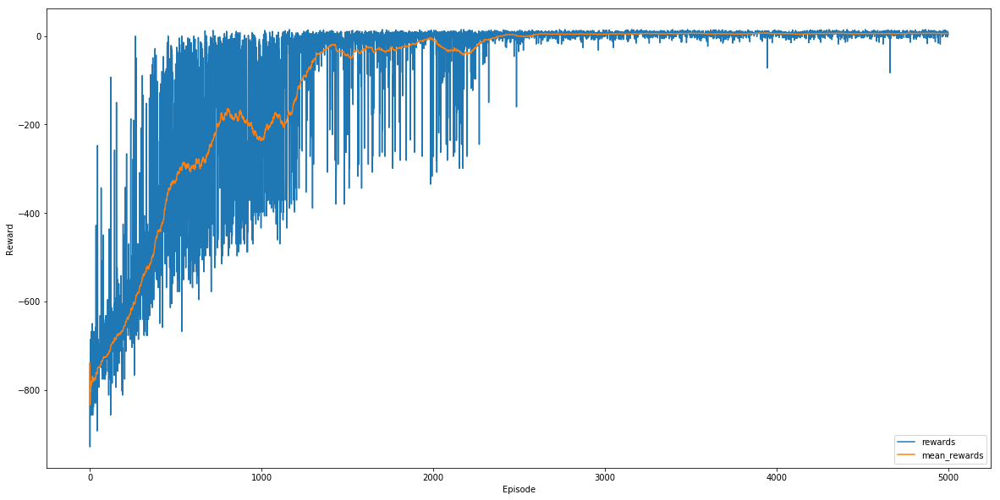

In [9]:
plt.rcParams['figure.figsize'] = (20, 10)
plot_rewards(episodes_rewards, 100)

In [5]:
# Adam Optimizer
agent = TaxiAgent(env,
                  name='one_hot_adam',
                  obs_represent='one-hot',
                  exploration=exp_schedule,
                  optimizer='Adam',
                  learning_rate=0.0003,
                  n_hidden=150,
                  steps_to_start_learn=100,
                  target_update_freq=1000)

Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2


In [6]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 5000
batch_size = 128 # 32
num_episodes = 5000

In [16]:
with open('./taxi_agent_ckpt/one_hot_adam_training.status', 'rb') as fp:
    training_status = pickle.load(fp)
    mean_episode_reward = training_status['mean_episode_reward']
    best_mean_episode_reward = training_status['best_mean_episode_reward']
    episode_durations = training_status['episode_durations'] 
    episodes_rewards = training_status['episodes_rewards']
    total_steps = training_status['total_steps']

In [8]:
# One-Hot Representation Adam
episode_durations = []
episodes_rewards = []
total_steps = 0
start_time = time.time()
for episode in range(num_episodes):
    episode_start_time = time.time()
    last_obs = env.reset()
    episode_reward = 0
    agent.episodes_seen += 1
    for t in count():
        agent.steps_count += 1
        total_steps += 1
        ### Step the env and store the transition
        # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
        last_idx = agent.replay_buffer.store_frame(agent.one_hot_generator.to_one_hot(last_obs))
        # encode_recent_observation will take the latest observation
        # that you pushed into the buffer and compute the corresponding
        # input that should be given to a Q network by appending some
        # previous frames.
        recent_observation = agent.replay_buffer.encode_recent_observation()
        action = agent.select_greedy_action(recent_observation)
        # Advance one step
        obs, reward, done, _ = env.step(action)
        episode_reward += reward
        # Store other info in replay memory
        agent.replay_buffer.store_effect(last_idx, action, reward, done)
        ### Perform experience replay and train the network.
        # Note that this is only done if the replay buffer contains enough samples
        # for us to learn something useful -- until then, the model will not be
        # initialized and random actions should be taken
        agent.learn(batch_size)
        ### Log progress and keep track of statistics
        if len(episodes_rewards) > 0:
            mean_episode_reward = np.mean(episodes_rewards[-100:])
        if len(episodes_rewards) > 100:
            best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)

        if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agent.steps_to_start_learn:
            print("Timestep %d" % (agent.steps_count,))
            print("mean reward (100 episodes) %f" % mean_episode_reward)
            print("best mean reward %f" % best_mean_episode_reward)
            print("episodes %d" % len(episodes_rewards))
            print("exploration value %f" % agent.epsilon)
            total_time = time.time() - start_time
            print("time since start: %.2f secs" % total_time)
            training_status = {}
            training_status['mean_episode_reward'] = mean_episode_reward
            training_status['best_mean_episode_reward'] = best_mean_episode_reward
            training_status['episode_durations'] = episode_durations
            training_status['episodes_rewards'] = episodes_rewards
            training_status['total_steps'] = total_steps
            with open('./taxi_agent_ckpt/one_hot_adam_training.status', 'wb') as fp:
                pickle.dump(training_status, fp)
            print("Saved training status @ ./taxi_agent_ckpt/one_hot_adam_training.status")
        # Resets the environment when reaching an episode boundary.
        if done:
            episode_durations.append(t + 1)
            episodes_rewards.append(episode_reward)
            print("Episode: ", agent.episodes_seen,
                  " Done, Reward: ", episode_reward,
                  " Step: ", agent.steps_count,
                 " Episode Time: %.2f secs" % (time.time() - episode_start_time))
            break
        last_obs = obs
print("Training Complete!")

Episode:  1  Done, Reward:  -866  Step:  200  Episode Time: 1.11 secs
Episode:  2  Done, Reward:  -731  Step:  400  Episode Time: 1.23 secs
Episode:  3  Done, Reward:  -803  Step:  600  Episode Time: 0.56 secs
Episode:  4  Done, Reward:  -749  Step:  800  Episode Time: 0.66 secs
Episode:  5  Done, Reward:  -704  Step:  1000  Episode Time: 1.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  6  Done, Reward:  -812  Step:  1200  Episode Time: 1.17 secs
Episode:  7  Done, Reward:  -668  Step:  1400  Episode Time: 0.98 secs
Episode:  8  Done, Reward:  -758  Step:  1600  Episode Time: 0.60 secs
Episode:  9  Done, Reward:  -803  Step:  1800  Episode Time: 2.05 secs
Episode:  10  Done, Reward:  -821  Step:  2000  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  11  Done, Reward:  -803  Step:  2200  Episode Time: 1.98 secs
Episode:  12  Done, Reward:  -866  Step:  2400  Episode Time: 1.98 

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  89  Done, Reward:  -722  Step:  17137  Episode Time: 2.71 secs
Episode:  90  Done, Reward:  -677  Step:  17337  Episode Time: 0.75 secs
Episode:  91  Done, Reward:  -353  Step:  17468  Episode Time: 0.64 secs
Episode:  92  Done, Reward:  -695  Step:  17668  Episode Time: 1.40 secs
Episode:  93  Done, Reward:  -598  Step:  17837  Episode Time: 0.58 secs
Episode:  94  Done, Reward:  -695  Step:  18037  Episode Time: 1.11 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  95  Done, Reward:  -351  Step:  18148  Episode Time: 0.30 secs
Episode:  96  Done, Reward:  -722  Step:  18348  Episode Time: 0.55 secs
Episode:  97  Done, Reward:  -767  Step:  18548  Episode Time: 0.62 secs
Episode:  98  Done, Reward:  -731  Step:  18748  Episode Time: 1.30 secs
Episode:  99  Done, Reward:  -803  Step:  18948  Episode Time: 0.68 secs
Saved Taxi Agent checkpoint @  ./taxi_agent

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  181  Done, Reward:  -677  Step:  30210  Episode Time: 0.99 secs
Episode:  182  Done, Reward:  -427  Step:  30361  Episode Time: 0.72 secs
Episode:  183  Done, Reward:  -632  Step:  30561  Episode Time: 1.03 secs
Episode:  184  Done, Reward:  -166  Step:  30622  Episode Time: 0.54 secs
Episode:  185  Done, Reward:  -486  Step:  30787  Episode Time: 0.84 secs
Episode:  186  Done, Reward:  -803  Step:  30987  Episode Time: 1.21 secs
Episode:  187  Done, Reward:  -214  Step:  31060  Episode Time: 0.35 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  188  Done, Reward:  -528  Step:  31249  Episode Time: 0.99 secs
Episode:  189  Done, Reward:  -528  Step:  31438  Episode Time: 1.18 secs
Episode:  190  Done, Reward:  -556  Step:  31583  Episode Time: 1.46 secs
Episode:  191  Done, Reward:  -555  Step:  31772  Episode Time: 1.72 secs
Episode:  192  Done, Reward:  -2

Episode:  279  Done, Reward:  -272  Step:  39183  Episode Time: 0.53 secs
Episode:  280  Done, Reward:  -314  Step:  39275  Episode Time: 0.50 secs
Episode:  281  Done, Reward:  -740  Step:  39475  Episode Time: 1.30 secs
Episode:  282  Done, Reward:  -321  Step:  39592  Episode Time: 0.56 secs
Episode:  283  Done, Reward:  -578  Step:  39792  Episode Time: 0.84 secs
Episode:  284  Done, Reward:  -99  Step:  39840  Episode Time: 0.36 secs
Episode:  285  Done, Reward:  -33  Step:  39867  Episode Time: 0.09 secs
Episode:  286  Done, Reward:  -154  Step:  39925  Episode Time: 0.21 secs
Episode:  287  Done, Reward:  -68  Step:  39960  Episode Time: 0.12 secs
Timestep 40000
mean reward (100 episodes) -257.510000
best mean reward -257.510000
episodes 287
exploration value 0.712793
time since start: 229.18 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_adam_training.status
Episode:  288  Done, Reward:  -237  Step:  40029  Episode Time: 0.24 secs
Episode:  289  Done, Reward:  -183  Ste

Episode:  377  Done, Reward:  -188  Step:  46216  Episode Time: 0.35 secs
Episode:  378  Done, Reward:  -66  Step:  46249  Episode Time: 0.22 secs
Episode:  379  Done, Reward:  -21  Step:  46264  Episode Time: 0.11 secs
Episode:  380  Done, Reward:  -560  Step:  46464  Episode Time: 2.20 secs
Episode:  381  Done, Reward:  -94  Step:  46516  Episode Time: 0.54 secs
Episode:  382  Done, Reward:  -31  Step:  46541  Episode Time: 0.25 secs
Episode:  383  Done, Reward:  -459  Step:  46733  Episode Time: 1.96 secs
Episode:  384  Done, Reward:  -104  Step:  46786  Episode Time: 0.34 secs
Episode:  385  Done, Reward:  -144  Step:  46852  Episode Time: 0.70 secs
Episode:  386  Done, Reward:  -51  Step:  46879  Episode Time: 0.22 secs
Episode:  387  Done, Reward:  -47  Step:  46902  Episode Time: 0.18 secs
Episode:  388  Done, Reward:  -569  Step:  47102  Episode Time: 2.55 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  389  Done, Reward:  -110  Step:

Episode:  480  Done, Reward:  -49  Step:  52226  Episode Time: 0.27 secs
Episode:  481  Done, Reward:  -63  Step:  52265  Episode Time: 0.16 secs
Episode:  482  Done, Reward:  -29  Step:  52279  Episode Time: 0.07 secs
Episode:  483  Done, Reward:  -54  Step:  52309  Episode Time: 0.32 secs
Episode:  484  Done, Reward:  -35  Step:  52329  Episode Time: 0.08 secs
Episode:  485  Done, Reward:  -225  Step:  52413  Episode Time: 0.63 secs
Episode:  486  Done, Reward:  -19  Step:  52444  Episode Time: 0.38 secs
Episode:  487  Done, Reward:  -76  Step:  52478  Episode Time: 0.14 secs
Episode:  488  Done, Reward:  -28  Step:  52500  Episode Time: 0.11 secs
Episode:  489  Done, Reward:  -161  Step:  52583  Episode Time: 0.46 secs
Episode:  490  Done, Reward:  -569  Step:  52783  Episode Time: 1.60 secs
Episode:  491  Done, Reward:  -26  Step:  52803  Episode Time: 0.28 secs
Episode:  492  Done, Reward:  -36  Step:  52824  Episode Time: 0.22 secs
Episode:  493  Done, Reward:  -56  Step:  52856 

Episode:  585  Done, Reward:  -56  Step:  56514  Episode Time: 0.25 secs
Episode:  586  Done, Reward:  -96  Step:  56550  Episode Time: 0.29 secs
Episode:  587  Done, Reward:  -4  Step:  56575  Episode Time: 0.10 secs
Episode:  588  Done, Reward:  -52  Step:  56603  Episode Time: 0.18 secs
Episode:  589  Done, Reward:  -40  Step:  56637  Episode Time: 0.59 secs
Episode:  590  Done, Reward:  -32  Step:  56654  Episode Time: 0.19 secs
Episode:  591  Done, Reward:  1  Step:  56665  Episode Time: 0.11 secs
Episode:  592  Done, Reward:  -71  Step:  56694  Episode Time: 0.30 secs
Episode:  593  Done, Reward:  -43  Step:  56722  Episode Time: 0.12 secs
Episode:  594  Done, Reward:  -37  Step:  56753  Episode Time: 0.15 secs
Episode:  595  Done, Reward:  -20  Step:  56767  Episode Time: 0.10 secs
Episode:  596  Done, Reward:  -71  Step:  56805  Episode Time: 0.23 secs
Episode:  597  Done, Reward:  -39  Step:  56829  Episode Time: 0.24 secs
Episode:  598  Done, Reward:  -56  Step:  56861  Episo

Episode:  695  Done, Reward:  -54  Step:  59513  Episode Time: 0.25 secs
Episode:  696  Done, Reward:  -86  Step:  59557  Episode Time: 0.18 secs
Episode:  697  Done, Reward:  -38  Step:  59580  Episode Time: 0.13 secs
Episode:  698  Done, Reward:  -52  Step:  59608  Episode Time: 0.15 secs
Episode:  699  Done, Reward:  -23  Step:  59625  Episode Time: 0.09 secs
Episode:  700  Done, Reward:  -15  Step:  59643  Episode Time: 0.15 secs
Episode:  701  Done, Reward:  -34  Step:  59662  Episode Time: 0.15 secs
Episode:  702  Done, Reward:  -9  Step:  59683  Episode Time: 0.26 secs
Episode:  703  Done, Reward:  0  Step:  59695  Episode Time: 0.09 secs
Episode:  704  Done, Reward:  -58  Step:  59729  Episode Time: 0.35 secs
Episode:  705  Done, Reward:  -40  Step:  59754  Episode Time: 0.39 secs
Episode:  706  Done, Reward:  -38  Step:  59777  Episode Time: 0.18 secs
Episode:  707  Done, Reward:  -60  Step:  59822  Episode Time: 0.43 secs
Episode:  708  Done, Reward:  0  Step:  59834  Episode

Episode:  804  Done, Reward:  -35  Step:  62027  Episode Time: 0.16 secs
Episode:  805  Done, Reward:  -40  Step:  62052  Episode Time: 0.18 secs
Episode:  806  Done, Reward:  5  Step:  62068  Episode Time: 0.08 secs
Episode:  807  Done, Reward:  -11  Step:  62082  Episode Time: 0.06 secs
Episode:  808  Done, Reward:  -14  Step:  62099  Episode Time: 0.07 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  809  Done, Reward:  -179  Step:  62155  Episode Time: 0.28 secs
Episode:  810  Done, Reward:  -24  Step:  62173  Episode Time: 0.07 secs
Episode:  811  Done, Reward:  -56  Step:  62205  Episode Time: 0.20 secs
Episode:  812  Done, Reward:  -30  Step:  62229  Episode Time: 0.18 secs
Episode:  813  Done, Reward:  -12  Step:  62253  Episode Time: 0.14 secs
Episode:  814  Done, Reward:  -25  Step:  62272  Episode Time: 0.28 secs
Episode:  815  Done, Reward:  -7  Step:  62291  Episode Time: 0.08 secs
Episode:  816  Done, Reward:  -4  Step:  62307  E

Episode:  915  Done, Reward:  -17  Step:  64334  Episode Time: 0.10 secs
Episode:  916  Done, Reward:  -8  Step:  64345  Episode Time: 0.04 secs
Episode:  917  Done, Reward:  -30  Step:  64369  Episode Time: 0.09 secs
Episode:  918  Done, Reward:  -9  Step:  64390  Episode Time: 0.11 secs
Episode:  919  Done, Reward:  -12  Step:  64414  Episode Time: 0.25 secs
Episode:  920  Done, Reward:  -10  Step:  64436  Episode Time: 0.43 secs
Episode:  921  Done, Reward:  -31  Step:  64461  Episode Time: 0.23 secs
Episode:  922  Done, Reward:  6  Step:  64476  Episode Time: 0.06 secs
Episode:  923  Done, Reward:  -12  Step:  64500  Episode Time: 0.10 secs
Episode:  924  Done, Reward:  -5  Step:  64517  Episode Time: 0.09 secs
Episode:  925  Done, Reward:  -10  Step:  64530  Episode Time: 0.05 secs
Episode:  926  Done, Reward:  -10  Step:  64552  Episode Time: 0.12 secs
Episode:  927  Done, Reward:  -58  Step:  64577  Episode Time: 0.19 secs
Episode:  928  Done, Reward:  -3  Step:  64592  Episode 

Episode:  1024  Done, Reward:  -7  Step:  66478  Episode Time: 0.12 secs
Episode:  1025  Done, Reward:  11  Step:  66488  Episode Time: 0.07 secs
Episode:  1026  Done, Reward:  3  Step:  66506  Episode Time: 0.13 secs
Episode:  1027  Done, Reward:  -2  Step:  66520  Episode Time: 0.11 secs
Episode:  1028  Done, Reward:  -7  Step:  66539  Episode Time: 0.14 secs
Episode:  1029  Done, Reward:  -45  Step:  66560  Episode Time: 0.14 secs
Episode:  1030  Done, Reward:  -24  Step:  66578  Episode Time: 0.14 secs
Episode:  1031  Done, Reward:  -6  Step:  66596  Episode Time: 0.12 secs
Episode:  1032  Done, Reward:  7  Step:  66610  Episode Time: 0.11 secs
Episode:  1033  Done, Reward:  8  Step:  66623  Episode Time: 0.09 secs
Episode:  1034  Done, Reward:  3  Step:  66632  Episode Time: 0.06 secs
Episode:  1035  Done, Reward:  -5  Step:  66649  Episode Time: 0.13 secs
Episode:  1036  Done, Reward:  -55  Step:  66671  Episode Time: 0.15 secs
Episode:  1037  Done, Reward:  -31  Step:  66696  Ep

Episode:  1134  Done, Reward:  -9  Step:  68401  Episode Time: 0.31 secs
Episode:  1135  Done, Reward:  -16  Step:  68420  Episode Time: 0.26 secs
Episode:  1136  Done, Reward:  -5  Step:  68437  Episode Time: 0.24 secs
Episode:  1137  Done, Reward:  -16  Step:  68456  Episode Time: 0.26 secs
Episode:  1138  Done, Reward:  -1  Step:  68469  Episode Time: 0.18 secs
Episode:  1139  Done, Reward:  -14  Step:  68486  Episode Time: 0.42 secs
Episode:  1140  Done, Reward:  -27  Step:  68507  Episode Time: 0.29 secs
Episode:  1141  Done, Reward:  -23  Step:  68524  Episode Time: 0.23 secs
Episode:  1142  Done, Reward:  -27  Step:  68554  Episode Time: 0.41 secs
Episode:  1143  Done, Reward:  -8  Step:  68565  Episode Time: 0.15 secs
Episode:  1144  Done, Reward:  8  Step:  68578  Episode Time: 0.18 secs
Episode:  1145  Done, Reward:  2  Step:  68597  Episode Time: 0.26 secs
Episode:  1146  Done, Reward:  -5  Step:  68614  Episode Time: 0.15 secs
Episode:  1147  Done, Reward:  -11  Step:  6862

Episode:  1242  Done, Reward:  -16  Step:  70363  Episode Time: 0.10 secs
Episode:  1243  Done, Reward:  10  Step:  70374  Episode Time: 0.04 secs
Episode:  1244  Done, Reward:  -2  Step:  70388  Episode Time: 0.05 secs
Episode:  1245  Done, Reward:  -25  Step:  70407  Episode Time: 0.07 secs
Episode:  1246  Done, Reward:  1  Step:  70418  Episode Time: 0.06 secs
Episode:  1247  Done, Reward:  -11  Step:  70432  Episode Time: 0.06 secs
Episode:  1248  Done, Reward:  -25  Step:  70451  Episode Time: 0.13 secs
Episode:  1249  Done, Reward:  -60  Step:  70487  Episode Time: 0.24 secs
Episode:  1250  Done, Reward:  -12  Step:  70502  Episode Time: 0.06 secs
Episode:  1251  Done, Reward:  -11  Step:  70525  Episode Time: 0.09 secs
Episode:  1252  Done, Reward:  -22  Step:  70541  Episode Time: 0.07 secs
Episode:  1253  Done, Reward:  4  Step:  70558  Episode Time: 0.07 secs
Episode:  1254  Done, Reward:  -52  Step:  70586  Episode Time: 0.21 secs
Episode:  1255  Done, Reward:  4  Step:  706

Episode:  1355  Done, Reward:  8  Step:  72332  Episode Time: 0.07 secs
Episode:  1356  Done, Reward:  1  Step:  72343  Episode Time: 0.04 secs
Episode:  1357  Done, Reward:  -18  Step:  72364  Episode Time: 0.09 secs
Episode:  1358  Done, Reward:  -21  Step:  72388  Episode Time: 0.11 secs
Episode:  1359  Done, Reward:  -19  Step:  72410  Episode Time: 0.09 secs
Episode:  1360  Done, Reward:  -1  Step:  72423  Episode Time: 0.05 secs
Episode:  1361  Done, Reward:  13  Step:  72431  Episode Time: 0.03 secs
Episode:  1362  Done, Reward:  -16  Step:  72450  Episode Time: 0.10 secs
Episode:  1363  Done, Reward:  -1  Step:  72463  Episode Time: 0.26 secs
Episode:  1364  Done, Reward:  6  Step:  72478  Episode Time: 0.14 secs
Episode:  1365  Done, Reward:  -1  Step:  72491  Episode Time: 0.19 secs
Episode:  1366  Done, Reward:  -7  Step:  72510  Episode Time: 0.27 secs
Episode:  1367  Done, Reward:  6  Step:  72525  Episode Time: 0.20 secs
Episode:  1368  Done, Reward:  3  Step:  72543  Epi

Episode:  1466  Done, Reward:  -16  Step:  74143  Episode Time: 0.27 secs
Episode:  1467  Done, Reward:  -10  Step:  74165  Episode Time: 0.48 secs
Episode:  1468  Done, Reward:  -4  Step:  74181  Episode Time: 0.23 secs
Episode:  1469  Done, Reward:  -4  Step:  74197  Episode Time: 0.23 secs
Episode:  1470  Done, Reward:  -37  Step:  74219  Episode Time: 0.31 secs
Episode:  1471  Done, Reward:  -23  Step:  74245  Episode Time: 0.29 secs
Episode:  1472  Done, Reward:  -16  Step:  74264  Episode Time: 0.13 secs
Episode:  1473  Done, Reward:  -27  Step:  74285  Episode Time: 0.16 secs
Episode:  1474  Done, Reward:  -4  Step:  74301  Episode Time: 0.11 secs
Episode:  1475  Done, Reward:  -12  Step:  74316  Episode Time: 0.11 secs
Episode:  1476  Done, Reward:  -23  Step:  74333  Episode Time: 0.12 secs
Episode:  1477  Done, Reward:  -4  Step:  74349  Episode Time: 0.13 secs
Episode:  1478  Done, Reward:  -2  Step:  74363  Episode Time: 0.30 secs
Episode:  1479  Done, Reward:  5  Step:  74

Episode:  1575  Done, Reward:  5  Step:  75853  Episode Time: 0.11 secs
Episode:  1576  Done, Reward:  -2  Step:  75867  Episode Time: 0.39 secs
Episode:  1577  Done, Reward:  6  Step:  75882  Episode Time: 0.06 secs
Episode:  1578  Done, Reward:  -7  Step:  75901  Episode Time: 0.36 secs
Episode:  1579  Done, Reward:  3  Step:  75919  Episode Time: 0.09 secs
Episode:  1580  Done, Reward:  -6  Step:  75937  Episode Time: 0.17 secs
Episode:  1581  Done, Reward:  -6  Step:  75955  Episode Time: 0.28 secs
Episode:  1582  Done, Reward:  -16  Step:  75974  Episode Time: 0.32 secs
Episode:  1583  Done, Reward:  -21  Step:  75998  Episode Time: 0.32 secs
Episode:  1584  Done, Reward:  9  Step:  76010  Episode Time: 0.24 secs
Episode:  1585  Done, Reward:  5  Step:  76026  Episode Time: 0.07 secs
Episode:  1586  Done, Reward:  12  Step:  76035  Episode Time: 0.04 secs
Episode:  1587  Done, Reward:  10  Step:  76046  Episode Time: 0.31 secs
Episode:  1588  Done, Reward:  -1  Step:  76059  Episo

Episode:  1686  Done, Reward:  5  Step:  77581  Episode Time: 0.09 secs
Episode:  1687  Done, Reward:  13  Step:  77589  Episode Time: 0.04 secs
Episode:  1688  Done, Reward:  -7  Step:  77608  Episode Time: 0.14 secs
Episode:  1689  Done, Reward:  -12  Step:  77632  Episode Time: 0.19 secs
Episode:  1690  Done, Reward:  -8  Step:  77652  Episode Time: 0.17 secs
Episode:  1691  Done, Reward:  -6  Step:  77670  Episode Time: 0.15 secs
Episode:  1692  Done, Reward:  10  Step:  77681  Episode Time: 0.08 secs
Episode:  1693  Done, Reward:  -7  Step:  77700  Episode Time: 0.14 secs
Episode:  1694  Done, Reward:  11  Step:  77710  Episode Time: 0.18 secs
Episode:  1695  Done, Reward:  -9  Step:  77722  Episode Time: 0.16 secs
Episode:  1696  Done, Reward:  -16  Step:  77741  Episode Time: 0.08 secs
Episode:  1697  Done, Reward:  11  Step:  77751  Episode Time: 0.04 secs
Episode:  1698  Done, Reward:  9  Step:  77763  Episode Time: 0.05 secs
Episode:  1699  Done, Reward:  -5  Step:  77780  Ep

Episode:  1797  Done, Reward:  -3  Step:  79220  Episode Time: 0.15 secs
Episode:  1798  Done, Reward:  12  Step:  79229  Episode Time: 0.09 secs
Episode:  1799  Done, Reward:  5  Step:  79245  Episode Time: 0.13 secs
Episode:  1800  Done, Reward:  -5  Step:  79262  Episode Time: 0.14 secs
Episode:  1801  Done, Reward:  1  Step:  79273  Episode Time: 0.10 secs
Episode:  1802  Done, Reward:  8  Step:  79286  Episode Time: 0.30 secs
Episode:  1803  Done, Reward:  1  Step:  79306  Episode Time: 0.28 secs
Episode:  1804  Done, Reward:  9  Step:  79318  Episode Time: 0.11 secs
Episode:  1805  Done, Reward:  9  Step:  79330  Episode Time: 0.11 secs
Episode:  1806  Done, Reward:  12  Step:  79339  Episode Time: 0.08 secs
Episode:  1807  Done, Reward:  -9  Step:  79360  Episode Time: 0.20 secs
Episode:  1808  Done, Reward:  5  Step:  79376  Episode Time: 0.09 secs
Episode:  1809  Done, Reward:  11  Step:  79386  Episode Time: 0.11 secs
Episode:  1810  Done, Reward:  -15  Step:  79404  Episode 

Episode:  1906  Done, Reward:  11  Step:  80811  Episode Time: 0.06 secs
Episode:  1907  Done, Reward:  -2  Step:  80825  Episode Time: 0.07 secs
Episode:  1908  Done, Reward:  4  Step:  80842  Episode Time: 0.20 secs
Episode:  1909  Done, Reward:  -12  Step:  80857  Episode Time: 0.08 secs
Episode:  1910  Done, Reward:  -19  Step:  80879  Episode Time: 0.45 secs
Episode:  1911  Done, Reward:  -20  Step:  80902  Episode Time: 0.12 secs
Episode:  1912  Done, Reward:  -5  Step:  80919  Episode Time: 0.10 secs
Episode:  1913  Done, Reward:  0  Step:  80931  Episode Time: 0.07 secs
Episode:  1914  Done, Reward:  8  Step:  80944  Episode Time: 0.14 secs
Episode:  1915  Done, Reward:  -7  Step:  80963  Episode Time: 0.17 secs
Episode:  1916  Done, Reward:  6  Step:  80978  Episode Time: 0.13 secs
Episode:  1917  Done, Reward:  7  Step:  80992  Episode Time: 0.11 secs
Episode:  1918  Done, Reward:  -1  Step:  81005  Episode Time: 0.11 secs
Episode:  1919  Done, Reward:  7  Step:  81019  Episo

Episode:  2017  Done, Reward:  2  Step:  82444  Episode Time: 0.10 secs
Episode:  2018  Done, Reward:  -3  Step:  82459  Episode Time: 0.06 secs
Episode:  2019  Done, Reward:  10  Step:  82470  Episode Time: 0.05 secs
Episode:  2020  Done, Reward:  -12  Step:  82485  Episode Time: 0.07 secs
Episode:  2021  Done, Reward:  -36  Step:  82506  Episode Time: 0.11 secs
Episode:  2022  Done, Reward:  -6  Step:  82524  Episode Time: 0.08 secs
Episode:  2023  Done, Reward:  1  Step:  82535  Episode Time: 0.08 secs
Episode:  2024  Done, Reward:  -5  Step:  82552  Episode Time: 0.14 secs
Episode:  2025  Done, Reward:  -11  Step:  82566  Episode Time: 0.10 secs
Episode:  2026  Done, Reward:  -13  Step:  82582  Episode Time: 0.59 secs
Episode:  2027  Done, Reward:  7  Step:  82596  Episode Time: 0.17 secs
Episode:  2028  Done, Reward:  -6  Step:  82614  Episode Time: 0.25 secs
Episode:  2029  Done, Reward:  9  Step:  82626  Episode Time: 0.13 secs
Episode:  2030  Done, Reward:  -5  Step:  82643  Ep

Episode:  2130  Done, Reward:  6  Step:  84093  Episode Time: 0.20 secs
Episode:  2131  Done, Reward:  -15  Step:  84111  Episode Time: 0.41 secs
Episode:  2132  Done, Reward:  -4  Step:  84127  Episode Time: 0.30 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  2133  Done, Reward:  -10  Step:  84140  Episode Time: 0.18 secs
Episode:  2134  Done, Reward:  7  Step:  84154  Episode Time: 0.34 secs
Episode:  2135  Done, Reward:  8  Step:  84167  Episode Time: 0.35 secs
Episode:  2136  Done, Reward:  6  Step:  84182  Episode Time: 0.26 secs
Episode:  2137  Done, Reward:  9  Step:  84194  Episode Time: 0.16 secs
Episode:  2138  Done, Reward:  -11  Step:  84208  Episode Time: 0.17 secs
Episode:  2139  Done, Reward:  -1  Step:  84221  Episode Time: 0.33 secs
Episode:  2140  Done, Reward:  11  Step:  84231  Episode Time: 0.07 secs
Episode:  2141  Done, Reward:  5  Step:  84247  Episode Time: 0.12 secs
Episode:  2142  Done, Reward:  7  Step:  84261  Ep

Episode:  2239  Done, Reward:  5  Step:  85645  Episode Time: 0.15 secs
Episode:  2240  Done, Reward:  -5  Step:  85662  Episode Time: 0.24 secs
Episode:  2241  Done, Reward:  10  Step:  85673  Episode Time: 0.15 secs
Episode:  2242  Done, Reward:  7  Step:  85687  Episode Time: 0.21 secs
Episode:  2243  Done, Reward:  3  Step:  85705  Episode Time: 0.24 secs
Episode:  2244  Done, Reward:  -4  Step:  85721  Episode Time: 0.17 secs
Episode:  2245  Done, Reward:  12  Step:  85730  Episode Time: 0.07 secs
Episode:  2246  Done, Reward:  9  Step:  85742  Episode Time: 0.09 secs
Episode:  2247  Done, Reward:  -6  Step:  85760  Episode Time: 0.16 secs
Episode:  2248  Done, Reward:  6  Step:  85775  Episode Time: 0.17 secs
Episode:  2249  Done, Reward:  -5  Step:  85792  Episode Time: 0.43 secs
Episode:  2250  Done, Reward:  -2  Step:  85806  Episode Time: 0.19 secs
Episode:  2251  Done, Reward:  5  Step:  85822  Episode Time: 0.23 secs
Episode:  2252  Done, Reward:  13  Step:  85830  Episode 

Episode:  2351  Done, Reward:  0  Step:  87256  Episode Time: 0.14 secs
Episode:  2352  Done, Reward:  11  Step:  87266  Episode Time: 0.07 secs
Episode:  2353  Done, Reward:  2  Step:  87285  Episode Time: 0.15 secs
Episode:  2354  Done, Reward:  -5  Step:  87302  Episode Time: 0.15 secs
Episode:  2355  Done, Reward:  0  Step:  87314  Episode Time: 0.13 secs
Episode:  2356  Done, Reward:  0  Step:  87326  Episode Time: 0.10 secs
Episode:  2357  Done, Reward:  -1  Step:  87339  Episode Time: 0.14 secs
Episode:  2358  Done, Reward:  5  Step:  87355  Episode Time: 0.12 secs
Episode:  2359  Done, Reward:  9  Step:  87367  Episode Time: 0.10 secs
Episode:  2360  Done, Reward:  4  Step:  87384  Episode Time: 0.13 secs
Episode:  2361  Done, Reward:  9  Step:  87396  Episode Time: 0.14 secs
Episode:  2362  Done, Reward:  8  Step:  87409  Episode Time: 0.10 secs
Episode:  2363  Done, Reward:  -3  Step:  87424  Episode Time: 0.31 secs
Episode:  2364  Done, Reward:  5  Step:  87440  Episode Time

Episode:  2465  Done, Reward:  8  Step:  88867  Episode Time: 0.08 secs
Episode:  2466  Done, Reward:  9  Step:  88879  Episode Time: 0.05 secs
Episode:  2467  Done, Reward:  -2  Step:  88893  Episode Time: 0.08 secs
Episode:  2468  Done, Reward:  13  Step:  88901  Episode Time: 0.04 secs
Episode:  2469  Done, Reward:  12  Step:  88910  Episode Time: 0.05 secs
Episode:  2470  Done, Reward:  -5  Step:  88927  Episode Time: 0.08 secs
Episode:  2471  Done, Reward:  -1  Step:  88940  Episode Time: 0.06 secs
Episode:  2472  Done, Reward:  -5  Step:  88957  Episode Time: 0.09 secs
Episode:  2473  Done, Reward:  -8  Step:  88977  Episode Time: 0.12 secs
Episode:  2474  Done, Reward:  8  Step:  88990  Episode Time: 0.28 secs
Episode:  2475  Done, Reward:  -26  Step:  89010  Episode Time: 0.22 secs
Episode:  2476  Done, Reward:  10  Step:  89021  Episode Time: 0.13 secs
Episode:  2477  Done, Reward:  -5  Step:  89038  Episode Time: 0.20 secs
Episode:  2478  Done, Reward:  9  Step:  89050  Episo

Episode:  2574  Done, Reward:  -2  Step:  90400  Episode Time: 0.20 secs
Episode:  2575  Done, Reward:  9  Step:  90412  Episode Time: 0.09 secs
Episode:  2576  Done, Reward:  -2  Step:  90426  Episode Time: 0.23 secs
Episode:  2577  Done, Reward:  6  Step:  90441  Episode Time: 0.13 secs
Episode:  2578  Done, Reward:  -6  Step:  90459  Episode Time: 0.14 secs
Episode:  2579  Done, Reward:  8  Step:  90472  Episode Time: 0.10 secs
Episode:  2580  Done, Reward:  12  Step:  90481  Episode Time: 0.14 secs
Episode:  2581  Done, Reward:  7  Step:  90495  Episode Time: 0.19 secs
Episode:  2582  Done, Reward:  2  Step:  90514  Episode Time: 0.22 secs
Episode:  2583  Done, Reward:  0  Step:  90526  Episode Time: 0.36 secs
Episode:  2584  Done, Reward:  10  Step:  90537  Episode Time: 0.15 secs
Episode:  2585  Done, Reward:  3  Step:  90555  Episode Time: 0.26 secs
Episode:  2586  Done, Reward:  1  Step:  90575  Episode Time: 0.28 secs
Episode:  2587  Done, Reward:  8  Step:  90588  Episode Tim

Episode:  2687  Done, Reward:  6  Step:  91934  Episode Time: 0.20 secs
Episode:  2688  Done, Reward:  6  Step:  91949  Episode Time: 0.09 secs
Episode:  2689  Done, Reward:  5  Step:  91965  Episode Time: 0.07 secs
Episode:  2690  Done, Reward:  11  Step:  91975  Episode Time: 0.27 secs
Episode:  2691  Done, Reward:  -2  Step:  91989  Episode Time: 0.06 secs
Episode:  2692  Done, Reward:  7  Step:  92003  Episode Time: 0.06 secs
Episode:  2693  Done, Reward:  -7  Step:  92022  Episode Time: 0.14 secs
Episode:  2694  Done, Reward:  9  Step:  92034  Episode Time: 0.05 secs
Episode:  2695  Done, Reward:  10  Step:  92045  Episode Time: 0.07 secs
Episode:  2696  Done, Reward:  9  Step:  92057  Episode Time: 0.05 secs
Episode:  2697  Done, Reward:  -1  Step:  92070  Episode Time: 0.07 secs
Episode:  2698  Done, Reward:  6  Step:  92085  Episode Time: 0.07 secs
Episode:  2699  Done, Reward:  9  Step:  92097  Episode Time: 0.05 secs
Episode:  2700  Done, Reward:  10  Step:  92108  Episode Ti

Episode:  2799  Done, Reward:  13  Step:  93482  Episode Time: 0.12 secs
Episode:  2800  Done, Reward:  12  Step:  93491  Episode Time: 0.12 secs
Episode:  2801  Done, Reward:  -3  Step:  93506  Episode Time: 0.20 secs
Episode:  2802  Done, Reward:  10  Step:  93517  Episode Time: 0.13 secs
Episode:  2803  Done, Reward:  7  Step:  93531  Episode Time: 0.18 secs
Episode:  2804  Done, Reward:  -15  Step:  93549  Episode Time: 0.45 secs
Episode:  2805  Done, Reward:  -16  Step:  93568  Episode Time: 0.27 secs
Episode:  2806  Done, Reward:  5  Step:  93584  Episode Time: 0.24 secs
Episode:  2807  Done, Reward:  11  Step:  93594  Episode Time: 0.14 secs
Episode:  2808  Done, Reward:  12  Step:  93603  Episode Time: 0.12 secs
Episode:  2809  Done, Reward:  -2  Step:  93617  Episode Time: 0.24 secs
Episode:  2810  Done, Reward:  -1  Step:  93630  Episode Time: 0.18 secs
Episode:  2811  Done, Reward:  9  Step:  93642  Episode Time: 0.18 secs
Episode:  2812  Done, Reward:  6  Step:  93657  Epis

Episode:  2911  Done, Reward:  9  Step:  95034  Episode Time: 0.09 secs
Episode:  2912  Done, Reward:  7  Step:  95048  Episode Time: 0.10 secs
Episode:  2913  Done, Reward:  3  Step:  95066  Episode Time: 0.14 secs
Episode:  2914  Done, Reward:  -3  Step:  95081  Episode Time: 0.12 secs
Episode:  2915  Done, Reward:  11  Step:  95091  Episode Time: 0.14 secs
Episode:  2916  Done, Reward:  9  Step:  95103  Episode Time: 0.36 secs
Episode:  2917  Done, Reward:  -16  Step:  95122  Episode Time: 0.27 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  2918  Done, Reward:  10  Step:  95133  Episode Time: 0.15 secs
Episode:  2919  Done, Reward:  12  Step:  95142  Episode Time: 0.13 secs
Episode:  2920  Done, Reward:  4  Step:  95159  Episode Time: 0.23 secs
Episode:  2921  Done, Reward:  -4  Step:  95175  Episode Time: 0.23 secs
Episode:  2922  Done, Reward:  12  Step:  95184  Episode Time: 0.12 secs
Episode:  2923  Done, Reward:  10  Step:  95195  Ep

Episode:  3023  Done, Reward:  -4  Step:  96570  Episode Time: 0.07 secs
Episode:  3024  Done, Reward:  -13  Step:  96586  Episode Time: 0.07 secs
Episode:  3025  Done, Reward:  8  Step:  96599  Episode Time: 0.05 secs
Episode:  3026  Done, Reward:  14  Step:  96606  Episode Time: 0.05 secs
Episode:  3027  Done, Reward:  1  Step:  96617  Episode Time: 0.09 secs
Episode:  3028  Done, Reward:  -4  Step:  96633  Episode Time: 0.12 secs
Episode:  3029  Done, Reward:  11  Step:  96643  Episode Time: 0.07 secs
Episode:  3030  Done, Reward:  9  Step:  96655  Episode Time: 0.09 secs
Episode:  3031  Done, Reward:  4  Step:  96672  Episode Time: 0.12 secs
Episode:  3032  Done, Reward:  8  Step:  96685  Episode Time: 0.14 secs
Episode:  3033  Done, Reward:  8  Step:  96698  Episode Time: 0.20 secs
Episode:  3034  Done, Reward:  2  Step:  96708  Episode Time: 0.06 secs
Episode:  3035  Done, Reward:  14  Step:  96715  Episode Time: 0.05 secs
Episode:  3036  Done, Reward:  -3  Step:  96730  Episode 

Episode:  3138  Done, Reward:  -13  Step:  98074  Episode Time: 0.12 secs
Episode:  3139  Done, Reward:  7  Step:  98088  Episode Time: 0.11 secs
Episode:  3140  Done, Reward:  7  Step:  98102  Episode Time: 0.08 secs
Episode:  3141  Done, Reward:  10  Step:  98113  Episode Time: 0.10 secs
Episode:  3142  Done, Reward:  10  Step:  98124  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  3143  Done, Reward:  -4  Step:  98140  Episode Time: 0.08 secs
Episode:  3144  Done, Reward:  -7  Step:  98159  Episode Time: 0.34 secs
Episode:  3145  Done, Reward:  7  Step:  98173  Episode Time: 0.15 secs
Episode:  3146  Done, Reward:  -6  Step:  98191  Episode Time: 0.18 secs
Episode:  3147  Done, Reward:  8  Step:  98204  Episode Time: 0.07 secs
Episode:  3148  Done, Reward:  7  Step:  98218  Episode Time: 0.08 secs
Episode:  3149  Done, Reward:  -3  Step:  98233  Episode Time: 0.08 secs
Episode:  3150  Done, Reward:  -4  Step:  98249  Ep

Episode:  3250  Done, Reward:  5  Step:  99569  Episode Time: 0.14 secs
Episode:  3251  Done, Reward:  8  Step:  99582  Episode Time: 0.11 secs
Episode:  3252  Done, Reward:  14  Step:  99589  Episode Time: 0.06 secs
Episode:  3253  Done, Reward:  -3  Step:  99604  Episode Time: 0.14 secs
Episode:  3254  Done, Reward:  11  Step:  99614  Episode Time: 0.08 secs
Episode:  3255  Done, Reward:  7  Step:  99628  Episode Time: 0.12 secs
Episode:  3256  Done, Reward:  11  Step:  99638  Episode Time: 0.14 secs
Episode:  3257  Done, Reward:  9  Step:  99650  Episode Time: 0.32 secs
Episode:  3258  Done, Reward:  7  Step:  99664  Episode Time: 0.07 secs
Episode:  3259  Done, Reward:  5  Step:  99680  Episode Time: 0.07 secs
Episode:  3260  Done, Reward:  -5  Step:  99697  Episode Time: 0.08 secs
Episode:  3261  Done, Reward:  11  Step:  99707  Episode Time: 0.07 secs
Episode:  3262  Done, Reward:  6  Step:  99722  Episode Time: 0.13 secs
Episode:  3263  Done, Reward:  4  Step:  99739  Episode Ti

Episode:  3358  Done, Reward:  6  Step:  101000  Episode Time: 0.38 secs
Episode:  3359  Done, Reward:  6  Step:  101015  Episode Time: 0.18 secs
Episode:  3360  Done, Reward:  10  Step:  101026  Episode Time: 0.15 secs
Episode:  3361  Done, Reward:  13  Step:  101034  Episode Time: 0.10 secs
Episode:  3362  Done, Reward:  9  Step:  101046  Episode Time: 0.13 secs
Episode:  3363  Done, Reward:  -2  Step:  101060  Episode Time: 0.23 secs
Episode:  3364  Done, Reward:  9  Step:  101072  Episode Time: 0.19 secs
Episode:  3365  Done, Reward:  1  Step:  101083  Episode Time: 0.20 secs
Episode:  3366  Done, Reward:  11  Step:  101093  Episode Time: 0.14 secs
Episode:  3367  Done, Reward:  12  Step:  101102  Episode Time: 0.07 secs
Episode:  3368  Done, Reward:  8  Step:  101115  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  3369  Done, Reward:  -16  Step:  101134  Episode Time: 0.38 secs
Episode:  3370  Done, Reward:  10  Step:

Episode:  3468  Done, Reward:  3  Step:  102462  Episode Time: 0.42 secs
Episode:  3469  Done, Reward:  8  Step:  102475  Episode Time: 0.17 secs
Episode:  3470  Done, Reward:  7  Step:  102489  Episode Time: 0.19 secs
Episode:  3471  Done, Reward:  4  Step:  102506  Episode Time: 0.23 secs
Episode:  3472  Done, Reward:  5  Step:  102522  Episode Time: 0.21 secs
Episode:  3473  Done, Reward:  11  Step:  102532  Episode Time: 0.13 secs
Episode:  3474  Done, Reward:  7  Step:  102546  Episode Time: 0.19 secs
Episode:  3475  Done, Reward:  7  Step:  102560  Episode Time: 0.18 secs
Episode:  3476  Done, Reward:  6  Step:  102575  Episode Time: 0.13 secs
Episode:  3477  Done, Reward:  -3  Step:  102590  Episode Time: 0.15 secs
Episode:  3478  Done, Reward:  -2  Step:  102604  Episode Time: 0.17 secs
Episode:  3479  Done, Reward:  6  Step:  102619  Episode Time: 0.35 secs
Episode:  3480  Done, Reward:  10  Step:  102630  Episode Time: 0.08 secs
Episode:  3481  Done, Reward:  10  Step:  10264

Episode:  3582  Done, Reward:  9  Step:  104004  Episode Time: 0.05 secs
Episode:  3583  Done, Reward:  6  Step:  104019  Episode Time: 0.08 secs
Episode:  3584  Done, Reward:  9  Step:  104031  Episode Time: 0.05 secs
Episode:  3585  Done, Reward:  -10  Step:  104053  Episode Time: 0.10 secs
Episode:  3586  Done, Reward:  0  Step:  104065  Episode Time: 0.06 secs
Episode:  3587  Done, Reward:  6  Step:  104080  Episode Time: 0.17 secs
Episode:  3588  Done, Reward:  9  Step:  104092  Episode Time: 0.19 secs
Episode:  3589  Done, Reward:  -2  Step:  104106  Episode Time: 0.11 secs
Episode:  3590  Done, Reward:  8  Step:  104119  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_adam.pth
Episode:  3591  Done, Reward:  8  Step:  104132  Episode Time: 0.16 secs
Episode:  3592  Done, Reward:  6  Step:  104147  Episode Time: 0.14 secs
Episode:  3593  Done, Reward:  12  Step:  104156  Episode Time: 0.08 secs
Episode:  3594  Done, Reward:  5  Step:  10

Episode:  3689  Done, Reward:  8  Step:  105471  Episode Time: 0.11 secs
Episode:  3690  Done, Reward:  12  Step:  105480  Episode Time: 0.08 secs
Episode:  3691  Done, Reward:  9  Step:  105492  Episode Time: 0.11 secs
Episode:  3692  Done, Reward:  -7  Step:  105511  Episode Time: 0.17 secs
Episode:  3693  Done, Reward:  6  Step:  105526  Episode Time: 0.13 secs
Episode:  3694  Done, Reward:  8  Step:  105539  Episode Time: 0.13 secs
Episode:  3695  Done, Reward:  9  Step:  105551  Episode Time: 0.10 secs
Episode:  3696  Done, Reward:  0  Step:  105563  Episode Time: 0.12 secs
Episode:  3697  Done, Reward:  12  Step:  105572  Episode Time: 0.08 secs
Episode:  3698  Done, Reward:  2  Step:  105591  Episode Time: 0.19 secs
Episode:  3699  Done, Reward:  6  Step:  105606  Episode Time: 0.14 secs
Episode:  3700  Done, Reward:  9  Step:  105618  Episode Time: 0.13 secs
Episode:  3701  Done, Reward:  -5  Step:  105635  Episode Time: 0.38 secs
Episode:  3702  Done, Reward:  8  Step:  105648

Episode:  3802  Done, Reward:  5  Step:  106957  Episode Time: 0.16 secs
Episode:  3803  Done, Reward:  8  Step:  106970  Episode Time: 0.11 secs
Episode:  3804  Done, Reward:  11  Step:  106980  Episode Time: 0.08 secs
Episode:  3805  Done, Reward:  13  Step:  106988  Episode Time: 0.26 secs
Episode:  3806  Done, Reward:  5  Step:  107004  Episode Time: 0.14 secs
Episode:  3807  Done, Reward:  6  Step:  107019  Episode Time: 0.14 secs
Episode:  3808  Done, Reward:  10  Step:  107030  Episode Time: 0.09 secs
Episode:  3809  Done, Reward:  -5  Step:  107047  Episode Time: 0.19 secs
Episode:  3810  Done, Reward:  8  Step:  107060  Episode Time: 0.14 secs
Episode:  3811  Done, Reward:  5  Step:  107076  Episode Time: 0.15 secs
Episode:  3812  Done, Reward:  9  Step:  107088  Episode Time: 0.10 secs
Episode:  3813  Done, Reward:  7  Step:  107102  Episode Time: 0.13 secs
Episode:  3814  Done, Reward:  7  Step:  107116  Episode Time: 0.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckp

Episode:  3912  Done, Reward:  12  Step:  108412  Episode Time: 0.06 secs
Episode:  3913  Done, Reward:  10  Step:  108423  Episode Time: 0.05 secs
Episode:  3914  Done, Reward:  6  Step:  108438  Episode Time: 0.07 secs
Episode:  3915  Done, Reward:  6  Step:  108453  Episode Time: 0.39 secs
Episode:  3916  Done, Reward:  4  Step:  108470  Episode Time: 0.26 secs
Episode:  3917  Done, Reward:  12  Step:  108479  Episode Time: 0.13 secs
Episode:  3918  Done, Reward:  6  Step:  108494  Episode Time: 0.15 secs
Episode:  3919  Done, Reward:  8  Step:  108507  Episode Time: 0.11 secs
Episode:  3920  Done, Reward:  1  Step:  108518  Episode Time: 0.15 secs
Episode:  3921  Done, Reward:  11  Step:  108528  Episode Time: 0.15 secs
Episode:  3922  Done, Reward:  7  Step:  108542  Episode Time: 0.11 secs
Episode:  3923  Done, Reward:  12  Step:  108551  Episode Time: 0.04 secs
Episode:  3924  Done, Reward:  6  Step:  108566  Episode Time: 0.07 secs
Episode:  3925  Done, Reward:  4  Step:  10858

Episode:  4023  Done, Reward:  5  Step:  109896  Episode Time: 0.15 secs
Episode:  4024  Done, Reward:  7  Step:  109910  Episode Time: 0.11 secs
Episode:  4025  Done, Reward:  6  Step:  109925  Episode Time: 0.14 secs
Episode:  4026  Done, Reward:  -2  Step:  109939  Episode Time: 0.12 secs
Episode:  4027  Done, Reward:  8  Step:  109952  Episode Time: 0.12 secs
Episode:  4028  Done, Reward:  11  Step:  109962  Episode Time: 0.08 secs
Episode:  4029  Done, Reward:  8  Step:  109975  Episode Time: 0.11 secs
Episode:  4030  Done, Reward:  11  Step:  109985  Episode Time: 0.10 secs
Timestep 110000
mean reward (100 episodes) 5.370000
best mean reward 6.980000
episodes 4030
exploration value 0.056158
time since start: 861.77 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_adam_training.status
Episode:  4031  Done, Reward:  6  Step:  110000  Episode Time: 0.13 secs
Episode:  4032  Done, Reward:  9  Step:  110012  Episode Time: 0.13 secs
Episode:  4033  Done, Reward:  2  Step:  110031

Episode:  4132  Done, Reward:  -11  Step:  111356  Episode Time: 0.14 secs
Episode:  4133  Done, Reward:  9  Step:  111368  Episode Time: 0.12 secs
Episode:  4134  Done, Reward:  9  Step:  111380  Episode Time: 0.12 secs
Episode:  4135  Done, Reward:  8  Step:  111393  Episode Time: 0.11 secs
Episode:  4136  Done, Reward:  10  Step:  111404  Episode Time: 0.10 secs
Episode:  4137  Done, Reward:  -3  Step:  111419  Episode Time: 0.14 secs
Episode:  4138  Done, Reward:  7  Step:  111433  Episode Time: 0.32 secs
Episode:  4139  Done, Reward:  7  Step:  111447  Episode Time: 0.14 secs
Episode:  4140  Done, Reward:  6  Step:  111462  Episode Time: 0.14 secs
Episode:  4141  Done, Reward:  7  Step:  111476  Episode Time: 0.12 secs
Episode:  4142  Done, Reward:  8  Step:  111489  Episode Time: 0.12 secs
Episode:  4143  Done, Reward:  14  Step:  111496  Episode Time: 0.07 secs
Episode:  4144  Done, Reward:  5  Step:  111512  Episode Time: 0.14 secs
Episode:  4145  Done, Reward:  4  Step:  11152

Episode:  4245  Done, Reward:  3  Step:  112869  Episode Time: 0.11 secs
Episode:  4246  Done, Reward:  13  Step:  112877  Episode Time: 0.04 secs
Episode:  4247  Done, Reward:  11  Step:  112887  Episode Time: 0.05 secs
Episode:  4248  Done, Reward:  7  Step:  112901  Episode Time: 0.07 secs
Episode:  4249  Done, Reward:  -7  Step:  112920  Episode Time: 0.12 secs
Episode:  4250  Done, Reward:  12  Step:  112929  Episode Time: 0.28 secs
Episode:  4251  Done, Reward:  7  Step:  112943  Episode Time: 0.18 secs
Episode:  4252  Done, Reward:  2  Step:  112962  Episode Time: 0.11 secs
Episode:  4253  Done, Reward:  7  Step:  112976  Episode Time: 0.07 secs
Episode:  4254  Done, Reward:  11  Step:  112986  Episode Time: 0.05 secs
Episode:  4255  Done, Reward:  10  Step:  112997  Episode Time: 0.06 secs
Episode:  4256  Done, Reward:  7  Step:  113011  Episode Time: 0.09 secs
Episode:  4257  Done, Reward:  7  Step:  113025  Episode Time: 0.07 secs
Episode:  4258  Done, Reward:  11  Step:  113

Episode:  4355  Done, Reward:  9  Step:  114377  Episode Time: 0.12 secs
Episode:  4356  Done, Reward:  11  Step:  114387  Episode Time: 0.28 secs
Episode:  4357  Done, Reward:  13  Step:  114395  Episode Time: 0.07 secs
Episode:  4358  Done, Reward:  13  Step:  114403  Episode Time: 0.06 secs
Episode:  4359  Done, Reward:  12  Step:  114412  Episode Time: 0.04 secs
Episode:  4360  Done, Reward:  3  Step:  114430  Episode Time: 0.10 secs
Episode:  4361  Done, Reward:  9  Step:  114442  Episode Time: 0.06 secs
Episode:  4362  Done, Reward:  6  Step:  114457  Episode Time: 0.11 secs
Episode:  4363  Done, Reward:  10  Step:  114468  Episode Time: 0.12 secs
Episode:  4364  Done, Reward:  15  Step:  114474  Episode Time: 0.06 secs
Episode:  4365  Done, Reward:  7  Step:  114488  Episode Time: 0.13 secs
Episode:  4366  Done, Reward:  6  Step:  114503  Episode Time: 0.17 secs
Episode:  4367  Done, Reward:  -4  Step:  114519  Episode Time: 0.27 secs
Episode:  4368  Done, Reward:  10  Step:  11

Episode:  4464  Done, Reward:  8  Step:  115856  Episode Time: 0.13 secs
Episode:  4465  Done, Reward:  5  Step:  115872  Episode Time: 0.14 secs
Episode:  4466  Done, Reward:  8  Step:  115885  Episode Time: 0.12 secs
Episode:  4467  Done, Reward:  7  Step:  115899  Episode Time: 0.13 secs
Episode:  4468  Done, Reward:  2  Step:  115909  Episode Time: 0.10 secs
Episode:  4469  Done, Reward:  7  Step:  115923  Episode Time: 0.08 secs
Episode:  4470  Done, Reward:  5  Step:  115939  Episode Time: 0.08 secs
Episode:  4471  Done, Reward:  9  Step:  115951  Episode Time: 0.07 secs
Episode:  4472  Done, Reward:  8  Step:  115964  Episode Time: 0.07 secs
Episode:  4473  Done, Reward:  6  Step:  115979  Episode Time: 0.07 secs
Episode:  4474  Done, Reward:  14  Step:  115986  Episode Time: 0.03 secs
Episode:  4475  Done, Reward:  2  Step:  116005  Episode Time: 0.12 secs
Episode:  4476  Done, Reward:  5  Step:  116021  Episode Time: 0.10 secs
Episode:  4477  Done, Reward:  9  Step:  116033  E

Episode:  4574  Done, Reward:  4  Step:  117309  Episode Time: 0.10 secs
Episode:  4575  Done, Reward:  7  Step:  117323  Episode Time: 0.07 secs
Episode:  4576  Done, Reward:  9  Step:  117335  Episode Time: 0.07 secs
Episode:  4577  Done, Reward:  9  Step:  117347  Episode Time: 0.08 secs
Episode:  4578  Done, Reward:  4  Step:  117364  Episode Time: 0.11 secs
Episode:  4579  Done, Reward:  7  Step:  117378  Episode Time: 0.09 secs
Episode:  4580  Done, Reward:  8  Step:  117391  Episode Time: 0.16 secs
Episode:  4581  Done, Reward:  4  Step:  117408  Episode Time: 0.17 secs
Episode:  4582  Done, Reward:  -2  Step:  117422  Episode Time: 0.13 secs
Episode:  4583  Done, Reward:  3  Step:  117440  Episode Time: 0.36 secs
Episode:  4584  Done, Reward:  6  Step:  117455  Episode Time: 0.08 secs
Episode:  4585  Done, Reward:  8  Step:  117468  Episode Time: 0.07 secs
Episode:  4586  Done, Reward:  5  Step:  117484  Episode Time: 0.09 secs
Episode:  4587  Done, Reward:  8  Step:  117497  E

Episode:  4686  Done, Reward:  5  Step:  118813  Episode Time: 0.17 secs
Episode:  4687  Done, Reward:  -4  Step:  118829  Episode Time: 0.16 secs
Episode:  4688  Done, Reward:  9  Step:  118841  Episode Time: 0.13 secs
Episode:  4689  Done, Reward:  7  Step:  118855  Episode Time: 0.32 secs
Episode:  4690  Done, Reward:  10  Step:  118866  Episode Time: 0.10 secs
Episode:  4691  Done, Reward:  9  Step:  118878  Episode Time: 0.12 secs
Episode:  4692  Done, Reward:  7  Step:  118892  Episode Time: 0.14 secs
Episode:  4693  Done, Reward:  6  Step:  118907  Episode Time: 0.15 secs
Episode:  4694  Done, Reward:  7  Step:  118921  Episode Time: 0.13 secs
Episode:  4695  Done, Reward:  9  Step:  118933  Episode Time: 0.12 secs
Episode:  4696  Done, Reward:  13  Step:  118941  Episode Time: 0.08 secs
Episode:  4697  Done, Reward:  7  Step:  118955  Episode Time: 0.16 secs
Episode:  4698  Done, Reward:  -1  Step:  118968  Episode Time: 0.13 secs
Episode:  4699  Done, Reward:  2  Step:  118978

Episode:  4795  Done, Reward:  8  Step:  120217  Episode Time: 0.09 secs
Episode:  4796  Done, Reward:  -14  Step:  120234  Episode Time: 0.15 secs
Episode:  4797  Done, Reward:  0  Step:  120246  Episode Time: 0.12 secs
Episode:  4798  Done, Reward:  7  Step:  120260  Episode Time: 0.14 secs
Episode:  4799  Done, Reward:  8  Step:  120273  Episode Time: 0.14 secs
Episode:  4800  Done, Reward:  6  Step:  120288  Episode Time: 0.14 secs
Episode:  4801  Done, Reward:  8  Step:  120301  Episode Time: 0.14 secs
Episode:  4802  Done, Reward:  9  Step:  120313  Episode Time: 0.11 secs
Episode:  4803  Done, Reward:  8  Step:  120326  Episode Time: 0.27 secs
Episode:  4804  Done, Reward:  6  Step:  120341  Episode Time: 0.09 secs
Episode:  4805  Done, Reward:  8  Step:  120354  Episode Time: 0.07 secs
Episode:  4806  Done, Reward:  9  Step:  120366  Episode Time: 0.11 secs
Episode:  4807  Done, Reward:  9  Step:  120378  Episode Time: 0.12 secs
Episode:  4808  Done, Reward:  7  Step:  120392  

Episode:  4906  Done, Reward:  8  Step:  121679  Episode Time: 0.13 secs
Episode:  4907  Done, Reward:  6  Step:  121694  Episode Time: 0.35 secs
Episode:  4908  Done, Reward:  11  Step:  121704  Episode Time: 0.12 secs
Episode:  4909  Done, Reward:  5  Step:  121720  Episode Time: 0.20 secs
Episode:  4910  Done, Reward:  4  Step:  121737  Episode Time: 0.30 secs
Episode:  4911  Done, Reward:  14  Step:  121744  Episode Time: 0.10 secs
Episode:  4912  Done, Reward:  -4  Step:  121760  Episode Time: 0.16 secs
Episode:  4913  Done, Reward:  10  Step:  121771  Episode Time: 0.08 secs
Episode:  4914  Done, Reward:  11  Step:  121781  Episode Time: 0.05 secs
Episode:  4915  Done, Reward:  7  Step:  121795  Episode Time: 0.08 secs
Episode:  4916  Done, Reward:  10  Step:  121806  Episode Time: 0.06 secs
Episode:  4917  Done, Reward:  13  Step:  121814  Episode Time: 0.04 secs
Episode:  4918  Done, Reward:  -2  Step:  121828  Episode Time: 0.07 secs
Episode:  4919  Done, Reward:  9  Step:  12

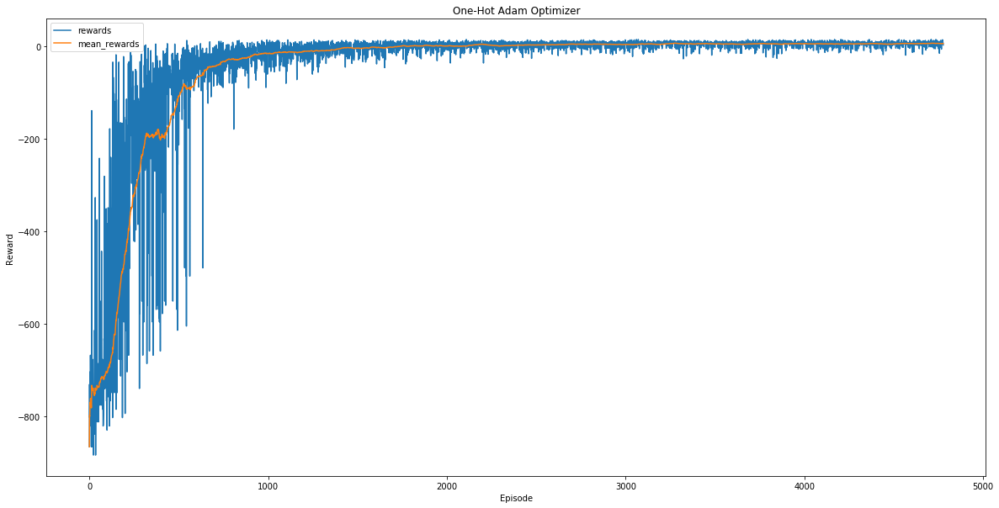

In [17]:
with open('./taxi_agent_ckpt/one_hot_adam_training.status', 'rb') as fp:
    training_status = pickle.load(fp) 
    episodes_rewards = training_status['episodes_rewards']
    plt.rcParams['figure.figsize'] = (20, 10)
    plot_rewards(episodes_rewards, 100, title='One-Hot Adam Optimizer')

In [18]:
# Nesterov Optimizer
agent = TaxiAgent(env,
                  name='one_hot_nesterov',
                  obs_represent='one-hot',
                  exploration=exp_schedule,
                  optimizer='Nesterov',
                  learning_rate=0.0003,
                  momentum=0.9,
                  n_hidden=150,
                  steps_to_start_learn=100,
                  target_update_freq=1000)

Using One-Hot-Vector representation for states
No checkpoint found...
Created Agent for Taxi-v2


In [19]:
mean_episode_reward = -float('nan')
best_mean_episode_reward = -float('inf')
last_obs = env.reset()
LOG_EVERY_N_STEPS = 5000
batch_size = 128 # 32
num_episodes = 5000

In [ ]:
with open('./taxi_agent_ckpt/one_hot_nesterov_training.status', 'rb') as fp:
    training_status = pickle.load(fp)
    mean_episode_reward = training_status['mean_episode_reward']
    best_mean_episode_reward = training_status['best_mean_episode_reward']
    episode_durations = training_status['episode_durations'] 
    episodes_rewards = training_status['episodes_rewards']
    total_steps = training_status['total_steps']

In [20]:
# One-Hot Representation Nesterov, Slow, misses the minimum
episode_durations = []
episodes_rewards = []
total_steps = 0
start_time = time.time()
for episode in range(num_episodes):
    episode_start_time = time.time()
    last_obs = env.reset()
    episode_reward = 0
    agent.episodes_seen += 1
#     agent.epsilon = agent.explore_schedule.value(agent.episodes_seen)
    for t in count():
        agent.steps_count += 1
        total_steps += 1
        ### Step the env and store the transition
        # Store lastest observation in replay memory and last_idx can be used to store action, reward, done
        last_idx = agent.replay_buffer.store_frame(agent.one_hot_generator.to_one_hot(last_obs))
        # encode_recent_observation will take the latest observation
        # that you pushed into the buffer and compute the corresponding
        # input that should be given to a Q network by appending some
        # previous frames.
        recent_observation = agent.replay_buffer.encode_recent_observation()
        action = agent.select_greedy_action(recent_observation)
        obs, reward, done, _ = env.step(action)
        episode_reward += reward
        # clip rewards between -1 and 1
    #     reward = max(-1.0, min(reward, 1.0))
        # Store other info in replay memory
        agent.replay_buffer.store_effect(last_idx, action, reward, done)
        ### Perform experience replay and train the network.
        # Note that this is only done if the replay buffer contains enough samples
        # for us to learn something useful -- until then, the model will not be
        # initialized and random actions should be taken
        agent.learn(batch_size)
        ### Log progress and keep track of statistics
        if len(episodes_rewards) > 0:
            mean_episode_reward = np.mean(episodes_rewards[-100:])
        if len(episodes_rewards) > 100:
            best_mean_episode_reward = max(best_mean_episode_reward, mean_episode_reward)

        if total_steps % LOG_EVERY_N_STEPS == 0 and total_steps > agent.steps_to_start_learn:
            print("Timestep %d" % (agent.steps_count,))
            print("mean reward (100 episodes) %f" % mean_episode_reward)
            print("best mean reward %f" % best_mean_episode_reward)
            print("episodes %d" % len(episodes_rewards))
            print("exploration value %f" % agent.epsilon)
            total_time = time.time() - start_time
            print("time since start: %.2f secs" % total_time)
            training_status = {}
            training_status['mean_episode_reward'] = mean_episode_reward
            training_status['best_mean_episode_reward'] = best_mean_episode_reward
            training_status['episode_durations'] = episode_durations
            training_status['episodes_rewards'] = episodes_rewards
            training_status['total_steps'] = total_steps
            with open('./taxi_agent_ckpt/one_hot_nesterov_training.status', 'wb') as fp:
                pickle.dump(training_status, fp)
            print("Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status")
        # Resets the environment when reaching an episode boundary.
        if done:
            episode_durations.append(t + 1)
            episodes_rewards.append(episode_reward)
            print("Episode: ", agent.episodes_seen,
                  " Done, Reward: ", episode_reward,
                  " Step: ", agent.steps_count,
                 " Episode Time: %.2f secs" % (time.time() - episode_start_time))
            break
        last_obs = obs
print("Training Complete!")

Episode:  1  Done, Reward:  -740  Step:  200  Episode Time: 0.28 secs
Episode:  2  Done, Reward:  -803  Step:  400  Episode Time: 1.99 secs
Episode:  3  Done, Reward:  -884  Step:  600  Episode Time: 1.44 secs
Episode:  4  Done, Reward:  -758  Step:  800  Episode Time: 1.28 secs
Episode:  5  Done, Reward:  -911  Step:  1000  Episode Time: 1.15 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  6  Done, Reward:  -821  Step:  1200  Episode Time: 0.97 secs
Episode:  7  Done, Reward:  -803  Step:  1400  Episode Time: 0.99 secs
Episode:  8  Done, Reward:  -830  Step:  1600  Episode Time: 1.15 secs
Episode:  9  Done, Reward:  -776  Step:  1800  Episode Time: 1.29 secs
Episode:  10  Done, Reward:  -776  Step:  2000  Episode Time: 0.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  11  Done, Reward:  -632  Step:  2200  Episode Time: 1.39 secs
Episode:  12  Done, Reward:  -839  Step:  2400  Episode Tim

Episode:  87  Done, Reward:  -776  Step:  17332  Episode Time: 0.60 secs
Episode:  88  Done, Reward:  -650  Step:  17532  Episode Time: 0.58 secs
Episode:  89  Done, Reward:  -794  Step:  17732  Episode Time: 1.00 secs
Episode:  90  Done, Reward:  -695  Step:  17932  Episode Time: 1.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  91  Done, Reward:  -677  Step:  18132  Episode Time: 1.08 secs
Episode:  92  Done, Reward:  -767  Step:  18332  Episode Time: 0.87 secs
Episode:  93  Done, Reward:  -484  Step:  18486  Episode Time: 0.89 secs
Episode:  94  Done, Reward:  -776  Step:  18686  Episode Time: 0.84 secs
Episode:  95  Done, Reward:  -758  Step:  18886  Episode Time: 0.80 secs
Episode:  96  Done, Reward:  -713  Step:  19086  Episode Time: 1.16 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  97  Done, Reward:  -659  Step:  19286  Episode Time: 0.87 secs
Episode:  98  Done, Reward:  -704  

Episode:  172  Done, Reward:  -722  Step:  33924  Episode Time: 0.47 secs
Episode:  173  Done, Reward:  -632  Step:  34124  Episode Time: 0.60 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  174  Done, Reward:  -605  Step:  34324  Episode Time: 0.49 secs
Episode:  175  Done, Reward:  -596  Step:  34524  Episode Time: 0.99 secs
Episode:  176  Done, Reward:  -121  Step:  34567  Episode Time: 0.14 secs
Episode:  177  Done, Reward:  -686  Step:  34767  Episode Time: 0.77 secs
Episode:  178  Done, Reward:  -668  Step:  34967  Episode Time: 1.63 secs
Timestep 35000
mean reward (100 episodes) -668.440000
best mean reward -668.440000
episodes 178
exploration value 0.809539
time since start: 177.90 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  179  Done, Reward:  -722  Step:  35167  Episode Time: 1.91 secs
Episode:  180  Don

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  256  Done, Reward:  -587  Step:  50147  Episode Time: 0.67 secs
Episode:  257  Done, Reward:  -130  Step:  50199  Episode Time: 0.21 secs
Episode:  258  Done, Reward:  -650  Step:  50399  Episode Time: 1.46 secs
Episode:  259  Done, Reward:  -623  Step:  50599  Episode Time: 1.51 secs
Episode:  260  Done, Reward:  -650  Step:  50799  Episode Time: 0.76 secs
Episode:  261  Done, Reward:  -650  Step:  50999  Episode Time: 0.56 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  262  Done, Reward:  -569  Step:  51199  Episode Time: 0.51 secs
Episode:  263  Done, Reward:  -614  Step:  51399  Episode Time: 0.74 secs
Episode:  264  Done, Reward:  -506  Step:  51599  Episode Time: 0.75 secs
Episode:  265  Done, Reward:  -758  Step:  51799  Episode Time: 1.28 secs
Episode:  266  Done, Reward:  -497  Step:  51999  Episode Time: 0.56 secs
Saved Taxi Agent checkpo

Episode:  339  Done, Reward:  -605  Step:  66251  Episode Time: 1.08 secs
Episode:  340  Done, Reward:  -470  Step:  66451  Episode Time: 0.66 secs
Episode:  341  Done, Reward:  -408  Step:  66610  Episode Time: 0.46 secs
Episode:  342  Done, Reward:  -596  Step:  66810  Episode Time: 1.37 secs
Episode:  343  Done, Reward:  -461  Step:  67010  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  344  Done, Reward:  -407  Step:  67210  Episode Time: 1.18 secs
Episode:  345  Done, Reward:  -479  Step:  67410  Episode Time: 0.98 secs
Episode:  346  Done, Reward:  -497  Step:  67610  Episode Time: 0.81 secs
Episode:  347  Done, Reward:  -488  Step:  67810  Episode Time: 1.36 secs
Episode:  348  Done, Reward:  -569  Step:  68010  Episode Time: 1.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  349  Done, Reward:  -578  Step:  68210  Episode Time: 1.14 secs
Episode:  350  Done, Rew

Episode:  425  Done, Reward:  -461  Step:  81941  Episode Time: 0.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  426  Done, Reward:  -533  Step:  82141  Episode Time: 0.74 secs
Episode:  427  Done, Reward:  -533  Step:  82341  Episode Time: 0.52 secs
Episode:  428  Done, Reward:  -295  Step:  82468  Episode Time: 0.53 secs
Episode:  429  Done, Reward:  -251  Step:  82569  Episode Time: 0.25 secs
Episode:  430  Done, Reward:  -488  Step:  82769  Episode Time: 0.47 secs
Episode:  431  Done, Reward:  -515  Step:  82969  Episode Time: 0.50 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  432  Done, Reward:  -344  Step:  83169  Episode Time: 0.51 secs
Episode:  433  Done, Reward:  -524  Step:  83369  Episode Time: 1.48 secs
Episode:  434  Done, Reward:  -551  Step:  83569  Episode Time: 0.62 secs
Episode:  435  Done, Reward:  -524  Step:  83769  Episode Time: 0.87 secs
Episode:  436  Done, Rew

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  512  Done, Reward:  -260  Step:  96216  Episode Time: 0.51 secs
Episode:  513  Done, Reward:  -242  Step:  96335  Episode Time: 0.29 secs
Episode:  514  Done, Reward:  -48  Step:  96359  Episode Time: 0.06 secs
Episode:  515  Done, Reward:  -506  Step:  96559  Episode Time: 0.92 secs
Episode:  516  Done, Reward:  -36  Step:  96580  Episode Time: 0.07 secs
Episode:  517  Done, Reward:  -278  Step:  96708  Episode Time: 0.50 secs
Episode:  518  Done, Reward:  -551  Step:  96908  Episode Time: 1.10 secs
Episode:  519  Done, Reward:  -533  Step:  97108  Episode Time: 0.96 secs
Episode:  520  Done, Reward:  -10  Step:  97121  Episode Time: 0.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  521  Done, Reward:  -162  Step:  97178  Episode Time: 0.59 secs
Episode:  522  Done, Reward:  -65  Step:  97210  Episode Time: 0.63 secs
Episode:  523  Done, Reward:

Episode:  604  Done, Reward:  -336  Step:  107863  Episode Time: 0.58 secs
Episode:  605  Done, Reward:  -268  Step:  107999  Episode Time: 0.42 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  606  Done, Reward:  -398  Step:  108199  Episode Time: 0.60 secs
Episode:  607  Done, Reward:  -24  Step:  108226  Episode Time: 0.09 secs
Episode:  608  Done, Reward:  -85  Step:  108278  Episode Time: 0.25 secs
Episode:  609  Done, Reward:  -506  Step:  108478  Episode Time: 1.46 secs
Episode:  610  Done, Reward:  -452  Step:  108678  Episode Time: 0.74 secs
Episode:  611  Done, Reward:  -461  Step:  108878  Episode Time: 0.67 secs
Episode:  612  Done, Reward:  -37  Step:  108900  Episode Time: 0.06 secs
Episode:  613  Done, Reward:  -34  Step:  108937  Episode Time: 0.09 secs
Episode:  614  Done, Reward:  -235  Step:  109076  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  615  Do

Episode:  699  Done, Reward:  -416  Step:  116730  Episode Time: 1.28 secs
Episode:  700  Done, Reward:  -17  Step:  116750  Episode Time: 0.23 secs
Episode:  701  Done, Reward:  -54  Step:  116789  Episode Time: 0.76 secs
Episode:  702  Done, Reward:  -56  Step:  116830  Episode Time: 0.23 secs
Episode:  703  Done, Reward:  -35  Step:  116868  Episode Time: 0.10 secs
Episode:  704  Done, Reward:  -16  Step:  116887  Episode Time: 0.14 secs
Episode:  705  Done, Reward:  -48  Step:  116920  Episode Time: 0.19 secs
Episode:  706  Done, Reward:  -533  Step:  117120  Episode Time: 0.52 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  707  Done, Reward:  -425  Step:  117320  Episode Time: 1.86 secs
Episode:  708  Done, Reward:  -55  Step:  117351  Episode Time: 0.13 secs
Episode:  709  Done, Reward:  -452  Step:  117551  Episode Time: 0.85 secs
Episode:  710  Done, Reward:  -461  Step:  117751  Episode Time: 0.94 secs
Episode:  711  Done, Rewar

Timestep 130000
mean reward (100 episodes) -312.100000
best mean reward -187.580000
episodes 788
exploration value 0.404324
time since start: 661.14 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Episode:  789  Done, Reward:  -425  Step:  130086  Episode Time: 1.49 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  790  Done, Reward:  -470  Step:  130286  Episode Time: 2.31 secs
Episode:  791  Done, Reward:  -95  Step:  130357  Episode Time: 0.51 secs
Episode:  792  Done, Reward:  -470  Step:  130557  Episode Time: 1.59 secs
Episode:  793  Done, Reward:  -416  Step:  130757  Episode Time: 1.04 secs
Episode:  794  Done, Reward:  -470  Step:  130957  Episode Time: 1.88 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  795  Done, Reward:  -452  Step:  131157  Episode Time: 1.52 secs
Episode:  796  Done, Reward:  -461  Step:  131357  Episode Time: 1.15 secs
Episode:  

Episode:  869  Done, Reward:  -434  Step:  145817  Episode Time: 1.05 secs
Episode:  870  Done, Reward:  -443  Step:  146017  Episode Time: 1.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  871  Done, Reward:  -452  Step:  146217  Episode Time: 1.28 secs
Episode:  872  Done, Reward:  -371  Step:  146417  Episode Time: 0.99 secs
Episode:  873  Done, Reward:  -425  Step:  146617  Episode Time: 1.58 secs
Episode:  874  Done, Reward:  -470  Step:  146817  Episode Time: 1.33 secs
Episode:  875  Done, Reward:  -506  Step:  147017  Episode Time: 1.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  876  Done, Reward:  -452  Step:  147217  Episode Time: 1.17 secs
Episode:  877  Done, Reward:  -362  Step:  147417  Episode Time: 1.01 secs
Episode:  878  Done, Reward:  -371  Step:  147617  Episode Time: 1.24 secs
Episode:  879  Done, Reward:  -434  Step:  147817  Episode Time: 0.70 secs
Episode:  880

Episode:  951  Done, Reward:  -380  Step:  162217  Episode Time: 1.49 secs
Episode:  952  Done, Reward:  -452  Step:  162417  Episode Time: 0.80 secs
Episode:  953  Done, Reward:  -488  Step:  162617  Episode Time: 1.08 secs
Episode:  954  Done, Reward:  -443  Step:  162817  Episode Time: 0.70 secs
Episode:  955  Done, Reward:  -452  Step:  163017  Episode Time: 1.31 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  956  Done, Reward:  -308  Step:  163217  Episode Time: 1.31 secs
Episode:  957  Done, Reward:  -443  Step:  163417  Episode Time: 0.89 secs
Episode:  958  Done, Reward:  -380  Step:  163617  Episode Time: 0.85 secs
Episode:  959  Done, Reward:  -326  Step:  163817  Episode Time: 0.69 secs
Episode:  960  Done, Reward:  -452  Step:  164017  Episode Time: 0.86 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  961  Done, Reward:  -353  Step:  164217  Episode Time: 0.93 secs
Episode:  962

Episode:  1034  Done, Reward:  -407  Step:  178817  Episode Time: 1.03 secs
Episode:  1035  Done, Reward:  -416  Step:  179017  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1036  Done, Reward:  -461  Step:  179217  Episode Time: 1.16 secs
Episode:  1037  Done, Reward:  -353  Step:  179417  Episode Time: 1.04 secs
Episode:  1038  Done, Reward:  -380  Step:  179617  Episode Time: 0.71 secs
Episode:  1039  Done, Reward:  -308  Step:  179817  Episode Time: 2.37 secs
Timestep 180000
mean reward (100 episodes) -391.790000
best mean reward -187.580000
episodes 1039
exploration value 0.308905
time since start: 964.14 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Episode:  1040  Done, Reward:  -362  Step:  180017  Episode Time: 0.84 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1041  Done, Reward:  -317  Step:  180217  Episode Time: 1.58 secs


Episode:  1115  Done, Reward:  -398  Step:  195017  Episode Time: 1.47 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1116  Done, Reward:  -389  Step:  195217  Episode Time: 1.81 secs
Episode:  1117  Done, Reward:  -353  Step:  195417  Episode Time: 0.74 secs
Episode:  1118  Done, Reward:  -308  Step:  195617  Episode Time: 0.70 secs
Episode:  1119  Done, Reward:  -371  Step:  195817  Episode Time: 0.88 secs
Episode:  1120  Done, Reward:  -362  Step:  196017  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1121  Done, Reward:  -398  Step:  196217  Episode Time: 1.65 secs
Episode:  1122  Done, Reward:  -389  Step:  196417  Episode Time: 1.39 secs
Episode:  1123  Done, Reward:  -344  Step:  196617  Episode Time: 0.94 secs
Episode:  1124  Done, Reward:  -380  Step:  196817  Episode Time: 0.65 secs
Episode:  1125  Done, Reward:  -380  Step:  197017  Episode Time: 0.98 secs
Sa

Episode:  1197  Done, Reward:  -308  Step:  211066  Episode Time: 1.18 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1198  Done, Reward:  -371  Step:  211266  Episode Time: 1.51 secs
Episode:  1199  Done, Reward:  -290  Step:  211466  Episode Time: 1.62 secs
Episode:  1200  Done, Reward:  -335  Step:  211666  Episode Time: 1.52 secs
Episode:  1201  Done, Reward:  -281  Step:  211866  Episode Time: 1.34 secs
Episode:  1202  Done, Reward:  -317  Step:  212066  Episode Time: 0.95 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1203  Done, Reward:  -344  Step:  212266  Episode Time: 1.31 secs
Episode:  1204  Done, Reward:  -326  Step:  212466  Episode Time: 1.19 secs
Episode:  1205  Done, Reward:  -389  Step:  212666  Episode Time: 1.14 secs
Episode:  1206  Done, Reward:  -272  Step:  212866  Episode Time: 0.79 secs
Episode:  1207  Done, Reward:  -290  Step:  213066  Episode Time: 0.65 secs
Sa

Episode:  1280  Done, Reward:  -344  Step:  225732  Episode Time: 1.22 secs
Episode:  1281  Done, Reward:  -198  Step:  225870  Episode Time: 0.42 secs
Episode:  1282  Done, Reward:  -362  Step:  226070  Episode Time: 1.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1283  Done, Reward:  -136  Step:  226155  Episode Time: 0.46 secs
Episode:  1284  Done, Reward:  -86  Step:  226217  Episode Time: 0.25 secs
Episode:  1285  Done, Reward:  -135  Step:  226319  Episode Time: 0.30 secs
Episode:  1286  Done, Reward:  -4  Step:  226335  Episode Time: 0.05 secs
Episode:  1287  Done, Reward:  -353  Step:  226535  Episode Time: 0.76 secs
Episode:  1288  Done, Reward:  -33  Step:  226571  Episode Time: 0.27 secs
Episode:  1289  Done, Reward:  -281  Step:  226771  Episode Time: 0.78 secs
Episode:  1290  Done, Reward:  -162  Step:  226909  Episode Time: 0.58 secs
Episode:  1291  Done, Reward:  -362  Step:  227109  Episode Time: 1.06 secs
Saved Taxi 

Episode:  1369  Done, Reward:  -299  Step:  238345  Episode Time: 1.02 secs
Episode:  1370  Done, Reward:  -326  Step:  238545  Episode Time: 1.22 secs
Episode:  1371  Done, Reward:  -317  Step:  238745  Episode Time: 0.92 secs
Episode:  1372  Done, Reward:  -281  Step:  238945  Episode Time: 1.24 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1373  Done, Reward:  -308  Step:  239145  Episode Time: 0.65 secs
Episode:  1374  Done, Reward:  -344  Step:  239345  Episode Time: 0.90 secs
Episode:  1375  Done, Reward:  -245  Step:  239545  Episode Time: 2.67 secs
Episode:  1376  Done, Reward:  -275  Step:  239706  Episode Time: 1.88 secs
Episode:  1377  Done, Reward:  -308  Step:  239906  Episode Time: 1.26 secs
Timestep 240000
mean reward (100 episodes) -227.880000
best mean reward -187.580000
episodes 1377
exploration value 0.219688
time since start: 1357.50 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Epis

Episode:  1451  Done, Reward:  -272  Step:  254387  Episode Time: 1.58 secs
Episode:  1452  Done, Reward:  -299  Step:  254587  Episode Time: 0.62 secs
Episode:  1453  Done, Reward:  -281  Step:  254787  Episode Time: 0.62 secs
Episode:  1454  Done, Reward:  -281  Step:  254987  Episode Time: 2.02 secs
Timestep 255000
mean reward (100 episodes) -291.240000
best mean reward -187.580000
episodes 1454
exploration value 0.204117
time since start: 1459.98 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1455  Done, Reward:  -281  Step:  255187  Episode Time: 1.97 secs
Episode:  1456  Done, Reward:  -299  Step:  255387  Episode Time: 1.13 secs
Episode:  1457  Done, Reward:  -272  Step:  255587  Episode Time: 1.28 secs
Episode:  1458  Done, Reward:  -272  Step:  255787  Episode Time: 1.37 secs
Episode:  1459  Done, Reward:  -344  Step:  255987  Episode Time: 1.18 secs
Save

Episode:  1530  Done, Reward:  -344  Step:  270187  Episode Time: 2.69 secs
Episode:  1531  Done, Reward:  -281  Step:  270387  Episode Time: 1.22 secs
Episode:  1532  Done, Reward:  -308  Step:  270587  Episode Time: 0.89 secs
Episode:  1533  Done, Reward:  -344  Step:  270787  Episode Time: 0.80 secs
Episode:  1534  Done, Reward:  -299  Step:  270987  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1535  Done, Reward:  -317  Step:  271187  Episode Time: 0.86 secs
Episode:  1536  Done, Reward:  -281  Step:  271387  Episode Time: 0.89 secs
Episode:  1537  Done, Reward:  -254  Step:  271587  Episode Time: 1.05 secs
Episode:  1538  Done, Reward:  -344  Step:  271787  Episode Time: 0.71 secs
Episode:  1539  Done, Reward:  -281  Step:  271987  Episode Time: 0.63 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1540  Done, Reward:  -290  Step:  272187  Episode Time: 1.38 secs
Ep

Episode:  1612  Done, Reward:  -308  Step:  286587  Episode Time: 1.28 secs
Episode:  1613  Done, Reward:  -254  Step:  286787  Episode Time: 1.41 secs
Episode:  1614  Done, Reward:  -299  Step:  286987  Episode Time: 1.46 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1615  Done, Reward:  -281  Step:  287187  Episode Time: 0.88 secs
Episode:  1616  Done, Reward:  -326  Step:  287387  Episode Time: 1.19 secs
Episode:  1617  Done, Reward:  -353  Step:  287587  Episode Time: 1.02 secs
Episode:  1618  Done, Reward:  -308  Step:  287787  Episode Time: 2.38 secs
Episode:  1619  Done, Reward:  -344  Step:  287987  Episode Time: 2.58 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1620  Done, Reward:  -308  Step:  288187  Episode Time: 0.87 secs
Episode:  1621  Done, Reward:  -263  Step:  288387  Episode Time: 0.84 secs
Episode:  1622  Done, Reward:  -272  Step:  288587  Episode Time: 2.40 secs
Ep

Episode:  1694  Done, Reward:  -227  Step:  302900  Episode Time: 1.30 secs
Episode:  1695  Done, Reward:  -326  Step:  303100  Episode Time: 0.81 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1696  Done, Reward:  -290  Step:  303300  Episode Time: 1.84 secs
Episode:  1697  Done, Reward:  -281  Step:  303500  Episode Time: 1.06 secs
Episode:  1698  Done, Reward:  -290  Step:  303700  Episode Time: 1.52 secs
Episode:  1699  Done, Reward:  -272  Step:  303900  Episode Time: 1.15 secs
Episode:  1700  Done, Reward:  -317  Step:  304100  Episode Time: 1.45 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1701  Done, Reward:  -290  Step:  304300  Episode Time: 2.22 secs
Episode:  1702  Done, Reward:  -326  Step:  304500  Episode Time: 1.56 secs
Episode:  1703  Done, Reward:  -317  Step:  304700  Episode Time: 1.76 secs
Episode:  1704  Done, Reward:  -317  Step:  304900  Episode Time: 1.16 secs
Ti

Episode:  1776  Done, Reward:  -254  Step:  319114  Episode Time: 1.14 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1777  Done, Reward:  -272  Step:  319314  Episode Time: 2.41 secs
Episode:  1778  Done, Reward:  -263  Step:  319514  Episode Time: 0.69 secs
Episode:  1779  Done, Reward:  -254  Step:  319714  Episode Time: 0.88 secs
Episode:  1780  Done, Reward:  -281  Step:  319914  Episode Time: 0.79 secs
Timestep 320000
mean reward (100 episodes) -291.710000
best mean reward -187.580000
episodes 1780
exploration value 0.152536
time since start: 1880.18 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Episode:  1781  Done, Reward:  -344  Step:  320114  Episode Time: 0.78 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1782  Done, Reward:  -272  Step:  320314  Episode Time: 1.29 secs
Episode:  1783  Done, Reward:  -254  Step:  320514  Episode Time: 1.07 secs

Episode:  1857  Done, Reward:  -281  Step:  335077  Episode Time: 2.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1858  Done, Reward:  -290  Step:  335277  Episode Time: 1.63 secs
Episode:  1859  Done, Reward:  -254  Step:  335477  Episode Time: 1.40 secs
Episode:  1860  Done, Reward:  -272  Step:  335677  Episode Time: 0.98 secs
Episode:  1861  Done, Reward:  -317  Step:  335877  Episode Time: 1.33 secs
Episode:  1862  Done, Reward:  -37  Step:  335908  Episode Time: 0.22 secs
Episode:  1863  Done, Reward:  -272  Step:  336108  Episode Time: 1.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1864  Done, Reward:  -299  Step:  336308  Episode Time: 1.63 secs
Episode:  1865  Done, Reward:  -227  Step:  336508  Episode Time: 1.59 secs
Episode:  1866  Done, Reward:  -245  Step:  336708  Episode Time: 1.17 secs
Episode:  1867  Done, Reward:  -263  Step:  336908  Episode Time: 1.85 secs
Epi

Episode:  1939  Done, Reward:  -272  Step:  350170  Episode Time: 2.05 secs
Episode:  1940  Done, Reward:  -272  Step:  350370  Episode Time: 0.96 secs
Episode:  1941  Done, Reward:  -89  Step:  350462  Episode Time: 0.59 secs
Episode:  1942  Done, Reward:  -317  Step:  350662  Episode Time: 0.97 secs
Episode:  1943  Done, Reward:  -263  Step:  350862  Episode Time: 1.75 secs
Episode:  1944  Done, Reward:  -272  Step:  351062  Episode Time: 1.05 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  1945  Done, Reward:  -281  Step:  351262  Episode Time: 0.92 secs
Episode:  1946  Done, Reward:  -308  Step:  351462  Episode Time: 0.90 secs
Episode:  1947  Done, Reward:  -272  Step:  351662  Episode Time: 0.77 secs
Episode:  1948  Done, Reward:  -272  Step:  351862  Episode Time: 1.21 secs
Episode:  1949  Done, Reward:  -299  Step:  352062  Episode Time: 1.38 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Epi

Episode:  2022  Done, Reward:  -235  Step:  365931  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2023  Done, Reward:  -263  Step:  366131  Episode Time: 0.61 secs
Episode:  2024  Done, Reward:  -263  Step:  366331  Episode Time: 0.61 secs
Episode:  2025  Done, Reward:  -236  Step:  366531  Episode Time: 0.61 secs
Episode:  2026  Done, Reward:  -236  Step:  366731  Episode Time: 0.85 secs
Episode:  2027  Done, Reward:  -254  Step:  366931  Episode Time: 0.65 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2028  Done, Reward:  -281  Step:  367131  Episode Time: 0.72 secs
Episode:  2029  Done, Reward:  -281  Step:  367331  Episode Time: 1.36 secs
Episode:  2030  Done, Reward:  -272  Step:  367531  Episode Time: 1.80 secs
Episode:  2031  Done, Reward:  -272  Step:  367731  Episode Time: 1.33 secs
Episode:  2032  Done, Reward:  -236  Step:  367931  Episode Time: 1.20 secs
Ep

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2105  Done, Reward:  -263  Step:  381143  Episode Time: 2.46 secs
Episode:  2106  Done, Reward:  12  Step:  381152  Episode Time: 0.10 secs
Episode:  2107  Done, Reward:  -281  Step:  381352  Episode Time: 2.63 secs
Episode:  2108  Done, Reward:  -299  Step:  381552  Episode Time: 1.79 secs
Episode:  2109  Done, Reward:  -290  Step:  381752  Episode Time: 1.08 secs
Episode:  2110  Done, Reward:  -263  Step:  381952  Episode Time: 1.23 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2111  Done, Reward:  -272  Step:  382152  Episode Time: 2.52 secs
Episode:  2112  Done, Reward:  -263  Step:  382352  Episode Time: 1.96 secs
Episode:  2113  Done, Reward:  -254  Step:  382552  Episode Time: 0.97 secs
Episode:  2114  Done, Reward:  -245  Step:  382752  Episode Time: 1.04 secs
Episode:  2115  Done, Reward:  -254  Step:  382952  Episode Time: 0.77 secs
Save

Episode:  2188  Done, Reward:  -245  Step:  395924  Episode Time: 1.16 secs
Episode:  2189  Done, Reward:  -254  Step:  396124  Episode Time: 1.00 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2190  Done, Reward:  -254  Step:  396324  Episode Time: 0.84 secs
Episode:  2191  Done, Reward:  -290  Step:  396524  Episode Time: 0.87 secs
Episode:  2192  Done, Reward:  -281  Step:  396724  Episode Time: 0.66 secs
Episode:  2193  Done, Reward:  -263  Step:  396924  Episode Time: 0.82 secs
Episode:  2194  Done, Reward:  -236  Step:  397124  Episode Time: 1.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2195  Done, Reward:  -218  Step:  397324  Episode Time: 0.66 secs
Episode:  2196  Done, Reward:  -308  Step:  397524  Episode Time: 0.76 secs
Episode:  2197  Done, Reward:  -254  Step:  397724  Episode Time: 1.25 secs
Episode:  2198  Done, Reward:  -254  Step:  397924  Episode Time: 1.40 secs
Ep

Episode:  2271  Done, Reward:  -263  Step:  410759  Episode Time: 1.22 secs
Episode:  2272  Done, Reward:  -236  Step:  410959  Episode Time: 0.66 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2273  Done, Reward:  -263  Step:  411159  Episode Time: 1.60 secs
Episode:  2274  Done, Reward:  -245  Step:  411359  Episode Time: 1.21 secs
Episode:  2275  Done, Reward:  -254  Step:  411559  Episode Time: 2.67 secs
Episode:  2276  Done, Reward:  -290  Step:  411759  Episode Time: 1.16 secs
Episode:  2277  Done, Reward:  -245  Step:  411959  Episode Time: 1.33 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2278  Done, Reward:  -272  Step:  412159  Episode Time: 1.26 secs
Episode:  2279  Done, Reward:  -245  Step:  412359  Episode Time: 0.86 secs
Episode:  2280  Done, Reward:  -245  Step:  412559  Episode Time: 1.40 secs
Episode:  2281  Done, Reward:  -254  Step:  412759  Episode Time: 2.90 secs
Ep

Episode:  2354  Done, Reward:  -263  Step:  425688  Episode Time: 2.53 secs
Episode:  2355  Done, Reward:  10  Step:  425699  Episode Time: 0.09 secs
Episode:  2356  Done, Reward:  -209  Step:  425899  Episode Time: 0.90 secs
Episode:  2357  Done, Reward:  -245  Step:  426099  Episode Time: 0.81 secs
Episode:  2358  Done, Reward:  10  Step:  426110  Episode Time: 0.04 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2359  Done, Reward:  -281  Step:  426310  Episode Time: 1.22 secs
Episode:  2360  Done, Reward:  -317  Step:  426510  Episode Time: 2.46 secs
Episode:  2361  Done, Reward:  -281  Step:  426710  Episode Time: 1.12 secs
Episode:  2362  Done, Reward:  -299  Step:  426910  Episode Time: 1.28 secs
Episode:  2363  Done, Reward:  -263  Step:  427110  Episode Time: 0.74 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2364  Done, Reward:  -236  Step:  427310  Episode Time: 1.16 secs
Episod

Episode:  2445  Done, Reward:  -227  Step:  438329  Episode Time: 1.27 secs
Episode:  2446  Done, Reward:  -245  Step:  438529  Episode Time: 1.10 secs
Episode:  2447  Done, Reward:  -23  Step:  438564  Episode Time: 0.40 secs
Episode:  2448  Done, Reward:  10  Step:  438575  Episode Time: 0.06 secs
Episode:  2449  Done, Reward:  -236  Step:  438775  Episode Time: 1.08 secs
Episode:  2450  Done, Reward:  -281  Step:  438975  Episode Time: 1.26 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2451  Done, Reward:  -218  Step:  439175  Episode Time: 1.08 secs
Episode:  2452  Done, Reward:  -263  Step:  439375  Episode Time: 1.26 secs
Episode:  2453  Done, Reward:  -254  Step:  439575  Episode Time: 1.14 secs
Episode:  2454  Done, Reward:  -245  Step:  439775  Episode Time: 1.25 secs
Episode:  2455  Done, Reward:  -254  Step:  439975  Episode Time: 1.00 secs
Timestep 440000
mean reward (100 episodes) -173.120000
best mean reward -170.480000
ep

Episode:  2532  Done, Reward:  -245  Step:  450461  Episode Time: 0.82 secs
Episode:  2533  Done, Reward:  -281  Step:  450661  Episode Time: 0.90 secs
Episode:  2534  Done, Reward:  -281  Step:  450861  Episode Time: 1.96 secs
Episode:  2535  Done, Reward:  -272  Step:  451061  Episode Time: 1.92 secs
Episode:  2536  Done, Reward:  7  Step:  451075  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2537  Done, Reward:  -263  Step:  451275  Episode Time: 2.17 secs
Episode:  2538  Done, Reward:  6  Step:  451290  Episode Time: 0.20 secs
Episode:  2539  Done, Reward:  -9  Step:  451311  Episode Time: 0.27 secs
Episode:  2540  Done, Reward:  -17  Step:  451331  Episode Time: 0.41 secs
Episode:  2541  Done, Reward:  -18  Step:  451370  Episode Time: 0.23 secs
Episode:  2542  Done, Reward:  -245  Step:  451570  Episode Time: 1.32 secs
Episode:  2543  Done, Reward:  -25  Step:  451607  Episode Time: 0.27 secs
Episode:  2544  Do

Episode:  2624  Done, Reward:  -236  Step:  461362  Episode Time: 1.17 secs
Episode:  2625  Done, Reward:  -245  Step:  461562  Episode Time: 1.70 secs
Episode:  2626  Done, Reward:  -263  Step:  461762  Episode Time: 2.86 secs
Episode:  2627  Done, Reward:  -96  Step:  461870  Episode Time: 1.62 secs
Episode:  2628  Done, Reward:  -218  Step:  462070  Episode Time: 2.83 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2629  Done, Reward:  -254  Step:  462270  Episode Time: 2.99 secs
Episode:  2630  Done, Reward:  -227  Step:  462470  Episode Time: 2.42 secs
Episode:  2631  Done, Reward:  -236  Step:  462670  Episode Time: 1.96 secs
Episode:  2632  Done, Reward:  -51  Step:  462715  Episode Time: 0.25 secs
Episode:  2633  Done, Reward:  -9  Step:  462736  Episode Time: 0.12 secs
Episode:  2634  Done, Reward:  12  Step:  462745  Episode Time: 0.05 secs
Episode:  2635  Done, Reward:  -208  Step:  462884  Episode Time: 0.76 secs
Episode:  263

Episode:  2718  Done, Reward:  -245  Step:  471508  Episode Time: 1.40 secs
Episode:  2719  Done, Reward:  -115  Step:  471635  Episode Time: 0.82 secs
Episode:  2720  Done, Reward:  -11  Step:  471658  Episode Time: 0.08 secs
Episode:  2721  Done, Reward:  -281  Step:  471858  Episode Time: 1.21 secs
Episode:  2722  Done, Reward:  -86  Step:  471956  Episode Time: 0.38 secs
Episode:  2723  Done, Reward:  -65  Step:  472033  Episode Time: 0.63 secs
Episode:  2724  Done, Reward:  -49  Step:  472094  Episode Time: 0.40 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2725  Done, Reward:  -272  Step:  472294  Episode Time: 1.00 secs
Episode:  2726  Done, Reward:  6  Step:  472309  Episode Time: 0.05 secs
Episode:  2727  Done, Reward:  -281  Step:  472509  Episode Time: 1.16 secs
Episode:  2728  Done, Reward:  -2  Step:  472523  Episode Time: 0.07 secs
Episode:  2729  Done, Reward:  -227  Step:  472723  Episode Time: 1.48 secs
Episode:  2730  

Episode:  2811  Done, Reward:  -263  Step:  482336  Episode Time: 1.04 secs
Episode:  2812  Done, Reward:  -2  Step:  482359  Episode Time: 0.12 secs
Episode:  2813  Done, Reward:  3  Step:  482377  Episode Time: 0.10 secs
Episode:  2814  Done, Reward:  -227  Step:  482577  Episode Time: 2.18 secs
Episode:  2815  Done, Reward:  -94  Step:  482665  Episode Time: 0.74 secs
Episode:  2816  Done, Reward:  -19  Step:  482705  Episode Time: 0.13 secs
Episode:  2817  Done, Reward:  1  Step:  482716  Episode Time: 0.04 secs
Episode:  2818  Done, Reward:  -218  Step:  482916  Episode Time: 1.09 secs
Episode:  2819  Done, Reward:  -263  Step:  483116  Episode Time: 0.94 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2820  Done, Reward:  -218  Step:  483316  Episode Time: 1.07 secs
Episode:  2821  Done, Reward:  14  Step:  483323  Episode Time: 0.04 secs
Episode:  2822  Done, Reward:  -25  Step:  483369  Episode Time: 0.74 secs
Episode:  2823  Done

Episode:  2905  Done, Reward:  -236  Step:  491391  Episode Time: 1.39 secs
Episode:  2906  Done, Reward:  11  Step:  491401  Episode Time: 0.06 secs
Episode:  2907  Done, Reward:  -218  Step:  491601  Episode Time: 1.28 secs
Episode:  2908  Done, Reward:  -12  Step:  491625  Episode Time: 0.36 secs
Episode:  2909  Done, Reward:  -272  Step:  491825  Episode Time: 1.81 secs
Episode:  2910  Done, Reward:  -26  Step:  491863  Episode Time: 0.31 secs
Episode:  2911  Done, Reward:  -3  Step:  491878  Episode Time: 0.38 secs
Episode:  2912  Done, Reward:  6  Step:  491893  Episode Time: 0.12 secs
Episode:  2913  Done, Reward:  -3  Step:  491908  Episode Time: 0.09 secs
Episode:  2914  Done, Reward:  5  Step:  491924  Episode Time: 0.14 secs
Episode:  2915  Done, Reward:  -254  Step:  492124  Episode Time: 2.12 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2916  Done, Reward:  -245  Step:  492324  Episode Time: 1.20 secs
Episode:  2917  Done,

Episode:  2995  Done, Reward:  -245  Step:  503778  Episode Time: 1.62 secs
Episode:  2996  Done, Reward:  8  Step:  503791  Episode Time: 0.15 secs
Episode:  2997  Done, Reward:  -227  Step:  503991  Episode Time: 3.09 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  2998  Done, Reward:  -218  Step:  504191  Episode Time: 2.40 secs
Episode:  2999  Done, Reward:  -171  Step:  504347  Episode Time: 1.31 secs
Episode:  3000  Done, Reward:  -15  Step:  504383  Episode Time: 0.18 secs
Episode:  3001  Done, Reward:  -227  Step:  504583  Episode Time: 1.03 secs
Episode:  3002  Done, Reward:  -272  Step:  504783  Episode Time: 0.73 secs
Episode:  3003  Done, Reward:  5  Step:  504799  Episode Time: 0.08 secs
Episode:  3004  Done, Reward:  1  Step:  504810  Episode Time: 0.05 secs
Episode:  3005  Done, Reward:  5  Step:  504826  Episode Time: 0.09 secs
Episode:  3006  Done, Reward:  -1  Step:  504839  Episode Time: 0.06 secs
Timestep 505000
mean r

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3089  Done, Reward:  -245  Step:  513197  Episode Time: 1.54 secs
Episode:  3090  Done, Reward:  -263  Step:  513397  Episode Time: 1.21 secs
Episode:  3091  Done, Reward:  -209  Step:  513597  Episode Time: 1.36 secs
Episode:  3092  Done, Reward:  -20  Step:  513629  Episode Time: 0.18 secs
Episode:  3093  Done, Reward:  -218  Step:  513829  Episode Time: 1.10 secs
Episode:  3094  Done, Reward:  -95  Step:  513936  Episode Time: 0.59 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3095  Done, Reward:  -254  Step:  514136  Episode Time: 1.36 secs
Episode:  3096  Done, Reward:  -71  Step:  514210  Episode Time: 0.40 secs
Episode:  3097  Done, Reward:  -200  Step:  514410  Episode Time: 1.38 secs
Episode:  3098  Done, Reward:  8  Step:  514423  Episode Time: 0.07 secs
Episode:  3099  Done, Reward:  -15  Step:  514450  Episode Time: 0.17 secs
Episode: 

Episode:  3174  Done, Reward:  -227  Step:  526483  Episode Time: 0.81 secs
Episode:  3175  Done, Reward:  -254  Step:  526683  Episode Time: 1.12 secs
Episode:  3176  Done, Reward:  -245  Step:  526883  Episode Time: 1.09 secs
Episode:  3177  Done, Reward:  -227  Step:  527083  Episode Time: 0.90 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3178  Done, Reward:  -200  Step:  527283  Episode Time: 0.88 secs
Episode:  3179  Done, Reward:  -236  Step:  527483  Episode Time: 0.65 secs
Episode:  3180  Done, Reward:  -281  Step:  527683  Episode Time: 0.98 secs
Episode:  3181  Done, Reward:  -254  Step:  527883  Episode Time: 0.97 secs
Episode:  3182  Done, Reward:  -227  Step:  528083  Episode Time: 1.19 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3183  Done, Reward:  -344  Step:  528283  Episode Time: 2.89 secs
Episode:  3184  Done, Reward:  -245  Step:  528483  Episode Time: 2.89 secs
Ep

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3262  Done, Reward:  -236  Step:  540136  Episode Time: 1.42 secs
Episode:  3263  Done, Reward:  -40  Step:  540197  Episode Time: 0.37 secs
Episode:  3264  Done, Reward:  -227  Step:  540397  Episode Time: 1.14 secs
Episode:  3265  Done, Reward:  -209  Step:  540597  Episode Time: 1.58 secs
Episode:  3266  Done, Reward:  -254  Step:  540797  Episode Time: 1.30 secs
Episode:  3267  Done, Reward:  -263  Step:  540997  Episode Time: 0.92 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3268  Done, Reward:  -121  Step:  541139  Episode Time: 0.66 secs
Episode:  3269  Done, Reward:  -272  Step:  541339  Episode Time: 0.86 secs
Episode:  3270  Done, Reward:  -227  Step:  541539  Episode Time: 0.78 secs
Episode:  3271  Done, Reward:  -54  Step:  541596  Episode Time: 0.39 secs
Episode:  3272  Done, Reward:  -254  Step:  541796  Episode Time: 0.67 secs
Epis

Episode:  3350  Done, Reward:  -227  Step:  554345  Episode Time: 1.33 secs
Episode:  3351  Done, Reward:  -218  Step:  554545  Episode Time: 0.78 secs
Episode:  3352  Done, Reward:  -254  Step:  554745  Episode Time: 0.63 secs
Episode:  3353  Done, Reward:  -281  Step:  554945  Episode Time: 1.12 secs
Timestep 555000
mean reward (100 episodes) -191.220000
best mean reward -99.890000
episodes 3353
exploration value 0.064353
time since start: 3475.18 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3354  Done, Reward:  -218  Step:  555145  Episode Time: 1.10 secs
Episode:  3355  Done, Reward:  -245  Step:  555345  Episode Time: 1.27 secs
Episode:  3356  Done, Reward:  9  Step:  555357  Episode Time: 0.06 secs
Episode:  3357  Done, Reward:  -62  Step:  555431  Episode Time: 0.41 secs
Episode:  3358  Done, Reward:  -200  Step:  555631  Episode Time: 1.26 secs
Episode: 

Episode:  3437  Done, Reward:  -227  Step:  566833  Episode Time: 2.82 secs
Episode:  3438  Done, Reward:  -263  Step:  567033  Episode Time: 1.64 secs
Episode:  3439  Done, Reward:  7  Step:  567047  Episode Time: 0.13 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3440  Done, Reward:  -245  Step:  567247  Episode Time: 0.71 secs
Episode:  3441  Done, Reward:  -4  Step:  567263  Episode Time: 0.13 secs
Episode:  3442  Done, Reward:  -4  Step:  567279  Episode Time: 0.14 secs
Episode:  3443  Done, Reward:  -263  Step:  567479  Episode Time: 0.83 secs
Episode:  3444  Done, Reward:  -218  Step:  567679  Episode Time: 0.83 secs
Episode:  3445  Done, Reward:  -227  Step:  567879  Episode Time: 0.61 secs
Episode:  3446  Done, Reward:  -236  Step:  568079  Episode Time: 1.36 secs
Episode:  3447  Done, Reward:  9  Step:  568091  Episode Time: 0.07 secs
Episode:  3448  Done, Reward:  10  Step:  568102  Episode Time: 0.07 secs
Saved Taxi Agent ch

Episode:  3528  Done, Reward:  -254  Step:  578710  Episode Time: 1.24 secs
Episode:  3529  Done, Reward:  -254  Step:  578910  Episode Time: 1.07 secs
Episode:  3530  Done, Reward:  5  Step:  578926  Episode Time: 0.08 secs
Episode:  3531  Done, Reward:  -103  Step:  579032  Episode Time: 0.76 secs
Episode:  3532  Done, Reward:  2  Step:  579051  Episode Time: 0.10 secs
Episode:  3533  Done, Reward:  3  Step:  579069  Episode Time: 0.10 secs
Episode:  3534  Done, Reward:  -3  Step:  579084  Episode Time: 0.08 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3535  Done, Reward:  -263  Step:  579284  Episode Time: 0.82 secs
Episode:  3536  Done, Reward:  6  Step:  579299  Episode Time: 0.05 secs
Episode:  3537  Done, Reward:  -227  Step:  579499  Episode Time: 1.18 secs
Episode:  3538  Done, Reward:  -254  Step:  579699  Episode Time: 2.38 secs
Episode:  3539  Done, Reward:  -254  Step:  579899  Episode Time: 0.69 secs
Episode:  3540  Done,

Episode:  3625  Done, Reward:  -236  Step:  585710  Episode Time: 1.31 secs
Episode:  3626  Done, Reward:  -51  Step:  585764  Episode Time: 0.35 secs
Episode:  3627  Done, Reward:  -203  Step:  585952  Episode Time: 2.22 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3628  Done, Reward:  -209  Step:  586152  Episode Time: 1.36 secs
Episode:  3629  Done, Reward:  7  Step:  586166  Episode Time: 0.04 secs
Episode:  3630  Done, Reward:  -245  Step:  586366  Episode Time: 1.30 secs
Episode:  3631  Done, Reward:  6  Step:  586381  Episode Time: 0.07 secs
Episode:  3632  Done, Reward:  5  Step:  586397  Episode Time: 0.05 secs
Episode:  3633  Done, Reward:  5  Step:  586413  Episode Time: 0.05 secs
Episode:  3634  Done, Reward:  8  Step:  586426  Episode Time: 0.06 secs
Episode:  3635  Done, Reward:  7  Step:  586440  Episode Time: 0.04 secs
Episode:  3636  Done, Reward:  -236  Step:  586640  Episode Time: 0.98 secs
Episode:  3637  Done, Rewa

Episode:  3726  Done, Reward:  -133  Step:  593092  Episode Time: 1.37 secs
Episode:  3727  Done, Reward:  5  Step:  593108  Episode Time: 0.34 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3728  Done, Reward:  -14  Step:  593143  Episode Time: 0.47 secs
Episode:  3729  Done, Reward:  11  Step:  593153  Episode Time: 0.14 secs
Episode:  3730  Done, Reward:  6  Step:  593168  Episode Time: 0.22 secs
Episode:  3731  Done, Reward:  9  Step:  593180  Episode Time: 0.16 secs
Episode:  3732  Done, Reward:  6  Step:  593195  Episode Time: 0.21 secs
Episode:  3733  Done, Reward:  9  Step:  593207  Episode Time: 0.16 secs
Episode:  3734  Done, Reward:  8  Step:  593220  Episode Time: 0.18 secs
Episode:  3735  Done, Reward:  15  Step:  593226  Episode Time: 0.08 secs
Episode:  3736  Done, Reward:  9  Step:  593238  Episode Time: 0.17 secs
Episode:  3737  Done, Reward:  -227  Step:  593438  Episode Time: 1.35 secs
Episode:  3738  Done, Reward:  5 

Episode:  3829  Done, Reward:  -209  Step:  597810  Episode Time: 1.26 secs
Episode:  3830  Done, Reward:  9  Step:  597822  Episode Time: 0.07 secs
Episode:  3831  Done, Reward:  -4  Step:  597838  Episode Time: 0.08 secs
Episode:  3832  Done, Reward:  9  Step:  597850  Episode Time: 0.08 secs
Episode:  3833  Done, Reward:  11  Step:  597860  Episode Time: 0.06 secs
Episode:  3834  Done, Reward:  12  Step:  597869  Episode Time: 0.05 secs
Episode:  3835  Done, Reward:  8  Step:  597882  Episode Time: 0.07 secs
Episode:  3836  Done, Reward:  -254  Step:  598082  Episode Time: 1.28 secs
Episode:  3837  Done, Reward:  11  Step:  598092  Episode Time: 0.05 secs
Episode:  3838  Done, Reward:  8  Step:  598105  Episode Time: 0.07 secs
Episode:  3839  Done, Reward:  0  Step:  598117  Episode Time: 0.06 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  3840  Done, Reward:  -254  Step:  598317  Episode Time: 1.10 secs
Episode:  3841  Done, Reward: 

Episode:  3932  Done, Reward:  -147  Step:  602583  Episode Time: 1.29 secs
Episode:  3933  Done, Reward:  -218  Step:  602783  Episode Time: 1.06 secs
Episode:  3934  Done, Reward:  -1  Step:  602796  Episode Time: 0.04 secs
Episode:  3935  Done, Reward:  11  Step:  602806  Episode Time: 0.03 secs
Episode:  3936  Done, Reward:  1  Step:  602817  Episode Time: 0.03 secs
Episode:  3937  Done, Reward:  4  Step:  602834  Episode Time: 0.05 secs
Episode:  3938  Done, Reward:  -5  Step:  602851  Episode Time: 0.07 secs
Episode:  3939  Done, Reward:  -245  Step:  603051  Episode Time: 0.93 secs
Episode:  3940  Done, Reward:  12  Step:  603060  Episode Time: 0.07 secs
Episode:  3941  Done, Reward:  -4  Step:  603076  Episode Time: 0.19 secs
Episode:  3942  Done, Reward:  12  Step:  603085  Episode Time: 0.12 secs
Episode:  3943  Done, Reward:  -2  Step:  603099  Episode Time: 0.20 secs
Episode:  3944  Done, Reward:  2  Step:  603118  Episode Time: 0.27 secs
Saved Taxi Agent checkpoint @  ./ta

Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  4039  Done, Reward:  -245  Step:  606143  Episode Time: 1.51 secs
Episode:  4040  Done, Reward:  4  Step:  606160  Episode Time: 0.16 secs
Episode:  4041  Done, Reward:  8  Step:  606173  Episode Time: 0.17 secs
Episode:  4042  Done, Reward:  3  Step:  606191  Episode Time: 0.13 secs
Episode:  4043  Done, Reward:  10  Step:  606202  Episode Time: 0.06 secs
Episode:  4044  Done, Reward:  10  Step:  606213  Episode Time: 0.16 secs
Episode:  4045  Done, Reward:  8  Step:  606226  Episode Time: 0.12 secs
Episode:  4046  Done, Reward:  6  Step:  606241  Episode Time: 0.05 secs
Episode:  4047  Done, Reward:  6  Step:  606256  Episode Time: 0.06 secs
Episode:  4048  Done, Reward:  7  Step:  606270  Episode Time: 0.05 secs
Episode:  4049  Done, Reward:  -236  Step:  606470  Episode Time: 1.83 secs
Episode:  4050  Done, Reward:  11  Step:  606480  Episode Time: 0.17 secs
Episode:  4051  Done, Reward:  7  

Episode:  4146  Done, Reward:  7  Step:  609811  Episode Time: 0.28 secs
Episode:  4147  Done, Reward:  7  Step:  609825  Episode Time: 0.07 secs
Episode:  4148  Done, Reward:  6  Step:  609840  Episode Time: 0.08 secs
Episode:  4149  Done, Reward:  10  Step:  609851  Episode Time: 0.07 secs
Episode:  4150  Done, Reward:  8  Step:  609864  Episode Time: 0.07 secs
Episode:  4151  Done, Reward:  3  Step:  609882  Episode Time: 0.10 secs
Episode:  4152  Done, Reward:  7  Step:  609896  Episode Time: 0.15 secs
Episode:  4153  Done, Reward:  -1  Step:  609909  Episode Time: 0.11 secs
Timestep 610000
mean reward (100 episodes) -19.410000
best mean reward -15.260000
episodes 4153
exploration value 0.055280
time since start: 3847.69 secs
Saved training status @ ./taxi_agent_ckpt/one_hot_nesterov_training.status
Episode:  4154  Done, Reward:  -290  Step:  610109  Episode Time: 2.77 secs
Episode:  4155  Done, Reward:  1  Step:  610120  Episode Time: 0.15 secs
Saved Taxi Agent checkpoint @  ./tax

Episode:  4250  Done, Reward:  -1  Step:  613655  Episode Time: 0.20 secs
Episode:  4251  Done, Reward:  7  Step:  613669  Episode Time: 0.39 secs
Episode:  4252  Done, Reward:  -2  Step:  613683  Episode Time: 0.19 secs
Episode:  4253  Done, Reward:  -281  Step:  613883  Episode Time: 2.50 secs
Episode:  4254  Done, Reward:  5  Step:  613899  Episode Time: 0.13 secs
Episode:  4255  Done, Reward:  -7  Step:  613918  Episode Time: 0.16 secs
Episode:  4256  Done, Reward:  11  Step:  613928  Episode Time: 0.13 secs
Episode:  4257  Done, Reward:  3  Step:  613946  Episode Time: 0.25 secs
Episode:  4258  Done, Reward:  1  Step:  613957  Episode Time: 0.15 secs
Episode:  4259  Done, Reward:  13  Step:  613965  Episode Time: 0.11 secs
Episode:  4260  Done, Reward:  8  Step:  613978  Episode Time: 0.17 secs
Episode:  4261  Done, Reward:  -53  Step:  614034  Episode Time: 0.71 secs
Episode:  4262  Done, Reward:  8  Step:  614047  Episode Time: 0.07 secs
Episode:  4263  Done, Reward:  3  Step:  

Episode:  4357  Done, Reward:  8  Step:  618118  Episode Time: 0.07 secs
Episode:  4358  Done, Reward:  3  Step:  618127  Episode Time: 0.03 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  4359  Done, Reward:  -126  Step:  618247  Episode Time: 0.67 secs
Episode:  4360  Done, Reward:  8  Step:  618260  Episode Time: 0.04 secs
Episode:  4361  Done, Reward:  5  Step:  618276  Episode Time: 0.05 secs
Episode:  4362  Done, Reward:  11  Step:  618286  Episode Time: 0.03 secs
Episode:  4363  Done, Reward:  7  Step:  618300  Episode Time: 0.04 secs
Episode:  4364  Done, Reward:  -2  Step:  618314  Episode Time: 0.06 secs
Episode:  4365  Done, Reward:  4  Step:  618331  Episode Time: 0.25 secs
Episode:  4366  Done, Reward:  3  Step:  618349  Episode Time: 0.05 secs
Episode:  4367  Done, Reward:  10  Step:  618360  Episode Time: 0.03 secs
Episode:  4368  Done, Reward:  4  Step:  618377  Episode Time: 0.05 secs
Episode:  4369  Done, Reward:  4  Ste

Episode:  4461  Done, Reward:  8  Step:  621358  Episode Time: 0.09 secs
Episode:  4462  Done, Reward:  -245  Step:  621558  Episode Time: 1.06 secs
Episode:  4463  Done, Reward:  5  Step:  621574  Episode Time: 0.08 secs
Episode:  4464  Done, Reward:  -111  Step:  621688  Episode Time: 1.30 secs
Episode:  4465  Done, Reward:  6  Step:  621703  Episode Time: 0.20 secs
Episode:  4466  Done, Reward:  9  Step:  621715  Episode Time: 0.17 secs
Episode:  4467  Done, Reward:  5  Step:  621731  Episode Time: 0.12 secs
Episode:  4468  Done, Reward:  9  Step:  621743  Episode Time: 0.07 secs
Episode:  4469  Done, Reward:  5  Step:  621759  Episode Time: 0.09 secs
Episode:  4470  Done, Reward:  12  Step:  621768  Episode Time: 0.06 secs
Episode:  4471  Done, Reward:  14  Step:  621775  Episode Time: 0.04 secs
Episode:  4472  Done, Reward:  10  Step:  621786  Episode Time: 0.06 secs
Episode:  4473  Done, Reward:  8  Step:  621799  Episode Time: 0.07 secs
Episode:  4474  Done, Reward:  6  Step:  6

Episode:  4569  Done, Reward:  -16  Step:  624533  Episode Time: 0.24 secs
Episode:  4570  Done, Reward:  11  Step:  624543  Episode Time: 0.06 secs
Episode:  4571  Done, Reward:  7  Step:  624557  Episode Time: 0.08 secs
Episode:  4572  Done, Reward:  -146  Step:  624697  Episode Time: 1.03 secs
Episode:  4573  Done, Reward:  -167  Step:  624867  Episode Time: 1.28 secs
Episode:  4574  Done, Reward:  9  Step:  624879  Episode Time: 0.06 secs
Episode:  4575  Done, Reward:  -38  Step:  624920  Episode Time: 0.23 secs
Episode:  4576  Done, Reward:  7  Step:  624934  Episode Time: 0.08 secs
Episode:  4577  Done, Reward:  10  Step:  624945  Episode Time: 0.09 secs
Episode:  4578  Done, Reward:  15  Step:  624951  Episode Time: 0.05 secs
Episode:  4579  Done, Reward:  2  Step:  624970  Episode Time: 0.10 secs
Episode:  4580  Done, Reward:  -3  Step:  624985  Episode Time: 0.05 secs
Timestep 625000
mean reward (100 episodes) -10.020000
best mean reward -7.590000
episodes 4580
exploration val

Episode:  4675  Done, Reward:  6  Step:  628022  Episode Time: 0.11 secs
Episode:  4676  Done, Reward:  -2  Step:  628036  Episode Time: 0.09 secs
Episode:  4677  Done, Reward:  4  Step:  628053  Episode Time: 0.10 secs
Episode:  4678  Done, Reward:  6  Step:  628068  Episode Time: 0.10 secs
Episode:  4679  Done, Reward:  4  Step:  628085  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  4680  Done, Reward:  -50  Step:  628156  Episode Time: 0.45 secs
Episode:  4681  Done, Reward:  10  Step:  628167  Episode Time: 0.09 secs
Episode:  4682  Done, Reward:  -3  Step:  628182  Episode Time: 0.09 secs
Episode:  4683  Done, Reward:  -63  Step:  628257  Episode Time: 0.46 secs
Episode:  4684  Done, Reward:  6  Step:  628272  Episode Time: 0.09 secs
Episode:  4685  Done, Reward:  -143  Step:  628409  Episode Time: 1.16 secs
Episode:  4686  Done, Reward:  10  Step:  628420  Episode Time: 0.07 secs
Episode:  4687  Done, Reward:  1

Episode:  4780  Done, Reward:  11  Step:  630965  Episode Time: 0.08 secs
Episode:  4781  Done, Reward:  -8  Step:  630985  Episode Time: 0.11 secs
Episode:  4782  Done, Reward:  6  Step:  631000  Episode Time: 0.09 secs
Episode:  4783  Done, Reward:  9  Step:  631012  Episode Time: 0.09 secs
Episode:  4784  Done, Reward:  4  Step:  631029  Episode Time: 0.39 secs
Episode:  4785  Done, Reward:  7  Step:  631043  Episode Time: 0.19 secs
Episode:  4786  Done, Reward:  7  Step:  631057  Episode Time: 0.19 secs
Episode:  4787  Done, Reward:  7  Step:  631071  Episode Time: 0.19 secs
Episode:  4788  Done, Reward:  9  Step:  631083  Episode Time: 0.17 secs
Episode:  4789  Done, Reward:  8  Step:  631096  Episode Time: 0.17 secs
Episode:  4790  Done, Reward:  -11  Step:  631119  Episode Time: 0.32 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  4791  Done, Reward:  0  Step:  631131  Episode Time: 0.16 secs
Episode:  4792  Done, Reward:  3  Step:

Episode:  4889  Done, Reward:  3  Step:  634046  Episode Time: 0.10 secs
Saved Taxi Agent checkpoint @  ./taxi_agent_ckpt/taxi_agent_one_hot_nesterov.pth
Episode:  4890  Done, Reward:  -76  Step:  634134  Episode Time: 0.69 secs
Episode:  4891  Done, Reward:  6  Step:  634149  Episode Time: 0.09 secs
Episode:  4892  Done, Reward:  11  Step:  634159  Episode Time: 0.06 secs
Episode:  4893  Done, Reward:  10  Step:  634170  Episode Time: 0.07 secs
Episode:  4894  Done, Reward:  11  Step:  634180  Episode Time: 0.06 secs
Episode:  4895  Done, Reward:  -9  Step:  634192  Episode Time: 0.07 secs
Episode:  4896  Done, Reward:  8  Step:  634205  Episode Time: 0.08 secs
Episode:  4897  Done, Reward:  0  Step:  634226  Episode Time: 0.13 secs
Episode:  4898  Done, Reward:  9  Step:  634238  Episode Time: 0.16 secs
Episode:  4899  Done, Reward:  -35  Step:  634294  Episode Time: 0.92 secs
Episode:  4900  Done, Reward:  10  Step:  634305  Episode Time: 0.28 secs
Episode:  4901  Done, Reward:  10 

Episode:  4997  Done, Reward:  -158  Step:  636602  Episode Time: 0.87 secs
Episode:  4998  Done, Reward:  7  Step:  636616  Episode Time: 0.04 secs
Episode:  4999  Done, Reward:  -1  Step:  636629  Episode Time: 0.04 secs
Episode:  5000  Done, Reward:  2  Step:  636639  Episode Time: 0.03 secs
Training Complete!


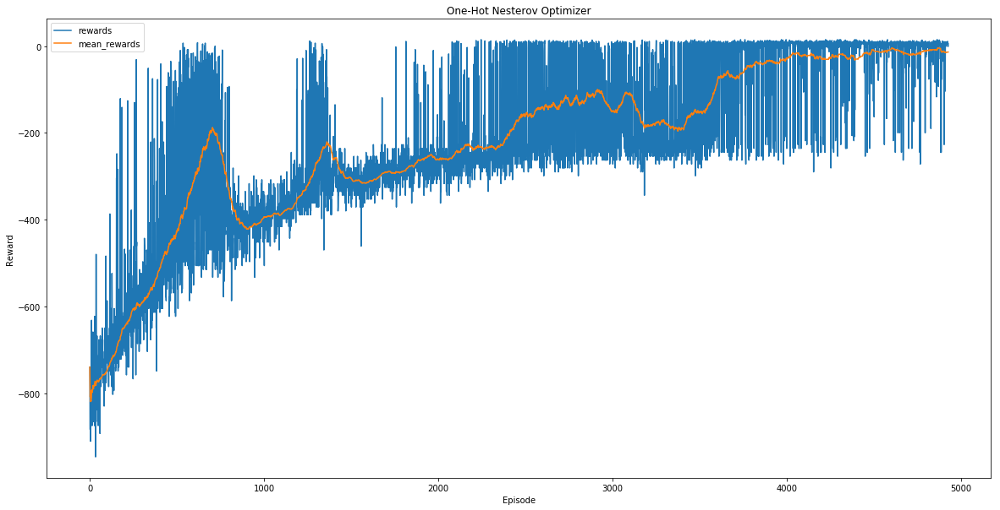

In [21]:
with open('./taxi_agent_ckpt/one_hot_nesterov_training.status', 'rb') as fp:
    training_status = pickle.load(fp) 
    episodes_rewards = training_status['episodes_rewards']
    plt.rcParams['figure.figsize'] = (20, 10)
    plot_rewards(episodes_rewards, 100, title='One-Hot Nesterov Optimizer')